<a href="https://colab.research.google.com/github/Ashish-Tripathy/cv_yantra_drishti/blob/master/EIP_GAN_faceAging_modified_(1)_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Face Aging Using Cyclic GAN
1. <i><b>The code heavily draws from https://github.com/sungnam0/Face-Aging-with-CycleGAN
2. I have kept the architecture similar to his architecture, introducing different learning rates for generator and discriminator & Label Smoothening
3. I have trained for 90 epochs on a GV100 in Paperspace for 9 hours
4. I have downloaded the models from my papaerspace artifacts and have used them to do the predictions on test data
4. Aim was to train for 200 epochs but had heavy network:( so couldnot train it further.
4. The logs are not visible as this is a downloaded file from my paperspace artifacts.I have given screen shots of the tensorboard to show the training process. I know this might not be a good way to submit and will definitely look forward to comments on improving the submission.


# Importing Libraries

In [1]:
!pip install git+https://www.github.com/keras-team/keras-contrib.git

  Cloning https://www.github.com/keras-team/keras-contrib.git to /tmp/pip-req-build-ffm55z2h
  Running command git clone -q https://www.github.com/keras-team/keras-contrib.git /tmp/pip-req-build-ffm55z2h
  Created wheel for keras-contrib: filename=keras_contrib-2.0.8-cp36-none-any.whl size=101066 sha256=50f4a08e722474421216637e71bd5ba17b28912b421612d17bee22b11cf67bf6
  Stored in directory: /tmp/pip-ephem-wheel-cache-rhwsa5c9/wheels/11/27/c8/4ed56de7b55f4f61244e2dc6ef3cdbaff2692527a2ce6502ba
Successfully built keras-contrib


In [2]:
#downgrading scipy for imread and imresize
!pip install scipy==0.19.1

     |████████████████████████████████| 48.2MB 70.2MB/s 
ERROR: yellowbrick 0.9.1 has requirement scipy>=1.0.0, but you'll have scipy 0.19.1 which is incompatible.
ERROR: plotnine 0.5.1 has requirement scipy>=1.0.0, but you'll have scipy 0.19.1 which is incompatible.
ERROR: mir-eval 0.5 has requirement scipy>=1.0.0, but you'll have scipy 0.19.1 which is incompatible.
ERROR: librosa 0.6.3 has requirement scipy>=1.0.0, but you'll have scipy 0.19.1 which is incompatible.
ERROR: cvxpy 1.0.24 has requirement scipy>=1.1.0, but you'll have scipy 0.19.1 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: scipy 1.3.1
    Uninstalling scipy-1.3.1:
      Successfully uninstalled scipy-1.3.1


In [0]:
from glob import glob
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from keras import backend
from keras import Input, Model
from keras.layers import Conv2D, BatchNormalization, Activation, Add, Conv2DTranspose, ZeroPadding2D, LeakyReLU, Lambda#,ReLU
from keras.optimizers import Adam
from keras_contrib.layers import InstanceNormalization
from PIL import *
#from imageio import imread
#from skimage.transform import resize
from tensorflow.python.keras import backend as k
from scipy.misc import imread, imresize


In [0]:
tf.__version__

'1.8.0'

In [4]:
from google.colab import drive
drive.mount('/content/gdrive/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive/


## Untarring the UTK face dataset

In [0]:
!tar -xvf "/content/gdrive/My Drive/EIP2/GAN/Data/crop_part1.tar.gz"

## Shell Script to Segregate data into 20-20 and 50-60 age groups

In [9]:
%%shell
mkdir testA
mkdir testB
for file in /content/crop_part1/*.jpg; do
    MYVAR=$(basename "$file")
    NAME=${MYVAR%%_*}
    if([[ ($NAME -ge 20 && $NAME -le 30) ]])
    then
      cp /content/crop_part1/$MYVAR testA
    elif([[ ($NAME -ge 50 && $NAME -le 60) ]])
    then
      cp /content/crop_part1/$MYVAR testB
    else
      continue
fi
done

In [10]:
# Checking the count of records in any folder
import os
dir = '/content/testB'
print(len([name for name in os.listdir(dir) if os.path.isfile(os.path.join(dir,name))]))

1075


# Building the models

## Residual blocks

In [0]:
def residual_block(x):
  """
  Residual block
"""
  #p = int((ks - 1) / 2)
  #res = tf.pad(x, [[0, 0], [p, p], [p, p], [0, 0]], "REFLECT") 
  res = Conv2D(filters=256, kernel_size=3, strides=1, padding="same")(x)
  res = InstanceNormalization(axis=1)(res)
  res = Activation('relu')(res)
  #res = tf.pad(res, [[0, 0], [p, p], [p, p], [0, 0]], "REFLECT")
  res = Conv2D(filters=256, kernel_size=3, strides=1, padding="same")(res)
  res = InstanceNormalization(axis=1)(res)

  return Add()([res, x])

In [0]:
def expand_label_input(x):
    x = K.expand_dims(x, axis=1)
    x = K.expand_dims(x, axis=1)
    x = K.tile(x, [1, 128, 128, 1])
    return x

## Generator

In [0]:
def build_generator():
    """
    Create a generator network using the hyperparameter values defined below
    """
    input_shape = (128, 128, 3)
    residual_blocks = 9
    input_layer = Input(shape=input_shape)

    # First Convolution block
    x = Conv2D(filters=64, kernel_size=7, strides=1, padding="same")(input_layer)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # 2nd Convolution block
    x = Conv2D(filters=128, kernel_size=3, strides=2, padding="same")(x)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # 3rd Convolution block
    x = Conv2D(filters=256, kernel_size=3, strides=2, padding="same")(x)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # Residual blocks
    for _ in range(residual_blocks):
        x = residual_block(x)

    # Upsampling blocks

    # 1st Upsampling block
    x = Conv2DTranspose(filters=128, kernel_size=3, strides=2, padding='same', use_bias=False)(x)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # 2nd Upsampling block
    x = Conv2DTranspose(filters=64, kernel_size=3, strides=2, padding='same', use_bias=False)(x)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # Last Convolution layer
    x = Conv2D(filters=3, kernel_size=7, strides=1, padding="same")(x)
    output = Activation('tanh')(x)

    model = Model(inputs=[input_layer], outputs=[output])
    return model


Checking the model summary

In [0]:
    input_shape = (128, 128, 3)
    residual_blocks = 9
    input_layer = Input(shape=input_shape)

    # First Convolution block
    x = Conv2D(filters=64, kernel_size=7, strides=1, padding="same")(input_layer)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # 2nd Convolution block
    x = Conv2D(filters=128, kernel_size=3, strides=2, padding="same")(x)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # 3rd Convolution block
    x = Conv2D(filters=256, kernel_size=3, strides=2, padding="same")(x)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # Residual blocks
    for _ in range(residual_blocks):
        x = residual_block(x)

    # Upsampling blocks

    # 1st Upsampling block
    x = Conv2DTranspose(filters=128, kernel_size=3, strides=2, padding='same', use_bias=False)(x)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # 2nd Upsampling block
    x = Conv2DTranspose(filters=64, kernel_size=3, strides=2, padding='same', use_bias=False)(x)
    x = InstanceNormalization(axis=1)(x)
    x = Activation("relu")(x)

    # Last Convolution layer
    x = Conv2D(filters=3, kernel_size=7, strides=1, padding="same")(x)
    output = Activation('tanh')(x)

    model = Model(inputs=[input_layer], outputs=[output])
    model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 128, 128, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 64) 9472        input_1[0][0]                    
__________________________________________________________________________________________________
instance_normalization_1 (Insta (None, 128, 128, 64) 256         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 128, 128, 64) 0           instance_normalization_1[0][0]   
__________________________________________________________________________________________________
conv2d_2 (

## Discriminator

In [0]:
def build_discriminator():
    """
    Create a discriminator network using the hyperparameter values defined below
    """
    input_shape = (128, 128, 3)
    hidden_layers = 3

    input_layer = Input(shape=input_shape)

    x = ZeroPadding2D(padding=(1, 1))(input_layer)

    # 1st Convolutional block
    x = Conv2D(filters=64, kernel_size=4, strides=2, padding="valid")(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = ZeroPadding2D(padding=(1, 1))(x)

    # 3 Hidden Convolution blocks
    for i in range(1, hidden_layers + 1):
        x = Conv2D(filters=2 ** i * 64, kernel_size=4, strides=2, padding="valid")(x)
        x = InstanceNormalization(axis=1)(x)
        x = LeakyReLU(alpha=0.2)(x)

        x = ZeroPadding2D(padding=(1, 1))(x)

    # Last Convolution layer
    output = Conv2D(filters=1, kernel_size=4, strides=1, activation="sigmoid")(x)

    model = Model(inputs=[input_layer], outputs=[output])
    return model


checking the model summary

In [0]:
    input_shape = (128, 128, 3)
    hidden_layers = 3

    input_layer = Input(shape=input_shape)

    x = ZeroPadding2D(padding=(1, 1))(input_layer)

    # 1st Convolutional block
    x = Conv2D(filters=64, kernel_size=4, strides=2, padding="valid")(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = ZeroPadding2D(padding=(1, 1))(x)

    # 3 Hidden Convolution blocks
    for i in range(1, hidden_layers + 1):
        x = Conv2D(filters=2 ** i * 64, kernel_size=4, strides=2, padding="valid")(x)
        x = InstanceNormalization(axis=1)(x)
        x = LeakyReLU(alpha=0.2)(x)

        x = ZeroPadding2D(padding=(1, 1))(x)

    # Last Convolution layer
    output = Conv2D(filters=1, kernel_size=4, strides=1, activation="sigmoid")(x)

    model = Model(inputs=[input_layer], outputs=[output])
    model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 128, 128, 3)       0         
_________________________________________________________________
zero_padding2d_1 (ZeroPaddin (None, 130, 130, 3)       0         
_________________________________________________________________
conv2d_23 (Conv2D)           (None, 64, 64, 64)        3136      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 64, 64, 64)        0         
_________________________________________________________________
zero_padding2d_2 (ZeroPaddin (None, 66, 66, 64)        0         
_________________________________________________________________
conv2d_24 (Conv2D)           (None, 32, 32, 128)       131200    
_________________________________________________________________
instance_normalization_24 (I (None, 32, 32, 128)       64        
__________

In [0]:
data_dir = "/content"
batch_size = 1
epochs = 100

# Load Image function

In [0]:
############################################ Changes needed to get age, gender and race as one hot ecoders for each image #######################################

def load_images(data_dir):
    imagesA = glob(data_dir + '/testA/*.*')
    imagesB = glob(data_dir + '/testB/*.*')

    allImagesA = []
    allImagesB = []

    for index, filename in enumerate(imagesA):
        # Load images
        if index < 1075:
          imgA = imread(filename, mode='RGB')
          imgB = imread(imagesB[index], mode='RGB')


        # Resize images
          imgA = imresize(imgA, (128, 128))
          imgB = imresize(imgB, (128, 128))

        # Randomly horizontally flip images
          if np.random.random() > 0.5:
              imgA = np.fliplr(imgA)
              imgB = np.fliplr(imgB)

          allImagesA.append(imgA)
          allImagesB.append(imgB)

    # Normalize images
    allImagesA = np.array(allImagesA) / 127.5 - 1.
    allImagesB = np.array(allImagesB) / 127.5 - 1.
    return allImagesA, allImagesB

## Load Test images Fuction

In [0]:
def load_test_batch(data_dir, batch_size):
  
    imagesA = glob(data_dir + '/testA/*.*')
    imagesB = glob(data_dir + '/testB/*.*')

    imagesA = np.random.choice(imagesA, batch_size)
    imagesB = np.random.choice(imagesB, batch_size)
    allA=[]
    allB=[]
    for i in range(len(imagesA)):
          # Load images and resize images
          imgA = imresize(imread(imagesA[i], mode='RGB').astype(np.float32), (128, 128))
          imgB = imresize(imread(imagesB[i], mode='RGB').astype(np.float32), (128, 128))

          allA.append(imgA)
          allB.append(imgB)

    return np.array(allA) / 127.5 - 1.0, np.array(allB) / 127.5 - 1.0


def save_images(originalA, generatedB, recosntructedA, originalB, generatedA, reconstructedB, path):
    """
    Save images
    """
    fig = plt.figure()
    ax = fig.add_subplot(2, 3, 1)
    ax.imshow(originalA)
    ax.axis("off")
    ax.set_title("Original")

    ax = fig.add_subplot(2, 3, 2)
    ax.imshow(generatedB)
    ax.axis("off")
    ax.set_title("Generated")

    ax = fig.add_subplot(2, 3, 3)
    ax.imshow(recosntructedA)
    ax.axis("off")
    ax.set_title("Reconstructed")

    ax = fig.add_subplot(2, 3, 4)
    ax.imshow(originalB)
    ax.axis("off")
    ax.set_title("Original")

    ax = fig.add_subplot(2, 3, 5)
    ax.imshow(generatedA)
    ax.axis("off")
    ax.set_title("Generated")

    ax = fig.add_subplot(2, 3, 6)
    ax.imshow(reconstructedB)
    ax.axis("off")
    ax.set_title("Reconstructed")

    plt.savefig(path)


# Tensorboard

In [0]:
!rm -rf logs

In [0]:
def write_log(callback, name, loss, batch_no):
    """
    Write training summary to TensorBoard
    """
    summary = tf.Summary()
    summary_value = summary.value.add()
    summary_value.simple_value = loss
    summary_value.tag = name
    callback.writer.add_summary(summary, batch_no)
    callback.writer.flush()

In [0]:
import datetime
import os
!pip install -q tf-nightly-gpu-2.0-preview
#Load the TensorBoard notebook extension
%load_ext tensorboard
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard = tf.keras.callbacks.TensorBoard(logdir,  write_images=True, write_grads=True,write_graph=True)


mxnet-cu90 1.1.0.post0 has requirement numpy<1.15.0,>=1.8.2, but you'll have numpy 1.17.1 which is incompatible.
You are using pip version 10.0.1, however version 19.2.3 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [0]:
%tensorboard --logdir logs

In [0]:
# initializing weights for the the trainable variables
sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())

# Training

1. Label Smoothening
2. Different optimizers learning rate for dicriminator and generator

In [0]:
import warnings
import datetime
tf.global_variables_initializer()
warnings.filterwarnings('ignore')
batch_size = 1
epochs = 100
mode = 'train'
start_time = datetime.datetime.now()

if mode == 'train':
    """
    Load dataset
    """
    imagesA, imagesB = load_images(data_dir=data_dir)

    # Define the common optimizer
    common_optimizer = Adam(0.0002, 0.5)
    
    # Seperate optimizers for discriminator and generator
    d_optimizer = Adam(0.0004, 0.5)
    g_optimizer = Adam(0.0001, 0.5)
    
    # Build and compile generator networks
    discriminatorA = build_discriminator()
    discriminatorB = build_discriminator()

    discriminatorA.compile(loss='mse', optimizer=d_optimizer, metrics=['accuracy'])
    discriminatorB.compile(loss='mse', optimizer=d_optimizer, metrics=['accuracy'])

    # Build generator networks
    generatorAToB = build_generator()
    generatorBToA = build_generator()

    """
    Create an adversarial network
    """
    inputA = Input(shape=(128, 128, 3))
    inputB = Input(shape=(128, 128, 3))

    # Generated images using both of the generator networks
    generatedB = generatorAToB(inputA)
    generatedA = generatorBToA(inputB)

    # Reconstruct images back to original images
    reconstructedA = generatorBToA(generatedB)
    reconstructedB = generatorAToB(generatedA)

    generatedAId = generatorBToA(inputA)
    generatedBId = generatorAToB(inputB)

    # Make both of the discriminator networks non-trainable
    discriminatorA.trainable = False
    discriminatorB.trainable = False

    probsA = discriminatorA(generatedA)
    probsB = discriminatorB(generatedB)

    adversarial_model = Model(inputs=[inputA, inputB],
                              outputs=[probsA, probsB, reconstructedA, reconstructedB,
                                       generatedAId, generatedBId])
    adversarial_model.compile(loss=['mse', 'mse', 'mae', 'mae', 'mae', 'mae'],
                              loss_weights=[1, 1, 10.0, 10.0, 1.0, 1.0],
                              optimizer=common_optimizer)
   
   
    # writing logs to tensorboard
    tensorboard.set_model(generatorAToB)
    tensorboard.set_model(generatorBToA)
    tensorboard.set_model(discriminatorA)
    tensorboard.set_model(discriminatorB)

    
    # label smoothening
    real_labels = np.full((batch_size, 7, 7, 1),0.9)
    fake_labels = np.zeros((batch_size, 7, 7, 1))

    for epoch in range(epochs):
        print("Epoch:{}".format(epoch))

        dis_losses = []
        gen_losses = []

        num_batches = int(min(imagesA.shape[0], imagesB.shape[0]) / batch_size)
        print("Number of batches:{}".format(num_batches))

        for index in range(num_batches):
            print("Epoch:{}".format(epoch))
            print("Batch:{}".format(index))

            # Sample images
            batchA = imagesA[index * batch_size:(index + 1) * batch_size]
            batchB = imagesB[index * batch_size:(index + 1) * batch_size]

            # Translate images to opposite domain
            generatedB = generatorAToB.predict(batchA)
            generatedA = generatorBToA.predict(batchB)

            # Train the discriminator A on real and fake images
            dALoss1 = discriminatorA.train_on_batch(batchA, real_labels)
            dALoss2 = discriminatorA.train_on_batch(generatedA, fake_labels)

            # Train the discriminator B on ral and fake images
            dBLoss1 = discriminatorB.train_on_batch(batchB, real_labels)
            dbLoss2 = discriminatorB.train_on_batch(generatedB, fake_labels)

            # Calculate the total discriminator loss
            d_loss = 0.5 * np.add(0.5 * np.add(dALoss1, dALoss2), 0.5 * np.add(dBLoss1, dbLoss2))

            print("d_loss:{}".format(d_loss))

            """
            Train the generator networks
            """
            g_loss = adversarial_model.train_on_batch([batchA, batchB],
                                                      [real_labels, real_labels, batchA, batchB, batchA, batchB])

            print("g_loss:{}".format(g_loss))
            print("Time Taken till now:{}".format(datetime.datetime.now()-start_time))

            dis_losses.append(d_loss)
            gen_losses.append(g_loss)
            
        """
        Save losses to Tensorboard after each epoch
        """
        write_log(tensorboard, 'discriminator_loss', np.mean(dis_losses), epoch)
        write_log(tensorboard, 'generator_loss', np.mean(gen_losses), epoch)

        # Sample and save images after every 10 epochs
        if epoch % 10 == 0:
            # Get a batch of test data
            batchA, batchB = load_test_batch(data_dir=data_dir, batch_size=2)

            # Generate images
            generatedB = generatorAToB.predict(batchA)
            generatedA = generatorBToA.predict(batchB)

            # Get reconstructed images
            reconsA = generatorBToA.predict(generatedB)
            reconsB = generatorAToB.predict(generatedA)

            # Save original, generated and reconstructed images
            for i in range(len(generatedA)):
                save_images(originalA=batchA[i], generatedB=generatedB[i], recosntructedA=reconsA[i],
                            originalB=batchB[i], generatedA=generatedA[i], reconstructedB=reconsB[i],
                            path="content/images/gen_{}_{}".format(epoch, i))
                
                # Save models
                generatorAToB.save_weights("content/models/generatorAToB.h5")
                generatorBToA.save_weights("content/models/generatorBToB.h5")
                discriminatorA.save_weights("content/models/discriminatorA.h5")
                discriminatorB.save_weights("content/models/discriminatorB.h5")

elif mode == 'predict':
    # Build generator networks
    generatorAToB = build_generator()
    generatorBToA = build_generator()

    generatorAToB.load_weights("content/models/generatorAToB.h5")
    generatorBToA.load_weights("content/models/generatorBToB.h5")

    # Get a batch of test data
    batchA, batchB = load_test_batch(data_dir=data_dir, batch_size=2)

    # Save images
    generatedB = generatorAToB.predict(batchA)
    generatedA = generatorBToA.predict(batchB)

    reconsA = generatorBToA.predict(generatedB)
    reconsB = generatorAToB.predict(generatedA)

    for i in range(len(generatedA)):
        save_images(originalA=batchA[i], generatedB=generatedB[i], recosntructedA=reconsA[i],
                    originalB=batchB[i], generatedA=generatedA[i], reconstructedB=reconsB[i],
                    path="content/models/predict_{}".format(i))


Epoch:0
Number of batches:1075
Epoch:0
Batch:0
d_loss:[0.6323757 0.       ]
g_loss:[12.614865, 0.009792317, 0.7674851, 0.5117219, 0.5610569, 0.55152154, 0.5582778]
Time Taken till now:0:01:49.458355
Epoch:0
Batch:1
d_loss:[0.5046266 0.       ]
g_loss:[16.116774, 0.009960715, 0.009990074, 0.8889927, 0.57631546, 0.8694838, 0.57425743]
Time Taken till now:0:01:49.801082
Epoch:0
Batch:2
d_loss:[0.49380088 0.        ]
g_loss:[12.102062, 0.05292319, 0.009390213, 0.66320395, 0.43051413, 0.60015553, 0.5024118]
Time Taken till now:0:01:50.152307
Epoch:0
Batch:3
d_loss:[0.49235854 0.        ]
g_loss:[14.457718, 0.7989583, 0.009832335, 0.6113212, 0.6373585, 0.56084967, 0.60127985]
Time Taken till now:0:01:50.517492
Epoch:0
Batch:4
d_loss:[0.2594526 0.25     ]
g_loss:[15.893027, 0.7917323, 0.009578758, 0.8227573, 0.57600445, 0.53074, 0.5733584]
Time Taken till now:0:01:50.883165
Epoch:0
Batch:5
d_loss:[0.50068605 0.25      ]
g_loss:[11.563258, 0.68592477, 0.087038934, 0.49588913, 0.48674092, 0.477

g_loss:[6.971285, 0.044608, 0.7772092, 0.32544744, 0.23713624, 0.3068664, 0.21676427]
Time Taken till now:0:02:05.912732
Epoch:0
Batch:49
d_loss:[0.26372638 0.39795917]
g_loss:[6.872862, 0.52956843, 0.71746874, 0.21581978, 0.2982047, 0.20559193, 0.27998772]
Time Taken till now:0:02:06.251858
Epoch:0
Batch:50
d_loss:[0.3382519 0.3469388]
g_loss:[9.558103, 0.50430584, 0.6817138, 0.40833583, 0.35836926, 0.35746047, 0.34757227]
Time Taken till now:0:02:06.589024
Epoch:0
Batch:51
d_loss:[0.23387924 0.3010204 ]
g_loss:[8.578503, 0.5799807, 0.51703787, 0.3643148, 0.31972194, 0.33946347, 0.30165243]
Time Taken till now:0:02:06.929223
Epoch:0
Batch:52
d_loss:[0.3051834 0.3877551]
g_loss:[7.5982246, 0.59179664, 0.51785785, 0.2551612, 0.3367716, 0.24307498, 0.32616746]
Time Taken till now:0:02:07.263390
Epoch:0
Batch:53
d_loss:[0.20411322 0.4285714 ]
g_loss:[7.154036, 0.5231572, 0.6155182, 0.28995717, 0.2613762, 0.24971718, 0.25230986]
Time Taken till now:0:02:07.604439
Epoch:0
Batch:54
d_loss:[0

g_loss:[4.9493856, 0.41591355, 0.41306767, 0.18938981, 0.19056123, 0.15172061, 0.16917348]
Time Taken till now:0:02:22.311656
Epoch:0
Batch:97
d_loss:[0.4142405  0.08163265]
g_loss:[5.489335, 0.21232708, 0.14012182, 0.15496922, 0.31467405, 0.13410363, 0.3063497]
Time Taken till now:0:02:22.662610
Epoch:0
Batch:98
d_loss:[0.15059555 0.3877551 ]
g_loss:[5.8234196, 0.32929537, 0.37650517, 0.26899898, 0.19922271, 0.24105304, 0.19434872]
Time Taken till now:0:02:23.009727
Epoch:0
Batch:99
d_loss:[0.34880745 0.23469388]
g_loss:[6.7129993, 0.033802383, 0.3411897, 0.3022477, 0.27617148, 0.28194684, 0.27186865]
Time Taken till now:0:02:23.358814
Epoch:0
Batch:100
d_loss:[0.20894173 0.3469388 ]
g_loss:[8.673266, 0.3611595, 0.29501837, 0.2626264, 0.4731034, 0.21401891, 0.44577116]
Time Taken till now:0:02:23.710391
Epoch:0
Batch:101
d_loss:[0.28397882 0.26020408]
g_loss:[5.605591, 0.3340796, 0.16562779, 0.24219447, 0.2278991, 0.18904933, 0.21589828]
Time Taken till now:0:02:24.065193
Epoch:0
Batc

g_loss:[5.13648, 0.20648633, 0.3061639, 0.18774413, 0.23610356, 0.17327131, 0.21208131]
Time Taken till now:0:02:38.746668
Epoch:0
Batch:145
d_loss:[0.23597823 0.22959183]
g_loss:[6.9250307, 0.21103495, 0.3713969, 0.27301055, 0.3078928, 0.2163803, 0.31718534]
Time Taken till now:0:02:39.089530
Epoch:0
Batch:146
d_loss:[0.18416595 0.43367347]
g_loss:[5.8510294, 0.24622226, 0.411072, 0.30973724, 0.16620849, 0.28074455, 0.1535337]
Time Taken till now:0:02:39.430777
Epoch:0
Batch:147
d_loss:[0.25379738 0.2244898 ]
g_loss:[5.0491495, 0.28481305, 0.17860222, 0.24100414, 0.17864177, 0.22315484, 0.16612053]
Time Taken till now:0:02:39.770909
Epoch:0
Batch:148
d_loss:[0.16139503 0.44387755]
g_loss:[6.1209817, 0.2571287, 0.3698264, 0.17130479, 0.3320853, 0.16105491, 0.29907048]
Time Taken till now:0:02:40.109279
Epoch:0
Batch:149
d_loss:[0.33911574 0.19897959]
g_loss:[6.144304, 0.2611885, 0.20589381, 0.24470967, 0.27292868, 0.23780838, 0.26302963]
Time Taken till now:0:02:40.448679
Epoch:0
Batch

g_loss:[4.495876, 0.22946623, 0.23041774, 0.19725695, 0.17191564, 0.18078749, 0.16347829]
Time Taken till now:0:02:55.037153
Epoch:0
Batch:193
d_loss:[0.16932543 0.40816325]
g_loss:[4.6811466, 0.24506906, 0.40617266, 0.20169479, 0.16702326, 0.19075549, 0.15196955]
Time Taken till now:0:02:55.378770
Epoch:0
Batch:194
d_loss:[0.22792532 0.34183675]
g_loss:[7.1548257, 0.24404608, 0.27409312, 0.32694632, 0.28398323, 0.3066736, 0.22071765]
Time Taken till now:0:02:55.715519
Epoch:0
Batch:195
d_loss:[0.22217472 0.38265306]
g_loss:[3.8769503, 0.22009152, 0.2984256, 0.1735937, 0.13300443, 0.16052908, 0.13192275]
Time Taken till now:0:02:56.058080
Epoch:0
Batch:196
d_loss:[0.1848402  0.31632653]
g_loss:[5.4976544, 0.2301122, 0.3655735, 0.19759181, 0.25282425, 0.18510605, 0.2127018]
Time Taken till now:0:02:56.399751
Epoch:0
Batch:197
d_loss:[0.2505216  0.25510204]
g_loss:[4.3414836, 0.26581442, 0.20160063, 0.12818868, 0.22711496, 0.11680585, 0.20422617]
Time Taken till now:0:02:56.739343
Epoch:

g_loss:[6.4180675, 0.30545947, 0.38667107, 0.22707282, 0.3057217, 0.15869164, 0.23930036]
Time Taken till now:0:03:11.257574
Epoch:0
Batch:241
d_loss:[0.22846666 0.42857143]
g_loss:[4.742273, 0.27690667, 0.25943646, 0.22322565, 0.16171056, 0.20322677, 0.15334146]
Time Taken till now:0:03:11.591430
Epoch:0
Batch:242
d_loss:[0.22119771 0.4591837 ]
g_loss:[4.4988604, 0.2153111, 0.29474452, 0.19208276, 0.17524332, 0.18067622, 0.13486779]
Time Taken till now:0:03:11.930187
Epoch:0
Batch:243
d_loss:[0.19135234 0.44387755]
g_loss:[4.498654, 0.22389959, 0.30731082, 0.22721958, 0.13624975, 0.1974242, 0.13532543]
Time Taken till now:0:03:12.266428
Epoch:0
Batch:244
d_loss:[0.21004695 0.34183675]
g_loss:[4.8010645, 0.19983207, 0.36171672, 0.20894755, 0.18016651, 0.1898241, 0.15855125]
Time Taken till now:0:03:12.601291
Epoch:0
Batch:245
d_loss:[0.25461474 0.24489796]
g_loss:[5.9733906, 0.32380477, 0.27740067, 0.25424474, 0.23753357, 0.24404766, 0.21035421]
Time Taken till now:0:03:12.935067
Epoch

g_loss:[3.9715805, 0.18943639, 0.24440531, 0.19512005, 0.12970203, 0.16866986, 0.12084782]
Time Taken till now:0:03:27.457428
Epoch:0
Batch:289
d_loss:[0.18880305 0.43877554]
g_loss:[4.5270233, 0.22400136, 0.24682675, 0.19380754, 0.17731456, 0.18989873, 0.15507519]
Time Taken till now:0:03:27.793435
Epoch:0
Batch:290
d_loss:[0.20919403 0.21938777]
g_loss:[4.392214, 0.25042632, 0.2086448, 0.15671693, 0.20722611, 0.10412209, 0.18959026]
Time Taken till now:0:03:28.130070
Epoch:0
Batch:291
d_loss:[0.21248949 0.4132653 ]
g_loss:[7.2616916, 0.24013996, 0.24237923, 0.42373836, 0.21146327, 0.23025243, 0.1969039]
Time Taken till now:0:03:28.470400
Epoch:0
Batch:292
d_loss:[0.19740115 0.45918366]
g_loss:[4.7434793, 0.21363711, 0.2744262, 0.20068733, 0.18770492, 0.20172305, 0.16977033]
Time Taken till now:0:03:28.809624
Epoch:0
Batch:293
d_loss:[0.20353658 0.46938777]
g_loss:[4.2053876, 0.24116276, 0.32212183, 0.17217243, 0.15965196, 0.1715092, 0.15234974]
Time Taken till now:0:03:29.151679
Epoc

g_loss:[5.341339, 0.2584007, 0.2792112, 0.22477707, 0.2186032, 0.21406068, 0.155864]
Time Taken till now:0:03:43.648145
Epoch:0
Batch:337
d_loss:[0.20010138 0.47959185]
g_loss:[6.5886564, 0.28264543, 0.27194425, 0.28284004, 0.2788726, 0.20671421, 0.21022603]
Time Taken till now:0:03:43.986481
Epoch:0
Batch:338
d_loss:[0.21532838 0.42346936]
g_loss:[5.4200983, 0.24311934, 0.27180675, 0.20467338, 0.24897861, 0.18446855, 0.18418343]
Time Taken till now:0:03:44.328878
Epoch:0
Batch:339
d_loss:[0.2025742 0.4234694]
g_loss:[4.322671, 0.23154576, 0.24612975, 0.12013136, 0.22685856, 0.11004064, 0.26505557]
Time Taken till now:0:03:44.671284
Epoch:0
Batch:340
d_loss:[0.18971267 0.43367347]
g_loss:[4.250097, 0.27526695, 0.2607291, 0.14270929, 0.19721144, 0.11747363, 0.19741967]
Time Taken till now:0:03:45.011731
Epoch:0
Batch:341
d_loss:[0.20963156 0.40816325]
g_loss:[3.1510313, 0.18584558, 0.30959815, 0.115351155, 0.12692696, 0.11002898, 0.12277748]
Time Taken till now:0:03:45.355550
Epoch:0
Ba

g_loss:[4.615575, 0.274265, 0.2156932, 0.23263112, 0.14588779, 0.2060403, 0.13438699]
Time Taken till now:0:03:59.955240
Epoch:0
Batch:385
d_loss:[0.33536568 0.13265306]
g_loss:[4.8798885, 0.1912731, 0.20398913, 0.2372149, 0.17234299, 0.22380716, 0.16524042]
Time Taken till now:0:04:00.290260
Epoch:0
Batch:386
d_loss:[0.19991603 0.47959185]
g_loss:[4.375374, 0.33702382, 0.27440783, 0.15193692, 0.19107108, 0.14826292, 0.18559931]
Time Taken till now:0:04:00.630320
Epoch:0
Batch:387
d_loss:[0.24674957 0.35714287]
g_loss:[5.3701434, 0.26282734, 0.2500008, 0.22778226, 0.21972664, 0.19652939, 0.18569703]
Time Taken till now:0:04:00.969353
Epoch:0
Batch:388
d_loss:[0.18959138 0.49489796]
g_loss:[3.6938512, 0.2877307, 0.3084399, 0.14677295, 0.13740867, 0.13671151, 0.119152784]
Time Taken till now:0:04:01.312347
Epoch:0
Batch:389
d_loss:[0.23105358 0.3877551 ]
g_loss:[4.5880938, 0.2773601, 0.21214275, 0.25260025, 0.12669173, 0.19300225, 0.112669095]
Time Taken till now:0:04:01.652214
Epoch:0
B

g_loss:[4.4889174, 0.22840218, 0.23652478, 0.16724661, 0.20265265, 0.13137539, 0.19362274]
Time Taken till now:0:04:16.157487
Epoch:0
Batch:433
d_loss:[0.21046907 0.23979592]
g_loss:[5.7201376, 0.1658292, 0.26174542, 0.2239594, 0.25945956, 0.21863857, 0.23973495]
Time Taken till now:0:04:16.498384
Epoch:0
Batch:434
d_loss:[0.21138185 0.4132653 ]
g_loss:[3.5713463, 0.19939259, 0.27201492, 0.117503546, 0.16543607, 0.11426434, 0.15627849]
Time Taken till now:0:04:16.837590
Epoch:0
Batch:435
d_loss:[0.22737978 0.43367347]
g_loss:[4.112699, 0.22534133, 0.23046695, 0.12559661, 0.20776252, 0.12118167, 0.2021179]
Time Taken till now:0:04:17.173165
Epoch:0
Batch:436
d_loss:[0.19282955 0.42857143]
g_loss:[3.4971893, 0.24707799, 0.24416292, 0.15141828, 0.12294197, 0.14594527, 0.11640046]
Time Taken till now:0:04:17.511872
Epoch:0
Batch:437
d_loss:[0.20593622 0.37244898]
g_loss:[3.542449, 0.19580097, 0.2503019, 0.1552349, 0.12786727, 0.15218084, 0.113143325]
Time Taken till now:0:04:17.851277
Epoc

g_loss:[3.739483, 0.21383984, 0.25115585, 0.14123747, 0.15714136, 0.1337502, 0.15694904]
Time Taken till now:0:04:32.370257
Epoch:0
Batch:481
d_loss:[0.21279863 0.43367347]
g_loss:[3.3708856, 0.21291159, 0.30739987, 0.14243011, 0.11828132, 0.1386747, 0.10478528]
Time Taken till now:0:04:32.708879
Epoch:0
Batch:482
d_loss:[0.20972    0.44387755]
g_loss:[4.5496173, 0.21213816, 0.2948962, 0.18464518, 0.18312135, 0.18805891, 0.17685893]
Time Taken till now:0:04:33.042800
Epoch:0
Batch:483
d_loss:[0.20796046 0.3010204 ]
g_loss:[4.002018, 0.18759342, 0.22458684, 0.18029377, 0.14821318, 0.16825438, 0.13651375]
Time Taken till now:0:04:33.380750
Epoch:0
Batch:484
d_loss:[0.20124727 0.35714287]
g_loss:[4.2264, 0.19188562, 0.25241277, 0.17236978, 0.17343321, 0.15921536, 0.16485628]
Time Taken till now:0:04:33.717045
Epoch:0
Batch:485
d_loss:[0.19598854 0.29591838]
g_loss:[4.8771243, 0.1818192, 0.28010395, 0.21576276, 0.1878386, 0.19877665, 0.18041079]
Time Taken till now:0:04:34.052503
Epoch:0
B

g_loss:[3.2811995, 0.23446994, 0.27090913, 0.10344678, 0.15060289, 0.09898971, 0.13633388]
Time Taken till now:0:04:48.604854
Epoch:0
Batch:529
d_loss:[0.16441911 0.44387755]
g_loss:[3.8856993, 0.3700179, 0.25733772, 0.14015017, 0.15860459, 0.13065135, 0.14014482]
Time Taken till now:0:04:48.938523
Epoch:0
Batch:530
d_loss:[0.15076584 0.4591837 ]
g_loss:[3.7698908, 0.25982955, 0.31908593, 0.14070004, 0.15068904, 0.14339402, 0.13369069]
Time Taken till now:0:04:49.276771
Epoch:0
Batch:531
d_loss:[0.13944048 0.47959185]
g_loss:[3.2719955, 0.26634544, 0.29151702, 0.12180996, 0.12547556, 0.11820993, 0.12306812]
Time Taken till now:0:04:49.620574
Epoch:0
Batch:532
d_loss:[0.2594748  0.27040815]
g_loss:[4.0490966, 0.2548272, 0.10308223, 0.17837082, 0.15790993, 0.15771565, 0.17066385]
Time Taken till now:0:04:49.957021
Epoch:0
Batch:533
d_loss:[0.13647592 0.5       ]
g_loss:[5.2407126, 0.25647888, 0.37920418, 0.18764037, 0.2369346, 0.16998273, 0.18929651]
Time Taken till now:0:04:50.288236
Ep

g_loss:[2.8921485, 0.21815148, 0.22235446, 0.11313467, 0.110440314, 0.113296494, 0.102596164]
Time Taken till now:0:05:05.031132
Epoch:0
Batch:577
d_loss:[0.19844064 0.44387758]
g_loss:[4.3835344, 0.21480216, 0.28203657, 0.20673971, 0.1491377, 0.18766822, 0.14025323]
Time Taken till now:0:05:05.393231
Epoch:0
Batch:578
d_loss:[0.1952939 0.4489796]
g_loss:[2.9178302, 0.22829966, 0.27796364, 0.122631, 0.09669241, 0.11980188, 0.09853098]
Time Taken till now:0:05:05.751805
Epoch:0
Batch:579
d_loss:[0.20320207 0.23979592]
g_loss:[4.5510297, 0.19209656, 0.30225313, 0.20314462, 0.16765618, 0.19720991, 0.15146203]
Time Taken till now:0:05:06.112124
Epoch:0
Batch:580
d_loss:[0.19410889 0.48469388]
g_loss:[3.776432, 0.23076132, 0.30838576, 0.12622036, 0.17012551, 0.11720602, 0.15662034]
Time Taken till now:0:05:06.469698
Epoch:0
Batch:581
d_loss:[0.19682181 0.4387755 ]
g_loss:[3.8645508, 0.24313948, 0.23133677, 0.18678206, 0.12596104, 0.14965966, 0.11298396]
Time Taken till now:0:05:06.833890
Ep

g_loss:[5.017874, 0.2177084, 0.20653763, 0.18872577, 0.23389009, 0.15793514, 0.20953438]
Time Taken till now:0:05:21.713629
Epoch:0
Batch:625
d_loss:[0.20269579 0.45408165]
g_loss:[4.2381024, 0.22741282, 0.24226835, 0.20039384, 0.14809975, 0.16108422, 0.12240067]
Time Taken till now:0:05:22.055187
Epoch:0
Batch:626
d_loss:[0.21154359 0.42857143]
g_loss:[3.4352438, 0.22632822, 0.24845143, 0.12857366, 0.14474156, 0.110738024, 0.11657404]
Time Taken till now:0:05:22.395893
Epoch:0
Batch:627
d_loss:[0.19903807 0.47959185]
g_loss:[4.3191032, 0.23431614, 0.27930313, 0.17811182, 0.17627794, 0.123245776, 0.13834086]
Time Taken till now:0:05:22.739673
Epoch:0
Batch:628
d_loss:[0.17313866 0.44387758]
g_loss:[3.8265853, 0.2592827, 0.24486262, 0.13813886, 0.16518843, 0.12970416, 0.15946274]
Time Taken till now:0:05:23.083416
Epoch:0
Batch:629
d_loss:[0.16075966 0.49489796]
g_loss:[3.168598, 0.24877663, 0.2698171, 0.11230856, 0.12962477, 0.10041566, 0.13025525]
Time Taken till now:0:05:23.420032
Ep

g_loss:[3.431786, 0.24338748, 0.24987666, 0.14097345, 0.12667218, 0.13329528, 0.12877047]
Time Taken till now:0:05:38.005921
Epoch:0
Batch:673
d_loss:[0.24454659 0.33163267]
g_loss:[4.820153, 0.19475925, 0.29455766, 0.17008542, 0.22489637, 0.15816464, 0.22285417]
Time Taken till now:0:05:38.347491
Epoch:0
Batch:674
d_loss:[0.19303519 0.4489796 ]
g_loss:[3.8434289, 0.21521354, 0.33363885, 0.10840647, 0.1916402, 0.105281666, 0.1888279]
Time Taken till now:0:05:38.684830
Epoch:0
Batch:675
d_loss:[0.21391168 0.46938777]
g_loss:[3.2265773, 0.30775714, 0.28951654, 0.11466654, 0.12666172, 0.10059148, 0.11542968]
Time Taken till now:0:05:39.018949
Epoch:0
Batch:676
d_loss:[0.2131114 0.5      ]
g_loss:[3.5899208, 0.25236678, 0.30621648, 0.12247823, 0.15726899, 0.091208875, 0.14265642]
Time Taken till now:0:05:39.355580
Epoch:0
Batch:677
d_loss:[0.27785903 0.3214286 ]
g_loss:[3.4719653, 0.21609452, 0.1519111, 0.13287899, 0.15073821, 0.12598157, 0.141806]
Time Taken till now:0:05:39.694162
Epoch:

g_loss:[4.8521256, 0.21687585, 0.25906253, 0.21718405, 0.17984977, 0.21355516, 0.19229382]
Time Taken till now:0:05:54.213325
Epoch:0
Batch:721
d_loss:[0.15235013 0.38265306]
g_loss:[3.7896786, 0.22776152, 0.31234208, 0.17664135, 0.11870321, 0.1830627, 0.1130664]
Time Taken till now:0:05:54.548536
Epoch:0
Batch:722
d_loss:[0.22474879 0.40816328]
g_loss:[3.2681835, 0.23726507, 0.2565233, 0.14701083, 0.10896653, 0.123882756, 0.09073888]
Time Taken till now:0:05:54.884885
Epoch:0
Batch:723
d_loss:[0.20192145 0.45918366]
g_loss:[3.5338829, 0.23503126, 0.27844548, 0.10565454, 0.17027062, 0.1051514, 0.156003]
Time Taken till now:0:05:55.220447
Epoch:0
Batch:724
d_loss:[0.20795116 0.2857143 ]
g_loss:[3.1801522, 0.16802678, 0.34128046, 0.10468085, 0.14151067, 0.07566033, 0.13326956]
Time Taken till now:0:05:55.562311
Epoch:0
Batch:725
d_loss:[0.21204004 0.46428573]
g_loss:[3.908479, 0.28412426, 0.24106431, 0.15814821, 0.15604669, 0.09872967, 0.14261183]
Time Taken till now:0:05:55.897474
Epoch

g_loss:[3.7983477, 0.25750035, 0.37358797, 0.1602076, 0.12720579, 0.14367068, 0.14945486]
Time Taken till now:0:06:10.423471
Epoch:0
Batch:769
d_loss:[0.23359862 0.4489796 ]
g_loss:[2.6750677, 0.2057231, 0.2746087, 0.11488885, 0.08286375, 0.12718542, 0.09002465]
Time Taken till now:0:06:10.759649
Epoch:0
Batch:770
d_loss:[0.16201952 0.38265306]
g_loss:[2.8405943, 0.2766693, 0.20943716, 0.08912185, 0.12495735, 0.09232862, 0.12136747]
Time Taken till now:0:06:11.098605
Epoch:0
Batch:771
d_loss:[0.20425993 0.48979592]
g_loss:[3.9183834, 0.2058114, 0.33519417, 0.12700424, 0.18127081, 0.12117731, 0.17345]
Time Taken till now:0:06:11.437686
Epoch:0
Batch:772
d_loss:[0.15672044 0.40816325]
g_loss:[3.5841472, 0.23059978, 0.23970298, 0.16768447, 0.11558141, 0.17694348, 0.10424234]
Time Taken till now:0:06:11.781561
Epoch:0
Batch:773
d_loss:[0.2931056  0.21938775]
g_loss:[3.2028463, 0.19727275, 0.23936696, 0.15005064, 0.10432787, 0.13541523, 0.08700604]
Time Taken till now:0:06:12.123094
Epoch:0

g_loss:[3.9212081, 0.27088884, 0.35006154, 0.15223292, 0.15092915, 0.14070709, 0.12792987]
Time Taken till now:0:06:26.626559
Epoch:0
Batch:817
d_loss:[0.21676752 0.42857143]
g_loss:[3.5534298, 0.22088799, 0.2851952, 0.19329223, 0.084944166, 0.18598376, 0.07899879]
Time Taken till now:0:06:26.960330
Epoch:0
Batch:818
d_loss:[0.20670031 0.46938777]
g_loss:[3.2907767, 0.22378576, 0.31639197, 0.13338524, 0.120664455, 0.102103814, 0.107998475]
Time Taken till now:0:06:27.298623
Epoch:0
Batch:819
d_loss:[0.21937807 0.41836733]
g_loss:[3.0257182, 0.17138882, 0.3484957, 0.0880528, 0.14039831, 0.07854414, 0.14277844]
Time Taken till now:0:06:27.634157
Epoch:0
Batch:820
d_loss:[0.31151268 0.29081634]
g_loss:[3.140986, 0.19859625, 0.16722153, 0.15923038, 0.09517266, 0.15231931, 0.07881835]
Time Taken till now:0:06:27.966794
Epoch:0
Batch:821
d_loss:[0.25975233 0.23979592]
g_loss:[4.088758, 0.19055246, 0.19359004, 0.1932367, 0.14618306, 0.17671008, 0.13370797]
Time Taken till now:0:06:28.302228
E

g_loss:[3.6910214, 0.20833096, 0.32563993, 0.19841498, 0.08795771, 0.20202947, 0.09129398]
Time Taken till now:0:06:42.863025
Epoch:0
Batch:865
d_loss:[0.19601661 0.40816325]
g_loss:[3.400541, 0.19170474, 0.34071198, 0.12959704, 0.13356337, 0.11072588, 0.12579411]
Time Taken till now:0:06:43.202554
Epoch:0
Batch:866
d_loss:[0.21680318 0.3367347 ]
g_loss:[3.291468, 0.17620587, 0.28559256, 0.14234304, 0.11754846, 0.115432605, 0.11532222]
Time Taken till now:0:06:43.541092
Epoch:0
Batch:867
d_loss:[0.24413602 0.22448981]
g_loss:[3.6223261, 0.19993104, 0.2556152, 0.15960753, 0.12992202, 0.15384457, 0.117639944]
Time Taken till now:0:06:43.880074
Epoch:0
Batch:868
d_loss:[0.24140963 0.39795917]
g_loss:[3.8297412, 0.20732865, 0.30996287, 0.11283404, 0.19415487, 0.09647917, 0.14608139]
Time Taken till now:0:06:44.217090
Epoch:0
Batch:869
d_loss:[0.20789173 0.45408165]
g_loss:[4.168812, 0.19810392, 0.30880436, 0.09984398, 0.23772022, 0.0745223, 0.21173906]
Time Taken till now:0:06:44.559498
Ep

g_loss:[3.628247, 0.22675516, 0.27625802, 0.18129407, 0.1065098, 0.1496686, 0.097526215]
Time Taken till now:0:06:59.040985
Epoch:0
Batch:913
d_loss:[0.20629576 0.48469388]
g_loss:[3.8475828, 0.2627773, 0.27575237, 0.16052738, 0.14691593, 0.12840375, 0.10621652]
Time Taken till now:0:06:59.373588
Epoch:0
Batch:914
d_loss:[0.2790473 0.2244898]
g_loss:[4.3861227, 0.19296074, 0.23827681, 0.1636745, 0.19930202, 0.13867192, 0.18644804]
Time Taken till now:0:06:59.710188
Epoch:0
Batch:915
d_loss:[0.18441124 0.48979592]
g_loss:[2.936476, 0.27400374, 0.28209054, 0.10322608, 0.115428254, 0.08775623, 0.106082276]
Time Taken till now:0:07:00.047794
Epoch:0
Batch:916
d_loss:[0.20316724 0.43367347]
g_loss:[2.748942, 0.3053527, 0.22082564, 0.09109503, 0.11238368, 0.084782824, 0.1031936]
Time Taken till now:0:07:00.386630
Epoch:0
Batch:917
d_loss:[0.17554933 0.5       ]
g_loss:[3.6082275, 0.24557847, 0.28362614, 0.17813687, 0.10441582, 0.15692547, 0.096570596]
Time Taken till now:0:07:00.722767
Epoch

g_loss:[3.52842, 0.24180552, 0.32493043, 0.13662906, 0.13230479, 0.13489327, 0.1374524]
Time Taken till now:0:07:15.201040
Epoch:0
Batch:961
d_loss:[0.19389382 0.42857143]
g_loss:[4.3011026, 0.23862302, 0.2719823, 0.18766282, 0.15995952, 0.16522083, 0.14905266]
Time Taken till now:0:07:15.538669
Epoch:0
Batch:962
d_loss:[0.17711273 0.48469388]
g_loss:[3.0717616, 0.23924732, 0.3164784, 0.110131346, 0.1204842, 0.10657161, 0.10330865]
Time Taken till now:0:07:15.874217
Epoch:0
Batch:963
d_loss:[0.16760132 0.46938777]
g_loss:[4.278937, 0.22882487, 0.3337626, 0.17716831, 0.16835263, 0.12842506, 0.132715]
Time Taken till now:0:07:16.208535
Epoch:0
Batch:964
d_loss:[0.22631055 0.4489796 ]
g_loss:[3.5675402, 0.19568765, 0.33909857, 0.098061875, 0.17828327, 0.08116846, 0.18813384]
Time Taken till now:0:07:16.542914
Epoch:0
Batch:965
d_loss:[0.17763114 0.4591837 ]
g_loss:[3.6634111, 0.20772374, 0.50328934, 0.15150434, 0.11836573, 0.14614931, 0.107547946]
Time Taken till now:0:07:16.876469
Epoch:

g_loss:[2.88023, 0.20961267, 0.28504536, 0.11171666, 0.107553385, 0.09736821, 0.09550324]
Time Taken till now:0:07:31.547397
Epoch:0
Batch:1009
d_loss:[0.15449396 0.4234694 ]
g_loss:[5.1232224, 0.35881752, 0.30386606, 0.20778728, 0.1984688, 0.20630747, 0.19167031]
Time Taken till now:0:07:31.889614
Epoch:0
Batch:1010
d_loss:[0.18260325 0.4387755 ]
g_loss:[3.929429, 0.20148851, 0.30743, 0.15442309, 0.16031662, 0.14986151, 0.12325193]
Time Taken till now:0:07:32.227449
Epoch:0
Batch:1011
d_loss:[0.20496754 0.33163264]
g_loss:[3.7354918, 0.22013444, 0.2595084, 0.11632948, 0.18123817, 0.109210566, 0.17096177]
Time Taken till now:0:07:32.566976
Epoch:0
Batch:1012
d_loss:[0.1037328 0.5      ]
g_loss:[4.0462623, 0.31689993, 0.413311, 0.08148974, 0.22082382, 0.0767294, 0.21618648]
Time Taken till now:0:07:32.900249
Epoch:0
Batch:1013
d_loss:[0.23306543 0.3877551 ]
g_loss:[3.5759706, 0.17547506, 0.34099182, 0.12807027, 0.14819789, 0.12650166, 0.17032067]
Time Taken till now:0:07:33.236581
Epoch

g_loss:[3.673679, 0.24598388, 0.20618063, 0.16232757, 0.13281609, 0.15557358, 0.11450426]
Time Taken till now:0:07:47.327428
Epoch:0
Batch:1056
d_loss:[0.19804133 0.40816328]
g_loss:[2.8793712, 0.22375241, 0.24699035, 0.1093432, 0.11095266, 0.10332771, 0.10234203]
Time Taken till now:0:07:47.660578
Epoch:0
Batch:1057
d_loss:[0.23587504 0.31632653]
g_loss:[3.686998, 0.19991411, 0.24571417, 0.1610579, 0.13716486, 0.13359883, 0.12554348]
Time Taken till now:0:07:47.990306
Epoch:0
Batch:1058
d_loss:[0.1433602 0.4744898]
g_loss:[3.4209592, 0.22295341, 0.30613673, 0.09878875, 0.16363776, 0.08869199, 0.17891218]
Time Taken till now:0:07:48.324654
Epoch:0
Batch:1059
d_loss:[0.19840148 0.41326532]
g_loss:[4.5119233, 0.24380027, 0.33354974, 0.21291232, 0.1463409, 0.21053727, 0.1315037]
Time Taken till now:0:07:48.655009
Epoch:0
Batch:1060
d_loss:[0.2123988 0.4387755]
g_loss:[3.2600808, 0.2041739, 0.28078544, 0.09653016, 0.15734054, 0.088061586, 0.14835277]
Time Taken till now:0:07:48.989132
Epoc

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


g_loss:[4.2051773, 0.18296942, 0.289845, 0.15211844, 0.18694419, 0.15114278, 0.19059378]
Time Taken till now:0:07:53.648477


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:1
Number of batches:1075
Epoch:1
Batch:0
d_loss:[0.20832953 0.3622449 ]
g_loss:[3.391432, 0.1706632, 0.29755965, 0.16059247, 0.1063748, 0.16081254, 0.092723794]
Time Taken till now:0:11:18.399758
Epoch:1
Batch:1
d_loss:[0.19067517 0.4132653 ]
g_loss:[3.6800368, 0.21235193, 0.30740026, 0.165884, 0.12484904, 0.15067916, 0.10227507]
Time Taken till now:0:11:18.743561
Epoch:1
Batch:2
d_loss:[0.2097479  0.40816325]
g_loss:[2.983471, 0.18862234, 0.29613608, 0.10528867, 0.12461947, 0.09622984, 0.10340151]
Time Taken till now:0:11:19.089098
Epoch:1
Batch:3
d_loss:[0.18189111 0.4234694 ]
g_loss:[3.3185353, 0.25719568, 0.256627, 0.09689051, 0.15786363, 0.09814959, 0.15902156]
Time Taken till now:0:11:19.453807
Epoch:1
Batch:4
d_loss:[0.19274223 0.47959185]
g_loss:[3.2497368, 0.23068897, 0.2858851, 0.13164039, 0.11984341, 0.116790116, 0.101534486]
Time Taken till now:0:11:19.817455
Epoch:1
Batch:5
d_loss:[0.1861865  0.44387755]
g_loss:[3.459866, 0.2850328, 0.25966573, 0.098663434, 0.1695908

g_loss:[3.085874, 0.27320606, 0.31101146, 0.1189491, 0.1095774, 0.11504268, 0.101348996]
Time Taken till now:0:11:34.233806
Epoch:1
Batch:48
d_loss:[0.20620146 0.48469388]
g_loss:[3.115488, 0.23052484, 0.29328007, 0.13696633, 0.09923783, 0.1349628, 0.09467858]
Time Taken till now:0:11:34.569682
Epoch:1
Batch:49
d_loss:[0.23167597 0.37755102]
g_loss:[2.9998982, 0.27000132, 0.26658356, 0.11268475, 0.114145786, 0.09449823, 0.10050997]
Time Taken till now:0:11:34.907670
Epoch:1
Batch:50
d_loss:[0.22376934 0.26530612]
g_loss:[4.1262918, 0.23649369, 0.2305987, 0.17148972, 0.1679001, 0.13319351, 0.13210793]
Time Taken till now:0:11:35.237734
Epoch:1
Batch:51
d_loss:[0.15233573 0.4744898 ]
g_loss:[3.5946255, 0.30587217, 0.30281553, 0.13823065, 0.13447714, 0.12268934, 0.13617066]
Time Taken till now:0:11:35.584283
Epoch:1
Batch:52
d_loss:[0.22290595 0.4387755 ]
g_loss:[3.3723474, 0.24436137, 0.3147347, 0.13107845, 0.12445619, 0.12938944, 0.12851514]
Time Taken till now:0:11:35.917988
Epoch:1
Ba

g_loss:[3.700254, 0.2124778, 0.27454582, 0.15799817, 0.13835478, 0.12794137, 0.12175943]
Time Taken till now:0:11:50.181881
Epoch:1
Batch:96
d_loss:[0.18057069 0.38265306]
g_loss:[2.845319, 0.24047194, 0.30194733, 0.106366254, 0.1063515, 0.08204423, 0.0936782]
Time Taken till now:0:11:50.508183
Epoch:1
Batch:97
d_loss:[0.23902306 0.27040815]
g_loss:[2.9601092, 0.18353774, 0.26289225, 0.081227414, 0.1511018, 0.06649889, 0.12388801]
Time Taken till now:0:11:50.837589
Epoch:1
Batch:98
d_loss:[0.21250372 0.41836733]
g_loss:[4.3822284, 0.20586294, 0.28981423, 0.18425633, 0.17445858, 0.15800832, 0.14139393]
Time Taken till now:0:11:51.166143
Epoch:1
Batch:99
d_loss:[0.19559266 0.39795917]
g_loss:[2.9720793, 0.2306889, 0.2672189, 0.12423046, 0.1008935, 0.1261882, 0.09674363]
Time Taken till now:0:11:51.493571
Epoch:1
Batch:100
d_loss:[0.19639868 0.4387755 ]
g_loss:[2.7826707, 0.20961736, 0.30409634, 0.08067233, 0.12736309, 0.060950764, 0.12765223]
Time Taken till now:0:11:51.826187
Epoch:1
Ba

g_loss:[4.0594363, 0.20561798, 0.26570615, 0.1585406, 0.16945162, 0.1491225, 0.15906724]
Time Taken till now:0:12:06.072310
Epoch:1
Batch:144
d_loss:[0.19995265 0.3877551 ]
g_loss:[3.0011482, 0.2610462, 0.21851869, 0.11670299, 0.1145037, 0.10404811, 0.10546844]
Time Taken till now:0:12:06.402903
Epoch:1
Batch:145
d_loss:[0.136174  0.4030612]
g_loss:[3.364164, 0.34948707, 0.24723473, 0.0752674, 0.17743438, 0.07030938, 0.170115]
Time Taken till now:0:12:06.741456
Epoch:1
Batch:146
d_loss:[0.17248619 0.4591837 ]
g_loss:[3.3264182, 0.26040152, 0.31186655, 0.12875807, 0.124210015, 0.12049913, 0.103970245]
Time Taken till now:0:12:07.071298
Epoch:1
Batch:147
d_loss:[0.14952278 0.46428573]
g_loss:[4.6576524, 0.28161395, 0.310196, 0.2277452, 0.14320375, 0.21384805, 0.1425049]
Time Taken till now:0:12:07.406225
Epoch:1
Batch:148
d_loss:[0.21452671 0.37244898]
g_loss:[3.492069, 0.2722833, 0.23659483, 0.124828346, 0.14946654, 0.094668426, 0.14557362]
Time Taken till now:0:12:07.734140
Epoch:1
Bat

g_loss:[2.7488286, 0.19332084, 0.37231216, 0.102724776, 0.095546134, 0.09917775, 0.10130884]
Time Taken till now:0:12:21.746021
Epoch:1
Batch:191
d_loss:[0.34768677 0.19387755]
g_loss:[3.2276585, 0.17340158, 0.12682077, 0.121067934, 0.1472252, 0.09584258, 0.14866214]
Time Taken till now:0:12:22.075481
Epoch:1
Batch:192
d_loss:[0.18671934 0.3877551 ]
g_loss:[4.0577817, 0.18387316, 0.32160228, 0.18043908, 0.14672738, 0.16492581, 0.115715936]
Time Taken till now:0:12:22.407689
Epoch:1
Batch:193
d_loss:[0.2012572  0.39795917]
g_loss:[3.1740274, 0.1833899, 0.3222577, 0.1453705, 0.09804536, 0.14624983, 0.08797173]
Time Taken till now:0:12:22.741965
Epoch:1
Batch:194
d_loss:[0.13268824 0.46428573]
g_loss:[3.373955, 0.26928002, 0.42301053, 0.11006816, 0.13673308, 0.09576937, 0.117882624]
Time Taken till now:0:12:23.077684
Epoch:1
Batch:195
d_loss:[0.2424637  0.17857143]
g_loss:[2.8239455, 0.16446795, 0.25378165, 0.11565082, 0.10448331, 0.116549805, 0.08780505]
Time Taken till now:0:12:23.40645

g_loss:[3.4273553, 0.24868526, 0.31621206, 0.1653498, 0.09556986, 0.16292115, 0.09034027]
Time Taken till now:0:12:37.908624
Epoch:1
Batch:239
d_loss:[0.19451767 0.42857143]
g_loss:[3.1351748, 0.18623869, 0.33286792, 0.12293539, 0.11739807, 0.10224145, 0.110491976]
Time Taken till now:0:12:38.238381
Epoch:1
Batch:240
d_loss:[0.15009327 0.49489796]
g_loss:[2.694391, 0.2422346, 0.30944648, 0.07936649, 0.11662915, 0.07060887, 0.112144664]
Time Taken till now:0:12:38.570678
Epoch:1
Batch:241
d_loss:[0.20348907 0.3877551 ]
g_loss:[3.555205, 0.22443491, 0.21760547, 0.1682553, 0.11654484, 0.1582594, 0.106903866]
Time Taken till now:0:12:38.900655
Epoch:1
Batch:242
d_loss:[0.22749314 0.37755102]
g_loss:[3.19942, 0.1856763, 0.27905706, 0.1293815, 0.12250215, 0.11309237, 0.102757946]
Time Taken till now:0:12:39.226899
Epoch:1
Batch:243
d_loss:[0.25876904 0.1734694 ]
g_loss:[2.8068972, 0.16243075, 0.31910864, 0.10149396, 0.112408966, 0.082757875, 0.10357036]
Time Taken till now:0:12:39.558356
Epo

g_loss:[3.1265073, 0.24947801, 0.25431395, 0.10923384, 0.13095734, 0.09977923, 0.12102444]
Time Taken till now:0:12:53.897522
Epoch:1
Batch:287
d_loss:[0.15173389 0.40816325]
g_loss:[2.9744432, 0.24721035, 0.36078796, 0.09232024, 0.12531315, 0.07944502, 0.11066578]
Time Taken till now:0:12:54.226758
Epoch:1
Batch:288
d_loss:[0.19809142 0.3367347 ]
g_loss:[2.9638178, 0.16607226, 0.25467008, 0.12174992, 0.11187161, 0.105873376, 0.10098691]
Time Taken till now:0:12:54.562158
Epoch:1
Batch:289
d_loss:[0.13248584 0.4489796 ]
g_loss:[3.4271495, 0.2738908, 0.396417, 0.15408503, 0.098415256, 0.14887542, 0.0829635]
Time Taken till now:0:12:54.893053
Epoch:1
Batch:290
d_loss:[0.20702636 0.31632653]
g_loss:[2.6090114, 0.28025994, 0.23331346, 0.07848117, 0.1128511, 0.0774931, 0.104622126]
Time Taken till now:0:12:55.225792
Epoch:1
Batch:291
d_loss:[0.20476335 0.3877551 ]
g_loss:[3.5250797, 0.20701171, 0.27060202, 0.13067721, 0.1464961, 0.1360133, 0.13971937]
Time Taken till now:0:12:55.561221
Epoc

g_loss:[3.1080813, 0.21726272, 0.08458739, 0.12735093, 0.12883684, 0.11653154, 0.1278219]
Time Taken till now:0:13:09.757635
Epoch:1
Batch:335
d_loss:[0.20084637 0.44387755]
g_loss:[2.6248531, 0.22601578, 0.2772612, 0.072167926, 0.12430241, 0.05200711, 0.10486565]
Time Taken till now:0:13:10.081663
Epoch:1
Batch:336
d_loss:[0.20263645 0.42857143]
g_loss:[3.9954488, 0.2305818, 0.3509249, 0.20406412, 0.1099205, 0.18328312, 0.09081297]
Time Taken till now:0:13:10.410796
Epoch:1
Batch:337
d_loss:[0.21270767 0.3010204 ]
g_loss:[3.036398, 0.26290712, 0.2649644, 0.121080786, 0.11089078, 0.10530059, 0.08351013]
Time Taken till now:0:13:10.739836
Epoch:1
Batch:338
d_loss:[0.20533615 0.47959185]
g_loss:[3.3715882, 0.2357601, 0.31001773, 0.098792806, 0.15921575, 0.078547254, 0.16717757]
Time Taken till now:0:13:11.065674
Epoch:1
Batch:339
d_loss:[0.19906181 0.46938777]
g_loss:[3.5540605, 0.23749784, 0.30250508, 0.093173385, 0.18243383, 0.08945656, 0.1685287]
Time Taken till now:0:13:11.389564
Epo

g_loss:[2.9989429, 0.19653071, 0.31390235, 0.09941066, 0.13011636, 0.08135581, 0.11188397]
Time Taken till now:0:13:25.625193
Epoch:1
Batch:383
d_loss:[0.19641307 0.3469388 ]
g_loss:[2.758225, 0.19075398, 0.31938836, 0.11939575, 0.08670585, 0.10114144, 0.08592501]
Time Taken till now:0:13:25.960952
Epoch:1
Batch:384
d_loss:[0.24778399 0.22448981]
g_loss:[3.5807543, 0.13142549, 0.27015993, 0.15674356, 0.13712016, 0.13601762, 0.104514375]
Time Taken till now:0:13:26.290650
Epoch:1
Batch:385
d_loss:[0.23764491 0.23469388]
g_loss:[3.8166137, 0.24215408, 0.22294807, 0.18117656, 0.12886563, 0.13456981, 0.11651999]
Time Taken till now:0:13:26.619210
Epoch:1
Batch:386
d_loss:[0.1905368  0.37244898]
g_loss:[2.5464678, 0.19172312, 0.3207784, 0.10189777, 0.08405824, 0.09798048, 0.07642568]
Time Taken till now:0:13:26.949695
Epoch:1
Batch:387
d_loss:[0.22969073 0.3622449 ]
g_loss:[3.9482768, 0.180175, 0.3298777, 0.1840808, 0.13505448, 0.14971012, 0.09716101]
Time Taken till now:0:13:27.282628
Epoc

g_loss:[3.1186235, 0.18144678, 0.40654576, 0.13968599, 0.09345423, 0.11477881, 0.084450066]
Time Taken till now:0:13:41.131013
Epoch:1
Batch:430
d_loss:[0.19087055 0.45408165]
g_loss:[3.3061402, 0.21145307, 0.2931221, 0.12630737, 0.13400435, 0.10874913, 0.08969855]
Time Taken till now:0:13:41.461970
Epoch:1
Batch:431
d_loss:[0.17636275 0.47959185]
g_loss:[2.7654612, 0.19786835, 0.32035717, 0.11013353, 0.09503069, 0.108297795, 0.08729574]
Time Taken till now:0:13:41.795470
Epoch:1
Batch:432
d_loss:[0.17190722 0.38265306]
g_loss:[3.974176, 0.19679831, 0.32513556, 0.13573448, 0.18492346, 0.09958975, 0.14607283]
Time Taken till now:0:13:42.127794
Epoch:1
Batch:433
d_loss:[0.22871393 0.37755102]
g_loss:[3.9594736, 0.1666165, 0.31275067, 0.17138627, 0.14684209, 0.16055492, 0.13726786]
Time Taken till now:0:13:42.456558
Epoch:1
Batch:434
d_loss:[0.2612358  0.18367347]
g_loss:[2.5759044, 0.18967468, 0.11597771, 0.09405443, 0.11423252, 0.08309765, 0.10428476]
Time Taken till now:0:13:42.784837


g_loss:[3.4289908, 0.17340164, 0.37730828, 0.15605831, 0.10864508, 0.13617982, 0.09506704]
Time Taken till now:0:13:56.550281
Epoch:1
Batch:477
d_loss:[0.19890985 0.39285713]
g_loss:[3.1750083, 0.17998473, 0.3160194, 0.10256277, 0.14220276, 0.09356359, 0.13778555]
Time Taken till now:0:13:56.878367
Epoch:1
Batch:478
d_loss:[0.18889263 0.34183675]
g_loss:[4.553842, 0.20689805, 0.20574823, 0.21584451, 0.16192016, 0.21315931, 0.15038988]
Time Taken till now:0:13:57.206430
Epoch:1
Batch:479
d_loss:[0.14519875 0.4744898 ]
g_loss:[2.7248383, 0.2046625, 0.3729213, 0.099449664, 0.09807006, 0.09584096, 0.07621622]
Time Taken till now:0:13:57.530571
Epoch:1
Batch:480
d_loss:[0.15939468 0.44387758]
g_loss:[3.7882082, 0.18422975, 0.31421444, 0.14718074, 0.15392888, 0.13143796, 0.14722988]
Time Taken till now:0:13:57.855453
Epoch:1
Batch:481
d_loss:[0.15119958 0.4489796 ]
g_loss:[3.3195457, 0.2250951, 0.36665, 0.143117, 0.10782817, 0.12054148, 0.09780738]
Time Taken till now:0:13:58.179179
Epoch:1


g_loss:[3.8141422, 0.22008434, 0.40043968, 0.11800985, 0.17843406, 0.095178336, 0.13400042]
Time Taken till now:0:14:12.228388
Epoch:1
Batch:525
d_loss:[0.24599707 0.26020408]
g_loss:[3.624604, 0.20450044, 0.32772842, 0.1739113, 0.10892649, 0.16370666, 0.10029053]
Time Taken till now:0:14:12.555118
Epoch:1
Batch:526
d_loss:[0.1343919  0.39795917]
g_loss:[3.0931177, 0.19580312, 0.44098446, 0.13121, 0.09244246, 0.13320261, 0.086603]
Time Taken till now:0:14:12.886697
Epoch:1
Batch:527
d_loss:[0.23767143 0.19897959]
g_loss:[2.9536772, 0.1998273, 0.22302355, 0.083642036, 0.14718798, 0.08032653, 0.14219968]
Time Taken till now:0:14:13.214676
Epoch:1
Batch:528
d_loss:[0.19338365 0.39795917]
g_loss:[3.48359, 0.30427712, 0.24451683, 0.13792089, 0.135322, 0.077734694, 0.12463229]
Time Taken till now:0:14:13.544076
Epoch:1
Batch:529
d_loss:[0.14407322 0.47959185]
g_loss:[3.238454, 0.38733652, 0.3488505, 0.10302653, 0.12720944, 0.09850407, 0.101403475]
Time Taken till now:0:14:13.871853
Epoch:1
B

g_loss:[2.2714953, 0.19348025, 0.22013003, 0.09450934, 0.0755557, 0.086756766, 0.07047801]
Time Taken till now:0:14:27.775619
Epoch:1
Batch:572
d_loss:[0.2052817 0.3367347]
g_loss:[3.059176, 0.3226152, 0.19112583, 0.106897265, 0.12569018, 0.09768607, 0.121874616]
Time Taken till now:0:14:28.108378
Epoch:1
Batch:573
d_loss:[0.16693081 0.45408165]
g_loss:[2.5547924, 0.29337773, 0.2730698, 0.0719156, 0.11005815, 0.063608296, 0.10499875]
Time Taken till now:0:14:28.439000
Epoch:1
Batch:574
d_loss:[0.26149958 0.32142857]
g_loss:[2.8920507, 0.19499817, 0.23346578, 0.12185861, 0.10480292, 0.10437711, 0.09259443]
Time Taken till now:0:14:28.773568
Epoch:1
Batch:575
d_loss:[0.17891824 0.4489796 ]
g_loss:[2.3263402, 0.21892516, 0.33504394, 0.07068026, 0.09136769, 0.067896806, 0.0839946]
Time Taken till now:0:14:29.107867
Epoch:1
Batch:576
d_loss:[0.21859786 0.44387758]
g_loss:[2.6936808, 0.19714767, 0.26130024, 0.11804232, 0.08694987, 0.1099028, 0.07540786]
Time Taken till now:0:14:29.447813
Epo

g_loss:[3.605892, 0.18309328, 0.33374026, 0.151793, 0.13444254, 0.1281152, 0.098587856]
Time Taken till now:0:14:43.319565
Epoch:1
Batch:619
d_loss:[0.11914819 0.5       ]
g_loss:[2.8749988, 0.34299064, 0.34261665, 0.0944292, 0.1101986, 0.069205455, 0.07390789]
Time Taken till now:0:14:43.651889
Epoch:1
Batch:620
d_loss:[0.1756181 0.4744898]
g_loss:[2.9886994, 0.2171189, 0.3123959, 0.122213274, 0.103970036, 0.10188401, 0.09546745]
Time Taken till now:0:14:43.984407
Epoch:1
Batch:621
d_loss:[0.2478208  0.25510204]
g_loss:[3.1819205, 0.18973121, 0.20516966, 0.12188621, 0.13398482, 0.10304406, 0.1252656]
Time Taken till now:0:14:44.316387
Epoch:1
Batch:622
d_loss:[0.15258934 0.45408165]
g_loss:[2.3921697, 0.20859514, 0.36597648, 0.08027552, 0.08699499, 0.06946852, 0.07542454]
Time Taken till now:0:14:44.648887
Epoch:1
Batch:623
d_loss:[0.18496683 0.4591837 ]
g_loss:[2.5577495, 0.18907607, 0.33524695, 0.09403661, 0.09395469, 0.06136798, 0.09214572]
Time Taken till now:0:14:44.979531
Epoch:

g_loss:[3.768001, 0.17253055, 0.23447374, 0.1825637, 0.1235652, 0.18422867, 0.11547901]
Time Taken till now:0:14:58.834215
Epoch:1
Batch:666
d_loss:[0.20026433 0.41836733]
g_loss:[3.0654752, 0.19140424, 0.30669478, 0.12812597, 0.10611454, 0.12592444, 0.099047005]
Time Taken till now:0:14:59.163928
Epoch:1
Batch:667
d_loss:[0.19938469 0.43367347]
g_loss:[3.321299, 0.24105097, 0.24617393, 0.16122083, 0.098246336, 0.15840538, 0.08099714]
Time Taken till now:0:14:59.491410
Epoch:1
Batch:668
d_loss:[0.20705605 0.4030612 ]
g_loss:[2.7157252, 0.20921235, 0.2603225, 0.09495438, 0.11176374, 0.07295129, 0.10605778]
Time Taken till now:0:14:59.818712
Epoch:1
Batch:669
d_loss:[0.14786066 0.49489796]
g_loss:[3.935173, 0.30235985, 0.30818382, 0.17607805, 0.12928617, 0.15197434, 0.11901264]
Time Taken till now:0:15:00.148380
Epoch:1
Batch:670
d_loss:[0.23922458 0.35204083]
g_loss:[2.5940328, 0.2122231, 0.24577935, 0.11627269, 0.0790838, 0.11199523, 0.07047042]
Time Taken till now:0:15:00.475746
Epoch

g_loss:[2.7076876, 0.19641715, 0.22524096, 0.10561241, 0.10401755, 0.10192749, 0.08780235]
Time Taken till now:0:15:14.195248
Epoch:1
Batch:713
d_loss:[0.23535486 0.39285713]
g_loss:[2.8865635, 0.18154763, 0.2978814, 0.14597824, 0.07865171, 0.11167003, 0.049165025]
Time Taken till now:0:15:14.523583
Epoch:1
Batch:714
d_loss:[0.20143229 0.46428573]
g_loss:[3.4822536, 0.26294464, 0.23354658, 0.07888262, 0.19479598, 0.070978805, 0.17799729]
Time Taken till now:0:15:14.856225
Epoch:1
Batch:715
d_loss:[0.1799427 0.4591837]
g_loss:[2.8157563, 0.22178121, 0.32693872, 0.11149664, 0.098901555, 0.0719226, 0.091131926]
Time Taken till now:0:15:15.189470
Epoch:1
Batch:716
d_loss:[0.22589946 0.4234694 ]
g_loss:[3.1072054, 0.20123215, 0.23673521, 0.11855983, 0.12566012, 0.113975294, 0.11306316]
Time Taken till now:0:15:15.520935
Epoch:1
Batch:717
d_loss:[0.2106956  0.36734694]
g_loss:[3.4111443, 0.21849361, 0.24071419, 0.16112055, 0.110904515, 0.16331068, 0.068374895]
Time Taken till now:0:15:15.846

g_loss:[2.5755482, 0.2890876, 0.19776352, 0.1052534, 0.08877218, 0.07351756, 0.074923694]
Time Taken till now:0:15:30.053058
Epoch:1
Batch:760
d_loss:[0.17464529 0.4030612 ]
g_loss:[3.453922, 0.24625193, 0.35294047, 0.109819196, 0.15553209, 0.08543381, 0.115782924]
Time Taken till now:0:15:30.402019
Epoch:1
Batch:761
d_loss:[0.12075678 0.46428573]
g_loss:[3.3100688, 0.30140987, 0.39917994, 0.14849913, 0.09102972, 0.12301508, 0.09117521]
Time Taken till now:0:15:30.750424
Epoch:1
Batch:762
d_loss:[0.18852827 0.3877551 ]
g_loss:[3.2323425, 0.24791366, 0.2481135, 0.12767997, 0.123831384, 0.1091418, 0.1120598]
Time Taken till now:0:15:31.101910
Epoch:1
Batch:763
d_loss:[0.2152021  0.26530612]
g_loss:[4.26759, 0.16902886, 0.26282257, 0.18252325, 0.17156836, 0.12431151, 0.17051093]
Time Taken till now:0:15:31.447019
Epoch:1
Batch:764
d_loss:[0.17523429 0.4030612 ]
g_loss:[2.5429378, 0.17865364, 0.38814294, 0.09331749, 0.08905219, 0.08427243, 0.06817199]
Time Taken till now:0:15:31.791012
Epo

g_loss:[3.3835497, 0.15530938, 0.3215168, 0.12176886, 0.14839946, 0.10104242, 0.103997834]
Time Taken till now:0:15:45.651172
Epoch:1
Batch:807
d_loss:[0.20232753 0.3622449 ]
g_loss:[3.166428, 0.21763381, 0.3200791, 0.09475555, 0.14761966, 0.07237193, 0.13259093]
Time Taken till now:0:15:45.979542
Epoch:1
Batch:808
d_loss:[0.23385817 0.3265306 ]
g_loss:[2.7147105, 0.17430578, 0.2587397, 0.11312361, 0.10047428, 0.068188205, 0.077497646]
Time Taken till now:0:15:46.303343
Epoch:1
Batch:809
d_loss:[0.19088271 0.36734694]
g_loss:[2.9394658, 0.20965207, 0.24420202, 0.12587681, 0.102905616, 0.11187936, 0.085908286]
Time Taken till now:0:15:46.624494
Epoch:1
Batch:810
d_loss:[0.27317086 0.29591835]
g_loss:[2.6043081, 0.17090829, 0.21787256, 0.09051771, 0.110590264, 0.10099062, 0.10345699]
Time Taken till now:0:15:46.953239
Epoch:1
Batch:811
d_loss:[0.2061608  0.44387755]
g_loss:[3.4243112, 0.19337894, 0.29997745, 0.072199486, 0.19455743, 0.066294804, 0.1970906]
Time Taken till now:0:15:47.279

g_loss:[2.4860187, 0.26799798, 0.21673821, 0.091535926, 0.093584225, 0.071553975, 0.07852708]
Time Taken till now:0:16:01.005684
Epoch:1
Batch:854
d_loss:[0.2128697  0.35204083]
g_loss:[4.0099196, 0.205639, 0.22792248, 0.14287478, 0.18853998, 0.09470209, 0.16750853]
Time Taken till now:0:16:01.334164
Epoch:1
Batch:855
d_loss:[0.16637766 0.47959185]
g_loss:[2.644568, 0.21341376, 0.30303094, 0.09046519, 0.104263276, 0.086782694, 0.09405586]
Time Taken till now:0:16:01.668006
Epoch:1
Batch:856
d_loss:[0.21834207 0.28061226]
g_loss:[3.3384695, 0.3078901, 0.15923832, 0.1277166, 0.13755536, 0.10447327, 0.11414815]
Time Taken till now:0:16:02.001104
Epoch:1
Batch:857
d_loss:[0.207191  0.4591837]
g_loss:[2.6154106, 0.27818027, 0.2886899, 0.09933853, 0.088607274, 0.08705192, 0.082030624]
Time Taken till now:0:16:02.332603
Epoch:1
Batch:858
d_loss:[0.16856357 0.4387755 ]
g_loss:[2.695034, 0.3347846, 0.23495625, 0.087560475, 0.10635205, 0.096128434, 0.09003922]
Time Taken till now:0:16:02.663446


g_loss:[3.0366802, 0.18950902, 0.29974833, 0.09560697, 0.1343571, 0.09245586, 0.1553264]
Time Taken till now:0:16:16.388703
Epoch:1
Batch:901
d_loss:[0.21133329 0.37244898]
g_loss:[2.5273814, 0.19494128, 0.28572574, 0.09687488, 0.09000343, 0.10312782, 0.07480364]
Time Taken till now:0:16:16.718313
Epoch:1
Batch:902
d_loss:[0.18848822 0.3877551 ]
g_loss:[2.422781, 0.2859757, 0.24644229, 0.09250261, 0.078163, 0.09925812, 0.084448874]
Time Taken till now:0:16:17.044739
Epoch:1
Batch:903
d_loss:[0.20523629 0.4030612 ]
g_loss:[2.762396, 0.18882394, 0.3117711, 0.10072155, 0.10720677, 0.090992674, 0.09152499]
Time Taken till now:0:16:17.370342
Epoch:1
Batch:904
d_loss:[0.17029148 0.43367347]
g_loss:[3.5471747, 0.23660216, 0.30869207, 0.14178693, 0.13300085, 0.13353522, 0.12046732]
Time Taken till now:0:16:17.697184
Epoch:1
Batch:905
d_loss:[0.1619559 0.4591837]
g_loss:[3.3237073, 0.2828455, 0.35363027, 0.13366368, 0.111873284, 0.12754199, 0.1043199]
Time Taken till now:0:16:18.022637
Epoch:1


g_loss:[3.0170183, 0.17273416, 0.22781728, 0.1362938, 0.10348968, 0.12619306, 0.092439234]
Time Taken till now:0:16:31.795851
Epoch:1
Batch:948
d_loss:[0.21040832 0.39285713]
g_loss:[3.390912, 0.20098281, 0.25347316, 0.15292943, 0.11794364, 0.11170681, 0.116018824]
Time Taken till now:0:16:32.125219
Epoch:1
Batch:949
d_loss:[0.25279197 0.33163264]
g_loss:[3.2562237, 0.16999269, 0.29351604, 0.08554086, 0.1681724, 0.08609304, 0.16948937]
Time Taken till now:0:16:32.453775
Epoch:1
Batch:950
d_loss:[0.16547433 0.4489796 ]
g_loss:[3.390015, 0.22004999, 0.3114052, 0.14309573, 0.12260924, 0.10814002, 0.093369655]
Time Taken till now:0:16:32.775258
Epoch:1
Batch:951
d_loss:[0.20388874 0.39795917]
g_loss:[2.3704462, 0.21180865, 0.26687682, 0.07234283, 0.09965475, 0.06943174, 0.10235311]
Time Taken till now:0:16:33.102314
Epoch:1
Batch:952
d_loss:[0.21337363 0.40816325]
g_loss:[2.6176674, 0.21710211, 0.28456992, 0.09689068, 0.09637666, 0.102760926, 0.080560826]
Time Taken till now:0:16:33.432043

g_loss:[2.9436443, 0.3306381, 0.3881948, 0.11201796, 0.088876426, 0.10860337, 0.107263714]
Time Taken till now:0:16:47.260881
Epoch:1
Batch:995
d_loss:[0.16797274 0.39285713]
g_loss:[2.4583254, 0.20364551, 0.35028765, 0.07792328, 0.094181105, 0.08018883, 0.10315946]
Time Taken till now:0:16:47.592954
Epoch:1
Batch:996
d_loss:[0.13086703 0.47959185]
g_loss:[2.904311, 0.3056851, 0.3693052, 0.07818709, 0.12514919, 0.060432352, 0.13552539]
Time Taken till now:0:16:47.925124
Epoch:1
Batch:997
d_loss:[0.17290881 0.41836733]
g_loss:[2.4993525, 0.20246749, 0.2914382, 0.07826105, 0.103927776, 0.08448846, 0.099070184]
Time Taken till now:0:16:48.253066
Epoch:1
Batch:998
d_loss:[0.158432 0.5     ]
g_loss:[2.3572638, 0.25263637, 0.28415924, 0.06333201, 0.10234129, 0.071544155, 0.09219109]
Time Taken till now:0:16:48.581590
Epoch:1
Batch:999
d_loss:[0.17673981 0.41326532]
g_loss:[3.016287, 0.19541542, 0.2964509, 0.11451638, 0.11596425, 0.101003386, 0.118610986]
Time Taken till now:0:16:48.911523
Ep

g_loss:[3.5508876, 0.20107776, 0.16405278, 0.19666517, 0.09130949, 0.19065776, 0.11535235]
Time Taken till now:0:17:02.580215
Epoch:1
Batch:1042
d_loss:[0.15758914 0.4744898 ]
g_loss:[4.0505095, 0.34014583, 0.26893175, 0.14179954, 0.17759219, 0.10596343, 0.14155142]
Time Taken till now:0:17:02.905666
Epoch:1
Batch:1043
d_loss:[0.25536266 0.3367347 ]
g_loss:[5.55727, 0.26757586, 0.1914976, 0.19148453, 0.28491372, 0.13320276, 0.20101161]
Time Taken till now:0:17:03.229830
Epoch:1
Batch:1044
d_loss:[0.20707847 0.41326532]
g_loss:[4.0894628, 0.22924124, 0.24042411, 0.15208529, 0.18625626, 0.09900315, 0.13737875]
Time Taken till now:0:17:03.554574
Epoch:1
Batch:1045
d_loss:[0.22505784 0.4591837 ]
g_loss:[4.2083354, 0.19722371, 0.29158744, 0.15802822, 0.18401161, 0.13599391, 0.16313235]
Time Taken till now:0:17:03.880834
Epoch:1
Batch:1046
d_loss:[0.14205731 0.46938777]
g_loss:[3.4513776, 0.24885483, 0.33323246, 0.13426912, 0.13122776, 0.109305725, 0.10501592]
Time Taken till now:0:17:04.210

g_loss:[2.5854344, 0.15488437, 0.27772027, 0.09119697, 0.10606748, 0.088545784, 0.09163949]
Time Taken till now:0:17:17.921539
Epoch:2
Batch:14
d_loss:[0.18836443 0.4489796 ]
g_loss:[2.7120128, 0.19157791, 0.27318153, 0.10209519, 0.10318312, 0.093785025, 0.100685015]
Time Taken till now:0:17:18.243595
Epoch:2
Batch:15
d_loss:[0.19266301 0.3214286 ]
g_loss:[3.2977767, 0.19216335, 0.2498821, 0.14789365, 0.11080998, 0.15945417, 0.10924071]
Time Taken till now:0:17:18.569775
Epoch:2
Batch:16
d_loss:[0.17721744 0.40816328]
g_loss:[2.7072015, 0.19374461, 0.23644307, 0.09064483, 0.11831019, 0.080671586, 0.10679199]
Time Taken till now:0:17:18.899109
Epoch:2
Batch:17
d_loss:[0.20678866 0.4591837 ]
g_loss:[2.7229695, 0.21984227, 0.2880031, 0.09277115, 0.109328866, 0.09061323, 0.10351096]
Time Taken till now:0:17:19.225806
Epoch:2
Batch:18
d_loss:[0.17919967 0.39795917]
g_loss:[3.0691056, 0.25164008, 0.36171192, 0.098235786, 0.12740552, 0.09323363, 0.10610697]
Time Taken till now:0:17:19.551353


g_loss:[2.980078, 0.31010288, 0.21886408, 0.13915259, 0.085976765, 0.12798, 0.071837395]
Time Taken till now:0:17:33.750938
Epoch:2
Batch:62
d_loss:[0.16907045 0.4591837 ]
g_loss:[2.8642316, 0.27340803, 0.3263226, 0.09499959, 0.111763224, 0.0936317, 0.10324101]
Time Taken till now:0:17:34.078740
Epoch:2
Batch:63
d_loss:[0.2119966 0.2755102]
g_loss:[2.3338444, 0.19817105, 0.21526472, 0.10471225, 0.070918925, 0.10730858, 0.05678851]
Time Taken till now:0:17:34.406080
Epoch:2
Batch:64
d_loss:[0.25908    0.38265306]
g_loss:[2.8849416, 0.18397927, 0.28237087, 0.05788593, 0.16160399, 0.04474379, 0.17894866]
Time Taken till now:0:17:34.739647
Epoch:2
Batch:65
d_loss:[0.23091213 0.31632653]
g_loss:[3.1096463, 0.18726535, 0.28582406, 0.1154085, 0.1269626, 0.102752194, 0.1100935]
Time Taken till now:0:17:35.069041
Epoch:2
Batch:66
d_loss:[0.17767498 0.43367347]
g_loss:[3.6288147, 0.18472387, 0.33200622, 0.123573124, 0.16333199, 0.11620584, 0.12682754]
Time Taken till now:0:17:35.397347
Epoch:2
B

g_loss:[3.293041, 0.17091285, 0.17137142, 0.0962986, 0.17455985, 0.06858659, 0.17358588]
Time Taken till now:0:17:49.762477
Epoch:2
Batch:110
d_loss:[0.16765434 0.37755102]
g_loss:[2.9923027, 0.20032108, 0.36521235, 0.086429626, 0.13964218, 0.06396281, 0.102088556]
Time Taken till now:0:17:50.094242
Epoch:2
Batch:111
d_loss:[0.16288072 0.39795917]
g_loss:[3.443921, 0.19310439, 0.277093, 0.087442674, 0.1833085, 0.08378157, 0.18243049]
Time Taken till now:0:17:50.422632
Epoch:2
Batch:112
d_loss:[0.20638114 0.39795917]
g_loss:[2.9481986, 0.16799907, 0.35343555, 0.13637848, 0.087826945, 0.0922254, 0.092484504]
Time Taken till now:0:17:50.747655
Epoch:2
Batch:113
d_loss:[0.2154365  0.39285713]
g_loss:[3.0785356, 0.1988769, 0.3016421, 0.122345336, 0.11609556, 0.10973417, 0.08387372]
Time Taken till now:0:17:51.070731
Epoch:2
Batch:114
d_loss:[0.11853237 0.49489796]
g_loss:[3.2478604, 0.42601866, 0.31331357, 0.11288401, 0.12022829, 0.08896768, 0.08843756]
Time Taken till now:0:17:51.392778
Ep

g_loss:[2.3591359, 0.15990537, 0.31303304, 0.08572909, 0.08622806, 0.08174923, 0.08487688]
Time Taken till now:0:18:05.034637
Epoch:2
Batch:157
d_loss:[0.18997297 0.44897962]
g_loss:[2.4616706, 0.21456403, 0.2989786, 0.10006878, 0.0785966, 0.094963156, 0.06651124]
Time Taken till now:0:18:05.365849
Epoch:2
Batch:158
d_loss:[0.19230446 0.35204083]
g_loss:[2.4263608, 0.16953868, 0.33447942, 0.11917468, 0.056489937, 0.10923444, 0.05646225]
Time Taken till now:0:18:05.692061
Epoch:2
Batch:159
d_loss:[0.18542346 0.46428573]
g_loss:[2.8356106, 0.2933166, 0.32436046, 0.09859066, 0.103990525, 0.09816896, 0.09395291]
Time Taken till now:0:18:06.011386
Epoch:2
Batch:160
d_loss:[0.17191634 0.48469388]
g_loss:[3.5113823, 0.23736039, 0.26578814, 0.09194675, 0.18367147, 0.08564861, 0.16640308]
Time Taken till now:0:18:06.333055
Epoch:2
Batch:161
d_loss:[0.24208035 0.3265306 ]
g_loss:[2.5474854, 0.2096795, 0.22888623, 0.104118966, 0.088981114, 0.097361416, 0.08055767]
Time Taken till now:0:18:06.6573

g_loss:[2.3059921, 0.20402503, 0.32066083, 0.06385213, 0.09824097, 0.061056234, 0.09931906]
Time Taken till now:0:18:20.312862
Epoch:2
Batch:204
d_loss:[0.21244833 0.2755102 ]
g_loss:[2.7761235, 0.1405557, 0.3481154, 0.11881143, 0.09201492, 0.09215518, 0.08703354]
Time Taken till now:0:18:20.636492
Epoch:2
Batch:205
d_loss:[0.22991285 0.19897959]
g_loss:[2.3296134, 0.1575157, 0.23696296, 0.07899272, 0.097296014, 0.07464261, 0.09760509]
Time Taken till now:0:18:20.960756
Epoch:2
Batch:206
d_loss:[0.14425209 0.43367347]
g_loss:[3.5924606, 0.2994054, 0.3475745, 0.17721705, 0.092127115, 0.16996562, 0.08207363]
Time Taken till now:0:18:21.283202
Epoch:2
Batch:207
d_loss:[0.19997838 0.34183675]
g_loss:[2.5060868, 0.20233369, 0.311256, 0.0966098, 0.08466781, 0.09425943, 0.08546162]
Time Taken till now:0:18:21.604690
Epoch:2
Batch:208
d_loss:[0.19462559 0.37244898]
g_loss:[2.4204733, 0.25436562, 0.27401355, 0.0895476, 0.08398141, 0.07794559, 0.07885868]
Time Taken till now:0:18:21.927988
Epoch

g_loss:[2.0822134, 0.20195635, 0.33564296, 0.0546809, 0.085943505, 0.04964024, 0.08872995]
Time Taken till now:0:18:35.909607
Epoch:2
Batch:252
d_loss:[0.15443629 0.35714287]
g_loss:[3.646429, 0.2925916, 0.26486132, 0.14897451, 0.13479695, 0.14164399, 0.10961738]
Time Taken till now:0:18:36.229975
Epoch:2
Batch:253
d_loss:[0.26426744 0.21938777]
g_loss:[2.6441422, 0.13699847, 0.24324374, 0.12815379, 0.07883926, 0.11655882, 0.07741064]
Time Taken till now:0:18:36.553513
Epoch:2
Batch:254
d_loss:[0.14913473 0.42857143]
g_loss:[2.5371954, 0.34501404, 0.25470674, 0.0641613, 0.11246537, 0.066367, 0.10484113]
Time Taken till now:0:18:36.878252
Epoch:2
Batch:255
d_loss:[0.18274862 0.4387755 ]
g_loss:[2.3214276, 0.24398, 0.30906764, 0.060768135, 0.099308476, 0.058683224, 0.1089307]
Time Taken till now:0:18:37.198128
Epoch:2
Batch:256
d_loss:[0.15406652 0.36734694]
g_loss:[4.0961175, 0.27290902, 0.33652547, 0.10029264, 0.21886566, 0.099504, 0.19559644]
Time Taken till now:0:18:37.526017
Epoch:2

g_loss:[2.570819, 0.15180637, 0.32305098, 0.10740717, 0.081019685, 0.11851331, 0.0931797]
Time Taken till now:0:18:51.263969
Epoch:2
Batch:299
d_loss:[0.17565633 0.3265306 ]
g_loss:[2.5976262, 0.2379589, 0.34974444, 0.07563786, 0.106701605, 0.08554995, 0.10097845]
Time Taken till now:0:18:51.590917
Epoch:2
Batch:300
d_loss:[0.26256073 0.2755102 ]
g_loss:[2.5835283, 0.1668125, 0.3119442, 0.11565143, 0.07452073, 0.1114227, 0.09162722]
Time Taken till now:0:18:51.918601
Epoch:2
Batch:301
d_loss:[0.20233425 0.3367347 ]
g_loss:[2.9097803, 0.25215802, 0.2727058, 0.110059, 0.10637489, 0.112844765, 0.10773276]
Time Taken till now:0:18:52.244528
Epoch:2
Batch:302
d_loss:[0.19395587 0.46938777]
g_loss:[2.4245918, 0.24388613, 0.32272425, 0.085351914, 0.08383588, 0.09455389, 0.07154959]
Time Taken till now:0:18:52.569359
Epoch:2
Batch:303
d_loss:[0.14796807 0.5       ]
g_loss:[2.978098, 0.4228113, 0.37443858, 0.10646711, 0.09257842, 0.09958872, 0.09080412]
Time Taken till now:0:18:52.895543
Epoch:

g_loss:[2.1090758, 0.23372403, 0.32477668, 0.08292954, 0.056122072, 0.10427327, 0.055785738]
Time Taken till now:0:19:06.519566
Epoch:2
Batch:346
d_loss:[0.21202078 0.3010204 ]
g_loss:[2.402333, 0.2544833, 0.15524961, 0.08455706, 0.09936955, 0.05672163, 0.0966122]
Time Taken till now:0:19:06.846969
Epoch:2
Batch:347
d_loss:[0.27659857 0.16836734]
g_loss:[2.5481796, 0.17688486, 0.13137716, 0.10421049, 0.10252397, 0.09090306, 0.081670165]
Time Taken till now:0:19:07.176773
Epoch:2
Batch:348
d_loss:[0.24029097 0.27551022]
g_loss:[2.5635085, 0.13895157, 0.26500702, 0.10653043, 0.09182802, 0.087729305, 0.08823645]
Time Taken till now:0:19:07.503922
Epoch:2
Batch:349
d_loss:[0.16987513 0.44897962]
g_loss:[2.7439466, 0.26115355, 0.25183743, 0.103659496, 0.10042947, 0.096787944, 0.09327789]
Time Taken till now:0:19:07.827465
Epoch:2
Batch:350
d_loss:[0.18463796 0.36734694]
g_loss:[3.7579446, 0.15817176, 0.37932354, 0.1550167, 0.13740534, 0.15103939, 0.1451896]
Time Taken till now:0:19:08.15108

g_loss:[2.7404344, 0.2554277, 0.2990255, 0.086442225, 0.11523935, 0.05415812, 0.11500717]
Time Taken till now:0:19:21.884596
Epoch:2
Batch:393
d_loss:[0.22723131 0.37244898]
g_loss:[2.7677522, 0.18656863, 0.3057667, 0.09846942, 0.11114691, 0.07420775, 0.10504574]
Time Taken till now:0:19:22.207604
Epoch:2
Batch:394
d_loss:[0.18968338 0.2857143 ]
g_loss:[2.7549636, 0.16246654, 0.34767357, 0.080887675, 0.12723152, 0.06180749, 0.10182412]
Time Taken till now:0:19:22.531334
Epoch:2
Batch:395
d_loss:[0.23785634 0.20408162]
g_loss:[2.8865345, 0.17925988, 0.19524623, 0.10433784, 0.12876531, 0.08133255, 0.09966411]
Time Taken till now:0:19:22.852565
Epoch:2
Batch:396
d_loss:[0.13595936 0.49489796]
g_loss:[2.5053937, 0.31586415, 0.33416504, 0.08953565, 0.08188713, 0.07144435, 0.06969245]
Time Taken till now:0:19:23.180573
Epoch:2
Batch:397
d_loss:[0.19076377 0.48469388]
g_loss:[2.2022727, 0.22265053, 0.27753767, 0.05933258, 0.0954296, 0.056785002, 0.097677454]
Time Taken till now:0:19:23.509592

g_loss:[2.3711958, 0.16102324, 0.2684902, 0.104561575, 0.07472303, 0.07636411, 0.072472155]
Time Taken till now:0:19:37.246581
Epoch:2
Batch:440
d_loss:[0.25931576 0.24489796]
g_loss:[1.930178, 0.0982035, 0.27427763, 0.069916755, 0.07287514, 0.063367955, 0.06640994]
Time Taken till now:0:19:37.575767
Epoch:2
Batch:441
d_loss:[0.21529171 0.3622449 ]
g_loss:[2.3017945, 0.17587553, 0.25543934, 0.09556362, 0.07687597, 0.078498, 0.067585945]
Time Taken till now:0:19:37.899780
Epoch:2
Batch:442
d_loss:[0.20420063 0.38265306]
g_loss:[2.068186, 0.19465372, 0.23425663, 0.088392675, 0.06287649, 0.077099115, 0.049484942]
Time Taken till now:0:19:38.227707
Epoch:2
Batch:443
d_loss:[0.19016615 0.45408165]
g_loss:[2.725044, 0.21665081, 0.24958374, 0.10491982, 0.10343016, 0.089478716, 0.085830845]
Time Taken till now:0:19:38.553870
Epoch:2
Batch:444
d_loss:[0.16750664 0.40816325]
g_loss:[3.0161252, 0.25589028, 0.32652414, 0.12094536, 0.102432966, 0.10454219, 0.095385246]
Time Taken till now:0:19:38.8

g_loss:[2.507165, 0.31134138, 0.42957634, 0.05784132, 0.10380806, 0.05510351, 0.09465005]
Time Taken till now:0:19:52.630241
Epoch:2
Batch:487
d_loss:[0.21794267 0.41836733]
g_loss:[3.248329, 0.18553244, 0.34713092, 0.08421294, 0.16246235, 0.072176695, 0.17673585]
Time Taken till now:0:19:52.957946
Epoch:2
Batch:488
d_loss:[0.14633039 0.49489796]
g_loss:[2.2035186, 0.31423387, 0.33211148, 0.062024675, 0.08044097, 0.061804477, 0.07071241]
Time Taken till now:0:19:53.284769
Epoch:2
Batch:489
d_loss:[0.20075053 0.2857143 ]
g_loss:[2.4354892, 0.35451168, 0.20254473, 0.0888878, 0.08412549, 0.06593098, 0.08236864]
Time Taken till now:0:19:53.612488
Epoch:2
Batch:490
d_loss:[0.13046263 0.4744898 ]
g_loss:[2.9911041, 0.28877425, 0.45579088, 0.12439003, 0.08087235, 0.12037911, 0.0735359]
Time Taken till now:0:19:53.940443
Epoch:2
Batch:491
d_loss:[0.22912927 0.39795917]
g_loss:[4.484369, 0.39119098, 0.24990419, 0.2235861, 0.12754382, 0.20151636, 0.13045816]
Time Taken till now:0:19:54.271828
Ep

g_loss:[3.0431674, 0.34732717, 0.28739598, 0.111656226, 0.10807176, 0.10592741, 0.105236724]
Time Taken till now:0:20:08.043996
Epoch:2
Batch:534
d_loss:[0.17731957 0.4591837 ]
g_loss:[2.9160335, 0.22592765, 0.3729022, 0.057373602, 0.15120575, 0.05616674, 0.17524347]
Time Taken till now:0:20:08.369806
Epoch:2
Batch:535
d_loss:[0.17161405 0.4591837 ]
g_loss:[2.7138515, 0.23905118, 0.29110762, 0.09240158, 0.109755516, 0.082720034, 0.07940168]
Time Taken till now:0:20:08.698958
Epoch:2
Batch:536
d_loss:[0.2634543  0.26530612]
g_loss:[2.358193, 0.18697427, 0.18223535, 0.097494796, 0.08153008, 0.1283173, 0.070417106]
Time Taken till now:0:20:09.029798
Epoch:2
Batch:537
d_loss:[0.17673922 0.38265306]
g_loss:[3.0823205, 0.26866594, 0.32914007, 0.12622942, 0.101634115, 0.10823224, 0.097646706]
Time Taken till now:0:20:09.361112
Epoch:2
Batch:538
d_loss:[0.19131392 0.38265306]
g_loss:[3.0993273, 0.16654982, 0.36812225, 0.0851348, 0.1496998, 0.07308869, 0.14322057]
Time Taken till now:0:20:09.69

g_loss:[2.7056372, 0.19535975, 0.2660907, 0.09244264, 0.11390561, 0.08205034, 0.09865396]
Time Taken till now:0:20:23.297489
Epoch:2
Batch:581
d_loss:[0.20723437 0.43367347]
g_loss:[3.481376, 0.2011617, 0.2790117, 0.17835186, 0.09740478, 0.16145468, 0.08218131]
Time Taken till now:0:20:23.621390
Epoch:2
Batch:582
d_loss:[0.19400178 0.40816325]
g_loss:[2.4703782, 0.31208938, 0.29290223, 0.10513848, 0.065834254, 0.09869862, 0.05696052]
Time Taken till now:0:20:23.947320
Epoch:2
Batch:583
d_loss:[0.20242448 0.35714287]
g_loss:[3.353831, 0.23728849, 0.30292034, 0.09300536, 0.16393642, 0.086643234, 0.15756103]
Time Taken till now:0:20:24.272796
Epoch:2
Batch:584
d_loss:[0.13612421 0.46428573]
g_loss:[2.4042635, 0.44125775, 0.32669464, 0.08149726, 0.06809645, 0.0780319, 0.062342145]
Time Taken till now:0:20:24.598500
Epoch:2
Batch:585
d_loss:[0.15418947 0.47959185]
g_loss:[3.1222637, 0.221981, 0.33325008, 0.14433911, 0.09069361, 0.1359333, 0.08077217]
Time Taken till now:0:20:24.925375
Epoch

g_loss:[2.4934435, 0.19197896, 0.24559842, 0.091870256, 0.098164015, 0.083740234, 0.07178342]
Time Taken till now:0:20:39.001853
Epoch:2
Batch:628
d_loss:[0.1035949 0.5      ]
g_loss:[3.0681534, 0.45271802, 0.33618757, 0.09930205, 0.11004053, 0.09781511, 0.08800708]
Time Taken till now:0:20:39.344688
Epoch:2
Batch:629
d_loss:[0.13531768 0.4744898 ]
g_loss:[2.441822, 0.40157562, 0.282138, 0.081708014, 0.07996915, 0.05830162, 0.08303522]
Time Taken till now:0:20:39.681624
Epoch:2
Batch:630
d_loss:[0.18747751 0.37755102]
g_loss:[2.9346201, 0.34334776, 0.22705233, 0.08531439, 0.13073306, 0.08715397, 0.11659171]
Time Taken till now:0:20:40.023058
Epoch:2
Batch:631
d_loss:[0.20886081 0.44387758]
g_loss:[2.2861454, 0.23364879, 0.26633844, 0.097954065, 0.06396732, 0.098985985, 0.067958355]
Time Taken till now:0:20:40.363628
Epoch:2
Batch:632
d_loss:[0.21408302 0.3010204 ]
g_loss:[2.638302, 0.22354585, 0.2531255, 0.083537385, 0.11342747, 0.08249841, 0.109483734]
Time Taken till now:0:20:40.7072

g_loss:[3.1217597, 0.30714217, 0.3375218, 0.061828684, 0.16440147, 0.060947143, 0.15384707]
Time Taken till now:0:20:54.523557
Epoch:2
Batch:675
d_loss:[0.15000063 0.48979592]
g_loss:[2.669482, 0.3027599, 0.3570351, 0.10602431, 0.07812895, 0.09349985, 0.07465462]
Time Taken till now:0:20:54.847186
Epoch:2
Batch:676
d_loss:[0.17783593 0.5       ]
g_loss:[2.6961234, 0.23512435, 0.36785516, 0.06425708, 0.12892297, 0.054973684, 0.10636962]
Time Taken till now:0:20:55.166652
Epoch:2
Batch:677
d_loss:[0.2939918  0.30612245]
g_loss:[1.9477994, 0.19731471, 0.18927062, 0.067249216, 0.07420704, 0.06756877, 0.07908278]
Time Taken till now:0:20:55.489128
Epoch:2
Batch:678
d_loss:[0.17929478 0.48979592]
g_loss:[2.986953, 0.3002235, 0.353185, 0.12965971, 0.08678499, 0.083178714, 0.08591861]
Time Taken till now:0:20:55.814978
Epoch:2
Batch:679
d_loss:[0.20786017 0.35714287]
g_loss:[3.1829658, 0.20876491, 0.2795563, 0.12146995, 0.12550588, 0.11390649, 0.11098002]
Time Taken till now:0:20:56.144604
Epo

g_loss:[2.7118964, 0.3596798, 0.18904322, 0.09408077, 0.105643705, 0.0999843, 0.06594436]
Time Taken till now:0:21:09.732022
Epoch:2
Batch:722
d_loss:[0.25852233 0.19387756]
g_loss:[2.082214, 0.14816268, 0.2433454, 0.07661404, 0.0752334, 0.08098173, 0.091249876]
Time Taken till now:0:21:10.057618
Epoch:2
Batch:723
d_loss:[0.17587733 0.29591838]
g_loss:[2.749733, 0.22375855, 0.3415029, 0.08120781, 0.12018889, 0.041943535, 0.12856092]
Time Taken till now:0:21:10.384569
Epoch:2
Batch:724
d_loss:[0.15684968 0.49489796]
g_loss:[2.659535, 0.48291135, 0.30858138, 0.088807784, 0.08258634, 0.071851194, 0.08224966]
Time Taken till now:0:21:10.708031
Epoch:2
Batch:725
d_loss:[0.21773411 0.3877551 ]
g_loss:[2.7241168, 0.23597248, 0.25960982, 0.086837545, 0.116019174, 0.094193585, 0.10577379]
Time Taken till now:0:21:11.035286
Epoch:2
Batch:726
d_loss:[0.1819942  0.46428573]
g_loss:[2.8456829, 0.30241278, 0.25922498, 0.11732456, 0.08959103, 0.11522919, 0.0996601]
Time Taken till now:0:21:11.363413


g_loss:[3.3084035, 0.31391996, 0.41375813, 0.14292093, 0.0909214, 0.1449647, 0.0973375]
Time Taken till now:0:21:25.105079
Epoch:2
Batch:769
d_loss:[0.24966943 0.26530612]
g_loss:[2.1430643, 0.16437574, 0.26672193, 0.07877591, 0.076737136, 0.07370812, 0.083128]
Time Taken till now:0:21:25.442686
Epoch:2
Batch:770
d_loss:[0.1466484 0.4234694]
g_loss:[2.068818, 0.3716025, 0.22583213, 0.055840068, 0.078883916, 0.0593542, 0.064789236]
Time Taken till now:0:21:25.773012
Epoch:2
Batch:771
d_loss:[0.20422846 0.3877551 ]
g_loss:[2.7308812, 0.19070801, 0.34406027, 0.07993628, 0.11916392, 0.08364807, 0.12146304]
Time Taken till now:0:21:26.100215
Epoch:2
Batch:772
d_loss:[0.23924538 0.28061223]
g_loss:[2.7352903, 0.23141783, 0.1766809, 0.119161844, 0.091146015, 0.12971458, 0.09439856]
Time Taken till now:0:21:26.426065
Epoch:2
Batch:773
d_loss:[0.25896233 0.24489796]
g_loss:[2.2437277, 0.16616319, 0.29121462, 0.07137277, 0.093943894, 0.067241296, 0.06594202]
Time Taken till now:0:21:26.756269
Ep

g_loss:[2.843069, 0.23228571, 0.35110414, 0.084519446, 0.12107198, 0.08705297, 0.11671188]
Time Taken till now:0:21:40.340817
Epoch:2
Batch:816
d_loss:[0.13627627 0.48979592]
g_loss:[2.652294, 0.3473253, 0.3082549, 0.0939379, 0.0880045, 0.10050821, 0.07678148]
Time Taken till now:0:21:40.660082
Epoch:2
Batch:817
d_loss:[0.20239109 0.44387758]
g_loss:[2.3396392, 0.21947837, 0.33993444, 0.11151264, 0.04921023, 0.12048469, 0.0525132]
Time Taken till now:0:21:40.984936
Epoch:2
Batch:818
d_loss:[0.18776965 0.48979592]
g_loss:[2.3287637, 0.23722033, 0.35337698, 0.08413266, 0.07408474, 0.067441665, 0.08855087]
Time Taken till now:0:21:41.307044
Epoch:2
Batch:819
d_loss:[0.19725081 0.36734694]
g_loss:[2.3913915, 0.1685505, 0.33784434, 0.06660343, 0.10521215, 0.06293383, 0.103906825]
Time Taken till now:0:21:41.626472
Epoch:2
Batch:820
d_loss:[0.2890334  0.30612245]
g_loss:[2.1425319, 0.19181289, 0.2061231, 0.08200494, 0.078170806, 0.0785951, 0.064243264]
Time Taken till now:0:21:41.947814
Epoc

g_loss:[2.3490703, 0.24878459, 0.32368988, 0.08726655, 0.07569119, 0.066077806, 0.08094075]
Time Taken till now:0:21:55.484713
Epoch:2
Batch:863
d_loss:[0.22145629 0.3265306 ]
g_loss:[2.3368511, 0.20769241, 0.20700823, 0.10079795, 0.07326393, 0.10976042, 0.07177119]
Time Taken till now:0:21:55.809280
Epoch:2
Batch:864
d_loss:[0.16279498 0.48469388]
g_loss:[2.89095, 0.20607378, 0.39744908, 0.13939774, 0.068682864, 0.14756791, 0.059053183]
Time Taken till now:0:21:56.134269
Epoch:2
Batch:865
d_loss:[0.22549951 0.28061223]
g_loss:[2.3119178, 0.1520177, 0.254308, 0.079679936, 0.0948712, 0.074214056, 0.0858669]
Time Taken till now:0:21:56.453813
Epoch:2
Batch:866
d_loss:[0.22588639 0.25      ]
g_loss:[2.1081898, 0.15785109, 0.28009686, 0.089281246, 0.06297416, 0.086207375, 0.061480366]
Time Taken till now:0:21:56.772617
Epoch:2
Batch:867
d_loss:[0.27318376 0.34183672]
g_loss:[2.9326692, 0.15708484, 0.2685463, 0.11204575, 0.11815516, 0.0874816, 0.11754761]
Time Taken till now:0:21:57.092607


g_loss:[2.780714, 0.2750254, 0.23022982, 0.117967285, 0.09047729, 0.109745935, 0.08126716]
Time Taken till now:0:22:10.671673
Epoch:2
Batch:910
d_loss:[0.21930557 0.3367347 ]
g_loss:[2.3036726, 0.25163665, 0.21755537, 0.06940494, 0.096864454, 0.0778835, 0.093903154]
Time Taken till now:0:22:10.992710
Epoch:2
Batch:911
d_loss:[0.2553332 0.3622449]
g_loss:[3.0379074, 0.1897998, 0.26561168, 0.15421295, 0.08023451, 0.16351871, 0.074502416]
Time Taken till now:0:22:11.316804
Epoch:2
Batch:912
d_loss:[0.17424455 0.36734694]
g_loss:[2.7982278, 0.18294726, 0.29842806, 0.12723234, 0.086812824, 0.096865796, 0.079534985]
Time Taken till now:0:22:11.643973
Epoch:2
Batch:913
d_loss:[0.18215683 0.38265306]
g_loss:[2.1482375, 0.22092436, 0.33470392, 0.062054835, 0.08127916, 0.0655766, 0.09369244]
Time Taken till now:0:22:11.966981
Epoch:2
Batch:914
d_loss:[0.26520577 0.2244898 ]
g_loss:[2.9829729, 0.12005578, 0.29027417, 0.086204365, 0.1479164, 0.073462665, 0.15797225]
Time Taken till now:0:22:12.286

g_loss:[3.387222, 0.25196695, 0.3458467, 0.08272767, 0.17113684, 0.08919812, 0.1615651]
Time Taken till now:0:22:25.946837
Epoch:2
Batch:957
d_loss:[0.2079694  0.38265306]
g_loss:[2.668601, 0.22560875, 0.28165793, 0.10446286, 0.09168445, 0.102777496, 0.09708346]
Time Taken till now:0:22:26.272338
Epoch:2
Batch:958
d_loss:[0.20329006 0.4234694 ]
g_loss:[2.6398237, 0.23595245, 0.26963764, 0.1047543, 0.091480225, 0.077851504, 0.09403686]
Time Taken till now:0:22:26.596676
Epoch:2
Batch:959
d_loss:[0.19045335 0.46428573]
g_loss:[2.4148853, 0.2284491, 0.30097073, 0.08244615, 0.09117538, 0.07785928, 0.071390845]
Time Taken till now:0:22:26.918567
Epoch:2
Batch:960
d_loss:[0.1687086 0.3622449]
g_loss:[2.881095, 0.33388695, 0.30513105, 0.12028986, 0.084985286, 0.118690684, 0.07063495]
Time Taken till now:0:22:27.241840
Epoch:2
Batch:961
d_loss:[0.2298441 0.3010204]
g_loss:[2.6723742, 0.2308463, 0.20600401, 0.11555877, 0.08807714, 0.11906524, 0.08009967]
Time Taken till now:0:22:27.567296
Epoch

g_loss:[1.8562566, 0.27912736, 0.31501386, 0.06579801, 0.04545877, 0.0855474, 0.06400012]
Time Taken till now:0:22:41.277910
Epoch:2
Batch:1004
d_loss:[0.20332606 0.2857143 ]
g_loss:[2.281231, 0.2985528, 0.23645425, 0.068978176, 0.0870445, 0.07893646, 0.10706042]
Time Taken till now:0:22:41.607004
Epoch:2
Batch:1005
d_loss:[0.2303893  0.32142857]
g_loss:[2.6357105, 0.15408301, 0.32346687, 0.13642445, 0.05642101, 0.16108567, 0.068620354]
Time Taken till now:0:22:41.932747
Epoch:2
Batch:1006
d_loss:[0.16044345 0.43367347]
g_loss:[2.2099566, 0.2700297, 0.33368272, 0.07377602, 0.072293796, 0.0649436, 0.08060235]
Time Taken till now:0:22:42.273572
Epoch:2
Batch:1007
d_loss:[0.21553451 0.28571427]
g_loss:[5.3220444, 0.3648508, 0.35993046, 0.2619502, 0.14926472, 0.30341843, 0.1816953]
Time Taken till now:0:22:42.607924
Epoch:2
Batch:1008
d_loss:[0.21761987 0.39795917]
g_loss:[2.4234467, 0.2079506, 0.3014689, 0.06454773, 0.10636032, 0.07342395, 0.13152295]
Time Taken till now:0:22:42.946874
Ep

g_loss:[2.3292127, 0.3830129, 0.20952392, 0.08361931, 0.07728848, 0.06383097, 0.06376696]
Time Taken till now:0:22:56.781680
Epoch:2
Batch:1051
d_loss:[0.20914201 0.40816325]
g_loss:[2.6980963, 0.20076548, 0.24045135, 0.12227713, 0.084286295, 0.11715937, 0.0740858]
Time Taken till now:0:22:57.103144
Epoch:2
Batch:1052
d_loss:[0.16108735 0.3877551 ]
g_loss:[2.7122495, 0.24751948, 0.27355665, 0.10786659, 0.09265426, 0.103199154, 0.08276558]
Time Taken till now:0:22:57.424536
Epoch:2
Batch:1053
d_loss:[0.1910299 0.3877551]
g_loss:[2.7912376, 0.26550147, 0.35543618, 0.07330445, 0.12584189, 0.069483615, 0.109353065]
Time Taken till now:0:22:57.743403
Epoch:2
Batch:1054
d_loss:[0.29500234 0.21428572]
g_loss:[2.8604302, 0.17929447, 0.14145796, 0.10639669, 0.12540963, 0.10063645, 0.120978124]
Time Taken till now:0:22:58.060557
Epoch:2
Batch:1055
d_loss:[0.21582523 0.35204083]
g_loss:[2.719174, 0.20023091, 0.25198665, 0.09957193, 0.10790607, 0.103008896, 0.08916747]
Time Taken till now:0:22:58.

g_loss:[1.9248763, 0.19980858, 0.2006586, 0.07303861, 0.06605357, 0.07146638, 0.062021047]
Time Taken till now:0:23:11.963619
Epoch:3
Batch:23
d_loss:[0.16838363 0.4744898 ]
g_loss:[2.2074935, 0.26016882, 0.27473065, 0.089371175, 0.063749135, 0.0837647, 0.05762635]
Time Taken till now:0:23:12.283522
Epoch:3
Batch:24
d_loss:[0.1455595 0.4030612]
g_loss:[2.2128522, 0.38358188, 0.25112936, 0.07549544, 0.068131804, 0.07120857, 0.070660144]
Time Taken till now:0:23:12.606661
Epoch:3
Batch:25
d_loss:[0.14709064 0.41836736]
g_loss:[2.7901142, 0.28846487, 0.29407337, 0.11008926, 0.09154003, 0.108826235, 0.08245693]
Time Taken till now:0:23:12.929514
Epoch:3
Batch:26
d_loss:[0.1963818 0.4132653]
g_loss:[3.3369899, 0.33430445, 0.2484633, 0.14538766, 0.10352584, 0.15378033, 0.111306906]
Time Taken till now:0:23:13.254300
Epoch:3
Batch:27
d_loss:[0.21172903 0.44387758]
g_loss:[2.4529462, 0.20754617, 0.23151892, 0.0764665, 0.10629001, 0.07684313, 0.10947311]
Time Taken till now:0:23:13.577885
Epoch

g_loss:[3.078771, 0.2923553, 0.27253675, 0.13352183, 0.0957803, 0.13617578, 0.08468188]
Time Taken till now:0:23:27.379726
Epoch:3
Batch:71
d_loss:[0.17537525 0.3469388 ]
g_loss:[2.5475318, 0.27969477, 0.2400181, 0.11565091, 0.071480334, 0.09776576, 0.058741193]
Time Taken till now:0:23:27.701062
Epoch:3
Batch:72
d_loss:[0.22421065 0.26020408]
g_loss:[2.7339244, 0.15416445, 0.3242376, 0.08009488, 0.12736303, 0.07710565, 0.10383743]
Time Taken till now:0:23:28.022098
Epoch:3
Batch:73
d_loss:[0.24079436 0.30102038]
g_loss:[2.0203066, 0.20438932, 0.22275317, 0.0654188, 0.0768793, 0.06337385, 0.10680923]
Time Taken till now:0:23:28.346060
Epoch:3
Batch:74
d_loss:[0.15277934 0.38265306]
g_loss:[2.995905, 0.40662232, 0.26110289, 0.103802934, 0.11265837, 0.07430921, 0.08925751]
Time Taken till now:0:23:28.663988
Epoch:3
Batch:75
d_loss:[0.15665065 0.4387755 ]
g_loss:[2.7290275, 0.22711362, 0.36478528, 0.09301749, 0.10245858, 0.086377725, 0.09599045]
Time Taken till now:0:23:28.981138
Epoch:3


g_loss:[2.1376622, 0.24186675, 0.39665052, 0.07673386, 0.061693575, 0.058026887, 0.056843758]
Time Taken till now:0:23:42.780987
Epoch:3
Batch:119
d_loss:[0.23266149 0.26530612]
g_loss:[2.1593359, 0.162778, 0.31363943, 0.0667035, 0.08703369, 0.070034176, 0.07551232]
Time Taken till now:0:23:43.101143
Epoch:3
Batch:120
d_loss:[0.27558282 0.24489796]
g_loss:[2.4832196, 0.29981083, 0.12192408, 0.114476085, 0.07336144, 0.115651496, 0.067457765]
Time Taken till now:0:23:43.420569
Epoch:3
Batch:121
d_loss:[0.20653701 0.30612245]
g_loss:[2.812275, 0.17236926, 0.36377168, 0.13869825, 0.06908019, 0.13325904, 0.065090686]
Time Taken till now:0:23:43.738951
Epoch:3
Batch:122
d_loss:[0.1420191  0.48469388]
g_loss:[2.0125582, 0.3246675, 0.34641758, 0.036625825, 0.08596202, 0.039256144, 0.07633858]
Time Taken till now:0:23:44.062805
Epoch:3
Batch:123
d_loss:[0.27294636 0.29591838]
g_loss:[2.981096, 0.2763641, 0.20696431, 0.08755085, 0.14104314, 0.07053084, 0.14129694]
Time Taken till now:0:23:44.381

g_loss:[2.4788797, 0.24865814, 0.28679228, 0.07812032, 0.098213, 0.0806641, 0.09943164]
Time Taken till now:0:23:57.921059
Epoch:3
Batch:166
d_loss:[0.13806336 0.5       ]
g_loss:[2.2171676, 0.33668432, 0.36226362, 0.07011232, 0.067289665, 0.07116887, 0.07303096]
Time Taken till now:0:23:58.238205
Epoch:3
Batch:167
d_loss:[0.21098709 0.39285713]
g_loss:[2.1996174, 0.20601158, 0.27632156, 0.08168581, 0.07344027, 0.095282346, 0.07074113]
Time Taken till now:0:23:58.552858
Epoch:3
Batch:168
d_loss:[0.15942544 0.4591837 ]
g_loss:[2.5463748, 0.23147509, 0.37139463, 0.102428645, 0.07564739, 0.10394207, 0.058802485]
Time Taken till now:0:23:58.871444
Epoch:3
Batch:169
d_loss:[0.1931891 0.3622449]
g_loss:[2.450227, 0.17641644, 0.308022, 0.09741684, 0.08149819, 0.0961159, 0.08052257]
Time Taken till now:0:23:59.192865
Epoch:3
Batch:170
d_loss:[0.23933008 0.1632653 ]
g_loss:[2.0027747, 0.18663736, 0.18502451, 0.07492618, 0.07473105, 0.06504617, 0.06949429]
Time Taken till now:0:23:59.512962
Epoc

g_loss:[2.3291266, 0.23993513, 0.31420672, 0.087766014, 0.07281251, 0.08953285, 0.07966665]
Time Taken till now:0:24:13.117382
Epoch:3
Batch:213
d_loss:[0.17734775 0.4234694 ]
g_loss:[2.7867851, 0.24676697, 0.28751218, 0.12298174, 0.08270087, 0.111820355, 0.08385947]
Time Taken till now:0:24:13.437788
Epoch:3
Batch:214
d_loss:[0.13757351 0.49489796]
g_loss:[3.3988018, 0.25894672, 0.34080762, 0.11331083, 0.14548033, 0.087578535, 0.123557374]
Time Taken till now:0:24:13.759052
Epoch:3
Batch:215
d_loss:[0.19998923 0.4030612 ]
g_loss:[2.8404968, 0.20319794, 0.29911754, 0.11939084, 0.091757044, 0.12674299, 0.099959396]
Time Taken till now:0:24:14.079707
Epoch:3
Batch:216
d_loss:[0.1467104 0.5      ]
g_loss:[2.7212348, 0.39204517, 0.30532318, 0.10552955, 0.0801484, 0.09074369, 0.07634333]
Time Taken till now:0:24:14.397237
Epoch:3
Batch:217
d_loss:[0.24641092 0.3265306 ]
g_loss:[2.2756553, 0.15441103, 0.2876475, 0.07744686, 0.0894509, 0.08871928, 0.07589949]
Time Taken till now:0:24:14.72029

g_loss:[2.225134, 0.33803034, 0.3140303, 0.07193683, 0.07312825, 0.0542811, 0.06814155]
Time Taken till now:0:24:28.232031
Epoch:3
Batch:260
d_loss:[0.14748499 0.47959185]
g_loss:[2.996483, 0.3382472, 0.36457458, 0.11835258, 0.09113286, 0.1067487, 0.09205839]
Time Taken till now:0:24:28.553058
Epoch:3
Batch:261
d_loss:[0.15856433 0.39795917]
g_loss:[3.1056063, 0.35399172, 0.24888127, 0.14147028, 0.086215764, 0.13961172, 0.08626129]
Time Taken till now:0:24:28.874352
Epoch:3
Batch:262
d_loss:[0.11626949 0.44387755]
g_loss:[3.2286367, 0.36782035, 0.38762566, 0.10239803, 0.12394805, 0.07554677, 0.13418329]
Time Taken till now:0:24:29.198199
Epoch:3
Batch:263
d_loss:[0.29125506 0.2908163 ]
g_loss:[2.8234258, 0.5200847, 0.30306137, 0.0817938, 0.101597674, 0.079460725, 0.086904585]
Time Taken till now:0:24:29.519539
Epoch:3
Batch:264
d_loss:[0.15711235 0.4132653 ]
g_loss:[4.3283033, 0.3559536, 0.32724863, 0.174951, 0.15630811, 0.2117466, 0.12076306]
Time Taken till now:0:24:29.840039
Epoch:3

g_loss:[2.6641889, 0.25387672, 0.2668173, 0.12191248, 0.07185446, 0.12679882, 0.07902642]
Time Taken till now:0:24:43.375078
Epoch:3
Batch:307
d_loss:[0.16673589 0.39285713]
g_loss:[2.6207585, 0.23317033, 0.35354802, 0.07150483, 0.11222774, 0.078078195, 0.118636176]
Time Taken till now:0:24:43.698406
Epoch:3
Batch:308
d_loss:[0.18185073 0.41836733]
g_loss:[2.8255563, 0.26837417, 0.3001127, 0.09720126, 0.10751817, 0.105322495, 0.10455263]
Time Taken till now:0:24:44.021081
Epoch:3
Batch:309
d_loss:[0.21144864 0.34183675]
g_loss:[2.4402156, 0.19730029, 0.2683793, 0.11114962, 0.067459956, 0.10527519, 0.08316517]
Time Taken till now:0:24:44.341603
Epoch:3
Batch:310
d_loss:[0.14685768 0.46428573]
g_loss:[2.9541118, 0.27059203, 0.37634364, 0.11004506, 0.09850089, 0.1110135, 0.11070314]
Time Taken till now:0:24:44.666015
Epoch:3
Batch:311
d_loss:[0.22957247 0.39285713]
g_loss:[3.144564, 0.19304645, 0.30354476, 0.16281852, 0.07570411, 0.16485557, 0.09789111]
Time Taken till now:0:24:44.988568


g_loss:[2.582743, 0.15110071, 0.31358564, 0.115727946, 0.07667661, 0.12611909, 0.067891724]
Time Taken till now:0:24:58.529116
Epoch:3
Batch:354
d_loss:[0.20117997 0.4744898 ]
g_loss:[2.4063373, 0.31301907, 0.24595316, 0.06162215, 0.10762152, 0.05079512, 0.10413309]
Time Taken till now:0:24:58.851777
Epoch:3
Batch:355
d_loss:[0.21161577 0.23469388]
g_loss:[2.8753934, 0.20219392, 0.23325391, 0.09494744, 0.12869996, 0.090354815, 0.1131167]
Time Taken till now:0:24:59.180004
Epoch:3
Batch:356
d_loss:[0.18895185 0.4387755 ]
g_loss:[2.2467737, 0.23659955, 0.26388597, 0.07559395, 0.08515934, 0.0718187, 0.06693675]
Time Taken till now:0:24:59.505286
Epoch:3
Batch:357
d_loss:[0.16001229 0.48979592]
g_loss:[2.434917, 0.26297158, 0.28085065, 0.0987501, 0.0737412, 0.09766212, 0.068519555]
Time Taken till now:0:24:59.830127
Epoch:3
Batch:358
d_loss:[0.12266856 0.49489796]
g_loss:[2.5581198, 0.404814, 0.3376447, 0.1017227, 0.065556146, 0.08410348, 0.058768924]
Time Taken till now:0:25:00.155879
Epo

g_loss:[2.1016254, 0.31910768, 0.26659232, 0.07730846, 0.061478004, 0.065758094, 0.062302552]
Time Taken till now:0:25:13.736041
Epoch:3
Batch:401
d_loss:[0.24171372 0.24489796]
g_loss:[3.067574, 0.16740543, 0.2137314, 0.16126618, 0.085371375, 0.13867986, 0.08138191]
Time Taken till now:0:25:14.060637
Epoch:3
Batch:402
d_loss:[0.26315594 0.2755102 ]
g_loss:[2.828219, 0.14610039, 0.2939588, 0.13158852, 0.0868337, 0.12982404, 0.07411334]
Time Taken till now:0:25:14.386594
Epoch:3
Batch:403
d_loss:[0.20545423 0.4744898 ]
g_loss:[2.7842412, 0.23062694, 0.34875923, 0.10696535, 0.093286976, 0.101222545, 0.10110894]
Time Taken till now:0:25:14.710636
Epoch:3
Batch:404
d_loss:[0.15773833 0.47959185]
g_loss:[2.7214007, 0.2551845, 0.34466645, 0.10551347, 0.08719976, 0.10992946, 0.084487885]
Time Taken till now:0:25:15.031419
Epoch:3
Batch:405
d_loss:[0.15311041 0.4387755 ]
g_loss:[2.4858308, 0.38117152, 0.33682477, 0.07615952, 0.08400692, 0.07613197, 0.09003814]
Time Taken till now:0:25:15.35923

g_loss:[2.4971871, 0.262078, 0.25641185, 0.1066927, 0.07368124, 0.102611, 0.07234697]
Time Taken till now:0:25:28.859749
Epoch:3
Batch:448
d_loss:[0.16622108 0.49489796]
g_loss:[1.8196473, 0.33807957, 0.23786409, 0.06712952, 0.046581354, 0.059783235, 0.04681167]
Time Taken till now:0:25:29.182325
Epoch:3
Batch:449
d_loss:[0.20850533 0.4132653 ]
g_loss:[1.891321, 0.27306378, 0.18543434, 0.06450282, 0.065555096, 0.060590975, 0.071652666]
Time Taken till now:0:25:29.512253
Epoch:3
Batch:450
d_loss:[0.18457243 0.4234694 ]
g_loss:[2.2397225, 0.2745356, 0.2752758, 0.0745238, 0.08186845, 0.06737374, 0.058614917]
Time Taken till now:0:25:29.836668
Epoch:3
Batch:451
d_loss:[0.15687409 0.5       ]
g_loss:[2.280127, 0.32671574, 0.33149773, 0.07259422, 0.07586254, 0.06912846, 0.06821716]
Time Taken till now:0:25:30.162751
Epoch:3
Batch:452
d_loss:[0.17056727 0.4132653 ]
g_loss:[2.3948798, 0.23265897, 0.27671182, 0.08824737, 0.086047605, 0.06575474, 0.07680452]
Time Taken till now:0:25:30.485081
Ep

g_loss:[2.276922, 0.25396103, 0.18205294, 0.09906699, 0.067627266, 0.098536715, 0.07542885]
Time Taken till now:0:25:44.000421
Epoch:3
Batch:495
d_loss:[0.15384756 0.47959185]
g_loss:[2.3746383, 0.2881814, 0.29315698, 0.060565516, 0.103712626, 0.06275195, 0.08776645]
Time Taken till now:0:25:44.325855
Epoch:3
Batch:496
d_loss:[0.14688993 0.49489796]
g_loss:[3.2020113, 0.32388276, 0.34117863, 0.14027023, 0.09087432, 0.12961262, 0.09589167]
Time Taken till now:0:25:44.648158
Epoch:3
Batch:497
d_loss:[0.17509721 0.42857143]
g_loss:[2.2967114, 0.21397631, 0.34576648, 0.058310147, 0.10013659, 0.06016752, 0.0923337]
Time Taken till now:0:25:44.979225
Epoch:3
Batch:498
d_loss:[0.27860445 0.20408164]
g_loss:[2.9024525, 0.3162175, 0.09687675, 0.09283906, 0.13435408, 0.08523367, 0.13219303]
Time Taken till now:0:25:45.333858
Epoch:3
Batch:499
d_loss:[0.20647068 0.43367347]
g_loss:[2.8823028, 0.25628045, 0.30294073, 0.13405067, 0.07963639, 0.115133405, 0.07107775]
Time Taken till now:0:25:45.6787

g_loss:[2.470879, 0.3255979, 0.39601377, 0.05008618, 0.1101816, 0.047749337, 0.098840564]
Time Taken till now:0:25:59.733946
Epoch:3
Batch:542
d_loss:[0.11036537 0.46938777]
g_loss:[2.8779182, 0.31610993, 0.41985476, 0.102180645, 0.09632743, 0.0716606, 0.08521225]
Time Taken till now:0:26:00.053075
Epoch:3
Batch:543
d_loss:[0.06569941 0.5       ]
g_loss:[2.7718527, 0.42450324, 0.4910417, 0.06612232, 0.10412092, 0.060991086, 0.09288423]
Time Taken till now:0:26:00.373894
Epoch:3
Batch:544
d_loss:[0.1401507  0.44387755]
g_loss:[2.465768, 0.33990195, 0.29657602, 0.0900867, 0.077213675, 0.079135716, 0.07715071]
Time Taken till now:0:26:00.687138
Epoch:3
Batch:545
d_loss:[0.31862223 0.23979592]
g_loss:[2.4170914, 0.230974, 0.17775218, 0.09495382, 0.08727368, 0.085860536, 0.10022962]
Time Taken till now:0:26:01.004793
Epoch:3
Batch:546
d_loss:[0.16380876 0.3622449 ]
g_loss:[2.4268339, 0.17154978, 0.46764627, 0.051501118, 0.10798204, 0.05909293, 0.13371329]
Time Taken till now:0:26:01.325814


g_loss:[2.320939, 0.33275843, 0.2776624, 0.06447277, 0.0924373, 0.06309709, 0.0783206]
Time Taken till now:0:26:14.749844
Epoch:3
Batch:589
d_loss:[0.14498821 0.46938777]
g_loss:[1.809679, 0.3136913, 0.31756085, 0.046840854, 0.06057895, 0.04818829, 0.05604063]
Time Taken till now:0:26:15.064762
Epoch:3
Batch:590
d_loss:[0.23090723 0.37755102]
g_loss:[2.2387211, 0.25881535, 0.25256705, 0.0732345, 0.08484692, 0.058920085, 0.08760435]
Time Taken till now:0:26:15.384227
Epoch:3
Batch:591
d_loss:[0.15084599 0.47959185]
g_loss:[2.578913, 0.29554528, 0.3384586, 0.0679445, 0.10933775, 0.053840667, 0.118245944]
Time Taken till now:0:26:15.706391
Epoch:3
Batch:592
d_loss:[0.27828947 0.18877551]
g_loss:[3.1297808, 0.33756003, 0.169977, 0.13026096, 0.10875982, 0.123359635, 0.10867636]
Time Taken till now:0:26:16.030123
Epoch:3
Batch:593
d_loss:[0.3144886  0.14795919]
g_loss:[2.861137, 0.13507238, 0.2137527, 0.097744286, 0.1317563, 0.09137317, 0.12593266]
Time Taken till now:0:26:16.351007
Epoch:3


g_loss:[1.923394, 0.18712129, 0.4241965, 0.06098886, 0.054760657, 0.06972249, 0.08485836]
Time Taken till now:0:26:29.787998
Epoch:3
Batch:636
d_loss:[0.12561072 0.48469388]
g_loss:[2.8356524, 0.2969494, 0.3610933, 0.11850035, 0.08094941, 0.10014992, 0.08296231]
Time Taken till now:0:26:30.109802
Epoch:3
Batch:637
d_loss:[0.13586584 0.44387755]
g_loss:[2.1051953, 0.2175115, 0.41061834, 0.06329444, 0.07045835, 0.06238497, 0.077152535]
Time Taken till now:0:26:30.428802
Epoch:3
Batch:638
d_loss:[0.17593345 0.3265306 ]
g_loss:[2.686571, 0.36284155, 0.20303948, 0.07421479, 0.11912368, 0.07592009, 0.11138509]
Time Taken till now:0:26:30.750990
Epoch:3
Batch:639
d_loss:[0.28022623 0.3367347 ]
g_loss:[2.324032, 0.3104279, 0.17810798, 0.11730757, 0.05096057, 0.09992686, 0.052887935]
Time Taken till now:0:26:31.073290
Epoch:3
Batch:640
d_loss:[0.26330298 0.15306123]
g_loss:[2.1388757, 0.146978, 0.2267331, 0.07279062, 0.087132685, 0.082184896, 0.083746634]
Time Taken till now:0:26:31.400159
Epoc

g_loss:[2.6533551, 0.29116833, 0.35023278, 0.117173724, 0.0664707, 0.11116128, 0.06434862]
Time Taken till now:0:26:44.844279
Epoch:3
Batch:683
d_loss:[0.23702623 0.36734694]
g_loss:[2.7236068, 0.17894943, 0.3728648, 0.077257484, 0.12237385, 0.07875405, 0.09672519]
Time Taken till now:0:26:45.164269
Epoch:3
Batch:684
d_loss:[0.17421228 0.44387755]
g_loss:[2.203354, 0.19712226, 0.45388168, 0.07028469, 0.07022385, 0.07445686, 0.07280765]
Time Taken till now:0:26:45.492767
Epoch:3
Batch:685
d_loss:[0.18265457 0.44897962]
g_loss:[2.6964755, 0.22182721, 0.32762074, 0.09754201, 0.095518276, 0.11123886, 0.1051858]
Time Taken till now:0:26:45.819014
Epoch:3
Batch:686
d_loss:[0.16397211 0.4387755 ]
g_loss:[2.805294, 0.30376768, 0.3611593, 0.09367162, 0.10393596, 0.079128906, 0.08516247]
Time Taken till now:0:26:46.141294
Epoch:3
Batch:687
d_loss:[0.20805955 0.39795917]
g_loss:[2.7242024, 0.20675975, 0.40874457, 0.092959866, 0.09825562, 0.086390845, 0.110152334]
Time Taken till now:0:26:46.46510

g_loss:[2.7107346, 0.27595723, 0.34024617, 0.12088679, 0.06768799, 0.14030102, 0.06848247]
Time Taken till now:0:26:59.947874
Epoch:3
Batch:730
d_loss:[0.1826671 0.4744898]
g_loss:[2.0225263, 0.24050903, 0.31127742, 0.060663924, 0.0702832, 0.0872549, 0.074013785]
Time Taken till now:0:27:00.269575
Epoch:3
Batch:731
d_loss:[0.16072527 0.48979592]
g_loss:[3.2466664, 0.35957307, 0.2744966, 0.0585891, 0.17915708, 0.06240054, 0.17273444]
Time Taken till now:0:27:00.591159
Epoch:3
Batch:732
d_loss:[0.1798346  0.35714287]
g_loss:[3.4356356, 0.43586746, 0.18032353, 0.15458402, 0.10289925, 0.15221119, 0.09240052]
Time Taken till now:0:27:00.916097
Epoch:3
Batch:733
d_loss:[0.14450754 0.49489796]
g_loss:[2.6378782, 0.29130143, 0.30857447, 0.063301764, 0.12223663, 0.055182993, 0.1274354]
Time Taken till now:0:27:01.238695
Epoch:3
Batch:734
d_loss:[0.20479977 0.3877551 ]
g_loss:[2.2749782, 0.2857203, 0.27600202, 0.067313954, 0.08855082, 0.08210634, 0.07250188]
Time Taken till now:0:27:01.557808
Ep

g_loss:[2.2893162, 0.2254896, 0.31840125, 0.067745924, 0.091029346, 0.0611535, 0.09651929]
Time Taken till now:0:27:15.056604
Epoch:3
Batch:777
d_loss:[0.23176248 0.30612245]
g_loss:[2.0796173, 0.2125587, 0.20573367, 0.0724248, 0.07732224, 0.08046837, 0.083386175]
Time Taken till now:0:27:15.374889
Epoch:3
Batch:778
d_loss:[0.10943268 0.5       ]
g_loss:[2.1191874, 0.46505117, 0.3513912, 0.052722875, 0.06480854, 0.06077981, 0.066651195]
Time Taken till now:0:27:15.696620
Epoch:3
Batch:779
d_loss:[0.19127625 0.3877551 ]
g_loss:[2.6042833, 0.3411777, 0.21516433, 0.09001993, 0.09664403, 0.09614861, 0.08515321]
Time Taken till now:0:27:16.015403
Epoch:3
Batch:780
d_loss:[0.13034359 0.49489796]
g_loss:[2.3952205, 0.33239543, 0.34423268, 0.08573507, 0.0711557, 0.07922635, 0.07045835]
Time Taken till now:0:27:16.338690
Epoch:3
Batch:781
d_loss:[0.19352129 0.42346936]
g_loss:[2.4249854, 0.28863186, 0.28880543, 0.08257425, 0.08399885, 0.10087502, 0.08094222]
Time Taken till now:0:27:16.656662
E

g_loss:[3.0072753, 0.43399924, 0.3222394, 0.08125113, 0.12809092, 0.07668549, 0.08093092]
Time Taken till now:0:27:30.138189
Epoch:3
Batch:824
d_loss:[0.13363375 0.4744898 ]
g_loss:[2.8640032, 0.38690004, 0.3260075, 0.10646188, 0.09169771, 0.09594457, 0.07355529]
Time Taken till now:0:27:30.456727
Epoch:3
Batch:825
d_loss:[0.26541835 0.29591838]
g_loss:[2.6305025, 0.25625202, 0.17376539, 0.11224073, 0.09175341, 0.076921135, 0.083622485]
Time Taken till now:0:27:30.779467
Epoch:3
Batch:826
d_loss:[0.14755426 0.44897962]
g_loss:[2.554044, 0.3046649, 0.33616024, 0.07947696, 0.09346053, 0.07512984, 0.10871405]
Time Taken till now:0:27:31.098058
Epoch:3
Batch:827
d_loss:[0.10297597 0.49489796]
g_loss:[3.3381677, 0.39524958, 0.3883586, 0.14217147, 0.08934614, 0.13807537, 0.10130775]
Time Taken till now:0:27:31.414550
Epoch:3
Batch:828
d_loss:[0.10088634 0.48469388]
g_loss:[2.3878725, 0.55845517, 0.27535912, 0.07383472, 0.068076715, 0.07840139, 0.05654237]
Time Taken till now:0:27:31.729798
E

g_loss:[3.2324703, 0.1818515, 0.28561795, 0.15013173, 0.10149139, 0.16231552, 0.08645402]
Time Taken till now:0:27:45.159285
Epoch:3
Batch:871
d_loss:[0.1540469 0.5      ]
g_loss:[2.1876473, 0.31213787, 0.30404446, 0.06664112, 0.0743022, 0.07197377, 0.09005799]
Time Taken till now:0:27:45.478576
Epoch:3
Batch:872
d_loss:[0.18232062 0.3622449 ]
g_loss:[3.4471345, 0.27343938, 0.25360924, 0.06766088, 0.19590485, 0.07243097, 0.21199757]
Time Taken till now:0:27:45.797743
Epoch:3
Batch:873
d_loss:[0.21849404 0.39285713]
g_loss:[2.234812, 0.26971215, 0.22764653, 0.06941138, 0.0895721, 0.06962259, 0.07799596]
Time Taken till now:0:27:46.111877
Epoch:3
Batch:874
d_loss:[0.21518862 0.34183675]
g_loss:[2.460539, 0.16448683, 0.34871992, 0.06470297, 0.11197749, 0.065903164, 0.114624746]
Time Taken till now:0:27:46.427258
Epoch:3
Batch:875
d_loss:[0.21941409 0.35714287]
g_loss:[2.66559, 0.16852951, 0.34361917, 0.07699964, 0.11679612, 0.09823551, 0.11724826]
Time Taken till now:0:27:46.742225
Epoch:

g_loss:[2.6659777, 0.27938643, 0.2744203, 0.11502082, 0.07860653, 0.10826835, 0.067629024]
Time Taken till now:0:28:00.354688
Epoch:3
Batch:918
d_loss:[0.13486218 0.5       ]
g_loss:[1.9069024, 0.26312396, 0.3626129, 0.04021256, 0.07594141, 0.043769166, 0.07585683]
Time Taken till now:0:28:00.673432
Epoch:3
Batch:919
d_loss:[0.17516425 0.46938777]
g_loss:[1.9606984, 0.29041126, 0.31211656, 0.058243185, 0.06417853, 0.06254913, 0.07140439]
Time Taken till now:0:28:00.988614
Epoch:3
Batch:920
d_loss:[0.18254885 0.4387755 ]
g_loss:[2.1646254, 0.26200125, 0.29410177, 0.0537098, 0.091374844, 0.051285893, 0.106389925]
Time Taken till now:0:28:01.305301
Epoch:3
Batch:921
d_loss:[0.21808589 0.34183675]
g_loss:[2.578904, 0.22754128, 0.29224965, 0.116298385, 0.06934327, 0.12830761, 0.07438889]
Time Taken till now:0:28:01.626256
Epoch:3
Batch:922
d_loss:[0.17121965 0.47959185]
g_loss:[2.3794398, 0.26142982, 0.29952142, 0.07058317, 0.09650483, 0.05029867, 0.09730989]
Time Taken till now:0:28:01.948

g_loss:[1.9409697, 0.12896353, 0.30151176, 0.05565723, 0.08075054, 0.05626218, 0.0901545]
Time Taken till now:0:28:15.529682
Epoch:3
Batch:965
d_loss:[0.14571975 0.44897962]
g_loss:[2.382575, 0.2849514, 0.38000017, 0.08741606, 0.06834062, 0.09114042, 0.06891604]
Time Taken till now:0:28:15.855017
Epoch:3
Batch:966
d_loss:[0.24753892 0.30612245]
g_loss:[2.631794, 0.22513989, 0.25783938, 0.07356678, 0.12418327, 0.07492083, 0.0963934]
Time Taken till now:0:28:16.175061
Epoch:3
Batch:967
d_loss:[0.22295062 0.21938775]
g_loss:[1.8696117, 0.2601381, 0.1588076, 0.06603683, 0.06502173, 0.072351664, 0.06772877]
Time Taken till now:0:28:16.493159
Epoch:3
Batch:968
d_loss:[0.19506346 0.2755102 ]
g_loss:[2.0140023, 0.2037821, 0.26782978, 0.05429741, 0.08500442, 0.061867155, 0.08750494]
Time Taken till now:0:28:16.809469
Epoch:3
Batch:969
d_loss:[0.2085711 0.4030612]
g_loss:[2.1895869, 0.23458415, 0.31401604, 0.073848024, 0.07393262, 0.0881071, 0.07507329]
Time Taken till now:0:28:17.130543
Epoch:3

g_loss:[2.3240414, 0.15938568, 0.3031329, 0.069917195, 0.09541114, 0.09419055, 0.11404885]
Time Taken till now:0:28:30.584818
Epoch:3
Batch:1012
d_loss:[0.11347912 0.49489796]
g_loss:[2.8873029, 0.37389132, 0.3444159, 0.06424446, 0.12864581, 0.0737174, 0.16637573]
Time Taken till now:0:28:30.898898
Epoch:3
Batch:1013
d_loss:[0.21593878 0.30612245]
g_loss:[2.3247886, 0.1760402, 0.32254797, 0.07034393, 0.090870686, 0.10956265, 0.1044916]
Time Taken till now:0:28:31.214230
Epoch:3
Batch:1014
d_loss:[0.26742852 0.22959185]
g_loss:[2.1540112, 0.13024907, 0.26810047, 0.090094715, 0.066098586, 0.10660754, 0.08712113]
Time Taken till now:0:28:31.534383
Epoch:3
Batch:1015
d_loss:[0.1514189 0.4132653]
g_loss:[2.2503035, 0.23779926, 0.33196348, 0.06361597, 0.086391434, 0.089592084, 0.09087483]
Time Taken till now:0:28:31.854819
Epoch:3
Batch:1016
d_loss:[0.28527457 0.21938775]
g_loss:[3.2030087, 0.19123362, 0.15200768, 0.17495777, 0.08398985, 0.16558456, 0.104706556]
Time Taken till now:0:28:32.1

g_loss:[2.594481, 0.25914532, 0.26785937, 0.056085806, 0.13545853, 0.051867902, 0.100164875]
Time Taken till now:0:28:45.526967
Epoch:3
Batch:1059
d_loss:[0.15916055 0.47959185]
g_loss:[2.6965191, 0.33558032, 0.3311759, 0.09370197, 0.09363218, 0.06848798, 0.08793347]
Time Taken till now:0:28:45.847096
Epoch:3
Batch:1060
d_loss:[0.18261623 0.44897962]
g_loss:[2.2407424, 0.23340033, 0.32384747, 0.06438489, 0.089117706, 0.050803304, 0.0976655]
Time Taken till now:0:28:46.167089
Epoch:3
Batch:1061
d_loss:[0.20969194 0.35204083]
g_loss:[1.8834965, 0.19154112, 0.37313068, 0.05111526, 0.06906879, 0.048271827, 0.06871232]
Time Taken till now:0:28:46.487471
Epoch:3
Batch:1062
d_loss:[0.25548732 0.27040815]
g_loss:[2.5909204, 0.17242229, 0.23941238, 0.12495886, 0.07445521, 0.12207414, 0.062870875]
Time Taken till now:0:28:46.810981
Epoch:3
Batch:1063
d_loss:[0.17913304 0.36734694]
g_loss:[3.0129251, 0.23679525, 0.2752946, 0.09463679, 0.133064, 0.09404114, 0.12978627]
Time Taken till now:0:28:47.

g_loss:[2.0838187, 0.3148286, 0.21179111, 0.06893675, 0.07359501, 0.06687692, 0.06500442]
Time Taken till now:0:29:00.587870
Epoch:4
Batch:31
d_loss:[0.19191065 0.41836733]
g_loss:[2.3017902, 0.22322775, 0.3520212, 0.08852082, 0.0677705, 0.092228025, 0.07140021]
Time Taken till now:0:29:00.904734
Epoch:4
Batch:32
d_loss:[0.1995962  0.42346936]
g_loss:[2.0625157, 0.21080288, 0.2615768, 0.07372242, 0.07161288, 0.06988386, 0.06689921]
Time Taken till now:0:29:01.225060
Epoch:4
Batch:33
d_loss:[0.18871313 0.46428573]
g_loss:[1.8400738, 0.23055154, 0.27171856, 0.04491416, 0.077358, 0.043384805, 0.071697295]
Time Taken till now:0:29:01.552416
Epoch:4
Batch:34
d_loss:[0.22399487 0.39795917]
g_loss:[1.6156205, 0.20821474, 0.22869943, 0.046767786, 0.05961772, 0.052068345, 0.06278293]
Time Taken till now:0:29:01.875743
Epoch:4
Batch:35
d_loss:[0.13438323 0.48979592]
g_loss:[2.2712002, 0.24655046, 0.3445685, 0.05063859, 0.10515663, 0.046482734, 0.07564607]
Time Taken till now:0:29:02.199240
Epoch

g_loss:[2.5592957, 0.22785956, 0.39599112, 0.06628466, 0.10907737, 0.08001753, 0.101807006]
Time Taken till now:0:29:15.917471
Epoch:4
Batch:79
d_loss:[0.17023982 0.47959185]
g_loss:[1.8660923, 0.28078198, 0.36723632, 0.0464892, 0.06497255, 0.03808657, 0.06537004]
Time Taken till now:0:29:16.237835
Epoch:4
Batch:80
d_loss:[0.14904986 0.42857143]
g_loss:[2.358585, 0.4153092, 0.29277462, 0.07223819, 0.078211546, 0.070825875, 0.07517795]
Time Taken till now:0:29:16.557434
Epoch:4
Batch:81
d_loss:[0.24384704 0.30612245]
g_loss:[2.8591566, 0.34669405, 0.2015674, 0.13019279, 0.08343448, 0.112110734, 0.062512025]
Time Taken till now:0:29:16.881868
Epoch:4
Batch:82
d_loss:[0.1212612 0.5      ]
g_loss:[2.9984334, 0.3872405, 0.40498388, 0.101158895, 0.1023369, 0.073709145, 0.09754191]
Time Taken till now:0:29:17.201415
Epoch:4
Batch:83
d_loss:[0.27708882 0.26020408]
g_loss:[2.1288965, 0.18847758, 0.274441, 0.06462188, 0.08542326, 0.06643011, 0.09909644]
Time Taken till now:0:29:17.520334
Epoch:4

g_loss:[2.4142656, 0.27865636, 0.35094702, 0.06973547, 0.09101392, 0.081561096, 0.095607184]
Time Taken till now:0:29:30.998403
Epoch:4
Batch:126
d_loss:[0.1504837  0.45408165]
g_loss:[2.774428, 0.29455587, 0.3631858, 0.099645875, 0.0950806, 0.08434914, 0.08507235]
Time Taken till now:0:29:31.321758
Epoch:4
Batch:127
d_loss:[0.1792541  0.39285713]
g_loss:[1.9870881, 0.42641255, 0.23468265, 0.05701068, 0.064337745, 0.05300992, 0.059498757]
Time Taken till now:0:29:31.641280
Epoch:4
Batch:128
d_loss:[0.08974913 0.47959185]
g_loss:[2.6733432, 0.43792263, 0.45544127, 0.08980958, 0.07391113, 0.079353765, 0.0634183]
Time Taken till now:0:29:31.963763
Epoch:4
Batch:129
d_loss:[0.15017328 0.4234694 ]
g_loss:[2.6712415, 0.34416837, 0.3457755, 0.09486136, 0.08515239, 0.10157349, 0.07958673]
Time Taken till now:0:29:32.285096
Epoch:4
Batch:130
d_loss:[0.24201655 0.26530612]
g_loss:[1.9417155, 0.26173362, 0.16946144, 0.0751107, 0.061177917, 0.07992055, 0.06771371]
Time Taken till now:0:29:32.60808

g_loss:[2.5927107, 0.26782268, 0.34148294, 0.10074973, 0.07894988, 0.1039815, 0.08242746]
Time Taken till now:0:29:46.035841
Epoch:4
Batch:173
d_loss:[0.20908117 0.21428572]
g_loss:[2.6741138, 0.2925349, 0.23713692, 0.09153623, 0.10340495, 0.09617861, 0.098851755]
Time Taken till now:0:29:46.350439
Epoch:4
Batch:174
d_loss:[0.22905304 0.26020408]
g_loss:[2.2910883, 0.18704733, 0.35827982, 0.065670565, 0.09170656, 0.0765926, 0.09539717]
Time Taken till now:0:29:46.674646
Epoch:4
Batch:175
d_loss:[0.235787   0.35714287]
g_loss:[2.6882746, 0.3673948, 0.2223196, 0.12871638, 0.061326303, 0.1357747, 0.062358808]
Time Taken till now:0:29:47.011813
Epoch:4
Batch:176
d_loss:[0.18783581 0.40816325]
g_loss:[3.1938612, 0.37050188, 0.2950369, 0.15605761, 0.07627216, 0.1323018, 0.072723195]
Time Taken till now:0:29:47.360957
Epoch:4
Batch:177
d_loss:[0.11919559 0.47959185]
g_loss:[2.6621497, 0.23800313, 0.48016676, 0.092437714, 0.08508973, 0.08977987, 0.07892542]
Time Taken till now:0:29:47.710069
E

g_loss:[2.0849643, 0.18691838, 0.18849456, 0.065245055, 0.08680166, 0.07248352, 0.11660072]
Time Taken till now:0:30:02.217202
Epoch:4
Batch:220
d_loss:[0.1913286  0.40816328]
g_loss:[2.6255584, 0.23142016, 0.25413924, 0.10270126, 0.09100808, 0.08885345, 0.114052385]
Time Taken till now:0:30:02.559108
Epoch:4
Batch:221
d_loss:[0.17922786 0.42857143]
g_loss:[2.156473, 0.26693073, 0.30233958, 0.08297302, 0.059695415, 0.10129366, 0.05922478]
Time Taken till now:0:30:02.904025
Epoch:4
Batch:222
d_loss:[0.131221   0.46428573]
g_loss:[2.8044024, 0.46401048, 0.3039848, 0.096180715, 0.09017761, 0.091412544, 0.08141139]
Time Taken till now:0:30:03.244321
Epoch:4
Batch:223
d_loss:[0.24832109 0.3469388 ]
g_loss:[1.869211, 0.17804812, 0.29598197, 0.064842045, 0.06009495, 0.06304634, 0.08276446]
Time Taken till now:0:30:03.586151
Epoch:4
Batch:224
d_loss:[0.21827301 0.30612245]
g_loss:[1.9736946, 0.19237779, 0.26118952, 0.08008754, 0.056055244, 0.09163114, 0.06706837]
Time Taken till now:0:30:03.93

g_loss:[2.2241788, 0.32660812, 0.30760065, 0.063926086, 0.08060424, 0.06716293, 0.07750364]
Time Taken till now:0:30:18.224094
Epoch:4
Batch:267
d_loss:[0.11974697 0.47959185]
g_loss:[2.2815235, 0.22088997, 0.42438644, 0.056969274, 0.09200365, 0.06309019, 0.08342759]
Time Taken till now:0:30:18.560989
Epoch:4
Batch:268
d_loss:[0.2520458  0.35714287]
g_loss:[2.5761454, 0.2590977, 0.23756436, 0.12180893, 0.06837846, 0.0955736, 0.082035884]
Time Taken till now:0:30:18.894914
Epoch:4
Batch:269
d_loss:[0.19362974 0.3469388 ]
g_loss:[2.9057088, 0.33373144, 0.2822144, 0.095855825, 0.114970714, 0.091956325, 0.08954114]
Time Taken till now:0:30:19.230114
Epoch:4
Batch:270
d_loss:[0.13737589 0.46428573]
g_loss:[2.8036165, 0.30544752, 0.33289415, 0.10689004, 0.09189215, 0.088981815, 0.088471234]
Time Taken till now:0:30:19.567244
Epoch:4
Batch:271
d_loss:[0.19566958 0.38265306]
g_loss:[2.403527, 0.19547226, 0.34773168, 0.08794539, 0.08078486, 0.099569164, 0.07345159]
Time Taken till now:0:30:19.9

g_loss:[2.3065624, 0.53686565, 0.37173587, 0.0423873, 0.083538815, 0.04465143, 0.094048366]
Time Taken till now:0:30:33.820166
Epoch:4
Batch:314
d_loss:[0.14470679 0.49489796]
g_loss:[3.4354281, 0.4025414, 0.29312873, 0.08360796, 0.16205114, 0.09198579, 0.19118127]
Time Taken till now:0:30:34.149437
Epoch:4
Batch:315
d_loss:[0.24552871 0.25      ]
g_loss:[2.4431732, 0.13321291, 0.28117335, 0.072763145, 0.10809319, 0.08101736, 0.13920633]
Time Taken till now:0:30:34.469500
Epoch:4
Batch:316
d_loss:[0.17599167 0.3469388 ]
g_loss:[3.053207, 0.38737273, 0.22860421, 0.12435291, 0.09673267, 0.12230817, 0.10406597]
Time Taken till now:0:30:34.795064
Epoch:4
Batch:317
d_loss:[0.12662458 0.4744898 ]
g_loss:[2.1893673, 0.34080252, 0.325251, 0.054817814, 0.08353096, 0.06660896, 0.07321693]
Time Taken till now:0:30:35.115709
Epoch:4
Batch:318
d_loss:[0.16651353 0.3877551 ]
g_loss:[2.491875, 0.2304798, 0.3826038, 0.080529764, 0.09377481, 0.0744913, 0.061254397]
Time Taken till now:0:30:35.434820
Ep

g_loss:[2.0571332, 0.29844734, 0.30517623, 0.06277472, 0.06909564, 0.07476096, 0.06004513]
Time Taken till now:0:30:48.963387
Epoch:4
Batch:361
d_loss:[0.1891093  0.32653064]
g_loss:[2.6529894, 0.24288413, 0.2903812, 0.1338501, 0.05891097, 0.12917921, 0.062934175]
Time Taken till now:0:30:49.291574
Epoch:4
Batch:362
d_loss:[0.15159214 0.4030612 ]
g_loss:[2.0856314, 0.3624241, 0.3228809, 0.070077956, 0.05960443, 0.045424964, 0.05807759]
Time Taken till now:0:30:49.615247
Epoch:4
Batch:363
d_loss:[0.21242999 0.33163264]
g_loss:[1.9126532, 0.1626553, 0.3427939, 0.07358213, 0.052854, 0.08148827, 0.061354462]
Time Taken till now:0:30:49.938550
Epoch:4
Batch:364
d_loss:[0.22860941 0.38265306]
g_loss:[2.6539876, 0.24132733, 0.32464832, 0.10606805, 0.084757194, 0.09810486, 0.08165457]
Time Taken till now:0:30:50.266944
Epoch:4
Batch:365
d_loss:[0.23007563 0.37755102]
g_loss:[2.4928432, 0.25784406, 0.27844495, 0.09030326, 0.08897108, 0.069004975, 0.094805606]
Time Taken till now:0:30:50.596027


g_loss:[2.5919006, 0.2138455, 0.23507403, 0.1141411, 0.07942994, 0.123834886, 0.08343605]
Time Taken till now:0:31:04.625271
Epoch:4
Batch:408
d_loss:[0.21409264 0.33673468]
g_loss:[2.108935, 0.20518164, 0.2695165, 0.07777233, 0.0711211, 0.068605766, 0.076697]
Time Taken till now:0:31:04.969958
Epoch:4
Batch:409
d_loss:[0.19092846 0.40816328]
g_loss:[1.9797893, 0.23722342, 0.2801183, 0.06276369, 0.06911887, 0.06702844, 0.07659355]
Time Taken till now:0:31:05.314821
Epoch:4
Batch:410
d_loss:[0.19822901 0.29081634]
g_loss:[2.7399817, 0.14009736, 0.29355478, 0.10711427, 0.10081458, 0.116244026, 0.11079698]
Time Taken till now:0:31:05.656156
Epoch:4
Batch:411
d_loss:[0.19635269 0.31632653]
g_loss:[2.0118487, 0.15665154, 0.32909265, 0.06485102, 0.07353639, 0.063482374, 0.07874787]
Time Taken till now:0:31:06.007004
Epoch:4
Batch:412
d_loss:[0.27212846 0.14795919]
g_loss:[2.2528515, 0.12915002, 0.24558519, 0.09817431, 0.071664244, 0.101829425, 0.07790114]
Time Taken till now:0:31:06.331403
E

g_loss:[2.2868726, 0.37865087, 0.28083587, 0.062651224, 0.08562048, 0.06312707, 0.08154181]
Time Taken till now:0:31:19.785317
Epoch:4
Batch:455
d_loss:[0.1442954 0.4744898]
g_loss:[2.6568325, 0.3066344, 0.32249194, 0.049915154, 0.13628285, 0.047780037, 0.11794619]
Time Taken till now:0:31:20.104596
Epoch:4
Batch:456
d_loss:[0.16914144 0.45918366]
g_loss:[2.3364258, 0.26830262, 0.33469126, 0.080769405, 0.0774521, 0.06591267, 0.085304305]
Time Taken till now:0:31:20.422806
Epoch:4
Batch:457
d_loss:[0.18937336 0.4132653 ]
g_loss:[2.041914, 0.20515446, 0.28632918, 0.045212865, 0.09640848, 0.04751832, 0.08669842]
Time Taken till now:0:31:20.741571
Epoch:4
Batch:458
d_loss:[0.23052132 0.35714287]
g_loss:[1.809104, 0.21632454, 0.2749537, 0.043059744, 0.07660429, 0.046852436, 0.07433285]
Time Taken till now:0:31:21.055142
Epoch:4
Batch:459
d_loss:[0.14335862 0.4132653 ]
g_loss:[2.3311114, 0.41635132, 0.25229412, 0.060545843, 0.09069908, 0.062153783, 0.087862894]
Time Taken till now:0:31:21.37

g_loss:[3.362729, 0.2078061, 0.23371081, 0.17078166, 0.09795879, 0.14469256, 0.08911492]
Time Taken till now:0:31:34.873861
Epoch:4
Batch:502
d_loss:[0.2279171  0.32142857]
g_loss:[3.4161744, 0.1556645, 0.39568636, 0.09739208, 0.16792601, 0.08908321, 0.1225596]
Time Taken till now:0:31:35.197346
Epoch:4
Batch:503
d_loss:[0.16721831 0.30612245]
g_loss:[2.171951, 0.17693165, 0.32255447, 0.07198945, 0.080240995, 0.07927093, 0.07088972]
Time Taken till now:0:31:35.526847
Epoch:4
Batch:504
d_loss:[0.15346122 0.47959185]
g_loss:[2.8719182, 0.3735013, 0.33681032, 0.11257513, 0.08688838, 0.085333034, 0.08163839]
Time Taken till now:0:31:35.849981
Epoch:4
Batch:505
d_loss:[0.16609885 0.39285713]
g_loss:[2.6855237, 0.1972932, 0.3784229, 0.12043009, 0.07234908, 0.11094881, 0.07106743]
Time Taken till now:0:31:36.170774
Epoch:4
Batch:506
d_loss:[0.21775982 0.39795917]
g_loss:[1.8527123, 0.20575522, 0.25982168, 0.060755387, 0.06577653, 0.059720643, 0.062095623]
Time Taken till now:0:31:36.492927
Ep

g_loss:[1.744429, 0.23797281, 0.3541918, 0.047821034, 0.054149885, 0.057583336, 0.074971765]
Time Taken till now:0:31:50.014057
Epoch:4
Batch:549
d_loss:[0.20002721 0.3877551 ]
g_loss:[1.9158709, 0.26703292, 0.3033952, 0.05888042, 0.06054375, 0.07051349, 0.0806875]
Time Taken till now:0:31:50.331369
Epoch:4
Batch:550
d_loss:[0.16390458 0.4387755 ]
g_loss:[2.4859717, 0.27853563, 0.37712756, 0.055154607, 0.106684916, 0.06747993, 0.14443353]
Time Taken till now:0:31:50.650360
Epoch:4
Batch:551
d_loss:[0.23315233 0.27040818]
g_loss:[2.6438327, 0.31780812, 0.13505694, 0.11650449, 0.08175522, 0.13064139, 0.07772924]
Time Taken till now:0:31:50.969877
Epoch:4
Batch:552
d_loss:[0.24917352 0.28061223]
g_loss:[3.077831, 0.24433689, 0.18409838, 0.11330321, 0.12551084, 0.122904025, 0.13835126]
Time Taken till now:0:31:51.292041
Epoch:4
Batch:553
d_loss:[0.2173773 0.3877551]
g_loss:[1.9681869, 0.2333888, 0.2884117, 0.062556356, 0.06741901, 0.07085358, 0.075779095]
Time Taken till now:0:31:51.613163

g_loss:[2.1048472, 0.16179836, 0.3491801, 0.062714875, 0.0807645, 0.0642574, 0.094817676]
Time Taken till now:0:32:05.006187
Epoch:4
Batch:596
d_loss:[0.20417704 0.40816325]
g_loss:[2.2732208, 0.22962356, 0.24186082, 0.07576999, 0.08757432, 0.08538824, 0.08290511]
Time Taken till now:0:32:05.333540
Epoch:4
Batch:597
d_loss:[0.12349037 0.4489796 ]
g_loss:[2.0534856, 0.4476635, 0.26269162, 0.064861074, 0.059001148, 0.050326217, 0.05418216]
Time Taken till now:0:32:05.656314
Epoch:4
Batch:598
d_loss:[0.14436805 0.3877551 ]
g_loss:[2.6491718, 0.32121807, 0.25284272, 0.07950406, 0.11010456, 0.07601504, 0.10300982]
Time Taken till now:0:32:05.976434
Epoch:4
Batch:599
d_loss:[0.1945574 0.3112245]
g_loss:[3.0628543, 0.18180981, 0.37590066, 0.14609805, 0.081184454, 0.13773182, 0.0945872]
Time Taken till now:0:32:06.296833
Epoch:4
Batch:600
d_loss:[0.12738937 0.4489796 ]
g_loss:[2.6262324, 0.27639413, 0.39399233, 0.09082186, 0.087737486, 0.08984675, 0.08040576]
Time Taken till now:0:32:06.618314

g_loss:[2.3699114, 0.18183503, 0.31904066, 0.09610666, 0.071894124, 0.07895011, 0.11007792]
Time Taken till now:0:32:20.075510
Epoch:4
Batch:643
d_loss:[0.15979472 0.3469388 ]
g_loss:[2.619815, 0.20230955, 0.38805214, 0.07190792, 0.11569186, 0.076298505, 0.07715699]
Time Taken till now:0:32:20.397821
Epoch:4
Batch:644
d_loss:[0.16441579 0.38265306]
g_loss:[2.3965373, 0.28577915, 0.2737294, 0.087906495, 0.079757184, 0.070916064, 0.08947592]
Time Taken till now:0:32:20.708929
Epoch:4
Batch:645
d_loss:[0.2195534  0.20918368]
g_loss:[3.5715606, 0.23598558, 0.16535674, 0.11500376, 0.17382818, 0.08430296, 0.19759586]
Time Taken till now:0:32:21.024828
Epoch:4
Batch:646
d_loss:[0.1568977 0.4234694]
g_loss:[3.2828007, 0.18967745, 0.44593522, 0.13277452, 0.112151265, 0.10665071, 0.09127961]
Time Taken till now:0:32:21.340538
Epoch:4
Batch:647
d_loss:[0.19212192 0.36734694]
g_loss:[2.7934668, 0.24807966, 0.32926232, 0.10911498, 0.09502046, 0.10836069, 0.06640958]
Time Taken till now:0:32:21.6599

g_loss:[2.5758097, 0.18540978, 0.27097586, 0.09651459, 0.09735741, 0.1150415, 0.06566258]
Time Taken till now:0:32:34.947854
Epoch:4
Batch:690
d_loss:[0.18783447 0.41836733]
g_loss:[2.1424124, 0.3541089, 0.2757464, 0.06359183, 0.07324059, 0.080772184, 0.06346074]
Time Taken till now:0:32:35.267579
Epoch:4
Batch:691
d_loss:[0.20642278 0.30612245]
g_loss:[2.480926, 0.2340769, 0.2801745, 0.08980724, 0.09123574, 0.059011243, 0.097233534]
Time Taken till now:0:32:35.589589
Epoch:4
Batch:692
d_loss:[0.10365103 0.5       ]
g_loss:[2.5846484, 0.32243958, 0.42581397, 0.056051336, 0.110902905, 0.05555478, 0.11129747]
Time Taken till now:0:32:35.911081
Epoch:4
Batch:693
d_loss:[0.1817614  0.46428573]
g_loss:[3.7954745, 0.34066913, 0.3315256, 0.1752063, 0.114516854, 0.14175442, 0.08429387]
Time Taken till now:0:32:36.225029
Epoch:4
Batch:694
d_loss:[0.20558803 0.3214286 ]
g_loss:[2.6630049, 0.25147626, 0.28333032, 0.10084419, 0.09468667, 0.096303105, 0.07658661]
Time Taken till now:0:32:36.545619


g_loss:[2.1309745, 0.22912572, 0.28706482, 0.073259205, 0.07035603, 0.102868624, 0.07576293]
Time Taken till now:0:32:50.039367
Epoch:4
Batch:737
d_loss:[0.2178531 0.3112245]
g_loss:[2.4804502, 0.22434534, 0.23373203, 0.10491854, 0.08048489, 0.07209537, 0.09624323]
Time Taken till now:0:32:50.355872
Epoch:4
Batch:738
d_loss:[0.16365148 0.39285713]
g_loss:[2.2027855, 0.31527153, 0.24519226, 0.08828439, 0.06002253, 0.09442424, 0.064828426]
Time Taken till now:0:32:50.675897
Epoch:4
Batch:739
d_loss:[0.2349109 0.2755102]
g_loss:[2.2365294, 0.29892096, 0.16667391, 0.09109251, 0.06832491, 0.10194331, 0.07481688]
Time Taken till now:0:32:50.996422
Epoch:4
Batch:740
d_loss:[0.16653174 0.4387755 ]
g_loss:[1.868899, 0.42114753, 0.25904506, 0.043377522, 0.062985584, 0.06524578, 0.059829548]
Time Taken till now:0:32:51.311465
Epoch:4
Batch:741
d_loss:[0.335607   0.10204082]
g_loss:[2.4385362, 0.15767859, 0.105521925, 0.09925888, 0.097586796, 0.109668344, 0.097210705]
Time Taken till now:0:32:51.6

g_loss:[2.618853, 0.20655335, 0.2435044, 0.08029083, 0.116397254, 0.08351846, 0.11839596]
Time Taken till now:0:33:05.294663
Epoch:4
Batch:784
d_loss:[0.12616941 0.5       ]
g_loss:[2.1106493, 0.38891515, 0.364586, 0.063609764, 0.05976566, 0.055533756, 0.0678601]
Time Taken till now:0:33:05.617715
Epoch:4
Batch:785
d_loss:[0.17488837 0.45408165]
g_loss:[3.317058, 0.29174772, 0.3306853, 0.11543253, 0.12879974, 0.1139919, 0.13831076]
Time Taken till now:0:33:05.939951
Epoch:4
Batch:786
d_loss:[0.20756596 0.35204083]
g_loss:[2.5112445, 0.32617742, 0.18457401, 0.10762212, 0.07570086, 0.091010496, 0.07625268]
Time Taken till now:0:33:06.256382
Epoch:4
Batch:787
d_loss:[0.14549336 0.4744898 ]
g_loss:[2.0666747, 0.2765352, 0.39361596, 0.050414443, 0.07664881, 0.047374893, 0.07851618]
Time Taken till now:0:33:06.574961
Epoch:4
Batch:788
d_loss:[0.18031344 0.3877551 ]
g_loss:[2.2984858, 0.186921, 0.33090404, 0.07295403, 0.08837484, 0.07588117, 0.091491096]
Time Taken till now:0:33:06.893325
Epo

g_loss:[2.709097, 0.26074624, 0.23748237, 0.08768499, 0.111879826, 0.090998486, 0.12422168]
Time Taken till now:0:33:20.199476
Epoch:4
Batch:831
d_loss:[0.25484958 0.30612245]
g_loss:[2.0647337, 0.17252348, 0.28881556, 0.074418604, 0.070320696, 0.08507414, 0.07092744]
Time Taken till now:0:33:20.520279
Epoch:4
Batch:832
d_loss:[0.17821813 0.3877551 ]
g_loss:[2.2740254, 0.18244031, 0.34436077, 0.089585215, 0.06966684, 0.08011761, 0.074586034]
Time Taken till now:0:33:20.837186
Epoch:4
Batch:833
d_loss:[0.20303287 0.34183675]
g_loss:[2.1956885, 0.19598585, 0.33925122, 0.0815787, 0.07003941, 0.0783187, 0.065951616]
Time Taken till now:0:33:21.154061
Epoch:4
Batch:834
d_loss:[0.18571508 0.3469388 ]
g_loss:[2.855794, 0.29005647, 0.28562495, 0.105223656, 0.101523414, 0.10274631, 0.10989548]
Time Taken till now:0:33:21.467145
Epoch:4
Batch:835
d_loss:[0.21070616 0.3622449 ]
g_loss:[2.2087598, 0.2063418, 0.3977161, 0.058846503, 0.087196946, 0.06719855, 0.07706879]
Time Taken till now:0:33:21.7

g_loss:[2.429545, 0.2858994, 0.35504663, 0.06977449, 0.091970034, 0.062011957, 0.10914152]
Time Taken till now:0:33:35.238536
Epoch:4
Batch:878
d_loss:[0.18914971 0.45408162]
g_loss:[2.6692798, 0.22171791, 0.3207478, 0.09406145, 0.10206056, 0.0718939, 0.09370018]
Time Taken till now:0:33:35.568181
Epoch:4
Batch:879
d_loss:[0.18935436 0.46938777]
g_loss:[3.0212038, 0.29279304, 0.25291133, 0.055685095, 0.17800778, 0.058436573, 0.080133915]
Time Taken till now:0:33:35.895915
Epoch:4
Batch:880
d_loss:[0.14530218 0.47959185]
g_loss:[2.5251641, 0.26431623, 0.29660717, 0.077956945, 0.1014671, 0.07937132, 0.09062895]
Time Taken till now:0:33:36.215653
Epoch:4
Batch:881
d_loss:[0.21203755 0.3622449 ]
g_loss:[2.1862462, 0.19212878, 0.23417045, 0.088328704, 0.07250374, 0.08988959, 0.06173299]
Time Taken till now:0:33:36.535298
Epoch:4
Batch:882
d_loss:[0.14238454 0.4030612 ]
g_loss:[2.6466398, 0.31515703, 0.3216667, 0.1086815, 0.07514416, 0.10275309, 0.068806104]
Time Taken till now:0:33:36.85841

g_loss:[3.1856594, 0.24755408, 0.31384864, 0.121700734, 0.12029308, 0.08173133, 0.122587085]
Time Taken till now:0:33:50.307366
Epoch:4
Batch:925
d_loss:[0.10997523 0.5       ]
g_loss:[2.4122329, 0.31730244, 0.4810797, 0.071086675, 0.076817125, 0.06113054, 0.07368216]
Time Taken till now:0:33:50.628235
Epoch:4
Batch:926
d_loss:[0.19731349 0.42857143]
g_loss:[2.160532, 0.25523403, 0.3287443, 0.063705266, 0.080102086, 0.07050976, 0.06797053]
Time Taken till now:0:33:50.945029
Epoch:4
Batch:927
d_loss:[0.21778442 0.43877554]
g_loss:[2.0804355, 0.23824856, 0.29396042, 0.058446266, 0.083082005, 0.04829192, 0.08465192]
Time Taken till now:0:33:51.259037
Epoch:4
Batch:928
d_loss:[0.17862123 0.4030612 ]
g_loss:[2.6260087, 0.22649193, 0.3237237, 0.07547015, 0.1154723, 0.06673215, 0.099636495]
Time Taken till now:0:33:51.573017
Epoch:4
Batch:929
d_loss:[0.2495232 0.3265306]
g_loss:[1.8303146, 0.18566209, 0.22529715, 0.06542042, 0.06256509, 0.07511578, 0.06438464]
Time Taken till now:0:33:51.8927

g_loss:[2.4616196, 0.32725573, 0.28537813, 0.059334874, 0.109763324, 0.06177902, 0.096224695]
Time Taken till now:0:34:05.172677
Epoch:4
Batch:972
d_loss:[0.15908283 0.47959185]
g_loss:[1.9326428, 0.21820532, 0.2993746, 0.0692998, 0.060165662, 0.054339036, 0.066069074]
Time Taken till now:0:34:05.489236
Epoch:4
Batch:973
d_loss:[0.16386007 0.40816325]
g_loss:[2.191802, 0.38623086, 0.24302183, 0.06538564, 0.07697131, 0.064025015, 0.07495489]
Time Taken till now:0:34:05.801949
Epoch:4
Batch:974
d_loss:[0.28290108 0.13265306]
g_loss:[2.3987968, 0.1482478, 0.1858269, 0.096064605, 0.092452526, 0.086944506, 0.09260635]
Time Taken till now:0:34:06.117026
Epoch:4
Batch:975
d_loss:[0.21983796 0.26020408]
g_loss:[2.616959, 0.22952875, 0.20548524, 0.12819, 0.0743168, 0.07534397, 0.08153306]
Time Taken till now:0:34:06.431987
Epoch:4
Batch:976
d_loss:[0.15752134 0.35204083]
g_loss:[2.2384408, 0.16637991, 0.41724777, 0.06754241, 0.08172494, 0.07162474, 0.09051497]
Time Taken till now:0:34:06.746459

g_loss:[1.9835192, 0.4405192, 0.31558317, 0.05348646, 0.05815248, 0.056644425, 0.054382954]
Time Taken till now:0:34:20.044789
Epoch:4
Batch:1019
d_loss:[0.23494929 0.24489796]
g_loss:[1.9430794, 0.19091134, 0.24838816, 0.073643014, 0.061797265, 0.082024574, 0.067352414]
Time Taken till now:0:34:20.367739
Epoch:4
Batch:1020
d_loss:[0.1138338  0.49489796]
g_loss:[2.2263587, 0.35895103, 0.34281337, 0.07804918, 0.05945743, 0.085430965, 0.06409737]
Time Taken till now:0:34:20.691499
Epoch:4
Batch:1021
d_loss:[0.2972364  0.23979592]
g_loss:[1.7563293, 0.2522142, 0.19555645, 0.049430273, 0.06531648, 0.058254838, 0.10283631]
Time Taken till now:0:34:21.009362
Epoch:4
Batch:1022
d_loss:[0.16417558 0.39795917]
g_loss:[1.9916905, 0.2596976, 0.33806702, 0.05507572, 0.07106695, 0.05409628, 0.07840289]
Time Taken till now:0:34:21.328156
Epoch:4
Batch:1023
d_loss:[0.15392087 0.44387755]
g_loss:[2.335486, 0.2990217, 0.3577304, 0.0536538, 0.09916212, 0.06721199, 0.08336258]
Time Taken till now:0:34:21

g_loss:[2.0424373, 0.28252074, 0.34899917, 0.060352117, 0.06767257, 0.057217773, 0.07345261]
Time Taken till now:0:34:35.148364
Epoch:4
Batch:1066
d_loss:[0.17290407 0.44897962]
g_loss:[2.0834122, 0.23671584, 0.3067534, 0.055120308, 0.08538847, 0.055284962, 0.07957032]
Time Taken till now:0:34:35.471382
Epoch:4
Batch:1067
d_loss:[0.23113006 0.3469388 ]
g_loss:[1.7330292, 0.1646101, 0.28160736, 0.05832292, 0.058706965, 0.059625685, 0.056887217]
Time Taken till now:0:34:35.787456
Epoch:4
Batch:1068
d_loss:[0.24649191 0.28061226]
g_loss:[1.9797347, 0.27346233, 0.1506277, 0.070178196, 0.070951715, 0.07179172, 0.07255371]
Time Taken till now:0:34:36.106539
Epoch:4
Batch:1069
d_loss:[0.14915794 0.47959185]
g_loss:[2.6794157, 0.26468492, 0.31923187, 0.05909646, 0.13254896, 0.06341623, 0.11562857]
Time Taken till now:0:34:36.418582
Epoch:4
Batch:1070
d_loss:[0.14107403 0.45408165]
g_loss:[2.0726779, 0.44546214, 0.25736985, 0.055119686, 0.0684275, 0.06319885, 0.071175024]
Time Taken till now:0:

g_loss:[2.7722895, 0.20970854, 0.23923154, 0.095990375, 0.11504678, 0.09768188, 0.115296036]
Time Taken till now:0:34:50.242637
Epoch:5
Batch:38
d_loss:[0.1608778  0.46938777]
g_loss:[2.6196356, 0.3301988, 0.34215766, 0.109016895, 0.07083301, 0.07185684, 0.07692309]
Time Taken till now:0:34:50.560833
Epoch:5
Batch:39
d_loss:[0.17526183 0.3877551 ]
g_loss:[2.9368446, 0.33874, 0.22221507, 0.11618024, 0.10521865, 0.07049059, 0.091410205]
Time Taken till now:0:34:50.881523
Epoch:5
Batch:40
d_loss:[0.18343446 0.4132653 ]
g_loss:[2.6231427, 0.22908677, 0.28814626, 0.08790457, 0.10681617, 0.081776865, 0.07692546]
Time Taken till now:0:34:51.204592
Epoch:5
Batch:41
d_loss:[0.18420291 0.3877551 ]
g_loss:[2.507481, 0.24567617, 0.24147716, 0.07283838, 0.113713734, 0.07067939, 0.084127136]
Time Taken till now:0:34:51.527925
Epoch:5
Batch:42
d_loss:[0.17801605 0.37244898]
g_loss:[2.3367434, 0.21029453, 0.31223893, 0.066054955, 0.10016037, 0.062632404, 0.0894243]
Time Taken till now:0:34:51.857879
E

g_loss:[2.2435734, 0.29387453, 0.30439737, 0.05981314, 0.090942, 0.054634817, 0.08311545]
Time Taken till now:0:35:05.628649
Epoch:5
Batch:86
d_loss:[0.13999411 0.46428573]
g_loss:[2.8264446, 0.3904496, 0.30291212, 0.08732048, 0.10928784, 0.06663, 0.100370005]
Time Taken till now:0:35:05.948153
Epoch:5
Batch:87
d_loss:[0.22397386 0.3265306 ]
g_loss:[2.6239657, 0.14213231, 0.40203786, 0.08878778, 0.10232081, 0.083187975, 0.08552168]
Time Taken till now:0:35:06.257649
Epoch:5
Batch:88
d_loss:[0.12751082 0.46938777]
g_loss:[2.3489904, 0.30379027, 0.45516893, 0.061744086, 0.08245158, 0.07031549, 0.07775907]
Time Taken till now:0:35:06.572267
Epoch:5
Batch:89
d_loss:[0.13927644 0.4030612 ]
g_loss:[2.525647, 0.3030758, 0.40426254, 0.08120954, 0.08686525, 0.04983349, 0.08772698]
Time Taken till now:0:35:06.890451
Epoch:5
Batch:90
d_loss:[0.13302782 0.44897962]
g_loss:[2.1933987, 0.29403967, 0.35476598, 0.066249594, 0.076245315, 0.05183291, 0.06781091]
Time Taken till now:0:35:07.208249
Epoch:

g_loss:[3.2355728, 0.21619709, 0.37310687, 0.07426101, 0.16371548, 0.08285842, 0.18364559]
Time Taken till now:0:35:20.490833
Epoch:5
Batch:133
d_loss:[0.24179186 0.3112245 ]
g_loss:[2.1482897, 0.20062038, 0.24153285, 0.09544553, 0.06066426, 0.0862712, 0.05876741]
Time Taken till now:0:35:20.813788
Epoch:5
Batch:134
d_loss:[0.185103  0.3622449]
g_loss:[2.3177443, 0.1958597, 0.30958864, 0.07616687, 0.08926058, 0.07287217, 0.085149385]
Time Taken till now:0:35:21.133007
Epoch:5
Batch:135
d_loss:[0.19913745 0.30612245]
g_loss:[1.7083582, 0.13600716, 0.3512975, 0.06270155, 0.04767949, 0.06860456, 0.048638612]
Time Taken till now:0:35:21.449762
Epoch:5
Batch:136
d_loss:[0.23038015 0.28061223]
g_loss:[1.9844908, 0.28032604, 0.17557397, 0.083843574, 0.056061924, 0.07432802, 0.055207618]
Time Taken till now:0:35:21.765846
Epoch:5
Batch:137
d_loss:[0.12737513 0.49489796]
g_loss:[2.548929, 0.3124291, 0.38436002, 0.06658957, 0.100064114, 0.085649565, 0.099953316]
Time Taken till now:0:35:22.08808

g_loss:[2.392018, 0.26954573, 0.41309014, 0.075766005, 0.08198233, 0.07041946, 0.061479233]
Time Taken till now:0:35:35.482133
Epoch:5
Batch:180
d_loss:[0.22176787 0.23469388]
g_loss:[2.2223446, 0.18755662, 0.27370578, 0.075381935, 0.08238135, 0.095648125, 0.08780143]
Time Taken till now:0:35:35.801575
Epoch:5
Batch:181
d_loss:[0.17600857 0.35714287]
g_loss:[2.8683834, 0.2576679, 0.29080084, 0.103438675, 0.111420766, 0.056338377, 0.11498203]
Time Taken till now:0:35:36.121730
Epoch:5
Batch:182
d_loss:[0.21293776 0.40816325]
g_loss:[3.1927447, 0.2861969, 0.31114048, 0.07345337, 0.16502903, 0.07449609, 0.13608707]
Time Taken till now:0:35:36.439595
Epoch:5
Batch:183
d_loss:[0.19442923 0.45408165]
g_loss:[2.2610817, 0.25985515, 0.33825788, 0.06740451, 0.08348542, 0.0781451, 0.07592434]
Time Taken till now:0:35:36.760245
Epoch:5
Batch:184
d_loss:[0.11336143 0.48979592]
g_loss:[2.5389857, 0.42774913, 0.34342894, 0.06897654, 0.091731206, 0.05781944, 0.10291097]
Time Taken till now:0:35:37.08

g_loss:[3.0515764, 0.44107231, 0.2963071, 0.06503477, 0.14461519, 0.063985035, 0.15371227]
Time Taken till now:0:35:50.502076
Epoch:5
Batch:227
d_loss:[0.1520721 0.4489796]
g_loss:[2.1022785, 0.25011846, 0.34323657, 0.059104696, 0.07561536, 0.063417435, 0.09830552]
Time Taken till now:0:35:50.823273
Epoch:5
Batch:228
d_loss:[0.13711898 0.4234694 ]
g_loss:[2.08597, 0.3145531, 0.32090124, 0.07171413, 0.059898563, 0.06997496, 0.064413756]
Time Taken till now:0:35:51.147554
Epoch:5
Batch:229
d_loss:[0.1655865  0.35204083]
g_loss:[2.6541567, 0.29813477, 0.24801978, 0.08413606, 0.107792184, 0.088389926, 0.10032998]
Time Taken till now:0:35:51.468392
Epoch:5
Batch:230
d_loss:[0.17861615 0.43367347]
g_loss:[2.2347033, 0.19625245, 0.31904972, 0.05363654, 0.10298066, 0.046192534, 0.10703639]
Time Taken till now:0:35:51.796776
Epoch:5
Batch:231
d_loss:[0.2249996 0.3367347]
g_loss:[1.832819, 0.28232482, 0.19426988, 0.07004507, 0.052746736, 0.07481381, 0.053492486]
Time Taken till now:0:35:52.11607

g_loss:[2.3679757, 0.25914243, 0.35311022, 0.069022596, 0.088057585, 0.07657949, 0.1083418]
Time Taken till now:0:36:05.556934
Epoch:5
Batch:274
d_loss:[0.10061708 0.4591837 ]
g_loss:[2.788649, 0.51436037, 0.32550463, 0.071299404, 0.10424738, 0.08083397, 0.112482235]
Time Taken till now:0:36:05.878878
Epoch:5
Batch:275
d_loss:[0.16520593 0.4591837 ]
g_loss:[2.2492266, 0.397669, 0.2742455, 0.07056299, 0.07487853, 0.06172501, 0.06117204]
Time Taken till now:0:36:06.202199
Epoch:5
Batch:276
d_loss:[0.14744267 0.43877554]
g_loss:[2.477023, 0.27737376, 0.3319589, 0.07040687, 0.10078387, 0.07256867, 0.08321434]
Time Taken till now:0:36:06.550138
Epoch:5
Batch:277
d_loss:[0.25664973 0.33673468]
g_loss:[2.3090618, 0.19681755, 0.2835293, 0.08182822, 0.084753245, 0.07349924, 0.08940095]
Time Taken till now:0:36:06.904736
Epoch:5
Batch:278
d_loss:[0.17367817 0.42857143]
g_loss:[1.6416447, 0.22772725, 0.37247786, 0.03719204, 0.056812014, 0.035753947, 0.0656451]
Time Taken till now:0:36:07.249341
E

g_loss:[2.3023179, 0.46822003, 0.32947358, 0.06864039, 0.06807117, 0.07020195, 0.06730684]
Time Taken till now:0:36:21.322360
Epoch:5
Batch:321
d_loss:[0.20713893 0.3469388 ]
g_loss:[2.3606262, 0.2843071, 0.2707622, 0.0688161, 0.09457931, 0.06913489, 0.10246767]
Time Taken till now:0:36:21.644939
Epoch:5
Batch:322
d_loss:[0.30200964 0.15816326]
g_loss:[1.8973204, 0.12908879, 0.2318046, 0.06398989, 0.07452517, 0.07934928, 0.0719272]
Time Taken till now:0:36:21.966936
Epoch:5
Batch:323
d_loss:[0.25754526 0.16326532]
g_loss:[1.9653875, 0.18393563, 0.13971403, 0.06843923, 0.08070855, 0.068945095, 0.08131491]
Time Taken till now:0:36:22.282453
Epoch:5
Batch:324
d_loss:[0.12847956 0.49489796]
g_loss:[1.9977947, 0.3321181, 0.34727857, 0.06849016, 0.05110937, 0.062757276, 0.05964548]
Time Taken till now:0:36:22.601379
Epoch:5
Batch:325
d_loss:[0.14277622 0.49489796]
g_loss:[2.0887825, 0.29345253, 0.34858453, 0.050758354, 0.081416585, 0.044218488, 0.08077757]
Time Taken till now:0:36:22.919510


g_loss:[3.0287108, 0.19430125, 0.2253104, 0.063792825, 0.17073831, 0.06371151, 0.20007642]
Time Taken till now:0:36:36.282411
Epoch:5
Batch:368
d_loss:[0.14251249 0.4132653 ]
g_loss:[2.0014718, 0.38059327, 0.29014263, 0.062511675, 0.058048725, 0.068774804, 0.056356914]
Time Taken till now:0:36:36.600318
Epoch:5
Batch:369
d_loss:[0.23980631 0.30612245]
g_loss:[2.2329612, 0.15415497, 0.2863613, 0.09033172, 0.07187462, 0.09425162, 0.07612987]
Time Taken till now:0:36:36.917529
Epoch:5
Batch:370
d_loss:[0.12314461 0.46428573]
g_loss:[1.8295931, 0.3077849, 0.2908014, 0.048883513, 0.062513836, 0.040479824, 0.076553635]
Time Taken till now:0:36:37.233056
Epoch:5
Batch:371
d_loss:[0.18770535 0.33163264]
g_loss:[1.9669238, 0.18350908, 0.33015198, 0.0726662, 0.056410585, 0.08855029, 0.07394461]
Time Taken till now:0:36:37.553357
Epoch:5
Batch:372
d_loss:[0.15682554 0.44387755]
g_loss:[1.9639926, 0.26282334, 0.3177262, 0.05245623, 0.07309722, 0.054203756, 0.07370469]
Time Taken till now:0:36:37.8

g_loss:[1.9655885, 0.27520445, 0.30336317, 0.05694048, 0.07051195, 0.04410162, 0.068394855]
Time Taken till now:0:36:51.332533
Epoch:5
Batch:415
d_loss:[0.11823371 0.48469388]
g_loss:[2.6411405, 0.38422978, 0.42948624, 0.09247741, 0.074995354, 0.08709353, 0.0656033]
Time Taken till now:0:36:51.656595
Epoch:5
Batch:416
d_loss:[0.15512335 0.4591837 ]
g_loss:[2.4221647, 0.27798083, 0.29011333, 0.104206085, 0.06619786, 0.08371294, 0.06631792]
Time Taken till now:0:36:51.978277
Epoch:5
Batch:417
d_loss:[0.19875205 0.37755102]
g_loss:[2.0626664, 0.1974738, 0.25944787, 0.056512278, 0.088238224, 0.06106801, 0.09717168]
Time Taken till now:0:36:52.301552
Epoch:5
Batch:418
d_loss:[0.18684584 0.42346936]
g_loss:[2.2666943, 0.28354234, 0.27445173, 0.07681091, 0.076745585, 0.08148497, 0.09165022]
Time Taken till now:0:36:52.618279
Epoch:5
Batch:419
d_loss:[0.19277154 0.42857143]
g_loss:[1.8042318, 0.2660513, 0.23885575, 0.05591435, 0.062219422, 0.056869015, 0.06111805]
Time Taken till now:0:36:52.9

g_loss:[2.0913641, 0.14531597, 0.3210433, 0.080412075, 0.06721598, 0.07110145, 0.077622935]
Time Taken till now:0:37:06.452629
Epoch:5
Batch:462
d_loss:[0.26486453 0.20408162]
g_loss:[1.6788473, 0.16129981, 0.20285863, 0.0464022, 0.07113364, 0.061785936, 0.077544495]
Time Taken till now:0:37:06.785475
Epoch:5
Batch:463
d_loss:[0.12712897 0.4132653 ]
g_loss:[2.5387347, 0.46869454, 0.22219162, 0.08149359, 0.08370322, 0.092425734, 0.10345479]
Time Taken till now:0:37:07.109188
Epoch:5
Batch:464
d_loss:[0.14895736 0.40816325]
g_loss:[2.5127702, 0.38349977, 0.25615287, 0.08455698, 0.084512375, 0.07720029, 0.10522361]
Time Taken till now:0:37:07.435031
Epoch:5
Batch:465
d_loss:[0.15250184 0.42346936]
g_loss:[2.7536948, 0.30212605, 0.34173584, 0.084553964, 0.10762923, 0.08334172, 0.10465931]
Time Taken till now:0:37:07.757481
Epoch:5
Batch:466
d_loss:[0.28066593 0.20918366]
g_loss:[2.013827, 0.14707214, 0.26918095, 0.062421553, 0.08011398, 0.075573966, 0.09664453]
Time Taken till now:0:37:08.

g_loss:[2.3979034, 0.25399196, 0.24158473, 0.07675408, 0.09679416, 0.07967913, 0.08716527]
Time Taken till now:0:37:21.480480
Epoch:5
Batch:509
d_loss:[0.20770627 0.35204083]
g_loss:[2.6299655, 0.16629209, 0.37143722, 0.05701581, 0.13283864, 0.053658113, 0.14003369]
Time Taken till now:0:37:21.800080
Epoch:5
Batch:510
d_loss:[0.2195267  0.29591838]
g_loss:[2.321269, 0.292142, 0.23136808, 0.06489821, 0.09602873, 0.09079124, 0.09769817]
Time Taken till now:0:37:22.120765
Epoch:5
Batch:511
d_loss:[0.19783261 0.32142857]
g_loss:[2.1891966, 0.24081425, 0.37241283, 0.07972588, 0.062752925, 0.079004794, 0.072176985]
Time Taken till now:0:37:22.438244
Epoch:5
Batch:512
d_loss:[0.21498491 0.3877551 ]
g_loss:[2.350015, 0.28775024, 0.26232207, 0.08744717, 0.07345533, 0.11756237, 0.073355526]
Time Taken till now:0:37:22.753347
Epoch:5
Batch:513
d_loss:[0.1896174  0.39285713]
g_loss:[2.2166715, 0.20022209, 0.33640316, 0.085934654, 0.0651575, 0.076989554, 0.09213495]
Time Taken till now:0:37:23.0666

g_loss:[1.9798195, 0.32059413, 0.38813505, 0.051433474, 0.06272616, 0.06416906, 0.06532495]
Time Taken till now:0:37:36.488944
Epoch:5
Batch:556
d_loss:[0.13953778 0.4744898 ]
g_loss:[2.3564339, 0.34371838, 0.37360865, 0.08575877, 0.06315316, 0.09421326, 0.05577453]
Time Taken till now:0:37:36.808237
Epoch:5
Batch:557
d_loss:[0.1943535 0.3469388]
g_loss:[2.2673056, 0.33198103, 0.2332683, 0.09454739, 0.05915261, 0.089876264, 0.07517998]
Time Taken till now:0:37:37.121224
Epoch:5
Batch:558
d_loss:[0.20544638 0.29591835]
g_loss:[2.1376545, 0.29472038, 0.28061032, 0.08035835, 0.062434398, 0.06904079, 0.065355524]
Time Taken till now:0:37:37.437294
Epoch:5
Batch:559
d_loss:[0.20020744 0.3877551 ]
g_loss:[2.4866426, 0.28279826, 0.3411135, 0.10442888, 0.063604966, 0.109846584, 0.07254578]
Time Taken till now:0:37:37.756143
Epoch:5
Batch:560
d_loss:[0.2635908  0.20918368]
g_loss:[2.4031518, 0.16619821, 0.30351782, 0.08636926, 0.08746973, 0.0814248, 0.11362135]
Time Taken till now:0:37:38.07104

g_loss:[2.1967347, 0.35117528, 0.27374378, 0.07501501, 0.06634152, 0.07648197, 0.0817682]
Time Taken till now:0:37:51.471003
Epoch:5
Batch:603
d_loss:[0.17258462 0.44897962]
g_loss:[2.1778152, 0.22071809, 0.394567, 0.0739477, 0.069119856, 0.06344545, 0.0684093]
Time Taken till now:0:37:51.800824
Epoch:5
Batch:604
d_loss:[0.21076083 0.2908163 ]
g_loss:[2.3720107, 0.13720056, 0.3465309, 0.09577498, 0.07544634, 0.10438782, 0.07167849]
Time Taken till now:0:37:52.120334
Epoch:5
Batch:605
d_loss:[0.1450299 0.4132653]
g_loss:[2.767263, 0.28116035, 0.28174913, 0.06666158, 0.13491108, 0.06373678, 0.12489016]
Time Taken till now:0:37:52.440896
Epoch:5
Batch:606
d_loss:[0.24368021 0.34183675]
g_loss:[2.3625224, 0.17700005, 0.30356768, 0.11858074, 0.05617518, 0.078394115, 0.0560012]
Time Taken till now:0:37:52.760872
Epoch:5
Batch:607
d_loss:[0.14367722 0.4030612 ]
g_loss:[2.5859857, 0.24256803, 0.3531213, 0.07546009, 0.10693967, 0.07657755, 0.08972098]
Time Taken till now:0:37:53.071843
Epoch:5


g_loss:[1.9416469, 0.1914873, 0.339948, 0.051042505, 0.07693753, 0.047223832, 0.083187446]
Time Taken till now:0:38:06.595290
Epoch:5
Batch:650
d_loss:[0.1371926  0.46938777]
g_loss:[2.3220544, 0.3041274, 0.36985025, 0.0622802, 0.090134695, 0.056253515, 0.067674495]
Time Taken till now:0:38:06.914822
Epoch:5
Batch:651
d_loss:[0.18401486 0.4234694 ]
g_loss:[2.3806956, 0.18683407, 0.39357224, 0.08238156, 0.080874756, 0.08266124, 0.085065216]
Time Taken till now:0:38:07.232892
Epoch:5
Batch:652
d_loss:[0.2554023  0.25510204]
g_loss:[1.658068, 0.23126376, 0.16086936, 0.049555697, 0.06312269, 0.08222017, 0.056930747]
Time Taken till now:0:38:07.550682
Epoch:5
Batch:653
d_loss:[0.25988567 0.1377551 ]
g_loss:[2.1115093, 0.34653088, 0.11786667, 0.06023644, 0.08825712, 0.061804727, 0.10037148]
Time Taken till now:0:38:07.868241
Epoch:5
Batch:654
d_loss:[0.2129966  0.35204083]
g_loss:[2.5673013, 0.3230106, 0.3103694, 0.06880298, 0.107534945, 0.064358965, 0.10618308]
Time Taken till now:0:38:08.1

g_loss:[3.040283, 0.40387955, 0.42808637, 0.0919655, 0.111193955, 0.074892715, 0.10182971]
Time Taken till now:0:38:21.432468
Epoch:5
Batch:697
d_loss:[0.18150201 0.3367347 ]
g_loss:[1.9255736, 0.25141102, 0.2323986, 0.06717379, 0.062421307, 0.07617947, 0.069633424]
Time Taken till now:0:38:21.747922
Epoch:5
Batch:698
d_loss:[0.21518752 0.4030612 ]
g_loss:[2.102167, 0.2544621, 0.42709813, 0.057534985, 0.07108267, 0.06242148, 0.07200861]
Time Taken till now:0:38:22.061942
Epoch:5
Batch:699
d_loss:[0.22482432 0.30612245]
g_loss:[1.9304976, 0.15314326, 0.41799724, 0.05595224, 0.065671444, 0.059326664, 0.08379361]
Time Taken till now:0:38:22.375577
Epoch:5
Batch:700
d_loss:[0.16901845 0.4030612 ]
g_loss:[2.1591372, 0.2404648, 0.32885155, 0.06389548, 0.08126086, 0.05903126, 0.079226226]
Time Taken till now:0:38:22.689814
Epoch:5
Batch:701
d_loss:[0.17187047 0.40816325]
g_loss:[1.6712701, 0.3475108, 0.2424455, 0.04322629, 0.054585785, 0.04664997, 0.05654314]
Time Taken till now:0:38:23.00232

g_loss:[1.7182685, 0.1303819, 0.3240501, 0.062445804, 0.04726819, 0.08112695, 0.08556963]
Time Taken till now:0:38:36.297225
Epoch:5
Batch:744
d_loss:[0.14389142 0.4489796 ]
g_loss:[2.1552901, 0.26318654, 0.5362612, 0.054131992, 0.06802356, 0.057635985, 0.07665094]
Time Taken till now:0:38:36.612574
Epoch:5
Batch:745
d_loss:[0.1970233 0.4030612]
g_loss:[2.2413428, 0.44759738, 0.26187104, 0.06150189, 0.07732838, 0.06251919, 0.08105263]
Time Taken till now:0:38:36.929750
Epoch:5
Batch:746
d_loss:[0.18873148 0.43367347]
g_loss:[2.3797486, 0.2326189, 0.39145014, 0.057474982, 0.09952267, 0.06432542, 0.121377744]
Time Taken till now:0:38:37.245542
Epoch:5
Batch:747
d_loss:[0.16911167 0.46428573]
g_loss:[2.3378806, 0.23913772, 0.36683854, 0.058292106, 0.098690405, 0.07287129, 0.08920818]
Time Taken till now:0:38:37.562692
Epoch:5
Batch:748
d_loss:[0.2518068  0.24489796]
g_loss:[1.8326291, 0.18126462, 0.256672, 0.06616606, 0.060824975, 0.06964425, 0.055137917]
Time Taken till now:0:38:37.87787

g_loss:[1.6224611, 0.1214325, 0.1947294, 0.06668101, 0.049725518, 0.08759057, 0.05464329]
Time Taken till now:0:38:51.272236
Epoch:5
Batch:791
d_loss:[0.1495831  0.44387755]
g_loss:[1.8958993, 0.25470358, 0.37055832, 0.052255683, 0.0627369, 0.06447452, 0.05623695]
Time Taken till now:0:38:51.594858
Epoch:5
Batch:792
d_loss:[0.10456031 0.4744898 ]
g_loss:[2.4510756, 0.50586843, 0.28575844, 0.08657323, 0.06657779, 0.05849372, 0.06944479]
Time Taken till now:0:38:51.920326
Epoch:5
Batch:793
d_loss:[0.20792347 0.29591835]
g_loss:[3.1857266, 0.23259144, 0.20664087, 0.12844533, 0.11844676, 0.12744781, 0.15012565]
Time Taken till now:0:38:52.240012
Epoch:5
Batch:794
d_loss:[0.22370744 0.3622449 ]
g_loss:[2.8756876, 0.30992004, 0.27010983, 0.09941308, 0.10947806, 0.10656762, 0.100178644]
Time Taken till now:0:38:52.558513
Epoch:5
Batch:795
d_loss:[0.20368913 0.3010204 ]
g_loss:[2.487099, 0.20448372, 0.24337615, 0.06757367, 0.119829915, 0.08398547, 0.08121769]
Time Taken till now:0:38:52.883147

g_loss:[1.675054, 0.28909227, 0.30360308, 0.046205387, 0.051443737, 0.049792252, 0.05607499]
Time Taken till now:0:39:06.255579
Epoch:5
Batch:838
d_loss:[0.1151401 0.5      ]
g_loss:[2.229271, 0.38820487, 0.35998356, 0.052012227, 0.08223435, 0.05751781, 0.08109887]
Time Taken till now:0:39:06.575669
Epoch:5
Batch:839
d_loss:[0.23949555 0.29591838]
g_loss:[2.1172864, 0.18126164, 0.25677684, 0.08403273, 0.06626339, 0.0998677, 0.07641913]
Time Taken till now:0:39:06.905132
Epoch:5
Batch:840
d_loss:[0.22943215 0.3622449 ]
g_loss:[2.0751429, 0.26907134, 0.29535303, 0.074880436, 0.062075064, 0.078696825, 0.06246655]
Time Taken till now:0:39:07.225830
Epoch:5
Batch:841
d_loss:[0.23458947 0.19897959]
g_loss:[2.4823394, 0.20931563, 0.18652192, 0.06981453, 0.12145703, 0.061434187, 0.11235186]
Time Taken till now:0:39:07.544545
Epoch:5
Batch:842
d_loss:[0.20040375 0.33163267]
g_loss:[2.4431498, 0.187552, 0.2928017, 0.11095356, 0.06940091, 0.10633643, 0.052915093]
Time Taken till now:0:39:07.86481

g_loss:[2.3747983, 0.15148696, 0.25503573, 0.07521643, 0.10014507, 0.08146813, 0.13319263]
Time Taken till now:0:39:21.331068
Epoch:5
Batch:885
d_loss:[0.16136825 0.38265306]
g_loss:[2.8535733, 0.26124758, 0.35765454, 0.12157475, 0.083582744, 0.11267711, 0.07041921]
Time Taken till now:0:39:21.651532
Epoch:5
Batch:886
d_loss:[0.16872533 0.4744898 ]
g_loss:[2.1127613, 0.22330067, 0.2705451, 0.075607404, 0.07416102, 0.057901606, 0.06332946]
Time Taken till now:0:39:21.974184
Epoch:5
Batch:887
d_loss:[0.19388355 0.39285713]
g_loss:[2.6073892, 0.24758938, 0.28795895, 0.092389345, 0.09867191, 0.09037241, 0.0708562]
Time Taken till now:0:39:22.285970
Epoch:5
Batch:888
d_loss:[0.14802818 0.48979592]
g_loss:[2.0262263, 0.261621, 0.30995926, 0.06405388, 0.069618896, 0.054034814, 0.063883394]
Time Taken till now:0:39:22.602821
Epoch:5
Batch:889
d_loss:[0.20993531 0.35204083]
g_loss:[3.3402374, 0.2683176, 0.2317268, 0.17821999, 0.08225442, 0.14739817, 0.0880508]
Time Taken till now:0:39:22.920421

g_loss:[2.1291664, 0.30032018, 0.38492078, 0.050183218, 0.08007786, 0.058777902, 0.0825368]
Time Taken till now:0:39:36.314859
Epoch:5
Batch:932
d_loss:[0.24203716 0.2857143 ]
g_loss:[2.64447, 0.31844592, 0.13643546, 0.04407905, 0.15329924, 0.054751948, 0.16105396]
Time Taken till now:0:39:36.630309
Epoch:5
Batch:933
d_loss:[0.16880995 0.46428573]
g_loss:[2.2660878, 0.23557036, 0.39094368, 0.05191718, 0.094199106, 0.055938065, 0.12247278]
Time Taken till now:0:39:36.945654
Epoch:5
Batch:934
d_loss:[0.1302485  0.49489796]
g_loss:[2.2082267, 0.32203066, 0.31831637, 0.06478673, 0.07682362, 0.0631816, 0.088594474]
Time Taken till now:0:39:37.263119
Epoch:5
Batch:935
d_loss:[0.14969923 0.44387755]
g_loss:[2.1446075, 0.26720035, 0.29240188, 0.06308484, 0.07913522, 0.06762, 0.09518476]
Time Taken till now:0:39:37.579494
Epoch:5
Batch:936
d_loss:[0.21838254 0.3265306 ]
g_loss:[2.2852304, 0.26906574, 0.19357313, 0.079068504, 0.08733176, 0.0776272, 0.080961734]
Time Taken till now:0:39:37.898909

g_loss:[1.6756448, 0.2450482, 0.29481566, 0.04251285, 0.058333054, 0.052845817, 0.07447615]
Time Taken till now:0:39:51.208468
Epoch:5
Batch:979
d_loss:[0.19381347 0.3265306 ]
g_loss:[2.363285, 0.20480873, 0.26332307, 0.08797817, 0.086304285, 0.073323384, 0.079005346]
Time Taken till now:0:39:51.522058
Epoch:5
Batch:980
d_loss:[0.22565751 0.29591838]
g_loss:[1.9024179, 0.16675137, 0.28848663, 0.045841485, 0.08230906, 0.05506949, 0.11060506]
Time Taken till now:0:39:51.840911
Epoch:5
Batch:981
d_loss:[0.16772914 0.4591837 ]
g_loss:[2.7023911, 0.3236772, 0.3025726, 0.093952194, 0.09192533, 0.10007269, 0.11729365]
Time Taken till now:0:39:52.155393
Epoch:5
Batch:982
d_loss:[0.23518011 0.3010204 ]
g_loss:[1.9915147, 0.2362838, 0.20915805, 0.09076557, 0.049087048, 0.095553376, 0.051993217]
Time Taken till now:0:39:52.477431
Epoch:5
Batch:983
d_loss:[0.17799819 0.42857143]
g_loss:[2.2159793, 0.2814893, 0.24505761, 0.06844558, 0.08623932, 0.07367346, 0.06890987]
Time Taken till now:0:39:52.79

g_loss:[2.8885467, 0.33303905, 0.2863903, 0.1536008, 0.053560346, 0.14413853, 0.053367063]
Time Taken till now:0:40:05.971585
Epoch:5
Batch:1026
d_loss:[0.21372718 0.3214286 ]
g_loss:[2.329541, 0.26542723, 0.2531652, 0.070253775, 0.093737744, 0.07486051, 0.09617285]
Time Taken till now:0:40:06.286281
Epoch:5
Batch:1027
d_loss:[0.12604111 0.46428573]
g_loss:[2.750083, 0.42809847, 0.36277467, 0.102046326, 0.074261665, 0.12571985, 0.07040993]
Time Taken till now:0:40:06.609665
Epoch:5
Batch:1028
d_loss:[0.17179441 0.41326532]
g_loss:[1.8813376, 0.29169238, 0.31506985, 0.059243344, 0.055843275, 0.06399972, 0.05970942]
Time Taken till now:0:40:06.930339
Epoch:5
Batch:1029
d_loss:[0.28959465 0.21428572]
g_loss:[2.0334926, 0.1535646, 0.25373724, 0.073864534, 0.07365669, 0.07084994, 0.080128655]
Time Taken till now:0:40:07.249579
Epoch:5
Batch:1030
d_loss:[0.1987924 0.3622449]
g_loss:[2.2573512, 0.28192607, 0.27208656, 0.10100163, 0.05488884, 0.090608254, 0.05382548]
Time Taken till now:0:40:0

g_loss:[2.1106157, 0.3497237, 0.274652, 0.06883128, 0.0651069, 0.069664046, 0.077194124]
Time Taken till now:0:40:20.876010
Epoch:5
Batch:1073
d_loss:[0.22492605 0.31632653]
g_loss:[1.9750831, 0.14782554, 0.34134278, 0.0730028, 0.06151001, 0.07568344, 0.06510311]
Time Taken till now:0:40:21.190530
Epoch:5
Batch:1074
d_loss:[0.17655784 0.39285713]
g_loss:[2.1167512, 0.21639423, 0.28834048, 0.0563716, 0.088751465, 0.06455167, 0.09623441]
Time Taken till now:0:40:21.510225
Epoch:6
Number of batches:1075
Epoch:6
Batch:0
d_loss:[0.21978258 0.31632653]
g_loss:[2.0343323, 0.17565486, 0.33166933, 0.095783226, 0.042517297, 0.10700235, 0.03700034]
Time Taken till now:0:40:21.832084
Epoch:6
Batch:1
d_loss:[0.18315887 0.4132653 ]
g_loss:[2.220926, 0.27677217, 0.31031275, 0.0903333, 0.059091486, 0.07613045, 0.063463]
Time Taken till now:0:40:22.148417
Epoch:6
Batch:2
d_loss:[0.20162535 0.35204083]
g_loss:[1.6849523, 0.20751667, 0.2856309, 0.05560882, 0.053243995, 0.053980034, 0.049296476]
Time Take

g_loss:[2.264167, 0.22218388, 0.46013257, 0.071408875, 0.072741784, 0.06554842, 0.07479538]
Time Taken till now:0:40:35.764459
Epoch:6
Batch:45
d_loss:[0.16431266 0.41836736]
g_loss:[2.227211, 0.2540071, 0.32527572, 0.085285544, 0.06358218, 0.093405105, 0.065846026]
Time Taken till now:0:40:36.083608
Epoch:6
Batch:46
d_loss:[0.26190263 0.34183672]
g_loss:[2.2539196, 0.20424205, 0.2713991, 0.06412539, 0.0976607, 0.07811731, 0.0823001]
Time Taken till now:0:40:36.405919
Epoch:6
Batch:47
d_loss:[0.13397864 0.5       ]
g_loss:[2.5433872, 0.3603298, 0.30937982, 0.103658125, 0.07064228, 0.06452986, 0.06614345]
Time Taken till now:0:40:36.729047
Epoch:6
Batch:48
d_loss:[0.1884804 0.4132653]
g_loss:[1.6677661, 0.29588562, 0.25606328, 0.054706343, 0.045359053, 0.069357686, 0.04580559]
Time Taken till now:0:40:37.050036
Epoch:6
Batch:49
d_loss:[0.27530524 0.19387755]
g_loss:[1.7134839, 0.19453003, 0.2038123, 0.050877396, 0.068064794, 0.06170827, 0.06401142]
Time Taken till now:0:40:37.367895
Epo

g_loss:[1.8188927, 0.277253, 0.34547606, 0.049050063, 0.05729215, 0.06743209, 0.065309346]
Time Taken till now:0:40:51.110057
Epoch:6
Batch:93
d_loss:[0.15032099 0.4132653 ]
g_loss:[2.2946458, 0.43179742, 0.2906357, 0.06317664, 0.08041488, 0.061920397, 0.07437725]
Time Taken till now:0:40:51.428531
Epoch:6
Batch:94
d_loss:[0.24100082 0.23979592]
g_loss:[1.8094006, 0.13251977, 0.31490317, 0.0604997, 0.061053082, 0.06953056, 0.07691915]
Time Taken till now:0:40:51.752886
Epoch:6
Batch:95
d_loss:[0.23598897 0.3010204 ]
g_loss:[1.7130977, 0.17752832, 0.29967803, 0.04543423, 0.0645096, 0.058340166, 0.078112796]
Time Taken till now:0:40:52.067612
Epoch:6
Batch:96
d_loss:[0.14714107 0.4744898 ]
g_loss:[1.9916146, 0.33827245, 0.37215096, 0.05825845, 0.05807688, 0.055050068, 0.06278788]
Time Taken till now:0:40:52.383254
Epoch:6
Batch:97
d_loss:[0.27031237 0.17857143]
g_loss:[1.5812534, 0.12180329, 0.24649748, 0.03898222, 0.06749692, 0.048081547, 0.100079775]
Time Taken till now:0:40:52.697015


g_loss:[2.3001826, 0.37392214, 0.3500048, 0.050329313, 0.09223649, 0.06192861, 0.08866905]
Time Taken till now:0:41:06.042989
Epoch:6
Batch:140
d_loss:[0.17081809 0.43367347]
g_loss:[2.11033, 0.23756963, 0.3967734, 0.07589123, 0.058446445, 0.07162836, 0.060982108]
Time Taken till now:0:41:06.361101
Epoch:6
Batch:141
d_loss:[0.22071278 0.30612245]
g_loss:[1.6773933, 0.18010342, 0.29177082, 0.05231162, 0.056270365, 0.0623964, 0.057302758]
Time Taken till now:0:41:06.683503
Epoch:6
Batch:142
d_loss:[0.1785391  0.35204083]
g_loss:[1.6578813, 0.17071515, 0.40435776, 0.042342074, 0.054807466, 0.051250987, 0.06006201]
Time Taken till now:0:41:07.008376
Epoch:6
Batch:143
d_loss:[0.22466151 0.33163264]
g_loss:[2.395989, 0.17831877, 0.29059914, 0.09851621, 0.07545193, 0.09246947, 0.09492]
Time Taken till now:0:41:07.332150
Epoch:6
Batch:144
d_loss:[0.19919854 0.3112245 ]
g_loss:[1.9202056, 0.26820162, 0.23589492, 0.06070424, 0.06567028, 0.07062407, 0.081739865]
Time Taken till now:0:41:07.654528

g_loss:[2.0572705, 0.20651965, 0.36910337, 0.052307826, 0.08243641, 0.051500387, 0.08270463]
Time Taken till now:0:41:21.318566
Epoch:6
Batch:187
d_loss:[0.21907763 0.32142857]
g_loss:[1.8084813, 0.30051273, 0.214635, 0.06577623, 0.05128371, 0.06892446, 0.05380973]
Time Taken till now:0:41:21.660834
Epoch:6
Batch:188
d_loss:[0.21407369 0.35204083]
g_loss:[1.8002696, 0.24388586, 0.2527393, 0.04813775, 0.06876761, 0.052635208, 0.08195572]
Time Taken till now:0:41:22.005036
Epoch:6
Batch:189
d_loss:[0.13862379 0.43367347]
g_loss:[1.7933481, 0.34052497, 0.2786123, 0.050323345, 0.055342793, 0.059885442, 0.057663918]
Time Taken till now:0:41:22.343422
Epoch:6
Batch:190
d_loss:[0.09735195 0.49489796]
g_loss:[1.9255496, 0.29198655, 0.43899664, 0.0495007, 0.058571048, 0.051166847, 0.06268214]
Time Taken till now:0:41:22.680729
Epoch:6
Batch:191
d_loss:[0.2970959  0.15816326]
g_loss:[1.487077, 0.13278808, 0.25253692, 0.053663462, 0.044181272, 0.06505002, 0.05825463]
Time Taken till now:0:41:23.0

g_loss:[2.2805388, 0.25882673, 0.37099186, 0.06604197, 0.08132231, 0.06698464, 0.1100929]
Time Taken till now:0:41:36.696593
Epoch:6
Batch:234
d_loss:[0.28574026 0.14795919]
g_loss:[1.8762233, 0.13478817, 0.2124417, 0.06894645, 0.06739767, 0.07582209, 0.089730166]
Time Taken till now:0:41:37.017822
Epoch:6
Batch:235
d_loss:[0.19089074 0.39285713]
g_loss:[1.8954315, 0.24576116, 0.2722918, 0.06630576, 0.058132995, 0.06838369, 0.064607404]
Time Taken till now:0:41:37.336756
Epoch:6
Batch:236
d_loss:[0.1590079  0.41836733]
g_loss:[2.6111228, 0.28283793, 0.37835696, 0.054744333, 0.12425722, 0.048365045, 0.11154717]
Time Taken till now:0:41:37.650272
Epoch:6
Batch:237
d_loss:[0.14929345 0.4387755 ]
g_loss:[1.7626799, 0.3920745, 0.27241716, 0.03627727, 0.062173165, 0.04188473, 0.071799204]
Time Taken till now:0:41:37.968522
Epoch:6
Batch:238
d_loss:[0.21671414 0.30612245]
g_loss:[1.9979985, 0.22606792, 0.2585869, 0.06865266, 0.0680976, 0.08058529, 0.065255895]
Time Taken till now:0:41:38.2826

g_loss:[1.9557236, 0.3994679, 0.3640744, 0.051356807, 0.05641363, 0.05479514, 0.059681874]
Time Taken till now:0:41:51.548394
Epoch:6
Batch:281
d_loss:[0.22130835 0.34183675]
g_loss:[1.7581102, 0.4154672, 0.2222538, 0.03899339, 0.060931224, 0.041329134, 0.07981379]
Time Taken till now:0:41:51.867063
Epoch:6
Batch:282
d_loss:[0.16251257 0.42857143]
g_loss:[1.7373652, 0.23961517, 0.4523809, 0.04675939, 0.04681302, 0.049267463, 0.06037777]
Time Taken till now:0:41:52.182632
Epoch:6
Batch:283
d_loss:[0.1939522 0.3877551]
g_loss:[2.13223, 0.22676557, 0.30473015, 0.09030737, 0.054796405, 0.08350146, 0.0661952]
Time Taken till now:0:41:52.495045
Epoch:6
Batch:284
d_loss:[0.20854062 0.32142857]
g_loss:[2.489323, 0.2752813, 0.22030024, 0.106945224, 0.074190356, 0.11044936, 0.071936056]
Time Taken till now:0:41:52.814705
Epoch:6
Batch:285
d_loss:[0.22655274 0.29591838]
g_loss:[2.3166962, 0.18829899, 0.3297406, 0.0648975, 0.095262505, 0.06788713, 0.1291694]
Time Taken till now:0:41:53.132100
Epoc

g_loss:[1.7903333, 0.17688286, 0.24949883, 0.070393085, 0.05253508, 0.07938688, 0.05528305]
Time Taken till now:0:42:06.361073
Epoch:6
Batch:328
d_loss:[0.13740754 0.41836733]
g_loss:[1.9977463, 0.33086202, 0.39213157, 0.056451537, 0.059163198, 0.056770045, 0.061835237]
Time Taken till now:0:42:06.680208
Epoch:6
Batch:329
d_loss:[0.2144987 0.3112245]
g_loss:[2.402049, 0.371748, 0.28883436, 0.09159438, 0.06778142, 0.079135165, 0.068573564]
Time Taken till now:0:42:06.996474
Epoch:6
Batch:330
d_loss:[0.13313708 0.46938777]
g_loss:[2.1505692, 0.42795998, 0.3574504, 0.061880372, 0.061558314, 0.05399251, 0.07677931]
Time Taken till now:0:42:07.314116
Epoch:6
Batch:331
d_loss:[0.14215216 0.4591837 ]
g_loss:[1.8680462, 0.33604482, 0.37779453, 0.045629658, 0.058581818, 0.048943724, 0.063148305]
Time Taken till now:0:42:07.625525
Epoch:6
Batch:332
d_loss:[0.31807715 0.20918366]
g_loss:[1.8619343, 0.15281275, 0.23815677, 0.073348165, 0.059257254, 0.07681125, 0.068099394]
Time Taken till now:0:42

g_loss:[2.3822906, 0.31613225, 0.3444258, 0.044842385, 0.112279, 0.043692537, 0.10682601]
Time Taken till now:0:42:21.172718
Epoch:6
Batch:375
d_loss:[0.12565711 0.4489796 ]
g_loss:[1.9077753, 0.25427124, 0.4057274, 0.060293168, 0.05427628, 0.03929951, 0.06278265]
Time Taken till now:0:42:21.490027
Epoch:6
Batch:376
d_loss:[0.22743177 0.3877551 ]
g_loss:[2.1135752, 0.19365941, 0.22289537, 0.05878471, 0.09495726, 0.051683314, 0.107917234]
Time Taken till now:0:42:21.809991
Epoch:6
Batch:377
d_loss:[0.28549284 0.3112245 ]
g_loss:[2.2009106, 0.3263765, 0.17502683, 0.04125061, 0.11257826, 0.06838384, 0.092834726]
Time Taken till now:0:42:22.131560
Epoch:6
Batch:378
d_loss:[0.14390641 0.4744898 ]
g_loss:[1.9358954, 0.2306645, 0.3444784, 0.06642614, 0.05608747, 0.07069899, 0.06491732]
Time Taken till now:0:42:22.452827
Epoch:6
Batch:379
d_loss:[0.1624437  0.40816328]
g_loss:[2.4399495, 0.42360646, 0.2856468, 0.0854454, 0.07179426, 0.082542755, 0.07575697]
Time Taken till now:0:42:22.772370
E

g_loss:[1.9351377, 0.43434718, 0.33915532, 0.06462268, 0.040630087, 0.06352806, 0.04557961]
Time Taken till now:0:42:36.127891
Epoch:6
Batch:422
d_loss:[0.26917887 0.21938775]
g_loss:[1.8597326, 0.17261805, 0.22324137, 0.08145466, 0.053816028, 0.0684243, 0.042741857]
Time Taken till now:0:42:36.442542
Epoch:6
Batch:423
d_loss:[0.1525195  0.45408165]
g_loss:[2.4685125, 0.2886007, 0.33839726, 0.08805004, 0.08125839, 0.086205795, 0.062224604]
Time Taken till now:0:42:36.762809
Epoch:6
Batch:424
d_loss:[0.15694654 0.4744898 ]
g_loss:[2.1081758, 0.2738604, 0.3116329, 0.06794155, 0.072417475, 0.05356651, 0.0655257]
Time Taken till now:0:42:37.086757
Epoch:6
Batch:425
d_loss:[0.21616471 0.44897962]
g_loss:[1.6739272, 0.25028694, 0.22434199, 0.057076078, 0.05210597, 0.047539506, 0.059938304]
Time Taken till now:0:42:37.406846
Epoch:6
Batch:426
d_loss:[0.2142936  0.31632653]
g_loss:[2.076276, 0.3222596, 0.20126094, 0.07219332, 0.0705161, 0.06120561, 0.06445578]
Time Taken till now:0:42:37.72891

g_loss:[1.5529441, 0.17705542, 0.28953874, 0.05047197, 0.047574364, 0.049661018, 0.056225583]
Time Taken till now:0:42:51.264194
Epoch:6
Batch:469
d_loss:[0.1440442  0.44897962]
g_loss:[2.0234616, 0.40643695, 0.32503206, 0.05734925, 0.05955243, 0.061576452, 0.06139931]
Time Taken till now:0:42:51.588794
Epoch:6
Batch:470
d_loss:[0.1884372 0.4132653]
g_loss:[1.8155444, 0.23189335, 0.3465482, 0.058274485, 0.05450164, 0.05340804, 0.055933528]
Time Taken till now:0:42:51.913853
Epoch:6
Batch:471
d_loss:[0.13173106 0.44897962]
g_loss:[1.9500253, 0.33112577, 0.3294485, 0.041607797, 0.075683825, 0.038954146, 0.07758063]
Time Taken till now:0:42:52.232805
Epoch:6
Batch:472
d_loss:[0.20658675 0.3877551 ]
g_loss:[1.670745, 0.23652408, 0.3144376, 0.043893345, 0.057824723, 0.049196932, 0.05340569]
Time Taken till now:0:42:52.552448
Epoch:6
Batch:473
d_loss:[0.13192847 0.48469388]
g_loss:[1.955963, 0.27219647, 0.35813087, 0.050241254, 0.07165221, 0.04546739, 0.061233677]
Time Taken till now:0:42:52

g_loss:[2.6374168, 0.41336742, 0.31688544, 0.044767447, 0.13073061, 0.054282624, 0.09790099]
Time Taken till now:0:43:06.471209
Epoch:6
Batch:516
d_loss:[0.16756876 0.37755102]
g_loss:[3.2504368, 0.17869772, 0.42286196, 0.15016364, 0.09365176, 0.14357647, 0.06714652]
Time Taken till now:0:43:06.803582
Epoch:6
Batch:517
d_loss:[0.19936576 0.34183675]
g_loss:[2.6571715, 0.23507665, 0.23229489, 0.10526188, 0.0982887, 0.060892798, 0.09340146]
Time Taken till now:0:43:07.132823
Epoch:6
Batch:518
d_loss:[0.2322622  0.25510204]
g_loss:[3.3705823, 0.24296568, 0.27185535, 0.09107499, 0.16889605, 0.10277371, 0.15327714]
Time Taken till now:0:43:07.460646
Epoch:6
Batch:519
d_loss:[0.19004908 0.3265306 ]
g_loss:[1.9551144, 0.30020362, 0.21972746, 0.063733965, 0.061479524, 0.096133076, 0.08691533]
Time Taken till now:0:43:07.789250
Epoch:6
Batch:520
d_loss:[0.13917506 0.46938777]
g_loss:[2.5089643, 0.26825532, 0.35333103, 0.059899874, 0.11189785, 0.084913164, 0.08448748]
Time Taken till now:0:43:08

g_loss:[2.8873408, 0.32316056, 0.36528617, 0.13572457, 0.06611961, 0.12731977, 0.053132303]
Time Taken till now:0:43:21.581050
Epoch:6
Batch:563
d_loss:[0.16874684 0.41836736]
g_loss:[2.3216953, 0.37994114, 0.2452979, 0.050852172, 0.102606535, 0.060017075, 0.101852275]
Time Taken till now:0:43:21.902899
Epoch:6
Batch:564
d_loss:[0.15043807 0.43367347]
g_loss:[2.3559794, 0.24659273, 0.47080916, 0.082359836, 0.06584444, 0.07683447, 0.079700224]
Time Taken till now:0:43:22.219585
Epoch:6
Batch:565
d_loss:[0.15323436 0.41836733]
g_loss:[2.2204628, 0.32393312, 0.28171065, 0.075165205, 0.07256737, 0.074579194, 0.06291417]
Time Taken till now:0:43:22.535008
Epoch:6
Batch:566
d_loss:[0.1468268  0.48469388]
g_loss:[2.084896, 0.38038084, 0.38434008, 0.045915578, 0.07333255, 0.055919886, 0.07177393]
Time Taken till now:0:43:22.847803
Epoch:6
Batch:567
d_loss:[0.1806864  0.37244898]
g_loss:[2.1645608, 0.33243382, 0.3011306, 0.07642788, 0.0640952, 0.06908842, 0.05667737]
Time Taken till now:0:43:23

g_loss:[1.6807264, 0.1332467, 0.25548133, 0.057754703, 0.058099806, 0.06537368, 0.06807959]
Time Taken till now:0:43:36.379527
Epoch:6
Batch:610
d_loss:[0.14697337 0.4234694 ]
g_loss:[1.9978893, 0.29384074, 0.36705047, 0.0647777, 0.05636941, 0.063605525, 0.061921425]
Time Taken till now:0:43:36.697145
Epoch:6
Batch:611
d_loss:[0.15427229 0.46938777]
g_loss:[1.8240156, 0.28993407, 0.3443497, 0.053724576, 0.051534783, 0.066432394, 0.07070583]
Time Taken till now:0:43:37.014787
Epoch:6
Batch:612
d_loss:[0.16073763 0.43367347]
g_loss:[1.7259388, 0.3194668, 0.3143548, 0.052139185, 0.045045894, 0.07346183, 0.046804607]
Time Taken till now:0:43:37.330659
Epoch:6
Batch:613
d_loss:[0.28683007 0.18367347]
g_loss:[1.6420519, 0.16962896, 0.17304009, 0.06932192, 0.046133004, 0.0680539, 0.076779634]
Time Taken till now:0:43:37.640326
Epoch:6
Batch:614
d_loss:[0.27291977 0.16836734]
g_loss:[1.7451944, 0.13096468, 0.25082362, 0.062048774, 0.058348745, 0.07690404, 0.08252696]
Time Taken till now:0:43:3

g_loss:[1.7416077, 0.27358085, 0.21173632, 0.0647114, 0.047398403, 0.07117079, 0.06402174]
Time Taken till now:0:43:51.199143
Epoch:6
Batch:657
d_loss:[0.17909908 0.4234694 ]
g_loss:[2.6131582, 0.23593175, 0.3791544, 0.116637625, 0.066087134, 0.09936401, 0.07146038]
Time Taken till now:0:43:51.518741
Epoch:6
Batch:658
d_loss:[0.14810273 0.4744898 ]
g_loss:[2.0142708, 0.2573248, 0.37400347, 0.06351884, 0.060627483, 0.06340821, 0.07807112]
Time Taken till now:0:43:51.839014
Epoch:6
Batch:659
d_loss:[0.21010289 0.3112245 ]
g_loss:[2.6408901, 0.26210573, 0.24495183, 0.06997226, 0.123393655, 0.08131543, 0.11885794]
Time Taken till now:0:43:52.156486
Epoch:6
Batch:660
d_loss:[0.095415   0.48979592]
g_loss:[2.0503461, 0.37925643, 0.39888963, 0.05772771, 0.05814776, 0.057097353, 0.056348108]
Time Taken till now:0:43:52.471798
Epoch:6
Batch:661
d_loss:[0.1408616  0.38265306]
g_loss:[2.597879, 0.22472666, 0.44831827, 0.07617481, 0.09783658, 0.09544822, 0.089271665]
Time Taken till now:0:43:52.78

g_loss:[2.3532314, 0.4924226, 0.43026382, 0.047860615, 0.07932158, 0.06563631, 0.09308667]
Time Taken till now:0:44:06.179010
Epoch:6
Batch:704
d_loss:[0.14880475 0.4591837 ]
g_loss:[2.2739582, 0.31215346, 0.40336087, 0.044830073, 0.09566708, 0.053058315, 0.100413926]
Time Taken till now:0:44:06.504773
Epoch:6
Batch:705
d_loss:[0.16629766 0.5       ]
g_loss:[1.8407317, 0.27084395, 0.40577734, 0.06302494, 0.04074701, 0.07052428, 0.055866603]
Time Taken till now:0:44:06.831542
Epoch:6
Batch:706
d_loss:[0.12072051 0.5       ]
g_loss:[2.2899127, 0.4026665, 0.39838254, 0.06651345, 0.06846297, 0.08049877, 0.058600865]
Time Taken till now:0:44:07.158664
Epoch:6
Batch:707
d_loss:[0.19834304 0.3622449 ]
g_loss:[1.9430542, 0.17372012, 0.4025706, 0.06953622, 0.05310574, 0.08541334, 0.05493054]
Time Taken till now:0:44:07.484768
Epoch:6
Batch:708
d_loss:[0.11363579 0.48979592]
g_loss:[2.6536133, 0.3954541, 0.37618124, 0.099886954, 0.074492656, 0.07118593, 0.06699617]
Time Taken till now:0:44:07.81

g_loss:[2.046089, 0.18432228, 0.2701986, 0.05679896, 0.084688194, 0.056965318, 0.11973109]
Time Taken till now:0:44:21.354305
Epoch:6
Batch:751
d_loss:[0.16630422 0.4234694 ]
g_loss:[2.3137672, 0.31958303, 0.2990925, 0.06980476, 0.08097937, 0.09753096, 0.08971955]
Time Taken till now:0:44:21.672276
Epoch:6
Batch:752
d_loss:[0.1281729 0.5      ]
g_loss:[2.1623507, 0.35145363, 0.33731082, 0.06859763, 0.06510902, 0.054347176, 0.08217241]
Time Taken till now:0:44:21.990576
Epoch:6
Batch:753
d_loss:[0.0926791  0.46428573]
g_loss:[2.2969131, 0.39212248, 0.44944307, 0.06165301, 0.06850596, 0.0818384, 0.07191956]
Time Taken till now:0:44:22.310863
Epoch:6
Batch:754
d_loss:[0.10190907 0.46428573]
g_loss:[2.408954, 0.40015504, 0.48331627, 0.06781192, 0.06996358, 0.08646084, 0.061266907]
Time Taken till now:0:44:22.635775
Epoch:6
Batch:755
d_loss:[0.24784258 0.3010204 ]
g_loss:[1.9543804, 0.21255746, 0.24858701, 0.057455666, 0.07769762, 0.07270119, 0.06900184]
Time Taken till now:0:44:22.954225
E

g_loss:[1.8291781, 0.36198068, 0.31803727, 0.041512124, 0.0606157, 0.056845203, 0.071036585]
Time Taken till now:0:44:36.267017
Epoch:6
Batch:798
d_loss:[0.17996842 0.37244898]
g_loss:[2.076767, 0.42609724, 0.26912752, 0.05601093, 0.068985134, 0.070639834, 0.0609416]
Time Taken till now:0:44:36.584455
Epoch:6
Batch:799
d_loss:[0.2469015  0.33163264]
g_loss:[2.15827, 0.15667039, 0.3872335, 0.06264876, 0.08248918, 0.07110131, 0.09188498]
Time Taken till now:0:44:36.909022
Epoch:6
Batch:800
d_loss:[0.29200995 0.19387755]
g_loss:[2.196319, 0.3159796, 0.14198245, 0.07590867, 0.08169485, 0.06937659, 0.09294565]
Time Taken till now:0:44:37.228252
Epoch:6
Batch:801
d_loss:[0.29788694 0.29081634]
g_loss:[2.1259387, 0.17015001, 0.31172603, 0.08441885, 0.061163537, 0.09837034, 0.08986851]
Time Taken till now:0:44:37.548780
Epoch:6
Batch:802
d_loss:[0.14619753 0.49489796]
g_loss:[1.9146849, 0.29902393, 0.35575366, 0.04437962, 0.06891246, 0.04841154, 0.07857497]
Time Taken till now:0:44:37.865227
E

g_loss:[2.283066, 0.3263296, 0.30879295, 0.074964315, 0.07640625, 0.060280092, 0.073957965]
Time Taken till now:0:44:51.261796
Epoch:6
Batch:845
d_loss:[0.15400663 0.4744898 ]
g_loss:[2.0532825, 0.31487826, 0.4042068, 0.06776115, 0.050528865, 0.09313816, 0.058159053]
Time Taken till now:0:44:51.572878
Epoch:6
Batch:846
d_loss:[0.20859039 0.37244898]
g_loss:[1.9149128, 0.23854707, 0.29945135, 0.07657683, 0.046964608, 0.07865056, 0.06284942]
Time Taken till now:0:44:51.889393
Epoch:6
Batch:847
d_loss:[0.15055676 0.4234694 ]
g_loss:[2.2875876, 0.29645082, 0.32731402, 0.062646404, 0.08952618, 0.059449583, 0.08264739]
Time Taken till now:0:44:52.211454
Epoch:6
Batch:848
d_loss:[0.18355432 0.2755102 ]
g_loss:[1.9282004, 0.2600685, 0.3046846, 0.06838623, 0.0550732, 0.069588974, 0.059263945]
Time Taken till now:0:44:52.526979
Epoch:6
Batch:849
d_loss:[0.22306547 0.27040815]
g_loss:[1.946601, 0.19957034, 0.28141084, 0.05651459, 0.07443289, 0.068124875, 0.0880202]
Time Taken till now:0:44:52.841

g_loss:[1.6126975, 0.28777793, 0.22583616, 0.050256275, 0.04472798, 0.07817503, 0.07106583]
Time Taken till now:0:45:06.311259
Epoch:6
Batch:892
d_loss:[0.15338883 0.46938777]
g_loss:[2.0640395, 0.33849883, 0.2913623, 0.086879484, 0.04116096, 0.10315328, 0.050620504]
Time Taken till now:0:45:06.631128
Epoch:6
Batch:893
d_loss:[0.22891924 0.26530612]
g_loss:[2.1693661, 0.1698348, 0.24147211, 0.053251218, 0.10603018, 0.069365084, 0.095880225]
Time Taken till now:0:45:06.953688
Epoch:6
Batch:894
d_loss:[0.23727873 0.25510204]
g_loss:[1.625983, 0.21457055, 0.17167854, 0.058160532, 0.050845653, 0.07229381, 0.07737825]
Time Taken till now:0:45:07.278291
Epoch:6
Batch:895
d_loss:[0.13984215 0.48469388]
g_loss:[2.263443, 0.2718795, 0.34494135, 0.088853866, 0.058617417, 0.10198906, 0.06992023]
Time Taken till now:0:45:07.600125
Epoch:6
Batch:896
d_loss:[0.19500059 0.36734694]
g_loss:[1.6918299, 0.18407853, 0.3589475, 0.050419293, 0.053381726, 0.05234205, 0.05845154]
Time Taken till now:0:45:07.

g_loss:[2.2584856, 0.34004593, 0.38854638, 0.08129868, 0.05950947, 0.06048534, 0.061326392]
Time Taken till now:0:45:21.287472
Epoch:6
Batch:939
d_loss:[0.24277999 0.29081634]
g_loss:[2.003995, 0.16156255, 0.28652105, 0.05806331, 0.08294912, 0.06410846, 0.08167857]
Time Taken till now:0:45:21.608287
Epoch:6
Batch:940
d_loss:[0.24239151 0.2857143 ]
g_loss:[2.0637972, 0.27974233, 0.24457821, 0.07950811, 0.060258474, 0.07085544, 0.070955336]
Time Taken till now:0:45:21.930779
Epoch:6
Batch:941
d_loss:[0.1230114  0.48979592]
g_loss:[2.329469, 0.28597027, 0.38891733, 0.081396826, 0.06920208, 0.07113725, 0.07745507]
Time Taken till now:0:45:22.254851
Epoch:6
Batch:942
d_loss:[0.12075977 0.45408165]
g_loss:[1.9487435, 0.42230952, 0.3492879, 0.059118427, 0.049591035, 0.04184621, 0.048205353]
Time Taken till now:0:45:22.577151
Epoch:6
Batch:943
d_loss:[0.19084664 0.37755102]
g_loss:[1.9090052, 0.21601626, 0.32745403, 0.06487045, 0.057086118, 0.06713422, 0.07883507]
Time Taken till now:0:45:22.8

g_loss:[2.0462296, 0.28668126, 0.40693566, 0.06164024, 0.061791316, 0.05833675, 0.059960447]
Time Taken till now:0:45:36.402373
Epoch:6
Batch:986
d_loss:[0.11258166 0.47959185]
g_loss:[2.4106848, 0.39131033, 0.41134876, 0.063832045, 0.084105566, 0.061479747, 0.06716995]
Time Taken till now:0:45:36.730187
Epoch:6
Batch:987
d_loss:[0.27279976 0.26020408]
g_loss:[1.9281511, 0.2138026, 0.18356137, 0.079992235, 0.059405595, 0.07395974, 0.06284922]
Time Taken till now:0:45:37.048247
Epoch:6
Batch:988
d_loss:[0.15200877 0.48979592]
g_loss:[2.319615, 0.31088078, 0.3073241, 0.10825898, 0.045251846, 0.12162134, 0.04468032]
Time Taken till now:0:45:37.370641
Epoch:6
Batch:989
d_loss:[0.12240285 0.48979592]
g_loss:[2.4607458, 0.42074156, 0.3411952, 0.060689617, 0.094393834, 0.052245207, 0.095729336]
Time Taken till now:0:45:37.689960
Epoch:6
Batch:990
d_loss:[0.08990943 0.49489796]
g_loss:[2.1567416, 0.40625855, 0.36031973, 0.08694556, 0.041058704, 0.06985584, 0.04026465]
Time Taken till now:0:45:

g_loss:[2.1622853, 0.26200578, 0.38660643, 0.055643298, 0.08113572, 0.04994326, 0.09593965]
Time Taken till now:0:45:51.519599
Epoch:6
Batch:1033
d_loss:[0.2062841 0.3469388]
g_loss:[1.9906584, 0.17283362, 0.4138763, 0.07021859, 0.05673333, 0.07571756, 0.058711722]
Time Taken till now:0:45:51.852206
Epoch:6
Batch:1034
d_loss:[0.14961219 0.4744898 ]
g_loss:[2.4254186, 0.35574675, 0.41928738, 0.060357336, 0.08698593, 0.07231438, 0.104637414]
Time Taken till now:0:45:52.180097
Epoch:6
Batch:1035
d_loss:[0.22288585 0.3367347 ]
g_loss:[2.3050175, 0.20971711, 0.27535197, 0.061648294, 0.104417495, 0.056065, 0.10322545]
Time Taken till now:0:45:52.502943
Epoch:6
Batch:1036
d_loss:[0.29102305 0.15816326]
g_loss:[1.9103113, 0.13133337, 0.26902553, 0.055472225, 0.08265941, 0.057173498, 0.071462505]
Time Taken till now:0:45:52.825655
Epoch:6
Batch:1037
d_loss:[0.23061895 0.37244898]
g_loss:[2.0936751, 0.20441811, 0.35237736, 0.06713791, 0.07267166, 0.064994305, 0.07378968]
Time Taken till now:0:45

g_loss:[1.7853498, 0.1669634, 0.31625572, 0.067494094, 0.049572654, 0.06709021, 0.06437296]
Time Taken till now:0:46:06.610867
Epoch:7
Batch:5
d_loss:[0.15327993 0.47959185]
g_loss:[1.8522048, 0.3467639, 0.3513519, 0.037611037, 0.06740265, 0.037493568, 0.06645854]
Time Taken till now:0:46:06.929296
Epoch:7
Batch:6
d_loss:[0.15555766 0.46428573]
g_loss:[2.4671218, 0.26462957, 0.33742687, 0.0651844, 0.105774924, 0.06386233, 0.09160964]
Time Taken till now:0:46:07.252171
Epoch:7
Batch:7
d_loss:[0.2384469  0.37755102]
g_loss:[1.7587059, 0.23740233, 0.3920684, 0.056814767, 0.044876173, 0.061504625, 0.050821245]
Time Taken till now:0:46:07.569127
Epoch:7
Batch:8
d_loss:[0.14967147 0.46938777]
g_loss:[2.00387, 0.3443232, 0.33612773, 0.06702807, 0.052469745, 0.06722495, 0.06121592]
Time Taken till now:0:46:07.892381
Epoch:7
Batch:9
d_loss:[0.23341441 0.3367347 ]
g_loss:[1.7813237, 0.22927019, 0.29578912, 0.04812324, 0.06582329, 0.053662688, 0.06313641]
Time Taken till now:0:46:08.216654
Epoch:

g_loss:[1.8897218, 0.3691558, 0.43725768, 0.045024972, 0.05204527, 0.055803917, 0.05680196]
Time Taken till now:0:46:21.644086
Epoch:7
Batch:52
d_loss:[0.24723299 0.3010204 ]
g_loss:[1.696534, 0.15020885, 0.27968296, 0.054432914, 0.058542714, 0.061168544, 0.075717285]
Time Taken till now:0:46:21.966274
Epoch:7
Batch:53
d_loss:[0.16991329 0.41836733]
g_loss:[1.7553833, 0.28035924, 0.27967548, 0.05456537, 0.05403843, 0.058561087, 0.05074946]
Time Taken till now:0:46:22.289842
Epoch:7
Batch:54
d_loss:[0.09417898 0.48469388]
g_loss:[2.044906, 0.48296073, 0.33423564, 0.048260834, 0.062006664, 0.061879635, 0.06315488]
Time Taken till now:0:46:22.609883
Epoch:7
Batch:55
d_loss:[0.19274837 0.34183675]
g_loss:[1.736052, 0.1890182, 0.3775307, 0.052037455, 0.051282063, 0.06781677, 0.068491325]
Time Taken till now:0:46:22.925869
Epoch:7
Batch:56
d_loss:[0.19657719 0.39285713]
g_loss:[2.0838714, 0.24131465, 0.2565507, 0.090958595, 0.050929748, 0.09924102, 0.06788169]
Time Taken till now:0:46:23.244

g_loss:[1.7508347, 0.31186047, 0.1783659, 0.061209135, 0.051943548, 0.07975669, 0.049324695]
Time Taken till now:0:46:37.230588
Epoch:7
Batch:99
d_loss:[0.18856505 0.3367347 ]
g_loss:[1.8582871, 0.3213563, 0.22521245, 0.05813635, 0.060994014, 0.05504129, 0.065373346]
Time Taken till now:0:46:37.571965
Epoch:7
Batch:100
d_loss:[0.13109002 0.47959185]
g_loss:[2.0048232, 0.4385899, 0.34018767, 0.04733438, 0.06401448, 0.043956205, 0.06860075]
Time Taken till now:0:46:37.912305
Epoch:7
Batch:101
d_loss:[0.15328452 0.42857143]
g_loss:[2.603368, 0.29766122, 0.3142202, 0.09233275, 0.09141534, 0.080021575, 0.073984124]
Time Taken till now:0:46:38.263359
Epoch:7
Batch:102
d_loss:[0.19145814 0.3469388 ]
g_loss:[2.1710324, 0.4941287, 0.25114596, 0.061770618, 0.06842854, 0.06706436, 0.056701913]
Time Taken till now:0:46:38.583641
Epoch:7
Batch:103
d_loss:[0.1774834  0.44897962]
g_loss:[2.526303, 0.35772732, 0.44558918, 0.08030997, 0.076752014, 0.072636195, 0.079730466]
Time Taken till now:0:46:38.9

g_loss:[1.9847255, 0.31056172, 0.32697114, 0.04209366, 0.078184985, 0.0492282, 0.09517795]
Time Taken till now:0:46:52.404035
Epoch:7
Batch:146
d_loss:[0.09374616 0.48979592]
g_loss:[2.7806711, 0.32684147, 0.49660832, 0.12682924, 0.05326615, 0.09833692, 0.057930477]
Time Taken till now:0:46:52.727618
Epoch:7
Batch:147
d_loss:[0.1733534 0.3469388]
g_loss:[2.682504, 0.32511356, 0.2578817, 0.10738964, 0.08457248, 0.09669065, 0.08319698]
Time Taken till now:0:46:53.053074
Epoch:7
Batch:148
d_loss:[0.28280747 0.30612245]
g_loss:[1.8452514, 0.19814974, 0.2638, 0.052492775, 0.07173577, 0.06326271, 0.07775363]
Time Taken till now:0:46:53.379485
Epoch:7
Batch:149
d_loss:[0.27491802 0.22959183]
g_loss:[2.2447762, 0.2054179, 0.23694941, 0.103459336, 0.05899145, 0.104848504, 0.073052436]
Time Taken till now:0:46:53.707079
Epoch:7
Batch:150
d_loss:[0.17418456 0.38265306]
g_loss:[2.273989, 0.22890702, 0.41952384, 0.07276574, 0.07518321, 0.07140349, 0.07466526]
Time Taken till now:0:46:54.036636
Epoc

g_loss:[1.6356968, 0.22995567, 0.36657155, 0.043313794, 0.048215944, 0.05906693, 0.064805314]
Time Taken till now:0:47:07.415683
Epoch:7
Batch:193
d_loss:[0.20943294 0.39285713]
g_loss:[1.6993314, 0.29537657, 0.24693672, 0.051343817, 0.050962448, 0.07381205, 0.060143523]
Time Taken till now:0:47:07.730288
Epoch:7
Batch:194
d_loss:[0.12546673 0.47959185]
g_loss:[2.1620934, 0.2677603, 0.4389256, 0.061108585, 0.07056653, 0.057716887, 0.080939606]
Time Taken till now:0:47:08.043200
Epoch:7
Batch:195
d_loss:[0.2827962  0.20918368]
g_loss:[1.6036313, 0.17650776, 0.17635213, 0.046501257, 0.06559059, 0.059225798, 0.070627205]
Time Taken till now:0:47:08.360417
Epoch:7
Batch:196
d_loss:[0.08777688 0.49489796]
g_loss:[2.1517353, 0.4459947, 0.41942877, 0.055939957, 0.05915347, 0.06304631, 0.07233128]
Time Taken till now:0:47:08.678890
Epoch:7
Batch:197
d_loss:[0.17565474 0.39285713]
g_loss:[2.0416112, 0.243134, 0.3113536, 0.055775873, 0.07495107, 0.06368342, 0.11617099]
Time Taken till now:0:47:0

g_loss:[1.9576896, 0.20392379, 0.35258895, 0.06925456, 0.05865188, 0.054703474, 0.067408994]
Time Taken till now:0:47:22.380831
Epoch:7
Batch:240
d_loss:[0.10291477 0.5       ]
g_loss:[1.8898711, 0.41204286, 0.43479967, 0.039137065, 0.055168338, 0.044512104, 0.05546254]
Time Taken till now:0:47:22.701873
Epoch:7
Batch:241
d_loss:[0.22859192 0.27040815]
g_loss:[1.831764, 0.22908331, 0.19924062, 0.06938402, 0.056341235, 0.084781274, 0.061405964]
Time Taken till now:0:47:23.022448
Epoch:7
Batch:242
d_loss:[0.20055106 0.3622449 ]
g_loss:[1.5981493, 0.27676973, 0.21187723, 0.044678755, 0.054272406, 0.05454809, 0.0654427]
Time Taken till now:0:47:23.344162
Epoch:7
Batch:243
d_loss:[0.35102022 0.13265306]
g_loss:[1.3911287, 0.12058585, 0.20301901, 0.04174567, 0.053641655, 0.055492498, 0.058157988]
Time Taken till now:0:47:23.661128
Epoch:7
Batch:244
d_loss:[0.1301163  0.44387758]
g_loss:[1.8297061, 0.28904575, 0.40419173, 0.05319905, 0.049007535, 0.061546307, 0.052856464]
Time Taken till now:

g_loss:[2.229403, 0.35299912, 0.26687792, 0.079880096, 0.06529011, 0.08361842, 0.07420553]
Time Taken till now:0:47:37.487487
Epoch:7
Batch:287
d_loss:[0.12666592 0.49489796]
g_loss:[2.0866654, 0.43691963, 0.35457993, 0.06406469, 0.052032605, 0.0739985, 0.060194552]
Time Taken till now:0:47:37.805666
Epoch:7
Batch:288
d_loss:[0.12658697 0.4744898 ]
g_loss:[2.1939135, 0.3123583, 0.38356027, 0.074555986, 0.061216325, 0.062276546, 0.077995166]
Time Taken till now:0:47:38.124801
Epoch:7
Batch:289
d_loss:[0.11349081 0.47959185]
g_loss:[2.4703736, 0.450814, 0.38266855, 0.10028233, 0.049410325, 0.09394477, 0.046019893]
Time Taken till now:0:47:38.444807
Epoch:7
Batch:290
d_loss:[0.14458263 0.44897962]
g_loss:[1.8292842, 0.4239821, 0.33510154, 0.038581856, 0.055252124, 0.057174567, 0.07468623]
Time Taken till now:0:47:38.767842
Epoch:7
Batch:291
d_loss:[0.2583076 0.3265306]
g_loss:[2.2251174, 0.2128442, 0.31575754, 0.07112249, 0.08322259, 0.081903115, 0.071161814]
Time Taken till now:0:47:39.0

g_loss:[1.8185414, 0.21095066, 0.17999066, 0.069863364, 0.060459144, 0.0719177, 0.052457362]
Time Taken till now:0:47:52.621443
Epoch:7
Batch:334
d_loss:[0.34731054 0.20918368]
g_loss:[1.8945438, 0.23826402, 0.19227651, 0.06199874, 0.06826323, 0.058320258, 0.10306324]
Time Taken till now:0:47:52.943407
Epoch:7
Batch:335
d_loss:[0.20510738 0.32653064]
g_loss:[2.0598996, 0.27085525, 0.256349, 0.04861649, 0.09164136, 0.038777325, 0.091339454]
Time Taken till now:0:47:53.262318
Epoch:7
Batch:336
d_loss:[0.25698385 0.25      ]
g_loss:[2.4656098, 0.18321583, 0.27278736, 0.12840393, 0.05631734, 0.10718112, 0.05521276]
Time Taken till now:0:47:53.577478
Epoch:7
Batch:337
d_loss:[0.19394569 0.34183675]
g_loss:[2.1427152, 0.299151, 0.22669615, 0.06953335, 0.08010834, 0.06333773, 0.057113368]
Time Taken till now:0:47:53.894251
Epoch:7
Batch:338
d_loss:[0.1929007 0.3265306]
g_loss:[2.409591, 0.1853374, 0.47178066, 0.064009875, 0.09359416, 0.059806414, 0.11662591]
Time Taken till now:0:47:54.212660

g_loss:[1.9782043, 0.1143831, 0.2799922, 0.05944036, 0.08253552, 0.067754395, 0.09631579]
Time Taken till now:0:48:07.574087
Epoch:7
Batch:381
d_loss:[0.19402719 0.4591837 ]
g_loss:[2.099126, 0.2849654, 0.35571998, 0.0740353, 0.057901207, 0.08381421, 0.055261306]
Time Taken till now:0:48:07.893523
Epoch:7
Batch:382
d_loss:[0.20508395 0.44387755]
g_loss:[1.6642395, 0.23799628, 0.3397249, 0.047619916, 0.050112538, 0.055252545, 0.053941317]
Time Taken till now:0:48:08.208469
Epoch:7
Batch:383
d_loss:[0.17678723 0.46428573]
g_loss:[1.6707244, 0.30350578, 0.34266648, 0.047960874, 0.043324012, 0.053497296, 0.05820582]
Time Taken till now:0:48:08.537251
Epoch:7
Batch:384
d_loss:[0.20550883 0.3469388 ]
g_loss:[2.300471, 0.18717638, 0.30188295, 0.0905828, 0.07479268, 0.07990451, 0.07775232]
Time Taken till now:0:48:08.878653
Epoch:7
Batch:385
d_loss:[0.22768094 0.3010204 ]
g_loss:[2.4920213, 0.2343504, 0.23423798, 0.093217134, 0.094088, 0.08134374, 0.069037944]
Time Taken till now:0:48:09.20347

g_loss:[1.4830941, 0.28516996, 0.1890347, 0.048265558, 0.04067876, 0.05931024, 0.060136095]
Time Taken till now:0:48:22.941167
Epoch:7
Batch:428
d_loss:[0.20004411 0.3469388 ]
g_loss:[2.0522373, 0.15982543, 0.3688342, 0.058830187, 0.08076297, 0.053961918, 0.0736842]
Time Taken till now:0:48:23.260106
Epoch:7
Batch:429
d_loss:[0.21963522 0.3010204 ]
g_loss:[1.7937678, 0.15957291, 0.40931484, 0.06530939, 0.044797584, 0.07407941, 0.049730763]
Time Taken till now:0:48:23.586382
Epoch:7
Batch:430
d_loss:[0.1281826  0.46428573]
g_loss:[1.8470392, 0.29176682, 0.37512293, 0.051892255, 0.056012977, 0.051642813, 0.04945433]
Time Taken till now:0:48:23.911483
Epoch:7
Batch:431
d_loss:[0.16965267 0.4744898 ]
g_loss:[1.8615544, 0.2375774, 0.3117013, 0.06509605, 0.05520463, 0.055232804, 0.054036096]
Time Taken till now:0:48:24.229564
Epoch:7
Batch:432
d_loss:[0.21314463 0.26020408]
g_loss:[1.7746505, 0.20595594, 0.2962739, 0.06456731, 0.051590238, 0.056838147, 0.054006904]
Time Taken till now:0:48:2

g_loss:[2.0983937, 0.32432544, 0.33178508, 0.07297052, 0.05876312, 0.07015355, 0.054793265]
Time Taken till now:0:48:37.959218
Epoch:7
Batch:475
d_loss:[0.19433843 0.3112245 ]
g_loss:[2.5537505, 0.21907629, 0.26511645, 0.06948426, 0.1190545, 0.05592621, 0.12824392]
Time Taken till now:0:48:38.276623
Epoch:7
Batch:476
d_loss:[0.1967487  0.30612245]
g_loss:[2.283356, 0.21285796, 0.3651446, 0.10231325, 0.051395528, 0.11915877, 0.04910691]
Time Taken till now:0:48:38.600638
Epoch:7
Batch:477
d_loss:[0.18508066 0.37755102]
g_loss:[2.0328162, 0.20632559, 0.33311874, 0.057255037, 0.07790492, 0.055974208, 0.08579791]
Time Taken till now:0:48:38.917667
Epoch:7
Batch:478
d_loss:[0.16707373 0.38265306]
g_loss:[2.9294355, 0.25644684, 0.32809478, 0.16361624, 0.05406472, 0.10062745, 0.06745672]
Time Taken till now:0:48:39.237638
Epoch:7
Batch:479
d_loss:[0.09905842 0.5       ]
g_loss:[2.3647172, 0.37421453, 0.42748314, 0.058486067, 0.08583172, 0.055455394, 0.06438648]
Time Taken till now:0:48:39.558

g_loss:[2.4411995, 0.12637931, 0.33388707, 0.080137506, 0.098023206, 0.081370205, 0.11795594]
Time Taken till now:0:48:52.996513
Epoch:7
Batch:522
d_loss:[0.16595337 0.36734694]
g_loss:[2.2651274, 0.34291443, 0.27106804, 0.084248416, 0.06682362, 0.08123222, 0.05919223]
Time Taken till now:0:48:53.314726
Epoch:7
Batch:523
d_loss:[0.18002473 0.3622449 ]
g_loss:[2.6853075, 0.3196821, 0.22607055, 0.111001804, 0.08659242, 0.08800377, 0.07560874]
Time Taken till now:0:48:53.633928
Epoch:7
Batch:524
d_loss:[0.11220272 0.48469388]
g_loss:[2.0675821, 0.3401789, 0.45860976, 0.04298761, 0.07178446, 0.0481092, 0.07296349]
Time Taken till now:0:48:53.948897
Epoch:7
Batch:525
d_loss:[0.26616314 0.27551022]
g_loss:[2.9823472, 0.26775488, 0.21736753, 0.16186368, 0.06800886, 0.10863206, 0.08986725]
Time Taken till now:0:48:54.266711
Epoch:7
Batch:526
d_loss:[0.10954456 0.46428573]
g_loss:[2.1772184, 0.31524304, 0.49717918, 0.062194988, 0.061591644, 0.06364734, 0.06328246]
Time Taken till now:0:48:54.58

g_loss:[2.6390061, 0.40469795, 0.38909394, 0.06545268, 0.09878145, 0.09465797, 0.10821493]
Time Taken till now:0:49:07.838658
Epoch:7
Batch:569
d_loss:[0.20336846 0.37755102]
g_loss:[2.0645077, 0.22775365, 0.44973224, 0.045966804, 0.07711381, 0.06838052, 0.08783538]
Time Taken till now:0:49:08.152918
Epoch:7
Batch:570
d_loss:[0.20378175 0.3622449 ]
g_loss:[1.8234198, 0.3745091, 0.22934286, 0.04728279, 0.061821204, 0.06324482, 0.065283075]
Time Taken till now:0:49:08.465408
Epoch:7
Batch:571
d_loss:[0.28533685 0.20918368]
g_loss:[1.5559903, 0.1290659, 0.28105244, 0.06066853, 0.04308332, 0.057335272, 0.05101811]
Time Taken till now:0:49:08.784771
Epoch:7
Batch:572
d_loss:[0.24654011 0.2755102 ]
g_loss:[1.8730928, 0.41654205, 0.1544449, 0.048548307, 0.06914939, 0.06207546, 0.063053355]
Time Taken till now:0:49:09.099075
Epoch:7
Batch:573
d_loss:[0.18791124 0.39795917]
g_loss:[1.9843544, 0.317409, 0.3545979, 0.04483881, 0.072538465, 0.04882671, 0.089748025]
Time Taken till now:0:49:09.4146

g_loss:[2.2961924, 0.32035497, 0.23745726, 0.07876474, 0.07779111, 0.07943669, 0.09338503]
Time Taken till now:0:49:22.746821
Epoch:7
Batch:616
d_loss:[0.19178428 0.46938777]
g_loss:[2.5782664, 0.23891711, 0.38872677, 0.078805715, 0.10331527, 0.06550473, 0.06390792]
Time Taken till now:0:49:23.065828
Epoch:7
Batch:617
d_loss:[0.15049423 0.4591837 ]
g_loss:[1.9124807, 0.33601838, 0.29997593, 0.051927328, 0.06430286, 0.058283664, 0.055900827]
Time Taken till now:0:49:23.389328
Epoch:7
Batch:618
d_loss:[0.18691729 0.33163264]
g_loss:[2.0246234, 0.26290348, 0.28828582, 0.08377659, 0.051076315, 0.070649266, 0.0542557]
Time Taken till now:0:49:23.706455
Epoch:7
Batch:619
d_loss:[0.1203451  0.45408165]
g_loss:[1.9149537, 0.45394912, 0.31598032, 0.0480458, 0.055767607, 0.05330518, 0.05358506]
Time Taken till now:0:49:24.024823
Epoch:7
Batch:620
d_loss:[0.11730648 0.48469388]
g_loss:[1.9350612, 0.42916247, 0.35299858, 0.060186006, 0.04452402, 0.062304325, 0.043495506]
Time Taken till now:0:49:2

g_loss:[2.8632405, 0.46712798, 0.48788136, 0.0861912, 0.08971901, 0.065918714, 0.08321045]
Time Taken till now:0:49:37.799931
Epoch:7
Batch:663
d_loss:[0.16287878 0.40816325]
g_loss:[2.155103, 0.33911413, 0.33094162, 0.06717056, 0.06549314, 0.07187997, 0.08653044]
Time Taken till now:0:49:38.114542
Epoch:7
Batch:664
d_loss:[0.2180699  0.36734694]
g_loss:[2.2182302, 0.20359448, 0.46529794, 0.06739267, 0.072954275, 0.07376751, 0.07210099]
Time Taken till now:0:49:38.427248
Epoch:7
Batch:665
d_loss:[0.28179413 0.2244898 ]
g_loss:[2.2333877, 0.13115391, 0.30148035, 0.094110265, 0.067987874, 0.102795966, 0.076976165]
Time Taken till now:0:49:38.746212
Epoch:7
Batch:666
d_loss:[0.1565069  0.44387755]
g_loss:[1.8680689, 0.28479826, 0.36002886, 0.056577384, 0.047413282, 0.09760452, 0.08573057]
Time Taken till now:0:49:39.057534
Epoch:7
Batch:667
d_loss:[0.22956434 0.3265306 ]
g_loss:[2.0375085, 0.26500902, 0.26651424, 0.061792694, 0.07349352, 0.074781924, 0.07834125]
Time Taken till now:0:49:3

g_loss:[2.07794, 0.27848956, 0.3909716, 0.05258745, 0.070632815, 0.057329793, 0.118946314]
Time Taken till now:0:49:52.597762
Epoch:7
Batch:710
d_loss:[0.13263828 0.40816325]
g_loss:[2.5168076, 0.5569578, 0.34771422, 0.10007917, 0.04761073, 0.0852243, 0.050012123]
Time Taken till now:0:49:52.916681
Epoch:7
Batch:711
d_loss:[0.2231591 0.3622449]
g_loss:[2.2245371, 0.31697586, 0.29262176, 0.08287256, 0.06412707, 0.08345844, 0.061484557]
Time Taken till now:0:49:53.240626
Epoch:7
Batch:712
d_loss:[0.29916704 0.21938774]
g_loss:[2.5029876, 0.15896678, 0.25258252, 0.09581546, 0.09413713, 0.107804745, 0.08410753]
Time Taken till now:0:49:53.560710
Epoch:7
Batch:713
d_loss:[0.23187827 0.3010204 ]
g_loss:[2.0273967, 0.14763847, 0.49476087, 0.07048268, 0.055241577, 0.059863992, 0.06789069]
Time Taken till now:0:49:53.878405
Epoch:7
Batch:714
d_loss:[0.27897274 0.25510204]
g_loss:[2.6177633, 0.25314155, 0.22216153, 0.07907517, 0.11508959, 0.062191747, 0.13862085]
Time Taken till now:0:49:54.1922

g_loss:[1.8862497, 0.19883086, 0.34433603, 0.0552954, 0.06366459, 0.050354455, 0.10312838]
Time Taken till now:0:50:07.557165
Epoch:7
Batch:757
d_loss:[0.17051151 0.4030612 ]
g_loss:[1.8773706, 0.3154727, 0.30735716, 0.057120897, 0.05431408, 0.07415615, 0.066034645]
Time Taken till now:0:50:07.882381
Epoch:7
Batch:758
d_loss:[0.27725667 0.23979592]
g_loss:[1.674643, 0.17604649, 0.21706943, 0.070596896, 0.043387882, 0.06916422, 0.07251495]
Time Taken till now:0:50:08.201102
Epoch:7
Batch:759
d_loss:[0.15486544 0.45408165]
g_loss:[1.9445062, 0.40569317, 0.32193455, 0.042624753, 0.06690558, 0.06307995, 0.058495045]
Time Taken till now:0:50:08.522747
Epoch:7
Batch:760
d_loss:[0.18208754 0.4132653 ]
g_loss:[1.8945993, 0.23873697, 0.48360434, 0.05107961, 0.054227002, 0.054762654, 0.06442936]
Time Taken till now:0:50:08.841177
Epoch:7
Batch:761
d_loss:[0.12805936 0.4489796 ]
g_loss:[1.7052536, 0.288221, 0.4113288, 0.051038895, 0.03767005, 0.055774957, 0.06283945]
Time Taken till now:0:50:09.1

g_loss:[1.6630164, 0.11424178, 0.16255514, 0.06876014, 0.05554679, 0.07277508, 0.07037513]
Time Taken till now:0:50:22.578198
Epoch:7
Batch:804
d_loss:[0.17065847 0.4132653 ]
g_loss:[2.4255497, 0.40988454, 0.3111177, 0.087442964, 0.0666025, 0.093312874, 0.070779994]
Time Taken till now:0:50:22.896301
Epoch:7
Batch:805
d_loss:[0.2248572  0.30612245]
g_loss:[1.5131991, 0.13062882, 0.416524, 0.042272776, 0.043266397, 0.062009852, 0.04864484]
Time Taken till now:0:50:23.214051
Epoch:7
Batch:806
d_loss:[0.18304074 0.36734694]
g_loss:[1.6416489, 0.18444553, 0.41539976, 0.04541718, 0.04574267, 0.0563488, 0.07385638]
Time Taken till now:0:50:23.537828
Epoch:7
Batch:807
d_loss:[0.14165094 0.4489796 ]
g_loss:[2.1720455, 0.37034163, 0.37318203, 0.04165235, 0.088376306, 0.057326518, 0.07090855]
Time Taken till now:0:50:23.857123
Epoch:7
Batch:808
d_loss:[0.20164257 0.3877551 ]
g_loss:[1.6589651, 0.1990654, 0.29925424, 0.057241175, 0.048044063, 0.051637568, 0.05615557]
Time Taken till now:0:50:24.1

g_loss:[1.9448963, 0.2675364, 0.29081598, 0.06950572, 0.056216184, 0.073803134, 0.05552162]
Time Taken till now:0:50:37.536126
Epoch:7
Batch:851
d_loss:[0.20165977 0.3469388 ]
g_loss:[1.6256205, 0.31269655, 0.25344017, 0.04129573, 0.05553952, 0.052538827, 0.038592488]
Time Taken till now:0:50:37.848788
Epoch:7
Batch:852
d_loss:[0.18356965 0.40816328]
g_loss:[2.255643, 0.35028395, 0.38030463, 0.08506766, 0.05477966, 0.061355375, 0.06522587]
Time Taken till now:0:50:38.161665
Epoch:7
Batch:853
d_loss:[0.1869128  0.40816328]
g_loss:[1.887962, 0.28105506, 0.33720425, 0.062481284, 0.053082645, 0.06440008, 0.049663328]
Time Taken till now:0:50:38.480873
Epoch:7
Batch:854
d_loss:[0.17870854 0.43367347]
g_loss:[2.4847186, 0.24307516, 0.36490187, 0.08017667, 0.08771313, 0.08379603, 0.11404748]
Time Taken till now:0:50:38.802432
Epoch:7
Batch:855
d_loss:[0.15807456 0.45408165]
g_loss:[2.0855093, 0.27340063, 0.3687003, 0.05988585, 0.07069223, 0.06579305, 0.071834534]
Time Taken till now:0:50:39.1

g_loss:[2.153554, 0.29836798, 0.31954828, 0.090516664, 0.0499305, 0.07227081, 0.05889506]
Time Taken till now:0:50:52.482382
Epoch:7
Batch:898
d_loss:[0.22343156 0.29591838]
g_loss:[1.9858469, 0.15933004, 0.3545932, 0.06838625, 0.06358439, 0.088832885, 0.06338442]
Time Taken till now:0:50:52.804775
Epoch:7
Batch:899
d_loss:[0.13786986 0.49489796]
g_loss:[2.0714626, 0.38748318, 0.29452226, 0.061344992, 0.065750025, 0.04156468, 0.07694243]
Time Taken till now:0:50:53.126900
Epoch:7
Batch:900
d_loss:[0.17255938 0.3469388 ]
g_loss:[2.0618, 0.2091199, 0.40433136, 0.04938142, 0.08256132, 0.059003055, 0.06991805]
Time Taken till now:0:50:53.446861
Epoch:7
Batch:901
d_loss:[0.2207854  0.37244898]
g_loss:[1.7864453, 0.25059155, 0.25248638, 0.06341295, 0.051271014, 0.07443954, 0.0620881]
Time Taken till now:0:50:53.772671
Epoch:7
Batch:902
d_loss:[0.18872027 0.39795917]
g_loss:[1.724502, 0.2659245, 0.33554816, 0.053758647, 0.04574143, 0.058674734, 0.06935387]
Time Taken till now:0:50:54.090372
E

g_loss:[1.8341153, 0.20497549, 0.28878626, 0.068780586, 0.050942812, 0.0589865, 0.08413291]
Time Taken till now:0:51:07.448940
Epoch:7
Batch:945
d_loss:[0.15662727 0.4387755 ]
g_loss:[1.8217244, 0.357014, 0.27841774, 0.062016074, 0.04536663, 0.072744444, 0.03972103]
Time Taken till now:0:51:07.771408
Epoch:7
Batch:946
d_loss:[0.23712723 0.2755102 ]
g_loss:[1.9399953, 0.17658505, 0.26740155, 0.063925624, 0.07093792, 0.0691783, 0.07819484]
Time Taken till now:0:51:08.085240
Epoch:7
Batch:947
d_loss:[0.26965162 0.22448981]
g_loss:[1.8785334, 0.1406351, 0.28231242, 0.075789504, 0.055116437, 0.071376815, 0.07514951]
Time Taken till now:0:51:08.398798
Epoch:7
Batch:948
d_loss:[0.1297615  0.46428573]
g_loss:[2.164081, 0.364814, 0.41609457, 0.06532829, 0.059377775, 0.06914991, 0.06696165]
Time Taken till now:0:51:08.713705
Epoch:7
Batch:949
d_loss:[0.2336119  0.37244898]
g_loss:[1.7660217, 0.18552703, 0.29957646, 0.048793446, 0.06266166, 0.059079245, 0.10728789]
Time Taken till now:0:51:09.026

g_loss:[1.89074, 0.4912763, 0.243975, 0.06334211, 0.039444663, 0.07443689, 0.053184107]
Time Taken till now:0:51:22.379318
Epoch:7
Batch:992
d_loss:[0.11163974 0.48469388]
g_loss:[1.6701932, 0.41039678, 0.40125886, 0.03310725, 0.042606175, 0.042690024, 0.0587133]
Time Taken till now:0:51:22.702953
Epoch:7
Batch:993
d_loss:[0.16573909 0.41836733]
g_loss:[1.6617701, 0.2195143, 0.37291366, 0.047553457, 0.0481088, 0.05577189, 0.05694758]
Time Taken till now:0:51:23.022860
Epoch:7
Batch:994
d_loss:[0.09405275 0.49489796]
g_loss:[2.1894147, 0.36372092, 0.44714594, 0.066704586, 0.05751237, 0.05981252, 0.07656599]
Time Taken till now:0:51:23.341439
Epoch:7
Batch:995
d_loss:[0.14545953 0.4132653 ]
g_loss:[2.162953, 0.31949526, 0.3211329, 0.08448446, 0.052956227, 0.0662088, 0.08170911]
Time Taken till now:0:51:23.659983
Epoch:7
Batch:996
d_loss:[0.05964936 0.5       ]
g_loss:[2.3397691, 0.45127535, 0.51166683, 0.05977388, 0.06719578, 0.050642863, 0.056487266]
Time Taken till now:0:51:23.985351
E

g_loss:[2.2104638, 0.25843048, 0.3235077, 0.10649063, 0.042379927, 0.086835176, 0.052984893]
Time Taken till now:0:51:37.402712
Epoch:7
Batch:1039
d_loss:[0.1474466  0.40816325]
g_loss:[2.0056663, 0.35128048, 0.4037595, 0.064904675, 0.048896052, 0.060251653, 0.052367214]
Time Taken till now:0:51:37.724324
Epoch:7
Batch:1040
d_loss:[0.22010168 0.30612245]
g_loss:[1.7867723, 0.25510618, 0.21191783, 0.062352978, 0.057244755, 0.058681287, 0.06508969]
Time Taken till now:0:51:38.046296
Epoch:7
Batch:1041
d_loss:[0.25312328 0.24489796]
g_loss:[1.815706, 0.32106236, 0.1722411, 0.057392035, 0.059864268, 0.070508584, 0.07933091]
Time Taken till now:0:51:38.363939
Epoch:7
Batch:1042
d_loss:[0.12134491 0.4591837 ]
g_loss:[2.8176668, 0.40106952, 0.38272485, 0.07897854, 0.109679624, 0.06096779, 0.08632307]
Time Taken till now:0:51:38.703359
Epoch:7
Batch:1043
d_loss:[0.2275892  0.40816328]
g_loss:[4.200872, 0.24937917, 0.3873863, 0.123195924, 0.2118032, 0.06489191, 0.1492235]
Time Taken till now:0:

g_loss:[2.1464634, 0.24100874, 0.21422756, 0.058597125, 0.0937627, 0.07200742, 0.09562145]
Time Taken till now:0:51:53.093336
Epoch:8
Batch:11
d_loss:[0.16087359 0.4132653 ]
g_loss:[1.7785213, 0.26285073, 0.3748807, 0.04892975, 0.053445116, 0.05851607, 0.058525153]
Time Taken till now:0:51:53.412984
Epoch:8
Batch:12
d_loss:[0.17830515 0.40816328]
g_loss:[2.620558, 0.3846208, 0.28188753, 0.093858704, 0.08310024, 0.08575627, 0.09870419]
Time Taken till now:0:51:53.731640
Epoch:8
Batch:13
d_loss:[0.2526526  0.26530612]
g_loss:[1.9887035, 0.15566309, 0.3047187, 0.053722337, 0.08636195, 0.057531036, 0.069947876]
Time Taken till now:0:51:54.052486
Epoch:8
Batch:14
d_loss:[0.20327598 0.28571427]
g_loss:[1.6358763, 0.23186606, 0.26571158, 0.04945517, 0.05285132, 0.057119105, 0.058114648]
Time Taken till now:0:51:54.368940
Epoch:8
Batch:15
d_loss:[0.24943233 0.26020408]
g_loss:[1.7233317, 0.266035, 0.28718737, 0.03704397, 0.06573944, 0.04640092, 0.09587431]
Time Taken till now:0:51:54.685325
Ep

g_loss:[2.3208084, 0.43368647, 0.44011176, 0.075712465, 0.054440532, 0.07341796, 0.072062366]
Time Taken till now:0:52:08.166149
Epoch:8
Batch:58
d_loss:[0.12461579 0.4387755 ]
g_loss:[1.8406928, 0.40419272, 0.3133577, 0.04338313, 0.05570188, 0.054529823, 0.07776249]
Time Taken till now:0:52:08.488493
Epoch:8
Batch:59
d_loss:[0.19963121 0.39795917]
g_loss:[1.6737735, 0.2684385, 0.2752872, 0.039923005, 0.060342085, 0.056984656, 0.0704121]
Time Taken till now:0:52:08.814072
Epoch:8
Batch:60
d_loss:[0.15798165 0.41326532]
g_loss:[1.8521019, 0.24241003, 0.3881843, 0.06124731, 0.048878893, 0.056823377, 0.06342203]
Time Taken till now:0:52:09.136851
Epoch:8
Batch:61
d_loss:[0.1910068  0.33163264]
g_loss:[2.0286489, 0.42870322, 0.20453897, 0.0574855, 0.06959963, 0.06807217, 0.05648314]
Time Taken till now:0:52:09.455751
Epoch:8
Batch:62
d_loss:[0.117273   0.45408165]
g_loss:[2.077759, 0.39369506, 0.45684534, 0.05403212, 0.055331714, 0.06164874, 0.07193144]
Time Taken till now:0:52:09.782914
E

g_loss:[3.409882, 0.42564803, 0.44031006, 0.14492555, 0.093667425, 0.10063684, 0.05735725]
Time Taken till now:0:52:23.313940
Epoch:8
Batch:105
d_loss:[0.09086135 0.47959185]
g_loss:[3.0123405, 0.39927062, 0.5201254, 0.09519676, 0.09787932, 0.07327435, 0.08890942]
Time Taken till now:0:52:23.632844
Epoch:8
Batch:106
d_loss:[0.12762192 0.5       ]
g_loss:[2.427392, 0.38495544, 0.49872845, 0.051510382, 0.09146494, 0.041212153, 0.072742924]
Time Taken till now:0:52:23.954072
Epoch:8
Batch:107
d_loss:[0.14684382 0.42857143]
g_loss:[1.7452533, 0.21697915, 0.38926786, 0.051020443, 0.051684916, 0.055288047, 0.056664612]
Time Taken till now:0:52:24.273480
Epoch:8
Batch:108
d_loss:[0.14301902 0.4489796 ]
g_loss:[2.4524665, 0.41346487, 0.3154711, 0.06793011, 0.087766886, 0.073851444, 0.09270942]
Time Taken till now:0:52:24.590208
Epoch:8
Batch:109
d_loss:[0.27793136 0.23979592]
g_loss:[2.1281233, 0.237983, 0.1611344, 0.061273307, 0.096278414, 0.053999025, 0.09948971]
Time Taken till now:0:52:24.

g_loss:[2.1879134, 0.18060867, 0.47423592, 0.07380943, 0.06310245, 0.08588357, 0.07806628]
Time Taken till now:0:52:38.247842
Epoch:8
Batch:152
d_loss:[0.12975709 0.48469388]
g_loss:[2.0634072, 0.32682848, 0.35862437, 0.07036618, 0.056512386, 0.052142125, 0.057026643]
Time Taken till now:0:52:38.567367
Epoch:8
Batch:153
d_loss:[0.3343596  0.15306123]
g_loss:[1.5396543, 0.090796724, 0.26185852, 0.060363106, 0.045799855, 0.06171553, 0.0636539]
Time Taken till now:0:52:38.881454
Epoch:8
Batch:154
d_loss:[0.33638328 0.09693877]
g_loss:[1.6425043, 0.157896, 0.1098642, 0.0542945, 0.07118221, 0.0577621, 0.062214885]
Time Taken till now:0:52:39.200901
Epoch:8
Batch:155
d_loss:[0.2007505  0.34183675]
g_loss:[2.0204773, 0.3621521, 0.27688348, 0.07033051, 0.05514075, 0.0746079, 0.052121274]
Time Taken till now:0:52:39.515287
Epoch:8
Batch:156
d_loss:[0.22832596 0.25      ]
g_loss:[1.8813429, 0.110658996, 0.33958882, 0.059912108, 0.066729315, 0.07321699, 0.09146392]
Time Taken till now:0:52:39.833

g_loss:[2.3065922, 0.36845958, 0.36395046, 0.06244404, 0.08343965, 0.0617526, 0.053592656]
Time Taken till now:0:52:53.141074
Epoch:8
Batch:199
d_loss:[0.29707634 0.15816326]
g_loss:[1.7290187, 0.11795706, 0.3316798, 0.057513103, 0.055572532, 0.090866104, 0.057659395]
Time Taken till now:0:52:53.456005
Epoch:8
Batch:200
d_loss:[0.18328416 0.39795917]
g_loss:[2.4518964, 0.31789166, 0.27455014, 0.09492183, 0.07608263, 0.082547724, 0.06686227]
Time Taken till now:0:52:53.773704
Epoch:8
Batch:201
d_loss:[0.16982497 0.38265306]
g_loss:[2.0782933, 0.1903101, 0.368252, 0.066079915, 0.070966974, 0.06423195, 0.0850302]
Time Taken till now:0:52:54.088594
Epoch:8
Batch:202
d_loss:[0.23713127 0.29591838]
g_loss:[2.00277, 0.34859583, 0.18331024, 0.065077, 0.07064035, 0.06490712, 0.04878331]
Time Taken till now:0:52:54.402997
Epoch:8
Batch:203
d_loss:[0.1776392 0.4591837]
g_loss:[1.9236846, 0.25637457, 0.33890378, 0.057601243, 0.062235452, 0.06974026, 0.06029888]
Time Taken till now:0:52:54.722067
E

g_loss:[1.8500038, 0.39029112, 0.29900742, 0.058499616, 0.046787016, 0.058344096, 0.049494915]
Time Taken till now:0:53:08.003673
Epoch:8
Batch:246
d_loss:[0.18979715 0.38265306]
g_loss:[2.1589255, 0.2211479, 0.41947085, 0.07459195, 0.063649535, 0.06492284, 0.070969164]
Time Taken till now:0:53:08.319955
Epoch:8
Batch:247
d_loss:[0.18659332 0.40816325]
g_loss:[1.8725476, 0.24327454, 0.34877977, 0.042191885, 0.07319299, 0.0457844, 0.08086012]
Time Taken till now:0:53:08.639540
Epoch:8
Batch:248
d_loss:[0.12623537 0.46938777]
g_loss:[2.1651843, 0.37059197, 0.39465803, 0.066692576, 0.059883263, 0.068801254, 0.065374926]
Time Taken till now:0:53:08.959330
Epoch:8
Batch:249
d_loss:[0.10323418 0.48979592]
g_loss:[1.8104423, 0.27773002, 0.46498084, 0.038971137, 0.056912266, 0.04302588, 0.065871626]
Time Taken till now:0:53:09.278158
Epoch:8
Batch:250
d_loss:[0.15254374 0.36734694]
g_loss:[2.3671706, 0.23151848, 0.42556852, 0.09055378, 0.06579762, 0.07262175, 0.07394765]
Time Taken till now:0:

g_loss:[2.1335888, 0.39813155, 0.32596487, 0.062653884, 0.06514869, 0.07450914, 0.0569575]
Time Taken till now:0:53:23.072117
Epoch:8
Batch:293
d_loss:[0.1575087  0.38265306]
g_loss:[1.8969159, 0.21662, 0.49411103, 0.06094929, 0.045197085, 0.05743021, 0.06729088]
Time Taken till now:0:53:23.384364
Epoch:8
Batch:294
d_loss:[0.1766635  0.33163267]
g_loss:[2.020223, 0.28517365, 0.3141396, 0.05685111, 0.072491415, 0.045038, 0.08244638]
Time Taken till now:0:53:23.703194
Epoch:8
Batch:295
d_loss:[0.10426717 0.48469388]
g_loss:[2.795729, 0.48431355, 0.36842105, 0.049947575, 0.12532893, 0.045141466, 0.14508793]
Time Taken till now:0:53:24.019526
Epoch:8
Batch:296
d_loss:[0.1493873  0.46428573]
g_loss:[2.0067263, 0.40342358, 0.31821704, 0.05446378, 0.060270317, 0.067209125, 0.070535555]
Time Taken till now:0:53:24.338948
Epoch:8
Batch:297
d_loss:[0.11353752 0.48469388]
g_loss:[2.3397229, 0.52443457, 0.35659942, 0.047195636, 0.082284726, 0.04959269, 0.114292726]
Time Taken till now:0:53:24.6605

g_loss:[2.5231357, 0.3671266, 0.4435701, 0.06795657, 0.09025537, 0.051514503, 0.07880528]
Time Taken till now:0:53:38.027803
Epoch:8
Batch:340
d_loss:[0.18760183 0.3367347 ]
g_loss:[2.0567605, 0.33142498, 0.23251939, 0.060847312, 0.07491903, 0.05826602, 0.07688685]
Time Taken till now:0:53:38.345490
Epoch:8
Batch:341
d_loss:[0.12144826 0.46938777]
g_loss:[1.8649641, 0.3364292, 0.36753052, 0.06197364, 0.04333394, 0.0661508, 0.041777868]
Time Taken till now:0:53:38.665632
Epoch:8
Batch:342
d_loss:[0.28937086 0.30612245]
g_loss:[2.1096125, 0.16279638, 0.34778076, 0.07478178, 0.07050556, 0.072334826, 0.073826976]
Time Taken till now:0:53:38.981484
Epoch:8
Batch:343
d_loss:[0.16353674 0.4744898 ]
g_loss:[2.0891943, 0.29683888, 0.3623721, 0.05196306, 0.0775249, 0.058953576, 0.07615008]
Time Taken till now:0:53:39.295643
Epoch:8
Batch:344
d_loss:[0.23244923 0.32142857]
g_loss:[1.9594911, 0.31368512, 0.18268931, 0.07875518, 0.055125102, 0.070944324, 0.053369515]
Time Taken till now:0:53:39.606

g_loss:[1.8087552, 0.23920386, 0.33816576, 0.051801782, 0.060303528, 0.056080252, 0.054252326]
Time Taken till now:0:53:52.970348
Epoch:8
Batch:387
d_loss:[0.19770467 0.3469388 ]
g_loss:[1.9850895, 0.31991273, 0.22145003, 0.05381927, 0.074164554, 0.06721212, 0.096676305]
Time Taken till now:0:53:53.289402
Epoch:8
Batch:388
d_loss:[0.14638102 0.47959185]
g_loss:[1.7304237, 0.24868537, 0.3645898, 0.060684096, 0.040883586, 0.054060698, 0.047410917]
Time Taken till now:0:53:53.610441
Epoch:8
Batch:389
d_loss:[0.17317815 0.3469388 ]
g_loss:[1.7267491, 0.15630892, 0.4148027, 0.053662762, 0.049332663, 0.07827864, 0.047404528]
Time Taken till now:0:53:53.928597
Epoch:8
Batch:390
d_loss:[0.16129503 0.39795917]
g_loss:[1.9335634, 0.285605, 0.34483284, 0.06460984, 0.050976127, 0.07516424, 0.07210155]
Time Taken till now:0:53:54.245467
Epoch:8
Batch:391
d_loss:[0.1549668  0.48469388]
g_loss:[2.3123488, 0.26247695, 0.39789882, 0.081682265, 0.0714654, 0.045765985, 0.074730664]
Time Taken till now:0:

g_loss:[2.4465022, 0.17544106, 0.3346087, 0.10915539, 0.06627074, 0.09868925, 0.0835019]
Time Taken till now:0:54:07.956331
Epoch:8
Batch:434
d_loss:[0.18773058 0.37244898]
g_loss:[1.6086905, 0.23266894, 0.32701197, 0.044222526, 0.050389513, 0.048457943, 0.05443118]
Time Taken till now:0:54:08.268310
Epoch:8
Batch:435
d_loss:[0.21301499 0.31632653]
g_loss:[1.6581736, 0.25701833, 0.2312646, 0.036144704, 0.06900461, 0.039487403, 0.07891015]
Time Taken till now:0:54:08.584081
Epoch:8
Batch:436
d_loss:[0.16882503 0.35204083]
g_loss:[1.9706974, 0.3167189, 0.31091693, 0.071738064, 0.05144888, 0.054119617, 0.057072554]
Time Taken till now:0:54:08.902058
Epoch:8
Batch:437
d_loss:[0.26767355 0.27040815]
g_loss:[2.183262, 0.2354777, 0.20037596, 0.08290237, 0.07737572, 0.08395369, 0.06067393]
Time Taken till now:0:54:09.216986
Epoch:8
Batch:438
d_loss:[0.20995569 0.3367347 ]
g_loss:[2.0180871, 0.22627856, 0.29290587, 0.06527299, 0.06963104, 0.07036313, 0.07949916]
Time Taken till now:0:54:09.5283

g_loss:[2.252978, 0.30529392, 0.4075629, 0.07368581, 0.06669245, 0.075228065, 0.061110698]
Time Taken till now:0:54:22.784424
Epoch:8
Batch:481
d_loss:[0.14575653 0.46938777]
g_loss:[2.4121382, 0.2929061, 0.38432336, 0.08538964, 0.074444026, 0.060444694, 0.07612754]
Time Taken till now:0:54:23.096534
Epoch:8
Batch:482
d_loss:[0.22373623 0.33163267]
g_loss:[1.9287944, 0.25741842, 0.20732102, 0.061026342, 0.06986077, 0.06281225, 0.0923716]
Time Taken till now:0:54:23.413419
Epoch:8
Batch:483
d_loss:[0.21636239 0.29591838]
g_loss:[1.8540713, 0.30844417, 0.19173922, 0.06162856, 0.061228767, 0.06520097, 0.060113613]
Time Taken till now:0:54:23.729086
Epoch:8
Batch:484
d_loss:[0.12711662 0.4591837 ]
g_loss:[2.0190604, 0.44460547, 0.3630211, 0.048049748, 0.06072983, 0.055020664, 0.06861718]
Time Taken till now:0:54:24.045017
Epoch:8
Batch:485
d_loss:[0.10595919 0.46938777]
g_loss:[3.2351317, 0.33406726, 0.46352854, 0.15692066, 0.06883165, 0.116634175, 0.06337864]
Time Taken till now:0:54:24.3

g_loss:[2.5640612, 0.28358284, 0.32674658, 0.10029201, 0.07640801, 0.0820737, 0.104657605]
Time Taken till now:0:54:37.605838
Epoch:8
Batch:528
d_loss:[0.15251514 0.4234694 ]
g_loss:[2.2572184, 0.2540938, 0.5012031, 0.056210022, 0.08138004, 0.059800576, 0.06622019]
Time Taken till now:0:54:37.920855
Epoch:8
Batch:529
d_loss:[0.17670976 0.44387755]
g_loss:[1.9571185, 0.41984951, 0.30678207, 0.05929967, 0.052939087, 0.04808142, 0.060018066]
Time Taken till now:0:54:38.236236
Epoch:8
Batch:530
d_loss:[0.07188681 0.5       ]
g_loss:[2.1488898, 0.37879974, 0.56048906, 0.045052305, 0.06157972, 0.061456956, 0.08182383]
Time Taken till now:0:54:38.551352
Epoch:8
Batch:531
d_loss:[0.05883655 0.5       ]
g_loss:[2.0128708, 0.45906204, 0.5130229, 0.04309541, 0.04934495, 0.055551652, 0.06083066]
Time Taken till now:0:54:38.867695
Epoch:8
Batch:532
d_loss:[0.21385215 0.3622449 ]
g_loss:[1.8454841, 0.32157734, 0.22367997, 0.043178424, 0.072342336, 0.05802025, 0.08699891]
Time Taken till now:0:54:39.

g_loss:[1.8025625, 0.20852809, 0.20935288, 0.07799223, 0.043698043, 0.07792388, 0.08985478]
Time Taken till now:0:54:52.625181
Epoch:8
Batch:575
d_loss:[0.14411646 0.4387755 ]
g_loss:[1.6884807, 0.27488208, 0.4234587, 0.039837107, 0.04851579, 0.05270684, 0.053904016]
Time Taken till now:0:54:52.945590
Epoch:8
Batch:576
d_loss:[0.24539904 0.3010204 ]
g_loss:[1.5808994, 0.20847765, 0.25184944, 0.049798258, 0.04920989, 0.05395359, 0.076537095]
Time Taken till now:0:54:53.265496
Epoch:8
Batch:577
d_loss:[0.25347486 0.3877551 ]
g_loss:[1.70773, 0.2637224, 0.26526484, 0.053134896, 0.052333806, 0.06369312, 0.060362697]
Time Taken till now:0:54:53.582272
Epoch:8
Batch:578
d_loss:[0.19107023 0.4132653 ]
g_loss:[1.7550501, 0.3111427, 0.3656157, 0.05853109, 0.03633388, 0.076559864, 0.053082004]
Time Taken till now:0:54:53.901090
Epoch:8
Batch:579
d_loss:[0.11865933 0.45408165]
g_loss:[2.112801, 0.33595908, 0.47396344, 0.043039717, 0.07426827, 0.051899113, 0.077899456]
Time Taken till now:0:54:54.

g_loss:[1.5340004, 0.13657784, 0.26785964, 0.04612378, 0.05333239, 0.06259634, 0.07240486]
Time Taken till now:0:55:07.624106
Epoch:8
Batch:622
d_loss:[0.18688905 0.38265306]
g_loss:[1.3880888, 0.22370599, 0.27836943, 0.033632733, 0.044854358, 0.04250292, 0.058639593]
Time Taken till now:0:55:07.941001
Epoch:8
Batch:623
d_loss:[0.12022427 0.46428573]
g_loss:[1.7003431, 0.25914982, 0.4291781, 0.029394418, 0.05873934, 0.04145559, 0.08922209]
Time Taken till now:0:55:08.257562
Epoch:8
Batch:624
d_loss:[0.20495397 0.35714287]
g_loss:[1.929411, 0.26213607, 0.35982385, 0.046514705, 0.0713087, 0.06077809, 0.06843889]
Time Taken till now:0:55:08.577887
Epoch:8
Batch:625
d_loss:[0.13077188 0.4744898 ]
g_loss:[1.8991687, 0.28415734, 0.41226238, 0.060478225, 0.04662279, 0.0740595, 0.057679396]
Time Taken till now:0:55:08.900361
Epoch:8
Batch:626
d_loss:[0.17122334 0.38265306]
g_loss:[1.6125039, 0.21750964, 0.36010823, 0.05094899, 0.042913705, 0.04777343, 0.048485544]
Time Taken till now:0:55:09.2

g_loss:[2.0262053, 0.30648038, 0.3571123, 0.054952554, 0.066547945, 0.059406273, 0.088201284]
Time Taken till now:0:55:22.536598
Epoch:8
Batch:669
d_loss:[0.17411406 0.3367347 ]
g_loss:[2.195272, 0.2792366, 0.36589277, 0.086456195, 0.05282889, 0.08626856, 0.071023166]
Time Taken till now:0:55:22.854945
Epoch:8
Batch:670
d_loss:[0.11666179 0.45408165]
g_loss:[2.0455499, 0.38620088, 0.41641524, 0.06683488, 0.044485424, 0.06714976, 0.06258091]
Time Taken till now:0:55:23.169388
Epoch:8
Batch:671
d_loss:[0.10658449 0.46428573]
g_loss:[2.0014343, 0.34432322, 0.4794749, 0.041599713, 0.062143423, 0.047344174, 0.09286064]
Time Taken till now:0:55:23.489004
Epoch:8
Batch:672
d_loss:[0.16736767 0.41836736]
g_loss:[1.8436074, 0.33137682, 0.29005662, 0.051818937, 0.05711503, 0.0685867, 0.06424761]
Time Taken till now:0:55:23.808358
Epoch:8
Batch:673
d_loss:[0.13611421 0.47959185]
g_loss:[2.055448, 0.350914, 0.3890668, 0.07012937, 0.047999904, 0.07187768, 0.062296808]
Time Taken till now:0:55:24.12

g_loss:[2.0989008, 0.34543765, 0.56918454, 0.044448145, 0.062134538, 0.05634928, 0.062102377]
Time Taken till now:0:55:37.445997
Epoch:8
Batch:716
d_loss:[0.29351345 0.20408162]
g_loss:[1.602517, 0.2561028, 0.12801096, 0.040320627, 0.063926466, 0.06310722, 0.11282502]
Time Taken till now:0:55:37.763271
Epoch:8
Batch:717
d_loss:[0.11192469 0.47959185]
g_loss:[2.3993392, 0.33276072, 0.48024455, 0.09187515, 0.049431812, 0.09711367, 0.07615094]
Time Taken till now:0:55:38.075804
Epoch:8
Batch:718
d_loss:[0.19947478 0.3877551 ]
g_loss:[2.253161, 0.36974677, 0.2689389, 0.058644366, 0.08713363, 0.0726359, 0.08405959]
Time Taken till now:0:55:38.396872
Epoch:8
Batch:719
d_loss:[0.14123797 0.43367347]
g_loss:[2.1158614, 0.35504213, 0.3339891, 0.071482934, 0.05826979, 0.07299659, 0.05630629]
Time Taken till now:0:55:38.719090
Epoch:8
Batch:720
d_loss:[0.17896199 0.37755102]
g_loss:[2.1361315, 0.2499567, 0.36750373, 0.07114325, 0.06448667, 0.08294217, 0.079429656]
Time Taken till now:0:55:39.0335

g_loss:[1.9099604, 0.2617051, 0.15559177, 0.07145861, 0.062247477, 0.07768579, 0.07791685]
Time Taken till now:0:55:52.199768
Epoch:8
Batch:763
d_loss:[0.13339454 0.42857143]
g_loss:[2.3697677, 0.2699925, 0.4383689, 0.042527884, 0.10435963, 0.06530054, 0.12723069]
Time Taken till now:0:55:52.512935
Epoch:8
Batch:764
d_loss:[0.12399338 0.48469388]
g_loss:[2.1338975, 0.30398914, 0.47934085, 0.05482912, 0.067614436, 0.057883758, 0.06824826]
Time Taken till now:0:55:52.827502
Epoch:8
Batch:765
d_loss:[0.18541515 0.4132653 ]
g_loss:[1.6179694, 0.29452807, 0.2748749, 0.04853847, 0.040973313, 0.0940739, 0.059374757]
Time Taken till now:0:55:53.145487
Epoch:8
Batch:766
d_loss:[0.23426558 0.28061223]
g_loss:[1.8953059, 0.14161529, 0.35126212, 0.077185996, 0.046190858, 0.08715072, 0.0815092]
Time Taken till now:0:55:53.464116
Epoch:8
Batch:767
d_loss:[0.13970415 0.48979592]
g_loss:[1.8355072, 0.31434628, 0.3757261, 0.03560278, 0.0645939, 0.05271256, 0.090755366]
Time Taken till now:0:55:53.78746

g_loss:[1.9299738, 0.34062538, 0.24071927, 0.058646657, 0.063345976, 0.05167692, 0.077025995]
Time Taken till now:0:56:07.142664
Epoch:8
Batch:810
d_loss:[0.3068705  0.21428572]
g_loss:[1.3383843, 0.13108411, 0.26481923, 0.040455025, 0.04128029, 0.069331154, 0.055796627]
Time Taken till now:0:56:07.463194
Epoch:8
Batch:811
d_loss:[0.24839053 0.3010204 ]
g_loss:[1.7424474, 0.2020481, 0.24044451, 0.039704267, 0.074710675, 0.048544195, 0.10726123]
Time Taken till now:0:56:07.778352
Epoch:8
Batch:812
d_loss:[0.20306963 0.36734694]
g_loss:[2.7502058, 0.31621635, 0.23732345, 0.103171214, 0.099840134, 0.09381632, 0.07273608]
Time Taken till now:0:56:08.094002
Epoch:8
Batch:813
d_loss:[0.19315685 0.4030612 ]
g_loss:[2.272706, 0.29099002, 0.26372254, 0.07238975, 0.08232215, 0.078290135, 0.09258428]
Time Taken till now:0:56:08.408778
Epoch:8
Batch:814
d_loss:[0.1205004  0.45408165]
g_loss:[2.8411806, 0.35339347, 0.353781, 0.12005901, 0.07672001, 0.0868544, 0.0793615]
Time Taken till now:0:56:08.

g_loss:[1.7132778, 0.3086973, 0.22598313, 0.06286976, 0.043118488, 0.06710239, 0.051612496]
Time Taken till now:0:56:22.221711
Epoch:8
Batch:857
d_loss:[0.28779972 0.24489796]
g_loss:[1.7774138, 0.17545174, 0.28381038, 0.055989686, 0.06345473, 0.05963684, 0.06407052]
Time Taken till now:0:56:22.538501
Epoch:8
Batch:858
d_loss:[0.1779075  0.43367347]
g_loss:[1.8035945, 0.3192622, 0.32669058, 0.047164753, 0.05687032, 0.06256758, 0.054723427]
Time Taken till now:0:56:22.854303
Epoch:8
Batch:859
d_loss:[0.16403304 0.41836736]
g_loss:[1.8419638, 0.27202928, 0.394445, 0.06562591, 0.039879076, 0.06613581, 0.054303776]
Time Taken till now:0:56:23.166136
Epoch:8
Batch:860
d_loss:[0.23854077 0.21428572]
g_loss:[1.8887295, 0.30443177, 0.13707642, 0.06897013, 0.062465012, 0.068679936, 0.06418992]
Time Taken till now:0:56:23.477701
Epoch:8
Batch:861
d_loss:[0.12389858 0.4744898 ]
g_loss:[1.9873812, 0.33278555, 0.45857963, 0.067603186, 0.04009341, 0.07578839, 0.043261766]
Time Taken till now:0:56:23

g_loss:[1.5936428, 0.15053187, 0.26627913, 0.045906503, 0.06052186, 0.05535184, 0.057196327]
Time Taken till now:0:56:36.919676
Epoch:8
Batch:904
d_loss:[0.18519041 0.34183675]
g_loss:[1.7377734, 0.3842808, 0.21888417, 0.052348718, 0.049427293, 0.06949305, 0.04735518]
Time Taken till now:0:56:37.232877
Epoch:8
Batch:905
d_loss:[0.1824678  0.45408165]
g_loss:[2.3890684, 0.27400082, 0.40948966, 0.08556084, 0.067769125, 0.0913098, 0.080968276]
Time Taken till now:0:56:37.546411
Epoch:8
Batch:906
d_loss:[0.25948736 0.3112245 ]
g_loss:[1.6365755, 0.20081113, 0.2528745, 0.05464104, 0.050147027, 0.06010717, 0.07490181]
Time Taken till now:0:56:37.861173
Epoch:8
Batch:907
d_loss:[0.24880782 0.26020408]
g_loss:[1.6019114, 0.25851515, 0.20728791, 0.037276432, 0.06409687, 0.05060763, 0.07176768]
Time Taken till now:0:56:38.176405
Epoch:8
Batch:908
d_loss:[0.15283868 0.3877551 ]
g_loss:[1.7065152, 0.27131438, 0.37191534, 0.043838806, 0.05052255, 0.05667513, 0.0629967]
Time Taken till now:0:56:38.4

g_loss:[1.9827454, 0.34631345, 0.3065212, 0.052556187, 0.066276595, 0.06764766, 0.07393521]
Time Taken till now:0:56:51.993617
Epoch:8
Batch:951
d_loss:[0.11568449 0.48979592]
g_loss:[2.162399, 0.40953943, 0.41615614, 0.053585693, 0.06784117, 0.06723839, 0.055196606]
Time Taken till now:0:56:52.333829
Epoch:8
Batch:952
d_loss:[0.21388246 0.35204083]
g_loss:[1.6938409, 0.2384718, 0.29628664, 0.04318829, 0.060116097, 0.06239956, 0.06363907]
Time Taken till now:0:56:52.669174
Epoch:8
Batch:953
d_loss:[0.15881282 0.46938777]
g_loss:[2.0459864, 0.41744906, 0.382958, 0.042967726, 0.06510433, 0.07092391, 0.093934946]
Time Taken till now:0:56:53.002863
Epoch:8
Batch:954
d_loss:[0.12197008 0.45408165]
g_loss:[1.869564, 0.3836585, 0.33212698, 0.037579454, 0.063131966, 0.055229705, 0.09143467]
Time Taken till now:0:56:53.336020
Epoch:8
Batch:955
d_loss:[0.2238132 0.3469388]
g_loss:[1.85366, 0.25751218, 0.3570913, 0.062788546, 0.045544922, 0.076419726, 0.07930209]
Time Taken till now:0:56:53.67748

g_loss:[1.8311558, 0.33696485, 0.37824392, 0.037359647, 0.06334089, 0.038621046, 0.070320666]
Time Taken till now:0:57:07.392612
Epoch:8
Batch:998
d_loss:[0.09712404 0.48979592]
g_loss:[2.152838, 0.34162396, 0.46948075, 0.055032283, 0.06344423, 0.050820194, 0.106148034]
Time Taken till now:0:57:07.705014
Epoch:8
Batch:999
d_loss:[0.13623425 0.37244898]
g_loss:[1.9477887, 0.29360446, 0.33085746, 0.059307672, 0.05907476, 0.06809865, 0.07140386]
Time Taken till now:0:57:08.018505
Epoch:8
Batch:1000
d_loss:[0.15240148 0.40816328]
g_loss:[2.304585, 0.28411824, 0.34728608, 0.08128284, 0.069731, 0.087537296, 0.07550499]
Time Taken till now:0:57:08.330156
Epoch:8
Batch:1001
d_loss:[0.13439128 0.42857143]
g_loss:[2.1379924, 0.37655383, 0.37034735, 0.07278013, 0.049633153, 0.100077346, 0.06688096]
Time Taken till now:0:57:08.645594
Epoch:8
Batch:1002
d_loss:[0.2302669  0.31632653]
g_loss:[1.7456139, 0.3721706, 0.26550764, 0.050971005, 0.045940824, 0.0719953, 0.066822216]
Time Taken till now:0:57

g_loss:[1.8866591, 0.30192995, 0.27547005, 0.06283154, 0.055909015, 0.063779205, 0.058074318]
Time Taken till now:0:57:22.173682
Epoch:8
Batch:1045
d_loss:[0.21378201 0.33673468]
g_loss:[1.9062743, 0.19987786, 0.3418737, 0.058053687, 0.06555651, 0.054705158, 0.07371561]
Time Taken till now:0:57:22.488492
Epoch:8
Batch:1046
d_loss:[0.12864739 0.44897962]
g_loss:[1.9693127, 0.3091475, 0.4199661, 0.046368815, 0.066236466, 0.058589138, 0.05555718]
Time Taken till now:0:57:22.803030
Epoch:8
Batch:1047
d_loss:[0.18105617 0.39285713]
g_loss:[2.1237893, 0.22727795, 0.44980022, 0.06346013, 0.06569028, 0.07119122, 0.084015794]
Time Taken till now:0:57:23.125695
Epoch:8
Batch:1048
d_loss:[0.17960915 0.40816328]
g_loss:[1.8780737, 0.34306982, 0.28556126, 0.05164004, 0.061001077, 0.047940873, 0.075090624]
Time Taken till now:0:57:23.438493
Epoch:8
Batch:1049
d_loss:[0.14434415 0.4591837 ]
g_loss:[2.081499, 0.3142356, 0.38150594, 0.0663148, 0.061089765, 0.06298462, 0.048727356]
Time Taken till now:0

g_loss:[1.8464363, 0.29076827, 0.22756857, 0.04894326, 0.07074488, 0.055405453, 0.07581268]
Time Taken till now:0:57:37.263561
Epoch:9
Batch:17
d_loss:[0.12495777 0.4132653 ]
g_loss:[1.8368568, 0.24896647, 0.4340193, 0.047655948, 0.054938838, 0.05675979, 0.07116347]
Time Taken till now:0:57:37.585403
Epoch:9
Batch:18
d_loss:[0.10523277 0.4744898 ]
g_loss:[2.230397, 0.37143737, 0.3906745, 0.057448782, 0.07562755, 0.05957854, 0.07794313]
Time Taken till now:0:57:37.907651
Epoch:9
Batch:19
d_loss:[0.16361609 0.44387755]
g_loss:[1.7351158, 0.2594466, 0.45039168, 0.050578676, 0.040095396, 0.06850301, 0.05003366]
Time Taken till now:0:57:38.225397
Epoch:9
Batch:20
d_loss:[0.13853735 0.48979592]
g_loss:[2.1305304, 0.33776113, 0.49640316, 0.042831063, 0.07323778, 0.05820539, 0.07747211]
Time Taken till now:0:57:38.542563
Epoch:9
Batch:21
d_loss:[0.11871411 0.5       ]
g_loss:[1.7227808, 0.33450246, 0.4238431, 0.043880116, 0.040509786, 0.05890521, 0.06163113]
Time Taken till now:0:57:38.863662


g_loss:[1.6043496, 0.3065868, 0.32454333, 0.05109134, 0.034522228, 0.065123275, 0.051960424]
Time Taken till now:0:57:52.168910
Epoch:9
Batch:64
d_loss:[0.24837397 0.32142857]
g_loss:[1.6942565, 0.19334848, 0.40623933, 0.028217196, 0.066282175, 0.047392763, 0.102282345]
Time Taken till now:0:57:52.485018
Epoch:9
Batch:65
d_loss:[0.21864058 0.3469388 ]
g_loss:[1.7706994, 0.19113977, 0.38760304, 0.054821838, 0.05114585, 0.06501344, 0.06726624]
Time Taken till now:0:57:52.801042
Epoch:9
Batch:66
d_loss:[0.13000779 0.4489796 ]
g_loss:[2.361837, 0.32376704, 0.41394308, 0.06327027, 0.0812274, 0.09558376, 0.08356653]
Time Taken till now:0:57:53.119512
Epoch:9
Batch:67
d_loss:[0.16199636 0.4030612 ]
g_loss:[2.4611042, 0.44399315, 0.26174483, 0.08591835, 0.0755616, 0.06271587, 0.07785089]
Time Taken till now:0:57:53.431732
Epoch:9
Batch:68
d_loss:[0.368456   0.05102041]
g_loss:[2.214003, 0.13375811, 0.1324306, 0.108150005, 0.069878556, 0.06901653, 0.09851225]
Time Taken till now:0:57:53.751961


g_loss:[2.0554, 0.36559525, 0.388199, 0.04401123, 0.073764384, 0.04478205, 0.0790675]
Time Taken till now:0:58:07.133370
Epoch:9
Batch:111
d_loss:[0.18604998 0.33163267]
g_loss:[1.8688842, 0.3149073, 0.30186293, 0.058190927, 0.054842383, 0.058157437, 0.06362334]
Time Taken till now:0:58:07.447832
Epoch:9
Batch:112
d_loss:[0.15039432 0.4234694 ]
g_loss:[1.7804046, 0.21615666, 0.48027334, 0.052498333, 0.04319952, 0.05599257, 0.07100339]
Time Taken till now:0:58:07.767442
Epoch:9
Batch:113
d_loss:[0.21913087 0.36734694]
g_loss:[1.5283833, 0.24373014, 0.33069676, 0.04030659, 0.043031327, 0.049796898, 0.07078017]
Time Taken till now:0:58:08.082979
Epoch:9
Batch:114
d_loss:[0.07414673 0.5       ]
g_loss:[2.363165, 0.5943828, 0.45149168, 0.059107617, 0.06031704, 0.06669726, 0.056346565]
Time Taken till now:0:58:08.394778
Epoch:9
Batch:115
d_loss:[0.22463867 0.26530612]
g_loss:[1.7693346, 0.12203351, 0.40256384, 0.050006617, 0.062130652, 0.05540153, 0.06796295]
Time Taken till now:0:58:08.7097

g_loss:[1.7204993, 0.31562552, 0.45760274, 0.042660862, 0.04112698, 0.052989934, 0.056402583]
Time Taken till now:0:58:22.072310
Epoch:9
Batch:158
d_loss:[0.20902245 0.25510204]
g_loss:[1.7051145, 0.17335379, 0.2808608, 0.079467006, 0.034135386, 0.065636985, 0.049238943]
Time Taken till now:0:58:22.400991
Epoch:9
Batch:159
d_loss:[0.14162472 0.4489796 ]
g_loss:[1.8519821, 0.3005073, 0.3941975, 0.060457002, 0.043377437, 0.06589127, 0.053041756]
Time Taken till now:0:58:22.728156
Epoch:9
Batch:160
d_loss:[0.11130858 0.44897962]
g_loss:[2.2519224, 0.39115, 0.36160037, 0.06267527, 0.07368118, 0.060334943, 0.07527259]
Time Taken till now:0:58:23.052094
Epoch:9
Batch:161
d_loss:[0.26768568 0.25      ]
g_loss:[1.5733886, 0.23461436, 0.20568517, 0.0586364, 0.042222813, 0.07122034, 0.053276576]
Time Taken till now:0:58:23.378235
Epoch:9
Batch:162
d_loss:[0.22711053 0.32653064]
g_loss:[1.2730771, 0.17584929, 0.28149006, 0.031705342, 0.039309084, 0.051809646, 0.05378387]
Time Taken till now:0:58:

g_loss:[2.5782976, 0.16608913, 0.28324696, 0.12304744, 0.073739424, 0.06759873, 0.09349399]
Time Taken till now:0:58:37.030242
Epoch:9
Batch:205
d_loss:[0.2361773  0.24489796]
g_loss:[1.9438503, 0.24513675, 0.18315348, 0.0645334, 0.07279739, 0.058247026, 0.08400525]
Time Taken till now:0:58:37.348670
Epoch:9
Batch:206
d_loss:[0.13146555 0.41326532]
g_loss:[2.797999, 0.2898521, 0.36733806, 0.1370361, 0.061029457, 0.0967655, 0.06338767]
Time Taken till now:0:58:37.666986
Epoch:9
Batch:207
d_loss:[0.14354062 0.4591837 ]
g_loss:[1.9807639, 0.29460025, 0.43655458, 0.053395078, 0.059567988, 0.058358096, 0.061620392]
Time Taken till now:0:58:37.986723
Epoch:9
Batch:208
d_loss:[0.21320781 0.37244898]
g_loss:[1.9464933, 0.25554034, 0.32223737, 0.06502592, 0.059026998, 0.07472524, 0.05346103]
Time Taken till now:0:58:38.304768
Epoch:9
Batch:209
d_loss:[0.1515209 0.4132653]
g_loss:[2.1120098, 0.31613892, 0.3530505, 0.07148942, 0.059572253, 0.058699813, 0.07350377]
Time Taken till now:0:58:38.6271

g_loss:[1.5728605, 0.30221733, 0.26826987, 0.041915912, 0.0489361, 0.036607362, 0.05724588]
Time Taken till now:0:58:52.096769
Epoch:9
Batch:252
d_loss:[0.14224121 0.3877551 ]
g_loss:[2.1123843, 0.4057238, 0.3059894, 0.057552952, 0.069590695, 0.065149456, 0.06408517]
Time Taken till now:0:58:52.420080
Epoch:9
Batch:253
d_loss:[0.26475438 0.18877551]
g_loss:[1.7794472, 0.16458452, 0.28499764, 0.07049121, 0.049931087, 0.0726317, 0.05301038]
Time Taken till now:0:58:52.741740
Epoch:9
Batch:254
d_loss:[0.17361465 0.3469388 ]
g_loss:[2.2218153, 0.3930192, 0.27548113, 0.061837327, 0.07796477, 0.06957743, 0.085716724]
Time Taken till now:0:58:53.064720
Epoch:9
Batch:255
d_loss:[0.24034092 0.38265306]
g_loss:[1.6294824, 0.22732055, 0.30484477, 0.034984007, 0.061208606, 0.05202792, 0.0833631]
Time Taken till now:0:58:53.391102
Epoch:9
Batch:256
d_loss:[0.2499054  0.34183675]
g_loss:[2.2560596, 0.23751056, 0.36350265, 0.07295336, 0.079062715, 0.070261806, 0.064624175]
Time Taken till now:0:58:53

g_loss:[1.6151283, 0.090830736, 0.32544577, 0.05654791, 0.049436882, 0.07571316, 0.06329076]
Time Taken till now:0:59:07.109497
Epoch:9
Batch:299
d_loss:[0.15950957 0.42857143]
g_loss:[2.1070805, 0.2999462, 0.40317792, 0.057378083, 0.06840223, 0.07414515, 0.07200818]
Time Taken till now:0:59:07.426834
Epoch:9
Batch:300
d_loss:[0.21746263 0.3622449 ]
g_loss:[1.8063931, 0.19784977, 0.36910146, 0.057948798, 0.051038668, 0.066931576, 0.082635604]
Time Taken till now:0:59:07.740635
Epoch:9
Batch:301
d_loss:[0.18851963 0.3469388 ]
g_loss:[1.8845412, 0.3959558, 0.25734034, 0.055567414, 0.05410617, 0.06722322, 0.06728597]
Time Taken till now:0:59:08.055729
Epoch:9
Batch:302
d_loss:[0.18888561 0.39795917]
g_loss:[2.2840614, 0.32031977, 0.30082586, 0.08103743, 0.0701303, 0.08030993, 0.0709286]
Time Taken till now:0:59:08.374240
Epoch:9
Batch:303
d_loss:[0.06803459 0.48469388]
g_loss:[2.1196446, 0.55336857, 0.4772471, 0.038460802, 0.057910196, 0.056653857, 0.06866497]
Time Taken till now:0:59:08.

g_loss:[1.968825, 0.3491474, 0.36678925, 0.0695039, 0.04151956, 0.08337798, 0.059275743]
Time Taken till now:0:59:22.041490
Epoch:9
Batch:346
d_loss:[0.23626591 0.2857143 ]
g_loss:[2.022221, 0.29895085, 0.24108638, 0.07098151, 0.06590079, 0.04609476, 0.06726612]
Time Taken till now:0:59:22.358703
Epoch:9
Batch:347
d_loss:[0.22357418 0.29591838]
g_loss:[1.8555515, 0.27125248, 0.23198098, 0.061850514, 0.061695483, 0.055866987, 0.06099116]
Time Taken till now:0:59:22.675047
Epoch:9
Batch:348
d_loss:[0.25845417 0.30612245]
g_loss:[1.6614238, 0.15788919, 0.34633213, 0.047953375, 0.055645302, 0.056443963, 0.064771816]
Time Taken till now:0:59:22.994819
Epoch:9
Batch:349
d_loss:[0.15139443 0.43877554]
g_loss:[2.0674553, 0.3443426, 0.36744744, 0.06246855, 0.060927764, 0.06796242, 0.05373957]
Time Taken till now:0:59:23.317712
Epoch:9
Batch:350
d_loss:[0.18045287 0.35714287]
g_loss:[2.1427593, 0.21284485, 0.42679533, 0.072988965, 0.06323585, 0.06970985, 0.07116119]
Time Taken till now:0:59:23.6

g_loss:[1.7887568, 0.22630216, 0.4068972, 0.047755674, 0.054418147, 0.064764, 0.06905536]
Time Taken till now:0:59:37.159024
Epoch:9
Batch:393
d_loss:[0.23476122 0.35714287]
g_loss:[1.9932365, 0.31095916, 0.23605193, 0.046504162, 0.08376868, 0.07436801, 0.06912893]
Time Taken till now:0:59:37.479104
Epoch:9
Batch:394
d_loss:[0.18821147 0.38265306]
g_loss:[2.056813, 0.20423299, 0.32864964, 0.05586776, 0.08391781, 0.0542406, 0.07183411]
Time Taken till now:0:59:37.802026
Epoch:9
Batch:395
d_loss:[0.16368459 0.37755102]
g_loss:[2.543126, 0.34365645, 0.21981843, 0.100503825, 0.08316547, 0.053970248, 0.08898786]
Time Taken till now:0:59:38.128861
Epoch:9
Batch:396
d_loss:[0.15257151 0.45408165]
g_loss:[1.6803703, 0.33022526, 0.3682753, 0.05155993, 0.036717966, 0.053744674, 0.04534616]
Time Taken till now:0:59:38.451650
Epoch:9
Batch:397
d_loss:[0.15221068 0.46938777]
g_loss:[1.88111, 0.3249162, 0.3424761, 0.043556303, 0.064581834, 0.052888334, 0.07944797]
Time Taken till now:0:59:38.775791


g_loss:[1.6839391, 0.20428847, 0.37030998, 0.05712553, 0.04369553, 0.047206312, 0.053923734]
Time Taken till now:0:59:52.219599
Epoch:9
Batch:440
d_loss:[0.13146628 0.4234694 ]
g_loss:[2.1594272, 0.27383333, 0.42506665, 0.045750696, 0.0881569, 0.060521327, 0.06093012]
Time Taken till now:0:59:52.533493
Epoch:9
Batch:441
d_loss:[0.21833847 0.2755102 ]
g_loss:[1.5454721, 0.20543997, 0.21313368, 0.044877827, 0.056860052, 0.041655622, 0.06786407]
Time Taken till now:0:59:52.849426
Epoch:9
Batch:442
d_loss:[0.17617981 0.4132653 ]
g_loss:[1.5938451, 0.28931418, 0.32494813, 0.041325524, 0.046394605, 0.048609085, 0.05377227]
Time Taken till now:0:59:53.172511
Epoch:9
Batch:443
d_loss:[0.15526913 0.4387755 ]
g_loss:[2.0334268, 0.40252915, 0.27872226, 0.04743237, 0.07663145, 0.059694722, 0.051842332]
Time Taken till now:0:59:53.492313
Epoch:9
Batch:444
d_loss:[0.24942096 0.20918368]
g_loss:[1.5365756, 0.19985929, 0.22363721, 0.05557604, 0.045013636, 0.05623569, 0.05094662]
Time Taken till now:0:

g_loss:[2.2754884, 0.45601693, 0.52286434, 0.06546618, 0.05003742, 0.081740625, 0.059830546]
Time Taken till now:1:00:07.173071
Epoch:9
Batch:487
d_loss:[0.25055328 0.2857143 ]
g_loss:[1.8516451, 0.1978627, 0.2786139, 0.06280553, 0.061232887, 0.06050399, 0.07428026]
Time Taken till now:1:00:07.488990
Epoch:9
Batch:488
d_loss:[0.145271   0.49489796]
g_loss:[1.8998381, 0.36392352, 0.351403, 0.049911924, 0.05733679, 0.06191796, 0.050106462]
Time Taken till now:1:00:07.804823
Epoch:9
Batch:489
d_loss:[0.12396175 0.48469388]
g_loss:[1.9409832, 0.49508968, 0.40816754, 0.043938447, 0.048413776, 0.052099586, 0.062104147]
Time Taken till now:1:00:08.120018
Epoch:9
Batch:490
d_loss:[0.1959396  0.31632653]
g_loss:[1.9704567, 0.23218672, 0.40079919, 0.059608564, 0.06052655, 0.07009681, 0.06602277]
Time Taken till now:1:00:08.433607
Epoch:9
Batch:491
d_loss:[0.0788517  0.48469388]
g_loss:[3.7709386, 0.555634, 0.43397036, 0.1839746, 0.07048263, 0.15773268, 0.07902907]
Time Taken till now:1:00:08.746

g_loss:[1.9820801, 0.42770484, 0.3647737, 0.056863673, 0.04811002, 0.0820283, 0.057836458]
Time Taken till now:1:00:22.243945
Epoch:9
Batch:534
d_loss:[0.16254364 0.46428573]
g_loss:[2.0649192, 0.2752565, 0.5276532, 0.053420648, 0.057447635, 0.061863735, 0.091462806]
Time Taken till now:1:00:22.564699
Epoch:9
Batch:535
d_loss:[0.15249519 0.42857143]
g_loss:[1.6805456, 0.37266415, 0.31982946, 0.040856197, 0.045286026, 0.056448262, 0.07018149]
Time Taken till now:1:00:22.879891
Epoch:9
Batch:536
d_loss:[0.3529808 0.1734694]
g_loss:[1.4552945, 0.18011011, 0.2243913, 0.048509337, 0.042094097, 0.07472026, 0.07003848]
Time Taken till now:1:00:23.196823
Epoch:9
Batch:537
d_loss:[0.1742033  0.42857143]
g_loss:[1.9710625, 0.29568076, 0.33100533, 0.05989466, 0.059738852, 0.08033374, 0.06770764]
Time Taken till now:1:00:23.516558
Epoch:9
Batch:538
d_loss:[0.24705975 0.28061223]
g_loss:[1.9402761, 0.1046084, 0.42537025, 0.04771938, 0.07737338, 0.06255831, 0.09681171]
Time Taken till now:1:00:23.83

g_loss:[1.8897824, 0.22757779, 0.40186402, 0.054331742, 0.057032548, 0.08026219, 0.06643543]
Time Taken till now:1:00:37.100393
Epoch:9
Batch:581
d_loss:[0.16626295 0.42346936]
g_loss:[1.6833601, 0.3064762, 0.37127608, 0.042316042, 0.044007532, 0.07703601, 0.065336145]
Time Taken till now:1:00:37.416716
Epoch:9
Batch:582
d_loss:[0.18854564 0.41836736]
g_loss:[1.7512151, 0.3043469, 0.34941873, 0.045978352, 0.052100897, 0.058623843, 0.05803318]
Time Taken till now:1:00:37.730861
Epoch:9
Batch:583
d_loss:[0.16512534 0.40816328]
g_loss:[3.045094, 0.2966095, 0.45133296, 0.107214406, 0.105356574, 0.059720237, 0.11172163]
Time Taken till now:1:00:38.044558
Epoch:9
Batch:584
d_loss:[0.09880239 0.47959185]
g_loss:[2.127893, 0.4805572, 0.3998484, 0.06335979, 0.04960179, 0.07209401, 0.045777526]
Time Taken till now:1:00:38.357012
Epoch:9
Batch:585
d_loss:[0.1400223  0.44897962]
g_loss:[2.2200398, 0.27414396, 0.41218808, 0.08712399, 0.05060886, 0.0881222, 0.06825708]
Time Taken till now:1:00:38.67

g_loss:[1.2875618, 0.19695878, 0.17185773, 0.038715016, 0.04181119, 0.050009456, 0.06347369]
Time Taken till now:1:00:51.922497
Epoch:9
Batch:628
d_loss:[0.0990196  0.48979592]
g_loss:[1.6961815, 0.42047903, 0.39230078, 0.03765258, 0.04115776, 0.046775952, 0.048522435]
Time Taken till now:1:00:52.234898
Epoch:9
Batch:629
d_loss:[0.12702633 0.44897962]
g_loss:[1.5044507, 0.362434, 0.40967366, 0.028918518, 0.034437183, 0.04675617, 0.05202987]
Time Taken till now:1:00:52.551980
Epoch:9
Batch:630
d_loss:[0.15023056 0.35204083]
g_loss:[1.6353347, 0.39121017, 0.30566108, 0.044047475, 0.03744065, 0.074183695, 0.049398378]
Time Taken till now:1:00:52.870377
Epoch:9
Batch:631
d_loss:[0.19420956 0.4744898 ]
g_loss:[1.722962, 0.24982172, 0.38916227, 0.042046405, 0.052591614, 0.062233754, 0.075364135]
Time Taken till now:1:00:53.189115
Epoch:9
Batch:632
d_loss:[0.2055398  0.33673468]
g_loss:[1.9256645, 0.20051529, 0.3892565, 0.049123507, 0.06864561, 0.06620443, 0.0919971]
Time Taken till now:1:00:

g_loss:[1.8003136, 0.3722084, 0.2808697, 0.028225278, 0.07290798, 0.04252071, 0.09338224]
Time Taken till now:1:01:06.761920
Epoch:9
Batch:675
d_loss:[0.14175192 0.44387758]
g_loss:[1.8128203, 0.38912863, 0.34495217, 0.048401907, 0.047778465, 0.057314232, 0.05962155]
Time Taken till now:1:01:07.078381
Epoch:9
Batch:676
d_loss:[0.11677525 0.5       ]
g_loss:[1.5446637, 0.34422222, 0.42093185, 0.03436968, 0.033615783, 0.04333438, 0.0563207]
Time Taken till now:1:01:07.395645
Epoch:9
Batch:677
d_loss:[0.22013593 0.42857143]
g_loss:[2.1699607, 0.3023025, 0.38694975, 0.08578551, 0.046125703, 0.089353, 0.072243154]
Time Taken till now:1:01:07.719609
Epoch:9
Batch:678
d_loss:[0.15048942 0.47959185]
g_loss:[1.9951055, 0.36332873, 0.39108837, 0.038756307, 0.07421785, 0.047205534, 0.06374128]
Time Taken till now:1:01:08.044562
Epoch:9
Batch:679
d_loss:[0.20278698 0.35204083]
g_loss:[2.2362728, 0.34695038, 0.33362335, 0.060381263, 0.079321176, 0.07947551, 0.07919926]
Time Taken till now:1:01:08.3

g_loss:[2.2211328, 0.39731893, 0.19447926, 0.07076992, 0.07814744, 0.07680465, 0.0633564]
Time Taken till now:1:01:21.537581
Epoch:9
Batch:722
d_loss:[0.25229615 0.23469388]
g_loss:[1.8102401, 0.14611815, 0.3766777, 0.06462477, 0.0493967, 0.07595751, 0.07127196]
Time Taken till now:1:01:21.852565
Epoch:9
Batch:723
d_loss:[0.09932484 0.5       ]
g_loss:[2.4658227, 0.38611028, 0.46175015, 0.054786175, 0.094258934, 0.038785458, 0.08872591]
Time Taken till now:1:01:22.167912
Epoch:9
Batch:724
d_loss:[0.09811887 0.5       ]
g_loss:[2.2474797, 0.4526124, 0.44471148, 0.06056156, 0.06202829, 0.04989042, 0.07436685]
Time Taken till now:1:01:22.480995
Epoch:9
Batch:725
d_loss:[0.1699779  0.39795917]
g_loss:[2.189064, 0.2970058, 0.2823449, 0.08192692, 0.061703805, 0.09406881, 0.07933739]
Time Taken till now:1:01:22.796983
Epoch:9
Batch:726
d_loss:[0.13383724 0.4489796 ]
g_loss:[1.9005021, 0.3130861, 0.43664002, 0.04900966, 0.051483486, 0.060859278, 0.084985204]
Time Taken till now:1:01:23.109324


g_loss:[2.6326818, 0.42701438, 0.4119053, 0.09745746, 0.06338467, 0.10492666, 0.080414385]
Time Taken till now:1:01:36.341974
Epoch:9
Batch:769
d_loss:[0.219415  0.4030612]
g_loss:[1.6760293, 0.22517736, 0.3486761, 0.04529416, 0.05084054, 0.078700915, 0.062127903]
Time Taken till now:1:01:36.657489
Epoch:9
Batch:770
d_loss:[0.11304542 0.49489796]
g_loss:[1.9994531, 0.43803963, 0.40362802, 0.051215943, 0.052590102, 0.05561757, 0.06410737]
Time Taken till now:1:01:36.970919
Epoch:9
Batch:771
d_loss:[0.21606864 0.28571427]
g_loss:[2.039802, 0.24406593, 0.27726284, 0.05173559, 0.08239254, 0.08276556, 0.09442632]
Time Taken till now:1:01:37.282845
Epoch:9
Batch:772
d_loss:[0.18341026 0.34183675]
g_loss:[1.8640436, 0.35569468, 0.25340292, 0.057649747, 0.05234667, 0.08316631, 0.07181549]
Time Taken till now:1:01:37.599546
Epoch:9
Batch:773
d_loss:[0.22063899 0.35204083]
g_loss:[1.995461, 0.27025315, 0.37403676, 0.0736043, 0.048300978, 0.067272075, 0.064846195]
Time Taken till now:1:01:37.9145

g_loss:[1.859229, 0.322937, 0.35264802, 0.043834314, 0.06373136, 0.04762601, 0.060361147]
Time Taken till now:1:01:51.258439
Epoch:9
Batch:816
d_loss:[0.12650761 0.4744898 ]
g_loss:[1.999026, 0.43855175, 0.3808952, 0.055414222, 0.05061169, 0.07232873, 0.046991173]
Time Taken till now:1:01:51.581702
Epoch:9
Batch:817
d_loss:[0.16740873 0.4387755 ]
g_loss:[1.6379758, 0.22637483, 0.44270185, 0.054166898, 0.032296166, 0.056998536, 0.047269925]
Time Taken till now:1:01:51.904394
Epoch:9
Batch:818
d_loss:[0.16586591 0.41836736]
g_loss:[1.8517147, 0.222345, 0.49570566, 0.05239526, 0.048713602, 0.05252467, 0.070050836]
Time Taken till now:1:01:52.226976
Epoch:9
Batch:819
d_loss:[0.16711876 0.3622449 ]
g_loss:[1.9119667, 0.18596864, 0.38410845, 0.049700644, 0.07127973, 0.05392108, 0.07816486]
Time Taken till now:1:01:52.538374
Epoch:9
Batch:820
d_loss:[0.31241614 0.15306123]
g_loss:[1.3382149, 0.183718, 0.13849492, 0.04023819, 0.04876283, 0.06578844, 0.060203344]
Time Taken till now:1:01:52.860

g_loss:[1.8021593, 0.23290932, 0.51958865, 0.043043755, 0.052113634, 0.046769146, 0.051318392]
Time Taken till now:1:02:06.575960
Epoch:9
Batch:863
d_loss:[0.21902454 0.27551022]
g_loss:[1.608386, 0.29367995, 0.19496624, 0.057339747, 0.042058025, 0.07301119, 0.052750908]
Time Taken till now:1:02:06.910666
Epoch:9
Batch:864
d_loss:[0.14721288 0.46428573]
g_loss:[1.8026457, 0.2703688, 0.39947888, 0.055165306, 0.04463727, 0.070500396, 0.06427191]
Time Taken till now:1:02:07.243498
Epoch:9
Batch:865
d_loss:[0.18121131 0.39795917]
g_loss:[1.8060988, 0.25715464, 0.3709843, 0.046067767, 0.060445577, 0.043162115, 0.06966435]
Time Taken till now:1:02:07.578939
Epoch:9
Batch:866
d_loss:[0.19553806 0.40816325]
g_loss:[1.789594, 0.23625454, 0.42040136, 0.05558821, 0.045617826, 0.06946053, 0.051417306]
Time Taken till now:1:02:07.913587
Epoch:9
Batch:867
d_loss:[0.26124907 0.2244898 ]
g_loss:[1.5330098, 0.18694408, 0.23564442, 0.052828856, 0.04721633, 0.05507178, 0.054897524]
Time Taken till now:1:

g_loss:[1.616083, 0.3691368, 0.33620724, 0.046788365, 0.03286061, 0.06371416, 0.05053494]
Time Taken till now:1:02:21.669206
Epoch:9
Batch:910
d_loss:[0.29861006 0.17857143]
g_loss:[1.7021512, 0.2035556, 0.22315153, 0.06364134, 0.049414698, 0.08732845, 0.057555255]
Time Taken till now:1:02:21.984521
Epoch:9
Batch:911
d_loss:[0.28804356 0.3010204 ]
g_loss:[1.3853612, 0.22422664, 0.21440463, 0.038546793, 0.044267073, 0.053901922, 0.06468943]
Time Taken till now:1:02:22.300257
Epoch:9
Batch:912
d_loss:[0.1492436  0.48469388]
g_loss:[2.2051358, 0.26508164, 0.43037975, 0.08168216, 0.055209868, 0.073374346, 0.06738004]
Time Taken till now:1:02:22.615464
Epoch:9
Batch:913
d_loss:[0.1707279  0.46428573]
g_loss:[1.7385668, 0.29528654, 0.32310584, 0.04976385, 0.049748406, 0.057800088, 0.06725168]
Time Taken till now:1:02:22.933356
Epoch:9
Batch:914
d_loss:[0.20536035 0.31632656]
g_loss:[1.795093, 0.23616916, 0.32126275, 0.050430126, 0.059461933, 0.057037093, 0.08170344]
Time Taken till now:1:02:

g_loss:[1.5691478, 0.26045042, 0.35889673, 0.042867474, 0.041092046, 0.0543096, 0.055895787]
Time Taken till now:1:02:36.522205
Epoch:9
Batch:957
d_loss:[0.20234036 0.3469388 ]
g_loss:[1.6898737, 0.20431803, 0.36122757, 0.04276083, 0.05504232, 0.06391172, 0.08238484]
Time Taken till now:1:02:36.837604
Epoch:9
Batch:958
d_loss:[0.16513626 0.4030612 ]
g_loss:[1.5203342, 0.25210646, 0.36206463, 0.046501264, 0.03211993, 0.06234403, 0.057607174]
Time Taken till now:1:02:37.152117
Epoch:9
Batch:959
d_loss:[0.16443528 0.39285713]
g_loss:[1.6966368, 0.23167902, 0.40234897, 0.03366635, 0.060814478, 0.055986434, 0.061814245]
Time Taken till now:1:02:37.464520
Epoch:9
Batch:960
d_loss:[0.19745079 0.3622449 ]
g_loss:[1.9069057, 0.3752214, 0.27673814, 0.080018386, 0.032087468, 0.08693007, 0.04695749]
Time Taken till now:1:02:37.781389
Epoch:9
Batch:961
d_loss:[0.1922942  0.31632653]
g_loss:[1.6041123, 0.35580537, 0.22522406, 0.041712534, 0.04901075, 0.065546185, 0.050303794]
Time Taken till now:1:0

g_loss:[1.4655892, 0.35345677, 0.38386753, 0.03152887, 0.028369848, 0.06837845, 0.06089925]
Time Taken till now:1:02:51.325823
Epoch:9
Batch:1004
d_loss:[0.2515172 0.3367347]
g_loss:[1.8698694, 0.28330755, 0.29313216, 0.040182855, 0.072515585, 0.069908574, 0.09653659]
Time Taken till now:1:02:51.641733
Epoch:9
Batch:1005
d_loss:[0.208465   0.43367347]
g_loss:[1.5943798, 0.23330404, 0.36841226, 0.048577704, 0.036387745, 0.08065715, 0.062351987]
Time Taken till now:1:02:51.961022
Epoch:9
Batch:1006
d_loss:[0.11999263 0.4387755 ]
g_loss:[1.9729043, 0.32015243, 0.5065869, 0.04372611, 0.057341665, 0.0649278, 0.070559375]
Time Taken till now:1:02:52.280461
Epoch:9
Batch:1007
d_loss:[0.10476644 0.4591837 ]
g_loss:[2.9996276, 0.48024267, 0.39331293, 0.061362498, 0.12437109, 0.10824643, 0.16048968]
Time Taken till now:1:02:52.600345
Epoch:9
Batch:1008
d_loss:[0.14566171 0.4489796 ]
g_loss:[2.4277806, 0.29148594, 0.43539748, 0.068101294, 0.084762804, 0.059185404, 0.113070704]
Time Taken till now

g_loss:[1.8789295, 0.47443864, 0.24178116, 0.04902842, 0.055702128, 0.058446463, 0.056957796]
Time Taken till now:1:03:06.098397
Epoch:9
Batch:1051
d_loss:[0.18916962 0.34183675]
g_loss:[1.6826175, 0.23407449, 0.28249946, 0.055888295, 0.04828407, 0.07480785, 0.049512144]
Time Taken till now:1:03:06.412888
Epoch:9
Batch:1052
d_loss:[0.19822124 0.43367347]
g_loss:[1.5245088, 0.2751938, 0.37136763, 0.044941258, 0.031917375, 0.061627243, 0.047733754]
Time Taken till now:1:03:06.732611
Epoch:9
Batch:1053
d_loss:[0.15527779 0.49489796]
g_loss:[1.8684995, 0.38838375, 0.4475451, 0.04230868, 0.051134486, 0.046693675, 0.051445406]
Time Taken till now:1:03:07.041353
Epoch:9
Batch:1054
d_loss:[0.26566112 0.17857143]
g_loss:[1.6265934, 0.17487817, 0.19651148, 0.052019317, 0.060502104, 0.056972828, 0.073016636]
Time Taken till now:1:03:07.352893
Epoch:9
Batch:1055
d_loss:[0.20285577 0.2908163 ]
g_loss:[1.8070339, 0.23023108, 0.3215999, 0.06876484, 0.04244417, 0.08461549, 0.058497347]
Time Taken till

g_loss:[1.5972403, 0.33514822, 0.280336, 0.04926011, 0.038145702, 0.05288341, 0.05481448]
Time Taken till now:1:03:20.882733
Epoch:10
Batch:23
d_loss:[0.18049493 0.35204083]
g_loss:[1.8376365, 0.2387879, 0.43317553, 0.06250647, 0.041781574, 0.06372773, 0.059064966]
Time Taken till now:1:03:21.198524
Epoch:10
Batch:24
d_loss:[0.10905457 0.38265306]
g_loss:[1.9263791, 0.47642425, 0.35668707, 0.045905408, 0.05250971, 0.055410735, 0.0537058]
Time Taken till now:1:03:21.518407
Epoch:10
Batch:25
d_loss:[0.06520969 0.5       ]
g_loss:[1.9714168, 0.49193138, 0.45777234, 0.04783779, 0.040182367, 0.08655175, 0.054959778]
Time Taken till now:1:03:21.837921
Epoch:10
Batch:26
d_loss:[0.2171727  0.29081634]
g_loss:[1.9004203, 0.34252992, 0.2163754, 0.071744755, 0.048029564, 0.07594233, 0.06782947]
Time Taken till now:1:03:22.154802
Epoch:10
Batch:27
d_loss:[0.34073505 0.15306123]
g_loss:[1.7200007, 0.18906881, 0.21586916, 0.063984334, 0.05655858, 0.046922103, 0.0627116]
Time Taken till now:1:03:22.4

g_loss:[2.2115843, 0.39383706, 0.41130686, 0.05477646, 0.07216163, 0.05871537, 0.07834403]
Time Taken till now:1:03:35.895002
Epoch:10
Batch:70
d_loss:[0.17723978 0.39795917]
g_loss:[2.3487492, 0.33221108, 0.40657535, 0.0822127, 0.061405823, 0.110476695, 0.06330089]
Time Taken till now:1:03:36.205707
Epoch:10
Batch:71
d_loss:[0.11311005 0.46428573]
g_loss:[2.20619, 0.5444931, 0.33190534, 0.073175564, 0.047944434, 0.06414451, 0.054447196]
Time Taken till now:1:03:36.517951
Epoch:10
Batch:72
d_loss:[0.15884113 0.35714287]
g_loss:[2.3571663, 0.22992498, 0.52812046, 0.07375435, 0.071836665, 0.0710129, 0.07219784]
Time Taken till now:1:03:36.830733
Epoch:10
Batch:73
d_loss:[0.32329023 0.18367347]
g_loss:[1.5965341, 0.13399042, 0.23190685, 0.051747035, 0.05485173, 0.07306529, 0.0915838]
Time Taken till now:1:03:37.140311
Epoch:10
Batch:74
d_loss:[0.21680036 0.27040815]
g_loss:[1.5515294, 0.36115485, 0.17822295, 0.05148114, 0.037515074, 0.07223897, 0.049950622]
Time Taken till now:1:03:37.453

g_loss:[1.7495548, 0.38673612, 0.14256667, 0.05213629, 0.05819787, 0.06188351, 0.055026837]
Time Taken till now:1:03:50.777308
Epoch:10
Batch:117
d_loss:[0.22758374 0.37244898]
g_loss:[1.7043298, 0.3505917, 0.27479568, 0.04938463, 0.04648881, 0.06774981, 0.05245831]
Time Taken till now:1:03:51.092954
Epoch:10
Batch:118
d_loss:[0.13683811 0.4489796 ]
g_loss:[1.6444582, 0.35176206, 0.4081796, 0.04054198, 0.036001034, 0.056855354, 0.06223106]
Time Taken till now:1:03:51.405958
Epoch:10
Batch:119
d_loss:[0.21273929 0.3010204 ]
g_loss:[1.5078975, 0.16110948, 0.41548178, 0.033970796, 0.046982646, 0.044661965, 0.07710984]
Time Taken till now:1:03:51.723578
Epoch:10
Batch:120
d_loss:[0.31900817 0.2244898 ]
g_loss:[1.4649644, 0.35423738, 0.07556524, 0.04920768, 0.042570043, 0.057238627, 0.060145915]
Time Taken till now:1:03:52.035579
Epoch:10
Batch:121
d_loss:[0.16175508 0.29591838]
g_loss:[2.197398, 0.18646976, 0.4957164, 0.06943402, 0.06696766, 0.0837839, 0.06741123]
Time Taken till now:1:03:

g_loss:[1.7149184, 0.36233482, 0.24805462, 0.04088913, 0.057226207, 0.052947562, 0.07042797]
Time Taken till now:1:04:05.624967
Epoch:10
Batch:164
d_loss:[0.12835288 0.48979592]
g_loss:[1.8028584, 0.41264582, 0.38427654, 0.052469466, 0.03817477, 0.054277062, 0.045216598]
Time Taken till now:1:04:05.935883
Epoch:10
Batch:165
d_loss:[0.22411594 0.33163264]
g_loss:[1.6284173, 0.2938422, 0.2660267, 0.040827546, 0.052950725, 0.05514046, 0.075625114]
Time Taken till now:1:04:06.246480
Epoch:10
Batch:166
d_loss:[0.202752   0.31632653]
g_loss:[1.5141126, 0.257294, 0.3439823, 0.038125444, 0.041883435, 0.06215264, 0.050594974]
Time Taken till now:1:04:06.556484
Epoch:10
Batch:167
d_loss:[0.27513564 0.26530612]
g_loss:[1.6337783, 0.295718, 0.2580114, 0.059505817, 0.037320364, 0.06530538, 0.04648188]
Time Taken till now:1:04:06.873521
Epoch:10
Batch:168
d_loss:[0.21092844 0.26530612]
g_loss:[2.5067358, 0.2263813, 0.28688866, 0.12855196, 0.05729726, 0.057422996, 0.07755079]
Time Taken till now:1:04

g_loss:[2.3131876, 0.3817265, 0.29205883, 0.0514111, 0.09319036, 0.07536509, 0.11802275]
Time Taken till now:1:04:20.487874
Epoch:10
Batch:211
d_loss:[0.2704149  0.28061226]
g_loss:[1.7392513, 0.15735036, 0.3268903, 0.038737275, 0.07328299, 0.052452058, 0.0823559]
Time Taken till now:1:04:20.808988
Epoch:10
Batch:212
d_loss:[0.20206189 0.39795917]
g_loss:[1.766488, 0.2588243, 0.3309657, 0.06045302, 0.04419548, 0.07601489, 0.05419804]
Time Taken till now:1:04:21.127708
Epoch:10
Batch:213
d_loss:[0.13552146 0.46428573]
g_loss:[1.8582388, 0.27236667, 0.40966183, 0.061451823, 0.04393121, 0.074845746, 0.04753426]
Time Taken till now:1:04:21.442770
Epoch:10
Batch:214
d_loss:[0.12950827 0.4387755 ]
g_loss:[1.8755223, 0.30296004, 0.47130507, 0.055478748, 0.044183705, 0.060367405, 0.044265103]
Time Taken till now:1:04:21.758831
Epoch:10
Batch:215
d_loss:[0.22496408 0.3265306 ]
g_loss:[1.954421, 0.20031863, 0.3289324, 0.06429955, 0.06289397, 0.07112205, 0.082112625]
Time Taken till now:1:04:22.0

g_loss:[2.0341065, 0.28939408, 0.34218246, 0.065348275, 0.06245153, 0.067757756, 0.056774274]
Time Taken till now:1:04:35.427209
Epoch:10
Batch:258
d_loss:[0.1124099 0.5      ]
g_loss:[1.929991, 0.41654095, 0.37564734, 0.04393783, 0.058830783, 0.050081197, 0.060035355]
Time Taken till now:1:04:35.751958
Epoch:10
Batch:259
d_loss:[0.13114943 0.47959185]
g_loss:[1.6573459, 0.39828578, 0.39009643, 0.035071388, 0.043409064, 0.03894886, 0.045210376]
Time Taken till now:1:04:36.071460
Epoch:10
Batch:260
d_loss:[0.114675  0.4744898]
g_loss:[2.3836145, 0.45496538, 0.38255566, 0.07779461, 0.06445022, 0.06508058, 0.058564678]
Time Taken till now:1:04:36.387583
Epoch:10
Batch:261
d_loss:[0.10844366 0.46938777]
g_loss:[2.4978893, 0.3893411, 0.36123288, 0.0962676, 0.06383419, 0.08012554, 0.06617169]
Time Taken till now:1:04:36.704836
Epoch:10
Batch:262
d_loss:[0.09946391 0.45408165]
g_loss:[2.4376678, 0.35015526, 0.48463953, 0.073005274, 0.07236364, 0.0667429, 0.08244107]
Time Taken till now:1:04:3

g_loss:[1.4849516, 0.23613599, 0.35585862, 0.035134092, 0.04202213, 0.059483822, 0.061910942]
Time Taken till now:1:04:50.318491
Epoch:10
Batch:305
d_loss:[0.21296202 0.38265306]
g_loss:[1.7943227, 0.289445, 0.4100779, 0.038475648, 0.059161883, 0.0450629, 0.073361486]
Time Taken till now:1:04:50.631870
Epoch:10
Batch:306
d_loss:[0.14948669 0.37244898]
g_loss:[1.9623241, 0.30967814, 0.42895103, 0.06418849, 0.044598505, 0.075211905, 0.06061315]
Time Taken till now:1:04:50.949878
Epoch:10
Batch:307
d_loss:[0.1328809 0.4387755]
g_loss:[1.5747159, 0.40144882, 0.34073755, 0.03462442, 0.037295, 0.060093395, 0.05324188]
Time Taken till now:1:04:51.268313
Epoch:10
Batch:308
d_loss:[0.11419935 0.48469388]
g_loss:[2.2958493, 0.42391217, 0.42142588, 0.07336947, 0.054896608, 0.09000658, 0.07784389]
Time Taken till now:1:04:51.582778
Epoch:10
Batch:309
d_loss:[0.21904266 0.33673468]
g_loss:[1.3100305, 0.25740835, 0.22800899, 0.04211247, 0.029840518, 0.048096456, 0.056986846]
Time Taken till now:1:04

g_loss:[2.6724696, 0.349693, 0.32488483, 0.10456441, 0.07822171, 0.09888387, 0.071146615]
Time Taken till now:1:05:05.072957
Epoch:10
Batch:352
d_loss:[0.14389624 0.46428573]
g_loss:[1.768831, 0.3172769, 0.38135108, 0.051233366, 0.04328531, 0.067685574, 0.05733078]
Time Taken till now:1:05:05.394195
Epoch:10
Batch:353
d_loss:[0.1923858  0.31632653]
g_loss:[1.7311668, 0.19708581, 0.36023042, 0.04943882, 0.053732503, 0.078592874, 0.06354451]
Time Taken till now:1:05:05.711833
Epoch:10
Batch:354
d_loss:[0.20420511 0.32653064]
g_loss:[1.8136408, 0.34658676, 0.21541849, 0.050726853, 0.061694294, 0.042618006, 0.08480595]
Time Taken till now:1:05:06.031534
Epoch:10
Batch:355
d_loss:[0.13184577 0.39795917]
g_loss:[2.3487182, 0.44545668, 0.3419285, 0.05369597, 0.08642809, 0.057412773, 0.10267958]
Time Taken till now:1:05:06.349283
Epoch:10
Batch:356
d_loss:[0.19764718 0.3877551 ]
g_loss:[2.344481, 0.3132683, 0.31027192, 0.06693055, 0.09197041, 0.064928144, 0.06700335]
Time Taken till now:1:05:0

g_loss:[1.9706731, 0.34849894, 0.47110796, 0.05082683, 0.052303344, 0.061733995, 0.05803064]
Time Taken till now:1:05:20.084124
Epoch:10
Batch:399
d_loss:[0.22728315 0.3367347 ]
g_loss:[1.5910795, 0.23586667, 0.29358244, 0.044962026, 0.04891701, 0.06439321, 0.05844689]
Time Taken till now:1:05:20.394305
Epoch:10
Batch:400
d_loss:[0.13262017 0.4489796 ]
g_loss:[1.8691394, 0.36042657, 0.30853778, 0.034020334, 0.07447903, 0.052869536, 0.06231194]
Time Taken till now:1:05:20.708798
Epoch:10
Batch:401
d_loss:[0.24556619 0.29591835]
g_loss:[1.9520168, 0.1745754, 0.30051255, 0.06982202, 0.06560795, 0.059634857, 0.06299438]
Time Taken till now:1:05:21.025409
Epoch:10
Batch:402
d_loss:[0.2310848  0.32142857]
g_loss:[2.0429392, 0.1725003, 0.36174116, 0.09326945, 0.044479918, 0.08292626, 0.048277635]
Time Taken till now:1:05:21.343077
Epoch:10
Batch:403
d_loss:[0.1288409  0.48469388]
g_loss:[2.3743317, 0.31095517, 0.4223286, 0.08559844, 0.062467955, 0.084918536, 0.07546554]
Time Taken till now:1:

g_loss:[1.5897052, 0.31844482, 0.2690868, 0.04168071, 0.047559515, 0.052524418, 0.05724694]
Time Taken till now:1:05:34.850297
Epoch:10
Batch:446
d_loss:[0.26398027 0.34183675]
g_loss:[1.8894482, 0.18357868, 0.3974614, 0.038971733, 0.076768756, 0.052759916, 0.09824319]
Time Taken till now:1:05:35.164456
Epoch:10
Batch:447
d_loss:[0.1242853  0.46938777]
g_loss:[1.8719302, 0.33073524, 0.38794732, 0.05698624, 0.046424, 0.07301025, 0.04613512]
Time Taken till now:1:05:35.480559
Epoch:10
Batch:448
d_loss:[0.19848607 0.38265306]
g_loss:[1.5124948, 0.31369078, 0.26826897, 0.039149772, 0.043750886, 0.054124266, 0.047404297]
Time Taken till now:1:05:35.795238
Epoch:10
Batch:449
d_loss:[0.22945762 0.29081634]
g_loss:[1.8570657, 0.2709248, 0.18310967, 0.046630055, 0.080699615, 0.048499428, 0.081235036]
Time Taken till now:1:05:36.110756
Epoch:10
Batch:450
d_loss:[0.12896508 0.47959185]
g_loss:[2.3753684, 0.41322368, 0.45296285, 0.068037555, 0.0721505, 0.055342656, 0.05195854]
Time Taken till now:

g_loss:[2.0919726, 0.28375286, 0.44334763, 0.04355646, 0.0781918, 0.05713427, 0.09025512]
Time Taken till now:1:05:49.641372
Epoch:10
Batch:493
d_loss:[0.09026466 0.48469388]
g_loss:[2.3830526, 0.56075823, 0.40439165, 0.080634266, 0.048480906, 0.07851401, 0.048237007]
Time Taken till now:1:05:49.956703
Epoch:10
Batch:494
d_loss:[0.23229447 0.33673468]
g_loss:[1.8428506, 0.33067933, 0.25500172, 0.053913627, 0.059375465, 0.067116626, 0.057161953]
Time Taken till now:1:05:50.274947
Epoch:10
Batch:495
d_loss:[0.13305703 0.44897962]
g_loss:[1.9671582, 0.4051509, 0.3316752, 0.05927977, 0.051839, 0.051389515, 0.06775506]
Time Taken till now:1:05:50.590185
Epoch:10
Batch:496
d_loss:[0.18471962 0.4489796 ]
g_loss:[2.0331857, 0.2957789, 0.39375958, 0.05758421, 0.063857175, 0.06590125, 0.063332096]
Time Taken till now:1:05:50.908700
Epoch:10
Batch:497
d_loss:[0.15107092 0.43367347]
g_loss:[2.1217833, 0.26596567, 0.39554808, 0.056212995, 0.07266047, 0.08046782, 0.09106676]
Time Taken till now:1:05

g_loss:[1.7366327, 0.3082996, 0.34469998, 0.041338332, 0.052579608, 0.07126193, 0.07319192]
Time Taken till now:1:06:04.498480
Epoch:10
Batch:540
d_loss:[0.19689459 0.3367347 ]
g_loss:[1.6388023, 0.17609595, 0.38046086, 0.05228115, 0.04044096, 0.08749021, 0.0675341]
Time Taken till now:1:06:04.812849
Epoch:10
Batch:541
d_loss:[0.06277122 0.5       ]
g_loss:[2.0173266, 0.47099409, 0.5118523, 0.04653173, 0.046071094, 0.052227885, 0.05622389]
Time Taken till now:1:06:05.125101
Epoch:10
Batch:542
d_loss:[0.11566138 0.49489796]
g_loss:[3.1295762, 0.47691372, 0.4829937, 0.13779077, 0.06702946, 0.061229095, 0.060237188]
Time Taken till now:1:06:05.445404
Epoch:10
Batch:543
d_loss:[0.05653993 0.5       ]
g_loss:[2.417523, 0.51740927, 0.51356256, 0.043067295, 0.082800955, 0.05882633, 0.06904224]
Time Taken till now:1:06:05.760523
Epoch:10
Batch:544
d_loss:[0.12544146 0.4234694 ]
g_loss:[1.9490844, 0.48477906, 0.33813056, 0.053476803, 0.046066083, 0.07365239, 0.0570935]
Time Taken till now:1:06:

g_loss:[1.7518803, 0.24786282, 0.33168894, 0.059497822, 0.046268683, 0.055025175, 0.05963824]
Time Taken till now:1:06:19.361909
Epoch:10
Batch:587
d_loss:[0.1567597  0.42857143]
g_loss:[1.6502558, 0.27003098, 0.41917104, 0.04418415, 0.04080816, 0.049555905, 0.06157499]
Time Taken till now:1:06:19.674293
Epoch:10
Batch:588
d_loss:[0.17346847 0.4132653 ]
g_loss:[1.6324596, 0.41398683, 0.35310465, 0.037448235, 0.038991634, 0.052886005, 0.048083477]
Time Taken till now:1:06:19.993216
Epoch:10
Batch:589
d_loss:[0.10842653 0.46428573]
g_loss:[1.9672672, 0.40973628, 0.4420108, 0.04841862, 0.053324778, 0.043289967, 0.05479623]
Time Taken till now:1:06:20.308042
Epoch:10
Batch:590
d_loss:[0.19423282 0.39285713]
g_loss:[1.9220996, 0.2714419, 0.3301206, 0.06464336, 0.054846734, 0.059980825, 0.0656552]
Time Taken till now:1:06:20.622068
Epoch:10
Batch:591
d_loss:[0.12893108 0.49489796]
g_loss:[2.0084045, 0.33549535, 0.40454748, 0.05459245, 0.060998425, 0.054859698, 0.057593174]
Time Taken till no

g_loss:[1.766737, 0.23277783, 0.4195741, 0.04002656, 0.05914943, 0.05078476, 0.071840435]
Time Taken till now:1:06:34.174094
Epoch:10
Batch:634
d_loss:[0.13778737 0.5       ]
g_loss:[1.7311125, 0.36310157, 0.43689597, 0.038506873, 0.043110635, 0.05850636, 0.056433532]
Time Taken till now:1:06:34.493316
Epoch:10
Batch:635
d_loss:[0.14431392 0.39795917]
g_loss:[1.6496276, 0.22067198, 0.4514065, 0.045019403, 0.041563388, 0.05599378, 0.055727415]
Time Taken till now:1:06:34.806777
Epoch:10
Batch:636
d_loss:[0.11748486 0.39795917]
g_loss:[1.9610896, 0.26881474, 0.4149705, 0.056317233, 0.058318492, 0.0641699, 0.06677729]
Time Taken till now:1:06:35.119581
Epoch:10
Batch:637
d_loss:[0.10254575 0.4591837 ]
g_loss:[1.8295017, 0.31755155, 0.45337042, 0.040246144, 0.052155085, 0.04702221, 0.08754536]
Time Taken till now:1:06:35.436667
Epoch:10
Batch:638
d_loss:[0.1378391  0.42857143]
g_loss:[2.125566, 0.4071304, 0.33594918, 0.055622492, 0.06746629, 0.07290687, 0.07869164]
Time Taken till now:1:06

g_loss:[2.0444038, 0.38497287, 0.34420776, 0.06953511, 0.047796663, 0.07976294, 0.062142514]
Time Taken till now:1:06:48.979209
Epoch:10
Batch:681
d_loss:[0.2425978  0.32142857]
g_loss:[1.6422914, 0.20217806, 0.4261115, 0.035255022, 0.05282115, 0.06442649, 0.0688136]
Time Taken till now:1:06:49.290271
Epoch:10
Batch:682
d_loss:[0.10396752 0.4744898 ]
g_loss:[2.361764, 0.3910941, 0.44764966, 0.08636959, 0.050414257, 0.08022891, 0.074953005]
Time Taken till now:1:06:49.601805
Epoch:10
Batch:683
d_loss:[0.19521496 0.4030612 ]
g_loss:[1.9620539, 0.24084345, 0.40408304, 0.0562784, 0.062506855, 0.05920275, 0.07007208]
Time Taken till now:1:06:49.914271
Epoch:10
Batch:684
d_loss:[0.11995092 0.4591837 ]
g_loss:[1.9031466, 0.30474734, 0.49096695, 0.049324065, 0.04595054, 0.081437156, 0.07324924]
Time Taken till now:1:06:50.231140
Epoch:10
Batch:685
d_loss:[0.16733268 0.43367347]
g_loss:[2.095633, 0.29758725, 0.45998532, 0.061012175, 0.056340586, 0.080394626, 0.0841384]
Time Taken till now:1:06:

g_loss:[1.7284927, 0.09586655, 0.33324122, 0.05736673, 0.056843996, 0.08688319, 0.07039452]
Time Taken till now:1:07:03.977775
Epoch:10
Batch:728
d_loss:[0.2040851  0.31632653]
g_loss:[2.3268485, 0.4750395, 0.21487746, 0.09935448, 0.047524706, 0.108919226, 0.059220634]
Time Taken till now:1:07:04.293482
Epoch:10
Batch:729
d_loss:[0.21672371 0.3367347 ]
g_loss:[2.0163376, 0.23464328, 0.3288031, 0.069055215, 0.06053887, 0.07366836, 0.08328204]
Time Taken till now:1:07:04.608765
Epoch:10
Batch:730
d_loss:[0.22249475 0.4030612 ]
g_loss:[1.4439268, 0.2881739, 0.28641316, 0.036365807, 0.03667921, 0.06816991, 0.070719585]
Time Taken till now:1:07:04.924354
Epoch:10
Batch:731
d_loss:[0.17948851 0.42857143]
g_loss:[2.4888115, 0.2747664, 0.48543438, 0.07211557, 0.08224697, 0.089557916, 0.095427394]
Time Taken till now:1:07:05.239471
Epoch:10
Batch:732
d_loss:[0.16006061 0.36734694]
g_loss:[1.8314637, 0.32206926, 0.38082388, 0.05394777, 0.044438243, 0.09808186, 0.046628594]
Time Taken till now:1:

g_loss:[1.8813182, 0.32519072, 0.36947545, 0.05077146, 0.055880263, 0.049775966, 0.0703589]
Time Taken till now:1:07:19.281331
Epoch:10
Batch:775
d_loss:[0.18183914 0.35204083]
g_loss:[2.1216505, 0.19206627, 0.41669607, 0.06491858, 0.0743577, 0.05821466, 0.061910555]
Time Taken till now:1:07:19.614642
Epoch:10
Batch:776
d_loss:[0.17068559 0.4132653 ]
g_loss:[1.6123567, 0.26645637, 0.4066481, 0.033492655, 0.048138462, 0.05787027, 0.06507069]
Time Taken till now:1:07:19.948967
Epoch:10
Batch:777
d_loss:[0.22374308 0.3010204 ]
g_loss:[1.6687925, 0.3459426, 0.19437358, 0.05244493, 0.04800322, 0.05814607, 0.065848656]
Time Taken till now:1:07:20.282461
Epoch:10
Batch:778
d_loss:[0.08403745 0.5       ]
g_loss:[2.0518966, 0.48918143, 0.43951288, 0.049483605, 0.05200041, 0.05613505, 0.05222708]
Time Taken till now:1:07:20.611732
Epoch:10
Batch:779
d_loss:[0.21517786 0.35204083]
g_loss:[1.6468062, 0.36895245, 0.22925031, 0.04181329, 0.051054176, 0.057516873, 0.06241199]
Time Taken till now:1:07

g_loss:[2.1511135, 0.2765536, 0.21436407, 0.104311846, 0.04598571, 0.09729168, 0.059928752]
Time Taken till now:1:07:34.077280
Epoch:10
Batch:822
d_loss:[0.18729374 0.4387755 ]
g_loss:[2.0397465, 0.25080857, 0.27070507, 0.06901331, 0.070704155, 0.047394395, 0.07366378]
Time Taken till now:1:07:34.394364
Epoch:10
Batch:823
d_loss:[0.14994717 0.4030612 ]
g_loss:[2.3208861, 0.40260813, 0.27491993, 0.054267645, 0.10063869, 0.04057663, 0.05371806]
Time Taken till now:1:07:34.709445
Epoch:10
Batch:824
d_loss:[0.14234158 0.46428573]
g_loss:[2.0397708, 0.36654508, 0.39361164, 0.05257627, 0.06541123, 0.050729997, 0.04900897]
Time Taken till now:1:07:35.024413
Epoch:10
Batch:825
d_loss:[0.2566665  0.29591835]
g_loss:[2.0917647, 0.25519854, 0.22691716, 0.08272889, 0.06561796, 0.059319146, 0.06686126]
Time Taken till now:1:07:35.347435
Epoch:10
Batch:826
d_loss:[0.10226586 0.49489796]
g_loss:[2.2129617, 0.38464555, 0.47734722, 0.07408798, 0.046973146, 0.081605166, 0.058752332]
Time Taken till now:

g_loss:[1.5303442, 0.26268026, 0.31335568, 0.04272961, 0.041955188, 0.045204096, 0.062256254]
Time Taken till now:1:07:48.866825
Epoch:10
Batch:869
d_loss:[0.16987011 0.39285713]
g_loss:[1.434773, 0.3408882, 0.28694382, 0.038144402, 0.031967893, 0.05649764, 0.04932028]
Time Taken till now:1:07:49.183010
Epoch:10
Batch:870
d_loss:[0.21027559 0.35204083]
g_loss:[1.7194767, 0.20992243, 0.38231954, 0.04685648, 0.05101005, 0.088492036, 0.060077447]
Time Taken till now:1:07:49.497293
Epoch:10
Batch:871
d_loss:[0.17842841 0.38265306]
g_loss:[1.8370854, 0.35245684, 0.26049668, 0.06281287, 0.048254386, 0.04474513, 0.06871429]
Time Taken till now:1:07:49.819590
Epoch:10
Batch:872
d_loss:[0.226004   0.32142857]
g_loss:[2.0596366, 0.3286499, 0.21648687, 0.03904143, 0.09434463, 0.07109515, 0.10954407]
Time Taken till now:1:07:50.139275
Epoch:10
Batch:873
d_loss:[0.20060366 0.36734694]
g_loss:[2.1589792, 0.36050278, 0.23659794, 0.07487815, 0.066824526, 0.07871856, 0.06613295]
Time Taken till now:1:0

g_loss:[1.5456259, 0.32031628, 0.3638579, 0.041488253, 0.03517545, 0.05493293, 0.03988183]
Time Taken till now:1:08:03.737690
Epoch:10
Batch:916
d_loss:[0.12374805 0.48979592]
g_loss:[1.7681382, 0.3866436, 0.3561909, 0.046850547, 0.045524973, 0.048069205, 0.053479157]
Time Taken till now:1:08:04.045110
Epoch:10
Batch:917
d_loss:[0.11844472 0.46938777]
g_loss:[1.6951717, 0.38852695, 0.39004895, 0.051706553, 0.029731361, 0.06124878, 0.04096789]
Time Taken till now:1:08:04.361670
Epoch:10
Batch:918
d_loss:[0.10195045 0.48979592]
g_loss:[1.7866507, 0.31563178, 0.41632867, 0.035260275, 0.06015193, 0.041202683, 0.05936562]
Time Taken till now:1:08:04.680663
Epoch:10
Batch:919
d_loss:[0.13684449 0.47959185]
g_loss:[1.8085876, 0.3291195, 0.47460285, 0.039910227, 0.048768245, 0.058652427, 0.05942809]
Time Taken till now:1:08:04.995103
Epoch:10
Batch:920
d_loss:[0.1347147  0.48469388]
g_loss:[1.7665131, 0.31107676, 0.42116255, 0.04273349, 0.049291566, 0.044528745, 0.06949448]
Time Taken till now

g_loss:[1.4206388, 0.2857287, 0.30193353, 0.028611857, 0.045272414, 0.04037967, 0.05375421]
Time Taken till now:1:08:18.563403
Epoch:10
Batch:963
d_loss:[0.09277102 0.4744898 ]
g_loss:[1.8822035, 0.33237216, 0.58906555, 0.04500278, 0.039534345, 0.05484, 0.06055446]
Time Taken till now:1:08:18.882664
Epoch:10
Batch:964
d_loss:[0.28706282 0.25510204]
g_loss:[1.4484003, 0.11140572, 0.35168442, 0.041582722, 0.044983946, 0.056896776, 0.062746614]
Time Taken till now:1:08:19.200506
Epoch:10
Batch:965
d_loss:[0.2668932  0.24489796]
g_loss:[1.6810772, 0.20216025, 0.27899423, 0.049134526, 0.057547823, 0.06934646, 0.063752875]
Time Taken till now:1:08:19.526582
Epoch:10
Batch:966
d_loss:[0.17118464 0.39795917]
g_loss:[1.8910308, 0.3574772, 0.292861, 0.058127332, 0.052067034, 0.07519969, 0.06354921]
Time Taken till now:1:08:19.847229
Epoch:10
Batch:967
d_loss:[0.2404401 0.2755102]
g_loss:[1.6026534, 0.36043477, 0.18884523, 0.042533435, 0.05216148, 0.05471079, 0.051713504]
Time Taken till now:1:08

g_loss:[2.7659545, 0.43611747, 0.33579203, 0.060050115, 0.12210493, 0.09297991, 0.07951457]
Time Taken till now:1:08:33.666412
Epoch:10
Batch:1010
d_loss:[0.25196168 0.21428572]
g_loss:[1.7373648, 0.1924369, 0.27225927, 0.046401702, 0.065397955, 0.07270914, 0.081962846]
Time Taken till now:1:08:33.995920
Epoch:10
Batch:1011
d_loss:[0.1496354  0.43367347]
g_loss:[1.725807, 0.2561693, 0.36674172, 0.047297414, 0.04924775, 0.054620758, 0.08282354]
Time Taken till now:1:08:34.325346
Epoch:10
Batch:1012
d_loss:[0.07188278 0.5       ]
g_loss:[2.626124, 0.44227892, 0.5077356, 0.045841955, 0.10414344, 0.06559287, 0.110662356]
Time Taken till now:1:08:34.653369
Epoch:10
Batch:1013
d_loss:[0.16483045 0.4030612 ]
g_loss:[1.8187327, 0.28108263, 0.36526224, 0.036990285, 0.06562952, 0.058426302, 0.08776359]
Time Taken till now:1:08:34.978460
Epoch:10
Batch:1014
d_loss:[0.2497061  0.23469387]
g_loss:[1.8441238, 0.1220324, 0.43712866, 0.04796104, 0.063999124, 0.078909226, 0.08645187]
Time Taken till no

g_loss:[1.8783981, 0.29134625, 0.4825425, 0.03703508, 0.061724246, 0.047607243, 0.06930892]
Time Taken till now:1:08:48.597538
Epoch:10
Batch:1057
d_loss:[0.2940265  0.20408162]
g_loss:[1.5608563, 0.2677132, 0.1721203, 0.042525683, 0.056868535, 0.05707817, 0.070002496]
Time Taken till now:1:08:48.915583
Epoch:10
Batch:1058
d_loss:[0.18669954 0.3265306 ]
g_loss:[2.0144389, 0.45219573, 0.2792305, 0.03713526, 0.08158551, 0.045366995, 0.050437964]
Time Taken till now:1:08:49.233523
Epoch:10
Batch:1059
d_loss:[0.09784554 0.47959185]
g_loss:[2.3971972, 0.41368875, 0.41805178, 0.08623042, 0.056916866, 0.05928322, 0.074700475]
Time Taken till now:1:08:49.547683
Epoch:10
Batch:1060
d_loss:[0.21358167 0.32142857]
g_loss:[1.656554, 0.27138314, 0.25294486, 0.044233106, 0.056605686, 0.05331409, 0.07052401]
Time Taken till now:1:08:49.862358
Epoch:10
Batch:1061
d_loss:[0.1949935 0.4030612]
g_loss:[1.513371, 0.24623413, 0.37953883, 0.031523623, 0.047107466, 0.03916312, 0.062123977]
Time Taken till no

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


g_loss:[1.7790099, 0.29572567, 0.41314197, 0.04679334, 0.04876902, 0.05153879, 0.06297981]
Time Taken till now:1:08:54.259369


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:11
Number of batches:1075
Epoch:11
Batch:0
d_loss:[0.17372192 0.44897962]
g_loss:[1.8697152, 0.25585565, 0.43554196, 0.05717826, 0.04882359, 0.07115668, 0.047142252]
Time Taken till now:1:08:56.172604
Epoch:11
Batch:1
d_loss:[0.15661956 0.39795917]
g_loss:[1.9076679, 0.32272884, 0.36001477, 0.06267524, 0.04869166, 0.0580889, 0.053166505]
Time Taken till now:1:08:56.488580
Epoch:11
Batch:2
d_loss:[0.24935418 0.29081634]
g_loss:[1.449166, 0.22103746, 0.31065726, 0.042640015, 0.03922659, 0.04964374, 0.049161583]
Time Taken till now:1:08:56.803164
Epoch:11
Batch:3
d_loss:[0.08883156 0.45408165]
g_loss:[1.7781956, 0.3895847, 0.42537728, 0.03698176, 0.049672514, 0.04321701, 0.053473808]
Time Taken till now:1:08:57.116981
Epoch:11
Batch:4
d_loss:[0.1821387 0.3877551]
g_loss:[1.6984382, 0.2647826, 0.3350446, 0.055450685, 0.042627566, 0.059914984, 0.057913415]
Time Taken till now:1:08:57.430006
Epoch:11
Batch:5
d_loss:[0.13246623 0.48979592]
g_loss:[1.6922631, 0.4222223, 0.35507876, 0.038

g_loss:[2.0417063, 0.43361634, 0.35837772, 0.06448208, 0.04793142, 0.06211024, 0.06346706]
Time Taken till now:1:09:10.860201
Epoch:11
Batch:48
d_loss:[0.20565185 0.4132653 ]
g_loss:[1.5921373, 0.3771276, 0.27674505, 0.044794627, 0.03662927, 0.07371092, 0.05031489]
Time Taken till now:1:09:11.177888
Epoch:11
Batch:49
d_loss:[0.2982909  0.20408164]
g_loss:[1.3950429, 0.23058188, 0.2248249, 0.036398, 0.045844883, 0.0665871, 0.05062016]
Time Taken till now:1:09:11.493746
Epoch:11
Batch:50
d_loss:[0.10801299 0.48979592]
g_loss:[2.6119165, 0.396962, 0.51230544, 0.09395318, 0.06144048, 0.06643026, 0.08228228]
Time Taken till now:1:09:11.816500
Epoch:11
Batch:51
d_loss:[0.07191746 0.49489796]
g_loss:[1.8792727, 0.4360654, 0.45433256, 0.040214993, 0.046847668, 0.058354795, 0.059893396]
Time Taken till now:1:09:12.129052
Epoch:11
Batch:52
d_loss:[0.2462733  0.37244898]
g_loss:[1.7596596, 0.20372519, 0.29453447, 0.05201356, 0.060778923, 0.05967995, 0.0737952]
Time Taken till now:1:09:12.440739
E

g_loss:[1.4341131, 0.13733372, 0.3852146, 0.031634673, 0.045119572, 0.06558479, 0.078437544]
Time Taken till now:1:09:25.593139
Epoch:11
Batch:95
d_loss:[0.21967715 0.30612245]
g_loss:[1.7108691, 0.23906894, 0.3629852, 0.03735332, 0.060818113, 0.05924867, 0.067852]
Time Taken till now:1:09:25.906054
Epoch:11
Batch:96
d_loss:[0.10338897 0.47959185]
g_loss:[2.0649369, 0.4362839, 0.38849053, 0.03606736, 0.07512514, 0.043267287, 0.08497028]
Time Taken till now:1:09:26.215212
Epoch:11
Batch:97
d_loss:[0.28999156 0.23979592]
g_loss:[1.6875385, 0.13227668, 0.31441155, 0.05201233, 0.057634532, 0.05705841, 0.08732316]
Time Taken till now:1:09:26.527289
Epoch:11
Batch:98
d_loss:[0.2215968  0.31632653]
g_loss:[1.5450844, 0.32645178, 0.23069145, 0.0425407, 0.043315616, 0.07041487, 0.058963016]
Time Taken till now:1:09:26.840752
Epoch:11
Batch:99
d_loss:[0.15896791 0.39795917]
g_loss:[1.7317264, 0.40694046, 0.29182947, 0.04186053, 0.048944548, 0.053372458, 0.07153338]
Time Taken till now:1:09:27.14

g_loss:[1.4001024, 0.19873315, 0.3955001, 0.036514644, 0.031508647, 0.075142324, 0.050493993]
Time Taken till now:1:09:40.483256
Epoch:11
Batch:142
d_loss:[0.19093037 0.37755102]
g_loss:[1.3913357, 0.21600433, 0.3584431, 0.03084389, 0.039185394, 0.05189555, 0.06469999]
Time Taken till now:1:09:40.808207
Epoch:11
Batch:143
d_loss:[0.2514243  0.22959185]
g_loss:[1.91711, 0.16187297, 0.2884855, 0.069902256, 0.06098307, 0.07449417, 0.08340426]
Time Taken till now:1:09:41.136381
Epoch:11
Batch:144
d_loss:[0.21269602 0.28061223]
g_loss:[1.6800119, 0.34351614, 0.25130224, 0.046602838, 0.047576305, 0.07349761, 0.069904365]
Time Taken till now:1:09:41.455415
Epoch:11
Batch:145
d_loss:[0.14260004 0.4387755 ]
g_loss:[1.6767334, 0.40306535, 0.36184943, 0.041370384, 0.03872273, 0.05795185, 0.052935556]
Time Taken till now:1:09:41.773459
Epoch:11
Batch:146
d_loss:[0.08139628 0.47959185]
g_loss:[1.9060729, 0.41440833, 0.5472054, 0.039819315, 0.041581202, 0.07538218, 0.05507169]
Time Taken till now:1:

g_loss:[1.6455263, 0.2935949, 0.34572896, 0.0408433, 0.04694598, 0.05643305, 0.071876526]
Time Taken till now:1:09:55.427660
Epoch:11
Batch:189
d_loss:[0.1276759 0.4591837]
g_loss:[1.9599478, 0.40455642, 0.3547951, 0.047879342, 0.060122613, 0.05725261, 0.06332427]
Time Taken till now:1:09:55.743000
Epoch:11
Batch:190
d_loss:[0.10121138 0.5       ]
g_loss:[1.7458055, 0.31195503, 0.43325236, 0.043750737, 0.04470332, 0.053225785, 0.06283173]
Time Taken till now:1:09:56.055417
Epoch:11
Batch:191
d_loss:[0.287813   0.15816326]
g_loss:[1.2400934, 0.15234135, 0.23022911, 0.043691754, 0.03040456, 0.064110875, 0.052448872]
Time Taken till now:1:09:56.370502
Epoch:11
Batch:192
d_loss:[0.16358577 0.46428573]
g_loss:[1.4569427, 0.27685422, 0.34075558, 0.03504713, 0.037271168, 0.05489468, 0.061255228]
Time Taken till now:1:09:56.688104
Epoch:11
Batch:193
d_loss:[0.19839048 0.4030612 ]
g_loss:[1.5027726, 0.33013576, 0.28021923, 0.03490431, 0.042540528, 0.06298545, 0.054983836]
Time Taken till now:1:

g_loss:[1.7172831, 0.29366985, 0.34401542, 0.049511004, 0.046376422, 0.058562957, 0.062160566]
Time Taken till now:1:10:10.301766
Epoch:11
Batch:236
d_loss:[0.12727152 0.41836736]
g_loss:[1.926569, 0.32156444, 0.47138938, 0.03636705, 0.0655272, 0.04803648, 0.06663622]
Time Taken till now:1:10:10.620043
Epoch:11
Batch:237
d_loss:[0.18346891 0.3469388 ]
g_loss:[1.4110991, 0.39200723, 0.22488002, 0.03238166, 0.037917055, 0.046899706, 0.04432503]
Time Taken till now:1:10:10.933411
Epoch:11
Batch:238
d_loss:[0.21898207 0.24489796]
g_loss:[1.7018479, 0.2665506, 0.25406575, 0.04880085, 0.057842202, 0.050996214, 0.06380488]
Time Taken till now:1:10:11.253387
Epoch:11
Batch:239
d_loss:[0.19612473 0.41836736]
g_loss:[1.5161991, 0.24960974, 0.36664465, 0.042504374, 0.037140723, 0.050616577, 0.05287703]
Time Taken till now:1:10:11.566940
Epoch:11
Batch:240
d_loss:[0.10463359 0.48979592]
g_loss:[1.9111849, 0.43950868, 0.44585964, 0.03385698, 0.05842186, 0.04825782, 0.0547702]
Time Taken till now:1:

g_loss:[1.7180294, 0.27812427, 0.52662724, 0.036900237, 0.04315217, 0.043585047, 0.06916876]
Time Taken till now:1:10:25.119505
Epoch:11
Batch:283
d_loss:[0.20544401 0.34183675]
g_loss:[1.7383934, 0.26684776, 0.32469583, 0.06362757, 0.037820727, 0.0698789, 0.062488038]
Time Taken till now:1:10:25.438671
Epoch:11
Batch:284
d_loss:[0.17758767 0.3265306 ]
g_loss:[2.2928405, 0.35744524, 0.30775717, 0.07583566, 0.07091996, 0.08822438, 0.07185747]
Time Taken till now:1:10:25.754889
Epoch:11
Batch:285
d_loss:[0.18821208 0.35714287]
g_loss:[2.021056, 0.23499636, 0.45808756, 0.05925044, 0.058655754, 0.07003069, 0.07887952]
Time Taken till now:1:10:26.068258
Epoch:11
Batch:286
d_loss:[0.23500258 0.3367347 ]
g_loss:[1.8090484, 0.3493136, 0.26558045, 0.052935142, 0.052552745, 0.06633273, 0.07294282]
Time Taken till now:1:10:26.380094
Epoch:11
Batch:287
d_loss:[0.1507192  0.46938777]
g_loss:[1.8569273, 0.41368002, 0.3488691, 0.0417666, 0.054694436, 0.06846643, 0.061301395]
Time Taken till now:1:10:

g_loss:[1.9646088, 0.40868273, 0.3585657, 0.055677783, 0.052703794, 0.061983325, 0.05156122]
Time Taken till now:1:10:39.875251
Epoch:11
Batch:330
d_loss:[0.13729057 0.4489796 ]
g_loss:[1.779436, 0.4707254, 0.37441355, 0.04312385, 0.038006168, 0.063984945, 0.059011936]
Time Taken till now:1:10:40.190434
Epoch:11
Batch:331
d_loss:[0.13304146 0.43367347]
g_loss:[1.6554005, 0.33425468, 0.4330831, 0.03438014, 0.04313684, 0.052085184, 0.060807806]
Time Taken till now:1:10:40.510680
Epoch:11
Batch:332
d_loss:[0.25330213 0.29591838]
g_loss:[1.5185144, 0.18693669, 0.34781125, 0.043679174, 0.041628435, 0.059459016, 0.07123133]
Time Taken till now:1:10:40.829863
Epoch:11
Batch:333
d_loss:[0.37504667 0.09693877]
g_loss:[1.5117658, 0.15983889, 0.2052276, 0.055537067, 0.046344146, 0.0756373, 0.052249882]
Time Taken till now:1:10:41.152658
Epoch:11
Batch:334
d_loss:[0.35163036 0.2244898 ]
g_loss:[1.6516984, 0.19650248, 0.28421023, 0.041393302, 0.060012262, 0.05587914, 0.10105087]
Time Taken till now

g_loss:[1.657972, 0.1937275, 0.3045868, 0.037955236, 0.0636868, 0.047768306, 0.09546898]
Time Taken till now:1:10:54.710580
Epoch:11
Batch:377
d_loss:[0.25497478 0.26020408]
g_loss:[1.644825, 0.3918652, 0.17362188, 0.04320258, 0.05135216, 0.068249136, 0.06554135]
Time Taken till now:1:10:55.023623
Epoch:11
Batch:378
d_loss:[0.11183303 0.47959185]
g_loss:[1.8331981, 0.30013266, 0.48317367, 0.04770299, 0.046000943, 0.056331247, 0.056521]
Time Taken till now:1:10:55.344139
Epoch:11
Batch:379
d_loss:[0.16157135 0.39795917]
g_loss:[2.0111055, 0.3971036, 0.31393358, 0.065031044, 0.05055859, 0.08004422, 0.06412768]
Time Taken till now:1:10:55.663199
Epoch:11
Batch:380
d_loss:[0.28544804 0.25      ]
g_loss:[1.8906195, 0.18419836, 0.31176096, 0.06318028, 0.06213694, 0.06256734, 0.07892074]
Time Taken till now:1:10:55.980601
Epoch:11
Batch:381
d_loss:[0.19082472 0.41836736]
g_loss:[1.9751449, 0.3190955, 0.45500937, 0.0642314, 0.04316379, 0.0745281, 0.052560117]
Time Taken till now:1:10:56.296064

g_loss:[1.9296314, 0.38457817, 0.31620267, 0.055976886, 0.053531915, 0.073713824, 0.06004875]
Time Taken till now:1:11:09.477703
Epoch:11
Batch:424
d_loss:[0.16109492 0.41836733]
g_loss:[1.9058892, 0.2921098, 0.2811914, 0.06575821, 0.05603359, 0.05310737, 0.06156258]
Time Taken till now:1:11:09.789079
Epoch:11
Batch:425
d_loss:[0.24939047 0.32142857]
g_loss:[1.2155678, 0.25040016, 0.22306876, 0.028979458, 0.03464447, 0.052254945, 0.053604707]
Time Taken till now:1:11:10.099136
Epoch:11
Batch:426
d_loss:[0.18281671 0.4132653 ]
g_loss:[1.7153896, 0.35607588, 0.30349198, 0.042755917, 0.051177256, 0.059811607, 0.056678466]
Time Taken till now:1:11:10.413800
Epoch:11
Batch:427
d_loss:[0.17739189 0.37755102]
g_loss:[1.5010439, 0.3474002, 0.2939667, 0.03299466, 0.039983574, 0.0617854, 0.06810942]
Time Taken till now:1:11:10.724827
Epoch:11
Batch:428
d_loss:[0.1916072 0.3469388]
g_loss:[1.7057183, 0.18838458, 0.4661372, 0.04301069, 0.05044097, 0.056735687, 0.059944224]
Time Taken till now:1:11

g_loss:[2.0913296, 0.30772784, 0.42889535, 0.06422044, 0.05800718, 0.06498374, 0.067446455]
Time Taken till now:1:11:24.227994
Epoch:11
Batch:471
d_loss:[0.15133265 0.41836736]
g_loss:[1.7172279, 0.33885133, 0.36761045, 0.033225246, 0.05588655, 0.05041524, 0.06923291]
Time Taken till now:1:11:24.538197
Epoch:11
Batch:472
d_loss:[0.17720826 0.39285713]
g_loss:[1.7423451, 0.24902941, 0.45559224, 0.04125567, 0.0513288, 0.052953303, 0.058925416]
Time Taken till now:1:11:24.849044
Epoch:11
Batch:473
d_loss:[0.10171597 0.46428573]
g_loss:[1.92925, 0.3422956, 0.42346543, 0.046836447, 0.056901816, 0.055402998, 0.07070327]
Time Taken till now:1:11:25.165279
Epoch:11
Batch:474
d_loss:[0.14883354 0.45408165]
g_loss:[2.2687368, 0.4227717, 0.3901975, 0.062903285, 0.06958489, 0.068524964, 0.062360696]
Time Taken till now:1:11:25.481942
Epoch:11
Batch:475
d_loss:[0.19497392 0.35204083]
g_loss:[2.8824446, 0.26393074, 0.34034726, 0.10359423, 0.10715256, 0.06970827, 0.10099046]
Time Taken till now:1:11:

g_loss:[3.06622, 0.24929917, 0.38159633, 0.12486304, 0.10278003, 0.049135685, 0.10975805]
Time Taken till now:1:11:38.916674
Epoch:11
Batch:518
d_loss:[0.1733756 0.3112245]
g_loss:[2.5447829, 0.3348443, 0.3863506, 0.06606195, 0.09734559, 0.07320408, 0.11630852]
Time Taken till now:1:11:39.226675
Epoch:11
Batch:519
d_loss:[0.16260356 0.39795917]
g_loss:[2.124245, 0.34056634, 0.3681886, 0.049711123, 0.07690099, 0.083742425, 0.06562655]
Time Taken till now:1:11:39.542802
Epoch:11
Batch:520
d_loss:[0.13299271 0.46428573]
g_loss:[2.2502933, 0.32778436, 0.42877015, 0.053104464, 0.080337524, 0.077251084, 0.0820677]
Time Taken till now:1:11:39.854600
Epoch:11
Batch:521
d_loss:[0.25678998 0.21428572]
g_loss:[2.1963785, 0.19076277, 0.4015994, 0.059131972, 0.08209722, 0.070191935, 0.12153235]
Time Taken till now:1:11:40.170278
Epoch:11
Batch:522
d_loss:[0.15697059 0.42857143]
g_loss:[1.91637, 0.3471784, 0.35857975, 0.058932647, 0.04945405, 0.06578046, 0.060964506]
Time Taken till now:1:11:40.4893

g_loss:[2.4892612, 0.25500014, 0.46894586, 0.07658306, 0.0843759, 0.07578621, 0.07993942]
Time Taken till now:1:11:53.659974
Epoch:11
Batch:565
d_loss:[0.09352148 0.4387755 ]
g_loss:[2.0143967, 0.46559528, 0.43003872, 0.045834593, 0.05427412, 0.064345464, 0.053330027]
Time Taken till now:1:11:53.976787
Epoch:11
Batch:566
d_loss:[0.15388483 0.44387755]
g_loss:[1.9114673, 0.44416848, 0.44597757, 0.048090592, 0.04295203, 0.05552962, 0.055365615]
Time Taken till now:1:11:54.293098
Epoch:11
Batch:567
d_loss:[0.19879305 0.3265306 ]
g_loss:[1.4328268, 0.34420064, 0.2679529, 0.037277974, 0.03390055, 0.059042092, 0.04984578]
Time Taken till now:1:11:54.608998
Epoch:11
Batch:568
d_loss:[0.09536492 0.46938777]
g_loss:[2.0685563, 0.47299707, 0.4252352, 0.043653328, 0.056508627, 0.085802704, 0.08290186]
Time Taken till now:1:11:54.921253
Epoch:11
Batch:569
d_loss:[0.24785762 0.32142857]
g_loss:[1.6984016, 0.2052167, 0.45178807, 0.037018046, 0.05197765, 0.064982265, 0.086457625]
Time Taken till now:

g_loss:[1.6096463, 0.3120583, 0.3426648, 0.038234264, 0.045728877, 0.05320651, 0.062085308]
Time Taken till now:1:12:08.292165
Epoch:11
Batch:612
d_loss:[0.10835608 0.5       ]
g_loss:[1.654316, 0.3781312, 0.44996455, 0.041128345, 0.030468326, 0.066395536, 0.043858066]
Time Taken till now:1:12:08.598300
Epoch:11
Batch:613
d_loss:[0.3081955  0.16326532]
g_loss:[1.4302015, 0.17646995, 0.21823385, 0.043727793, 0.04647217, 0.05217685, 0.0813214]
Time Taken till now:1:12:08.912351
Epoch:11
Batch:614
d_loss:[0.29899725 0.22959183]
g_loss:[1.4736941, 0.11722728, 0.3361023, 0.04461423, 0.04572326, 0.069699675, 0.047290012]
Time Taken till now:1:12:09.222574
Epoch:11
Batch:615
d_loss:[0.20858413 0.3112245 ]
g_loss:[1.7207303, 0.375133, 0.24890152, 0.049929798, 0.047346793, 0.060280804, 0.06364904]
Time Taken till now:1:12:09.530510
Epoch:11
Batch:616
d_loss:[0.16935535 0.4132653 ]
g_loss:[1.5845227, 0.24675152, 0.41267407, 0.04091969, 0.039511625, 0.057119083, 0.06366478]
Time Taken till now:1:

g_loss:[1.9489218, 0.34555855, 0.4634127, 0.05710959, 0.044867482, 0.055162683, 0.06501724]
Time Taken till now:1:12:23.121766
Epoch:11
Batch:659
d_loss:[0.17012711 0.38265306]
g_loss:[2.090954, 0.38382387, 0.32237825, 0.055276453, 0.06790328, 0.07804548, 0.074909166]
Time Taken till now:1:12:23.457623
Epoch:11
Batch:660
d_loss:[0.08889817 0.4744898 ]
g_loss:[2.0414178, 0.45884362, 0.43014652, 0.057700712, 0.047092736, 0.062367257, 0.042126056]
Time Taken till now:1:12:23.792693
Epoch:11
Batch:661
d_loss:[0.11715151 0.37244898]
g_loss:[2.0176132, 0.2648768, 0.49310467, 0.052402854, 0.05709342, 0.07982005, 0.084848806]
Time Taken till now:1:12:24.126560
Epoch:11
Batch:662
d_loss:[0.07303341 0.49489796]
g_loss:[2.2715325, 0.49934554, 0.48646283, 0.04678762, 0.07015689, 0.047744624, 0.06853455]
Time Taken till now:1:12:24.458157
Epoch:11
Batch:663
d_loss:[0.11232381 0.47959185]
g_loss:[2.0326135, 0.38005576, 0.4488923, 0.05152675, 0.054503873, 0.06716624, 0.07619311]
Time Taken till now:1

g_loss:[1.8108115, 0.2993125, 0.40303257, 0.056657977, 0.03902182, 0.0878814, 0.06378715]
Time Taken till now:1:12:38.412797
Epoch:11
Batch:706
d_loss:[0.10714674 0.47959185]
g_loss:[1.941201, 0.44719917, 0.4472415, 0.04218729, 0.047811024, 0.08730417, 0.059473015]
Time Taken till now:1:12:38.731822
Epoch:11
Batch:707
d_loss:[0.17226839 0.40816325]
g_loss:[2.1511083, 0.22340819, 0.55508035, 0.07431114, 0.04620149, 0.09405569, 0.07343781]
Time Taken till now:1:12:39.046116
Epoch:11
Batch:708
d_loss:[0.08143901 0.48979592]
g_loss:[2.2052958, 0.44452658, 0.5119155, 0.06468692, 0.04841079, 0.05937045, 0.05850596]
Time Taken till now:1:12:39.364709
Epoch:11
Batch:709
d_loss:[0.09054712 0.47959185]
g_loss:[2.134964, 0.43304467, 0.5058383, 0.040241145, 0.0650922, 0.049916867, 0.092830695]
Time Taken till now:1:12:39.682711
Epoch:11
Batch:710
d_loss:[0.09375301 0.4234694 ]
g_loss:[2.1140947, 0.5563245, 0.43821555, 0.057837404, 0.040114786, 0.08933376, 0.050698914]
Time Taken till now:1:12:39.9

g_loss:[2.1195424, 0.40135476, 0.32380918, 0.056260467, 0.068215154, 0.052513994, 0.097108126]
Time Taken till now:1:12:53.146773
Epoch:11
Batch:753
d_loss:[0.10075682 0.4744898 ]
g_loss:[1.9209095, 0.3730574, 0.4776496, 0.03629233, 0.058080573, 0.05689596, 0.06957752]
Time Taken till now:1:12:53.458806
Epoch:11
Batch:754
d_loss:[0.09233239 0.47959185]
g_loss:[2.0189312, 0.36945355, 0.4825061, 0.05657175, 0.048069917, 0.07280998, 0.04774496]
Time Taken till now:1:12:53.769652
Epoch:11
Batch:755
d_loss:[0.25124437 0.32653064]
g_loss:[2.0190325, 0.28380722, 0.2861621, 0.057431582, 0.07209275, 0.080870986, 0.072948754]
Time Taken till now:1:12:54.077367
Epoch:11
Batch:756
d_loss:[0.18276066 0.4234694 ]
g_loss:[1.8858187, 0.30531216, 0.4149495, 0.04339444, 0.058141023, 0.052289166, 0.097913325]
Time Taken till now:1:12:54.382186
Epoch:11
Batch:757
d_loss:[0.15198469 0.45408165]
g_loss:[1.9549434, 0.40284064, 0.37630463, 0.052510954, 0.051930275, 0.064983994, 0.06640193]
Time Taken till now

g_loss:[1.6304301, 0.14888126, 0.4107203, 0.041474324, 0.052628703, 0.05494345, 0.07485488]
Time Taken till now:1:13:07.726125
Epoch:11
Batch:800
d_loss:[0.2691818 0.3010204]
g_loss:[1.930572, 0.2651341, 0.28198284, 0.063617095, 0.059494704, 0.07289669, 0.0794404]
Time Taken till now:1:13:08.036699
Epoch:11
Batch:801
d_loss:[0.2752952  0.26020408]
g_loss:[1.7853651, 0.14465022, 0.36374286, 0.050219182, 0.060218737, 0.07867267, 0.09392026]
Time Taken till now:1:13:08.349629
Epoch:11
Batch:802
d_loss:[0.11450826 0.47959185]
g_loss:[1.9775608, 0.37802294, 0.37920022, 0.048209257, 0.060877338, 0.05003114, 0.07944043]
Time Taken till now:1:13:08.662551
Epoch:11
Batch:803
d_loss:[0.38545305 0.1122449 ]
g_loss:[1.4827278, 0.13808677, 0.2451126, 0.04271081, 0.0537946, 0.06320171, 0.0712726]
Time Taken till now:1:13:08.973170
Epoch:11
Batch:804
d_loss:[0.17152485 0.3877551 ]
g_loss:[1.644551, 0.41526988, 0.32434002, 0.04228475, 0.035734676, 0.07300332, 0.05174354]
Time Taken till now:1:13:09.28

g_loss:[1.6318893, 0.29355663, 0.28434497, 0.06194435, 0.031203004, 0.070326515, 0.052187517]
Time Taken till now:1:13:22.323282
Epoch:11
Batch:847
d_loss:[0.17298836 0.39285713]
g_loss:[1.8454894, 0.29059562, 0.350939, 0.05727685, 0.048936617, 0.0727818, 0.0690383]
Time Taken till now:1:13:22.651093
Epoch:11
Batch:848
d_loss:[0.1411477  0.46938777]
g_loss:[1.8373305, 0.3652068, 0.3515146, 0.05596807, 0.044878352, 0.058937512, 0.05320728]
Time Taken till now:1:13:22.967474
Epoch:11
Batch:849
d_loss:[0.21955314 0.32142857]
g_loss:[1.6692541, 0.23714344, 0.28891796, 0.040337298, 0.0606222, 0.05894462, 0.074653]
Time Taken till now:1:13:23.280698
Epoch:11
Batch:850
d_loss:[0.18069343 0.3469388 ]
g_loss:[1.5869504, 0.30656147, 0.2480702, 0.04916814, 0.0409488, 0.07489974, 0.05624957]
Time Taken till now:1:13:23.591921
Epoch:11
Batch:851
d_loss:[0.20154834 0.31632653]
g_loss:[1.1894234, 0.35303688, 0.2059383, 0.021657508, 0.032845218, 0.044800162, 0.04062084]
Time Taken till now:1:13:23.900

g_loss:[2.093742, 0.1523904, 0.3316247, 0.05106941, 0.09367317, 0.055825032, 0.10647611]
Time Taken till now:1:13:37.264057
Epoch:11
Batch:894
d_loss:[0.21630456 0.31632653]
g_loss:[1.6472011, 0.27009186, 0.27376103, 0.04522987, 0.050152577, 0.07238349, 0.07714017]
Time Taken till now:1:13:37.592961
Epoch:11
Batch:895
d_loss:[0.14888033 0.43367347]
g_loss:[1.9020721, 0.27495876, 0.36002287, 0.05356206, 0.05864638, 0.07653524, 0.06847081]
Time Taken till now:1:13:37.920913
Epoch:11
Batch:896
d_loss:[0.16382703 0.4387755 ]
g_loss:[1.6404623, 0.26521358, 0.4125528, 0.04451804, 0.039991647, 0.060228243, 0.057370927]
Time Taken till now:1:13:38.251878
Epoch:11
Batch:897
d_loss:[0.14526331 0.4132653 ]
g_loss:[1.9665873, 0.35622308, 0.39839724, 0.07355198, 0.03545426, 0.06342552, 0.058478996]
Time Taken till now:1:13:38.579235
Epoch:11
Batch:898
d_loss:[0.21206777 0.3265306 ]
g_loss:[1.6388434, 0.20029058, 0.3979272, 0.04137159, 0.04810196, 0.07494256, 0.07094748]
Time Taken till now:1:13:38.

g_loss:[1.5093689, 0.34135142, 0.26966345, 0.040547907, 0.037332345, 0.06394619, 0.055605356]
Time Taken till now:1:13:52.323039
Epoch:11
Batch:941
d_loss:[0.1022211  0.48979592]
g_loss:[1.9997743, 0.38702267, 0.4267314, 0.052597463, 0.053944446, 0.05406937, 0.066531725]
Time Taken till now:1:13:52.635621
Epoch:11
Batch:942
d_loss:[0.13339427 0.39795917]
g_loss:[1.7106302, 0.45787197, 0.33558282, 0.04123798, 0.041729473, 0.048481487, 0.03901937]
Time Taken till now:1:13:52.951406
Epoch:11
Batch:943
d_loss:[0.20007977 0.3622449 ]
g_loss:[1.9160817, 0.20254414, 0.44089046, 0.059402622, 0.055180527, 0.06855245, 0.058263063]
Time Taken till now:1:13:53.268661
Epoch:11
Batch:944
d_loss:[0.1919761  0.36734694]
g_loss:[1.9799578, 0.24746096, 0.35455883, 0.0684319, 0.054660153, 0.06980266, 0.07721482]
Time Taken till now:1:13:53.581741
Epoch:11
Batch:945
d_loss:[0.16198838 0.40816325]
g_loss:[1.9460815, 0.44482458, 0.297075, 0.053925417, 0.055280723, 0.058866914, 0.053253606]
Time Taken till n

g_loss:[1.9070982, 0.24001232, 0.30721477, 0.057048284, 0.06615139, 0.0744406, 0.05343392]
Time Taken till now:1:14:07.054608
Epoch:11
Batch:988
d_loss:[0.17325392 0.4030612 ]
g_loss:[1.406156, 0.3516001, 0.25924128, 0.03318435, 0.03659365, 0.047190785, 0.050343797]
Time Taken till now:1:14:07.359191
Epoch:11
Batch:989
d_loss:[0.09437332 0.48979592]
g_loss:[1.8273284, 0.39426273, 0.5296062, 0.03780394, 0.042602256, 0.04884634, 0.050551206]
Time Taken till now:1:14:07.669468
Epoch:11
Batch:990
d_loss:[0.07969995 0.49489796]
g_loss:[1.7788578, 0.44818988, 0.44902903, 0.046416562, 0.031393714, 0.062284112, 0.041251883]
Time Taken till now:1:14:07.984140
Epoch:11
Batch:991
d_loss:[0.15225758 0.35714287]
g_loss:[1.7153058, 0.51375, 0.24795708, 0.04150848, 0.04312471, 0.054516442, 0.05275041]
Time Taken till now:1:14:08.296245
Epoch:11
Batch:992
d_loss:[0.10295608 0.48979592]
g_loss:[1.8837819, 0.4386589, 0.460392, 0.03596081, 0.05288342, 0.041155092, 0.05513364]
Time Taken till now:1:14:08.

g_loss:[2.4121034, 0.46414742, 0.5392452, 0.071855165, 0.051385403, 0.0941648, 0.08214031]
Time Taken till now:1:14:21.769881
Epoch:11
Batch:1035
d_loss:[0.19694185 0.4030612 ]
g_loss:[1.8064764, 0.39642918, 0.31603596, 0.035680037, 0.05950707, 0.068032935, 0.07410711]
Time Taken till now:1:14:22.085091
Epoch:11
Batch:1036
d_loss:[0.39081937 0.10204082]
g_loss:[1.4033369, 0.18230571, 0.2559157, 0.03532421, 0.048211195, 0.065349564, 0.06441191]
Time Taken till now:1:14:22.408306
Epoch:11
Batch:1037
d_loss:[0.20909598 0.36734694]
g_loss:[2.2195783, 0.29842553, 0.379169, 0.07491604, 0.063293085, 0.08527351, 0.074618995]
Time Taken till now:1:14:22.742985
Epoch:11
Batch:1038
d_loss:[0.17962335 0.42857143]
g_loss:[1.884788, 0.3038752, 0.3487376, 0.07939619, 0.0313282, 0.07339309, 0.051538274]
Time Taken till now:1:14:23.061175
Epoch:11
Batch:1039
d_loss:[0.15423802 0.39795917]
g_loss:[1.6681068, 0.28380385, 0.4721694, 0.043654516, 0.036652137, 0.058543, 0.050524153]
Time Taken till now:1:14

g_loss:[1.8491999, 0.4487418, 0.35451818, 0.032648735, 0.06231544, 0.04304392, 0.053254098]
Time Taken till now:1:14:36.250361
Epoch:12
Batch:6
d_loss:[0.12495575 0.47959185]
g_loss:[1.7081898, 0.30429834, 0.37591863, 0.053849787, 0.03896739, 0.054538615, 0.045262583]
Time Taken till now:1:14:36.562280
Epoch:12
Batch:7
d_loss:[0.23401189 0.3214286 ]
g_loss:[1.4259409, 0.16992116, 0.42360246, 0.04166114, 0.030095477, 0.06786032, 0.046990745]
Time Taken till now:1:14:36.873520
Epoch:12
Batch:8
d_loss:[0.17110315 0.4744898 ]
g_loss:[1.5110925, 0.3248394, 0.38406816, 0.04121588, 0.028194103, 0.05588827, 0.052196696]
Time Taken till now:1:14:37.184440
Epoch:12
Batch:9
d_loss:[0.24229574 0.29591838]
g_loss:[1.5335017, 0.21794537, 0.3414813, 0.035862256, 0.048745684, 0.061004836, 0.06699078]
Time Taken till now:1:14:37.494601
Epoch:12
Batch:10
d_loss:[0.24339402 0.28061223]
g_loss:[1.7174505, 0.26637104, 0.25678778, 0.055057827, 0.050602484, 0.06476465, 0.07292389]
Time Taken till now:1:14:37

g_loss:[1.5969262, 0.21882996, 0.30339637, 0.041824486, 0.052262127, 0.059564114, 0.07426959]
Time Taken till now:1:14:50.959282
Epoch:12
Batch:53
d_loss:[0.1620572 0.4489796]
g_loss:[1.6520269, 0.3682774, 0.3254764, 0.043032583, 0.04174404, 0.060264643, 0.05024217]
Time Taken till now:1:14:51.279140
Epoch:12
Batch:54
d_loss:[0.09015278 0.5       ]
g_loss:[1.8868746, 0.5388262, 0.42757633, 0.03373261, 0.046330478, 0.06066349, 0.059177704]
Time Taken till now:1:14:51.594718
Epoch:12
Batch:55
d_loss:[0.22895578 0.3622449 ]
g_loss:[1.5633843, 0.2148144, 0.42992935, 0.03649258, 0.04178242, 0.065233395, 0.07065718]
Time Taken till now:1:14:51.910437
Epoch:12
Batch:56
d_loss:[0.18891504 0.41836736]
g_loss:[1.9332823, 0.24707343, 0.3462031, 0.076759994, 0.040205568, 0.09766741, 0.0726827]
Time Taken till now:1:14:52.227663
Epoch:12
Batch:57
d_loss:[0.0779893  0.49489796]
g_loss:[1.8628112, 0.40820467, 0.48024112, 0.041501157, 0.041807853, 0.07534616, 0.06592919]
Time Taken till now:1:14:52.54

g_loss:[1.8054931, 0.4117204, 0.31863758, 0.044486158, 0.051034022, 0.051807623, 0.06812576]
Time Taken till now:1:15:05.924850
Epoch:12
Batch:100
d_loss:[0.08305738 0.49489796]
g_loss:[1.8863811, 0.49067348, 0.49203622, 0.0374988, 0.04056508, 0.053588014, 0.06944454]
Time Taken till now:1:15:06.243914
Epoch:12
Batch:101
d_loss:[0.1716502  0.41836733]
g_loss:[1.644353, 0.31789356, 0.33508477, 0.034600116, 0.052770656, 0.046819404, 0.07084763]
Time Taken till now:1:15:06.555555
Epoch:12
Batch:102
d_loss:[0.2024516 0.3877551]
g_loss:[1.8636318, 0.5315919, 0.29319605, 0.046908144, 0.044989284, 0.06782215, 0.05204746]
Time Taken till now:1:15:06.869973
Epoch:12
Batch:103
d_loss:[0.1511615 0.4591837]
g_loss:[2.2690282, 0.40050226, 0.42884293, 0.0823302, 0.04977113, 0.052713208, 0.06595625]
Time Taken till now:1:15:07.185374
Epoch:12
Batch:104
d_loss:[0.11387439 0.47959185]
g_loss:[2.864953, 0.43124974, 0.44639248, 0.10352259, 0.08190738, 0.08273075, 0.05028057]
Time Taken till now:1:15:07.4

g_loss:[1.8045669, 0.40992948, 0.56056696, 0.037399117, 0.033001445, 0.073282056, 0.05678279]
Time Taken till now:1:15:20.662801
Epoch:12
Batch:147
d_loss:[0.1722583  0.38265306]
g_loss:[1.9892935, 0.33429477, 0.3257849, 0.06265706, 0.055017337, 0.08247799, 0.069991946]
Time Taken till now:1:15:20.973909
Epoch:12
Batch:148
d_loss:[0.33890867 0.18877551]
g_loss:[1.4792681, 0.14126135, 0.26495788, 0.041957334, 0.05093728, 0.060988087, 0.08311458]
Time Taken till now:1:15:21.292746
Epoch:12
Batch:149
d_loss:[0.29294723 0.25      ]
g_loss:[1.6252147, 0.21960934, 0.29808018, 0.04277753, 0.05357538, 0.07127482, 0.07272108]
Time Taken till now:1:15:21.611694
Epoch:12
Batch:150
d_loss:[0.19034654 0.35714287]
g_loss:[1.85112, 0.27401146, 0.42344993, 0.051060148, 0.049418703, 0.07285031, 0.07601975]
Time Taken till now:1:15:21.926225
Epoch:12
Batch:151
d_loss:[0.12946066 0.4132653 ]
g_loss:[1.7946969, 0.20348129, 0.5131025, 0.04826623, 0.043586485, 0.0934196, 0.06616647]
Time Taken till now:1:15

g_loss:[1.4746144, 0.31382507, 0.30139, 0.034142133, 0.0394726, 0.06333465, 0.059917226]
Time Taken till now:1:15:35.455721
Epoch:12
Batch:194
d_loss:[0.13996428 0.4234694 ]
g_loss:[1.832983, 0.2804421, 0.40652937, 0.049354438, 0.05207867, 0.057913892, 0.07376656]
Time Taken till now:1:15:35.770039
Epoch:12
Batch:195
d_loss:[0.23999332 0.3367347 ]
g_loss:[1.3207219, 0.23107132, 0.26384306, 0.02746825, 0.04424829, 0.05303273, 0.055609386]
Time Taken till now:1:15:36.081427
Epoch:12
Batch:196
d_loss:[0.08776311 0.5       ]
g_loss:[1.9873958, 0.45272043, 0.4854632, 0.045367204, 0.047274113, 0.06357196, 0.059226975]
Time Taken till now:1:15:36.393005
Epoch:12
Batch:197
d_loss:[0.15811023 0.3877551 ]
g_loss:[1.8522655, 0.276767, 0.40807143, 0.038587544, 0.06284216, 0.055292718, 0.097837225]
Time Taken till now:1:15:36.704808
Epoch:12
Batch:198
d_loss:[0.0970041 0.5      ]
g_loss:[2.4535277, 0.42078283, 0.41457647, 0.057732422, 0.09020696, 0.06179785, 0.07697676]
Time Taken till now:1:15:37.

g_loss:[2.4844005, 0.43135303, 0.45431924, 0.046872936, 0.10105692, 0.054043267, 0.06538655]
Time Taken till now:1:15:50.058090
Epoch:12
Batch:241
d_loss:[0.20781693 0.31632653]
g_loss:[2.0891047, 0.27232262, 0.29624695, 0.07968901, 0.05877437, 0.07356539, 0.06233564]
Time Taken till now:1:15:50.362949
Epoch:12
Batch:242
d_loss:[0.18434508 0.34183672]
g_loss:[1.8000013, 0.3018271, 0.26212946, 0.05916467, 0.051514838, 0.06852671, 0.060722955]
Time Taken till now:1:15:50.670349
Epoch:12
Batch:243
d_loss:[0.32274944 0.18367347]
g_loss:[1.6341813, 0.19359772, 0.22240183, 0.061718263, 0.04731883, 0.07043259, 0.057378296]
Time Taken till now:1:15:50.981049
Epoch:12
Batch:244
d_loss:[0.11395048 0.44387755]
g_loss:[1.7326003, 0.3557196, 0.37934777, 0.05079144, 0.037931245, 0.057586387, 0.052719675]
Time Taken till now:1:15:51.292410
Epoch:12
Batch:245
d_loss:[0.11320022 0.4744898 ]
g_loss:[2.0350914, 0.4207021, 0.38475516, 0.05787792, 0.054779172, 0.052733757, 0.050329335]
Time Taken till now:

g_loss:[1.7753273, 0.4250576, 0.3352138, 0.03573309, 0.052459624, 0.069528855, 0.06359992]
Time Taken till now:1:16:04.599913
Epoch:12
Batch:288
d_loss:[0.09616402 0.49489796]
g_loss:[1.8407632, 0.35344008, 0.45422605, 0.048868544, 0.041163307, 0.059854563, 0.07292404]
Time Taken till now:1:16:04.909182
Epoch:12
Batch:289
d_loss:[0.10471019 0.48469388]
g_loss:[1.871079, 0.41960996, 0.48345563, 0.046883848, 0.03941143, 0.05387994, 0.05118072]
Time Taken till now:1:16:05.223163
Epoch:12
Batch:290
d_loss:[0.1484424 0.4744898]
g_loss:[1.9334269, 0.47954077, 0.39163637, 0.040235244, 0.051005088, 0.080828175, 0.069018185]
Time Taken till now:1:16:05.541065
Epoch:12
Batch:291
d_loss:[0.21637076 0.3214286 ]
g_loss:[1.7124634, 0.29308906, 0.31160492, 0.048071682, 0.048926532, 0.054986365, 0.08280082]
Time Taken till now:1:16:05.853830
Epoch:12
Batch:292
d_loss:[0.14395446 0.41326532]
g_loss:[1.721967, 0.44532472, 0.36058488, 0.038749225, 0.041357808, 0.054478183, 0.06050899]
Time Taken till now

g_loss:[1.7219235, 0.1897167, 0.33972013, 0.04387244, 0.059638813, 0.05588637, 0.101487756]
Time Taken till now:1:16:19.365633
Epoch:12
Batch:335
d_loss:[0.18969613 0.41836736]
g_loss:[1.7442621, 0.36309558, 0.35016406, 0.028076736, 0.062647365, 0.04296638, 0.0807951]
Time Taken till now:1:16:19.680864
Epoch:12
Batch:336
d_loss:[0.20416823 0.36734694]
g_loss:[1.9312154, 0.25868684, 0.36166957, 0.07626392, 0.040607497, 0.08158573, 0.060559012]
Time Taken till now:1:16:19.997778
Epoch:12
Batch:337
d_loss:[0.18522546 0.35204083]
g_loss:[1.9907804, 0.30507192, 0.28525382, 0.056150388, 0.07123998, 0.07212105, 0.054429896]
Time Taken till now:1:16:20.316237
Epoch:12
Batch:338
d_loss:[0.14698566 0.4030612 ]
g_loss:[2.069344, 0.26000965, 0.54831845, 0.048135348, 0.06307332, 0.058609273, 0.090320006]
Time Taken till now:1:16:20.637642
Epoch:12
Batch:339
d_loss:[0.11444567 0.5       ]
g_loss:[1.9326258, 0.39729026, 0.4718647, 0.037331123, 0.0576466, 0.04743374, 0.06625986]
Time Taken till now:1:

g_loss:[2.0449579, 0.29610088, 0.46504125, 0.071959384, 0.043569442, 0.0772451, 0.051282357]
Time Taken till now:1:16:34.197883
Epoch:12
Batch:382
d_loss:[0.20120075 0.39795917]
g_loss:[2.097012, 0.28375646, 0.32039252, 0.054675166, 0.08254818, 0.05128292, 0.069346614]
Time Taken till now:1:16:34.505152
Epoch:12
Batch:383
d_loss:[0.14695725 0.4591837 ]
g_loss:[1.7286774, 0.35599622, 0.39459062, 0.041732922, 0.04392349, 0.06105973, 0.060466647]
Time Taken till now:1:16:34.816458
Epoch:12
Batch:384
d_loss:[0.18390973 0.33163267]
g_loss:[1.7420565, 0.24636133, 0.30620667, 0.05614399, 0.04935296, 0.06747346, 0.06704552]
Time Taken till now:1:16:35.124360
Epoch:12
Batch:385
d_loss:[0.25924677 0.29591835]
g_loss:[2.2479362, 0.3084409, 0.27841413, 0.06751262, 0.08400125, 0.06953336, 0.07640922]
Time Taken till now:1:16:35.439415
Epoch:12
Batch:386
d_loss:[0.15072602 0.4591837 ]
g_loss:[1.5196192, 0.30096266, 0.34719914, 0.03499133, 0.04112591, 0.059207875, 0.05107707]
Time Taken till now:1:16

g_loss:[1.9968702, 0.19967523, 0.45716488, 0.0564662, 0.0651395, 0.061135218, 0.062837824]
Time Taken till now:1:16:48.822287
Epoch:12
Batch:429
d_loss:[0.23385209 0.28061226]
g_loss:[1.7595501, 0.14910297, 0.45513698, 0.05671814, 0.044105235, 0.08926235, 0.057814144]
Time Taken till now:1:16:49.132347
Epoch:12
Batch:430
d_loss:[0.10194991 0.4744898 ]
g_loss:[1.8412033, 0.34339625, 0.4512418, 0.053354625, 0.039910547, 0.054043397, 0.059870057]
Time Taken till now:1:16:49.444727
Epoch:12
Batch:431
d_loss:[0.13391046 0.48979592]
g_loss:[1.9522616, 0.2802963, 0.39840886, 0.059260003, 0.056019925, 0.058210596, 0.06254648]
Time Taken till now:1:16:49.761024
Epoch:12
Batch:432
d_loss:[0.14967093 0.4234694 ]
g_loss:[1.8167217, 0.32142007, 0.41554722, 0.05373813, 0.043523327, 0.05061738, 0.056522496]
Time Taken till now:1:16:50.078426
Epoch:12
Batch:433
d_loss:[0.21723041 0.32142857]
g_loss:[1.7058827, 0.20957947, 0.38807395, 0.044257637, 0.051091306, 0.0752967, 0.07944314]
Time Taken till now

g_loss:[2.6681845, 0.30757093, 0.37691244, 0.088254675, 0.09448509, 0.062329732, 0.09397364]
Time Taken till now:1:17:03.557772
Epoch:12
Batch:476
d_loss:[0.20460188 0.32142857]
g_loss:[2.1606421, 0.19621323, 0.3717194, 0.09262692, 0.050282076, 0.108202375, 0.055416994]
Time Taken till now:1:17:03.873401
Epoch:12
Batch:477
d_loss:[0.1727319  0.35204083]
g_loss:[1.7722181, 0.2420165, 0.3684172, 0.04395886, 0.058892675, 0.057597123, 0.07567176]
Time Taken till now:1:17:04.186616
Epoch:12
Batch:478
d_loss:[0.17605962 0.4234694 ]
g_loss:[2.0189252, 0.27471343, 0.47201577, 0.07016446, 0.043787822, 0.06833589, 0.064337365]
Time Taken till now:1:17:04.501954
Epoch:12
Batch:479
d_loss:[0.08457518 0.47959185]
g_loss:[1.9421896, 0.41819227, 0.44312835, 0.039032515, 0.058629714, 0.04632977, 0.057916887]
Time Taken till now:1:17:04.817147
Epoch:12
Batch:480
d_loss:[0.10856348 0.44897962]
g_loss:[1.9568112, 0.42560422, 0.40596023, 0.053359717, 0.045511182, 0.07064469, 0.06589291]
Time Taken till no

g_loss:[1.8213636, 0.36797908, 0.36543223, 0.053477027, 0.04281433, 0.06468488, 0.060353894]
Time Taken till now:1:17:18.279231
Epoch:12
Batch:523
d_loss:[0.17153062 0.39795917]
g_loss:[2.1797924, 0.38231215, 0.36023393, 0.070435226, 0.05878372, 0.07259351, 0.072463155]
Time Taken till now:1:17:18.589075
Epoch:12
Batch:524
d_loss:[0.09569803 0.47959185]
g_loss:[2.4600773, 0.37777227, 0.4976939, 0.048577044, 0.09511913, 0.052426472, 0.095222786]
Time Taken till now:1:17:18.903401
Epoch:12
Batch:525
d_loss:[0.25963485 0.3112245 ]
g_loss:[1.804308, 0.31138182, 0.31559354, 0.04221788, 0.05971591, 0.06324846, 0.09474624]
Time Taken till now:1:17:19.220773
Epoch:12
Batch:526
d_loss:[0.08242525 0.49489796]
g_loss:[1.8856779, 0.4125854, 0.52630883, 0.042933293, 0.038915314, 0.0560985, 0.072199106]
Time Taken till now:1:17:19.530836
Epoch:12
Batch:527
d_loss:[0.22345726 0.37755102]
g_loss:[2.031814, 0.42259994, 0.38344523, 0.044938534, 0.05898217, 0.0835316, 0.10303038]
Time Taken till now:1:17

g_loss:[1.8142195, 0.2128722, 0.44860557, 0.041302446, 0.060009453, 0.058436133, 0.0811865]
Time Taken till now:1:17:32.954007
Epoch:12
Batch:570
d_loss:[0.19925126 0.35714287]
g_loss:[1.792786, 0.4354315, 0.24840763, 0.046549752, 0.052247662, 0.052541275, 0.06843151]
Time Taken till now:1:17:33.283977
Epoch:12
Batch:571
d_loss:[0.24811503 0.25510204]
g_loss:[1.4132156, 0.14364715, 0.4108179, 0.037873216, 0.036055773, 0.05391264, 0.065548085]
Time Taken till now:1:17:33.609870
Epoch:12
Batch:572
d_loss:[0.27528423 0.27551022]
g_loss:[1.658507, 0.39285943, 0.13224596, 0.05488485, 0.04638277, 0.05924817, 0.06147723]
Time Taken till now:1:17:33.934460
Epoch:12
Batch:573
d_loss:[0.1919542  0.35204083]
g_loss:[1.6071423, 0.31057388, 0.33817592, 0.033034727, 0.049640015, 0.05913776, 0.07250726]
Time Taken till now:1:17:34.263998
Epoch:12
Batch:574
d_loss:[0.3151982  0.21938777]
g_loss:[1.5191655, 0.24022418, 0.2227552, 0.049925886, 0.041054912, 0.0687349, 0.07764324]
Time Taken till now:1:17

g_loss:[1.4420912, 0.24495415, 0.41379213, 0.032840893, 0.033329617, 0.060864307, 0.06077546]
Time Taken till now:1:17:48.192170
Epoch:12
Batch:617
d_loss:[0.12455089 0.4591837 ]
g_loss:[1.5731002, 0.37179977, 0.38758785, 0.04046843, 0.030105604, 0.06094436, 0.047027912]
Time Taken till now:1:17:48.496642
Epoch:12
Batch:618
d_loss:[0.1550316  0.37755102]
g_loss:[1.7425013, 0.31060705, 0.3948556, 0.056495983, 0.03392467, 0.06731494, 0.06551706]
Time Taken till now:1:17:48.807816
Epoch:12
Batch:619
d_loss:[0.120767   0.44387755]
g_loss:[1.8221549, 0.47946432, 0.36572066, 0.043123975, 0.04250472, 0.06954717, 0.051135633]
Time Taken till now:1:17:49.119623
Epoch:12
Batch:620
d_loss:[0.11491337 0.48469388]
g_loss:[1.7223673, 0.45466465, 0.3689308, 0.04480981, 0.03304805, 0.07101549, 0.04917787]
Time Taken till now:1:17:49.425486
Epoch:12
Batch:621
d_loss:[0.26757336 0.22448981]
g_loss:[1.8399754, 0.17774099, 0.34571308, 0.051756293, 0.064161494, 0.07217775, 0.08516565]
Time Taken till now:1

g_loss:[1.9562703, 0.3940063, 0.46533468, 0.04343366, 0.051353864, 0.06522618, 0.08382796]
Time Taken till now:1:18:02.786279
Epoch:12
Batch:664
d_loss:[0.22267169 0.4030612 ]
g_loss:[1.8067337, 0.28486466, 0.4113752, 0.049452025, 0.046828978, 0.0590058, 0.08867787]
Time Taken till now:1:18:03.098263
Epoch:12
Batch:665
d_loss:[0.25118107 0.25510204]
g_loss:[1.7255262, 0.12178319, 0.40905994, 0.05227922, 0.051066495, 0.08478395, 0.07644203]
Time Taken till now:1:18:03.410965
Epoch:12
Batch:666
d_loss:[0.14039186 0.41836736]
g_loss:[1.6900678, 0.24741885, 0.4688544, 0.03841836, 0.042953238, 0.080927655, 0.0791509]
Time Taken till now:1:18:03.720018
Epoch:12
Batch:667
d_loss:[0.19883361 0.37244898]
g_loss:[1.5015483, 0.29962325, 0.3508859, 0.031123513, 0.04096423, 0.05565779, 0.07450406]
Time Taken till now:1:18:04.025377
Epoch:12
Batch:668
d_loss:[0.12163693 0.4387755 ]
g_loss:[1.8942499, 0.31398273, 0.4494403, 0.04566961, 0.053274244, 0.052680425, 0.08870809]
Time Taken till now:1:18:04

g_loss:[1.9903847, 0.5320362, 0.45305046, 0.04945548, 0.037876464, 0.0873308, 0.04464787]
Time Taken till now:1:18:17.409494
Epoch:12
Batch:711
d_loss:[0.20482174 0.38265306]
g_loss:[2.0043075, 0.37601662, 0.3656216, 0.06324181, 0.048088536, 0.083246306, 0.06611954]
Time Taken till now:1:18:17.719735
Epoch:12
Batch:712
d_loss:[0.31782168 0.1122449 ]
g_loss:[1.3327193, 0.1781533, 0.21524964, 0.03260692, 0.046442725, 0.07136862, 0.07745135]
Time Taken till now:1:18:18.031570
Epoch:12
Batch:713
d_loss:[0.17197514 0.36734694]
g_loss:[1.9498547, 0.24084345, 0.49134347, 0.05750036, 0.05116463, 0.058807377, 0.07221065]
Time Taken till now:1:18:18.334488
Epoch:12
Batch:714
d_loss:[0.31032676 0.21428572]
g_loss:[2.0909348, 0.31836686, 0.26485083, 0.06003832, 0.07451921, 0.05832942, 0.10381244]
Time Taken till now:1:18:18.643111
Epoch:12
Batch:715
d_loss:[0.10796957 0.48469388]
g_loss:[2.3947294, 0.37793568, 0.4968834, 0.07671079, 0.062274955, 0.059634566, 0.070418105]
Time Taken till now:1:18:1

g_loss:[1.8801033, 0.41271004, 0.3749919, 0.04275339, 0.052676294, 0.07184979, 0.06625463]
Time Taken till now:1:18:32.054473
Epoch:12
Batch:758
d_loss:[0.2237263 0.3469388]
g_loss:[1.8739374, 0.22885132, 0.35324743, 0.06179259, 0.05342028, 0.06913384, 0.07057603]
Time Taken till now:1:18:32.368671
Epoch:12
Batch:759
d_loss:[0.14455645 0.46428573]
g_loss:[1.6946495, 0.43679616, 0.39052224, 0.03727238, 0.03759424, 0.06935512, 0.04930965]
Time Taken till now:1:18:32.678876
Epoch:12
Batch:760
d_loss:[0.14870933 0.4234694 ]
g_loss:[2.0733106, 0.31633583, 0.5905209, 0.046909377, 0.05577627, 0.067787886, 0.071809545]
Time Taken till now:1:18:32.986946
Epoch:12
Batch:761
d_loss:[0.0965918  0.46938777]
g_loss:[1.7704823, 0.38873982, 0.48173356, 0.041099124, 0.03757372, 0.047093626, 0.06618692]
Time Taken till now:1:18:33.300019
Epoch:12
Batch:762
d_loss:[0.28727323 0.19387755]
g_loss:[1.6333898, 0.33630037, 0.18498099, 0.047468632, 0.049026407, 0.07207537, 0.07508262]
Time Taken till now:1:18:

g_loss:[1.6752608, 0.40537366, 0.35479522, 0.04656136, 0.03289383, 0.06718521, 0.05335471]
Time Taken till now:1:18:46.875107
Epoch:12
Batch:805
d_loss:[0.21666507 0.33163264]
g_loss:[1.5545671, 0.14721303, 0.52043396, 0.032998636, 0.044152766, 0.060383473, 0.055022538]
Time Taken till now:1:18:47.187144
Epoch:12
Batch:806
d_loss:[0.18301633 0.39795917]
g_loss:[1.8362496, 0.23676851, 0.37101233, 0.0500806, 0.05886917, 0.06104646, 0.07792464]
Time Taken till now:1:18:47.500529
Epoch:12
Batch:807
d_loss:[0.12801051 0.45408165]
g_loss:[2.0674243, 0.4071804, 0.4259055, 0.047200046, 0.062691346, 0.069439106, 0.06598556]
Time Taken till now:1:18:47.814357
Epoch:12
Batch:808
d_loss:[0.18100756 0.3469388 ]
g_loss:[1.517987, 0.18374163, 0.41732803, 0.040717643, 0.036845863, 0.06783575, 0.07344654]
Time Taken till now:1:18:48.126019
Epoch:12
Batch:809
d_loss:[0.18784678 0.36734694]
g_loss:[2.3000515, 0.3745121, 0.2626648, 0.08728922, 0.06663825, 0.05801508, 0.06558462]
Time Taken till now:1:18:4

g_loss:[1.2552683, 0.33965653, 0.1980711, 0.03597125, 0.026848763, 0.04578107, 0.043559447]
Time Taken till now:1:19:01.533842
Epoch:12
Batch:852
d_loss:[0.14022973 0.4234694 ]
g_loss:[1.8783945, 0.39782232, 0.48500186, 0.047422297, 0.04052263, 0.060345046, 0.055775963]
Time Taken till now:1:19:01.850040
Epoch:12
Batch:853
d_loss:[0.16613553 0.41836736]
g_loss:[1.4935894, 0.31453478, 0.37322694, 0.041024737, 0.028426286, 0.06806486, 0.043252595]
Time Taken till now:1:19:02.163745
Epoch:12
Batch:854
d_loss:[0.19321677 0.4234694 ]
g_loss:[1.8431236, 0.30948082, 0.33650434, 0.047383208, 0.05684423, 0.071952224, 0.082911715]
Time Taken till now:1:19:02.481607
Epoch:12
Batch:855
d_loss:[0.190006   0.35714287]
g_loss:[1.6402633, 0.22432116, 0.35131344, 0.037179414, 0.057287443, 0.04797848, 0.0719817]
Time Taken till now:1:19:02.796477
Epoch:12
Batch:856
d_loss:[0.197292   0.33163264]
g_loss:[1.4424582, 0.33413205, 0.26768237, 0.04436046, 0.029042816, 0.066971675, 0.03963931]
Time Taken till 

g_loss:[1.7483107, 0.23954006, 0.39649108, 0.040566728, 0.05599915, 0.065317094, 0.08130374]
Time Taken till now:1:19:16.179118
Epoch:12
Batch:899
d_loss:[0.14593284 0.47959185]
g_loss:[1.6240668, 0.40296426, 0.34524012, 0.030721245, 0.045046292, 0.051025588, 0.06716141]
Time Taken till now:1:19:16.485456
Epoch:12
Batch:900
d_loss:[0.17128135 0.39285713]
g_loss:[1.7942886, 0.31514475, 0.45195693, 0.040630274, 0.047536, 0.07241039, 0.07311386]
Time Taken till now:1:19:16.796912
Epoch:12
Batch:901
d_loss:[0.23660325 0.34183675]
g_loss:[1.7487774, 0.25392935, 0.3286775, 0.05908059, 0.042325243, 0.07920237, 0.07290976]
Time Taken till now:1:19:17.104381
Epoch:12
Batch:902
d_loss:[0.21024111 0.32142857]
g_loss:[1.4722059, 0.24641392, 0.39604208, 0.036150187, 0.03395256, 0.05896687, 0.069755614]
Time Taken till now:1:19:17.419146
Epoch:12
Batch:903
d_loss:[0.19475141 0.33163264]
g_loss:[1.5808939, 0.20260291, 0.36908722, 0.040267743, 0.04759743, 0.057653252, 0.07289858]
Time Taken till now:1

g_loss:[1.7919475, 0.43487215, 0.283366, 0.04886776, 0.04737237, 0.058385853, 0.05292216]
Time Taken till now:1:19:30.702871
Epoch:12
Batch:946
d_loss:[0.24254319 0.3112245 ]
g_loss:[1.8164202, 0.20943205, 0.29093373, 0.05352941, 0.062437907, 0.076388285, 0.07999304]
Time Taken till now:1:19:31.012847
Epoch:12
Batch:947
d_loss:[0.2758212  0.18877551]
g_loss:[1.4448869, 0.13667548, 0.29572266, 0.050420202, 0.037073717, 0.077702194, 0.059847474]
Time Taken till now:1:19:31.324742
Epoch:12
Batch:948
d_loss:[0.11649431 0.4744898 ]
g_loss:[1.9512486, 0.37733272, 0.45644128, 0.0534281, 0.046003833, 0.06876233, 0.054393113]
Time Taken till now:1:19:31.635248
Epoch:12
Batch:949
d_loss:[0.23569402 0.27040815]
g_loss:[1.6062908, 0.2559315, 0.27494308, 0.039157435, 0.055275735, 0.04636255, 0.08472195]
Time Taken till now:1:19:31.943993
Epoch:12
Batch:950
d_loss:[0.16163203 0.4591837 ]
g_loss:[1.7675246, 0.30579525, 0.35746172, 0.04211545, 0.056157134, 0.0683487, 0.053193048]
Time Taken till now:1

g_loss:[2.1089694, 0.42640343, 0.49680313, 0.049082406, 0.05850445, 0.049783044, 0.060111187]
Time Taken till now:1:19:45.262214
Epoch:12
Batch:993
d_loss:[0.13218215 0.4285714 ]
g_loss:[1.6934645, 0.26804757, 0.46357563, 0.044250354, 0.03967561, 0.059978258, 0.06260342]
Time Taken till now:1:19:45.568890
Epoch:12
Batch:994
d_loss:[0.09714744 0.48469388]
g_loss:[2.2783866, 0.35522637, 0.47241804, 0.07265427, 0.058824737, 0.054589845, 0.08136259]
Time Taken till now:1:19:45.877080
Epoch:12
Batch:995
d_loss:[0.12604308 0.41836733]
g_loss:[1.912716, 0.27338025, 0.4465333, 0.05204384, 0.054654907, 0.0537334, 0.07208171]
Time Taken till now:1:19:46.186339
Epoch:12
Batch:996
d_loss:[0.05894183 0.5       ]
g_loss:[2.030659, 0.4493071, 0.51017654, 0.042390108, 0.054094255, 0.04634662, 0.059985034]
Time Taken till now:1:19:46.496760
Epoch:12
Batch:997
d_loss:[0.13945335 0.48979592]
g_loss:[1.5101185, 0.35820317, 0.41644436, 0.029534427, 0.03425309, 0.040654615, 0.05694107]
Time Taken till now:1

g_loss:[1.750479, 0.2800188, 0.49730325, 0.04899063, 0.036511384, 0.066038854, 0.052097946]
Time Taken till now:1:19:59.755696
Epoch:12
Batch:1040
d_loss:[0.21142024 0.3622449 ]
g_loss:[1.5750395, 0.31207594, 0.31371647, 0.04715377, 0.036635123, 0.05644168, 0.054916527]
Time Taken till now:1:20:00.060886
Epoch:12
Batch:1041
d_loss:[0.29380178 0.21428572]
g_loss:[1.1863381, 0.40913972, 0.13777171, 0.01999932, 0.03389471, 0.046749204, 0.053737115]
Time Taken till now:1:20:00.370269
Epoch:12
Batch:1042
d_loss:[0.10257716 0.4744898 ]
g_loss:[1.9512001, 0.4972951, 0.4031137, 0.035199434, 0.058862314, 0.0435966, 0.066577226]
Time Taken till now:1:20:00.678371
Epoch:12
Batch:1043
d_loss:[0.20000511 0.4234694 ]
g_loss:[2.1593404, 0.2834961, 0.4494272, 0.04970356, 0.080546126, 0.049963214, 0.07395685]
Time Taken till now:1:20:00.987082
Epoch:12
Batch:1044
d_loss:[0.20438191 0.41836736]
g_loss:[2.4338942, 0.35143778, 0.33304515, 0.06475707, 0.09573783, 0.07595894, 0.06850306]
Time Taken till now

g_loss:[1.7654157, 0.268211, 0.2949725, 0.0510552, 0.05689332, 0.05125484, 0.0714921]
Time Taken till now:1:20:13.990316
Epoch:13
Batch:11
d_loss:[0.1713931  0.41836736]
g_loss:[2.4744036, 0.28151768, 0.4211889, 0.07921192, 0.08202824, 0.09678635, 0.06250902]
Time Taken till now:1:20:14.303162
Epoch:13
Batch:12
d_loss:[0.16664897 0.4234694 ]
g_loss:[2.318447, 0.4021979, 0.34003243, 0.06962946, 0.073087856, 0.07205826, 0.07698539]
Time Taken till now:1:20:14.612229
Epoch:13
Batch:13
d_loss:[0.24911603 0.3265306 ]
g_loss:[1.9081674, 0.23049556, 0.36443442, 0.05257915, 0.06569761, 0.06079845, 0.06967123]
Time Taken till now:1:20:14.923235
Epoch:13
Batch:14
d_loss:[0.15955181 0.4132653 ]
g_loss:[1.863343, 0.30402446, 0.32960764, 0.04826703, 0.061643388, 0.06108225, 0.06952457]
Time Taken till now:1:20:15.235954
Epoch:13
Batch:15
d_loss:[0.24035153 0.30612245]
g_loss:[2.2486906, 0.3552087, 0.2961824, 0.045147203, 0.09734124, 0.054820612, 0.11759477]
Time Taken till now:1:20:15.561047
Epoch:

g_loss:[1.840909, 0.40514022, 0.47931096, 0.039384343, 0.042116553, 0.07504917, 0.06639975]
Time Taken till now:1:20:28.792251
Epoch:13
Batch:58
d_loss:[0.112798   0.44897962]
g_loss:[1.7833787, 0.47894073, 0.40593898, 0.03181414, 0.04511481, 0.057388306, 0.07182126]
Time Taken till now:1:20:29.099114
Epoch:13
Batch:59
d_loss:[0.16969506 0.4234694 ]
g_loss:[1.6715382, 0.30864108, 0.37061045, 0.030444803, 0.055399504, 0.05810612, 0.075737625]
Time Taken till now:1:20:29.410426
Epoch:13
Batch:60
d_loss:[0.12797162 0.4744898 ]
g_loss:[1.7635489, 0.2891089, 0.4756304, 0.04315171, 0.04384876, 0.055338554, 0.07346637]
Time Taken till now:1:20:29.720357
Epoch:13
Batch:61
d_loss:[0.18771307 0.36734694]
g_loss:[1.8905807, 0.44993323, 0.2876999, 0.04533679, 0.057314515, 0.07461579, 0.05181873]
Time Taken till now:1:20:30.029547
Epoch:13
Batch:62
d_loss:[0.13571957 0.4489796 ]
g_loss:[1.884781, 0.37685066, 0.40763932, 0.04743879, 0.04845295, 0.066196315, 0.075177304]
Time Taken till now:1:20:30.3

g_loss:[2.744669, 0.43585455, 0.4379506, 0.09327267, 0.080406174, 0.08036034, 0.053714845]
Time Taken till now:1:20:43.398261
Epoch:13
Batch:105
d_loss:[0.07419136 0.47959185]
g_loss:[2.7127626, 0.48341292, 0.57311124, 0.063620575, 0.08771966, 0.06286336, 0.079972714]
Time Taken till now:1:20:43.706492
Epoch:13
Batch:106
d_loss:[0.11149931 0.47959185]
g_loss:[2.3063185, 0.39382595, 0.5845532, 0.039770477, 0.0812812, 0.038623415, 0.07879938]
Time Taken till now:1:20:44.018159
Epoch:13
Batch:107
d_loss:[0.1737639 0.4030612]
g_loss:[1.4953215, 0.19993736, 0.44806597, 0.03382641, 0.040028904, 0.050098315, 0.058666665]
Time Taken till now:1:20:44.333815
Epoch:13
Batch:108
d_loss:[0.14237201 0.44387758]
g_loss:[2.0243387, 0.42170268, 0.35343376, 0.057043634, 0.05395518, 0.069069296, 0.07014467]
Time Taken till now:1:20:44.642521
Epoch:13
Batch:109
d_loss:[0.25057435 0.26530612]
g_loss:[1.8248101, 0.25208846, 0.22233722, 0.05334295, 0.06828808, 0.06384055, 0.07023363]
Time Taken till now:1:20

g_loss:[1.7818587, 0.22258218, 0.5117242, 0.038472608, 0.050566573, 0.081328265, 0.07583219]
Time Taken till now:1:20:58.004082
Epoch:13
Batch:152
d_loss:[0.1269284  0.48979592]
g_loss:[1.817282, 0.41009763, 0.40481305, 0.043721505, 0.043085285, 0.065674596, 0.06862873]
Time Taken till now:1:20:58.311324
Epoch:13
Batch:153
d_loss:[0.33618632 0.0867347 ]
g_loss:[1.2479135, 0.12140874, 0.22153512, 0.037265223, 0.03915157, 0.07097585, 0.069825806]
Time Taken till now:1:20:58.615451
Epoch:13
Batch:154
d_loss:[0.33827186 0.18367347]
g_loss:[1.2882355, 0.2030185, 0.1563245, 0.035181582, 0.044546403, 0.06925133, 0.062361337]
Time Taken till now:1:20:58.926674
Epoch:13
Batch:155
d_loss:[0.23069185 0.30612245]
g_loss:[1.5958816, 0.41956252, 0.29444486, 0.03841596, 0.036152475, 0.07082716, 0.065362744]
Time Taken till now:1:20:59.236421
Epoch:13
Batch:156
d_loss:[0.22332814 0.32653064]
g_loss:[1.4811318, 0.1419377, 0.39759228, 0.030840151, 0.048463423, 0.07109037, 0.077475674]
Time Taken till no

g_loss:[2.2213628, 0.4139842, 0.42706275, 0.05353072, 0.07256239, 0.06400837, 0.055376243]
Time Taken till now:1:21:12.531419
Epoch:13
Batch:199
d_loss:[0.2827302 0.1734694]
g_loss:[1.7867856, 0.13346365, 0.2993411, 0.06364285, 0.05898051, 0.06712136, 0.06062585]
Time Taken till now:1:21:12.837316
Epoch:13
Batch:200
d_loss:[0.14445579 0.4132653 ]
g_loss:[2.988598, 0.40253973, 0.35612577, 0.09068334, 0.11449748, 0.08954728, 0.08857708]
Time Taken till now:1:21:13.145698
Epoch:13
Batch:201
d_loss:[0.15932857 0.36734694]
g_loss:[1.8405913, 0.2032179, 0.43418092, 0.05136288, 0.055015147, 0.065460026, 0.07395209]
Time Taken till now:1:21:13.448446
Epoch:13
Batch:202
d_loss:[0.24095164 0.30612245]
g_loss:[2.3002884, 0.37890494, 0.22347559, 0.08355352, 0.071906984, 0.083115935, 0.060186613]
Time Taken till now:1:21:13.753429
Epoch:13
Batch:203
d_loss:[0.18289337 0.44897962]
g_loss:[2.0096657, 0.26912406, 0.32573098, 0.0595548, 0.06572941, 0.065505594, 0.09646288]
Time Taken till now:1:21:14.0

g_loss:[1.7897135, 0.43838993, 0.3747174, 0.049009267, 0.03853483, 0.05206802, 0.049097154]
Time Taken till now:1:21:27.070395
Epoch:13
Batch:246
d_loss:[0.1919148  0.36734694]
g_loss:[1.750335, 0.24949872, 0.5007233, 0.043591864, 0.04561092, 0.055133544, 0.05295162]
Time Taken till now:1:21:27.378016
Epoch:13
Batch:247
d_loss:[0.19320068 0.3622449 ]
g_loss:[2.578897, 0.35863152, 0.31897795, 0.08292888, 0.092204735, 0.074504994, 0.07544634]
Time Taken till now:1:21:27.684323
Epoch:13
Batch:248
d_loss:[0.15687574 0.37244898]
g_loss:[1.8282382, 0.39750096, 0.31742126, 0.046963416, 0.052307643, 0.053381316, 0.067224205]
Time Taken till now:1:21:27.991231
Epoch:13
Batch:249
d_loss:[0.11147517 0.48979592]
g_loss:[1.6057922, 0.33593342, 0.45358986, 0.036677793, 0.035073124, 0.04607657, 0.052683286]
Time Taken till now:1:21:28.300078
Epoch:13
Batch:250
d_loss:[0.12447501 0.40816325]
g_loss:[1.8745549, 0.27327597, 0.5092896, 0.05334823, 0.043607987, 0.0663356, 0.05609159]
Time Taken till now:1

g_loss:[1.6134921, 0.41743046, 0.3478274, 0.034107618, 0.03848289, 0.060889743, 0.061439518]
Time Taken till now:1:21:41.691643
Epoch:13
Batch:293
d_loss:[0.13595822 0.4030612 ]
g_loss:[1.6842455, 0.2729132, 0.50553036, 0.040850922, 0.036805093, 0.06044399, 0.06879771]
Time Taken till now:1:21:42.004407
Epoch:13
Batch:294
d_loss:[0.16762033 0.36734694]
g_loss:[1.7167962, 0.33659816, 0.38001788, 0.03896423, 0.04866511, 0.048855275, 0.075031415]
Time Taken till now:1:21:42.316885
Epoch:13
Batch:295
d_loss:[0.10458681 0.46938777]
g_loss:[2.389332, 0.49358395, 0.40131527, 0.02785927, 0.10528152, 0.05139371, 0.1116311]
Time Taken till now:1:21:42.628847
Epoch:13
Batch:296
d_loss:[0.13080518 0.44387758]
g_loss:[2.1606996, 0.4758933, 0.3765826, 0.052337687, 0.06471074, 0.0811385, 0.056600824]
Time Taken till now:1:21:42.944322
Epoch:13
Batch:297
d_loss:[0.15167111 0.40816325]
g_loss:[1.8694037, 0.5734537, 0.30519667, 0.046664894, 0.041396573, 0.052560687, 0.05757793]
Time Taken till now:1:21:

g_loss:[2.5935662, 0.4136336, 0.48847416, 0.049596544, 0.10534643, 0.05120897, 0.09081954]
Time Taken till now:1:21:56.425014
Epoch:13
Batch:340
d_loss:[0.22040989 0.26530612]
g_loss:[1.894587, 0.33206347, 0.24088085, 0.05648085, 0.061784465, 0.06507473, 0.073915035]
Time Taken till now:1:21:56.737599
Epoch:13
Batch:341
d_loss:[0.12855642 0.43877554]
g_loss:[1.6305516, 0.29639092, 0.41622043, 0.042294927, 0.03736276, 0.072620265, 0.048743144]
Time Taken till now:1:21:57.050994
Epoch:13
Batch:342
d_loss:[0.25651854 0.2755102 ]
g_loss:[2.296212, 0.14510801, 0.48036894, 0.061689135, 0.08933113, 0.05939716, 0.10113534]
Time Taken till now:1:21:57.360395
Epoch:13
Batch:343
d_loss:[0.12839305 0.4591837 ]
g_loss:[2.066676, 0.2964102, 0.41869923, 0.06535512, 0.054311827, 0.07757865, 0.07731834]
Time Taken till now:1:21:57.667380
Epoch:13
Batch:344
d_loss:[0.2163293  0.29081634]
g_loss:[1.5679405, 0.3463287, 0.22769311, 0.038260292, 0.04917558, 0.058086153, 0.061473906]
Time Taken till now:1:21

g_loss:[1.5484719, 0.31903479, 0.34711736, 0.036170803, 0.040556718, 0.059203364, 0.05584125]
Time Taken till now:1:22:11.013107
Epoch:13
Batch:387
d_loss:[0.20811781 0.3622449 ]
g_loss:[1.9624867, 0.25488815, 0.31514654, 0.058535885, 0.06681486, 0.0662972, 0.07264732]
Time Taken till now:1:22:11.332769
Epoch:13
Batch:388
d_loss:[0.15691334 0.46938777]
g_loss:[1.6406475, 0.2603705, 0.39977026, 0.052886922, 0.03397852, 0.05772651, 0.0541259]
Time Taken till now:1:22:11.648671
Epoch:13
Batch:389
d_loss:[0.16419938 0.35204083]
g_loss:[1.8214294, 0.1710872, 0.50221044, 0.055460475, 0.045629308, 0.07781568, 0.05941816]
Time Taken till now:1:22:11.963557
Epoch:13
Batch:390
d_loss:[0.1586146 0.4387755]
g_loss:[1.8887993, 0.41582045, 0.3782193, 0.051930055, 0.046082407, 0.059637014, 0.05499775]
Time Taken till now:1:22:12.275132
Epoch:13
Batch:391
d_loss:[0.1488319  0.46428573]
g_loss:[1.9789195, 0.2685499, 0.40685958, 0.071265936, 0.047857203, 0.06552231, 0.04675635]
Time Taken till now:1:22:

g_loss:[1.7134137, 0.22235622, 0.4095835, 0.046776447, 0.046056762, 0.08030902, 0.07283297]
Time Taken till now:1:22:25.876724
Epoch:13
Batch:434
d_loss:[0.14527398 0.4489796 ]
g_loss:[1.6899099, 0.32756102, 0.4105314, 0.030293012, 0.05377443, 0.047523215, 0.06361979]
Time Taken till now:1:22:26.189713
Epoch:13
Batch:435
d_loss:[0.18558906 0.34183675]
g_loss:[1.4634514, 0.36463585, 0.2798786, 0.025057092, 0.045765635, 0.04251402, 0.06819573]
Time Taken till now:1:22:26.509147
Epoch:13
Batch:436
d_loss:[0.17459929 0.37244898]
g_loss:[1.6467032, 0.33029616, 0.33977127, 0.052319326, 0.033961646, 0.050027452, 0.063798495]
Time Taken till now:1:22:26.825074
Epoch:13
Batch:437
d_loss:[0.27242917 0.28571427]
g_loss:[1.731558, 0.28585264, 0.23490208, 0.057170525, 0.051381297, 0.06573377, 0.0595512]
Time Taken till now:1:22:27.140681
Epoch:13
Batch:438
d_loss:[0.16226986 0.39795917]
g_loss:[1.98826, 0.26318514, 0.4393598, 0.052998655, 0.062258773, 0.05158961, 0.081551164]
Time Taken till now:1:

g_loss:[1.7984096, 0.38816693, 0.41221175, 0.048213065, 0.03796654, 0.07038137, 0.06585344]
Time Taken till now:1:22:40.675363
Epoch:13
Batch:481
d_loss:[0.09533352 0.4744898 ]
g_loss:[2.1697934, 0.36034697, 0.50130147, 0.0508131, 0.06583899, 0.05252637, 0.08909753]
Time Taken till now:1:22:40.984527
Epoch:13
Batch:482
d_loss:[0.20939203 0.3112245 ]
g_loss:[1.6836894, 0.29575345, 0.27990744, 0.050673973, 0.04517078, 0.07724568, 0.072335266]
Time Taken till now:1:22:41.300658
Epoch:13
Batch:483
d_loss:[0.23023994 0.3112245 ]
g_loss:[1.778254, 0.3576845, 0.25730628, 0.044973716, 0.05696061, 0.07574083, 0.068179205]
Time Taken till now:1:22:41.610676
Epoch:13
Batch:484
d_loss:[0.11949759 0.44387755]
g_loss:[1.6942112, 0.46664533, 0.4084025, 0.03774544, 0.032162365, 0.06332401, 0.056761403]
Time Taken till now:1:22:41.924951
Epoch:13
Batch:485
d_loss:[0.10629848 0.4591837 ]
g_loss:[2.2148101, 0.36839315, 0.5014945, 0.07364342, 0.046855103, 0.07153852, 0.06839876]
Time Taken till now:1:22:4

g_loss:[2.0068793, 0.4545006, 0.4127118, 0.041608445, 0.053825144, 0.08359315, 0.10173807]
Time Taken till now:1:22:56.093259
Epoch:13
Batch:528
d_loss:[0.17471018 0.38265306]
g_loss:[1.7178552, 0.29838368, 0.41371638, 0.038768414, 0.046906844, 0.07357268, 0.07542998]
Time Taken till now:1:22:56.412706
Epoch:13
Batch:529
d_loss:[0.16138664 0.4387755 ]
g_loss:[1.8651336, 0.50675637, 0.35847637, 0.039167408, 0.04800444, 0.05961307, 0.06856941]
Time Taken till now:1:22:56.728239
Epoch:13
Batch:530
d_loss:[0.06960678 0.48979592]
g_loss:[2.1370795, 0.45187518, 0.555928, 0.03739652, 0.058974445, 0.07594321, 0.08962338]
Time Taken till now:1:22:57.046544
Epoch:13
Batch:531
d_loss:[0.08060363 0.5       ]
g_loss:[1.9585805, 0.5004087, 0.4928153, 0.036045793, 0.048755, 0.057058267, 0.06029032]
Time Taken till now:1:22:57.370281
Epoch:13
Batch:532
d_loss:[0.22360174 0.29591838]
g_loss:[1.6902474, 0.35868046, 0.24737199, 0.05139564, 0.04251892, 0.067292094, 0.07775712]
Time Taken till now:1:22:57.

g_loss:[1.5622975, 0.23121986, 0.25562838, 0.04343596, 0.048996396, 0.07314362, 0.077982105]
Time Taken till now:1:23:10.982483
Epoch:13
Batch:575
d_loss:[0.1569546 0.4387755]
g_loss:[1.6650664, 0.2835717, 0.44349742, 0.04041908, 0.040795192, 0.05629484, 0.06955968]
Time Taken till now:1:23:11.297521
Epoch:13
Batch:576
d_loss:[0.20739618 0.37755102]
g_loss:[1.5574044, 0.23011123, 0.37628213, 0.03861387, 0.042801157, 0.0585486, 0.07831223]
Time Taken till now:1:23:11.609013
Epoch:13
Batch:577
d_loss:[0.21784352 0.36734694]
g_loss:[1.5437734, 0.27441612, 0.33579037, 0.039048105, 0.041759487, 0.062062982, 0.063427985]
Time Taken till now:1:23:11.930164
Epoch:13
Batch:578
d_loss:[0.18225054 0.39285713]
g_loss:[1.6144031, 0.30942187, 0.37792668, 0.04891839, 0.03093143, 0.06319866, 0.0653577]
Time Taken till now:1:23:12.252470
Epoch:13
Batch:579
d_loss:[0.10687919 0.4744898 ]
g_loss:[2.2407236, 0.3900807, 0.4923218, 0.04816521, 0.07404104, 0.056885798, 0.07937299]
Time Taken till now:1:23:12

g_loss:[1.8503853, 0.17913553, 0.37796533, 0.049754217, 0.06376873, 0.07711361, 0.080941275]
Time Taken till now:1:23:25.642034
Epoch:13
Batch:622
d_loss:[0.1888946  0.35204083]
g_loss:[1.398699, 0.25484216, 0.3434926, 0.029301628, 0.039085995, 0.05226797, 0.06421991]
Time Taken till now:1:23:25.956708
Epoch:13
Batch:623
d_loss:[0.10572809 0.5       ]
g_loss:[1.5746591, 0.33704165, 0.4916195, 0.02836232, 0.034027997, 0.05894818, 0.063146606]
Time Taken till now:1:23:26.265911
Epoch:13
Batch:624
d_loss:[0.16121668 0.43367347]
g_loss:[1.9198138, 0.42062682, 0.4200828, 0.041187838, 0.052629154, 0.07228874, 0.068645306]
Time Taken till now:1:23:26.582582
Epoch:13
Batch:625
d_loss:[0.10285757 0.48979592]
g_loss:[1.7241027, 0.3655964, 0.4902851, 0.045262963, 0.027782869, 0.08155222, 0.05621067]
Time Taken till now:1:23:26.894939
Epoch:13
Batch:626
d_loss:[0.1306454  0.46938777]
g_loss:[1.6762599, 0.3495511, 0.42152065, 0.03565917, 0.043787174, 0.0542191, 0.05650541]
Time Taken till now:1:23:

g_loss:[1.910626, 0.3165812, 0.4268171, 0.045099616, 0.056298245, 0.0600703, 0.093178876]
Time Taken till now:1:23:40.353734
Epoch:13
Batch:669
d_loss:[0.12767413 0.4387755 ]
g_loss:[2.0094955, 0.36260659, 0.4261969, 0.07151528, 0.037978984, 0.07213106, 0.053618424]
Time Taken till now:1:23:40.667179
Epoch:13
Batch:670
d_loss:[0.10515381 0.47959185]
g_loss:[2.0738199, 0.42471373, 0.44628018, 0.050739326, 0.05596029, 0.06474752, 0.071082085]
Time Taken till now:1:23:40.980638
Epoch:13
Batch:671
d_loss:[0.10635167 0.44387755]
g_loss:[2.2470996, 0.39500564, 0.46302956, 0.048407808, 0.07563825, 0.053508982, 0.095094986]
Time Taken till now:1:23:41.301150
Epoch:13
Batch:672
d_loss:[0.14559649 0.42857143]
g_loss:[1.8206115, 0.4022553, 0.3761298, 0.043678693, 0.046562336, 0.0757645, 0.06405151]
Time Taken till now:1:23:41.614958
Epoch:13
Batch:673
d_loss:[0.11055105 0.48469388]
g_loss:[1.9434695, 0.47379074, 0.46515414, 0.045398936, 0.0404419, 0.06990746, 0.076208815]
Time Taken till now:1:23

g_loss:[2.212018, 0.37492564, 0.5265439, 0.046951726, 0.07094278, 0.06394927, 0.06765385]
Time Taken till now:1:23:55.271785
Epoch:13
Batch:716
d_loss:[0.29170918 0.23979592]
g_loss:[1.61508, 0.30890375, 0.19269522, 0.04428129, 0.050192475, 0.08813135, 0.08061208]
Time Taken till now:1:23:55.590377
Epoch:13
Batch:717
d_loss:[0.11603245 0.46428573]
g_loss:[2.2322361, 0.41203246, 0.49544737, 0.0684198, 0.049485743, 0.0743016, 0.071399085]
Time Taken till now:1:23:55.904274
Epoch:13
Batch:718
d_loss:[0.19023384 0.37244898]
g_loss:[1.6799674, 0.3955563, 0.31261757, 0.03805418, 0.045279965, 0.07038416, 0.06806788]
Time Taken till now:1:23:56.214935
Epoch:13
Batch:719
d_loss:[0.14852494 0.42857143]
g_loss:[1.6098496, 0.3536924, 0.3988351, 0.039060142, 0.033672664, 0.08080906, 0.049184952]
Time Taken till now:1:23:56.526931
Epoch:13
Batch:720
d_loss:[0.18655357 0.3469388 ]
g_loss:[2.192282, 0.30539814, 0.46832648, 0.071508065, 0.05517928, 0.07350358, 0.07818025]
Time Taken till now:1:23:56.83

g_loss:[1.6540864, 0.35849506, 0.16759709, 0.049488477, 0.048442997, 0.07384667, 0.07483274]
Time Taken till now:1:24:09.967373
Epoch:13
Batch:763
d_loss:[0.14493372 0.4489796 ]
g_loss:[2.0675542, 0.3143993, 0.51403344, 0.043019436, 0.06621261, 0.0578961, 0.08890495]
Time Taken till now:1:24:10.281141
Epoch:13
Batch:764
d_loss:[0.10290526 0.46938777]
g_loss:[1.9799762, 0.31627017, 0.53146404, 0.046393983, 0.05445148, 0.06220448, 0.06158277]
Time Taken till now:1:24:10.592637
Epoch:13
Batch:765
d_loss:[0.20321606 0.3010204 ]
g_loss:[1.6538861, 0.32017246, 0.25991076, 0.04980863, 0.042371556, 0.09247267, 0.059528288]
Time Taken till now:1:24:10.902490
Epoch:13
Batch:766
d_loss:[0.2448565 0.2857143]
g_loss:[1.8264625, 0.16080078, 0.4144966, 0.060082037, 0.04788223, 0.07107484, 0.10044782]
Time Taken till now:1:24:11.221676
Epoch:13
Batch:767
d_loss:[0.15763107 0.43367347]
g_loss:[1.5932257, 0.32337317, 0.40731618, 0.030453239, 0.04396872, 0.056498557, 0.061818372]
Time Taken till now:1:24

g_loss:[1.7350851, 0.37547356, 0.27815366, 0.053495772, 0.042852078, 0.052758694, 0.065220736]
Time Taken till now:1:24:24.680121
Epoch:13
Batch:810
d_loss:[0.2861371  0.26020408]
g_loss:[1.534535, 0.13743024, 0.3218918, 0.044371255, 0.050268684, 0.063646436, 0.06516723]
Time Taken till now:1:24:24.990812
Epoch:13
Batch:811
d_loss:[0.25305912 0.29591838]
g_loss:[1.62531, 0.24250159, 0.29812786, 0.03930188, 0.056158468, 0.053333685, 0.07674331]
Time Taken till now:1:24:25.306268
Epoch:13
Batch:812
d_loss:[0.21532536 0.28571427]
g_loss:[1.9385471, 0.31794265, 0.272528, 0.062484086, 0.058668777, 0.074992985, 0.061554812]
Time Taken till now:1:24:25.622879
Epoch:13
Batch:813
d_loss:[0.18418837 0.45408165]
g_loss:[2.2632186, 0.31773838, 0.37959924, 0.052921966, 0.0892046, 0.06600575, 0.07860975]
Time Taken till now:1:24:25.937892
Epoch:13
Batch:814
d_loss:[0.1327801  0.45408165]
g_loss:[2.1996756, 0.34274763, 0.42204908, 0.07334137, 0.05561815, 0.07356146, 0.07172224]
Time Taken till now:1:

g_loss:[1.4601083, 0.34453747, 0.2879533, 0.039839298, 0.03284586, 0.061617717, 0.039148215]
Time Taken till now:1:24:39.466779
Epoch:13
Batch:857
d_loss:[0.31108174 0.23979592]
g_loss:[1.480229, 0.1341154, 0.36340788, 0.046009295, 0.04066667, 0.06104745, 0.054898694]
Time Taken till now:1:24:39.779898
Epoch:13
Batch:858
d_loss:[0.18560621 0.3877551 ]
g_loss:[1.4798224, 0.31750068, 0.37413472, 0.02997912, 0.03898641, 0.048004873, 0.050526902]
Time Taken till now:1:24:40.095481
Epoch:13
Batch:859
d_loss:[0.1460368  0.46938777]
g_loss:[1.5737783, 0.26491067, 0.46159884, 0.038487066, 0.034764808, 0.059192084, 0.055557974]
Time Taken till now:1:24:40.413125
Epoch:13
Batch:860
d_loss:[0.18097508 0.3112245 ]
g_loss:[1.7222376, 0.3409965, 0.26317146, 0.04896385, 0.050045624, 0.062431898, 0.06554301]
Time Taken till now:1:24:40.726925
Epoch:13
Batch:861
d_loss:[0.12440187 0.4489796 ]
g_loss:[1.7321793, 0.33463946, 0.51330286, 0.047794353, 0.02973188, 0.065583296, 0.043391246]
Time Taken till n

g_loss:[2.1037257, 0.22232382, 0.35914227, 0.06113578, 0.07498662, 0.056243382, 0.10479204]
Time Taken till now:1:24:54.133057
Epoch:13
Batch:904
d_loss:[0.19809766 0.3265306 ]
g_loss:[1.5928651, 0.3533586, 0.27270126, 0.05266617, 0.03239413, 0.06903824, 0.047163956]
Time Taken till now:1:24:54.442400
Epoch:13
Batch:905
d_loss:[0.18740825 0.4591837 ]
g_loss:[2.7820807, 0.34994647, 0.46616337, 0.10325107, 0.07523702, 0.10873841, 0.07235143]
Time Taken till now:1:24:54.754570
Epoch:13
Batch:906
d_loss:[0.2295646  0.35714287]
g_loss:[1.9088103, 0.25264952, 0.33142352, 0.041777268, 0.0789617, 0.06208556, 0.05526211]
Time Taken till now:1:24:55.062192
Epoch:13
Batch:907
d_loss:[0.20418096 0.33163264]
g_loss:[1.8278539, 0.31027943, 0.36198375, 0.04914438, 0.054635912, 0.04452449, 0.07326335]
Time Taken till now:1:24:55.375765
Epoch:13
Batch:908
d_loss:[0.12300268 0.4744898 ]
g_loss:[1.9113065, 0.3646941, 0.47276595, 0.040370796, 0.054054603, 0.06125573, 0.06833671]
Time Taken till now:1:24:5

g_loss:[1.5784303, 0.31923482, 0.37120283, 0.033998482, 0.043139886, 0.06270411, 0.053904895]
Time Taken till now:1:25:08.746195
Epoch:13
Batch:951
d_loss:[0.14759082 0.4387755 ]
g_loss:[1.6703036, 0.42586374, 0.35799485, 0.032028228, 0.045006085, 0.06708349, 0.049018383]
Time Taken till now:1:25:09.062474
Epoch:13
Batch:952
d_loss:[0.18650115 0.41836736]
g_loss:[1.5414712, 0.31583622, 0.40670666, 0.031923994, 0.03843645, 0.05881074, 0.056513228]
Time Taken till now:1:25:09.379251
Epoch:13
Batch:953
d_loss:[0.16294694 0.4489796 ]
g_loss:[1.9495999, 0.49179545, 0.39113465, 0.03553104, 0.057006694, 0.063244596, 0.07804787]
Time Taken till now:1:25:09.690844
Epoch:13
Batch:954
d_loss:[0.09080739 0.46938777]
g_loss:[1.7175877, 0.39886957, 0.46682218, 0.031744055, 0.042114645, 0.050880842, 0.062428087]
Time Taken till now:1:25:10.001191
Epoch:13
Batch:955
d_loss:[0.2563225  0.29591838]
g_loss:[1.6818542, 0.28291336, 0.35605785, 0.047908057, 0.041727304, 0.078271195, 0.06825824]
Time Taken t

g_loss:[1.4835848, 0.35978606, 0.43094555, 0.030289538, 0.02884696, 0.041834295, 0.059653826]
Time Taken till now:1:25:23.348341
Epoch:13
Batch:998
d_loss:[0.1092703  0.49489796]
g_loss:[1.6758186, 0.3776057, 0.3998772, 0.029332016, 0.04707122, 0.046548903, 0.0877544]
Time Taken till now:1:25:23.658269
Epoch:13
Batch:999
d_loss:[0.11633278 0.46428573]
g_loss:[1.6845038, 0.3164646, 0.4774673, 0.035553053, 0.040031493, 0.058316685, 0.07640974]
Time Taken till now:1:25:23.969235
Epoch:13
Batch:1000
d_loss:[0.13531369 0.39795917]
g_loss:[1.7036779, 0.3136664, 0.3835186, 0.053880498, 0.032265186, 0.07036936, 0.07466668]
Time Taken till now:1:25:24.281547
Epoch:13
Batch:1001
d_loss:[0.12054144 0.4591837 ]
g_loss:[1.8699735, 0.407627, 0.38687834, 0.04736569, 0.04473061, 0.08712773, 0.06737749]
Time Taken till now:1:25:24.597719
Epoch:13
Batch:1002
d_loss:[0.20860562 0.3622449 ]
g_loss:[1.7856038, 0.41812634, 0.37270144, 0.043821357, 0.04011245, 0.07662971, 0.07880825]
Time Taken till now:1:25

g_loss:[1.5437485, 0.37679803, 0.32667252, 0.033797514, 0.03770587, 0.06815663, 0.057087414]
Time Taken till now:1:25:38.011982
Epoch:13
Batch:1045
d_loss:[0.17582119 0.33673468]
g_loss:[2.021204, 0.30103955, 0.3437574, 0.059644725, 0.0644095, 0.057409577, 0.07845526]
Time Taken till now:1:25:38.325370
Epoch:13
Batch:1046
d_loss:[0.11911827 0.42857143]
g_loss:[2.4656801, 0.3563445, 0.50772125, 0.073982984, 0.073209345, 0.07552272, 0.05416839]
Time Taken till now:1:25:38.642377
Epoch:13
Batch:1047
d_loss:[0.231552  0.3010204]
g_loss:[2.1762397, 0.17744556, 0.5045688, 0.07691002, 0.057917144, 0.07102929, 0.07492472]
Time Taken till now:1:25:38.963148
Epoch:13
Batch:1048
d_loss:[0.19997023 0.39795917]
g_loss:[1.9101995, 0.34908947, 0.41642344, 0.05132173, 0.05252617, 0.044900063, 0.06130739]
Time Taken till now:1:25:39.280698
Epoch:13
Batch:1049
d_loss:[0.10391434 0.47959185]
g_loss:[1.7191238, 0.34352928, 0.46168572, 0.0415242, 0.039444916, 0.051215783, 0.053001788]
Time Taken till now:1

g_loss:[1.828099, 0.34138435, 0.22174963, 0.039685458, 0.07404577, 0.056585647, 0.07106708]
Time Taken till now:1:25:52.815974
Epoch:14
Batch:17
d_loss:[0.10976245 0.46428573]
g_loss:[1.8329766, 0.3068193, 0.47284263, 0.046553835, 0.046519477, 0.06708803, 0.055493485]
Time Taken till now:1:25:53.129222
Epoch:14
Batch:18
d_loss:[0.10154657 0.49489796]
g_loss:[1.8799717, 0.41477764, 0.4655394, 0.0518283, 0.037502673, 0.051975712, 0.05436919]
Time Taken till now:1:25:53.443020
Epoch:14
Batch:19
d_loss:[0.14239621 0.4387755 ]
g_loss:[1.6485295, 0.2990003, 0.4970272, 0.03653635, 0.037255898, 0.059457164, 0.055122405]
Time Taken till now:1:25:53.756899
Epoch:14
Batch:20
d_loss:[0.0936022  0.48979592]
g_loss:[2.0545633, 0.40812528, 0.5111118, 0.04631068, 0.054553818, 0.065115884, 0.061565317]
Time Taken till now:1:25:54.068279
Epoch:14
Batch:21
d_loss:[0.09953791 0.5       ]
g_loss:[1.7357888, 0.34870085, 0.4833757, 0.041997418, 0.03665836, 0.057269193, 0.059885215]
Time Taken till now:1:25:5

g_loss:[1.3464311, 0.24225023, 0.30935794, 0.040786155, 0.02629827, 0.06661133, 0.05736749]
Time Taken till now:1:26:07.496155
Epoch:14
Batch:64
d_loss:[0.2305918  0.33163267]
g_loss:[1.8351914, 0.23659453, 0.39782858, 0.03999055, 0.06518845, 0.051746212, 0.0972319]
Time Taken till now:1:26:07.805210
Epoch:14
Batch:65
d_loss:[0.20735219 0.36734694]
g_loss:[1.7657377, 0.19087441, 0.47690913, 0.043560848, 0.051439013, 0.069273785, 0.078681685]
Time Taken till now:1:26:08.112563
Epoch:14
Batch:66
d_loss:[0.12070177 0.4387755 ]
g_loss:[2.1909552, 0.34757677, 0.48623493, 0.055203028, 0.0659814, 0.084966496, 0.060332738]
Time Taken till now:1:26:08.417181
Epoch:14
Batch:67
d_loss:[0.10675012 0.48469388]
g_loss:[2.3224638, 0.46360996, 0.39978638, 0.06662383, 0.06690494, 0.052961238, 0.07081817]
Time Taken till now:1:26:08.732513
Epoch:14
Batch:68
d_loss:[0.35069537 0.07653061]
g_loss:[1.6350578, 0.14792272, 0.12461211, 0.05835373, 0.06266812, 0.06114614, 0.09115843]
Time Taken till now:1:26:0

g_loss:[2.0883067, 0.41928753, 0.47253224, 0.044620328, 0.061800063, 0.050506085, 0.081776895]
Time Taken till now:1:26:22.060879
Epoch:14
Batch:111
d_loss:[0.20252807 0.31632653]
g_loss:[1.8732717, 0.28054908, 0.34692207, 0.046911553, 0.06439589, 0.06975775, 0.06296834]
Time Taken till now:1:26:22.373250
Epoch:14
Batch:112
d_loss:[0.13530776 0.39795917]
g_loss:[1.7945949, 0.22236906, 0.51985097, 0.04438892, 0.046449047, 0.061498776, 0.08249645]
Time Taken till now:1:26:22.685074
Epoch:14
Batch:113
d_loss:[0.20244133 0.33163267]
g_loss:[1.533905, 0.22586861, 0.314807, 0.051247083, 0.035290744, 0.05785174, 0.06999931]
Time Taken till now:1:26:22.994567
Epoch:14
Batch:114
d_loss:[0.06499897 0.48979592]
g_loss:[2.1238136, 0.57740164, 0.4573391, 0.049596533, 0.047093693, 0.070346385, 0.05182427]
Time Taken till now:1:26:23.305315
Epoch:14
Batch:115
d_loss:[0.20629425 0.29081634]
g_loss:[1.5891064, 0.15831622, 0.46132597, 0.03666618, 0.04821125, 0.05117614, 0.06951367]
Time Taken till now:1

g_loss:[1.7507031, 0.36569425, 0.49874353, 0.036806606, 0.039037786, 0.06451215, 0.06330916]
Time Taken till now:1:26:36.612527
Epoch:14
Batch:158
d_loss:[0.24674758 0.2857143 ]
g_loss:[1.3983154, 0.18184516, 0.35708788, 0.045086633, 0.028445646, 0.06719338, 0.056866154]
Time Taken till now:1:26:36.917555
Epoch:14
Batch:159
d_loss:[0.14858368 0.4387755 ]
g_loss:[1.5684898, 0.28447732, 0.4096105, 0.038058225, 0.03780528, 0.058099873, 0.057667002]
Time Taken till now:1:26:37.229024
Epoch:14
Batch:160
d_loss:[0.08752811 0.46428573]
g_loss:[2.0217664, 0.4438811, 0.44894207, 0.04580534, 0.05318252, 0.06371048, 0.07535416]
Time Taken till now:1:26:37.543234
Epoch:14
Batch:161
d_loss:[0.223096   0.26530612]
g_loss:[1.5671878, 0.3210127, 0.2665885, 0.04698059, 0.037295777, 0.07555944, 0.061263513]
Time Taken till now:1:26:37.853480
Epoch:14
Batch:162
d_loss:[0.2531721  0.25510204]
g_loss:[1.325473, 0.19904003, 0.32203835, 0.0289076, 0.04038386, 0.052302867, 0.05917717]
Time Taken till now:1:26

g_loss:[2.7466486, 0.20588735, 0.37852514, 0.10101451, 0.095816605, 0.08492702, 0.10899793]
Time Taken till now:1:26:51.184540
Epoch:14
Batch:205
d_loss:[0.24840106 0.21428572]
g_loss:[2.5238647, 0.26074725, 0.22062777, 0.10478695, 0.08201218, 0.08231506, 0.092183664]
Time Taken till now:1:26:51.496044
Epoch:14
Batch:206
d_loss:[0.1190131  0.43877554]
g_loss:[2.4633648, 0.33211857, 0.43367833, 0.09054221, 0.06509097, 0.07081157, 0.07042463]
Time Taken till now:1:26:51.805998
Epoch:14
Batch:207
d_loss:[0.12534052 0.46428573]
g_loss:[1.9410168, 0.3477207, 0.4442703, 0.044010494, 0.05890735, 0.053628035, 0.066219345]
Time Taken till now:1:26:52.118510
Epoch:14
Batch:208
d_loss:[0.1879878 0.4030612]
g_loss:[2.531459, 0.27075163, 0.44412538, 0.07729839, 0.09128432, 0.07771239, 0.053042766]
Time Taken till now:1:26:52.432309
Epoch:14
Batch:209
d_loss:[0.12309548 0.44897962]
g_loss:[1.9280775, 0.34436682, 0.45108557, 0.050564803, 0.049531534, 0.05971835, 0.071943425]
Time Taken till now:1:26:

g_loss:[1.5890613, 0.34480438, 0.31162983, 0.031216204, 0.051549166, 0.03952029, 0.065453045]
Time Taken till now:1:27:05.852467
Epoch:14
Batch:252
d_loss:[0.16143753 0.38265306]
g_loss:[1.8743298, 0.44913432, 0.3387696, 0.039715037, 0.05593761, 0.061511636, 0.06838781]
Time Taken till now:1:27:06.166584
Epoch:14
Batch:253
d_loss:[0.22458073 0.2908163 ]
g_loss:[1.6377636, 0.25170803, 0.36658284, 0.04614006, 0.04341302, 0.06801591, 0.055925958]
Time Taken till now:1:27:06.481827
Epoch:14
Batch:254
d_loss:[0.15061134 0.39285713]
g_loss:[1.9524947, 0.42253634, 0.38525328, 0.03530962, 0.065166526, 0.0612199, 0.078723736]
Time Taken till now:1:27:06.799622
Epoch:14
Batch:255
d_loss:[0.22828756 0.3265306 ]
g_loss:[1.5080309, 0.29778096, 0.30416662, 0.030140003, 0.047268227, 0.06113118, 0.07086995]
Time Taken till now:1:27:07.113943
Epoch:14
Batch:256
d_loss:[0.28633302 0.30612245]
g_loss:[1.6831573, 0.2459498, 0.38722518, 0.051290244, 0.041413516, 0.06622192, 0.056722775]
Time Taken till now

g_loss:[1.7283347, 0.064863816, 0.42259848, 0.06013308, 0.04724862, 0.080010146, 0.08704515]
Time Taken till now:1:27:20.525524
Epoch:14
Batch:299
d_loss:[0.15871263 0.40816325]
g_loss:[1.8232867, 0.2901614, 0.45347977, 0.046912998, 0.0463067, 0.079226255, 0.06822222]
Time Taken till now:1:27:20.834563
Epoch:14
Batch:300
d_loss:[0.22920926 0.3112245 ]
g_loss:[1.5255662, 0.17930998, 0.44825956, 0.03796067, 0.03771173, 0.06555758, 0.07571509]
Time Taken till now:1:27:21.146958
Epoch:14
Batch:301
d_loss:[0.19766164 0.3265306 ]
g_loss:[2.1165287, 0.3422091, 0.3263257, 0.075067274, 0.055416103, 0.07607988, 0.06708018]
Time Taken till now:1:27:21.454861
Epoch:14
Batch:302
d_loss:[0.1961548 0.3622449]
g_loss:[1.7587453, 0.33700672, 0.32610056, 0.046688933, 0.048918016, 0.07920267, 0.06036598]
Time Taken till now:1:27:21.764895
Epoch:14
Batch:303
d_loss:[0.05766719 0.5       ]
g_loss:[2.0055246, 0.5706733, 0.528924, 0.0402855, 0.03800246, 0.06697043, 0.05607736]
Time Taken till now:1:27:22.075

g_loss:[1.7286193, 0.3366739, 0.4324558, 0.041476816, 0.041342076, 0.064896815, 0.06640381]
Time Taken till now:1:27:35.213774
Epoch:14
Batch:346
d_loss:[0.27821934 0.21938775]
g_loss:[1.5826318, 0.31627613, 0.20173937, 0.050624907, 0.043848507, 0.05969827, 0.06018386]
Time Taken till now:1:27:35.526568
Epoch:14
Batch:347
d_loss:[0.24902278 0.33163267]
g_loss:[1.6701851, 0.31557125, 0.27015698, 0.04629404, 0.049808428, 0.061451998, 0.061980076]
Time Taken till now:1:27:35.837210
Epoch:14
Batch:348
d_loss:[0.21803698 0.35714287]
g_loss:[1.5310315, 0.20131154, 0.4360519, 0.034035515, 0.041555613, 0.06410417, 0.07365248]
Time Taken till now:1:27:36.152620
Epoch:14
Batch:349
d_loss:[0.14126277 0.47959185]
g_loss:[1.9442275, 0.38470215, 0.42651126, 0.05807562, 0.043509677, 0.0648373, 0.05232379]
Time Taken till now:1:27:36.464310
Epoch:14
Batch:350
d_loss:[0.1915861  0.29591838]
g_loss:[1.9443593, 0.20512961, 0.50764525, 0.05501855, 0.055488333, 0.05580098, 0.070714444]
Time Taken till now:

g_loss:[1.8797237, 0.28784102, 0.4711071, 0.046975605, 0.05140155, 0.06176453, 0.075239584]
Time Taken till now:1:27:49.788562
Epoch:14
Batch:393
d_loss:[0.22858463 0.3622449 ]
g_loss:[1.7219028, 0.31775814, 0.3451204, 0.040178787, 0.052425355, 0.06507704, 0.06790592]
Time Taken till now:1:27:50.096526
Epoch:14
Batch:394
d_loss:[0.1624705 0.4489796]
g_loss:[1.894632, 0.2934626, 0.37972182, 0.06565079, 0.044508792, 0.058018602, 0.061833136]
Time Taken till now:1:27:50.403210
Epoch:14
Batch:395
d_loss:[0.19567426 0.32653064]
g_loss:[1.7067615, 0.28629342, 0.294282, 0.039270747, 0.060019325, 0.069931574, 0.06335377]
Time Taken till now:1:27:50.709499
Epoch:14
Batch:396
d_loss:[0.16840145 0.46428573]
g_loss:[1.5316813, 0.35154825, 0.43850818, 0.03602536, 0.028437208, 0.0508219, 0.04617729]
Time Taken till now:1:27:51.015283
Epoch:14
Batch:397
d_loss:[0.17668217 0.47959185]
g_loss:[1.5975076, 0.3326792, 0.38959813, 0.03519874, 0.040671594, 0.054245144, 0.062281854]
Time Taken till now:1:27:

g_loss:[1.4867289, 0.20113097, 0.43537092, 0.04023051, 0.034114376, 0.05368815, 0.053089984]
Time Taken till now:1:28:05.073608
Epoch:14
Batch:440
d_loss:[0.11682083 0.4489796 ]
g_loss:[1.9158585, 0.31675366, 0.48259798, 0.04092499, 0.058231402, 0.06173644, 0.063206494]
Time Taken till now:1:28:05.383743
Epoch:14
Batch:441
d_loss:[0.2286759  0.22959183]
g_loss:[1.9651963, 0.2630634, 0.15622045, 0.05545475, 0.08684808, 0.042210378, 0.08067386]
Time Taken till now:1:28:05.694194
Epoch:14
Batch:442
d_loss:[0.17871693 0.40816325]
g_loss:[1.5071253, 0.2826255, 0.3702725, 0.041822515, 0.0330292, 0.0589936, 0.046716526]
Time Taken till now:1:28:06.007482
Epoch:14
Batch:443
d_loss:[0.12877822 0.46938777]
g_loss:[1.7581695, 0.39094776, 0.4038135, 0.047038104, 0.038525965, 0.06452419, 0.043243363]
Time Taken till now:1:28:06.316227
Epoch:14
Batch:444
d_loss:[0.17524686 0.39795917]
g_loss:[1.5726142, 0.32494128, 0.34417856, 0.050919935, 0.029226726, 0.057551183, 0.044476546]
Time Taken till now:1

g_loss:[2.1435068, 0.4875943, 0.5471956, 0.05537638, 0.041262735, 0.08219298, 0.0601328]
Time Taken till now:1:28:19.826667
Epoch:14
Batch:487
d_loss:[0.23561709 0.35204083]
g_loss:[2.2679021, 0.29413798, 0.36813226, 0.04944197, 0.09387918, 0.059084315, 0.11333618]
Time Taken till now:1:28:20.141950
Epoch:14
Batch:488
d_loss:[0.14454825 0.46938777]
g_loss:[1.964178, 0.3720422, 0.41183573, 0.060118496, 0.045097344, 0.07705887, 0.051082656]
Time Taken till now:1:28:20.465240
Epoch:14
Batch:489
d_loss:[0.10813065 0.48469388]
g_loss:[1.8812605, 0.5066259, 0.4404641, 0.034419704, 0.0469113, 0.063364714, 0.057495765]
Time Taken till now:1:28:20.786224
Epoch:14
Batch:490
d_loss:[0.12552786 0.4591837 ]
g_loss:[2.194074, 0.3821814, 0.4662319, 0.05754433, 0.061817743, 0.07416256, 0.07787733]
Time Taken till now:1:28:21.101285
Epoch:14
Batch:491
d_loss:[0.05096782 0.5       ]
g_loss:[2.9120054, 0.6060409, 0.54916835, 0.10613347, 0.05320174, 0.09871051, 0.06473315]
Time Taken till now:1:28:21.4191

g_loss:[1.9067454, 0.430719, 0.47234997, 0.04479619, 0.040424787, 0.088471636, 0.06299512]
Time Taken till now:1:28:34.631896
Epoch:14
Batch:534
d_loss:[0.17241901 0.4234694 ]
g_loss:[1.8285242, 0.31467715, 0.5108141, 0.034104887, 0.049283393, 0.06613078, 0.10301946]
Time Taken till now:1:28:34.935515
Epoch:14
Batch:535
d_loss:[0.15395036 0.44387755]
g_loss:[1.676495, 0.38017875, 0.3928179, 0.035663813, 0.04060942, 0.058602035, 0.082163915]
Time Taken till now:1:28:35.246985
Epoch:14
Batch:536
d_loss:[0.3614661  0.21938775]
g_loss:[1.5729493, 0.21776013, 0.31920743, 0.042629544, 0.044226028, 0.08478497, 0.08264097]
Time Taken till now:1:28:35.560127
Epoch:14
Batch:537
d_loss:[0.20216301 0.3367347 ]
g_loss:[1.5018657, 0.28439248, 0.3355946, 0.042671055, 0.030794624, 0.078485675, 0.0687362]
Time Taken till now:1:28:35.870290
Epoch:14
Batch:538
d_loss:[0.24798715 0.2755102 ]
g_loss:[1.5221101, 0.13370726, 0.38504305, 0.031414647, 0.052308764, 0.06975143, 0.09637432]
Time Taken till now:1:

g_loss:[1.6068907, 0.2826913, 0.42039362, 0.040053457, 0.03678581, 0.07908042, 0.056332424]
Time Taken till now:1:28:49.211372
Epoch:14
Batch:581
d_loss:[0.15537459 0.4234694 ]
g_loss:[1.5255603, 0.33041403, 0.39865625, 0.02403551, 0.041941024, 0.06329793, 0.07342657]
Time Taken till now:1:28:49.520612
Epoch:14
Batch:582
d_loss:[0.17663349 0.3622449 ]
g_loss:[1.7042047, 0.37642834, 0.3427489, 0.049912818, 0.036326237, 0.060360376, 0.062276524]
Time Taken till now:1:28:49.835768
Epoch:14
Batch:583
d_loss:[0.1336925  0.46428573]
g_loss:[2.148806, 0.35765588, 0.5082328, 0.056474883, 0.05846004, 0.05733893, 0.07622925]
Time Taken till now:1:28:50.148046
Epoch:14
Batch:584
d_loss:[0.13788432 0.43367347]
g_loss:[2.4318395, 0.45710534, 0.43678898, 0.06889138, 0.07081139, 0.08385096, 0.057066366]
Time Taken till now:1:28:50.464821
Epoch:14
Batch:585
d_loss:[0.12865831 0.43367347]
g_loss:[1.9908555, 0.33566934, 0.45688465, 0.044477385, 0.0608254, 0.06197138, 0.08330228]
Time Taken till now:1:28

g_loss:[1.412432, 0.3026597, 0.22840701, 0.03309117, 0.040276576, 0.064127535, 0.08356017]
Time Taken till now:1:29:04.039060
Epoch:14
Batch:628
d_loss:[0.10655543 0.46938777]
g_loss:[1.9169347, 0.4238491, 0.44860154, 0.038959336, 0.052730583, 0.058841027, 0.068744004]
Time Taken till now:1:29:04.349464
Epoch:14
Batch:629
d_loss:[0.12567197 0.46938777]
g_loss:[2.008255, 0.48089775, 0.41430992, 0.0422135, 0.056375265, 0.062012166, 0.06514764]
Time Taken till now:1:29:04.658924
Epoch:14
Batch:630
d_loss:[0.16742808 0.38265306]
g_loss:[2.0634959, 0.47471324, 0.387954, 0.04984133, 0.055300064, 0.08876507, 0.060649704]
Time Taken till now:1:29:04.964716
Epoch:14
Batch:631
d_loss:[0.21312046 0.41326532]
g_loss:[1.6983086, 0.23591168, 0.40363303, 0.043443725, 0.04857429, 0.06558667, 0.07299696]
Time Taken till now:1:29:05.273790
Epoch:14
Batch:632
d_loss:[0.24944901 0.29591838]
g_loss:[1.6895299, 0.22733122, 0.35556147, 0.045620985, 0.049400233, 0.08344338, 0.07298155]
Time Taken till now:1:2

g_loss:[1.7106667, 0.39295107, 0.31955475, 0.02996603, 0.05604364, 0.053667136, 0.08439696]
Time Taken till now:1:29:18.653409
Epoch:14
Batch:675
d_loss:[0.13575532 0.45408165]
g_loss:[1.7419149, 0.4402027, 0.40824035, 0.031299584, 0.045459777, 0.064445436, 0.061432727]
Time Taken till now:1:29:18.961008
Epoch:14
Batch:676
d_loss:[0.10225569 0.48979592]
g_loss:[1.5616612, 0.36618778, 0.45826516, 0.032202914, 0.028663553, 0.056517072, 0.07202652]
Time Taken till now:1:29:19.272991
Epoch:14
Batch:677
d_loss:[0.18299508 0.46428573]
g_loss:[1.9283639, 0.32126296, 0.48978424, 0.05069035, 0.044923473, 0.0753189, 0.08585957]
Time Taken till now:1:29:19.580378
Epoch:14
Batch:678
d_loss:[0.17141648 0.3877551 ]
g_loss:[1.738227, 0.40255263, 0.42523465, 0.026424477, 0.053399526, 0.042215068, 0.0699845]
Time Taken till now:1:29:19.890466
Epoch:14
Batch:679
d_loss:[0.19665867 0.37755102]
g_loss:[2.2854104, 0.4423721, 0.43902686, 0.049567208, 0.07250791, 0.08505864, 0.09820161]
Time Taken till now:1

g_loss:[2.056786, 0.5039383, 0.28656328, 0.049473856, 0.062935054, 0.08267855, 0.059516855]
Time Taken till now:1:29:33.396569
Epoch:14
Batch:722
d_loss:[0.2442041 0.25     ]
g_loss:[1.7305186, 0.2270214, 0.3667587, 0.047708053, 0.050306283, 0.066833146, 0.08976195]
Time Taken till now:1:29:33.705127
Epoch:14
Batch:723
d_loss:[0.11197227 0.49489796]
g_loss:[1.8394508, 0.4191258, 0.4488928, 0.029550016, 0.055237748, 0.05167859, 0.071876064]
Time Taken till now:1:29:34.012555
Epoch:14
Batch:724
d_loss:[0.06087355 0.5       ]
g_loss:[2.1787395, 0.53593415, 0.57873505, 0.050052647, 0.043498054, 0.0694609, 0.059102397]
Time Taken till now:1:29:34.318608
Epoch:14
Batch:725
d_loss:[0.17201778 0.4030612 ]
g_loss:[2.1841037, 0.36971775, 0.34123537, 0.07698487, 0.051560327, 0.104873374, 0.08282516]
Time Taken till now:1:29:34.629676
Epoch:14
Batch:726
d_loss:[0.15707424 0.44897962]
g_loss:[1.847637, 0.37026015, 0.44497326, 0.04544851, 0.0424695, 0.055966552, 0.097256996]
Time Taken till now:1:29

g_loss:[2.8108454, 0.5518992, 0.5330783, 0.09227039, 0.06585446, 0.063017465, 0.08160212]
Time Taken till now:1:29:48.168491
Epoch:14
Batch:769
d_loss:[0.21328464 0.4234694 ]
g_loss:[1.8256, 0.24311905, 0.4404638, 0.055265702, 0.042379268, 0.092849806, 0.072717614]
Time Taken till now:1:29:48.473431
Epoch:14
Batch:770
d_loss:[0.14476995 0.46428573]
g_loss:[1.6823403, 0.37810034, 0.41671297, 0.03473749, 0.042315505, 0.05940611, 0.057590894]
Time Taken till now:1:29:48.784276
Epoch:14
Batch:771
d_loss:[0.19685924 0.38265306]
g_loss:[1.8701149, 0.30288446, 0.3778375, 0.035796933, 0.06498804, 0.08193288, 0.09961036]
Time Taken till now:1:29:49.094207
Epoch:14
Batch:772
d_loss:[0.16358912 0.37244898]
g_loss:[1.6503785, 0.41448724, 0.3240466, 0.03524353, 0.040454254, 0.076014884, 0.078852]
Time Taken till now:1:29:49.406224
Epoch:14
Batch:773
d_loss:[0.23011553 0.30612245]
g_loss:[1.691556, 0.24437496, 0.39894816, 0.046817742, 0.041913897, 0.08463664, 0.07627988]
Time Taken till now:1:29:49.

g_loss:[1.7939942, 0.36928067, 0.43839273, 0.041406505, 0.046248484, 0.045550875, 0.06422002]
Time Taken till now:1:30:02.704385
Epoch:14
Batch:816
d_loss:[0.11948735 0.4591837 ]
g_loss:[1.9023957, 0.47482565, 0.39776158, 0.048747066, 0.04186752, 0.06931557, 0.05434721]
Time Taken till now:1:30:03.010955
Epoch:14
Batch:817
d_loss:[0.15890133 0.4489796 ]
g_loss:[1.894319, 0.2558951, 0.5785684, 0.0548352, 0.03969505, 0.06053801, 0.054015037]
Time Taken till now:1:30:03.320725
Epoch:14
Batch:818
d_loss:[0.17476259 0.3469388 ]
g_loss:[1.8771532, 0.22191106, 0.4953439, 0.053588867, 0.04917338, 0.053726528, 0.078549296]
Time Taken till now:1:30:03.630844
Epoch:14
Batch:819
d_loss:[0.12665428 0.44387755]
g_loss:[1.8031218, 0.28667638, 0.38962254, 0.03747575, 0.06230869, 0.05340961, 0.075568944]
Time Taken till now:1:30:03.943461
Epoch:14
Batch:820
d_loss:[0.28404057 0.10204081]
g_loss:[1.3270066, 0.17240538, 0.23278546, 0.03333647, 0.045970015, 0.06515137, 0.06359948]
Time Taken till now:1:30

g_loss:[1.6504735, 0.30103102, 0.55109507, 0.030236457, 0.039823174, 0.046772003, 0.050979048]
Time Taken till now:1:30:17.393589
Epoch:14
Batch:863
d_loss:[0.1714746  0.37755102]
g_loss:[1.8110404, 0.3561068, 0.28774273, 0.056585032, 0.047139145, 0.061415784, 0.068533346]
Time Taken till now:1:30:17.708256
Epoch:14
Batch:864
d_loss:[0.14654641 0.4387755 ]
g_loss:[1.4835265, 0.2877968, 0.4057198, 0.029108372, 0.038668178, 0.055940114, 0.056304216]
Time Taken till now:1:30:18.024047
Epoch:14
Batch:865
d_loss:[0.16876465 0.4132653 ]
g_loss:[1.4894258, 0.28156623, 0.39690283, 0.034462508, 0.035855882, 0.052500434, 0.05527222]
Time Taken till now:1:30:18.334654
Epoch:14
Batch:866
d_loss:[0.18516865 0.35204083]
g_loss:[1.5643415, 0.21657673, 0.46431965, 0.038317606, 0.036798924, 0.075860634, 0.05641924]
Time Taken till now:1:30:18.644996
Epoch:14
Batch:867
d_loss:[0.2508912 0.3112245]
g_loss:[1.5669326, 0.23592627, 0.31359088, 0.04538033, 0.044673152, 0.053802796, 0.06307768]
Time Taken til

g_loss:[1.74311, 0.33047566, 0.442263, 0.0534392, 0.03173685, 0.06672132, 0.051889412]
Time Taken till now:1:30:31.963350
Epoch:14
Batch:910
d_loss:[0.20524001 0.35714287]
g_loss:[1.7143576, 0.31766698, 0.3981841, 0.039637737, 0.04789772, 0.0714148, 0.051737223]
Time Taken till now:1:30:32.271158
Epoch:14
Batch:911
d_loss:[0.22846669 0.3469388 ]
g_loss:[1.4868972, 0.23666784, 0.3757014, 0.036581293, 0.0404607, 0.039910525, 0.0641976]
Time Taken till now:1:30:32.584481
Epoch:14
Batch:912
d_loss:[0.14168367 0.4591837 ]
g_loss:[1.7634883, 0.29532462, 0.46853215, 0.05002383, 0.037698805, 0.061537527, 0.06086772]
Time Taken till now:1:30:32.894535
Epoch:14
Batch:913
d_loss:[0.17485367 0.39285713]
g_loss:[1.6844786, 0.2764154, 0.37721303, 0.046112098, 0.045224972, 0.05748055, 0.05999889]
Time Taken till now:1:30:33.204645
Epoch:14
Batch:914
d_loss:[0.18154985 0.37244898]
g_loss:[1.8379526, 0.31152534, 0.4591873, 0.04519044, 0.048423618, 0.06499353, 0.066106014]
Time Taken till now:1:30:33.51

g_loss:[1.5882281, 0.30599278, 0.4251673, 0.03895234, 0.035934158, 0.051696695, 0.056506395]
Time Taken till now:1:30:46.527513
Epoch:14
Batch:957
d_loss:[0.23091531 0.33163267]
g_loss:[1.9806863, 0.24076875, 0.40296647, 0.054985687, 0.061910857, 0.073441714, 0.09454394]
Time Taken till now:1:30:46.837355
Epoch:14
Batch:958
d_loss:[0.15296537 0.46428573]
g_loss:[1.7522278, 0.2872111, 0.4569235, 0.045371115, 0.041749768, 0.0713343, 0.06555011]
Time Taken till now:1:30:47.147961
Epoch:14
Batch:959
d_loss:[0.16443172 0.3469388 ]
g_loss:[1.5855784, 0.2661437, 0.42587352, 0.03400199, 0.04241232, 0.064294994, 0.06512314]
Time Taken till now:1:30:47.458477
Epoch:14
Batch:960
d_loss:[0.16327542 0.44897962]
g_loss:[1.8769689, 0.37795877, 0.4348212, 0.061339356, 0.031103646, 0.084531225, 0.05522774]
Time Taken till now:1:30:47.769526
Epoch:14
Batch:961
d_loss:[0.21677911 0.28061226]
g_loss:[1.3256476, 0.33696845, 0.22177571, 0.03820981, 0.025723599, 0.07190823, 0.055661142]
Time Taken till now:1

g_loss:[1.6673768, 0.28905368, 0.3616602, 0.04603851, 0.04160507, 0.07403533, 0.06619185]
Time Taken till now:1:31:01.159063
Epoch:14
Batch:1004
d_loss:[0.23036243 0.3469388 ]
g_loss:[1.4647348, 0.32831705, 0.31927976, 0.032623794, 0.033485174, 0.07996674, 0.0760815]
Time Taken till now:1:31:01.469978
Epoch:14
Batch:1005
d_loss:[0.24435385 0.31632653]
g_loss:[1.7276019, 0.22384398, 0.35469306, 0.050433964, 0.0496496, 0.083799645, 0.06442967]
Time Taken till now:1:31:01.785266
Epoch:14
Batch:1006
d_loss:[0.11903793 0.4387755 ]
g_loss:[2.1550977, 0.3063492, 0.52516496, 0.057237647, 0.06031955, 0.05625651, 0.091755226]
Time Taken till now:1:31:02.098327
Epoch:14
Batch:1007
d_loss:[0.10064038 0.4591837 ]
g_loss:[3.1255338, 0.5124223, 0.44521686, 0.038912676, 0.154533, 0.08850038, 0.14493725]
Time Taken till now:1:31:02.412835
Epoch:14
Batch:1008
d_loss:[0.14687735 0.4234694 ]
g_loss:[2.1124501, 0.28212327, 0.4994303, 0.060214493, 0.054684676, 0.07698362, 0.10492127]
Time Taken till now:1:3

g_loss:[1.8042006, 0.4749819, 0.30958325, 0.04047805, 0.049783804, 0.054800905, 0.062216215]
Time Taken till now:1:31:15.825520
Epoch:14
Batch:1051
d_loss:[0.18744092 0.36734694]
g_loss:[1.7113123, 0.30048335, 0.356436, 0.044682138, 0.047719963, 0.07381977, 0.056552287]
Time Taken till now:1:31:16.138902
Epoch:14
Batch:1052
d_loss:[0.19475208 0.39795917]
g_loss:[1.8288902, 0.31758133, 0.38120356, 0.04854709, 0.052402165, 0.059939556, 0.060673255]
Time Taken till now:1:31:16.449821
Epoch:14
Batch:1053
d_loss:[0.16256443 0.48469388]
g_loss:[1.9961252, 0.37543473, 0.56839925, 0.04615501, 0.04884375, 0.051591218, 0.05071253]
Time Taken till now:1:31:16.767969
Epoch:14
Batch:1054
d_loss:[0.2657311  0.22959183]
g_loss:[1.564409, 0.16807628, 0.29233027, 0.04961951, 0.0488436, 0.061856084, 0.05751543]
Time Taken till now:1:31:17.083160
Epoch:14
Batch:1055
d_loss:[0.15381895 0.4030612 ]
g_loss:[1.8995486, 0.3094854, 0.39924076, 0.049095124, 0.054543294, 0.07937576, 0.075062566]
Time Taken till 

g_loss:[1.6052996, 0.37115207, 0.37855896, 0.038332656, 0.03527012, 0.060729742, 0.058831073]
Time Taken till now:1:31:30.673734
Epoch:15
Batch:23
d_loss:[0.14525343 0.41326532]
g_loss:[1.9423003, 0.31953886, 0.5224961, 0.051245507, 0.047419973, 0.052927162, 0.060683317]
Time Taken till now:1:31:30.994754
Epoch:15
Batch:24
d_loss:[0.08170542 0.4591837 ]
g_loss:[1.7982041, 0.49958482, 0.49639928, 0.036020853, 0.0331382, 0.05582516, 0.054804284]
Time Taken till now:1:31:31.310947
Epoch:15
Batch:25
d_loss:[0.09124339 0.5       ]
g_loss:[1.8173902, 0.43042845, 0.48216626, 0.045756284, 0.031677175, 0.07595761, 0.05450327]
Time Taken till now:1:31:31.627407
Epoch:15
Batch:26
d_loss:[0.15922111 0.37755102]
g_loss:[1.55054, 0.42820552, 0.32685968, 0.031734888, 0.035722207, 0.06168647, 0.05921729]
Time Taken till now:1:31:31.941708
Epoch:15
Batch:27
d_loss:[0.35508144 0.21428572]
g_loss:[1.367812, 0.2045847, 0.3416494, 0.038644254, 0.03182196, 0.05461839, 0.06229748]
Time Taken till now:1:31:32

g_loss:[2.2011406, 0.47339475, 0.4047438, 0.05625608, 0.062448196, 0.061768916, 0.0741903]
Time Taken till now:1:31:45.329653
Epoch:15
Batch:70
d_loss:[0.14189811 0.43367347]
g_loss:[2.1022177, 0.37108633, 0.50768167, 0.05398015, 0.05403392, 0.081151865, 0.062157113]
Time Taken till now:1:31:45.644886
Epoch:15
Batch:71
d_loss:[0.0935423 0.4591837]
g_loss:[1.9852346, 0.5421041, 0.40588138, 0.057484776, 0.03499029, 0.060643524, 0.051854867]
Time Taken till now:1:31:45.959420
Epoch:15
Batch:72
d_loss:[0.13461521 0.38265306]
g_loss:[2.0148792, 0.27896985, 0.595434, 0.06600623, 0.03640233, 0.058494844, 0.057894845]
Time Taken till now:1:31:46.273643
Epoch:15
Batch:73
d_loss:[0.3508153  0.14795919]
g_loss:[1.3298438, 0.1587068, 0.21605173, 0.039838307, 0.04004871, 0.071361884, 0.084853075]
Time Taken till now:1:31:46.584504
Epoch:15
Batch:74
d_loss:[0.21818551 0.28061223]
g_loss:[1.5951564, 0.36477855, 0.2775662, 0.04445328, 0.038821608, 0.077712566, 0.042350285]
Time Taken till now:1:31:46.

g_loss:[1.4276012, 0.43354526, 0.15091926, 0.039050907, 0.033033215, 0.067528196, 0.054767244]
Time Taken till now:1:32:00.021027
Epoch:15
Batch:117
d_loss:[0.23239389 0.3622449 ]
g_loss:[1.6236074, 0.3157266, 0.38913196, 0.041394826, 0.036973402, 0.074704096, 0.060362518]
Time Taken till now:1:32:00.337641
Epoch:15
Batch:118
d_loss:[0.10857223 0.48979592]
g_loss:[1.6259738, 0.38379443, 0.5016265, 0.031335372, 0.02955285, 0.0660614, 0.065609306]
Time Taken till now:1:32:00.646234
Epoch:15
Batch:119
d_loss:[0.23498473 0.2755102 ]
g_loss:[1.557152, 0.21597987, 0.38090333, 0.034050107, 0.048618924, 0.046753637, 0.08682485]
Time Taken till now:1:32:00.957852
Epoch:15
Batch:120
d_loss:[0.29141927 0.23979591]
g_loss:[1.6534256, 0.410428, 0.21594441, 0.03961757, 0.04916108, 0.0750667, 0.06420002]
Time Taken till now:1:32:01.269973
Epoch:15
Batch:121
d_loss:[0.15098113 0.35204083]
g_loss:[1.8035501, 0.21686238, 0.56723905, 0.055782408, 0.03257186, 0.07840356, 0.057502523]
Time Taken till now:1

g_loss:[1.6183681, 0.37232947, 0.22797544, 0.039044112, 0.04941615, 0.05199123, 0.081469476]
Time Taken till now:1:32:14.796970
Epoch:15
Batch:164
d_loss:[0.12429784 0.49489796]
g_loss:[1.7077701, 0.39678752, 0.47165513, 0.04244378, 0.03010473, 0.06051225, 0.05333007]
Time Taken till now:1:32:15.109634
Epoch:15
Batch:165
d_loss:[0.21344927 0.3469388 ]
g_loss:[1.8315238, 0.38488334, 0.32843852, 0.04340991, 0.05385003, 0.062014088, 0.083588354]
Time Taken till now:1:32:15.424292
Epoch:15
Batch:166
d_loss:[0.16541399 0.43367347]
g_loss:[1.5348554, 0.34605455, 0.38522503, 0.034780182, 0.03224419, 0.0723844, 0.060947705]
Time Taken till now:1:32:15.738065
Epoch:15
Batch:167
d_loss:[0.29771292 0.20918368]
g_loss:[1.1658286, 0.2471553, 0.31309676, 0.022015564, 0.02705691, 0.049275067, 0.06557681]
Time Taken till now:1:32:16.049125
Epoch:15
Batch:168
d_loss:[0.14753632 0.4489796 ]
g_loss:[1.6076256, 0.27535516, 0.4511167, 0.029178819, 0.044366583, 0.07874033, 0.066959314]
Time Taken till now:1

g_loss:[1.8853348, 0.42135707, 0.34891558, 0.04161842, 0.05397203, 0.0789406, 0.08021709]
Time Taken till now:1:32:29.659959
Epoch:15
Batch:211
d_loss:[0.27054375 0.26020408]
g_loss:[1.3506737, 0.19144517, 0.37720147, 0.030421406, 0.036068358, 0.05867724, 0.0584521]
Time Taken till now:1:32:29.977435
Epoch:15
Batch:212
d_loss:[0.15690735 0.4234694 ]
g_loss:[1.7732115, 0.33171815, 0.4194911, 0.045653343, 0.04359551, 0.07207419, 0.05743956]
Time Taken till now:1:32:30.294462
Epoch:15
Batch:213
d_loss:[0.10874988 0.46428573]
g_loss:[1.733276, 0.30497336, 0.46778974, 0.053459577, 0.02934943, 0.077707484, 0.054715283]
Time Taken till now:1:32:30.608393
Epoch:15
Batch:214
d_loss:[0.11444896 0.47959185]
g_loss:[1.8413817, 0.40224746, 0.44589955, 0.052337226, 0.03547541, 0.05772642, 0.057381865]
Time Taken till now:1:32:30.921342
Epoch:15
Batch:215
d_loss:[0.21305057 0.31632653]
g_loss:[1.7090219, 0.21779777, 0.3753141, 0.050000265, 0.047113664, 0.07179494, 0.07297574]
Time Taken till now:1:32

g_loss:[1.7824048, 0.33262023, 0.44854948, 0.040613826, 0.045572482, 0.07293844, 0.066433534]
Time Taken till now:1:32:44.484888
Epoch:15
Batch:258
d_loss:[0.11455539 0.5       ]
g_loss:[1.5932872, 0.37551507, 0.4505325, 0.030440232, 0.03478387, 0.05182594, 0.06317261]
Time Taken till now:1:32:44.799994
Epoch:15
Batch:259
d_loss:[0.1366603  0.46428573]
g_loss:[1.5189021, 0.37103346, 0.45482442, 0.02527586, 0.034311086, 0.04392358, 0.053250983]
Time Taken till now:1:32:45.116694
Epoch:15
Batch:260
d_loss:[0.12135956 0.45408165]
g_loss:[2.0116556, 0.50850695, 0.42454848, 0.044756904, 0.04980448, 0.0689815, 0.064004876]
Time Taken till now:1:32:45.434288
Epoch:15
Batch:261
d_loss:[0.11830158 0.44387755]
g_loss:[1.8497341, 0.3599754, 0.4427344, 0.049029812, 0.043155134, 0.06654352, 0.058631167]
Time Taken till now:1:32:45.749772
Epoch:15
Batch:262
d_loss:[0.09562322 0.4591837 ]
g_loss:[2.0658169, 0.3889194, 0.5041039, 0.03941395, 0.06341374, 0.061251547, 0.083265305]
Time Taken till now:1:

g_loss:[1.4288335, 0.27526996, 0.35616747, 0.026919544, 0.038607057, 0.06266668, 0.07946332]
Time Taken till now:1:32:59.415668
Epoch:15
Batch:305
d_loss:[0.19603227 0.3622449 ]
g_loss:[1.7922304, 0.28972343, 0.43394417, 0.038773473, 0.05473503, 0.050189003, 0.08328867]
Time Taken till now:1:32:59.730842
Epoch:15
Batch:306
d_loss:[0.14802188 0.4234694 ]
g_loss:[1.9558212, 0.37816364, 0.43841285, 0.056264184, 0.042847928, 0.08384596, 0.064277574]
Time Taken till now:1:33:00.052947
Epoch:15
Batch:307
d_loss:[0.12192534 0.43367347]
g_loss:[1.6369119, 0.39152238, 0.40902314, 0.034860462, 0.03661044, 0.05764941, 0.06400806]
Time Taken till now:1:33:00.374920
Epoch:15
Batch:308
d_loss:[0.09864128 0.5       ]
g_loss:[1.8779229, 0.44857174, 0.4671694, 0.03512026, 0.04488487, 0.08466864, 0.07746185]
Time Taken till now:1:33:00.685065
Epoch:15
Batch:309
d_loss:[0.21730804 0.4234694 ]
g_loss:[1.3263872, 0.24539702, 0.33549535, 0.03185318, 0.029684, 0.062627345, 0.06749564]
Time Taken till now:1:3

g_loss:[2.0839036, 0.38926446, 0.4225454, 0.057923853, 0.053732276, 0.07673551, 0.07879695]
Time Taken till now:1:33:14.820340
Epoch:15
Batch:352
d_loss:[0.14760737 0.4132653 ]
g_loss:[1.6123198, 0.31116998, 0.4242401, 0.0349186, 0.03930396, 0.065538734, 0.06914537]
Time Taken till now:1:33:15.145602
Epoch:15
Batch:353
d_loss:[0.19342044 0.35714287]
g_loss:[1.5782984, 0.21916448, 0.46356264, 0.03747574, 0.03894958, 0.061526276, 0.06979194]
Time Taken till now:1:33:15.460182
Epoch:15
Batch:354
d_loss:[0.13522147 0.46938777]
g_loss:[1.6091721, 0.41079062, 0.4218437, 0.028764859, 0.035947807, 0.063437074, 0.06597415]
Time Taken till now:1:33:15.772158
Epoch:15
Batch:355
d_loss:[0.10877902 0.45408165]
g_loss:[2.199201, 0.50632834, 0.4894652, 0.044707555, 0.06043306, 0.06531142, 0.08668992]
Time Taken till now:1:33:16.082680
Epoch:15
Batch:356
d_loss:[0.19671075 0.32653064]
g_loss:[1.6716765, 0.29883546, 0.3582478, 0.039068427, 0.04807964, 0.068352036, 0.074760586]
Time Taken till now:1:33:

g_loss:[1.7780725, 0.34280473, 0.5164822, 0.041302152, 0.038041316, 0.06339998, 0.061950926]
Time Taken till now:1:33:29.441850
Epoch:15
Batch:399
d_loss:[0.25695226 0.30612245]
g_loss:[1.5463296, 0.22345887, 0.3276368, 0.04280551, 0.044819407, 0.066316746, 0.052668147]
Time Taken till now:1:33:29.756438
Epoch:15
Batch:400
d_loss:[0.11768553 0.42857143]
g_loss:[1.6745061, 0.41848043, 0.3858242, 0.03452869, 0.041184783, 0.059571464, 0.053495336]
Time Taken till now:1:33:30.073991
Epoch:15
Batch:401
d_loss:[0.25378197 0.28571427]
g_loss:[1.5511799, 0.20014541, 0.33345798, 0.04709884, 0.04107215, 0.06344909, 0.07241747]
Time Taken till now:1:33:30.384564
Epoch:15
Batch:402
d_loss:[0.17969976 0.43367347]
g_loss:[2.1186092, 0.21871953, 0.4461032, 0.09425265, 0.037663646, 0.07932779, 0.055295747]
Time Taken till now:1:33:30.696271
Epoch:15
Batch:403
d_loss:[0.10510931 0.45408165]
g_loss:[2.2115247, 0.35359374, 0.48050126, 0.06981882, 0.053200126, 0.06693356, 0.080306664]
Time Taken till now:

g_loss:[1.5094998, 0.34848604, 0.39263165, 0.033999827, 0.031845957, 0.05650109, 0.053423136]
Time Taken till now:1:33:44.245216
Epoch:15
Batch:446
d_loss:[0.24507028 0.31632653]
g_loss:[1.7426068, 0.22308171, 0.49656534, 0.027342837, 0.061476827, 0.054322876, 0.080440335]
Time Taken till now:1:33:44.560933
Epoch:15
Batch:447
d_loss:[0.11585605 0.4591837 ]
g_loss:[1.6181719, 0.3839077, 0.40811375, 0.046507552, 0.025375575, 0.06126099, 0.0460582]
Time Taken till now:1:33:44.880830
Epoch:15
Batch:448
d_loss:[0.19437683 0.39795917]
g_loss:[1.4289461, 0.3062927, 0.3481664, 0.036615457, 0.030305395, 0.05678115, 0.048497304]
Time Taken till now:1:33:45.193265
Epoch:15
Batch:449
d_loss:[0.20001706 0.37755102]
g_loss:[1.5686258, 0.2794655, 0.3206001, 0.03219735, 0.052830532, 0.049169727, 0.06911175]
Time Taken till now:1:33:45.507954
Epoch:15
Batch:450
d_loss:[0.11373688 0.48979592]
g_loss:[1.8656281, 0.44125202, 0.5165784, 0.036292985, 0.043876894, 0.05199343, 0.054105625]
Time Taken till now

g_loss:[2.1277406, 0.44434327, 0.5089475, 0.03842982, 0.065160826, 0.06352067, 0.07502261]
Time Taken till now:1:33:59.027881
Epoch:15
Batch:493
d_loss:[0.11915884 0.39795917]
g_loss:[1.9298553, 0.5556898, 0.36358577, 0.0443265, 0.044731863, 0.07124854, 0.048747525]
Time Taken till now:1:33:59.349205
Epoch:15
Batch:494
d_loss:[0.25564492 0.31632653]
g_loss:[1.6131668, 0.3447128, 0.31360698, 0.04352037, 0.039400198, 0.060391515, 0.06524977]
Time Taken till now:1:33:59.669488
Epoch:15
Batch:495
d_loss:[0.16114034 0.38265306]
g_loss:[1.6921711, 0.46260685, 0.3005566, 0.0452668, 0.035337955, 0.06076208, 0.062198084]
Time Taken till now:1:33:59.994388
Epoch:15
Batch:496
d_loss:[0.15787932 0.37755102]
g_loss:[1.7506008, 0.34275046, 0.44756114, 0.034531865, 0.048551656, 0.064345874, 0.065108195]
Time Taken till now:1:34:00.319407
Epoch:15
Batch:497
d_loss:[0.17971313 0.41326532]
g_loss:[2.0919275, 0.33593988, 0.4341173, 0.043635968, 0.071347795, 0.07443369, 0.09759895]
Time Taken till now:1:3

g_loss:[1.7472006, 0.34879065, 0.38402286, 0.034993403, 0.049876027, 0.08334268, 0.08235021]
Time Taken till now:1:34:13.814991
Epoch:15
Batch:540
d_loss:[0.1865327  0.37244898]
g_loss:[1.6932354, 0.20997313, 0.42903963, 0.049212135, 0.03859876, 0.09601857, 0.08009514]
Time Taken till now:1:34:14.136965
Epoch:15
Batch:541
d_loss:[0.0565071 0.5      ]
g_loss:[2.066516, 0.53299326, 0.5686145, 0.04219024, 0.04217851, 0.053614065, 0.06760651]
Time Taken till now:1:34:14.453851
Epoch:15
Batch:542
d_loss:[0.10941623 0.4744898 ]
g_loss:[2.3721442, 0.5002656, 0.5125779, 0.07592197, 0.04821618, 0.05471813, 0.063201204]
Time Taken till now:1:34:14.771872
Epoch:15
Batch:543
d_loss:[0.05906504 0.49489796]
g_loss:[2.4103289, 0.49180603, 0.60292673, 0.046854153, 0.070554085, 0.06424828, 0.07726541]
Time Taken till now:1:34:15.086787
Epoch:15
Batch:544
d_loss:[0.11081293 0.4387755 ]
g_loss:[1.9871747, 0.5437124, 0.41643867, 0.044984505, 0.042930976, 0.07757419, 0.07029456]
Time Taken till now:1:34:15

g_loss:[1.882674, 0.30937752, 0.40603226, 0.057155695, 0.046634823, 0.055749297, 0.07360976]
Time Taken till now:1:34:28.586373
Epoch:15
Batch:587
d_loss:[0.17310326 0.42346936]
g_loss:[1.5568272, 0.34200925, 0.3685805, 0.035812713, 0.03693369, 0.04970345, 0.069069825]
Time Taken till now:1:34:28.890905
Epoch:15
Batch:588
d_loss:[0.16793084 0.4234694 ]
g_loss:[1.6980859, 0.45233035, 0.4265945, 0.034002814, 0.036415942, 0.057561755, 0.057411697]
Time Taken till now:1:34:29.200060
Epoch:15
Batch:589
d_loss:[0.10511104 0.47959185]
g_loss:[1.6259835, 0.42822757, 0.51740015, 0.03142237, 0.026164304, 0.05011543, 0.05437353]
Time Taken till now:1:34:29.510614
Epoch:15
Batch:590
d_loss:[0.20700721 0.38265306]
g_loss:[1.5556335, 0.2715535, 0.38021606, 0.040993936, 0.036087207, 0.067050874, 0.06600164]
Time Taken till now:1:34:29.823389
Epoch:15
Batch:591
d_loss:[0.12409607 0.49489796]
g_loss:[1.6651022, 0.3776845, 0.41338816, 0.031017806, 0.04452704, 0.050898187, 0.06768286]
Time Taken till now

g_loss:[1.6627256, 0.20996766, 0.4925959, 0.034947738, 0.04636267, 0.06723851, 0.07981936]
Time Taken till now:1:34:43.247243
Epoch:15
Batch:634
d_loss:[0.11837462 0.4591837 ]
g_loss:[1.8340397, 0.40404525, 0.48020473, 0.04436245, 0.037634637, 0.05860577, 0.071213104]
Time Taken till now:1:34:43.560469
Epoch:15
Batch:635
d_loss:[0.12139054 0.45408165]
g_loss:[1.7574635, 0.26836666, 0.50197494, 0.042903405, 0.041914858, 0.062497873, 0.076441444]
Time Taken till now:1:34:43.875192
Epoch:15
Batch:636
d_loss:[0.10434902 0.4132653 ]
g_loss:[2.2521472, 0.3080132, 0.5013388, 0.06928344, 0.05954569, 0.093283445, 0.061220735]
Time Taken till now:1:34:44.188137
Epoch:15
Batch:637
d_loss:[0.08335851 0.47959185]
g_loss:[2.0485697, 0.3611187, 0.5292834, 0.048434325, 0.054173008, 0.06483495, 0.06725929]
Time Taken till now:1:34:44.507060
Epoch:15
Batch:638
d_loss:[0.15631261 0.37755102]
g_loss:[2.156224, 0.46659875, 0.3287479, 0.047789592, 0.07193833, 0.078580335, 0.08501783]
Time Taken till now:1:3

g_loss:[2.2039518, 0.34423578, 0.3955332, 0.07138575, 0.05873722, 0.08436592, 0.0785875]
Time Taken till now:1:34:57.964976
Epoch:15
Batch:681
d_loss:[0.19391419 0.35204083]
g_loss:[1.9257103, 0.3370646, 0.4196849, 0.048426095, 0.052053336, 0.08050211, 0.08366437]
Time Taken till now:1:34:58.283605
Epoch:15
Batch:682
d_loss:[0.09595789 0.4591837 ]
g_loss:[2.0977807, 0.37559918, 0.51395285, 0.05996262, 0.045155764, 0.081016675, 0.07602823]
Time Taken till now:1:34:58.595993
Epoch:15
Batch:683
d_loss:[0.23673224 0.36734694]
g_loss:[1.77302, 0.29837918, 0.42773032, 0.04238808, 0.047123026, 0.060889028, 0.09091048]
Time Taken till now:1:34:58.908654
Epoch:15
Batch:684
d_loss:[0.12464684 0.41836736]
g_loss:[1.88755, 0.3133562, 0.5244631, 0.04575506, 0.041671384, 0.08873141, 0.086734936]
Time Taken till now:1:34:59.223591
Epoch:15
Batch:685
d_loss:[0.1372322 0.4489796]
g_loss:[1.9700781, 0.40197042, 0.5061995, 0.039303847, 0.05048251, 0.08579002, 0.07825475]
Time Taken till now:1:34:59.53878

g_loss:[1.7330002, 0.13461351, 0.45407373, 0.056924514, 0.041847296, 0.08341546, 0.07317939]
Time Taken till now:1:35:12.827809
Epoch:15
Batch:728
d_loss:[0.19405901 0.37755102]
g_loss:[2.1594296, 0.41193214, 0.39146242, 0.06608013, 0.054090936, 0.096274845, 0.058049336]
Time Taken till now:1:35:13.139281
Epoch:15
Batch:729
d_loss:[0.21447319 0.3265306 ]
g_loss:[1.8684291, 0.2327453, 0.42915282, 0.052508093, 0.05204648, 0.08315052, 0.07783461]
Time Taken till now:1:35:13.453265
Epoch:15
Batch:730
d_loss:[0.18351918 0.4387755 ]
g_loss:[1.890353, 0.3434977, 0.425046, 0.053476065, 0.043481663, 0.08033727, 0.07189464]
Time Taken till now:1:35:13.767474
Epoch:15
Batch:731
d_loss:[0.19405615 0.37755102]
g_loss:[2.6446419, 0.28434348, 0.5531288, 0.07230918, 0.089944884, 0.08932663, 0.09530233]
Time Taken till now:1:35:14.079080
Epoch:15
Batch:732
d_loss:[0.14758678 0.43367347]
g_loss:[2.4127135, 0.37140998, 0.46032953, 0.072488226, 0.06983776, 0.10066969, 0.05704443]
Time Taken till now:1:35:

g_loss:[2.3381407, 0.38241398, 0.4499131, 0.061084818, 0.07393802, 0.05446752, 0.10111782]
Time Taken till now:1:35:27.462359
Epoch:15
Batch:775
d_loss:[0.18170293 0.28061226]
g_loss:[2.1874359, 0.19399351, 0.42892528, 0.05836767, 0.085458264, 0.055164665, 0.07109312]
Time Taken till now:1:35:27.776837
Epoch:15
Batch:776
d_loss:[0.14399956 0.40816325]
g_loss:[1.8416476, 0.29419354, 0.5016054, 0.046340324, 0.043442216, 0.07750488, 0.070518464]
Time Taken till now:1:35:28.088739
Epoch:15
Batch:777
d_loss:[0.1792131  0.36734694]
g_loss:[2.1084206, 0.34790462, 0.35938722, 0.05377596, 0.07153219, 0.06468094, 0.08336629]
Time Taken till now:1:35:28.403146
Epoch:15
Batch:778
d_loss:[0.09741641 0.47959185]
g_loss:[1.9558263, 0.40333185, 0.49452823, 0.039353713, 0.053200718, 0.0624651, 0.069956884]
Time Taken till now:1:35:28.719168
Epoch:15
Batch:779
d_loss:[0.18698566 0.37244898]
g_loss:[2.0855045, 0.30780673, 0.37960717, 0.055187844, 0.068918645, 0.079643786, 0.077381864]
Time Taken till now

g_loss:[1.8539045, 0.31262144, 0.45678478, 0.068099275, 0.02677092, 0.07828993, 0.0575063]
Time Taken till now:1:35:42.216324
Epoch:15
Batch:822
d_loss:[0.18814749 0.41836733]
g_loss:[1.753423, 0.26086828, 0.34726894, 0.054558177, 0.049478933, 0.045105666, 0.059808988]
Time Taken till now:1:35:42.527721
Epoch:15
Batch:823
d_loss:[0.18736309 0.32653064]
g_loss:[1.6850276, 0.3643027, 0.3228336, 0.04810124, 0.04163398, 0.0495551, 0.05098407]
Time Taken till now:1:35:42.840867
Epoch:15
Batch:824
d_loss:[0.13458669 0.4744898 ]
g_loss:[2.2428591, 0.3728317, 0.4817542, 0.06351574, 0.06310254, 0.069585025, 0.052505497]
Time Taken till now:1:35:43.154921
Epoch:15
Batch:825
d_loss:[0.244677   0.36734694]
g_loss:[1.9885709, 0.28424254, 0.34264335, 0.070579216, 0.05146822, 0.05855283, 0.082657754]
Time Taken till now:1:35:43.467666
Epoch:15
Batch:826
d_loss:[0.10587083 0.48469388]
g_loss:[2.2635467, 0.40348473, 0.5614373, 0.07050377, 0.044069067, 0.092749014, 0.06014715]
Time Taken till now:1:35:4

g_loss:[1.5448898, 0.3225376, 0.39178985, 0.03102779, 0.04106374, 0.0537346, 0.055912342]
Time Taken till now:1:35:57.035555
Epoch:15
Batch:869
d_loss:[0.14117378 0.43367347]
g_loss:[1.6210544, 0.43484843, 0.38151312, 0.04013273, 0.028368542, 0.06437349, 0.055306684]
Time Taken till now:1:35:57.352172
Epoch:15
Batch:870
d_loss:[0.2309806 0.2857143]
g_loss:[1.4906307, 0.17738889, 0.43061322, 0.02855049, 0.04553543, 0.06801584, 0.07375361]
Time Taken till now:1:35:57.672662
Epoch:15
Batch:871
d_loss:[0.16815841 0.39285713]
g_loss:[1.4836707, 0.34271753, 0.44446343, 0.022523364, 0.035023585, 0.057575226, 0.06344509]
Time Taken till now:1:35:57.985625
Epoch:15
Batch:872
d_loss:[0.23450017 0.31632653]
g_loss:[1.8700439, 0.3768667, 0.25464484, 0.032299794, 0.07497444, 0.071749516, 0.09404035]
Time Taken till now:1:35:58.305299
Epoch:15
Batch:873
d_loss:[0.14316319 0.4489796 ]
g_loss:[1.9645557, 0.40674627, 0.40539286, 0.05186657, 0.049334645, 0.07739345, 0.06301106]
Time Taken till now:1:35:

g_loss:[1.6203185, 0.33218896, 0.35565415, 0.038596, 0.0443684, 0.054126024, 0.048705466]
Time Taken till now:1:36:11.752627
Epoch:15
Batch:916
d_loss:[0.14084736 0.42857143]
g_loss:[1.5140843, 0.39166465, 0.37729174, 0.03094851, 0.033003904, 0.055916466, 0.0496874]
Time Taken till now:1:36:12.059518
Epoch:15
Batch:917
d_loss:[0.1420486 0.4489796]
g_loss:[1.7074832, 0.3998127, 0.42939648, 0.045891542, 0.031418085, 0.055096786, 0.050080985]
Time Taken till now:1:36:12.369144
Epoch:15
Batch:918
d_loss:[0.10653915 0.5       ]
g_loss:[1.6398714, 0.37520164, 0.43801764, 0.028110456, 0.044960473, 0.034308642, 0.06163404]
Time Taken till now:1:36:12.685332
Epoch:15
Batch:919
d_loss:[0.13016194 0.45408165]
g_loss:[1.7538592, 0.38529947, 0.4366416, 0.038499765, 0.04205873, 0.06334513, 0.06298801]
Time Taken till now:1:36:12.997143
Epoch:15
Batch:920
d_loss:[0.11440544 0.47959185]
g_loss:[1.6515058, 0.37160483, 0.47464553, 0.031851575, 0.03761673, 0.048959814, 0.061612576]
Time Taken till now:1:

g_loss:[1.5560205, 0.27514994, 0.29765356, 0.037530012, 0.048101522, 0.046272486, 0.0806291]
Time Taken till now:1:36:26.445462
Epoch:15
Batch:963
d_loss:[0.09155887 0.5       ]
g_loss:[2.1011088, 0.42727378, 0.5589251, 0.05139547, 0.046763957, 0.061085477, 0.07223009]
Time Taken till now:1:36:26.759840
Epoch:15
Batch:964
d_loss:[0.29409152 0.27040815]
g_loss:[1.7911253, 0.13908929, 0.4415302, 0.05366595, 0.05396682, 0.06897954, 0.065198645]
Time Taken till now:1:36:27.072767
Epoch:15
Batch:965
d_loss:[0.22951078 0.28571427]
g_loss:[1.5118899, 0.24336769, 0.34717074, 0.036832087, 0.040657066, 0.07136239, 0.07509757]
Time Taken till now:1:36:27.386348
Epoch:15
Batch:966
d_loss:[0.18188965 0.37244898]
g_loss:[2.0946739, 0.407913, 0.3232631, 0.052713424, 0.06863554, 0.0850875, 0.06492065]
Time Taken till now:1:36:27.700650
Epoch:15
Batch:967
d_loss:[0.21467564 0.37755102]
g_loss:[1.597813, 0.39651933, 0.3428566, 0.034841333, 0.037817933, 0.06303772, 0.06880663]
Time Taken till now:1:36:28

g_loss:[2.8127742, 0.51097304, 0.41392, 0.058603503, 0.11064503, 0.09842505, 0.096970886]
Time Taken till now:1:36:41.172180
Epoch:15
Batch:1010
d_loss:[0.2541898 0.2142857]
g_loss:[1.9718546, 0.20959029, 0.31683087, 0.051633675, 0.07487944, 0.0771662, 0.1031361]
Time Taken till now:1:36:41.481443
Epoch:15
Batch:1011
d_loss:[0.18654637 0.31632653]
g_loss:[1.7781903, 0.23235567, 0.40400353, 0.048489347, 0.050204683, 0.06393242, 0.09095837]
Time Taken till now:1:36:41.798464
Epoch:15
Batch:1012
d_loss:[0.08245923 0.47959185]
g_loss:[2.285481, 0.44883156, 0.503804, 0.04230619, 0.07385974, 0.07138006, 0.099805735]
Time Taken till now:1:36:42.113226
Epoch:15
Batch:1013
d_loss:[0.16981965 0.42346936]
g_loss:[1.8051924, 0.31856853, 0.41382664, 0.032197468, 0.0594683, 0.07186608, 0.08427346]
Time Taken till now:1:36:42.426363
Epoch:15
Batch:1014
d_loss:[0.21410811 0.29081634]
g_loss:[1.9838101, 0.1562295, 0.51239616, 0.045619156, 0.06847313, 0.08475871, 0.08950269]
Time Taken till now:1:36:42.

g_loss:[1.802864, 0.36208534, 0.5011357, 0.03446453, 0.04755041, 0.05425542, 0.065238036]
Time Taken till now:1:36:55.953373
Epoch:15
Batch:1057
d_loss:[0.23752645 0.30612245]
g_loss:[1.6391072, 0.31114167, 0.33716452, 0.03658832, 0.049451314, 0.062352367, 0.06805234]
Time Taken till now:1:36:56.264698
Epoch:15
Batch:1058
d_loss:[0.1527757  0.39795917]
g_loss:[1.5641738, 0.49652964, 0.38104084, 0.02960199, 0.029649854, 0.04338238, 0.050702415]
Time Taken till now:1:36:56.580845
Epoch:15
Batch:1059
d_loss:[0.08717904 0.47959185]
g_loss:[2.1000187, 0.45950347, 0.5227732, 0.061835974, 0.036757123, 0.060770415, 0.07104054]
Time Taken till now:1:36:56.892763
Epoch:15
Batch:1060
d_loss:[0.22281623 0.35714287]
g_loss:[1.438775, 0.2896192, 0.34215865, 0.031958863, 0.036382046, 0.057961382, 0.06562658]
Time Taken till now:1:36:57.203805
Epoch:15
Batch:1061
d_loss:[0.15491235 0.44387755]
g_loss:[1.4722425, 0.2765193, 0.47203517, 0.026599864, 0.03511587, 0.04157923, 0.064951465]
Time Taken till n

g_loss:[2.0458598, 0.4450556, 0.43849453, 0.054101765, 0.048625726, 0.07806517, 0.056969546]
Time Taken till now:1:37:10.572789
Epoch:16
Batch:29
d_loss:[0.18584937 0.4030612 ]
g_loss:[1.5135016, 0.32538736, 0.4076871, 0.03300064, 0.033730246, 0.055121083, 0.057997286]
Time Taken till now:1:37:10.883034
Epoch:16
Batch:30
d_loss:[0.12187824 0.4387755 ]
g_loss:[2.006063, 0.37027296, 0.5093229, 0.055489495, 0.04474493, 0.054218367, 0.06990433]
Time Taken till now:1:37:11.199404
Epoch:16
Batch:31
d_loss:[0.25445867 0.32653064]
g_loss:[1.7886604, 0.30090854, 0.36956656, 0.047353633, 0.051083226, 0.06849232, 0.06532435]
Time Taken till now:1:37:11.510035
Epoch:16
Batch:32
d_loss:[0.22785583 0.25      ]
g_loss:[1.6795683, 0.23726097, 0.40496314, 0.042134445, 0.047191598, 0.07280357, 0.07128018]
Time Taken till now:1:37:11.820885
Epoch:16
Batch:33
d_loss:[0.17328188 0.4489796 ]
g_loss:[1.5065627, 0.3137599, 0.4970774, 0.02791287, 0.03099141, 0.05291155, 0.053771082]
Time Taken till now:1:37:12

g_loss:[2.107308, 0.34574246, 0.579313, 0.05334402, 0.04877092, 0.074793026, 0.08631025]
Time Taken till now:1:37:25.218046
Epoch:16
Batch:76
d_loss:[0.08534066 0.48979592]
g_loss:[2.0265121, 0.3977174, 0.57101935, 0.0410434, 0.05077017, 0.062728226, 0.07691157]
Time Taken till now:1:37:25.532390
Epoch:16
Batch:77
d_loss:[0.18488567 0.39795917]
g_loss:[1.5530572, 0.37306634, 0.33147126, 0.024717752, 0.046112172, 0.06339284, 0.076827526]
Time Taken till now:1:37:25.845299
Epoch:16
Batch:78
d_loss:[0.10878401 0.4591837 ]
g_loss:[1.8518434, 0.39357817, 0.4411097, 0.04175924, 0.0449901, 0.07705715, 0.07260497]
Time Taken till now:1:37:26.155442
Epoch:16
Batch:79
d_loss:[0.16636346 0.4744898 ]
g_loss:[1.6811626, 0.3448962, 0.47556758, 0.041113056, 0.034493532, 0.038995944, 0.06563693]
Time Taken till now:1:37:26.464164
Epoch:16
Batch:80
d_loss:[0.09123305 0.47959185]
g_loss:[1.901087, 0.51665974, 0.4199097, 0.04054998, 0.042103287, 0.06971447, 0.06827048]
Time Taken till now:1:37:26.776744


g_loss:[1.8035885, 0.35650784, 0.5176401, 0.036613286, 0.045317166, 0.044280052, 0.06585584]
Time Taken till now:1:37:39.859963
Epoch:16
Batch:123
d_loss:[0.14701745 0.43367347]
g_loss:[2.0291588, 0.4150377, 0.51048076, 0.036704697, 0.05941799, 0.060493063, 0.08192057]
Time Taken till now:1:37:40.173290
Epoch:16
Batch:124
d_loss:[0.14135656 0.4591837 ]
g_loss:[1.9873922, 0.34184787, 0.42152643, 0.060893834, 0.047281187, 0.087145716, 0.055121966]
Time Taken till now:1:37:40.489079
Epoch:16
Batch:125
d_loss:[0.12991923 0.45408165]
g_loss:[1.903422, 0.4585369, 0.3881115, 0.036241632, 0.055084683, 0.07017527, 0.07333515]
Time Taken till now:1:37:40.802322
Epoch:16
Batch:126
d_loss:[0.13380206 0.44387755]
g_loss:[2.2436943, 0.4371274, 0.49020174, 0.062892914, 0.055109315, 0.065276705, 0.07106617]
Time Taken till now:1:37:41.121247
Epoch:16
Batch:127
d_loss:[0.18771355 0.41836733]
g_loss:[2.24351, 0.5489444, 0.3483803, 0.037868038, 0.08536157, 0.05414228, 0.059746902]
Time Taken till now:1:3

g_loss:[1.8933201, 0.25244293, 0.38822827, 0.05877628, 0.053578418, 0.050322115, 0.078779645]
Time Taken till now:1:37:54.715945
Epoch:16
Batch:170
d_loss:[0.21829323 0.34183675]
g_loss:[1.5645661, 0.3149604, 0.32128343, 0.042984523, 0.036943555, 0.066442676, 0.06259887]
Time Taken till now:1:37:55.026563
Epoch:16
Batch:171
d_loss:[0.24334206 0.29081634]
g_loss:[1.7127173, 0.25371924, 0.49884984, 0.039552376, 0.044965684, 0.05693092, 0.05803667]
Time Taken till now:1:37:55.347111
Epoch:16
Batch:172
d_loss:[0.10812299 0.47959185]
g_loss:[1.9640166, 0.4506513, 0.4604788, 0.041818973, 0.048628494, 0.06853661, 0.07987515]
Time Taken till now:1:37:55.658962
Epoch:16
Batch:173
d_loss:[0.19431353 0.3622449 ]
g_loss:[2.013156, 0.46435308, 0.31412116, 0.05113483, 0.057152405, 0.08045076, 0.07135855]
Time Taken till now:1:37:55.968202
Epoch:16
Batch:174
d_loss:[0.17228657 0.39795917]
g_loss:[1.8976629, 0.33579615, 0.4149798, 0.03195239, 0.06600067, 0.06183801, 0.10551819]
Time Taken till now:1:3

g_loss:[1.8482761, 0.36645225, 0.4776531, 0.037774347, 0.050661255, 0.054641157, 0.06517361]
Time Taken till now:1:38:09.401550
Epoch:16
Batch:217
d_loss:[0.18101536 0.27551022]
g_loss:[1.8701372, 0.15349746, 0.46222764, 0.046724305, 0.06582084, 0.069889694, 0.059070922]
Time Taken till now:1:38:09.725740
Epoch:16
Batch:218
d_loss:[0.08060175 0.4591837 ]
g_loss:[2.1272857, 0.4786177, 0.44047624, 0.074763484, 0.03559988, 0.04975196, 0.054806203]
Time Taken till now:1:38:10.044749
Epoch:16
Batch:219
d_loss:[0.25260723 0.25      ]
g_loss:[1.5688475, 0.27129516, 0.31777292, 0.04167318, 0.04365029, 0.058846585, 0.067698166]
Time Taken till now:1:38:10.365638
Epoch:16
Batch:220
d_loss:[0.25775343 0.29081634]
g_loss:[1.6116265, 0.18997808, 0.37314418, 0.04321047, 0.045453243, 0.086311206, 0.07555579]
Time Taken till now:1:38:10.683095
Epoch:16
Batch:221
d_loss:[0.15676032 0.4489796 ]
g_loss:[1.6446141, 0.31714076, 0.43597147, 0.04064668, 0.035478503, 0.07074769, 0.05950235]
Time Taken till no

g_loss:[1.8547858, 0.5252185, 0.33767068, 0.035387326, 0.052373167, 0.049732633, 0.06455909]
Time Taken till now:1:38:24.886834
Epoch:16
Batch:264
d_loss:[0.0936541 0.4591837]
g_loss:[2.2047973, 0.43051895, 0.5114632, 0.07133342, 0.039536476, 0.08774376, 0.06637231]
Time Taken till now:1:38:25.221046
Epoch:16
Batch:265
d_loss:[0.29094 0.25   ]
g_loss:[1.6810998, 0.35943556, 0.30179223, 0.04331243, 0.044062626, 0.07153576, 0.07458566]
Time Taken till now:1:38:25.562620
Epoch:16
Batch:266
d_loss:[0.15226616 0.39285713]
g_loss:[1.9015095, 0.45438918, 0.3611276, 0.03809128, 0.055563048, 0.07531738, 0.07413226]
Time Taken till now:1:38:25.881500
Epoch:16
Batch:267
d_loss:[0.07898715 0.5       ]
g_loss:[1.8595823, 0.4853269, 0.52924585, 0.03474886, 0.03762202, 0.05333581, 0.067965]
Time Taken till now:1:38:26.195244
Epoch:16
Batch:268
d_loss:[0.19997327 0.31632653]
g_loss:[1.5714127, 0.27461243, 0.34356272, 0.04907367, 0.03339756, 0.06638389, 0.062141463]
Time Taken till now:1:38:26.508187
E

g_loss:[1.7261696, 0.38089803, 0.3890409, 0.03764452, 0.04319439, 0.05772919, 0.09011233]
Time Taken till now:1:38:39.685049
Epoch:16
Batch:311
d_loss:[0.17961574 0.39285713]
g_loss:[1.5502806, 0.32208788, 0.34132534, 0.038817085, 0.035358615, 0.066998735, 0.078111656]
Time Taken till now:1:38:39.995656
Epoch:16
Batch:312
d_loss:[0.16154057 0.36734694]
g_loss:[1.8093151, 0.23870908, 0.53388757, 0.041776255, 0.048541814, 0.06346042, 0.07007715]
Time Taken till now:1:38:40.305524
Epoch:16
Batch:313
d_loss:[0.05263284 0.48979592]
g_loss:[1.9940162, 0.5586335, 0.5445273, 0.036956944, 0.04096323, 0.05653256, 0.0551209]
Time Taken till now:1:38:40.615694
Epoch:16
Batch:314
d_loss:[0.17786822 0.32142857]
g_loss:[1.907881, 0.37710112, 0.29064855, 0.03191384, 0.0750037, 0.08311713, 0.08783892]
Time Taken till now:1:38:40.920444
Epoch:16
Batch:315
d_loss:[0.24768889 0.1632653 ]
g_loss:[2.197851, 0.13742721, 0.3769512, 0.078788005, 0.06962706, 0.09707024, 0.10225147]
Time Taken till now:1:38:41.2

g_loss:[1.9944427, 0.46612215, 0.49037606, 0.056868054, 0.03386754, 0.055811297, 0.07477741]
Time Taken till now:1:38:54.329642
Epoch:16
Batch:358
d_loss:[0.13579425 0.4591837 ]
g_loss:[1.9632121, 0.41250953, 0.46861035, 0.051384076, 0.044878818, 0.06204117, 0.05742221]
Time Taken till now:1:38:54.641014
Epoch:16
Batch:359
d_loss:[0.2462922  0.19897959]
g_loss:[1.5629293, 0.18517, 0.37033883, 0.03765868, 0.047855616, 0.07278023, 0.07949727]
Time Taken till now:1:38:54.947414
Epoch:16
Batch:360
d_loss:[0.10848895 0.43367347]
g_loss:[1.7215827, 0.4386293, 0.44012094, 0.03908422, 0.030613916, 0.07959437, 0.06625672]
Time Taken till now:1:38:55.263409
Epoch:16
Batch:361
d_loss:[0.16028064 0.2755102 ]
g_loss:[2.1062093, 0.3583862, 0.4508541, 0.07523227, 0.0394821, 0.082016066, 0.06780906]
Time Taken till now:1:38:55.576097
Epoch:16
Batch:362
d_loss:[0.13238716 0.46428573]
g_loss:[2.0027912, 0.44027695, 0.46029347, 0.038618147, 0.059456944, 0.06285509, 0.05861478]
Time Taken till now:1:38:55

g_loss:[1.8008604, 0.32343248, 0.413415, 0.040418882, 0.052067403, 0.06826376, 0.07088634]
Time Taken till now:1:39:09.265096
Epoch:16
Batch:405
d_loss:[0.2186661 0.3112245]
g_loss:[1.6906636, 0.47287026, 0.33159357, 0.036645465, 0.038774576, 0.085756734, 0.046242557]
Time Taken till now:1:39:09.581034
Epoch:16
Batch:406
d_loss:[0.07999647 0.4744898 ]
g_loss:[1.9131362, 0.32920608, 0.60447305, 0.03888862, 0.04494046, 0.070047446, 0.07111889]
Time Taken till now:1:39:09.898127
Epoch:16
Batch:407
d_loss:[0.27873397 0.19897959]
g_loss:[1.4805112, 0.30737948, 0.26003924, 0.032475956, 0.045160316, 0.06410532, 0.07262444]
Time Taken till now:1:39:10.214997
Epoch:16
Batch:408
d_loss:[0.19718832 0.3877551 ]
g_loss:[1.7247958, 0.33408543, 0.36634073, 0.047705393, 0.04151629, 0.06773627, 0.06441648]
Time Taken till now:1:39:10.529168
Epoch:16
Batch:409
d_loss:[0.18316242 0.4132653 ]
g_loss:[1.9602197, 0.35611123, 0.38721415, 0.05163571, 0.05592618, 0.07070218, 0.070573285]
Time Taken till now:1:

g_loss:[1.8444247, 0.33879268, 0.5886164, 0.046448663, 0.03342433, 0.064803146, 0.0534826]
Time Taken till now:1:39:24.130988
Epoch:16
Batch:452
d_loss:[0.15686096 0.41836733]
g_loss:[1.6330137, 0.34445086, 0.43450618, 0.034032084, 0.039740928, 0.042889047, 0.07343757]
Time Taken till now:1:39:24.445001
Epoch:16
Batch:453
d_loss:[0.08850618 0.4591837 ]
g_loss:[1.9611704, 0.44206527, 0.50737536, 0.042763174, 0.04386169, 0.07718601, 0.06829526]
Time Taken till now:1:39:24.758628
Epoch:16
Batch:454
d_loss:[0.11433045 0.44387755]
g_loss:[1.8765482, 0.46701384, 0.42175817, 0.044984777, 0.04063356, 0.06662747, 0.06496541]
Time Taken till now:1:39:25.072018
Epoch:16
Batch:455
d_loss:[0.12582412 0.41836736]
g_loss:[1.7930275, 0.40314054, 0.49755874, 0.036352612, 0.042006783, 0.05515449, 0.053579856]
Time Taken till now:1:39:25.397257
Epoch:16
Batch:456
d_loss:[0.17171481 0.41326532]
g_loss:[1.879377, 0.31528184, 0.47288585, 0.048485376, 0.047500048, 0.05670868, 0.0746464]
Time Taken till now:1

g_loss:[2.2131324, 0.54723036, 0.37697002, 0.044094227, 0.06993676, 0.07357076, 0.07505138]
Time Taken till now:1:39:38.845296
Epoch:16
Batch:499
d_loss:[0.18302935 0.42857143]
g_loss:[2.0633357, 0.32261994, 0.48349977, 0.07245654, 0.038479988, 0.0814033, 0.06644745]
Time Taken till now:1:39:39.155960
Epoch:16
Batch:500
d_loss:[0.082508 0.5     ]
g_loss:[2.3124206, 0.42777008, 0.5381529, 0.07131521, 0.049696557, 0.06703654, 0.069343284]
Time Taken till now:1:39:39.463428
Epoch:16
Batch:501
d_loss:[0.32872465 0.20918366]
g_loss:[1.2807264, 0.2824718, 0.15356953, 0.03222888, 0.038218267, 0.07166986, 0.06854376]
Time Taken till now:1:39:39.773564
Epoch:16
Batch:502
d_loss:[0.2840733 0.25     ]
g_loss:[1.8473139, 0.18955025, 0.47797275, 0.060032103, 0.041702017, 0.08371666, 0.07873295]
Time Taken till now:1:39:40.083702
Epoch:16
Batch:503
d_loss:[0.1906539  0.31632656]
g_loss:[1.9485726, 0.3527801, 0.41419777, 0.052034784, 0.052147523, 0.059537712, 0.080233924]
Time Taken till now:1:39:40.

g_loss:[1.6733475, 0.28397012, 0.42964703, 0.04226038, 0.038789496, 0.07138334, 0.07784815]
Time Taken till now:1:39:53.521291
Epoch:16
Batch:546
d_loss:[0.09249364 0.46428573]
g_loss:[2.021752, 0.37967655, 0.65333843, 0.030154696, 0.054372113, 0.040612735, 0.10285636]
Time Taken till now:1:39:53.834778
Epoch:16
Batch:547
d_loss:[0.17300087 0.3469388 ]
g_loss:[1.5247992, 0.22083643, 0.4994774, 0.028221093, 0.039854392, 0.054076277, 0.06965425]
Time Taken till now:1:39:54.150674
Epoch:16
Batch:548
d_loss:[0.15263775 0.40816325]
g_loss:[1.5653331, 0.37696138, 0.35388833, 0.02665016, 0.042231135, 0.06878237, 0.076888055]
Time Taken till now:1:39:54.464357
Epoch:16
Batch:549
d_loss:[0.10674748 0.47959185]
g_loss:[1.8536636, 0.3774611, 0.4638124, 0.03262543, 0.051785965, 0.076385714, 0.09189027]
Time Taken till now:1:39:54.776889
Epoch:16
Batch:550
d_loss:[0.18261117 0.41836736]
g_loss:[1.7076024, 0.4151208, 0.43158853, 0.033905007, 0.03633329, 0.072444, 0.08606611]
Time Taken till now:1:39

g_loss:[1.9700717, 0.45488667, 0.32408193, 0.048130326, 0.05624599, 0.06478792, 0.08255203]
Time Taken till now:1:40:08.214913
Epoch:16
Batch:593
d_loss:[0.35134846 0.17857143]
g_loss:[2.4567788, 0.22322205, 0.34418276, 0.040783055, 0.13072586, 0.06657168, 0.10771309]
Time Taken till now:1:40:08.526271
Epoch:16
Batch:594
d_loss:[0.07436417 0.5       ]
g_loss:[2.182378, 0.37116167, 0.5367094, 0.055128608, 0.058949508, 0.06704796, 0.06667782]
Time Taken till now:1:40:08.837143
Epoch:16
Batch:595
d_loss:[0.13137251 0.43367347]
g_loss:[2.0461898, 0.27584308, 0.47999775, 0.051906377, 0.06188856, 0.07132108, 0.08107835]
Time Taken till now:1:40:09.150440
Epoch:16
Batch:596
d_loss:[0.17694779 0.38265306]
g_loss:[1.9608899, 0.35554314, 0.44720218, 0.0545889, 0.047463093, 0.06937847, 0.06824614]
Time Taken till now:1:40:09.465613
Epoch:16
Batch:597
d_loss:[0.174797  0.3877551]
g_loss:[1.7290102, 0.4234718, 0.33679667, 0.041352775, 0.04508713, 0.055745132, 0.04859774]
Time Taken till now:1:40:09

g_loss:[1.3391263, 0.37394723, 0.27222168, 0.03036851, 0.026480021, 0.06724167, 0.057230413]
Time Taken till now:1:40:23.036795
Epoch:16
Batch:640
d_loss:[0.33758816 0.17346938]
g_loss:[1.8836217, 0.26181272, 0.33154458, 0.038709797, 0.07298125, 0.060723834, 0.11263011]
Time Taken till now:1:40:23.353310
Epoch:16
Batch:641
d_loss:[0.1478217  0.41836736]
g_loss:[1.8928572, 0.47986773, 0.38777262, 0.044878602, 0.04498767, 0.04514768, 0.08140648]
Time Taken till now:1:40:23.673146
Epoch:16
Batch:642
d_loss:[0.14728771 0.40816325]
g_loss:[1.8003284, 0.2532038, 0.540805, 0.04586252, 0.04253567, 0.059723727, 0.06261399]
Time Taken till now:1:40:23.988349
Epoch:16
Batch:643
d_loss:[0.1592534  0.44897962]
g_loss:[1.8728652, 0.38688785, 0.43559736, 0.044105474, 0.048772648, 0.05304951, 0.06854933]
Time Taken till now:1:40:24.308644
Epoch:16
Batch:644
d_loss:[0.11954062 0.4591837 ]
g_loss:[1.870362, 0.35945693, 0.50989574, 0.041083, 0.044065606, 0.07238053, 0.077142775]
Time Taken till now:1:40:

g_loss:[1.9394448, 0.40917718, 0.51945573, 0.039863013, 0.046651557, 0.06039013, 0.08527596]
Time Taken till now:1:40:37.925947
Epoch:16
Batch:687
d_loss:[0.17511079 0.40816325]
g_loss:[1.9956037, 0.39711928, 0.5402826, 0.044740386, 0.045807205, 0.066711694, 0.08601424]
Time Taken till now:1:40:38.237929
Epoch:16
Batch:688
d_loss:[0.20491546 0.29591838]
g_loss:[1.4368234, 0.3401346, 0.30626613, 0.032575175, 0.033379957, 0.061216895, 0.0696543]
Time Taken till now:1:40:38.555191
Epoch:16
Batch:689
d_loss:[0.18594599 0.44387755]
g_loss:[2.0262816, 0.39331317, 0.44487366, 0.049560875, 0.055478867, 0.06871573, 0.06898175]
Time Taken till now:1:40:38.875418
Epoch:16
Batch:690
d_loss:[0.09956685 0.48979592]
g_loss:[2.1568751, 0.4516757, 0.48030037, 0.040308, 0.06631307, 0.07517752, 0.08351086]
Time Taken till now:1:40:39.193215
Epoch:16
Batch:691
d_loss:[0.16499464 0.35204083]
g_loss:[1.8908403, 0.34838983, 0.4767052, 0.04705263, 0.04420751, 0.07091789, 0.08222586]
Time Taken till now:1:40:3

g_loss:[2.7168984, 0.42153934, 0.5730466, 0.0841846, 0.071170814, 0.07185511, 0.09690334]
Time Taken till now:1:40:52.772871
Epoch:16
Batch:734
d_loss:[0.19283254 0.34183675]
g_loss:[2.026858, 0.31027633, 0.42052075, 0.04352729, 0.0694499, 0.08055164, 0.08573747]
Time Taken till now:1:40:53.089262
Epoch:16
Batch:735
d_loss:[0.11386076 0.42857143]
g_loss:[2.133821, 0.28799808, 0.5525962, 0.049980227, 0.06391563, 0.07239198, 0.08187637]
Time Taken till now:1:40:53.405919
Epoch:16
Batch:736
d_loss:[0.17668247 0.3469388 ]
g_loss:[1.6212578, 0.27049756, 0.40096623, 0.040412012, 0.03694374, 0.09581482, 0.08042163]
Time Taken till now:1:40:53.717144
Epoch:16
Batch:737
d_loss:[0.22239631 0.3367347 ]
g_loss:[1.7077899, 0.35476935, 0.31986395, 0.039787844, 0.048940387, 0.061732218, 0.08414218]
Time Taken till now:1:40:54.030691
Epoch:16
Batch:738
d_loss:[0.13560377 0.45918366]
g_loss:[1.9043279, 0.39514711, 0.49577087, 0.04296496, 0.043179493, 0.086680375, 0.06528497]
Time Taken till now:1:40:54

g_loss:[2.1787596, 0.39728865, 0.48148757, 0.05707258, 0.058552206, 0.05864314, 0.0850923]
Time Taken till now:1:41:07.595805
Epoch:16
Batch:781
d_loss:[0.21519896 0.35714287]
g_loss:[1.682716, 0.37139487, 0.35137156, 0.035672497, 0.046636075, 0.055976667, 0.080887206]
Time Taken till now:1:41:07.911790
Epoch:16
Batch:782
d_loss:[0.24577338 0.34183675]
g_loss:[1.512282, 0.21349241, 0.4000209, 0.034162328, 0.04067293, 0.0685161, 0.08190001]
Time Taken till now:1:41:08.223324
Epoch:16
Batch:783
d_loss:[0.18633232 0.45408165]
g_loss:[1.8494176, 0.2878192, 0.44208416, 0.061482195, 0.03560002, 0.09065969, 0.058032237]
Time Taken till now:1:41:08.533194
Epoch:16
Batch:784
d_loss:[0.12796721 0.4744898 ]
g_loss:[1.6541364, 0.3417423, 0.471479, 0.043444373, 0.02839525, 0.06226463, 0.06025417]
Time Taken till now:1:41:08.840031
Epoch:16
Batch:785
d_loss:[0.20398629 0.36734694]
g_loss:[2.0376403, 0.32647747, 0.6103777, 0.055305503, 0.041691896, 0.058165472, 0.07264571]
Time Taken till now:1:41:09

g_loss:[2.1995516, 0.41584164, 0.5825554, 0.05944995, 0.04536657, 0.07840478, 0.07458478]
Time Taken till now:1:41:22.238664
Epoch:16
Batch:828
d_loss:[0.09877044 0.4234694 ]
g_loss:[1.9305211, 0.56624323, 0.39786056, 0.051545758, 0.03312583, 0.07515026, 0.044551242]
Time Taken till now:1:41:22.551550
Epoch:16
Batch:829
d_loss:[0.2875154  0.30612245]
g_loss:[1.7066444, 0.2724489, 0.52228874, 0.032494277, 0.043622263, 0.07151986, 0.079221606]
Time Taken till now:1:41:22.863408
Epoch:16
Batch:830
d_loss:[0.22771035 0.3265306 ]
g_loss:[2.0094619, 0.38899705, 0.34598202, 0.044783678, 0.06854493, 0.063017264, 0.07817958]
Time Taken till now:1:41:23.176833
Epoch:16
Batch:831
d_loss:[0.28015572 0.32142857]
g_loss:[1.5943661, 0.26348424, 0.37048826, 0.036216434, 0.044741374, 0.07101403, 0.0798014]
Time Taken till now:1:41:23.490977
Epoch:16
Batch:832
d_loss:[0.15958363 0.4744898 ]
g_loss:[1.8520688, 0.31394926, 0.45023736, 0.050556883, 0.046535198, 0.046741456, 0.07021984]
Time Taken till now:

g_loss:[1.7374775, 0.233854, 0.43409255, 0.04847978, 0.04509627, 0.05765416, 0.07611631]
Time Taken till now:1:41:36.873174
Epoch:16
Batch:875
d_loss:[0.26062065 0.23979592]
g_loss:[1.7137632, 0.12720056, 0.4771646, 0.037138544, 0.056210708, 0.078857124, 0.09704824]
Time Taken till now:1:41:37.180824
Epoch:16
Batch:876
d_loss:[0.17290296 0.35204083]
g_loss:[1.8465023, 0.2533784, 0.46197078, 0.044478334, 0.054605894, 0.070162356, 0.070148446]
Time Taken till now:1:41:37.487505
Epoch:16
Batch:877
d_loss:[0.2331141  0.32653064]
g_loss:[2.2054217, 0.38320526, 0.46399778, 0.067989804, 0.04966241, 0.09493102, 0.08676553]
Time Taken till now:1:41:37.799699
Epoch:16
Batch:878
d_loss:[0.15352964 0.4489796 ]
g_loss:[1.8669281, 0.2758084, 0.42590955, 0.049041685, 0.05414921, 0.067794204, 0.065506876]
Time Taken till now:1:41:38.112598
Epoch:16
Batch:879
d_loss:[0.1822167  0.43367347]
g_loss:[2.3885522, 0.3942195, 0.37710556, 0.05394814, 0.09420185, 0.046441592, 0.0892856]
Time Taken till now:1:41

g_loss:[1.7498351, 0.34357953, 0.37054873, 0.05346467, 0.038517307, 0.062249433, 0.053637624]
Time Taken till now:1:41:51.614519
Epoch:16
Batch:922
d_loss:[0.13389713 0.46428573]
g_loss:[1.8381357, 0.44058585, 0.37027025, 0.032609202, 0.05843112, 0.051117636, 0.06575872]
Time Taken till now:1:41:51.926269
Epoch:16
Batch:923
d_loss:[0.17358866 0.44897962]
g_loss:[1.525678, 0.33104515, 0.41067484, 0.037995074, 0.029414434, 0.051946048, 0.057916865]
Time Taken till now:1:41:52.235829
Epoch:16
Batch:924
d_loss:[0.17056969 0.3877551 ]
g_loss:[1.858909, 0.24353343, 0.45389837, 0.05644437, 0.045870006, 0.08455646, 0.05377693]
Time Taken till now:1:41:52.548536
Epoch:16
Batch:925
d_loss:[0.06880154 0.49489796]
g_loss:[1.9863528, 0.45242772, 0.5074091, 0.047900993, 0.043926418, 0.061838314, 0.046403475]
Time Taken till now:1:41:52.861858
Epoch:16
Batch:926
d_loss:[0.16039091 0.43367347]
g_loss:[2.1010098, 0.36068666, 0.5007871, 0.055569574, 0.05637244, 0.060657684, 0.059458192]
Time Taken till 

g_loss:[1.7425625, 0.3444481, 0.35380617, 0.04386852, 0.047738004, 0.06257312, 0.06567003]
Time Taken till now:1:42:06.221790
Epoch:16
Batch:969
d_loss:[0.19185643 0.43367347]
g_loss:[1.512195, 0.3697822, 0.42414847, 0.03247305, 0.027481958, 0.06691404, 0.05180011]
Time Taken till now:1:42:06.534441
Epoch:16
Batch:970
d_loss:[0.18387794 0.3469388 ]
g_loss:[1.9084418, 0.2294273, 0.46401152, 0.049996793, 0.057191126, 0.051062636, 0.092061]
Time Taken till now:1:42:06.848532
Epoch:16
Batch:971
d_loss:[0.12647519 0.42346936]
g_loss:[2.0705304, 0.4083051, 0.43495205, 0.044567145, 0.0657164, 0.07144636, 0.05299136]
Time Taken till now:1:42:07.158973
Epoch:16
Batch:972
d_loss:[0.11087136 0.48469388]
g_loss:[2.2937567, 0.36607713, 0.51895773, 0.046626076, 0.08012755, 0.048294634, 0.09289096]
Time Taken till now:1:42:07.473706
Epoch:16
Batch:973
d_loss:[0.17486057 0.41836733]
g_loss:[1.9373118, 0.5048306, 0.3482894, 0.044859495, 0.050675973, 0.07208951, 0.05674754]
Time Taken till now:1:42:07.7

g_loss:[1.9760149, 0.41536012, 0.5020201, 0.04570606, 0.0444697, 0.08523968, 0.071637385]
Time Taken till now:1:42:20.850917
Epoch:16
Batch:1016
d_loss:[0.25538915 0.26020408]
g_loss:[1.985194, 0.24116485, 0.436202, 0.077554524, 0.03660085, 0.082962334, 0.08331113]
Time Taken till now:1:42:21.159092
Epoch:16
Batch:1017
d_loss:[0.13799618 0.39285713]
g_loss:[2.1728396, 0.34733593, 0.5637433, 0.061076105, 0.050076902, 0.07561315, 0.07461703]
Time Taken till now:1:42:21.471393
Epoch:16
Batch:1018
d_loss:[0.09500083 0.46428573]
g_loss:[1.8570526, 0.43435845, 0.49900407, 0.037860528, 0.041281268, 0.072188586, 0.060083553]
Time Taken till now:1:42:21.783925
Epoch:16
Batch:1019
d_loss:[0.19980869 0.30612245]
g_loss:[1.6473501, 0.34394237, 0.4590023, 0.036159035, 0.032045357, 0.08908661, 0.07327476]
Time Taken till now:1:42:22.096618
Epoch:16
Batch:1020
d_loss:[0.12835565 0.4489796 ]
g_loss:[1.8533765, 0.37416762, 0.48321122, 0.04913871, 0.03430295, 0.08966623, 0.07191477]
Time Taken till now:

g_loss:[1.5546815, 0.28872758, 0.43728623, 0.029097468, 0.04104113, 0.057596043, 0.06968553]
Time Taken till now:1:42:35.720240
Epoch:16
Batch:1063
d_loss:[0.12539724 0.4234694 ]
g_loss:[2.1007473, 0.33801216, 0.45005968, 0.050158568, 0.06485158, 0.07395089, 0.08862309]
Time Taken till now:1:42:36.034034
Epoch:16
Batch:1064
d_loss:[0.19388573 0.38265306]
g_loss:[1.605417, 0.30206156, 0.409942, 0.038215354, 0.038812894, 0.06101107, 0.062119916]
Time Taken till now:1:42:36.350168
Epoch:16
Batch:1065
d_loss:[0.13966717 0.4387755 ]
g_loss:[1.7413347, 0.4222421, 0.43900642, 0.030633984, 0.045912676, 0.048242465, 0.06637709]
Time Taken till now:1:42:36.663543
Epoch:16
Batch:1066
d_loss:[0.2189554  0.31632653]
g_loss:[1.4061781, 0.30003333, 0.38021344, 0.029600926, 0.03197723, 0.05389209, 0.05625762]
Time Taken till now:1:42:36.977214
Epoch:16
Batch:1067
d_loss:[0.23749219 0.25510204]
g_loss:[1.3074844, 0.18651688, 0.37034222, 0.032561623, 0.030433137, 0.049788214, 0.070889525]
Time Taken til

g_loss:[1.485532, 0.29957697, 0.33626455, 0.031755105, 0.041358944, 0.057220332, 0.06132973]
Time Taken till now:1:42:50.525821
Epoch:17
Batch:35
d_loss:[0.13569085 0.44897962]
g_loss:[1.7176828, 0.40698957, 0.4146179, 0.03970715, 0.039014317, 0.045221478, 0.06363928]
Time Taken till now:1:42:50.854013
Epoch:17
Batch:36
d_loss:[0.16931918 0.40816325]
g_loss:[1.8900318, 0.4595303, 0.43082264, 0.036009688, 0.049149334, 0.07078044, 0.077308215]
Time Taken till now:1:42:51.167734
Epoch:17
Batch:37
d_loss:[0.22737104 0.3010204 ]
g_loss:[1.7195994, 0.23990375, 0.44062436, 0.048368588, 0.04077959, 0.08312818, 0.064461276]
Time Taken till now:1:42:51.487414
Epoch:17
Batch:38
d_loss:[0.13069305 0.4744898 ]
g_loss:[1.7806866, 0.34940508, 0.5392982, 0.040211074, 0.03746248, 0.053084802, 0.062163066]
Time Taken till now:1:42:51.803970
Epoch:17
Batch:39
d_loss:[0.10442586 0.4744898 ]
g_loss:[2.2737243, 0.37159866, 0.5281982, 0.06668645, 0.056294, 0.06844634, 0.07567644]
Time Taken till now:1:42:52.

g_loss:[1.928713, 0.42769772, 0.38918725, 0.05382812, 0.043895468, 0.07565649, 0.05893553]
Time Taken till now:1:43:05.419946
Epoch:17
Batch:82
d_loss:[0.04395421 0.49489796]
g_loss:[2.2132156, 0.55399305, 0.6298262, 0.046644114, 0.044044495, 0.049484454, 0.07302568]
Time Taken till now:1:43:05.739200
Epoch:17
Batch:83
d_loss:[0.19288564 0.35714287]
g_loss:[1.6275274, 0.31537688, 0.38811517, 0.029965844, 0.04922811, 0.06766278, 0.064432964]
Time Taken till now:1:43:06.056223
Epoch:17
Batch:84
d_loss:[0.13315175 0.4744898 ]
g_loss:[1.7452523, 0.42801642, 0.42503977, 0.040845938, 0.03690528, 0.057163432, 0.057520308]
Time Taken till now:1:43:06.369349
Epoch:17
Batch:85
d_loss:[0.14865118 0.4132653 ]
g_loss:[1.7173926, 0.37832695, 0.4195397, 0.03533861, 0.042754896, 0.0653777, 0.073213205]
Time Taken till now:1:43:06.684049
Epoch:17
Batch:86
d_loss:[0.1344846  0.44897962]
g_loss:[2.2569823, 0.41438994, 0.4579075, 0.06804997, 0.05765087, 0.05483702, 0.072839424]
Time Taken till now:1:43:07

g_loss:[2.8749967, 0.44724402, 0.54799837, 0.09636691, 0.078902096, 0.062007595, 0.06505652]
Time Taken till now:1:43:20.131240
Epoch:17
Batch:129
d_loss:[0.08010259 0.46428573]
g_loss:[2.475781, 0.48908988, 0.48649558, 0.080856055, 0.053141482, 0.09547493, 0.06474517]
Time Taken till now:1:43:20.441228
Epoch:17
Batch:130
d_loss:[0.15841332 0.42346936]
g_loss:[2.0508547, 0.33304974, 0.43093833, 0.06629574, 0.045358174, 0.09557778, 0.07474961]
Time Taken till now:1:43:20.751556
Epoch:17
Batch:131
d_loss:[0.05756266 0.48979592]
g_loss:[2.256182, 0.5614789, 0.5664136, 0.047350407, 0.05165381, 0.07073753, 0.067509755]
Time Taken till now:1:43:21.061190
Epoch:17
Batch:132
d_loss:[0.16054432 0.4132653 ]
g_loss:[2.5914748, 0.3439921, 0.42607805, 0.060364295, 0.106589854, 0.07360232, 0.07826072]
Time Taken till now:1:43:21.373408
Epoch:17
Batch:133
d_loss:[0.1786392 0.4387755]
g_loss:[1.8737831, 0.37256053, 0.435579, 0.051934354, 0.041337118, 0.072197676, 0.060731016]
Time Taken till now:1:43:

g_loss:[1.6287744, 0.4042321, 0.34116516, 0.036153592, 0.03877168, 0.076954395, 0.057170108]
Time Taken till now:1:43:35.390191
Epoch:17
Batch:176
d_loss:[0.1461119  0.39285713]
g_loss:[1.8477348, 0.3892219, 0.43600154, 0.055148393, 0.03429185, 0.07299958, 0.055109397]
Time Taken till now:1:43:35.724437
Epoch:17
Batch:177
d_loss:[0.1047947  0.45408165]
g_loss:[1.8548616, 0.3570816, 0.5625604, 0.043204095, 0.033962037, 0.093655586, 0.06990273]
Time Taken till now:1:43:36.054274
Epoch:17
Batch:178
d_loss:[0.20690317 0.44387755]
g_loss:[1.7385683, 0.35598242, 0.47738758, 0.043948475, 0.033819836, 0.063538834, 0.06397654]
Time Taken till now:1:43:36.389521
Epoch:17
Batch:179
d_loss:[0.17420676 0.38265306]
g_loss:[1.6917354, 0.36383224, 0.48171988, 0.03496848, 0.03606689, 0.06510093, 0.07072869]
Time Taken till now:1:43:36.708076
Epoch:17
Batch:180
d_loss:[0.14981061 0.39285713]
g_loss:[1.7614039, 0.37330714, 0.40646654, 0.04800821, 0.0362835, 0.066750936, 0.071962364]
Time Taken till now:1

g_loss:[2.0246365, 0.4740674, 0.43060514, 0.047923647, 0.050714716, 0.06467399, 0.06890635]
Time Taken till now:1:43:50.249736
Epoch:17
Batch:223
d_loss:[0.14477368 0.41836736]
g_loss:[1.7503198, 0.26789644, 0.50850683, 0.046779193, 0.03648085, 0.07610209, 0.06521396]
Time Taken till now:1:43:50.568616
Epoch:17
Batch:224
d_loss:[0.29971814 0.18367347]
g_loss:[1.3913691, 0.22241092, 0.26151758, 0.034977816, 0.042644918, 0.06714353, 0.06406967]
Time Taken till now:1:43:50.886353
Epoch:17
Batch:225
d_loss:[0.18225247 0.29591835]
g_loss:[1.566194, 0.18179853, 0.44944704, 0.045597073, 0.035493348, 0.052210152, 0.07183409]
Time Taken till now:1:43:51.201620
Epoch:17
Batch:226
d_loss:[0.14141408 0.42857143]
g_loss:[2.4400766, 0.5462105, 0.37236014, 0.04048708, 0.09403184, 0.06839343, 0.10792318]
Time Taken till now:1:43:51.519091
Epoch:17
Batch:227
d_loss:[0.11941887 0.48979592]
g_loss:[1.8654668, 0.3808207, 0.47234243, 0.035160594, 0.05319107, 0.053434238, 0.07535277]
Time Taken till now:1:4

g_loss:[2.136114, 0.3813341, 0.40709016, 0.054969758, 0.06482037, 0.07426457, 0.075523674]
Time Taken till now:1:44:05.018001
Epoch:17
Batch:270
d_loss:[0.11926839 0.44897962]
g_loss:[2.1760345, 0.4165942, 0.48949584, 0.06120757, 0.050380148, 0.08422515, 0.06984201]
Time Taken till now:1:44:05.334960
Epoch:17
Batch:271
d_loss:[0.227992  0.3469388]
g_loss:[1.776916, 0.23785466, 0.5036109, 0.03202708, 0.058602244, 0.039733835, 0.08942336]
Time Taken till now:1:44:05.650216
Epoch:17
Batch:272
d_loss:[0.16916251 0.46938777]
g_loss:[2.0195167, 0.42035347, 0.5909975, 0.041427553, 0.04649818, 0.056010168, 0.072898164]
Time Taken till now:1:44:05.965189
Epoch:17
Batch:273
d_loss:[0.11136592 0.49489796]
g_loss:[2.3408608, 0.4082265, 0.45699924, 0.05925236, 0.07170148, 0.07370238, 0.09239444]
Time Taken till now:1:44:06.277954
Epoch:17
Batch:274
d_loss:[0.09714423 0.39795917]
g_loss:[2.1713798, 0.5934533, 0.4059246, 0.04878539, 0.05431017, 0.07377453, 0.06727165]
Time Taken till now:1:44:06.5957

g_loss:[1.8127016, 0.49428454, 0.39958635, 0.042791743, 0.034925178, 0.080570206, 0.061091356]
Time Taken till now:1:44:19.903200
Epoch:17
Batch:317
d_loss:[0.04617241 0.5       ]
g_loss:[1.9381841, 0.5040772, 0.62321657, 0.03314519, 0.034662463, 0.067274615, 0.065539196]
Time Taken till now:1:44:20.217707
Epoch:17
Batch:318
d_loss:[0.14437169 0.45408165]
g_loss:[1.7217348, 0.37963685, 0.48518208, 0.027173297, 0.04286714, 0.07095236, 0.085559115]
Time Taken till now:1:44:20.530437
Epoch:17
Batch:319
d_loss:[0.12647863 0.45408165]
g_loss:[1.938, 0.29126233, 0.53227913, 0.04692027, 0.050206307, 0.058730282, 0.08446253]
Time Taken till now:1:44:20.838912
Epoch:17
Batch:320
d_loss:[0.07810238 0.4744898 ]
g_loss:[1.7950786, 0.41799062, 0.4984212, 0.0427092, 0.029861622, 0.089633785, 0.063324675]
Time Taken till now:1:44:21.153294
Epoch:17
Batch:321
d_loss:[0.18704125 0.34183675]
g_loss:[1.713826, 0.37740326, 0.35194066, 0.03939551, 0.042948812, 0.084149696, 0.07688917]
Time Taken till now:1

g_loss:[1.9637092, 0.2825995, 0.5210076, 0.06017465, 0.039382152, 0.09655608, 0.067978196]
Time Taken till now:1:44:34.666299
Epoch:17
Batch:364
d_loss:[0.15067491 0.44897962]
g_loss:[1.9397534, 0.42295104, 0.46205416, 0.04245179, 0.048746504, 0.06839177, 0.07437347]
Time Taken till now:1:44:34.978893
Epoch:17
Batch:365
d_loss:[0.08607054 0.49489796]
g_loss:[2.199392, 0.4456451, 0.52256435, 0.05526793, 0.05228946, 0.07146351, 0.08414517]
Time Taken till now:1:44:35.295204
Epoch:17
Batch:366
d_loss:[0.2213146  0.31632653]
g_loss:[1.5312747, 0.2191565, 0.47932437, 0.03867682, 0.030491635, 0.061248686, 0.079860575]
Time Taken till now:1:44:35.609815
Epoch:17
Batch:367
d_loss:[0.1826343  0.39285713]
g_loss:[2.1494625, 0.3885214, 0.41737556, 0.045995157, 0.071005695, 0.0795618, 0.093995035]
Time Taken till now:1:44:35.919239
Epoch:17
Batch:368
d_loss:[0.12575424 0.4030612 ]
g_loss:[2.0622365, 0.45851862, 0.45626146, 0.056880306, 0.043583654, 0.083962336, 0.058854338]
Time Taken till now:1:4

g_loss:[2.0775895, 0.2849068, 0.40312842, 0.044740383, 0.07879545, 0.07555542, 0.07864046]
Time Taken till now:1:44:49.322510
Epoch:17
Batch:411
d_loss:[0.1163426  0.44387755]
g_loss:[2.5908713, 0.30427858, 0.5811809, 0.07654135, 0.07670498, 0.106241204, 0.066707395]
Time Taken till now:1:44:49.635523
Epoch:17
Batch:412
d_loss:[0.15523314 0.4744898 ]
g_loss:[2.261304, 0.30974486, 0.47869274, 0.07138087, 0.059945833, 0.07934286, 0.080256395]
Time Taken till now:1:44:49.948146
Epoch:17
Batch:413
d_loss:[0.21302831 0.42857143]
g_loss:[2.4466457, 0.35591763, 0.3860093, 0.091466635, 0.062655106, 0.09097549, 0.07252577]
Time Taken till now:1:44:50.254853
Epoch:17
Batch:414
d_loss:[0.1277163  0.44387758]
g_loss:[2.1682348, 0.42357278, 0.4872856, 0.053671997, 0.057937913, 0.0706019, 0.07067526]
Time Taken till now:1:44:50.566933
Epoch:17
Batch:415
d_loss:[0.08986557 0.48469388]
g_loss:[2.3443995, 0.4487097, 0.5665588, 0.08027398, 0.040374264, 0.06322123, 0.059427552]
Time Taken till now:1:44:5

g_loss:[1.7488897, 0.46067762, 0.4207078, 0.030325677, 0.04532233, 0.049575046, 0.061448995]
Time Taken till now:1:45:03.962435
Epoch:17
Batch:458
d_loss:[0.20581585 0.39795917]
g_loss:[1.8665454, 0.45627734, 0.42672098, 0.031754036, 0.0550791, 0.044984583, 0.07023123]
Time Taken till now:1:45:04.271916
Epoch:17
Batch:459
d_loss:[0.10122056 0.49489796]
g_loss:[1.947408, 0.526111, 0.47652325, 0.035500005, 0.046095792, 0.060572878, 0.068242855]
Time Taken till now:1:45:04.580515
Epoch:17
Batch:460
d_loss:[0.12835863 0.46428573]
g_loss:[1.7770692, 0.38073084, 0.49452123, 0.036040977, 0.042121112, 0.063550904, 0.056645222]
Time Taken till now:1:45:04.890619
Epoch:17
Batch:461
d_loss:[0.29991382 0.25      ]
g_loss:[1.6068671, 0.14102784, 0.39133564, 0.050753288, 0.044718713, 0.059533533, 0.06025017]
Time Taken till now:1:45:05.200674
Epoch:17
Batch:462
d_loss:[0.29218835 0.20918368]
g_loss:[1.5288433, 0.16423409, 0.38169557, 0.04094081, 0.044820968, 0.056657743, 0.0686381]
Time Taken till n

g_loss:[2.3132784, 0.5685297, 0.47815734, 0.05460836, 0.059302785, 0.07333507, 0.054144524]
Time Taken till now:1:45:18.545324
Epoch:17
Batch:505
d_loss:[0.17866638 0.3622449 ]
g_loss:[1.966388, 0.27977356, 0.48934266, 0.04720022, 0.05739819, 0.070356146, 0.080931544]
Time Taken till now:1:45:18.862744
Epoch:17
Batch:506
d_loss:[0.23114024 0.2755102 ]
g_loss:[1.7053214, 0.31682488, 0.3375286, 0.04211527, 0.046079487, 0.085148714, 0.08387158]
Time Taken till now:1:45:19.173031
Epoch:17
Batch:507
d_loss:[0.11148258 0.47959185]
g_loss:[1.8967447, 0.42541334, 0.5740981, 0.04141187, 0.036271915, 0.0592204, 0.06117481]
Time Taken till now:1:45:19.485335
Epoch:17
Batch:508
d_loss:[0.1966413 0.3877551]
g_loss:[2.4550822, 0.4118026, 0.44080886, 0.0519481, 0.08986247, 0.07809974, 0.10626521]
Time Taken till now:1:45:19.797716
Epoch:17
Batch:509
d_loss:[0.1564697  0.37755102]
g_loss:[2.0520012, 0.28522602, 0.5484117, 0.039691996, 0.06625879, 0.050071172, 0.10878447]
Time Taken till now:1:45:20.11

g_loss:[1.8395845, 0.37994286, 0.5252939, 0.04502487, 0.032504268, 0.08165443, 0.077401854]
Time Taken till now:1:45:33.158613
Epoch:17
Batch:552
d_loss:[0.25345638 0.35204083]
g_loss:[1.7649422, 0.332784, 0.38386053, 0.03503292, 0.05022669, 0.092075124, 0.103626505]
Time Taken till now:1:45:33.471530
Epoch:17
Batch:553
d_loss:[0.17571071 0.39285713]
g_loss:[1.7115326, 0.34031954, 0.45041373, 0.0388764, 0.03560193, 0.098188594, 0.07782744]
Time Taken till now:1:45:33.785496
Epoch:17
Batch:554
d_loss:[0.19732676 0.35204083]
g_loss:[1.8875146, 0.31554613, 0.47555605, 0.04188154, 0.05050023, 0.07795989, 0.094634876]
Time Taken till now:1:45:34.096845
Epoch:17
Batch:555
d_loss:[0.128693   0.45408165]
g_loss:[1.8700092, 0.3840501, 0.5425184, 0.045080207, 0.036848716, 0.05646632, 0.06768508]
Time Taken till now:1:45:34.403472
Epoch:17
Batch:556
d_loss:[0.13151875 0.4744898 ]
g_loss:[1.6993263, 0.4252722, 0.4631128, 0.03452214, 0.031255715, 0.08950241, 0.063660234]
Time Taken till now:1:45:34

g_loss:[1.7921019, 0.4347963, 0.41500637, 0.04456381, 0.03667085, 0.06929359, 0.060658887]
Time Taken till now:1:45:47.885514
Epoch:17
Batch:599
d_loss:[0.18799567 0.39795917]
g_loss:[1.805215, 0.26830316, 0.4787591, 0.046369605, 0.044328656, 0.06476462, 0.08640547]
Time Taken till now:1:45:48.198660
Epoch:17
Batch:600
d_loss:[0.13654342 0.4132653 ]
g_loss:[2.2199924, 0.49642205, 0.42608595, 0.061263844, 0.05243153, 0.0932648, 0.06726584]
Time Taken till now:1:45:48.509670
Epoch:17
Batch:601
d_loss:[0.16595867 0.32653064]
g_loss:[1.8667316, 0.27760205, 0.4427738, 0.049547397, 0.050812468, 0.060125202, 0.08263179]
Time Taken till now:1:45:48.830231
Epoch:17
Batch:602
d_loss:[0.14197975 0.44387755]
g_loss:[1.7364442, 0.39291725, 0.46991187, 0.037548788, 0.035383653, 0.07230261, 0.071988136]
Time Taken till now:1:45:49.144938
Epoch:17
Batch:603
d_loss:[0.1615049  0.39285713]
g_loss:[1.7247499, 0.27391395, 0.54002184, 0.04457818, 0.031364057, 0.08955836, 0.06183343]
Time Taken till now:1:4

g_loss:[2.216812, 0.3145616, 0.45511967, 0.037502497, 0.089373805, 0.063256174, 0.11511125]
Time Taken till now:1:46:02.684861
Epoch:17
Batch:646
d_loss:[0.09156893 0.48469388]
g_loss:[2.1534994, 0.30893978, 0.5828479, 0.061457798, 0.050999314, 0.0767618, 0.060378835]
Time Taken till now:1:46:03.002682
Epoch:17
Batch:647
d_loss:[0.1195704 0.4489796]
g_loss:[2.1266363, 0.4583524, 0.5014575, 0.04952711, 0.051893856, 0.07866587, 0.07395071]
Time Taken till now:1:46:03.318077
Epoch:17
Batch:648
d_loss:[0.10413396 0.48469388]
g_loss:[1.6615784, 0.36914974, 0.5125607, 0.03546922, 0.029148674, 0.07387695, 0.05981204]
Time Taken till now:1:46:03.636098
Epoch:17
Batch:649
d_loss:[0.1718389  0.36734694]
g_loss:[1.7425171, 0.27576643, 0.41209158, 0.037094444, 0.054205887, 0.05912667, 0.08252923]
Time Taken till now:1:46:03.956469
Epoch:17
Batch:650
d_loss:[0.0935491 0.5      ]
g_loss:[1.8182853, 0.44468075, 0.5925149, 0.030044891, 0.03680577, 0.05404513, 0.058537938]
Time Taken till now:1:46:04.2

g_loss:[2.4352598, 0.46952036, 0.62837833, 0.054764602, 0.0636358, 0.07418278, 0.079174235]
Time Taken till now:1:46:17.425908
Epoch:17
Batch:693
d_loss:[0.17110702 0.4387755 ]
g_loss:[2.60675, 0.36586383, 0.46086136, 0.09202057, 0.068662345, 0.09968727, 0.07350845]
Time Taken till now:1:46:17.731822
Epoch:17
Batch:694
d_loss:[0.13441716 0.40816325]
g_loss:[1.7831317, 0.36389068, 0.50417626, 0.034939438, 0.044107847, 0.054434888, 0.07015706]
Time Taken till now:1:46:18.037977
Epoch:17
Batch:695
d_loss:[0.12204562 0.4591837 ]
g_loss:[2.368205, 0.4813768, 0.5343066, 0.0642971, 0.054942198, 0.07473137, 0.08539736]
Time Taken till now:1:46:18.348712
Epoch:17
Batch:696
d_loss:[0.09391525 0.44387758]
g_loss:[2.0048892, 0.48160017, 0.505071, 0.040807217, 0.04820349, 0.052204758, 0.07590631]
Time Taken till now:1:46:18.659065
Epoch:17
Batch:697
d_loss:[0.16373053 0.39285713]
g_loss:[1.8284689, 0.37350714, 0.42549714, 0.048169814, 0.039266393, 0.08151705, 0.073585354]
Time Taken till now:1:46:1

g_loss:[1.7812458, 0.38043594, 0.45813945, 0.030163465, 0.04674585, 0.08924316, 0.08433413]
Time Taken till now:1:46:32.065752
Epoch:17
Batch:740
d_loss:[0.16685513 0.45408165]
g_loss:[2.0428808, 0.49806905, 0.467216, 0.04232824, 0.052092344, 0.06900314, 0.06438689]
Time Taken till now:1:46:32.374664
Epoch:17
Batch:741
d_loss:[0.2036436 0.3877551]
g_loss:[2.3397973, 0.3811543, 0.49601597, 0.07054652, 0.056535956, 0.10015416, 0.09164811]
Time Taken till now:1:46:32.690412
Epoch:17
Batch:742
d_loss:[0.11621134 0.47959185]
g_loss:[1.7651612, 0.34766895, 0.5293353, 0.03566946, 0.038606647, 0.08037977, 0.06501619]
Time Taken till now:1:46:33.004231
Epoch:17
Batch:743
d_loss:[0.2508105  0.30612245]
g_loss:[1.7465447, 0.18621355, 0.48158747, 0.041845284, 0.047705494, 0.087874085, 0.09536185]
Time Taken till now:1:46:33.320590
Epoch:17
Batch:744
d_loss:[0.11714913 0.44387755]
g_loss:[1.7662492, 0.3244411, 0.52111995, 0.036539435, 0.03972286, 0.074350074, 0.08371511]
Time Taken till now:1:46:33

g_loss:[2.2107272, 0.37512362, 0.42269808, 0.05525948, 0.07102859, 0.0690952, 0.08092964]
Time Taken till now:1:46:46.845517
Epoch:17
Batch:787
d_loss:[0.13960978 0.44897962]
g_loss:[1.8205189, 0.3896556, 0.4167347, 0.045659196, 0.043301497, 0.059080083, 0.06544147]
Time Taken till now:1:46:47.162888
Epoch:17
Batch:788
d_loss:[0.20505908 0.33163264]
g_loss:[2.30012, 0.21068549, 0.5308421, 0.0670968, 0.07572835, 0.041329294, 0.089011654]
Time Taken till now:1:46:47.486218
Epoch:17
Batch:789
d_loss:[0.16118112 0.40816325]
g_loss:[2.3317513, 0.31412965, 0.5545483, 0.044256106, 0.091279164, 0.042651907, 0.065069005]
Time Taken till now:1:46:47.803080
Epoch:17
Batch:790
d_loss:[0.29448754 0.20408162]
g_loss:[2.1194801, 0.1465363, 0.34872156, 0.09649645, 0.049387544, 0.10617191, 0.059210658]
Time Taken till now:1:46:48.115755
Epoch:17
Batch:791
d_loss:[0.08709791 0.49489796]
g_loss:[2.1906621, 0.39528194, 0.56974125, 0.05436433, 0.052242316, 0.0862252, 0.07334704]
Time Taken till now:1:46:48

g_loss:[2.0980675, 0.32793832, 0.52147573, 0.0669374, 0.044891417, 0.06768899, 0.06267612]
Time Taken till now:1:47:01.621990
Epoch:17
Batch:834
d_loss:[0.09952214 0.47959185]
g_loss:[2.2416065, 0.45515418, 0.541968, 0.04320305, 0.06637566, 0.06505792, 0.0836391]
Time Taken till now:1:47:01.933804
Epoch:17
Batch:835
d_loss:[0.21220796 0.28061223]
g_loss:[2.0484376, 0.3102867, 0.39740878, 0.049852684, 0.06943035, 0.071455345, 0.07645641]
Time Taken till now:1:47:02.246007
Epoch:17
Batch:836
d_loss:[0.1302922  0.42346936]
g_loss:[1.6693974, 0.30150595, 0.4321963, 0.037184566, 0.044462286, 0.062348362, 0.05687818]
Time Taken till now:1:47:02.558047
Epoch:17
Batch:837
d_loss:[0.10635811 0.46938777]
g_loss:[1.9811945, 0.4258225, 0.47141656, 0.049910583, 0.046677195, 0.049685143, 0.06839253]
Time Taken till now:1:47:02.874409
Epoch:17
Batch:838
d_loss:[0.0750389 0.5      ]
g_loss:[1.8732842, 0.4300733, 0.5761952, 0.0346111, 0.040191703, 0.05886903, 0.060118694]
Time Taken till now:1:47:03.19

g_loss:[1.7821507, 0.4872637, 0.43513733, 0.032841645, 0.04077481, 0.06075609, 0.062829]
Time Taken till now:1:47:16.452077
Epoch:17
Batch:881
d_loss:[0.16107854 0.4591837 ]
g_loss:[1.7302433, 0.2658101, 0.46374792, 0.045413636, 0.04034399, 0.05968609, 0.08342298]
Time Taken till now:1:47:16.763382
Epoch:17
Batch:882
d_loss:[0.14842823 0.4489796 ]
g_loss:[1.9282353, 0.4284517, 0.48245028, 0.049516343, 0.041079625, 0.06445202, 0.04692145]
Time Taken till now:1:47:17.074265
Epoch:17
Batch:883
d_loss:[0.10311551 0.47959185]
g_loss:[2.173993, 0.39306134, 0.5353678, 0.054743476, 0.053815614, 0.07836158, 0.08161162]
Time Taken till now:1:47:17.382500
Epoch:17
Batch:884
d_loss:[0.2047087 0.3367347]
g_loss:[1.7723807, 0.2326448, 0.43439522, 0.04776622, 0.047854062, 0.06490323, 0.08423458]
Time Taken till now:1:47:17.691044
Epoch:17
Batch:885
d_loss:[0.09538197 0.4744898 ]
g_loss:[2.4868805, 0.45627305, 0.49800608, 0.078215994, 0.059096824, 0.08870992, 0.07076331]
Time Taken till now:1:47:17.99

g_loss:[1.8835526, 0.3864231, 0.3741772, 0.044420723, 0.055213884, 0.057234764, 0.06937147]
Time Taken till now:1:47:31.036109
Epoch:17
Batch:928
d_loss:[0.09908034 0.46428573]
g_loss:[1.9007218, 0.3986689, 0.47357106, 0.041805305, 0.04826186, 0.059562907, 0.06824731]
Time Taken till now:1:47:31.344476
Epoch:17
Batch:929
d_loss:[0.22881746 0.29591835]
g_loss:[1.4572562, 0.21594529, 0.3892864, 0.0380903, 0.036681503, 0.04400365, 0.060302816]
Time Taken till now:1:47:31.656746
Epoch:17
Batch:930
d_loss:[0.09718053 0.4591837 ]
g_loss:[2.1420786, 0.46153858, 0.4554736, 0.045044817, 0.06440615, 0.06881126, 0.061745703]
Time Taken till now:1:47:31.965542
Epoch:17
Batch:931
d_loss:[0.13454035 0.47959185]
g_loss:[1.8886107, 0.43135327, 0.5594227, 0.03674034, 0.041362535, 0.05743338, 0.059372697]
Time Taken till now:1:47:32.276000
Epoch:17
Batch:932
d_loss:[0.24452987 0.29591838]
g_loss:[1.5575539, 0.38906813, 0.26305965, 0.028428707, 0.050329067, 0.05366644, 0.06418188]
Time Taken till now:1:4

g_loss:[2.2827008, 0.27408624, 0.352174, 0.06762551, 0.08070755, 0.07514049, 0.09796928]
Time Taken till now:1:47:45.569780
Epoch:17
Batch:975
d_loss:[0.14919603 0.4387755 ]
g_loss:[1.616559, 0.3021135, 0.47735727, 0.035259396, 0.035609163, 0.06209802, 0.066304535]
Time Taken till now:1:47:45.880206
Epoch:17
Batch:976
d_loss:[0.16781732 0.4234694 ]
g_loss:[1.8797197, 0.24862118, 0.48641065, 0.05312424, 0.047139566, 0.07434565, 0.06770415]
Time Taken till now:1:47:46.188875
Epoch:17
Batch:977
d_loss:[0.13762121 0.39285713]
g_loss:[1.9230279, 0.3059298, 0.47688815, 0.039153777, 0.05958426, 0.06940028, 0.0834292]
Time Taken till now:1:47:46.496873
Epoch:17
Batch:978
d_loss:[0.14829667 0.38265306]
g_loss:[1.7621162, 0.3025435, 0.45971897, 0.037488952, 0.04834543, 0.06322794, 0.07828206]
Time Taken till now:1:47:46.806711
Epoch:17
Batch:979
d_loss:[0.17808273 0.32142857]
g_loss:[1.8518527, 0.2976044, 0.38754135, 0.06514023, 0.036916055, 0.06826992, 0.077874005]
Time Taken till now:1:47:47.1

g_loss:[1.8593159, 0.39530015, 0.48997647, 0.030205479, 0.05055841, 0.08223018, 0.08417012]
Time Taken till now:1:48:00.211566
Epoch:17
Batch:1022
d_loss:[0.06538239 0.48979592]
g_loss:[1.9615417, 0.50271523, 0.5491641, 0.03171276, 0.04523008, 0.06526235, 0.07497161]
Time Taken till now:1:48:00.522628
Epoch:17
Batch:1023
d_loss:[0.12000475 0.44897962]
g_loss:[1.6621251, 0.45796013, 0.4515742, 0.028584698, 0.03333752, 0.07056983, 0.06279877]
Time Taken till now:1:48:00.833128
Epoch:17
Batch:1024
d_loss:[0.07052554 0.49489796]
g_loss:[1.8515842, 0.4301501, 0.62651247, 0.036283627, 0.03153358, 0.04938721, 0.06736233]
Time Taken till now:1:48:01.140053
Epoch:17
Batch:1025
d_loss:[0.13743025 0.4285714 ]
g_loss:[1.8391911, 0.43903238, 0.44676033, 0.050432865, 0.032609504, 0.06858716, 0.05438733]
Time Taken till now:1:48:01.451153
Epoch:17
Batch:1026
d_loss:[0.1510583  0.43367347]
g_loss:[2.4170344, 0.45527595, 0.5215421, 0.061361365, 0.064135686, 0.097191945, 0.0880536]
Time Taken till now:1

g_loss:[1.8459871, 0.36562523, 0.5290913, 0.04112391, 0.04055936, 0.06580432, 0.06863344]
Time Taken till now:1:48:14.949817
Epoch:17
Batch:1069
d_loss:[0.08593506 0.49489796]
g_loss:[1.8373067, 0.45428553, 0.5036109, 0.043111302, 0.03315378, 0.056391183, 0.060368273]
Time Taken till now:1:48:15.265627
Epoch:17
Batch:1070
d_loss:[0.11904134 0.47959185]
g_loss:[1.7477196, 0.46196428, 0.48472455, 0.03137885, 0.037609033, 0.060210787, 0.050941203]
Time Taken till now:1:48:15.580322
Epoch:17
Batch:1071
d_loss:[0.20376247 0.4234694 ]
g_loss:[1.56017, 0.30453897, 0.43316978, 0.028915597, 0.04061623, 0.053390615, 0.07375237]
Time Taken till now:1:48:15.898603
Epoch:17
Batch:1072
d_loss:[0.13906738 0.45408165]
g_loss:[1.6623036, 0.44143987, 0.4375585, 0.029641416, 0.03726661, 0.050991595, 0.06323326]
Time Taken till now:1:48:16.210950
Epoch:17
Batch:1073
d_loss:[0.1984354  0.34183675]
g_loss:[1.6630447, 0.24850756, 0.4787369, 0.042408917, 0.037967354, 0.06529882, 0.06673865]
Time Taken till no

g_loss:[2.0953834, 0.26649642, 0.55547035, 0.059223503, 0.054883283, 0.066833325, 0.0655155]
Time Taken till now:1:48:29.770273
Epoch:18
Batch:41
d_loss:[0.1910323  0.32142857]
g_loss:[1.6971515, 0.38626975, 0.31676328, 0.056949466, 0.031061335, 0.059170775, 0.05483973]
Time Taken till now:1:48:30.089654
Epoch:18
Batch:42
d_loss:[0.17705636 0.33673468]
g_loss:[1.7955667, 0.32648045, 0.42591056, 0.044077493, 0.0489014, 0.060386397, 0.053000286]
Time Taken till now:1:48:30.407511
Epoch:18
Batch:43
d_loss:[0.10291076 0.48979592]
g_loss:[1.9346418, 0.38829982, 0.53232515, 0.04165277, 0.04790874, 0.058479078, 0.059922732]
Time Taken till now:1:48:30.721095
Epoch:18
Batch:44
d_loss:[0.11578142 0.42857143]
g_loss:[1.9253747, 0.3588311, 0.5300795, 0.03914498, 0.052357215, 0.05845107, 0.06299098]
Time Taken till now:1:48:31.032557
Epoch:18
Batch:45
d_loss:[0.18104905 0.39795917]
g_loss:[1.9047017, 0.31064183, 0.4490724, 0.054703325, 0.04420641, 0.09349321, 0.06239696]
Time Taken till now:1:48:3

g_loss:[1.7332858, 0.16214812, 0.47225618, 0.047705866, 0.049631473, 0.0640049, 0.061503146]
Time Taken till now:1:48:44.981707
Epoch:18
Batch:88
d_loss:[0.07552148 0.47959185]
g_loss:[1.9540843, 0.4573903, 0.56792724, 0.03508206, 0.045826204, 0.06022083, 0.05946328]
Time Taken till now:1:48:45.316855
Epoch:18
Batch:89
d_loss:[0.08834141 0.48979592]
g_loss:[2.205828, 0.4792102, 0.5582102, 0.04371328, 0.061101787, 0.036528777, 0.08372818]
Time Taken till now:1:48:45.647617
Epoch:18
Batch:90
d_loss:[0.11773374 0.47959185]
g_loss:[1.6656566, 0.3524057, 0.47113, 0.034741886, 0.037582833, 0.049479153, 0.06939471]
Time Taken till now:1:48:45.977834
Epoch:18
Batch:91
d_loss:[0.34608084 0.12244898]
g_loss:[1.4659449, 0.17663589, 0.28093868, 0.033514068, 0.051272072, 0.07177165, 0.08873734]
Time Taken till now:1:48:46.310394
Epoch:18
Batch:92
d_loss:[0.145053  0.4234694]
g_loss:[1.7854569, 0.4137426, 0.4585459, 0.03548989, 0.041395042, 0.07505471, 0.06926432]
Time Taken till now:1:48:46.646226


g_loss:[2.0394437, 0.26759082, 0.58331037, 0.049493738, 0.0544072, 0.07393877, 0.075594455]
Time Taken till now:1:48:59.867878
Epoch:18
Batch:135
d_loss:[0.18272075 0.35204083]
g_loss:[1.6667606, 0.21146654, 0.4321516, 0.04973768, 0.040227946, 0.054686178, 0.068800025]
Time Taken till now:1:49:00.180301
Epoch:18
Batch:136
d_loss:[0.15173835 0.4387755 ]
g_loss:[1.5675793, 0.42467928, 0.41169894, 0.030820305, 0.030942004, 0.06025607, 0.053321727]
Time Taken till now:1:49:00.500260
Epoch:18
Batch:137
d_loss:[0.09955578 0.46428573]
g_loss:[2.0113633, 0.4371845, 0.57005167, 0.030987754, 0.05495783, 0.06991045, 0.07476072]
Time Taken till now:1:49:00.817734
Epoch:18
Batch:138
d_loss:[0.10762192 0.49489796]
g_loss:[1.8314028, 0.5312332, 0.43261832, 0.03373652, 0.04003969, 0.060754295, 0.069034815]
Time Taken till now:1:49:01.130997
Epoch:18
Batch:139
d_loss:[0.175666   0.34183675]
g_loss:[1.7105666, 0.38563296, 0.41695333, 0.040339127, 0.037875123, 0.06749904, 0.058338866]
Time Taken till now

g_loss:[2.1120462, 0.5803007, 0.566567, 0.03198348, 0.049287904, 0.077221945, 0.07524266]
Time Taken till now:1:49:14.698219
Epoch:18
Batch:182
d_loss:[0.14889485 0.4591837 ]
g_loss:[2.0926354, 0.48460948, 0.44821814, 0.036734898, 0.062355217, 0.075797826, 0.09310881]
Time Taken till now:1:49:15.027298
Epoch:18
Batch:183
d_loss:[0.18585017 0.4132653 ]
g_loss:[1.9376309, 0.3889716, 0.43850645, 0.047202908, 0.04876277, 0.07736151, 0.07313454]
Time Taken till now:1:49:15.356362
Epoch:18
Batch:184
d_loss:[0.12348711 0.48469388]
g_loss:[1.8453244, 0.50463945, 0.51656616, 0.027152222, 0.042397283, 0.05695418, 0.07166943]
Time Taken till now:1:49:15.684662
Epoch:18
Batch:185
d_loss:[0.25464982 0.31632653]
g_loss:[2.137791, 0.43381095, 0.29841504, 0.04067315, 0.081563294, 0.06744875, 0.11575177]
Time Taken till now:1:49:16.016205
Epoch:18
Batch:186
d_loss:[0.1370363  0.38265306]
g_loss:[2.068944, 0.38220572, 0.52699333, 0.03395722, 0.06808461, 0.05853856, 0.08078818]
Time Taken till now:1:49:1

g_loss:[1.9854164, 0.39150134, 0.45508686, 0.053617552, 0.046618283, 0.0714983, 0.064971656]
Time Taken till now:1:49:29.644979
Epoch:18
Batch:229
d_loss:[0.14099595 0.42346936]
g_loss:[1.7614568, 0.38105038, 0.43344685, 0.040465344, 0.041225694, 0.0721176, 0.057931706]
Time Taken till now:1:49:29.963708
Epoch:18
Batch:230
d_loss:[0.14009197 0.44387755]
g_loss:[1.8717629, 0.30916905, 0.42279857, 0.041221395, 0.05853743, 0.05827795, 0.083929084]
Time Taken till now:1:49:30.280047
Epoch:18
Batch:231
d_loss:[0.16458757 0.4387755 ]
g_loss:[1.7354631, 0.43058768, 0.4350358, 0.040195033, 0.03408438, 0.069839634, 0.05720592]
Time Taken till now:1:49:30.592324
Epoch:18
Batch:232
d_loss:[0.1722977 0.4030612]
g_loss:[2.515015, 0.47700873, 0.37589625, 0.060195364, 0.08883642, 0.09007664, 0.08171557]
Time Taken till now:1:49:30.906152
Epoch:18
Batch:233
d_loss:[0.14371297 0.43367347]
g_loss:[2.032851, 0.40154645, 0.4138654, 0.0438875, 0.06280559, 0.063739955, 0.08676848]
Time Taken till now:1:49:3

g_loss:[1.6695243, 0.4541334, 0.35759243, 0.038235895, 0.034390487, 0.07574204, 0.05579252]
Time Taken till now:1:49:44.356046
Epoch:18
Batch:276
d_loss:[0.1764251  0.41836736]
g_loss:[1.7821544, 0.36151782, 0.4412763, 0.036433533, 0.048515562, 0.067330435, 0.06253897]
Time Taken till now:1:49:44.664592
Epoch:18
Batch:277
d_loss:[0.20772234 0.32653064]
g_loss:[1.8871845, 0.4067598, 0.42447817, 0.039042752, 0.050421067, 0.06750089, 0.09380759]
Time Taken till now:1:49:44.979710
Epoch:18
Batch:278
d_loss:[0.11613964 0.48979592]
g_loss:[1.6562444, 0.36517286, 0.56552243, 0.024434544, 0.03519862, 0.050791427, 0.07842612]
Time Taken till now:1:49:45.307172
Epoch:18
Batch:279
d_loss:[0.16647995 0.38265306]
g_loss:[1.8411909, 0.29205483, 0.5496561, 0.03497991, 0.05043851, 0.05956386, 0.08573201]
Time Taken till now:1:49:45.621056
Epoch:18
Batch:280
d_loss:[0.1238117  0.43367347]
g_loss:[1.7574338, 0.45924222, 0.47220558, 0.034385383, 0.03445203, 0.07331371, 0.06429801]
Time Taken till now:1:4

g_loss:[1.6599072, 0.2930852, 0.3766518, 0.03394748, 0.048098993, 0.07355422, 0.09615119]
Time Taken till now:1:49:59.030425
Epoch:18
Batch:323
d_loss:[0.22593251 0.3367347 ]
g_loss:[1.7130634, 0.32051396, 0.38967803, 0.03014994, 0.05230314, 0.078908704, 0.09943188]
Time Taken till now:1:49:59.340035
Epoch:18
Batch:324
d_loss:[0.07215809 0.5       ]
g_loss:[1.8564023, 0.5023662, 0.5344436, 0.03455247, 0.033691086, 0.06237954, 0.074777514]
Time Taken till now:1:49:59.647356
Epoch:18
Batch:325
d_loss:[0.15112777 0.4591837 ]
g_loss:[1.7873079, 0.36193132, 0.53593093, 0.031250827, 0.043103736, 0.06814136, 0.07775852]
Time Taken till now:1:49:59.957903
Epoch:18
Batch:326
d_loss:[0.04855853 0.5       ]
g_loss:[2.1469305, 0.5702558, 0.6068486, 0.034242872, 0.050990276, 0.051422887, 0.06607171]
Time Taken till now:1:50:00.267676
Epoch:18
Batch:327
d_loss:[0.26344258 0.33163267]
g_loss:[1.6257373, 0.34291342, 0.40517804, 0.04148686, 0.031980194, 0.066265255, 0.0767101]
Time Taken till now:1:50:

g_loss:[2.6159134, 0.30903867, 0.5554346, 0.087895095, 0.06970466, 0.080070004, 0.09537274]
Time Taken till now:1:50:13.561532
Epoch:18
Batch:370
d_loss:[0.14005743 0.43367347]
g_loss:[1.9081615, 0.49223807, 0.49006724, 0.030034006, 0.05008388, 0.048429348, 0.0762479]
Time Taken till now:1:50:13.878881
Epoch:18
Batch:371
d_loss:[0.13855308 0.37755102]
g_loss:[2.0791564, 0.41280743, 0.49439186, 0.050446175, 0.05120854, 0.080295034, 0.07511507]
Time Taken till now:1:50:14.190210
Epoch:18
Batch:372
d_loss:[0.10657805 0.48469388]
g_loss:[2.273806, 0.45202214, 0.5094315, 0.054999903, 0.06248495, 0.06029723, 0.07720667]
Time Taken till now:1:50:14.502923
Epoch:18
Batch:373
d_loss:[0.21617338 0.37244898]
g_loss:[1.8163806, 0.28336337, 0.5095731, 0.03821106, 0.047969192, 0.07767436, 0.08396738]
Time Taken till now:1:50:14.817909
Epoch:18
Batch:374
d_loss:[0.10668696 0.48979592]
g_loss:[2.074831, 0.50762516, 0.521877, 0.03997384, 0.05080135, 0.060772717, 0.07680426]
Time Taken till now:1:50:15.

g_loss:[1.8299565, 0.3482693, 0.41901967, 0.050353184, 0.04250293, 0.06984865, 0.06425779]
Time Taken till now:1:50:28.235462
Epoch:18
Batch:417
d_loss:[0.18420391 0.39795917]
g_loss:[1.9672163, 0.32993, 0.39018974, 0.051301945, 0.057873204, 0.07546374, 0.07988125]
Time Taken till now:1:50:28.545484
Epoch:18
Batch:418
d_loss:[0.17292483 0.42857143]
g_loss:[2.3891191, 0.43187883, 0.44123456, 0.07370974, 0.061944958, 0.08768545, 0.07177353]
Time Taken till now:1:50:28.855544
Epoch:18
Batch:419
d_loss:[0.17263064 0.4132653 ]
g_loss:[1.9637436, 0.38546628, 0.41406953, 0.04889864, 0.052898224, 0.06585646, 0.080382675]
Time Taken till now:1:50:29.169509
Epoch:18
Batch:420
d_loss:[0.12410834 0.4744898 ]
g_loss:[1.969296, 0.46470454, 0.48956034, 0.04223918, 0.04516406, 0.07145573, 0.069542944]
Time Taken till now:1:50:29.484214
Epoch:18
Batch:421
d_loss:[0.12264606 0.49489796]
g_loss:[1.8889203, 0.529078, 0.49108988, 0.03787063, 0.03775317, 0.05763592, 0.054878607]
Time Taken till now:1:50:29.

g_loss:[1.6889334, 0.4266256, 0.49348643, 0.029691137, 0.035848428, 0.04908503, 0.06434074]
Time Taken till now:1:50:43.146899
Epoch:18
Batch:464
d_loss:[0.19984382 0.37755102]
g_loss:[1.4915935, 0.3771053, 0.44413108, 0.031967416, 0.02580046, 0.0422564, 0.050422017]
Time Taken till now:1:50:43.461523
Epoch:18
Batch:465
d_loss:[0.11219051 0.46428573]
g_loss:[2.1099029, 0.45121953, 0.49983332, 0.040083654, 0.060671277, 0.06541472, 0.08588607]
Time Taken till now:1:50:43.778041
Epoch:18
Batch:466
d_loss:[0.17973088 0.39285713]
g_loss:[1.838948, 0.29304507, 0.47918865, 0.038284376, 0.05310022, 0.066741124, 0.08612712]
Time Taken till now:1:50:44.100403
Epoch:18
Batch:467
d_loss:[0.23009735 0.3010204 ]
g_loss:[1.4908751, 0.21612905, 0.4720751, 0.03516204, 0.03337653, 0.054959476, 0.06232587]
Time Taken till now:1:50:44.413585
Epoch:18
Batch:468
d_loss:[0.19073653 0.3622449 ]
g_loss:[1.6900198, 0.21356963, 0.45130104, 0.04318029, 0.046739247, 0.05551286, 0.070440866]
Time Taken till now:1:5

g_loss:[1.95664, 0.46893272, 0.39826483, 0.042957872, 0.0494086, 0.09208776, 0.07368995]
Time Taken till now:1:50:57.972890
Epoch:18
Batch:511
d_loss:[0.12720361 0.4132653 ]
g_loss:[2.308383, 0.40851504, 0.50496596, 0.060432777, 0.0637832, 0.08240348, 0.07033863]
Time Taken till now:1:50:58.286524
Epoch:18
Batch:512
d_loss:[0.10405956 0.4744898 ]
g_loss:[1.8270214, 0.46453133, 0.5374542, 0.0342033, 0.031645045, 0.08738316, 0.079169266]
Time Taken till now:1:50:58.603633
Epoch:18
Batch:513
d_loss:[0.10466319 0.46428573]
g_loss:[2.3899734, 0.4736782, 0.6375021, 0.051009722, 0.06018374, 0.06839405, 0.09846455]
Time Taken till now:1:50:58.917119
Epoch:18
Batch:514
d_loss:[0.10720176 0.45918366]
g_loss:[1.9663522, 0.39576596, 0.48915127, 0.05041773, 0.043140806, 0.0629042, 0.08294533]
Time Taken till now:1:50:59.233336
Epoch:18
Batch:515
d_loss:[0.07336486 0.47959185]
g_loss:[2.2855682, 0.5462984, 0.53357345, 0.035980098, 0.071198374, 0.058627497, 0.0752839]
Time Taken till now:1:50:59.5522

g_loss:[1.9665686, 0.435401, 0.54648304, 0.04494193, 0.03664, 0.08722036, 0.08164498]
Time Taken till now:1:51:12.877782
Epoch:18
Batch:558
d_loss:[0.1741853  0.42857143]
g_loss:[1.6621294, 0.28933382, 0.53381205, 0.030316265, 0.0380931, 0.06673724, 0.08815257]
Time Taken till now:1:51:13.193752
Epoch:18
Batch:559
d_loss:[0.1380772  0.43877554]
g_loss:[2.1107857, 0.49292982, 0.47585422, 0.047166012, 0.051728882, 0.08495388, 0.06809885]
Time Taken till now:1:51:13.513028
Epoch:18
Batch:560
d_loss:[0.20446038 0.3622449 ]
g_loss:[2.2416108, 0.3813039, 0.56265855, 0.04133658, 0.06788575, 0.07891093, 0.12651409]
Time Taken till now:1:51:13.833693
Epoch:18
Batch:561
d_loss:[0.13874258 0.4234694 ]
g_loss:[2.0641606, 0.32556674, 0.53477585, 0.04080438, 0.06032995, 0.08809542, 0.10437938]
Time Taken till now:1:51:14.151256
Epoch:18
Batch:562
d_loss:[0.07167131 0.48469388]
g_loss:[2.3484027, 0.3790283, 0.60661674, 0.08284506, 0.032742828, 0.13520566, 0.07167289]
Time Taken till now:1:51:14.46853

g_loss:[1.6885253, 0.2523092, 0.46042323, 0.036550738, 0.045505628, 0.085316315, 0.069912955]
Time Taken till now:1:51:27.636004
Epoch:18
Batch:605
d_loss:[0.08822613 0.43367347]
g_loss:[2.0970118, 0.48677504, 0.48911956, 0.04133836, 0.05729796, 0.06644237, 0.068311766]
Time Taken till now:1:51:27.945612
Epoch:18
Batch:606
d_loss:[0.2155559 0.4030612]
g_loss:[1.727613, 0.24181934, 0.5130746, 0.04631781, 0.03850218, 0.056777805, 0.06774145]
Time Taken till now:1:51:28.258354
Epoch:18
Batch:607
d_loss:[0.06310745 0.47959185]
g_loss:[2.0021899, 0.40666908, 0.5901003, 0.049139313, 0.039236333, 0.06763226, 0.05403193]
Time Taken till now:1:51:28.569402
Epoch:18
Batch:608
d_loss:[0.14260714 0.40816325]
g_loss:[1.8583175, 0.42600915, 0.42951822, 0.045658953, 0.039463386, 0.082028516, 0.069538236]
Time Taken till now:1:51:28.881336
Epoch:18
Batch:609
d_loss:[0.22144318 0.29081634]
g_loss:[1.7513325, 0.33247656, 0.36051506, 0.04971713, 0.040817354, 0.07077581, 0.08222031]
Time Taken till now:1:

g_loss:[1.7334998, 0.32234326, 0.49755058, 0.037729964, 0.039424296, 0.06639249, 0.07567072]
Time Taken till now:1:51:42.259101
Epoch:18
Batch:652
d_loss:[0.14950371 0.44897962]
g_loss:[1.7978412, 0.2910772, 0.51815104, 0.047140945, 0.036855035, 0.084767975, 0.06388525]
Time Taken till now:1:51:42.570124
Epoch:18
Batch:653
d_loss:[0.23609918 0.32142857]
g_loss:[2.0141895, 0.53663605, 0.39168373, 0.037570447, 0.05767783, 0.0642488, 0.0691382]
Time Taken till now:1:51:42.884300
Epoch:18
Batch:654
d_loss:[0.180348   0.41836733]
g_loss:[2.1172497, 0.42165655, 0.5831357, 0.05285328, 0.043712918, 0.07275011, 0.07404551]
Time Taken till now:1:51:43.195875
Epoch:18
Batch:655
d_loss:[0.2008926  0.31632653]
g_loss:[1.8004119, 0.2629618, 0.5120772, 0.04109108, 0.047703553, 0.06419674, 0.073229894]
Time Taken till now:1:51:43.506304
Epoch:18
Batch:656
d_loss:[0.222037   0.34183675]
g_loss:[1.7034363, 0.27336472, 0.4463325, 0.035452165, 0.049496315, 0.060085952, 0.074168295]
Time Taken till now:1:5

g_loss:[2.2341526, 0.36053342, 0.6592096, 0.047141403, 0.058066912, 0.08974845, 0.07257787]
Time Taken till now:1:51:57.071411
Epoch:18
Batch:699
d_loss:[0.15570156 0.33163264]
g_loss:[2.0890996, 0.29602468, 0.5039391, 0.060118567, 0.05457989, 0.055695612, 0.08645568]
Time Taken till now:1:51:57.389760
Epoch:18
Batch:700
d_loss:[0.12325947 0.45408165]
g_loss:[2.0669975, 0.47312889, 0.49592716, 0.03999523, 0.055019733, 0.07186079, 0.07593112]
Time Taken till now:1:51:57.705315
Epoch:18
Batch:701
d_loss:[0.20005381 0.41836736]
g_loss:[1.6327868, 0.44478863, 0.44751003, 0.025525562, 0.037118826, 0.053833675, 0.060210302]
Time Taken till now:1:51:58.016886
Epoch:18
Batch:702
d_loss:[0.09751417 0.4591837 ]
g_loss:[2.0163777, 0.41981187, 0.5544747, 0.04869383, 0.039504997, 0.09074204, 0.06936083]
Time Taken till now:1:51:58.328254
Epoch:18
Batch:703
d_loss:[0.07179325 0.5       ]
g_loss:[2.3015938, 0.5376162, 0.6113212, 0.044099115, 0.056462802, 0.07620704, 0.07082997]
Time Taken till now:1:

g_loss:[1.7873054, 0.48322707, 0.45306358, 0.030554065, 0.039560433, 0.078433976, 0.07143572]
Time Taken till now:1:52:11.818112
Epoch:18
Batch:746
d_loss:[0.10186982 0.47959185]
g_loss:[2.081055, 0.41201895, 0.5038449, 0.039473414, 0.057534162, 0.08960058, 0.105514705]
Time Taken till now:1:52:12.129839
Epoch:18
Batch:747
d_loss:[0.11594945 0.46428573]
g_loss:[2.0625086, 0.4037632, 0.5012541, 0.038350273, 0.06188083, 0.07035074, 0.08482951]
Time Taken till now:1:52:12.447297
Epoch:18
Batch:748
d_loss:[0.2343929  0.26530612]
g_loss:[1.5944735, 0.27636266, 0.40509528, 0.037784778, 0.037776053, 0.07629815, 0.08110922]
Time Taken till now:1:52:12.761552
Epoch:18
Batch:749
d_loss:[0.2424379 0.3010204]
g_loss:[1.8960643, 0.34181416, 0.5032361, 0.045203477, 0.043560486, 0.07333212, 0.0900424]
Time Taken till now:1:52:13.077840
Epoch:18
Batch:750
d_loss:[0.28674105 0.2755102 ]
g_loss:[1.6534183, 0.18480909, 0.45809153, 0.037723128, 0.045935094, 0.07242198, 0.101513475]
Time Taken till now:1:5

g_loss:[2.0144846, 0.60525507, 0.4098026, 0.04601859, 0.041923817, 0.06936577, 0.050637223]
Time Taken till now:1:52:26.662563
Epoch:18
Batch:793
d_loss:[0.179481  0.3367347]
g_loss:[2.3374476, 0.35497144, 0.5327204, 0.05020923, 0.07831372, 0.075534366, 0.08899202]
Time Taken till now:1:52:26.978427
Epoch:18
Batch:794
d_loss:[0.24387899 0.2755102 ]
g_loss:[2.0119836, 0.51095915, 0.44333118, 0.03700846, 0.055277895, 0.05434242, 0.08048748]
Time Taken till now:1:52:27.298979
Epoch:18
Batch:795
d_loss:[0.21863961 0.26020408]
g_loss:[2.1592188, 0.23875922, 0.3686373, 0.05965202, 0.07979407, 0.09019983, 0.0671616]
Time Taken till now:1:52:27.616644
Epoch:18
Batch:796
d_loss:[0.18422522 0.42857143]
g_loss:[1.8988869, 0.342226, 0.45973876, 0.039345533, 0.05562781, 0.050632015, 0.0965568]
Time Taken till now:1:52:27.934575
Epoch:18
Batch:797
d_loss:[0.15559834 0.39795917]
g_loss:[1.8186795, 0.43487793, 0.41376278, 0.0369517, 0.04510833, 0.06768003, 0.08175848]
Time Taken till now:1:52:28.24943

g_loss:[1.9248374, 0.34011832, 0.4657944, 0.04028002, 0.059241783, 0.061544217, 0.062162448]
Time Taken till now:1:52:41.552355
Epoch:18
Batch:840
d_loss:[0.25397742 0.32142857]
g_loss:[1.7332962, 0.34054065, 0.30159554, 0.057228617, 0.038330387, 0.07884498, 0.056724776]
Time Taken till now:1:52:41.861963
Epoch:18
Batch:841
d_loss:[0.29480577 0.21428572]
g_loss:[2.4149556, 0.2806016, 0.30652136, 0.057060853, 0.1108187, 0.06225495, 0.086782336]
Time Taken till now:1:52:42.170689
Epoch:18
Batch:842
d_loss:[0.11258464 0.4591837 ]
g_loss:[2.3635364, 0.33839923, 0.51870316, 0.06337002, 0.07452588, 0.07075731, 0.056717522]
Time Taken till now:1:52:42.481665
Epoch:18
Batch:843
d_loss:[0.293694   0.23469388]
g_loss:[1.8323447, 0.23538288, 0.39282066, 0.052534565, 0.05519813, 0.056380745, 0.07043345]
Time Taken till now:1:52:42.795215
Epoch:18
Batch:844
d_loss:[0.14349258 0.46938777]
g_loss:[2.3901985, 0.39743462, 0.51919496, 0.07510414, 0.060699683, 0.055643164, 0.059887618]
Time Taken till no

g_loss:[1.9191959, 0.42028457, 0.5013008, 0.03846422, 0.047453474, 0.058711246, 0.07972229]
Time Taken till now:1:52:56.304184
Epoch:18
Batch:887
d_loss:[0.16671607 0.35204083]
g_loss:[1.7661625, 0.45451906, 0.3565319, 0.04116125, 0.040460344, 0.07725099, 0.0616447]
Time Taken till now:1:52:56.619321
Epoch:18
Batch:888
d_loss:[0.10795645 0.48469388]
g_loss:[1.8749774, 0.3858607, 0.55122334, 0.03700015, 0.04229568, 0.07063228, 0.07430268]
Time Taken till now:1:52:56.933228
Epoch:18
Batch:889
d_loss:[0.14564475 0.37755102]
g_loss:[2.129022, 0.37739706, 0.4703627, 0.062627204, 0.050238788, 0.066404186, 0.08619798]
Time Taken till now:1:52:57.246031
Epoch:18
Batch:890
d_loss:[0.09583282 0.4744898 ]
g_loss:[2.2106395, 0.5420909, 0.59680486, 0.04164048, 0.050254453, 0.083677314, 0.06911699]
Time Taken till now:1:52:57.561363
Epoch:18
Batch:891
d_loss:[0.21815135 0.3877551 ]
g_loss:[1.861972, 0.40936542, 0.42999816, 0.046932045, 0.03973604, 0.08899377, 0.0669338]
Time Taken till now:1:52:57.8

g_loss:[1.882196, 0.31146422, 0.53103507, 0.039615646, 0.051751256, 0.054708965, 0.0713188]
Time Taken till now:1:53:11.028760
Epoch:18
Batch:934
d_loss:[0.18047425 0.43367347]
g_loss:[1.9649734, 0.39631563, 0.41036236, 0.055066135, 0.047238335, 0.06737193, 0.06787875]
Time Taken till now:1:53:11.342116
Epoch:18
Batch:935
d_loss:[0.09865785 0.44387755]
g_loss:[2.2621489, 0.41224217, 0.50050294, 0.05933276, 0.060079478, 0.075042635, 0.080238536]
Time Taken till now:1:53:11.654584
Epoch:18
Batch:936
d_loss:[0.15023057 0.4591837 ]
g_loss:[1.761435, 0.39695996, 0.44024783, 0.049097925, 0.031079374, 0.06005658, 0.062397745]
Time Taken till now:1:53:11.963033
Epoch:18
Batch:937
d_loss:[0.157671  0.4744898]
g_loss:[1.7313364, 0.30003142, 0.50326955, 0.034426253, 0.04328379, 0.06562481, 0.08531006]
Time Taken till now:1:53:12.276580
Epoch:18
Batch:938
d_loss:[0.16045874 0.4387755 ]
g_loss:[1.8180329, 0.3713107, 0.48445424, 0.042343996, 0.040843494, 0.0663158, 0.06407719]
Time Taken till now:1:

g_loss:[1.624036, 0.2154125, 0.40446877, 0.039107766, 0.04677725, 0.06274039, 0.082564086]
Time Taken till now:1:53:25.787263
Epoch:18
Batch:981
d_loss:[0.1191456 0.4744898]
g_loss:[2.0687883, 0.50981975, 0.481178, 0.049171016, 0.045694426, 0.06357142, 0.06556481]
Time Taken till now:1:53:26.097756
Epoch:18
Batch:982
d_loss:[0.21435182 0.38265306]
g_loss:[1.4954457, 0.30097032, 0.39069876, 0.031787325, 0.035379685, 0.06489891, 0.06720753]
Time Taken till now:1:53:26.413305
Epoch:18
Batch:983
d_loss:[0.24215797 0.27040815]
g_loss:[1.6958333, 0.2678005, 0.35860473, 0.048941266, 0.04510145, 0.069484755, 0.059516188]
Time Taken till now:1:53:26.730407
Epoch:18
Batch:984
d_loss:[0.17680353 0.34183675]
g_loss:[1.7129864, 0.23316371, 0.43320006, 0.050377052, 0.040227927, 0.06632355, 0.0742493]
Time Taken till now:1:53:27.041084
Epoch:18
Batch:985
d_loss:[0.12679586 0.46938777]
g_loss:[1.7920429, 0.38692567, 0.49464783, 0.04462933, 0.032526724, 0.07520567, 0.063703075]
Time Taken till now:1:53

g_loss:[2.0779896, 0.57092464, 0.45012513, 0.040020067, 0.05023644, 0.076416075, 0.07795881]
Time Taken till now:1:53:40.423559
Epoch:18
Batch:1028
d_loss:[0.12705359 0.4387755 ]
g_loss:[2.3034313, 0.48928303, 0.5973683, 0.0569686, 0.050624356, 0.06346349, 0.07738682]
Time Taken till now:1:53:40.734864
Epoch:18
Batch:1029
d_loss:[0.26049784 0.28571427]
g_loss:[1.9475378, 0.27482757, 0.48564926, 0.056162976, 0.04632768, 0.089352116, 0.07280216]
Time Taken till now:1:53:41.056139
Epoch:18
Batch:1030
d_loss:[0.22935297 0.36734694]
g_loss:[1.9374145, 0.38113418, 0.44381458, 0.043950006, 0.05298266, 0.079317346, 0.06382167]
Time Taken till now:1:53:41.365877
Epoch:18
Batch:1031
d_loss:[0.12372697 0.46428573]
g_loss:[2.0814567, 0.4232146, 0.54146016, 0.03445409, 0.063319676, 0.06624713, 0.07279704]
Time Taken till now:1:53:41.675674
Epoch:18
Batch:1032
d_loss:[0.12129371 0.4387755 ]
g_loss:[2.3524704, 0.43396914, 0.5111087, 0.058105484, 0.066754535, 0.06814863, 0.09064378]
Time Taken till no

g_loss:[1.7694392, 0.36408985, 0.52706265, 0.038092885, 0.038255334, 0.056454025, 0.05835049]
Time Taken till now:1:53:55.711145
Epoch:19
Number of batches:1075
Epoch:19
Batch:0
d_loss:[0.13823125 0.46428573]
g_loss:[1.8880637, 0.28031692, 0.6655448, 0.04392997, 0.03660693, 0.07858045, 0.058252476]
Time Taken till now:1:53:56.044867
Epoch:19
Batch:1
d_loss:[0.13120164 0.41326532]
g_loss:[1.7951916, 0.39874017, 0.43280458, 0.049196277, 0.035964184, 0.058381684, 0.053660616]
Time Taken till now:1:53:56.380109
Epoch:19
Batch:2
d_loss:[0.2053259  0.32142857]
g_loss:[1.6439304, 0.2732257, 0.4545768, 0.04101821, 0.039326556, 0.06123017, 0.05145005]
Time Taken till now:1:53:56.712801
Epoch:19
Batch:3
d_loss:[0.09193255 0.47959185]
g_loss:[1.9037365, 0.46825346, 0.5182663, 0.038408324, 0.042285908, 0.049912635, 0.060361654]
Time Taken till now:1:53:57.041648
Epoch:19
Batch:4
d_loss:[0.17034255 0.4387755 ]
g_loss:[1.7893379, 0.3441942, 0.46519968, 0.050829053, 0.03467232, 0.058828946, 0.0661013

g_loss:[1.8596438, 0.4804308, 0.4993828, 0.03246703, 0.041774523, 0.07620699, 0.061207663]
Time Taken till now:1:54:10.552893
Epoch:19
Batch:47
d_loss:[0.10213756 0.48979592]
g_loss:[2.091882, 0.4121722, 0.53283405, 0.059673246, 0.0407888, 0.07000197, 0.07225322]
Time Taken till now:1:54:10.865953
Epoch:19
Batch:48
d_loss:[0.17423141 0.4132653 ]
g_loss:[1.7003137, 0.37526515, 0.43529436, 0.04134919, 0.033872545, 0.08032945, 0.057207298]
Time Taken till now:1:54:11.183592
Epoch:19
Batch:49
d_loss:[0.21678528 0.35714287]
g_loss:[1.4930563, 0.37833732, 0.4446356, 0.02347981, 0.030864287, 0.07116955, 0.055472955]
Time Taken till now:1:54:11.494100
Epoch:19
Batch:50
d_loss:[0.10332979 0.49489796]
g_loss:[2.1491983, 0.43966022, 0.6026868, 0.062268473, 0.035890635, 0.055464126, 0.0697961]
Time Taken till now:1:54:11.809570
Epoch:19
Batch:51
d_loss:[0.08962413 0.48979592]
g_loss:[1.8414686, 0.4335429, 0.53793126, 0.039575525, 0.034902096, 0.06731445, 0.057903633]
Time Taken till now:1:54:12.12

g_loss:[2.0711875, 0.5493671, 0.5119596, 0.04747033, 0.041197225, 0.06604181, 0.05714333]
Time Taken till now:1:54:25.448628
Epoch:19
Batch:94
d_loss:[0.22197382 0.3010204 ]
g_loss:[1.7526475, 0.1643324, 0.5050932, 0.038959257, 0.053970724, 0.07135455, 0.0825677]
Time Taken till now:1:54:25.763852
Epoch:19
Batch:95
d_loss:[0.19804335 0.28571427]
g_loss:[1.6967725, 0.3099711, 0.42075676, 0.040822238, 0.041203488, 0.063776284, 0.082011074]
Time Taken till now:1:54:26.072852
Epoch:19
Batch:96
d_loss:[0.10584272 0.4591837 ]
g_loss:[1.8810945, 0.4692704, 0.47675222, 0.033490904, 0.04672741, 0.051188644, 0.08169997]
Time Taken till now:1:54:26.390711
Epoch:19
Batch:97
d_loss:[0.29408222 0.26020408]
g_loss:[1.7510163, 0.14512792, 0.48374075, 0.043241438, 0.05432942, 0.054031342, 0.09240763]
Time Taken till now:1:54:26.702845
Epoch:19
Batch:98
d_loss:[0.1923104  0.38265306]
g_loss:[1.6406705, 0.36983642, 0.4019918, 0.040335484, 0.0326596, 0.0764046, 0.062486924]
Time Taken till now:1:54:27.010

g_loss:[1.7087057, 0.35962373, 0.5237728, 0.032198343, 0.03513896, 0.07051878, 0.08141735]
Time Taken till now:1:54:40.066311
Epoch:19
Batch:141
d_loss:[0.20643288 0.30612245]
g_loss:[1.6399224, 0.21070118, 0.4928448, 0.03755021, 0.040137343, 0.08535433, 0.07414652]
Time Taken till now:1:54:40.374778
Epoch:19
Batch:142
d_loss:[0.19169948 0.35714287]
g_loss:[1.7505616, 0.33290154, 0.36468166, 0.041068893, 0.049057934, 0.060571186, 0.091138974]
Time Taken till now:1:54:40.687879
Epoch:19
Batch:143
d_loss:[0.17968616 0.39795917]
g_loss:[1.8175645, 0.35404372, 0.45811567, 0.04505535, 0.04010554, 0.07336697, 0.08042924]
Time Taken till now:1:54:41.000081
Epoch:19
Batch:144
d_loss:[0.18566737 0.3622449 ]
g_loss:[2.0776694, 0.4291655, 0.42944682, 0.0565636, 0.048207495, 0.09499371, 0.07635227]
Time Taken till now:1:54:41.310370
Epoch:19
Batch:145
d_loss:[0.14204642 0.39795917]
g_loss:[1.7381458, 0.5025346, 0.42612863, 0.03070769, 0.036684, 0.06691407, 0.06865158]
Time Taken till now:1:54:41.6

g_loss:[1.8019347, 0.38149348, 0.46788648, 0.043786637, 0.038915582, 0.056734655, 0.068797916]
Time Taken till now:1:54:54.807960
Epoch:19
Batch:188
d_loss:[0.17739952 0.3622449 ]
g_loss:[1.74536, 0.35238773, 0.4298787, 0.03768773, 0.043603767, 0.07033893, 0.07983966]
Time Taken till now:1:54:55.122240
Epoch:19
Batch:189
d_loss:[0.09654205 0.49489796]
g_loss:[1.9513884, 0.4034538, 0.543039, 0.03860544, 0.04906235, 0.05953989, 0.06867778]
Time Taken till now:1:54:55.434539
Epoch:19
Batch:190
d_loss:[0.0778018  0.46938777]
g_loss:[1.9863942, 0.42002034, 0.53340507, 0.0454441, 0.04349873, 0.06625257, 0.07728778]
Time Taken till now:1:54:55.749223
Epoch:19
Batch:191
d_loss:[0.26493186 0.22959185]
g_loss:[1.4325863, 0.23070316, 0.33349064, 0.039574154, 0.03297801, 0.07319307, 0.069677785]
Time Taken till now:1:54:56.061871
Epoch:19
Batch:192
d_loss:[0.16198722 0.4234694 ]
g_loss:[1.6351966, 0.37400284, 0.45532063, 0.03334938, 0.03345248, 0.06493521, 0.07291928]
Time Taken till now:1:54:56.3

g_loss:[1.6781803, 0.18498133, 0.44523802, 0.043428827, 0.047022797, 0.0687288, 0.07471596]
Time Taken till now:1:55:09.592729
Epoch:19
Batch:235
d_loss:[0.1754584  0.39795917]
g_loss:[1.6936762, 0.36513713, 0.4150164, 0.03471363, 0.04403821, 0.06390751, 0.062096886]
Time Taken till now:1:55:09.908055
Epoch:19
Batch:236
d_loss:[0.07956854 0.4744898 ]
g_loss:[1.947577, 0.45007053, 0.53777206, 0.034937043, 0.04782054, 0.06366318, 0.06849535]
Time Taken till now:1:55:10.228843
Epoch:19
Batch:237
d_loss:[0.24473965 0.3010204 ]
g_loss:[1.4556398, 0.40091977, 0.24072893, 0.03561183, 0.03455644, 0.055495806, 0.05681248]
Time Taken till now:1:55:10.542864
Epoch:19
Batch:238
d_loss:[0.12469354 0.4489796 ]
g_loss:[2.026107, 0.42241907, 0.51553404, 0.04559008, 0.0506003, 0.055323005, 0.07092719]
Time Taken till now:1:55:10.858134
Epoch:19
Batch:239
d_loss:[0.1640487  0.42857143]
g_loss:[1.7245915, 0.34220687, 0.4662383, 0.040734176, 0.037843663, 0.064482465, 0.0658855]
Time Taken till now:1:55:11

g_loss:[1.893495, 0.54108405, 0.4858322, 0.03853099, 0.035528287, 0.065494895, 0.060490984]
Time Taken till now:1:55:24.528973
Epoch:19
Batch:282
d_loss:[0.10835217 0.4591837 ]
g_loss:[1.9209037, 0.392296, 0.5564347, 0.04066896, 0.043400407, 0.046741597, 0.08473769]
Time Taken till now:1:55:24.848549
Epoch:19
Batch:283
d_loss:[0.14249371 0.43877554]
g_loss:[1.968847, 0.36575714, 0.5155935, 0.05439181, 0.03924535, 0.07711998, 0.07400496]
Time Taken till now:1:55:25.170358
Epoch:19
Batch:284
d_loss:[0.15243538 0.36734694]
g_loss:[2.3896787, 0.4860933, 0.4450247, 0.059609123, 0.0688023, 0.092649296, 0.08179704]
Time Taken till now:1:55:25.482337
Epoch:19
Batch:285
d_loss:[0.10419323 0.44387755]
g_loss:[2.0832555, 0.41773474, 0.59430355, 0.042777527, 0.04868015, 0.08178617, 0.074854285]
Time Taken till now:1:55:25.798232
Epoch:19
Batch:286
d_loss:[0.1532881 0.4489796]
g_loss:[1.9258355, 0.4629016, 0.44266266, 0.041660458, 0.044264384, 0.07712024, 0.0839026]
Time Taken till now:1:55:26.1119

g_loss:[1.9651724, 0.43603632, 0.5048157, 0.038386606, 0.04799921, 0.077014565, 0.083447665]
Time Taken till now:1:55:39.308612
Epoch:19
Batch:329
d_loss:[0.1718849  0.34183675]
g_loss:[1.76531, 0.4287314, 0.5538706, 0.0354419, 0.029650118, 0.07436072, 0.057427175]
Time Taken till now:1:55:39.618434
Epoch:19
Batch:330
d_loss:[0.1358899 0.4132653]
g_loss:[1.7878209, 0.48222402, 0.4843863, 0.03332588, 0.03259541, 0.08071315, 0.08128467]
Time Taken till now:1:55:39.933462
Epoch:19
Batch:331
d_loss:[0.16589808 0.35714287]
g_loss:[1.6226326, 0.28772053, 0.48014542, 0.030330747, 0.039527483, 0.067536205, 0.088648036]
Time Taken till now:1:55:40.248454
Epoch:19
Batch:332
d_loss:[0.18841788 0.41836733]
g_loss:[1.8197459, 0.24471276, 0.54348445, 0.044554655, 0.04304863, 0.07138164, 0.0841341]
Time Taken till now:1:55:40.560051
Epoch:19
Batch:333
d_loss:[0.3876019  0.22959185]
g_loss:[1.541594, 0.16568297, 0.44376108, 0.040824123, 0.036080398, 0.082965314, 0.080139674]
Time Taken till now:1:55:4

g_loss:[2.0874252, 0.36876318, 0.5782775, 0.0353069, 0.06796183, 0.044780757, 0.06291653]
Time Taken till now:1:55:54.140327
Epoch:19
Batch:376
d_loss:[0.21493693 0.35714287]
g_loss:[1.8483922, 0.28098822, 0.46658015, 0.037996545, 0.057450324, 0.053605486, 0.09274975]
Time Taken till now:1:55:54.457060
Epoch:19
Batch:377
d_loss:[0.20456854 0.41836733]
g_loss:[2.1291733, 0.48235065, 0.47869, 0.041906435, 0.058950152, 0.07753553, 0.08203117]
Time Taken till now:1:55:54.773841
Epoch:19
Batch:378
d_loss:[0.08210109 0.46428573]
g_loss:[2.038841, 0.36893824, 0.606842, 0.048885077, 0.045508936, 0.05478845, 0.064332105]
Time Taken till now:1:55:55.085954
Epoch:19
Batch:379
d_loss:[0.13392493 0.4591837 ]
g_loss:[2.2063136, 0.46192205, 0.50796294, 0.058938645, 0.0486411, 0.09135103, 0.069280244]
Time Taken till now:1:55:55.407717
Epoch:19
Batch:380
d_loss:[0.26369983 0.21938775]
g_loss:[1.9361609, 0.26984364, 0.41550112, 0.051312927, 0.059556015, 0.06177471, 0.080351934]
Time Taken till now:1:55

g_loss:[1.6142349, 0.18106638, 0.38838387, 0.056717217, 0.033952497, 0.0706068, 0.06748074]
Time Taken till now:1:56:08.820424
Epoch:19
Batch:423
d_loss:[0.13999459 0.4132653 ]
g_loss:[2.2198632, 0.42466205, 0.46998098, 0.048522662, 0.069092095, 0.08166863, 0.06740388]
Time Taken till now:1:56:09.131682
Epoch:19
Batch:424
d_loss:[0.17668392 0.35714287]
g_loss:[1.9996009, 0.34284374, 0.3662808, 0.059825644, 0.05562205, 0.05966153, 0.07633799]
Time Taken till now:1:56:09.439095
Epoch:19
Batch:425
d_loss:[0.2680952  0.32653064]
g_loss:[1.5021441, 0.26648232, 0.41290864, 0.031780854, 0.03655021, 0.06758444, 0.07185803]
Time Taken till now:1:56:09.749554
Epoch:19
Batch:426
d_loss:[0.15452074 0.43367347]
g_loss:[2.005526, 0.38716292, 0.5236431, 0.046970636, 0.04860555, 0.07325372, 0.065704346]
Time Taken till now:1:56:10.056602
Epoch:19
Batch:427
d_loss:[0.14075449 0.41836736]
g_loss:[1.7880764, 0.3638734, 0.5800876, 0.03250743, 0.038483985, 0.06623876, 0.06796259]
Time Taken till now:1:56:1

g_loss:[1.9266089, 0.5437122, 0.52392155, 0.033050377, 0.040975295, 0.060587242, 0.058131095]
Time Taken till now:1:56:23.486835
Epoch:19
Batch:470
d_loss:[0.12323987 0.41326532]
g_loss:[1.8578632, 0.44833338, 0.5113867, 0.037899844, 0.039040126, 0.059125274, 0.06961812]
Time Taken till now:1:56:23.809934
Epoch:19
Batch:471
d_loss:[0.1390437  0.45408165]
g_loss:[2.134156, 0.5666884, 0.4744658, 0.037631504, 0.058407467, 0.057391506, 0.075220615]
Time Taken till now:1:56:24.130989
Epoch:19
Batch:472
d_loss:[0.16729149 0.41836733]
g_loss:[1.6398711, 0.27994797, 0.5179172, 0.036590785, 0.035781197, 0.052055754, 0.06623046]
Time Taken till now:1:56:24.448315
Epoch:19
Batch:473
d_loss:[0.10382766 0.46938777]
g_loss:[1.901725, 0.4358987, 0.47549734, 0.0391634, 0.046091523, 0.058933683, 0.07884613]
Time Taken till now:1:56:24.762742
Epoch:19
Batch:474
d_loss:[0.11850059 0.48469388]
g_loss:[2.1605, 0.59580874, 0.52218103, 0.040409148, 0.051827047, 0.06456114, 0.055587]
Time Taken till now:1:56:

g_loss:[2.41521, 0.29130208, 0.61920726, 0.056077115, 0.077146396, 0.10198754, 0.070478]
Time Taken till now:1:56:38.468950
Epoch:19
Batch:517
d_loss:[0.13035917 0.3877551 ]
g_loss:[2.571468, 0.28595465, 0.5119631, 0.08179345, 0.078187235, 0.06512679, 0.108616635]
Time Taken till now:1:56:38.778461
Epoch:19
Batch:518
d_loss:[0.12848184 0.42346936]
g_loss:[2.516361, 0.461779, 0.5306921, 0.054936368, 0.07665397, 0.08901895, 0.11896763]
Time Taken till now:1:56:39.092536
Epoch:19
Batch:519
d_loss:[0.1750902  0.32142857]
g_loss:[2.3402827, 0.43227085, 0.45871928, 0.050014734, 0.07712737, 0.11021438, 0.06765695]
Time Taken till now:1:56:39.407610
Epoch:19
Batch:520
d_loss:[0.14236465 0.4591837 ]
g_loss:[1.9757662, 0.40171167, 0.5062211, 0.03676582, 0.05186545, 0.082822815, 0.09869792]
Time Taken till now:1:56:39.721312
Epoch:19
Batch:521
d_loss:[0.1822344 0.3877551]
g_loss:[2.4847598, 0.4596222, 0.5250587, 0.0519207, 0.07602423, 0.09375709, 0.12687245]
Time Taken till now:1:56:40.033751
Epo

g_loss:[1.7565162, 0.4845329, 0.38086802, 0.030803408, 0.04516299, 0.060845837, 0.070605494]
Time Taken till now:1:56:53.259456
Epoch:19
Batch:564
d_loss:[0.09480806 0.42857143]
g_loss:[2.3899462, 0.29697555, 0.6397502, 0.07733746, 0.050738223, 0.0792685, 0.09319516]
Time Taken till now:1:56:53.576961
Epoch:19
Batch:565
d_loss:[0.12616625 0.44897962]
g_loss:[2.0293152, 0.42427763, 0.49966186, 0.05107226, 0.04451037, 0.08359771, 0.065951906]
Time Taken till now:1:56:53.893652
Epoch:19
Batch:566
d_loss:[0.11695984 0.5       ]
g_loss:[1.9123683, 0.43810377, 0.5894577, 0.032502778, 0.042621747, 0.061383877, 0.0721779]
Time Taken till now:1:56:54.209847
Epoch:19
Batch:567
d_loss:[0.21690485 0.30612245]
g_loss:[1.5323732, 0.35893542, 0.40502596, 0.03428454, 0.029061984, 0.07307215, 0.061874438]
Time Taken till now:1:56:54.527282
Epoch:19
Batch:568
d_loss:[0.09658246 0.46428573]
g_loss:[2.1713583, 0.5131793, 0.5520305, 0.041041985, 0.051673517, 0.09290892, 0.08608469]
Time Taken till now:1:56

g_loss:[1.9475316, 0.43792728, 0.6076803, 0.040654924, 0.03777031, 0.050580446, 0.06709127]
Time Taken till now:1:57:07.927846
Epoch:19
Batch:611
d_loss:[0.15190598 0.4132653 ]
g_loss:[1.7509685, 0.44121358, 0.4093758, 0.034364335, 0.04186982, 0.057502113, 0.08053535]
Time Taken till now:1:57:08.240205
Epoch:19
Batch:612
d_loss:[0.12108099 0.48469388]
g_loss:[2.0169384, 0.42026886, 0.54199344, 0.05705585, 0.034009323, 0.08725618, 0.056768402]
Time Taken till now:1:57:08.551933
Epoch:19
Batch:613
d_loss:[0.24834342 0.25      ]
g_loss:[1.5024937, 0.231778, 0.4643524, 0.0306907, 0.034660548, 0.06132256, 0.09152822]
Time Taken till now:1:57:08.863350
Epoch:19
Batch:614
d_loss:[0.2617414 0.1734694]
g_loss:[1.5074029, 0.15786846, 0.42903337, 0.045115024, 0.0323686, 0.081648365, 0.06401649]
Time Taken till now:1:57:09.173226
Epoch:19
Batch:615
d_loss:[0.14052013 0.3877551 ]
g_loss:[1.953656, 0.48675916, 0.4583827, 0.043824736, 0.04315075, 0.06699427, 0.071765]
Time Taken till now:1:57:09.4820

g_loss:[1.8498338, 0.34291652, 0.5841199, 0.041981548, 0.037866287, 0.053665265, 0.070653886]
Time Taken till now:1:57:22.626249
Epoch:19
Batch:658
d_loss:[0.09448397 0.5       ]
g_loss:[1.8496183, 0.40019405, 0.5274435, 0.039874814, 0.040247545, 0.047313966, 0.07344317]
Time Taken till now:1:57:22.941604
Epoch:19
Batch:659
d_loss:[0.13705647 0.4234694 ]
g_loss:[2.4403782, 0.5457378, 0.50993526, 0.06604865, 0.056459714, 0.08142696, 0.07819472]
Time Taken till now:1:57:23.254493
Epoch:19
Batch:660
d_loss:[0.0447177  0.49489796]
g_loss:[2.1164756, 0.6109111, 0.605729, 0.046523668, 0.032767642, 0.06797128, 0.03895144]
Time Taken till now:1:57:23.568285
Epoch:19
Batch:661
d_loss:[0.09848392 0.41836736]
g_loss:[2.2139525, 0.35702717, 0.5571907, 0.057574835, 0.055864166, 0.06983766, 0.09550719]
Time Taken till now:1:57:23.880183
Epoch:19
Batch:662
d_loss:[0.04796426 0.48979592]
g_loss:[2.512937, 0.6163119, 0.59005195, 0.047774106, 0.06913129, 0.055186857, 0.08233255]
Time Taken till now:1:57

g_loss:[1.9718746, 0.5052886, 0.55034715, 0.03145887, 0.04582818, 0.06547716, 0.077891305]
Time Taken till now:1:57:37.288798
Epoch:19
Batch:705
d_loss:[0.22970264 0.2857143 ]
g_loss:[1.5373882, 0.31456453, 0.40630925, 0.03234107, 0.032830633, 0.09068932, 0.07410814]
Time Taken till now:1:57:37.598059
Epoch:19
Batch:706
d_loss:[0.0628394  0.49489796]
g_loss:[2.0554526, 0.47824365, 0.5827035, 0.04847422, 0.035316605, 0.086756945, 0.0698401]
Time Taken till now:1:57:37.908329
Epoch:19
Batch:707
d_loss:[0.1616315  0.44387758]
g_loss:[1.7961272, 0.2972635, 0.55397654, 0.039712988, 0.038249787, 0.0831929, 0.0820664]
Time Taken till now:1:57:38.217664
Epoch:19
Batch:708
d_loss:[0.07848969 0.4489796 ]
g_loss:[2.1361349, 0.5308512, 0.59420085, 0.05255083, 0.035580177, 0.078760765, 0.051012002]
Time Taken till now:1:57:38.530418
Epoch:19
Batch:709
d_loss:[0.04427528 0.48979592]
g_loss:[2.1864917, 0.5686991, 0.6249074, 0.03953839, 0.045225408, 0.055762656, 0.08948439]
Time Taken till now:1:57:38

g_loss:[1.9090348, 0.43569046, 0.4831659, 0.028648162, 0.05383558, 0.080169976, 0.0851711]
Time Taken till now:1:57:51.848446
Epoch:19
Batch:752
d_loss:[0.10568766 0.46938777]
g_loss:[2.150026, 0.4769759, 0.528671, 0.045329537, 0.054410696, 0.060707957, 0.08626869]
Time Taken till now:1:57:52.159109
Epoch:19
Batch:753
d_loss:[0.10299879 0.45408165]
g_loss:[2.0543413, 0.4110276, 0.5689304, 0.036373887, 0.05768723, 0.063438326, 0.07033376]
Time Taken till now:1:57:52.466121
Epoch:19
Batch:754
d_loss:[0.09451532 0.45408165]
g_loss:[2.2713637, 0.47759137, 0.51302564, 0.06563805, 0.04929405, 0.077726096, 0.05369941]
Time Taken till now:1:57:52.779042
Epoch:19
Batch:755
d_loss:[0.22806095 0.37755102]
g_loss:[2.3017485, 0.3532324, 0.45004764, 0.061777253, 0.06993753, 0.09515774, 0.08616272]
Time Taken till now:1:57:53.090910
Epoch:19
Batch:756
d_loss:[0.13254061 0.44387758]
g_loss:[2.3943958, 0.39775538, 0.6207141, 0.052703492, 0.06927855, 0.052952666, 0.103153065]
Time Taken till now:1:57:53

g_loss:[1.9275527, 0.4330131, 0.57092613, 0.03939985, 0.040164623, 0.067250594, 0.060718104]
Time Taken till now:1:58:06.397657
Epoch:19
Batch:799
d_loss:[0.23182514 0.3469388 ]
g_loss:[1.824939, 0.21260989, 0.48994786, 0.04861854, 0.049190022, 0.060545757, 0.08374986]
Time Taken till now:1:58:06.708771
Epoch:19
Batch:800
d_loss:[0.18330733 0.44897962]
g_loss:[1.996742, 0.42253643, 0.47423354, 0.04380746, 0.051363546, 0.07215652, 0.076105535]
Time Taken till now:1:58:07.016880
Epoch:19
Batch:801
d_loss:[0.22926101 0.3367347 ]
g_loss:[1.6671021, 0.18058085, 0.5243946, 0.031636402, 0.046673916, 0.07502176, 0.10400172]
Time Taken till now:1:58:07.327813
Epoch:19
Batch:802
d_loss:[0.09529371 0.48979592]
g_loss:[1.7314265, 0.4142344, 0.51485324, 0.02785231, 0.039561417, 0.057786945, 0.0704146]
Time Taken till now:1:58:07.636488
Epoch:19
Batch:803
d_loss:[0.40358853 0.11734694]
g_loss:[1.6280771, 0.15821975, 0.3788638, 0.039171286, 0.054685563, 0.07063311, 0.08179195]
Time Taken till now:1:5

g_loss:[2.2539268, 0.39638823, 0.6022426, 0.06755075, 0.044949345, 0.07632255, 0.053972572]
Time Taken till now:1:58:20.925605
Epoch:19
Batch:846
d_loss:[0.17744756 0.44387755]
g_loss:[2.0499814, 0.34979638, 0.5553226, 0.05859705, 0.043871142, 0.0663171, 0.05386352]
Time Taken till now:1:58:21.235050
Epoch:19
Batch:847
d_loss:[0.1017829  0.48979592]
g_loss:[2.1508734, 0.3827677, 0.63236034, 0.04907847, 0.049370147, 0.07840037, 0.07285913]
Time Taken till now:1:58:21.543226
Epoch:19
Batch:848
d_loss:[0.11836362 0.4234694 ]
g_loss:[1.9656272, 0.42077234, 0.49485457, 0.05545506, 0.03765142, 0.061821677, 0.05711387]
Time Taken till now:1:58:21.859595
Epoch:19
Batch:849
d_loss:[0.19745839 0.3622449 ]
g_loss:[1.8230036, 0.36327022, 0.41958743, 0.03380613, 0.05686935, 0.057397693, 0.075993426]
Time Taken till now:1:58:22.170836
Epoch:19
Batch:850
d_loss:[0.11175208 0.47959185]
g_loss:[1.9231268, 0.34223175, 0.5632206, 0.047486644, 0.039686427, 0.08727875, 0.058664918]
Time Taken till now:1:58

g_loss:[1.945191, 0.4477571, 0.48270214, 0.04700236, 0.039771296, 0.08435543, 0.06263976]
Time Taken till now:1:58:35.584321
Epoch:19
Batch:893
d_loss:[0.24564713 0.3010204 ]
g_loss:[2.122828, 0.2527815, 0.5088444, 0.045981586, 0.074701495, 0.06316769, 0.09120378]
Time Taken till now:1:58:35.895970
Epoch:19
Batch:894
d_loss:[0.15947533 0.37244898]
g_loss:[1.7416295, 0.30920395, 0.51523125, 0.03773452, 0.039111327, 0.068462566, 0.08027311]
Time Taken till now:1:58:36.202866
Epoch:19
Batch:895
d_loss:[0.14712612 0.4030612 ]
g_loss:[2.0388014, 0.31210208, 0.4819002, 0.050308257, 0.05781102, 0.081766635, 0.08183969]
Time Taken till now:1:58:36.517284
Epoch:19
Batch:896
d_loss:[0.1446267 0.4285714]
g_loss:[1.7589027, 0.31367904, 0.51999766, 0.04189464, 0.037280478, 0.071159266, 0.062315535]
Time Taken till now:1:58:36.828836
Epoch:19
Batch:897
d_loss:[0.09009669 0.48979592]
g_loss:[2.1430469, 0.43229207, 0.5941395, 0.059403535, 0.03804578, 0.07092329, 0.07119858]
Time Taken till now:1:58:37

g_loss:[1.688875, 0.31101853, 0.4739365, 0.035758547, 0.040214628, 0.06291028, 0.081277855]
Time Taken till now:1:58:50.167847
Epoch:19
Batch:940
d_loss:[0.21548662 0.23469387]
g_loss:[1.8709834, 0.3544751, 0.5123642, 0.04331823, 0.04355454, 0.0821415, 0.05327475]
Time Taken till now:1:58:50.475361
Epoch:19
Batch:941
d_loss:[0.08178351 0.46938777]
g_loss:[2.234921, 0.5340203, 0.53590184, 0.05032805, 0.05299977, 0.05391511, 0.07780548]
Time Taken till now:1:58:50.784115
Epoch:19
Batch:942
d_loss:[0.08732959 0.48979592]
g_loss:[1.8166884, 0.5061186, 0.5626491, 0.034202814, 0.030131936, 0.055670243, 0.04890296]
Time Taken till now:1:58:51.090855
Epoch:19
Batch:943
d_loss:[0.15235056 0.35204083]
g_loss:[1.8368073, 0.28211412, 0.59558076, 0.04472737, 0.03723522, 0.070087075, 0.069399446]
Time Taken till now:1:58:51.398605
Epoch:19
Batch:944
d_loss:[0.13045941 0.42857143]
g_loss:[1.7705164, 0.30887797, 0.560629, 0.038524546, 0.03747169, 0.06595056, 0.07509667]
Time Taken till now:1:58:51.712

g_loss:[1.8262601, 0.466494, 0.4868056, 0.033958502, 0.04052224, 0.056860693, 0.07129243]
Time Taken till now:1:59:05.110648
Epoch:19
Batch:987
d_loss:[0.18555704 0.39285713]
g_loss:[2.0903463, 0.32915458, 0.52974755, 0.05740814, 0.04977008, 0.0835893, 0.0760726]
Time Taken till now:1:59:05.438874
Epoch:19
Batch:988
d_loss:[0.18002996 0.38265306]
g_loss:[1.6674192, 0.44011137, 0.4329022, 0.030964114, 0.034682043, 0.07207897, 0.06586523]
Time Taken till now:1:59:05.771686
Epoch:19
Batch:989
d_loss:[0.09169979 0.47959185]
g_loss:[1.956806, 0.40940064, 0.57352775, 0.033538107, 0.05173116, 0.04798337, 0.07320146]
Time Taken till now:1:59:06.100210
Epoch:19
Batch:990
d_loss:[0.10259412 0.44387758]
g_loss:[1.9041593, 0.46014825, 0.51798904, 0.0538559, 0.026851166, 0.06665118, 0.052300245]
Time Taken till now:1:59:06.425662
Epoch:19
Batch:991
d_loss:[0.15106402 0.40816325]
g_loss:[1.9960783, 0.53407156, 0.411802, 0.037212536, 0.05482405, 0.07173647, 0.058102444]
Time Taken till now:1:59:06.75

g_loss:[2.0228984, 0.32078123, 0.55510825, 0.051669057, 0.046160974, 0.08409271, 0.08461602]
Time Taken till now:1:59:20.035541
Epoch:19
Batch:1034
d_loss:[0.10932808 0.4744898 ]
g_loss:[2.27832, 0.50786585, 0.5914904, 0.043078624, 0.05782871, 0.08057693, 0.089313745]
Time Taken till now:1:59:20.340872
Epoch:19
Batch:1035
d_loss:[0.17565428 0.4489796 ]
g_loss:[1.9364823, 0.4306381, 0.4981148, 0.03753657, 0.049265243, 0.06667078, 0.07304047]
Time Taken till now:1:59:20.646653
Epoch:19
Batch:1036
d_loss:[0.3166136  0.22959185]
g_loss:[1.680662, 0.26745713, 0.45961416, 0.03825371, 0.043297302, 0.07390448, 0.0641761]
Time Taken till now:1:59:20.956365
Epoch:19
Batch:1037
d_loss:[0.15186252 0.43877554]
g_loss:[2.0147746, 0.4204501, 0.49524665, 0.04271248, 0.049828112, 0.089010015, 0.08466181]
Time Taken till now:1:59:21.268054
Epoch:19
Batch:1038
d_loss:[0.15630798 0.4030612 ]
g_loss:[2.0925531, 0.34431753, 0.4920787, 0.07727106, 0.034377303, 0.07184955, 0.06782381]
Time Taken till now:1:59

g_loss:[1.9323846, 0.5361779, 0.52383274, 0.03451802, 0.042217877, 0.048258968, 0.05675599]
Time Taken till now:1:59:34.869085
Epoch:20
Batch:6
d_loss:[0.10232842 0.44387755]
g_loss:[1.8995442, 0.37958017, 0.5248068, 0.051789444, 0.0354795, 0.06408973, 0.058377977]
Time Taken till now:1:59:35.182904
Epoch:20
Batch:7
d_loss:[0.17231476 0.36734694]
g_loss:[1.7306297, 0.33548307, 0.5912419, 0.039218947, 0.027144954, 0.08097662, 0.059289105]
Time Taken till now:1:59:35.500564
Epoch:20
Batch:8
d_loss:[0.16834304 0.42857143]
g_loss:[1.592875, 0.35199457, 0.52491254, 0.03184809, 0.028352052, 0.060231566, 0.05373493]
Time Taken till now:1:59:35.814572
Epoch:20
Batch:9
d_loss:[0.2029236  0.30612245]
g_loss:[1.9927992, 0.31401852, 0.5105304, 0.04681799, 0.05558206, 0.067162216, 0.07708754]
Time Taken till now:1:59:36.123700
Epoch:20
Batch:10
d_loss:[0.18122219 0.43367347]
g_loss:[1.9642199, 0.31954733, 0.58404684, 0.050382122, 0.04350531, 0.06162874, 0.060122754]
Time Taken till now:1:59:36.4293

g_loss:[1.9341851, 0.41580737, 0.4865154, 0.038012195, 0.050160162, 0.06123223, 0.08890655]
Time Taken till now:1:59:49.440544
Epoch:20
Batch:53
d_loss:[0.17577837 0.36734694]
g_loss:[1.7449338, 0.3954025, 0.4541161, 0.038687278, 0.038240653, 0.062029943, 0.06410608]
Time Taken till now:1:59:49.747091
Epoch:20
Batch:54
d_loss:[0.0992185  0.48979592]
g_loss:[2.0575213, 0.551607, 0.52012295, 0.036590897, 0.047908023, 0.0733936, 0.06740879]
Time Taken till now:1:59:50.056637
Epoch:20
Batch:55
d_loss:[0.16521254 0.4387755 ]
g_loss:[1.9285764, 0.38995606, 0.5573478, 0.03796554, 0.044457998, 0.07644121, 0.08059601]
Time Taken till now:1:59:50.369311
Epoch:20
Batch:56
d_loss:[0.16909558 0.39795917]
g_loss:[2.0924523, 0.3329334, 0.48588067, 0.06928216, 0.040221, 0.09862344, 0.079983264]
Time Taken till now:1:59:50.680158
Epoch:20
Batch:57
d_loss:[0.06993727 0.47959185]
g_loss:[2.0408134, 0.47859558, 0.5937894, 0.04009433, 0.04091471, 0.08508246, 0.07325574]
Time Taken till now:1:59:50.992824
E

g_loss:[2.0351672, 0.54185456, 0.54081553, 0.038098432, 0.043137036, 0.060642023, 0.07950035]
Time Taken till now:2:00:03.997143
Epoch:20
Batch:100
d_loss:[0.1007359 0.4234694]
g_loss:[2.0863163, 0.54760504, 0.560204, 0.03744735, 0.046242185, 0.06126695, 0.08034507]
Time Taken till now:2:00:04.305072
Epoch:20
Batch:101
d_loss:[0.15504071 0.4234694 ]
g_loss:[1.966826, 0.46114388, 0.47920212, 0.037379198, 0.05157738, 0.052621283, 0.084292956]
Time Taken till now:2:00:04.611234
Epoch:20
Batch:102
d_loss:[0.20467873 0.3877551 ]
g_loss:[2.3233325, 0.43387416, 0.4924149, 0.07097286, 0.05401569, 0.091025226, 0.05613278]
Time Taken till now:2:00:04.920284
Epoch:20
Batch:103
d_loss:[0.1130069  0.48979592]
g_loss:[2.118757, 0.41263276, 0.5994471, 0.050450213, 0.046277873, 0.066551626, 0.07284462]
Time Taken till now:2:00:05.222885
Epoch:20
Batch:104
d_loss:[0.08708812 0.48469388]
g_loss:[2.765194, 0.5410258, 0.5359502, 0.07940104, 0.0760714, 0.0724789, 0.061014533]
Time Taken till now:2:00:05.54

g_loss:[2.0602236, 0.43031976, 0.60671425, 0.048317306, 0.038692795, 0.0856363, 0.06745224]
Time Taken till now:2:00:18.601599
Epoch:20
Batch:147
d_loss:[0.15215652 0.39795917]
g_loss:[2.0021222, 0.4255915, 0.52334434, 0.04259614, 0.046332274, 0.07753581, 0.08636643]
Time Taken till now:2:00:18.917045
Epoch:20
Batch:148
d_loss:[0.22714752 0.3367347 ]
g_loss:[2.1259902, 0.41558802, 0.49166122, 0.036897495, 0.06739855, 0.078798056, 0.09698251]
Time Taken till now:2:00:19.231373
Epoch:20
Batch:149
d_loss:[0.27520657 0.30612245]
g_loss:[1.9544117, 0.38667396, 0.4510212, 0.038681388, 0.05586982, 0.079428755, 0.091775805]
Time Taken till now:2:00:19.547153
Epoch:20
Batch:150
d_loss:[0.13560094 0.4387755 ]
g_loss:[2.1028256, 0.43105787, 0.577346, 0.04554686, 0.04705321, 0.08154681, 0.08687431]
Time Taken till now:2:00:19.862547
Epoch:20
Batch:151
d_loss:[0.13761765 0.4030612 ]
g_loss:[1.7006724, 0.21122162, 0.586647, 0.038403515, 0.035134476, 0.09204081, 0.07538324]
Time Taken till now:2:00:2

g_loss:[1.7098949, 0.3316364, 0.46930248, 0.0356063, 0.039903894, 0.07800869, 0.075845525]
Time Taken till now:2:00:33.343292
Epoch:20
Batch:194
d_loss:[0.09330602 0.46428573]
g_loss:[2.0771995, 0.40521884, 0.55402166, 0.045785766, 0.05049731, 0.06836009, 0.08676815]
Time Taken till now:2:00:33.657571
Epoch:20
Batch:195
d_loss:[0.24460821 0.3622449 ]
g_loss:[1.584387, 0.30736953, 0.39898583, 0.030586313, 0.04348261, 0.06551271, 0.07182969]
Time Taken till now:2:00:33.973104
Epoch:20
Batch:196
d_loss:[0.07473853 0.5       ]
g_loss:[2.175577, 0.5340869, 0.6126545, 0.046184793, 0.042636238, 0.0659785, 0.074646816]
Time Taken till now:2:00:34.290577
Epoch:20
Batch:197
d_loss:[0.10891514 0.44897962]
g_loss:[2.0895195, 0.38820943, 0.59628975, 0.038190097, 0.05499742, 0.06597585, 0.107169256]
Time Taken till now:2:00:34.606778
Epoch:20
Batch:198
d_loss:[0.09865664 0.44897962]
g_loss:[2.190019, 0.48033807, 0.53480107, 0.04827486, 0.05534431, 0.06720585, 0.07148228]
Time Taken till now:2:00:34.

g_loss:[1.8082865, 0.43949166, 0.5346379, 0.028991267, 0.042390943, 0.05951192, 0.06082298]
Time Taken till now:2:00:48.077128
Epoch:20
Batch:241
d_loss:[0.17065063 0.33163267]
g_loss:[1.9387168, 0.39754146, 0.4552828, 0.051878676, 0.042826258, 0.06951631, 0.06932677]
Time Taken till now:2:00:48.389886
Epoch:20
Batch:242
d_loss:[0.20141354 0.35204083]
g_loss:[1.5207574, 0.27181426, 0.4288294, 0.034767598, 0.033884257, 0.0675989, 0.06599629]
Time Taken till now:2:00:48.702264
Epoch:20
Batch:243
d_loss:[0.26243585 0.22959185]
g_loss:[1.6096324, 0.27783605, 0.4553799, 0.034858868, 0.039824612, 0.06321155, 0.06636997]
Time Taken till now:2:00:49.016462
Epoch:20
Batch:244
d_loss:[0.1288144 0.4591837]
g_loss:[1.6844244, 0.43111524, 0.48688796, 0.034894846, 0.029823221, 0.061427187, 0.057813242]
Time Taken till now:2:00:49.326883
Epoch:20
Batch:245
d_loss:[0.12357789 0.46938777]
g_loss:[1.8495312, 0.52141595, 0.47217724, 0.036282897, 0.036498424, 0.069463216, 0.058661416]
Time Taken till now:

g_loss:[1.8459227, 0.5015907, 0.46361175, 0.030468745, 0.042311743, 0.07933694, 0.073578626]
Time Taken till now:2:01:02.646405
Epoch:20
Batch:288
d_loss:[0.10994026 0.47959185]
g_loss:[1.8575076, 0.39376083, 0.5408256, 0.038216453, 0.038938016, 0.06876941, 0.08260691]
Time Taken till now:2:01:02.954123
Epoch:20
Batch:289
d_loss:[0.07958817 0.49489796]
g_loss:[1.852026, 0.49141786, 0.5891961, 0.0386522, 0.027330905, 0.054445647, 0.057135496]
Time Taken till now:2:01:03.261075
Epoch:20
Batch:290
d_loss:[0.13643709 0.4591837 ]
g_loss:[1.8563113, 0.48662278, 0.5032372, 0.03183962, 0.038832624, 0.0847216, 0.07500746]
Time Taken till now:2:01:03.566948
Epoch:20
Batch:291
d_loss:[0.21173894 0.2755102 ]
g_loss:[1.755206, 0.37159792, 0.49326414, 0.037839495, 0.03654483, 0.053537574, 0.092963085]
Time Taken till now:2:01:03.872850
Epoch:20
Batch:292
d_loss:[0.20636007 0.3367347 ]
g_loss:[1.7184913, 0.31552568, 0.50316155, 0.03145973, 0.044508994, 0.06707296, 0.07304385]
Time Taken till now:2:01

g_loss:[1.8834705, 0.22900519, 0.5403681, 0.041858662, 0.051379263, 0.07254252, 0.10917543]
Time Taken till now:2:01:17.120505
Epoch:20
Batch:335
d_loss:[0.18009004 0.42857143]
g_loss:[1.9474713, 0.4753452, 0.47754732, 0.031654906, 0.052523706, 0.057316765, 0.095475785]
Time Taken till now:2:01:17.427318
Epoch:20
Batch:336
d_loss:[0.14538452 0.46428573]
g_loss:[2.070083, 0.2773438, 0.58696073, 0.051438197, 0.05445763, 0.07377117, 0.07304897]
Time Taken till now:2:01:17.734428
Epoch:20
Batch:337
d_loss:[0.13308768 0.4744898 ]
g_loss:[1.8865731, 0.385496, 0.48666334, 0.047019757, 0.04033453, 0.071616, 0.06925471]
Time Taken till now:2:01:18.042168
Epoch:20
Batch:338
d_loss:[0.11486536 0.4234694 ]
g_loss:[2.0573416, 0.31785402, 0.5501182, 0.045992102, 0.056440078, 0.06885144, 0.09619616]
Time Taken till now:2:01:18.348108
Epoch:20
Batch:339
d_loss:[0.0895991  0.48979592]
g_loss:[2.125024, 0.4956786, 0.5672841, 0.042825043, 0.04953614, 0.061640598, 0.07680888]
Time Taken till now:2:01:18.6

g_loss:[1.812291, 0.4184844, 0.5317576, 0.034512028, 0.03882919, 0.0744167, 0.054220274]
Time Taken till now:2:01:31.587738
Epoch:20
Batch:382
d_loss:[0.17210762 0.44897962]
g_loss:[1.9623264, 0.30696565, 0.5930946, 0.04652349, 0.04616109, 0.06701809, 0.068402156]
Time Taken till now:2:01:31.898461
Epoch:20
Batch:383
d_loss:[0.13442469 0.39795917]
g_loss:[2.0234978, 0.41415483, 0.49436045, 0.048251957, 0.049495842, 0.065801114, 0.07170342]
Time Taken till now:2:01:32.207457
Epoch:20
Batch:384
d_loss:[0.14795963 0.4489796 ]
g_loss:[2.0678926, 0.3676206, 0.52402836, 0.054317098, 0.04911767, 0.06698722, 0.07490876]
Time Taken till now:2:01:32.514367
Epoch:20
Batch:385
d_loss:[0.23393847 0.32653064]
g_loss:[2.014152, 0.4903029, 0.4176355, 0.046131864, 0.050331138, 0.065871306, 0.07571231]
Time Taken till now:2:01:32.822919
Epoch:20
Batch:386
d_loss:[0.14542776 0.3622449 ]
g_loss:[1.8403369, 0.3857798, 0.46404728, 0.04715602, 0.039822355, 0.065557204, 0.055168882]
Time Taken till now:2:01:3

g_loss:[1.7851814, 0.20841886, 0.58199435, 0.042369455, 0.04399026, 0.05907642, 0.072094634]
Time Taken till now:2:01:46.150709
Epoch:20
Batch:429
d_loss:[0.23248427 0.34183672]
g_loss:[1.6778479, 0.23532346, 0.51119596, 0.043020807, 0.03617417, 0.07478597, 0.06459257]
Time Taken till now:2:01:46.458382
Epoch:20
Batch:430
d_loss:[0.09367508 0.48979592]
g_loss:[1.7645489, 0.4379576, 0.49383172, 0.03708881, 0.033292934, 0.064286195, 0.06465593]
Time Taken till now:2:01:46.764814
Epoch:20
Batch:431
d_loss:[0.10200085 0.47959185]
g_loss:[1.8609384, 0.31586683, 0.5673892, 0.046313085, 0.03951126, 0.06019436, 0.059244554]
Time Taken till now:2:01:47.071977
Epoch:20
Batch:432
d_loss:[0.07856356 0.49489796]
g_loss:[2.0946746, 0.4080813, 0.624974, 0.05028854, 0.042353272, 0.060187727, 0.0750135]
Time Taken till now:2:01:47.382890
Epoch:20
Batch:433
d_loss:[0.14380193 0.40816328]
g_loss:[2.016521, 0.3994621, 0.5375893, 0.047344353, 0.04554453, 0.079934075, 0.07064662]
Time Taken till now:2:01:47

g_loss:[2.8828576, 0.4500706, 0.56492525, 0.08883968, 0.08107774, 0.068024024, 0.100663565]
Time Taken till now:2:02:00.767671
Epoch:20
Batch:476
d_loss:[0.17552836 0.35204083]
g_loss:[2.1764817, 0.24562167, 0.5152153, 0.079889804, 0.046341076, 0.09231865, 0.06101731]
Time Taken till now:2:02:01.077440
Epoch:20
Batch:477
d_loss:[0.16037363 0.30612245]
g_loss:[1.9804661, 0.33246574, 0.46630296, 0.050723165, 0.052310742, 0.070073076, 0.08128518]
Time Taken till now:2:02:01.388053
Epoch:20
Batch:478
d_loss:[0.14998403 0.4591837 ]
g_loss:[2.2120676, 0.31472915, 0.595858, 0.06443854, 0.050406124, 0.0729577, 0.08007634]
Time Taken till now:2:02:01.695580
Epoch:20
Batch:479
d_loss:[0.07638797 0.48469388]
g_loss:[1.9120297, 0.3878146, 0.5362052, 0.04427684, 0.042512096, 0.052950893, 0.067169845]
Time Taken till now:2:02:02.001606
Epoch:20
Batch:480
d_loss:[0.098178  0.4744898]
g_loss:[1.8891522, 0.36607423, 0.5387012, 0.04441036, 0.039432198, 0.06828062, 0.07767053]
Time Taken till now:2:02:02

g_loss:[2.1491404, 0.4062345, 0.50463134, 0.063910246, 0.043951333, 0.08535711, 0.07430172]
Time Taken till now:2:02:15.321330
Epoch:20
Batch:523
d_loss:[0.17794368 0.44387755]
g_loss:[2.2563622, 0.50183284, 0.5385622, 0.042826734, 0.062263563, 0.08283323, 0.08223082]
Time Taken till now:2:02:15.631386
Epoch:20
Batch:524
d_loss:[0.10122678 0.48469388]
g_loss:[2.1913042, 0.47912887, 0.6167346, 0.035289742, 0.058394153, 0.060752653, 0.09784913]
Time Taken till now:2:02:15.938679
Epoch:20
Batch:525
d_loss:[0.21220717 0.39285713]
g_loss:[2.0741982, 0.34223485, 0.5781277, 0.04689324, 0.05036013, 0.07881865, 0.10248338]
Time Taken till now:2:02:16.242989
Epoch:20
Batch:526
d_loss:[0.0958566 0.4744898]
g_loss:[2.0127797, 0.43089092, 0.5777145, 0.03826575, 0.047714952, 0.06625828, 0.07810891]
Time Taken till now:2:02:16.552785
Epoch:20
Batch:527
d_loss:[0.168775  0.4285714]
g_loss:[2.2960906, 0.5993077, 0.54763025, 0.0423067, 0.05225812, 0.094924286, 0.10858029]
Time Taken till now:2:02:16.864

g_loss:[1.9342178, 0.3285378, 0.57660043, 0.036462706, 0.050067626, 0.07105304, 0.09272318]
Time Taken till now:2:02:29.878133
Epoch:20
Batch:570
d_loss:[0.16225648 0.4132653 ]
g_loss:[1.9340699, 0.4378609, 0.5329308, 0.04004585, 0.04262676, 0.060779124, 0.07577297]
Time Taken till now:2:02:30.185290
Epoch:20
Batch:571
d_loss:[0.25790304 0.25510204]
g_loss:[1.6454626, 0.1931094, 0.49619496, 0.037163038, 0.041580744, 0.0757207, 0.09299966]
Time Taken till now:2:02:30.496534
Epoch:20
Batch:572
d_loss:[0.2175356 0.3367347]
g_loss:[1.7279091, 0.5009207, 0.32673723, 0.0372193, 0.03824562, 0.07802855, 0.06757346]
Time Taken till now:2:02:30.807521
Epoch:20
Batch:573
d_loss:[0.15398844 0.46428573]
g_loss:[1.9497902, 0.43818158, 0.5172982, 0.035856172, 0.04750538, 0.07250896, 0.08818601]
Time Taken till now:2:02:31.117721
Epoch:20
Batch:574
d_loss:[0.21225595 0.36734694]
g_loss:[1.810977, 0.3162416, 0.51984495, 0.035328023, 0.045193076, 0.07871215, 0.09096734]
Time Taken till now:2:02:31.42422

g_loss:[1.9903816, 0.34962603, 0.5452308, 0.043448705, 0.051887725, 0.076965325, 0.0651952]
Time Taken till now:2:02:44.478664
Epoch:20
Batch:617
d_loss:[0.13272144 0.47959185]
g_loss:[1.8360153, 0.37974596, 0.5523696, 0.043074626, 0.03406808, 0.07139372, 0.061078947]
Time Taken till now:2:02:44.787650
Epoch:20
Batch:618
d_loss:[0.10260628 0.4030612 ]
g_loss:[2.223188, 0.39166617, 0.5489288, 0.07064779, 0.04192759, 0.07007751, 0.086761676]
Time Taken till now:2:02:45.098316
Epoch:20
Batch:619
d_loss:[0.1612757 0.3877551]
g_loss:[1.9928807, 0.49759203, 0.5373807, 0.0428826, 0.03817906, 0.08187751, 0.065414116]
Time Taken till now:2:02:45.409125
Epoch:20
Batch:620
d_loss:[0.14311883 0.32653064]
g_loss:[2.151118, 0.563593, 0.49349236, 0.048748225, 0.046426192, 0.08528271, 0.057005677]
Time Taken till now:2:02:45.719753
Epoch:20
Batch:621
d_loss:[0.21182524 0.3622449 ]
g_loss:[2.2381468, 0.30766678, 0.5838171, 0.06284353, 0.053683855, 0.09668468, 0.084704325]
Time Taken till now:2:02:46.03

g_loss:[2.3923626, 0.46185052, 0.58867383, 0.058113456, 0.05953732, 0.075543925, 0.089786634]
Time Taken till now:2:02:59.018407
Epoch:20
Batch:664
d_loss:[0.17107499 0.41836733]
g_loss:[2.2518373, 0.3641265, 0.5018076, 0.060295902, 0.060780384, 0.06663539, 0.10850489]
Time Taken till now:2:02:59.335185
Epoch:20
Batch:665
d_loss:[0.18399192 0.29591838]
g_loss:[1.9449613, 0.21151364, 0.5564513, 0.047506902, 0.052117556, 0.09742126, 0.08333045]
Time Taken till now:2:02:59.643868
Epoch:20
Batch:666
d_loss:[0.08847028 0.5       ]
g_loss:[2.0449877, 0.39463085, 0.568888, 0.043228813, 0.04664348, 0.09546125, 0.08728458]
Time Taken till now:2:02:59.950800
Epoch:20
Batch:667
d_loss:[0.17800605 0.39795917]
g_loss:[1.8305262, 0.3589026, 0.5082016, 0.03263212, 0.04841196, 0.06692516, 0.08605596]
Time Taken till now:2:03:00.258324
Epoch:20
Batch:668
d_loss:[0.1235734  0.44387755]
g_loss:[2.0742488, 0.40161726, 0.55158585, 0.045561425, 0.050941326, 0.06605992, 0.0899582]
Time Taken till now:2:03:00

g_loss:[2.2668428, 0.5657654, 0.55898696, 0.056820787, 0.042287245, 0.09972721, 0.051283114]
Time Taken till now:2:03:13.571679
Epoch:20
Batch:711
d_loss:[0.14973894 0.45408162]
g_loss:[2.0917885, 0.48866132, 0.54828995, 0.039839018, 0.048935823, 0.08719835, 0.07989043]
Time Taken till now:2:03:13.884324
Epoch:20
Batch:712
d_loss:[0.2620666  0.20408162]
g_loss:[1.638756, 0.24260315, 0.4647194, 0.035752304, 0.03896313, 0.09246801, 0.09181112]
Time Taken till now:2:03:14.197914
Epoch:20
Batch:713
d_loss:[0.18199673 0.36734694]
g_loss:[1.654553, 0.261523, 0.5352557, 0.040068336, 0.028177194, 0.07562908, 0.09969001]
Time Taken till now:2:03:14.511639
Epoch:20
Batch:714
d_loss:[0.24977407 0.3469388 ]
g_loss:[2.2739272, 0.5088191, 0.5247731, 0.048621625, 0.056765676, 0.08728628, 0.09917563]
Time Taken till now:2:03:14.820552
Epoch:20
Batch:715
d_loss:[0.11404861 0.44387758]
g_loss:[2.0239365, 0.43845034, 0.56824696, 0.034793757, 0.051905617, 0.07393032, 0.07631525]
Time Taken till now:2:03:1

g_loss:[2.101457, 0.4823525, 0.51750845, 0.03614146, 0.059201572, 0.07258007, 0.07558593]
Time Taken till now:2:03:28.162046
Epoch:20
Batch:758
d_loss:[0.15656224 0.44897962]
g_loss:[2.0151913, 0.3313203, 0.5349047, 0.049113773, 0.050992213, 0.07448715, 0.07341944]
Time Taken till now:2:03:28.473494
Epoch:20
Batch:759
d_loss:[0.15471484 0.43367347]
g_loss:[1.8372815, 0.40473306, 0.5499645, 0.03991875, 0.035152413, 0.071931854, 0.05994051]
Time Taken till now:2:03:28.785795
Epoch:20
Batch:760
d_loss:[0.16899404 0.36734694]
g_loss:[1.9120836, 0.314988, 0.6436398, 0.037260786, 0.04401108, 0.07110363, 0.06963345]
Time Taken till now:2:03:29.096473
Epoch:20
Batch:761
d_loss:[0.09087065 0.45918366]
g_loss:[2.0207012, 0.48005146, 0.5913707, 0.047298364, 0.03528265, 0.054071236, 0.06939781]
Time Taken till now:2:03:29.409518
Epoch:20
Batch:762
d_loss:[0.22035193 0.37244898]
g_loss:[2.1018355, 0.48060825, 0.47576055, 0.043547545, 0.055134773, 0.081107944, 0.077535555]
Time Taken till now:2:03:2

g_loss:[1.976887, 0.38642743, 0.5395481, 0.055177927, 0.03634957, 0.0763693, 0.059267197]
Time Taken till now:2:03:42.641143
Epoch:20
Batch:805
d_loss:[0.20044492 0.3877551 ]
g_loss:[1.8858691, 0.21785437, 0.6128312, 0.0440307, 0.047919758, 0.061846107, 0.07383302]
Time Taken till now:2:03:42.947426
Epoch:20
Batch:806
d_loss:[0.12916246 0.43877554]
g_loss:[2.1663027, 0.34330165, 0.5275385, 0.054486744, 0.05949198, 0.07868461, 0.07699076]
Time Taken till now:2:03:43.256883
Epoch:20
Batch:807
d_loss:[0.1247943  0.45918366]
g_loss:[2.1860466, 0.45514065, 0.52633524, 0.044872098, 0.061333343, 0.071174, 0.07134235]
Time Taken till now:2:03:43.568993
Epoch:20
Batch:808
d_loss:[0.14863354 0.44897962]
g_loss:[2.1073198, 0.2672394, 0.5656536, 0.05045087, 0.06191573, 0.07104078, 0.079720005]
Time Taken till now:2:03:43.884901
Epoch:20
Batch:809
d_loss:[0.14069974 0.44387755]
g_loss:[2.093853, 0.40643284, 0.47828862, 0.05593236, 0.05200109, 0.056837853, 0.07295908]
Time Taken till now:2:03:44.199

g_loss:[1.4700477, 0.34236804, 0.35541573, 0.036528498, 0.030203935, 0.050404117, 0.05453556]
Time Taken till now:2:03:57.182591
Epoch:20
Batch:852
d_loss:[0.09588737 0.46428573]
g_loss:[2.1350746, 0.48080194, 0.5858638, 0.04963988, 0.04450809, 0.06296213, 0.06396722]
Time Taken till now:2:03:57.487224
Epoch:20
Batch:853
d_loss:[0.13671885 0.4387755 ]
g_loss:[1.7099943, 0.36908478, 0.5363292, 0.036686175, 0.031583063, 0.07302422, 0.048863694]
Time Taken till now:2:03:57.791458
Epoch:20
Batch:854
d_loss:[0.19275305 0.4030612 ]
g_loss:[2.1837244, 0.35964254, 0.505477, 0.051287178, 0.062893406, 0.085792705, 0.09100609]
Time Taken till now:2:03:58.097402
Epoch:20
Batch:855
d_loss:[0.15686454 0.4234694 ]
g_loss:[1.8784982, 0.2963145, 0.55684793, 0.034626935, 0.054658882, 0.0507515, 0.081726216]
Time Taken till now:2:03:58.401471
Epoch:20
Batch:856
d_loss:[0.16723675 0.3877551 ]
g_loss:[1.7675829, 0.40064725, 0.5449195, 0.042031307, 0.027178053, 0.082933195, 0.046989404]
Time Taken till now:

g_loss:[1.8514206, 0.3435206, 0.550325, 0.031519875, 0.048501797, 0.07107111, 0.08628728]
Time Taken till now:2:04:11.775979
Epoch:20
Batch:899
d_loss:[0.12516174 0.4489796 ]
g_loss:[2.0553298, 0.49159443, 0.5112341, 0.036538217, 0.054748237, 0.057264496, 0.0823721]
Time Taken till now:2:04:12.102427
Epoch:20
Batch:900
d_loss:[0.11343174 0.45408165]
g_loss:[2.224379, 0.5065218, 0.5892356, 0.03485913, 0.060605448, 0.08342159, 0.090554155]
Time Taken till now:2:04:12.430142
Epoch:20
Batch:901
d_loss:[0.21965647 0.3265306 ]
g_loss:[1.8059098, 0.2849674, 0.5233564, 0.044601537, 0.03757232, 0.08480956, 0.09103784]
Time Taken till now:2:04:12.755901
Epoch:20
Batch:902
d_loss:[0.19760846 0.29591835]
g_loss:[1.8931537, 0.3527344, 0.4882331, 0.044402435, 0.045729637, 0.081233375, 0.06963201]
Time Taken till now:2:04:13.080990
Epoch:20
Batch:903
d_loss:[0.15243009 0.39795917]
g_loss:[2.0297427, 0.35185885, 0.49586767, 0.047059182, 0.054825608, 0.06255431, 0.10061391]
Time Taken till now:2:04:13.

g_loss:[1.9567665, 0.501536, 0.46905494, 0.044492874, 0.041577607, 0.06614521, 0.059325613]
Time Taken till now:2:04:26.692327
Epoch:20
Batch:946
d_loss:[0.17969759 0.35204083]
g_loss:[1.8526702, 0.3105859, 0.51093465, 0.043647546, 0.04282007, 0.08913332, 0.077340096]
Time Taken till now:2:04:26.999444
Epoch:20
Batch:947
d_loss:[0.20137009 0.32653064]
g_loss:[1.7239357, 0.2260102, 0.54797065, 0.0458755, 0.03308014, 0.08262564, 0.077772856]
Time Taken till now:2:04:27.309769
Epoch:20
Batch:948
d_loss:[0.08250132 0.48469388]
g_loss:[1.9502126, 0.4698692, 0.5696366, 0.039892197, 0.036920734, 0.0763094, 0.06626804]
Time Taken till now:2:04:27.622187
Epoch:20
Batch:949
d_loss:[0.24092261 0.3622449 ]
g_loss:[1.7760886, 0.34699148, 0.5144428, 0.03204454, 0.04471531, 0.06325592, 0.08379987]
Time Taken till now:2:04:27.933561
Epoch:20
Batch:950
d_loss:[0.11714406 0.45918366]
g_loss:[1.9050767, 0.41320294, 0.57489496, 0.038049556, 0.040565923, 0.072789386, 0.058034603]
Time Taken till now:2:04:2

g_loss:[1.8836821, 0.48366866, 0.58283913, 0.02587023, 0.04536314, 0.047673456, 0.057167135]
Time Taken till now:2:04:41.588245
Epoch:20
Batch:993
d_loss:[0.0987159  0.47959185]
g_loss:[1.896914, 0.3700904, 0.5400253, 0.044500165, 0.039759915, 0.07021298, 0.07398455]
Time Taken till now:2:04:41.897882
Epoch:20
Batch:994
d_loss:[0.08726691 0.40816325]
g_loss:[2.1836467, 0.40498963, 0.6153664, 0.053346086, 0.050219793, 0.053028435, 0.07460347]
Time Taken till now:2:04:42.210908
Epoch:20
Batch:995
d_loss:[0.09513703 0.45408165]
g_loss:[2.2256932, 0.37752205, 0.5976816, 0.04679521, 0.06518519, 0.05949419, 0.07119135]
Time Taken till now:2:04:42.523095
Epoch:20
Batch:996
d_loss:[0.05433504 0.49489796]
g_loss:[2.0089033, 0.49132028, 0.64152014, 0.034707382, 0.04129988, 0.048918866, 0.06707143]
Time Taken till now:2:04:42.833339
Epoch:20
Batch:997
d_loss:[0.16101159 0.44387755]
g_loss:[1.6662403, 0.41844815, 0.5243238, 0.030497938, 0.030293452, 0.044616807, 0.07093765]
Time Taken till now:2:0

g_loss:[1.860225, 0.41635022, 0.58279884, 0.04251527, 0.030811572, 0.07240636, 0.055400938]
Time Taken till now:2:04:56.172751
Epoch:20
Batch:1040
d_loss:[0.21593662 0.38265306]
g_loss:[1.7684765, 0.4734979, 0.42850268, 0.03651945, 0.037437633, 0.06455543, 0.06234977]
Time Taken till now:2:04:56.487210
Epoch:20
Batch:1041
d_loss:[0.23090973 0.3112245 ]
g_loss:[1.7082919, 0.5841921, 0.45945337, 0.027041085, 0.028256271, 0.054993182, 0.056679577]
Time Taken till now:2:04:56.793377
Epoch:20
Batch:1042
d_loss:[0.11156496 0.4387755 ]
g_loss:[2.2615666, 0.6119621, 0.5350429, 0.037068874, 0.061691396, 0.057591736, 0.06936709]
Time Taken till now:2:04:57.101802
Epoch:20
Batch:1043
d_loss:[0.18354681 0.39285713]
g_loss:[1.9693701, 0.36515537, 0.5952232, 0.041220248, 0.04686686, 0.05448191, 0.07363874]
Time Taken till now:2:04:57.411219
Epoch:20
Batch:1044
d_loss:[0.18045168 0.4285714 ]
g_loss:[2.0492966, 0.47988766, 0.5134387, 0.04037846, 0.05162172, 0.075178176, 0.06079033]
Time Taken till now

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


g_loss:[1.9326552, 0.38452554, 0.5575434, 0.04454884, 0.0422287, 0.061201785, 0.061609097]
Time Taken till now:2:05:06.979340


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:21
Number of batches:1075
Epoch:21
Batch:0
d_loss:[0.12302129 0.45408162]
g_loss:[1.864534, 0.32780036, 0.7106016, 0.034339413, 0.03438154, 0.077481374, 0.061441228]
Time Taken till now:2:05:08.863779
Epoch:21
Batch:1
d_loss:[0.11007898 0.43367347]
g_loss:[1.9113212, 0.43959683, 0.491615, 0.049774364, 0.035901226, 0.06524801, 0.058105446]
Time Taken till now:2:05:09.179574
Epoch:21
Batch:2
d_loss:[0.19993678 0.3112245 ]
g_loss:[1.8245505, 0.29041794, 0.50228035, 0.046570987, 0.043970056, 0.06961585, 0.056825995]
Time Taken till now:2:05:09.490570
Epoch:21
Batch:3
d_loss:[0.09433349 0.4744898 ]
g_loss:[1.8313408, 0.5002134, 0.54835594, 0.032751106, 0.034447357, 0.04697691, 0.06380981]
Time Taken till now:2:05:09.806006
Epoch:21
Batch:4
d_loss:[0.14543238 0.4489796 ]
g_loss:[1.888956, 0.3731621, 0.53423995, 0.051258452, 0.033494223, 0.063806474, 0.07022084]
Time Taken till now:2:05:10.118179
Epoch:21
Batch:5
d_loss:[0.10677461 0.46428573]
g_loss:[1.9414121, 0.5512973, 0.53725606, 0

g_loss:[2.2896738, 0.44989827, 0.56388783, 0.06620835, 0.04638458, 0.07351603, 0.0764422]
Time Taken till now:2:05:23.464291
Epoch:21
Batch:48
d_loss:[0.16262735 0.4387755 ]
g_loss:[1.833929, 0.3891483, 0.49368325, 0.045182373, 0.035730064, 0.08147268, 0.06050033]
Time Taken till now:2:05:23.773959
Epoch:21
Batch:49
d_loss:[0.21430777 0.3469388 ]
g_loss:[1.6619079, 0.39750242, 0.5149238, 0.028214194, 0.03357993, 0.07523805, 0.056302335]
Time Taken till now:2:05:24.082133
Epoch:21
Batch:50
d_loss:[0.10792547 0.47959185]
g_loss:[2.2015624, 0.47812614, 0.639992, 0.05476293, 0.040627956, 0.057900958, 0.071634546]
Time Taken till now:2:05:24.393649
Epoch:21
Batch:51
d_loss:[0.08002129 0.49489796]
g_loss:[1.9764988, 0.44086358, 0.5777421, 0.045583654, 0.036745053, 0.07005892, 0.06454721]
Time Taken till now:2:05:24.708200
Epoch:21
Batch:52
d_loss:[0.14433688 0.44387758]
g_loss:[1.9707075, 0.43167177, 0.5048288, 0.039234005, 0.048867285, 0.061393615, 0.091800496]
Time Taken till now:2:05:25.0

g_loss:[1.7731977, 0.19092089, 0.53228563, 0.03835389, 0.050645433, 0.06802508, 0.09197271]
Time Taken till now:2:05:38.065213
Epoch:21
Batch:95
d_loss:[0.18093619 0.32142857]
g_loss:[1.781661, 0.37495473, 0.47415796, 0.037325967, 0.041883223, 0.061516717, 0.07893964]
Time Taken till now:2:05:38.372628
Epoch:21
Batch:96
d_loss:[0.11036594 0.45408165]
g_loss:[2.1012857, 0.48942494, 0.49479342, 0.03807708, 0.059834488, 0.054170534, 0.08378105]
Time Taken till now:2:05:38.680184
Epoch:21
Batch:97
d_loss:[0.2809214  0.27040815]
g_loss:[1.9477756, 0.1592874, 0.55751574, 0.052267432, 0.055559702, 0.058200326, 0.09450084]
Time Taken till now:2:05:38.993842
Epoch:21
Batch:98
d_loss:[0.19667716 0.39795917]
g_loss:[1.8225291, 0.3739088, 0.46489084, 0.044030175, 0.039154775, 0.08934093, 0.06253904]
Time Taken till now:2:05:39.309525
Epoch:21
Batch:99
d_loss:[0.09251125 0.48979592]
g_loss:[2.1201634, 0.53819406, 0.5524735, 0.041546773, 0.04640752, 0.064655, 0.08529796]
Time Taken till now:2:05:39.

g_loss:[1.6256427, 0.2321608, 0.5235095, 0.033408016, 0.038481794, 0.07974786, 0.071326286]
Time Taken till now:2:05:52.640565
Epoch:21
Batch:142
d_loss:[0.19176608 0.3367347 ]
g_loss:[1.7341712, 0.34310237, 0.40240106, 0.030970972, 0.052903254, 0.06317709, 0.08674831]
Time Taken till now:2:05:52.949796
Epoch:21
Batch:143
d_loss:[0.14671189 0.45408165]
g_loss:[2.0027745, 0.3874807, 0.50656563, 0.046253175, 0.04872528, 0.07364218, 0.085301474]
Time Taken till now:2:05:53.263052
Epoch:21
Batch:144
d_loss:[0.17632496 0.39795917]
g_loss:[2.2324905, 0.45903152, 0.49681604, 0.057026383, 0.05334662, 0.092576765, 0.08033643]
Time Taken till now:2:05:53.573194
Epoch:21
Batch:145
d_loss:[0.12885919 0.4387755 ]
g_loss:[1.8981662, 0.5168809, 0.5084003, 0.034036998, 0.03876563, 0.06962602, 0.075232774]
Time Taken till now:2:05:53.888904
Epoch:21
Batch:146
d_loss:[0.10547705 0.46428573]
g_loss:[1.9914874, 0.4208901, 0.6303635, 0.03999962, 0.037947133, 0.09320605, 0.067560345]
Time Taken till now:2:0

g_loss:[1.7806029, 0.38751072, 0.4918349, 0.030692708, 0.042885706, 0.08054489, 0.08492822]
Time Taken till now:2:06:07.194364
Epoch:21
Batch:189
d_loss:[0.09188829 0.47959185]
g_loss:[1.9256558, 0.43079427, 0.5947669, 0.03561368, 0.040963158, 0.061643824, 0.07268244]
Time Taken till now:2:06:07.502345
Epoch:21
Batch:190
d_loss:[0.07473639 0.46938777]
g_loss:[1.9825048, 0.45071623, 0.55497265, 0.042334467, 0.039860945, 0.07537264, 0.079489246]
Time Taken till now:2:06:07.807705
Epoch:21
Batch:191
d_loss:[0.27735305 0.25510204]
g_loss:[1.534107, 0.241177, 0.40293595, 0.03938451, 0.03402773, 0.08113869, 0.07473296]
Time Taken till now:2:06:08.114664
Epoch:21
Batch:192
d_loss:[0.15018299 0.43877554]
g_loss:[1.7289879, 0.35945803, 0.49503896, 0.03829339, 0.03461216, 0.06818782, 0.07724771]
Time Taken till now:2:06:08.421224
Epoch:21
Batch:193
d_loss:[0.1768071  0.43367347]
g_loss:[1.7360401, 0.36827332, 0.5068379, 0.032896385, 0.037344415, 0.07777841, 0.080742456]
Time Taken till now:2:06:

g_loss:[1.9111357, 0.4056081, 0.48928326, 0.043354377, 0.04552161, 0.066382185, 0.06110211]
Time Taken till now:2:06:21.662179
Epoch:21
Batch:236
d_loss:[0.08176859 0.47959185]
g_loss:[2.1657505, 0.4422067, 0.58975476, 0.03921438, 0.05948359, 0.072046176, 0.07476317]
Time Taken till now:2:06:21.973545
Epoch:21
Batch:237
d_loss:[0.24624221 0.26530612]
g_loss:[1.5706468, 0.40439665, 0.3566715, 0.031487808, 0.037212074, 0.06177316, 0.060806617]
Time Taken till now:2:06:22.281471
Epoch:21
Batch:238
d_loss:[0.10193686 0.46428573]
g_loss:[1.9406699, 0.4635082, 0.57238024, 0.037681337, 0.040105388, 0.05326771, 0.07364648]
Time Taken till now:2:06:22.591459
Epoch:21
Batch:239
d_loss:[0.1695728 0.4030612]
g_loss:[1.8031133, 0.37732506, 0.4823209, 0.036023915, 0.044049136, 0.066499025, 0.07623783]
Time Taken till now:2:06:22.901085
Epoch:21
Batch:240
d_loss:[0.09106855 0.46938777]
g_loss:[2.0647411, 0.45728573, 0.54718035, 0.042614892, 0.0501583, 0.06819299, 0.06435009]
Time Taken till now:2:06:

g_loss:[1.8346881, 0.4415834, 0.5993564, 0.032307636, 0.034065776, 0.05320478, 0.07680933]
Time Taken till now:2:06:36.198623
Epoch:21
Batch:283
d_loss:[0.12818316 0.44897962]
g_loss:[1.9322636, 0.40541288, 0.5465387, 0.046824943, 0.03625161, 0.08019982, 0.06934668]
Time Taken till now:2:06:36.507076
Epoch:21
Batch:284
d_loss:[0.13124104 0.42857143]
g_loss:[2.2179036, 0.5294746, 0.5058999, 0.052099165, 0.048903525, 0.08405254, 0.08844958]
Time Taken till now:2:06:36.815882
Epoch:21
Batch:285
d_loss:[0.08632807 0.4591837 ]
g_loss:[2.1748846, 0.4860235, 0.58519816, 0.04252221, 0.05137035, 0.08136698, 0.08337036]
Time Taken till now:2:06:37.123588
Epoch:21
Batch:286
d_loss:[0.14853036 0.4234694 ]
g_loss:[2.0278196, 0.47644943, 0.48289847, 0.04061649, 0.04879327, 0.08993927, 0.08443491]
Time Taken till now:2:06:37.432073
Epoch:21
Batch:287
d_loss:[0.150747   0.39795917]
g_loss:[1.9077231, 0.5140889, 0.50585496, 0.029901873, 0.043268792, 0.08376617, 0.07230631]
Time Taken till now:2:06:37.7

g_loss:[2.0635417, 0.41391286, 0.6314872, 0.0473779, 0.040786758, 0.07668643, 0.059808817]
Time Taken till now:2:06:50.737556
Epoch:21
Batch:330
d_loss:[0.13092145 0.42346936]
g_loss:[1.8973979, 0.45845008, 0.54660624, 0.037916988, 0.03496243, 0.08408645, 0.079460874]
Time Taken till now:2:06:51.047129
Epoch:21
Batch:331
d_loss:[0.18957093 0.30612242]
g_loss:[1.6969805, 0.2932809, 0.50193715, 0.032761775, 0.041026995, 0.07285213, 0.09102243]
Time Taken till now:2:06:51.360495
Epoch:21
Batch:332
d_loss:[0.19548374 0.3877551 ]
g_loss:[1.8620107, 0.25207746, 0.5746922, 0.04451756, 0.042854346, 0.07243824, 0.089083835]
Time Taken till now:2:06:51.670447
Epoch:21
Batch:333
d_loss:[0.34308636 0.29591838]
g_loss:[1.6605811, 0.16970259, 0.5286669, 0.041326936, 0.03777813, 0.09043194, 0.08072907]
Time Taken till now:2:06:51.982728
Epoch:21
Batch:334
d_loss:[0.28530687 0.32142857]
g_loss:[1.9613048, 0.2402455, 0.57829314, 0.048608106, 0.04624895, 0.07657339, 0.11762217]
Time Taken till now:2:06:

g_loss:[1.9704646, 0.33781892, 0.546779, 0.03764613, 0.05552964, 0.05617988, 0.097929165]
Time Taken till now:2:07:05.224034
Epoch:21
Batch:377
d_loss:[0.20054412 0.39285713]
g_loss:[2.3505373, 0.49424854, 0.6086526, 0.04138858, 0.06723635, 0.08646199, 0.074925065]
Time Taken till now:2:07:05.536912
Epoch:21
Batch:378
d_loss:[0.06963927 0.47959185]
g_loss:[1.9748712, 0.40547064, 0.6604487, 0.037481286, 0.04124677, 0.04884345, 0.072827846]
Time Taken till now:2:07:05.842423
Epoch:21
Batch:379
d_loss:[0.10738374 0.48979592]
g_loss:[2.2140834, 0.514553, 0.55628437, 0.051430643, 0.045730207, 0.09188401, 0.07975368]
Time Taken till now:2:07:06.148946
Epoch:21
Batch:380
d_loss:[0.25339097 0.28571427]
g_loss:[1.8628526, 0.3208636, 0.52946734, 0.035078228, 0.051386703, 0.06914808, 0.078724295]
Time Taken till now:2:07:06.454348
Epoch:21
Batch:381
d_loss:[0.16256347 0.4591837 ]
g_loss:[1.8816345, 0.46479875, 0.5558457, 0.035591584, 0.036952663, 0.079933904, 0.05561375]
Time Taken till now:2:07:

g_loss:[2.3443525, 0.41915575, 0.50250036, 0.058839627, 0.06725778, 0.087835655, 0.0738868]
Time Taken till now:2:07:19.796713
Epoch:21
Batch:424
d_loss:[0.16187578 0.35714287]
g_loss:[1.9433532, 0.38121492, 0.43822426, 0.051205594, 0.0469852, 0.06294872, 0.07905749]
Time Taken till now:2:07:20.104933
Epoch:21
Batch:425
d_loss:[0.2776996 0.3214286]
g_loss:[1.645024, 0.2961098, 0.4509525, 0.029431697, 0.04563646, 0.06710521, 0.080174804]
Time Taken till now:2:07:20.410524
Epoch:21
Batch:426
d_loss:[0.15952775 0.45408165]
g_loss:[2.1283822, 0.4328272, 0.5417682, 0.046710283, 0.054676082, 0.076440856, 0.06348222]
Time Taken till now:2:07:20.717858
Epoch:21
Batch:427
d_loss:[0.13196705 0.44387755]
g_loss:[1.9224375, 0.4351657, 0.61829066, 0.030640852, 0.041420422, 0.07060203, 0.07776639]
Time Taken till now:2:07:21.022992
Epoch:21
Batch:428
d_loss:[0.21097973 0.3622449 ]
g_loss:[1.7704765, 0.21145934, 0.6111812, 0.036769226, 0.04419741, 0.065163605, 0.07300598]
Time Taken till now:2:07:21.

g_loss:[2.2935412, 0.4580961, 0.5461708, 0.065914996, 0.0487533, 0.06629869, 0.07629254]
Time Taken till now:2:07:34.259671
Epoch:21
Batch:471
d_loss:[0.13256732 0.4591837 ]
g_loss:[2.1766875, 0.61914474, 0.52066755, 0.036648285, 0.052707337, 0.06653455, 0.07678433]
Time Taken till now:2:07:34.564275
Epoch:21
Batch:472
d_loss:[0.15594988 0.42346936]
g_loss:[1.7296152, 0.29246622, 0.5478905, 0.037098147, 0.038611565, 0.058588803, 0.073572606]
Time Taken till now:2:07:34.872313
Epoch:21
Batch:473
d_loss:[0.11103345 0.4591837 ]
g_loss:[2.1517453, 0.44892466, 0.51986283, 0.045133874, 0.057923973, 0.06852229, 0.08385697]
Time Taken till now:2:07:35.178439
Epoch:21
Batch:474
d_loss:[0.10117579 0.46938777]
g_loss:[2.1195536, 0.6596276, 0.5864271, 0.038713545, 0.036262296, 0.06704632, 0.056694042]
Time Taken till now:2:07:35.485798
Epoch:21
Batch:475
d_loss:[0.11761701 0.4387755 ]
g_loss:[2.7844195, 0.45300302, 0.5924274, 0.08016198, 0.07654392, 0.070377946, 0.1015521]
Time Taken till now:2:07

g_loss:[2.611889, 0.31117472, 0.5369257, 0.07778783, 0.08054699, 0.06773902, 0.11270145]
Time Taken till now:2:07:48.684441
Epoch:21
Batch:518
d_loss:[0.12858365 0.44387758]
g_loss:[2.783281, 0.48146722, 0.6000755, 0.06606425, 0.08251962, 0.092400685, 0.12349885]
Time Taken till now:2:07:48.988248
Epoch:21
Batch:519
d_loss:[0.1815373  0.31632653]
g_loss:[2.3917694, 0.4553, 0.5066327, 0.056122877, 0.06771475, 0.121176735, 0.070283875]
Time Taken till now:2:07:49.295350
Epoch:21
Batch:520
d_loss:[0.14100727 0.4591837 ]
g_loss:[2.1624558, 0.42605716, 0.5363472, 0.043993086, 0.056475587, 0.09127753, 0.104087174]
Time Taken till now:2:07:49.601252
Epoch:21
Batch:521
d_loss:[0.16449863 0.38265306]
g_loss:[2.538042, 0.50520617, 0.5707979, 0.05026834, 0.07270765, 0.10064043, 0.13163768]
Time Taken till now:2:07:49.908668
Epoch:21
Batch:522
d_loss:[0.15751967 0.4489796 ]
g_loss:[2.265648, 0.4274479, 0.5211481, 0.065337926, 0.049478017, 0.09167305, 0.07721929]
Time Taken till now:2:07:50.214864


g_loss:[2.1125927, 0.342506, 0.6459537, 0.043763068, 0.052016422, 0.08179388, 0.084544264]
Time Taken till now:2:08:03.136538
Epoch:21
Batch:565
d_loss:[0.10572268 0.44387758]
g_loss:[2.051004, 0.43644527, 0.5440177, 0.052191008, 0.03914632, 0.08672553, 0.07044214]
Time Taken till now:2:08:03.445317
Epoch:21
Batch:566
d_loss:[0.12687463 0.4591837 ]
g_loss:[2.0327709, 0.46507302, 0.6061285, 0.035446577, 0.047164246, 0.06258107, 0.072879925]
Time Taken till now:2:08:03.752035
Epoch:21
Batch:567
d_loss:[0.18160038 0.35204083]
g_loss:[1.8281562, 0.391058, 0.48682955, 0.0432087, 0.037937485, 0.07367338, 0.0651335]
Time Taken till now:2:08:04.059390
Epoch:21
Batch:568
d_loss:[0.09187232 0.45408165]
g_loss:[2.2944953, 0.53430414, 0.59200287, 0.043089468, 0.055283315, 0.09520667, 0.08925396]
Time Taken till now:2:08:04.366906
Epoch:21
Batch:569
d_loss:[0.2368705  0.29081634]
g_loss:[1.9230393, 0.342548, 0.57801294, 0.0337412, 0.050526083, 0.067163154, 0.09264241]
Time Taken till now:2:08:04.67

g_loss:[1.82002, 0.45636478, 0.51018, 0.031988226, 0.03969922, 0.05803443, 0.07856625]
Time Taken till now:2:08:17.698849
Epoch:21
Batch:612
d_loss:[0.10316102 0.48469388]
g_loss:[1.9734696, 0.43758783, 0.5659347, 0.05025155, 0.032526635, 0.08548394, 0.056681372]
Time Taken till now:2:08:18.008455
Epoch:21
Batch:613
d_loss:[0.23174535 0.30612245]
g_loss:[1.557313, 0.22951986, 0.5175866, 0.02989341, 0.035689577, 0.05981935, 0.09455727]
Time Taken till now:2:08:18.319965
Epoch:21
Batch:614
d_loss:[0.20522043 0.23469388]
g_loss:[1.5569192, 0.20567678, 0.4966756, 0.039596096, 0.030790702, 0.08469454, 0.06600435]
Time Taken till now:2:08:18.631901
Epoch:21
Batch:615
d_loss:[0.12133335 0.42857143]
g_loss:[1.9739465, 0.5159285, 0.5101092, 0.039529316, 0.04131398, 0.06673361, 0.072742075]
Time Taken till now:2:08:18.938418
Epoch:21
Batch:616
d_loss:[0.12346465 0.46428573]
g_loss:[1.6373441, 0.3605799, 0.56181777, 0.029239763, 0.02783867, 0.07225092, 0.07191112]
Time Taken till now:2:08:19.2497

g_loss:[2.1071515, 0.43533948, 0.5615298, 0.045987956, 0.05231343, 0.051458236, 0.07581025]
Time Taken till now:2:08:32.474337
Epoch:21
Batch:659
d_loss:[0.1367768 0.4387755]
g_loss:[2.7009506, 0.5647945, 0.59756625, 0.073354706, 0.063796856, 0.08505878, 0.08201549]
Time Taken till now:2:08:32.789281
Epoch:21
Batch:660
d_loss:[0.05808278 0.49489796]
g_loss:[2.1935353, 0.64575905, 0.61014014, 0.050357983, 0.033072133, 0.06399855, 0.039336458]
Time Taken till now:2:08:33.107770
Epoch:21
Batch:661
d_loss:[0.11803983 0.34183675]
g_loss:[2.184219, 0.29494855, 0.60630405, 0.05520773, 0.054170415, 0.09158351, 0.09760126]
Time Taken till now:2:08:33.422754
Epoch:21
Batch:662
d_loss:[0.05902855 0.47959185]
g_loss:[2.4227672, 0.6101066, 0.5984199, 0.041427605, 0.06590904, 0.05305483, 0.08781952]
Time Taken till now:2:08:33.735949
Epoch:21
Batch:663
d_loss:[0.07616254 0.47959185]
g_loss:[2.5348284, 0.49841845, 0.6136576, 0.062380347, 0.062726036, 0.08183566, 0.089852706]
Time Taken till now:2:08:

g_loss:[1.7488359, 0.33264175, 0.48856774, 0.04121163, 0.03447355, 0.095298156, 0.07547643]
Time Taken till now:2:08:47.151376
Epoch:21
Batch:706
d_loss:[0.06819853 0.48979592]
g_loss:[2.0190098, 0.5011293, 0.60708725, 0.041874312, 0.033748448, 0.08290063, 0.07166511]
Time Taken till now:2:08:47.459157
Epoch:21
Batch:707
d_loss:[0.15362722 0.48979592]
g_loss:[1.9028562, 0.3301221, 0.5878932, 0.044051036, 0.0367572, 0.097549245, 0.07920948]
Time Taken till now:2:08:47.766476
Epoch:21
Batch:708
d_loss:[0.10961853 0.4132653 ]
g_loss:[2.0755131, 0.5171628, 0.61138874, 0.04347944, 0.037544787, 0.07785313, 0.0588663]
Time Taken till now:2:08:48.078315
Epoch:21
Batch:709
d_loss:[0.06021015 0.46938777]
g_loss:[2.1344552, 0.57103497, 0.62821525, 0.037522156, 0.041357644, 0.061856747, 0.08455026]
Time Taken till now:2:08:48.390377
Epoch:21
Batch:710
d_loss:[0.10371426 0.4489796 ]
g_loss:[2.2730627, 0.5551268, 0.6040888, 0.05249742, 0.043343727, 0.1057287, 0.049706858]
Time Taken till now:2:08:48

g_loss:[2.104749, 0.47910178, 0.57681555, 0.037304588, 0.05263921, 0.06018051, 0.08921305]
Time Taken till now:2:09:01.723874
Epoch:21
Batch:753
d_loss:[0.09129944 0.4489796 ]
g_loss:[2.0379734, 0.44811887, 0.6017588, 0.031397697, 0.053660713, 0.06287184, 0.0746398]
Time Taken till now:2:09:02.030190
Epoch:21
Batch:754
d_loss:[0.08657578 0.45408165]
g_loss:[2.0337908, 0.4982326, 0.56729525, 0.043069612, 0.040598728, 0.07610673, 0.055472836]
Time Taken till now:2:09:02.336314
Epoch:21
Batch:755
d_loss:[0.1984368  0.41326532]
g_loss:[1.8907969, 0.38484573, 0.51171273, 0.03793235, 0.044272184, 0.08749929, 0.0846938]
Time Taken till now:2:09:02.641457
Epoch:21
Batch:756
d_loss:[0.13920584 0.39795917]
g_loss:[2.1440778, 0.41056085, 0.64802647, 0.038284708, 0.055360615, 0.048844557, 0.10019289]
Time Taken till now:2:09:02.949208
Epoch:21
Batch:757
d_loss:[0.1400142  0.44897962]
g_loss:[2.077952, 0.49494645, 0.54437727, 0.036631674, 0.052072845, 0.07717452, 0.074408546]
Time Taken till now:2:

g_loss:[1.8068486, 0.21873131, 0.5061814, 0.042066112, 0.051232807, 0.066068515, 0.08287815]
Time Taken till now:2:09:16.350310
Epoch:21
Batch:800
d_loss:[0.1697954 0.4591837]
g_loss:[2.0796852, 0.4495694, 0.52410424, 0.044424877, 0.050060578, 0.07940194, 0.08175513]
Time Taken till now:2:09:16.662069
Epoch:21
Batch:801
d_loss:[0.261455   0.26020408]
g_loss:[1.7799666, 0.17407219, 0.5448588, 0.03580694, 0.05192662, 0.072020665, 0.11167939]
Time Taken till now:2:09:16.978699
Epoch:21
Batch:802
d_loss:[0.1096336  0.49489796]
g_loss:[1.9243662, 0.41819444, 0.5394791, 0.035755713, 0.04677503, 0.0670245, 0.074360855]
Time Taken till now:2:09:17.290074
Epoch:21
Batch:803
d_loss:[0.35979572 0.15816326]
g_loss:[1.8604202, 0.17844743, 0.4831884, 0.044803802, 0.057717606, 0.07739709, 0.09617314]
Time Taken till now:2:09:17.595945
Epoch:21
Batch:804
d_loss:[0.17789075 0.4030612 ]
g_loss:[1.8860303, 0.39819568, 0.5632272, 0.046014752, 0.032638602, 0.07433159, 0.06374215]
Time Taken till now:2:09:1

g_loss:[2.2637846, 0.38313264, 0.58479816, 0.06435147, 0.05249248, 0.07373129, 0.05368324]
Time Taken till now:2:09:31.616011
Epoch:21
Batch:847
d_loss:[0.09010588 0.5       ]
g_loss:[2.2464325, 0.4359034, 0.6359028, 0.05037588, 0.050894767, 0.08933954, 0.07258028]
Time Taken till now:2:09:31.931038
Epoch:21
Batch:848
d_loss:[0.09504934 0.46428573]
g_loss:[2.0137138, 0.4216915, 0.57861453, 0.05105217, 0.03730565, 0.07111616, 0.058713306]
Time Taken till now:2:09:32.244650
Epoch:21
Batch:849
d_loss:[0.17146765 0.37244898]
g_loss:[1.9363704, 0.39754617, 0.4667996, 0.036497414, 0.056135662, 0.06278767, 0.08290617]
Time Taken till now:2:09:32.555709
Epoch:21
Batch:850
d_loss:[0.0963284  0.47959185]
g_loss:[2.0855598, 0.37583667, 0.5893672, 0.0527054, 0.042669702, 0.1011808, 0.06542422]
Time Taken till now:2:09:32.865862
Epoch:21
Batch:851
d_loss:[0.23734759 0.26020408]
g_loss:[1.5018263, 0.35241434, 0.40892962, 0.036322854, 0.027727477, 0.051020246, 0.04895868]
Time Taken till now:2:09:33.

g_loss:[2.033932, 0.32926297, 0.54652464, 0.042148553, 0.05692104, 0.07016375, 0.09728457]
Time Taken till now:2:09:46.494554
Epoch:21
Batch:894
d_loss:[0.14821884 0.36734694]
g_loss:[1.9530104, 0.33830374, 0.57448626, 0.045284275, 0.042267587, 0.07944971, 0.08525216]
Time Taken till now:2:09:46.804959
Epoch:21
Batch:895
d_loss:[0.14370036 0.4132653 ]
g_loss:[2.2507412, 0.33419573, 0.53148216, 0.059398748, 0.060434006, 0.09846783, 0.08826795]
Time Taken till now:2:09:47.112861
Epoch:21
Batch:896
d_loss:[0.14693305 0.4387755 ]
g_loss:[2.1405106, 0.36069936, 0.5392791, 0.058512, 0.050553773, 0.07778698, 0.072087415]
Time Taken till now:2:09:47.416593
Epoch:21
Batch:897
d_loss:[0.07768156 0.5       ]
g_loss:[2.3838122, 0.4686572, 0.64473194, 0.062856, 0.047641627, 0.08598033, 0.07946623]
Time Taken till now:2:09:47.724775
Epoch:21
Batch:898
d_loss:[0.14180177 0.4132653 ]
g_loss:[2.0472822, 0.3863232, 0.5635378, 0.04151983, 0.051878635, 0.062447667, 0.100988954]
Time Taken till now:2:09:48

g_loss:[2.0071664, 0.43019998, 0.575415, 0.051343277, 0.0340834, 0.09192233, 0.055362277]
Time Taken till now:2:10:01.081554
Epoch:21
Batch:941
d_loss:[0.08559538 0.46428573]
g_loss:[2.2838075, 0.539733, 0.5838646, 0.052260935, 0.049792968, 0.057539932, 0.082130864]
Time Taken till now:2:10:01.393484
Epoch:21
Batch:942
d_loss:[0.09089963 0.48979592]
g_loss:[1.9267523, 0.5106773, 0.5751228, 0.04183943, 0.030655567, 0.064079136, 0.051923327]
Time Taken till now:2:10:01.696742
Epoch:21
Batch:943
d_loss:[0.13739786 0.35204083]
g_loss:[2.1339843, 0.28453687, 0.60229474, 0.05982523, 0.049338117, 0.080720305, 0.07479888]
Time Taken till now:2:10:02.002594
Epoch:21
Batch:944
d_loss:[0.13070363 0.4132653 ]
g_loss:[1.8796577, 0.32812083, 0.5759439, 0.043855898, 0.038113486, 0.07395006, 0.081949115]
Time Taken till now:2:10:02.312890
Epoch:21
Batch:945
d_loss:[0.1614272  0.38265306]
g_loss:[2.1981368, 0.51282054, 0.4814882, 0.055698194, 0.0513466, 0.070905596, 0.062474493]
Time Taken till now:2:1

g_loss:[2.017201, 0.37129322, 0.5575833, 0.052253906, 0.039867558, 0.09068221, 0.07642774]
Time Taken till now:2:10:15.560700
Epoch:21
Batch:988
d_loss:[0.16693279 0.4132653 ]
g_loss:[1.8021685, 0.4738508, 0.5080368, 0.028729498, 0.038537692, 0.0733494, 0.0742596]
Time Taken till now:2:10:15.872841
Epoch:21
Batch:989
d_loss:[0.09280384 0.4744898 ]
g_loss:[1.886588, 0.40439224, 0.58871436, 0.030958012, 0.04649046, 0.05198619, 0.06701049]
Time Taken till now:2:10:16.180507
Epoch:21
Batch:990
d_loss:[0.08468661 0.48469388]
g_loss:[1.8726946, 0.49047112, 0.5712367, 0.04024286, 0.027993882, 0.07503797, 0.05358147]
Time Taken till now:2:10:16.496632
Epoch:21
Batch:991
d_loss:[0.17208101 0.37244898]
g_loss:[2.25763, 0.53443986, 0.43944293, 0.043925084, 0.070794016, 0.07341348, 0.063143045]
Time Taken till now:2:10:16.808364
Epoch:21
Batch:992
d_loss:[0.10128884 0.49489796]
g_loss:[1.9055121, 0.48679087, 0.60025907, 0.029712718, 0.04162663, 0.05065736, 0.054411203]
Time Taken till now:2:10:17.

g_loss:[2.3869636, 0.5502704, 0.606473, 0.04650625, 0.0590987, 0.08150762, 0.09266308]
Time Taken till now:2:10:30.244148
Epoch:21
Batch:1035
d_loss:[0.15519308 0.46938777]
g_loss:[2.1846664, 0.494023, 0.5476076, 0.044147644, 0.05559746, 0.066477366, 0.07910743]
Time Taken till now:2:10:30.558032
Epoch:21
Batch:1036
d_loss:[0.31076562 0.27040815]
g_loss:[1.8652929, 0.32951516, 0.52349246, 0.037094273, 0.04848166, 0.07804385, 0.07848218]
Time Taken till now:2:10:30.869371
Epoch:21
Batch:1037
d_loss:[0.13896644 0.42346936]
g_loss:[2.4067342, 0.45606294, 0.53037274, 0.059027255, 0.064174265, 0.102996305, 0.08528714]
Time Taken till now:2:10:31.181803
Epoch:21
Batch:1038
d_loss:[0.14251313 0.39285713]
g_loss:[2.2199728, 0.3765539, 0.5197215, 0.08105144, 0.036908932, 0.07548157, 0.06861217]
Time Taken till now:2:10:31.494657
Epoch:21
Batch:1039
d_loss:[0.0995554  0.40816325]
g_loss:[1.9782045, 0.44574285, 0.60498834, 0.044362366, 0.03590509, 0.06832901, 0.05646982]
Time Taken till now:2:10:

g_loss:[1.9891737, 0.44927752, 0.5563251, 0.0479209, 0.037822686, 0.066605225, 0.059529983]
Time Taken till now:2:10:44.951535
Epoch:22
Batch:7
d_loss:[0.14008172 0.41836736]
g_loss:[1.9555975, 0.42811117, 0.6405398, 0.04265496, 0.032304365, 0.07553992, 0.061813373]
Time Taken till now:2:10:45.271676
Epoch:22
Batch:8
d_loss:[0.16569099 0.39795917]
g_loss:[1.5814115, 0.35494375, 0.565225, 0.025966976, 0.028776083, 0.059481148, 0.054330945]
Time Taken till now:2:10:45.582887
Epoch:22
Batch:9
d_loss:[0.20763083 0.32142857]
g_loss:[1.9659286, 0.35587466, 0.56271, 0.042623248, 0.046725564, 0.07706191, 0.07679387]
Time Taken till now:2:10:45.897515
Epoch:22
Batch:10
d_loss:[0.17343704 0.4132653 ]
g_loss:[1.8691794, 0.33890894, 0.6074845, 0.035984665, 0.044725172, 0.049237527, 0.06644997]
Time Taken till now:2:10:46.210775
Epoch:22
Batch:11
d_loss:[0.15678662 0.3469388 ]
g_loss:[2.4448462, 0.430938, 0.5739677, 0.06491816, 0.06292492, 0.09081656, 0.07069297]
Time Taken till now:2:10:46.524453


g_loss:[1.7330397, 0.44981462, 0.50575185, 0.031943105, 0.033389315, 0.062440157, 0.061708935]
Time Taken till now:2:10:59.610177
Epoch:22
Batch:54
d_loss:[0.09993418 0.45408165]
g_loss:[2.072986, 0.5524152, 0.5647317, 0.035534203, 0.045796853, 0.07272416, 0.069804244]
Time Taken till now:2:10:59.918951
Epoch:22
Batch:55
d_loss:[0.168372   0.43367347]
g_loss:[1.965466, 0.4051161, 0.6047493, 0.036549017, 0.042447086, 0.08059791, 0.08504163]
Time Taken till now:2:11:00.228103
Epoch:22
Batch:56
d_loss:[0.14600706 0.39285713]
g_loss:[2.074408, 0.33031628, 0.55841285, 0.062112886, 0.038496062, 0.10487808, 0.07471148]
Time Taken till now:2:11:00.537877
Epoch:22
Batch:57
d_loss:[0.08141185 0.44387755]
g_loss:[2.275234, 0.4878307, 0.63834584, 0.057226054, 0.042891294, 0.074318126, 0.07356568]
Time Taken till now:2:11:00.852067
Epoch:22
Batch:58
d_loss:[0.08779125 0.4591837 ]
g_loss:[2.235158, 0.59535885, 0.5993536, 0.041069265, 0.0482893, 0.073503815, 0.07335621]
Time Taken till now:2:11:01.16

g_loss:[2.177942, 0.55594283, 0.5549402, 0.047276117, 0.044223033, 0.06521244, 0.086854845]
Time Taken till now:2:11:14.214711
Epoch:22
Batch:101
d_loss:[0.12843056 0.46938777]
g_loss:[2.023859, 0.45636344, 0.5481616, 0.036365584, 0.050704464, 0.062277596, 0.08635591]
Time Taken till now:2:11:14.525619
Epoch:22
Batch:102
d_loss:[0.19453308 0.39285713]
g_loss:[1.9408922, 0.4753998, 0.5702587, 0.037808225, 0.03790351, 0.07864891, 0.059467413]
Time Taken till now:2:11:14.840382
Epoch:22
Batch:103
d_loss:[0.09385645 0.48469388]
g_loss:[1.9658977, 0.4556838, 0.63305557, 0.0310563, 0.04169744, 0.06693314, 0.08268777]
Time Taken till now:2:11:15.153100
Epoch:22
Batch:104
d_loss:[0.07865572 0.48979592]
g_loss:[2.386906, 0.5616072, 0.5826984, 0.05830072, 0.052680384, 0.072926424, 0.059862867]
Time Taken till now:2:11:15.468831
Epoch:22
Batch:105
d_loss:[0.05949439 0.4387755 ]
g_loss:[2.3041022, 0.5728126, 0.66168255, 0.038116045, 0.054908358, 0.06308103, 0.076282114]
Time Taken till now:2:11:15

g_loss:[2.2936037, 0.44134086, 0.5803784, 0.060054887, 0.04939477, 0.08350834, 0.093879595]
Time Taken till now:2:11:28.874894
Epoch:22
Batch:148
d_loss:[0.20070097 0.4030612 ]
g_loss:[2.185061, 0.46291125, 0.5597806, 0.039776914, 0.05833352, 0.08276684, 0.098498225]
Time Taken till now:2:11:29.183931
Epoch:22
Batch:149
d_loss:[0.25585413 0.3265306 ]
g_loss:[2.0218616, 0.444403, 0.5112925, 0.043375455, 0.045013323, 0.090556204, 0.0917221]
Time Taken till now:2:11:29.498105
Epoch:22
Batch:150
d_loss:[0.13084437 0.4132653 ]
g_loss:[2.171842, 0.4448391, 0.57860494, 0.046972103, 0.04971941, 0.08985579, 0.09162705]
Time Taken till now:2:11:29.809194
Epoch:22
Batch:151
d_loss:[0.12253063 0.39795917]
g_loss:[1.8226054, 0.23651569, 0.61055535, 0.039280806, 0.040602863, 0.0926601, 0.08403751]
Time Taken till now:2:11:30.119748
Epoch:22
Batch:152
d_loss:[0.10773377 0.45918366]
g_loss:[2.057819, 0.45075265, 0.5253644, 0.045964964, 0.045802824, 0.08445675, 0.07956712]
Time Taken till now:2:11:30.4

g_loss:[2.136793, 0.40987894, 0.5676074, 0.046152774, 0.05310247, 0.07234581, 0.09440826]
Time Taken till now:2:11:43.400216
Epoch:22
Batch:195
d_loss:[0.24168897 0.31632653]
g_loss:[1.6812221, 0.3143304, 0.4780507, 0.030149093, 0.04420823, 0.07048884, 0.07477887]
Time Taken till now:2:11:43.703214
Epoch:22
Batch:196
d_loss:[0.06531625 0.48469388]
g_loss:[2.2713735, 0.57343817, 0.6567858, 0.046210885, 0.04241861, 0.076918155, 0.07793635]
Time Taken till now:2:11:44.019908
Epoch:22
Batch:197
d_loss:[0.09700108 0.4744898 ]
g_loss:[2.1562302, 0.42518744, 0.66114044, 0.034182638, 0.05490543, 0.06759232, 0.11142935]
Time Taken till now:2:11:44.332020
Epoch:22
Batch:198
d_loss:[0.09855395 0.4387755 ]
g_loss:[2.2916234, 0.49606404, 0.56856304, 0.045512415, 0.062301956, 0.06945996, 0.079392724]
Time Taken till now:2:11:44.640860
Epoch:22
Batch:199
d_loss:[0.19662306 0.30612245]
g_loss:[2.2177787, 0.3456487, 0.5719135, 0.0632722, 0.051793426, 0.07318352, 0.07637668]
Time Taken till now:2:11:44.

g_loss:[2.166464, 0.42204297, 0.5665954, 0.05609735, 0.04693661, 0.07244901, 0.07503716]
Time Taken till now:2:11:57.847833
Epoch:22
Batch:242
d_loss:[0.19796292 0.3877551 ]
g_loss:[1.6438524, 0.3044051, 0.49047983, 0.03625685, 0.03471811, 0.069288105, 0.06992975]
Time Taken till now:2:11:58.152323
Epoch:22
Batch:243
d_loss:[0.24789539 0.25510204]
g_loss:[1.7445042, 0.34196302, 0.5205042, 0.03609669, 0.03870715, 0.06754519, 0.06645341]
Time Taken till now:2:11:58.457915
Epoch:22
Batch:244
d_loss:[0.12536752 0.46428573]
g_loss:[1.9305089, 0.4732365, 0.5454719, 0.043950804, 0.03462006, 0.061785873, 0.064305976]
Time Taken till now:2:11:58.764553
Epoch:22
Batch:245
d_loss:[0.10894024 0.44897962]
g_loss:[1.9751143, 0.52118194, 0.5283415, 0.04273117, 0.03644733, 0.07321456, 0.060591407]
Time Taken till now:2:11:59.071353
Epoch:22
Batch:246
d_loss:[0.14389539 0.41326532]
g_loss:[1.8931488, 0.43373856, 0.5302801, 0.041627876, 0.03879211, 0.06756713, 0.05736316]
Time Taken till now:2:11:59.380

g_loss:[1.926439, 0.37885687, 0.5513586, 0.04220874, 0.041197218, 0.07419729, 0.087966815]
Time Taken till now:2:12:12.370994
Epoch:22
Batch:289
d_loss:[0.07183494 0.48469388]
g_loss:[1.8702844, 0.5171998, 0.607419, 0.036052562, 0.026819251, 0.05604375, 0.060903784]
Time Taken till now:2:12:12.680102
Epoch:22
Batch:290
d_loss:[0.12297365 0.46428573]
g_loss:[2.0288293, 0.5156117, 0.5510284, 0.038581353, 0.04084003, 0.08938861, 0.078586794]
Time Taken till now:2:12:12.989943
Epoch:22
Batch:291
d_loss:[0.18260244 0.38265306]
g_loss:[1.9643937, 0.42145103, 0.5694879, 0.038890537, 0.042986717, 0.05698099, 0.097701296]
Time Taken till now:2:12:13.301680
Epoch:22
Batch:292
d_loss:[0.1906285 0.3367347]
g_loss:[1.8320613, 0.36742353, 0.5857613, 0.032333292, 0.040906295, 0.06950528, 0.07697521]
Time Taken till now:2:12:13.616028
Epoch:22
Batch:293
d_loss:[0.11984955 0.39285713]
g_loss:[1.9328548, 0.37300438, 0.60239357, 0.041645177, 0.039189592, 0.06742147, 0.08168766]
Time Taken till now:2:12:1

g_loss:[1.847784, 0.45479, 0.5501521, 0.031527758, 0.03806609, 0.058076806, 0.08882652]
Time Taken till now:2:12:26.871908
Epoch:22
Batch:336
d_loss:[0.12333234 0.44387755]
g_loss:[2.1570575, 0.32358977, 0.6143585, 0.060600445, 0.045605764, 0.08003178, 0.07701547]
Time Taken till now:2:12:27.179461
Epoch:22
Batch:337
d_loss:[0.12052114 0.46428573]
g_loss:[1.9084569, 0.40795088, 0.54588705, 0.045274664, 0.034591995, 0.08216253, 0.073789924]
Time Taken till now:2:12:27.490145
Epoch:22
Batch:338
d_loss:[0.13111854 0.39795917]
g_loss:[2.041725, 0.3208691, 0.56455696, 0.037439577, 0.060138308, 0.069345534, 0.111174434]
Time Taken till now:2:12:27.799722
Epoch:22
Batch:339
d_loss:[0.07578164 0.49489796]
g_loss:[2.1385863, 0.5553843, 0.5894076, 0.03840899, 0.04629053, 0.06324402, 0.08355528]
Time Taken till now:2:12:28.109176
Epoch:22
Batch:340
d_loss:[0.1583616  0.35714287]
g_loss:[1.8572792, 0.41663903, 0.50333613, 0.032544732, 0.045142803, 0.07648453, 0.08394408]
Time Taken till now:2:12:2

g_loss:[2.1163507, 0.3603373, 0.6569235, 0.04741838, 0.0491596, 0.06259999, 0.07071025]
Time Taken till now:2:12:41.595792
Epoch:22
Batch:383
d_loss:[0.13345863 0.43367347]
g_loss:[1.8862911, 0.44630495, 0.56637996, 0.036040835, 0.038061194, 0.0651772, 0.0674087]
Time Taken till now:2:12:41.908758
Epoch:22
Batch:384
d_loss:[0.14201105 0.45408165]
g_loss:[1.99018, 0.41730234, 0.5765426, 0.040474486, 0.044974737, 0.06474861, 0.0770942]
Time Taken till now:2:12:42.227066
Epoch:22
Batch:385
d_loss:[0.21043837 0.37755102]
g_loss:[2.248116, 0.52384907, 0.52118397, 0.05716678, 0.04844293, 0.071858786, 0.07512701]
Time Taken till now:2:12:42.538604
Epoch:22
Batch:386
d_loss:[0.10794926 0.42857143]
g_loss:[1.8252718, 0.39791667, 0.58834976, 0.034973048, 0.037459396, 0.058482826, 0.05619808]
Time Taken till now:2:12:42.840987
Epoch:22
Batch:387
d_loss:[0.11786022 0.4744898 ]
g_loss:[2.271062, 0.39409295, 0.5819883, 0.059925348, 0.05432754, 0.0717621, 0.08068967]
Time Taken till now:2:12:43.15055

g_loss:[1.8353353, 0.2410205, 0.5557909, 0.050778143, 0.038326964, 0.08324793, 0.06422484]
Time Taken till now:2:12:56.160314
Epoch:22
Batch:430
d_loss:[0.08760174 0.49489796]
g_loss:[1.9726288, 0.43280768, 0.540948, 0.04639961, 0.039965115, 0.06514178, 0.070084155]
Time Taken till now:2:12:56.469102
Epoch:22
Batch:431
d_loss:[0.0932656  0.47959185]
g_loss:[2.015752, 0.35054338, 0.58975744, 0.048037566, 0.04629671, 0.0695961, 0.062512346]
Time Taken till now:2:12:56.780475
Epoch:22
Batch:432
d_loss:[0.07696731 0.49489796]
g_loss:[2.0306025, 0.40299597, 0.6311925, 0.046932608, 0.038377125, 0.06561169, 0.07770513]
Time Taken till now:2:12:57.090158
Epoch:22
Batch:433
d_loss:[0.13687757 0.39285713]
g_loss:[2.0712037, 0.4299107, 0.56785667, 0.047590937, 0.04286462, 0.087866426, 0.08101436]
Time Taken till now:2:12:57.402278
Epoch:22
Batch:434
d_loss:[0.1169799 0.5      ]
g_loss:[1.9909129, 0.50712144, 0.5665212, 0.02681195, 0.051530115, 0.052069962, 0.08177954]
Time Taken till now:2:12:57.

g_loss:[2.138804, 0.2787645, 0.54572904, 0.07070789, 0.0456266, 0.08892788, 0.0620377]
Time Taken till now:2:13:10.728144
Epoch:22
Batch:477
d_loss:[0.1359419  0.39285713]
g_loss:[2.0541558, 0.3652986, 0.5481025, 0.049644858, 0.049312733, 0.06929834, 0.081880555]
Time Taken till now:2:13:11.040780
Epoch:22
Batch:478
d_loss:[0.10623184 0.4744898 ]
g_loss:[2.320449, 0.3727011, 0.64192903, 0.06199145, 0.052534387, 0.07337121, 0.087189436]
Time Taken till now:2:13:11.349907
Epoch:22
Batch:479
d_loss:[0.07734318 0.48469388]
g_loss:[2.02646, 0.43149313, 0.5720039, 0.04332831, 0.04629273, 0.055990458, 0.070762105]
Time Taken till now:2:13:11.656759
Epoch:22
Batch:480
d_loss:[0.0921113  0.47959185]
g_loss:[1.9833474, 0.3962264, 0.59158665, 0.045946937, 0.03905522, 0.06837684, 0.07713598]
Time Taken till now:2:13:11.967883
Epoch:22
Batch:481
d_loss:[0.09992111 0.45408165]
g_loss:[2.0621471, 0.3845596, 0.65801674, 0.03962794, 0.047778986, 0.062459067, 0.08304262]
Time Taken till now:2:13:12.2834

g_loss:[2.355974, 0.54449356, 0.62375695, 0.044526957, 0.05634617, 0.08962053, 0.08937147]
Time Taken till now:2:13:25.334061
Epoch:22
Batch:524
d_loss:[0.09150496 0.49489796]
g_loss:[2.1615243, 0.5017371, 0.6768614, 0.02948891, 0.05194839, 0.06128571, 0.10726717]
Time Taken till now:2:13:25.644440
Epoch:22
Batch:525
d_loss:[0.18923527 0.4387755 ]
g_loss:[2.1310608, 0.3540864, 0.6554444, 0.042727906, 0.049813874, 0.089074105, 0.10703817]
Time Taken till now:2:13:25.951240
Epoch:22
Batch:526
d_loss:[0.07276799 0.48469388]
g_loss:[2.0423555, 0.47083783, 0.62017846, 0.034297314, 0.046076424, 0.06271848, 0.08488341]
Time Taken till now:2:13:26.258241
Epoch:22
Batch:527
d_loss:[0.15294981 0.44387755]
g_loss:[2.3164217, 0.62835115, 0.58888453, 0.040162455, 0.049084947, 0.09360993, 0.11310218]
Time Taken till now:2:13:26.569479
Epoch:22
Batch:528
d_loss:[0.12176624 0.3877551 ]
g_loss:[2.0198653, 0.42854768, 0.5569695, 0.042077415, 0.04353793, 0.08703874, 0.09115587]
Time Taken till now:2:13:2

g_loss:[2.0383987, 0.4793892, 0.5888189, 0.04492641, 0.038022805, 0.057087608, 0.08361095]
Time Taken till now:2:13:39.853014
Epoch:22
Batch:571
d_loss:[0.25895524 0.28571427]
g_loss:[1.733412, 0.22779444, 0.53707004, 0.03997301, 0.04049324, 0.074149445, 0.08973566]
Time Taken till now:2:13:40.161094
Epoch:22
Batch:572
d_loss:[0.19779146 0.36734694]
g_loss:[1.9910198, 0.5406402, 0.40722007, 0.04535812, 0.04256267, 0.085054, 0.07889768]
Time Taken till now:2:13:40.469444
Epoch:22
Batch:573
d_loss:[0.17265065 0.40816328]
g_loss:[2.0370586, 0.4249344, 0.5191071, 0.039503083, 0.05367185, 0.07575169, 0.085516185]
Time Taken till now:2:13:40.774892
Epoch:22
Batch:574
d_loss:[0.19571233 0.37755102]
g_loss:[1.8257871, 0.34137163, 0.5620265, 0.03507422, 0.03985043, 0.07811618, 0.09502621]
Time Taken till now:2:13:41.085927
Epoch:22
Batch:575
d_loss:[0.10940723 0.5       ]
g_loss:[1.8117733, 0.4294057, 0.58345175, 0.032315724, 0.033087686, 0.07410675, 0.07077504]
Time Taken till now:2:13:41.3943

g_loss:[1.7525417, 0.37955615, 0.5863944, 0.036973614, 0.027927343, 0.07459757, 0.06298402]
Time Taken till now:2:13:54.431126
Epoch:22
Batch:618
d_loss:[0.09298225 0.43877554]
g_loss:[2.0130546, 0.41030285, 0.5802692, 0.053267095, 0.033541363, 0.07629819, 0.07809967]
Time Taken till now:2:13:54.741853
Epoch:22
Batch:619
d_loss:[0.1414487 0.4030612]
g_loss:[1.9305912, 0.49053493, 0.62779945, 0.03792981, 0.028909374, 0.08400639, 0.059858575]
Time Taken till now:2:13:55.056524
Epoch:22
Batch:620
d_loss:[0.12210653 0.37244898]
g_loss:[2.2698395, 0.6361176, 0.586603, 0.041774224, 0.048873477, 0.080668144, 0.059973795]
Time Taken till now:2:13:55.375325
Epoch:22
Batch:621
d_loss:[0.20094672 0.3469388 ]
g_loss:[2.3524525, 0.33944884, 0.6029205, 0.06878844, 0.05395847, 0.09433217, 0.08828191]
Time Taken till now:2:13:55.690483
Epoch:22
Batch:622
d_loss:[0.17513493 0.39795917]
g_loss:[1.6949487, 0.3894953, 0.5380139, 0.028920263, 0.03437749, 0.059456334, 0.07500568]
Time Taken till now:2:13:56

g_loss:[2.1627803, 0.3767662, 0.529187, 0.051295783, 0.056755047, 0.06665735, 0.109661594]
Time Taken till now:2:14:09.088120
Epoch:22
Batch:665
d_loss:[0.17658666 0.3112245 ]
g_loss:[1.9880502, 0.23149024, 0.5836979, 0.048165433, 0.04981015, 0.10301563, 0.09009051]
Time Taken till now:2:14:09.399436
Epoch:22
Batch:666
d_loss:[0.08644325 0.4591837 ]
g_loss:[2.2305539, 0.45429945, 0.60787296, 0.04808184, 0.049329843, 0.102133006, 0.09213162]
Time Taken till now:2:14:09.707067
Epoch:22
Batch:667
d_loss:[0.1558148  0.40816325]
g_loss:[1.8449429, 0.3738019, 0.55709577, 0.033884652, 0.04221662, 0.06786184, 0.085170716]
Time Taken till now:2:14:10.014393
Epoch:22
Batch:668
d_loss:[0.11108331 0.45408165]
g_loss:[2.0870552, 0.4408169, 0.59514105, 0.039124556, 0.050008688, 0.06393263, 0.0958322]
Time Taken till now:2:14:10.319943
Epoch:22
Batch:669
d_loss:[0.09901682 0.4387755 ]
g_loss:[2.2725782, 0.481345, 0.59542257, 0.07040448, 0.034140922, 0.08500134, 0.06535549]
Time Taken till now:2:14:10

g_loss:[2.428756, 0.51672244, 0.6026612, 0.051397283, 0.061571375, 0.09354745, 0.08613849]
Time Taken till now:2:14:23.552459
Epoch:22
Batch:712
d_loss:[0.27234045 0.21938777]
g_loss:[2.0341587, 0.3039567, 0.5365519, 0.05779911, 0.04292705, 0.085056774, 0.10133171]
Time Taken till now:2:14:23.861826
Epoch:22
Batch:713
d_loss:[0.18020615 0.34183675]
g_loss:[2.0193675, 0.28028715, 0.61686456, 0.04847613, 0.047159135, 0.07197489, 0.09388835]
Time Taken till now:2:14:24.170259
Epoch:22
Batch:714
d_loss:[0.22951289 0.39795917]
g_loss:[2.6135037, 0.5027795, 0.63300824, 0.054072082, 0.07342059, 0.0929644, 0.109825]
Time Taken till now:2:14:24.481964
Epoch:22
Batch:715
d_loss:[0.11260418 0.46938777]
g_loss:[2.2172558, 0.46756732, 0.5815722, 0.054185476, 0.047447093, 0.069238424, 0.08255212]
Time Taken till now:2:14:24.788472
Epoch:22
Batch:716
d_loss:[0.25630042 0.21938775]
g_loss:[2.2231884, 0.30676422, 0.56399894, 0.058461905, 0.05741395, 0.09371014, 0.099956416]
Time Taken till now:2:14:25.

g_loss:[1.9595255, 0.37552628, 0.5783097, 0.03698934, 0.048899658, 0.072848074, 0.07395159]
Time Taken till now:2:14:38.542563
Epoch:22
Batch:759
d_loss:[0.14753327 0.4591837 ]
g_loss:[1.8056678, 0.4022069, 0.61337996, 0.035589233, 0.030690113, 0.0694444, 0.05784314]
Time Taken till now:2:14:38.866663
Epoch:22
Batch:760
d_loss:[0.18405047 0.37244898]
g_loss:[1.8733422, 0.3390559, 0.6443685, 0.036622077, 0.038513966, 0.06734021, 0.07121711]
Time Taken till now:2:14:39.193167
Epoch:22
Batch:761
d_loss:[0.07975423 0.46428573]
g_loss:[2.0068545, 0.49240634, 0.6366135, 0.04096598, 0.03478212, 0.05688422, 0.06346947]
Time Taken till now:2:14:39.520363
Epoch:22
Batch:762
d_loss:[0.19324392 0.4132653 ]
g_loss:[2.2706738, 0.52814525, 0.53457063, 0.053982794, 0.049914006, 0.085764945, 0.08322505]
Time Taken till now:2:14:39.868049
Epoch:22
Batch:763
d_loss:[0.12552226 0.40816325]
g_loss:[2.2116122, 0.35175633, 0.6199734, 0.04028975, 0.06641984, 0.065227196, 0.10755933]
Time Taken till now:2:14:4

g_loss:[1.9988741, 0.26392674, 0.6513531, 0.040862653, 0.053038597, 0.06570347, 0.078878164]
Time Taken till now:2:14:53.350338
Epoch:22
Batch:806
d_loss:[0.10771873 0.48979592]
g_loss:[2.5557501, 0.39214635, 0.5879367, 0.064080715, 0.076600924, 0.08232707, 0.08652354]
Time Taken till now:2:14:53.660985
Epoch:22
Batch:807
d_loss:[0.09877805 0.48469388]
g_loss:[2.4348364, 0.4968194, 0.604559, 0.047628663, 0.07062265, 0.07552097, 0.07542372]
Time Taken till now:2:14:53.964564
Epoch:22
Batch:808
d_loss:[0.13088739 0.44387755]
g_loss:[2.3127809, 0.3152064, 0.59810466, 0.05140033, 0.07285952, 0.0724404, 0.08443083]
Time Taken till now:2:14:54.276773
Epoch:22
Batch:809
d_loss:[0.12195029 0.4489796 ]
g_loss:[2.2966845, 0.42223853, 0.56569535, 0.05955617, 0.057248123, 0.05969232, 0.081015415]
Time Taken till now:2:14:54.588435
Epoch:22
Batch:810
d_loss:[0.3028306  0.26020408]
g_loss:[1.7372943, 0.18119393, 0.45300853, 0.048886932, 0.046041615, 0.07865572, 0.07515064]
Time Taken till now:2:14:5

g_loss:[2.3012493, 0.50706553, 0.6076503, 0.055473924, 0.050046198, 0.0635948, 0.06773731]
Time Taken till now:2:15:07.820766
Epoch:22
Batch:853
d_loss:[0.1422772  0.42857143]
g_loss:[1.7343777, 0.36889648, 0.56492865, 0.039032772, 0.028596485, 0.07192391, 0.05233606]
Time Taken till now:2:15:08.128643
Epoch:22
Batch:854
d_loss:[0.17567234 0.41836733]
g_loss:[2.2984276, 0.3985769, 0.56991917, 0.054618817, 0.060832374, 0.09482055, 0.080599144]
Time Taken till now:2:15:08.435188
Epoch:22
Batch:855
d_loss:[0.1673716  0.38265306]
g_loss:[1.8022372, 0.2942818, 0.5651052, 0.03111487, 0.04904313, 0.056172904, 0.08509716]
Time Taken till now:2:15:08.745091
Epoch:22
Batch:856
d_loss:[0.16233377 0.39795917]
g_loss:[1.8539015, 0.43708205, 0.6048551, 0.039486144, 0.028845849, 0.07776174, 0.050882645]
Time Taken till now:2:15:09.051063
Epoch:22
Batch:857
d_loss:[0.19578291 0.34183675]
g_loss:[1.958134, 0.34939808, 0.5634681, 0.047274783, 0.04146853, 0.09000247, 0.06783226]
Time Taken till now:2:15:

g_loss:[2.148494, 0.53766304, 0.5674247, 0.03835658, 0.051771235, 0.056782342, 0.08534588]
Time Taken till now:2:15:22.371815
Epoch:22
Batch:900
d_loss:[0.11120684 0.46938777]
g_loss:[2.1085582, 0.56153035, 0.5674603, 0.038834814, 0.041314315, 0.08188763, 0.096188515]
Time Taken till now:2:15:22.676554
Epoch:22
Batch:901
d_loss:[0.21078756 0.31632653]
g_loss:[1.8274548, 0.33360305, 0.5204926, 0.042283323, 0.03644657, 0.09843792, 0.08762226]
Time Taken till now:2:15:22.982076
Epoch:22
Batch:902
d_loss:[0.18839459 0.26530612]
g_loss:[1.8422037, 0.40605724, 0.5312261, 0.037919022, 0.0369481, 0.06942907, 0.086820275]
Time Taken till now:2:15:23.288960
Epoch:22
Batch:903
d_loss:[0.14226219 0.4132653 ]
g_loss:[1.9226302, 0.3695178, 0.5523105, 0.037860557, 0.04589435, 0.0704522, 0.09280058]
Time Taken till now:2:15:23.600417
Epoch:22
Batch:904
d_loss:[0.2008602  0.34183675]
g_loss:[1.889262, 0.49211234, 0.56477606, 0.035716273, 0.033068568, 0.0852424, 0.059282873]
Time Taken till now:2:15:23.

g_loss:[2.1535466, 0.3966509, 0.5702898, 0.047962792, 0.052842006, 0.09119356, 0.087364465]
Time Taken till now:2:15:36.865169
Epoch:22
Batch:947
d_loss:[0.18557745 0.3214286 ]
g_loss:[1.7222638, 0.23671025, 0.6120558, 0.038110502, 0.033009794, 0.079414666, 0.08288024]
Time Taken till now:2:15:37.172906
Epoch:22
Batch:948
d_loss:[0.07734433 0.48469388]
g_loss:[2.123503, 0.4826724, 0.5978781, 0.04758695, 0.040822417, 0.09043827, 0.068420425]
Time Taken till now:2:15:37.478964
Epoch:22
Batch:949
d_loss:[0.2078881  0.40816325]
g_loss:[1.9042538, 0.35394922, 0.58751535, 0.031382926, 0.04900577, 0.06994905, 0.08895323]
Time Taken till now:2:15:37.789262
Epoch:22
Batch:950
d_loss:[0.09852558 0.47959185]
g_loss:[1.9964228, 0.4746042, 0.6204268, 0.040099837, 0.035729326, 0.07612029, 0.06697987]
Time Taken till now:2:15:38.098519
Epoch:22
Batch:951
d_loss:[0.11087775 0.4591837 ]
g_loss:[1.9330223, 0.5156552, 0.59081656, 0.029423451, 0.039175853, 0.07800096, 0.062556446]
Time Taken till now:2:15

g_loss:[2.0578222, 0.41157672, 0.562529, 0.050497845, 0.043073706, 0.083589524, 0.06441137]
Time Taken till now:2:15:51.305221
Epoch:22
Batch:994
d_loss:[0.06427728 0.44387755]
g_loss:[2.286291, 0.47111884, 0.6342267, 0.054774217, 0.04969732, 0.062696815, 0.07353331]
Time Taken till now:2:15:51.616619
Epoch:22
Batch:995
d_loss:[0.08892412 0.44897962]
g_loss:[2.1491945, 0.4311282, 0.6397069, 0.046601743, 0.048203684, 0.054911494, 0.07539351]
Time Taken till now:2:15:51.925927
Epoch:22
Batch:996
d_loss:[0.05161983 0.5       ]
g_loss:[2.327702, 0.52156395, 0.6843191, 0.044186603, 0.054376937, 0.057472352, 0.07871124]
Time Taken till now:2:15:52.239376
Epoch:22
Batch:997
d_loss:[0.13933232 0.47959185]
g_loss:[2.0209239, 0.46538052, 0.5746818, 0.036809914, 0.049358465, 0.04798114, 0.07119666]
Time Taken till now:2:15:52.545342
Epoch:22
Batch:998
d_loss:[0.10857236 0.45408165]
g_loss:[1.9255809, 0.41569176, 0.52862877, 0.034652956, 0.04981467, 0.046937212, 0.08964665]
Time Taken till now:2:1

g_loss:[1.9301555, 0.4912135, 0.5233479, 0.040619027, 0.03820352, 0.065300144, 0.062068585]
Time Taken till now:2:16:06.034176
Epoch:22
Batch:1041
d_loss:[0.20362115 0.3265306 ]
g_loss:[1.9848319, 0.6217503, 0.5403599, 0.033766743, 0.037217412, 0.053484097, 0.059396]
Time Taken till now:2:16:06.347450
Epoch:22
Batch:1042
d_loss:[0.08448832 0.4744898 ]
g_loss:[2.7764192, 0.64051926, 0.6187101, 0.05450376, 0.08207607, 0.07293621, 0.07845524]
Time Taken till now:2:16:06.673058
Epoch:22
Batch:1043
d_loss:[0.18632618 0.42857143]
g_loss:[2.0688138, 0.4205275, 0.61348486, 0.040173717, 0.049976744, 0.058933653, 0.07436314]
Time Taken till now:2:16:06.986426
Epoch:22
Batch:1044
d_loss:[0.16097493 0.42857143]
g_loss:[2.209596, 0.48233277, 0.55052817, 0.053451974, 0.050387666, 0.07022588, 0.06811262]
Time Taken till now:2:16:07.299794
Epoch:22
Batch:1045
d_loss:[0.10704234 0.41326532]
g_loss:[2.0804508, 0.5000886, 0.5352925, 0.04374247, 0.046605602, 0.06702095, 0.07456797]
Time Taken till now:2:1

g_loss:[2.3398316, 0.47626176, 0.6376397, 0.046737738, 0.06052689, 0.064643264, 0.08864054]
Time Taken till now:2:16:20.729444
Epoch:23
Batch:13
d_loss:[0.16562827 0.39285713]
g_loss:[2.1828473, 0.44289172, 0.61099845, 0.0463551, 0.052177835, 0.0765257, 0.067101866]
Time Taken till now:2:16:21.044448
Epoch:23
Batch:14
d_loss:[0.08741158 0.48469388]
g_loss:[2.1037605, 0.46676964, 0.5983026, 0.039005987, 0.0509058, 0.06650275, 0.0730674]
Time Taken till now:2:16:21.357859
Epoch:23
Batch:15
d_loss:[0.22013102 0.4234694 ]
g_loss:[2.2988508, 0.4825623, 0.6147678, 0.035699736, 0.06623476, 0.07038379, 0.111791804]
Time Taken till now:2:16:21.667964
Epoch:23
Batch:16
d_loss:[0.16833809 0.3622449 ]
g_loss:[2.2668197, 0.54264444, 0.630814, 0.043825943, 0.051284954, 0.06589377, 0.076358505]
Time Taken till now:2:16:21.978922
Epoch:23
Batch:17
d_loss:[0.09105636 0.4744898 ]
g_loss:[2.0956438, 0.46045536, 0.5926387, 0.0411865, 0.047425527, 0.08390121, 0.07252826]
Time Taken till now:2:16:22.289673


g_loss:[2.0926192, 0.46230963, 0.5850728, 0.035468575, 0.05341368, 0.07523863, 0.081175245]
Time Taken till now:2:16:35.328388
Epoch:23
Batch:60
d_loss:[0.11051965 0.41836733]
g_loss:[1.9178592, 0.34900004, 0.59716713, 0.03840067, 0.04506432, 0.053458195, 0.083583936]
Time Taken till now:2:16:35.642568
Epoch:23
Batch:61
d_loss:[0.12769285 0.44897962]
g_loss:[1.987179, 0.5249724, 0.6091421, 0.038095023, 0.03387853, 0.07867472, 0.054654393]
Time Taken till now:2:16:35.952244
Epoch:23
Batch:62
d_loss:[0.13032502 0.44387758]
g_loss:[2.1448975, 0.5014064, 0.5742059, 0.046132475, 0.045455903, 0.06861815, 0.08478342]
Time Taken till now:2:16:36.261861
Epoch:23
Batch:63
d_loss:[0.20857215 0.29591838]
g_loss:[1.6292322, 0.29902408, 0.5483481, 0.036281146, 0.027415566, 0.07936511, 0.06552774]
Time Taken till now:2:16:36.576629
Epoch:23
Batch:64
d_loss:[0.2019816  0.35204083]
g_loss:[1.8787196, 0.37132412, 0.5861277, 0.025362665, 0.051850893, 0.052611075, 0.09652111]
Time Taken till now:2:16:36.8

g_loss:[1.9882482, 0.5262827, 0.6761059, 0.024662435, 0.042968325, 0.03909806, 0.07045401]
Time Taken till now:2:16:49.886120
Epoch:23
Batch:107
d_loss:[0.1983487  0.37755102]
g_loss:[1.5561031, 0.24048837, 0.5112241, 0.033458598, 0.034204997, 0.05897294, 0.06878178]
Time Taken till now:2:16:50.191345
Epoch:23
Batch:108
d_loss:[0.10391627 0.4387755 ]
g_loss:[1.9868641, 0.4803385, 0.53320205, 0.034257047, 0.048823994, 0.06618705, 0.076326]
Time Taken till now:2:16:50.498748
Epoch:23
Batch:109
d_loss:[0.15703747 0.4030612 ]
g_loss:[1.9226185, 0.3581244, 0.55713826, 0.043791175, 0.0428495, 0.07369323, 0.0672559]
Time Taken till now:2:16:50.809774
Epoch:23
Batch:110
d_loss:[0.07309747 0.45408165]
g_loss:[2.3244956, 0.47129488, 0.5867158, 0.0471884, 0.063994825, 0.051691707, 0.10296087]
Time Taken till now:2:16:51.118787
Epoch:23
Batch:111
d_loss:[0.15866444 0.36734694]
g_loss:[2.1354268, 0.3850859, 0.566671, 0.04428342, 0.058500692, 0.076335326, 0.07949337]
Time Taken till now:2:16:51.4284

g_loss:[1.8335372, 0.21212019, 0.5620194, 0.0382734, 0.047201887, 0.0922343, 0.11241049]
Time Taken till now:2:17:04.354018
Epoch:23
Batch:154
d_loss:[0.30064446 0.3010204 ]
g_loss:[1.7435311, 0.33001858, 0.45373705, 0.040163364, 0.040016703, 0.07664647, 0.08132844]
Time Taken till now:2:17:04.662899
Epoch:23
Batch:155
d_loss:[0.14116557 0.44387755]
g_loss:[2.1591265, 0.53420115, 0.61534375, 0.045649394, 0.038547896, 0.08334259, 0.08426595]
Time Taken till now:2:17:04.975441
Epoch:23
Batch:156
d_loss:[0.17949069 0.3367347 ]
g_loss:[1.716599, 0.22313944, 0.5713482, 0.031622045, 0.04434037, 0.081280254, 0.081207044]
Time Taken till now:2:17:05.288819
Epoch:23
Batch:157
d_loss:[0.11396484 0.44387755]
g_loss:[1.8888956, 0.4534695, 0.5706471, 0.035691958, 0.035139095, 0.076575555, 0.07989291]
Time Taken till now:2:17:05.598105
Epoch:23
Batch:158
d_loss:[0.1735989  0.37755102]
g_loss:[1.7139567, 0.3010779, 0.58746827, 0.038391247, 0.02824584, 0.08345243, 0.07558717]
Time Taken till now:2:17:

g_loss:[2.433231, 0.4775122, 0.56830513, 0.05016549, 0.07265506, 0.08068685, 0.07852155]
Time Taken till now:2:17:18.877888
Epoch:23
Batch:201
d_loss:[0.1720624  0.35204083]
g_loss:[2.0147617, 0.25654107, 0.5717521, 0.053295463, 0.049364984, 0.07778978, 0.08207418]
Time Taken till now:2:17:19.186807
Epoch:23
Batch:202
d_loss:[0.19060767 0.38265306]
g_loss:[2.2798996, 0.44226408, 0.53282094, 0.05579186, 0.061377723, 0.07513651, 0.057982426]
Time Taken till now:2:17:19.492349
Epoch:23
Batch:203
d_loss:[0.13206819 0.4030612 ]
g_loss:[2.0018468, 0.31167343, 0.60623276, 0.044853963, 0.047696747, 0.07211134, 0.08632229]
Time Taken till now:2:17:19.802469
Epoch:23
Batch:204
d_loss:[0.13573812 0.37244898]
g_loss:[2.0015764, 0.2887343, 0.6150976, 0.051883362, 0.03974326, 0.082746066, 0.09873235]
Time Taken till now:2:17:20.114573
Epoch:23
Batch:205
d_loss:[0.14100288 0.44387755]
g_loss:[1.9245023, 0.33731547, 0.56541777, 0.037897367, 0.04856735, 0.07474142, 0.08238039]
Time Taken till now:2:17:

g_loss:[2.6374202, 0.50023055, 0.54752994, 0.05879847, 0.083557986, 0.0785842, 0.08751096]
Time Taken till now:2:17:33.512219
Epoch:23
Batch:248
d_loss:[0.12055228 0.4591837 ]
g_loss:[2.7292552, 0.49446356, 0.575061, 0.08366371, 0.066360205, 0.07047707, 0.089014485]
Time Taken till now:2:17:33.818440
Epoch:23
Batch:249
d_loss:[0.11727684 0.36734694]
g_loss:[1.9598606, 0.32255352, 0.6105327, 0.044582766, 0.043915942, 0.06598596, 0.07580137]
Time Taken till now:2:17:34.131094
Epoch:23
Batch:250
d_loss:[0.09245585 0.42857143]
g_loss:[2.2298086, 0.42270598, 0.6008667, 0.05501184, 0.050608136, 0.08026048, 0.06977557]
Time Taken till now:2:17:34.440477
Epoch:23
Batch:251
d_loss:[0.20893615 0.3367347 ]
g_loss:[1.7184474, 0.38464487, 0.48661157, 0.029527195, 0.04250823, 0.05010718, 0.07672956]
Time Taken till now:2:17:34.744963
Epoch:23
Batch:252
d_loss:[0.1172982  0.46428573]
g_loss:[2.1537147, 0.5269712, 0.58413386, 0.037768904, 0.051455367, 0.07446259, 0.07590404]
Time Taken till now:2:17:3

g_loss:[1.8956308, 0.47610396, 0.552735, 0.037540607, 0.03582546, 0.061723273, 0.07140804]
Time Taken till now:2:17:48.235625
Epoch:23
Batch:295
d_loss:[0.08936512 0.4591837 ]
g_loss:[2.582193, 0.60766935, 0.5754523, 0.038953185, 0.08610963, 0.05383347, 0.09460941]
Time Taken till now:2:17:48.553775
Epoch:23
Batch:296
d_loss:[0.08194903 0.49489796]
g_loss:[2.9255104, 0.52486694, 0.64157534, 0.06418003, 0.095324956, 0.09487028, 0.06914784]
Time Taken till now:2:17:48.869936
Epoch:23
Batch:297
d_loss:[0.0800538  0.48979592]
g_loss:[2.3199837, 0.6449486, 0.62141496, 0.04415857, 0.047763012, 0.06544836, 0.06895597]
Time Taken till now:2:17:49.184894
Epoch:23
Batch:298
d_loss:[0.3454085  0.27040818]
g_loss:[1.9748722, 0.11475331, 0.60934687, 0.057879914, 0.04958359, 0.08226886, 0.09386818]
Time Taken till now:2:17:49.494448
Epoch:23
Batch:299
d_loss:[0.14055625 0.4387755 ]
g_loss:[2.07158, 0.38529938, 0.6025839, 0.047232665, 0.04563573, 0.076528735, 0.07848415]
Time Taken till now:2:17:49.8

g_loss:[1.8805226, 0.37429348, 0.5876572, 0.043649733, 0.03312192, 0.090995684, 0.059859775]
Time Taken till now:2:18:02.916052
Epoch:23
Batch:342
d_loss:[0.13641876 0.44387758]
g_loss:[2.0864239, 0.33142295, 0.5965231, 0.043573134, 0.055583786, 0.062493313, 0.10441516]
Time Taken till now:2:18:03.223574
Epoch:23
Batch:343
d_loss:[0.08789857 0.45408165]
g_loss:[2.401939, 0.4435699, 0.58940125, 0.06078268, 0.0572815, 0.09324498, 0.09508118]
Time Taken till now:2:18:03.530884
Epoch:23
Batch:344
d_loss:[0.16466656 0.39795917]
g_loss:[1.8850995, 0.3728601, 0.55702823, 0.042186268, 0.038812973, 0.07256643, 0.07265231]
Time Taken till now:2:18:03.833692
Epoch:23
Batch:345
d_loss:[0.12739204 0.42346936]
g_loss:[1.8910921, 0.35729164, 0.6268165, 0.041124254, 0.034713585, 0.077798665, 0.07080702]
Time Taken till now:2:18:04.142471
Epoch:23
Batch:346
d_loss:[0.20343725 0.37755102]
g_loss:[2.4004, 0.34393644, 0.6184761, 0.0718237, 0.057779953, 0.06770502, 0.0742459]
Time Taken till now:2:18:04.45

g_loss:[1.7184596, 0.3274142, 0.59015423, 0.041375507, 0.02654496, 0.062825814, 0.058860634]
Time Taken till now:2:18:17.417831
Epoch:23
Batch:389
d_loss:[0.1426579  0.37755102]
g_loss:[2.037717, 0.26840195, 0.6627432, 0.041026756, 0.05339981, 0.08960837, 0.07269789]
Time Taken till now:2:18:17.731288
Epoch:23
Batch:390
d_loss:[0.07077508 0.4744898 ]
g_loss:[2.067215, 0.5674139, 0.65720856, 0.029984344, 0.04237727, 0.053079795, 0.06589642]
Time Taken till now:2:18:18.038960
Epoch:23
Batch:391
d_loss:[0.10565781 0.45408165]
g_loss:[1.8672848, 0.38582647, 0.6473348, 0.03658411, 0.03653011, 0.04676142, 0.056219894]
Time Taken till now:2:18:18.343544
Epoch:23
Batch:392
d_loss:[0.08111615 0.46938777]
g_loss:[2.1098003, 0.45828658, 0.61802286, 0.039299153, 0.049437642, 0.06566096, 0.08046191]
Time Taken till now:2:18:18.648867
Epoch:23
Batch:393
d_loss:[0.17181161 0.41836736]
g_loss:[2.0277922, 0.35304576, 0.63425934, 0.034097783, 0.056614906, 0.06321818, 0.07014203]
Time Taken till now:2:18

g_loss:[1.8749754, 0.5070694, 0.51540595, 0.024998501, 0.0474509, 0.04662552, 0.081380635]
Time Taken till now:2:18:31.942461
Epoch:23
Batch:436
d_loss:[0.10434605 0.47959185]
g_loss:[2.0199056, 0.46667558, 0.58602315, 0.0475162, 0.03636831, 0.05872367, 0.069638036]
Time Taken till now:2:18:32.246739
Epoch:23
Batch:437
d_loss:[0.20193484 0.37244898]
g_loss:[2.1303709, 0.39047062, 0.5316995, 0.058022976, 0.04876633, 0.069487646, 0.070820086]
Time Taken till now:2:18:32.559833
Epoch:23
Batch:438
d_loss:[0.09415638 0.46938777]
g_loss:[2.2539783, 0.45176783, 0.62086785, 0.04646361, 0.056533568, 0.067548685, 0.08382211]
Time Taken till now:2:18:32.864979
Epoch:23
Batch:439
d_loss:[0.1268184  0.40816325]
g_loss:[1.7492522, 0.2855717, 0.57638913, 0.03958594, 0.03698699, 0.0634941, 0.05806787]
Time Taken till now:2:18:33.174091
Epoch:23
Batch:440
d_loss:[0.08578143 0.46938777]
g_loss:[1.8884771, 0.43251932, 0.5756412, 0.037656736, 0.037127532, 0.067745574, 0.064728275]
Time Taken till now:2:18

g_loss:[1.9964117, 0.43554994, 0.5590102, 0.040438175, 0.043282945, 0.078981064, 0.0856593]
Time Taken till now:2:18:46.444957
Epoch:23
Batch:483
d_loss:[0.172514  0.4132653]
g_loss:[1.883053, 0.44196552, 0.5519036, 0.032691248, 0.041154478, 0.06773883, 0.08298764]
Time Taken till now:2:18:46.753820
Epoch:23
Batch:484
d_loss:[0.12373899 0.40816325]
g_loss:[2.0463476, 0.5071941, 0.61393434, 0.039524432, 0.03962397, 0.07009616, 0.06363896]
Time Taken till now:2:18:47.062174
Epoch:23
Batch:485
d_loss:[0.09494346 0.48979592]
g_loss:[2.209834, 0.5056417, 0.6362685, 0.04680125, 0.044672187, 0.075831234, 0.0773585]
Time Taken till now:2:18:47.372122
Epoch:23
Batch:486
d_loss:[0.06494288 0.49489796]
g_loss:[2.2428195, 0.5677107, 0.634601, 0.051353805, 0.037481558, 0.081081934, 0.07107228]
Time Taken till now:2:18:47.682416
Epoch:23
Batch:487
d_loss:[0.22245243 0.3214286 ]
g_loss:[2.1387622, 0.29445237, 0.54808646, 0.050690558, 0.062175907, 0.07284044, 0.09471849]
Time Taken till now:2:18:47.99

g_loss:[2.1326785, 0.58485657, 0.5698725, 0.03874325, 0.043039285, 0.0820604, 0.07806358]
Time Taken till now:2:19:00.957682
Epoch:23
Batch:530
d_loss:[0.07752872 0.46428573]
g_loss:[2.2626185, 0.509086, 0.63629967, 0.038856745, 0.053360306, 0.095004186, 0.1000582]
Time Taken till now:2:19:01.264976
Epoch:23
Batch:531
d_loss:[0.05824872 0.48469388]
g_loss:[2.0490243, 0.59091157, 0.6047587, 0.040117037, 0.031963006, 0.059639882, 0.07291377]
Time Taken till now:2:19:01.575034
Epoch:23
Batch:532
d_loss:[0.21585578 0.35714287]
g_loss:[1.9016724, 0.43648097, 0.5079911, 0.036064975, 0.04324588, 0.07536881, 0.08872277]
Time Taken till now:2:19:01.885275
Epoch:23
Batch:533
d_loss:[0.09417082 0.47959185]
g_loss:[2.2283552, 0.5268382, 0.6212052, 0.046448123, 0.04401135, 0.10151214, 0.07420495]
Time Taken till now:2:19:02.191714
Epoch:23
Batch:534
d_loss:[0.11275712 0.4387755 ]
g_loss:[2.1823754, 0.41221568, 0.6362802, 0.037582003, 0.056794733, 0.068667956, 0.12144432]
Time Taken till now:2:19:02

g_loss:[1.8370851, 0.31293187, 0.6232307, 0.03549534, 0.03960672, 0.07257533, 0.07732665]
Time Taken till now:2:19:15.489865
Epoch:23
Batch:577
d_loss:[0.14725944 0.4285714 ]
g_loss:[1.8664093, 0.3678906, 0.60154873, 0.033466034, 0.041711517, 0.06399121, 0.08120328]
Time Taken till now:2:19:15.802392
Epoch:23
Batch:578
d_loss:[0.09490881 0.4591837 ]
g_loss:[1.8385024, 0.38853243, 0.61381936, 0.039900176, 0.02872742, 0.07237621, 0.077498496]
Time Taken till now:2:19:16.110354
Epoch:23
Batch:579
d_loss:[0.05626987 0.48979592]
g_loss:[2.4065287, 0.5751754, 0.6214159, 0.039648097, 0.06574322, 0.058538485, 0.097485706]
Time Taken till now:2:19:16.419046
Epoch:23
Batch:580
d_loss:[0.09405303 0.43367347]
g_loss:[1.8834424, 0.39402515, 0.5712985, 0.040005483, 0.03738781, 0.08146455, 0.06272143]
Time Taken till now:2:19:16.734396
Epoch:23
Batch:581
d_loss:[0.14776267 0.42346936]
g_loss:[1.8510823, 0.4192249, 0.58781403, 0.028716885, 0.04093021, 0.0654431, 0.08212918]
Time Taken till now:2:19:17

g_loss:[1.8278768, 0.44503427, 0.6307613, 0.02770584, 0.033422314, 0.073166296, 0.06763339]
Time Taken till now:2:19:30.099240
Epoch:23
Batch:624
d_loss:[0.12068005 0.43367347]
g_loss:[2.2264302, 0.56996155, 0.6325851, 0.043135244, 0.04275115, 0.069506794, 0.09551276]
Time Taken till now:2:19:30.409124
Epoch:23
Batch:625
d_loss:[0.05746942 0.48469388]
g_loss:[2.173898, 0.46402028, 0.6725036, 0.050196897, 0.036287077, 0.09652643, 0.07600804]
Time Taken till now:2:19:30.717470
Epoch:23
Batch:626
d_loss:[0.08108473 0.45408165]
g_loss:[2.071747, 0.5194366, 0.6540682, 0.03611981, 0.04045325, 0.07158187, 0.060929485]
Time Taken till now:2:19:31.026716
Epoch:23
Batch:627
d_loss:[0.21985722 0.32142857]
g_loss:[1.8891101, 0.3993399, 0.5063261, 0.042015143, 0.040314794, 0.071743116, 0.088401675]
Time Taken till now:2:19:31.334932
Epoch:23
Batch:628
d_loss:[0.12336203 0.42857143]
g_loss:[2.075084, 0.5118253, 0.5947622, 0.035585787, 0.046894085, 0.072387606, 0.07131003]
Time Taken till now:2:19:31

g_loss:[2.0023196, 0.4809385, 0.6074823, 0.04268649, 0.033333767, 0.07297197, 0.08072431]
Time Taken till now:2:19:44.838487
Epoch:23
Batch:671
d_loss:[0.09842354 0.41836733]
g_loss:[2.1800551, 0.51424336, 0.60535425, 0.033936247, 0.05565881, 0.06483181, 0.099675104]
Time Taken till now:2:19:45.180823
Epoch:23
Batch:672
d_loss:[0.10051642 0.48469388]
g_loss:[2.0767162, 0.54106957, 0.60802555, 0.042706437, 0.033756096, 0.087538645, 0.075457126]
Time Taken till now:2:19:45.521981
Epoch:23
Batch:673
d_loss:[0.08108791 0.48979592]
g_loss:[2.162752, 0.5427728, 0.6369182, 0.04363621, 0.037080534, 0.08557686, 0.09031688]
Time Taken till now:2:19:45.858183
Epoch:23
Batch:674
d_loss:[0.178551   0.37755102]
g_loss:[2.0139284, 0.5805677, 0.5224797, 0.028277516, 0.047420897, 0.06465849, 0.089238465]
Time Taken till now:2:19:46.190198
Epoch:23
Batch:675
d_loss:[0.11729071 0.44387755]
g_loss:[2.0142355, 0.5401333, 0.6019102, 0.030338816, 0.042840794, 0.07104591, 0.069350034]
Time Taken till now:2:19

g_loss:[2.5170643, 0.4475318, 0.6612119, 0.0768455, 0.045415528, 0.11252421, 0.07318624]
Time Taken till now:2:19:59.809011
Epoch:23
Batch:718
d_loss:[0.13553388 0.4591837 ]
g_loss:[1.9862881, 0.45068488, 0.57575804, 0.04669886, 0.033681296, 0.08595884, 0.07008464]
Time Taken till now:2:20:00.115868
Epoch:23
Batch:719
d_loss:[0.17293476 0.37755102]
g_loss:[1.9165288, 0.4051889, 0.57097787, 0.048094843, 0.029785514, 0.09370165, 0.06785692]
Time Taken till now:2:20:00.419151
Epoch:23
Batch:720
d_loss:[0.08638224 0.4591837 ]
g_loss:[2.3125381, 0.5001185, 0.6526712, 0.05008181, 0.05037274, 0.063271284, 0.09193154]
Time Taken till now:2:20:00.725554
Epoch:23
Batch:721
d_loss:[0.15581656 0.42857143]
g_loss:[2.3636425, 0.57420117, 0.53106576, 0.05039993, 0.059650987, 0.09075338, 0.06711298]
Time Taken till now:2:20:01.032248
Epoch:23
Batch:722
d_loss:[0.14917949 0.41326532]
g_loss:[2.1807976, 0.3767169, 0.67739886, 0.046705157, 0.048967987, 0.072284155, 0.09766628]
Time Taken till now:2:20:01

g_loss:[1.9319235, 0.35806412, 0.64137137, 0.038158573, 0.0413327, 0.0617887, 0.07578656]
Time Taken till now:2:20:14.273866
Epoch:23
Batch:765
d_loss:[0.22914432 0.2857143 ]
g_loss:[2.0163221, 0.426107, 0.56748766, 0.045576878, 0.04040867, 0.09153886, 0.07133298]
Time Taken till now:2:20:14.581010
Epoch:23
Batch:766
d_loss:[0.17505105 0.37244898]
g_loss:[2.033524, 0.38934582, 0.57467544, 0.04616899, 0.04369843, 0.06914866, 0.10167989]
Time Taken till now:2:20:14.889173
Epoch:23
Batch:767
d_loss:[0.11814458 0.48469388]
g_loss:[1.8857661, 0.5046573, 0.5669151, 0.026128562, 0.04274813, 0.054865308, 0.070561364]
Time Taken till now:2:20:15.195770
Epoch:23
Batch:768
d_loss:[0.08363624 0.47959185]
g_loss:[2.5176263, 0.58673626, 0.7273714, 0.038286373, 0.06713229, 0.06176147, 0.08757063]
Time Taken till now:2:20:15.502243
Epoch:23
Batch:769
d_loss:[0.21118443 0.3112245 ]
g_loss:[1.849302, 0.2776173, 0.58503085, 0.043714903, 0.037452117, 0.0916972, 0.08328654]
Time Taken till now:2:20:15.8127

g_loss:[2.048951, 0.3871309, 0.5304158, 0.042884864, 0.05615904, 0.060404707, 0.08056051]
Time Taken till now:2:20:28.778251
Epoch:23
Batch:812
d_loss:[0.16408652 0.36734694]
g_loss:[2.2911088, 0.41020215, 0.59800136, 0.05547633, 0.05749721, 0.076000385, 0.07716933]
Time Taken till now:2:20:29.086139
Epoch:23
Batch:813
d_loss:[0.12798473 0.49489796]
g_loss:[2.5339274, 0.40097633, 0.65711206, 0.04554597, 0.0881284, 0.060160127, 0.0789352]
Time Taken till now:2:20:29.394340
Epoch:23
Batch:814
d_loss:[0.08596323 0.49489796]
g_loss:[2.581407, 0.48497084, 0.5958792, 0.07284197, 0.0616555, 0.084496886, 0.07108541]
Time Taken till now:2:20:29.704179
Epoch:23
Batch:815
d_loss:[0.12926807 0.4030612 ]
g_loss:[2.0334892, 0.42357346, 0.61962724, 0.039450485, 0.046837807, 0.056488216, 0.07091749]
Time Taken till now:2:20:30.015567
Epoch:23
Batch:816
d_loss:[0.10975002 0.46428573]
g_loss:[2.1770616, 0.4915622, 0.59784466, 0.04750397, 0.046889964, 0.0749924, 0.0687229]
Time Taken till now:2:20:30.325

g_loss:[1.9913868, 0.5552773, 0.5600573, 0.032212324, 0.042686254, 0.06579032, 0.06127619]
Time Taken till now:2:20:43.411945
Epoch:23
Batch:859
d_loss:[0.11366335 0.43367347]
g_loss:[1.8942548, 0.3537041, 0.5932925, 0.041115932, 0.04048358, 0.067117736, 0.06414538]
Time Taken till now:2:20:43.721465
Epoch:23
Batch:860
d_loss:[0.08764985 0.48469388]
g_loss:[2.1971912, 0.4875103, 0.57576084, 0.05094538, 0.04742768, 0.07656426, 0.07362517]
Time Taken till now:2:20:44.030213
Epoch:23
Batch:861
d_loss:[0.07165849 0.47959185]
g_loss:[2.071102, 0.52089614, 0.660484, 0.04179355, 0.035289247, 0.067091525, 0.05180251]
Time Taken till now:2:20:44.337474
Epoch:23
Batch:862
d_loss:[0.07497848 0.48469388]
g_loss:[1.8386489, 0.45190814, 0.6377977, 0.03298039, 0.030524809, 0.052832007, 0.06105921]
Time Taken till now:2:20:44.649101
Epoch:23
Batch:863
d_loss:[0.10275115 0.46428573]
g_loss:[1.9193459, 0.45455903, 0.5530541, 0.03805039, 0.037297904, 0.083554916, 0.07469484]
Time Taken till now:2:20:44.9

g_loss:[2.2304542, 0.5656248, 0.5950188, 0.047072314, 0.043015342, 0.08962572, 0.07930821]
Time Taken till now:2:20:57.978089
Epoch:23
Batch:906
d_loss:[0.15563352 0.4132653 ]
g_loss:[1.9850508, 0.3690289, 0.58896416, 0.038658142, 0.049941033, 0.06472531, 0.07634073]
Time Taken till now:2:20:58.282932
Epoch:23
Batch:907
d_loss:[0.1261312  0.44387755]
g_loss:[2.031314, 0.4255234, 0.6385626, 0.03612039, 0.047236532, 0.055098075, 0.07856065]
Time Taken till now:2:20:58.587789
Epoch:23
Batch:908
d_loss:[0.06725974 0.49489796]
g_loss:[2.1607194, 0.57918024, 0.5940854, 0.036856093, 0.047351826, 0.06812993, 0.07724449]
Time Taken till now:2:20:58.893161
Epoch:23
Batch:909
d_loss:[0.16723278 0.27551022]
g_loss:[1.9679711, 0.4123346, 0.6380391, 0.04542711, 0.03305736, 0.066617146, 0.066135556]
Time Taken till now:2:20:59.200097
Epoch:23
Batch:910
d_loss:[0.09755195 0.4744898 ]
g_loss:[2.1088448, 0.5170802, 0.6768494, 0.040464237, 0.036324427, 0.07008824, 0.07694018]
Time Taken till now:2:20:59.

g_loss:[1.9590766, 0.47751594, 0.5917037, 0.03651423, 0.03795932, 0.08048305, 0.064638525]
Time Taken till now:2:21:12.450623
Epoch:23
Batch:953
d_loss:[0.13854063 0.4387755 ]
g_loss:[2.3094518, 0.619384, 0.6189265, 0.03873942, 0.0510747, 0.07976683, 0.09323341]
Time Taken till now:2:21:12.763377
Epoch:23
Batch:954
d_loss:[0.08750542 0.47959185]
g_loss:[1.9476776, 0.46370924, 0.6053007, 0.036067367, 0.037927214, 0.065127894, 0.07359395]
Time Taken till now:2:21:13.072631
Epoch:23
Batch:955
d_loss:[0.21763197 0.3367347 ]
g_loss:[2.3096783, 0.41206205, 0.61955005, 0.06332657, 0.04684892, 0.10276441, 0.07354687]
Time Taken till now:2:21:13.384190
Epoch:23
Batch:956
d_loss:[0.10972235 0.46428573]
g_loss:[1.9661988, 0.51061916, 0.5872572, 0.04078435, 0.033053122, 0.067263134, 0.06268453]
Time Taken till now:2:21:13.691606
Epoch:23
Batch:957
d_loss:[0.16148078 0.4234694 ]
g_loss:[2.2245455, 0.49007443, 0.59951067, 0.03969813, 0.055799, 0.078716956, 0.10127209]
Time Taken till now:2:21:14.002

g_loss:[2.2760603, 0.4380946, 0.6613373, 0.06068745, 0.03954327, 0.08282664, 0.09149471]
Time Taken till now:2:21:26.961544
Epoch:23
Batch:1000
d_loss:[0.09303473 0.47959185]
g_loss:[2.2559912, 0.44923666, 0.6151027, 0.055746812, 0.046998776, 0.07579623, 0.08839956]
Time Taken till now:2:21:27.270990
Epoch:23
Batch:1001
d_loss:[0.07092218 0.48469388]
g_loss:[2.2338917, 0.54476184, 0.6070024, 0.04740756, 0.04288917, 0.09780808, 0.08135233]
Time Taken till now:2:21:27.581458
Epoch:23
Batch:1002
d_loss:[0.1821736  0.40816325]
g_loss:[2.2883492, 0.40328848, 0.72840345, 0.066365205, 0.03308315, 0.08111356, 0.081060275]
Time Taken till now:2:21:27.892014
Epoch:23
Batch:1003
d_loss:[0.08722652 0.5       ]
g_loss:[2.0987399, 0.40935463, 0.6286934, 0.048462175, 0.042400397, 0.08387688, 0.06818925]
Time Taken till now:2:21:28.202725
Epoch:23
Batch:1004
d_loss:[0.14423315 0.4030612 ]
g_loss:[1.8986164, 0.3895898, 0.59461504, 0.03587201, 0.038126513, 0.09302372, 0.08140261]
Time Taken till now:2:2

g_loss:[2.214588, 0.5185308, 0.6414887, 0.05131592, 0.04259339, 0.060545184, 0.05493013]
Time Taken till now:2:21:41.545427
Epoch:23
Batch:1047
d_loss:[0.14250135 0.36734694]
g_loss:[2.5116816, 0.43218684, 0.6075165, 0.07348211, 0.057897888, 0.070956945, 0.08722132]
Time Taken till now:2:21:41.858423
Epoch:23
Batch:1048
d_loss:[0.11364859 0.4591837 ]
g_loss:[2.060113, 0.48258606, 0.61016804, 0.033659954, 0.052055277, 0.04570683, 0.06449972]
Time Taken till now:2:21:42.171103
Epoch:23
Batch:1049
d_loss:[0.07315067 0.46938777]
g_loss:[2.0914016, 0.44893727, 0.59812933, 0.04834675, 0.044576168, 0.06041857, 0.054687317]
Time Taken till now:2:21:42.479502
Epoch:23
Batch:1050
d_loss:[0.16404565 0.39285713]
g_loss:[2.0584316, 0.5698689, 0.5528673, 0.03868819, 0.042443633, 0.059524365, 0.06485282]
Time Taken till now:2:21:42.788812
Epoch:23
Batch:1051
d_loss:[0.15285468 0.3877551 ]
g_loss:[1.9405432, 0.41137546, 0.58011585, 0.038859095, 0.041714326, 0.07618308, 0.06713462]
Time Taken till now:

g_loss:[2.1040945, 0.5402324, 0.6420033, 0.042680684, 0.037658103, 0.05629976, 0.062171217]
Time Taken till now:2:21:56.232642
Epoch:24
Batch:19
d_loss:[0.1114388 0.4489796]
g_loss:[1.8195348, 0.44949153, 0.60962147, 0.035651058, 0.027352385, 0.076463856, 0.05392348]
Time Taken till now:2:21:56.548229
Epoch:24
Batch:20
d_loss:[0.0813287  0.45408165]
g_loss:[2.0650284, 0.47350365, 0.6704411, 0.037545875, 0.040476453, 0.07402104, 0.06683944]
Time Taken till now:2:21:56.862666
Epoch:24
Batch:21
d_loss:[0.08574544 0.47959185]
g_loss:[2.0015543, 0.4115524, 0.6098533, 0.045444693, 0.03836126, 0.073400736, 0.06868839]
Time Taken till now:2:21:57.176117
Epoch:24
Batch:22
d_loss:[0.12190177 0.4387755 ]
g_loss:[2.154768, 0.53792566, 0.61989206, 0.047525577, 0.037780493, 0.07742667, 0.066462636]
Time Taken till now:2:21:57.489993
Epoch:24
Batch:23
d_loss:[0.12212549 0.3877551 ]
g_loss:[2.0146108, 0.4027197, 0.7144928, 0.044020273, 0.034379482, 0.044865012, 0.06853568]
Time Taken till now:2:21:57.

g_loss:[2.1107764, 0.37379104, 0.63068694, 0.047648076, 0.04584805, 0.07598245, 0.0953547]
Time Taken till now:2:22:10.883974
Epoch:24
Batch:66
d_loss:[0.08671623 0.46938777]
g_loss:[2.0996356, 0.5118111, 0.5933496, 0.045577146, 0.037053168, 0.08601309, 0.08215861]
Time Taken till now:2:22:11.196389
Epoch:24
Batch:67
d_loss:[0.07965712 0.48979592]
g_loss:[2.2095542, 0.52256536, 0.59700257, 0.051276773, 0.04446952, 0.06505363, 0.06746963]
Time Taken till now:2:22:11.510098
Epoch:24
Batch:68
d_loss:[0.23000962 0.33163267]
g_loss:[2.0542712, 0.3259005, 0.5861577, 0.04618232, 0.051827118, 0.07342215, 0.08869652]
Time Taken till now:2:22:11.823034
Epoch:24
Batch:69
d_loss:[0.09565956 0.48979592]
g_loss:[2.2171624, 0.5866053, 0.7104266, 0.024498738, 0.05468993, 0.04503332, 0.08321043]
Time Taken till now:2:22:12.132939
Epoch:24
Batch:70
d_loss:[0.07165064 0.48469388]
g_loss:[2.3338733, 0.5835969, 0.7301234, 0.034976188, 0.051082995, 0.08161142, 0.07794964]
Time Taken till now:2:22:12.448423


g_loss:[2.1773672, 0.37977585, 0.68249834, 0.047823407, 0.047643535, 0.06705718, 0.09336643]
Time Taken till now:2:22:25.523240
Epoch:24
Batch:113
d_loss:[0.16299556 0.38265306]
g_loss:[1.8918386, 0.31712657, 0.6384663, 0.036097568, 0.04290717, 0.068419844, 0.0777785]
Time Taken till now:2:22:25.835514
Epoch:24
Batch:114
d_loss:[0.03808001 0.48979592]
g_loss:[2.6015527, 0.64361775, 0.62290037, 0.06513046, 0.054733947, 0.07711268, 0.059277713]
Time Taken till now:2:22:26.148080
Epoch:24
Batch:115
d_loss:[0.14693074 0.4030612 ]
g_loss:[2.0587897, 0.33121964, 0.6090925, 0.04415017, 0.052103303, 0.06060773, 0.09533501]
Time Taken till now:2:22:26.460482
Epoch:24
Batch:116
d_loss:[0.24168763 0.2857143 ]
g_loss:[2.093198, 0.5134232, 0.47072795, 0.054121606, 0.041056693, 0.09050289, 0.066761106]
Time Taken till now:2:22:26.776347
Epoch:24
Batch:117
d_loss:[0.17332344 0.40816325]
g_loss:[2.1299663, 0.4495855, 0.5921588, 0.048904464, 0.0431417, 0.09594947, 0.07181096]
Time Taken till now:2:22:2

g_loss:[1.8294474, 0.42515925, 0.5909895, 0.03451127, 0.033058643, 0.060496617, 0.07710305]
Time Taken till now:2:22:40.165524
Epoch:24
Batch:160
d_loss:[0.07081093 0.47959185]
g_loss:[2.31383, 0.51146245, 0.6278757, 0.048780672, 0.051845852, 0.07730017, 0.090926476]
Time Taken till now:2:22:40.475831
Epoch:24
Batch:161
d_loss:[0.13643135 0.41836736]
g_loss:[1.984348, 0.42315182, 0.5873692, 0.04689723, 0.034225438, 0.08354176, 0.07905859]
Time Taken till now:2:22:40.784968
Epoch:24
Batch:162
d_loss:[0.19883803 0.39795917]
g_loss:[1.8639429, 0.3791317, 0.7166026, 0.028806627, 0.035695273, 0.059944168, 0.06324527]
Time Taken till now:2:22:41.096104
Epoch:24
Batch:163
d_loss:[0.21407804 0.29591835]
g_loss:[1.9503675, 0.5083944, 0.4263798, 0.038880207, 0.047492623, 0.0686304, 0.0832346]
Time Taken till now:2:22:41.407410
Epoch:24
Batch:164
d_loss:[0.10900919 0.48469388]
g_loss:[1.9545225, 0.4668249, 0.6264463, 0.04309432, 0.030689005, 0.06353626, 0.059881665]
Time Taken till now:2:22:41.71

g_loss:[2.5415356, 0.5095586, 0.6314724, 0.07798912, 0.04747399, 0.07476904, 0.071104534]
Time Taken till now:2:22:54.726221
Epoch:24
Batch:207
d_loss:[0.09860076 0.45918366]
g_loss:[2.399806, 0.51298827, 0.63072187, 0.04751341, 0.06430597, 0.059512734, 0.07838913]
Time Taken till now:2:22:55.032804
Epoch:24
Batch:208
d_loss:[0.11499371 0.46428573]
g_loss:[2.1223788, 0.46316537, 0.6319925, 0.050100267, 0.03923231, 0.07697517, 0.056920007]
Time Taken till now:2:22:55.352574
Epoch:24
Batch:209
d_loss:[0.09030544 0.4387755 ]
g_loss:[2.5366578, 0.47875112, 0.6373477, 0.06626891, 0.059631098, 0.076024175, 0.08553467]
Time Taken till now:2:22:55.668146
Epoch:24
Batch:210
d_loss:[0.13859564 0.42857143]
g_loss:[2.5342712, 0.60784847, 0.62225574, 0.042242605, 0.06923245, 0.09633334, 0.09308316]
Time Taken till now:2:22:55.977403
Epoch:24
Batch:211
d_loss:[0.24763429 0.35714287]
g_loss:[1.8659782, 0.31262916, 0.62381727, 0.03316086, 0.044260852, 0.07975094, 0.07556382]
Time Taken till now:2:22:5

g_loss:[2.122755, 0.411315, 0.6065755, 0.050076403, 0.045160554, 0.075604, 0.076891065]
Time Taken till now:2:23:09.397081
Epoch:24
Batch:254
d_loss:[0.11947063 0.48469388]
g_loss:[2.4202437, 0.53644747, 0.60386103, 0.043889277, 0.06815961, 0.069155626, 0.090290666]
Time Taken till now:2:23:09.707998
Epoch:24
Batch:255
d_loss:[0.17522964 0.37244898]
g_loss:[1.9289669, 0.34914345, 0.58702797, 0.039421353, 0.044804182, 0.071283035, 0.079257086]
Time Taken till now:2:23:10.017654
Epoch:24
Batch:256
d_loss:[0.1794501  0.40816325]
g_loss:[2.0707524, 0.44035682, 0.628881, 0.046724062, 0.03810948, 0.07663925, 0.07653977]
Time Taken till now:2:23:10.333259
Epoch:24
Batch:257
d_loss:[0.10988867 0.4234694 ]
g_loss:[2.1506708, 0.46850818, 0.6070485, 0.040123925, 0.05185888, 0.07680984, 0.078476295]
Time Taken till now:2:23:10.646132
Epoch:24
Batch:258
d_loss:[0.11629821 0.45408165]
g_loss:[1.8932475, 0.47066233, 0.58070356, 0.036499623, 0.033432238, 0.07021782, 0.07234517]
Time Taken till now:2:2

g_loss:[2.0489202, 0.31923816, 0.6419457, 0.047451943, 0.044589166, 0.07327161, 0.09405367]
Time Taken till now:2:23:24.158409
Epoch:24
Batch:301
d_loss:[0.14375398 0.3877551 ]
g_loss:[2.2517745, 0.4510859, 0.67465335, 0.0477854, 0.048996966, 0.090897925, 0.06731377]
Time Taken till now:2:23:24.465468
Epoch:24
Batch:302
d_loss:[0.12398159 0.4744898 ]
g_loss:[2.1669962, 0.5063607, 0.6635884, 0.045623653, 0.03853161, 0.08955033, 0.065944225]
Time Taken till now:2:23:24.772116
Epoch:24
Batch:303
d_loss:[0.05483616 0.5       ]
g_loss:[2.2236745, 0.6152573, 0.6532096, 0.042996403, 0.03871026, 0.07566626, 0.06247475]
Time Taken till now:2:23:25.079041
Epoch:24
Batch:304
d_loss:[0.13022943 0.41836736]
g_loss:[1.8353168, 0.38062596, 0.59233123, 0.028781902, 0.042368602, 0.070694715, 0.08015974]
Time Taken till now:2:23:25.387292
Epoch:24
Batch:305
d_loss:[0.17397045 0.4030612 ]
g_loss:[2.0896127, 0.40866113, 0.6015063, 0.03809546, 0.054641083, 0.0596301, 0.09244986]
Time Taken till now:2:23:25

g_loss:[2.0113919, 0.44895226, 0.59186095, 0.037225544, 0.04467308, 0.07031361, 0.0812789]
Time Taken till now:2:23:38.722955
Epoch:24
Batch:348
d_loss:[0.15549092 0.3622449 ]
g_loss:[1.9249771, 0.25955567, 0.6243342, 0.03834922, 0.04997799, 0.07953939, 0.07827555]
Time Taken till now:2:23:39.032246
Epoch:24
Batch:349
d_loss:[0.117584  0.4744898]
g_loss:[2.0054698, 0.4718047, 0.5994969, 0.047062952, 0.033092733, 0.0743677, 0.05824356]
Time Taken till now:2:23:39.346610
Epoch:24
Batch:350
d_loss:[0.14392632 0.38265306]
g_loss:[2.3912628, 0.42781588, 0.60423934, 0.06522517, 0.055344686, 0.05873905, 0.09476991]
Time Taken till now:2:23:39.656805
Epoch:24
Batch:351
d_loss:[0.08549784 0.46938777]
g_loss:[2.3505201, 0.5282427, 0.62122273, 0.04946083, 0.05389189, 0.07964173, 0.08788569]
Time Taken till now:2:23:39.966345
Epoch:24
Batch:352
d_loss:[0.12513101 0.43877554]
g_loss:[2.0611005, 0.42765749, 0.6532664, 0.04051082, 0.04155788, 0.08167046, 0.077819064]
Time Taken till now:2:23:40.27770

g_loss:[2.021866, 0.4031586, 0.7075439, 0.04305201, 0.0362394, 0.06166536, 0.056584075]
Time Taken till now:2:23:53.373119
Epoch:24
Batch:395
d_loss:[0.16454443 0.37755102]
g_loss:[2.1226575, 0.34516385, 0.5969719, 0.04651261, 0.057178065, 0.07541241, 0.068202466]
Time Taken till now:2:23:53.682132
Epoch:24
Batch:396
d_loss:[0.12114401 0.40816325]
g_loss:[1.811369, 0.45956028, 0.61997247, 0.03423291, 0.028681554, 0.051816974, 0.050874606]
Time Taken till now:2:23:53.988275
Epoch:24
Batch:397
d_loss:[0.15954301 0.4234694 ]
g_loss:[1.8954554, 0.44664472, 0.5764158, 0.036903784, 0.0382951, 0.0527627, 0.06764313]
Time Taken till now:2:23:54.302781
Epoch:24
Batch:398
d_loss:[0.09284079 0.4387755 ]
g_loss:[1.9443396, 0.49565366, 0.6530172, 0.03722638, 0.029485244, 0.0647845, 0.063768044]
Time Taken till now:2:23:54.608532
Epoch:24
Batch:399
d_loss:[0.19335294 0.36734694]
g_loss:[1.859521, 0.3327928, 0.58540225, 0.046002336, 0.034739845, 0.07398387, 0.05992023]
Time Taken till now:2:23:54.917

g_loss:[1.7346723, 0.33992282, 0.5676541, 0.029988216, 0.040986553, 0.05042331, 0.06692451]
Time Taken till now:2:24:08.072307
Epoch:24
Batch:442
d_loss:[0.1434257  0.43877554]
g_loss:[2.3908007, 0.33912298, 0.5790057, 0.040428177, 0.09322858, 0.061600737, 0.074503586]
Time Taken till now:2:24:08.382642
Epoch:24
Batch:443
d_loss:[0.12124239 0.43367347]
g_loss:[1.9804653, 0.44804552, 0.588379, 0.047700096, 0.035242528, 0.05979171, 0.054822877]
Time Taken till now:2:24:08.691152
Epoch:24
Batch:444
d_loss:[0.11000245 0.4744898 ]
g_loss:[1.989168, 0.46010706, 0.5949944, 0.043668948, 0.03754038, 0.07070872, 0.051264472]
Time Taken till now:2:24:09.001469
Epoch:24
Batch:445
d_loss:[0.10191433 0.42857143]
g_loss:[2.069299, 0.4412974, 0.6544457, 0.047142193, 0.037800245, 0.06433138, 0.05980012]
Time Taken till now:2:24:09.314249
Epoch:24
Batch:446
d_loss:[0.1855377  0.35714287]
g_loss:[2.2549195, 0.43192053, 0.6135607, 0.035776794, 0.07001434, 0.059733387, 0.09179349]
Time Taken till now:2:24:

g_loss:[1.967559, 0.38702458, 0.6143603, 0.046041798, 0.036454745, 0.07705977, 0.06414902]
Time Taken till now:2:24:22.720592
Epoch:24
Batch:489
d_loss:[0.09529731 0.49489796]
g_loss:[2.1774793, 0.6012797, 0.62608796, 0.0365998, 0.044447467, 0.07666242, 0.0629763]
Time Taken till now:2:24:23.029478
Epoch:24
Batch:490
d_loss:[0.0869999 0.4744898]
g_loss:[2.2018309, 0.4870157, 0.61157364, 0.045148637, 0.048246954, 0.08222417, 0.08706173]
Time Taken till now:2:24:23.339127
Epoch:24
Batch:491
d_loss:[0.03691324 0.49489796]
g_loss:[3.0197835, 0.65348226, 0.61485, 0.10503137, 0.052769784, 0.109075755, 0.06436395]
Time Taken till now:2:24:23.648942
Epoch:24
Batch:492
d_loss:[0.1242592 0.4132653]
g_loss:[2.4715602, 0.5544183, 0.626615, 0.04732591, 0.065555304, 0.076461315, 0.08525353]
Time Taken till now:2:24:23.956647
Epoch:24
Batch:493
d_loss:[0.08457625 0.45408165]
g_loss:[2.3580518, 0.68268275, 0.6044939, 0.05290088, 0.04068336, 0.08182677, 0.053205997]
Time Taken till now:2:24:24.266795
E

g_loss:[2.1316879, 0.49944207, 0.6054282, 0.04212033, 0.04502134, 0.06786029, 0.087540425]
Time Taken till now:2:24:37.416378
Epoch:24
Batch:536
d_loss:[0.20224181 0.33163264]
g_loss:[2.0130038, 0.27492887, 0.5998093, 0.047503654, 0.048552994, 0.08648532, 0.09121403]
Time Taken till now:2:24:37.729203
Epoch:24
Batch:537
d_loss:[0.11823594 0.4030612 ]
g_loss:[2.116107, 0.38503483, 0.62527895, 0.05234437, 0.042855717, 0.07573243, 0.07806003]
Time Taken till now:2:24:38.042760
Epoch:24
Batch:538
d_loss:[0.17514971 0.32142857]
g_loss:[2.0334578, 0.2527028, 0.6028913, 0.041546647, 0.058651116, 0.07047771, 0.10540821]
Time Taken till now:2:24:38.355198
Epoch:24
Batch:539
d_loss:[0.12696636 0.42857143]
g_loss:[2.0808554, 0.45528623, 0.59228796, 0.039090317, 0.047829013, 0.082029395, 0.08205855]
Time Taken till now:2:24:38.670419
Epoch:24
Batch:540
d_loss:[0.17050356 0.33163267]
g_loss:[1.9369752, 0.2777961, 0.64370674, 0.04642307, 0.037370086, 0.09180811, 0.0857327]
Time Taken till now:2:24:3

g_loss:[2.1350772, 0.53166676, 0.5957894, 0.05676643, 0.031724, 0.06361009, 0.059106644]
Time Taken till now:2:24:52.198484
Epoch:24
Batch:583
d_loss:[0.07104298 0.45408165]
g_loss:[2.3431993, 0.5186767, 0.65275115, 0.05365243, 0.04980666, 0.06628819, 0.07089231]
Time Taken till now:2:24:52.542097
Epoch:24
Batch:584
d_loss:[0.11291931 0.44897962]
g_loss:[2.4295363, 0.56500024, 0.6199579, 0.05782622, 0.05284611, 0.082976654, 0.05487822]
Time Taken till now:2:24:52.877592
Epoch:24
Batch:585
d_loss:[0.08385887 0.46428573]
g_loss:[2.2954087, 0.48418376, 0.65783, 0.03440707, 0.06572465, 0.05293245, 0.09914525]
Time Taken till now:2:24:53.211918
Epoch:24
Batch:586
d_loss:[0.10596022 0.41836736]
g_loss:[2.4389503, 0.45496467, 0.58496827, 0.07122248, 0.052963383, 0.071793675, 0.085364945]
Time Taken till now:2:24:53.546521
Epoch:24
Batch:587
d_loss:[0.12237613 0.42857143]
g_loss:[2.1916904, 0.40768772, 0.66458875, 0.05121681, 0.048126288, 0.058351446, 0.06763153]
Time Taken till now:2:24:53.88

g_loss:[2.138267, 0.58716506, 0.62311274, 0.035486244, 0.043616608, 0.06471796, 0.07224268]
Time Taken till now:2:25:07.407454
Epoch:24
Batch:630
d_loss:[0.15443347 0.44387755]
g_loss:[2.2040527, 0.6111503, 0.66296464, 0.038318004, 0.039595522, 0.088912696, 0.061889682]
Time Taken till now:2:25:07.720212
Epoch:24
Batch:631
d_loss:[0.09140852 0.5       ]
g_loss:[2.1056535, 0.40312195, 0.66290253, 0.03923912, 0.04770045, 0.08349617, 0.08673714]
Time Taken till now:2:25:08.029181
Epoch:24
Batch:632
d_loss:[0.08937503 0.46938777]
g_loss:[2.1272075, 0.5252397, 0.60547745, 0.039506175, 0.043484576, 0.088910475, 0.07767224]
Time Taken till now:2:25:08.340713
Epoch:24
Batch:633
d_loss:[0.15799093 0.37755102]
g_loss:[1.9711188, 0.39622092, 0.63318, 0.03569416, 0.04216665, 0.07217498, 0.0909348]
Time Taken till now:2:25:08.650522
Epoch:24
Batch:634
d_loss:[0.15741388 0.40816325]
g_loss:[2.031777, 0.462535, 0.5724062, 0.04440161, 0.039802864, 0.07204343, 0.08274765]
Time Taken till now:2:25:08.96

g_loss:[1.9046961, 0.43081656, 0.624883, 0.041014362, 0.029777367, 0.060848452, 0.08023086]
Time Taken till now:2:25:21.884867
Epoch:24
Batch:677
d_loss:[0.10894369 0.46428573]
g_loss:[2.2221978, 0.43128866, 0.67115986, 0.045368753, 0.049846023, 0.08385319, 0.08374824]
Time Taken till now:2:25:22.194472
Epoch:24
Batch:678
d_loss:[0.12403867 0.41836733]
g_loss:[2.2478797, 0.4785295, 0.7168317, 0.03621173, 0.05659292, 0.051684484, 0.07278779]
Time Taken till now:2:25:22.502925
Epoch:24
Batch:679
d_loss:[0.09812663 0.4387755 ]
g_loss:[2.4564269, 0.5781597, 0.6285912, 0.049035072, 0.057321034, 0.09749306, 0.08862184]
Time Taken till now:2:25:22.813712
Epoch:24
Batch:680
d_loss:[0.11197385 0.39795917]
g_loss:[2.2167046, 0.51364565, 0.61320347, 0.051709343, 0.041945532, 0.07952133, 0.07378526]
Time Taken till now:2:25:23.122395
Epoch:24
Batch:681
d_loss:[0.12979777 0.4234694 ]
g_loss:[1.9972963, 0.47224438, 0.6247219, 0.029791784, 0.04479351, 0.07464515, 0.07983195]
Time Taken till now:2:25:

g_loss:[2.151978, 0.50534165, 0.6223282, 0.043868445, 0.045859113, 0.05263211, 0.07440037]
Time Taken till now:2:25:36.409815
Epoch:24
Batch:724
d_loss:[0.0519052  0.48979592]
g_loss:[2.43765, 0.6428439, 0.691734, 0.035258446, 0.061415125, 0.06880085, 0.06753531]
Time Taken till now:2:25:36.719507
Epoch:24
Batch:725
d_loss:[0.16630022 0.41326532]
g_loss:[2.439003, 0.4867223, 0.58632046, 0.06952539, 0.048218, 0.09883766, 0.08968863]
Time Taken till now:2:25:37.024007
Epoch:24
Batch:726
d_loss:[0.16267115 0.43367347]
g_loss:[2.1045156, 0.5078951, 0.6128333, 0.04199079, 0.041597843, 0.054456197, 0.093444675]
Time Taken till now:2:25:37.329067
Epoch:24
Batch:727
d_loss:[0.40299213 0.26020408]
g_loss:[2.11012, 0.20366763, 0.6588391, 0.05677271, 0.049061343, 0.09430429, 0.09496851]
Time Taken till now:2:25:37.638465
Epoch:24
Batch:728
d_loss:[0.1051624 0.4591837]
g_loss:[2.4195454, 0.5124308, 0.643982, 0.0684977, 0.04234919, 0.09443322, 0.060230255]
Time Taken till now:2:25:37.948224
Epoch:2

g_loss:[2.0527587, 0.49297446, 0.6064402, 0.036435053, 0.04639626, 0.06143639, 0.06359456]
Time Taken till now:2:25:50.934683
Epoch:24
Batch:771
d_loss:[0.12758586 0.4132653 ]
g_loss:[2.2237506, 0.4691593, 0.61779225, 0.04436168, 0.051619858, 0.08187167, 0.09511195]
Time Taken till now:2:25:51.245031
Epoch:24
Batch:772
d_loss:[0.12182133 0.44387755]
g_loss:[2.062074, 0.52160245, 0.6256922, 0.037598386, 0.03804541, 0.07594094, 0.082400456]
Time Taken till now:2:25:51.547762
Epoch:24
Batch:773
d_loss:[0.24319029 0.3010204 ]
g_loss:[1.9157695, 0.3992153, 0.61043876, 0.03801046, 0.036601476, 0.08451689, 0.07547922]
Time Taken till now:2:25:51.856436
Epoch:24
Batch:774
d_loss:[0.06461257 0.48469388]
g_loss:[2.772049, 0.6276332, 0.6311884, 0.060250405, 0.07636857, 0.04928343, 0.09775407]
Time Taken till now:2:25:52.169468
Epoch:24
Batch:775
d_loss:[0.10471486 0.4132653 ]
g_loss:[2.2424185, 0.39522758, 0.61909914, 0.042637937, 0.066634774, 0.050838135, 0.08452664]
Time Taken till now:2:25:52.

g_loss:[1.812786, 0.31996843, 0.6681827, 0.037545197, 0.03341629, 0.056627072, 0.058392826]
Time Taken till now:2:26:05.713217
Epoch:24
Batch:818
d_loss:[0.13326102 0.39795917]
g_loss:[1.8494184, 0.36807153, 0.5599568, 0.039039135, 0.040162712, 0.060159903, 0.06921172]
Time Taken till now:2:26:06.027339
Epoch:24
Batch:819
d_loss:[0.11408468 0.41836733]
g_loss:[2.0535138, 0.4293929, 0.5701587, 0.030543545, 0.061878562, 0.047014415, 0.08272663]
Time Taken till now:2:26:06.344626
Epoch:24
Batch:820
d_loss:[0.19553201 0.39795917]
g_loss:[1.8027514, 0.32220167, 0.6211136, 0.0348051, 0.03713428, 0.06944995, 0.07059243]
Time Taken till now:2:26:06.661906
Epoch:24
Batch:821
d_loss:[0.1082391  0.46938777]
g_loss:[2.58544, 0.47842988, 0.73494995, 0.081132546, 0.040690854, 0.087025926, 0.066800125]
Time Taken till now:2:26:06.975050
Epoch:24
Batch:822
d_loss:[0.1407558 0.4591837]
g_loss:[1.8662887, 0.35944006, 0.62438446, 0.03675905, 0.041240655, 0.040154513, 0.062312745]
Time Taken till now:2:26

g_loss:[1.8431339, 0.47485423, 0.6406922, 0.026591226, 0.03357666, 0.0633701, 0.06253855]
Time Taken till now:2:26:20.389430
Epoch:24
Batch:865
d_loss:[0.13346235 0.43367347]
g_loss:[1.8404394, 0.47971734, 0.6310114, 0.029694146, 0.031254474, 0.054358326, 0.06586607]
Time Taken till now:2:26:20.700892
Epoch:24
Batch:866
d_loss:[0.10027674 0.45408165]
g_loss:[1.8791548, 0.39932624, 0.6627594, 0.038215715, 0.02840757, 0.08787866, 0.06295762]
Time Taken till now:2:26:21.014109
Epoch:24
Batch:867
d_loss:[0.18205346 0.36734694]
g_loss:[1.7710108, 0.3627435, 0.57582325, 0.033497438, 0.036999095, 0.056753315, 0.07072541]
Time Taken till now:2:26:21.329336
Epoch:24
Batch:868
d_loss:[0.1094956  0.43367347]
g_loss:[1.8679372, 0.4261859, 0.5933626, 0.035259135, 0.03734044, 0.05923857, 0.06315429]
Time Taken till now:2:26:21.644660
Epoch:24
Batch:869
d_loss:[0.12847024 0.46428573]
g_loss:[1.9851422, 0.5445141, 0.6063926, 0.040783174, 0.030090787, 0.063765205, 0.061730716]
Time Taken till now:2:26:

g_loss:[1.8596752, 0.31205836, 0.6275731, 0.0325659, 0.04748753, 0.045861423, 0.07364803]
Time Taken till now:2:26:35.154529
Epoch:24
Batch:912
d_loss:[0.10146007 0.45408162]
g_loss:[2.0908365, 0.4535032, 0.6077522, 0.050447267, 0.039342135, 0.0636138, 0.06807314]
Time Taken till now:2:26:35.465532
Epoch:24
Batch:913
d_loss:[0.15772104 0.4030612 ]
g_loss:[2.200418, 0.47858357, 0.6403795, 0.042815447, 0.05234977, 0.060729027, 0.06907357]
Time Taken till now:2:26:35.780647
Epoch:24
Batch:914
d_loss:[0.11792734 0.45408165]
g_loss:[2.17886, 0.54076153, 0.64867866, 0.040045146, 0.04600543, 0.064430475, 0.064483345]
Time Taken till now:2:26:36.092296
Epoch:24
Batch:915
d_loss:[0.10577518 0.44387755]
g_loss:[1.9633495, 0.50652385, 0.6137583, 0.04386929, 0.02940442, 0.053767525, 0.056562666]
Time Taken till now:2:26:36.403006
Epoch:24
Batch:916
d_loss:[0.12955704 0.37244898]
g_loss:[1.875539, 0.55183744, 0.58828425, 0.030324358, 0.03160003, 0.055656582, 0.0605168]
Time Taken till now:2:26:36.7

g_loss:[2.0818336, 0.3977324, 0.60782903, 0.051453255, 0.04051695, 0.07944243, 0.07712775]
Time Taken till now:2:26:49.806364
Epoch:24
Batch:959
d_loss:[0.09480484 0.4489796 ]
g_loss:[2.099203, 0.44892555, 0.60578656, 0.04397264, 0.045467712, 0.07555044, 0.07453738]
Time Taken till now:2:26:50.116545
Epoch:24
Batch:960
d_loss:[0.08114516 0.4591837 ]
g_loss:[2.2713997, 0.5284486, 0.6434759, 0.05801438, 0.03613662, 0.09354879, 0.064416334]
Time Taken till now:2:26:50.426596
Epoch:24
Batch:961
d_loss:[0.13682994 0.36734694]
g_loss:[1.9334221, 0.382935, 0.6601498, 0.042642396, 0.030578487, 0.09049726, 0.06763106]
Time Taken till now:2:26:50.741158
Epoch:24
Batch:962
d_loss:[0.18660128 0.27040815]
g_loss:[1.8529143, 0.35535696, 0.5700631, 0.033680122, 0.04473558, 0.05475776, 0.08857958]
Time Taken till now:2:26:51.052766
Epoch:24
Batch:963
d_loss:[0.07539797 0.47959185]
g_loss:[2.2163398, 0.5159053, 0.66302186, 0.04704532, 0.042513385, 0.070216335, 0.071608916]
Time Taken till now:2:26:51.3

g_loss:[2.1686947, 0.37683478, 0.62754244, 0.045418683, 0.054847807, 0.087961406, 0.07369109]
Time Taken till now:2:27:04.397273
Epoch:24
Batch:1006
d_loss:[0.08001383 0.4591837 ]
g_loss:[2.4577808, 0.45326465, 0.6585695, 0.05729315, 0.06134372, 0.06307071, 0.09650702]
Time Taken till now:2:27:04.708789
Epoch:24
Batch:1007
d_loss:[0.04983044 0.48979592]
g_loss:[2.906038, 0.6650507, 0.6581774, 0.034018394, 0.104369685, 0.100270525, 0.09865853]
Time Taken till now:2:27:05.017650
Epoch:24
Batch:1008
d_loss:[0.10386959 0.43367347]
g_loss:[2.4701738, 0.4033095, 0.63581437, 0.05062469, 0.0720287, 0.0785173, 0.12599866]
Time Taken till now:2:27:05.328092
Epoch:24
Batch:1009
d_loss:[0.07090798 0.47959185]
g_loss:[3.0677338, 0.58108616, 0.6391327, 0.059081055, 0.10616496, 0.10082302, 0.09423177]
Time Taken till now:2:27:05.641208
Epoch:24
Batch:1010
d_loss:[0.18549955 0.34183675]
g_loss:[2.6688986, 0.3863377, 0.6070162, 0.06236195, 0.08520232, 0.087383576, 0.11251867]
Time Taken till now:2:27:0

g_loss:[2.100592, 0.47545302, 0.63783014, 0.04832612, 0.03937732, 0.05732204, 0.052952185]
Time Taken till now:2:27:18.968199
Epoch:24
Batch:1053
d_loss:[0.1636461 0.4489796]
g_loss:[2.235003, 0.47278866, 0.74874973, 0.043610983, 0.046461657, 0.055534355, 0.057203684]
Time Taken till now:2:27:19.280979
Epoch:24
Batch:1054
d_loss:[0.22001576 0.31632653]
g_loss:[1.8993547, 0.3203171, 0.56504333, 0.046053566, 0.04223393, 0.06895921, 0.06216017]
Time Taken till now:2:27:19.593081
Epoch:24
Batch:1055
d_loss:[0.14155935 0.31632653]
g_loss:[2.1972928, 0.4343136, 0.6423709, 0.044710696, 0.05191417, 0.077897236, 0.07646261]
Time Taken till now:2:27:19.906777
Epoch:24
Batch:1056
d_loss:[0.07608762 0.44897962]
g_loss:[2.0814157, 0.48855817, 0.65788877, 0.032640234, 0.048331033, 0.058456868, 0.06679913]
Time Taken till now:2:27:20.218354
Epoch:24
Batch:1057
d_loss:[0.18695039 0.36734694]
g_loss:[2.1687536, 0.4477018, 0.6250329, 0.03980499, 0.0555462, 0.07175657, 0.070750594]
Time Taken till now:2:

g_loss:[2.2246723, 0.57337296, 0.7090222, 0.037354276, 0.044703484, 0.057119478, 0.06458022]
Time Taken till now:2:27:33.657089
Epoch:25
Batch:25
d_loss:[0.0361805 0.5      ]
g_loss:[2.1947765, 0.58659494, 0.670371, 0.04610675, 0.033725828, 0.080745116, 0.05873964]
Time Taken till now:2:27:33.968091
Epoch:25
Batch:26
d_loss:[0.12340757 0.44897962]
g_loss:[2.1034887, 0.5439088, 0.62503374, 0.034185186, 0.046215378, 0.06282125, 0.067719415]
Time Taken till now:2:27:34.277158
Epoch:25
Batch:27
d_loss:[0.30799526 0.27040815]
g_loss:[1.8953813, 0.3878666, 0.5959327, 0.03504744, 0.043713868, 0.061482497, 0.062486276]
Time Taken till now:2:27:34.586284
Epoch:25
Batch:28
d_loss:[0.15820634 0.39285713]
g_loss:[2.263802, 0.5817601, 0.6409009, 0.049254835, 0.040889733, 0.07902591, 0.060669478]
Time Taken till now:2:27:34.898498
Epoch:25
Batch:29
d_loss:[0.15778473 0.41836736]
g_loss:[1.9588393, 0.49297705, 0.6606249, 0.03497457, 0.033601563, 0.05801966, 0.06145629]
Time Taken till now:2:27:35.207

g_loss:[2.3170123, 0.6637676, 0.6374208, 0.048749946, 0.040019862, 0.07426179, 0.05386395]
Time Taken till now:2:27:48.268642
Epoch:25
Batch:72
d_loss:[0.12593757 0.41836733]
g_loss:[1.9392769, 0.42306706, 0.6390549, 0.047801353, 0.027042042, 0.062249742, 0.0664712]
Time Taken till now:2:27:48.578616
Epoch:25
Batch:73
d_loss:[0.34461257 0.16326532]
g_loss:[2.00258, 0.17856608, 0.5567411, 0.05373746, 0.056276582, 0.08518486, 0.081947386]
Time Taken till now:2:27:48.888389
Epoch:25
Batch:74
d_loss:[0.18805689 0.37244898]
g_loss:[1.9717678, 0.523242, 0.5838987, 0.042704277, 0.029863834, 0.08426254, 0.054683454]
Time Taken till now:2:27:49.201129
Epoch:25
Batch:75
d_loss:[0.06717731 0.44387755]
g_loss:[2.3998961, 0.55877453, 0.6881763, 0.048529577, 0.049572416, 0.08292515, 0.08900014]
Time Taken till now:2:27:49.514085
Epoch:25
Batch:76
d_loss:[0.04863451 0.48979592]
g_loss:[2.3825715, 0.5916435, 0.67727554, 0.042047024, 0.054063044, 0.06832084, 0.08423125]
Time Taken till now:2:27:49.8270

g_loss:[1.9615184, 0.46297315, 0.6409994, 0.034414705, 0.036759984, 0.06927489, 0.076523975]
Time Taken till now:2:28:03.003980
Epoch:25
Batch:119
d_loss:[0.16992083 0.37244898]
g_loss:[1.9094306, 0.37849256, 0.6160827, 0.03282736, 0.044376384, 0.05388967, 0.08892831]
Time Taken till now:2:28:03.318040
Epoch:25
Batch:120
d_loss:[0.2223021  0.39285713]
g_loss:[2.0156531, 0.56652176, 0.5390358, 0.037003495, 0.03824807, 0.07790348, 0.07967644]
Time Taken till now:2:28:03.633536
Epoch:25
Batch:121
d_loss:[0.06218535 0.43367347]
g_loss:[1.9821994, 0.3559795, 0.7289945, 0.04968453, 0.025830615, 0.08363862, 0.0584353]
Time Taken till now:2:28:03.949187
Epoch:25
Batch:122
d_loss:[0.09784378 0.45408165]
g_loss:[2.0197237, 0.5168886, 0.65468144, 0.031539217, 0.041677114, 0.037899822, 0.078090414]
Time Taken till now:2:28:04.262887
Epoch:25
Batch:123
d_loss:[0.13710219 0.42857143]
g_loss:[2.2111528, 0.44744667, 0.72795326, 0.036943436, 0.050446935, 0.07315839, 0.08869085]
Time Taken till now:2:28

g_loss:[2.184887, 0.41751954, 0.63732743, 0.045831423, 0.05134735, 0.07161562, 0.08663655]
Time Taken till now:2:28:17.771347
Epoch:25
Batch:166
d_loss:[0.09870139 0.48979592]
g_loss:[1.9620519, 0.5078273, 0.58906287, 0.036334325, 0.03548394, 0.076173, 0.070806086]
Time Taken till now:2:28:18.076886
Epoch:25
Batch:167
d_loss:[0.23309049 0.36734694]
g_loss:[1.6656185, 0.3696416, 0.60942185, 0.02648108, 0.029055797, 0.055815093, 0.07537116]
Time Taken till now:2:28:18.383438
Epoch:25
Batch:168
d_loss:[0.11174205 0.43367347]
g_loss:[2.044678, 0.45552826, 0.65683997, 0.035322137, 0.041650467, 0.08449364, 0.07809025]
Time Taken till now:2:28:18.690795
Epoch:25
Batch:169
d_loss:[0.14458764 0.3367347 ]
g_loss:[2.0799863, 0.2964895, 0.6029022, 0.048113093, 0.053882923, 0.06721744, 0.0934171]
Time Taken till now:2:28:18.999072
Epoch:25
Batch:170
d_loss:[0.15814073 0.3877551 ]
g_loss:[1.9312205, 0.44532442, 0.5824701, 0.04311641, 0.034101024, 0.06672421, 0.06452747]
Time Taken till now:2:28:19.3

g_loss:[2.1666484, 0.512475, 0.5851858, 0.0459602, 0.046612244, 0.077353455, 0.065909654]
Time Taken till now:2:28:32.380501
Epoch:25
Batch:213
d_loss:[0.07202871 0.4744898 ]
g_loss:[2.0933335, 0.4323101, 0.68421423, 0.05129561, 0.031922344, 0.075522095, 0.06910758]
Time Taken till now:2:28:32.694910
Epoch:25
Batch:214
d_loss:[0.07593498 0.43367347]
g_loss:[1.9548384, 0.5234114, 0.6165928, 0.035668366, 0.033786673, 0.06094291, 0.059340827]
Time Taken till now:2:28:33.004812
Epoch:25
Batch:215
d_loss:[0.14992493 0.40816325]
g_loss:[1.9182969, 0.39843774, 0.60570127, 0.03542895, 0.039714582, 0.07645024, 0.08627243]
Time Taken till now:2:28:33.317267
Epoch:25
Batch:216
d_loss:[0.08560684 0.4744898 ]
g_loss:[2.0195167, 0.5154465, 0.6284995, 0.033712354, 0.041056216, 0.05815295, 0.06973226]
Time Taken till now:2:28:33.625725
Epoch:25
Batch:217
d_loss:[0.08197889 0.4744898 ]
g_loss:[2.0345335, 0.39110503, 0.66039914, 0.04390204, 0.040590137, 0.068223655, 0.06988391]
Time Taken till now:2:28:

g_loss:[1.8016286, 0.4733373, 0.63165367, 0.028665327, 0.030428294, 0.043419324, 0.062282093]
Time Taken till now:2:28:47.180133
Epoch:25
Batch:260
d_loss:[0.11356626 0.4387755 ]
g_loss:[2.064184, 0.57411796, 0.5855948, 0.039769057, 0.036569737, 0.08257601, 0.058507107]
Time Taken till now:2:28:47.498486
Epoch:25
Batch:261
d_loss:[0.08495525 0.4234694 ]
g_loss:[2.1219144, 0.49678102, 0.6369574, 0.044800714, 0.040966436, 0.07183689, 0.058667637]
Time Taken till now:2:28:47.813905
Epoch:25
Batch:262
d_loss:[0.04804355 0.48469388]
g_loss:[2.6047099, 0.58659667, 0.66577756, 0.05042852, 0.06845572, 0.07359026, 0.08990301]
Time Taken till now:2:28:48.123883
Epoch:25
Batch:263
d_loss:[0.13785848 0.39285713]
g_loss:[2.1482816, 0.66051984, 0.5978665, 0.033943955, 0.042827547, 0.05612575, 0.06605469]
Time Taken till now:2:28:48.436142
Epoch:25
Batch:264
d_loss:[0.08408074 0.4387755 ]
g_loss:[2.4030652, 0.5214193, 0.64369535, 0.06369569, 0.045151677, 0.08120546, 0.06827135]
Time Taken till now:2:

g_loss:[2.251336, 0.47192645, 0.6232728, 0.055514477, 0.044068888, 0.09048289, 0.069820136]
Time Taken till now:2:29:01.922836
Epoch:25
Batch:307
d_loss:[0.10286492 0.4744898 ]
g_loss:[2.003461, 0.495659, 0.62575763, 0.03729059, 0.037528187, 0.06501879, 0.068837665]
Time Taken till now:2:29:02.235950
Epoch:25
Batch:308
d_loss:[0.08931941 0.4744898 ]
g_loss:[2.1778438, 0.5424485, 0.5920642, 0.041740455, 0.04630716, 0.08878732, 0.07406753]
Time Taken till now:2:29:02.547225
Epoch:25
Batch:309
d_loss:[0.173913   0.41836733]
g_loss:[1.7594454, 0.31541413, 0.6087443, 0.03717018, 0.032202095, 0.065833166, 0.07573091]
Time Taken till now:2:29:02.856948
Epoch:25
Batch:310
d_loss:[0.12138306 0.44387755]
g_loss:[2.10174, 0.54887384, 0.60397094, 0.03600841, 0.044111773, 0.059722282, 0.08797094]
Time Taken till now:2:29:03.167475
Epoch:25
Batch:311
d_loss:[0.17715287 0.3112245 ]
g_loss:[1.9554777, 0.3437073, 0.6782893, 0.04311004, 0.034765117, 0.07332068, 0.081409015]
Time Taken till now:2:29:03.4

g_loss:[1.9906926, 0.34350803, 0.6505021, 0.032312743, 0.05334705, 0.063291416, 0.076793164]
Time Taken till now:2:29:16.454497
Epoch:25
Batch:354
d_loss:[0.10880788 0.5       ]
g_loss:[1.9458674, 0.46340856, 0.6385742, 0.031680137, 0.03733546, 0.07425142, 0.07947732]
Time Taken till now:2:29:16.766475
Epoch:25
Batch:355
d_loss:[0.06424367 0.47959185]
g_loss:[2.2607422, 0.5571213, 0.65268856, 0.037827384, 0.051438116, 0.06583369, 0.09244399]
Time Taken till now:2:29:17.076052
Epoch:25
Batch:356
d_loss:[0.13996612 0.37755102]
g_loss:[2.187069, 0.41034612, 0.60867983, 0.042125233, 0.057377316, 0.08091736, 0.092100054]
Time Taken till now:2:29:17.387689
Epoch:25
Batch:357
d_loss:[0.08475462 0.46938777]
g_loss:[2.1195905, 0.5127136, 0.6606842, 0.041354343, 0.03940239, 0.05464362, 0.08398175]
Time Taken till now:2:29:17.696487
Epoch:25
Batch:358
d_loss:[0.06252487 0.46938777]
g_loss:[2.0276403, 0.5100399, 0.6426915, 0.039922506, 0.034683675, 0.06989258, 0.058954492]
Time Taken till now:2:29

g_loss:[2.1734438, 0.48119697, 0.655058, 0.043846007, 0.048038635, 0.058005925, 0.06033653]
Time Taken till now:2:29:31.059772
Epoch:25
Batch:401
d_loss:[0.15378132 0.3877551 ]
g_loss:[1.9899498, 0.29941362, 0.5940509, 0.04653286, 0.048430633, 0.075735874, 0.0711145]
Time Taken till now:2:29:31.367185
Epoch:25
Batch:402
d_loss:[0.10603883 0.4591837 ]
g_loss:[2.0769026, 0.3519559, 0.64304775, 0.06739965, 0.02780107, 0.07300628, 0.056885436]
Time Taken till now:2:29:31.681185
Epoch:25
Batch:403
d_loss:[0.08218981 0.43367347]
g_loss:[2.396849, 0.3915891, 0.6591241, 0.069113776, 0.05028771, 0.070919685, 0.081201024]
Time Taken till now:2:29:31.993917
Epoch:25
Batch:404
d_loss:[0.13193263 0.46428573]
g_loss:[2.1478238, 0.53065574, 0.5965367, 0.044778295, 0.042060576, 0.075978324, 0.07626408]
Time Taken till now:2:29:32.307337
Epoch:25
Batch:405
d_loss:[0.14470054 0.42857143]
g_loss:[2.386355, 0.5645866, 0.6957061, 0.056696825, 0.04075108, 0.098731734, 0.052851558]
Time Taken till now:2:29:3

g_loss:[2.0156384, 0.43682402, 0.6542808, 0.046260685, 0.034764696, 0.063253626, 0.05102618]
Time Taken till now:2:29:45.778058
Epoch:25
Batch:448
d_loss:[0.13920754 0.41836733]
g_loss:[1.9529303, 0.43129843, 0.602251, 0.04151089, 0.03757643, 0.068930596, 0.059577145]
Time Taken till now:2:29:46.091811
Epoch:25
Batch:449
d_loss:[0.23078226 0.37244898]
g_loss:[2.0739095, 0.32878205, 0.5617284, 0.04378872, 0.061302908, 0.051391713, 0.081091]
Time Taken till now:2:29:46.403469
Epoch:25
Batch:450
d_loss:[0.07790472 0.5       ]
g_loss:[2.4299345, 0.56438047, 0.66630995, 0.0468462, 0.060974754, 0.060919844, 0.06011489]
Time Taken till now:2:29:46.711493
Epoch:25
Batch:451
d_loss:[0.05255084 0.4744898 ]
g_loss:[2.119623, 0.45414618, 0.6789367, 0.046271756, 0.0398918, 0.062400673, 0.062503874]
Time Taken till now:2:29:47.017974
Epoch:25
Batch:452
d_loss:[0.15190259 0.42857143]
g_loss:[2.073025, 0.47369203, 0.6149481, 0.037404202, 0.04751181, 0.049598344, 0.08562645]
Time Taken till now:2:29:47

g_loss:[2.0826228, 0.43506634, 0.6714102, 0.04151, 0.041147128, 0.071560115, 0.078014955]
Time Taken till now:2:30:00.675340
Epoch:25
Batch:495
d_loss:[0.15053423 0.40816325]
g_loss:[2.1788795, 0.51842976, 0.5989026, 0.050818816, 0.040594257, 0.07364249, 0.07377386]
Time Taken till now:2:30:01.003832
Epoch:25
Batch:496
d_loss:[0.08469258 0.4744898 ]
g_loss:[2.2530885, 0.5343744, 0.65192944, 0.039509274, 0.052047938, 0.06753901, 0.08367337]
Time Taken till now:2:30:01.333905
Epoch:25
Batch:497
d_loss:[0.17731017 0.35204083]
g_loss:[2.2125213, 0.41048962, 0.62855333, 0.04424311, 0.054484285, 0.09225484, 0.09394948]
Time Taken till now:2:30:01.642288
Epoch:25
Batch:498
d_loss:[0.15141667 0.39795917]
g_loss:[2.7539554, 0.6644396, 0.635175, 0.05533405, 0.072634056, 0.0972947, 0.07736485]
Time Taken till now:2:30:01.956097
Epoch:25
Batch:499
d_loss:[0.14217308 0.39795917]
g_loss:[2.1339676, 0.39475903, 0.6295837, 0.06195821, 0.033396967, 0.08602992, 0.0700431]
Time Taken till now:2:30:02.268

g_loss:[2.0649462, 0.6264976, 0.673144, 0.03185128, 0.03253615, 0.05565595, 0.06577426]
Time Taken till now:2:30:15.992847
Epoch:25
Batch:542
d_loss:[0.05927309 0.48979592]
g_loss:[2.1240082, 0.5664119, 0.7271047, 0.039067112, 0.032072026, 0.055771053, 0.063329026]
Time Taken till now:2:30:16.303366
Epoch:25
Batch:543
d_loss:[0.04498128 0.48979592]
g_loss:[2.3886366, 0.60001755, 0.72185117, 0.040276684, 0.05355977, 0.0535211, 0.074882306]
Time Taken till now:2:30:16.613851
Epoch:25
Batch:544
d_loss:[0.06872249 0.46938777]
g_loss:[2.191846, 0.6137199, 0.6335397, 0.04093496, 0.037983418, 0.082156315, 0.07324595]
Time Taken till now:2:30:16.924392
Epoch:25
Batch:545
d_loss:[0.17448221 0.44897962]
g_loss:[2.1797287, 0.40374565, 0.650068, 0.055194885, 0.03973307, 0.08224727, 0.09438814]
Time Taken till now:2:30:17.235322
Epoch:25
Batch:546
d_loss:[0.0855628  0.44387755]
g_loss:[2.2367475, 0.4993913, 0.70608443, 0.036705803, 0.053068645, 0.039920263, 0.09360689]
Time Taken till now:2:30:17.5

g_loss:[2.2538257, 0.5776465, 0.6658646, 0.04035525, 0.04760559, 0.07266313, 0.058043003]
Time Taken till now:2:30:30.561614
Epoch:25
Batch:589
d_loss:[0.10613875 0.4234694 ]
g_loss:[1.922856, 0.5120636, 0.62707675, 0.037012897, 0.029614825, 0.056169204, 0.061269335]
Time Taken till now:2:30:30.869895
Epoch:25
Batch:590
d_loss:[0.13026974 0.42857143]
g_loss:[2.0529368, 0.3599131, 0.6051329, 0.04429845, 0.049815975, 0.063092545, 0.08365395]
Time Taken till now:2:30:31.177475
Epoch:25
Batch:591
d_loss:[0.1117797  0.43877554]
g_loss:[2.151253, 0.5254394, 0.66564375, 0.04674869, 0.036929443, 0.051582173, 0.07180636]
Time Taken till now:2:30:31.491946
Epoch:25
Batch:592
d_loss:[0.15588579 0.4744898 ]
g_loss:[2.3987815, 0.58743334, 0.6438019, 0.04822039, 0.053427298, 0.07926162, 0.07180777]
Time Taken till now:2:30:31.802744
Epoch:25
Batch:593
d_loss:[0.30686766 0.30612245]
g_loss:[2.1450744, 0.35476, 0.61420846, 0.041734613, 0.0594922, 0.072196014, 0.09164166]
Time Taken till now:2:30:32.11

g_loss:[1.967066, 0.37145552, 0.672962, 0.04171762, 0.0349679, 0.072395, 0.083398476]
Time Taken till now:2:30:45.168136
Epoch:25
Batch:636
d_loss:[0.07641291 0.44387755]
g_loss:[2.5661023, 0.45243758, 0.6295945, 0.06754294, 0.062868945, 0.10779947, 0.07215175]
Time Taken till now:2:30:45.480857
Epoch:25
Batch:637
d_loss:[0.08015544 0.47959185]
g_loss:[2.0292568, 0.49864548, 0.60083085, 0.034801327, 0.04374516, 0.057032436, 0.087283045]
Time Taken till now:2:30:45.794118
Epoch:25
Batch:638
d_loss:[0.12836905 0.40816325]
g_loss:[2.6241863, 0.5804804, 0.6519509, 0.043644316, 0.07657249, 0.08680771, 0.102779165]
Time Taken till now:2:30:46.109735
Epoch:25
Batch:639
d_loss:[0.20243016 0.4591837 ]
g_loss:[1.906243, 0.4565618, 0.6336407, 0.038029946, 0.02898417, 0.081728026, 0.06417115]
Time Taken till now:2:30:46.420309
Epoch:25
Batch:640
d_loss:[0.27665758 0.30612245]
g_loss:[2.1064935, 0.41280088, 0.6418404, 0.03393602, 0.05306119, 0.07534794, 0.10653216]
Time Taken till now:2:30:46.73370

g_loss:[2.6200633, 0.58298296, 0.7292915, 0.055949785, 0.05791744, 0.09036288, 0.07875369]
Time Taken till now:2:30:59.770817
Epoch:25
Batch:683
d_loss:[0.16627586 0.3622449 ]
g_loss:[2.1446664, 0.46981034, 0.59049237, 0.04940164, 0.0431141, 0.07066205, 0.088544205]
Time Taken till now:2:31:00.080351
Epoch:25
Batch:684
d_loss:[0.08019385 0.43367347]
g_loss:[2.4010687, 0.45878577, 0.6553627, 0.06416178, 0.04622719, 0.091101386, 0.09192921]
Time Taken till now:2:31:00.391192
Epoch:25
Batch:685
d_loss:[0.10844726 0.41836736]
g_loss:[2.2868426, 0.56785727, 0.6221193, 0.04165704, 0.049909554, 0.08920743, 0.09199265]
Time Taken till now:2:31:00.700749
Epoch:25
Batch:686
d_loss:[0.09874314 0.45408165]
g_loss:[2.1263385, 0.51091516, 0.694453, 0.03776051, 0.03900297, 0.067911156, 0.08542441]
Time Taken till now:2:31:01.012482
Epoch:25
Batch:687
d_loss:[0.10051911 0.4234694 ]
g_loss:[2.2561119, 0.56254905, 0.68459797, 0.03995963, 0.04425867, 0.06554766, 0.101233855]
Time Taken till now:2:31:01.3

g_loss:[2.3604927, 0.43201104, 0.64153695, 0.060198538, 0.050588705, 0.08959961, 0.089472756]
Time Taken till now:2:31:14.382116
Epoch:25
Batch:730
d_loss:[0.14585823 0.42857143]
g_loss:[2.1261213, 0.41600457, 0.6751221, 0.04783957, 0.039470725, 0.078559354, 0.08333221]
Time Taken till now:2:31:14.693279
Epoch:25
Batch:731
d_loss:[0.17216703 0.42857143]
g_loss:[2.8694437, 0.5014869, 0.65316546, 0.07590062, 0.07677795, 0.096004725, 0.092001006]
Time Taken till now:2:31:15.001050
Epoch:25
Batch:732
d_loss:[0.08201312 0.47959185]
g_loss:[2.361691, 0.53267545, 0.65099126, 0.05058766, 0.052522518, 0.09131477, 0.055607717]
Time Taken till now:2:31:15.308546
Epoch:25
Batch:733
d_loss:[0.07394791 0.46428573]
g_loss:[2.6433659, 0.49388316, 0.6582281, 0.07145576, 0.06173546, 0.06919058, 0.09015177]
Time Taken till now:2:31:15.623354
Epoch:25
Batch:734
d_loss:[0.11870891 0.42857143]
g_loss:[2.4004378, 0.46428823, 0.6370184, 0.040879056, 0.07188921, 0.08418745, 0.0872609]
Time Taken till now:2:31:

g_loss:[2.1374862, 0.51765925, 0.58789194, 0.036592156, 0.05060163, 0.0770091, 0.082988106]
Time Taken till now:2:31:29.212731
Epoch:25
Batch:777
d_loss:[0.13799983 0.37244898]
g_loss:[2.2578847, 0.42859712, 0.6589012, 0.047282062, 0.05497172, 0.058793105, 0.08905549]
Time Taken till now:2:31:29.523927
Epoch:25
Batch:778
d_loss:[0.11277736 0.44897962]
g_loss:[2.0043015, 0.45236406, 0.6498673, 0.038696356, 0.03810266, 0.06597947, 0.06810063]
Time Taken till now:2:31:29.837244
Epoch:25
Batch:779
d_loss:[0.09869558 0.47959185]
g_loss:[2.0641046, 0.46671808, 0.65645576, 0.037635, 0.04030385, 0.07287116, 0.08867085]
Time Taken till now:2:31:30.153044
Epoch:25
Batch:780
d_loss:[0.11207479 0.43367347]
g_loss:[2.134032, 0.4758141, 0.62216014, 0.045612544, 0.043397535, 0.062798694, 0.08315816]
Time Taken till now:2:31:30.466410
Epoch:25
Batch:781
d_loss:[0.1282258 0.4234694]
g_loss:[1.9888942, 0.52032506, 0.59015864, 0.03391683, 0.039252453, 0.061031148, 0.08568674]
Time Taken till now:2:31:30.

g_loss:[2.2453177, 0.4759073, 0.7243363, 0.044857394, 0.048396982, 0.049352437, 0.06317797]
Time Taken till now:2:31:44.020698
Epoch:25
Batch:824
d_loss:[0.08195427 0.4591837 ]
g_loss:[2.880732, 0.4881973, 0.71566767, 0.08501102, 0.06877242, 0.07313527, 0.065897375]
Time Taken till now:2:31:44.339573
Epoch:25
Batch:825
d_loss:[0.21066758 0.35714287]
g_loss:[2.3385081, 0.37890306, 0.5944911, 0.06544774, 0.055025194, 0.07511163, 0.08527298]
Time Taken till now:2:31:44.659108
Epoch:25
Batch:826
d_loss:[0.05856336 0.46428573]
g_loss:[2.6571448, 0.56645054, 0.698132, 0.07295374, 0.051103875, 0.079506665, 0.07247942]
Time Taken till now:2:31:44.972189
Epoch:25
Batch:827
d_loss:[0.03682628 0.49489796]
g_loss:[2.4474235, 0.52352583, 0.6798757, 0.055927705, 0.052889295, 0.07494433, 0.08090752]
Time Taken till now:2:31:45.285671
Epoch:25
Batch:828
d_loss:[0.05020301 0.49489796]
g_loss:[2.4886594, 0.6588766, 0.6339867, 0.051983, 0.053844474, 0.08025405, 0.057267178]
Time Taken till now:2:31:45.59

g_loss:[1.7824779, 0.20393224, 0.64348143, 0.033618152, 0.042677462, 0.083743885, 0.0883641]
Time Taken till now:2:31:58.679984
Epoch:25
Batch:871
d_loss:[0.10940322 0.46938777]
g_loss:[1.9295893, 0.4694742, 0.69577557, 0.029476339, 0.03399065, 0.06355676, 0.06611282]
Time Taken till now:2:31:58.992433
Epoch:25
Batch:872
d_loss:[0.18720974 0.41836733]
g_loss:[2.2366352, 0.45722935, 0.6223284, 0.036586963, 0.06122692, 0.094236955, 0.08470169]
Time Taken till now:2:31:59.303778
Epoch:25
Batch:873
d_loss:[0.09187086 0.46938777]
g_loss:[2.0399466, 0.51037467, 0.59793776, 0.036776744, 0.041168958, 0.07709497, 0.07508218]
Time Taken till now:2:31:59.612646
Epoch:25
Batch:874
d_loss:[0.16728698 0.3877551 ]
g_loss:[1.8745016, 0.32700014, 0.64580214, 0.035701975, 0.040012337, 0.06648931, 0.07806688]
Time Taken till now:2:31:59.923352
Epoch:25
Batch:875
d_loss:[0.31592786 0.2244898 ]
g_loss:[1.8330134, 0.21590596, 0.7071192, 0.0321424, 0.04167926, 0.08715899, 0.08461259]
Time Taken till now:2:32

g_loss:[1.9749774, 0.5474573, 0.6343207, 0.038818207, 0.02807073, 0.06475072, 0.059559435]
Time Taken till now:2:32:13.209761
Epoch:25
Batch:918
d_loss:[0.07049021 0.49489796]
g_loss:[1.9279732, 0.53791475, 0.6214317, 0.023102108, 0.042201556, 0.044299208, 0.0712909]
Time Taken till now:2:32:13.521965
Epoch:25
Batch:919
d_loss:[0.10508773 0.41836733]
g_loss:[2.0823605, 0.52236027, 0.642366, 0.035970904, 0.040618673, 0.073122114, 0.078616425]
Time Taken till now:2:32:13.837443
Epoch:25
Batch:920
d_loss:[0.06915918 0.46428573]
g_loss:[1.9723631, 0.5364393, 0.6548642, 0.029465036, 0.035889503, 0.054267064, 0.07324725]
Time Taken till now:2:32:14.146592
Epoch:25
Batch:921
d_loss:[0.184605   0.33163267]
g_loss:[2.003636, 0.4887259, 0.6627375, 0.034670833, 0.03707234, 0.06335501, 0.07138592]
Time Taken till now:2:32:14.459699
Epoch:25
Batch:922
d_loss:[0.09765328 0.48469388]
g_loss:[1.9112271, 0.5465224, 0.63904476, 0.02816645, 0.032548696, 0.060512815, 0.05799563]
Time Taken till now:2:32:1

g_loss:[2.054508, 0.3706261, 0.6181325, 0.049014166, 0.04239835, 0.08115421, 0.07047003]
Time Taken till now:2:32:27.845741
Epoch:25
Batch:965
d_loss:[0.19393662 0.32142857]
g_loss:[2.2116928, 0.4502022, 0.6012173, 0.04820799, 0.049094096, 0.092198364, 0.09505401]
Time Taken till now:2:32:28.155930
Epoch:25
Batch:966
d_loss:[0.14945404 0.44387758]
g_loss:[2.6072583, 0.5923223, 0.57664317, 0.051688634, 0.074943334, 0.09386943, 0.07810379]
Time Taken till now:2:32:28.469062
Epoch:25
Batch:967
d_loss:[0.184472   0.41836736]
g_loss:[2.2766862, 0.49797767, 0.6390043, 0.042772792, 0.05471678, 0.0704269, 0.094381645]
Time Taken till now:2:32:28.778990
Epoch:25
Batch:968
d_loss:[0.17961052 0.40816325]
g_loss:[2.034435, 0.49467117, 0.565965, 0.04314724, 0.039763406, 0.06974614, 0.07494621]
Time Taken till now:2:32:29.090927
Epoch:25
Batch:969
d_loss:[0.17124754 0.43367347]
g_loss:[1.9650812, 0.48976007, 0.6303165, 0.03822453, 0.031540934, 0.08588795, 0.06146222]
Time Taken till now:2:32:29.3984

g_loss:[2.212006, 0.39238513, 0.6501023, 0.04715568, 0.052230194, 0.07763234, 0.09802759]
Time Taken till now:2:32:42.623546
Epoch:25
Batch:1012
d_loss:[0.03493218 0.5       ]
g_loss:[2.44171, 0.62254304, 0.6982196, 0.036024235, 0.058605056, 0.073491186, 0.10116337]
Time Taken till now:2:32:42.941064
Epoch:25
Batch:1013
d_loss:[0.13480264 0.37755102]
g_loss:[2.1328192, 0.4601622, 0.6405656, 0.03655783, 0.050692797, 0.07491653, 0.084668614]
Time Taken till now:2:32:43.253947
Epoch:25
Batch:1014
d_loss:[0.14095512 0.37755102]
g_loss:[2.1982462, 0.32198006, 0.6768365, 0.050685123, 0.05138114, 0.09512143, 0.08364591]
Time Taken till now:2:32:43.570179
Epoch:25
Batch:1015
d_loss:[0.02638669 0.49489796]
g_loss:[2.3364208, 0.5804861, 0.6653209, 0.050759874, 0.04213742, 0.090970725, 0.07067004]
Time Taken till now:2:32:43.889318
Epoch:25
Batch:1016
d_loss:[0.20746906 0.3877551 ]
g_loss:[2.3876133, 0.4035985, 0.74596715, 0.06398876, 0.04192081, 0.085355304, 0.09359671]
Time Taken till now:2:32:

g_loss:[1.9782801, 0.5608145, 0.6394859, 0.03087388, 0.036271732, 0.055073686, 0.05144977]
Time Taken till now:2:32:57.397598
Epoch:25
Batch:1059
d_loss:[0.06736992 0.49489796]
g_loss:[2.2002537, 0.538293, 0.6463634, 0.04670742, 0.041240085, 0.05964034, 0.07648207]
Time Taken till now:2:32:57.711677
Epoch:25
Batch:1060
d_loss:[0.17397468 0.44387755]
g_loss:[1.975591, 0.43444327, 0.6325311, 0.037890542, 0.03740272, 0.079061426, 0.07662264]
Time Taken till now:2:32:58.028983
Epoch:25
Batch:1061
d_loss:[0.11034611 0.46428573]
g_loss:[1.8744086, 0.4553365, 0.62606525, 0.027577851, 0.039624155, 0.050667975, 0.070318736]
Time Taken till now:2:32:58.336963
Epoch:25
Batch:1062
d_loss:[0.0757184  0.46938777]
g_loss:[1.9910706, 0.46732646, 0.6231218, 0.03423682, 0.0411093, 0.06528342, 0.08187769]
Time Taken till now:2:32:58.645624
Epoch:25
Batch:1063
d_loss:[0.09905257 0.4591837 ]
g_loss:[2.3878696, 0.4649322, 0.6167501, 0.051231757, 0.060278963, 0.09372755, 0.097352505]
Time Taken till now:2:32

g_loss:[2.2020621, 0.51461047, 0.6452517, 0.04708852, 0.043648556, 0.06652941, 0.068299845]
Time Taken till now:2:33:12.087142
Epoch:26
Batch:31
d_loss:[0.17035176 0.43367347]
g_loss:[2.3796911, 0.49971354, 0.5982534, 0.05440396, 0.058074467, 0.0791762, 0.07776375]
Time Taken till now:2:33:12.393735
Epoch:26
Batch:32
d_loss:[0.19809514 0.3877551 ]
g_loss:[2.2709754, 0.4827963, 0.63013035, 0.042812206, 0.055523098, 0.07634602, 0.09834971]
Time Taken till now:2:33:12.703044
Epoch:26
Batch:33
d_loss:[0.12564275 0.45408165]
g_loss:[1.9553246, 0.48156163, 0.6733947, 0.031367682, 0.036174893, 0.05799251, 0.06695008]
Time Taken till now:2:33:13.010468
Epoch:26
Batch:34
d_loss:[0.18418941 0.3010204 ]
g_loss:[1.96831, 0.32578668, 0.5727157, 0.03856066, 0.054078974, 0.06637298, 0.0770384]
Time Taken till now:2:33:13.317194
Epoch:26
Batch:35
d_loss:[0.10717726 0.4387755 ]
g_loss:[2.0089767, 0.5481269, 0.6466685, 0.03527943, 0.03451433, 0.05308608, 0.06315768]
Time Taken till now:2:33:13.624354
Ep

g_loss:[2.0470617, 0.518103, 0.5896186, 0.030077267, 0.046901207, 0.07653111, 0.09302433]
Time Taken till now:2:33:26.777152
Epoch:26
Batch:78
d_loss:[0.07752737 0.48979592]
g_loss:[2.184451, 0.5387437, 0.62531096, 0.035966493, 0.04803207, 0.087121375, 0.09328944]
Time Taken till now:2:33:27.094338
Epoch:26
Batch:79
d_loss:[0.12670657 0.5       ]
g_loss:[1.9975703, 0.48192978, 0.6732193, 0.03263194, 0.039062645, 0.046103515, 0.07937198]
Time Taken till now:2:33:27.411919
Epoch:26
Batch:80
d_loss:[0.07378601 0.45408165]
g_loss:[2.3969657, 0.64330477, 0.63884103, 0.04500764, 0.049698193, 0.08691132, 0.08085039]
Time Taken till now:2:33:27.726163
Epoch:26
Batch:81
d_loss:[0.17453921 0.38265306]
g_loss:[2.0715606, 0.5431452, 0.5901746, 0.04308243, 0.035321258, 0.085163295, 0.069040485]
Time Taken till now:2:33:28.041642
Epoch:26
Batch:82
d_loss:[0.03680872 0.49489796]
g_loss:[2.227847, 0.62438756, 0.74468946, 0.036696892, 0.035848998, 0.05811373, 0.075197384]
Time Taken till now:2:33:28.35

g_loss:[2.3194213, 0.42993414, 0.60919297, 0.058918543, 0.052406114, 0.09863892, 0.06840837]
Time Taken till now:2:33:41.488345
Epoch:26
Batch:125
d_loss:[0.10970449 0.42857143]
g_loss:[2.3515217, 0.5439376, 0.65374726, 0.03628033, 0.06316438, 0.07402789, 0.085362]
Time Taken till now:2:33:41.800308
Epoch:26
Batch:126
d_loss:[0.09617577 0.43367347]
g_loss:[2.2107415, 0.4783428, 0.7244618, 0.042355143, 0.042564955, 0.075702205, 0.083033845]
Time Taken till now:2:33:42.110525
Epoch:26
Batch:127
d_loss:[0.14557949 0.47959185]
g_loss:[2.186594, 0.68659675, 0.5829102, 0.038866524, 0.041676328, 0.0641065, 0.047551997]
Time Taken till now:2:33:42.422038
Epoch:26
Batch:128
d_loss:[0.06314082 0.47959185]
g_loss:[2.1623235, 0.5874509, 0.67838544, 0.034611076, 0.044381298, 0.042995974, 0.06356764]
Time Taken till now:2:33:42.732177
Epoch:26
Batch:129
d_loss:[0.05522998 0.4744898 ]
g_loss:[2.5405116, 0.5631878, 0.6550468, 0.07254653, 0.04285129, 0.10400886, 0.0642897]
Time Taken till now:2:33:43.0

g_loss:[2.0801516, 0.5137363, 0.62817425, 0.036391765, 0.043383323, 0.07067871, 0.06981134]
Time Taken till now:2:33:56.214640
Epoch:26
Batch:172
d_loss:[0.07956916 0.44897962]
g_loss:[2.5647006, 0.59556144, 0.6018886, 0.064999476, 0.0541585, 0.086872056, 0.08879884]
Time Taken till now:2:33:56.533236
Epoch:26
Batch:173
d_loss:[0.09554779 0.44387755]
g_loss:[2.3703992, 0.57347775, 0.62229776, 0.052579105, 0.049195923, 0.0827461, 0.07412737]
Time Taken till now:2:33:56.851797
Epoch:26
Batch:174
d_loss:[0.14429232 0.41836733]
g_loss:[2.3789542, 0.5156401, 0.6538434, 0.038379546, 0.06500633, 0.0686515, 0.10696052]
Time Taken till now:2:33:57.165555
Epoch:26
Batch:175
d_loss:[0.12659585 0.42857143]
g_loss:[2.2102818, 0.56495875, 0.62001526, 0.048211064, 0.040221266, 0.08303331, 0.057951134]
Time Taken till now:2:33:57.479003
Epoch:26
Batch:176
d_loss:[0.12033349 0.4387755 ]
g_loss:[2.50361, 0.49044433, 0.62672555, 0.0689439, 0.0554531, 0.07915975, 0.063310415]
Time Taken till now:2:33:57.7

g_loss:[2.2083492, 0.5862053, 0.70443875, 0.04456138, 0.03655876, 0.049286604, 0.057217315]
Time Taken till now:2:34:10.978897
Epoch:26
Batch:219
d_loss:[0.20306797 0.3367347 ]
g_loss:[2.095083, 0.45977092, 0.5755031, 0.04745026, 0.04321555, 0.06745921, 0.08569175]
Time Taken till now:2:34:11.299039
Epoch:26
Batch:220
d_loss:[0.20027065 0.28571427]
g_loss:[2.1650715, 0.43922007, 0.6096516, 0.04746977, 0.04653856, 0.09336647, 0.0827502]
Time Taken till now:2:34:11.619290
Epoch:26
Batch:221
d_loss:[0.14980103 0.38265306]
g_loss:[2.1009398, 0.45536613, 0.6420448, 0.04741898, 0.036844723, 0.086833775, 0.074058175]
Time Taken till now:2:34:11.938424
Epoch:26
Batch:222
d_loss:[0.14760247 0.39285713]
g_loss:[2.3172565, 0.5937853, 0.5999641, 0.05254165, 0.045333933, 0.066803694, 0.07794738]
Time Taken till now:2:34:12.253683
Epoch:26
Batch:223
d_loss:[0.10147265 0.47959185]
g_loss:[2.1492503, 0.444892, 0.6347418, 0.048376363, 0.042934492, 0.089651465, 0.06685668]
Time Taken till now:2:34:12.57

g_loss:[2.3507297, 0.5153753, 0.6194504, 0.051839937, 0.053965475, 0.07610192, 0.08174797]
Time Taken till now:2:34:25.662619
Epoch:26
Batch:266
d_loss:[0.0879005  0.46938777]
g_loss:[2.384602, 0.5751002, 0.61779326, 0.045706656, 0.05709152, 0.07913745, 0.08458935]
Time Taken till now:2:34:25.974329
Epoch:26
Batch:267
d_loss:[0.0879301 0.4591837]
g_loss:[2.32238, 0.4410114, 0.6176967, 0.065433025, 0.04774596, 0.05661287, 0.07526933]
Time Taken till now:2:34:26.290821
Epoch:26
Batch:268
d_loss:[0.1136955  0.40816325]
g_loss:[1.9921858, 0.40336022, 0.62407565, 0.049092397, 0.031755053, 0.07842198, 0.07785341]
Time Taken till now:2:34:26.607675
Epoch:26
Batch:269
d_loss:[0.14090636 0.35204083]
g_loss:[2.3913128, 0.59987634, 0.6572696, 0.045751676, 0.052436084, 0.07960009, 0.0726894]
Time Taken till now:2:34:26.923165
Epoch:26
Batch:270
d_loss:[0.11977723 0.43367347]
g_loss:[2.4200552, 0.47003344, 0.69186014, 0.05821678, 0.05223481, 0.07772212, 0.07592343]
Time Taken till now:2:34:27.23629

g_loss:[1.8410127, 0.30938402, 0.68276775, 0.033788085, 0.037660405, 0.058160037, 0.076216]
Time Taken till now:2:34:40.343361
Epoch:26
Batch:313
d_loss:[0.0611114 0.5      ]
g_loss:[2.1215844, 0.62573373, 0.67526174, 0.032310717, 0.038346402, 0.060187362, 0.05383032]
Time Taken till now:2:34:40.652597
Epoch:26
Batch:314
d_loss:[0.14308062 0.3469388 ]
g_loss:[1.9856353, 0.48661017, 0.6022047, 0.029026419, 0.04464053, 0.08570397, 0.074446976]
Time Taken till now:2:34:40.957335
Epoch:26
Batch:315
d_loss:[0.14865847 0.34183675]
g_loss:[2.1868234, 0.3714876, 0.60102355, 0.044705838, 0.056945395, 0.0973136, 0.10048625]
Time Taken till now:2:34:41.268077
Epoch:26
Batch:316
d_loss:[0.08334017 0.44387755]
g_loss:[2.3555393, 0.54371077, 0.73776454, 0.051618483, 0.04055073, 0.080711834, 0.07166003]
Time Taken till now:2:34:41.580249
Epoch:26
Batch:317
d_loss:[0.05553191 0.47959185]
g_loss:[2.0944312, 0.5356812, 0.69986886, 0.037161894, 0.035662025, 0.0660243, 0.06461766]
Time Taken till now:2:34

g_loss:[1.8953745, 0.34055686, 0.58220446, 0.037976563, 0.04284004, 0.07292265, 0.09152458]
Time Taken till now:2:34:54.993858
Epoch:26
Batch:360
d_loss:[0.06810971 0.5       ]
g_loss:[2.0191846, 0.5293546, 0.65295494, 0.03740724, 0.030255418, 0.084797315, 0.07545136]
Time Taken till now:2:34:55.305346
Epoch:26
Batch:361
d_loss:[0.09108834 0.41836733]
g_loss:[2.324059, 0.5381639, 0.66585714, 0.059028562, 0.036546655, 0.09278499, 0.07150099]
Time Taken till now:2:34:55.617770
Epoch:26
Batch:362
d_loss:[0.1515592  0.41836733]
g_loss:[2.0232491, 0.56980485, 0.5852121, 0.03405951, 0.03891577, 0.070208624, 0.06827081]
Time Taken till now:2:34:55.929027
Epoch:26
Batch:363
d_loss:[0.15380546 0.37244898]
g_loss:[2.0286527, 0.3987883, 0.6574562, 0.045014102, 0.034730993, 0.10209423, 0.07286294]
Time Taken till now:2:34:56.241533
Epoch:26
Batch:364
d_loss:[0.09695275 0.47959185]
g_loss:[2.252302, 0.5588166, 0.6709912, 0.03658537, 0.049319558, 0.07408941, 0.08935514]
Time Taken till now:2:34:56.5

g_loss:[2.0742207, 0.44811627, 0.69509405, 0.041312642, 0.03528226, 0.09333013, 0.07173139]
Time Taken till now:2:35:09.770547
Epoch:26
Batch:407
d_loss:[0.28727376 0.17857143]
g_loss:[2.088764, 0.45830864, 0.56176263, 0.034096245, 0.05647067, 0.073315516, 0.08970809]
Time Taken till now:2:35:10.081219
Epoch:26
Batch:408
d_loss:[0.14140049 0.48469388]
g_loss:[2.0029838, 0.5015314, 0.65315545, 0.03543065, 0.033898156, 0.07785609, 0.07715279]
Time Taken till now:2:35:10.395458
Epoch:26
Batch:409
d_loss:[0.15199688 0.39285713]
g_loss:[2.3249063, 0.49083176, 0.6350365, 0.05141528, 0.05167421, 0.08670947, 0.08143368]
Time Taken till now:2:35:10.711526
Epoch:26
Batch:410
d_loss:[0.23380172 0.3877551 ]
g_loss:[2.5833523, 0.42854893, 0.66970015, 0.049350288, 0.083358705, 0.07080047, 0.0872127]
Time Taken till now:2:35:11.027070
Epoch:26
Batch:411
d_loss:[0.10790115 0.43367347]
g_loss:[2.8483837, 0.38390678, 0.71695, 0.07560632, 0.08055714, 0.107684, 0.07820843]
Time Taken till now:2:35:11.3405

g_loss:[2.3287659, 0.5952176, 0.6785751, 0.04398097, 0.04586696, 0.0816195, 0.074874386]
Time Taken till now:2:35:25.120705
Epoch:26
Batch:454
d_loss:[0.0936224 0.4489796]
g_loss:[2.2296538, 0.55928516, 0.6444613, 0.044149347, 0.043171663, 0.07334578, 0.079351455]
Time Taken till now:2:35:25.436282
Epoch:26
Batch:455
d_loss:[0.08192395 0.49489796]
g_loss:[2.117431, 0.47652864, 0.6672295, 0.033902775, 0.05073069, 0.062958375, 0.06437964]
Time Taken till now:2:35:25.752676
Epoch:26
Batch:456
d_loss:[0.18514255 0.38265306]
g_loss:[2.0471783, 0.3901112, 0.63628995, 0.046127908, 0.04051487, 0.07551673, 0.07883272]
Time Taken till now:2:35:26.068844
Epoch:26
Batch:457
d_loss:[0.09880799 0.47959185]
g_loss:[1.9397327, 0.49046278, 0.6284892, 0.028019864, 0.041249365, 0.061840303, 0.066248104]
Time Taken till now:2:35:26.383550
Epoch:26
Batch:458
d_loss:[0.18074146 0.39795917]
g_loss:[2.1373308, 0.63407344, 0.64225495, 0.028472096, 0.044369824, 0.047687866, 0.08489554]
Time Taken till now:2:35:

g_loss:[2.5929718, 0.61597884, 0.7542341, 0.061007008, 0.047532503, 0.060014926, 0.07734869]
Time Taken till now:2:35:39.816984
Epoch:26
Batch:501
d_loss:[0.24932449 0.3367347 ]
g_loss:[1.9021138, 0.370753, 0.56988883, 0.03954661, 0.039526172, 0.08732923, 0.083414815]
Time Taken till now:2:35:40.129855
Epoch:26
Batch:502
d_loss:[0.33225298 0.26020408]
g_loss:[1.8897998, 0.156944, 0.61400723, 0.053721126, 0.039056957, 0.09889117, 0.09217663]
Time Taken till now:2:35:40.442729
Epoch:26
Batch:503
d_loss:[0.12796256 0.41326532]
g_loss:[2.2213924, 0.48479158, 0.6322311, 0.04949953, 0.04612857, 0.06434448, 0.0837442]
Time Taken till now:2:35:40.754149
Epoch:26
Batch:504
d_loss:[0.05330062 0.4744898 ]
g_loss:[2.4547987, 0.6404703, 0.6612804, 0.050318446, 0.05194114, 0.073200636, 0.05725144]
Time Taken till now:2:35:41.066651
Epoch:26
Batch:505
d_loss:[0.0948743  0.45408162]
g_loss:[2.3768325, 0.45802978, 0.6433935, 0.05549393, 0.054949593, 0.07724796, 0.09372616]
Time Taken till now:2:35:41.3

g_loss:[1.8342319, 0.30305797, 0.6080089, 0.035551034, 0.04328607, 0.051742617, 0.08305125]
Time Taken till now:2:35:54.428855
Epoch:26
Batch:548
d_loss:[0.11097879 0.43367347]
g_loss:[2.0388725, 0.5089211, 0.59811217, 0.0394338, 0.03747181, 0.07382377, 0.0889593]
Time Taken till now:2:35:54.739997
Epoch:26
Batch:549
d_loss:[0.07652119 0.44897962]
g_loss:[1.9767058, 0.48055473, 0.6505215, 0.034945495, 0.032204308, 0.084647834, 0.08948378]
Time Taken till now:2:35:55.045809
Epoch:26
Batch:550
d_loss:[0.16767715 0.46428573]
g_loss:[1.9860059, 0.565133, 0.6028667, 0.0316294, 0.03338865, 0.07619422, 0.09163154]
Time Taken till now:2:35:55.362473
Epoch:26
Batch:551
d_loss:[0.15281592 0.38265306]
g_loss:[2.0464585, 0.46486714, 0.63300467, 0.04697504, 0.031473733, 0.08541632, 0.07868271]
Time Taken till now:2:35:55.674126
Epoch:26
Batch:552
d_loss:[0.16780195 0.4387755 ]
g_loss:[2.1711173, 0.53467464, 0.61396986, 0.041417878, 0.041841865, 0.08977976, 0.10009554]
Time Taken till now:2:35:55.98

g_loss:[2.0524585, 0.42073533, 0.69638246, 0.03844528, 0.040373612, 0.07230377, 0.07484814]
Time Taken till now:2:36:09.052617
Epoch:26
Batch:595
d_loss:[0.10817344 0.35714287]
g_loss:[1.9431058, 0.3345248, 0.66957605, 0.036465347, 0.04221017, 0.06973082, 0.08251916]
Time Taken till now:2:36:09.360772
Epoch:26
Batch:596
d_loss:[0.10934114 0.46428573]
g_loss:[1.9633917, 0.41846275, 0.6721506, 0.03854966, 0.03489502, 0.07016697, 0.06816462]
Time Taken till now:2:36:09.672978
Epoch:26
Batch:597
d_loss:[0.08813822 0.46428573]
g_loss:[1.9568925, 0.5446968, 0.63557285, 0.030635916, 0.03465181, 0.067995295, 0.05575013]
Time Taken till now:2:36:09.986930
Epoch:26
Batch:598
d_loss:[0.087832  0.4591837]
g_loss:[2.0740967, 0.5113098, 0.6567938, 0.039869543, 0.03561633, 0.08324821, 0.06788606]
Time Taken till now:2:36:10.298276
Epoch:26
Batch:599
d_loss:[0.15920183 0.3367347 ]
g_loss:[1.9836582, 0.34540498, 0.6437354, 0.041402325, 0.04144885, 0.07287883, 0.093127176]
Time Taken till now:2:36:10.61

g_loss:[2.27449, 0.58442944, 0.6529734, 0.0377637, 0.04969497, 0.05994524, 0.10255496]
Time Taken till now:2:36:23.666794
Epoch:26
Batch:642
d_loss:[0.11385211 0.4132653 ]
g_loss:[1.9819181, 0.36858016, 0.6479833, 0.03853915, 0.04287079, 0.060767174, 0.090488195]
Time Taken till now:2:36:23.974352
Epoch:26
Batch:643
d_loss:[0.11198602 0.38265306]
g_loss:[2.477012, 0.47682688, 0.64296675, 0.054236487, 0.06541426, 0.079189934, 0.08152087]
Time Taken till now:2:36:24.283922
Epoch:26
Batch:644
d_loss:[0.10048977 0.46938777]
g_loss:[2.3377721, 0.5446818, 0.6836406, 0.04780574, 0.045754857, 0.08782154, 0.0860223]
Time Taken till now:2:36:24.593719
Epoch:26
Batch:645
d_loss:[0.18701316 0.3877551 ]
g_loss:[2.637139, 0.45358008, 0.62947434, 0.055410832, 0.08096072, 0.06919085, 0.121178344]
Time Taken till now:2:36:24.903257
Epoch:26
Batch:646
d_loss:[0.09703849 0.44387755]
g_loss:[2.6761742, 0.4081731, 0.684948, 0.08304469, 0.05872713, 0.09135179, 0.07398296]
Time Taken till now:2:36:25.211861


g_loss:[1.906062, 0.48461315, 0.5934856, 0.034449816, 0.03324946, 0.07159719, 0.07937324]
Time Taken till now:2:36:38.274357
Epoch:26
Batch:689
d_loss:[0.11243359 0.40816325]
g_loss:[2.251439, 0.54594374, 0.65958405, 0.03837531, 0.050348848, 0.078969255, 0.079700485]
Time Taken till now:2:36:38.588162
Epoch:26
Batch:690
d_loss:[0.09352367 0.46428573]
g_loss:[2.4738123, 0.6003061, 0.7042303, 0.03473738, 0.06598393, 0.07163632, 0.09042679]
Time Taken till now:2:36:38.900270
Epoch:26
Batch:691
d_loss:[0.08969335 0.40816328]
g_loss:[2.1722896, 0.5850306, 0.6333488, 0.04079861, 0.03841784, 0.08487028, 0.07687554]
Time Taken till now:2:36:39.212767
Epoch:26
Batch:692
d_loss:[0.05090837 0.49489796]
g_loss:[2.5144553, 0.5729175, 0.73080415, 0.043232806, 0.059985995, 0.074217975, 0.10432762]
Time Taken till now:2:36:39.531092
Epoch:26
Batch:693
d_loss:[0.09806315 0.44387755]
g_loss:[2.442349, 0.49587223, 0.66952395, 0.04590729, 0.064334124, 0.07883639, 0.09570214]
Time Taken till now:2:36:39.84

g_loss:[2.339162, 0.43000156, 0.6406065, 0.05549593, 0.054428056, 0.08076913, 0.08854513]
Time Taken till now:2:36:52.969303
Epoch:26
Batch:736
d_loss:[0.12805258 0.37755102]
g_loss:[2.11845, 0.4501971, 0.67259437, 0.04116741, 0.03988982, 0.09642124, 0.088664964]
Time Taken till now:2:36:53.280894
Epoch:26
Batch:737
d_loss:[0.14301208 0.38265306]
g_loss:[2.1001506, 0.4569404, 0.64913374, 0.03539288, 0.04803573, 0.07137455, 0.08841593]
Time Taken till now:2:36:53.593586
Epoch:26
Batch:738
d_loss:[0.07804808 0.48979592]
g_loss:[2.2827997, 0.58760446, 0.706664, 0.040958855, 0.041749917, 0.08190374, 0.07953985]
Time Taken till now:2:36:53.908686
Epoch:26
Batch:739
d_loss:[0.11702288 0.44897962]
g_loss:[2.239695, 0.55908155, 0.6544792, 0.039180752, 0.044798784, 0.09332623, 0.09301269]
Time Taken till now:2:36:54.222153
Epoch:26
Batch:740
d_loss:[0.1519062  0.45918366]
g_loss:[2.27831, 0.566696, 0.6528249, 0.046406887, 0.046332013, 0.06065969, 0.070740685]
Time Taken till now:2:36:54.533860


g_loss:[1.982857, 0.34885532, 0.6361245, 0.038856786, 0.045149744, 0.07275879, 0.085053116]
Time Taken till now:2:37:07.569091
Epoch:26
Batch:783
d_loss:[0.11974022 0.4591837 ]
g_loss:[2.2926006, 0.43639976, 0.6645821, 0.07001489, 0.03321983, 0.097480446, 0.061790887]
Time Taken till now:2:37:07.876269
Epoch:26
Batch:784
d_loss:[0.10503086 0.42857143]
g_loss:[2.064766, 0.4658627, 0.66543096, 0.048725385, 0.030947229, 0.06987019, 0.06687598]
Time Taken till now:2:37:08.185088
Epoch:26
Batch:785
d_loss:[0.08786011 0.45408165]
g_loss:[2.2179203, 0.48462433, 0.7581096, 0.046195716, 0.039021224, 0.052576438, 0.07044023]
Time Taken till now:2:37:08.492917
Epoch:26
Batch:786
d_loss:[0.16650586 0.4234694 ]
g_loss:[2.5898712, 0.54416126, 0.6433417, 0.05561999, 0.06760352, 0.08094402, 0.08918913]
Time Taken till now:2:37:08.801326
Epoch:26
Batch:787
d_loss:[0.10185029 0.45408165]
g_loss:[2.1655176, 0.5125803, 0.6497103, 0.042702332, 0.04287355, 0.06947677, 0.07799157]
Time Taken till now:2:37:09

g_loss:[2.2522109, 0.4757319, 0.70712745, 0.032260187, 0.058470834, 0.06606293, 0.09597842]
Time Taken till now:2:37:22.233561
Epoch:26
Batch:830
d_loss:[0.1513238  0.46938777]
g_loss:[2.1813924, 0.53463966, 0.6685877, 0.036494933, 0.04599287, 0.07098546, 0.08230172]
Time Taken till now:2:37:22.541056
Epoch:26
Batch:831
d_loss:[0.14797163 0.44387758]
g_loss:[2.0158868, 0.45351955, 0.62224865, 0.037113905, 0.039577283, 0.09156929, 0.08163731]
Time Taken till now:2:37:22.853124
Epoch:26
Batch:832
d_loss:[0.12489303 0.37755102]
g_loss:[2.0426474, 0.37780648, 0.6650259, 0.043199133, 0.044237174, 0.05124452, 0.074207485]
Time Taken till now:2:37:23.163348
Epoch:26
Batch:833
d_loss:[0.11267397 0.48469388]
g_loss:[2.1260514, 0.49502808, 0.6877556, 0.04282692, 0.03764897, 0.07584971, 0.06265935]
Time Taken till now:2:37:23.480119
Epoch:26
Batch:834
d_loss:[0.05721074 0.4744898 ]
g_loss:[2.466139, 0.5666492, 0.65234524, 0.03946596, 0.067476854, 0.083340004, 0.094376534]
Time Taken till now:2:37

g_loss:[2.188943, 0.4445078, 0.63694406, 0.0459576, 0.049546845, 0.076578125, 0.07586846]
Time Taken till now:2:37:36.935111
Epoch:26
Batch:877
d_loss:[0.13709742 0.39285713]
g_loss:[2.1495519, 0.6210014, 0.6776584, 0.033287596, 0.03556364, 0.083864614, 0.07851504]
Time Taken till now:2:37:37.245330
Epoch:26
Batch:878
d_loss:[0.10384458 0.44387755]
g_loss:[1.9112554, 0.40547922, 0.63213277, 0.038172737, 0.03467827, 0.06526694, 0.07986647]
Time Taken till now:2:37:37.557849
Epoch:26
Batch:879
d_loss:[0.11851272 0.46428573]
g_loss:[2.243425, 0.50447357, 0.64991003, 0.038362842, 0.058646943, 0.061417732, 0.057525553]
Time Taken till now:2:37:37.874976
Epoch:26
Batch:880
d_loss:[0.0699648 0.5      ]
g_loss:[2.1972427, 0.543519, 0.65467936, 0.0421074, 0.044554252, 0.06515849, 0.067269295]
Time Taken till now:2:37:38.189317
Epoch:26
Batch:881
d_loss:[0.15833567 0.35714287]
g_loss:[1.9588659, 0.2657027, 0.60126776, 0.048103698, 0.04566446, 0.06760991, 0.08660403]
Time Taken till now:2:37:38.5

g_loss:[1.8488652, 0.38144082, 0.6360871, 0.03589103, 0.034355298, 0.07316975, 0.055704206]
Time Taken till now:2:37:51.592905
Epoch:26
Batch:924
d_loss:[0.1798637 0.3622449]
g_loss:[1.9752128, 0.34733084, 0.66259104, 0.042760033, 0.037530508, 0.09038702, 0.07199865]
Time Taken till now:2:37:51.903870
Epoch:26
Batch:925
d_loss:[0.03485446 0.5       ]
g_loss:[2.2173076, 0.60811716, 0.6710432, 0.041295588, 0.040470112, 0.070356905, 0.050133336]
Time Taken till now:2:37:52.209909
Epoch:26
Batch:926
d_loss:[0.07984702 0.4387755 ]
g_loss:[2.1364727, 0.57206476, 0.6639811, 0.04211013, 0.03294325, 0.07857828, 0.07131478]
Time Taken till now:2:37:52.518625
Epoch:26
Batch:927
d_loss:[0.20033756 0.37755102]
g_loss:[2.5219913, 0.5510999, 0.63742703, 0.061947625, 0.056600086, 0.072435096, 0.07555201]
Time Taken till now:2:37:52.827580
Epoch:26
Batch:928
d_loss:[0.08577429 0.45408165]
g_loss:[2.169782, 0.53432435, 0.64657825, 0.038894873, 0.045436583, 0.07081269, 0.07475211]
Time Taken till now:2:3

g_loss:[2.1490533, 0.34598005, 0.6379392, 0.047136743, 0.052285157, 0.07114491, 0.09976996]
Time Taken till now:2:38:06.190215
Epoch:26
Batch:971
d_loss:[0.09889746 0.41836733]
g_loss:[2.3112373, 0.57886547, 0.66181886, 0.046506755, 0.044188842, 0.09005551, 0.073541656]
Time Taken till now:2:38:06.501706
Epoch:26
Batch:972
d_loss:[0.08428431 0.48469388]
g_loss:[2.358879, 0.45516345, 0.659616, 0.046208102, 0.06222208, 0.05895301, 0.10084481]
Time Taken till now:2:38:06.815969
Epoch:26
Batch:973
d_loss:[0.16253549 0.4132653 ]
g_loss:[2.1241176, 0.54247177, 0.6754845, 0.036926784, 0.03801386, 0.09163433, 0.06512057]
Time Taken till now:2:38:07.127368
Epoch:26
Batch:974
d_loss:[0.22589983 0.3877551 ]
g_loss:[2.5751476, 0.39049038, 0.6987152, 0.054565653, 0.073630184, 0.09048706, 0.113496535]
Time Taken till now:2:38:07.436413
Epoch:26
Batch:975
d_loss:[0.12881488 0.47959185]
g_loss:[2.0014625, 0.4319887, 0.66703314, 0.03888814, 0.035787515, 0.08207715, 0.07360691]
Time Taken till now:2:38:

g_loss:[2.6383753, 0.60090876, 0.6879232, 0.06767902, 0.050006174, 0.08690821, 0.08578314]
Time Taken till now:2:38:20.761456
Epoch:26
Batch:1018
d_loss:[0.05184829 0.46938777]
g_loss:[2.251522, 0.6004267, 0.67782915, 0.04184425, 0.04074226, 0.083866276, 0.06353482]
Time Taken till now:2:38:21.069594
Epoch:26
Batch:1019
d_loss:[0.08203669 0.48979592]
g_loss:[2.1931558, 0.6397929, 0.67899275, 0.037834942, 0.032655347, 0.094005495, 0.075461656]
Time Taken till now:2:38:21.381194
Epoch:26
Batch:1020
d_loss:[0.11171897 0.49489796]
g_loss:[2.2416017, 0.51632446, 0.6990531, 0.04417462, 0.041571423, 0.09085323, 0.07791042]
Time Taken till now:2:38:21.696548
Epoch:26
Batch:1021
d_loss:[0.19570592 0.4030612 ]
g_loss:[2.2248442, 0.5663487, 0.68951774, 0.03649846, 0.04487281, 0.07784946, 0.077415735]
Time Taken till now:2:38:22.006104
Epoch:26
Batch:1022
d_loss:[0.06635501 0.46938777]
g_loss:[2.197504, 0.643472, 0.6486674, 0.033658408, 0.04073327, 0.07507476, 0.08637303]
Time Taken till now:2:38:

g_loss:[2.0144231, 0.41593504, 0.64470196, 0.042699188, 0.037247095, 0.073162675, 0.08116053]
Time Taken till now:2:38:35.335749
Epoch:26
Batch:1065
d_loss:[0.09638402 0.44897962]
g_loss:[2.123884, 0.53172994, 0.6338053, 0.034872834, 0.0460053, 0.065864384, 0.08370306]
Time Taken till now:2:38:35.645579
Epoch:26
Batch:1066
d_loss:[0.18844986 0.37755102]
g_loss:[1.9774286, 0.50596166, 0.63939875, 0.035767034, 0.03326518, 0.0730089, 0.06873707]
Time Taken till now:2:38:35.954191
Epoch:26
Batch:1067
d_loss:[0.185222   0.36734694]
g_loss:[1.884569, 0.41173196, 0.66993654, 0.035227675, 0.030155946, 0.06617859, 0.08288583]
Time Taken till now:2:38:36.261909
Epoch:26
Batch:1068
d_loss:[0.08153896 0.45408165]
g_loss:[2.3196597, 0.52811426, 0.72285074, 0.043715633, 0.045310546, 0.086283475, 0.092149556]
Time Taken till now:2:38:36.574724
Epoch:26
Batch:1069
d_loss:[0.07567069 0.49489796]
g_loss:[2.1760247, 0.48837864, 0.6274544, 0.05251299, 0.038439687, 0.072856724, 0.07780812]
Time Taken till 

g_loss:[2.2956338, 0.5651256, 0.6391699, 0.038160324, 0.053601608, 0.087761626, 0.085957244]
Time Taken till now:2:38:49.980924
Epoch:27
Batch:37
d_loss:[0.16427672 0.34183675]
g_loss:[2.1787279, 0.45939755, 0.6289395, 0.04566608, 0.04815958, 0.07446216, 0.077672005]
Time Taken till now:2:38:50.289863
Epoch:27
Batch:38
d_loss:[0.08754626 0.45408165]
g_loss:[2.1997232, 0.45451546, 0.6702915, 0.041379932, 0.052006915, 0.07349317, 0.0675548]
Time Taken till now:2:38:50.598717
Epoch:27
Batch:39
d_loss:[0.07666977 0.46428573]
g_loss:[2.4868336, 0.5131589, 0.70500404, 0.060456067, 0.051105738, 0.06305782, 0.08999473]
Time Taken till now:2:38:50.910380
Epoch:27
Batch:40
d_loss:[0.09779257 0.42857143]
g_loss:[2.586246, 0.42186633, 0.6879262, 0.088453725, 0.043386415, 0.08483294, 0.0732193]
Time Taken till now:2:38:51.224123
Epoch:27
Batch:41
d_loss:[0.14576837 0.37755102]
g_loss:[2.0789533, 0.411585, 0.6466568, 0.05324039, 0.034384694, 0.08351733, 0.060943246]
Time Taken till now:2:38:51.53979

g_loss:[2.0968106, 0.4464542, 0.63259166, 0.03824298, 0.047863744, 0.07673171, 0.07996569]
Time Taken till now:2:39:04.585676
Epoch:27
Batch:84
d_loss:[0.08551376 0.43367347]
g_loss:[2.0124102, 0.509352, 0.6542991, 0.035273805, 0.03538599, 0.07439409, 0.06776692]
Time Taken till now:2:39:04.892974
Epoch:27
Batch:85
d_loss:[0.09608506 0.4591837 ]
g_loss:[1.924583, 0.48394004, 0.64261174, 0.029464498, 0.035483964, 0.0699123, 0.07863432]
Time Taken till now:2:39:05.199925
Epoch:27
Batch:86
d_loss:[0.11067338 0.4030612 ]
g_loss:[2.4371743, 0.5486674, 0.6326933, 0.061518677, 0.050036736, 0.062260658, 0.07799888]
Time Taken till now:2:39:05.505877
Epoch:27
Batch:87
d_loss:[0.170949   0.34183675]
g_loss:[1.9254986, 0.26115495, 0.6742747, 0.04448698, 0.04076591, 0.07237108, 0.06516884]
Time Taken till now:2:39:05.815007
Epoch:27
Batch:88
d_loss:[0.05080827 0.49489796]
g_loss:[2.1128576, 0.5583596, 0.7072917, 0.036418572, 0.034938734, 0.07049158, 0.06314148]
Time Taken till now:2:39:06.123740
E

g_loss:[2.2863846, 0.47713393, 0.6204334, 0.059731904, 0.040911235, 0.097340256, 0.08504546]
Time Taken till now:2:39:19.196633
Epoch:27
Batch:131
d_loss:[0.06807223 0.42857143]
g_loss:[2.399012, 0.6671648, 0.6916737, 0.041021395, 0.048070855, 0.07144028, 0.07781078]
Time Taken till now:2:39:19.510609
Epoch:27
Batch:132
d_loss:[0.16078144 0.43367347]
g_loss:[2.4350047, 0.47774747, 0.65774226, 0.04555496, 0.068513855, 0.07779305, 0.08103375]
Time Taken till now:2:39:19.823775
Epoch:27
Batch:133
d_loss:[0.15856165 0.44897962]
g_loss:[2.0987182, 0.416735, 0.66943455, 0.045374095, 0.04021021, 0.086188264, 0.07051722]
Time Taken till now:2:39:20.138504
Epoch:27
Batch:134
d_loss:[0.13098894 0.37755102]
g_loss:[2.0710542, 0.30484998, 0.6583356, 0.04427277, 0.050027095, 0.077175856, 0.08769406]
Time Taken till now:2:39:20.448947
Epoch:27
Batch:135
d_loss:[0.15048847 0.39285713]
g_loss:[1.8033298, 0.28493547, 0.60106385, 0.03576968, 0.039984435, 0.07635428, 0.08343518]
Time Taken till now:2:39:

g_loss:[2.3370378, 0.5063277, 0.6877745, 0.05009079, 0.04478455, 0.10628509, 0.08789707]
Time Taken till now:2:39:33.919573
Epoch:27
Batch:178
d_loss:[0.13157529 0.49489796]
g_loss:[1.9372673, 0.49388874, 0.6655661, 0.034177676, 0.028741486, 0.06968003, 0.07894091]
Time Taken till now:2:39:34.230320
Epoch:27
Batch:179
d_loss:[0.12468641 0.36734694]
g_loss:[2.1121168, 0.5623246, 0.6088142, 0.03935533, 0.03796127, 0.08240663, 0.08540563]
Time Taken till now:2:39:34.537456
Epoch:27
Batch:180
d_loss:[0.09136821 0.44387758]
g_loss:[2.1380556, 0.5313486, 0.6719414, 0.041718133, 0.034876186, 0.08339556, 0.08542713]
Time Taken till now:2:39:34.848706
Epoch:27
Batch:181
d_loss:[0.0499632  0.49489796]
g_loss:[2.472231, 0.6973961, 0.67188853, 0.039360248, 0.053577557, 0.09572874, 0.07783961]
Time Taken till now:2:39:35.156883
Epoch:27
Batch:182
d_loss:[0.10964338 0.42857143]
g_loss:[2.3511193, 0.6070359, 0.6241742, 0.039792404, 0.054117896, 0.08756395, 0.09324245]
Time Taken till now:2:39:35.4671

g_loss:[1.7897028, 0.36775947, 0.59435827, 0.03128536, 0.035317555, 0.084863655, 0.07669225]
Time Taken till now:2:39:48.521544
Epoch:27
Batch:225
d_loss:[0.07980216 0.4387755 ]
g_loss:[1.9893899, 0.42159683, 0.683193, 0.04091327, 0.032891773, 0.063791834, 0.08275768]
Time Taken till now:2:39:48.835214
Epoch:27
Batch:226
d_loss:[0.10989237 0.46428573]
g_loss:[3.0466821, 0.66418105, 0.64608294, 0.043214537, 0.11017846, 0.0659806, 0.13650745]
Time Taken till now:2:39:49.150601
Epoch:27
Batch:227
d_loss:[0.10570952 0.41836736]
g_loss:[2.2136486, 0.4546135, 0.68222606, 0.03977543, 0.052123927, 0.057809137, 0.10000619]
Time Taken till now:2:39:49.461351
Epoch:27
Batch:228
d_loss:[0.09691293 0.48469388]
g_loss:[2.184979, 0.52042687, 0.6186724, 0.045957617, 0.04461094, 0.072232425, 0.06796157]
Time Taken till now:2:39:49.770581
Epoch:27
Batch:229
d_loss:[0.11412409 0.44387758]
g_loss:[1.8744843, 0.42992237, 0.6220771, 0.03488014, 0.033968598, 0.06322721, 0.07077023]
Time Taken till now:2:39:5

g_loss:[2.1677408, 0.45864955, 0.66706115, 0.034395207, 0.055600792, 0.04370769, 0.09836237]
Time Taken till now:2:40:03.262526
Epoch:27
Batch:272
d_loss:[0.10755265 0.43367347]
g_loss:[2.2046914, 0.52407676, 0.644256, 0.045658674, 0.044182565, 0.059025913, 0.07892021]
Time Taken till now:2:40:03.574582
Epoch:27
Batch:273
d_loss:[0.07014365 0.48979592]
g_loss:[2.2712383, 0.55991644, 0.6416827, 0.04547535, 0.044026714, 0.0889965, 0.08562212]
Time Taken till now:2:40:03.890272
Epoch:27
Batch:274
d_loss:[0.03550677 0.5       ]
g_loss:[2.4782107, 0.6578013, 0.64051014, 0.04364086, 0.05969554, 0.07373294, 0.072802305]
Time Taken till now:2:40:04.199715
Epoch:27
Batch:275
d_loss:[0.1526793  0.37755102]
g_loss:[1.9793962, 0.5165665, 0.6131468, 0.04086256, 0.030355252, 0.076610595, 0.060894303]
Time Taken till now:2:40:04.509703
Epoch:27
Batch:276
d_loss:[0.1198184  0.46428573]
g_loss:[1.942284, 0.5042625, 0.650354, 0.034980565, 0.029720966, 0.080706365, 0.059945814]
Time Taken till now:2:40:0

g_loss:[2.010295, 0.52150303, 0.63931805, 0.03132324, 0.037989832, 0.07204039, 0.084302634]
Time Taken till now:2:40:18.169626
Epoch:27
Batch:319
d_loss:[0.05439125 0.48469388]
g_loss:[2.1963713, 0.48176116, 0.6855965, 0.041594993, 0.046713203, 0.05906974, 0.08686204]
Time Taken till now:2:40:18.479378
Epoch:27
Batch:320
d_loss:[0.06115917 0.46428573]
g_loss:[2.0930574, 0.5149481, 0.66981256, 0.04145127, 0.033651374, 0.08921902, 0.0680511]
Time Taken till now:2:40:18.789737
Epoch:27
Batch:321
d_loss:[0.12896577 0.42857143]
g_loss:[1.9598651, 0.49966773, 0.6068754, 0.032721773, 0.03658907, 0.07773997, 0.08247348]
Time Taken till now:2:40:19.097729
Epoch:27
Batch:322
d_loss:[0.17263183 0.35714287]
g_loss:[2.0593786, 0.4536948, 0.648273, 0.033707768, 0.043552913, 0.080679566, 0.104124635]
Time Taken till now:2:40:19.414206
Epoch:27
Batch:323
d_loss:[0.15090816 0.41326532]
g_loss:[2.176942, 0.4741407, 0.672659, 0.033045262, 0.050462812, 0.080332324, 0.114729345]
Time Taken till now:2:40:19

g_loss:[2.5615609, 0.5824897, 0.6963097, 0.05795037, 0.050740372, 0.09846245, 0.09739152]
Time Taken till now:2:40:33.400276
Epoch:27
Batch:366
d_loss:[0.13281673 0.4234694 ]
g_loss:[1.9026198, 0.38115862, 0.6862624, 0.040577147, 0.027826332, 0.068265595, 0.08289835]
Time Taken till now:2:40:33.731646
Epoch:27
Batch:367
d_loss:[0.0988102  0.42857143]
g_loss:[2.2524672, 0.53025436, 0.62560004, 0.04665731, 0.04424651, 0.10357489, 0.08399946]
Time Taken till now:2:40:34.060951
Epoch:27
Batch:368
d_loss:[0.07687637 0.46938777]
g_loss:[2.0580642, 0.5180492, 0.6489937, 0.046318248, 0.02750093, 0.090830065, 0.061999455]
Time Taken till now:2:40:34.391415
Epoch:27
Batch:369
d_loss:[0.11622305 0.37244898]
g_loss:[2.3239894, 0.44011182, 0.6611921, 0.059057366, 0.04310809, 0.09068979, 0.11034099]
Time Taken till now:2:40:34.726033
Epoch:27
Batch:370
d_loss:[0.13704303 0.42857143]
g_loss:[2.1645, 0.59589314, 0.6727506, 0.029057153, 0.04716284, 0.05075501, 0.08290134]
Time Taken till now:2:40:35.05

g_loss:[2.4028423, 0.3943167, 0.6444153, 0.062312637, 0.0568913, 0.07606893, 0.09600176]
Time Taken till now:2:40:48.405865
Epoch:27
Batch:413
d_loss:[0.16504085 0.39795917]
g_loss:[2.5622823, 0.48488098, 0.63085055, 0.07119135, 0.056366682, 0.086409315, 0.08456139]
Time Taken till now:2:40:48.719288
Epoch:27
Batch:414
d_loss:[0.08859372 0.45918366]
g_loss:[2.5577075, 0.56580657, 0.687146, 0.055454083, 0.05840373, 0.07941216, 0.086764485]
Time Taken till now:2:40:49.029829
Epoch:27
Batch:415
d_loss:[0.06378106 0.4744898 ]
g_loss:[2.5641472, 0.52484536, 0.7212024, 0.06993459, 0.04751598, 0.07413977, 0.069453984]
Time Taken till now:2:40:49.344083
Epoch:27
Batch:416
d_loss:[0.12002279 0.4387755 ]
g_loss:[2.115495, 0.454855, 0.61489445, 0.04512073, 0.04489238, 0.075044036, 0.070570335]
Time Taken till now:2:40:49.660577
Epoch:27
Batch:417
d_loss:[0.12983719 0.4489796 ]
g_loss:[2.2290838, 0.46209726, 0.62997574, 0.044748012, 0.052860536, 0.070285596, 0.090639725]
Time Taken till now:2:40:4

g_loss:[2.4141884, 0.5932269, 0.6445397, 0.051364303, 0.050558265, 0.06888427, 0.08831176]
Time Taken till now:2:41:03.083875
Epoch:27
Batch:460
d_loss:[0.08601418 0.46428573]
g_loss:[2.172007, 0.5042036, 0.65131044, 0.036827378, 0.04959304, 0.07593306, 0.07635605]
Time Taken till now:2:41:03.395743
Epoch:27
Batch:461
d_loss:[0.2441178 0.2244898]
g_loss:[1.9448252, 0.22551987, 0.56560576, 0.05521297, 0.04597571, 0.07126428, 0.07054858]
Time Taken till now:2:41:03.707042
Epoch:27
Batch:462
d_loss:[0.1868116  0.31632653]
g_loss:[1.9954168, 0.370024, 0.6723744, 0.03824491, 0.042976733, 0.06376849, 0.07703324]
Time Taken till now:2:41:04.015462
Epoch:27
Batch:463
d_loss:[0.10292338 0.45408162]
g_loss:[2.1718795, 0.5000208, 0.69187295, 0.040380992, 0.044454798, 0.053877454, 0.07775046]
Time Taken till now:2:41:04.324223
Epoch:27
Batch:464
d_loss:[0.1782171 0.3877551]
g_loss:[1.9895192, 0.487512, 0.71952313, 0.039819878, 0.027718537, 0.04971298, 0.057386853]
Time Taken till now:2:41:04.63348

g_loss:[2.3223917, 0.4836731, 0.6707392, 0.052609462, 0.043771774, 0.10219816, 0.101968974]
Time Taken till now:2:41:17.801546
Epoch:27
Batch:507
d_loss:[0.11476198 0.43367347]
g_loss:[1.9776701, 0.49384618, 0.7023041, 0.035379075, 0.03019816, 0.059847686, 0.06589976]
Time Taken till now:2:41:18.111851
Epoch:27
Batch:508
d_loss:[0.12500681 0.36734694]
g_loss:[2.547057, 0.62669414, 0.6920924, 0.04638102, 0.05806366, 0.078684434, 0.10513911]
Time Taken till now:2:41:18.423884
Epoch:27
Batch:509
d_loss:[0.09445204 0.4489796 ]
g_loss:[2.502654, 0.5218984, 0.69605327, 0.04630273, 0.06539254, 0.05320221, 0.11454758]
Time Taken till now:2:41:18.733759
Epoch:27
Batch:510
d_loss:[0.08930944 0.4489796 ]
g_loss:[2.7178566, 0.57772934, 0.6449198, 0.069621354, 0.06057599, 0.11548618, 0.07774806]
Time Taken till now:2:41:19.043130
Epoch:27
Batch:511
d_loss:[0.086133   0.41326532]
g_loss:[2.6498256, 0.60504895, 0.7050565, 0.057510346, 0.06023895, 0.08761945, 0.07460773]
Time Taken till now:2:41:19.35

g_loss:[2.2217047, 0.5033482, 0.6673462, 0.04494037, 0.040000428, 0.10796873, 0.093633346]
Time Taken till now:2:41:32.501563
Epoch:27
Batch:554
d_loss:[0.11832608 0.41326532]
g_loss:[2.1684299, 0.47898662, 0.66484815, 0.03744138, 0.045380984, 0.089241035, 0.107130274]
Time Taken till now:2:41:32.819980
Epoch:27
Batch:555
d_loss:[0.07756642 0.48979592]
g_loss:[2.1730468, 0.5738744, 0.68457633, 0.04312277, 0.034652296, 0.05984039, 0.07700502]
Time Taken till now:2:41:33.134807
Epoch:27
Batch:556
d_loss:[0.06984392 0.48469388]
g_loss:[1.9555116, 0.49271315, 0.6366311, 0.035408124, 0.0313057, 0.08779976, 0.07122926]
Time Taken till now:2:41:33.445352
Epoch:27
Batch:557
d_loss:[0.07041624 0.48469388]
g_loss:[2.08316, 0.52509207, 0.67996114, 0.037495576, 0.032235485, 0.08695835, 0.0938378]
Time Taken till now:2:41:33.755707
Epoch:27
Batch:558
d_loss:[0.12697524 0.40816325]
g_loss:[1.8975844, 0.39536956, 0.6702342, 0.033136174, 0.033978514, 0.06733315, 0.093500756]
Time Taken till now:2:41:3

g_loss:[2.2506313, 0.6672134, 0.65349144, 0.034761157, 0.043463252, 0.07372804, 0.07395442]
Time Taken till now:2:41:47.288004
Epoch:27
Batch:601
d_loss:[0.14692487 0.41326532]
g_loss:[2.244438, 0.43033484, 0.6692923, 0.048746094, 0.049452204, 0.06702122, 0.095806554]
Time Taken till now:2:41:47.600196
Epoch:27
Batch:602
d_loss:[0.04617452 0.47959185]
g_loss:[2.2137492, 0.5499261, 0.6808973, 0.043293238, 0.038617633, 0.07490513, 0.08891196]
Time Taken till now:2:41:47.919447
Epoch:27
Batch:603
d_loss:[0.12545842 0.4489796 ]
g_loss:[2.5006154, 0.46580094, 0.714993, 0.061453976, 0.051722754, 0.10708864, 0.08096556]
Time Taken till now:2:41:48.234945
Epoch:27
Batch:604
d_loss:[0.14849573 0.37244898]
g_loss:[2.1289265, 0.35060325, 0.64941186, 0.049813457, 0.04392419, 0.11001447, 0.08152046]
Time Taken till now:2:41:48.549602
Epoch:27
Batch:605
d_loss:[0.07830412 0.46938777]
g_loss:[2.5608213, 0.5746679, 0.6895012, 0.03904786, 0.07499315, 0.0776937, 0.078548506]
Time Taken till now:2:41:48.

g_loss:[2.174629, 0.5311871, 0.68067527, 0.042975128, 0.037474945, 0.08589495, 0.072370835]
Time Taken till now:2:42:02.161601
Epoch:27
Batch:648
d_loss:[0.0835248  0.45408165]
g_loss:[1.9551866, 0.50076467, 0.6474933, 0.037918232, 0.02725244, 0.0853696, 0.06985237]
Time Taken till now:2:42:02.476875
Epoch:27
Batch:649
d_loss:[0.1256214  0.44387755]
g_loss:[2.0164204, 0.4269375, 0.70781624, 0.026827568, 0.045637783, 0.064400755, 0.092612155]
Time Taken till now:2:42:02.796229
Epoch:27
Batch:650
d_loss:[0.06416703 0.47959185]
g_loss:[1.9899688, 0.5774033, 0.7119903, 0.029562026, 0.028689327, 0.05282621, 0.06523546]
Time Taken till now:2:42:03.113585
Epoch:27
Batch:651
d_loss:[0.12195124 0.45408165]
g_loss:[1.9009261, 0.42213348, 0.63794726, 0.028184507, 0.041484352, 0.07017204, 0.07398458]
Time Taken till now:2:42:03.427493
Epoch:27
Batch:652
d_loss:[0.19361764 0.2755102 ]
g_loss:[1.9778001, 0.31452993, 0.73122936, 0.040261075, 0.036411382, 0.083425954, 0.08189021]
Time Taken till now:2

g_loss:[2.089354, 0.5577218, 0.6590408, 0.036275946, 0.036252446, 0.0681202, 0.07918739]
Time Taken till now:2:42:16.988008
Epoch:27
Batch:695
d_loss:[0.06989314 0.44387755]
g_loss:[2.584584, 0.61033344, 0.6633134, 0.06641613, 0.04631828, 0.09676969, 0.0868233]
Time Taken till now:2:42:17.302529
Epoch:27
Batch:696
d_loss:[0.07054195 0.45918366]
g_loss:[3.06588, 0.63579786, 0.65433705, 0.06919658, 0.09063782, 0.07889697, 0.09850433]
Time Taken till now:2:42:17.616153
Epoch:27
Batch:697
d_loss:[0.09062026 0.48469388]
g_loss:[2.3246765, 0.50058776, 0.6769387, 0.0651591, 0.03214524, 0.09825272, 0.075853944]
Time Taken till now:2:42:17.930810
Epoch:27
Batch:698
d_loss:[0.09262979 0.4591837 ]
g_loss:[2.5547278, 0.56690365, 0.7281842, 0.057986252, 0.051718988, 0.07162531, 0.09096219]
Time Taken till now:2:42:18.243565
Epoch:27
Batch:699
d_loss:[0.08052299 0.44897962]
g_loss:[2.4068005, 0.51751655, 0.658649, 0.05897405, 0.04709682, 0.07378434, 0.09614171]
Time Taken till now:2:42:18.557350
Epo

g_loss:[2.5498374, 0.55266595, 0.7006669, 0.060399298, 0.04857588, 0.10479302, 0.10195964]
Time Taken till now:2:42:31.743156
Epoch:27
Batch:742
d_loss:[0.11365797 0.4591837 ]
g_loss:[1.8697227, 0.42889154, 0.66143876, 0.034400053, 0.029330604, 0.0787528, 0.06333296]
Time Taken till now:2:42:32.056507
Epoch:27
Batch:743
d_loss:[0.22490223 0.3469388 ]
g_loss:[2.0002604, 0.31467935, 0.6573471, 0.047198273, 0.036049522, 0.09414443, 0.10161148]
Time Taken till now:2:42:32.371536
Epoch:27
Batch:744
d_loss:[0.09589308 0.39285713]
g_loss:[2.1229649, 0.4986457, 0.6787285, 0.036134906, 0.042580143, 0.07307322, 0.085366905]
Time Taken till now:2:42:32.684554
Epoch:27
Batch:745
d_loss:[0.12987149 0.44897962]
g_loss:[2.14991, 0.59489816, 0.69105095, 0.030858528, 0.04019211, 0.08195474, 0.071499914]
Time Taken till now:2:42:32.997798
Epoch:27
Batch:746
d_loss:[0.08703601 0.4132653 ]
g_loss:[2.1246238, 0.45497668, 0.6699054, 0.03730409, 0.044203036, 0.09224309, 0.09242733]
Time Taken till now:2:42:3

g_loss:[2.3007538, 0.489433, 0.70858705, 0.035163686, 0.060866468, 0.04605373, 0.096378505]
Time Taken till now:2:42:46.538256
Epoch:27
Batch:789
d_loss:[0.10602689 0.39795917]
g_loss:[2.1805909, 0.48612624, 0.71451265, 0.028118944, 0.0590702, 0.03700895, 0.071051516]
Time Taken till now:2:42:46.855683
Epoch:27
Batch:790
d_loss:[0.22054383 0.2755102 ]
g_loss:[2.0809534, 0.34925812, 0.57021487, 0.053664416, 0.04675557, 0.08569568, 0.071584806]
Time Taken till now:2:42:47.173780
Epoch:27
Batch:791
d_loss:[0.08378138 0.46938777]
g_loss:[2.4081585, 0.5554773, 0.7025116, 0.05241206, 0.045973808, 0.07890627, 0.087404735]
Time Taken till now:2:42:47.488408
Epoch:27
Batch:792
d_loss:[0.06364928 0.4744898 ]
g_loss:[2.1817656, 0.65589565, 0.64040726, 0.036622185, 0.038974065, 0.071836516, 0.057663716]
Time Taken till now:2:42:47.800781
Epoch:27
Batch:793
d_loss:[0.14505422 0.35714287]
g_loss:[2.4467459, 0.5089496, 0.7029589, 0.045139536, 0.060480233, 0.08148748, 0.09715235]
Time Taken till now:2

g_loss:[2.249932, 0.48535815, 0.6271603, 0.042276375, 0.055738233, 0.06815898, 0.089108706]
Time Taken till now:2:43:01.278266
Epoch:27
Batch:836
d_loss:[0.11334966 0.41836733]
g_loss:[1.9424618, 0.38388327, 0.63072366, 0.036628723, 0.041667055, 0.07413753, 0.07075952]
Time Taken till now:2:43:01.590877
Epoch:27
Batch:837
d_loss:[0.09776719 0.43367347]
g_loss:[2.170903, 0.5174782, 0.6696701, 0.047791053, 0.037172846, 0.061643742, 0.07247176]
Time Taken till now:2:43:01.904504
Epoch:27
Batch:838
d_loss:[0.03838854 0.49489796]
g_loss:[2.3028045, 0.5874584, 0.71382856, 0.037343543, 0.048596893, 0.0752932, 0.06681997]
Time Taken till now:2:43:02.224478
Epoch:27
Batch:839
d_loss:[0.12988971 0.43367347]
g_loss:[1.9730052, 0.46881455, 0.6444684, 0.032566287, 0.040066164, 0.062316783, 0.07108094]
Time Taken till now:2:43:02.534525
Epoch:27
Batch:840
d_loss:[0.12188381 0.44387755]
g_loss:[2.2464452, 0.4175091, 0.7073965, 0.067859456, 0.029451419, 0.0867247, 0.06170602]
Time Taken till now:2:43:

g_loss:[2.2624798, 0.56073684, 0.6280606, 0.061646517, 0.034104094, 0.063593656, 0.052582785]
Time Taken till now:2:43:16.020788
Epoch:27
Batch:883
d_loss:[0.05252297 0.48979592]
g_loss:[2.5143552, 0.529668, 0.7297689, 0.05438398, 0.05412785, 0.07954356, 0.09025645]
Time Taken till now:2:43:16.340703
Epoch:27
Batch:884
d_loss:[0.14611563 0.3265306 ]
g_loss:[2.2361155, 0.44428885, 0.6532748, 0.047878757, 0.05092687, 0.07408549, 0.076410145]
Time Taken till now:2:43:16.650458
Epoch:27
Batch:885
d_loss:[0.06042983 0.47959185]
g_loss:[2.8148723, 0.58869374, 0.6992642, 0.06445572, 0.07135151, 0.08658678, 0.082255036]
Time Taken till now:2:43:16.965076
Epoch:27
Batch:886
d_loss:[0.09250452 0.48469388]
g_loss:[2.5137906, 0.49859628, 0.6521687, 0.05476189, 0.066329725, 0.058894657, 0.093214884]
Time Taken till now:2:43:17.279638
Epoch:27
Batch:887
d_loss:[0.07965361 0.46428573]
g_loss:[2.498387, 0.6069598, 0.64286065, 0.05694411, 0.05060015, 0.08887286, 0.084251136]
Time Taken till now:2:43:17

g_loss:[1.7764561, 0.2821352, 0.6908431, 0.033469077, 0.03519149, 0.05434048, 0.062531665]
Time Taken till now:2:43:30.733178
Epoch:27
Batch:930
d_loss:[0.0508939  0.46938777]
g_loss:[2.304612, 0.6051097, 0.6616122, 0.038251802, 0.05036521, 0.0735465, 0.07817338]
Time Taken till now:2:43:31.048231
Epoch:27
Batch:931
d_loss:[0.08922416 0.48979592]
g_loss:[2.27692, 0.6393621, 0.68982536, 0.038520657, 0.04377717, 0.063600354, 0.061154176]
Time Taken till now:2:43:31.359950
Epoch:27
Batch:932
d_loss:[0.226429  0.3010204]
g_loss:[2.3401477, 0.5959654, 0.6503829, 0.04451904, 0.050765947, 0.068135336, 0.07281421]
Time Taken till now:2:43:31.672441
Epoch:27
Batch:933
d_loss:[0.07590609 0.47959185]
g_loss:[3.0272703, 0.52902246, 0.68948364, 0.054593496, 0.10995102, 0.06251244, 0.10080679]
Time Taken till now:2:43:31.984494
Epoch:27
Batch:934
d_loss:[0.13495946 0.43877554]
g_loss:[2.5894332, 0.5327592, 0.6416188, 0.06654315, 0.059770755, 0.08048652, 0.07142967]
Time Taken till now:2:43:32.291093

g_loss:[2.145921, 0.46385744, 0.6401987, 0.051568337, 0.036376245, 0.085727, 0.07669203]
Time Taken till now:2:43:45.366650
Epoch:27
Batch:977
d_loss:[0.11525667 0.4030612 ]
g_loss:[2.3610995, 0.48462182, 0.6437048, 0.04264243, 0.061320763, 0.08703508, 0.10610579]
Time Taken till now:2:43:45.676848
Epoch:27
Batch:978
d_loss:[0.12504841 0.46938777]
g_loss:[2.1187465, 0.49774832, 0.67465866, 0.032534204, 0.045035224, 0.073033646, 0.09761174]
Time Taken till now:2:43:45.987483
Epoch:27
Batch:979
d_loss:[0.09067823 0.4234694 ]
g_loss:[2.2144136, 0.4394352, 0.6589699, 0.05782901, 0.035167642, 0.0918703, 0.09417175]
Time Taken till now:2:43:46.296088
Epoch:27
Batch:980
d_loss:[0.21905535 0.33673468]
g_loss:[2.0975933, 0.39215788, 0.65082365, 0.045249272, 0.042308085, 0.08623204, 0.092806414]
Time Taken till now:2:43:46.604712
Epoch:27
Batch:981
d_loss:[0.08343059 0.45408162]
g_loss:[2.421074, 0.6404148, 0.6585976, 0.044223394, 0.052570935, 0.07862197, 0.07549641]
Time Taken till now:2:43:46.

g_loss:[2.0812843, 0.58122915, 0.6520935, 0.03210221, 0.038989186, 0.06917513, 0.067872435]
Time Taken till now:2:43:59.971448
Epoch:27
Batch:1024
d_loss:[0.02794788 0.5       ]
g_loss:[2.0997427, 0.574058, 0.7417188, 0.03540816, 0.030566098, 0.055066478, 0.06915663]
Time Taken till now:2:44:00.282876
Epoch:27
Batch:1025
d_loss:[0.1022488 0.4132653]
g_loss:[2.162961, 0.51834106, 0.70591986, 0.047097787, 0.034496438, 0.06481899, 0.05793888]
Time Taken till now:2:44:00.596030
Epoch:27
Batch:1026
d_loss:[0.05796439 0.47959185]
g_loss:[2.7409985, 0.6678947, 0.7254067, 0.053094745, 0.06353052, 0.09697926, 0.08446518]
Time Taken till now:2:44:00.902715
Epoch:27
Batch:1027
d_loss:[0.05758161 0.46938777]
g_loss:[2.394227, 0.68862, 0.6568033, 0.038446203, 0.049516827, 0.078112364, 0.091061115]
Time Taken till now:2:44:01.209193
Epoch:27
Batch:1028
d_loss:[0.08909111 0.46938777]
g_loss:[2.3766482, 0.56514007, 0.7424428, 0.049362022, 0.044174608, 0.055501632, 0.07819746]
Time Taken till now:2:44:

g_loss:[2.255014, 0.6284246, 0.67621225, 0.039502114, 0.042057883, 0.07173847, 0.0630386]
Time Taken till now:2:44:14.595465
Epoch:27
Batch:1071
d_loss:[0.14045857 0.45408165]
g_loss:[1.9760602, 0.46438715, 0.64320964, 0.032680593, 0.03940446, 0.06264795, 0.08496491]
Time Taken till now:2:44:14.904263
Epoch:27
Batch:1072
d_loss:[0.09910858 0.44387755]
g_loss:[2.0657399, 0.5895686, 0.6132082, 0.035049662, 0.037780322, 0.06649426, 0.06816889]
Time Taken till now:2:44:15.216743
Epoch:27
Batch:1073
d_loss:[0.12156843 0.36734694]
g_loss:[2.129923, 0.48682666, 0.67160004, 0.04185252, 0.039357245, 0.07209217, 0.087306604]
Time Taken till now:2:44:15.533933
Epoch:27
Batch:1074
d_loss:[0.08923042 0.46428573]
g_loss:[2.0265448, 0.4657101, 0.6424993, 0.037896417, 0.040082812, 0.06687337, 0.07166983]
Time Taken till now:2:44:15.846077
Epoch:28
Number of batches:1075
Epoch:28
Batch:0
d_loss:[0.11785807 0.4744898 ]
g_loss:[1.9531038, 0.45056322, 0.7491435, 0.039020687, 0.022320602, 0.077906, 0.06207

g_loss:[2.1819873, 0.50146633, 0.69201994, 0.042379938, 0.04232288, 0.077282056, 0.06419097]
Time Taken till now:2:44:29.292366
Epoch:28
Batch:43
d_loss:[0.10769998 0.45408165]
g_loss:[2.1353889, 0.4979488, 0.6767637, 0.03978794, 0.042994484, 0.06882883, 0.064023264]
Time Taken till now:2:44:29.603672
Epoch:28
Batch:44
d_loss:[0.0891109  0.45408165]
g_loss:[2.2697308, 0.5128191, 0.6445534, 0.044480726, 0.052011013, 0.07058935, 0.07685163]
Time Taken till now:2:44:29.912906
Epoch:28
Batch:45
d_loss:[0.13104725 0.4591837 ]
g_loss:[2.3035834, 0.4774366, 0.6476244, 0.053618368, 0.045926876, 0.09710682, 0.08596311]
Time Taken till now:2:44:30.227274
Epoch:28
Batch:46
d_loss:[0.16933206 0.4591837 ]
g_loss:[2.3265417, 0.6335911, 0.6789635, 0.038772456, 0.047121078, 0.08253742, 0.0725144]
Time Taken till now:2:44:30.540637
Epoch:28
Batch:47
d_loss:[0.06932606 0.4744898 ]
g_loss:[2.5877452, 0.5699488, 0.66254956, 0.064434335, 0.05424569, 0.077305876, 0.09114067]
Time Taken till now:2:44:30.8488

g_loss:[2.243222, 0.57440233, 0.72281414, 0.02655987, 0.054353237, 0.037845515, 0.099028826]
Time Taken till now:2:44:44.075008
Epoch:28
Batch:90
d_loss:[0.0864031 0.4744898]
g_loss:[1.9739733, 0.47758812, 0.6433498, 0.03661255, 0.03563393, 0.05310356, 0.07746704]
Time Taken till now:2:44:44.393862
Epoch:28
Batch:91
d_loss:[0.25395882 0.2908163 ]
g_loss:[1.9232213, 0.32607, 0.6207501, 0.03688939, 0.04373192, 0.085841864, 0.084346324]
Time Taken till now:2:44:44.708554
Epoch:28
Batch:92
d_loss:[0.07308739 0.45408165]
g_loss:[2.2327788, 0.560316, 0.6515154, 0.03840883, 0.04661334, 0.085299395, 0.08542615]
Time Taken till now:2:44:45.023628
Epoch:28
Batch:93
d_loss:[0.05515431 0.47959185]
g_loss:[2.3534663, 0.6418284, 0.6558402, 0.051227394, 0.040689424, 0.07162065, 0.06500861]
Time Taken till now:2:44:45.340007
Epoch:28
Batch:94
d_loss:[0.13588609 0.3877551 ]
g_loss:[1.9516912, 0.33816248, 0.63923717, 0.040231742, 0.040360812, 0.07784936, 0.09051663]
Time Taken till now:2:44:45.656486
Ep

g_loss:[1.8914554, 0.5105754, 0.6665459, 0.03559041, 0.023243599, 0.071412206, 0.054581806]
Time Taken till now:2:44:58.871740
Epoch:28
Batch:137
d_loss:[0.05771731 0.48469388]
g_loss:[2.221848, 0.5830595, 0.6681289, 0.032186233, 0.046866667, 0.08638142, 0.09374916]
Time Taken till now:2:44:59.188086
Epoch:28
Batch:138
d_loss:[0.06481507 0.49489796]
g_loss:[2.2165294, 0.61550367, 0.6485217, 0.035897903, 0.044320814, 0.07107998, 0.07923669]
Time Taken till now:2:44:59.506253
Epoch:28
Batch:139
d_loss:[0.15654136 0.30612245]
g_loss:[2.1505456, 0.5479569, 0.6299283, 0.041990027, 0.040624566, 0.07965825, 0.06685606]
Time Taken till now:2:44:59.830978
Epoch:28
Batch:140
d_loss:[0.08750845 0.4234694 ]
g_loss:[2.1292686, 0.4452285, 0.6910106, 0.041407265, 0.04052855, 0.08766678, 0.08600479]
Time Taken till now:2:45:00.151483
Epoch:28
Batch:141
d_loss:[0.13602383 0.41836733]
g_loss:[1.9281529, 0.42728516, 0.6068806, 0.041834243, 0.030506447, 0.09273356, 0.07784663]
Time Taken till now:2:45:00.

g_loss:[2.0850167, 0.58133787, 0.6637021, 0.03303577, 0.03598176, 0.07402163, 0.07577992]
Time Taken till now:2:45:13.697223
Epoch:28
Batch:184
d_loss:[0.07579193 0.48469388]
g_loss:[2.1829844, 0.63141453, 0.65081084, 0.03254081, 0.04403199, 0.05996357, 0.07506764]
Time Taken till now:2:45:14.022423
Epoch:28
Batch:185
d_loss:[0.1396114  0.41836736]
g_loss:[2.3306947, 0.55047864, 0.6195739, 0.038580064, 0.059399247, 0.07642764, 0.10442141]
Time Taken till now:2:45:14.346192
Epoch:28
Batch:186
d_loss:[0.08034175 0.44387755]
g_loss:[2.3599913, 0.54078627, 0.6850784, 0.037722744, 0.060483426, 0.062518224, 0.089547016]
Time Taken till now:2:45:14.666553
Epoch:28
Batch:187
d_loss:[0.10249123 0.44897962]
g_loss:[2.0517936, 0.5647365, 0.62134343, 0.04014983, 0.0324314, 0.06761006, 0.072291374]
Time Taken till now:2:45:14.993397
Epoch:28
Batch:188
d_loss:[0.1029077 0.3877551]
g_loss:[2.1129591, 0.51355344, 0.6165044, 0.039825585, 0.04086057, 0.08608806, 0.08995182]
Time Taken till now:2:45:15.3

g_loss:[2.0514576, 0.442616, 0.6385989, 0.03710491, 0.04448785, 0.070753574, 0.08356175]
Time Taken till now:2:45:28.516602
Epoch:28
Batch:231
d_loss:[0.14376143 0.3877551 ]
g_loss:[2.1572704, 0.5808767, 0.620301, 0.04542805, 0.03651432, 0.077445954, 0.05922306]
Time Taken till now:2:45:28.826978
Epoch:28
Batch:232
d_loss:[0.09577033 0.46938777]
g_loss:[2.9547627, 0.60765386, 0.66486514, 0.047192685, 0.10127076, 0.07948787, 0.11812146]
Time Taken till now:2:45:29.136219
Epoch:28
Batch:233
d_loss:[0.09147628 0.4489796 ]
g_loss:[2.5583613, 0.53693384, 0.6672376, 0.050846927, 0.06695947, 0.0691627, 0.10696315]
Time Taken till now:2:45:29.445285
Epoch:28
Batch:234
d_loss:[0.16384624 0.42857143]
g_loss:[2.255629, 0.40869653, 0.6547926, 0.055520035, 0.04741223, 0.08781406, 0.07500313]
Time Taken till now:2:45:29.758194
Epoch:28
Batch:235
d_loss:[0.16256315 0.39795917]
g_loss:[2.1527333, 0.4983462, 0.64914596, 0.04716987, 0.04001102, 0.06969504, 0.06373714]
Time Taken till now:2:45:30.071591


g_loss:[2.4264445, 0.5608731, 0.7179561, 0.049029462, 0.049004182, 0.0765259, 0.09075302]
Time Taken till now:2:45:43.780687
Epoch:28
Batch:278
d_loss:[0.12444285 0.48979592]
g_loss:[2.089378, 0.48137173, 0.65606326, 0.03462533, 0.046663687, 0.06314824, 0.0759049]
Time Taken till now:2:45:44.116366
Epoch:28
Batch:279
d_loss:[0.09300849 0.4132653 ]
g_loss:[2.4384274, 0.5204234, 0.6775951, 0.04953915, 0.057439864, 0.054966133, 0.1156525]
Time Taken till now:2:45:44.453376
Epoch:28
Batch:280
d_loss:[0.10270513 0.41836733]
g_loss:[2.1764038, 0.5989362, 0.60745794, 0.042150654, 0.03990477, 0.080768585, 0.06868679]
Time Taken till now:2:45:44.793925
Epoch:28
Batch:281
d_loss:[0.1435073  0.35714287]
g_loss:[2.210261, 0.6260073, 0.69706774, 0.03884137, 0.035981268, 0.07448167, 0.06447799]
Time Taken till now:2:45:45.135271
Epoch:28
Batch:282
d_loss:[0.05333112 0.5       ]
g_loss:[2.1547358, 0.5495267, 0.6903536, 0.036213517, 0.041228656, 0.05387619, 0.08655757]
Time Taken till now:2:45:45.4774

g_loss:[2.087911, 0.5641469, 0.6761993, 0.038623944, 0.0315436, 0.07145353, 0.07443565]
Time Taken till now:2:45:58.769710
Epoch:28
Batch:325
d_loss:[0.1031502 0.4591837]
g_loss:[1.9697466, 0.4399475, 0.7049611, 0.02934694, 0.037193276, 0.06753665, 0.09189911]
Time Taken till now:2:45:59.082629
Epoch:28
Batch:326
d_loss:[0.03022162 0.48979592]
g_loss:[2.3482482, 0.66542715, 0.7489568, 0.03566484, 0.04540947, 0.052532762, 0.07058856]
Time Taken till now:2:45:59.393863
Epoch:28
Batch:327
d_loss:[0.16747954 0.43367347]
g_loss:[1.9020915, 0.44796, 0.63911176, 0.03256205, 0.034361146, 0.06841959, 0.07736811]
Time Taken till now:2:45:59.711183
Epoch:28
Batch:328
d_loss:[0.09293297 0.4030612 ]
g_loss:[2.082489, 0.5095283, 0.67423606, 0.037072208, 0.036796257, 0.08037488, 0.079665124]
Time Taken till now:2:46:00.029061
Epoch:28
Batch:329
d_loss:[0.08343525 0.4489796 ]
g_loss:[2.0488493, 0.540051, 0.703954, 0.03614898, 0.030899446, 0.07347432, 0.060885854]
Time Taken till now:2:46:00.345410
Epo

g_loss:[2.3006697, 0.5187097, 0.6480689, 0.0492293, 0.047042403, 0.086225346, 0.084948674]
Time Taken till now:2:46:13.682103
Epoch:28
Batch:372
d_loss:[0.0908268  0.46938777]
g_loss:[2.196857, 0.5519807, 0.6979541, 0.03723161, 0.042890422, 0.057575937, 0.08812588]
Time Taken till now:2:46:14.007612
Epoch:28
Batch:373
d_loss:[0.15417379 0.37244898]
g_loss:[2.2181492, 0.41176394, 0.7279915, 0.045229454, 0.042906433, 0.10498476, 0.092050046]
Time Taken till now:2:46:14.322509
Epoch:28
Batch:374
d_loss:[0.07330481 0.48469388]
g_loss:[2.327342, 0.59655535, 0.74087137, 0.03323435, 0.05017732, 0.06810298, 0.08769535]
Time Taken till now:2:46:14.638595
Epoch:28
Batch:375
d_loss:[0.14768091 0.4489796 ]
g_loss:[2.1024077, 0.5305827, 0.69722486, 0.033473007, 0.042305857, 0.047225464, 0.069586106]
Time Taken till now:2:46:14.950372
Epoch:28
Batch:376
d_loss:[0.14239693 0.4132653 ]
g_loss:[2.28556, 0.46171746, 0.65514904, 0.043028586, 0.0566286, 0.06532941, 0.106792554]
Time Taken till now:2:46:15

g_loss:[2.560895, 0.58356506, 0.61835474, 0.06835413, 0.050666213, 0.088866696, 0.07990512]
Time Taken till now:2:46:28.450556
Epoch:28
Batch:419
d_loss:[0.16166902 0.37755102]
g_loss:[2.4336376, 0.49687818, 0.6437651, 0.058699716, 0.05384332, 0.07477699, 0.092787]
Time Taken till now:2:46:28.766948
Epoch:28
Batch:420
d_loss:[0.09931656 0.41836736]
g_loss:[2.2860491, 0.53621376, 0.7075715, 0.042377673, 0.045709506, 0.08400972, 0.07738231]
Time Taken till now:2:46:29.078174
Epoch:28
Batch:421
d_loss:[0.0558899  0.49489796]
g_loss:[2.1888883, 0.60225403, 0.6957483, 0.04001551, 0.036093865, 0.06310363, 0.06668853]
Time Taken till now:2:46:29.393112
Epoch:28
Batch:422
d_loss:[0.26528305 0.3265306 ]
g_loss:[1.9416615, 0.20842837, 0.6375117, 0.058378637, 0.036274042, 0.07785195, 0.07134282]
Time Taken till now:2:46:29.705133
Epoch:28
Batch:423
d_loss:[0.12120651 0.36734694]
g_loss:[2.2212934, 0.54573584, 0.6264347, 0.040401354, 0.049165756, 0.07442191, 0.07902999]
Time Taken till now:2:46:30

g_loss:[2.421777, 0.55179626, 0.6876075, 0.040501114, 0.060352944, 0.06997004, 0.10386252]
Time Taken till now:2:46:43.186881
Epoch:28
Batch:466
d_loss:[0.08284485 0.4591837 ]
g_loss:[2.1475878, 0.46137547, 0.6544012, 0.03569915, 0.04999935, 0.07445227, 0.10037389]
Time Taken till now:2:46:43.502124
Epoch:28
Batch:467
d_loss:[0.1824593  0.36734694]
g_loss:[1.780897, 0.34869114, 0.70602065, 0.02848091, 0.03111313, 0.055904835, 0.074339986]
Time Taken till now:2:46:43.818650
Epoch:28
Batch:468
d_loss:[0.14630269 0.4285714 ]
g_loss:[1.853812, 0.3196091, 0.6711425, 0.040807992, 0.031169627, 0.069084376, 0.07419962]
Time Taken till now:2:46:44.132998
Epoch:28
Batch:469
d_loss:[0.10412155 0.41836736]
g_loss:[2.1917922, 0.6567962, 0.6443146, 0.029473845, 0.046740707, 0.065264985, 0.063271046]
Time Taken till now:2:46:44.444755
Epoch:28
Batch:470
d_loss:[0.0668634 0.4387755]
g_loss:[2.3722763, 0.5754322, 0.6443794, 0.056106813, 0.043978192, 0.06681824, 0.08479637]
Time Taken till now:2:46:44.7

g_loss:[2.3191426, 0.53503305, 0.6854723, 0.0492065, 0.044422574, 0.08605626, 0.07629027]
Time Taken till now:2:46:58.133035
Epoch:28
Batch:513
d_loss:[0.04657139 0.46428573]
g_loss:[2.5329585, 0.5838968, 0.73416036, 0.0581024, 0.046373412, 0.06722305, 0.10292012]
Time Taken till now:2:46:58.447692
Epoch:28
Batch:514
d_loss:[0.07009012 0.49489796]
g_loss:[2.0435047, 0.43058246, 0.6626281, 0.03931715, 0.04049083, 0.0650466, 0.08716796]
Time Taken till now:2:46:58.763479
Epoch:28
Batch:515
d_loss:[0.04643516 0.49489796]
g_loss:[2.4072626, 0.6282549, 0.7336484, 0.031577267, 0.058308564, 0.05819715, 0.08830347]
Time Taken till now:2:46:59.078596
Epoch:28
Batch:516
d_loss:[0.12878688 0.3877551 ]
g_loss:[2.0084183, 0.36017504, 0.6531135, 0.03917867, 0.04457187, 0.087956116, 0.069668494]
Time Taken till now:2:46:59.393725
Epoch:28
Batch:517
d_loss:[0.09242994 0.39285713]
g_loss:[2.2559357, 0.3994818, 0.67037225, 0.048972934, 0.052266903, 0.072829634, 0.100853354]
Time Taken till now:2:46:59.7

g_loss:[2.3951821, 0.5711179, 0.7102616, 0.04712474, 0.047973298, 0.086668596, 0.07615373]
Time Taken till now:2:47:12.932760
Epoch:28
Batch:560
d_loss:[0.06362789 0.4591837 ]
g_loss:[2.5597508, 0.59214354, 0.71983945, 0.04292, 0.06049548, 0.08635217, 0.12726073]
Time Taken till now:2:47:13.245706
Epoch:28
Batch:561
d_loss:[0.09052553 0.42857143]
g_loss:[2.3394394, 0.46837687, 0.66960037, 0.040935896, 0.05903782, 0.0878188, 0.113906264]
Time Taken till now:2:47:13.560548
Epoch:28
Batch:562
d_loss:[0.0893826 0.4030612]
g_loss:[2.508588, 0.4945137, 0.74013954, 0.070349395, 0.036728714, 0.11826484, 0.08488899]
Time Taken till now:2:47:13.881533
Epoch:28
Batch:563
d_loss:[0.20018557 0.41326532]
g_loss:[2.2308104, 0.58028597, 0.6565613, 0.035362195, 0.05061026, 0.06269491, 0.07154353]
Time Taken till now:2:47:14.198871
Epoch:28
Batch:564
d_loss:[0.04227944 0.5       ]
g_loss:[2.3407533, 0.4732778, 0.7405209, 0.050379567, 0.045880273, 0.073082194, 0.09127392]
Time Taken till now:2:47:14.5162

g_loss:[1.875978, 0.40382627, 0.6589483, 0.036550466, 0.031132966, 0.055586986, 0.08078226]
Time Taken till now:2:47:27.951032
Epoch:28
Batch:607
d_loss:[0.04616834 0.48469388]
g_loss:[2.1107662, 0.48323348, 0.66884416, 0.04543244, 0.03646129, 0.07411544, 0.06563562]
Time Taken till now:2:47:28.267315
Epoch:28
Batch:608
d_loss:[0.13098365 0.40816325]
g_loss:[2.1592412, 0.5457477, 0.67259043, 0.03639333, 0.040667783, 0.082685955, 0.0876059]
Time Taken till now:2:47:28.584059
Epoch:28
Batch:609
d_loss:[0.16778216 0.3367347 ]
g_loss:[1.9502319, 0.39376333, 0.67290837, 0.036104504, 0.035784986, 0.07688511, 0.087780215]
Time Taken till now:2:47:28.906014
Epoch:28
Batch:610
d_loss:[0.05985241 0.4591837 ]
g_loss:[2.02637, 0.4930243, 0.7596059, 0.03228839, 0.03275974, 0.052231334, 0.07102719]
Time Taken till now:2:47:29.226147
Epoch:28
Batch:611
d_loss:[0.14431073 0.4744898 ]
g_loss:[2.0654678, 0.5474175, 0.6508692, 0.03357795, 0.038635504, 0.067184836, 0.07786186]
Time Taken till now:2:47:29.

g_loss:[2.3202052, 0.6399621, 0.6361666, 0.044483133, 0.045831442, 0.07600686, 0.06492411]
Time Taken till now:2:47:42.882587
Epoch:28
Batch:654
d_loss:[0.161509  0.3877551]
g_loss:[2.1784554, 0.5328107, 0.7034292, 0.03546031, 0.044065647, 0.07071352, 0.07624254]
Time Taken till now:2:47:43.200117
Epoch:28
Batch:655
d_loss:[0.12905154 0.39795917]
g_loss:[1.9773984, 0.42885083, 0.6675572, 0.03439851, 0.03823074, 0.06500284, 0.08969508]
Time Taken till now:2:47:43.512722
Epoch:28
Batch:656
d_loss:[0.14690325 0.41836736]
g_loss:[2.021925, 0.4022151, 0.66849524, 0.04031775, 0.040428907, 0.06453642, 0.079211675]
Time Taken till now:2:47:43.830255
Epoch:28
Batch:657
d_loss:[0.10515617 0.3469388 ]
g_loss:[2.1997561, 0.4542638, 0.7051793, 0.05288919, 0.037043132, 0.060589723, 0.08039987]
Time Taken till now:2:47:44.149266
Epoch:28
Batch:658
d_loss:[0.05124032 0.48469388]
g_loss:[2.2482426, 0.51693225, 0.69672287, 0.049650557, 0.041255742, 0.047322102, 0.07820238]
Time Taken till now:2:47:44.47

g_loss:[2.4392674, 0.6177381, 0.6769644, 0.045060024, 0.054307096, 0.070485674, 0.08040806]
Time Taken till now:2:47:57.770788
Epoch:28
Batch:701
d_loss:[0.14708576 0.44897962]
g_loss:[2.1277556, 0.5964311, 0.7005112, 0.032752875, 0.039495245, 0.049500063, 0.058832172]
Time Taken till now:2:47:58.085476
Epoch:28
Batch:702
d_loss:[0.04222357 0.48469388]
g_loss:[2.4610813, 0.5851883, 0.6975682, 0.055434436, 0.045109466, 0.10709509, 0.06579055]
Time Taken till now:2:47:58.399973
Epoch:28
Batch:703
d_loss:[0.08049174 0.46428573]
g_loss:[2.3704562, 0.63462955, 0.6733308, 0.04033988, 0.050342627, 0.07446377, 0.08120708]
Time Taken till now:2:47:58.715318
Epoch:28
Batch:704
d_loss:[0.05930867 0.48979592]
g_loss:[2.369442, 0.6265852, 0.6822365, 0.036307067, 0.054938138, 0.06505239, 0.08311562]
Time Taken till now:2:47:59.029655
Epoch:28
Batch:705
d_loss:[0.1388483  0.43367347]
g_loss:[1.9146615, 0.42098796, 0.66957086, 0.03345811, 0.03317026, 0.08559413, 0.072224826]
Time Taken till now:2:47:5

g_loss:[2.3870938, 0.5733683, 0.7200213, 0.038851928, 0.054696053, 0.07149042, 0.086733736]
Time Taken till now:2:48:12.517686
Epoch:28
Batch:748
d_loss:[0.14788634 0.45408162]
g_loss:[2.0015943, 0.4633914, 0.6580434, 0.03970141, 0.03241669, 0.08356593, 0.075412646]
Time Taken till now:2:48:12.834218
Epoch:28
Batch:749
d_loss:[0.08579715 0.48979592]
g_loss:[2.1596036, 0.5189679, 0.6706607, 0.04202559, 0.04003913, 0.06408924, 0.08523852]
Time Taken till now:2:48:13.146396
Epoch:28
Batch:750
d_loss:[0.2037656  0.32142857]
g_loss:[1.9866054, 0.36807215, 0.63435954, 0.034369946, 0.046885107, 0.07244836, 0.099174894]
Time Taken till now:2:48:13.460311
Epoch:28
Batch:751
d_loss:[0.12806761 0.42346936]
g_loss:[2.4054322, 0.5905052, 0.6692944, 0.043469552, 0.054559276, 0.08229012, 0.083054036]
Time Taken till now:2:48:13.776307
Epoch:28
Batch:752
d_loss:[0.07656067 0.44897962]
g_loss:[2.3001406, 0.5722022, 0.68651706, 0.045811847, 0.04440225, 0.054350547, 0.08492999]
Time Taken till now:2:48:1

g_loss:[2.6161494, 0.68363035, 0.66811514, 0.05427828, 0.05827621, 0.0532844, 0.0855746]
Time Taken till now:2:48:27.247779
Epoch:28
Batch:795
d_loss:[0.13325658 0.39795917]
g_loss:[2.6853433, 0.42404687, 0.6412555, 0.06653125, 0.07843248, 0.09820905, 0.07219423]
Time Taken till now:2:48:27.561284
Epoch:28
Batch:796
d_loss:[0.13180655 0.43367347]
g_loss:[2.1793122, 0.46985897, 0.66162825, 0.04121816, 0.048738606, 0.059295733, 0.08896166]
Time Taken till now:2:48:27.875354
Epoch:28
Batch:797
d_loss:[0.09707775 0.46428573]
g_loss:[2.3059306, 0.57885337, 0.66651, 0.040349033, 0.050770503, 0.067489006, 0.08188304]
Time Taken till now:2:48:28.185787
Epoch:28
Batch:798
d_loss:[0.06930881 0.47959185]
g_loss:[2.2309859, 0.5731332, 0.67094344, 0.04516363, 0.039927997, 0.07049979, 0.065493196]
Time Taken till now:2:48:28.496050
Epoch:28
Batch:799
d_loss:[0.2141242 0.3112245]
g_loss:[2.250855, 0.34933203, 0.6316838, 0.051620215, 0.060009837, 0.059105016, 0.09443374]
Time Taken till now:2:48:28.80

g_loss:[2.106011, 0.44332236, 0.5364649, 0.049728252, 0.049762137, 0.06881273, 0.06250725]
Time Taken till now:2:48:41.996017
Epoch:28
Batch:842
d_loss:[0.08556553 0.44897962]
g_loss:[2.1981783, 0.48174247, 0.6847489, 0.046860583, 0.042157806, 0.06367272, 0.07783008]
Time Taken till now:2:48:42.313639
Epoch:28
Batch:843
d_loss:[0.17430145 0.3265306 ]
g_loss:[2.1651099, 0.41845915, 0.6459058, 0.046204533, 0.048454016, 0.08511585, 0.06904372]
Time Taken till now:2:48:42.629279
Epoch:28
Batch:844
d_loss:[0.06905193 0.4744898 ]
g_loss:[2.2872972, 0.5785354, 0.7244288, 0.041635856, 0.044984125, 0.057858683, 0.060274333]
Time Taken till now:2:48:42.947143
Epoch:28
Batch:845
d_loss:[0.0640955 0.4489796]
g_loss:[2.5398905, 0.524986, 0.7083764, 0.073578894, 0.04151562, 0.082736954, 0.07284596]
Time Taken till now:2:48:43.266436
Epoch:28
Batch:846
d_loss:[0.10399811 0.49489796]
g_loss:[2.127935, 0.50611526, 0.70307976, 0.038590807, 0.04029708, 0.06363553, 0.06622543]
Time Taken till now:2:48:43.

g_loss:[2.163887, 0.5407747, 0.6897756, 0.034339096, 0.043040805, 0.07384665, 0.0856913]
Time Taken till now:2:48:56.850968
Epoch:28
Batch:889
d_loss:[0.12703386 0.4132653 ]
g_loss:[2.3815057, 0.46076447, 0.70371634, 0.054142572, 0.05196636, 0.06928781, 0.086647786]
Time Taken till now:2:48:57.164795
Epoch:28
Batch:890
d_loss:[0.04518687 0.49489796]
g_loss:[2.5374892, 0.66835535, 0.70838726, 0.04877741, 0.050198544, 0.08819171, 0.082795255]
Time Taken till now:2:48:57.477824
Epoch:28
Batch:891
d_loss:[0.18844697 0.41836736]
g_loss:[1.9867033, 0.55981946, 0.64452815, 0.030895421, 0.032520078, 0.07207427, 0.07612632]
Time Taken till now:2:48:57.790074
Epoch:28
Batch:892
d_loss:[0.11848138 0.4030612 ]
g_loss:[2.1551275, 0.592045, 0.6852906, 0.037249766, 0.03443011, 0.09210473, 0.06888834]
Time Taken till now:2:48:58.102289
Epoch:28
Batch:893
d_loss:[0.22118741 0.35714287]
g_loss:[2.065434, 0.4024237, 0.63394594, 0.03694738, 0.05108208, 0.06861383, 0.08015584]
Time Taken till now:2:48:58.4

g_loss:[2.528749, 0.5966141, 0.6832168, 0.054825317, 0.055047628, 0.067366734, 0.08282174]
Time Taken till now:2:49:11.700436
Epoch:28
Batch:936
d_loss:[0.06272247 0.4744898 ]
g_loss:[2.1537788, 0.56799847, 0.6650367, 0.045441873, 0.032521397, 0.07521102, 0.06590007]
Time Taken till now:2:49:12.020954
Epoch:28
Batch:937
d_loss:[0.09556222 0.42346936]
g_loss:[2.1461267, 0.46263152, 0.6436091, 0.042481653, 0.045752604, 0.07002629, 0.087517366]
Time Taken till now:2:49:12.340091
Epoch:28
Batch:938
d_loss:[0.10018069 0.47959185]
g_loss:[2.2463915, 0.56550056, 0.6575083, 0.047294058, 0.04110697, 0.063894376, 0.07547818]
Time Taken till now:2:49:12.660025
Epoch:28
Batch:939
d_loss:[0.10443493 0.4234694 ]
g_loss:[2.2578373, 0.5932539, 0.66979295, 0.04219511, 0.03988835, 0.078144625, 0.09581104]
Time Taken till now:2:49:12.980876
Epoch:28
Batch:940
d_loss:[0.11937328 0.48979592]
g_loss:[2.4932795, 0.66975635, 0.68512195, 0.049605656, 0.04879885, 0.09510336, 0.05925277]
Time Taken till now:2:49

g_loss:[1.9241866, 0.40240392, 0.6591635, 0.03627188, 0.03514368, 0.07302898, 0.07543455]
Time Taken till now:2:49:26.579912
Epoch:28
Batch:983
d_loss:[0.15812369 0.37755102]
g_loss:[2.0221426, 0.35560277, 0.67630816, 0.041140385, 0.042574823, 0.088578485, 0.0645011]
Time Taken till now:2:49:26.899399
Epoch:28
Batch:984
d_loss:[0.09042493 0.44387758]
g_loss:[2.2419114, 0.40857738, 0.6643298, 0.05927456, 0.041498907, 0.08135572, 0.07991377]
Time Taken till now:2:49:27.215107
Epoch:28
Batch:985
d_loss:[0.07823237 0.48979592]
g_loss:[2.0804605, 0.5286475, 0.68544066, 0.03710641, 0.034659933, 0.07508519, 0.07362375]
Time Taken till now:2:49:27.529834
Epoch:28
Batch:986
d_loss:[0.07566277 0.49489796]
g_loss:[2.1285794, 0.59851104, 0.66515255, 0.036055297, 0.03701842, 0.06007678, 0.07410187]
Time Taken till now:2:49:27.846614
Epoch:28
Batch:987
d_loss:[0.08979485 0.44897962]
g_loss:[2.4003382, 0.53364307, 0.65876335, 0.05801891, 0.044971395, 0.10076475, 0.07726379]
Time Taken till now:2:49:2

g_loss:[2.210131, 0.52446604, 0.68585026, 0.04713897, 0.039056346, 0.06973246, 0.06812909]
Time Taken till now:2:49:41.406972
Epoch:28
Batch:1030
d_loss:[0.14915946 0.43877554]
g_loss:[2.057637, 0.56635356, 0.70491487, 0.03565276, 0.029715095, 0.072528824, 0.06016119]
Time Taken till now:2:49:41.726351
Epoch:28
Batch:1031
d_loss:[0.04541676 0.45408165]
g_loss:[2.0797806, 0.55901897, 0.74121577, 0.027867757, 0.037337773, 0.06528737, 0.06220308]
Time Taken till now:2:49:42.044980
Epoch:28
Batch:1032
d_loss:[0.07602754 0.4591837 ]
g_loss:[2.2785652, 0.58857083, 0.6770429, 0.03705003, 0.049111903, 0.06994803, 0.08138412]
Time Taken till now:2:49:42.361824
Epoch:28
Batch:1033
d_loss:[0.09331235 0.37244898]
g_loss:[2.0854535, 0.52863216, 0.6780848, 0.03969522, 0.033197954, 0.0683998, 0.08140482]
Time Taken till now:2:49:42.678230
Epoch:28
Batch:1034
d_loss:[0.04978857 0.49489796]
g_loss:[2.4579089, 0.6794401, 0.6926913, 0.04666634, 0.046806566, 0.073088646, 0.07795982]
Time Taken till now:2:

g_loss:[2.394836, 0.554196, 0.65734756, 0.064334035, 0.04075023, 0.069116585, 0.063333035]
Time Taken till now:2:49:56.417272
Epoch:29
Batch:2
d_loss:[0.08693564 0.4234694 ]
g_loss:[2.16182, 0.48456088, 0.66839373, 0.04546921, 0.042638145, 0.06479715, 0.06299476]
Time Taken till now:2:49:56.732752
Epoch:29
Batch:3
d_loss:[0.0768464  0.46938777]
g_loss:[2.0538368, 0.60798126, 0.66130644, 0.031005494, 0.036053598, 0.048529074, 0.06542917]
Time Taken till now:2:49:57.050601
Epoch:29
Batch:4
d_loss:[0.07998586 0.45918366]
g_loss:[2.1318033, 0.4891202, 0.72034, 0.04619631, 0.033274617, 0.05604299, 0.071590684]
Time Taken till now:2:49:57.363459
Epoch:29
Batch:5
d_loss:[0.09323741 0.4744898 ]
g_loss:[2.0990958, 0.65944034, 0.65560097, 0.029706933, 0.03780981, 0.049115703, 0.059771344]
Time Taken till now:2:49:57.675985
Epoch:29
Batch:6
d_loss:[0.06014068 0.43367347]
g_loss:[2.2318037, 0.556365, 0.65645176, 0.052867617, 0.035698898, 0.06511207, 0.06820971]
Time Taken till now:2:49:57.988828
E

g_loss:[2.1139302, 0.55186796, 0.6729121, 0.04274091, 0.03151251, 0.0789652, 0.06765067]
Time Taken till now:2:50:11.239928
Epoch:29
Batch:49
d_loss:[0.1753045  0.43367347]
g_loss:[1.9719992, 0.53916705, 0.67816395, 0.029400747, 0.032031633, 0.07929682, 0.061047517]
Time Taken till now:2:50:11.551570
Epoch:29
Batch:50
d_loss:[0.10980204 0.3877551 ]
g_loss:[2.161996, 0.4784499, 0.7406716, 0.04434354, 0.0360818, 0.06541554, 0.07320548]
Time Taken till now:2:50:11.859125
Epoch:29
Batch:51
d_loss:[0.03001992 0.5       ]
g_loss:[2.1422675, 0.5749444, 0.69322985, 0.0390258, 0.034926698, 0.06602976, 0.068538666]
Time Taken till now:2:50:12.172694
Epoch:29
Batch:52
d_loss:[0.08473677 0.46938777]
g_loss:[2.3014822, 0.56078947, 0.67588264, 0.04185491, 0.048731714, 0.06134112, 0.09760292]
Time Taken till now:2:50:12.488143
Epoch:29
Batch:53
d_loss:[0.10336596 0.44387758]
g_loss:[2.1414394, 0.5586287, 0.7127643, 0.035984788, 0.038287915, 0.06167868, 0.06564075]
Time Taken till now:2:50:12.804152
E

g_loss:[2.0748768, 0.5244463, 0.62557584, 0.04151611, 0.03592673, 0.06406956, 0.08635652]
Time Taken till now:2:50:26.326722
Epoch:29
Batch:96
d_loss:[0.09550306 0.45408165]
g_loss:[2.357787, 0.58108133, 0.6594388, 0.038224943, 0.058074452, 0.06286216, 0.09141055]
Time Taken till now:2:50:26.645021
Epoch:29
Batch:97
d_loss:[0.2557356  0.30612245]
g_loss:[2.3204532, 0.38322932, 0.71569103, 0.05889517, 0.047066066, 0.06146108, 0.100459546]
Time Taken till now:2:50:26.962873
Epoch:29
Batch:98
d_loss:[0.11024673 0.49489796]
g_loss:[2.0262845, 0.5148972, 0.6669258, 0.037979513, 0.03207548, 0.07810748, 0.065804124]
Time Taken till now:2:50:27.283593
Epoch:29
Batch:99
d_loss:[0.05853073 0.48979592]
g_loss:[2.161518, 0.6075683, 0.60863036, 0.03623119, 0.044022527, 0.060255505, 0.08252668]
Time Taken till now:2:50:27.601845
Epoch:29
Batch:100
d_loss:[0.07223765 0.46938777]
g_loss:[2.2037995, 0.6179126, 0.6992503, 0.03602705, 0.038459346, 0.0642232, 0.0775494]
Time Taken till now:2:50:27.917441


g_loss:[1.9664296, 0.48420498, 0.59703964, 0.034287706, 0.03901688, 0.06397595, 0.0881633]
Time Taken till now:2:50:41.216717
Epoch:29
Batch:143
d_loss:[0.0980123 0.4234694]
g_loss:[2.3473117, 0.50132775, 0.6429622, 0.057097014, 0.046833232, 0.08032048, 0.08339898]
Time Taken till now:2:50:41.533647
Epoch:29
Batch:144
d_loss:[0.12589023 0.4234694 ]
g_loss:[2.3877625, 0.5015829, 0.64019144, 0.058434978, 0.04842501, 0.099368244, 0.07801976]
Time Taken till now:2:50:41.854392
Epoch:29
Batch:145
d_loss:[0.11453544 0.4387755 ]
g_loss:[2.3339837, 0.612102, 0.72784394, 0.039699446, 0.045209426, 0.0691794, 0.0757696]
Time Taken till now:2:50:42.167980
Epoch:29
Batch:146
d_loss:[0.11213675 0.37755102]
g_loss:[2.1402438, 0.41787696, 0.73858976, 0.04286249, 0.038611673, 0.09224747, 0.07678805]
Time Taken till now:2:50:42.482949
Epoch:29
Batch:147
d_loss:[0.10486003 0.4234694 ]
g_loss:[2.4527295, 0.5350115, 0.6774753, 0.05442635, 0.05248115, 0.08099504, 0.090172626]
Time Taken till now:2:50:42.802

g_loss:[2.1478229, 0.5525971, 0.66628623, 0.03723841, 0.041708894, 0.06302427, 0.07644225]
Time Taken till now:2:50:56.849393
Epoch:29
Batch:190
d_loss:[0.09134863 0.39795917]
g_loss:[2.1195395, 0.5220682, 0.64628977, 0.041708276, 0.038867235, 0.071173295, 0.074252985]
Time Taken till now:2:50:57.168307
Epoch:29
Batch:191
d_loss:[0.18267487 0.35714287]
g_loss:[1.94149, 0.43668762, 0.6193552, 0.040124886, 0.032686014, 0.085415006, 0.07192321]
Time Taken till now:2:50:57.482612
Epoch:29
Batch:192
d_loss:[0.13141827 0.4234694 ]
g_loss:[2.0964952, 0.50306976, 0.7279083, 0.035974886, 0.03594093, 0.070655175, 0.07570392]
Time Taken till now:2:50:57.801323
Epoch:29
Batch:193
d_loss:[0.1241522  0.46938777]
g_loss:[2.1012554, 0.5353613, 0.69383955, 0.03382221, 0.037633255, 0.07623612, 0.08126412]
Time Taken till now:2:50:58.118852
Epoch:29
Batch:194
d_loss:[0.0420838  0.48469388]
g_loss:[2.3992212, 0.5868914, 0.6735309, 0.04613161, 0.052696534, 0.06556078, 0.08495669]
Time Taken till now:2:50:5

g_loss:[2.209272, 0.56812054, 0.69200337, 0.037242226, 0.044132035, 0.06360701, 0.07179837]
Time Taken till now:2:51:11.708213
Epoch:29
Batch:237
d_loss:[0.1784089  0.43367347]
g_loss:[2.0073946, 0.5515576, 0.6343663, 0.035085157, 0.03488068, 0.06330453, 0.058507793]
Time Taken till now:2:51:12.025193
Epoch:29
Batch:238
d_loss:[0.10042131 0.42857143]
g_loss:[2.1065154, 0.49844593, 0.71251583, 0.03721766, 0.038984418, 0.05530183, 0.07823098]
Time Taken till now:2:51:12.337696
Epoch:29
Batch:239
d_loss:[0.11715586 0.40816328]
g_loss:[2.019029, 0.5248039, 0.68135977, 0.03574705, 0.03133886, 0.06830415, 0.07370192]
Time Taken till now:2:51:12.649310
Epoch:29
Batch:240
d_loss:[0.0812832  0.42857143]
g_loss:[2.129694, 0.5852463, 0.71410346, 0.03250036, 0.037931263, 0.062317733, 0.063710295]
Time Taken till now:2:51:12.962265
Epoch:29
Batch:241
d_loss:[0.06686222 0.46938777]
g_loss:[2.2176228, 0.5510502, 0.700637, 0.04169711, 0.0419942, 0.06488217, 0.06414044]
Time Taken till now:2:51:13.2763

g_loss:[2.3569853, 0.5242457, 0.6902341, 0.056399096, 0.041832775, 0.08172728, 0.0784595]
Time Taken till now:2:51:26.544444
Epoch:29
Batch:284
d_loss:[0.07400126 0.45918366]
g_loss:[2.46959, 0.6144434, 0.71629834, 0.050536856, 0.046214398, 0.08576694, 0.085568674]
Time Taken till now:2:51:26.859529
Epoch:29
Batch:285
d_loss:[0.05630589 0.4744898 ]
g_loss:[2.3076744, 0.6089429, 0.69430333, 0.039013665, 0.045625187, 0.08973187, 0.0683077]
Time Taken till now:2:51:27.176001
Epoch:29
Batch:286
d_loss:[0.08729433 0.49489796]
g_loss:[2.2662766, 0.57498014, 0.62797385, 0.04291577, 0.04585559, 0.08848566, 0.08712322]
Time Taken till now:2:51:27.495717
Epoch:29
Batch:287
d_loss:[0.08986628 0.46428573]
g_loss:[2.2175264, 0.6091592, 0.71447045, 0.033379138, 0.040551417, 0.08407377, 0.07051754]
Time Taken till now:2:51:27.814275
Epoch:29
Batch:288
d_loss:[0.09225355 0.41836733]
g_loss:[2.10329, 0.4838264, 0.64293885, 0.044450905, 0.03683287, 0.07654494, 0.087142214]
Time Taken till now:2:51:28.13

g_loss:[2.3473096, 0.5732017, 0.6919297, 0.05232483, 0.039482713, 0.08260284, 0.08149974]
Time Taken till now:2:51:41.328951
Epoch:29
Batch:331
d_loss:[0.16035327 0.39285713]
g_loss:[1.9950545, 0.39368263, 0.69036126, 0.031001993, 0.043212406, 0.07780479, 0.0910618]
Time Taken till now:2:51:41.643183
Epoch:29
Batch:332
d_loss:[0.1096461  0.46938777]
g_loss:[2.096454, 0.36301094, 0.6983177, 0.046457894, 0.04131601, 0.06648733, 0.09089908]
Time Taken till now:2:51:41.958368
Epoch:29
Batch:333
d_loss:[0.23799485 0.35714287]
g_loss:[2.0771952, 0.27548814, 0.7024002, 0.049543295, 0.04347734, 0.092350215, 0.07675034]
Time Taken till now:2:51:42.269937
Epoch:29
Batch:334
d_loss:[0.18923546 0.34183675]
g_loss:[2.1649234, 0.31074545, 0.677169, 0.043145217, 0.055092283, 0.07271327, 0.12192054]
Time Taken till now:2:51:42.581514
Epoch:29
Batch:335
d_loss:[0.20521206 0.3877551 ]
g_loss:[2.2309859, 0.54530823, 0.64715123, 0.03601178, 0.05179835, 0.06398116, 0.09644409]
Time Taken till now:2:51:42.8

g_loss:[2.4779944, 0.6432584, 0.7559786, 0.038665455, 0.051864915, 0.09025671, 0.083197236]
Time Taken till now:2:51:56.326303
Epoch:29
Batch:378
d_loss:[0.05746888 0.4744898 ]
g_loss:[2.1835263, 0.5173724, 0.7198421, 0.044103537, 0.037241295, 0.05713139, 0.07573202]
Time Taken till now:2:51:56.645415
Epoch:29
Batch:379
d_loss:[0.07240462 0.4744898 ]
g_loss:[2.4081953, 0.5966766, 0.7060972, 0.050907463, 0.042062942, 0.09674679, 0.078970656]
Time Taken till now:2:51:56.964998
Epoch:29
Batch:380
d_loss:[0.1969347  0.38265306]
g_loss:[2.210901, 0.4802067, 0.7245357, 0.03702382, 0.048965674, 0.06588916, 0.08037452]
Time Taken till now:2:51:57.286509
Epoch:29
Batch:381
d_loss:[0.09558146 0.47959185]
g_loss:[2.2688365, 0.59457076, 0.73738176, 0.043599676, 0.036749214, 0.08201357, 0.051381305]
Time Taken till now:2:51:57.605954
Epoch:29
Batch:382
d_loss:[0.12939133 0.48979592]
g_loss:[2.2970667, 0.46173018, 0.669572, 0.04148593, 0.060866546, 0.06533169, 0.07690801]
Time Taken till now:2:51:57

g_loss:[2.1669831, 0.47987747, 0.7175815, 0.044223353, 0.038143925, 0.068172865, 0.0776784]
Time Taken till now:2:52:11.252509
Epoch:29
Batch:425
d_loss:[0.20112944 0.42857143]
g_loss:[1.8402488, 0.36687395, 0.68486094, 0.03078175, 0.034394592, 0.06364998, 0.073100455]
Time Taken till now:2:52:11.567191
Epoch:29
Batch:426
d_loss:[0.12233092 0.48979592]
g_loss:[2.109966, 0.53317636, 0.665853, 0.037998326, 0.039278038, 0.070520796, 0.067652315]
Time Taken till now:2:52:11.882978
Epoch:29
Batch:427
d_loss:[0.10869204 0.4591837 ]
g_loss:[2.0952816, 0.49950507, 0.77507865, 0.032408364, 0.03583641, 0.06520149, 0.073048644]
Time Taken till now:2:52:12.196012
Epoch:29
Batch:428
d_loss:[0.15354711 0.40816325]
g_loss:[2.1597953, 0.32425553, 0.7127812, 0.044071324, 0.0542613, 0.071731746, 0.06770055]
Time Taken till now:2:52:12.509313
Epoch:29
Batch:429
d_loss:[0.18070048 0.37244898]
g_loss:[1.9220142, 0.3289316, 0.66731495, 0.04202433, 0.036972538, 0.07346511, 0.06233396]
Time Taken till now:2:5

g_loss:[2.2550778, 0.67522556, 0.65450597, 0.035170987, 0.0437805, 0.06371606, 0.07211537]
Time Taken till now:2:52:26.079034
Epoch:29
Batch:472
d_loss:[0.15147802 0.36734694]
g_loss:[1.8380129, 0.29668337, 0.68857294, 0.039520573, 0.032059543, 0.058267273, 0.07868822]
Time Taken till now:2:52:26.401521
Epoch:29
Batch:473
d_loss:[0.06834797 0.46428573]
g_loss:[2.264106, 0.5802597, 0.6568885, 0.040033557, 0.046801347, 0.06994559, 0.08866324]
Time Taken till now:2:52:26.724957
Epoch:29
Batch:474
d_loss:[0.10364723 0.44387755]
g_loss:[2.2746615, 0.70449024, 0.7178287, 0.038473353, 0.033679456, 0.0692034, 0.061611257]
Time Taken till now:2:52:27.037290
Epoch:29
Batch:475
d_loss:[0.07951953 0.4387755 ]
g_loss:[2.6515977, 0.60071504, 0.7192086, 0.05766028, 0.059426546, 0.06551205, 0.095294066]
Time Taken till now:2:52:27.352492
Epoch:29
Batch:476
d_loss:[0.1245304 0.3877551]
g_loss:[2.1138368, 0.36792335, 0.71935344, 0.04916075, 0.038856044, 0.07759953, 0.06879235]
Time Taken till now:2:52:2

g_loss:[2.5895157, 0.59780806, 0.71420383, 0.046519414, 0.06296884, 0.07867637, 0.10394472]
Time Taken till now:2:52:40.950527
Epoch:29
Batch:519
d_loss:[0.1353181  0.39795917]
g_loss:[2.531398, 0.592559, 0.65289956, 0.053969823, 0.057735212, 0.10102738, 0.06786147]
Time Taken till now:2:52:41.272377
Epoch:29
Batch:520
d_loss:[0.07054044 0.49489796]
g_loss:[2.3301861, 0.51474917, 0.71857, 0.037060916, 0.054510683, 0.08538308, 0.0957678]
Time Taken till now:2:52:41.590134
Epoch:29
Batch:521
d_loss:[0.14950119 0.38265306]
g_loss:[2.6112688, 0.63242054, 0.68188506, 0.045268968, 0.06411427, 0.086414546, 0.1167163]
Time Taken till now:2:52:41.904809
Epoch:29
Batch:522
d_loss:[0.1041944 0.4387755]
g_loss:[2.4949477, 0.5800293, 0.6709657, 0.06391991, 0.04558514, 0.07837477, 0.07052745]
Time Taken till now:2:52:42.223921
Epoch:29
Batch:523
d_loss:[0.14635374 0.47959185]
g_loss:[2.504301, 0.66127324, 0.72222465, 0.04078134, 0.055383854, 0.07522529, 0.083925776]
Time Taken till now:2:52:42.54142

g_loss:[2.4034946, 0.5613437, 0.6923132, 0.05315532, 0.046712697, 0.084213704, 0.06694394]
Time Taken till now:2:52:55.897812
Epoch:29
Batch:566
d_loss:[0.12375858 0.44387755]
g_loss:[2.2834914, 0.61323977, 0.7356633, 0.032463156, 0.048047155, 0.0531205, 0.07636441]
Time Taken till now:2:52:56.210099
Epoch:29
Batch:567
d_loss:[0.10953437 0.48979592]
g_loss:[2.102558, 0.5478676, 0.64664084, 0.04225614, 0.035033982, 0.06917581, 0.06597255]
Time Taken till now:2:52:56.531334
Epoch:29
Batch:568
d_loss:[0.04791938 0.46428573]
g_loss:[2.494001, 0.6734215, 0.6715063, 0.046940207, 0.05001341, 0.08960973, 0.08992709]
Time Taken till now:2:52:56.848852
Epoch:29
Batch:569
d_loss:[0.13633686 0.37755102]
g_loss:[2.1547685, 0.51376516, 0.6749588, 0.037672535, 0.04409458, 0.06411804, 0.08425516]
Time Taken till now:2:52:57.161170
Epoch:29
Batch:570
d_loss:[0.11261939 0.42857143]
g_loss:[2.1803782, 0.5904279, 0.6223608, 0.039281726, 0.043313842, 0.059223093, 0.08241053]
Time Taken till now:2:52:57.474

g_loss:[2.0793524, 0.59806585, 0.7158635, 0.036725327, 0.026026908, 0.08236196, 0.05553855]
Time Taken till now:2:53:10.705728
Epoch:29
Batch:613
d_loss:[0.18760902 0.34183672]
g_loss:[1.7775496, 0.28989464, 0.67766553, 0.03379673, 0.03277038, 0.05657214, 0.08774626]
Time Taken till now:2:53:11.018055
Epoch:29
Batch:614
d_loss:[0.24909039 0.18367347]
g_loss:[1.7435308, 0.20761031, 0.6944557, 0.04059267, 0.028740428, 0.08873582, 0.059397984]
Time Taken till now:2:53:11.331248
Epoch:29
Batch:615
d_loss:[0.09025484 0.46938777]
g_loss:[2.3421483, 0.60438186, 0.66830945, 0.043551616, 0.049191847, 0.06332816, 0.078693986]
Time Taken till now:2:53:11.643524
Epoch:29
Batch:616
d_loss:[0.09391518 0.45408162]
g_loss:[2.232119, 0.4526852, 0.67308027, 0.04921751, 0.046561778, 0.07104103, 0.07751967]
Time Taken till now:2:53:11.960605
Epoch:29
Batch:617
d_loss:[0.0739898 0.4591837]
g_loss:[2.085322, 0.46462157, 0.68878573, 0.044568323, 0.035205543, 0.07216725, 0.062008705]
Time Taken till now:2:53:

g_loss:[2.5420525, 0.6249942, 0.74271035, 0.049216732, 0.053444915, 0.07567037, 0.0720609]
Time Taken till now:2:53:25.538074
Epoch:29
Batch:660
d_loss:[0.03706544 0.5       ]
g_loss:[2.3688116, 0.68684185, 0.71783394, 0.051403187, 0.033978447, 0.06871499, 0.041604407]
Time Taken till now:2:53:25.853714
Epoch:29
Batch:661
d_loss:[0.07968882 0.4132653 ]
g_loss:[2.4406545, 0.5287452, 0.7025169, 0.04977393, 0.054420985, 0.07087522, 0.09656816]
Time Taken till now:2:53:26.166687
Epoch:29
Batch:662
d_loss:[0.03443511 0.48979592]
g_loss:[2.731306, 0.70287675, 0.6890525, 0.057106145, 0.062975906, 0.058305807, 0.08025046]
Time Taken till now:2:53:26.493497
Epoch:29
Batch:663
d_loss:[0.03032799 0.49489796]
g_loss:[2.631536, 0.59745514, 0.7005505, 0.055224393, 0.06217461, 0.073616296, 0.085924216]
Time Taken till now:2:53:26.819632
Epoch:29
Batch:664
d_loss:[0.13471743 0.37755102]
g_loss:[2.4741654, 0.46554354, 0.68766624, 0.056193344, 0.05924198, 0.06707847, 0.09952399]
Time Taken till now:2:53

g_loss:[2.2418313, 0.5747284, 0.6901963, 0.050957374, 0.03280538, 0.078520164, 0.060759038]
Time Taken till now:2:53:40.353674
Epoch:29
Batch:707
d_loss:[0.12651315 0.39795917]
g_loss:[1.9060854, 0.38972396, 0.6559425, 0.036615774, 0.033622712, 0.080178976, 0.077855]
Time Taken till now:2:53:40.668261
Epoch:29
Batch:708
d_loss:[0.04902747 0.4744898 ]
g_loss:[2.265826, 0.6436712, 0.7253983, 0.04413759, 0.033286307, 0.07440969, 0.048107542]
Time Taken till now:2:53:40.981893
Epoch:29
Batch:709
d_loss:[0.03647644 0.48469388]
g_loss:[2.3074381, 0.65839356, 0.72064334, 0.039865952, 0.03987719, 0.051563185, 0.079406604]
Time Taken till now:2:53:41.295883
Epoch:29
Batch:710
d_loss:[0.05271799 0.5       ]
g_loss:[2.4830794, 0.64095426, 0.70206, 0.051782668, 0.047775663, 0.09364431, 0.050837435]
Time Taken till now:2:53:41.604376
Epoch:29
Batch:711
d_loss:[0.09301196 0.4234694 ]
g_loss:[2.4382267, 0.64172417, 0.6849624, 0.043698087, 0.052353874, 0.073977254, 0.077043235]
Time Taken till now:2:5

g_loss:[2.4729822, 0.60526437, 0.7293768, 0.042138785, 0.058289945, 0.058155593, 0.075898]
Time Taken till now:2:53:55.182166
Epoch:29
Batch:754
d_loss:[0.09956105 0.4591837 ]
g_loss:[2.274464, 0.5691762, 0.73400754, 0.04628904, 0.03786405, 0.07427439, 0.05547469]
Time Taken till now:2:53:55.495565
Epoch:29
Batch:755
d_loss:[0.15157253 0.37244898]
g_loss:[2.188823, 0.47514373, 0.69501626, 0.03965226, 0.046363037, 0.08933434, 0.06917563]
Time Taken till now:2:53:55.808976
Epoch:29
Batch:756
d_loss:[0.09125823 0.46428573]
g_loss:[2.4153912, 0.57478523, 0.72923553, 0.040061124, 0.056077585, 0.058198914, 0.09178423]
Time Taken till now:2:53:56.120300
Epoch:29
Batch:757
d_loss:[0.10936057 0.4387755 ]
g_loss:[2.3217494, 0.58865374, 0.701648, 0.03895836, 0.04888366, 0.07858646, 0.07444113]
Time Taken till now:2:53:56.434349
Epoch:29
Batch:758
d_loss:[0.10003567 0.47959185]
g_loss:[2.076288, 0.45379576, 0.6953333, 0.038162682, 0.039443944, 0.07316624, 0.07792637]
Time Taken till now:2:53:56.74

g_loss:[2.4453506, 0.57572335, 0.6667857, 0.057879567, 0.04693997, 0.079980925, 0.07466527]
Time Taken till now:2:54:10.040458
Epoch:29
Batch:801
d_loss:[0.16337968 0.35714287]
g_loss:[2.150572, 0.40182567, 0.69070286, 0.039687347, 0.048821125, 0.06927781, 0.10368092]
Time Taken till now:2:54:10.357575
Epoch:29
Batch:802
d_loss:[0.07632146 0.4591837 ]
g_loss:[2.0102904, 0.48697355, 0.68083036, 0.031988814, 0.038213164, 0.060555216, 0.07991147]
Time Taken till now:2:54:10.674064
Epoch:29
Batch:803
d_loss:[0.25884122 0.33163267]
g_loss:[1.9694558, 0.35243252, 0.67641544, 0.03943741, 0.039177857, 0.07919235, 0.07526277]
Time Taken till now:2:54:10.998424
Epoch:29
Batch:804
d_loss:[0.11168886 0.48979592]
g_loss:[2.180759, 0.5428049, 0.71844935, 0.043867107, 0.03482444, 0.0712529, 0.061336357]
Time Taken till now:2:54:11.321649
Epoch:29
Batch:805
d_loss:[0.140167   0.37755102]
g_loss:[1.9128307, 0.3636922, 0.6807637, 0.026142579, 0.04748177, 0.06402354, 0.06810773]
Time Taken till now:2:54:

g_loss:[2.4241645, 0.5933365, 0.7204948, 0.04963202, 0.04545476, 0.08381656, 0.075648785]
Time Taken till now:2:54:24.943717
Epoch:29
Batch:848
d_loss:[0.05512886 0.46938777]
g_loss:[2.3747654, 0.54444844, 0.73234296, 0.058556654, 0.03895487, 0.062411554, 0.060447164]
Time Taken till now:2:54:25.256032
Epoch:29
Batch:849
d_loss:[0.09420602 0.4591837 ]
g_loss:[2.3714597, 0.5259165, 0.673023, 0.0441012, 0.058571603, 0.059746128, 0.08604632]
Time Taken till now:2:54:25.570992
Epoch:29
Batch:850
d_loss:[0.06058386 0.48469388]
g_loss:[2.4147103, 0.54875326, 0.7239098, 0.0529662, 0.045749314, 0.09332813, 0.061563686]
Time Taken till now:2:54:25.883782
Epoch:29
Batch:851
d_loss:[0.18608612 0.39285713]
g_loss:[1.8486848, 0.48968676, 0.63229704, 0.032105576, 0.030898068, 0.050774813, 0.04588972]
Time Taken till now:2:54:26.199986
Epoch:29
Batch:852
d_loss:[0.07792597 0.41836733]
g_loss:[2.2593262, 0.60533065, 0.72447985, 0.044290923, 0.03686945, 0.058721684, 0.05919039]
Time Taken till now:2:54

g_loss:[2.1655552, 0.4999364, 0.6798167, 0.043580152, 0.039494865, 0.07489249, 0.08015932]
Time Taken till now:2:54:39.817177
Epoch:29
Batch:895
d_loss:[0.08952079 0.4591837 ]
g_loss:[2.3999531, 0.5273015, 0.65738046, 0.050087657, 0.055411883, 0.07287125, 0.08740468]
Time Taken till now:2:54:40.136742
Epoch:29
Batch:896
d_loss:[0.079074   0.46428573]
g_loss:[2.302416, 0.5252208, 0.68892384, 0.051349945, 0.044135258, 0.06665094, 0.0667684]
Time Taken till now:2:54:40.456113
Epoch:29
Batch:897
d_loss:[0.02370952 0.5       ]
g_loss:[2.582673, 0.635676, 0.7069648, 0.063253984, 0.04533609, 0.08584048, 0.06829085]
Time Taken till now:2:54:40.775670
Epoch:29
Batch:898
d_loss:[0.11879673 0.39795917]
g_loss:[2.230516, 0.46075213, 0.76682585, 0.03943594, 0.046002973, 0.060799994, 0.08774907]
Time Taken till now:2:54:41.091131
Epoch:29
Batch:899
d_loss:[0.09428878 0.47959185]
g_loss:[2.2188947, 0.62248087, 0.68583167, 0.036806077, 0.04187718, 0.05291343, 0.07083628]
Time Taken till now:2:54:41.40

g_loss:[2.399795, 0.6479661, 0.6945098, 0.042633116, 0.049665853, 0.056607045, 0.07772252]
Time Taken till now:2:54:54.748100
Epoch:29
Batch:942
d_loss:[0.06633279 0.46938777]
g_loss:[2.3374217, 0.6203514, 0.72082824, 0.045704547, 0.04268509, 0.060206033, 0.052139685]
Time Taken till now:2:54:55.064039
Epoch:29
Batch:943
d_loss:[0.08683558 0.39795917]
g_loss:[2.417145, 0.5281902, 0.7030565, 0.055209097, 0.048959054, 0.073883295, 0.0703335]
Time Taken till now:2:54:55.380659
Epoch:29
Batch:944
d_loss:[0.05932811 0.47959185]
g_loss:[2.2137825, 0.51391095, 0.6757011, 0.05090653, 0.037386194, 0.06392132, 0.07732198]
Time Taken till now:2:54:55.696321
Epoch:29
Batch:945
d_loss:[0.12885097 0.46428573]
g_loss:[2.397265, 0.6476782, 0.66736525, 0.04613132, 0.049351957, 0.06736203, 0.060026724]
Time Taken till now:2:54:56.011384
Epoch:29
Batch:946
d_loss:[0.08340967 0.46428573]
g_loss:[2.2940636, 0.55827045, 0.6857246, 0.048908375, 0.040374864, 0.08989915, 0.067337066]
Time Taken till now:2:54:5

g_loss:[1.9445342, 0.54498476, 0.7135821, 0.02524908, 0.0292191, 0.07525428, 0.06603117]
Time Taken till now:2:55:09.478762
Epoch:29
Batch:989
d_loss:[0.06669597 0.46428573]
g_loss:[2.123132, 0.54447436, 0.74747545, 0.032012336, 0.03875421, 0.054900773, 0.06861583]
Time Taken till now:2:55:09.796287
Epoch:29
Batch:990
d_loss:[0.06639597 0.4489796 ]
g_loss:[2.3470683, 0.6020454, 0.7206512, 0.056496307, 0.03264267, 0.07339515, 0.059586436]
Time Taken till now:2:55:10.115743
Epoch:29
Batch:991
d_loss:[0.0871921  0.46938777]
g_loss:[2.418235, 0.6661603, 0.7104276, 0.04095415, 0.049728647, 0.07099474, 0.06382437]
Time Taken till now:2:55:10.430003
Epoch:29
Batch:992
d_loss:[0.11044905 0.44387755]
g_loss:[2.6900394, 0.64310116, 0.74763066, 0.045314144, 0.072659165, 0.047954813, 0.07161977]
Time Taken till now:2:55:10.739416
Epoch:29
Batch:993
d_loss:[0.07801492 0.44387755]
g_loss:[2.8470192, 0.4474116, 0.6830335, 0.08376177, 0.07162754, 0.097601436, 0.065079644]
Time Taken till now:2:55:11.0

g_loss:[2.3455424, 0.61378664, 0.67319673, 0.034081887, 0.058314487, 0.06306993, 0.071525455]
Time Taken till now:2:55:24.328755
Epoch:29
Batch:1036
d_loss:[0.14964435 0.4387755 ]
g_loss:[2.3994563, 0.6682947, 0.6938125, 0.038393468, 0.0514265, 0.065747574, 0.07340169]
Time Taken till now:2:55:24.655969
Epoch:29
Batch:1037
d_loss:[0.04057045 0.4591837 ]
g_loss:[2.6704435, 0.62244976, 0.71449363, 0.056237124, 0.060147744, 0.09164371, 0.078007735]
Time Taken till now:2:55:24.986409
Epoch:29
Batch:1038
d_loss:[0.06262068 0.46938777]
g_loss:[2.3150387, 0.5289546, 0.6837552, 0.06831907, 0.02884753, 0.06966281, 0.060999807]
Time Taken till now:2:55:25.326558
Epoch:29
Batch:1039
d_loss:[0.06381129 0.48979592]
g_loss:[2.1585703, 0.61406153, 0.69765425, 0.041622695, 0.032790568, 0.05310306, 0.04961867]
Time Taken till now:2:55:25.657258
Epoch:29
Batch:1040
d_loss:[0.10661422 0.41836736]
g_loss:[2.3429477, 0.608532, 0.7108472, 0.04726345, 0.043456286, 0.057762183, 0.05860903]
Time Taken till now

g_loss:[2.2382646, 0.60801536, 0.70858926, 0.04534546, 0.03255567, 0.079918034, 0.06273067]
Time Taken till now:2:55:39.270150
Epoch:30
Batch:8
d_loss:[0.08899138 0.4744898 ]
g_loss:[1.9119887, 0.5224975, 0.68284297, 0.029666679, 0.030175025, 0.054689445, 0.05354185]
Time Taken till now:2:55:39.577601
Epoch:30
Batch:9
d_loss:[0.1792318 0.3265306]
g_loss:[2.184994, 0.5208993, 0.6475781, 0.041769303, 0.04662244, 0.06651381, 0.066085406]
Time Taken till now:2:55:39.886857
Epoch:30
Batch:10
d_loss:[0.11345275 0.44387755]
g_loss:[2.3795655, 0.5104002, 0.74598914, 0.056645907, 0.043399286, 0.061438635, 0.061285682]
Time Taken till now:2:55:40.196865
Epoch:30
Batch:11
d_loss:[0.06405403 0.47959185]
g_loss:[3.0577555, 0.5891742, 0.6577706, 0.09587698, 0.07036145, 0.06407167, 0.084354565]
Time Taken till now:2:55:40.507297
Epoch:30
Batch:12
d_loss:[0.09095666 0.49489796]
g_loss:[2.944823, 0.6222852, 0.6850164, 0.06883225, 0.078974925, 0.065279014, 0.09417078]
Time Taken till now:2:55:40.821159


g_loss:[2.2957218, 0.6659746, 0.69649994, 0.033391315, 0.046802573, 0.06474628, 0.066562034]
Time Taken till now:2:55:53.895778
Epoch:30
Batch:55
d_loss:[0.12938634 0.3877551 ]
g_loss:[2.114901, 0.5121243, 0.6579672, 0.038374268, 0.041240003, 0.06976058, 0.07890626]
Time Taken till now:2:55:54.204126
Epoch:30
Batch:56
d_loss:[0.07458402 0.41836736]
g_loss:[2.418646, 0.561299, 0.71164364, 0.06458694, 0.03421668, 0.08656755, 0.07109982]
Time Taken till now:2:55:54.511837
Epoch:30
Batch:57
d_loss:[0.03900768 0.49489796]
g_loss:[2.2886736, 0.6312411, 0.71599686, 0.039076805, 0.04136797, 0.071468174, 0.06551992]
Time Taken till now:2:55:54.821357
Epoch:30
Batch:58
d_loss:[0.08158317 0.4591837 ]
g_loss:[2.1249073, 0.66173023, 0.56016546, 0.034203492, 0.04343628, 0.058737293, 0.06787652]
Time Taken till now:2:55:55.129786
Epoch:30
Batch:59
d_loss:[0.10856186 0.4387755 ]
g_loss:[2.1482525, 0.51485693, 0.63717055, 0.038851466, 0.046007365, 0.07800941, 0.069627225]
Time Taken till now:2:55:55.44

g_loss:[2.3930237, 0.5634716, 0.6985436, 0.043449827, 0.05502621, 0.057324525, 0.08892369]
Time Taken till now:2:56:09.191669
Epoch:30
Batch:102
d_loss:[0.11975585 0.46428573]
g_loss:[2.555522, 0.59726006, 0.7082952, 0.066556595, 0.04440362, 0.08700693, 0.053357683]
Time Taken till now:2:56:09.500198
Epoch:30
Batch:103
d_loss:[0.04964139 0.5       ]
g_loss:[2.1666157, 0.57100904, 0.7204071, 0.029779568, 0.043431878, 0.06416232, 0.07892295]
Time Taken till now:2:56:09.807473
Epoch:30
Batch:104
d_loss:[0.06926875 0.4387755 ]
g_loss:[2.2383647, 0.65335566, 0.6877739, 0.04388085, 0.03261873, 0.06685972, 0.06537957]
Time Taken till now:2:56:10.119177
Epoch:30
Batch:105
d_loss:[0.03474165 0.5       ]
g_loss:[2.582911, 0.656208, 0.72148335, 0.03996907, 0.06720205, 0.058980845, 0.074527666]
Time Taken till now:2:56:10.428370
Epoch:30
Batch:106
d_loss:[0.0883209 0.4387755]
g_loss:[2.279657, 0.6702019, 0.702422, 0.03066603, 0.048101798, 0.04314486, 0.07620984]
Time Taken till now:2:56:10.740387


g_loss:[2.3001623, 0.6111178, 0.64682597, 0.03680733, 0.05073301, 0.0717066, 0.09510856]
Time Taken till now:2:56:23.821380
Epoch:30
Batch:149
d_loss:[0.19761068 0.43367347]
g_loss:[2.1963544, 0.5945812, 0.62380874, 0.038730726, 0.042335823, 0.081764095, 0.08553487]
Time Taken till now:2:56:24.132870
Epoch:30
Batch:150
d_loss:[0.10774722 0.4387755 ]
g_loss:[2.3828838, 0.566258, 0.70519334, 0.04779049, 0.046143938, 0.077310964, 0.09477709]
Time Taken till now:2:56:24.441103
Epoch:30
Batch:151
d_loss:[0.08725503 0.4234694 ]
g_loss:[1.8704534, 0.3089143, 0.72428924, 0.035863094, 0.033007637, 0.07535763, 0.07318485]
Time Taken till now:2:56:24.754460
Epoch:30
Batch:152
d_loss:[0.05006393 0.47959185]
g_loss:[2.3127835, 0.58490694, 0.6783671, 0.0478144, 0.042638075, 0.06695497, 0.0780298]
Time Taken till now:2:56:25.061393
Epoch:30
Batch:153
d_loss:[0.20045482 0.32653064]
g_loss:[2.07651, 0.41312206, 0.73538387, 0.04052628, 0.034775376, 0.078517795, 0.09646981]
Time Taken till now:2:56:25.37

g_loss:[2.0850976, 0.44915062, 0.6888946, 0.033351734, 0.047518604, 0.07143797, 0.066910826]
Time Taken till now:2:56:38.501525
Epoch:30
Batch:196
d_loss:[0.02301968 0.5       ]
g_loss:[2.4662728, 0.67025614, 0.7245199, 0.048588738, 0.044286128, 0.06716247, 0.07558568]
Time Taken till now:2:56:38.813125
Epoch:30
Batch:197
d_loss:[0.08639523 0.41836736]
g_loss:[2.7172563, 0.5382105, 0.7271154, 0.060807303, 0.06700538, 0.061216246, 0.112587206]
Time Taken till now:2:56:39.123585
Epoch:30
Batch:198
d_loss:[0.04851115 0.4744898 ]
g_loss:[2.6069267, 0.61829686, 0.7037107, 0.051995784, 0.062688984, 0.06633897, 0.07173224]
Time Taken till now:2:56:39.428100
Epoch:30
Batch:199
d_loss:[0.08429284 0.44897962]
g_loss:[2.5671945, 0.54297173, 0.7152511, 0.047715202, 0.06931174, 0.06630274, 0.07239951]
Time Taken till now:2:56:39.737739
Epoch:30
Batch:200
d_loss:[0.07145843 0.46428573]
g_loss:[2.9588923, 0.6016503, 0.6956538, 0.06634432, 0.08441092, 0.07850052, 0.07553525]
Time Taken till now:2:56:4

g_loss:[2.1506221, 0.48430648, 0.6548582, 0.04825129, 0.039401434, 0.06462328, 0.0703067]
Time Taken till now:2:56:53.223182
Epoch:30
Batch:243
d_loss:[0.17735866 0.3469388 ]
g_loss:[2.2999623, 0.52985334, 0.69933677, 0.05029966, 0.044497013, 0.062182702, 0.060622767]
Time Taken till now:2:56:53.540502
Epoch:30
Batch:244
d_loss:[0.07040683 0.45408165]
g_loss:[2.2799582, 0.5407775, 0.6767351, 0.048957143, 0.045278437, 0.06155082, 0.05853889]
Time Taken till now:2:56:53.857457
Epoch:30
Batch:245
d_loss:[0.07121475 0.4744898 ]
g_loss:[2.6320858, 0.64406234, 0.6933278, 0.05260176, 0.06328246, 0.066831596, 0.06902181]
Time Taken till now:2:56:54.171592
Epoch:30
Batch:246
d_loss:[0.08938505 0.46938777]
g_loss:[2.1993353, 0.57748705, 0.7104064, 0.042138267, 0.037525468, 0.05588332, 0.058921114]
Time Taken till now:2:56:54.480262
Epoch:30
Batch:247
d_loss:[0.10209877 0.4132653 ]
g_loss:[2.754257, 0.6464875, 0.66158706, 0.05759877, 0.07106163, 0.072160915, 0.087417684]
Time Taken till now:2:56:

g_loss:[2.0965376, 0.6248049, 0.7297147, 0.03348074, 0.029770201, 0.053275414, 0.056233104]
Time Taken till now:2:57:07.811995
Epoch:30
Batch:290
d_loss:[0.07943188 0.43367347]
g_loss:[2.2522147, 0.65817964, 0.69828516, 0.03605935, 0.03824722, 0.08119195, 0.071491994]
Time Taken till now:2:57:08.122509
Epoch:30
Batch:291
d_loss:[0.10118996 0.46428573]
g_loss:[2.1729958, 0.563592, 0.69615597, 0.04347905, 0.033428438, 0.057151817, 0.08702107]
Time Taken till now:2:57:08.431931
Epoch:30
Batch:292
d_loss:[0.13364992 0.4030612 ]
g_loss:[2.1997473, 0.57311636, 0.7149102, 0.03186336, 0.04573402, 0.065825894, 0.06992105]
Time Taken till now:2:57:08.749354
Epoch:30
Batch:293
d_loss:[0.06750405 0.40816325]
g_loss:[2.1543117, 0.57097316, 0.7310735, 0.037707314, 0.03377036, 0.057562016, 0.07992635]
Time Taken till now:2:57:09.062369
Epoch:30
Batch:294
d_loss:[0.1105021  0.40816325]
g_loss:[2.2445397, 0.61438715, 0.67714953, 0.03841319, 0.045331813, 0.048802022, 0.066750705]
Time Taken till now:2:5

g_loss:[2.3282123, 0.4246225, 0.7205935, 0.05390521, 0.050307687, 0.06749664, 0.073370785]
Time Taken till now:2:57:22.448649
Epoch:30
Batch:337
d_loss:[0.10129975 0.48469388]
g_loss:[2.1627378, 0.49440286, 0.6685995, 0.04993981, 0.036000185, 0.072647415, 0.06768819]
Time Taken till now:2:57:22.764440
Epoch:30
Batch:338
d_loss:[0.08723312 0.41836736]
g_loss:[2.3272464, 0.51530105, 0.6776413, 0.04091918, 0.056010578, 0.06721053, 0.09779606]
Time Taken till now:2:57:23.074429
Epoch:30
Batch:339
d_loss:[0.06156063 0.49489796]
g_loss:[2.3366275, 0.6290195, 0.6840375, 0.03908777, 0.049433336, 0.058395844, 0.07996363]
Time Taken till now:2:57:23.389784
Epoch:30
Batch:340
d_loss:[0.15683822 0.37244898]
g_loss:[2.208674, 0.5502832, 0.6994286, 0.034105413, 0.04682058, 0.06973758, 0.07996443]
Time Taken till now:2:57:23.703467
Epoch:30
Batch:341
d_loss:[0.07131928 0.48469388]
g_loss:[2.182268, 0.47174916, 0.7258883, 0.04859796, 0.035244577, 0.08642866, 0.059776314]
Time Taken till now:2:57:24.01

g_loss:[2.1920214, 0.5581458, 0.6560416, 0.04592838, 0.039018422, 0.05935801, 0.06900786]
Time Taken till now:2:57:37.162598
Epoch:30
Batch:384
d_loss:[0.12076876 0.4030612 ]
g_loss:[2.3518634, 0.49739954, 0.7349236, 0.0515797, 0.04633514, 0.06817953, 0.07221232]
Time Taken till now:2:57:37.472415
Epoch:30
Batch:385
d_loss:[0.11962032 0.40816325]
g_loss:[2.5516894, 0.63512295, 0.71039987, 0.044165023, 0.0623819, 0.06672722, 0.07396999]
Time Taken till now:2:57:37.786895
Epoch:30
Batch:386
d_loss:[0.06849125 0.4387755 ]
g_loss:[2.007587, 0.46403512, 0.703404, 0.034354083, 0.038232446, 0.055144362, 0.059138317]
Time Taken till now:2:57:38.096916
Epoch:30
Batch:387
d_loss:[0.10649212 0.44897962]
g_loss:[2.4468205, 0.49481747, 0.7363601, 0.051103894, 0.057121046, 0.06370214, 0.06969151]
Time Taken till now:2:57:38.403859
Epoch:30
Batch:388
d_loss:[0.09063421 0.45408165]
g_loss:[2.0330894, 0.390967, 0.7303041, 0.044193782, 0.034171276, 0.06518915, 0.06297848]
Time Taken till now:2:57:38.717

g_loss:[2.1801834, 0.54237616, 0.666233, 0.046397835, 0.038679235, 0.054110527, 0.066693135]
Time Taken till now:2:57:51.792748
Epoch:30
Batch:431
d_loss:[0.07987966 0.47959185]
g_loss:[2.002559, 0.4414723, 0.66102964, 0.03807416, 0.039865635, 0.05902338, 0.061635666]
Time Taken till now:2:57:52.103067
Epoch:30
Batch:432
d_loss:[0.06580113 0.45408165]
g_loss:[2.3106577, 0.5144542, 0.6995288, 0.0455252, 0.05036922, 0.057647794, 0.080082804]
Time Taken till now:2:57:52.406754
Epoch:30
Batch:433
d_loss:[0.08449611 0.39795917]
g_loss:[2.2441967, 0.5479915, 0.71932644, 0.03977964, 0.042794004, 0.07682416, 0.07431786]
Time Taken till now:2:57:52.715988
Epoch:30
Batch:434
d_loss:[0.11127613 0.46428573]
g_loss:[1.9914312, 0.5331305, 0.69031525, 0.024847489, 0.0391927, 0.049842387, 0.077741124]
Time Taken till now:2:57:53.019655
Epoch:30
Batch:435
d_loss:[0.11156844 0.48979592]
g_loss:[2.194768, 0.60217136, 0.7030541, 0.032764565, 0.04395367, 0.047939323, 0.07442105]
Time Taken till now:2:57:53

g_loss:[2.1309078, 0.412912, 0.67184323, 0.04115571, 0.050102346, 0.06311895, 0.070453264]
Time Taken till now:2:58:06.371105
Epoch:30
Batch:478
d_loss:[0.05364115 0.42857143]
g_loss:[2.398372, 0.43723065, 0.7448202, 0.05792372, 0.047498323, 0.07659285, 0.08550763]
Time Taken till now:2:58:06.683124
Epoch:30
Batch:479
d_loss:[0.07722048 0.48979592]
g_loss:[2.1267922, 0.5521168, 0.6655001, 0.04083272, 0.037510607, 0.054741457, 0.07100065]
Time Taken till now:2:58:06.994827
Epoch:30
Batch:480
d_loss:[0.10616943 0.44387755]
g_loss:[2.1043715, 0.44734448, 0.69297636, 0.04159622, 0.040092785, 0.0680225, 0.07913817]
Time Taken till now:2:58:07.310658
Epoch:30
Batch:481
d_loss:[0.06238573 0.47959185]
g_loss:[2.3088553, 0.54092634, 0.71892905, 0.049983516, 0.040840805, 0.06069573, 0.08006111]
Time Taken till now:2:58:07.621151
Epoch:30
Batch:482
d_loss:[0.11071873 0.4234694 ]
g_loss:[2.2775433, 0.5374136, 0.62835634, 0.046577357, 0.04784672, 0.08375071, 0.08378198]
Time Taken till now:2:58:07.

g_loss:[2.4075449, 0.65474933, 0.7537358, 0.030238148, 0.055388726, 0.05054671, 0.09224437]
Time Taken till now:2:58:21.015714
Epoch:30
Batch:525
d_loss:[0.09651983 0.46428573]
g_loss:[2.3352656, 0.48439968, 0.7261929, 0.05169322, 0.044724073, 0.07295442, 0.08754572]
Time Taken till now:2:58:21.325299
Epoch:30
Batch:526
d_loss:[0.0400755 0.5      ]
g_loss:[2.2269661, 0.5845202, 0.71677583, 0.035295606, 0.04442318, 0.054238155, 0.0742442]
Time Taken till now:2:58:21.636156
Epoch:30
Batch:527
d_loss:[0.12902352 0.4030612 ]
g_loss:[2.3816864, 0.7460227, 0.68411875, 0.04047294, 0.03854779, 0.07939726, 0.08194049]
Time Taken till now:2:58:21.947648
Epoch:30
Batch:528
d_loss:[0.04674687 0.46938777]
g_loss:[2.4408402, 0.60220283, 0.7012996, 0.043932498, 0.054197602, 0.0689898, 0.08704719]
Time Taken till now:2:58:22.259894
Epoch:30
Batch:529
d_loss:[0.1180144  0.48469388]
g_loss:[2.2368243, 0.63218224, 0.7190043, 0.0390765, 0.0365903, 0.06323367, 0.06573637]
Time Taken till now:2:58:22.569398

g_loss:[1.9945142, 0.40474802, 0.67711794, 0.039480668, 0.037314497, 0.0731079, 0.07158876]
Time Taken till now:2:58:35.673441
Epoch:30
Batch:572
d_loss:[0.16903153 0.4234694 ]
g_loss:[2.3059742, 0.6186542, 0.64543444, 0.044085935, 0.045173403, 0.0762052, 0.07308696]
Time Taken till now:2:58:35.984830
Epoch:30
Batch:573
d_loss:[0.1911459 0.3622449]
g_loss:[2.1784635, 0.525208, 0.68596095, 0.035140917, 0.046401292, 0.06759929, 0.08427322]
Time Taken till now:2:58:36.303036
Epoch:30
Batch:574
d_loss:[0.12984803 0.4030612 ]
g_loss:[2.2449112, 0.48707843, 0.7440544, 0.042039365, 0.04310731, 0.07438817, 0.08792328]
Time Taken till now:2:58:36.617170
Epoch:30
Batch:575
d_loss:[0.0957913  0.47959185]
g_loss:[2.076732, 0.4787941, 0.6996087, 0.038748533, 0.03692662, 0.06673151, 0.07484612]
Time Taken till now:2:58:36.927527
Epoch:30
Batch:576
d_loss:[0.09537932 0.45918366]
g_loss:[1.9896429, 0.4087617, 0.6893119, 0.03690824, 0.03850616, 0.06430263, 0.07312256]
Time Taken till now:2:58:37.238364

g_loss:[2.3355472, 0.52988756, 0.7129502, 0.057592504, 0.036713652, 0.06987708, 0.079770796]
Time Taken till now:2:58:50.315614
Epoch:30
Batch:619
d_loss:[0.08976306 0.46428573]
g_loss:[2.0941937, 0.61058587, 0.6773104, 0.037299544, 0.03127702, 0.06813142, 0.05240033]
Time Taken till now:2:58:50.628055
Epoch:30
Batch:620
d_loss:[0.07624637 0.43367347]
g_loss:[2.4064186, 0.6731614, 0.70637023, 0.044717103, 0.045097183, 0.075243205, 0.0535009]
Time Taken till now:2:58:50.938782
Epoch:30
Batch:621
d_loss:[0.15636528 0.40816325]
g_loss:[2.494414, 0.49326807, 0.6866196, 0.06412491, 0.05051903, 0.085343346, 0.08274355]
Time Taken till now:2:58:51.255754
Epoch:30
Batch:622
d_loss:[0.14235435 0.46938777]
g_loss:[2.1001227, 0.52689654, 0.7170301, 0.03749812, 0.03544421, 0.057389647, 0.06938323]
Time Taken till now:2:58:51.568373
Epoch:30
Batch:623
d_loss:[0.09023371 0.4744898 ]
g_loss:[2.144041, 0.5660288, 0.72877926, 0.034074467, 0.03863427, 0.06295705, 0.059188582]
Time Taken till now:2:58:51

g_loss:[2.2645366, 0.38812697, 0.70981705, 0.05411033, 0.045488667, 0.09422945, 0.076373056]
Time Taken till now:2:59:04.916582
Epoch:30
Batch:666
d_loss:[0.06518558 0.44387755]
g_loss:[2.4392595, 0.5563425, 0.7405134, 0.05077464, 0.04700737, 0.08695383, 0.07762948]
Time Taken till now:2:59:05.222530
Epoch:30
Batch:667
d_loss:[0.13183583 0.43367347]
g_loss:[2.0421026, 0.47263756, 0.70354635, 0.033613913, 0.037797622, 0.066633016, 0.085170195]
Time Taken till now:2:59:05.532211
Epoch:30
Batch:668
d_loss:[0.07412982 0.4591837 ]
g_loss:[2.311886, 0.59354925, 0.65849066, 0.043042727, 0.048324194, 0.061407387, 0.084769584]
Time Taken till now:2:59:05.839955
Epoch:30
Batch:669
d_loss:[0.04641557 0.47959185]
g_loss:[2.4892125, 0.6092309, 0.72886485, 0.06320141, 0.037840065, 0.074256524, 0.06644565]
Time Taken till now:2:59:06.148293
Epoch:30
Batch:670
d_loss:[0.0661272 0.4744898]
g_loss:[2.1021042, 0.52483606, 0.72550726, 0.041105937, 0.03136579, 0.05740401, 0.06963967]
Time Taken till now:2:

g_loss:[2.0542858, 0.50707465, 0.67311436, 0.036011368, 0.03510315, 0.08093017, 0.082021326]
Time Taken till now:2:59:19.556113
Epoch:30
Batch:713
d_loss:[0.09522441 0.40816325]
g_loss:[2.0275946, 0.58851373, 0.7015912, 0.034335278, 0.025383044, 0.053812206, 0.086494274]
Time Taken till now:2:59:19.865068
Epoch:30
Batch:714
d_loss:[0.14537062 0.44387755]
g_loss:[2.148514, 0.6226676, 0.6394957, 0.034142394, 0.039958462, 0.06636453, 0.07897782]
Time Taken till now:2:59:20.174391
Epoch:30
Batch:715
d_loss:[0.07071303 0.44387758]
g_loss:[2.1461358, 0.5868899, 0.66696125, 0.03353344, 0.043605488, 0.05416047, 0.06673509]
Time Taken till now:2:59:20.480603
Epoch:30
Batch:716
d_loss:[0.17401555 0.42346936]
g_loss:[2.177906, 0.5113461, 0.7592597, 0.03240235, 0.04233939, 0.07635105, 0.08353175]
Time Taken till now:2:59:20.791223
Epoch:30
Batch:717
d_loss:[0.04381997 0.48979592]
g_loss:[2.3221483, 0.5661796, 0.7450864, 0.04414633, 0.042693317, 0.074401654, 0.06808437]
Time Taken till now:2:59:21.

g_loss:[2.155214, 0.5353953, 0.70524424, 0.042945996, 0.035886597, 0.07257437, 0.053674154]
Time Taken till now:2:59:34.257530
Epoch:30
Batch:760
d_loss:[0.06976043 0.4591837 ]
g_loss:[2.1371262, 0.57633924, 0.719881, 0.037973877, 0.034104936, 0.05680634, 0.06331124]
Time Taken till now:2:59:34.573789
Epoch:30
Batch:761
d_loss:[0.05472668 0.46938777]
g_loss:[2.4725225, 0.64085, 0.79123557, 0.052066438, 0.040742055, 0.050451048, 0.06190095]
Time Taken till now:2:59:34.883449
Epoch:30
Batch:762
d_loss:[0.12861626 0.46428573]
g_loss:[2.597867, 0.6181472, 0.72362316, 0.05363789, 0.056059495, 0.0831194, 0.076003596]
Time Taken till now:2:59:35.192532
Epoch:30
Batch:763
d_loss:[0.13361354 0.3622449 ]
g_loss:[2.435871, 0.54433906, 0.69236165, 0.042439554, 0.06288344, 0.05501733, 0.09092283]
Time Taken till now:2:59:35.499621
Epoch:30
Batch:764
d_loss:[0.03879462 0.4744898 ]
g_loss:[2.2046986, 0.5392647, 0.75190765, 0.039383046, 0.039373003, 0.057092123, 0.06887345]
Time Taken till now:2:59:35

g_loss:[2.6296778, 0.5089785, 0.73232174, 0.05803506, 0.06565143, 0.069293916, 0.08221873]
Time Taken till now:2:59:48.824959
Epoch:30
Batch:807
d_loss:[0.09919715 0.40816325]
g_loss:[2.2063947, 0.58665305, 0.70362043, 0.03971589, 0.03794816, 0.06937165, 0.07010914]
Time Taken till now:2:59:49.139120
Epoch:30
Batch:808
d_loss:[0.13278544 0.43877554]
g_loss:[2.1281862, 0.48031223, 0.6910687, 0.042522974, 0.039399397, 0.06474915, 0.07283236]
Time Taken till now:2:59:49.452860
Epoch:30
Batch:809
d_loss:[0.10599203 0.4591837 ]
g_loss:[2.3504815, 0.5969615, 0.70539016, 0.049248204, 0.042318262, 0.05969332, 0.0727718]
Time Taken till now:2:59:49.761332
Epoch:30
Batch:810
d_loss:[0.22462744 0.26530612]
g_loss:[1.9062998, 0.3357554, 0.6328824, 0.03555432, 0.04456009, 0.068955325, 0.067562595]
Time Taken till now:2:59:50.072895
Epoch:30
Batch:811
d_loss:[0.17860225 0.3877551 ]
g_loss:[2.2045958, 0.56177574, 0.6327816, 0.036469884, 0.051780503, 0.059155837, 0.06837855]
Time Taken till now:2:59:5

g_loss:[1.9161464, 0.5277237, 0.6789948, 0.0368905, 0.023358602, 0.062389202, 0.044547603]
Time Taken till now:3:00:03.465763
Epoch:30
Batch:854
d_loss:[0.06724098 0.48469388]
g_loss:[2.2919743, 0.56058484, 0.6847567, 0.04500507, 0.045353554, 0.077090025, 0.06595662]
Time Taken till now:3:00:03.780573
Epoch:30
Batch:855
d_loss:[0.13664246 0.35714287]
g_loss:[2.1516051, 0.4794862, 0.66419274, 0.031353533, 0.055994987, 0.052331187, 0.08210976]
Time Taken till now:3:00:04.092386
Epoch:30
Batch:856
d_loss:[0.11548013 0.42857143]
g_loss:[2.0932348, 0.55441487, 0.72408855, 0.044436637, 0.025677055, 0.06821322, 0.045381356]
Time Taken till now:3:00:04.405146
Epoch:30
Batch:857
d_loss:[0.13171338 0.33163267]
g_loss:[2.2422857, 0.55160105, 0.6915606, 0.049404565, 0.03648227, 0.077090435, 0.06316522]
Time Taken till now:3:00:04.718383
Epoch:30
Batch:858
d_loss:[0.05857959 0.5       ]
g_loss:[2.1203268, 0.656495, 0.69753295, 0.028634321, 0.03617778, 0.057866417, 0.060311217]
Time Taken till now:3

g_loss:[2.2590628, 0.64924014, 0.7078165, 0.037984334, 0.037211172, 0.07451991, 0.07553117]
Time Taken till now:3:00:18.231490
Epoch:30
Batch:901
d_loss:[0.12639964 0.37244898]
g_loss:[2.041054, 0.4796767, 0.66956973, 0.04340864, 0.030702744, 0.0742996, 0.076394275]
Time Taken till now:3:00:18.540416
Epoch:30
Batch:902
d_loss:[0.14531636 0.37755102]
g_loss:[2.2579129, 0.5956086, 0.68923205, 0.04489728, 0.039637126, 0.068872444, 0.058855724]
Time Taken till now:3:00:18.849735
Epoch:30
Batch:903
d_loss:[0.08646385 0.46428573]
g_loss:[2.1030438, 0.52895814, 0.6589584, 0.03796088, 0.040825546, 0.05095624, 0.07630676]
Time Taken till now:3:00:19.158758
Epoch:30
Batch:904
d_loss:[0.11340228 0.4744898 ]
g_loss:[2.1317554, 0.6082517, 0.73008317, 0.037719358, 0.029846571, 0.066319644, 0.05144153]
Time Taken till now:3:00:19.460129
Epoch:30
Batch:905
d_loss:[0.04528763 0.5       ]
g_loss:[2.2316663, 0.63082635, 0.6897969, 0.041667394, 0.036102355, 0.06529239, 0.06805292]
Time Taken till now:3:00

g_loss:[2.154933, 0.40314984, 0.7075651, 0.047598347, 0.04111405, 0.07859661, 0.0784973]
Time Taken till now:3:00:33.087670
Epoch:30
Batch:948
d_loss:[0.03598208 0.4744898 ]
g_loss:[2.5014822, 0.6853974, 0.75112283, 0.049361244, 0.0424805, 0.07366912, 0.07287561]
Time Taken till now:3:00:33.417649
Epoch:30
Batch:949
d_loss:[0.16265482 0.47959185]
g_loss:[2.3486674, 0.5455106, 0.70312095, 0.03662379, 0.05882203, 0.058225743, 0.08735195]
Time Taken till now:3:00:33.746304
Epoch:30
Batch:950
d_loss:[0.06135413 0.45408165]
g_loss:[2.3866253, 0.58982587, 0.71857685, 0.044524893, 0.050038185, 0.075708404, 0.056883268]
Time Taken till now:3:00:34.061180
Epoch:30
Batch:951
d_loss:[0.11466841 0.4030612 ]
g_loss:[2.319511, 0.66927665, 0.7287072, 0.034116965, 0.045695968, 0.071508214, 0.05188974]
Time Taken till now:3:00:34.379066
Epoch:30
Batch:952
d_loss:[0.09625944 0.45408165]
g_loss:[2.0842621, 0.54101735, 0.6911039, 0.03575097, 0.037255704, 0.064169504, 0.057904717]
Time Taken till now:3:00:

g_loss:[2.6055546, 0.5963446, 0.7404824, 0.063002124, 0.05076603, 0.056882657, 0.0741635]
Time Taken till now:3:00:47.941658
Epoch:30
Batch:995
d_loss:[0.05947698 0.47959185]
g_loss:[2.581705, 0.5506818, 0.67266035, 0.051724166, 0.07064813, 0.059320945, 0.07531913]
Time Taken till now:3:00:48.257298
Epoch:30
Batch:996
d_loss:[0.03965585 0.46938777]
g_loss:[2.2143683, 0.61009544, 0.6890444, 0.034686852, 0.04537505, 0.049197733, 0.06541188]
Time Taken till now:3:00:48.571699
Epoch:30
Batch:997
d_loss:[0.06230598 0.46428573]
g_loss:[2.0329185, 0.5967552, 0.66160405, 0.033633426, 0.032808784, 0.040961064, 0.06917612]
Time Taken till now:3:00:48.884253
Epoch:30
Batch:998
d_loss:[0.0688533  0.46428573]
g_loss:[2.1614954, 0.5759157, 0.7375659, 0.029989062, 0.041543797, 0.049737416, 0.082947776]
Time Taken till now:3:00:49.199444
Epoch:30
Batch:999
d_loss:[0.06234622 0.46938777]
g_loss:[2.191921, 0.55362374, 0.7154101, 0.037022375, 0.040324174, 0.06435657, 0.08506498]
Time Taken till now:3:00:

g_loss:[2.020238, 0.7426663, 0.6864525, 0.025557254, 0.023894925, 0.048168704, 0.048428655]
Time Taken till now:3:01:02.625082
Epoch:30
Batch:1042
d_loss:[0.06914636 0.43367347]
g_loss:[2.4346285, 0.70449686, 0.6305146, 0.03341766, 0.065240204, 0.047812276, 0.0652264]
Time Taken till now:3:01:02.933179
Epoch:30
Batch:1043
d_loss:[0.13443199 0.41836733]
g_loss:[2.4844823, 0.66776526, 0.67333925, 0.045182772, 0.057347365, 0.050850216, 0.06722628]
Time Taken till now:3:01:03.244895
Epoch:30
Batch:1044
d_loss:[0.06515367 0.49489796]
g_loss:[2.693174, 0.66275966, 0.7071379, 0.056025933, 0.063562244, 0.06873859, 0.05865581]
Time Taken till now:3:01:03.553222
Epoch:30
Batch:1045
d_loss:[0.06083471 0.48979592]
g_loss:[2.376518, 0.6539182, 0.6670967, 0.049792677, 0.04283586, 0.060860418, 0.06835748]
Time Taken till now:3:01:03.861998
Epoch:30
Batch:1046
d_loss:[0.05330548 0.4591837 ]
g_loss:[2.3354566, 0.67977554, 0.7219795, 0.046287805, 0.03668751, 0.051559098, 0.0523891]
Time Taken till now:3

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


g_loss:[2.0773134, 0.55198544, 0.69997936, 0.033992045, 0.036861002, 0.05585729, 0.06096086]
Time Taken till now:3:01:13.218556


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:31
Number of batches:1075
Epoch:31
Batch:0
d_loss:[0.09749471 0.4744898 ]
g_loss:[1.9098077, 0.51727533, 0.72733045, 0.033445373, 0.020828553, 0.06850432, 0.053958297]
Time Taken till now:3:01:15.205875
Epoch:31
Batch:1
d_loss:[0.04497992 0.48469388]
g_loss:[2.2258525, 0.61158615, 0.67621106, 0.047218334, 0.034999065, 0.059324685, 0.056556493]
Time Taken till now:3:01:15.545111
Epoch:31
Batch:2
d_loss:[0.08755371 0.4030612 ]
g_loss:[2.1238232, 0.53916454, 0.7146907, 0.039410945, 0.035636976, 0.06039535, 0.05909343]
Time Taken till now:3:01:15.874608
Epoch:31
Batch:3
d_loss:[0.05685654 0.46938777]
g_loss:[2.0421185, 0.63419896, 0.68563455, 0.027050115, 0.03503838, 0.040107332, 0.06129273]
Time Taken till now:3:01:16.208444
Epoch:31
Batch:4
d_loss:[0.07615968 0.46428573]
g_loss:[2.1715515, 0.55289996, 0.7308763, 0.04291068, 0.033806045, 0.054726712, 0.06588128]
Time Taken till now:3:01:16.537591
Epoch:31
Batch:5
d_loss:[0.08507727 0.48469388]
g_loss:[2.194066, 0.65747535, 0.6971051

g_loss:[2.7015154, 0.600371, 0.7135053, 0.0708293, 0.053896938, 0.062607884, 0.077768944]
Time Taken till now:3:01:30.028774
Epoch:31
Batch:48
d_loss:[0.08424661 0.48469388]
g_loss:[2.133384, 0.5573068, 0.69462365, 0.04042782, 0.034046352, 0.073343396, 0.06336854]
Time Taken till now:3:01:30.342011
Epoch:31
Batch:49
d_loss:[0.16323608 0.40816325]
g_loss:[2.0989475, 0.5785465, 0.68452525, 0.03416878, 0.035769757, 0.0765993, 0.05989089]
Time Taken till now:3:01:30.655201
Epoch:31
Batch:50
d_loss:[0.08752798 0.37244898]
g_loss:[2.2517517, 0.5370574, 0.748303, 0.04579818, 0.03848719, 0.054367676, 0.06916971]
Time Taken till now:3:01:30.964501
Epoch:31
Batch:51
d_loss:[0.0329088  0.48979592]
g_loss:[2.2349706, 0.62013614, 0.7227428, 0.04001736, 0.03693022, 0.05609916, 0.06651673]
Time Taken till now:3:01:31.274988
Epoch:31
Batch:52
d_loss:[0.10142215 0.42857143]
g_loss:[2.2989204, 0.5672892, 0.72359574, 0.0411182, 0.045793608, 0.0557291, 0.08318803]
Time Taken till now:3:01:31.585460
Epoch:

g_loss:[1.9719477, 0.38148686, 0.68112916, 0.040378697, 0.03624401, 0.067419484, 0.07568504]
Time Taken till now:3:01:44.880560
Epoch:31
Batch:95
d_loss:[0.15173824 0.3367347 ]
g_loss:[2.235371, 0.56448954, 0.6926324, 0.04409817, 0.040207148, 0.05895366, 0.07624221]
Time Taken till now:3:01:45.196736
Epoch:31
Batch:96
d_loss:[0.07762113 0.4489796 ]
g_loss:[2.596859, 0.63408047, 0.69831645, 0.044132352, 0.067580245, 0.051590763, 0.09574533]
Time Taken till now:3:01:45.514418
Epoch:31
Batch:97
d_loss:[0.2915755  0.33163267]
g_loss:[2.1852224, 0.42454645, 0.7228409, 0.046467878, 0.043132126, 0.050671063, 0.0911638]
Time Taken till now:3:01:45.829510
Epoch:31
Batch:98
d_loss:[0.12401371 0.47959185]
g_loss:[2.072515, 0.504023, 0.67944944, 0.04204728, 0.032519512, 0.08108419, 0.062290467]
Time Taken till now:3:01:46.147172
Epoch:31
Batch:99
d_loss:[0.06654201 0.46938777]
g_loss:[2.4001622, 0.6261612, 0.7122596, 0.044832535, 0.04810168, 0.05365099, 0.078748085]
Time Taken till now:3:01:46.463

g_loss:[2.1807714, 0.47042325, 0.69113964, 0.050152183, 0.03553454, 0.09123043, 0.07111062]
Time Taken till now:3:01:59.715973
Epoch:31
Batch:142
d_loss:[0.12495327 0.41836736]
g_loss:[2.0368714, 0.5068881, 0.6342405, 0.034659244, 0.04024809, 0.06028948, 0.086380154]
Time Taken till now:3:02:00.030064
Epoch:31
Batch:143
d_loss:[0.09857306 0.40816325]
g_loss:[2.3198788, 0.5207972, 0.6712205, 0.051564813, 0.04566001, 0.07346471, 0.082148336]
Time Taken till now:3:02:00.343349
Epoch:31
Batch:144
d_loss:[0.11638097 0.4489796 ]
g_loss:[2.298838, 0.58534503, 0.65644497, 0.048079878, 0.04097158, 0.09114008, 0.07539314]
Time Taken till now:3:02:00.654044
Epoch:31
Batch:145
d_loss:[0.10100166 0.42857143]
g_loss:[2.3090062, 0.6557482, 0.7134148, 0.03860389, 0.041812696, 0.06468769, 0.070989594]
Time Taken till now:3:02:00.963286
Epoch:31
Batch:146
d_loss:[0.09335815 0.39285713]
g_loss:[2.2180727, 0.46068883, 0.740784, 0.04563085, 0.04103529, 0.07993355, 0.07000504]
Time Taken till now:3:02:01.27

g_loss:[2.108803, 0.5191162, 0.6365386, 0.038800225, 0.040300917, 0.07865913, 0.08347761]
Time Taken till now:3:02:14.514623
Epoch:31
Batch:189
d_loss:[0.05884303 0.46428573]
g_loss:[2.2105157, 0.59311396, 0.6977762, 0.037490916, 0.04174859, 0.056547858, 0.070682555]
Time Taken till now:3:02:14.839413
Epoch:31
Batch:190
d_loss:[0.07870295 0.43367347]
g_loss:[2.2542503, 0.56093675, 0.68196166, 0.0477636, 0.03967408, 0.066764474, 0.0702108]
Time Taken till now:3:02:15.159818
Epoch:31
Batch:191
d_loss:[0.1705684  0.37244898]
g_loss:[2.147331, 0.50164914, 0.6586576, 0.049377136, 0.034908824, 0.07800502, 0.06615977]
Time Taken till now:3:02:15.479191
Epoch:31
Batch:192
d_loss:[0.11204384 0.42346936]
g_loss:[2.237981, 0.5619587, 0.73204845, 0.04091788, 0.039998874, 0.06254004, 0.07226667]
Time Taken till now:3:02:15.793832
Epoch:31
Batch:193
d_loss:[0.10859508 0.44897962]
g_loss:[2.1992807, 0.5799162, 0.7264783, 0.03689879, 0.0377717, 0.07157445, 0.07460685]
Time Taken till now:3:02:16.11231

g_loss:[2.1520317, 0.54462177, 0.7038302, 0.04186167, 0.036169745, 0.065237075, 0.05802841]
Time Taken till now:3:02:29.324918
Epoch:31
Batch:236
d_loss:[0.04907388 0.4489796 ]
g_loss:[2.3487217, 0.59373933, 0.7373697, 0.04058037, 0.047829114, 0.06419945, 0.06931864]
Time Taken till now:3:02:29.639551
Epoch:31
Batch:237
d_loss:[0.15417892 0.47959185]
g_loss:[2.0651045, 0.5824091, 0.6575208, 0.035693392, 0.035138205, 0.058357842, 0.058500763]
Time Taken till now:3:02:29.956233
Epoch:31
Batch:238
d_loss:[0.10657256 0.43367347]
g_loss:[2.1879559, 0.56381077, 0.68132776, 0.040145233, 0.0410159, 0.05222508, 0.07898089]
Time Taken till now:3:02:30.275131
Epoch:31
Batch:239
d_loss:[0.098189   0.41836736]
g_loss:[2.1500812, 0.57719237, 0.69588697, 0.039097987, 0.035196103, 0.060784105, 0.07327664]
Time Taken till now:3:02:30.597858
Epoch:31
Batch:240
d_loss:[0.05053865 0.4591837 ]
g_loss:[2.283589, 0.6082168, 0.7391578, 0.035832845, 0.045526862, 0.059407648, 0.063209504]
Time Taken till now:3:

g_loss:[2.1633222, 0.5963371, 0.7128228, 0.035784863, 0.036883198, 0.046986945, 0.08049463]
Time Taken till now:3:02:44.108247
Epoch:31
Batch:283
d_loss:[0.07739104 0.44387755]
g_loss:[2.319196, 0.58699435, 0.71906054, 0.050940644, 0.035632495, 0.073928505, 0.07348108]
Time Taken till now:3:02:44.419943
Epoch:31
Batch:284
d_loss:[0.05222723 0.5       ]
g_loss:[2.5171838, 0.63603914, 0.69323874, 0.05807766, 0.04332103, 0.089554705, 0.08436413]
Time Taken till now:3:02:44.735867
Epoch:31
Batch:285
d_loss:[0.05817321 0.4744898 ]
g_loss:[2.3627584, 0.6229459, 0.70772254, 0.042971548, 0.045022078, 0.07820735, 0.07394651]
Time Taken till now:3:02:45.050510
Epoch:31
Batch:286
d_loss:[0.0739167  0.44897962]
g_loss:[2.365403, 0.60770106, 0.6812482, 0.04435099, 0.046628326, 0.08305464, 0.08360599]
Time Taken till now:3:02:45.368916
Epoch:31
Batch:287
d_loss:[0.07648418 0.47959185]
g_loss:[2.2429314, 0.629938, 0.71450543, 0.032293655, 0.042882994, 0.08037671, 0.06634471]
Time Taken till now:3:02:

g_loss:[2.023491, 0.55777174, 0.6348468, 0.042698998, 0.028217774, 0.06621933, 0.055485163]
Time Taken till now:3:02:58.828302
Epoch:31
Batch:330
d_loss:[0.1001589  0.43367347]
g_loss:[2.2264447, 0.5780705, 0.67494124, 0.047933415, 0.03463549, 0.07366438, 0.07407944]
Time Taken till now:3:02:59.147521
Epoch:31
Batch:331
d_loss:[0.16217576 0.38265306]
g_loss:[2.1440816, 0.48832512, 0.7271341, 0.033716768, 0.043499313, 0.07186561, 0.08459593]
Time Taken till now:3:02:59.466600
Epoch:31
Batch:332
d_loss:[0.08648819 0.44387755]
g_loss:[2.1931932, 0.42331174, 0.73844457, 0.04623747, 0.042006876, 0.06228866, 0.08670469]
Time Taken till now:3:02:59.781190
Epoch:31
Batch:333
d_loss:[0.24823622 0.3469388 ]
g_loss:[1.9558364, 0.3028443, 0.67510426, 0.04561836, 0.036874406, 0.080204815, 0.07275529]
Time Taken till now:3:03:00.095990
Epoch:31
Batch:334
d_loss:[0.21332814 0.2908163 ]
g_loss:[2.246152, 0.3704089, 0.7778397, 0.04099998, 0.05043723, 0.067473866, 0.11605723]
Time Taken till now:3:03:00

g_loss:[2.2689166, 0.48818278, 0.71307623, 0.04520723, 0.047075205, 0.059269678, 0.085563645]
Time Taken till now:3:03:13.702423
Epoch:31
Batch:377
d_loss:[0.16838819 0.44387755]
g_loss:[2.8507385, 0.65719306, 0.71538866, 0.050984804, 0.079935804, 0.091986254, 0.07696434]
Time Taken till now:3:03:14.010894
Epoch:31
Batch:378
d_loss:[0.04095878 0.49489796]
g_loss:[2.240316, 0.5422255, 0.7384773, 0.044507746, 0.03989148, 0.04571886, 0.06990203]
Time Taken till now:3:03:14.320750
Epoch:31
Batch:379
d_loss:[0.05289766 0.46428573]
g_loss:[2.6269052, 0.647328, 0.76046264, 0.05756945, 0.047420047, 0.08873846, 0.08048095]
Time Taken till now:3:03:14.629842
Epoch:31
Batch:380
d_loss:[0.17120308 0.38265306]
g_loss:[2.2114105, 0.4932222, 0.7010827, 0.036396846, 0.050439242, 0.06862962, 0.08011478]
Time Taken till now:3:03:14.941332
Epoch:31
Batch:381
d_loss:[0.09545492 0.46428573]
g_loss:[2.3007216, 0.6361135, 0.6893905, 0.04526546, 0.03902714, 0.080971174, 0.0513202]
Time Taken till now:3:03:15.

g_loss:[2.251384, 0.621934, 0.713886, 0.03620541, 0.041543245, 0.0645305, 0.07354688]
Time Taken till now:3:03:28.491197
Epoch:31
Batch:424
d_loss:[0.09379593 0.49489796]
g_loss:[2.1239443, 0.5325971, 0.7150208, 0.040442012, 0.034567006, 0.06067619, 0.06556013]
Time Taken till now:3:03:28.810125
Epoch:31
Batch:425
d_loss:[0.24048048 0.36734694]
g_loss:[1.8713781, 0.40544912, 0.72241926, 0.03058747, 0.031348716, 0.05565852, 0.068489164]
Time Taken till now:3:03:29.123226
Epoch:31
Batch:426
d_loss:[0.10510878 0.49489796]
g_loss:[2.1367803, 0.60230136, 0.7098254, 0.03530289, 0.035058744, 0.061423853, 0.059613556]
Time Taken till now:3:03:29.439646
Epoch:31
Batch:427
d_loss:[0.09524753 0.4591837 ]
g_loss:[2.1263206, 0.48174095, 0.68153197, 0.035859853, 0.046970505, 0.06893976, 0.06580446]
Time Taken till now:3:03:29.755291
Epoch:31
Batch:428
d_loss:[0.18120107 0.3622449 ]
g_loss:[1.9654078, 0.33697316, 0.6988066, 0.034567796, 0.04561463, 0.058029834, 0.06977391]
Time Taken till now:3:03:30

g_loss:[2.2575133, 0.60183305, 0.6778554, 0.044731177, 0.039944246, 0.056892313, 0.07417829]
Time Taken till now:3:03:43.352507
Epoch:31
Batch:471
d_loss:[0.08369882 0.4489796 ]
g_loss:[2.2259903, 0.693852, 0.68384117, 0.034286097, 0.038395215, 0.053739134, 0.067744955]
Time Taken till now:3:03:43.664208
Epoch:31
Batch:472
d_loss:[0.12019882 0.35204083]
g_loss:[1.8582327, 0.31771308, 0.71114534, 0.039609507, 0.030809052, 0.05068442, 0.07450443]
Time Taken till now:3:03:43.978836
Epoch:31
Batch:473
d_loss:[0.08059037 0.46428573]
g_loss:[2.271223, 0.6237666, 0.69083405, 0.037229378, 0.044969812, 0.054234467, 0.08039599]
Time Taken till now:3:03:44.295001
Epoch:31
Batch:474
d_loss:[0.07162814 0.48469388]
g_loss:[2.3024454, 0.7126676, 0.6872633, 0.041019484, 0.036724642, 0.06599638, 0.059076812]
Time Taken till now:3:03:44.607716
Epoch:31
Batch:475
d_loss:[0.072056   0.45408165]
g_loss:[2.5068524, 0.6441038, 0.71505636, 0.045642547, 0.054562435, 0.06029305, 0.08534951]
Time Taken till now:

g_loss:[2.3113687, 0.453746, 0.7241668, 0.047543313, 0.04912149, 0.06872019, 0.09808772]
Time Taken till now:3:03:58.152814
Epoch:31
Batch:518
d_loss:[0.06070303 0.48469388]
g_loss:[2.5215068, 0.6271106, 0.7329178, 0.05827996, 0.04040561, 0.091530934, 0.08309167]
Time Taken till now:3:03:58.463463
Epoch:31
Batch:519
d_loss:[0.11213768 0.42857143]
g_loss:[2.422411, 0.6527369, 0.69208443, 0.049341984, 0.04183929, 0.09265125, 0.07312574]
Time Taken till now:3:03:58.779789
Epoch:31
Batch:520
d_loss:[0.12883346 0.44387755]
g_loss:[2.3429847, 0.5176237, 0.6958289, 0.039567765, 0.056400243, 0.0760468, 0.09380539]
Time Taken till now:3:03:59.091875
Epoch:31
Batch:521
d_loss:[0.18806794 0.3469388 ]
g_loss:[2.4171999, 0.6266728, 0.59718037, 0.04165963, 0.058902472, 0.08787649, 0.09984931]
Time Taken till now:3:03:59.404145
Epoch:31
Batch:522
d_loss:[0.15899923 0.34183675]
g_loss:[2.4592571, 0.61782855, 0.6940784, 0.05777312, 0.042484395, 0.07045615, 0.07431884]
Time Taken till now:3:03:59.722489

g_loss:[2.295564, 0.5583526, 0.73117936, 0.040951267, 0.044276975, 0.065689966, 0.08805971]
Time Taken till now:3:04:12.940812
Epoch:31
Batch:565
d_loss:[0.05123702 0.47959185]
g_loss:[2.248871, 0.611515, 0.7043945, 0.04255482, 0.036369413, 0.07700309, 0.06671627]
Time Taken till now:3:04:13.255964
Epoch:31
Batch:566
d_loss:[0.11057415 0.45918366]
g_loss:[2.1729462, 0.6641882, 0.75605476, 0.02959354, 0.033103336, 0.052778494, 0.0729562]
Time Taken till now:3:04:13.568715
Epoch:31
Batch:567
d_loss:[0.08349082 0.46428573]
g_loss:[1.9972463, 0.5736502, 0.69037116, 0.033964634, 0.026867278, 0.06553474, 0.059371144]
Time Taken till now:3:04:13.882315
Epoch:31
Batch:568
d_loss:[0.04264466 0.47959185]
g_loss:[2.481871, 0.6827915, 0.7156679, 0.043849155, 0.048030756, 0.08294228, 0.08167012]
Time Taken till now:3:04:14.198807
Epoch:31
Batch:569
d_loss:[0.111777  0.3877551]
g_loss:[2.1909442, 0.5655553, 0.6841078, 0.036643013, 0.0441762, 0.054856792, 0.07823238]
Time Taken till now:3:04:14.51435

g_loss:[2.0296178, 0.5983658, 0.67416143, 0.026940987, 0.03616208, 0.057959266, 0.068100646]
Time Taken till now:3:04:27.721157
Epoch:31
Batch:612
d_loss:[0.04766997 0.48469388]
g_loss:[2.1154923, 0.63914275, 0.6942919, 0.035087265, 0.030335367, 0.072970495, 0.05486098]
Time Taken till now:3:04:28.038117
Epoch:31
Batch:613
d_loss:[0.20164067 0.27040815]
g_loss:[1.8784962, 0.32914558, 0.7352152, 0.033569552, 0.033544645, 0.057509713, 0.08548385]
Time Taken till now:3:04:28.361294
Epoch:31
Batch:614
d_loss:[0.18250337 0.25      ]
g_loss:[1.761769, 0.28986952, 0.6831035, 0.038819917, 0.026401527, 0.080821276, 0.05576042]
Time Taken till now:3:04:28.681560
Epoch:31
Batch:615
d_loss:[0.08875659 0.47959185]
g_loss:[2.4494462, 0.62804943, 0.6497088, 0.050473202, 0.053132564, 0.06148818, 0.0741423]
Time Taken till now:3:04:29.000325
Epoch:31
Batch:616
d_loss:[0.10757848 0.4489796 ]
g_loss:[2.475511, 0.4980436, 0.67159474, 0.058184393, 0.05737339, 0.073659316, 0.076635316]
Time Taken till now:3

g_loss:[2.2889252, 0.56802297, 0.7291452, 0.05132151, 0.036260594, 0.047858894, 0.068076804]
Time Taken till now:3:04:42.578069
Epoch:31
Batch:659
d_loss:[0.09662129 0.48979592]
g_loss:[2.564195, 0.6579648, 0.6799519, 0.049997758, 0.057557046, 0.07565561, 0.07507452]
Time Taken till now:3:04:42.896544
Epoch:31
Batch:660
d_loss:[0.06537558 0.44897962]
g_loss:[2.4550803, 0.7043959, 0.7541921, 0.052774735, 0.03569547, 0.068200946, 0.043589436]
Time Taken till now:3:04:43.211503
Epoch:31
Batch:661
d_loss:[0.06984926 0.4285714 ]
g_loss:[2.4633944, 0.5954969, 0.73178893, 0.04468651, 0.05230563, 0.069264986, 0.0969225]
Time Taken till now:3:04:43.526901
Epoch:31
Batch:662
d_loss:[0.02538174 0.5       ]
g_loss:[2.5482674, 0.72550124, 0.728629, 0.039604235, 0.05712525, 0.05151191, 0.07533025]
Time Taken till now:3:04:43.845233
Epoch:31
Batch:663
d_loss:[0.03435348 0.49489796]
g_loss:[2.4858918, 0.640652, 0.6867768, 0.04700406, 0.05460182, 0.063696794, 0.07870735]
Time Taken till now:3:04:44.157

g_loss:[1.9903574, 0.44955465, 0.75160676, 0.03219696, 0.03252234, 0.077355355, 0.06464767]
Time Taken till now:3:04:57.520912
Epoch:31
Batch:706
d_loss:[0.04613412 0.4744898 ]
g_loss:[2.2055671, 0.6042867, 0.7153438, 0.04445351, 0.031296182, 0.07050605, 0.05793386]
Time Taken till now:3:04:57.831375
Epoch:31
Batch:707
d_loss:[0.18804863 0.34183675]
g_loss:[1.879279, 0.3598704, 0.6820045, 0.03616081, 0.032969393, 0.07534757, 0.0707545]
Time Taken till now:3:04:58.142163
Epoch:31
Batch:708
d_loss:[0.03044359 0.49489796]
g_loss:[2.3769333, 0.6734144, 0.7499545, 0.0485546, 0.035242863, 0.06836154, 0.047228415]
Time Taken till now:3:04:58.454518
Epoch:31
Batch:709
d_loss:[0.03316634 0.4744898 ]
g_loss:[2.2003198, 0.6570808, 0.71190333, 0.03415165, 0.036772586, 0.050450265, 0.07164276]
Time Taken till now:3:04:58.772108
Epoch:31
Batch:710
d_loss:[0.12270883 0.3622449 ]
g_loss:[2.4471235, 0.64143914, 0.792146, 0.046564598, 0.042003386, 0.08013782, 0.047720566]
Time Taken till now:3:04:59.084

g_loss:[2.3485498, 0.609025, 0.72777987, 0.04114174, 0.047046117, 0.05482186, 0.075044304]
Time Taken till now:3:05:12.181484
Epoch:31
Batch:753
d_loss:[0.06551375 0.46938777]
g_loss:[2.324987, 0.618823, 0.736907, 0.032830436, 0.052228786, 0.049317125, 0.069347546]
Time Taken till now:3:05:12.494619
Epoch:31
Batch:754
d_loss:[0.04360019 0.48979592]
g_loss:[2.2995439, 0.61006343, 0.70829093, 0.05061619, 0.03578271, 0.06331942, 0.05388104]
Time Taken till now:3:05:12.804195
Epoch:31
Batch:755
d_loss:[0.12772708 0.39795917]
g_loss:[2.6235, 0.5344859, 0.7052221, 0.05329394, 0.069158524, 0.08709683, 0.07217048]
Time Taken till now:3:05:13.117667
Epoch:31
Batch:756
d_loss:[0.12679854 0.39285713]
g_loss:[2.3322122, 0.56798834, 0.7367332, 0.03926319, 0.050150104, 0.050951656, 0.08240598]
Time Taken till now:3:05:13.424880
Epoch:31
Batch:757
d_loss:[0.1209318  0.43367347]
g_loss:[2.4610703, 0.65530396, 0.7364047, 0.043878198, 0.04850629, 0.07561381, 0.06990307]
Time Taken till now:3:05:13.73274

g_loss:[2.1271122, 0.43673107, 0.64194995, 0.04317598, 0.048054162, 0.05452037, 0.08160938]
Time Taken till now:3:05:26.993369
Epoch:31
Batch:800
d_loss:[0.10951994 0.46428573]
g_loss:[2.4305274, 0.6269762, 0.69152176, 0.046984665, 0.0498466, 0.06821941, 0.07549736]
Time Taken till now:3:05:27.305589
Epoch:31
Batch:801
d_loss:[0.17038883 0.39285713]
g_loss:[2.0928044, 0.4404644, 0.6547143, 0.03653817, 0.046936937, 0.06581116, 0.09706345]
Time Taken till now:3:05:27.618961
Epoch:31
Batch:802
d_loss:[0.06612527 0.45918366]
g_loss:[2.1299827, 0.5439843, 0.66344124, 0.037819784, 0.04172813, 0.05515112, 0.07192662]
Time Taken till now:3:05:27.929596
Epoch:31
Batch:803
d_loss:[0.21625416 0.29591835]
g_loss:[2.235198, 0.4004116, 0.7285166, 0.049057044, 0.04677531, 0.07314877, 0.0747976]
Time Taken till now:3:05:28.242646
Epoch:31
Batch:804
d_loss:[0.08571488 0.48979592]
g_loss:[2.247111, 0.5536591, 0.711397, 0.05388046, 0.03170196, 0.06921086, 0.05702026]
Time Taken till now:3:05:28.555510
Ep

g_loss:[2.597393, 0.575514, 0.7448243, 0.050914627, 0.06476403, 0.06280935, 0.05745898]
Time Taken till now:3:05:41.853056
Epoch:31
Batch:847
d_loss:[0.0402223  0.49489796]
g_loss:[2.5037065, 0.6153661, 0.7289985, 0.04999547, 0.049908645, 0.0780723, 0.08222852]
Time Taken till now:3:05:42.162129
Epoch:31
Batch:848
d_loss:[0.05674677 0.46938777]
g_loss:[2.4852657, 0.58591074, 0.7675451, 0.061071634, 0.04047592, 0.057631273, 0.058703147]
Time Taken till now:3:05:42.471515
Epoch:31
Batch:849
d_loss:[0.12857233 0.42857143]
g_loss:[2.3969278, 0.55258465, 0.7192349, 0.04393632, 0.054783713, 0.05814442, 0.07976368]
Time Taken till now:3:05:42.782655
Epoch:31
Batch:850
d_loss:[0.06697764 0.48469388]
g_loss:[2.399799, 0.5557073, 0.7233104, 0.053413797, 0.043629773, 0.09086469, 0.059481077]
Time Taken till now:3:05:43.092699
Epoch:31
Batch:851
d_loss:[0.19261655 0.34183675]
g_loss:[1.9656739, 0.54564965, 0.69487786, 0.031113088, 0.031725235, 0.05205042, 0.04471264]
Time Taken till now:3:05:43.40

g_loss:[2.2776527, 0.5264, 0.70135164, 0.03703726, 0.054292638, 0.06276091, 0.07384131]
Time Taken till now:3:05:56.684335
Epoch:31
Batch:894
d_loss:[0.06718025 0.4744898 ]
g_loss:[2.1280568, 0.54792655, 0.65473753, 0.0468508, 0.03208394, 0.060164735, 0.07588057]
Time Taken till now:3:05:57.003447
Epoch:31
Batch:895
d_loss:[0.07088913 0.45408165]
g_loss:[2.5836613, 0.57315296, 0.6819069, 0.05701474, 0.06050602, 0.081203505, 0.07219046]
Time Taken till now:3:05:57.322854
Epoch:31
Batch:896
d_loss:[0.08034122 0.46428573]
g_loss:[2.3633964, 0.5704371, 0.69613147, 0.051895984, 0.043847136, 0.076173365, 0.06322343]
Time Taken till now:3:05:57.641453
Epoch:31
Batch:897
d_loss:[0.02016611 0.48979592]
g_loss:[2.7067173, 0.6729343, 0.7252641, 0.06580566, 0.051503703, 0.06541023, 0.07001519]
Time Taken till now:3:05:57.960923
Epoch:31
Batch:898
d_loss:[0.07979536 0.4489796 ]
g_loss:[2.4315476, 0.5168063, 0.7210273, 0.049262304, 0.056217775, 0.049029335, 0.08988379]
Time Taken till now:3:05:58.27

g_loss:[2.3749342, 0.7014546, 0.7072199, 0.049336992, 0.033463113, 0.08242619, 0.055832405]
Time Taken till now:3:06:11.534926
Epoch:31
Batch:941
d_loss:[0.1155616  0.43367347]
g_loss:[2.3176045, 0.65370405, 0.6614402, 0.041379638, 0.046333276, 0.04949374, 0.07583721]
Time Taken till now:3:06:11.852543
Epoch:31
Batch:942
d_loss:[0.04276914 0.49489796]
g_loss:[2.146617, 0.68331254, 0.6911098, 0.04408391, 0.022631, 0.049300265, 0.05574537]
Time Taken till now:3:06:12.177077
Epoch:31
Batch:943
d_loss:[0.07897325 0.4387755 ]
g_loss:[2.2673798, 0.56693494, 0.71550316, 0.049495164, 0.035783004, 0.063789666, 0.06837061]
Time Taken till now:3:06:12.499623
Epoch:31
Batch:944
d_loss:[0.05391423 0.46938777]
g_loss:[2.0672724, 0.53833747, 0.68654305, 0.03997969, 0.031564847, 0.05853559, 0.06841088]
Time Taken till now:3:06:12.818660
Epoch:31
Batch:945
d_loss:[0.10024436 0.47959185]
g_loss:[2.3585515, 0.67272466, 0.66317594, 0.044428285, 0.04537576, 0.06201782, 0.06259245]
Time Taken till now:3:06:

g_loss:[2.5041647, 0.61965805, 0.70328665, 0.055593908, 0.04637525, 0.08394988, 0.07757867]
Time Taken till now:3:06:26.971541
Epoch:31
Batch:988
d_loss:[0.14596888 0.44897962]
g_loss:[2.132191, 0.5867687, 0.6845561, 0.034137174, 0.03698633, 0.07755282, 0.07207833]
Time Taken till now:3:06:27.308003
Epoch:31
Batch:989
d_loss:[0.06183457 0.47959185]
g_loss:[2.207667, 0.57168496, 0.74709177, 0.03050571, 0.046671093, 0.046762794, 0.07035964]
Time Taken till now:3:06:27.641634
Epoch:31
Batch:990
d_loss:[0.03538199 0.5       ]
g_loss:[2.2684348, 0.63843465, 0.70476997, 0.051470976, 0.028454222, 0.06952326, 0.056454875]
Time Taken till now:3:06:27.976939
Epoch:31
Batch:991
d_loss:[0.09723924 0.43367347]
g_loss:[2.2841039, 0.7040242, 0.6901469, 0.036200106, 0.04111012, 0.06640345, 0.050427042]
Time Taken till now:3:06:28.315059
Epoch:31
Batch:992
d_loss:[0.07862157 0.47959185]
g_loss:[2.2906275, 0.6494693, 0.7374473, 0.040750556, 0.03939356, 0.04988277, 0.052386753]
Time Taken till now:3:06:2

g_loss:[2.501729, 0.68767923, 0.7705108, 0.046890303, 0.042889502, 0.069468014, 0.07627289]
Time Taken till now:3:06:41.889921
Epoch:31
Batch:1035
d_loss:[0.08392527 0.46938777]
g_loss:[2.2519739, 0.61175835, 0.71410465, 0.035434335, 0.044546124, 0.061942346, 0.064364016]
Time Taken till now:3:06:42.202595
Epoch:31
Batch:1036
d_loss:[0.12679902 0.4591837 ]
g_loss:[2.2739294, 0.6899549, 0.7172046, 0.037305593, 0.035733283, 0.06761825, 0.06876308]
Time Taken till now:3:06:42.519194
Epoch:31
Batch:1037
d_loss:[0.05694031 0.4591837 ]
g_loss:[2.5328314, 0.6168354, 0.7151014, 0.053011756, 0.051156465, 0.087018274, 0.07219417]
Time Taken till now:3:06:42.835295
Epoch:31
Batch:1038
d_loss:[0.07771964 0.42857143]
g_loss:[2.222518, 0.55317944, 0.71986955, 0.055745825, 0.02676808, 0.06435327, 0.059976563]
Time Taken till now:3:06:43.154734
Epoch:31
Batch:1039
d_loss:[0.08207445 0.46428573]
g_loss:[2.2280211, 0.6537524, 0.72840065, 0.042122975, 0.03182497, 0.054468375, 0.051920258]
Time Taken till

g_loss:[2.3675644, 0.6012627, 0.6944235, 0.05536866, 0.039036177, 0.06507319, 0.06275658]
Time Taken till now:3:06:56.651374
Epoch:32
Batch:7
d_loss:[0.06247751 0.4744898 ]
g_loss:[2.2522316, 0.6578841, 0.7214821, 0.0417632, 0.031428073, 0.07625261, 0.06470008]
Time Taken till now:3:06:56.960728
Epoch:32
Batch:8
d_loss:[0.08757602 0.49489796]
g_loss:[1.9396601, 0.57925534, 0.68053657, 0.030972518, 0.026554113, 0.053932194, 0.050669715]
Time Taken till now:3:06:57.270487
Epoch:32
Batch:9
d_loss:[0.10214999 0.38265306]
g_loss:[2.1945884, 0.56386214, 0.70209765, 0.037263293, 0.042379677, 0.06890102, 0.0632979]
Time Taken till now:3:06:57.580818
Epoch:32
Batch:10
d_loss:[0.09663853 0.44897962]
g_loss:[2.331641, 0.55148876, 0.76800835, 0.054662757, 0.03458591, 0.057774737, 0.061882537]
Time Taken till now:3:06:57.891069
Epoch:32
Batch:11
d_loss:[0.07642807 0.43367347]
g_loss:[2.8162816, 0.62287015, 0.67087585, 0.0802309, 0.05840619, 0.055939477, 0.080225304]
Time Taken till now:3:06:58.1994

g_loss:[2.1556256, 0.5745628, 0.7349188, 0.036016803, 0.03672397, 0.05797024, 0.060766064]
Time Taken till now:3:07:11.334227
Epoch:32
Batch:54
d_loss:[0.03527654 0.5       ]
g_loss:[2.3751688, 0.71443576, 0.7355049, 0.032501094, 0.04750394, 0.06295835, 0.062219366]
Time Taken till now:3:07:11.648974
Epoch:32
Batch:55
d_loss:[0.12845457 0.41836736]
g_loss:[2.185323, 0.5597438, 0.7031331, 0.037602216, 0.04069798, 0.06543146, 0.07401283]
Time Taken till now:3:07:11.959522
Epoch:32
Batch:56
d_loss:[0.04680308 0.47959185]
g_loss:[2.3878179, 0.5718692, 0.7051364, 0.06298804, 0.033302397, 0.08521913, 0.06268858]
Time Taken till now:3:07:12.272596
Epoch:32
Batch:57
d_loss:[0.03887118 0.47959185]
g_loss:[2.2971077, 0.64540017, 0.7333592, 0.038198944, 0.04090166, 0.06607978, 0.061262477]
Time Taken till now:3:07:12.585156
Epoch:32
Batch:58
d_loss:[0.05497425 0.47959185]
g_loss:[2.2581277, 0.67177755, 0.724253, 0.03166447, 0.04203996, 0.062201142, 0.06285201]
Time Taken till now:3:07:12.899792
E

g_loss:[2.294179, 0.65755963, 0.76550376, 0.03884962, 0.03481865, 0.059306286, 0.07512645]
Time Taken till now:3:07:25.969675
Epoch:32
Batch:101
d_loss:[0.0625219 0.5      ]
g_loss:[2.6165717, 0.5922343, 0.7464564, 0.048818693, 0.06532558, 0.06426802, 0.072169915]
Time Taken till now:3:07:26.281427
Epoch:32
Batch:102
d_loss:[0.10487667 0.48469388]
g_loss:[2.2329397, 0.62443846, 0.7078685, 0.043733567, 0.03441328, 0.06866379, 0.050500363]
Time Taken till now:3:07:26.596524
Epoch:32
Batch:103
d_loss:[0.05329673 0.49489796]
g_loss:[2.149296, 0.60783976, 0.718326, 0.031398535, 0.037827305, 0.0615788, 0.06929332]
Time Taken till now:3:07:26.910258
Epoch:32
Batch:104
d_loss:[0.03917401 0.48979592]
g_loss:[2.256767, 0.66716784, 0.7330182, 0.042191572, 0.03091604, 0.06829068, 0.057213992]
Time Taken till now:3:07:27.224136
Epoch:32
Batch:105
d_loss:[0.02187374 0.5       ]
g_loss:[2.521974, 0.68584144, 0.7532979, 0.037989452, 0.057371754, 0.057321526, 0.0719011]
Time Taken till now:3:07:27.5389

g_loss:[2.371167, 0.55917823, 0.6959007, 0.047084104, 0.049047858, 0.07620509, 0.07856348]
Time Taken till now:3:07:40.835969
Epoch:32
Batch:148
d_loss:[0.12248801 0.37755102]
g_loss:[2.4816568, 0.65279007, 0.68818974, 0.040353436, 0.058063947, 0.0692112, 0.08729182]
Time Taken till now:3:07:41.146837
Epoch:32
Batch:149
d_loss:[0.1732612  0.46938777]
g_loss:[2.3647883, 0.60710704, 0.69012594, 0.04154352, 0.049246408, 0.07752814, 0.08212781]
Time Taken till now:3:07:41.459054
Epoch:32
Batch:150
d_loss:[0.07574265 0.4387755 ]
g_loss:[2.4821002, 0.653698, 0.6968002, 0.049535718, 0.04765392, 0.0754101, 0.0842955]
Time Taken till now:3:07:41.769569
Epoch:32
Batch:151
d_loss:[0.08576401 0.4234694 ]
g_loss:[1.9050046, 0.34641898, 0.7164856, 0.03395366, 0.03647202, 0.06574411, 0.072098926]
Time Taken till now:3:07:42.082379
Epoch:32
Batch:152
d_loss:[0.08975764 0.41836736]
g_loss:[2.2897046, 0.64749163, 0.64316356, 0.045645364, 0.040738624, 0.060957752, 0.074251994]
Time Taken till now:3:07:42

g_loss:[2.4865434, 0.61880237, 0.74571085, 0.04686264, 0.051175863, 0.06348079, 0.07816425]
Time Taken till now:3:07:55.552390
Epoch:32
Batch:195
d_loss:[0.16246872 0.38265306]
g_loss:[2.1698868, 0.5135889, 0.7148687, 0.036400985, 0.04439284, 0.06704642, 0.06644432]
Time Taken till now:3:07:55.862199
Epoch:32
Batch:196
d_loss:[0.04908548 0.48469388]
g_loss:[2.580909, 0.6982152, 0.71880907, 0.05444692, 0.048214804, 0.06832744, 0.06893986]
Time Taken till now:3:07:56.171135
Epoch:32
Batch:197
d_loss:[0.05929771 0.4744898 ]
g_loss:[2.4367652, 0.60373884, 0.71151346, 0.036617015, 0.059426352, 0.058395136, 0.10268405]
Time Taken till now:3:07:56.480675
Epoch:32
Batch:198
d_loss:[0.05849592 0.4591837 ]
g_loss:[2.6281154, 0.6773803, 0.733795, 0.044559527, 0.06384709, 0.060181715, 0.07269239]
Time Taken till now:3:07:56.790112
Epoch:32
Batch:199
d_loss:[0.10526197 0.45408162]
g_loss:[2.781376, 0.58887184, 0.758123, 0.07102326, 0.059189238, 0.06481385, 0.06744209]
Time Taken till now:3:07:57.10

g_loss:[2.3516045, 0.5928208, 0.7240003, 0.04714889, 0.04422996, 0.06036284, 0.060632102]
Time Taken till now:3:08:10.139015
Epoch:32
Batch:242
d_loss:[0.11554719 0.45408162]
g_loss:[2.0591094, 0.49995884, 0.71487755, 0.038091116, 0.03385502, 0.06082592, 0.06398576]
Time Taken till now:3:08:10.449634
Epoch:32
Batch:243
d_loss:[0.20427234 0.3010204 ]
g_loss:[2.0319262, 0.48878947, 0.72969836, 0.034512505, 0.035145417, 0.059619583, 0.057239432]
Time Taken till now:3:08:10.760118
Epoch:32
Batch:244
d_loss:[0.06770973 0.4591837 ]
g_loss:[2.1610348, 0.5812153, 0.72484034, 0.04607563, 0.028744416, 0.05259335, 0.054185066]
Time Taken till now:3:08:11.069948
Epoch:32
Batch:245
d_loss:[0.04062896 0.5       ]
g_loss:[2.2906995, 0.6896204, 0.6877727, 0.041492805, 0.038081847, 0.062460333, 0.055099405]
Time Taken till now:3:08:11.384426
Epoch:32
Batch:246
d_loss:[0.09910722 0.42857143]
g_loss:[2.2659264, 0.5833806, 0.6879766, 0.042215154, 0.045990165, 0.057224736, 0.05529111]
Time Taken till now:3

g_loss:[2.2355423, 0.5569794, 0.6999934, 0.04491431, 0.0375923, 0.06664898, 0.08685443]
Time Taken till now:3:08:24.789045
Epoch:32
Batch:289
d_loss:[0.0457945  0.46938777]
g_loss:[2.124363, 0.65047437, 0.73530656, 0.033442933, 0.029370062, 0.053127136, 0.057324927]
Time Taken till now:3:08:25.099504
Epoch:32
Batch:290
d_loss:[0.05859068 0.46938777]
g_loss:[2.322097, 0.6709666, 0.6874468, 0.039753072, 0.041289017, 0.08328186, 0.06998083]
Time Taken till now:3:08:25.414528
Epoch:32
Batch:291
d_loss:[0.10002668 0.39795917]
g_loss:[2.2612956, 0.61907774, 0.7271887, 0.038065705, 0.039686054, 0.049583606, 0.08792788]
Time Taken till now:3:08:25.731325
Epoch:32
Batch:292
d_loss:[0.0932752  0.46938777]
g_loss:[2.126639, 0.6155307, 0.6797674, 0.029368412, 0.040729523, 0.06370885, 0.06665249]
Time Taken till now:3:08:26.042854
Epoch:32
Batch:293
d_loss:[0.05185058 0.46428573]
g_loss:[2.2238724, 0.60478234, 0.730145, 0.039920524, 0.03525969, 0.05751361, 0.079629086]
Time Taken till now:3:08:26.3

g_loss:[2.1791673, 0.592543, 0.64968497, 0.037490666, 0.042755887, 0.055871062, 0.07860289]
Time Taken till now:3:08:39.499648
Epoch:32
Batch:336
d_loss:[0.05950616 0.46938777]
g_loss:[2.428821, 0.4682339, 0.76704323, 0.06799254, 0.036586016, 0.07594395, 0.07181424]
Time Taken till now:3:08:39.806281
Epoch:32
Batch:337
d_loss:[0.13234457 0.46938777]
g_loss:[2.444873, 0.5274475, 0.65189064, 0.055424117, 0.05717902, 0.07696018, 0.06254339]
Time Taken till now:3:08:40.117269
Epoch:32
Batch:338
d_loss:[0.07427244 0.4489796 ]
g_loss:[2.418426, 0.539796, 0.699452, 0.04646708, 0.055654433, 0.066966146, 0.090996675]
Time Taken till now:3:08:40.428717
Epoch:32
Batch:339
d_loss:[0.07350621 0.4489796 ]
g_loss:[2.385625, 0.66484493, 0.7002179, 0.040701002, 0.048373565, 0.05477463, 0.075041935]
Time Taken till now:3:08:40.742624
Epoch:32
Batch:340
d_loss:[0.13518387 0.41836733]
g_loss:[2.3646553, 0.5832247, 0.6926618, 0.038554914, 0.05448903, 0.072947636, 0.08538161]
Time Taken till now:3:08:41.057

g_loss:[2.1314504, 0.53698117, 0.7148854, 0.037397705, 0.036632743, 0.06819413, 0.071085244]
Time Taken till now:3:08:54.291994
Epoch:32
Batch:383
d_loss:[0.11686683 0.4234694 ]
g_loss:[2.1961033, 0.5680863, 0.6931747, 0.04106806, 0.038780253, 0.06583998, 0.07051919]
Time Taken till now:3:08:54.606480
Epoch:32
Batch:384
d_loss:[0.09080994 0.44387758]
g_loss:[2.3068013, 0.55009633, 0.7113844, 0.046393916, 0.04464022, 0.063751124, 0.07122807]
Time Taken till now:3:08:54.925560
Epoch:32
Batch:385
d_loss:[0.13649863 0.40816328]
g_loss:[2.3180459, 0.67441916, 0.70751333, 0.040045522, 0.039903425, 0.06300375, 0.073620155]
Time Taken till now:3:08:55.238024
Epoch:32
Batch:386
d_loss:[0.06966359 0.45408165]
g_loss:[2.1116438, 0.51090765, 0.7375809, 0.03829954, 0.036713414, 0.0552915, 0.057734184]
Time Taken till now:3:08:55.564060
Epoch:32
Batch:387
d_loss:[0.0750391  0.47959185]
g_loss:[2.2474084, 0.53551936, 0.70083237, 0.035781823, 0.051880155, 0.06123847, 0.07319842]
Time Taken till now:3:

g_loss:[1.9036262, 0.4035984, 0.68475693, 0.03794025, 0.03137926, 0.06743489, 0.054640837]
Time Taken till now:3:09:08.988475
Epoch:32
Batch:430
d_loss:[0.05273729 0.48979592]
g_loss:[2.1174326, 0.58362234, 0.687914, 0.0386657, 0.034247227, 0.055875383, 0.060891584]
Time Taken till now:3:09:09.298497
Epoch:32
Batch:431
d_loss:[0.11340231 0.40816325]
g_loss:[2.0830278, 0.47662282, 0.7529055, 0.037121598, 0.036794048, 0.055180743, 0.05916231]
Time Taken till now:3:09:09.607997
Epoch:32
Batch:432
d_loss:[0.04391237 0.5       ]
g_loss:[2.48773, 0.55015785, 0.7459712, 0.04938551, 0.056421675, 0.054381266, 0.07914781]
Time Taken till now:3:09:09.919263
Epoch:32
Batch:433
d_loss:[0.06584823 0.4591837 ]
g_loss:[2.443549, 0.5800605, 0.72772276, 0.053749666, 0.045289867, 0.07935028, 0.066019915]
Time Taken till now:3:09:10.234543
Epoch:32
Batch:434
d_loss:[0.10408922 0.4591837 ]
g_loss:[2.2885814, 0.58645415, 0.7155731, 0.046082005, 0.04123108, 0.042158555, 0.071264684]
Time Taken till now:3:09:

g_loss:[2.380325, 0.44138095, 0.68117476, 0.06423299, 0.047515966, 0.075273, 0.06500663]
Time Taken till now:3:09:23.741560
Epoch:32
Batch:477
d_loss:[0.09032661 0.41836736]
g_loss:[2.1504803, 0.47149605, 0.73593646, 0.03705713, 0.045035582, 0.05734253, 0.064778]
Time Taken till now:3:09:24.054353
Epoch:32
Batch:478
d_loss:[0.04995988 0.4744898 ]
g_loss:[2.3976002, 0.4774381, 0.74843186, 0.056616552, 0.04531396, 0.06969219, 0.0827331]
Time Taken till now:3:09:24.371375
Epoch:32
Batch:479
d_loss:[0.04346896 0.5       ]
g_loss:[2.1417894, 0.5630058, 0.72532755, 0.03534531, 0.038238153, 0.050159432, 0.06746187]
Time Taken till now:3:09:24.686998
Epoch:32
Batch:480
d_loss:[0.09972137 0.3877551 ]
g_loss:[2.1273198, 0.48336682, 0.68676025, 0.044246446, 0.03737037, 0.06271134, 0.07831347]
Time Taken till now:3:09:25.001879
Epoch:32
Batch:481
d_loss:[0.0682067  0.47959185]
g_loss:[2.2841964, 0.5531923, 0.7069789, 0.041802343, 0.047463033, 0.05859036, 0.07278099]
Time Taken till now:3:09:25.328

g_loss:[2.453626, 0.6522877, 0.71019745, 0.041131333, 0.052853562, 0.06393164, 0.087360114]
Time Taken till now:3:09:38.596304
Epoch:32
Batch:524
d_loss:[0.03055344 0.5       ]
g_loss:[2.5574133, 0.67300564, 0.7523848, 0.039090313, 0.0604811, 0.04997289, 0.0863359]
Time Taken till now:3:09:38.904819
Epoch:32
Batch:525
d_loss:[0.07890406 0.4591837 ]
g_loss:[2.3701284, 0.5425898, 0.75124365, 0.04823079, 0.042999774, 0.08014482, 0.0838445]
Time Taken till now:3:09:39.215439
Epoch:32
Batch:526
d_loss:[0.03724457 0.48469388]
g_loss:[2.2098413, 0.6066893, 0.7451644, 0.03503655, 0.038376834, 0.052298456, 0.071555056]
Time Taken till now:3:09:39.525247
Epoch:32
Batch:527
d_loss:[0.06119839 0.47959185]
g_loss:[2.4088192, 0.75337034, 0.67469245, 0.037026033, 0.044741843, 0.08335743, 0.079720244]
Time Taken till now:3:09:39.835588
Epoch:32
Batch:528
d_loss:[0.07035071 0.42857143]
g_loss:[2.3915193, 0.65254015, 0.71312237, 0.040728986, 0.046931922, 0.06347902, 0.08576873]
Time Taken till now:3:09:

g_loss:[2.1922305, 0.6449258, 0.7389307, 0.033961106, 0.034932625, 0.052725848, 0.066710696]
Time Taken till now:3:09:53.413958
Epoch:32
Batch:571
d_loss:[0.16994101 0.37244898]
g_loss:[1.9702693, 0.45131785, 0.69228524, 0.035214365, 0.034689188, 0.0640447, 0.06358598]
Time Taken till now:3:09:53.730668
Epoch:32
Batch:572
d_loss:[0.14128889 0.45408162]
g_loss:[2.2703612, 0.648658, 0.6977715, 0.03879583, 0.03962156, 0.071186796, 0.06857103]
Time Taken till now:3:09:54.045141
Epoch:32
Batch:573
d_loss:[0.14425543 0.39285713]
g_loss:[2.2478416, 0.5651809, 0.7498119, 0.034078177, 0.045393433, 0.0648206, 0.07331209]
Time Taken till now:3:09:54.366698
Epoch:32
Batch:574
d_loss:[0.11729853 0.4387755 ]
g_loss:[2.1581962, 0.5493935, 0.745479, 0.03289912, 0.038402066, 0.068415776, 0.08189607]
Time Taken till now:3:09:54.682684
Epoch:32
Batch:575
d_loss:[0.08341403 0.47959185]
g_loss:[2.0121844, 0.51846385, 0.69548625, 0.03381545, 0.033007067, 0.063817665, 0.066191226]
Time Taken till now:3:09:54

g_loss:[2.1529903, 0.5461342, 0.7166918, 0.043364108, 0.032707345, 0.06998052, 0.059469126]
Time Taken till now:3:10:08.222278
Epoch:32
Batch:618
d_loss:[0.08020636 0.4030612 ]
g_loss:[2.2480242, 0.56206155, 0.7152543, 0.048209094, 0.03488324, 0.062289577, 0.0774956]
Time Taken till now:3:10:08.536837
Epoch:32
Batch:619
d_loss:[0.07994498 0.4744898 ]
g_loss:[2.1206853, 0.63613844, 0.7104586, 0.03539002, 0.030666977, 0.062760144, 0.050758444]
Time Taken till now:3:10:08.859793
Epoch:32
Batch:620
d_loss:[0.10676679 0.35714287]
g_loss:[2.3039362, 0.6868465, 0.7582387, 0.042545836, 0.03167046, 0.06842646, 0.04826194]
Time Taken till now:3:10:09.174548
Epoch:32
Batch:621
d_loss:[0.12439941 0.4234694 ]
g_loss:[2.3791294, 0.5215958, 0.7322453, 0.0495314, 0.04736558, 0.07683216, 0.07948648]
Time Taken till now:3:10:09.494090
Epoch:32
Batch:622
d_loss:[0.1679577  0.46428573]
g_loss:[2.0147645, 0.54978883, 0.6592278, 0.03459514, 0.033704713, 0.058234647, 0.06451489]
Time Taken till now:3:10:09.8

g_loss:[2.4312391, 0.5592011, 0.680589, 0.05202311, 0.05227309, 0.05946986, 0.08901723]
Time Taken till now:3:10:23.030135
Epoch:32
Batch:665
d_loss:[0.10230859 0.37244898]
g_loss:[2.232765, 0.43524402, 0.7077482, 0.04970784, 0.042976752, 0.0858299, 0.077096745]
Time Taken till now:3:10:23.342937
Epoch:32
Batch:666
d_loss:[0.04709961 0.48469388]
g_loss:[2.3621047, 0.5781876, 0.730602, 0.044205077, 0.045485172, 0.08362475, 0.07278769]
Time Taken till now:3:10:23.657530
Epoch:32
Batch:667
d_loss:[0.13288447 0.42346936]
g_loss:[2.2170105, 0.5022134, 0.74679905, 0.03820679, 0.044097368, 0.062045522, 0.08291077]
Time Taken till now:3:10:23.969845
Epoch:32
Batch:668
d_loss:[0.08426824 0.44897962]
g_loss:[2.3863764, 0.61929804, 0.6921763, 0.041845255, 0.051888227, 0.05884123, 0.078725986]
Time Taken till now:3:10:24.282993
Epoch:32
Batch:669
d_loss:[0.04103255 0.46938777]
g_loss:[2.4519956, 0.62690806, 0.73231065, 0.061227273, 0.0346919, 0.07403308, 0.059552148]
Time Taken till now:3:10:24.59

g_loss:[2.5959535, 0.6771205, 0.71693313, 0.04836404, 0.057571724, 0.07207784, 0.0704644]
Time Taken till now:3:10:37.814825
Epoch:32
Batch:712
d_loss:[0.12156238 0.4030612 ]
g_loss:[2.1158662, 0.5489369, 0.6981755, 0.035592318, 0.035569806, 0.076579295, 0.0805534]
Time Taken till now:3:10:38.122428
Epoch:32
Batch:713
d_loss:[0.09149273 0.41326532]
g_loss:[2.2992518, 0.64434874, 0.73256373, 0.05006606, 0.028619748, 0.053892218, 0.08158915]
Time Taken till now:3:10:38.431975
Epoch:32
Batch:714
d_loss:[0.15766442 0.42857143]
g_loss:[2.1930718, 0.6374934, 0.5886137, 0.037765652, 0.04533612, 0.0642182, 0.071728796]
Time Taken till now:3:10:38.747656
Epoch:32
Batch:715
d_loss:[0.11132875 0.39795917]
g_loss:[2.2230997, 0.5939767, 0.61967105, 0.04282553, 0.04632628, 0.052293327, 0.06564049]
Time Taken till now:3:10:39.063391
Epoch:32
Batch:716
d_loss:[0.16453901 0.4744898 ]
g_loss:[2.130451, 0.5707492, 0.69429064, 0.030260418, 0.041168414, 0.07469488, 0.07642768]
Time Taken till now:3:10:39.3

g_loss:[2.2991285, 0.5317057, 0.7586184, 0.042303365, 0.044888876, 0.06579183, 0.07109015]
Time Taken till now:3:10:52.646298
Epoch:32
Batch:759
d_loss:[0.11449073 0.47959185]
g_loss:[2.105742, 0.5667372, 0.7218501, 0.04028657, 0.029999644, 0.06601244, 0.04828031]
Time Taken till now:3:10:52.957668
Epoch:32
Batch:760
d_loss:[0.05838545 0.47959185]
g_loss:[2.1413507, 0.6017229, 0.7249453, 0.033356458, 0.03668761, 0.052643105, 0.061598767]
Time Taken till now:3:10:53.271316
Epoch:32
Batch:761
d_loss:[0.05225866 0.46938777]
g_loss:[2.3952982, 0.6563764, 0.78589684, 0.05259693, 0.031784434, 0.05417902, 0.055032164]
Time Taken till now:3:10:53.584630
Epoch:32
Batch:762
d_loss:[0.13639937 0.46938777]
g_loss:[2.672393, 0.6587, 0.6925398, 0.061069958, 0.05559696, 0.081049666, 0.073434375]
Time Taken till now:3:10:53.900516
Epoch:32
Batch:763
d_loss:[0.09029411 0.40816325]
g_loss:[2.5522974, 0.5939112, 0.73825246, 0.045764644, 0.0624085, 0.050131135, 0.088271454]
Time Taken till now:3:10:54.212

g_loss:[2.0363002, 0.468646, 0.7045253, 0.032148212, 0.042907607, 0.055651046, 0.056919493]
Time Taken till now:3:11:07.474704
Epoch:32
Batch:806
d_loss:[0.0666821  0.47959185]
g_loss:[2.3994837, 0.5145982, 0.72031385, 0.047245428, 0.055307828, 0.07034416, 0.068694785]
Time Taken till now:3:11:07.790102
Epoch:32
Batch:807
d_loss:[0.09368692 0.4132653 ]
g_loss:[2.2779677, 0.6155747, 0.69595355, 0.040532604, 0.042879995, 0.06644126, 0.06587216]
Time Taken till now:3:11:08.107297
Epoch:32
Batch:808
d_loss:[0.1029442  0.42346936]
g_loss:[2.225614, 0.5403723, 0.738351, 0.03932809, 0.04150863, 0.054292377, 0.08423104]
Time Taken till now:3:11:08.420600
Epoch:32
Batch:809
d_loss:[0.0767989  0.49489796]
g_loss:[2.2355502, 0.60436267, 0.69742817, 0.038142964, 0.043243315, 0.055672064, 0.064224176]
Time Taken till now:3:11:08.736542
Epoch:32
Batch:810
d_loss:[0.22070698 0.38265306]
g_loss:[1.8846481, 0.4094974, 0.6301768, 0.034636054, 0.036990292, 0.069009066, 0.05970148]
Time Taken till now:3:1

g_loss:[2.2336416, 0.6403927, 0.72873735, 0.041403882, 0.0342279, 0.05722873, 0.050964855]
Time Taken till now:3:11:22.258911
Epoch:32
Batch:853
d_loss:[0.05710142 0.46428573]
g_loss:[2.0221655, 0.5533375, 0.71007615, 0.041836824, 0.023817943, 0.058254194, 0.043950014]
Time Taken till now:3:11:22.579634
Epoch:32
Batch:854
d_loss:[0.09129427 0.39285713]
g_loss:[2.3529837, 0.607818, 0.6871725, 0.047473542, 0.044076994, 0.07602991, 0.06645772]
Time Taken till now:3:11:22.898050
Epoch:32
Batch:855
d_loss:[0.12975763 0.35714287]
g_loss:[2.1457555, 0.56322294, 0.6596258, 0.02784267, 0.05143685, 0.054608017, 0.07550324]
Time Taken till now:3:11:23.215203
Epoch:32
Batch:856
d_loss:[0.119497   0.45408162]
g_loss:[2.0095942, 0.59668535, 0.6987065, 0.03433458, 0.026288223, 0.06453085, 0.043443337]
Time Taken till now:3:11:23.531400
Epoch:32
Batch:857
d_loss:[0.10082017 0.42346936]
g_loss:[2.2450469, 0.589738, 0.7275327, 0.043849315, 0.0355686, 0.06998429, 0.063612685]
Time Taken till now:3:11:23.

g_loss:[2.544176, 0.64019674, 0.6929037, 0.04415362, 0.06510752, 0.055345822, 0.06311851]
Time Taken till now:3:11:37.735274
Epoch:32
Batch:900
d_loss:[0.0496571  0.46938777]
g_loss:[2.5155559, 0.66958195, 0.7112449, 0.044183977, 0.054202586, 0.07459545, 0.07626805]
Time Taken till now:3:11:38.067294
Epoch:32
Batch:901
d_loss:[0.12899452 0.3622449 ]
g_loss:[2.5623064, 0.529196, 0.7011213, 0.05705508, 0.06081128, 0.06525314, 0.08807227]
Time Taken till now:3:11:38.398151
Epoch:32
Batch:902
d_loss:[0.14639752 0.38265306]
g_loss:[2.2313251, 0.64467925, 0.6435013, 0.042130865, 0.039893214, 0.06753341, 0.05537038]
Time Taken till now:3:11:38.736532
Epoch:32
Batch:903
d_loss:[0.09134537 0.42857143]
g_loss:[2.3979132, 0.5520399, 0.7191096, 0.049629815, 0.049470313, 0.048899185, 0.08686318]
Time Taken till now:3:11:39.071103
Epoch:32
Batch:904
d_loss:[0.15385051 0.4030612 ]
g_loss:[2.2793534, 0.6206896, 0.7298251, 0.04441873, 0.036085486, 0.06867947, 0.05511707]
Time Taken till now:3:11:39.401

g_loss:[2.3230119, 0.59859776, 0.7231298, 0.043992147, 0.04147594, 0.07370797, 0.07289563]
Time Taken till now:3:11:52.625733
Epoch:32
Batch:947
d_loss:[0.10369321 0.39285713]
g_loss:[2.0824, 0.46479407, 0.70659184, 0.04198596, 0.03458655, 0.069565445, 0.07572372]
Time Taken till now:3:11:52.942411
Epoch:32
Batch:948
d_loss:[0.04100276 0.46938777]
g_loss:[2.4101927, 0.69090414, 0.74212396, 0.046903342, 0.036808368, 0.070040606, 0.070006765]
Time Taken till now:3:11:53.259688
Epoch:32
Batch:949
d_loss:[0.15615234 0.43367347]
g_loss:[2.3871548, 0.59084976, 0.733757, 0.035771456, 0.056522213, 0.05891575, 0.080695584]
Time Taken till now:3:11:53.572376
Epoch:32
Batch:950
d_loss:[0.05212609 0.46938777]
g_loss:[2.3745277, 0.64342225, 0.71310496, 0.042966895, 0.046315115, 0.07023956, 0.054940738]
Time Taken till now:3:11:53.889023
Epoch:32
Batch:951
d_loss:[0.08633521 0.44387755]
g_loss:[2.3541307, 0.68711996, 0.7488349, 0.033928953, 0.046102613, 0.06645738, 0.051403165]
Time Taken till now:3

g_loss:[2.3581743, 0.4948788, 0.6896846, 0.059593294, 0.044300575, 0.062883385, 0.07178879]
Time Taken till now:3:12:07.439834
Epoch:32
Batch:994
d_loss:[0.04570211 0.4591837 ]
g_loss:[2.8337476, 0.6159586, 0.7510604, 0.07799257, 0.05476802, 0.06495341, 0.07416961]
Time Taken till now:3:12:07.757046
Epoch:32
Batch:995
d_loss:[0.06202411 0.47959185]
g_loss:[2.6589923, 0.590568, 0.7629476, 0.052134436, 0.06547621, 0.054708585, 0.07466162]
Time Taken till now:3:12:08.101337
Epoch:32
Batch:996
d_loss:[0.0352519 0.4744898]
g_loss:[2.3760395, 0.6218721, 0.73512983, 0.037247553, 0.053247266, 0.048357368, 0.065732]
Time Taken till now:3:12:08.415140
Epoch:32
Batch:997
d_loss:[0.07042138 0.46938777]
g_loss:[2.093855, 0.6127855, 0.70845896, 0.033835024, 0.03244614, 0.040793397, 0.069005236]
Time Taken till now:3:12:08.727198
Epoch:32
Batch:998
d_loss:[0.03948212 0.5       ]
g_loss:[2.2573318, 0.59214634, 0.724301, 0.036914982, 0.044342674, 0.047126923, 0.08118094]
Time Taken till now:3:12:09.041

g_loss:[2.3679907, 0.644637, 0.6968398, 0.050121907, 0.040916022, 0.055499025, 0.060635585]
Time Taken till now:3:12:22.158470
Epoch:32
Batch:1041
d_loss:[0.10909832 0.44387755]
g_loss:[2.1793315, 0.7157417, 0.74737245, 0.03496096, 0.026411353, 0.05027599, 0.05221831]
Time Taken till now:3:12:22.466724
Epoch:32
Batch:1042
d_loss:[0.06747645 0.45408165]
g_loss:[2.553049, 0.72330546, 0.6735275, 0.040852208, 0.06275214, 0.052964795, 0.06720791]
Time Taken till now:3:12:22.780112
Epoch:32
Batch:1043
d_loss:[0.11208065 0.43367347]
g_loss:[2.8074505, 0.65232754, 0.6524522, 0.05362784, 0.08354072, 0.054997317, 0.07598779]
Time Taken till now:3:12:23.088222
Epoch:32
Batch:1044
d_loss:[0.09412442 0.44897962]
g_loss:[2.801444, 0.70332366, 0.75764006, 0.058318127, 0.062465407, 0.070323065, 0.06232188]
Time Taken till now:3:12:23.396923
Epoch:32
Batch:1045
d_loss:[0.07302192 0.44387755]
g_loss:[2.544067, 0.6611413, 0.7294227, 0.054159418, 0.048095733, 0.061849013, 0.06910218]
Time Taken till now:3

g_loss:[2.7446327, 0.6907198, 0.70296013, 0.05641756, 0.06416239, 0.06650083, 0.07865262]
Time Taken till now:3:12:36.745920
Epoch:33
Batch:13
d_loss:[0.06164232 0.4591837 ]
g_loss:[2.5108764, 0.6483459, 0.75099176, 0.046101917, 0.051735736, 0.06706079, 0.06610154]
Time Taken till now:3:12:37.057067
Epoch:33
Batch:14
d_loss:[0.08891739 0.42857143]
g_loss:[2.462236, 0.6179644, 0.729993, 0.045955878, 0.051802944, 0.07382254, 0.06286776]
Time Taken till now:3:12:37.367338
Epoch:33
Batch:15
d_loss:[0.16220632 0.48979592]
g_loss:[2.619105, 0.64399195, 0.6648481, 0.066839345, 0.050109133, 0.0805721, 0.060208187]
Time Taken till now:3:12:37.680608
Epoch:33
Batch:16
d_loss:[0.1062898  0.44387755]
g_loss:[2.7222602, 0.6816104, 0.64117473, 0.059013233, 0.06783788, 0.053710785, 0.07725334]
Time Taken till now:3:12:37.994662
Epoch:33
Batch:17
d_loss:[0.08210519 0.39795917]
g_loss:[2.4174447, 0.5769483, 0.76211363, 0.0460769, 0.047873564, 0.071135774, 0.06774242]
Time Taken till now:3:12:38.306307


g_loss:[2.2482672, 0.5428776, 0.72061217, 0.036844704, 0.04784178, 0.071316, 0.06659657]
Time Taken till now:3:12:51.533502
Epoch:33
Batch:60
d_loss:[0.06191551 0.46938777]
g_loss:[2.1788192, 0.5791288, 0.71535385, 0.03447254, 0.04187586, 0.049633004, 0.07121943]
Time Taken till now:3:12:51.853238
Epoch:33
Batch:61
d_loss:[0.09681523 0.45408165]
g_loss:[2.3178825, 0.6696025, 0.7444637, 0.040654782, 0.037932567, 0.071411446, 0.04653147]
Time Taken till now:3:12:52.170991
Epoch:33
Batch:62
d_loss:[0.04798028 0.48979592]
g_loss:[2.3459444, 0.63758725, 0.70604813, 0.045358468, 0.041775607, 0.05733696, 0.07363121]
Time Taken till now:3:12:52.494889
Epoch:33
Batch:63
d_loss:[0.1321133  0.46938777]
g_loss:[1.9137815, 0.4733189, 0.6695077, 0.037046403, 0.02692622, 0.06907624, 0.062152542]
Time Taken till now:3:12:52.813742
Epoch:33
Batch:64
d_loss:[0.09820461 0.43367347]
g_loss:[2.2273118, 0.6258028, 0.67399377, 0.029316843, 0.05052933, 0.04418625, 0.08486732]
Time Taken till now:3:12:53.13197

g_loss:[2.331442, 0.68581295, 0.7600003, 0.03280627, 0.044559304, 0.04334882, 0.06862423]
Time Taken till now:3:13:06.363352
Epoch:33
Batch:107
d_loss:[0.1588966  0.39795917]
g_loss:[1.8037877, 0.3855292, 0.6607463, 0.034198493, 0.030124415, 0.0520342, 0.062248923]
Time Taken till now:3:13:06.680377
Epoch:33
Batch:108
d_loss:[0.06997421 0.43367347]
g_loss:[2.1789663, 0.64576775, 0.6545228, 0.030389555, 0.044276997, 0.06850328, 0.06350693]
Time Taken till now:3:13:06.996572
Epoch:33
Batch:109
d_loss:[0.11501758 0.4387755 ]
g_loss:[2.1367044, 0.58287936, 0.710897, 0.040125027, 0.030043267, 0.06847798, 0.07276724]
Time Taken till now:3:13:07.311282
Epoch:33
Batch:110
d_loss:[0.0624659  0.47959185]
g_loss:[2.3383036, 0.6303276, 0.7166445, 0.035618287, 0.0497462, 0.050457668, 0.08722869]
Time Taken till now:3:13:07.631138
Epoch:33
Batch:111
d_loss:[0.07887863 0.44387755]
g_loss:[2.136027, 0.5805132, 0.71907085, 0.034599558, 0.03558471, 0.05918558, 0.075414926]
Time Taken till now:3:13:07.94

g_loss:[2.0720932, 0.5038653, 0.7035021, 0.037390344, 0.032731608, 0.07472395, 0.08878225]
Time Taken till now:3:13:21.064294
Epoch:33
Batch:154
d_loss:[0.22446862 0.43877554]
g_loss:[2.3326306, 0.563914, 0.67697036, 0.039278306, 0.054384016, 0.0723941, 0.082729]
Time Taken till now:3:13:21.378742
Epoch:33
Batch:155
d_loss:[0.10989037 0.46428573]
g_loss:[2.390384, 0.67349774, 0.7099935, 0.04070563, 0.046274334, 0.067453764, 0.06963927]
Time Taken till now:3:13:21.693504
Epoch:33
Batch:156
d_loss:[0.159561  0.2908163]
g_loss:[2.1406486, 0.41033506, 0.7065999, 0.035194147, 0.053112946, 0.0728364, 0.067806154]
Time Taken till now:3:13:22.005017
Epoch:33
Batch:157
d_loss:[0.09656109 0.42857143]
g_loss:[2.2570903, 0.61328286, 0.69987893, 0.03821078, 0.0417386, 0.070949264, 0.07348536]
Time Taken till now:3:13:22.313148
Epoch:33
Batch:158
d_loss:[0.13360047 0.35714287]
g_loss:[2.0510914, 0.48101237, 0.7452173, 0.040616825, 0.028673103, 0.06803052, 0.063932166]
Time Taken till now:3:13:22.622

g_loss:[2.655619, 0.64754444, 0.7153945, 0.05103044, 0.06440589, 0.06698028, 0.07133636]
Time Taken till now:3:13:35.695285
Epoch:33
Batch:201
d_loss:[0.11997053 0.34183675]
g_loss:[2.3181229, 0.47431144, 0.73681104, 0.045633808, 0.05050853, 0.06458731, 0.08098969]
Time Taken till now:3:13:36.007229
Epoch:33
Batch:202
d_loss:[0.10080901 0.45408165]
g_loss:[2.6168637, 0.6205164, 0.70845205, 0.05506944, 0.06175895, 0.067050286, 0.052560985]
Time Taken till now:3:13:36.318054
Epoch:33
Batch:203
d_loss:[0.08553681 0.46428573]
g_loss:[2.281992, 0.5424779, 0.7162867, 0.043698817, 0.045096435, 0.060406793, 0.07486832]
Time Taken till now:3:13:36.628323
Epoch:33
Batch:204
d_loss:[0.09238669 0.4591837 ]
g_loss:[2.4149559, 0.59826005, 0.6978096, 0.051825732, 0.044184547, 0.07154472, 0.087238826]
Time Taken till now:3:13:36.939286
Epoch:33
Batch:205
d_loss:[0.07865754 0.49489796]
g_loss:[2.2622406, 0.58608985, 0.69826275, 0.040308185, 0.043257806, 0.06770326, 0.074524865]
Time Taken till now:3:13

g_loss:[2.4574814, 0.6478122, 0.6691103, 0.047713004, 0.051736176, 0.06728575, 0.07878129]
Time Taken till now:3:13:50.335350
Epoch:33
Batch:248
d_loss:[0.07399608 0.46938777]
g_loss:[2.7419715, 0.6398653, 0.71369296, 0.06936721, 0.055681553, 0.06252454, 0.07540101]
Time Taken till now:3:13:50.644095
Epoch:33
Batch:249
d_loss:[0.12378146 0.34183675]
g_loss:[2.0824645, 0.47724885, 0.7447078, 0.038505852, 0.03534489, 0.054398376, 0.067601934]
Time Taken till now:3:13:50.954283
Epoch:33
Batch:250
d_loss:[0.04744492 0.45408165]
g_loss:[2.4398963, 0.5953507, 0.75376284, 0.05204109, 0.04378518, 0.071376905, 0.061143342]
Time Taken till now:3:13:51.267140
Epoch:33
Batch:251
d_loss:[0.13657278 0.4132653 ]
g_loss:[1.9588978, 0.5056989, 0.65074515, 0.029224789, 0.0399907, 0.047683813, 0.062614985]
Time Taken till now:3:13:51.580903
Epoch:33
Batch:252
d_loss:[0.07786936 0.4744898 ]
g_loss:[2.3401933, 0.65604424, 0.7115422, 0.035026252, 0.04895822, 0.06267953, 0.070082776]
Time Taken till now:3:13

g_loss:[2.145425, 0.66479415, 0.67638254, 0.033974573, 0.035331685, 0.049021035, 0.062164836]
Time Taken till now:3:14:05.054846
Epoch:33
Batch:295
d_loss:[0.09403183 0.4387755 ]
g_loss:[2.5822916, 0.7543238, 0.7121109, 0.034740902, 0.064950034, 0.05263864, 0.06630905]
Time Taken till now:3:14:05.364960
Epoch:33
Batch:296
d_loss:[0.03917707 0.46938777]
g_loss:[2.7217386, 0.6861593, 0.74491173, 0.046747994, 0.068680994, 0.06907654, 0.067301095]
Time Taken till now:3:14:05.674948
Epoch:33
Batch:297
d_loss:[0.08449564 0.47959185]
g_loss:[2.4668617, 0.722144, 0.72829455, 0.039443508, 0.05036395, 0.057138838, 0.06120961]
Time Taken till now:3:14:05.984179
Epoch:33
Batch:298
d_loss:[0.3463828  0.25510204]
g_loss:[2.0447047, 0.25028443, 0.7177874, 0.052106287, 0.03873446, 0.078391954, 0.08983351]
Time Taken till now:3:14:06.295768
Epoch:33
Batch:299
d_loss:[0.08322519 0.4489796 ]
g_loss:[2.2719123, 0.5739973, 0.7003322, 0.043231092, 0.042562395, 0.07249945, 0.06714849]
Time Taken till now:3:1

g_loss:[2.1711357, 0.50789505, 0.7172766, 0.047197297, 0.03384216, 0.081473455, 0.054096278]
Time Taken till now:3:14:19.920007
Epoch:33
Batch:342
d_loss:[0.06467433 0.4591837 ]
g_loss:[2.1350813, 0.47749078, 0.7203291, 0.03901823, 0.0403448, 0.053567544, 0.09006367]
Time Taken till now:3:14:20.230157
Epoch:33
Batch:343
d_loss:[0.05828404 0.43367347]
g_loss:[2.765843, 0.57108504, 0.7090246, 0.07360837, 0.05945428, 0.070519894, 0.0845869]
Time Taken till now:3:14:20.538998
Epoch:33
Batch:344
d_loss:[0.12206714 0.4489796 ]
g_loss:[2.2141573, 0.53698426, 0.69407576, 0.047767833, 0.036354113, 0.07418704, 0.06769093]
Time Taken till now:3:14:20.852372
Epoch:33
Batch:345
d_loss:[0.10128018 0.44387755]
g_loss:[2.2343578, 0.47828293, 0.7344706, 0.04158087, 0.045213185, 0.08119351, 0.07247007]
Time Taken till now:3:14:21.170284
Epoch:33
Batch:346
d_loss:[0.15929765 0.43367347]
g_loss:[2.400216, 0.57771635, 0.680542, 0.048365235, 0.05219745, 0.06741443, 0.06891628]
Time Taken till now:3:14:21.49

g_loss:[2.0643902, 0.48725438, 0.77904713, 0.040210076, 0.027856834, 0.06475856, 0.05266127]
Time Taken till now:3:14:34.840646
Epoch:33
Batch:389
d_loss:[0.10897745 0.42857143]
g_loss:[2.1839404, 0.43023545, 0.73583597, 0.037043713, 0.050437383, 0.0794543, 0.06360379]
Time Taken till now:3:14:35.160847
Epoch:33
Batch:390
d_loss:[0.03977576 0.48469388]
g_loss:[2.3322911, 0.6887123, 0.7427086, 0.03292198, 0.045412697, 0.05436776, 0.06315559]
Time Taken till now:3:14:35.481669
Epoch:33
Batch:391
d_loss:[0.07950265 0.47959185]
g_loss:[1.8632903, 0.49147812, 0.70137155, 0.030180324, 0.0272005, 0.046596494, 0.050035905]
Time Taken till now:3:14:35.798466
Epoch:33
Batch:392
d_loss:[0.04943211 0.46938777]
g_loss:[2.2841825, 0.62246937, 0.717014, 0.035981536, 0.04509119, 0.06434413, 0.06962781]
Time Taken till now:3:14:36.118307
Epoch:33
Batch:393
d_loss:[0.09745285 0.47959185]
g_loss:[2.0999455, 0.55948085, 0.7512738, 0.02961706, 0.03743527, 0.062393747, 0.056273922]
Time Taken till now:3:14:

g_loss:[2.2369459, 0.63600415, 0.73567915, 0.029535577, 0.044483602, 0.049051046, 0.07601987]
Time Taken till now:3:14:49.736577
Epoch:33
Batch:436
d_loss:[0.06118973 0.47959185]
g_loss:[2.1011593, 0.58681947, 0.7011007, 0.03499754, 0.034705214, 0.052290093, 0.06392135]
Time Taken till now:3:14:50.047961
Epoch:33
Batch:437
d_loss:[0.17567852 0.4489796 ]
g_loss:[2.18549, 0.574912, 0.6961629, 0.038499776, 0.04004672, 0.062126365, 0.06682383]
Time Taken till now:3:14:50.359186
Epoch:33
Batch:438
d_loss:[0.07971203 0.4234694 ]
g_loss:[2.4903302, 0.5885238, 0.7076413, 0.05361586, 0.05118328, 0.07002227, 0.07615133]
Time Taken till now:3:14:50.670513
Epoch:33
Batch:439
d_loss:[0.09077527 0.3877551 ]
g_loss:[1.9027326, 0.36644334, 0.75076646, 0.0383299, 0.029153537, 0.053545065, 0.0571433]
Time Taken till now:3:14:50.974608
Epoch:33
Batch:440
d_loss:[0.04411294 0.5       ]
g_loss:[2.2459605, 0.58482695, 0.7009389, 0.04401005, 0.038899906, 0.06583817, 0.06525714]
Time Taken till now:3:14:51.29

g_loss:[2.3747356, 0.56452906, 0.7077422, 0.046650276, 0.046819404, 0.087749235, 0.080018334]
Time Taken till now:3:15:04.372310
Epoch:33
Batch:483
d_loss:[0.14778258 0.4489796 ]
g_loss:[2.1677966, 0.569847, 0.70236146, 0.0316613, 0.044356003, 0.065244764, 0.07017037]
Time Taken till now:3:15:04.683742
Epoch:33
Batch:484
d_loss:[0.06031621 0.4591837 ]
g_loss:[2.3081045, 0.6654898, 0.7221374, 0.04072418, 0.038918074, 0.06288726, 0.0611678]
Time Taken till now:3:15:04.996200
Epoch:33
Batch:485
d_loss:[0.03772356 0.49489796]
g_loss:[2.4209437, 0.6638361, 0.74915946, 0.044178233, 0.04283179, 0.06581607, 0.07203162]
Time Taken till now:3:15:05.309439
Epoch:33
Batch:486
d_loss:[0.04597332 0.4744898 ]
g_loss:[2.3993227, 0.6898636, 0.7425924, 0.048434936, 0.03464154, 0.08171912, 0.054382827]
Time Taken till now:3:15:05.622475
Epoch:33
Batch:487
d_loss:[0.15504    0.38265306]
g_loss:[2.648293, 0.51168126, 0.74776304, 0.05637779, 0.0657216, 0.07504328, 0.0928115]
Time Taken till now:3:15:05.9303

g_loss:[2.357455, 0.68305165, 0.7029587, 0.041195143, 0.042793065, 0.06465919, 0.06690339]
Time Taken till now:3:15:18.970814
Epoch:33
Batch:530
d_loss:[0.03415678 0.5       ]
g_loss:[2.4231646, 0.6710568, 0.71990806, 0.039354842, 0.048801053, 0.06628224, 0.08435856]
Time Taken till now:3:15:19.283593
Epoch:33
Batch:531
d_loss:[0.05272084 0.4387755 ]
g_loss:[2.2211545, 0.6904006, 0.7346875, 0.03598249, 0.03259343, 0.04968974, 0.060617156]
Time Taken till now:3:15:19.595158
Epoch:33
Batch:532
d_loss:[0.1132469  0.46938777]
g_loss:[2.2422495, 0.603296, 0.72901434, 0.039475486, 0.038017236, 0.06250417, 0.072507784]
Time Taken till now:3:15:19.901622
Epoch:33
Batch:533
d_loss:[0.04646394 0.49489796]
g_loss:[2.4785988, 0.7108648, 0.72563905, 0.04907082, 0.04067921, 0.08221464, 0.06238006]
Time Taken till now:3:15:20.209834
Epoch:33
Batch:534
d_loss:[0.04831313 0.46938777]
g_loss:[2.3090227, 0.6097007, 0.71781284, 0.035663996, 0.047191933, 0.05847715, 0.09447276]
Time Taken till now:3:15:20.

g_loss:[2.011538, 0.46026036, 0.7202066, 0.033813603, 0.036741287, 0.06009513, 0.0654271]
Time Taken till now:3:15:33.591459
Epoch:33
Batch:577
d_loss:[0.11783294 0.42857143]
g_loss:[2.1097322, 0.49389255, 0.7193866, 0.0326588, 0.04377262, 0.05972622, 0.07241254]
Time Taken till now:3:15:33.906293
Epoch:33
Batch:578
d_loss:[0.04190838 0.48469388]
g_loss:[2.1533306, 0.56952643, 0.73651713, 0.04156367, 0.02980337, 0.06576522, 0.067851305]
Time Taken till now:3:15:34.222408
Epoch:33
Batch:579
d_loss:[0.04054304 0.48979592]
g_loss:[2.6985261, 0.6813779, 0.7528587, 0.04747877, 0.0652488, 0.054252885, 0.08276099]
Time Taken till now:3:15:34.535192
Epoch:33
Batch:580
d_loss:[0.05583849 0.47959185]
g_loss:[2.0161011, 0.5279296, 0.69165397, 0.03327816, 0.034757957, 0.06321497, 0.052941427]
Time Taken till now:3:15:34.850581
Epoch:33
Batch:581
d_loss:[0.14071684 0.35714287]
g_loss:[2.1748815, 0.5930278, 0.7028852, 0.032066897, 0.042082205, 0.06342419, 0.07405318]
Time Taken till now:3:15:35.1658

g_loss:[2.1643631, 0.58850944, 0.73482925, 0.03488038, 0.036500514, 0.0647165, 0.06249914]
Time Taken till now:3:15:48.411691
Epoch:33
Batch:624
d_loss:[0.04613654 0.48979592]
g_loss:[2.4962964, 0.6832189, 0.72440034, 0.044833254, 0.048608385, 0.06313923, 0.091121495]
Time Taken till now:3:15:48.734126
Epoch:33
Batch:625
d_loss:[0.06943775 0.4489796 ]
g_loss:[2.2643454, 0.62556297, 0.6946931, 0.045849387, 0.033977814, 0.079635635, 0.066182]
Time Taken till now:3:15:49.062719
Epoch:33
Batch:626
d_loss:[0.05365206 0.5       ]
g_loss:[2.2056086, 0.66747284, 0.7254344, 0.030980542, 0.037953522, 0.065488875, 0.057871766]
Time Taken till now:3:15:49.386898
Epoch:33
Batch:627
d_loss:[0.11755811 0.4489796 ]
g_loss:[2.5117724, 0.56568205, 0.77197933, 0.048828803, 0.053094707, 0.07834485, 0.0765312]
Time Taken till now:3:15:49.714584
Epoch:33
Batch:628
d_loss:[0.08092062 0.40816325]
g_loss:[2.3797328, 0.6924026, 0.7794087, 0.036426082, 0.042013533, 0.05507794, 0.068447396]
Time Taken till now:3:

g_loss:[2.1522522, 0.5476011, 0.73134845, 0.03778349, 0.036627997, 0.056768317, 0.072419316]
Time Taken till now:3:16:03.082257
Epoch:33
Batch:671
d_loss:[0.05847423 0.4744898 ]
g_loss:[2.3749907, 0.67510444, 0.7105451, 0.03639579, 0.048451267, 0.06086512, 0.08000534]
Time Taken till now:3:16:03.397502
Epoch:33
Batch:672
d_loss:[0.05531785 0.46938777]
g_loss:[2.1892357, 0.6371059, 0.73699665, 0.03653858, 0.031057391, 0.07484233, 0.06433131]
Time Taken till now:3:16:03.713674
Epoch:33
Batch:673
d_loss:[0.0236139 0.5      ]
g_loss:[2.3962052, 0.68741703, 0.7569925, 0.04620219, 0.034607366, 0.06721725, 0.07648274]
Time Taken till now:3:16:04.030143
Epoch:33
Batch:674
d_loss:[0.09061672 0.4591837 ]
g_loss:[2.389513, 0.6875026, 0.71471405, 0.03405531, 0.051077183, 0.05951663, 0.076455]
Time Taken till now:3:16:04.336841
Epoch:33
Batch:675
d_loss:[0.07582863 0.48979592]
g_loss:[2.2971823, 0.67309946, 0.7387754, 0.034937896, 0.04168354, 0.061084673, 0.05800836]
Time Taken till now:3:16:04.647

g_loss:[2.2936702, 0.6154537, 0.7470615, 0.041514233, 0.038419314, 0.06866078, 0.06315875]
Time Taken till now:3:16:17.730937
Epoch:33
Batch:718
d_loss:[0.1180132  0.47959185]
g_loss:[2.1378596, 0.62610114, 0.6869141, 0.03344184, 0.036561504, 0.067115724, 0.05769521]
Time Taken till now:3:16:18.040455
Epoch:33
Batch:719
d_loss:[0.0640851  0.45408165]
g_loss:[2.1245198, 0.59543914, 0.75632787, 0.03670346, 0.028378941, 0.07481372, 0.047114935]
Time Taken till now:3:16:18.348194
Epoch:33
Batch:720
d_loss:[0.05769607 0.45408165]
g_loss:[2.355996, 0.6679878, 0.7565707, 0.03691686, 0.043749996, 0.050047144, 0.07472146]
Time Taken till now:3:16:18.658402
Epoch:33
Batch:721
d_loss:[0.10344245 0.48979592]
g_loss:[2.2570715, 0.69099736, 0.7128786, 0.034528904, 0.038448043, 0.067703575, 0.055722505]
Time Taken till now:3:16:18.969004
Epoch:33
Batch:722
d_loss:[0.0680073  0.47959185]
g_loss:[2.0600796, 0.55667895, 0.7201062, 0.02852394, 0.03647009, 0.055880193, 0.07747399]
Time Taken till now:3:16

g_loss:[2.2571807, 0.62361974, 0.71123445, 0.03904575, 0.040121466, 0.057510205, 0.07314417]
Time Taken till now:3:16:32.311508
Epoch:33
Batch:765
d_loss:[0.11834231 0.4387755 ]
g_loss:[2.2456162, 0.5568763, 0.741511, 0.043129116, 0.035806052, 0.09483371, 0.063043706]
Time Taken till now:3:16:32.622263
Epoch:33
Batch:766
d_loss:[0.08899657 0.38265306]
g_loss:[2.3690333, 0.6085677, 0.71524996, 0.046854053, 0.041703388, 0.067754485, 0.09188686]
Time Taken till now:3:16:32.933837
Epoch:33
Batch:767
d_loss:[0.08286902 0.47959185]
g_loss:[2.1447122, 0.66614157, 0.69499326, 0.02732458, 0.03828452, 0.05686751, 0.07061876]
Time Taken till now:3:16:33.247636
Epoch:33
Batch:768
d_loss:[0.06872704 0.43367347]
g_loss:[2.4808788, 0.6840068, 0.8088501, 0.037100993, 0.047853913, 0.061682317, 0.07679067]
Time Taken till now:3:16:33.562313
Epoch:33
Batch:769
d_loss:[0.12110887 0.41836733]
g_loss:[2.1585448, 0.50355756, 0.74142295, 0.041920617, 0.03335186, 0.07566617, 0.08517337]
Time Taken till now:3:1

g_loss:[2.3073497, 0.60538715, 0.70512265, 0.038103953, 0.048454784, 0.059157707, 0.07209481]
Time Taken till now:3:16:47.466184
Epoch:33
Batch:812
d_loss:[0.14612658 0.39795917]
g_loss:[2.2076268, 0.53425306, 0.71197414, 0.04233819, 0.040027987, 0.073602036, 0.064135686]
Time Taken till now:3:16:47.804260
Epoch:33
Batch:813
d_loss:[0.07641302 0.5       ]
g_loss:[2.4225247, 0.5620718, 0.7435924, 0.042164624, 0.05780182, 0.05602047, 0.061175603]
Time Taken till now:3:16:48.137360
Epoch:33
Batch:814
d_loss:[0.05879604 0.45408165]
g_loss:[2.5647168, 0.659575, 0.70723844, 0.056594864, 0.049204174, 0.071401566, 0.068511605]
Time Taken till now:3:16:48.475854
Epoch:33
Batch:815
d_loss:[0.06306366 0.49489796]
g_loss:[2.2150424, 0.61055154, 0.7286472, 0.033772595, 0.04223787, 0.049177095, 0.06656177]
Time Taken till now:3:16:48.818246
Epoch:33
Batch:816
d_loss:[0.08158872 0.5       ]
g_loss:[2.1533737, 0.62852377, 0.6848888, 0.03809481, 0.03329814, 0.06707406, 0.058957502]
Time Taken till now:

g_loss:[2.2473655, 0.69802964, 0.7506317, 0.031073077, 0.036806464, 0.058954798, 0.060954116]
Time Taken till now:3:17:02.489043
Epoch:33
Batch:859
d_loss:[0.03678102 0.48469388]
g_loss:[2.1688864, 0.5644965, 0.7435799, 0.04233144, 0.03218022, 0.0567046, 0.05898904]
Time Taken till now:3:17:02.798143
Epoch:33
Batch:860
d_loss:[0.05102983 0.48469388]
g_loss:[2.515022, 0.61600614, 0.73707753, 0.051971935, 0.050734874, 0.06605678, 0.068813644]
Time Taken till now:3:17:03.114398
Epoch:33
Batch:861
d_loss:[0.03677689 0.47959185]
g_loss:[2.2721741, 0.6702983, 0.76539034, 0.04185618, 0.03168619, 0.053682167, 0.04737967]
Time Taken till now:3:17:03.424156
Epoch:33
Batch:862
d_loss:[0.02803763 0.48979592]
g_loss:[2.0546396, 0.59051174, 0.72163284, 0.03288523, 0.031137345, 0.045464914, 0.056804415]
Time Taken till now:3:17:03.737876
Epoch:33
Batch:863
d_loss:[0.06672397 0.4387755 ]
g_loss:[2.246812, 0.58451957, 0.6955219, 0.04317253, 0.03968512, 0.06805387, 0.07014041]
Time Taken till now:3:17:0

g_loss:[2.279829, 0.68216455, 0.69583005, 0.040375672, 0.035681777, 0.06692029, 0.07433965]
Time Taken till now:3:17:17.118985
Epoch:33
Batch:906
d_loss:[0.07558104 0.4744898 ]
g_loss:[2.0934021, 0.5740778, 0.7076193, 0.038596794, 0.030904204, 0.06487977, 0.051815607]
Time Taken till now:3:17:17.431058
Epoch:33
Batch:907
d_loss:[0.10406663 0.44897962]
g_loss:[2.06432, 0.59819573, 0.58075875, 0.033632107, 0.04314686, 0.044576894, 0.072999]
Time Taken till now:3:17:17.741191
Epoch:33
Batch:908
d_loss:[0.04916497 0.4744898 ]
g_loss:[2.3880813, 0.65070796, 0.7219173, 0.038992684, 0.048816226, 0.06599279, 0.07137407]
Time Taken till now:3:17:18.052273
Epoch:33
Batch:909
d_loss:[0.09504711 0.4387755 ]
g_loss:[2.2468781, 0.6139406, 0.74624246, 0.044357285, 0.031833675, 0.06704007, 0.057745554]
Time Taken till now:3:17:18.368483
Epoch:33
Batch:910
d_loss:[0.05680324 0.46428573]
g_loss:[2.2626367, 0.6434806, 0.7635899, 0.035921052, 0.03686527, 0.06200964, 0.06569348]
Time Taken till now:3:17:18

g_loss:[2.1757572, 0.60517323, 0.7031981, 0.033306748, 0.041105554, 0.06602499, 0.05723781]
Time Taken till now:3:17:31.765754
Epoch:33
Batch:953
d_loss:[0.03973169 0.48979592]
g_loss:[2.4730248, 0.7131814, 0.7308658, 0.041422464, 0.047324155, 0.07011796, 0.071393564]
Time Taken till now:3:17:32.073045
Epoch:33
Batch:954
d_loss:[0.04092278 0.5       ]
g_loss:[2.4176707, 0.62957764, 0.722848, 0.03244433, 0.061134093, 0.054663006, 0.07479784]
Time Taken till now:3:17:32.380160
Epoch:33
Batch:955
d_loss:[0.08830981 0.46428573]
g_loss:[2.2279866, 0.5881318, 0.72949165, 0.043076817, 0.033715546, 0.076538935, 0.06590051]
Time Taken till now:3:17:32.689651
Epoch:33
Batch:956
d_loss:[0.05329993 0.47959185]
g_loss:[2.1541438, 0.63740665, 0.66195655, 0.036793858, 0.03701525, 0.056148414, 0.060541198]
Time Taken till now:3:17:32.998427
Epoch:33
Batch:957
d_loss:[0.08276884 0.43367347]
g_loss:[2.5925415, 0.6833658, 0.68776035, 0.05900917, 0.04725816, 0.0794632, 0.07927867]
Time Taken till now:3:17

g_loss:[2.2528536, 0.58442307, 0.78491235, 0.032190964, 0.04098662, 0.065400675, 0.08634156]
Time Taken till now:3:17:46.445063
Epoch:33
Batch:1000
d_loss:[0.03419534 0.49489796]
g_loss:[2.31495, 0.6223763, 0.7607042, 0.045460805, 0.032910146, 0.065845974, 0.082314014]
Time Taken till now:3:17:46.759355
Epoch:33
Batch:1001
d_loss:[0.04868487 0.48979592]
g_loss:[2.3718116, 0.64974564, 0.7184494, 0.044822466, 0.0390571, 0.08984749, 0.07497327]
Time Taken till now:3:17:47.069110
Epoch:33
Batch:1002
d_loss:[0.15970324 0.38265306]
g_loss:[2.2123237, 0.53256464, 0.7487032, 0.04309328, 0.035170957, 0.06387013, 0.08454333]
Time Taken till now:3:17:47.384895
Epoch:33
Batch:1003
d_loss:[0.10172984 0.39795917]
g_loss:[2.2104957, 0.5458275, 0.7476133, 0.038557928, 0.03769037, 0.08766687, 0.066904716]
Time Taken till now:3:17:47.698901
Epoch:33
Batch:1004
d_loss:[0.14204352 0.4285714 ]
g_loss:[2.0968351, 0.53615046, 0.7178164, 0.034694895, 0.0328732, 0.0902554, 0.076931864]
Time Taken till now:3:17

g_loss:[2.7576106, 0.72888964, 0.7282464, 0.05937966, 0.058764733, 0.060823925, 0.058206797]
Time Taken till now:3:18:01.316448
Epoch:33
Batch:1047
d_loss:[0.05582633 0.48469388]
g_loss:[2.5115058, 0.69353235, 0.7090888, 0.052349783, 0.044921454, 0.061145827, 0.07502643]
Time Taken till now:3:18:01.632602
Epoch:33
Batch:1048
d_loss:[0.05823043 0.48979592]
g_loss:[2.2350647, 0.660558, 0.64706326, 0.03474319, 0.04635206, 0.044653945, 0.071837224]
Time Taken till now:3:18:01.952083
Epoch:33
Batch:1049
d_loss:[0.06757005 0.41836733]
g_loss:[2.2811255, 0.67600584, 0.7936064, 0.038835485, 0.03226123, 0.04515751, 0.05538879]
Time Taken till now:3:18:02.267201
Epoch:33
Batch:1050
d_loss:[0.08581139 0.4744898 ]
g_loss:[2.215342, 0.64623064, 0.7151828, 0.035447825, 0.03882224, 0.051419098, 0.05980905]
Time Taken till now:3:18:02.580854
Epoch:33
Batch:1051
d_loss:[0.07794967 0.4387755 ]
g_loss:[2.2687726, 0.53744584, 0.7004374, 0.046386033, 0.043028165, 0.071869045, 0.06487833]
Time Taken till no

g_loss:[2.1821554, 0.6547747, 0.7038807, 0.044901878, 0.026199847, 0.05602514, 0.056457818]
Time Taken till now:3:18:16.146837
Epoch:34
Batch:19
d_loss:[0.03926346 0.47959185]
g_loss:[2.162305, 0.6846899, 0.69903713, 0.036816373, 0.028918833, 0.06650727, 0.054718714]
Time Taken till now:3:18:16.457780
Epoch:34
Batch:20
d_loss:[0.02988436 0.5       ]
g_loss:[2.2016075, 0.6318345, 0.73885846, 0.035322186, 0.035228163, 0.060244903, 0.06516613]
Time Taken till now:3:18:16.777846
Epoch:34
Batch:21
d_loss:[0.04606619 0.49489796]
g_loss:[2.2642634, 0.6011649, 0.7414099, 0.045678247, 0.0337931, 0.06458014, 0.062394798]
Time Taken till now:3:18:17.091590
Epoch:34
Batch:22
d_loss:[0.03783128 0.5       ]
g_loss:[2.268802, 0.659902, 0.7125532, 0.03975056, 0.03752138, 0.0595968, 0.06403063]
Time Taken till now:3:18:17.406007
Epoch:34
Batch:23
d_loss:[0.0565525  0.47959185]
g_loss:[2.2799938, 0.6417107, 0.73184484, 0.041439228, 0.037875026, 0.04810304, 0.06519236]
Time Taken till now:3:18:17.720191


g_loss:[2.1637464, 0.58394426, 0.7343977, 0.034398057, 0.036182314, 0.05920095, 0.08039973]
Time Taken till now:3:18:30.822715
Epoch:34
Batch:66
d_loss:[0.06725696 0.4591837 ]
g_loss:[2.177081, 0.65555453, 0.6836286, 0.03612854, 0.033361204, 0.07541287, 0.06758793]
Time Taken till now:3:18:31.130662
Epoch:34
Batch:67
d_loss:[0.03784372 0.48469388]
g_loss:[2.2105699, 0.65408117, 0.70384145, 0.041993693, 0.032168373, 0.05291345, 0.058113325]
Time Taken till now:3:18:31.441122
Epoch:34
Batch:68
d_loss:[0.11990385 0.4132653 ]
g_loss:[2.200548, 0.52586895, 0.72449774, 0.03865999, 0.04095903, 0.06933732, 0.08465373]
Time Taken till now:3:18:31.753894
Epoch:34
Batch:69
d_loss:[0.09353222 0.49489796]
g_loss:[2.3409562, 0.70911175, 0.7409251, 0.028597444, 0.049520504, 0.039134495, 0.07060523]
Time Taken till now:3:18:32.063369
Epoch:34
Batch:70
d_loss:[0.06545366 0.42857143]
g_loss:[2.415193, 0.66716605, 0.79786944, 0.036418457, 0.044811115, 0.06826394, 0.069597974]
Time Taken till now:3:18:32.

g_loss:[2.1318958, 0.5292509, 0.7453656, 0.03720648, 0.034560334, 0.060899034, 0.07871202]
Time Taken till now:3:18:45.562698
Epoch:34
Batch:113
d_loss:[0.12639393 0.4030612 ]
g_loss:[2.2029781, 0.487929, 0.7422071, 0.036955275, 0.04728477, 0.060880195, 0.0695615]
Time Taken till now:3:18:45.877651
Epoch:34
Batch:114
d_loss:[0.01780996 0.5       ]
g_loss:[2.7895951, 0.74568707, 0.73097694, 0.060725052, 0.057376653, 0.07954101, 0.052373208]
Time Taken till now:3:18:46.190677
Epoch:34
Batch:115
d_loss:[0.0885096 0.4387755]
g_loss:[2.4522448, 0.5513005, 0.68231666, 0.045877326, 0.060889684, 0.05803915, 0.09291833]
Time Taken till now:3:18:46.515940
Epoch:34
Batch:116
d_loss:[0.18618461 0.37755102]
g_loss:[2.353165, 0.6424528, 0.636809, 0.05452164, 0.03938329, 0.07681477, 0.058038842]
Time Taken till now:3:18:46.834533
Epoch:34
Batch:117
d_loss:[0.08318213 0.40816325]
g_loss:[2.5329747, 0.6435517, 0.75693357, 0.053055532, 0.045212913, 0.086891904, 0.062913075]
Time Taken till now:3:18:47.1

g_loss:[2.23107, 0.61115426, 0.6792889, 0.036959693, 0.043113977, 0.06319344, 0.07669698]
Time Taken till now:3:19:00.374479
Epoch:34
Batch:160
d_loss:[0.04432122 0.4744898 ]
g_loss:[2.6727407, 0.6497295, 0.73249674, 0.051077597, 0.06234273, 0.07325108, 0.083060235]
Time Taken till now:3:19:00.685207
Epoch:34
Batch:161
d_loss:[0.08492814 0.46428573]
g_loss:[2.4516532, 0.61777574, 0.7385553, 0.052271266, 0.04194209, 0.08215192, 0.07103656]
Time Taken till now:3:19:00.997206
Epoch:34
Batch:162
d_loss:[0.1819238  0.46938777]
g_loss:[2.1204278, 0.52443135, 0.77716035, 0.033700023, 0.036278464, 0.059916023, 0.059135288]
Time Taken till now:3:19:01.313944
Epoch:34
Batch:163
d_loss:[0.14594588 0.42857143]
g_loss:[2.2594943, 0.6469411, 0.66087765, 0.03582625, 0.04425563, 0.062743805, 0.08811281]
Time Taken till now:3:19:01.626239
Epoch:34
Batch:164
d_loss:[0.06821271 0.48979592]
g_loss:[2.2390192, 0.5988622, 0.7481064, 0.044620663, 0.032813802, 0.06463562, 0.053070314]
Time Taken till now:3:19

g_loss:[2.829979, 0.6942306, 0.75124913, 0.06698622, 0.05825653, 0.06550913, 0.066562675]
Time Taken till now:3:19:15.117277
Epoch:34
Batch:207
d_loss:[0.05956724 0.48469388]
g_loss:[2.4895332, 0.66772175, 0.699665, 0.050286002, 0.04993354, 0.06016185, 0.059789203]
Time Taken till now:3:19:15.432472
Epoch:34
Batch:208
d_loss:[0.1272637  0.43367347]
g_loss:[2.1880443, 0.59317887, 0.71348035, 0.040554456, 0.035266705, 0.07108918, 0.052084304]
Time Taken till now:3:19:15.749777
Epoch:34
Batch:209
d_loss:[0.04784152 0.48469388]
g_loss:[2.778251, 0.67048824, 0.7522284, 0.06598413, 0.05593948, 0.059757978, 0.07654018]
Time Taken till now:3:19:16.060830
Epoch:34
Batch:210
d_loss:[0.09174539 0.43367347]
g_loss:[2.7859507, 0.71937263, 0.70428896, 0.042161025, 0.07741879, 0.07952344, 0.08696778]
Time Taken till now:3:19:16.370694
Epoch:34
Batch:211
d_loss:[0.1966086  0.34183672]
g_loss:[1.9713461, 0.3892178, 0.70411575, 0.038278237, 0.03476703, 0.080054946, 0.06750498]
Time Taken till now:3:19:1

g_loss:[2.3138592, 0.6022568, 0.73834556, 0.04145103, 0.042405054, 0.07065068, 0.06404533]
Time Taken till now:3:19:29.952452
Epoch:34
Batch:254
d_loss:[0.06926719 0.48469388]
g_loss:[2.4615543, 0.68433374, 0.72432995, 0.034217104, 0.05664986, 0.06541835, 0.078802615]
Time Taken till now:3:19:30.264511
Epoch:34
Batch:255
d_loss:[0.15985587 0.41326532]
g_loss:[2.169137, 0.5569646, 0.7625962, 0.03106037, 0.03995718, 0.071478814, 0.06792186]
Time Taken till now:3:19:30.576242
Epoch:34
Batch:256
d_loss:[0.20529392 0.34183675]
g_loss:[2.1567173, 0.55239975, 0.7740952, 0.037137173, 0.032842718, 0.06200897, 0.06841478]
Time Taken till now:3:19:30.893772
Epoch:34
Batch:257
d_loss:[0.08008505 0.48469388]
g_loss:[2.306819, 0.6351156, 0.72984153, 0.038202334, 0.04205481, 0.07345058, 0.0658397]
Time Taken till now:3:19:31.209276
Epoch:34
Batch:258
d_loss:[0.06604668 0.48979592]
g_loss:[2.1552637, 0.6664332, 0.6993321, 0.03313181, 0.034023985, 0.06350972, 0.054430746]
Time Taken till now:3:19:31.52

g_loss:[2.0654268, 0.4637386, 0.7524523, 0.037896074, 0.032731853, 0.06699337, 0.07596318]
Time Taken till now:3:19:44.652188
Epoch:34
Batch:301
d_loss:[0.08890634 0.44387758]
g_loss:[2.2737095, 0.6109662, 0.7556361, 0.037914656, 0.038207695, 0.078493014, 0.06739064]
Time Taken till now:3:19:44.963208
Epoch:34
Batch:302
d_loss:[0.09868099 0.48469388]
g_loss:[2.2327688, 0.60624504, 0.7527058, 0.03964503, 0.03285014, 0.086529225, 0.06233697]
Time Taken till now:3:19:45.274475
Epoch:34
Batch:303
d_loss:[0.03740946 0.5       ]
g_loss:[2.2965658, 0.70837307, 0.7390586, 0.033538595, 0.038353246, 0.0701175, 0.06009826]
Time Taken till now:3:19:45.583895
Epoch:34
Batch:304
d_loss:[0.10735344 0.41836733]
g_loss:[2.0306044, 0.61222315, 0.68459976, 0.028158754, 0.030940235, 0.07459254, 0.06819892]
Time Taken till now:3:19:45.893593
Epoch:34
Batch:305
d_loss:[0.05946014 0.4744898 ]
g_loss:[2.3793292, 0.65657806, 0.7237028, 0.038436778, 0.04716681, 0.050889466, 0.09212308]
Time Taken till now:3:19:

g_loss:[2.331808, 0.56155694, 0.70848894, 0.044890046, 0.045458198, 0.075641274, 0.082638815]
Time Taken till now:3:19:59.238218
Epoch:34
Batch:348
d_loss:[0.13637036 0.35204083]
g_loss:[2.1530735, 0.4154863, 0.71331066, 0.046233535, 0.03964839, 0.08207563, 0.0833816]
Time Taken till now:3:19:59.546515
Epoch:34
Batch:349
d_loss:[0.11065946 0.37244898]
g_loss:[2.1250403, 0.560471, 0.67606634, 0.043153286, 0.03317879, 0.07412845, 0.051053844]
Time Taken till now:3:19:59.854757
Epoch:34
Batch:350
d_loss:[0.07445105 0.4744898 ]
g_loss:[2.4941995, 0.63323987, 0.70942944, 0.05067095, 0.050591085, 0.060028374, 0.07888149]
Time Taken till now:3:20:00.162602
Epoch:34
Batch:351
d_loss:[0.09340435 0.48469388]
g_loss:[2.3424144, 0.66262877, 0.70577747, 0.03925988, 0.04195191, 0.07364515, 0.08824497]
Time Taken till now:3:20:00.468612
Epoch:34
Batch:352
d_loss:[0.12670596 0.44897962]
g_loss:[2.2374868, 0.5568542, 0.74668926, 0.037206724, 0.039191764, 0.09570226, 0.07425639]
Time Taken till now:3:20

g_loss:[2.1811125, 0.6103349, 0.7023316, 0.04122342, 0.03438674, 0.05754427, 0.054800384]
Time Taken till now:3:20:13.923860
Epoch:34
Batch:395
d_loss:[0.13232619 0.4030612 ]
g_loss:[2.088497, 0.4930276, 0.7064524, 0.041387573, 0.034709178, 0.06691588, 0.061133284]
Time Taken till now:3:20:14.238404
Epoch:34
Batch:396
d_loss:[0.0984716  0.43367347]
g_loss:[2.2460546, 0.6543335, 0.75115997, 0.041971788, 0.03240674, 0.05065608, 0.04611963]
Time Taken till now:3:20:14.550844
Epoch:34
Batch:397
d_loss:[0.11875618 0.40816325]
g_loss:[2.2166862, 0.6125582, 0.742439, 0.037757516, 0.035929967, 0.059767127, 0.065047234]
Time Taken till now:3:20:14.868621
Epoch:34
Batch:398
d_loss:[0.05310306 0.49489796]
g_loss:[2.1902828, 0.66529226, 0.7629741, 0.03369768, 0.030828413, 0.054060396, 0.06269527]
Time Taken till now:3:20:15.184197
Epoch:34
Batch:399
d_loss:[0.10770118 0.42857143]
g_loss:[2.2357206, 0.5992535, 0.6727775, 0.046308957, 0.03680343, 0.07258175, 0.05998394]
Time Taken till now:3:20:15.4

g_loss:[3.0892048, 0.53999275, 0.7090729, 0.07292817, 0.09714746, 0.052415848, 0.08696705]
Time Taken till now:3:20:28.566397
Epoch:34
Batch:442
d_loss:[0.09343518 0.47959185]
g_loss:[2.0781698, 0.50503534, 0.7350492, 0.041091457, 0.030249737, 0.070018455, 0.05465488]
Time Taken till now:3:20:28.875187
Epoch:34
Batch:443
d_loss:[0.07897703 0.48469388]
g_loss:[2.2939909, 0.5420433, 0.71806616, 0.049359817, 0.04253716, 0.06369336, 0.05121836]
Time Taken till now:3:20:29.183687
Epoch:34
Batch:444
d_loss:[0.07740299 0.4744898 ]
g_loss:[2.1837509, 0.63259244, 0.7246734, 0.042289548, 0.02906565, 0.058724247, 0.054208864]
Time Taken till now:3:20:29.498312
Epoch:34
Batch:445
d_loss:[0.04670993 0.48469388]
g_loss:[2.1469655, 0.58517677, 0.7142641, 0.04066037, 0.03270251, 0.05646126, 0.057434496]
Time Taken till now:3:20:29.811368
Epoch:34
Batch:446
d_loss:[0.09074829 0.41836733]
g_loss:[2.2586217, 0.6088978, 0.7061931, 0.032108504, 0.049265213, 0.051963888, 0.07782993]
Time Taken till now:3:20

g_loss:[2.0268128, 0.4808632, 0.69178617, 0.033409543, 0.03830486, 0.07551758, 0.061501767]
Time Taken till now:3:20:43.176004
Epoch:34
Batch:489
d_loss:[0.04571164 0.4744898 ]
g_loss:[2.3898273, 0.7157155, 0.71938354, 0.036066588, 0.045651436, 0.078448445, 0.05909934]
Time Taken till now:3:20:43.486756
Epoch:34
Batch:490
d_loss:[0.02787132 0.47959185]
g_loss:[2.4808712, 0.64418626, 0.72918195, 0.046396248, 0.04937722, 0.0675257, 0.082242526]
Time Taken till now:3:20:43.797229
Epoch:34
Batch:491
d_loss:[0.03210631 0.49489796]
g_loss:[2.9349194, 0.6862744, 0.72609353, 0.087034576, 0.049861647, 0.09316327, 0.060426068]
Time Taken till now:3:20:44.106911
Epoch:34
Batch:492
d_loss:[0.07428804 0.46938777]
g_loss:[2.5261467, 0.6819097, 0.71567154, 0.04115474, 0.057336375, 0.06608794, 0.077566124]
Time Taken till now:3:20:44.415516
Epoch:34
Batch:493
d_loss:[0.04821604 0.45408165]
g_loss:[2.4297931, 0.79328257, 0.7078389, 0.04554732, 0.035842463, 0.06774463, 0.047028948]
Time Taken till now:3

g_loss:[2.2245083, 0.6475866, 0.6929675, 0.03343471, 0.041411888, 0.06365402, 0.07183426]
Time Taken till now:3:20:58.134144
Epoch:34
Batch:536
d_loss:[0.14456105 0.35714287]
g_loss:[2.1870933, 0.51615524, 0.7150951, 0.039908454, 0.04057361, 0.06675491, 0.08426748]
Time Taken till now:3:20:58.448345
Epoch:34
Batch:537
d_loss:[0.08767429 0.41836733]
g_loss:[2.1638982, 0.5693874, 0.7461265, 0.041313715, 0.0296155, 0.06696543, 0.07212681]
Time Taken till now:3:20:58.763991
Epoch:34
Batch:538
d_loss:[0.08934306 0.4030612 ]
g_loss:[2.3126893, 0.53671134, 0.7376892, 0.03878043, 0.04998795, 0.06382767, 0.08677736]
Time Taken till now:3:20:59.078032
Epoch:34
Batch:539
d_loss:[0.1054977 0.4744898]
g_loss:[2.1746404, 0.60490125, 0.7076783, 0.03242427, 0.039047576, 0.071519986, 0.07582244]
Time Taken till now:3:20:59.398349
Epoch:34
Batch:540
d_loss:[0.05435405 0.4591837 ]
g_loss:[2.2115943, 0.5528977, 0.7180698, 0.041017618, 0.038425535, 0.07250212, 0.07369331]
Time Taken till now:3:20:59.713852

g_loss:[2.213672, 0.66996884, 0.7375049, 0.037717145, 0.031782918, 0.05815176, 0.05304575]
Time Taken till now:3:21:12.867461
Epoch:34
Batch:583
d_loss:[0.02280136 0.5       ]
g_loss:[2.3888564, 0.6655126, 0.7263818, 0.03801151, 0.049594194, 0.052000575, 0.06890461]
Time Taken till now:3:21:13.179586
Epoch:34
Batch:584
d_loss:[0.05744743 0.49489796]
g_loss:[2.2457566, 0.69317347, 0.71653, 0.045833714, 0.026248809, 0.06699121, 0.04823687]
Time Taken till now:3:21:13.492450
Epoch:34
Batch:585
d_loss:[0.06763997 0.47959185]
g_loss:[2.3184617, 0.6092136, 0.74540854, 0.034275554, 0.048205018, 0.053949673, 0.08508425]
Time Taken till now:3:21:13.806692
Epoch:34
Batch:586
d_loss:[0.07214671 0.42857143]
g_loss:[2.2178037, 0.5438301, 0.7667699, 0.04051374, 0.037092008, 0.05746402, 0.07368198]
Time Taken till now:3:21:14.115350
Epoch:34
Batch:587
d_loss:[0.07317621 0.4591837 ]
g_loss:[2.1168222, 0.5678335, 0.7280316, 0.030849896, 0.039473984, 0.04659857, 0.07111975]
Time Taken till now:3:21:14.4

g_loss:[2.2737665, 0.67713886, 0.7073005, 0.03332816, 0.043048806, 0.05939482, 0.066162676]
Time Taken till now:3:21:27.556925
Epoch:34
Batch:630
d_loss:[0.17487386 0.3469388 ]
g_loss:[2.3615208, 0.7105237, 0.76404136, 0.035896067, 0.0380222, 0.08989491, 0.05787795]
Time Taken till now:3:21:27.869908
Epoch:34
Batch:631
d_loss:[0.03535284 0.49489796]
g_loss:[2.2806258, 0.54432446, 0.7739187, 0.036763668, 0.045258965, 0.07060478, 0.07155155]
Time Taken till now:3:21:28.180953
Epoch:34
Batch:632
d_loss:[0.05227449 0.48979592]
g_loss:[2.3521833, 0.659021, 0.73551404, 0.03831521, 0.04309025, 0.07637205, 0.06722137]
Time Taken till now:3:21:28.487281
Epoch:34
Batch:633
d_loss:[0.0960495 0.4030612]
g_loss:[2.1171684, 0.5551521, 0.7289756, 0.030135965, 0.038560346, 0.06501074, 0.081066854]
Time Taken till now:3:21:28.797637
Epoch:34
Batch:634
d_loss:[0.08252524 0.40816325]
g_loss:[2.127504, 0.5880131, 0.70102507, 0.03663579, 0.03394372, 0.060470916, 0.07220015]
Time Taken till now:3:21:29.1060

g_loss:[2.0647426, 0.54501086, 0.7583463, 0.03535372, 0.02833624, 0.05396746, 0.07051836]
Time Taken till now:3:21:42.141546
Epoch:34
Batch:677
d_loss:[0.06434765 0.46428573]
g_loss:[2.2612302, 0.5754772, 0.70343345, 0.04030836, 0.04402066, 0.06634213, 0.0726874]
Time Taken till now:3:21:42.453898
Epoch:34
Batch:678
d_loss:[0.05137063 0.48469388]
g_loss:[2.3353815, 0.63492256, 0.7780804, 0.028779734, 0.052880403, 0.040274397, 0.06550276]
Time Taken till now:3:21:42.768456
Epoch:34
Batch:679
d_loss:[0.06064811 0.4591837 ]
g_loss:[2.5826714, 0.6997134, 0.7037695, 0.050811794, 0.051321976, 0.093128026, 0.06472285]
Time Taken till now:3:21:43.083731
Epoch:34
Batch:680
d_loss:[0.03604214 0.46938777]
g_loss:[2.470489, 0.6700175, 0.73821056, 0.050823737, 0.04184223, 0.06652586, 0.069075316]
Time Taken till now:3:21:43.406886
Epoch:34
Batch:681
d_loss:[0.09219602 0.43367347]
g_loss:[2.2574062, 0.5938518, 0.727959, 0.03338883, 0.04602336, 0.06775578, 0.0737178]
Time Taken till now:3:21:43.72181

g_loss:[2.2468894, 0.6770015, 0.6926343, 0.034941114, 0.042285495, 0.042758714, 0.062228717]
Time Taken till now:3:21:57.368236
Epoch:34
Batch:724
d_loss:[0.02487346 0.4744898 ]
g_loss:[2.3404226, 0.73292214, 0.753777, 0.03386896, 0.041020483, 0.058716852, 0.046112187]
Time Taken till now:3:21:57.702020
Epoch:34
Batch:725
d_loss:[0.06095642 0.4591837 ]
g_loss:[2.1745312, 0.63565284, 0.6809652, 0.042163625, 0.029414233, 0.0755211, 0.06661371]
Time Taken till now:3:21:58.034572
Epoch:34
Batch:726
d_loss:[0.07785603 0.46428573]
g_loss:[2.1199179, 0.65665174, 0.6866122, 0.032580927, 0.032513104, 0.04582659, 0.07988703]
Time Taken till now:3:21:58.360426
Epoch:34
Batch:727
d_loss:[0.27738428 0.3469388 ]
g_loss:[2.010452, 0.52887386, 0.7270676, 0.032961644, 0.028226972, 0.06986136, 0.072763085]
Time Taken till now:3:21:58.690595
Epoch:34
Batch:728
d_loss:[0.05209928 0.5       ]
g_loss:[2.7236617, 0.6694526, 0.7262592, 0.072897896, 0.046055045, 0.086821735, 0.05159866]
Time Taken till now:3:2

g_loss:[2.2468596, 0.7007143, 0.73066026, 0.033746112, 0.03604559, 0.06035531, 0.057212677]
Time Taken till now:3:22:12.251276
Epoch:34
Batch:771
d_loss:[0.07324645 0.47959185]
g_loss:[2.370028, 0.6432744, 0.700957, 0.042343147, 0.04324776, 0.08290652, 0.086981036]
Time Taken till now:3:22:12.562810
Epoch:34
Batch:772
d_loss:[0.11007174 0.42857143]
g_loss:[2.3350122, 0.68488544, 0.73753935, 0.0373618, 0.03908176, 0.07273294, 0.07541894]
Time Taken till now:3:22:12.880286
Epoch:34
Batch:773
d_loss:[0.06056635 0.45408165]
g_loss:[2.1542857, 0.63039285, 0.7497508, 0.03417234, 0.029044975, 0.07328205, 0.06868701]
Time Taken till now:3:22:13.199434
Epoch:34
Batch:774
d_loss:[0.03975967 0.5       ]
g_loss:[2.3114166, 0.7257088, 0.7061298, 0.036838025, 0.03746903, 0.05928688, 0.07722068]
Time Taken till now:3:22:13.518620
Epoch:34
Batch:775
d_loss:[0.05328285 0.46428573]
g_loss:[2.3796942, 0.6247021, 0.7260557, 0.038331307, 0.051512074, 0.050447892, 0.08005449]
Time Taken till now:3:22:13.833

g_loss:[2.3256032, 0.56486785, 0.75704557, 0.037355267, 0.051041223, 0.05542885, 0.06429631]
Time Taken till now:3:22:27.068966
Epoch:34
Batch:818
d_loss:[0.07754541 0.43367347]
g_loss:[2.4627428, 0.5771124, 0.7119371, 0.048309132, 0.054578073, 0.057430696, 0.08739047]
Time Taken till now:3:22:27.385742
Epoch:34
Batch:819
d_loss:[0.13995498 0.37755102]
g_loss:[2.4230149, 0.59921324, 0.7543955, 0.031990536, 0.061228216, 0.051599644, 0.08561902]
Time Taken till now:3:22:27.697016
Epoch:34
Batch:820
d_loss:[0.21377987 0.43367347]
g_loss:[2.2370458, 0.5294306, 0.67941314, 0.043305166, 0.04441737, 0.08161943, 0.06935723]
Time Taken till now:3:22:28.010398
Epoch:34
Batch:821
d_loss:[0.08387291 0.46938777]
g_loss:[2.2639132, 0.59667873, 0.75504553, 0.045245346, 0.031983428, 0.069184795, 0.07071626]
Time Taken till now:3:22:28.316849
Epoch:34
Batch:822
d_loss:[0.14190955 0.46428573]
g_loss:[2.255673, 0.47841582, 0.6981433, 0.039763495, 0.05700966, 0.04387188, 0.06751039]
Time Taken till now:3:

g_loss:[2.1081064, 0.5765922, 0.6968988, 0.034334376, 0.036793448, 0.060541287, 0.06279589]
Time Taken till now:3:22:41.878621
Epoch:34
Batch:865
d_loss:[0.08593255 0.46428573]
g_loss:[2.1694953, 0.6241819, 0.72458345, 0.03158363, 0.038746044, 0.051286, 0.06614739]
Time Taken till now:3:22:42.198872
Epoch:34
Batch:866
d_loss:[0.07407415 0.43367347]
g_loss:[2.140865, 0.5732798, 0.71594614, 0.03826048, 0.03221914, 0.07954484, 0.06729826]
Time Taken till now:3:22:42.515384
Epoch:34
Batch:867
d_loss:[0.12030146 0.46428573]
g_loss:[2.0202572, 0.5741378, 0.6964393, 0.030149352, 0.032546077, 0.056301065, 0.06642462]
Time Taken till now:3:22:42.828445
Epoch:34
Batch:868
d_loss:[0.10339575 0.40816325]
g_loss:[2.1717525, 0.58274317, 0.6926369, 0.037980273, 0.038965195, 0.052748278, 0.07416929]
Time Taken till now:3:22:43.139825
Epoch:34
Batch:869
d_loss:[0.1162274 0.4489796]
g_loss:[2.2630432, 0.64635515, 0.73414356, 0.03895617, 0.036804773, 0.062337548, 0.0625976]
Time Taken till now:3:22:43.45

g_loss:[1.9681685, 0.4991553, 0.7419793, 0.03357919, 0.028843056, 0.042318977, 0.06049253]
Time Taken till now:3:22:56.673191
Epoch:34
Batch:912
d_loss:[0.04795817 0.48469388]
g_loss:[2.2831373, 0.62217283, 0.70818275, 0.04609911, 0.037323974, 0.056670405, 0.06188042]
Time Taken till now:3:22:56.984546
Epoch:34
Batch:913
d_loss:[0.08272655 0.48469388]
g_loss:[2.0951855, 0.6425811, 0.69956064, 0.027477756, 0.036544196, 0.04929342, 0.06353057]
Time Taken till now:3:22:57.291974
Epoch:34
Batch:914
d_loss:[0.06072295 0.46428573]
g_loss:[2.3758016, 0.7050554, 0.7231787, 0.041415732, 0.0409, 0.06118273, 0.06322731]
Time Taken till now:3:22:57.599229
Epoch:34
Batch:915
d_loss:[0.08028337 0.4744898 ]
g_loss:[2.2684555, 0.6654509, 0.7279498, 0.039786033, 0.036491908, 0.06114903, 0.051126473]
Time Taken till now:3:22:57.905694
Epoch:34
Batch:916
d_loss:[0.07604415 0.4744898 ]
g_loss:[2.213317, 0.65314764, 0.7433141, 0.03532771, 0.03530848, 0.05216015, 0.058332868]
Time Taken till now:3:22:58.216

g_loss:[2.5566862, 0.5254732, 0.7066264, 0.0673811, 0.0509397, 0.07280152, 0.068577014]
Time Taken till now:3:23:11.215413
Epoch:34
Batch:959
d_loss:[0.11256102 0.37244898]
g_loss:[2.5322988, 0.6104797, 0.754414, 0.05512115, 0.048346866, 0.0630819, 0.06964313]
Time Taken till now:3:23:11.524242
Epoch:34
Batch:960
d_loss:[0.02396958 0.49489796]
g_loss:[2.562993, 0.6554122, 0.7606048, 0.061096676, 0.039636344, 0.0820941, 0.057551593]
Time Taken till now:3:23:11.834542
Epoch:34
Batch:961
d_loss:[0.07778881 0.42857143]
g_loss:[2.7396822, 0.66165817, 0.70383996, 0.062721804, 0.058732104, 0.09603453, 0.06361047]
Time Taken till now:3:23:12.143027
Epoch:34
Batch:962
d_loss:[0.10274614 0.44387758]
g_loss:[2.1073387, 0.5995447, 0.71284276, 0.026197914, 0.04182875, 0.041817427, 0.07286725]
Time Taken till now:3:23:12.450696
Epoch:34
Batch:963
d_loss:[0.02681568 0.5       ]
g_loss:[2.6716506, 0.7296096, 0.7476568, 0.052962065, 0.053344756, 0.05870543, 0.07261094]
Time Taken till now:3:23:12.75842

g_loss:[2.041532, 0.5125756, 0.74503756, 0.030864058, 0.031065328, 0.08062723, 0.08399772]
Time Taken till now:3:23:25.760378
Epoch:34
Batch:1006
d_loss:[0.06070544 0.40816325]
g_loss:[2.2651427, 0.5736107, 0.7611269, 0.03509499, 0.04346123, 0.06651451, 0.078328274]
Time Taken till now:3:23:26.070745
Epoch:34
Batch:1007
d_loss:[0.05794835 0.4744898 ]
g_loss:[2.9937494, 0.75452846, 0.7235459, 0.035407484, 0.096979395, 0.09795393, 0.093852304]
Time Taken till now:3:23:26.380198
Epoch:34
Batch:1008
d_loss:[0.05923421 0.43367347]
g_loss:[2.5615377, 0.5719875, 0.71605074, 0.052658744, 0.055850442, 0.075271085, 0.11313641]
Time Taken till now:3:23:26.691621
Epoch:34
Batch:1009
d_loss:[0.0658377  0.43367347]
g_loss:[3.07107, 0.7028142, 0.7461649, 0.050718646, 0.094599776, 0.09122224, 0.0776844]
Time Taken till now:3:23:27.002228
Epoch:34
Batch:1010
d_loss:[0.16901349 0.39285713]
g_loss:[2.4815085, 0.51278555, 0.69048584, 0.04842965, 0.062223133, 0.08087619, 0.09083322]
Time Taken till now:3:2

g_loss:[2.2987025, 0.7608717, 0.7640549, 0.039544024, 0.027895302, 0.05511549, 0.044267237]
Time Taken till now:3:23:40.462904
Epoch:34
Batch:1053
d_loss:[0.08162057 0.4285714 ]
g_loss:[2.314719, 0.6837255, 0.7318103, 0.04200298, 0.03765118, 0.04688958, 0.055752225]
Time Taken till now:3:23:40.776540
Epoch:34
Batch:1054
d_loss:[0.11525359 0.4234694 ]
g_loss:[2.2293787, 0.5984251, 0.72466636, 0.04029859, 0.03785277, 0.063232444, 0.061541267]
Time Taken till now:3:23:41.090956
Epoch:34
Batch:1055
d_loss:[0.0941153  0.44387755]
g_loss:[2.3454633, 0.6585675, 0.7594427, 0.036769405, 0.04166624, 0.06701641, 0.076080374]
Time Taken till now:3:23:41.404025
Epoch:34
Batch:1056
d_loss:[0.02715597 0.5       ]
g_loss:[2.195145, 0.6824006, 0.72998804, 0.032084092, 0.0356044, 0.048683964, 0.05718757]
Time Taken till now:3:23:41.714411
Epoch:34
Batch:1057
d_loss:[0.08814638 0.47959185]
g_loss:[2.2059505, 0.61798704, 0.72660756, 0.02891355, 0.044866547, 0.06032087, 0.06323406]
Time Taken till now:3:23

g_loss:[2.2482631, 0.69511646, 0.7396545, 0.033609953, 0.036834843, 0.04842472, 0.06061956]
Time Taken till now:3:23:55.228925
Epoch:35
Batch:25
d_loss:[0.03268127 0.4744898 ]
g_loss:[2.4034772, 0.69264174, 0.75073946, 0.05095212, 0.033073872, 0.06952493, 0.050311007]
Time Taken till now:3:23:55.556110
Epoch:35
Batch:26
d_loss:[0.08172208 0.4591837 ]
g_loss:[2.2493153, 0.72243047, 0.6996208, 0.03407754, 0.036624685, 0.061302517, 0.058939368]
Time Taken till now:3:23:55.869999
Epoch:35
Batch:27
d_loss:[0.25775886 0.36734694]
g_loss:[2.0206459, 0.52098304, 0.6783598, 0.03529076, 0.034496892, 0.055881683, 0.06754474]
Time Taken till now:3:23:56.186247
Epoch:35
Batch:28
d_loss:[0.13606575 0.36734694]
g_loss:[2.5077124, 0.68389845, 0.7812587, 0.04973807, 0.04203292, 0.064859256, 0.059986062]
Time Taken till now:3:23:56.504152
Epoch:35
Batch:29
d_loss:[0.14763573 0.32653064]
g_loss:[2.2443888, 0.61401933, 0.76139575, 0.037727736, 0.037650757, 0.049534142, 0.065654755]
Time Taken till now:3:2

g_loss:[2.2782514, 0.74616396, 0.7250578, 0.042411212, 0.027215496, 0.066333055, 0.044429537]
Time Taken till now:3:24:09.857071
Epoch:35
Batch:72
d_loss:[0.04136091 0.4744898 ]
g_loss:[2.2701468, 0.6671507, 0.74620104, 0.038529746, 0.035311826, 0.05553369, 0.06284568]
Time Taken till now:3:24:10.166012
Epoch:35
Batch:73
d_loss:[0.26097962 0.28571427]
g_loss:[2.33895, 0.5616146, 0.6976077, 0.041119922, 0.050019152, 0.06323764, 0.10509918]
Time Taken till now:3:24:10.474995
Epoch:35
Batch:74
d_loss:[0.10724144 0.4591837 ]
g_loss:[2.421096, 0.62282544, 0.7429682, 0.052334383, 0.040614106, 0.07808189, 0.047735773]
Time Taken till now:3:24:10.784130
Epoch:35
Batch:75
d_loss:[0.07082292 0.44387758]
g_loss:[2.6990378, 0.7061302, 0.7299805, 0.05784228, 0.05257303, 0.08095937, 0.07781449]
Time Taken till now:3:24:11.093393
Epoch:35
Batch:76
d_loss:[0.03004381 0.48979592]
g_loss:[2.58631, 0.68474877, 0.72702646, 0.050074395, 0.053843535, 0.054789662, 0.08056605]
Time Taken till now:3:24:11.4019

g_loss:[2.171995, 0.6129711, 0.75120926, 0.035567455, 0.032724213, 0.06246648, 0.06243148]
Time Taken till now:3:24:24.518825
Epoch:35
Batch:119
d_loss:[0.08932825 0.43367347]
g_loss:[2.2948177, 0.61125946, 0.7362177, 0.035460167, 0.04572071, 0.055175867, 0.08035582]
Time Taken till now:3:24:24.832272
Epoch:35
Batch:120
d_loss:[0.10634213 0.49489796]
g_loss:[2.3161635, 0.69840395, 0.6835289, 0.040197864, 0.037839226, 0.077737615, 0.07612232]
Time Taken till now:3:24:25.143605
Epoch:35
Batch:121
d_loss:[0.06246889 0.43367347]
g_loss:[2.2175975, 0.57233226, 0.7774538, 0.049506474, 0.02430094, 0.07139214, 0.05834522]
Time Taken till now:3:24:25.458368
Epoch:35
Batch:122
d_loss:[0.10280579 0.43367347]
g_loss:[2.2786963, 0.6375398, 0.7020407, 0.035564765, 0.047240786, 0.041204043, 0.06985627]
Time Taken till now:3:24:25.771347
Epoch:35
Batch:123
d_loss:[0.0733688 0.4591837]
g_loss:[2.3980641, 0.60013634, 0.79392684, 0.03230883, 0.05422454, 0.05864005, 0.08002719]
Time Taken till now:3:24:26

g_loss:[2.3237991, 0.598728, 0.71719915, 0.04064712, 0.0459374, 0.063388206, 0.07863869]
Time Taken till now:3:24:39.293500
Epoch:35
Batch:166
d_loss:[0.02484054 0.49489796]
g_loss:[2.273218, 0.65109193, 0.7456952, 0.037292242, 0.03606364, 0.078734174, 0.06413781]
Time Taken till now:3:24:39.603641
Epoch:35
Batch:167
d_loss:[0.1621584  0.40816325]
g_loss:[1.9345777, 0.5596051, 0.72420734, 0.024601195, 0.028679414, 0.05110801, 0.06685102]
Time Taken till now:3:24:39.911064
Epoch:35
Batch:168
d_loss:[0.05356372 0.4591837 ]
g_loss:[2.1515422, 0.61676073, 0.7358077, 0.03256352, 0.031843156, 0.07769835, 0.077208534]
Time Taken till now:3:24:40.220533
Epoch:35
Batch:169
d_loss:[0.09671718 0.43367347]
g_loss:[2.003755, 0.50823987, 0.6505318, 0.036316965, 0.03492048, 0.0628495, 0.06975945]
Time Taken till now:3:24:40.535707
Epoch:35
Batch:170
d_loss:[0.18841574 0.34183675]
g_loss:[2.1043503, 0.5815076, 0.7170576, 0.03611382, 0.030857014, 0.07757169, 0.058504984]
Time Taken till now:3:24:40.841

g_loss:[2.5407457, 0.67502797, 0.7183947, 0.05200337, 0.048425708, 0.085488774, 0.05754342]
Time Taken till now:3:24:53.905369
Epoch:35
Batch:213
d_loss:[0.04440555 0.4591837 ]
g_loss:[2.2809803, 0.5824059, 0.7327959, 0.050630182, 0.031803533, 0.07722624, 0.064215235]
Time Taken till now:3:24:54.217526
Epoch:35
Batch:214
d_loss:[0.07218654 0.46428573]
g_loss:[2.2891965, 0.6685697, 0.74737775, 0.03313396, 0.042188976, 0.05920322, 0.06081663]
Time Taken till now:3:24:54.530066
Epoch:35
Batch:215
d_loss:[0.0540943  0.47959185]
g_loss:[2.2605822, 0.6011895, 0.710509, 0.036708362, 0.042683437, 0.06983844, 0.08512728]
Time Taken till now:3:24:54.842834
Epoch:35
Batch:216
d_loss:[0.05790965 0.48979592]
g_loss:[2.2427733, 0.639288, 0.76250225, 0.031088352, 0.040024832, 0.060560178, 0.06929078]
Time Taken till now:3:24:55.157846
Epoch:35
Batch:217
d_loss:[0.03622847 0.4744898 ]
g_loss:[2.3864484, 0.58386666, 0.7751612, 0.042615935, 0.047338538, 0.06443055, 0.063445345]
Time Taken till now:3:24:

g_loss:[2.1557608, 0.64120996, 0.72568405, 0.030112993, 0.038629726, 0.045280278, 0.05615921]
Time Taken till now:3:25:08.562440
Epoch:35
Batch:260
d_loss:[0.05748193 0.4744898 ]
g_loss:[2.3519163, 0.71810055, 0.7394549, 0.038623355, 0.03829353, 0.066623, 0.05856902]
Time Taken till now:3:25:08.875947
Epoch:35
Batch:261
d_loss:[0.026351 0.5     ]
g_loss:[2.3379788, 0.69590837, 0.71677786, 0.040222928, 0.039870597, 0.0655374, 0.0588198]
Time Taken till now:3:25:09.185635
Epoch:35
Batch:262
d_loss:[0.02835711 0.48979592]
g_loss:[2.633641, 0.68446344, 0.7533027, 0.04259119, 0.062259197, 0.063494235, 0.08387688]
Time Taken till now:3:25:09.493700
Epoch:35
Batch:263
d_loss:[0.09390098 0.4387755 ]
g_loss:[2.4910731, 0.73626727, 0.7092199, 0.03720741, 0.055582926, 0.053069565, 0.064612806]
Time Taken till now:3:25:09.804598
Epoch:35
Batch:264
d_loss:[0.0446288  0.46428573]
g_loss:[2.525705, 0.6918035, 0.74257296, 0.058794715, 0.037637345, 0.0642208, 0.06278713]
Time Taken till now:3:25:10.115

g_loss:[2.5121517, 0.63619345, 0.7351885, 0.05740517, 0.041246444, 0.086940676, 0.067312986]
Time Taken till now:3:25:23.115812
Epoch:35
Batch:307
d_loss:[0.0574818  0.46428573]
g_loss:[2.1990814, 0.6429515, 0.7137588, 0.03372577, 0.037937395, 0.059537314, 0.06620186]
Time Taken till now:3:25:23.421426
Epoch:35
Batch:308
d_loss:[0.06383501 0.46428573]
g_loss:[2.3172011, 0.63677293, 0.7259274, 0.035295255, 0.045010522, 0.07687722, 0.0745659]
Time Taken till now:3:25:23.729221
Epoch:35
Batch:309
d_loss:[0.10567324 0.46938777]
g_loss:[2.036229, 0.51792085, 0.7412264, 0.034989923, 0.028843055, 0.06856191, 0.07018989]
Time Taken till now:3:25:24.036920
Epoch:35
Batch:310
d_loss:[0.04314124 0.49489796]
g_loss:[2.2985249, 0.6425128, 0.70836127, 0.03769282, 0.043181546, 0.056114428, 0.08279267]
Time Taken till now:3:25:24.347368
Epoch:35
Batch:311
d_loss:[0.10452309 0.46428573]
g_loss:[2.0937574, 0.5097791, 0.7087792, 0.042881135, 0.030674998, 0.06849678, 0.07114094]
Time Taken till now:3:25:2

g_loss:[2.1119854, 0.4465354, 0.74306285, 0.02757883, 0.049713083, 0.07218821, 0.07727978]
Time Taken till now:3:25:37.671791
Epoch:35
Batch:354
d_loss:[0.08212001 0.46938777]
g_loss:[2.251672, 0.60168576, 0.74607646, 0.03469813, 0.04116968, 0.07146253, 0.07376899]
Time Taken till now:3:25:37.982505
Epoch:35
Batch:355
d_loss:[0.04941725 0.45408165]
g_loss:[2.4507627, 0.70866036, 0.7703755, 0.033799782, 0.048156116, 0.06363047, 0.088537365]
Time Taken till now:3:25:38.287181
Epoch:35
Batch:356
d_loss:[0.08390404 0.44897962]
g_loss:[2.5013325, 0.613153, 0.6876051, 0.042410083, 0.060878176, 0.08501335, 0.082678355]
Time Taken till now:3:25:38.594817
Epoch:35
Batch:357
d_loss:[0.07958272 0.46938777]
g_loss:[2.2539525, 0.59962904, 0.7436498, 0.037733316, 0.04026074, 0.0558609, 0.07487196]
Time Taken till now:3:25:38.904706
Epoch:35
Batch:358
d_loss:[0.04236155 0.49489796]
g_loss:[2.177894, 0.648056, 0.7173734, 0.036599845, 0.032342806, 0.067784995, 0.05525294]
Time Taken till now:3:25:39.21

g_loss:[2.3132217, 0.66615266, 0.73815745, 0.038442113, 0.041717075, 0.056812815, 0.050506774]
Time Taken till now:3:25:52.198384
Epoch:35
Batch:401
d_loss:[0.08893618 0.3622449 ]
g_loss:[2.2267075, 0.46723098, 0.70194584, 0.047993146, 0.042639177, 0.07619596, 0.07501154]
Time Taken till now:3:25:52.508324
Epoch:35
Batch:402
d_loss:[0.07922169 0.45408165]
g_loss:[2.248037, 0.5098415, 0.76439995, 0.056639206, 0.026461948, 0.08265515, 0.060128834]
Time Taken till now:3:25:52.821698
Epoch:35
Batch:403
d_loss:[0.06562295 0.4132653 ]
g_loss:[2.4561892, 0.58220184, 0.7342207, 0.05349738, 0.0465193, 0.069465935, 0.07013382]
Time Taken till now:3:25:53.132233
Epoch:35
Batch:404
d_loss:[0.05036716 0.49489796]
g_loss:[2.4759057, 0.6825682, 0.706279, 0.043834146, 0.050537184, 0.062272873, 0.08107224]
Time Taken till now:3:25:53.438372
Epoch:35
Batch:405
d_loss:[0.09468417 0.49489796]
g_loss:[2.2401633, 0.63722694, 0.73408324, 0.04121971, 0.03263648, 0.0813407, 0.04895045]
Time Taken till now:3:25

g_loss:[2.1877518, 0.59461653, 0.7381475, 0.045662567, 0.029369075, 0.054507576, 0.050163742]
Time Taken till now:3:26:07.074435
Epoch:35
Batch:448
d_loss:[0.09144542 0.4591837 ]
g_loss:[2.171591, 0.6241652, 0.7151642, 0.043004468, 0.028552592, 0.061820954, 0.054870047]
Time Taken till now:3:26:07.379250
Epoch:35
Batch:449
d_loss:[0.16435584 0.35714287]
g_loss:[1.9418708, 0.39138073, 0.70761395, 0.035164833, 0.036967274, 0.054976996, 0.066578016]
Time Taken till now:3:26:07.690349
Epoch:35
Batch:450
d_loss:[0.05396739 0.48469388]
g_loss:[2.138004, 0.6200887, 0.75952816, 0.03253287, 0.032169547, 0.055106923, 0.05625601]
Time Taken till now:3:26:07.996011
Epoch:35
Batch:451
d_loss:[0.03243306 0.4744898 ]
g_loss:[2.1355944, 0.6048276, 0.7594395, 0.038646877, 0.026382267, 0.064712435, 0.056323353]
Time Taken till now:3:26:08.303925
Epoch:35
Batch:452
d_loss:[0.08867287 0.46938777]
g_loss:[2.122485, 0.6241609, 0.7045496, 0.029241944, 0.037895016, 0.047389336, 0.07501559]
Time Taken till now

g_loss:[2.3692062, 0.6403153, 0.7412986, 0.04643493, 0.03889665, 0.062162027, 0.07211451]
Time Taken till now:3:26:21.775587
Epoch:35
Batch:495
d_loss:[0.07784142 0.47959185]
g_loss:[2.466355, 0.6487783, 0.7257629, 0.054852743, 0.04048139, 0.06555491, 0.072917394]
Time Taken till now:3:26:22.084584
Epoch:35
Batch:496
d_loss:[0.06351601 0.48469388]
g_loss:[2.267432, 0.618259, 0.7390674, 0.039908126, 0.037924834, 0.06431679, 0.06745939]
Time Taken till now:3:26:22.392268
Epoch:35
Batch:497
d_loss:[0.08177774 0.47959185]
g_loss:[2.433903, 0.56604624, 0.70047665, 0.051546887, 0.049009405, 0.0864854, 0.07533202]
Time Taken till now:3:26:22.695836
Epoch:35
Batch:498
d_loss:[0.04292518 0.49489796]
g_loss:[2.645684, 0.76483667, 0.7296003, 0.04587807, 0.053239733, 0.087017, 0.07305193]
Time Taken till now:3:26:23.008429
Epoch:35
Batch:499
d_loss:[0.06241178 0.4744898 ]
g_loss:[2.2978861, 0.58408713, 0.72786593, 0.052328072, 0.032068714, 0.08223392, 0.059731327]
Time Taken till now:3:26:23.31781

g_loss:[2.2630386, 0.6963744, 0.7475178, 0.03582102, 0.03441247, 0.05795478, 0.0588567]
Time Taken till now:3:26:36.346032
Epoch:35
Batch:542
d_loss:[0.05717795 0.4744898 ]
g_loss:[2.317108, 0.68907464, 0.7856051, 0.04130167, 0.03170285, 0.05023843, 0.06214485]
Time Taken till now:3:26:36.662915
Epoch:35
Batch:543
d_loss:[0.03123159 0.49489796]
g_loss:[2.3784716, 0.7072349, 0.7827041, 0.030736767, 0.046403047, 0.046480414, 0.07065424]
Time Taken till now:3:26:36.972173
Epoch:35
Batch:544
d_loss:[0.03772637 0.48979592]
g_loss:[2.328515, 0.684725, 0.72560316, 0.042471573, 0.03602735, 0.06816886, 0.06502879]
Time Taken till now:3:26:37.281500
Epoch:35
Batch:545
d_loss:[0.12507036 0.46938777]
g_loss:[2.2534451, 0.60417545, 0.73968863, 0.036871396, 0.038716555, 0.07560714, 0.07809442]
Time Taken till now:3:26:37.594526
Epoch:35
Batch:546
d_loss:[0.04632771 0.49489796]
g_loss:[2.3426983, 0.66284186, 0.74308836, 0.035573296, 0.046399564, 0.03926865, 0.0777706]
Time Taken till now:3:26:37.9087

g_loss:[2.2115023, 0.6786646, 0.74503505, 0.03444771, 0.033372886, 0.05914105, 0.050455492]
Time Taken till now:3:26:51.045746
Epoch:35
Batch:589
d_loss:[0.03606061 0.47959185]
g_loss:[2.178782, 0.7018465, 0.7385661, 0.030760681, 0.033060797, 0.049500637, 0.050653946]
Time Taken till now:3:26:51.364320
Epoch:35
Batch:590
d_loss:[0.05182058 0.5       ]
g_loss:[2.2068603, 0.58048916, 0.70596737, 0.037828743, 0.042101003, 0.05590491, 0.06520143]
Time Taken till now:3:26:51.679863
Epoch:35
Batch:591
d_loss:[0.07107358 0.47959185]
g_loss:[2.2732291, 0.6464046, 0.7440627, 0.03850553, 0.039373353, 0.050551783, 0.053421117]
Time Taken till now:3:26:51.993488
Epoch:35
Batch:592
d_loss:[0.07434834 0.48469388]
g_loss:[2.4031491, 0.6684223, 0.7209883, 0.046802454, 0.040982217, 0.070120975, 0.065770805]
Time Taken till now:3:26:52.306010
Epoch:35
Batch:593
d_loss:[0.12930635 0.3469388 ]
g_loss:[2.4426973, 0.6221076, 0.7058176, 0.0377637, 0.060585868, 0.062863246, 0.06841309]
Time Taken till now:3:2

g_loss:[2.0507615, 0.5590184, 0.7482326, 0.03338979, 0.027466834, 0.067930445, 0.06701364]
Time Taken till now:3:27:06.013424
Epoch:35
Batch:636
d_loss:[0.08189519 0.48979592]
g_loss:[2.2400336, 0.6206452, 0.67271143, 0.03703992, 0.042679384, 0.078704365, 0.070779674]
Time Taken till now:3:27:06.348299
Epoch:35
Batch:637
d_loss:[0.0508703  0.44387755]
g_loss:[2.231475, 0.62220734, 0.7195242, 0.033328407, 0.041878093, 0.056798015, 0.08088043]
Time Taken till now:3:27:06.679607
Epoch:35
Batch:638
d_loss:[0.07727414 0.4489796 ]
g_loss:[2.5539618, 0.70308757, 0.7422486, 0.04637614, 0.04832567, 0.07987447, 0.081733145]
Time Taken till now:3:27:07.008987
Epoch:35
Batch:639
d_loss:[0.17479137 0.45408162]
g_loss:[2.032408, 0.56054133, 0.7549893, 0.033031937, 0.02590142, 0.07408473, 0.053458914]
Time Taken till now:3:27:07.339488
Epoch:35
Batch:640
d_loss:[0.24091332 0.36734694]
g_loss:[2.2287571, 0.59568805, 0.7419225, 0.026230147, 0.046492707, 0.06964607, 0.09427209]
Time Taken till now:3:27:

g_loss:[2.5765007, 0.6784891, 0.7580209, 0.051321454, 0.047857843, 0.0773853, 0.070812754]
Time Taken till now:3:27:21.116155
Epoch:35
Batch:683
d_loss:[0.13380262 0.4030612 ]
g_loss:[2.4035258, 0.6346565, 0.709745, 0.04000724, 0.052229352, 0.06869549, 0.06806287]
Time Taken till now:3:27:21.432935
Epoch:35
Batch:684
d_loss:[0.04945633 0.48469388]
g_loss:[2.426517, 0.6709163, 0.71584046, 0.044446267, 0.04280188, 0.08203694, 0.085241705]
Time Taken till now:3:27:21.749537
Epoch:35
Batch:685
d_loss:[0.05802162 0.48469388]
g_loss:[2.408278, 0.6463157, 0.7178499, 0.036994934, 0.051181115, 0.07572019, 0.08663188]
Time Taken till now:3:27:22.063945
Epoch:35
Batch:686
d_loss:[0.05352585 0.44897962]
g_loss:[2.3923945, 0.6862982, 0.78108436, 0.029698173, 0.050293706, 0.052015044, 0.07307826]
Time Taken till now:3:27:22.373962
Epoch:35
Batch:687
d_loss:[0.0686408 0.4591837]
g_loss:[2.3885782, 0.7185563, 0.76064575, 0.03548253, 0.04144019, 0.057126977, 0.08302182]
Time Taken till now:3:27:22.6899

g_loss:[2.3713577, 0.5988613, 0.70462877, 0.047175895, 0.043358706, 0.08374764, 0.078774065]
Time Taken till now:3:27:35.782415
Epoch:35
Batch:730
d_loss:[0.14760056 0.4234694 ]
g_loss:[2.448759, 0.6166568, 0.7475113, 0.054950595, 0.038352266, 0.07660718, 0.07495493]
Time Taken till now:3:27:36.097416
Epoch:35
Batch:731
d_loss:[0.09256947 0.42346936]
g_loss:[2.507954, 0.6943229, 0.76876163, 0.044410974, 0.045390435, 0.078580014, 0.06827545]
Time Taken till now:3:27:36.410261
Epoch:35
Batch:732
d_loss:[0.04738498 0.46428573]
g_loss:[2.874251, 0.6464963, 0.79496175, 0.062318828, 0.066318415, 0.08578551, 0.060635168]
Time Taken till now:3:27:36.724958
Epoch:35
Batch:733
d_loss:[0.09691148 0.46428573]
g_loss:[2.3585775, 0.63683265, 0.77470785, 0.036607385, 0.045436684, 0.05285862, 0.07373761]
Time Taken till now:3:27:37.038429
Epoch:35
Batch:734
d_loss:[0.04729533 0.48979592]
g_loss:[2.287753, 0.6734683, 0.6967651, 0.036804955, 0.038978115, 0.075186476, 0.08450248]
Time Taken till now:3:27

g_loss:[2.2822824, 0.7040827, 0.70521986, 0.033375353, 0.04011157, 0.06430633, 0.07380438]
Time Taken till now:3:27:50.524182
Epoch:35
Batch:777
d_loss:[0.10903516 0.3877551 ]
g_loss:[2.349459, 0.618543, 0.7649968, 0.036659703, 0.04652482, 0.056607902, 0.07746587]
Time Taken till now:3:27:50.830562
Epoch:35
Batch:778
d_loss:[0.04535271 0.48979592]
g_loss:[2.1129098, 0.62583137, 0.71351653, 0.03347761, 0.03225518, 0.059127133, 0.05710701]
Time Taken till now:3:27:51.140091
Epoch:35
Batch:779
d_loss:[0.04631551 0.46938777]
g_loss:[2.1478868, 0.61326575, 0.70716274, 0.032964285, 0.035857897, 0.06674955, 0.07248682]
Time Taken till now:3:27:51.450200
Epoch:35
Batch:780
d_loss:[0.09170116 0.39795917]
g_loss:[2.4068117, 0.68674874, 0.7327272, 0.041111454, 0.04459986, 0.057515584, 0.072706886]
Time Taken till now:3:27:51.762519
Epoch:35
Batch:781
d_loss:[0.1422989  0.41836736]
g_loss:[2.2540295, 0.6534569, 0.72161245, 0.0344162, 0.040445678, 0.060071617, 0.07026954]
Time Taken till now:3:27:5

g_loss:[2.1159637, 0.62809694, 0.7687858, 0.030277718, 0.032038916, 0.043448772, 0.0524659]
Time Taken till now:3:28:05.301185
Epoch:35
Batch:824
d_loss:[0.04264526 0.5       ]
g_loss:[2.381116, 0.6539983, 0.7218827, 0.050977647, 0.03865236, 0.056483664, 0.052451015]
Time Taken till now:3:28:05.619890
Epoch:35
Batch:825
d_loss:[0.14977773 0.35204083]
g_loss:[2.1981084, 0.6088951, 0.68392646, 0.042800073, 0.033876054, 0.06655636, 0.07196906]
Time Taken till now:3:28:05.932312
Epoch:35
Batch:826
d_loss:[0.03127079 0.5       ]
g_loss:[2.428721, 0.69875115, 0.7518694, 0.04009799, 0.045562718, 0.059290513, 0.06220304]
Time Taken till now:3:28:06.246345
Epoch:35
Batch:827
d_loss:[0.03062608 0.48469388]
g_loss:[2.6401005, 0.6282494, 0.7853826, 0.06407419, 0.045112107, 0.058334045, 0.07627123]
Time Taken till now:3:28:06.565350
Epoch:35
Batch:828
d_loss:[0.04066066 0.48979592]
g_loss:[2.4991884, 0.71683925, 0.7109026, 0.055841908, 0.038578063, 0.08337949, 0.043867443]
Time Taken till now:3:28:

g_loss:[2.0384016, 0.5012069, 0.6995392, 0.030052274, 0.038366213, 0.074650705, 0.07882006]
Time Taken till now:3:28:20.103990
Epoch:35
Batch:871
d_loss:[0.05220422 0.46938777]
g_loss:[2.0784655, 0.67850465, 0.73649293, 0.027661804, 0.027037157, 0.054851934, 0.06162654]
Time Taken till now:3:28:20.420834
Epoch:35
Batch:872
d_loss:[0.10682743 0.42857143]
g_loss:[2.4658759, 0.63025737, 0.75224555, 0.032200214, 0.060275346, 0.07366285, 0.08495453]
Time Taken till now:3:28:20.734377
Epoch:35
Batch:873
d_loss:[0.0633285  0.45918366]
g_loss:[2.3787842, 0.5762906, 0.74453855, 0.044420265, 0.046938844, 0.07689619, 0.0674676]
Time Taken till now:3:28:21.044592
Epoch:35
Batch:874
d_loss:[0.09914888 0.37755102]
g_loss:[2.2382178, 0.519307, 0.75275195, 0.034212794, 0.04830739, 0.05938871, 0.08156848]
Time Taken till now:3:28:21.368463
Epoch:35
Batch:875
d_loss:[0.2164659 0.3367347]
g_loss:[2.0432456, 0.4381524, 0.7329494, 0.031311706, 0.04005594, 0.076061115, 0.08240611]
Time Taken till now:3:28:2

g_loss:[2.1274164, 0.6608952, 0.70660275, 0.037828352, 0.027888134, 0.053980134, 0.048773587]
Time Taken till now:3:28:34.913212
Epoch:35
Batch:918
d_loss:[0.06859771 0.45918366]
g_loss:[2.228671, 0.58711976, 0.7607107, 0.03375288, 0.043806113, 0.041598044, 0.0636525]
Time Taken till now:3:28:35.225081
Epoch:35
Batch:919
d_loss:[0.03706148 0.47959185]
g_loss:[2.4656959, 0.6756709, 0.7464536, 0.043143004, 0.048146408, 0.06674546, 0.063931584]
Time Taken till now:3:28:35.540987
Epoch:35
Batch:920
d_loss:[0.04960762 0.48979592]
g_loss:[2.157245, 0.64064676, 0.7299199, 0.03038228, 0.03825129, 0.042104803, 0.05823804]
Time Taken till now:3:28:35.854267
Epoch:35
Batch:921
d_loss:[0.1143882 0.4132653]
g_loss:[2.2013216, 0.60055333, 0.6915334, 0.039285645, 0.04060598, 0.055676457, 0.054642312]
Time Taken till now:3:28:36.163475
Epoch:35
Batch:922
d_loss:[0.10078853 0.48979592]
g_loss:[2.4506054, 0.69072765, 0.7241966, 0.033569347, 0.059540626, 0.051644027, 0.052937385]
Time Taken till now:3:28

g_loss:[2.4502325, 0.5710033, 0.6630088, 0.0551752, 0.052595332, 0.0680807, 0.07043436]
Time Taken till now:3:28:49.545438
Epoch:35
Batch:965
d_loss:[0.08222063 0.4744898 ]
g_loss:[2.502978, 0.65284777, 0.73234034, 0.05118394, 0.044509716, 0.07820095, 0.08265224]
Time Taken till now:3:28:49.857608
Epoch:35
Batch:966
d_loss:[0.05929218 0.49489796]
g_loss:[2.6548085, 0.6756586, 0.7373657, 0.046036426, 0.063161865, 0.08276279, 0.06703848]
Time Taken till now:3:28:50.172507
Epoch:35
Batch:967
d_loss:[0.11787196 0.41326532]
g_loss:[2.434229, 0.71531636, 0.7271914, 0.041554898, 0.043700844, 0.0624222, 0.07674139]
Time Taken till now:3:28:50.481407
Epoch:35
Batch:968
d_loss:[0.06187639 0.4744898 ]
g_loss:[2.214637, 0.64668626, 0.6961192, 0.03668419, 0.037615813, 0.061647985, 0.06718377]
Time Taken till now:3:28:50.796635
Epoch:35
Batch:969
d_loss:[0.09991156 0.4030612 ]
g_loss:[2.1603816, 0.63345015, 0.7654887, 0.034557007, 0.029257018, 0.07182216, 0.051480263]
Time Taken till now:3:28:51.107

g_loss:[2.3317091, 0.5614353, 0.75552607, 0.042979825, 0.043329105, 0.07023117, 0.081427306]
Time Taken till now:3:29:04.262824
Epoch:35
Batch:1012
d_loss:[0.02426481 0.47959185]
g_loss:[2.4504843, 0.7495718, 0.735024, 0.03415441, 0.047862425, 0.06548365, 0.080236375]
Time Taken till now:3:29:04.568968
Epoch:35
Batch:1013
d_loss:[0.05728769 0.4744898 ]
g_loss:[2.2500138, 0.64132017, 0.72194564, 0.03127222, 0.04247243, 0.07880379, 0.07049772]
Time Taken till now:3:29:04.879988
Epoch:35
Batch:1014
d_loss:[0.08152176 0.3877551 ]
g_loss:[2.2738905, 0.4965811, 0.7460195, 0.04283725, 0.04423137, 0.08495408, 0.07564963]
Time Taken till now:3:29:05.190830
Epoch:35
Batch:1015
d_loss:[0.03132416 0.48979592]
g_loss:[2.5862122, 0.7329181, 0.73456174, 0.05047468, 0.045670122, 0.09026555, 0.06701885]
Time Taken till now:3:29:05.499391
Epoch:35
Batch:1016
d_loss:[0.13098471 0.4387755 ]
g_loss:[2.4203548, 0.5950836, 0.79388523, 0.05296907, 0.034476377, 0.07552987, 0.08140187]
Time Taken till now:3:29:

g_loss:[2.1521447, 0.68540394, 0.7393096, 0.034725074, 0.028239615, 0.050471954, 0.047312222]
Time Taken till now:3:29:18.877882
Epoch:35
Batch:1059
d_loss:[0.06285387 0.43367347]
g_loss:[2.307616, 0.66720253, 0.7345079, 0.040549647, 0.038081437, 0.058869883, 0.06072463]
Time Taken till now:3:29:19.185958
Epoch:35
Batch:1060
d_loss:[0.08621158 0.45408165]
g_loss:[2.3589392, 0.6487042, 0.7342615, 0.04213301, 0.041543294, 0.067791864, 0.07141864]
Time Taken till now:3:29:19.494488
Epoch:35
Batch:1061
d_loss:[0.06816098 0.45408165]
g_loss:[2.19244, 0.6686511, 0.6813009, 0.03560859, 0.03761696, 0.042947453, 0.06728498]
Time Taken till now:3:29:19.806797
Epoch:35
Batch:1062
d_loss:[0.0522638  0.46428573]
g_loss:[2.2695591, 0.67037, 0.6883499, 0.03550776, 0.041589703, 0.067116395, 0.07274828]
Time Taken till now:3:29:20.119013
Epoch:35
Batch:1063
d_loss:[0.03520666 0.48469388]
g_loss:[2.5539634, 0.6694452, 0.73678774, 0.049030744, 0.051107556, 0.07118308, 0.07516456]
Time Taken till now:3:29

g_loss:[2.5097623, 0.68170446, 0.7519961, 0.055649135, 0.03896571, 0.07246585, 0.05744739]
Time Taken till now:3:29:33.468256
Epoch:36
Batch:31
d_loss:[0.06536543 0.4489796 ]
g_loss:[2.4548197, 0.6234459, 0.71409655, 0.049983107, 0.048683733, 0.066215545, 0.06439324]
Time Taken till now:3:29:33.775244
Epoch:36
Batch:32
d_loss:[0.08887631 0.42346936]
g_loss:[2.3267906, 0.6364825, 0.72068, 0.03773339, 0.044886477, 0.06944209, 0.073987484]
Time Taken till now:3:29:34.085232
Epoch:36
Batch:33
d_loss:[0.09680688 0.4387755 ]
g_loss:[2.0715704, 0.6155495, 0.7463088, 0.029550282, 0.031717546, 0.045218535, 0.051815182]
Time Taken till now:3:29:34.395044
Epoch:36
Batch:34
d_loss:[0.11157675 0.37244898]
g_loss:[2.2735767, 0.61532545, 0.74275035, 0.03470083, 0.044602998, 0.058648698, 0.06381413]
Time Taken till now:3:29:34.704950
Epoch:36
Batch:35
d_loss:[0.03411108 0.5       ]
g_loss:[2.175252, 0.6423342, 0.75170875, 0.03277303, 0.034893446, 0.04326972, 0.061274476]
Time Taken till now:3:29:35.01

g_loss:[2.3124027, 0.6640179, 0.7224523, 0.03266156, 0.045040578, 0.06675816, 0.08215309]
Time Taken till now:3:29:48.116603
Epoch:36
Batch:78
d_loss:[0.07717396 0.40816325]
g_loss:[2.350201, 0.6453385, 0.7737045, 0.037119046, 0.041687585, 0.06934086, 0.073750384]
Time Taken till now:3:29:48.425593
Epoch:36
Batch:79
d_loss:[0.0494845  0.49489796]
g_loss:[2.1276784, 0.61032414, 0.7500315, 0.02930146, 0.03722097, 0.036232173, 0.06586622]
Time Taken till now:3:29:48.740080
Epoch:36
Batch:80
d_loss:[0.04511059 0.47959185]
g_loss:[2.4417257, 0.69969606, 0.7261765, 0.043962307, 0.043880668, 0.07372981, 0.06369361]
Time Taken till now:3:29:49.049594
Epoch:36
Batch:81
d_loss:[0.0870626  0.48979592]
g_loss:[2.22076, 0.6374467, 0.69426936, 0.041394528, 0.034731768, 0.07419431, 0.053586707]
Time Taken till now:3:29:49.359576
Epoch:36
Batch:82
d_loss:[0.02666978 0.4744898 ]
g_loss:[2.2361267, 0.7255859, 0.7340673, 0.033130825, 0.034033462, 0.044848282, 0.059982564]
Time Taken till now:3:29:49.6705

g_loss:[2.4277601, 0.6153743, 0.70601255, 0.057417233, 0.038362715, 0.08885706, 0.059716597]
Time Taken till now:3:30:02.748628
Epoch:36
Batch:125
d_loss:[0.06455246 0.47959185]
g_loss:[2.332754, 0.6146083, 0.7322645, 0.04235051, 0.042129956, 0.07637127, 0.064705245]
Time Taken till now:3:30:03.064783
Epoch:36
Batch:126
d_loss:[0.0605422  0.43367347]
g_loss:[2.4804263, 0.67062634, 0.7508326, 0.043127067, 0.049501635, 0.065750346, 0.066930056]
Time Taken till now:3:30:03.377291
Epoch:36
Batch:127
d_loss:[0.09077106 0.45408165]
g_loss:[2.288648, 0.72091186, 0.70280814, 0.04186443, 0.034600385, 0.058188457, 0.042091265]
Time Taken till now:3:30:03.689998
Epoch:36
Batch:128
d_loss:[0.04557322 0.46428573]
g_loss:[2.2544932, 0.72157466, 0.769263, 0.02915922, 0.037797768, 0.035754506, 0.05833131]
Time Taken till now:3:30:03.999834
Epoch:36
Batch:129
d_loss:[0.02483448 0.48469388]
g_loss:[2.520181, 0.7114936, 0.74980766, 0.051912665, 0.040639516, 0.07939734, 0.053960428]
Time Taken till now:3:

g_loss:[2.266446, 0.6497672, 0.7224946, 0.033039298, 0.044455014, 0.06149578, 0.057745375]
Time Taken till now:3:30:17.421945
Epoch:36
Batch:172
d_loss:[0.03005005 0.49489796]
g_loss:[2.577687, 0.69914603, 0.74901026, 0.050230063, 0.04891633, 0.068862095, 0.06920446]
Time Taken till now:3:30:17.736133
Epoch:36
Batch:173
d_loss:[0.05884551 0.47959185]
g_loss:[2.4247322, 0.6920044, 0.67172956, 0.041359697, 0.05093327, 0.07407625, 0.06399219]
Time Taken till now:3:30:18.047104
Epoch:36
Batch:174
d_loss:[0.08199362 0.44897962]
g_loss:[2.5292664, 0.6465393, 0.71012187, 0.037795603, 0.062612355, 0.07666148, 0.09186413]
Time Taken till now:3:30:18.358648
Epoch:36
Batch:175
d_loss:[0.12266472 0.3469388 ]
g_loss:[2.3432624, 0.71776253, 0.7652458, 0.034444246, 0.038256492, 0.08191483, 0.05133185]
Time Taken till now:3:30:18.669136
Epoch:36
Batch:176
d_loss:[0.04737436 0.47959185]
g_loss:[2.5643036, 0.69333845, 0.7315694, 0.052488286, 0.048329584, 0.07451169, 0.056705333]
Time Taken till now:3:30

g_loss:[2.2648857, 0.72222376, 0.71164703, 0.039417274, 0.033304997, 0.050169654, 0.053622458]
Time Taken till now:3:30:32.229817
Epoch:36
Batch:219
d_loss:[0.12168877 0.36734694]
g_loss:[2.4774194, 0.6125898, 0.76305056, 0.046462663, 0.049802862, 0.054862197, 0.08426163]
Time Taken till now:3:30:32.545238
Epoch:36
Batch:220
d_loss:[0.10981968 0.42857143]
g_loss:[2.5309067, 0.596835, 0.69943875, 0.051877983, 0.056307588, 0.08593937, 0.06683789]
Time Taken till now:3:30:32.863017
Epoch:36
Batch:221
d_loss:[0.05866911 0.44387758]
g_loss:[2.4094322, 0.62727314, 0.75939846, 0.04922545, 0.038777564, 0.0812712, 0.061459415]
Time Taken till now:3:30:33.180301
Epoch:36
Batch:222
d_loss:[0.05440304 0.46428573]
g_loss:[2.5498385, 0.71903974, 0.7416989, 0.04845012, 0.048037045, 0.052883007, 0.071345255]
Time Taken till now:3:30:33.498075
Epoch:36
Batch:223
d_loss:[0.04739967 0.46938777]
g_loss:[2.3214378, 0.6283748, 0.71838, 0.043532807, 0.039600182, 0.072672166, 0.07068106]
Time Taken till now:3

g_loss:[2.292698, 0.6482219, 0.6838353, 0.03814754, 0.044332992, 0.06815721, 0.067677885]
Time Taken till now:3:30:47.022089
Epoch:36
Batch:266
d_loss:[0.06491454 0.48979592]
g_loss:[2.5169659, 0.69249946, 0.71111876, 0.03833288, 0.058859773, 0.0683631, 0.073057815]
Time Taken till now:3:30:47.340832
Epoch:36
Batch:267
d_loss:[0.03164513 0.48469388]
g_loss:[2.2651157, 0.6586134, 0.7390472, 0.032266077, 0.04213828, 0.054803483, 0.068608284]
Time Taken till now:3:30:47.658772
Epoch:36
Batch:268
d_loss:[0.06399624 0.4387755 ]
g_loss:[2.302336, 0.60209787, 0.7720274, 0.04808633, 0.03193648, 0.066455856, 0.06152668]
Time Taken till now:3:30:47.974567
Epoch:36
Batch:269
d_loss:[0.03873961 0.48469388]
g_loss:[2.554211, 0.6811765, 0.7466979, 0.05066292, 0.049636967, 0.06733325, 0.056004494]
Time Taken till now:3:30:48.288843
Epoch:36
Batch:270
d_loss:[0.06076325 0.5       ]
g_loss:[2.3684728, 0.5927676, 0.74335027, 0.045108467, 0.044845015, 0.070853084, 0.06196719]
Time Taken till now:3:30:48.

g_loss:[2.0699565, 0.54844517, 0.7410698, 0.031652164, 0.034622464, 0.04918558, 0.06850953]
Time Taken till now:3:31:01.880330
Epoch:36
Batch:313
d_loss:[0.04957144 0.48979592]
g_loss:[2.2443745, 0.7322487, 0.7748869, 0.02863657, 0.035262182, 0.048377246, 0.049874127]
Time Taken till now:3:31:02.205577
Epoch:36
Batch:314
d_loss:[0.0886547  0.44387755]
g_loss:[2.399753, 0.6647929, 0.76573646, 0.03701196, 0.04514442, 0.08192967, 0.06573027]
Time Taken till now:3:31:02.526573
Epoch:36
Batch:315
d_loss:[0.11053815 0.4234694 ]
g_loss:[2.538878, 0.54908323, 0.69251853, 0.05753304, 0.054815024, 0.08238668, 0.091409065]
Time Taken till now:3:31:02.847863
Epoch:36
Batch:316
d_loss:[0.03442406 0.48979592]
g_loss:[2.4939816, 0.6808986, 0.7416186, 0.051863678, 0.04148546, 0.08152414, 0.05644905]
Time Taken till now:3:31:03.168128
Epoch:36
Batch:317
d_loss:[0.03267493 0.46938777]
g_loss:[2.3300173, 0.6979452, 0.7762425, 0.035640717, 0.03799092, 0.058237568, 0.06127578]
Time Taken till now:3:31:03.4

g_loss:[2.1662838, 0.53383803, 0.66589946, 0.037508342, 0.044874437, 0.067147434, 0.075571075]
Time Taken till now:3:31:16.595412
Epoch:36
Batch:360
d_loss:[0.06551921 0.46938777]
g_loss:[2.2475638, 0.6630391, 0.74662316, 0.039094225, 0.030902822, 0.07617603, 0.0617551]
Time Taken till now:3:31:16.907954
Epoch:36
Batch:361
d_loss:[0.07689257 0.4591837 ]
g_loss:[2.4434018, 0.6525604, 0.71907216, 0.057258733, 0.035536148, 0.07872574, 0.06509478]
Time Taken till now:3:31:17.223405
Epoch:36
Batch:362
d_loss:[0.08031025 0.45408165]
g_loss:[2.2622414, 0.72136205, 0.7099256, 0.034143515, 0.037063282, 0.06287123, 0.05601444]
Time Taken till now:3:31:17.541947
Epoch:36
Batch:363
d_loss:[0.15196449 0.36734694]
g_loss:[2.0988941, 0.51242083, 0.6649986, 0.04333192, 0.03434618, 0.073202476, 0.07149134]
Time Taken till now:3:31:17.855553
Epoch:36
Batch:364
d_loss:[0.06517439 0.44387755]
g_loss:[2.3073483, 0.60408765, 0.7643732, 0.03146757, 0.04873041, 0.0622098, 0.07469763]
Time Taken till now:3:31:

g_loss:[2.297257, 0.6279804, 0.7532715, 0.039558463, 0.03903033, 0.069332354, 0.06078456]
Time Taken till now:3:31:31.237181
Epoch:36
Batch:407
d_loss:[0.15161751 0.44897962]
g_loss:[2.387831, 0.6368883, 0.7279585, 0.037264653, 0.05125063, 0.063984916, 0.07384658]
Time Taken till now:3:31:31.543108
Epoch:36
Batch:408
d_loss:[0.11957896 0.47959185]
g_loss:[2.115234, 0.6169765, 0.71712804, 0.02852993, 0.03747099, 0.05887375, 0.062246554]
Time Taken till now:3:31:31.854221
Epoch:36
Batch:409
d_loss:[0.079453   0.44387755]
g_loss:[2.3226602, 0.6340543, 0.72936326, 0.039065197, 0.04217706, 0.081673145, 0.065146856]
Time Taken till now:3:31:32.163470
Epoch:36
Batch:410
d_loss:[0.2497186  0.22959185]
g_loss:[2.2319927, 0.5766606, 0.7381168, 0.040835936, 0.038625356, 0.07012789, 0.052474406]
Time Taken till now:3:31:32.480075
Epoch:36
Batch:411
d_loss:[0.0422321 0.4591837]
g_loss:[2.565953, 0.59567314, 0.75181574, 0.04350981, 0.064959586, 0.05111234, 0.08265774]
Time Taken till now:3:31:32.793

g_loss:[2.4196582, 0.69581676, 0.7235539, 0.03816855, 0.047420844, 0.07684271, 0.06755102]
Time Taken till now:3:31:45.972743
Epoch:36
Batch:454
d_loss:[0.04514018 0.5       ]
g_loss:[2.2253146, 0.6592222, 0.70502186, 0.038709678, 0.03486005, 0.062458366, 0.0629151]
Time Taken till now:3:31:46.283163
Epoch:36
Batch:455
d_loss:[0.06958912 0.4489796 ]
g_loss:[2.1778104, 0.63321054, 0.7346426, 0.031919397, 0.037923336, 0.05186277, 0.05966742]
Time Taken till now:3:31:46.594477
Epoch:36
Batch:456
d_loss:[0.03982726 0.48469388]
g_loss:[2.4089065, 0.62636584, 0.73442096, 0.04536163, 0.045673233, 0.05975122, 0.07801975]
Time Taken till now:3:31:46.904782
Epoch:36
Batch:457
d_loss:[0.0696855 0.4744898]
g_loss:[2.0388718, 0.5735753, 0.74003416, 0.029085621, 0.032478213, 0.050529305, 0.05909449]
Time Taken till now:3:31:47.216897
Epoch:36
Batch:458
d_loss:[0.1168787 0.4591837]
g_loss:[2.3785524, 0.7148461, 0.7424613, 0.030796867, 0.04951712, 0.045166828, 0.07293834]
Time Taken till now:3:31:47.5

g_loss:[2.6541712, 0.73534757, 0.77140325, 0.0511808, 0.05167387, 0.0500533, 0.06882037]
Time Taken till now:3:32:00.616593
Epoch:36
Batch:501
d_loss:[0.19660197 0.36734694]
g_loss:[2.383666, 0.44639158, 0.77739, 0.048974313, 0.050917387, 0.08814251, 0.07282485]
Time Taken till now:3:32:00.929120
Epoch:36
Batch:502
d_loss:[0.21792653 0.2857143 ]
g_loss:[2.2547174, 0.24050511, 0.6891184, 0.063035525, 0.054318845, 0.08580682, 0.065743506]
Time Taken till now:3:32:01.239045
Epoch:36
Batch:503
d_loss:[0.04787894 0.48469388]
g_loss:[2.744136, 0.63167363, 0.732796, 0.060850807, 0.0622065, 0.064523384, 0.08457]
Time Taken till now:3:32:01.549957
Epoch:36
Batch:504
d_loss:[0.02916073 0.5       ]
g_loss:[2.6300995, 0.7420532, 0.7304864, 0.05544836, 0.048837118, 0.06388027, 0.050824866]
Time Taken till now:3:32:01.865815
Epoch:36
Batch:505
d_loss:[0.05063794 0.46428573]
g_loss:[2.4999104, 0.6073086, 0.7391825, 0.048402343, 0.052357316, 0.06574157, 0.08008103]
Time Taken till now:3:32:02.177041
E

g_loss:[2.0963125, 0.5568193, 0.7471497, 0.032794803, 0.03514515, 0.050008006, 0.06293601]
Time Taken till now:3:32:15.531481
Epoch:36
Batch:548
d_loss:[0.03342816 0.48979592]
g_loss:[2.164436, 0.67206377, 0.73457795, 0.029242825, 0.03281837, 0.06682219, 0.07036014]
Time Taken till now:3:32:15.867027
Epoch:36
Batch:549
d_loss:[0.06340875 0.42857143]
g_loss:[2.1883383, 0.6371453, 0.72348535, 0.031737495, 0.03571953, 0.0748074, 0.078329936]
Time Taken till now:3:32:16.201128
Epoch:36
Batch:550
d_loss:[0.07183039 0.5       ]
g_loss:[2.2035425, 0.67959815, 0.71956986, 0.032941505, 0.034049608, 0.065725274, 0.06873807]
Time Taken till now:3:32:16.534954
Epoch:36
Batch:551
d_loss:[0.07898323 0.4591837 ]
g_loss:[2.2130146, 0.6617881, 0.6652126, 0.038688414, 0.034608316, 0.08038047, 0.07266621]
Time Taken till now:3:32:16.871488
Epoch:36
Batch:552
d_loss:[0.14064988 0.46428573]
g_loss:[2.3434694, 0.65996623, 0.73314357, 0.035275176, 0.042483874, 0.086599275, 0.086169675]
Time Taken till now:3:

g_loss:[2.509918, 0.6002855, 0.7730446, 0.057034202, 0.045022406, 0.06045827, 0.05556379]
Time Taken till now:3:32:30.704942
Epoch:36
Batch:595
d_loss:[0.08666388 0.4030612 ]
g_loss:[2.261766, 0.5831609, 0.7680962, 0.03606997, 0.042587407, 0.05796243, 0.065972805]
Time Taken till now:3:32:31.014090
Epoch:36
Batch:596
d_loss:[0.07036141 0.4744898 ]
g_loss:[2.26311, 0.6044882, 0.73530865, 0.03865304, 0.041668784, 0.060120314, 0.059974585]
Time Taken till now:3:32:31.326518
Epoch:36
Batch:597
d_loss:[0.08582038 0.47959185]
g_loss:[2.102966, 0.64137447, 0.7272369, 0.02933362, 0.0331498, 0.06320367, 0.046316788]
Time Taken till now:3:32:31.638432
Epoch:36
Batch:598
d_loss:[0.05059309 0.4744898 ]
g_loss:[2.357627, 0.64063627, 0.74585485, 0.043000937, 0.041612834, 0.0715322, 0.053465884]
Time Taken till now:3:32:31.948776
Epoch:36
Batch:599
d_loss:[0.04107958 0.46938777]
g_loss:[2.3730717, 0.60101736, 0.7330057, 0.045795374, 0.04430693, 0.055931784, 0.08209385]
Time Taken till now:3:32:32.255

g_loss:[2.428984, 0.72294533, 0.7501918, 0.036431696, 0.045557637, 0.05360297, 0.08235043]
Time Taken till now:3:32:45.385164
Epoch:36
Batch:642
d_loss:[0.061225  0.4489796]
g_loss:[2.058078, 0.5300875, 0.76061016, 0.029750831, 0.03475035, 0.05365949, 0.06870937]
Time Taken till now:3:32:45.705019
Epoch:36
Batch:643
d_loss:[0.06820829 0.47959185]
g_loss:[2.2633119, 0.67396885, 0.70780635, 0.032190077, 0.043960772, 0.0563091, 0.06371899]
Time Taken till now:3:32:46.019196
Epoch:36
Batch:644
d_loss:[0.05889468 0.45408165]
g_loss:[2.2424638, 0.6595372, 0.77391565, 0.033424765, 0.034624048, 0.061612133, 0.066910855]
Time Taken till now:3:32:46.333011
Epoch:36
Batch:645
d_loss:[0.09176449 0.45918366]
g_loss:[2.6549733, 0.6527705, 0.7050655, 0.039115854, 0.07448301, 0.057569504, 0.10357902]
Time Taken till now:3:32:46.649661
Epoch:36
Batch:646
d_loss:[0.0651404 0.4591837]
g_loss:[2.3162189, 0.51738685, 0.7430651, 0.046797156, 0.04620604, 0.067668386, 0.05806628]
Time Taken till now:3:32:46.9

g_loss:[2.15873, 0.6197053, 0.73839563, 0.0319629, 0.0350698, 0.06307401, 0.067227975]
Time Taken till now:3:33:00.205515
Epoch:36
Batch:689
d_loss:[0.09571649 0.4489796 ]
g_loss:[2.329108, 0.68785834, 0.7412473, 0.036849953, 0.04039491, 0.06351406, 0.064039744]
Time Taken till now:3:33:00.520685
Epoch:36
Batch:690
d_loss:[0.07139018 0.49489796]
g_loss:[2.626105, 0.70359755, 0.7617117, 0.035792295, 0.066456094, 0.05715956, 0.081152424]
Time Taken till now:3:33:00.836363
Epoch:36
Batch:691
d_loss:[0.06531326 0.4489796 ]
g_loss:[2.4804757, 0.6773064, 0.74741566, 0.041815184, 0.050157465, 0.076428235, 0.0595989]
Time Taken till now:3:33:01.149794
Epoch:36
Batch:692
d_loss:[0.03552282 0.47959185]
g_loss:[2.7461312, 0.6742912, 0.7805596, 0.050990436, 0.06368153, 0.052871637, 0.09168893]
Time Taken till now:3:33:01.460698
Epoch:36
Batch:693
d_loss:[0.05243519 0.45408165]
g_loss:[2.4784691, 0.62397665, 0.7231115, 0.040432096, 0.05845127, 0.06330178, 0.07924551]
Time Taken till now:3:33:01.774

g_loss:[2.2856798, 0.63026327, 0.66359514, 0.04294967, 0.04212989, 0.065688424, 0.0753375]
Time Taken till now:3:33:14.966423
Epoch:36
Batch:736
d_loss:[0.09996224 0.4030612 ]
g_loss:[2.292892, 0.6806323, 0.75507283, 0.034865946, 0.03558175, 0.08399062, 0.06871923]
Time Taken till now:3:33:15.286598
Epoch:36
Batch:737
d_loss:[0.06864325 0.47959185]
g_loss:[2.2474663, 0.65275234, 0.7463465, 0.032317124, 0.038769577, 0.061561316, 0.075939104]
Time Taken till now:3:33:15.599192
Epoch:36
Batch:738
d_loss:[0.05961096 0.5       ]
g_loss:[2.253437, 0.71144557, 0.73777395, 0.036773838, 0.030510142, 0.066517755, 0.06485994]
Time Taken till now:3:33:15.914602
Epoch:36
Batch:739
d_loss:[0.05867963 0.4591837 ]
g_loss:[2.3001802, 0.65337527, 0.7178222, 0.034254424, 0.04263188, 0.0796949, 0.08042459]
Time Taken till now:3:33:16.229530
Epoch:36
Batch:740
d_loss:[0.12878288 0.4387755 ]
g_loss:[2.2771838, 0.71499157, 0.74858904, 0.030445527, 0.03952772, 0.056750655, 0.05712015]
Time Taken till now:3:33

g_loss:[2.1819167, 0.61367655, 0.74525905, 0.034255274, 0.03530649, 0.060026888, 0.0673367]
Time Taken till now:3:33:29.746934
Epoch:36
Batch:783
d_loss:[0.03957994 0.49489796]
g_loss:[2.1460438, 0.61045086, 0.72029614, 0.040211692, 0.029394582, 0.07172675, 0.04750738]
Time Taken till now:3:33:30.060785
Epoch:36
Batch:784
d_loss:[0.03663044 0.48979592]
g_loss:[2.1608205, 0.6529267, 0.7269363, 0.038521454, 0.028638676, 0.056235224, 0.053120818]
Time Taken till now:3:33:30.378271
Epoch:36
Batch:785
d_loss:[0.10736808 0.39285713]
g_loss:[2.4900296, 0.60380626, 0.8095195, 0.060022518, 0.03777311, 0.047476593, 0.051270854]
Time Taken till now:3:33:30.693188
Epoch:36
Batch:786
d_loss:[0.1173629  0.44897962]
g_loss:[2.626794, 0.68688124, 0.6970408, 0.046954814, 0.0635281, 0.0611014, 0.0769414]
Time Taken till now:3:33:31.008449
Epoch:36
Batch:787
d_loss:[0.08727834 0.41836736]
g_loss:[2.3367136, 0.6322158, 0.7857771, 0.038829274, 0.040717132, 0.05479832, 0.068458304]
Time Taken till now:3:33:

g_loss:[2.7357166, 0.6143014, 0.7695204, 0.05869368, 0.060907792, 0.07480974, 0.08107041]
Time Taken till now:3:33:44.511969
Epoch:36
Batch:830
d_loss:[0.12125439 0.5       ]
g_loss:[2.4624555, 0.6825818, 0.7180007, 0.04493485, 0.046745274, 0.071230665, 0.07384099]
Time Taken till now:3:33:44.825344
Epoch:36
Batch:831
d_loss:[0.13150543 0.44387755]
g_loss:[2.2396765, 0.54641896, 0.6787921, 0.039692648, 0.04643963, 0.08166707, 0.07147555]
Time Taken till now:3:33:45.144729
Epoch:36
Batch:832
d_loss:[0.05683215 0.48469388]
g_loss:[2.359991, 0.5480112, 0.7521739, 0.044586577, 0.04883645, 0.049781773, 0.07579394]
Time Taken till now:3:33:45.463247
Epoch:36
Batch:833
d_loss:[0.07148065 0.47959185]
g_loss:[2.3297498, 0.61394686, 0.7497741, 0.044453852, 0.038566045, 0.074243635, 0.061586346]
Time Taken till now:3:33:45.777178
Epoch:36
Batch:834
d_loss:[0.05350401 0.4489796 ]
g_loss:[2.7986603, 0.69588184, 0.6714845, 0.0500876, 0.07567471, 0.08278054, 0.09089008]
Time Taken till now:3:33:46.08

g_loss:[2.1898687, 0.56949234, 0.698743, 0.04212804, 0.03668725, 0.06354326, 0.06993724]
Time Taken till now:3:33:59.233398
Epoch:36
Batch:877
d_loss:[0.07968452 0.48979592]
g_loss:[2.1513708, 0.7348211, 0.5938793, 0.034812722, 0.034042045, 0.0663909, 0.06773178]
Time Taken till now:3:33:59.542566
Epoch:36
Batch:878
d_loss:[0.0512146  0.48979592]
g_loss:[2.1092806, 0.5688641, 0.7189695, 0.037847925, 0.032560393, 0.056045383, 0.06131833]
Time Taken till now:3:33:59.853419
Epoch:36
Batch:879
d_loss:[0.07420371 0.48979592]
g_loss:[2.4109926, 0.65844285, 0.719522, 0.036256686, 0.056231692, 0.055042475, 0.05310148]
Time Taken till now:3:34:00.162162
Epoch:36
Batch:880
d_loss:[0.04614771 0.4387755 ]
g_loss:[2.198979, 0.6555365, 0.74309087, 0.0311066, 0.037824433, 0.051257297, 0.059783943]
Time Taken till now:3:34:00.474422
Epoch:36
Batch:881
d_loss:[0.04818145 0.4591837 ]
g_loss:[2.1911964, 0.53233105, 0.72871786, 0.042190637, 0.037978746, 0.051170215, 0.0772837]
Time Taken till now:3:34:00.

g_loss:[2.1105268, 0.6007185, 0.7146865, 0.033237077, 0.035192758, 0.06361306, 0.047210414]
Time Taken till now:3:34:13.841791
Epoch:36
Batch:924
d_loss:[0.07331246 0.4591837 ]
g_loss:[2.1552885, 0.6102107, 0.7004718, 0.0412808, 0.031731185, 0.06288024, 0.051605843]
Time Taken till now:3:34:14.155511
Epoch:36
Batch:925
d_loss:[0.06311212 0.46938777]
g_loss:[2.3571749, 0.69506156, 0.76008904, 0.040228143, 0.039875705, 0.058893293, 0.042092644]
Time Taken till now:3:34:14.469423
Epoch:36
Batch:926
d_loss:[0.06985593 0.4132653 ]
g_loss:[2.2386537, 0.7172902, 0.73142725, 0.03546965, 0.0320758, 0.057522416, 0.056959137]
Time Taken till now:3:34:14.783796
Epoch:36
Batch:927
d_loss:[0.1079303  0.46938777]
g_loss:[2.2879236, 0.6784947, 0.7199292, 0.027497943, 0.0499221, 0.04982827, 0.065470874]
Time Taken till now:3:34:15.097360
Epoch:36
Batch:928
d_loss:[0.04935387 0.47959185]
g_loss:[2.3242803, 0.69786227, 0.7458482, 0.03275303, 0.04402925, 0.04966522, 0.06308167]
Time Taken till now:3:34:15

g_loss:[2.2587729, 0.5928625, 0.7140842, 0.038011197, 0.04364278, 0.049385298, 0.085901044]
Time Taken till now:3:34:28.617960
Epoch:36
Batch:971
d_loss:[0.01860413 0.49489796]
g_loss:[2.4649694, 0.72419506, 0.76366687, 0.04143288, 0.04352042, 0.07012634, 0.05744813]
Time Taken till now:3:34:28.932557
Epoch:36
Batch:972
d_loss:[0.04847204 0.5       ]
g_loss:[2.5012937, 0.64258456, 0.71537983, 0.044105794, 0.056038376, 0.055978812, 0.085908845]
Time Taken till now:3:34:29.245756
Epoch:36
Batch:973
d_loss:[0.11676517 0.41326532]
g_loss:[2.3264706, 0.6935348, 0.7470787, 0.036462214, 0.038262658, 0.08193536, 0.056673117]
Time Taken till now:3:34:29.559207
Epoch:36
Batch:974
d_loss:[0.18117476 0.4030612 ]
g_loss:[2.616858, 0.57393503, 0.7234803, 0.049472805, 0.06484762, 0.080551945, 0.0956867]
Time Taken till now:3:34:29.868318
Epoch:36
Batch:975
d_loss:[0.07571194 0.4387755 ]
g_loss:[2.2488222, 0.63099724, 0.75732267, 0.03594905, 0.03669774, 0.072355054, 0.06167937]
Time Taken till now:3:3

g_loss:[2.6800735, 0.6923957, 0.73403746, 0.064710036, 0.04600314, 0.070567906, 0.07594055]
Time Taken till now:3:34:43.263248
Epoch:36
Batch:1018
d_loss:[0.04235022 0.46938777]
g_loss:[2.407578, 0.69725955, 0.7280543, 0.037522092, 0.047168944, 0.0750553, 0.06029852]
Time Taken till now:3:34:43.576716
Epoch:36
Batch:1019
d_loss:[0.0490265  0.48469388]
g_loss:[2.4303198, 0.74873894, 0.706512, 0.04816798, 0.033569187, 0.081850976, 0.075846076]
Time Taken till now:3:34:43.891919
Epoch:36
Batch:1020
d_loss:[0.05936768 0.49489796]
g_loss:[2.2438233, 0.6240034, 0.7153486, 0.03830859, 0.0386685, 0.07557848, 0.05912207]
Time Taken till now:3:34:44.204522
Epoch:36
Batch:1021
d_loss:[0.14041936 0.39285713]
g_loss:[2.3012145, 0.67468315, 0.79435724, 0.031327315, 0.03872858, 0.06774219, 0.063873105]
Time Taken till now:3:34:44.522102
Epoch:36
Batch:1022
d_loss:[0.04532994 0.48979592]
g_loss:[2.387347, 0.7232455, 0.7597178, 0.037653502, 0.038892135, 0.06366209, 0.075265184]
Time Taken till now:3:34

g_loss:[2.3391972, 0.6538805, 0.74792945, 0.041510582, 0.039479185, 0.056716815, 0.07077254]
Time Taken till now:3:34:58.059844
Epoch:36
Batch:1065
d_loss:[0.03511541 0.5       ]
g_loss:[2.3029435, 0.701505, 0.7038908, 0.033245966, 0.04461906, 0.051107477, 0.06778995]
Time Taken till now:3:34:58.370722
Epoch:36
Batch:1066
d_loss:[0.127493   0.39285713]
g_loss:[2.1704898, 0.69877267, 0.69335514, 0.0336572, 0.0327989, 0.057201423, 0.05659966]
Time Taken till now:3:34:58.685045
Epoch:36
Batch:1067
d_loss:[0.0974007  0.43367347]
g_loss:[2.0872817, 0.6035124, 0.6946632, 0.035178952, 0.03180962, 0.053229265, 0.06599119]
Time Taken till now:3:34:58.999657
Epoch:36
Batch:1068
d_loss:[0.05428099 0.48469388]
g_loss:[2.436091, 0.67745996, 0.7365491, 0.04456359, 0.042590193, 0.07304242, 0.077501625]
Time Taken till now:3:34:59.313648
Epoch:36
Batch:1069
d_loss:[0.04652531 0.46938777]
g_loss:[2.4228306, 0.66218245, 0.75430703, 0.04971811, 0.03930498, 0.05527298, 0.06083724]
Time Taken till now:3:34

g_loss:[2.516375, 0.70036316, 0.7657409, 0.03550694, 0.053763576, 0.07886037, 0.078705564]
Time Taken till now:3:35:12.783655
Epoch:37
Batch:37
d_loss:[0.10485888 0.44387758]
g_loss:[2.351967, 0.71435624, 0.71328807, 0.04346409, 0.035528548, 0.06901878, 0.065377675]
Time Taken till now:3:35:13.093496
Epoch:37
Batch:38
d_loss:[0.10314488 0.38265306]
g_loss:[2.145277, 0.5887915, 0.7054088, 0.03636612, 0.036896132, 0.060982186, 0.05747202]
Time Taken till now:3:35:13.405412
Epoch:37
Batch:39
d_loss:[0.05933446 0.48979592]
g_loss:[2.6011322, 0.6630205, 0.7500514, 0.057371087, 0.048182018, 0.059863344, 0.072666004]
Time Taken till now:3:35:13.714073
Epoch:37
Batch:40
d_loss:[0.09153962 0.39795917]
g_loss:[2.5415611, 0.6353221, 0.7566048, 0.057941772, 0.043012634, 0.07535412, 0.06473608]
Time Taken till now:3:35:14.030693
Epoch:37
Batch:41
d_loss:[0.07516104 0.4744898 ]
g_loss:[2.4015796, 0.6348224, 0.72791696, 0.051423922, 0.04080227, 0.06155384, 0.055024493]
Time Taken till now:3:35:14.342

g_loss:[2.4303634, 0.64081985, 0.70272243, 0.045962565, 0.049944475, 0.06890547, 0.058845334]
Time Taken till now:3:35:27.425352
Epoch:37
Batch:84
d_loss:[0.05466092 0.44387755]
g_loss:[2.159062, 0.6578718, 0.71977204, 0.034171894, 0.033105448, 0.05674567, 0.051898938]
Time Taken till now:3:35:27.735285
Epoch:37
Batch:85
d_loss:[0.05422157 0.46428573]
g_loss:[2.2711103, 0.621859, 0.72699094, 0.043543108, 0.03600429, 0.062063113, 0.06472334]
Time Taken till now:3:35:28.047501
Epoch:37
Batch:86
d_loss:[0.12327878 0.39795917]
g_loss:[2.4465578, 0.69697106, 0.7329908, 0.041216724, 0.049048416, 0.04724901, 0.06669524]
Time Taken till now:3:35:28.359288
Epoch:37
Batch:87
d_loss:[0.09741149 0.4030612 ]
g_loss:[2.0876162, 0.5296102, 0.74390787, 0.037455782, 0.031949315, 0.052022085, 0.06802519]
Time Taken till now:3:35:28.668945
Epoch:37
Batch:88
d_loss:[0.03515971 0.47959185]
g_loss:[2.1970057, 0.65892535, 0.7698616, 0.0344621, 0.031481855, 0.053699188, 0.055079836]
Time Taken till now:3:35:2

g_loss:[2.4105089, 0.6118714, 0.7382224, 0.049394503, 0.041870676, 0.082041204, 0.06572189]
Time Taken till now:3:35:42.197202
Epoch:37
Batch:131
d_loss:[0.02747788 0.5       ]
g_loss:[2.37908, 0.69514436, 0.7515827, 0.027172204, 0.054326642, 0.057552963, 0.05981169]
Time Taken till now:3:35:42.512199
Epoch:37
Batch:132
d_loss:[0.04581317 0.45918366]
g_loss:[2.487125, 0.66220015, 0.73699874, 0.043378595, 0.052118093, 0.07120149, 0.061757457]
Time Taken till now:3:35:42.834167
Epoch:37
Batch:133
d_loss:[0.12150723 0.43367347]
g_loss:[2.433723, 0.523447, 0.7419325, 0.05572415, 0.048190296, 0.06946668, 0.059732534]
Time Taken till now:3:35:43.151360
Epoch:37
Batch:134
d_loss:[0.10899257 0.38265306]
g_loss:[2.3680742, 0.601003, 0.7263407, 0.043280594, 0.046913676, 0.06941703, 0.06937073]
Time Taken till now:3:35:43.465348
Epoch:37
Batch:135
d_loss:[0.11642282 0.40816325]
g_loss:[2.0494773, 0.473637, 0.7146485, 0.039355505, 0.034789816, 0.064673014, 0.055065647]
Time Taken till now:3:35:43.

g_loss:[2.333956, 0.651016, 0.74778867, 0.043423306, 0.034667805, 0.082356125, 0.07188393]
Time Taken till now:3:35:56.972006
Epoch:37
Batch:178
d_loss:[0.06203299 0.45408162]
g_loss:[2.1761775, 0.6586332, 0.7707187, 0.029670276, 0.033129685, 0.05649007, 0.062335968]
Time Taken till now:3:35:57.284253
Epoch:37
Batch:179
d_loss:[0.08124089 0.42857143]
g_loss:[2.2416751, 0.6648961, 0.693127, 0.03747548, 0.037410267, 0.06485784, 0.069936976]
Time Taken till now:3:35:57.591939
Epoch:37
Batch:180
d_loss:[0.06045562 0.46428573]
g_loss:[2.2887797, 0.6385253, 0.71714205, 0.03944173, 0.040287025, 0.064823374, 0.071001515]
Time Taken till now:3:35:57.901506
Epoch:37
Batch:181
d_loss:[0.02229266 0.49489796]
g_loss:[2.5223198, 0.7527801, 0.732167, 0.040499084, 0.048715115, 0.07653561, 0.06869519]
Time Taken till now:3:35:58.214852
Epoch:37
Batch:182
d_loss:[0.10658891 0.4132653 ]
g_loss:[2.4773648, 0.7140976, 0.72908497, 0.04116366, 0.047461897, 0.071174584, 0.07675202]
Time Taken till now:3:35:58

g_loss:[2.0337195, 0.4621487, 0.689373, 0.035684504, 0.039211176, 0.07415533, 0.05908565]
Time Taken till now:3:36:11.918472
Epoch:37
Batch:225
d_loss:[0.06973027 0.4132653 ]
g_loss:[2.2382467, 0.5929375, 0.7627185, 0.041439578, 0.034372356, 0.054776073, 0.06969521]
Time Taken till now:3:36:12.227392
Epoch:37
Batch:226
d_loss:[0.04536324 0.47959185]
g_loss:[2.9205256, 0.75816786, 0.7604667, 0.040916793, 0.08384454, 0.056213208, 0.09806444]
Time Taken till now:3:36:12.537834
Epoch:37
Batch:227
d_loss:[0.05829093 0.48469388]
g_loss:[2.4405313, 0.66026425, 0.74026877, 0.03839571, 0.052900493, 0.043696113, 0.083339944]
Time Taken till now:3:36:12.846363
Epoch:37
Batch:228
d_loss:[0.06344205 0.5       ]
g_loss:[2.3286357, 0.62396383, 0.71808416, 0.046404283, 0.0404176, 0.061434906, 0.05693384]
Time Taken till now:3:36:13.155806
Epoch:37
Batch:229
d_loss:[0.09131747 0.44897962]
g_loss:[2.053784, 0.54972947, 0.7561406, 0.029105328, 0.0339875, 0.06086364, 0.05612197]
Time Taken till now:3:36:1

g_loss:[2.367111, 0.6140604, 0.7299655, 0.039580025, 0.05078346, 0.04321125, 0.0762392]
Time Taken till now:3:36:26.661374
Epoch:37
Batch:272
d_loss:[0.0556716  0.48469388]
g_loss:[2.409204, 0.67666364, 0.7370273, 0.04262976, 0.04555661, 0.050280057, 0.063369356]
Time Taken till now:3:36:26.971594
Epoch:37
Batch:273
d_loss:[0.06270315 0.45408165]
g_loss:[2.5599437, 0.6552853, 0.7764961, 0.04916869, 0.04898022, 0.07064009, 0.07603304]
Time Taken till now:3:36:27.283123
Epoch:37
Batch:274
d_loss:[0.02683967 0.48979592]
g_loss:[2.7794337, 0.7620778, 0.7635238, 0.05004584, 0.061941188, 0.06924837, 0.06471336]
Time Taken till now:3:36:27.595066
Epoch:37
Batch:275
d_loss:[0.05221239 0.48979592]
g_loss:[2.316262, 0.66487277, 0.673488, 0.04989931, 0.03654236, 0.064207025, 0.049277313]
Time Taken till now:3:36:27.915552
Epoch:37
Batch:276
d_loss:[0.05501975 0.4591837 ]
g_loss:[2.3604398, 0.63863003, 0.7348683, 0.03896691, 0.048689753, 0.06609993, 0.044274986]
Time Taken till now:3:36:28.228948


g_loss:[2.103494, 0.6803743, 0.70935464, 0.028416459, 0.030025352, 0.060174994, 0.069171965]
Time Taken till now:3:36:41.525856
Epoch:37
Batch:319
d_loss:[0.04436512 0.4744898 ]
g_loss:[2.1688328, 0.60651076, 0.7464198, 0.028641269, 0.04058433, 0.046261206, 0.07738498]
Time Taken till now:3:36:41.839489
Epoch:37
Batch:320
d_loss:[0.05260617 0.44897962]
g_loss:[2.2018867, 0.65250903, 0.7389217, 0.03379005, 0.034014672, 0.08175892, 0.050649524]
Time Taken till now:3:36:42.154602
Epoch:37
Batch:321
d_loss:[0.07860614 0.45918366]
g_loss:[2.3264961, 0.6942309, 0.72688234, 0.029918114, 0.04716029, 0.07110227, 0.063496366]
Time Taken till now:3:36:42.465421
Epoch:37
Batch:322
d_loss:[0.0566198 0.4744898]
g_loss:[2.3676221, 0.63071775, 0.7356346, 0.03379693, 0.050984167, 0.06581879, 0.08764009]
Time Taken till now:3:36:42.780169
Epoch:37
Batch:323
d_loss:[0.0997172  0.46428573]
g_loss:[2.3696866, 0.60446787, 0.7228729, 0.037040878, 0.04981768, 0.0796067, 0.09415331]
Time Taken till now:3:36:43

g_loss:[2.6275895, 0.7100568, 0.74739355, 0.052200824, 0.048805952, 0.07943481, 0.08063646]
Time Taken till now:3:36:56.376350
Epoch:37
Batch:366
d_loss:[0.13081698 0.3877551 ]
g_loss:[2.0693903, 0.53648317, 0.7321851, 0.03713805, 0.029964166, 0.058508947, 0.07119103]
Time Taken till now:3:36:56.694450
Epoch:37
Batch:367
d_loss:[0.04942292 0.48469388]
g_loss:[2.4184198, 0.66763145, 0.73313844, 0.047731135, 0.039552927, 0.0876627, 0.057146624]
Time Taken till now:3:36:57.012894
Epoch:37
Batch:368
d_loss:[0.04484101 0.49489796]
g_loss:[2.2123523, 0.6430745, 0.7281523, 0.044084325, 0.027308192, 0.07432452, 0.05287575]
Time Taken till now:3:36:57.328526
Epoch:37
Batch:369
d_loss:[0.11773556 0.40816325]
g_loss:[2.3436484, 0.5194239, 0.7057126, 0.05203657, 0.043624163, 0.07074337, 0.09116137]
Time Taken till now:3:36:57.642172
Epoch:37
Batch:370
d_loss:[0.11595955 0.45408165]
g_loss:[2.281629, 0.6868729, 0.7605645, 0.025445092, 0.046296135, 0.047489893, 0.069289476]
Time Taken till now:3:36:

g_loss:[2.281405, 0.5512171, 0.7637096, 0.040110733, 0.043808326, 0.05595652, 0.07133128]
Time Taken till now:3:37:11.165811
Epoch:37
Batch:413
d_loss:[0.09659195 0.4489796 ]
g_loss:[2.4450781, 0.63208663, 0.76229817, 0.042357743, 0.048612088, 0.07351856, 0.06747654]
Time Taken till now:3:37:11.478384
Epoch:37
Batch:414
d_loss:[0.05777232 0.48469388]
g_loss:[2.41845, 0.662745, 0.74520904, 0.038113125, 0.04896517, 0.07153391, 0.068179294]
Time Taken till now:3:37:11.790623
Epoch:37
Batch:415
d_loss:[0.01808584 0.5       ]
g_loss:[2.431162, 0.6516663, 0.7599802, 0.049408436, 0.04146517, 0.057364035, 0.05341565]
Time Taken till now:3:37:12.103353
Epoch:37
Batch:416
d_loss:[0.08937638 0.4489796 ]
g_loss:[2.2230177, 0.602095, 0.70291954, 0.038905565, 0.03998232, 0.06775762, 0.06136651]
Time Taken till now:3:37:12.408580
Epoch:37
Batch:417
d_loss:[0.07484251 0.44897962]
g_loss:[2.414993, 0.63947135, 0.72277075, 0.040944353, 0.05042265, 0.06701308, 0.072067946]
Time Taken till now:3:37:12.719

g_loss:[2.4368334, 0.6817908, 0.740841, 0.0413344, 0.04714966, 0.06505396, 0.06430724]
Time Taken till now:3:37:25.964566
Epoch:37
Batch:460
d_loss:[0.08873276 0.43367347]
g_loss:[2.4046307, 0.6893758, 0.7110931, 0.034350853, 0.05296114, 0.071946055, 0.059095524]
Time Taken till now:3:37:26.296250
Epoch:37
Batch:461
d_loss:[0.11572738 0.37244898]
g_loss:[2.2292838, 0.51499337, 0.6534009, 0.051847473, 0.042698305, 0.057541423, 0.05789036]
Time Taken till now:3:37:26.632519
Epoch:37
Batch:462
d_loss:[0.17551059 0.31632653]
g_loss:[2.1812434, 0.53776187, 0.7611743, 0.029909441, 0.04523807, 0.06418206, 0.066650175]
Time Taken till now:3:37:26.963467
Epoch:37
Batch:463
d_loss:[0.06813063 0.46938777]
g_loss:[2.4780977, 0.6751748, 0.7657614, 0.046848312, 0.04534687, 0.05567843, 0.059531398]
Time Taken till now:3:37:27.296479
Epoch:37
Batch:464
d_loss:[0.14361314 0.45408162]
g_loss:[2.028432, 0.6461813, 0.72362256, 0.031059243, 0.025775585, 0.043830283, 0.046449378]
Time Taken till now:3:37:27

g_loss:[2.3791418, 0.5750204, 0.73088664, 0.052462246, 0.038705245, 0.09207226, 0.06948753]
Time Taken till now:3:37:41.071396
Epoch:37
Batch:507
d_loss:[0.0575008  0.48469388]
g_loss:[2.140461, 0.6245999, 0.7561314, 0.030600324, 0.035450816, 0.04385321, 0.05536512]
Time Taken till now:3:37:41.376655
Epoch:37
Batch:508
d_loss:[0.0571148  0.47959185]
g_loss:[2.535973, 0.7190236, 0.682787, 0.045595314, 0.05303467, 0.06484982, 0.083012775]
Time Taken till now:3:37:41.684655
Epoch:37
Batch:509
d_loss:[0.05270365 0.41836733]
g_loss:[2.5311356, 0.6453791, 0.76888704, 0.03552007, 0.06184475, 0.05424936, 0.08897175]
Time Taken till now:3:37:41.992295
Epoch:37
Batch:510
d_loss:[0.06394   0.4744898]
g_loss:[2.628602, 0.6276705, 0.753436, 0.058460146, 0.05044198, 0.092429094, 0.06604507]
Time Taken till now:3:37:42.301009
Epoch:37
Batch:511
d_loss:[0.08680752 0.4591837 ]
g_loss:[2.2971094, 0.67244864, 0.65205777, 0.04133787, 0.04272868, 0.06782597, 0.06411148]
Time Taken till now:3:37:42.606711
E

g_loss:[2.282444, 0.6334292, 0.7528816, 0.036492214, 0.035939537, 0.09648516, 0.075330526]
Time Taken till now:3:37:55.640863
Epoch:37
Batch:554
d_loss:[0.1167784  0.42857143]
g_loss:[2.4016154, 0.6778386, 0.7452917, 0.032890093, 0.04890418, 0.07330093, 0.08724133]
Time Taken till now:3:37:55.949699
Epoch:37
Batch:555
d_loss:[0.04231141 0.48469388]
g_loss:[2.2825317, 0.7144999, 0.75290585, 0.033438392, 0.03642773, 0.05145473, 0.065009825]
Time Taken till now:3:37:56.258384
Epoch:37
Batch:556
d_loss:[0.0925436  0.43367347]
g_loss:[2.1256192, 0.61319095, 0.7073418, 0.031965796, 0.034622043, 0.0831843, 0.05602391]
Time Taken till now:3:37:56.574670
Epoch:37
Batch:557
d_loss:[0.11288516 0.43367347]
g_loss:[2.174317, 0.61272126, 0.7567897, 0.036808535, 0.029299878, 0.07489715, 0.06882474]
Time Taken till now:3:37:56.889492
Epoch:37
Batch:558
d_loss:[0.0547907  0.48469388]
g_loss:[2.091786, 0.5925619, 0.72935325, 0.028835831, 0.034155138, 0.06401244, 0.07594841]
Time Taken till now:3:37:57.1

g_loss:[2.414384, 0.7243081, 0.74984366, 0.03250612, 0.048783615, 0.06525325, 0.06208159]
Time Taken till now:3:38:10.189350
Epoch:37
Batch:601
d_loss:[0.08716573 0.44387758]
g_loss:[2.1755917, 0.53085506, 0.7596603, 0.036206327, 0.038935207, 0.061566867, 0.07209428]
Time Taken till now:3:38:10.501791
Epoch:37
Batch:602
d_loss:[0.06999152 0.41326532]
g_loss:[2.2768521, 0.65128654, 0.7587132, 0.0350942, 0.037999503, 0.06632924, 0.06958613]
Time Taken till now:3:38:10.816866
Epoch:37
Batch:603
d_loss:[0.12569769 0.4234694 ]
g_loss:[2.1829917, 0.5747424, 0.7158991, 0.03773356, 0.037405, 0.07745779, 0.0635068]
Time Taken till now:3:38:11.126664
Epoch:37
Batch:604
d_loss:[0.10920078 0.44387758]
g_loss:[2.2012744, 0.5511219, 0.7420809, 0.03512179, 0.04108613, 0.07738501, 0.068607435]
Time Taken till now:3:38:11.432361
Epoch:37
Batch:605
d_loss:[0.05485436 0.48979592]
g_loss:[2.523384, 0.6861425, 0.7477791, 0.032838814, 0.06328873, 0.06441723, 0.06376974]
Time Taken till now:3:38:11.746272
Ep

g_loss:[2.6277535, 0.6485532, 0.73350275, 0.06376991, 0.048157863, 0.06443904, 0.06198074]
Time Taken till now:3:38:25.119970
Epoch:37
Batch:648
d_loss:[0.0476395  0.46938777]
g_loss:[2.1943738, 0.5958699, 0.71204525, 0.043704778, 0.032045707, 0.08171914, 0.04723468]
Time Taken till now:3:38:25.440881
Epoch:37
Batch:649
d_loss:[0.09242553 0.46428573]
g_loss:[2.1884117, 0.55417436, 0.73914164, 0.028166704, 0.047884654, 0.056496356, 0.07808567]
Time Taken till now:3:38:25.755596
Epoch:37
Batch:650
d_loss:[0.02843856 0.48979592]
g_loss:[2.2344418, 0.69230497, 0.75431204, 0.032621775, 0.036071956, 0.04488742, 0.05599989]
Time Taken till now:3:38:26.075344
Epoch:37
Batch:651
d_loss:[0.09447177 0.41836736]
g_loss:[2.3325343, 0.6025968, 0.7401977, 0.04236073, 0.042573996, 0.070095696, 0.07029687]
Time Taken till now:3:38:26.389236
Epoch:37
Batch:652
d_loss:[0.11369197 0.4132653 ]
g_loss:[2.2142627, 0.53434193, 0.7801289, 0.040775068, 0.0356951, 0.0707414, 0.06434887]
Time Taken till now:3:38:

g_loss:[2.1089222, 0.6225642, 0.73275423, 0.028009165, 0.035430867, 0.05278831, 0.06641537]
Time Taken till now:3:38:40.032253
Epoch:37
Batch:695
d_loss:[0.03004922 0.47959185]
g_loss:[2.421167, 0.6870626, 0.7343341, 0.04279742, 0.043120056, 0.07219386, 0.068401575]
Time Taken till now:3:38:40.349107
Epoch:37
Batch:696
d_loss:[0.01552111 0.5       ]
g_loss:[2.359526, 0.720052, 0.7301132, 0.03242886, 0.046518974, 0.051740885, 0.068141565]
Time Taken till now:3:38:40.671216
Epoch:37
Batch:697
d_loss:[0.04568885 0.4744898 ]
g_loss:[2.4216084, 0.6124358, 0.75034684, 0.05610487, 0.035889614, 0.080014095, 0.0588668]
Time Taken till now:3:38:40.989756
Epoch:37
Batch:698
d_loss:[0.0928273  0.42857143]
g_loss:[2.4436984, 0.66460997, 0.7361076, 0.045684725, 0.045428433, 0.06490383, 0.06694564]
Time Taken till now:3:38:41.310645
Epoch:37
Batch:699
d_loss:[0.09841679 0.37755102]
g_loss:[2.4519973, 0.59999126, 0.7049802, 0.054917313, 0.04630976, 0.052584097, 0.08217089]
Time Taken till now:3:38:41.

g_loss:[2.634096, 0.6573497, 0.7460971, 0.062150177, 0.04482145, 0.09529043, 0.06564243]
Time Taken till now:3:38:54.929646
Epoch:37
Batch:742
d_loss:[0.08331916 0.43367347]
g_loss:[2.0050867, 0.5488312, 0.76447636, 0.029478375, 0.028862441, 0.06110856, 0.04726254]
Time Taken till now:3:38:55.249827
Epoch:37
Batch:743
d_loss:[0.13578476 0.39285713]
g_loss:[2.03112, 0.5335902, 0.72887313, 0.03643642, 0.026485771, 0.07154666, 0.06788825]
Time Taken till now:3:38:55.566613
Epoch:37
Batch:744
d_loss:[0.0339532  0.46938777]
g_loss:[2.1953914, 0.64377135, 0.7741545, 0.030036904, 0.035487033, 0.055438414, 0.0667877]
Time Taken till now:3:38:55.881388
Epoch:37
Batch:745
d_loss:[0.05415022 0.5       ]
g_loss:[2.2075217, 0.70936525, 0.7305751, 0.028015468, 0.036806095, 0.06449967, 0.054866135]
Time Taken till now:3:38:56.190874
Epoch:37
Batch:746
d_loss:[0.05785037 0.42857143]
g_loss:[2.2893643, 0.63915783, 0.74440235, 0.033527967, 0.042595707, 0.07047011, 0.07409728]
Time Taken till now:3:38:56

g_loss:[2.662603, 0.6610463, 0.7914528, 0.049324013, 0.059665766, 0.0459124, 0.074293286]
Time Taken till now:3:39:09.682032
Epoch:37
Batch:789
d_loss:[0.05229392 0.46428573]
g_loss:[2.5484154, 0.6837043, 0.76012623, 0.03209111, 0.06846377, 0.03501892, 0.064017]
Time Taken till now:3:39:09.996420
Epoch:37
Batch:790
d_loss:[0.11001845 0.37244898]
g_loss:[2.330657, 0.6173058, 0.61386114, 0.05292981, 0.043634627, 0.080073185, 0.053772524]
Time Taken till now:3:39:10.313503
Epoch:37
Batch:791
d_loss:[0.05553122 0.47959185]
g_loss:[2.4635491, 0.68091995, 0.78912604, 0.041486867, 0.044483583, 0.060179908, 0.073618606]
Time Taken till now:3:39:10.633055
Epoch:37
Batch:792
d_loss:[0.03420665 0.5       ]
g_loss:[2.3500328, 0.742578, 0.7292969, 0.037655808, 0.039838918, 0.05946926, 0.043741405]
Time Taken till now:3:39:10.949477
Epoch:37
Batch:793
d_loss:[0.03859993 0.48469388]
g_loss:[2.661551, 0.7076263, 0.7941185, 0.04203376, 0.060042776, 0.06092624, 0.07811485]
Time Taken till now:3:39:11.26

g_loss:[2.4515872, 0.7105688, 0.7277562, 0.04096151, 0.046832383, 0.0604981, 0.07482564]
Time Taken till now:3:39:24.557502
Epoch:37
Batch:836
d_loss:[0.05725626 0.4591837 ]
g_loss:[2.2866602, 0.6149127, 0.72002023, 0.03931112, 0.04282327, 0.06663874, 0.06374484]
Time Taken till now:3:39:24.871519
Epoch:37
Batch:837
d_loss:[0.06175083 0.44387755]
g_loss:[2.3927305, 0.69166446, 0.7327842, 0.037758395, 0.0468973, 0.058662735, 0.06306225]
Time Taken till now:3:39:25.183441
Epoch:37
Batch:838
d_loss:[0.04540788 0.48469388]
g_loss:[2.317416, 0.68750453, 0.7445704, 0.0371105, 0.039502177, 0.0633712, 0.055843174]
Time Taken till now:3:39:25.496299
Epoch:37
Batch:839
d_loss:[0.06763934 0.4591837 ]
g_loss:[2.2257173, 0.6172659, 0.73825127, 0.029137839, 0.045339517, 0.06269027, 0.06273638]
Time Taken till now:3:39:25.813625
Epoch:37
Batch:840
d_loss:[0.08226444 0.40816325]
g_loss:[2.2113185, 0.5503719, 0.749235, 0.046710476, 0.03168633, 0.072283864, 0.055460066]
Time Taken till now:3:39:26.12780

g_loss:[2.1239681, 0.6780057, 0.7347486, 0.03712993, 0.024250323, 0.05805299, 0.039358407]
Time Taken till now:3:39:39.351889
Epoch:37
Batch:883
d_loss:[0.0168694 0.5      ]
g_loss:[2.3704438, 0.66604227, 0.76713324, 0.040636018, 0.040716603, 0.052709483, 0.0710326]
Time Taken till now:3:39:39.670035
Epoch:37
Batch:884
d_loss:[0.10354361 0.42346936]
g_loss:[2.405803, 0.6449624, 0.78507745, 0.040845323, 0.04402242, 0.061481323, 0.06560453]
Time Taken till now:3:39:39.987829
Epoch:37
Batch:885
d_loss:[0.01432855 0.5       ]
g_loss:[2.829457, 0.69159573, 0.7939586, 0.0689711, 0.05054155, 0.09392534, 0.05485104]
Time Taken till now:3:39:40.306869
Epoch:37
Batch:886
d_loss:[0.10586979 0.46938777]
g_loss:[2.4538453, 0.5992361, 0.7380417, 0.0426016, 0.05590645, 0.060258325, 0.07122874]
Time Taken till now:3:39:40.627661
Epoch:37
Batch:887
d_loss:[0.05919418 0.45408165]
g_loss:[2.5045264, 0.73633116, 0.7124728, 0.039209414, 0.051923435, 0.074174285, 0.07021981]
Time Taken till now:3:39:40.9461

g_loss:[1.9786583, 0.46410182, 0.66875714, 0.03608977, 0.038294632, 0.05164996, 0.05030537]
Time Taken till now:3:39:54.220583
Epoch:37
Batch:930
d_loss:[0.07559752 0.4030612 ]
g_loss:[2.4257138, 0.70608544, 0.7777754, 0.035724133, 0.045860216, 0.05553274, 0.070476666]
Time Taken till now:3:39:54.532685
Epoch:37
Batch:931
d_loss:[0.03616995 0.4591837 ]
g_loss:[2.383944, 0.7013623, 0.7654089, 0.037612714, 0.043424062, 0.05711893, 0.049686313]
Time Taken till now:3:39:54.841989
Epoch:37
Batch:932
d_loss:[0.17052147 0.41836736]
g_loss:[2.5305827, 0.7498791, 0.72604984, 0.03056321, 0.06245848, 0.06099961, 0.06343696]
Time Taken till now:3:39:55.154916
Epoch:37
Batch:933
d_loss:[0.03180306 0.48979592]
g_loss:[2.5833452, 0.7011019, 0.76468134, 0.04915463, 0.0503389, 0.06443646, 0.058190003]
Time Taken till now:3:39:55.464804
Epoch:37
Batch:934
d_loss:[0.08850463 0.49489796]
g_loss:[2.4459784, 0.66673714, 0.7225518, 0.038285755, 0.054582566, 0.0631248, 0.06488121]
Time Taken till now:3:39:55.

g_loss:[2.2237415, 0.6314689, 0.690828, 0.04149028, 0.034305774, 0.08329524, 0.060188737]
Time Taken till now:3:40:08.914085
Epoch:37
Batch:977
d_loss:[0.05237227 0.45408165]
g_loss:[2.616601, 0.69228846, 0.7358657, 0.04108034, 0.061189704, 0.07241983, 0.093326405]
Time Taken till now:3:40:09.227686
Epoch:37
Batch:978
d_loss:[0.07759058 0.4744898 ]
g_loss:[2.2789264, 0.67129815, 0.69780755, 0.03277734, 0.043305475, 0.07013548, 0.07885705]
Time Taken till now:3:40:09.539518
Epoch:37
Batch:979
d_loss:[0.08683514 0.44387758]
g_loss:[2.496238, 0.6658328, 0.7373059, 0.058840416, 0.03583195, 0.064058065, 0.08231755]
Time Taken till now:3:40:09.853080
Epoch:37
Batch:980
d_loss:[0.08361958 0.45408165]
g_loss:[2.3393738, 0.6572331, 0.74200994, 0.038226776, 0.040385492, 0.076913156, 0.07709505]
Time Taken till now:3:40:10.159766
Epoch:37
Batch:981
d_loss:[0.08975132 0.46428573]
g_loss:[2.5113459, 0.7250425, 0.72748965, 0.04469107, 0.04734943, 0.071487084, 0.06692156]
Time Taken till now:3:40:10.

g_loss:[2.2779114, 0.6634628, 0.7472745, 0.032312594, 0.04172793, 0.06572068, 0.061048336]
Time Taken till now:3:40:23.577297
Epoch:37
Batch:1024
d_loss:[0.03930455 0.5       ]
g_loss:[2.214411, 0.69409883, 0.754049, 0.033536628, 0.03184025, 0.052150197, 0.060344215]
Time Taken till now:3:40:23.888635
Epoch:37
Batch:1025
d_loss:[0.05120571 0.4744898 ]
g_loss:[2.4792304, 0.69946575, 0.78214437, 0.055331007, 0.033492535, 0.05918832, 0.050196443]
Time Taken till now:3:40:24.198802
Epoch:37
Batch:1026
d_loss:[0.06186431 0.44387758]
g_loss:[2.654872, 0.7620019, 0.7233274, 0.05028379, 0.050920643, 0.08788349, 0.069614775]
Time Taken till now:3:40:24.510638
Epoch:37
Batch:1027
d_loss:[0.06272679 0.4489796 ]
g_loss:[2.3631742, 0.74376315, 0.75839365, 0.03154288, 0.041602284, 0.063190594, 0.06637536]
Time Taken till now:3:40:24.823184
Epoch:37
Batch:1028
d_loss:[0.04575458 0.46938777]
g_loss:[2.7580996, 0.7083066, 0.7664513, 0.060648736, 0.054942586, 0.0630416, 0.064386755]
Time Taken till now:

g_loss:[2.3511028, 0.72628343, 0.7676095, 0.03619925, 0.038350515, 0.061103597, 0.050608523]
Time Taken till now:3:40:38.264667
Epoch:37
Batch:1071
d_loss:[0.07864228 0.48469388]
g_loss:[2.1732495, 0.63557094, 0.72834253, 0.028833438, 0.040295385, 0.05179917, 0.0662487]
Time Taken till now:3:40:38.577757
Epoch:37
Batch:1072
d_loss:[0.05758507 0.4744898 ]
g_loss:[2.3146799, 0.68737864, 0.7298983, 0.033484086, 0.04497552, 0.052436024, 0.0603709]
Time Taken till now:3:40:38.890029
Epoch:37
Batch:1073
d_loss:[0.1511788 0.3877551]
g_loss:[2.20079, 0.63744015, 0.64928395, 0.040220395, 0.03829276, 0.058855366, 0.07007904]
Time Taken till now:3:40:39.203343
Epoch:37
Batch:1074
d_loss:[0.06373493 0.44387755]
g_loss:[2.3727248, 0.6472498, 0.77349496, 0.04080406, 0.041732322, 0.06735559, 0.059260704]
Time Taken till now:3:40:39.518467
Epoch:38
Number of batches:1075
Epoch:38
Batch:0
d_loss:[0.13887861 0.36734694]
g_loss:[2.303157, 0.6149833, 0.7796422, 0.046755675, 0.031358168, 0.07181512, 0.0555

g_loss:[2.205881, 0.6830619, 0.7487092, 0.028173167, 0.0381558, 0.06560293, 0.04521755]
Time Taken till now:3:40:53.053567
Epoch:38
Batch:43
d_loss:[0.05439854 0.5       ]
g_loss:[2.2327893, 0.653644, 0.734678, 0.033201955, 0.04046893, 0.056430362, 0.051328048]
Time Taken till now:3:40:53.364724
Epoch:38
Batch:44
d_loss:[0.04301589 0.5       ]
g_loss:[2.3353262, 0.62481976, 0.74539924, 0.038624015, 0.046260916, 0.055087514, 0.06117022]
Time Taken till now:3:40:53.676359
Epoch:38
Batch:45
d_loss:[0.06265398 0.45408165]
g_loss:[2.3070595, 0.6332981, 0.7365131, 0.034425464, 0.045181744, 0.0779795, 0.06319671]
Time Taken till now:3:40:53.993717
Epoch:38
Batch:46
d_loss:[0.09952378 0.4234694 ]
g_loss:[2.2810626, 0.6566055, 0.7316411, 0.032575432, 0.042372353, 0.080089346, 0.06324896]
Time Taken till now:3:40:54.314289
Epoch:38
Batch:47
d_loss:[0.03586686 0.46428573]
g_loss:[2.3980265, 0.69034797, 0.7583591, 0.044870257, 0.036995962, 0.061233945, 0.06942326]
Time Taken till now:3:40:54.63331

g_loss:[2.4139097, 0.67925334, 0.7799469, 0.029963022, 0.05479365, 0.027890747, 0.07925202]
Time Taken till now:3:41:07.841083
Epoch:38
Batch:90
d_loss:[0.06243545 0.48469388]
g_loss:[2.0921996, 0.5946757, 0.72304434, 0.034393065, 0.03288822, 0.042495467, 0.059171177]
Time Taken till now:3:41:08.153501
Epoch:38
Batch:91
d_loss:[0.13289645 0.41326532]
g_loss:[2.210472, 0.59412086, 0.67261845, 0.035077903, 0.044658005, 0.07729851, 0.06907536]
Time Taken till now:3:41:08.464130
Epoch:38
Batch:92
d_loss:[0.05094346 0.46938777]
g_loss:[2.3176126, 0.6799233, 0.7147829, 0.041219022, 0.037432272, 0.07004097, 0.06635265]
Time Taken till now:3:41:08.775930
Epoch:38
Batch:93
d_loss:[0.04843675 0.47959185]
g_loss:[2.3123734, 0.7307048, 0.70220083, 0.044127546, 0.032403633, 0.061124507, 0.053031426]
Time Taken till now:3:41:09.085716
Epoch:38
Batch:94
d_loss:[0.09942724 0.39285713]
g_loss:[2.1162152, 0.5194705, 0.7496796, 0.03192116, 0.039145652, 0.06490719, 0.0714897]
Time Taken till now:3:41:09.3

g_loss:[2.2240608, 0.6923342, 0.7197026, 0.03060209, 0.039489515, 0.06656492, 0.044542953]
Time Taken till now:3:41:22.791786
Epoch:38
Batch:137
d_loss:[0.03296111 0.49489796]
g_loss:[2.5266666, 0.6617708, 0.7332974, 0.04685705, 0.050884094, 0.08037462, 0.07381238]
Time Taken till now:3:41:23.100226
Epoch:38
Batch:138
d_loss:[0.0374485  0.48469388]
g_loss:[2.3199027, 0.6881969, 0.7559125, 0.03551781, 0.04014895, 0.059585914, 0.059539724]
Time Taken till now:3:41:23.412720
Epoch:38
Batch:139
d_loss:[0.14458549 0.35204083]
g_loss:[2.1963134, 0.6356713, 0.6765347, 0.039622396, 0.035331737, 0.07565304, 0.058912728]
Time Taken till now:3:41:23.731280
Epoch:38
Batch:140
d_loss:[0.07918369 0.42857143]
g_loss:[2.2264247, 0.5896276, 0.7446605, 0.036073625, 0.03870771, 0.07576588, 0.068557546]
Time Taken till now:3:41:24.046543
Epoch:38
Batch:141
d_loss:[0.09983494 0.39795917]
g_loss:[2.1710503, 0.570264, 0.7296077, 0.037017096, 0.035802215, 0.083228506, 0.05975693]
Time Taken till now:3:41:24.3

g_loss:[2.4851065, 0.71655905, 0.7272174, 0.04437244, 0.04627225, 0.07660978, 0.05827323]
Time Taken till now:3:41:37.415042
Epoch:38
Batch:184
d_loss:[0.11205246 0.37244898]
g_loss:[2.1997623, 0.7386344, 0.6424392, 0.0268408, 0.04312653, 0.052468896, 0.066546395]
Time Taken till now:3:41:37.721915
Epoch:38
Batch:185
d_loss:[0.12053378 0.39795917]
g_loss:[2.7020252, 0.7633868, 0.76265556, 0.041270994, 0.0611931, 0.060464703, 0.090877265]
Time Taken till now:3:41:38.033571
Epoch:38
Batch:186
d_loss:[0.08641693 0.4387755 ]
g_loss:[2.4322355, 0.68983316, 0.79327035, 0.03512498, 0.046960987, 0.048849396, 0.079422906]
Time Taken till now:3:41:38.341833
Epoch:38
Batch:187
d_loss:[0.09156932 0.4744898 ]
g_loss:[2.2146409, 0.7062451, 0.7455015, 0.037313275, 0.02771889, 0.05406795, 0.058504477]
Time Taken till now:3:41:38.651775
Epoch:38
Batch:188
d_loss:[0.09686644 0.36734694]
g_loss:[2.224709, 0.6084837, 0.76805955, 0.0315347, 0.03885073, 0.06697632, 0.077335075]
Time Taken till now:3:41:38.9

g_loss:[2.3620124, 0.6021296, 0.7392027, 0.040071268, 0.049561486, 0.05373263, 0.07062014]
Time Taken till now:3:41:52.081150
Epoch:38
Batch:231
d_loss:[0.07117727 0.41836733]
g_loss:[2.2251, 0.73387194, 0.72104293, 0.036904473, 0.026844021, 0.08168068, 0.05101941]
Time Taken till now:3:41:52.394144
Epoch:38
Batch:232
d_loss:[0.06607798 0.49489796]
g_loss:[2.6577182, 0.7115516, 0.7265427, 0.037288524, 0.06887952, 0.07593701, 0.08200632]
Time Taken till now:3:41:52.703795
Epoch:38
Batch:233
d_loss:[0.07749528 0.42857143]
g_loss:[2.3701878, 0.6354994, 0.6912539, 0.03453002, 0.055216692, 0.058808208, 0.08715924]
Time Taken till now:3:41:53.014807
Epoch:38
Batch:234
d_loss:[0.1284537  0.43367347]
g_loss:[2.3488944, 0.6267869, 0.7006344, 0.044832744, 0.04364335, 0.07192354, 0.06478852]
Time Taken till now:3:41:53.322849
Epoch:38
Batch:235
d_loss:[0.15548557 0.34183675]
g_loss:[2.292534, 0.63452107, 0.7846265, 0.039941467, 0.03473714, 0.06618623, 0.060414374]
Time Taken till now:3:41:53.6318

g_loss:[2.48394, 0.7068644, 0.76960933, 0.03851375, 0.047844164, 0.069724865, 0.074162036]
Time Taken till now:3:42:06.719669
Epoch:38
Batch:278
d_loss:[0.08040492 0.4591837 ]
g_loss:[2.1787562, 0.6416853, 0.7462557, 0.029282346, 0.037802853, 0.05162643, 0.06833676]
Time Taken till now:3:42:07.031591
Epoch:38
Batch:279
d_loss:[0.06111079 0.41836733]
g_loss:[2.4538045, 0.71753836, 0.76087064, 0.034144618, 0.05007357, 0.05224761, 0.080966055]
Time Taken till now:3:42:07.344974
Epoch:38
Batch:280
d_loss:[0.03668629 0.5       ]
g_loss:[2.177614, 0.69616175, 0.70066, 0.030105244, 0.03631469, 0.06325535, 0.05333747]
Time Taken till now:3:42:07.654443
Epoch:38
Batch:281
d_loss:[0.10658175 0.4234694 ]
g_loss:[2.251016, 0.69455075, 0.76416016, 0.03022984, 0.037911717, 0.055495173, 0.055394184]
Time Taken till now:3:42:07.968059
Epoch:38
Batch:282
d_loss:[0.03760209 0.46428573]
g_loss:[2.2896328, 0.64624405, 0.7693293, 0.036105342, 0.03987233, 0.049347743, 0.06493503]
Time Taken till now:3:42:08

g_loss:[2.233889, 0.69774604, 0.76104707, 0.033695213, 0.03197929, 0.058093216, 0.060257416]
Time Taken till now:3:42:21.440000
Epoch:38
Batch:325
d_loss:[0.06157165 0.48469388]
g_loss:[2.1221328, 0.58944136, 0.72822064, 0.02945241, 0.038408287, 0.054362193, 0.07150152]
Time Taken till now:3:42:21.759048
Epoch:38
Batch:326
d_loss:[0.01645815 0.5       ]
g_loss:[2.2435882, 0.70863646, 0.76038253, 0.027291115, 0.040093366, 0.04015614, 0.060568288]
Time Taken till now:3:42:22.075494
Epoch:38
Batch:327
d_loss:[0.10407493 0.44897962]
g_loss:[2.0816133, 0.64416546, 0.71990275, 0.027081486, 0.03245286, 0.059010334, 0.063191265]
Time Taken till now:3:42:22.394439
Epoch:38
Batch:328
d_loss:[0.04155032 0.46428573]
g_loss:[2.155946, 0.6348269, 0.7267677, 0.035690844, 0.031139301, 0.0623355, 0.06371418]
Time Taken till now:3:42:22.712879
Epoch:38
Batch:329
d_loss:[0.04615501 0.4744898 ]
g_loss:[2.133463, 0.654752, 0.7338234, 0.036198866, 0.026408143, 0.06951889, 0.049298532]
Time Taken till now:3:

g_loss:[2.3042216, 0.64284647, 0.77445877, 0.033767954, 0.0391123, 0.08342278, 0.074691385]
Time Taken till now:3:42:36.356127
Epoch:38
Batch:372
d_loss:[0.05571642 0.48469388]
g_loss:[2.260245, 0.64316833, 0.7823934, 0.029872857, 0.04071053, 0.05820748, 0.0706419]
Time Taken till now:3:42:36.691514
Epoch:38
Batch:373
d_loss:[0.10773722 0.4387755 ]
g_loss:[2.3124976, 0.54086715, 0.7429393, 0.03855416, 0.047183484, 0.09670547, 0.07460934]
Time Taken till now:3:42:37.024174
Epoch:38
Batch:374
d_loss:[0.06100164 0.47959185]
g_loss:[2.3205142, 0.6556066, 0.7224409, 0.0320245, 0.04862048, 0.058250964, 0.0777659]
Time Taken till now:3:42:37.361322
Epoch:38
Batch:375
d_loss:[0.07980731 0.44387755]
g_loss:[2.1764214, 0.6640164, 0.7641278, 0.03306561, 0.031488337, 0.041785188, 0.06095253]
Time Taken till now:3:42:37.695363
Epoch:38
Batch:376
d_loss:[0.08783997 0.4387755 ]
g_loss:[2.2166002, 0.5456611, 0.7504229, 0.03345664, 0.044861086, 0.05055358, 0.08678545]
Time Taken till now:3:42:38.027823

g_loss:[2.6077013, 0.6938129, 0.63606685, 0.06121039, 0.05211849, 0.08164264, 0.06289011]
Time Taken till now:3:42:51.618999
Epoch:38
Batch:419
d_loss:[0.12193163 0.37755102]
g_loss:[2.6405945, 0.64139414, 0.7577481, 0.054622438, 0.05479674, 0.07246409, 0.07479638]
Time Taken till now:3:42:51.945826
Epoch:38
Batch:420
d_loss:[0.06678575 0.47959185]
g_loss:[2.3946223, 0.66737103, 0.7544772, 0.043479964, 0.03967786, 0.07335806, 0.067837715]
Time Taken till now:3:42:52.262023
Epoch:38
Batch:421
d_loss:[0.03289388 0.5       ]
g_loss:[2.3066196, 0.7311579, 0.75088984, 0.0368642, 0.034213204, 0.05663745, 0.057160422]
Time Taken till now:3:42:52.581319
Epoch:38
Batch:422
d_loss:[0.15434307 0.3265306 ]
g_loss:[2.1066236, 0.36933386, 0.7429814, 0.049883515, 0.03665101, 0.06457271, 0.06439051]
Time Taken till now:3:42:52.899270
Epoch:38
Batch:423
d_loss:[0.07243077 0.44387755]
g_loss:[2.3475661, 0.69621885, 0.67135763, 0.036947474, 0.046673484, 0.07244879, 0.07133115]
Time Taken till now:3:42:53

g_loss:[2.6809416, 0.67182356, 0.78132725, 0.042870596, 0.06448422, 0.065236166, 0.08900631]
Time Taken till now:3:43:06.383658
Epoch:38
Batch:466
d_loss:[0.07356553 0.44897962]
g_loss:[2.3552506, 0.5652166, 0.722025, 0.034836248, 0.057417743, 0.065248065, 0.080221176]
Time Taken till now:3:43:06.695165
Epoch:38
Batch:467
d_loss:[0.12123911 0.41326532]
g_loss:[2.0585885, 0.5459916, 0.7750198, 0.029714039, 0.033197995, 0.048024356, 0.060432464]
Time Taken till now:3:43:07.001789
Epoch:38
Batch:468
d_loss:[0.10380756 0.48469388]
g_loss:[2.040573, 0.53277236, 0.6772689, 0.039491072, 0.03125858, 0.061009385, 0.06202561]
Time Taken till now:3:43:07.308089
Epoch:38
Batch:469
d_loss:[0.06461971 0.5       ]
g_loss:[2.1942487, 0.70312166, 0.69956845, 0.030755345, 0.036700018, 0.06327201, 0.053732917]
Time Taken till now:3:43:07.616772
Epoch:38
Batch:470
d_loss:[0.04666641 0.46428573]
g_loss:[2.3534415, 0.68893975, 0.73788476, 0.03836856, 0.040902533, 0.057807222, 0.07609886]
Time Taken till now

g_loss:[2.3558183, 0.65778893, 0.7339476, 0.043920405, 0.03736969, 0.08432988, 0.066851005]
Time Taken till now:3:43:21.050200
Epoch:38
Batch:513
d_loss:[0.02131219 0.49489796]
g_loss:[2.819054, 0.70765376, 0.7779041, 0.045894504, 0.071714565, 0.057101026, 0.100304425]
Time Taken till now:3:43:21.366548
Epoch:38
Batch:514
d_loss:[0.04713912 0.49489796]
g_loss:[2.1703045, 0.55185235, 0.7166135, 0.037137866, 0.039945595, 0.052227095, 0.078777075]
Time Taken till now:3:43:21.682020
Epoch:38
Batch:515
d_loss:[0.04073545 0.5       ]
g_loss:[2.4289796, 0.7430199, 0.7810606, 0.02789825, 0.05078954, 0.050877698, 0.06714353]
Time Taken till now:3:43:22.001887
Epoch:38
Batch:516
d_loss:[0.07132655 0.4030612 ]
g_loss:[2.1392174, 0.5213677, 0.73625344, 0.039133962, 0.034500293, 0.07314003, 0.072113544]
Time Taken till now:3:43:22.319552
Epoch:38
Batch:517
d_loss:[0.07652943 0.41836733]
g_loss:[2.456664, 0.5491291, 0.75561213, 0.049495503, 0.05021025, 0.07990515, 0.07496012]
Time Taken till now:3:4

g_loss:[2.374987, 0.67968655, 0.7523022, 0.03880123, 0.039893948, 0.07997246, 0.076073945]
Time Taken till now:3:43:35.828742
Epoch:38
Batch:560
d_loss:[0.04854343 0.46428573]
g_loss:[2.6430342, 0.7181485, 0.7926128, 0.036759213, 0.05937721, 0.068107694, 0.10280114]
Time Taken till now:3:43:36.144956
Epoch:38
Batch:561
d_loss:[0.06446307 0.44387755]
g_loss:[2.503712, 0.60246474, 0.7453904, 0.036629997, 0.06191522, 0.084467165, 0.08593745]
Time Taken till now:3:43:36.459626
Epoch:38
Batch:562
d_loss:[0.06450213 0.48979592]
g_loss:[2.627984, 0.69163334, 0.78024495, 0.06360715, 0.03500925, 0.103147484, 0.06679444]
Time Taken till now:3:43:36.775250
Epoch:38
Batch:563
d_loss:[0.12973721 0.4744898 ]
g_loss:[2.1938415, 0.71874094, 0.6989728, 0.026120463, 0.040397964, 0.052415162, 0.05852827]
Time Taken till now:3:43:37.093269
Epoch:38
Batch:564
d_loss:[0.0267335  0.49489796]
g_loss:[2.348741, 0.61795115, 0.78779197, 0.038611256, 0.04113201, 0.064900726, 0.08066454]
Time Taken till now:3:43:3

g_loss:[2.3403223, 0.5627703, 0.7152179, 0.04471527, 0.049316198, 0.05160501, 0.070414394]
Time Taken till now:3:43:50.604038
Epoch:38
Batch:607
d_loss:[0.06405516 0.42857143]
g_loss:[2.4026608, 0.61049795, 0.76317143, 0.04839059, 0.04276851, 0.06428717, 0.053113304]
Time Taken till now:3:43:50.917879
Epoch:38
Batch:608
d_loss:[0.06183986 0.48979592]
g_loss:[2.4039714, 0.6695482, 0.7435375, 0.042503648, 0.043149054, 0.07050421, 0.063854426]
Time Taken till now:3:43:51.234406
Epoch:38
Batch:609
d_loss:[0.07861381 0.46428573]
g_loss:[2.2585866, 0.55191624, 0.7266505, 0.044986896, 0.03884165, 0.07045749, 0.07127699]
Time Taken till now:3:43:51.543194
Epoch:38
Batch:610
d_loss:[0.03265946 0.48979592]
g_loss:[2.231917, 0.66232526, 0.78437406, 0.03076224, 0.037488725, 0.04393729, 0.05877066]
Time Taken till now:3:43:51.854082
Epoch:38
Batch:611
d_loss:[0.09349895 0.46428573]
g_loss:[2.1420498, 0.6596304, 0.73165137, 0.027030386, 0.03618706, 0.056212973, 0.062380552]
Time Taken till now:3:43:

g_loss:[2.4248636, 0.7610766, 0.7369258, 0.03839922, 0.041087683, 0.07612023, 0.055871945]
Time Taken till now:3:44:05.194090
Epoch:38
Batch:654
d_loss:[0.05035207 0.5       ]
g_loss:[2.230788, 0.6675138, 0.73087025, 0.03170596, 0.03822122, 0.06592724, 0.06720475]
Time Taken till now:3:44:05.502031
Epoch:38
Batch:655
d_loss:[0.07424369 0.43367347]
g_loss:[2.1147485, 0.5996903, 0.73643714, 0.03099634, 0.034235887, 0.05680417, 0.06949456]
Time Taken till now:3:44:05.812137
Epoch:38
Batch:656
d_loss:[0.15051568 0.4132653 ]
g_loss:[2.2755253, 0.6276823, 0.7351013, 0.032854814, 0.044546116, 0.060866468, 0.0778659]
Time Taken till now:3:44:06.123725
Epoch:38
Batch:657
d_loss:[0.0626131 0.4387755]
g_loss:[2.2475567, 0.6300649, 0.7619729, 0.037110742, 0.036743626, 0.047160916, 0.06981427]
Time Taken till now:3:44:06.433284
Epoch:38
Batch:658
d_loss:[0.03716069 0.46428573]
g_loss:[2.2342134, 0.62645197, 0.78107274, 0.038936716, 0.03303069, 0.042613488, 0.06440115]
Time Taken till now:3:44:06.74

g_loss:[2.5005388, 0.68253434, 0.73724115, 0.04138033, 0.052616492, 0.06500606, 0.07578929]
Time Taken till now:3:44:19.739259
Epoch:38
Batch:701
d_loss:[0.11816847 0.4591837 ]
g_loss:[2.197448, 0.6732127, 0.7663523, 0.028331745, 0.03724155, 0.051295828, 0.050854445]
Time Taken till now:3:44:20.047953
Epoch:38
Batch:702
d_loss:[0.0257006  0.48979592]
g_loss:[2.3536174, 0.63751423, 0.74529904, 0.043258972, 0.038783766, 0.090674505, 0.059702322]
Time Taken till now:3:44:20.356266
Epoch:38
Batch:703
d_loss:[0.03826742 0.46938777]
g_loss:[2.465877, 0.74051124, 0.7683686, 0.032146074, 0.0500423, 0.064563945, 0.0705495]
Time Taken till now:3:44:20.667478
Epoch:38
Batch:704
d_loss:[0.0293152  0.49489796]
g_loss:[2.385178, 0.7090683, 0.77792126, 0.030705154, 0.046161033, 0.06306821, 0.06645858]
Time Taken till now:3:44:20.982342
Epoch:38
Batch:705
d_loss:[0.13394316 0.45918366]
g_loss:[1.9848561, 0.51515573, 0.6887878, 0.031665813, 0.032696433, 0.08154872, 0.055741582]
Time Taken till now:3:44

g_loss:[2.3730154, 0.67397106, 0.74697083, 0.033963226, 0.048738018, 0.05512904, 0.069932]
Time Taken till now:3:44:34.310650
Epoch:38
Batch:748
d_loss:[0.06555305 0.4387755 ]
g_loss:[2.1751897, 0.61257315, 0.73209274, 0.03966748, 0.029700225, 0.071858145, 0.064988725]
Time Taken till now:3:44:34.620397
Epoch:38
Batch:749
d_loss:[0.0574499  0.47959185]
g_loss:[2.2801976, 0.6173192, 0.7258761, 0.038093183, 0.04150275, 0.07044432, 0.07059872]
Time Taken till now:3:44:34.928093
Epoch:38
Batch:750
d_loss:[0.09328631 0.43367347]
g_loss:[2.372229, 0.5762167, 0.6879769, 0.0483971, 0.04642423, 0.07559717, 0.08422525]
Time Taken till now:3:44:35.237041
Epoch:38
Batch:751
d_loss:[0.12386757 0.4132653 ]
g_loss:[2.3490388, 0.71235234, 0.7449868, 0.026914822, 0.047117874, 0.077728644, 0.07364427]
Time Taken till now:3:44:35.552214
Epoch:38
Batch:752
d_loss:[0.05260907 0.48979592]
g_loss:[2.5758119, 0.66668797, 0.759546, 0.05142632, 0.0507861, 0.055987667, 0.07146622]
Time Taken till now:3:44:35.865

g_loss:[2.529656, 0.7417685, 0.7453277, 0.040187337, 0.051198497, 0.04992966, 0.07877192]
Time Taken till now:3:44:49.022266
Epoch:38
Batch:795
d_loss:[0.12001222 0.3622449 ]
g_loss:[2.8737519, 0.5693385, 0.7140617, 0.06616516, 0.07741007, 0.081728145, 0.072871156]
Time Taken till now:3:44:49.337823
Epoch:38
Batch:796
d_loss:[0.05955631 0.4744898 ]
g_loss:[2.5521712, 0.64158064, 0.7460542, 0.047408722, 0.05559972, 0.052409597, 0.08204252]
Time Taken till now:3:44:49.655551
Epoch:38
Batch:797
d_loss:[0.04635767 0.48979592]
g_loss:[2.5598276, 0.6950047, 0.73997736, 0.04371393, 0.054881707, 0.06372075, 0.075168476]
Time Taken till now:3:44:49.975514
Epoch:38
Batch:798
d_loss:[0.04503321 0.48979592]
g_loss:[2.48796, 0.6825813, 0.6969512, 0.05141058, 0.046822343, 0.06609678, 0.060001686]
Time Taken till now:3:44:50.293408
Epoch:38
Batch:799
d_loss:[0.15345536 0.31632653]
g_loss:[2.4098692, 0.58705115, 0.71083814, 0.04393521, 0.054536693, 0.05316671, 0.07409434]
Time Taken till now:3:44:50.6

g_loss:[2.417892, 0.5989949, 0.7185739, 0.05504609, 0.04087275, 0.07547337, 0.06566174]
Time Taken till now:3:45:03.848257
Epoch:38
Batch:842
d_loss:[0.05213653 0.48979592]
g_loss:[2.4662278, 0.66029555, 0.70518714, 0.057286218, 0.03935117, 0.07126993, 0.0631012]
Time Taken till now:3:45:04.159354
Epoch:38
Batch:843
d_loss:[0.1320045  0.46428573]
g_loss:[2.3993237, 0.6447082, 0.7362485, 0.04193932, 0.045962203, 0.06653605, 0.07281591]
Time Taken till now:3:45:04.469498
Epoch:38
Batch:844
d_loss:[0.04241002 0.48979592]
g_loss:[2.3176737, 0.63860697, 0.750809, 0.03921894, 0.04296692, 0.051075924, 0.055323172]
Time Taken till now:3:45:04.780159
Epoch:38
Batch:845
d_loss:[0.03528515 0.46938777]
g_loss:[2.5288043, 0.6242039, 0.74815667, 0.064141236, 0.038558118, 0.06621733, 0.063232586]
Time Taken till now:3:45:05.092906
Epoch:38
Batch:846
d_loss:[0.08999164 0.44387755]
g_loss:[2.2889647, 0.6963826, 0.7020286, 0.035759054, 0.042046797, 0.060835015, 0.051659714]
Time Taken till now:3:45:05.4

g_loss:[2.2770662, 0.64793944, 0.7360412, 0.03519565, 0.040731046, 0.060731985, 0.073086634]
Time Taken till now:3:45:18.470277
Epoch:38
Batch:889
d_loss:[0.05136143 0.44897962]
g_loss:[2.4887998, 0.64334345, 0.72087026, 0.047045656, 0.05036744, 0.066374935, 0.084080234]
Time Taken till now:3:45:18.784844
Epoch:38
Batch:890
d_loss:[0.02600772 0.49489796]
g_loss:[2.5257022, 0.7246587, 0.7306911, 0.04575923, 0.046033494, 0.07359967, 0.07882547]
Time Taken till now:3:45:19.096401
Epoch:38
Batch:891
d_loss:[0.12315196 0.4744898 ]
g_loss:[2.201225, 0.688242, 0.69776577, 0.030615238, 0.03744327, 0.06674045, 0.06789174]
Time Taken till now:3:45:19.408671
Epoch:38
Batch:892
d_loss:[0.1119111  0.39795917]
g_loss:[2.4160945, 0.7369313, 0.74281824, 0.041331794, 0.03714786, 0.09333539, 0.058213063]
Time Taken till now:3:45:19.724640
Epoch:38
Batch:893
d_loss:[0.10004442 0.43367347]
g_loss:[2.5383592, 0.68023777, 0.7306405, 0.04181352, 0.05644858, 0.0634528, 0.08140743]
Time Taken till now:3:45:20.

g_loss:[2.5698981, 0.6942171, 0.7199753, 0.046114396, 0.055978112, 0.06817661, 0.066604026]
Time Taken till now:3:45:33.031936
Epoch:38
Batch:936
d_loss:[0.05190031 0.4387755 ]
g_loss:[2.4408095, 0.6531221, 0.740293, 0.05019905, 0.041891977, 0.0671246, 0.059359204]
Time Taken till now:3:45:33.345254
Epoch:38
Batch:937
d_loss:[0.10147327 0.4489796 ]
g_loss:[2.3567085, 0.6123499, 0.7005991, 0.042675972, 0.047885228, 0.061608482, 0.07653898]
Time Taken till now:3:45:33.655260
Epoch:38
Batch:938
d_loss:[0.06112419 0.48979592]
g_loss:[2.3136811, 0.67385197, 0.7362467, 0.042455554, 0.036236912, 0.0593937, 0.057264008]
Time Taken till now:3:45:33.962678
Epoch:38
Batch:939
d_loss:[0.09343281 0.4132653 ]
g_loss:[2.3495088, 0.7161356, 0.7301354, 0.03633751, 0.040855728, 0.05702855, 0.07427697]
Time Taken till now:3:45:34.270753
Epoch:38
Batch:940
d_loss:[0.06080177 0.47959185]
g_loss:[2.3064482, 0.7625775, 0.72507787, 0.037407067, 0.030752143, 0.076131426, 0.061069377]
Time Taken till now:3:45:3

g_loss:[2.1792965, 0.62133074, 0.76477426, 0.032021046, 0.03357737, 0.07529199, 0.06191545]
Time Taken till now:3:45:47.545499
Epoch:38
Batch:983
d_loss:[0.09428509 0.4234694 ]
g_loss:[2.3087058, 0.64440846, 0.73950475, 0.03850807, 0.041138537, 0.07075755, 0.05756884]
Time Taken till now:3:45:47.855621
Epoch:38
Batch:984
d_loss:[0.09245303 0.44897962]
g_loss:[2.3931754, 0.63524115, 0.7194298, 0.045868, 0.043535836, 0.06805201, 0.07641415]
Time Taken till now:3:45:48.162318
Epoch:38
Batch:985
d_loss:[0.10970515 0.41836733]
g_loss:[2.357383, 0.6416109, 0.79001, 0.039018832, 0.04016271, 0.07223852, 0.06170816]
Time Taken till now:3:45:48.467905
Epoch:38
Batch:986
d_loss:[0.10900322 0.46938777]
g_loss:[2.2254934, 0.70985436, 0.73169434, 0.029857501, 0.036949098, 0.056085683, 0.05979306]
Time Taken till now:3:45:48.779574
Epoch:38
Batch:987
d_loss:[0.08318166 0.45408165]
g_loss:[2.4441211, 0.68924105, 0.7185651, 0.05023043, 0.038582407, 0.0834341, 0.06475226]
Time Taken till now:3:45:49.088

g_loss:[2.2741003, 0.6129146, 0.72680414, 0.042379417, 0.038549945, 0.06266479, 0.06242322]
Time Taken till now:3:46:02.167468
Epoch:38
Batch:1030
d_loss:[0.0741152  0.45408165]
g_loss:[2.4601653, 0.7021858, 0.7353958, 0.03945136, 0.050843507, 0.065993674, 0.053641405]
Time Taken till now:3:46:02.477623
Epoch:38
Batch:1031
d_loss:[0.10738117 0.37755102]
g_loss:[2.643551, 0.7363635, 0.7198817, 0.03951887, 0.065875925, 0.06788584, 0.06547205]
Time Taken till now:3:46:02.785872
Epoch:38
Batch:1032
d_loss:[0.03359723 0.47959185]
g_loss:[2.515041, 0.7302889, 0.73403096, 0.038856193, 0.05213417, 0.062236004, 0.0785813]
Time Taken till now:3:46:03.094199
Epoch:38
Batch:1033
d_loss:[0.04376522 0.47959185]
g_loss:[2.251996, 0.6191487, 0.7721062, 0.038929604, 0.033978336, 0.058415994, 0.07324569]
Time Taken till now:3:46:03.401773
Epoch:38
Batch:1034
d_loss:[0.06704621 0.47959185]
g_loss:[2.3953745, 0.7236775, 0.7480651, 0.034196686, 0.045013852, 0.05969782, 0.07182864]
Time Taken till now:3:46:

g_loss:[2.019272, 0.5869809, 0.7329339, 0.033404067, 0.025191108, 0.061608065, 0.05179746]
Time Taken till now:3:46:16.462822
Epoch:39
Batch:1
d_loss:[0.04385483 0.44897962]
g_loss:[2.2630208, 0.7055419, 0.7668612, 0.03736274, 0.030385986, 0.060399495, 0.052730907]
Time Taken till now:3:46:16.802126
Epoch:39
Batch:2
d_loss:[0.05481351 0.43367347]
g_loss:[2.07876, 0.631905, 0.69570744, 0.033300333, 0.03045045, 0.05970367, 0.053935975]
Time Taken till now:3:46:17.131879
Epoch:39
Batch:3
d_loss:[0.04641709 0.48979592]
g_loss:[2.2369156, 0.71223646, 0.7731271, 0.02753178, 0.037601374, 0.04251442, 0.057706244]
Time Taken till now:3:46:17.460011
Epoch:39
Batch:4
d_loss:[0.11411891 0.4489796 ]
g_loss:[2.0810013, 0.62224835, 0.66703814, 0.035145596, 0.03306002, 0.049730565, 0.05992806]
Time Taken till now:3:46:17.789523
Epoch:39
Batch:5
d_loss:[0.07282636 0.4591837 ]
g_loss:[2.1832922, 0.7134555, 0.7236176, 0.023901787, 0.04083413, 0.044899635, 0.05396042]
Time Taken till now:3:46:18.116881
Ep

g_loss:[2.3727264, 0.7090798, 0.7477267, 0.047748733, 0.03109015, 0.057280727, 0.07025047]
Time Taken till now:3:46:31.573724
Epoch:39
Batch:48
d_loss:[0.04923104 0.48979592]
g_loss:[2.228347, 0.655763, 0.75250214, 0.037998132, 0.030661967, 0.067935795, 0.06554537]
Time Taken till now:3:46:31.885793
Epoch:39
Batch:49
d_loss:[0.15955667 0.42346936]
g_loss:[2.1793976, 0.6373451, 0.7129029, 0.033722788, 0.034589425, 0.083840504, 0.06218674]
Time Taken till now:3:46:32.194713
Epoch:39
Batch:50
d_loss:[0.05939999 0.4234694 ]
g_loss:[2.4922354, 0.6612449, 0.7888028, 0.041227855, 0.0506548, 0.05521783, 0.06814337]
Time Taken till now:3:46:32.501760
Epoch:39
Batch:51
d_loss:[0.04153316 0.4744898 ]
g_loss:[2.3169096, 0.6624055, 0.7760262, 0.035529792, 0.040254362, 0.057384085, 0.06325224]
Time Taken till now:3:46:32.816139
Epoch:39
Batch:52
d_loss:[0.06229335 0.46428573]
g_loss:[2.3576632, 0.659065, 0.7707105, 0.033820126, 0.045991093, 0.050565165, 0.07921036]
Time Taken till now:3:46:33.131164

g_loss:[2.2976499, 0.5408723, 0.67591476, 0.043797042, 0.048816122, 0.071427494, 0.08330369]
Time Taken till now:3:46:46.239556
Epoch:39
Batch:95
d_loss:[0.10822883 0.4030612 ]
g_loss:[2.2897816, 0.69999444, 0.7114113, 0.03928212, 0.034676023, 0.05226672, 0.086527705]
Time Taken till now:3:46:46.555563
Epoch:39
Batch:96
d_loss:[0.0798524  0.43367347]
g_loss:[2.2393544, 0.68605274, 0.7437137, 0.029693354, 0.037225123, 0.05423461, 0.086168766]
Time Taken till now:3:46:46.864965
Epoch:39
Batch:97
d_loss:[0.15370323 0.47959185]
g_loss:[2.5858893, 0.6371374, 0.73348033, 0.039951988, 0.06625444, 0.047871053, 0.105336115]
Time Taken till now:3:46:47.177758
Epoch:39
Batch:98
d_loss:[0.08397195 0.44387758]
g_loss:[2.4030685, 0.6191842, 0.7310719, 0.044231307, 0.04615709, 0.08610231, 0.06282624]
Time Taken till now:3:46:47.489760
Epoch:39
Batch:99
d_loss:[0.06836462 0.44897962]
g_loss:[2.3862705, 0.70277023, 0.6090535, 0.046298686, 0.04672436, 0.060321145, 0.08389528]
Time Taken till now:3:46:47

g_loss:[2.2390764, 0.53764427, 0.71969014, 0.038144175, 0.04418553, 0.0914799, 0.06696494]
Time Taken till now:3:47:00.811843
Epoch:39
Batch:142
d_loss:[0.12578186 0.44387755]
g_loss:[2.2295349, 0.58990175, 0.6732196, 0.035074726, 0.04790876, 0.054359786, 0.08221918]
Time Taken till now:3:47:01.121907
Epoch:39
Batch:143
d_loss:[0.0933308  0.45408165]
g_loss:[2.4819562, 0.60058236, 0.6986989, 0.04788401, 0.054822646, 0.07181295, 0.08379547]
Time Taken till now:3:47:01.434652
Epoch:39
Batch:144
d_loss:[0.08259854 0.45408165]
g_loss:[2.5849836, 0.6506142, 0.7126607, 0.05167742, 0.053867325, 0.08941691, 0.07684437]
Time Taken till now:3:47:01.747425
Epoch:39
Batch:145
d_loss:[0.05888535 0.48979592]
g_loss:[2.3106554, 0.7327309, 0.7200663, 0.03490102, 0.03814722, 0.062080808, 0.06529495]
Time Taken till now:3:47:02.053595
Epoch:39
Batch:146
d_loss:[0.05349155 0.42857143]
g_loss:[2.422637, 0.66529864, 0.7851413, 0.04361622, 0.039790563, 0.069797575, 0.0683316]
Time Taken till now:3:47:02.360

g_loss:[2.19812, 0.6312094, 0.7469801, 0.02956353, 0.03805546, 0.06780098, 0.075939566]
Time Taken till now:3:47:15.298962
Epoch:39
Batch:189
d_loss:[0.02505565 0.49489796]
g_loss:[2.3760505, 0.7419403, 0.7388491, 0.03543283, 0.042212762, 0.057380408, 0.061424643]
Time Taken till now:3:47:15.610542
Epoch:39
Batch:190
d_loss:[0.02557638 0.48979592]
g_loss:[2.3340297, 0.67371804, 0.7455388, 0.03885834, 0.04094114, 0.05424337, 0.06253446]
Time Taken till now:3:47:15.917445
Epoch:39
Batch:191
d_loss:[0.07536721 0.42857143]
g_loss:[2.156681, 0.62166035, 0.7508606, 0.036644876, 0.029599536, 0.062186595, 0.059529454]
Time Taken till now:3:47:16.223563
Epoch:39
Batch:192
d_loss:[0.07934049 0.48979592]
g_loss:[2.1740947, 0.65074885, 0.72534937, 0.033078257, 0.035099804, 0.054713495, 0.061502576]
Time Taken till now:3:47:16.530642
Epoch:39
Batch:193
d_loss:[0.08387606 0.48979592]
g_loss:[2.2924888, 0.67778236, 0.73673636, 0.03404983, 0.041137543, 0.0650098, 0.061086394]
Time Taken till now:3:47:

g_loss:[2.2314527, 0.6033577, 0.737014, 0.036425665, 0.039296564, 0.06671959, 0.06713939]
Time Taken till now:3:47:29.813123
Epoch:39
Batch:236
d_loss:[0.08421686 0.4030612 ]
g_loss:[2.3632822, 0.69348305, 0.74672556, 0.031617433, 0.047828905, 0.05428182, 0.07432836]
Time Taken till now:3:47:30.119469
Epoch:39
Batch:237
d_loss:[0.14464167 0.43367347]
g_loss:[2.1774786, 0.6694025, 0.7631347, 0.030078107, 0.032767553, 0.06526701, 0.051217444]
Time Taken till now:3:47:30.429440
Epoch:39
Batch:238
d_loss:[0.07315873 0.43367347]
g_loss:[2.3181703, 0.6380735, 0.7834524, 0.030982887, 0.046560727, 0.048139926, 0.073068336]
Time Taken till now:3:47:30.735729
Epoch:39
Batch:239
d_loss:[0.05510062 0.49489796]
g_loss:[2.1012895, 0.6528639, 0.7295529, 0.03020948, 0.03043353, 0.052557744, 0.059884746]
Time Taken till now:3:47:31.039974
Epoch:39
Batch:240
d_loss:[0.06170085 0.46938777]
g_loss:[2.3232884, 0.7047188, 0.732458, 0.032442644, 0.045331992, 0.05295625, 0.055408873]
Time Taken till now:3:47:

g_loss:[2.1109843, 0.62626195, 0.7665206, 0.030068772, 0.029713757, 0.04600545, 0.074371]
Time Taken till now:3:47:44.365205
Epoch:39
Batch:283
d_loss:[0.08376111 0.44897962]
g_loss:[2.352778, 0.65348697, 0.7460564, 0.04601363, 0.03514565, 0.072780736, 0.06886111]
Time Taken till now:3:47:44.684834
Epoch:39
Batch:284
d_loss:[0.02747407 0.5       ]
g_loss:[2.5661578, 0.70457417, 0.73280823, 0.056537863, 0.0401004, 0.08080813, 0.08158448]
Time Taken till now:3:47:45.042225
Epoch:39
Batch:285
d_loss:[0.03063778 0.49489796]
g_loss:[2.3493595, 0.6851984, 0.71231586, 0.036893085, 0.04431627, 0.06966954, 0.070082076]
Time Taken till now:3:47:45.374955
Epoch:39
Batch:286
d_loss:[0.04070012 0.49489796]
g_loss:[2.4082427, 0.6895214, 0.7148069, 0.039895065, 0.044878703, 0.07987489, 0.07630175]
Time Taken till now:3:47:45.705048
Epoch:39
Batch:287
d_loss:[0.07189041 0.47959185]
g_loss:[2.336408, 0.7131892, 0.7546658, 0.028556667, 0.04351818, 0.08154434, 0.066260114]
Time Taken till now:3:47:46.034

g_loss:[2.1267438, 0.64595646, 0.7378023, 0.033096578, 0.02957418, 0.06476454, 0.05151304]
Time Taken till now:3:47:59.726568
Epoch:39
Batch:330
d_loss:[0.04060951 0.48469388]
g_loss:[2.42332, 0.7076381, 0.7626193, 0.045052823, 0.035687424, 0.08161692, 0.06404318]
Time Taken till now:3:48:00.041264
Epoch:39
Batch:331
d_loss:[0.10623193 0.45408165]
g_loss:[2.1536407, 0.61856985, 0.7376809, 0.026575945, 0.037679218, 0.07677473, 0.07806343]
Time Taken till now:3:48:00.352825
Epoch:39
Batch:332
d_loss:[0.07331771 0.46938777]
g_loss:[2.1203215, 0.5253878, 0.72981447, 0.03391222, 0.038424656, 0.06592428, 0.07582615]
Time Taken till now:3:48:00.664526
Epoch:39
Batch:333
d_loss:[0.21285298 0.28061226]
g_loss:[2.10568, 0.47236165, 0.7171056, 0.042249613, 0.034355037, 0.08619573, 0.06397037]
Time Taken till now:3:48:00.977941
Epoch:39
Batch:334
d_loss:[0.15259656 0.35204083]
g_loss:[2.3952339, 0.58768815, 0.77139616, 0.040835388, 0.04670185, 0.060986772, 0.099790625]
Time Taken till now:3:48:01.

g_loss:[2.2254655, 0.52734053, 0.74110824, 0.034543164, 0.047092803, 0.05751591, 0.083141245]
Time Taken till now:3:48:14.397982
Epoch:39
Batch:377
d_loss:[0.13541383 0.4387755 ]
g_loss:[2.462674, 0.70665306, 0.7630711, 0.031311743, 0.05163105, 0.08422848, 0.07929325]
Time Taken till now:3:48:14.708141
Epoch:39
Batch:378
d_loss:[0.03607531 0.47959185]
g_loss:[2.2321198, 0.6147964, 0.7815027, 0.033997208, 0.038697183, 0.043191064, 0.06568599]
Time Taken till now:3:48:15.011613
Epoch:39
Batch:379
d_loss:[0.04798473 0.46938777]
g_loss:[2.4825468, 0.6971085, 0.75932914, 0.045538, 0.040667616, 0.09863801, 0.065415025]
Time Taken till now:3:48:15.320583
Epoch:39
Batch:380
d_loss:[0.10814364 0.42857143]
g_loss:[2.2906857, 0.61606157, 0.77321744, 0.030687602, 0.044903576, 0.0658838, 0.07961108]
Time Taken till now:3:48:15.633792
Epoch:39
Batch:381
d_loss:[0.06988887 0.48469388]
g_loss:[2.2265208, 0.72685117, 0.780542, 0.031072196, 0.027470857, 0.084113434, 0.04958376]
Time Taken till now:3:48:

g_loss:[2.2611213, 0.7130766, 0.6496516, 0.03421413, 0.041577134, 0.068590224, 0.07189031]
Time Taken till now:3:48:29.066895
Epoch:39
Batch:424
d_loss:[0.07862357 0.46428573]
g_loss:[2.2221844, 0.61391157, 0.73937243, 0.037915237, 0.03551896, 0.06497383, 0.06958464]
Time Taken till now:3:48:29.381167
Epoch:39
Batch:425
d_loss:[0.1806358  0.39795917]
g_loss:[1.984689, 0.474487, 0.7284251, 0.02893567, 0.03590909, 0.0662829, 0.06704639]
Time Taken till now:3:48:29.695544
Epoch:39
Batch:426
d_loss:[0.0913942 0.4744898]
g_loss:[2.2886207, 0.67761374, 0.7326039, 0.04076309, 0.034613006, 0.06518516, 0.05945698]
Time Taken till now:3:48:30.006105
Epoch:39
Batch:427
d_loss:[0.04375571 0.4744898 ]
g_loss:[2.2120683, 0.60737914, 0.7682973, 0.028992398, 0.04118252, 0.064259574, 0.07038332]
Time Taken till now:3:48:30.320025
Epoch:39
Batch:428
d_loss:[0.09100847 0.42857143]
g_loss:[2.294909, 0.5607739, 0.75044984, 0.039402597, 0.046148293, 0.06395605, 0.064220175]
Time Taken till now:3:48:30.63724

g_loss:[2.5032854, 0.69301534, 0.72417605, 0.04939475, 0.04558446, 0.059465904, 0.07683617]
Time Taken till now:3:48:43.697320
Epoch:39
Batch:471
d_loss:[0.03386274 0.5       ]
g_loss:[2.398807, 0.75668955, 0.7332377, 0.033823907, 0.044622723, 0.059763096, 0.064650185]
Time Taken till now:3:48:44.003039
Epoch:39
Batch:472
d_loss:[0.11806234 0.3469388 ]
g_loss:[2.0888326, 0.48708537, 0.75252473, 0.0364412, 0.035734534, 0.05747267, 0.06999244]
Time Taken till now:3:48:44.312601
Epoch:39
Batch:473
d_loss:[0.02644582 0.49489796]
g_loss:[2.377757, 0.6979508, 0.7297419, 0.037377417, 0.04478017, 0.056588598, 0.071899906]
Time Taken till now:3:48:44.621537
Epoch:39
Batch:474
d_loss:[0.07983685 0.4591837 ]
g_loss:[2.319393, 0.74244696, 0.7525554, 0.036043983, 0.03351792, 0.07111936, 0.057652265]
Time Taken till now:3:48:44.929578
Epoch:39
Batch:475
d_loss:[0.09899619 0.44387755]
g_loss:[2.691578, 0.723494, 0.77159446, 0.04605852, 0.058379225, 0.072197214, 0.079914756]
Time Taken till now:3:48:4

g_loss:[2.2135723, 0.58364546, 0.77648383, 0.03265796, 0.03780562, 0.073875755, 0.07493143]
Time Taken till now:3:48:58.300449
Epoch:39
Batch:518
d_loss:[0.04697334 0.5       ]
g_loss:[2.529541, 0.7127446, 0.7731069, 0.041478463, 0.047741994, 0.06840989, 0.083074935]
Time Taken till now:3:48:58.609929
Epoch:39
Batch:519
d_loss:[0.09769706 0.4132653 ]
g_loss:[2.4097126, 0.6773513, 0.75674486, 0.036709156, 0.046813115, 0.0847234, 0.055670284]
Time Taken till now:3:48:58.918786
Epoch:39
Batch:520
d_loss:[0.09319165 0.46938777]
g_loss:[2.3994415, 0.6199359, 0.7625175, 0.027307892, 0.05839675, 0.07993863, 0.0800031]
Time Taken till now:3:48:59.229693
Epoch:39
Batch:521
d_loss:[0.08158834 0.4591837 ]
g_loss:[2.6286695, 0.6952222, 0.7699314, 0.04020919, 0.058606513, 0.08502139, 0.09033751]
Time Taken till now:3:48:59.544191
Epoch:39
Batch:522
d_loss:[0.06899603 0.4744898 ]
g_loss:[2.4618943, 0.68987393, 0.7377025, 0.049888726, 0.041151322, 0.06398374, 0.05993358]
Time Taken till now:3:48:59.8

g_loss:[2.474927, 0.6632764, 0.78114676, 0.038079333, 0.0502242, 0.06681849, 0.08065]
Time Taken till now:3:49:12.905055
Epoch:39
Batch:565
d_loss:[0.04109744 0.4744898 ]
g_loss:[2.3300655, 0.68251115, 0.77180105, 0.038422342, 0.03499022, 0.07737825, 0.06424934]
Time Taken till now:3:49:13.214367
Epoch:39
Batch:566
d_loss:[0.05425147 0.48979592]
g_loss:[2.2708127, 0.7060883, 0.7621759, 0.031411175, 0.037411023, 0.054148465, 0.06017837]
Time Taken till now:3:49:13.520625
Epoch:39
Batch:567
d_loss:[0.05094638 0.48979592]
g_loss:[2.1824553, 0.65222245, 0.7456246, 0.036376584, 0.029621834, 0.07260556, 0.052018482]
Time Taken till now:3:49:13.829820
Epoch:39
Batch:568
d_loss:[0.02953675 0.49489796]
g_loss:[2.5040734, 0.7232068, 0.7706245, 0.0393006, 0.044661097, 0.08975178, 0.08087335]
Time Taken till now:3:49:14.138617
Epoch:39
Batch:569
d_loss:[0.13097563 0.39285713]
g_loss:[2.2207942, 0.67138547, 0.69711566, 0.032688998, 0.040270373, 0.056921646, 0.06577751]
Time Taken till now:3:49:14.4

g_loss:[2.1303787, 0.6416781, 0.73092353, 0.026372168, 0.037053477, 0.062451042, 0.061069433]
Time Taken till now:3:49:27.475920
Epoch:39
Batch:612
d_loss:[0.03737801 0.46428573]
g_loss:[2.1756067, 0.67032325, 0.73540235, 0.03549062, 0.02828721, 0.083892494, 0.048210487]
Time Taken till now:3:49:27.784894
Epoch:39
Batch:613
d_loss:[0.14897066 0.30612245]
g_loss:[1.9556842, 0.438825, 0.7494379, 0.02956213, 0.033258177, 0.05974266, 0.07947551]
Time Taken till now:3:49:28.093007
Epoch:39
Batch:614
d_loss:[0.1438725  0.30612245]
g_loss:[2.1221993, 0.50661254, 0.7381551, 0.04129824, 0.031755816, 0.084680736, 0.06221041]
Time Taken till now:3:49:28.398431
Epoch:39
Batch:615
d_loss:[0.08619778 0.46428573]
g_loss:[2.481126, 0.67544246, 0.7018695, 0.046846896, 0.04969149, 0.06978603, 0.06864421]
Time Taken till now:3:49:28.708218
Epoch:39
Batch:616
d_loss:[0.09330632 0.45408165]
g_loss:[2.308319, 0.5317121, 0.7455491, 0.04167442, 0.04712683, 0.077218294, 0.06582712]
Time Taken till now:3:49:29.

g_loss:[2.309977, 0.68600255, 0.7905596, 0.03608592, 0.037147265, 0.041615184, 0.059467815]
Time Taken till now:3:49:42.107652
Epoch:39
Batch:659
d_loss:[0.06509338 0.46938777]
g_loss:[2.455654, 0.72880113, 0.7434403, 0.04004492, 0.04417874, 0.07083048, 0.07034534]
Time Taken till now:3:49:42.418442
Epoch:39
Batch:660
d_loss:[0.03662982 0.49489796]
g_loss:[2.3590736, 0.74082774, 0.7598457, 0.041601293, 0.034082547, 0.06088315, 0.040678777]
Time Taken till now:3:49:42.735147
Epoch:39
Batch:661
d_loss:[0.03182155 0.47959185]
g_loss:[2.3792617, 0.6725926, 0.73756087, 0.03376516, 0.04815822, 0.063946694, 0.08592767]
Time Taken till now:3:49:43.046625
Epoch:39
Batch:662
d_loss:[0.01894242 0.5       ]
g_loss:[2.727241, 0.7824401, 0.75752276, 0.03904041, 0.06686479, 0.049831178, 0.07839502]
Time Taken till now:3:49:43.355848
Epoch:39
Batch:663
d_loss:[0.04507846 0.4591837 ]
g_loss:[2.4885974, 0.70086855, 0.75775576, 0.040499147, 0.048558377, 0.06368985, 0.07570766]
Time Taken till now:3:49:43

g_loss:[2.0764813, 0.5503392, 0.76085055, 0.02914616, 0.033908132, 0.07666228, 0.05808632]
Time Taken till now:3:49:56.788049
Epoch:39
Batch:706
d_loss:[0.0241202 0.5      ]
g_loss:[2.2639003, 0.665387, 0.76011527, 0.036992773, 0.033911243, 0.077812456, 0.05154542]
Time Taken till now:3:49:57.101125
Epoch:39
Batch:707
d_loss:[0.11203951 0.36734694]
g_loss:[1.9565039, 0.42990267, 0.70379746, 0.032446727, 0.03514852, 0.07818019, 0.06867114]
Time Taken till now:3:49:57.409830
Epoch:39
Batch:708
d_loss:[0.03605413 0.46428573]
g_loss:[2.2698123, 0.7226692, 0.768118, 0.03671143, 0.029752742, 0.0702102, 0.04417332]
Time Taken till now:3:49:57.716839
Epoch:39
Batch:709
d_loss:[0.01929155 0.49489796]
g_loss:[2.3005817, 0.69319123, 0.750133, 0.031135123, 0.04198646, 0.04919759, 0.07684388]
Time Taken till now:3:49:58.025198
Epoch:39
Batch:710
d_loss:[0.02370349 0.5       ]
g_loss:[2.3658702, 0.6954356, 0.7316969, 0.040089235, 0.040986493, 0.08058913, 0.04739149]
Time Taken till now:3:49:58.33752

g_loss:[2.5525856, 0.6974277, 0.7818642, 0.03820197, 0.056238957, 0.058420837, 0.07046349]
Time Taken till now:3:50:11.262910
Epoch:39
Batch:753
d_loss:[0.02988936 0.49489796]
g_loss:[2.6217194, 0.7084562, 0.764842, 0.043413218, 0.059647404, 0.04814841, 0.06966674]
Time Taken till now:3:50:11.576554
Epoch:39
Batch:754
d_loss:[0.0903727 0.4744898]
g_loss:[2.3703482, 0.6870234, 0.76617694, 0.041920695, 0.03878718, 0.058785595, 0.05128339]
Time Taken till now:3:50:11.884648
Epoch:39
Batch:755
d_loss:[0.06297106 0.45408165]
g_loss:[2.3104134, 0.6486044, 0.7338518, 0.035471015, 0.04209776, 0.077999346, 0.07427007]
Time Taken till now:3:50:12.192158
Epoch:39
Batch:756
d_loss:[0.06926343 0.42857143]
g_loss:[2.3926122, 0.62653446, 0.78009623, 0.03760421, 0.04912238, 0.05037784, 0.06833759]
Time Taken till now:3:50:12.501656
Epoch:39
Batch:757
d_loss:[0.09768708 0.48979592]
g_loss:[2.3262968, 0.68307996, 0.7318134, 0.03300106, 0.043771356, 0.077887654, 0.06579158]
Time Taken till now:3:50:12.81

g_loss:[2.2729585, 0.61723757, 0.71920526, 0.038226172, 0.042626232, 0.05124995, 0.07674161]
Time Taken till now:3:50:25.881049
Epoch:39
Batch:800
d_loss:[0.06299902 0.4591837 ]
g_loss:[2.5660172, 0.69041765, 0.7328218, 0.0547079, 0.045487385, 0.07596402, 0.06486078]
Time Taken till now:3:50:26.198792
Epoch:39
Batch:801
d_loss:[0.13197044 0.37244898]
g_loss:[2.4583483, 0.574074, 0.7630094, 0.04181124, 0.055946022, 0.06641801, 0.07727425]
Time Taken till now:3:50:26.507929
Epoch:39
Batch:802
d_loss:[0.07325774 0.49489796]
g_loss:[2.3372977, 0.65198374, 0.7211603, 0.033869512, 0.0512455, 0.04664245, 0.06636104]
Time Taken till now:3:50:26.819863
Epoch:39
Batch:803
d_loss:[0.13258263 0.4132653 ]
g_loss:[2.1391466, 0.53954804, 0.72052336, 0.035286956, 0.038628407, 0.07412104, 0.065800354]
Time Taken till now:3:50:27.127204
Epoch:39
Batch:804
d_loss:[0.06042939 0.4744898 ]
g_loss:[2.2475939, 0.682547, 0.7579336, 0.03620725, 0.032619312, 0.062393494, 0.05645419]
Time Taken till now:3:50:27.4

g_loss:[2.5517557, 0.66136605, 0.7836423, 0.039937396, 0.05851987, 0.0622802, 0.059894662]
Time Taken till now:3:50:40.493210
Epoch:39
Batch:847
d_loss:[0.06212977 0.4387755 ]
g_loss:[2.5262978, 0.704268, 0.76090145, 0.03981706, 0.05092261, 0.078470916, 0.07526066]
Time Taken till now:3:50:40.800844
Epoch:39
Batch:848
d_loss:[0.04842821 0.47959185]
g_loss:[2.4315045, 0.6695401, 0.7551287, 0.04793199, 0.04054387, 0.06337494, 0.05870195]
Time Taken till now:3:50:41.111675
Epoch:39
Batch:849
d_loss:[0.09327388 0.47959185]
g_loss:[2.3755677, 0.6417955, 0.70710313, 0.036377415, 0.0523482, 0.06512026, 0.07429269]
Time Taken till now:3:50:41.421828
Epoch:39
Batch:850
d_loss:[0.05177864 0.4744898 ]
g_loss:[2.4196522, 0.63207334, 0.7444094, 0.04985379, 0.039447013, 0.08830659, 0.061854944]
Time Taken till now:3:50:41.732978
Epoch:39
Batch:851
d_loss:[0.13029258 0.43367347]
g_loss:[2.0777314, 0.63744324, 0.7236697, 0.029543253, 0.031648796, 0.058817707, 0.045880407]
Time Taken till now:3:50:42.0

g_loss:[2.3374844, 0.6326001, 0.76248324, 0.035629183, 0.046037573, 0.058794327, 0.066939116]
Time Taken till now:3:50:55.062721
Epoch:39
Batch:894
d_loss:[0.04432055 0.48469388]
g_loss:[2.2222326, 0.61361647, 0.7455505, 0.03814269, 0.03523238, 0.06694883, 0.062365994]
Time Taken till now:3:50:55.379381
Epoch:39
Batch:895
d_loss:[0.02156826 0.49489796]
g_loss:[2.57252, 0.66483647, 0.75200826, 0.049378335, 0.051812716, 0.06665437, 0.07711032]
Time Taken till now:3:50:55.688820
Epoch:39
Batch:896
d_loss:[0.04600369 0.48469388]
g_loss:[2.3856883, 0.59798867, 0.7420462, 0.04726199, 0.04453689, 0.064064756, 0.06359993]
Time Taken till now:3:50:55.997069
Epoch:39
Batch:897
d_loss:[0.01839995 0.5       ]
g_loss:[2.6445138, 0.7023096, 0.75522584, 0.058012895, 0.046862632, 0.07957001, 0.058653086]
Time Taken till now:3:50:56.309330
Epoch:39
Batch:898
d_loss:[0.06582771 0.44387755]
g_loss:[2.3173215, 0.5899094, 0.70754385, 0.036487892, 0.051819466, 0.06090319, 0.075891696]
Time Taken till now:3:

g_loss:[2.447438, 0.76018906, 0.74073285, 0.043727156, 0.036386948, 0.08539119, 0.059983704]
Time Taken till now:3:51:09.685285
Epoch:39
Batch:941
d_loss:[0.06581998 0.48979592]
g_loss:[2.4155324, 0.7006638, 0.7328399, 0.040836472, 0.04454492, 0.05139655, 0.07681828]
Time Taken till now:3:51:09.991756
Epoch:39
Batch:942
d_loss:[0.02294158 0.48979592]
g_loss:[2.3309634, 0.74471885, 0.75084126, 0.04752662, 0.025649017, 0.048454612, 0.05519233]
Time Taken till now:3:51:10.294812
Epoch:39
Batch:943
d_loss:[0.0521501  0.46938777]
g_loss:[2.4187853, 0.6535947, 0.72117853, 0.04864161, 0.04233409, 0.060075756, 0.07417941]
Time Taken till now:3:51:10.600182
Epoch:39
Batch:944
d_loss:[0.02417887 0.48979592]
g_loss:[2.2402318, 0.6222077, 0.7371028, 0.03998448, 0.035973825, 0.052559264, 0.06877872]
Time Taken till now:3:51:10.910137
Epoch:39
Batch:945
d_loss:[0.08182506 0.46428573]
g_loss:[2.4774938, 0.71881545, 0.7491397, 0.044036046, 0.04448786, 0.06466366, 0.059635937]
Time Taken till now:3:51:

g_loss:[2.4713023, 0.7065334, 0.7401662, 0.051198788, 0.03565748, 0.08673553, 0.06930444]
Time Taken till now:3:51:24.386343
Epoch:39
Batch:988
d_loss:[0.10801003 0.4591837 ]
g_loss:[2.0119624, 0.6086274, 0.7057718, 0.024704535, 0.029728526, 0.08193596, 0.07129651]
Time Taken till now:3:51:24.706293
Epoch:39
Batch:989
d_loss:[0.03590566 0.5       ]
g_loss:[2.2582974, 0.6757003, 0.7740865, 0.03220012, 0.037171166, 0.045231342, 0.06956656]
Time Taken till now:3:51:25.024334
Epoch:39
Batch:990
d_loss:[0.0355557  0.48979592]
g_loss:[2.2749066, 0.6957726, 0.75086415, 0.043598603, 0.026102884, 0.07413194, 0.05712317]
Time Taken till now:3:51:25.357738
Epoch:39
Batch:991
d_loss:[0.04838952 0.48469388]
g_loss:[2.4592085, 0.7717908, 0.7440067, 0.040195003, 0.040762, 0.07488656, 0.058954384]
Time Taken till now:3:51:25.682989
Epoch:39
Batch:992
d_loss:[0.05692806 0.5       ]
g_loss:[2.5070033, 0.7180491, 0.75248843, 0.044530727, 0.04855874, 0.050576337, 0.05499465]
Time Taken till now:3:51:26.00

g_loss:[2.43909, 0.7591919, 0.7854373, 0.037110165, 0.038756233, 0.065509915, 0.0702871]
Time Taken till now:3:51:39.114957
Epoch:39
Batch:1035
d_loss:[0.07085998 0.46938777]
g_loss:[2.3246691, 0.6761371, 0.73295194, 0.033415135, 0.04625216, 0.06146881, 0.057438202]
Time Taken till now:3:51:39.424368
Epoch:39
Batch:1036
d_loss:[0.08685178 0.4591837 ]
g_loss:[2.3254507, 0.7273862, 0.7652644, 0.034232102, 0.034940243, 0.07390305, 0.06717374]
Time Taken till now:3:51:39.741280
Epoch:39
Batch:1037
d_loss:[0.05887423 0.43367347]
g_loss:[2.4420586, 0.6472182, 0.75545967, 0.044789493, 0.042897925, 0.085870676, 0.07663581]
Time Taken till now:3:51:40.051133
Epoch:39
Batch:1038
d_loss:[0.03409635 0.46428573]
g_loss:[2.3196545, 0.6522715, 0.7576965, 0.05020473, 0.028898751, 0.064067595, 0.054584038]
Time Taken till now:3:51:40.366832
Epoch:39
Batch:1039
d_loss:[0.05286998 0.5       ]
g_loss:[2.1375637, 0.7134586, 0.7396279, 0.031066533, 0.02632339, 0.060130116, 0.050447844]
Time Taken till now:3

g_loss:[2.2849505, 0.67551863, 0.7406088, 0.04300008, 0.031631462, 0.060115486, 0.062391892]
Time Taken till now:3:51:53.954534
Epoch:40
Batch:7
d_loss:[0.0905045  0.42857143]
g_loss:[2.2594051, 0.6938054, 0.7485066, 0.039213836, 0.030055167, 0.06384887, 0.060553946]
Time Taken till now:3:51:54.262802
Epoch:40
Batch:8
d_loss:[0.12468679 0.42346936]
g_loss:[2.153097, 0.6447425, 0.7548037, 0.027694486, 0.03702312, 0.060219493, 0.046155296]
Time Taken till now:3:51:54.574866
Epoch:40
Batch:9
d_loss:[0.07263216 0.4387755 ]
g_loss:[2.4064565, 0.67310476, 0.7647165, 0.037538826, 0.044693142, 0.07741672, 0.06889893]
Time Taken till now:3:51:54.891547
Epoch:40
Batch:10
d_loss:[0.09315133 0.4591837 ]
g_loss:[2.2250087, 0.62219, 0.789431, 0.032274395, 0.03679453, 0.056621104, 0.066077486]
Time Taken till now:3:51:55.203763
Epoch:40
Batch:11
d_loss:[0.07819444 0.44897962]
g_loss:[2.4797945, 0.7225751, 0.70484847, 0.046919405, 0.045220435, 0.07186437, 0.05910813]
Time Taken till now:3:51:55.513848

g_loss:[2.2119474, 0.6825409, 0.7333689, 0.031548508, 0.03654508, 0.05463358, 0.060468294]
Time Taken till now:3:52:08.580304
Epoch:40
Batch:54
d_loss:[0.04410657 0.5       ]
g_loss:[2.276632, 0.7082505, 0.75017595, 0.028578084, 0.040297084, 0.06783364, 0.061620127]
Time Taken till now:3:52:08.894235
Epoch:40
Batch:55
d_loss:[0.06290179 0.43367347]
g_loss:[2.3770964, 0.6816618, 0.75677216, 0.041079145, 0.03959987, 0.062291164, 0.06958118]
Time Taken till now:3:52:09.204350
Epoch:40
Batch:56
d_loss:[0.05594844 0.49489796]
g_loss:[2.58052, 0.6623279, 0.7534184, 0.06510979, 0.03635422, 0.0868188, 0.06331514]
Time Taken till now:3:52:09.515087
Epoch:40
Batch:57
d_loss:[0.05754527 0.4234694 ]
g_loss:[2.4349494, 0.71089906, 0.80172247, 0.03913837, 0.03965942, 0.06896573, 0.06538422]
Time Taken till now:3:52:09.825484
Epoch:40
Batch:58
d_loss:[0.06824121 0.45408162]
g_loss:[2.318521, 0.7202959, 0.76186556, 0.03027179, 0.040931046, 0.05800596, 0.066324964]
Time Taken till now:3:52:10.134455
Ep

g_loss:[2.3164282, 0.69891214, 0.7584036, 0.037547886, 0.034419574, 0.066057235, 0.07338077]
Time Taken till now:3:52:23.220398
Epoch:40
Batch:101
d_loss:[0.05954359 0.46428573]
g_loss:[2.5031185, 0.7123612, 0.7384034, 0.04208103, 0.04884073, 0.058630094, 0.08450634]
Time Taken till now:3:52:23.530577
Epoch:40
Batch:102
d_loss:[0.09126601 0.4744898 ]
g_loss:[2.3357265, 0.6935173, 0.7602442, 0.040628083, 0.03443644, 0.08344435, 0.04787532]
Time Taken till now:3:52:23.845857
Epoch:40
Batch:103
d_loss:[0.08925175 0.4591837 ]
g_loss:[2.143943, 0.61558384, 0.7959808, 0.029246747, 0.0312726, 0.06070642, 0.06647882]
Time Taken till now:3:52:24.151182
Epoch:40
Batch:104
d_loss:[0.04291236 0.45408165]
g_loss:[2.2739851, 0.7303063, 0.7465479, 0.037330955, 0.029499661, 0.070522174, 0.058302864]
Time Taken till now:3:52:24.459634
Epoch:40
Batch:105
d_loss:[0.0430864  0.49489796]
g_loss:[2.561957, 0.71879095, 0.795642, 0.035929624, 0.05604173, 0.053629078, 0.07418128]
Time Taken till now:3:52:24.76

g_loss:[2.4301054, 0.6488937, 0.75658417, 0.03977269, 0.047405582, 0.07281788, 0.08002721]
Time Taken till now:3:52:37.842590
Epoch:40
Batch:148
d_loss:[0.08395131 0.4387755 ]
g_loss:[2.3943388, 0.6992856, 0.7407158, 0.03289733, 0.047167804, 0.07577585, 0.077910274]
Time Taken till now:3:52:38.152625
Epoch:40
Batch:149
d_loss:[0.18869223 0.37244898]
g_loss:[2.2496042, 0.59766287, 0.76496756, 0.033221915, 0.03889802, 0.08877033, 0.077004135]
Time Taken till now:3:52:38.465164
Epoch:40
Batch:150
d_loss:[0.05961049 0.4387755 ]
g_loss:[2.4654558, 0.71047974, 0.76239735, 0.039123204, 0.044678062, 0.073983066, 0.08058299]
Time Taken till now:3:52:38.778239
Epoch:40
Batch:151
d_loss:[0.05229655 0.46938777]
g_loss:[1.9516935, 0.48334196, 0.74482423, 0.030909067, 0.028828599, 0.05899317, 0.06715733]
Time Taken till now:3:52:39.089018
Epoch:40
Batch:152
d_loss:[0.03465068 0.46938777]
g_loss:[2.3327131, 0.6513482, 0.7378247, 0.040925674, 0.040170655, 0.06353448, 0.06904273]
Time Taken till now:3:

g_loss:[2.5366907, 0.6750634, 0.7319494, 0.043418955, 0.055494897, 0.06412782, 0.076411426]
Time Taken till now:3:52:52.466322
Epoch:40
Batch:195
d_loss:[0.14935187 0.39795917]
g_loss:[2.1229804, 0.66406065, 0.69460887, 0.026509805, 0.03690911, 0.05938976, 0.0707319]
Time Taken till now:3:52:52.783256
Epoch:40
Batch:196
d_loss:[0.01533006 0.49489796]
g_loss:[2.4132025, 0.7373292, 0.7428284, 0.0416636, 0.03926322, 0.059308343, 0.06446834]
Time Taken till now:3:52:53.100950
Epoch:40
Batch:197
d_loss:[0.05652888 0.45918366]
g_loss:[2.4345288, 0.6691696, 0.7918, 0.02941535, 0.051991854, 0.06250172, 0.09698564]
Time Taken till now:3:52:53.420707
Epoch:40
Batch:198
d_loss:[0.069837   0.43367347]
g_loss:[2.6523533, 0.73705333, 0.7661891, 0.051552333, 0.05041731, 0.06255287, 0.06686145]
Time Taken till now:3:52:53.735658
Epoch:40
Batch:199
d_loss:[0.04951549 0.4744898 ]
g_loss:[2.7217364, 0.671192, 0.7424218, 0.067015946, 0.049209394, 0.06827654, 0.077592626]
Time Taken till now:3:52:54.048563

g_loss:[2.3565493, 0.64649945, 0.67420167, 0.042829514, 0.04785094, 0.067315765, 0.061727807]
Time Taken till now:3:53:07.986841
Epoch:40
Batch:242
d_loss:[0.078665  0.4387755]
g_loss:[2.0665855, 0.57727623, 0.73078614, 0.03472659, 0.028111435, 0.06865808, 0.061484724]
Time Taken till now:3:53:08.309902
Epoch:40
Batch:243
d_loss:[0.18113807 0.35714287]
g_loss:[2.2256649, 0.6264899, 0.77531505, 0.032488905, 0.037079714, 0.06806396, 0.060109664]
Time Taken till now:3:53:08.625493
Epoch:40
Batch:244
d_loss:[0.06498131 0.48469388]
g_loss:[2.0545912, 0.6321062, 0.75748366, 0.030288063, 0.025137432, 0.06085739, 0.049889203]
Time Taken till now:3:53:08.941306
Epoch:40
Batch:245
d_loss:[0.02442237 0.48979592]
g_loss:[2.357985, 0.7374308, 0.75295, 0.036241103, 0.037632834, 0.07156094, 0.057303898]
Time Taken till now:3:53:09.250228
Epoch:40
Batch:246
d_loss:[0.05070326 0.45408165]
g_loss:[2.309053, 0.635449, 0.7536787, 0.045310225, 0.034781583, 0.063739, 0.055267967]
Time Taken till now:3:53:09

g_loss:[2.2485778, 0.6107764, 0.72576743, 0.03554813, 0.03995696, 0.07972719, 0.07725586]
Time Taken till now:3:53:22.725288
Epoch:40
Batch:289
d_loss:[0.02445108 0.48979592]
g_loss:[2.1315792, 0.69156986, 0.7617453, 0.029690538, 0.027313992, 0.054520078, 0.053698648]
Time Taken till now:3:53:23.038547
Epoch:40
Batch:290
d_loss:[0.07172348 0.4387755 ]
g_loss:[2.2710547, 0.6939323, 0.72384685, 0.034279127, 0.035924442, 0.07564075, 0.0755991]
Time Taken till now:3:53:23.347220
Epoch:40
Batch:291
d_loss:[0.10502016 0.40816325]
g_loss:[2.3354182, 0.7050197, 0.7388674, 0.037465267, 0.038978446, 0.049294464, 0.077799365]
Time Taken till now:3:53:23.663691
Epoch:40
Batch:292
d_loss:[0.03491846 0.48979592]
g_loss:[2.2275114, 0.674729, 0.75611067, 0.028786054, 0.0383561, 0.06239152, 0.0628587]
Time Taken till now:3:53:23.976350
Epoch:40
Batch:293
d_loss:[0.06256243 0.44387755]
g_loss:[2.2008858, 0.68665254, 0.70569533, 0.033326983, 0.034877285, 0.05109411, 0.075401366]
Time Taken till now:3:53:

g_loss:[2.2306082, 0.6963315, 0.73559725, 0.03120999, 0.035747178, 0.059081838, 0.0700259]
Time Taken till now:3:53:37.439370
Epoch:40
Batch:336
d_loss:[0.07766259 0.42857143]
g_loss:[2.4168735, 0.5394326, 0.739503, 0.04809668, 0.05145352, 0.06878231, 0.07365344]
Time Taken till now:3:53:37.746714
Epoch:40
Batch:337
d_loss:[0.08360866 0.4591837 ]
g_loss:[2.3371005, 0.6306016, 0.74903744, 0.045461036, 0.03650077, 0.07431154, 0.06353176]
Time Taken till now:3:53:38.055391
Epoch:40
Batch:338
d_loss:[0.07306278 0.45408165]
g_loss:[2.5354536, 0.5872677, 0.72576344, 0.04913873, 0.056953914, 0.067177534, 0.094318405]
Time Taken till now:3:53:38.364469
Epoch:40
Batch:339
d_loss:[0.05097568 0.4744898 ]
g_loss:[2.5794435, 0.72858703, 0.77275586, 0.038324777, 0.056187786, 0.05829108, 0.074683845]
Time Taken till now:3:53:38.675143
Epoch:40
Batch:340
d_loss:[0.10484204 0.4744898 ]
g_loss:[2.488542, 0.6999356, 0.71418387, 0.035803184, 0.056681998, 0.07708576, 0.07248485]
Time Taken till now:3:53:38

g_loss:[2.1543832, 0.5892761, 0.7586824, 0.029073663, 0.03759671, 0.07412171, 0.06559917]
Time Taken till now:3:53:52.036774
Epoch:40
Batch:383
d_loss:[0.08126562 0.48469388]
g_loss:[2.2553377, 0.6325064, 0.74773806, 0.034782983, 0.03839843, 0.07347685, 0.06980227]
Time Taken till now:3:53:52.346987
Epoch:40
Batch:384
d_loss:[0.09145925 0.41836733]
g_loss:[2.3520694, 0.63778716, 0.73616433, 0.040033713, 0.04436155, 0.0645116, 0.069653764]
Time Taken till now:3:53:52.657359
Epoch:40
Batch:385
d_loss:[0.07051396 0.45408165]
g_loss:[2.3692992, 0.7269594, 0.74355805, 0.0396248, 0.035851434, 0.070539445, 0.073479794]
Time Taken till now:3:53:52.969094
Epoch:40
Batch:386
d_loss:[0.06362701 0.47959185]
g_loss:[2.2430677, 0.58544016, 0.77558756, 0.037443675, 0.03859413, 0.05841455, 0.063247345]
Time Taken till now:3:53:53.277708
Epoch:40
Batch:387
d_loss:[0.03296518 0.48979592]
g_loss:[2.1680372, 0.6450116, 0.7463307, 0.027941927, 0.036818735, 0.06343898, 0.065649375]
Time Taken till now:3:53:

g_loss:[2.0980937, 0.56350416, 0.72860724, 0.035635885, 0.03263736, 0.06759535, 0.055654533]
Time Taken till now:3:54:06.625494
Epoch:40
Batch:430
d_loss:[0.03200661 0.5       ]
g_loss:[2.165989, 0.6502357, 0.7379102, 0.031075446, 0.035026595, 0.05910544, 0.057717264]
Time Taken till now:3:54:06.931844
Epoch:40
Batch:431
d_loss:[0.03539056 0.5       ]
g_loss:[2.0356648, 0.5591364, 0.74763393, 0.03404635, 0.027194094, 0.061799042, 0.05469107]
Time Taken till now:3:54:07.240397
Epoch:40
Batch:432
d_loss:[0.08676875 0.37755102]
g_loss:[2.0756187, 0.6496651, 0.5826091, 0.03616956, 0.035331227, 0.060871035, 0.06746556]
Time Taken till now:3:54:07.550591
Epoch:40
Batch:433
d_loss:[0.04268419 0.48979592]
g_loss:[2.2992969, 0.67893517, 0.737988, 0.034916773, 0.03964796, 0.06809252, 0.06863388]
Time Taken till now:3:54:07.856642
Epoch:40
Batch:434
d_loss:[0.0828575  0.47959185]
g_loss:[2.1818054, 0.646522, 0.75927, 0.027459476, 0.038123548, 0.052680567, 0.06750265]
Time Taken till now:3:54:08.1

g_loss:[2.3797364, 0.575343, 0.7780698, 0.05387727, 0.034923412, 0.075090714, 0.06322591]
Time Taken till now:3:54:21.240024
Epoch:40
Batch:477
d_loss:[0.07248235 0.45408165]
g_loss:[2.3032634, 0.585669, 0.76268953, 0.039807063, 0.042567052, 0.06410301, 0.067060634]
Time Taken till now:3:54:21.553758
Epoch:40
Batch:478
d_loss:[0.03879197 0.4744898 ]
g_loss:[2.4990475, 0.6169761, 0.7874435, 0.05428178, 0.0410352, 0.06664133, 0.07481679]
Time Taken till now:3:54:21.871435
Epoch:40
Batch:479
d_loss:[0.04129977 0.49489796]
g_loss:[2.3948174, 0.62778646, 0.7617885, 0.046943642, 0.041361198, 0.056535717, 0.06565824]
Time Taken till now:3:54:22.182321
Epoch:40
Batch:480
d_loss:[0.0468614  0.46938777]
g_loss:[2.2741516, 0.632697, 0.75554603, 0.03487277, 0.039817378, 0.071402766, 0.06760438]
Time Taken till now:3:54:22.494964
Epoch:40
Batch:481
d_loss:[0.03131992 0.5       ]
g_loss:[2.4993925, 0.68511426, 0.7797271, 0.039781846, 0.050523974, 0.060278147, 0.07121493]
Time Taken till now:3:54:22.

g_loss:[2.4488177, 0.67876506, 0.7517219, 0.03426811, 0.053036183, 0.06714925, 0.0781385]
Time Taken till now:3:54:35.941431
Epoch:40
Batch:524
d_loss:[0.04372543 0.5       ]
g_loss:[2.3772452, 0.6845809, 0.76741046, 0.030502878, 0.04862949, 0.051723056, 0.08220716]
Time Taken till now:3:54:36.252552
Epoch:40
Batch:525
d_loss:[0.07614815 0.4591837 ]
g_loss:[2.1810832, 0.5426959, 0.7247517, 0.03315691, 0.042107638, 0.07589629, 0.08509391]
Time Taken till now:3:54:36.565604
Epoch:40
Batch:526
d_loss:[0.01927427 0.5       ]
g_loss:[2.3254178, 0.643436, 0.75039065, 0.036969215, 0.043196037, 0.06167589, 0.06826283]
Time Taken till now:3:54:36.875319
Epoch:40
Batch:527
d_loss:[0.02656933 0.48979592]
g_loss:[2.3856747, 0.73179215, 0.7333905, 0.036018893, 0.039977908, 0.08157241, 0.07895169]
Time Taken till now:3:54:37.189154
Epoch:40
Batch:528
d_loss:[0.04928549 0.47959185]
g_loss:[2.4257698, 0.67751753, 0.72840726, 0.03604544, 0.05091188, 0.062209807, 0.08806199]
Time Taken till now:3:54:37.

g_loss:[2.2582247, 0.72457856, 0.6838181, 0.032773416, 0.039586145, 0.058102153, 0.06813035]
Time Taken till now:3:54:50.713885
Epoch:40
Batch:571
d_loss:[0.08320124 0.4132653 ]
g_loss:[2.1964014, 0.6179898, 0.71481353, 0.038376376, 0.03421313, 0.070229575, 0.06747344]
Time Taken till now:3:54:51.029887
Epoch:40
Batch:572
d_loss:[0.09566419 0.4387755 ]
g_loss:[2.3591855, 0.70539516, 0.7396161, 0.035921156, 0.040716898, 0.0824019, 0.06539145]
Time Taken till now:3:54:51.343587
Epoch:40
Batch:573
d_loss:[0.07163482 0.4744898 ]
g_loss:[2.3645985, 0.6339807, 0.77534616, 0.034521323, 0.045923665, 0.06581612, 0.085005775]
Time Taken till now:3:54:51.665378
Epoch:40
Batch:574
d_loss:[0.052622   0.48469388]
g_loss:[2.2741578, 0.64159006, 0.7573047, 0.02936057, 0.041647036, 0.07594623, 0.08924054]
Time Taken till now:3:54:51.985174
Epoch:40
Batch:575
d_loss:[0.07920256 0.4489796 ]
g_loss:[2.1400466, 0.54835075, 0.7728058, 0.032882363, 0.03551084, 0.06962256, 0.065335594]
Time Taken till now:3:5

g_loss:[2.3629847, 0.63117397, 0.7537985, 0.042960566, 0.04093327, 0.08447909, 0.054594643]
Time Taken till now:3:55:05.588596
Epoch:40
Batch:618
d_loss:[0.04780023 0.46938777]
g_loss:[2.5958238, 0.64229655, 0.7768914, 0.055096056, 0.048073426, 0.07136959, 0.073571116]
Time Taken till now:3:55:05.909347
Epoch:40
Batch:619
d_loss:[0.06357606 0.4744898 ]
g_loss:[2.4489226, 0.6951845, 0.74311215, 0.048382726, 0.039809674, 0.073626965, 0.05507484]
Time Taken till now:3:55:06.225820
Epoch:40
Batch:620
d_loss:[0.05141465 0.4591837 ]
g_loss:[2.4311838, 0.73739904, 0.77156186, 0.038684294, 0.04121259, 0.07222772, 0.0510263]
Time Taken till now:3:55:06.545214
Epoch:40
Batch:621
d_loss:[0.07728316 0.46938777]
g_loss:[2.394366, 0.6392359, 0.71504974, 0.043847233, 0.04508447, 0.079863876, 0.070899434]
Time Taken till now:3:55:06.858990
Epoch:40
Batch:622
d_loss:[0.15681434 0.4744898 ]
g_loss:[2.1986287, 0.60405195, 0.7704245, 0.035112172, 0.035162773, 0.05921774, 0.062185086]
Time Taken till now:3

g_loss:[2.4155822, 0.602361, 0.75213474, 0.04574751, 0.04627733, 0.060911056, 0.0799269]
Time Taken till now:3:55:20.283184
Epoch:40
Batch:665
d_loss:[0.08006114 0.41836736]
g_loss:[2.2790415, 0.550343, 0.755286, 0.04338021, 0.038851917, 0.0845941, 0.066497415]
Time Taken till now:3:55:20.591121
Epoch:40
Batch:666
d_loss:[0.04108009 0.4744898 ]
g_loss:[2.2925923, 0.6937271, 0.7386601, 0.035628848, 0.0367579, 0.0708134, 0.06552439]
Time Taken till now:3:55:20.901695
Epoch:40
Batch:667
d_loss:[0.07629757 0.5       ]
g_loss:[2.2564173, 0.6077894, 0.7302178, 0.038892224, 0.037916936, 0.076832324, 0.07348627]
Time Taken till now:3:55:21.213715
Epoch:40
Batch:668
d_loss:[0.06941437 0.44897962]
g_loss:[2.4910517, 0.67134076, 0.7294238, 0.04541531, 0.04845205, 0.07505824, 0.0765553]
Time Taken till now:3:55:21.526531
Epoch:40
Batch:669
d_loss:[0.04358143 0.46938777]
g_loss:[2.4675896, 0.7135913, 0.76301503, 0.053423114, 0.030812446, 0.08155353, 0.067074]
Time Taken till now:3:55:21.836983
Epoc

g_loss:[2.7578611, 0.70692843, 0.7510791, 0.05519062, 0.05888897, 0.07820856, 0.08084923]
Time Taken till now:3:55:34.795243
Epoch:40
Batch:712
d_loss:[0.07448133 0.42857143]
g_loss:[2.3852866, 0.6290624, 0.7254114, 0.044456497, 0.041248787, 0.09293388, 0.08082613]
Time Taken till now:3:55:35.102239
Epoch:40
Batch:713
d_loss:[0.08195668 0.4387755 ]
g_loss:[2.2975836, 0.687332, 0.7134339, 0.048120253, 0.027822366, 0.05402071, 0.08337073]
Time Taken till now:3:55:35.412265
Epoch:40
Batch:714
d_loss:[0.08761677 0.44387758]
g_loss:[2.4766603, 0.703757, 0.6367271, 0.042989712, 0.055076458, 0.06964955, 0.085865006]
Time Taken till now:3:55:35.718671
Epoch:40
Batch:715
d_loss:[0.06581216 0.44387755]
g_loss:[2.4732482, 0.677792, 0.7858685, 0.04051142, 0.048964255, 0.049259987, 0.06557111]
Time Taken till now:3:55:36.027212
Epoch:40
Batch:716
d_loss:[0.17587298 0.44897962]
g_loss:[2.2989419, 0.6308833, 0.7604026, 0.028421855, 0.04648696, 0.0836924, 0.07487558]
Time Taken till now:3:55:36.336395

g_loss:[2.2838068, 0.6293544, 0.7655078, 0.0331568, 0.04236624, 0.06900519, 0.06470903]
Time Taken till now:3:55:49.473539
Epoch:40
Batch:759
d_loss:[0.09734183 0.4744898 ]
g_loss:[2.3402467, 0.6385025, 0.7532001, 0.041453503, 0.040715497, 0.0769174, 0.04993655]
Time Taken till now:3:55:49.785669
Epoch:40
Batch:760
d_loss:[0.06469036 0.4030612 ]
g_loss:[2.2080288, 0.6879939, 0.7780694, 0.028143886, 0.03637932, 0.043194655, 0.053538907]
Time Taken till now:3:55:50.099563
Epoch:40
Batch:761
d_loss:[0.02006691 0.4744898 ]
g_loss:[2.2473054, 0.7101003, 0.76163375, 0.033453256, 0.034640443, 0.040209703, 0.05442476]
Time Taken till now:3:55:50.407027
Epoch:40
Batch:762
d_loss:[0.1166757  0.48979592]
g_loss:[2.5495102, 0.7130627, 0.7173725, 0.04815902, 0.049311846, 0.068925984, 0.07544038]
Time Taken till now:3:55:50.716754
Epoch:40
Batch:763
d_loss:[0.02071159 0.5       ]
g_loss:[2.7075016, 0.704978, 0.7434601, 0.05099454, 0.062137265, 0.04945945, 0.07828586]
Time Taken till now:3:55:51.0321

g_loss:[1.9820173, 0.5564425, 0.729218, 0.026144352, 0.032053307, 0.05928974, 0.055090576]
Time Taken till now:3:56:04.160418
Epoch:40
Batch:806
d_loss:[0.05043101 0.4744898 ]
g_loss:[2.2665226, 0.5940887, 0.7433181, 0.03655926, 0.042981315, 0.07047789, 0.06323211]
Time Taken till now:3:56:04.473019
Epoch:40
Batch:807
d_loss:[0.0886246  0.45408162]
g_loss:[2.2469316, 0.6965464, 0.73404753, 0.031609923, 0.037821367, 0.06482406, 0.05720056]
Time Taken till now:3:56:04.787196
Epoch:40
Batch:808
d_loss:[0.0615797  0.45408165]
g_loss:[2.098201, 0.6281206, 0.7172077, 0.030810516, 0.03228057, 0.05485722, 0.06710455]
Time Taken till now:3:56:05.101637
Epoch:40
Batch:809
d_loss:[0.07188886 0.4591837 ]
g_loss:[2.214695, 0.65467435, 0.73107755, 0.032910395, 0.03783653, 0.0585292, 0.06294458]
Time Taken till now:3:56:05.416346
Epoch:40
Batch:810
d_loss:[0.12875447 0.35204083]
g_loss:[1.9802371, 0.5194998, 0.6682937, 0.031245051, 0.0344743, 0.07234058, 0.062909536]
Time Taken till now:3:56:05.72873

g_loss:[2.3182585, 0.736456, 0.7407694, 0.037559718, 0.03551784, 0.05799033, 0.05226724]
Time Taken till now:3:56:18.863800
Epoch:40
Batch:853
d_loss:[0.03976214 0.46428573]
g_loss:[2.1986418, 0.65056276, 0.7771868, 0.039905686, 0.027155899, 0.055423893, 0.044852197]
Time Taken till now:3:56:19.181314
Epoch:40
Batch:854
d_loss:[0.03221221 0.49489796]
g_loss:[2.4963677, 0.67541194, 0.7713581, 0.046278138, 0.045007497, 0.07369727, 0.06304416]
Time Taken till now:3:56:19.494828
Epoch:40
Batch:855
d_loss:[0.1019209 0.4234694]
g_loss:[2.3125043, 0.65841293, 0.72581357, 0.02725325, 0.052357648, 0.056777548, 0.07539135]
Time Taken till now:3:56:19.808868
Epoch:40
Batch:856
d_loss:[0.0688618  0.44387755]
g_loss:[2.1161451, 0.67364705, 0.7617879, 0.032570943, 0.024844661, 0.06577069, 0.040783364]
Time Taken till now:3:56:20.129900
Epoch:40
Batch:857
d_loss:[0.04971775 0.45408165]
g_loss:[2.4053602, 0.6762497, 0.7498865, 0.04055655, 0.04378187, 0.07280427, 0.06303541]
Time Taken till now:3:56:20

g_loss:[2.2374046, 0.68212974, 0.76253134, 0.029115073, 0.03869003, 0.052547704, 0.06214484]
Time Taken till now:3:56:33.802950
Epoch:40
Batch:900
d_loss:[0.05367723 0.48469388]
g_loss:[2.2952142, 0.710466, 0.7478119, 0.031467568, 0.03707455, 0.075431, 0.07608387]
Time Taken till now:3:56:34.116802
Epoch:40
Batch:901
d_loss:[0.12803629 0.34183675]
g_loss:[2.3109484, 0.66813326, 0.7473521, 0.03957431, 0.03473939, 0.071141005, 0.081184946]
Time Taken till now:3:56:34.428244
Epoch:40
Batch:902
d_loss:[0.09925184 0.42346936]
g_loss:[2.4476364, 0.7670278, 0.70532006, 0.03312466, 0.050868664, 0.07465625, 0.060699027]
Time Taken till now:3:56:34.737672
Epoch:40
Batch:903
d_loss:[0.06702577 0.4744898 ]
g_loss:[2.4600499, 0.68605745, 0.6910624, 0.046603136, 0.04849351, 0.04867427, 0.083289295]
Time Taken till now:3:56:35.047731
Epoch:40
Batch:904
d_loss:[0.09827662 0.48979592]
g_loss:[2.2351522, 0.6711424, 0.7802323, 0.03630682, 0.03068183, 0.062662244, 0.051228516]
Time Taken till now:3:56:35.

g_loss:[2.3589244, 0.6843534, 0.77807647, 0.03919459, 0.036526293, 0.07659407, 0.062691495]
Time Taken till now:3:56:48.465058
Epoch:40
Batch:947
d_loss:[0.06849097 0.45408165]
g_loss:[2.1998594, 0.59888107, 0.7431868, 0.03652265, 0.03439395, 0.06650518, 0.08212047]
Time Taken till now:3:56:48.773454
Epoch:40
Batch:948
d_loss:[0.02181529 0.5       ]
g_loss:[2.2766535, 0.7070065, 0.72389394, 0.03597913, 0.03530521, 0.0688587, 0.064051114]
Time Taken till now:3:56:49.083739
Epoch:40
Batch:949
d_loss:[0.09970249 0.44897962]
g_loss:[2.2192261, 0.66104996, 0.75435096, 0.032157615, 0.034444276, 0.06576468, 0.07204153]
Time Taken till now:3:56:49.394987
Epoch:40
Batch:950
d_loss:[0.04934081 0.46938777]
g_loss:[2.2618778, 0.6919255, 0.76671904, 0.03545808, 0.03219313, 0.06901671, 0.05770429]
Time Taken till now:3:56:49.704318
Epoch:40
Batch:951
d_loss:[0.08990696 0.45408162]
g_loss:[2.3159025, 0.68088454, 0.7843412, 0.030012548, 0.04212858, 0.068822905, 0.060442742]
Time Taken till now:3:56:50

g_loss:[2.7303503, 0.6246979, 0.7323143, 0.06577763, 0.05785235, 0.080531165, 0.05650691]
Time Taken till now:3:57:03.204357
Epoch:40
Batch:994
d_loss:[0.05468693 0.42857143]
g_loss:[2.6965234, 0.73582846, 0.7933331, 0.047800366, 0.057245187, 0.045028757, 0.07187782]
Time Taken till now:3:57:03.526001
Epoch:40
Batch:995
d_loss:[0.0361     0.47959185]
g_loss:[2.803137, 0.68110627, 0.7762213, 0.057282142, 0.06437811, 0.06035005, 0.068856984]
Time Taken till now:3:57:03.843776
Epoch:40
Batch:996
d_loss:[0.02970303 0.48979592]
g_loss:[2.3333046, 0.68476635, 0.76309097, 0.032620665, 0.04514128, 0.044928387, 0.062899575]
Time Taken till now:3:57:04.157900
Epoch:40
Batch:997
d_loss:[0.05629901 0.44897962]
g_loss:[2.2973998, 0.64352727, 0.76397085, 0.035252377, 0.04340147, 0.037689965, 0.065673456]
Time Taken till now:3:57:04.468819
Epoch:40
Batch:998
d_loss:[0.02609611 0.48979592]
g_loss:[2.317302, 0.6876379, 0.7375445, 0.031008463, 0.046608053, 0.04522779, 0.07072696]
Time Taken till now:3:5

g_loss:[2.2268775, 0.7042495, 0.76228964, 0.033792287, 0.031003684, 0.05443103, 0.05794772]
Time Taken till now:3:57:18.006592
Epoch:40
Batch:1041
d_loss:[0.07863964 0.48469388]
g_loss:[2.2860582, 0.75750065, 0.73760766, 0.02619917, 0.042556755, 0.0585661, 0.044824384]
Time Taken till now:3:57:18.318851
Epoch:40
Batch:1042
d_loss:[0.06237132 0.4387755 ]
g_loss:[2.798477, 0.7275223, 0.75489914, 0.05056019, 0.06816253, 0.05301244, 0.07581584]
Time Taken till now:3:57:18.632639
Epoch:40
Batch:1043
d_loss:[0.0709191  0.43367347]
g_loss:[3.2438467, 0.69697744, 0.76182234, 0.053442758, 0.110114284, 0.056040995, 0.09343524]
Time Taken till now:3:57:18.945307
Epoch:40
Batch:1044
d_loss:[0.06416021 0.48469388]
g_loss:[2.6332715, 0.7056195, 0.7616734, 0.054901633, 0.047029234, 0.08210522, 0.064564705]
Time Taken till now:3:57:19.266382
Epoch:40
Batch:1045
d_loss:[0.03987958 0.48469388]
g_loss:[2.4174037, 0.73534846, 0.6929389, 0.04024512, 0.04563193, 0.06426634, 0.06607936]
Time Taken till now:3

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


g_loss:[2.169008, 0.66273725, 0.6905474, 0.031136649, 0.037562814, 0.06092816, 0.06780049]
Time Taken till now:3:57:28.614056


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:41
Number of batches:1075
Epoch:41
Batch:0
d_loss:[0.08489823 0.40816325]
g_loss:[2.1464052, 0.6582261, 0.7739558, 0.034762762, 0.025779106, 0.059250258, 0.049554378]
Time Taken till now:3:57:30.493134
Epoch:41
Batch:1
d_loss:[0.01965268 0.5       ]
g_loss:[2.2915206, 0.72434175, 0.7492872, 0.03590758, 0.03448673, 0.062404472, 0.051544197]
Time Taken till now:3:57:30.803447
Epoch:41
Batch:2
d_loss:[0.09091644 0.41836736]
g_loss:[2.1351886, 0.64596057, 0.70486534, 0.03528726, 0.031215576, 0.06393041, 0.055403657]
Time Taken till now:3:57:31.120871
Epoch:41
Batch:3
d_loss:[0.04760517 0.46938777]
g_loss:[2.1982684, 0.71946836, 0.76738465, 0.02686065, 0.034484737, 0.042574607, 0.05538673]
Time Taken till now:3:57:31.432587
Epoch:41
Batch:4
d_loss:[0.05835495 0.44387758]
g_loss:[2.163153, 0.65499395, 0.68777037, 0.03953761, 0.031347323, 0.05345418, 0.058085065]
Time Taken till now:3:57:31.750502
Epoch:41
Batch:5
d_loss:[0.09956753 0.4387755 ]
g_loss:[2.2186565, 0.73331153, 0.7433532, 

g_loss:[2.4057786, 0.72205573, 0.7590329, 0.043839414, 0.035152085, 0.06028644, 0.074488744]
Time Taken till now:3:57:45.145854
Epoch:41
Batch:48
d_loss:[0.06768247 0.46428573]
g_loss:[2.270863, 0.6697163, 0.74083346, 0.03680852, 0.034705304, 0.079766974, 0.06540799]
Time Taken till now:3:57:45.463905
Epoch:41
Batch:49
d_loss:[0.15636384 0.45408165]
g_loss:[2.2276182, 0.69041336, 0.7708259, 0.02738658, 0.034271456, 0.08528006, 0.06451842]
Time Taken till now:3:57:45.781093
Epoch:41
Batch:50
d_loss:[0.0327881  0.46428573]
g_loss:[2.3558304, 0.6573888, 0.775158, 0.04257043, 0.03853607, 0.050424673, 0.061794005]
Time Taken till now:3:57:46.093609
Epoch:41
Batch:51
d_loss:[0.06105792 0.4387755 ]
g_loss:[2.299595, 0.65044844, 0.7980466, 0.036115043, 0.037492547, 0.051623486, 0.06340066]
Time Taken till now:3:57:46.407816
Epoch:41
Batch:52
d_loss:[0.04093773 0.48979592]
g_loss:[2.3648717, 0.6551682, 0.7685453, 0.0353672, 0.04520993, 0.05241774, 0.08296919]
Time Taken till now:3:57:46.721581


g_loss:[2.0965493, 0.5378682, 0.713697, 0.031770475, 0.039215762, 0.06784645, 0.06727525]
Time Taken till now:3:57:59.766919
Epoch:41
Batch:95
d_loss:[0.0713349  0.44897962]
g_loss:[2.2843237, 0.6958624, 0.7205947, 0.035051517, 0.038539737, 0.053285226, 0.07866891]
Time Taken till now:3:58:00.084302
Epoch:41
Batch:96
d_loss:[0.04662102 0.48979592]
g_loss:[2.3055, 0.70425725, 0.7503525, 0.03150712, 0.040538374, 0.047888845, 0.08254655]
Time Taken till now:3:58:00.404633
Epoch:41
Batch:97
d_loss:[0.09339449 0.46428573]
g_loss:[2.3443635, 0.657057, 0.7468665, 0.03934651, 0.04057122, 0.0530179, 0.088244945]
Time Taken till now:3:58:00.714357
Epoch:41
Batch:98
d_loss:[0.04294332 0.5       ]
g_loss:[2.1285248, 0.62366176, 0.7297699, 0.03404952, 0.028901786, 0.08035454, 0.06522572]
Time Taken till now:3:58:01.027713
Epoch:41
Batch:99
d_loss:[0.06126697 0.45408165]
g_loss:[2.2926197, 0.70314884, 0.6686205, 0.03509946, 0.04289918, 0.057381615, 0.083482295]
Time Taken till now:3:58:01.337819
Epo

g_loss:[2.0775194, 0.56651944, 0.73379546, 0.03212984, 0.030383958, 0.08644407, 0.06562251]
Time Taken till now:3:58:14.890342
Epoch:41
Batch:142
d_loss:[0.07942362 0.43367347]
g_loss:[2.106626, 0.59761983, 0.7464553, 0.028607937, 0.034864172, 0.052836772, 0.07499287]
Time Taken till now:3:58:15.220011
Epoch:41
Batch:143
d_loss:[0.04364637 0.4744898 ]
g_loss:[2.3606238, 0.66080654, 0.740343, 0.0407115, 0.04036192, 0.070027456, 0.078713045]
Time Taken till now:3:58:15.554235
Epoch:41
Batch:144
d_loss:[0.0990597 0.4387755]
g_loss:[2.4158146, 0.64140093, 0.74672985, 0.044191778, 0.042397656, 0.08693135, 0.074858345]
Time Taken till now:3:58:15.881590
Epoch:41
Batch:145
d_loss:[0.04981127 0.49489796]
g_loss:[2.4090786, 0.7359898, 0.7657145, 0.04169314, 0.03578298, 0.06564066, 0.066972375]
Time Taken till now:3:58:16.207441
Epoch:41
Batch:146
d_loss:[0.04201047 0.46938777]
g_loss:[2.3029456, 0.67888737, 0.78276014, 0.033744052, 0.037446007, 0.06777706, 0.061620425]
Time Taken till now:3:58:

g_loss:[2.1897068, 0.61793095, 0.76161045, 0.030697381, 0.036023393, 0.06724119, 0.07571659]
Time Taken till now:3:58:29.665087
Epoch:41
Batch:189
d_loss:[0.02108361 0.48979592]
g_loss:[2.347446, 0.74784833, 0.76739806, 0.03149393, 0.039744973, 0.056275085, 0.06353552]
Time Taken till now:3:58:29.973210
Epoch:41
Batch:190
d_loss:[0.02858955 0.4744898 ]
g_loss:[2.272733, 0.6673238, 0.75155586, 0.035895407, 0.037961982, 0.05355648, 0.061723016]
Time Taken till now:3:58:30.278975
Epoch:41
Batch:191
d_loss:[0.11337353 0.45408165]
g_loss:[2.1202278, 0.6502894, 0.73931676, 0.03312878, 0.027579065, 0.06575031, 0.057792593]
Time Taken till now:3:58:30.593418
Epoch:41
Batch:192
d_loss:[0.03447634 0.5       ]
g_loss:[2.16924, 0.66621506, 0.74457353, 0.031553347, 0.0322072, 0.05760767, 0.06323834]
Time Taken till now:3:58:30.902773
Epoch:41
Batch:193
d_loss:[0.06180818 0.5       ]
g_loss:[2.190617, 0.6810569, 0.7392579, 0.029513227, 0.035390094, 0.06127838, 0.059990615]
Time Taken till now:3:58:3

g_loss:[2.2220438, 0.6291923, 0.7224009, 0.0368599, 0.03729523, 0.06979981, 0.059099384]
Time Taken till now:3:58:44.182508
Epoch:41
Batch:236
d_loss:[0.02439494 0.49489796]
g_loss:[2.3337286, 0.66946507, 0.7710971, 0.029835116, 0.04687808, 0.053622, 0.07241226]
Time Taken till now:3:58:44.491319
Epoch:41
Batch:237
d_loss:[0.12694916 0.4234694 ]
g_loss:[2.103465, 0.6672688, 0.7763947, 0.02559524, 0.029058628, 0.06366521, 0.049597654]
Time Taken till now:3:58:44.802257
Epoch:41
Batch:238
d_loss:[0.04267794 0.46428573]
g_loss:[2.2448704, 0.6693669, 0.7687657, 0.029339395, 0.03938009, 0.05059939, 0.06894377]
Time Taken till now:3:58:45.109738
Epoch:41
Batch:239
d_loss:[0.1402948 0.4030612]
g_loss:[2.1344626, 0.6762919, 0.7465391, 0.028626189, 0.030575499, 0.056518473, 0.063096136]
Time Taken till now:3:58:45.421821
Epoch:41
Batch:240
d_loss:[0.03203852 0.4744898 ]
g_loss:[2.2124774, 0.68784034, 0.780376, 0.027139978, 0.03652095, 0.05201394, 0.055637777]
Time Taken till now:3:58:45.731558


g_loss:[2.0979698, 0.64198446, 0.7412357, 0.02937199, 0.0306282, 0.04578004, 0.06896755]
Time Taken till now:3:58:58.766559
Epoch:41
Batch:283
d_loss:[0.03777416 0.47959185]
g_loss:[2.2699459, 0.659658, 0.7266719, 0.04293187, 0.031563055, 0.068603806, 0.070063084]
Time Taken till now:3:58:59.082051
Epoch:41
Batch:284
d_loss:[0.04343545 0.48979592]
g_loss:[2.5158992, 0.7148461, 0.74218225, 0.04670664, 0.04346376, 0.08124364, 0.07592286]
Time Taken till now:3:58:59.393989
Epoch:41
Batch:285
d_loss:[0.03760697 0.48979592]
g_loss:[2.4232512, 0.7112269, 0.77445, 0.04023352, 0.039453328, 0.0700332, 0.0706725]
Time Taken till now:3:58:59.701698
Epoch:41
Batch:286
d_loss:[0.03935276 0.47959185]
g_loss:[2.3152835, 0.67982566, 0.7216347, 0.037444204, 0.038929902, 0.08067633, 0.069405444]
Time Taken till now:3:59:00.017392
Epoch:41
Batch:287
d_loss:[0.08298092 0.49489796]
g_loss:[2.28167, 0.7055392, 0.7377807, 0.027780535, 0.041373067, 0.084103286, 0.06271074]
Time Taken till now:3:59:00.330119
E

g_loss:[2.1921742, 0.6668197, 0.6535662, 0.04725305, 0.02821446, 0.0669488, 0.05016415]
Time Taken till now:3:59:13.506376
Epoch:41
Batch:330
d_loss:[0.04016207 0.48979592]
g_loss:[2.318394, 0.7067307, 0.76721805, 0.040606186, 0.029503293, 0.076563835, 0.06678648]
Time Taken till now:3:59:13.821955
Epoch:41
Batch:331
d_loss:[0.1079472  0.43877554]
g_loss:[2.129276, 0.5801471, 0.745036, 0.027021963, 0.038313076, 0.078268066, 0.07247451]
Time Taken till now:3:59:14.136085
Epoch:41
Batch:332
d_loss:[0.04425103 0.4744898 ]
g_loss:[2.1668043, 0.5624008, 0.7611742, 0.033653766, 0.036887117, 0.061739318, 0.076081365]
Time Taken till now:3:59:14.445392
Epoch:41
Batch:333
d_loss:[0.2042023 0.3112245]
g_loss:[2.0696573, 0.5227529, 0.72856903, 0.03625453, 0.031511288, 0.082613, 0.058064144]
Time Taken till now:3:59:14.757731
Epoch:41
Batch:334
d_loss:[0.13930476 0.39795917]
g_loss:[2.2446747, 0.5505544, 0.7695102, 0.032375626, 0.04484173, 0.056004193, 0.09643242]
Time Taken till now:3:59:15.06933

g_loss:[2.3297431, 0.5793244, 0.72822523, 0.034684494, 0.05269474, 0.053492874, 0.09490826]
Time Taken till now:3:59:28.094957
Epoch:41
Batch:377
d_loss:[0.1272145  0.43877554]
g_loss:[2.5234826, 0.7115075, 0.770303, 0.036598288, 0.05066129, 0.085629776, 0.08344639]
Time Taken till now:3:59:28.401801
Epoch:41
Batch:378
d_loss:[0.03963725 0.48979592]
g_loss:[2.3532505, 0.61234826, 0.7946867, 0.038908914, 0.0444566, 0.047347322, 0.06521318]
Time Taken till now:3:59:28.705757
Epoch:41
Batch:379
d_loss:[0.0218265  0.48979592]
g_loss:[2.4640136, 0.7203458, 0.7547877, 0.0446854, 0.03786899, 0.09706827, 0.06626792]
Time Taken till now:3:59:29.013487
Epoch:41
Batch:380
d_loss:[0.13748795 0.45408165]
g_loss:[2.4335027, 0.63347733, 0.75719875, 0.037979864, 0.05131858, 0.06743912, 0.08240309]
Time Taken till now:3:59:29.321478
Epoch:41
Batch:381
d_loss:[0.08091258 0.43367347]
g_loss:[2.2745476, 0.7611967, 0.7255611, 0.03232162, 0.032885395, 0.08100364, 0.05471617]
Time Taken till now:3:59:29.6276

g_loss:[2.3092594, 0.72516656, 0.66617924, 0.034376316, 0.042001627, 0.073314115, 0.08081997]
Time Taken till now:3:59:42.668582
Epoch:41
Batch:424
d_loss:[0.10768355 0.4030612 ]
g_loss:[2.2275317, 0.610126, 0.76498467, 0.034393333, 0.036609083, 0.06706253, 0.075334206]
Time Taken till now:3:59:42.983824
Epoch:41
Batch:425
d_loss:[0.22205703 0.4489796 ]
g_loss:[2.0334098, 0.5099101, 0.788573, 0.02786009, 0.032296427, 0.069057, 0.06430456]
Time Taken till now:3:59:43.292671
Epoch:41
Batch:426
d_loss:[0.09019601 0.47959185]
g_loss:[2.3383787, 0.6929498, 0.7905812, 0.033857126, 0.03807881, 0.06689783, 0.0685905]
Time Taken till now:3:59:43.605138
Epoch:41
Batch:427
d_loss:[0.05109184 0.49489796]
g_loss:[2.2810009, 0.6269654, 0.7857358, 0.025293272, 0.04855907, 0.06595352, 0.06382276]
Time Taken till now:3:59:43.914093
Epoch:41
Batch:428
d_loss:[0.07381368 0.47959185]
g_loss:[2.2234278, 0.58724666, 0.73030925, 0.03332918, 0.04454104, 0.065203145, 0.06196635]
Time Taken till now:3:59:44.227

g_loss:[2.3900745, 0.6944285, 0.74154866, 0.044257335, 0.03801032, 0.05871001, 0.07271077]
Time Taken till now:3:59:57.328385
Epoch:41
Batch:471
d_loss:[0.05338687 0.5       ]
g_loss:[2.3368971, 0.7668088, 0.7290897, 0.03249459, 0.038456954, 0.066054426, 0.06542905]
Time Taken till now:3:59:57.637707
Epoch:41
Batch:472
d_loss:[0.0721904  0.43367347]
g_loss:[2.1175854, 0.57506263, 0.7608623, 0.031901024, 0.032810062, 0.062325526, 0.07222423]
Time Taken till now:3:59:57.948648
Epoch:41
Batch:473
d_loss:[0.02286028 0.49489796]
g_loss:[2.3577514, 0.72513884, 0.7304135, 0.0336776, 0.043544114, 0.061164763, 0.06881718]
Time Taken till now:3:59:58.255815
Epoch:41
Batch:474
d_loss:[0.024156 0.5     ]
g_loss:[2.2180898, 0.7425277, 0.7313865, 0.03141257, 0.030410036, 0.07184698, 0.054102704]
Time Taken till now:3:59:58.566609
Epoch:41
Batch:475
d_loss:[0.08726189 0.43367347]
g_loss:[2.5074227, 0.7230281, 0.72334266, 0.04023642, 0.05061944, 0.07326682, 0.0792266]
Time Taken till now:3:59:58.87757

g_loss:[2.3801384, 0.6040574, 0.77628624, 0.040557582, 0.045055464, 0.06017619, 0.08348829]
Time Taken till now:4:00:11.959530
Epoch:41
Batch:518
d_loss:[0.04328453 0.47959185]
g_loss:[2.4558802, 0.7063295, 0.7809945, 0.042936366, 0.03953375, 0.07484363, 0.06901118]
Time Taken till now:4:00:12.274413
Epoch:41
Batch:519
d_loss:[0.08585873 0.44387755]
g_loss:[2.3830192, 0.72254354, 0.7458755, 0.037957005, 0.040192205, 0.074982055, 0.058126066]
Time Taken till now:4:00:12.589363
Epoch:41
Batch:520
d_loss:[0.10325681 0.4744898 ]
g_loss:[2.5088565, 0.63940054, 0.7870703, 0.033277262, 0.05815113, 0.08641088, 0.08169112]
Time Taken till now:4:00:12.898747
Epoch:41
Batch:521
d_loss:[0.09364095 0.4591837 ]
g_loss:[2.60673, 0.6916895, 0.75019866, 0.036600888, 0.06123987, 0.09136163, 0.095072754]
Time Taken till now:4:00:13.213297
Epoch:41
Batch:522
d_loss:[0.0808367  0.49489796]
g_loss:[2.3144379, 0.67462283, 0.7312263, 0.04021502, 0.038506407, 0.06834759, 0.053026598]
Time Taken till now:4:00:1

g_loss:[2.5518787, 0.6582782, 0.78889, 0.038201552, 0.057763264, 0.06341155, 0.08165084]
Time Taken till now:4:00:26.663780
Epoch:41
Batch:565
d_loss:[0.04024883 0.48979592]
g_loss:[2.338376, 0.6800727, 0.76041585, 0.038949795, 0.03657048, 0.07986789, 0.062816784]
Time Taken till now:4:00:26.973803
Epoch:41
Batch:566
d_loss:[0.10987002 0.39285713]
g_loss:[2.3911893, 0.75620705, 0.80355716, 0.026889618, 0.04506112, 0.05427792, 0.05763983]
Time Taken till now:4:00:27.284087
Epoch:41
Batch:567
d_loss:[0.06471256 0.5       ]
g_loss:[2.14681, 0.6545308, 0.7596773, 0.0326058, 0.029073954, 0.06472255, 0.051081583]
Time Taken till now:4:00:27.592305
Epoch:41
Batch:568
d_loss:[0.03073643 0.48979592]
g_loss:[2.5413082, 0.7121066, 0.7707888, 0.044596106, 0.044635143, 0.087377906, 0.07872234]
Time Taken till now:4:00:27.904120
Epoch:41
Batch:569
d_loss:[0.09122936 0.37755102]
g_loss:[2.341948, 0.6983189, 0.7414462, 0.034078367, 0.043035842, 0.06080682, 0.07023399]
Time Taken till now:4:00:28.21383

g_loss:[2.3667397, 0.7019581, 0.7648663, 0.037388943, 0.038707428, 0.07035558, 0.06859581]
Time Taken till now:4:00:41.243812
Epoch:41
Batch:612
d_loss:[0.04121261 0.49489796]
g_loss:[2.2359, 0.69396544, 0.78268796, 0.03517531, 0.027139895, 0.08521055, 0.05088391]
Time Taken till now:4:00:41.554603
Epoch:41
Batch:613
d_loss:[0.11806556 0.3877551 ]
g_loss:[1.9296334, 0.44549996, 0.7365049, 0.029306438, 0.031441927, 0.062186852, 0.07795795]
Time Taken till now:4:00:41.863847
Epoch:41
Batch:614
d_loss:[0.20648138 0.24489796]
g_loss:[2.419148, 0.5907287, 0.7849571, 0.05879104, 0.030646559, 0.08045496, 0.068631135]
Time Taken till now:4:00:42.174276
Epoch:41
Batch:615
d_loss:[0.05736244 0.46938777]
g_loss:[2.5862248, 0.7083582, 0.72321224, 0.048347197, 0.05296983, 0.07208857, 0.0693955]
Time Taken till now:4:00:42.483281
Epoch:41
Batch:616
d_loss:[0.07524536 0.4744898 ]
g_loss:[2.4080453, 0.60358834, 0.7453199, 0.043309674, 0.048795808, 0.075386554, 0.062695846]
Time Taken till now:4:00:42.

g_loss:[2.3819308, 0.68792087, 0.7804471, 0.04493425, 0.034959976, 0.04712759, 0.06749289]
Time Taken till now:4:00:55.887221
Epoch:41
Batch:659
d_loss:[0.01928105 0.5       ]
g_loss:[2.4645066, 0.73865175, 0.7487788, 0.040000428, 0.043273255, 0.07470547, 0.06963405]
Time Taken till now:4:00:56.197866
Epoch:41
Batch:660
d_loss:[0.03087597 0.48979592]
g_loss:[2.3373675, 0.74900365, 0.7613527, 0.040941417, 0.030829905, 0.06749867, 0.04179927]
Time Taken till now:4:00:56.510759
Epoch:41
Batch:661
d_loss:[0.02843137 0.5       ]
g_loss:[2.4375434, 0.69211143, 0.76481533, 0.035805263, 0.047092102, 0.06501594, 0.08662668]
Time Taken till now:4:00:56.827142
Epoch:41
Batch:662
d_loss:[0.01654125 0.49489796]
g_loss:[2.6311476, 0.767395, 0.7577477, 0.03456292, 0.06384116, 0.049495824, 0.072468385]
Time Taken till now:4:00:57.144906
Epoch:41
Batch:663
d_loss:[0.02902745 0.49489796]
g_loss:[2.5020144, 0.700235, 0.7203265, 0.041218266, 0.052856926, 0.067369804, 0.0733311]
Time Taken till now:4:00:57

g_loss:[2.0625277, 0.58176553, 0.7301176, 0.026413694, 0.03388469, 0.087677166, 0.05998343]
Time Taken till now:4:01:10.596365
Epoch:41
Batch:706
d_loss:[0.07337672 0.46938777]
g_loss:[2.3495288, 0.69372374, 0.7567976, 0.042980112, 0.033571847, 0.0773805, 0.056107424]
Time Taken till now:4:01:10.901375
Epoch:41
Batch:707
d_loss:[0.09275211 0.3622449 ]
g_loss:[2.0951538, 0.48988435, 0.749303, 0.03381791, 0.03523687, 0.092770964, 0.072647475]
Time Taken till now:4:01:11.210147
Epoch:41
Batch:708
d_loss:[0.03894559 0.48469388]
g_loss:[2.3461375, 0.7212974, 0.7691641, 0.039660983, 0.03366633, 0.07470151, 0.047701478]
Time Taken till now:4:01:11.519917
Epoch:41
Batch:709
d_loss:[0.03091448 0.48979592]
g_loss:[2.3151102, 0.73199415, 0.76718986, 0.033231415, 0.036410768, 0.050803598, 0.06870091]
Time Taken till now:4:01:11.829958
Epoch:41
Batch:710
d_loss:[0.02139439 0.49489796]
g_loss:[2.4405441, 0.7333822, 0.7523312, 0.03979424, 0.042414464, 0.085758016, 0.046985574]
Time Taken till now:4:0

g_loss:[2.2540784, 0.71191204, 0.7552983, 0.026939578, 0.038942963, 0.059023097, 0.06901949]
Time Taken till now:4:01:25.148969
Epoch:41
Batch:753
d_loss:[0.02856249 0.47959185]
g_loss:[2.449005, 0.7350596, 0.78007275, 0.028924953, 0.052762084, 0.04831369, 0.06868841]
Time Taken till now:4:01:25.460636
Epoch:41
Batch:754
d_loss:[0.05039448 0.4591837 ]
g_loss:[2.2683752, 0.70566434, 0.7497912, 0.038620986, 0.031789, 0.060955346, 0.04786443]
Time Taken till now:4:01:25.772671
Epoch:41
Batch:755
d_loss:[0.068133 0.5     ]
g_loss:[2.1674354, 0.6299409, 0.714972, 0.03072207, 0.0369223, 0.07518202, 0.07089685]
Time Taken till now:4:01:26.082163
Epoch:41
Batch:756
d_loss:[0.03670616 0.46938777]
g_loss:[2.2659297, 0.6429184, 0.76331425, 0.030495271, 0.04386489, 0.047540694, 0.06855482]
Time Taken till now:4:01:26.390762
Epoch:41
Batch:757
d_loss:[0.08733036 0.42857143]
g_loss:[2.4270823, 0.68439126, 0.78558785, 0.034888767, 0.045958746, 0.080453046, 0.06817486]
Time Taken till now:4:01:26.7012

g_loss:[2.2108061, 0.6137892, 0.7318416, 0.033927623, 0.041309766, 0.050200813, 0.06260063]
Time Taken till now:4:01:39.906745
Epoch:41
Batch:800
d_loss:[0.05978297 0.5       ]
g_loss:[2.4396172, 0.7054803, 0.73579127, 0.036786295, 0.04858556, 0.07940641, 0.065220706]
Time Taken till now:4:01:40.217910
Epoch:41
Batch:801
d_loss:[0.10169843 0.3469388 ]
g_loss:[2.408705, 0.63389826, 0.7619115, 0.032942135, 0.052126646, 0.07174393, 0.09046344]
Time Taken till now:4:01:40.527520
Epoch:41
Batch:802
d_loss:[0.02788924 0.49489796]
g_loss:[2.2779822, 0.69810355, 0.7762859, 0.027892997, 0.04090386, 0.05445021, 0.06117397]
Time Taken till now:4:01:40.834859
Epoch:41
Batch:803
d_loss:[0.17439584 0.39795917]
g_loss:[2.2784135, 0.62771684, 0.7725339, 0.0327182, 0.040920943, 0.07662051, 0.065150745]
Time Taken till now:4:01:41.145022
Epoch:41
Batch:804
d_loss:[0.05655555 0.4744898 ]
g_loss:[2.330067, 0.69127625, 0.7739919, 0.040963348, 0.033816874, 0.06348591, 0.05351073]
Time Taken till now:4:01:41

g_loss:[2.4978163, 0.6795444, 0.7780948, 0.040790364, 0.05087166, 0.067942575, 0.055614248]
Time Taken till now:4:01:54.469748
Epoch:41
Batch:847
d_loss:[0.02869339 0.48979592]
g_loss:[2.4804044, 0.6966856, 0.7858792, 0.035472766, 0.04888203, 0.07777473, 0.076516956]
Time Taken till now:4:01:54.780524
Epoch:41
Batch:848
d_loss:[0.05712174 0.4744898 ]
g_loss:[2.3492248, 0.67925245, 0.7510793, 0.045905687, 0.033974405, 0.061496656, 0.05859538]
Time Taken till now:4:01:55.086815
Epoch:41
Batch:849
d_loss:[0.13915087 0.3877551 ]
g_loss:[2.4050398, 0.6357387, 0.7849633, 0.033757582, 0.05041779, 0.06474339, 0.077840924]
Time Taken till now:4:01:55.404164
Epoch:41
Batch:850
d_loss:[0.06169963 0.5       ]
g_loss:[2.363516, 0.63145787, 0.7701152, 0.043570288, 0.037371613, 0.09249982, 0.06002424]
Time Taken till now:4:01:55.718760
Epoch:41
Batch:851
d_loss:[0.11278624 0.4744898 ]
g_loss:[1.9949731, 0.6075687, 0.76611996, 0.025279142, 0.027030887, 0.05725622, 0.040927857]
Time Taken till now:4:01

g_loss:[2.406609, 0.71819615, 0.7665914, 0.03514943, 0.041916944, 0.07520815, 0.075949624]
Time Taken till now:4:02:09.098780
Epoch:41
Batch:894
d_loss:[0.06929873 0.4591837 ]
g_loss:[2.2602572, 0.64295685, 0.7585699, 0.036505044, 0.035572022, 0.06741156, 0.070548266]
Time Taken till now:4:02:09.409246
Epoch:41
Batch:895
d_loss:[0.06156128 0.46938777]
g_loss:[2.6189375, 0.6728538, 0.73315525, 0.055129796, 0.050578456, 0.082655475, 0.07319039]
Time Taken till now:4:02:09.718954
Epoch:41
Batch:896
d_loss:[0.09692559 0.4234694 ]
g_loss:[2.5475214, 0.62493134, 0.7709645, 0.05410064, 0.04560925, 0.08834988, 0.06617663]
Time Taken till now:4:02:10.030109
Epoch:41
Batch:897
d_loss:[0.01173163 0.5       ]
g_loss:[2.608247, 0.71346, 0.7716781, 0.048710167, 0.05014702, 0.06851959, 0.066017285]
Time Taken till now:4:02:10.338345
Epoch:41
Batch:898
d_loss:[0.07353997 0.4285714 ]
g_loss:[2.352575, 0.61778945, 0.73937863, 0.03350863, 0.051363774, 0.064750716, 0.08193242]
Time Taken till now:4:02:10.

g_loss:[2.43213, 0.76814526, 0.7596446, 0.03788272, 0.038489748, 0.083766, 0.056849614]
Time Taken till now:4:02:23.707555
Epoch:41
Batch:941
d_loss:[0.07252308 0.43877554]
g_loss:[2.3956797, 0.7077624, 0.7746104, 0.035527658, 0.0435773, 0.049148783, 0.07310876]
Time Taken till now:4:02:24.018219
Epoch:41
Batch:942
d_loss:[0.01602966 0.5       ]
g_loss:[2.2433748, 0.7288535, 0.7689243, 0.03666614, 0.027866788, 0.048234053, 0.052033618]
Time Taken till now:4:02:24.330294
Epoch:41
Batch:943
d_loss:[0.06491629 0.46938777]
g_loss:[2.4285803, 0.6785808, 0.73639864, 0.045929387, 0.042058118, 0.06283832, 0.070887454]
Time Taken till now:4:02:24.647004
Epoch:41
Batch:944
d_loss:[0.03124524 0.47959185]
g_loss:[2.218726, 0.6382756, 0.76791096, 0.0353968, 0.033964075, 0.058402337, 0.06052831]
Time Taken till now:4:02:24.957814
Epoch:41
Batch:945
d_loss:[0.06085332 0.48979592]
g_loss:[2.3203883, 0.73370785, 0.72934693, 0.038941402, 0.035529446, 0.059372526, 0.05325281]
Time Taken till now:4:02:25.

g_loss:[2.4724116, 0.68732595, 0.7325183, 0.048870154, 0.0405398, 0.08583867, 0.07262911]
Time Taken till now:4:02:38.368721
Epoch:41
Batch:988
d_loss:[0.10049301 0.44387755]
g_loss:[2.1506124, 0.6220744, 0.75999343, 0.0300453, 0.031479195, 0.08574101, 0.06755848]
Time Taken till now:4:02:38.675730
Epoch:41
Batch:989
d_loss:[0.02465538 0.49489796]
g_loss:[2.3099585, 0.6850578, 0.7795072, 0.03394416, 0.038831666, 0.045679726, 0.07195556]
Time Taken till now:4:02:38.987026
Epoch:41
Batch:990
d_loss:[0.03883599 0.48469388]
g_loss:[2.3249562, 0.7104853, 0.7860871, 0.041139573, 0.02908186, 0.07322263, 0.052946813]
Time Taken till now:4:02:39.296582
Epoch:41
Batch:991
d_loss:[0.03267398 0.49489796]
g_loss:[2.3772907, 0.7572262, 0.7282475, 0.035799496, 0.039990205, 0.07924899, 0.05467116]
Time Taken till now:4:02:39.607769
Epoch:41
Batch:992
d_loss:[0.0623714 0.5      ]
g_loss:[2.44359, 0.7187658, 0.7461536, 0.04054059, 0.047224723, 0.047647454, 0.053370044]
Time Taken till now:4:02:39.917654

g_loss:[2.4130857, 0.7496121, 0.75614554, 0.036728278, 0.040106654, 0.0628231, 0.07615577]
Time Taken till now:4:02:52.973873
Epoch:41
Batch:1035
d_loss:[0.05814971 0.4591837 ]
g_loss:[2.2739434, 0.678542, 0.7446881, 0.032981195, 0.0405216, 0.056671664, 0.059013866]
Time Taken till now:4:02:53.286236
Epoch:41
Batch:1036
d_loss:[0.08752698 0.41326532]
g_loss:[2.4507537, 0.75644755, 0.78686774, 0.041171793, 0.035923965, 0.074823454, 0.061657332]
Time Taken till now:4:02:53.600307
Epoch:41
Batch:1037
d_loss:[0.04643266 0.4591837 ]
g_loss:[2.5504622, 0.7185425, 0.77523184, 0.04385786, 0.045175515, 0.081487484, 0.08486669]
Time Taken till now:4:02:53.914256
Epoch:41
Batch:1038
d_loss:[0.02998906 0.49489796]
g_loss:[2.3630779, 0.6656492, 0.7690244, 0.054859504, 0.026920512, 0.05731772, 0.05328623]
Time Taken till now:4:02:54.225039
Epoch:41
Batch:1039
d_loss:[0.04734784 0.49489796]
g_loss:[2.1639602, 0.71435016, 0.7583231, 0.03094103, 0.027537126, 0.054143965, 0.052361485]
Time Taken till no

g_loss:[2.3230784, 0.73084027, 0.7323797, 0.030580662, 0.044660047, 0.04951988, 0.05793158]
Time Taken till now:4:03:07.302274
Epoch:42
Batch:6
d_loss:[0.04247705 0.45408165]
g_loss:[2.3922772, 0.712366, 0.76758754, 0.04673678, 0.03265723, 0.06278293, 0.055600666]
Time Taken till now:4:03:07.616208
Epoch:42
Batch:7
d_loss:[0.05220928 0.5       ]
g_loss:[2.1771579, 0.668157, 0.7357055, 0.033337325, 0.030910783, 0.07143767, 0.059376743]
Time Taken till now:4:03:07.925140
Epoch:42
Batch:8
d_loss:[0.06791722 0.44897962]
g_loss:[2.0652084, 0.6767547, 0.751002, 0.022601683, 0.03040535, 0.060797594, 0.046583544]
Time Taken till now:4:03:08.235447
Epoch:42
Batch:9
d_loss:[0.0587358  0.46938777]
g_loss:[2.2755108, 0.697672, 0.6863723, 0.03424176, 0.03996078, 0.07760754, 0.071833596]
Time Taken till now:4:03:08.549896
Epoch:42
Batch:10
d_loss:[0.09271649 0.4234694 ]
g_loss:[2.3523607, 0.6446269, 0.8040578, 0.042215213, 0.03562063, 0.05891171, 0.06640571]
Time Taken till now:4:03:08.859687
Epoch:

g_loss:[2.3690493, 0.6873211, 0.7862144, 0.033930548, 0.042632945, 0.052323557, 0.07755545]
Time Taken till now:4:03:22.242834
Epoch:42
Batch:53
d_loss:[0.05454846 0.48469388]
g_loss:[2.1707828, 0.680112, 0.69709057, 0.031445693, 0.03608886, 0.05606182, 0.062173195]
Time Taken till now:4:03:22.577501
Epoch:42
Batch:54
d_loss:[0.05209022 0.45408165]
g_loss:[2.27549, 0.74107176, 0.7146821, 0.028282478, 0.04092682, 0.06388678, 0.06375642]
Time Taken till now:4:03:22.909109
Epoch:42
Batch:55
d_loss:[0.0388959  0.47959185]
g_loss:[2.2330306, 0.6882927, 0.74458253, 0.031461753, 0.034843728, 0.067448415, 0.069652334]
Time Taken till now:4:03:23.238697
Epoch:42
Batch:56
d_loss:[0.03607369 0.47959185]
g_loss:[2.463655, 0.6849485, 0.7550306, 0.054414526, 0.03248007, 0.08697655, 0.067753464]
Time Taken till now:4:03:23.570639
Epoch:42
Batch:57
d_loss:[0.03488727 0.46938777]
g_loss:[2.3444898, 0.72332233, 0.79645616, 0.032449268, 0.03575972, 0.07488782, 0.06773373]
Time Taken till now:4:03:23.9027

g_loss:[2.4186678, 0.70848536, 0.76685333, 0.036943346, 0.04391122, 0.054496814, 0.08028667]
Time Taken till now:4:03:37.274270
Epoch:42
Batch:100
d_loss:[0.04511011 0.48469388]
g_loss:[2.2638547, 0.7053691, 0.7644651, 0.03194758, 0.03449896, 0.06085626, 0.06869879]
Time Taken till now:4:03:37.584701
Epoch:42
Batch:101
d_loss:[0.06561594 0.44387755]
g_loss:[2.3777044, 0.70632994, 0.7699605, 0.03135557, 0.046227198, 0.05415915, 0.071426995]
Time Taken till now:4:03:37.897568
Epoch:42
Batch:102
d_loss:[0.09847259 0.47959185]
g_loss:[2.1875443, 0.7056037, 0.7477367, 0.028460208, 0.03259684, 0.07419041, 0.049443044]
Time Taken till now:4:03:38.208854
Epoch:42
Batch:103
d_loss:[0.02690495 0.49489796]
g_loss:[2.1109273, 0.6656352, 0.7444697, 0.027411595, 0.030457545, 0.059922665, 0.062208384]
Time Taken till now:4:03:38.517867
Epoch:42
Batch:104
d_loss:[0.02343091 0.49489796]
g_loss:[2.2323663, 0.7272352, 0.7786988, 0.031026691, 0.029059865, 0.06771317, 0.057853345]
Time Taken till now:4:03:

g_loss:[2.383815, 0.68382996, 0.7653575, 0.043558948, 0.036462944, 0.07340518, 0.061003245]
Time Taken till now:4:03:52.036169
Epoch:42
Batch:147
d_loss:[0.05510318 0.44387755]
g_loss:[2.5440524, 0.6917503, 0.79182416, 0.039313905, 0.050251674, 0.08058523, 0.08423694]
Time Taken till now:4:03:52.353013
Epoch:42
Batch:148
d_loss:[0.06817659 0.43367347]
g_loss:[2.4336479, 0.74353737, 0.7729339, 0.028431373, 0.047271833, 0.07967616, 0.08046845]
Time Taken till now:4:03:52.668553
Epoch:42
Batch:149
d_loss:[0.15811133 0.4234694 ]
g_loss:[2.235561, 0.62466234, 0.7080386, 0.029127907, 0.044597294, 0.08610657, 0.07950139]
Time Taken till now:4:03:52.981331
Epoch:42
Batch:150
d_loss:[0.07195411 0.42857143]
g_loss:[2.54359, 0.7162081, 0.7722077, 0.044537924, 0.044825435, 0.078863315, 0.08267739]
Time Taken till now:4:03:53.288760
Epoch:42
Batch:151
d_loss:[0.0582859 0.4387755]
g_loss:[2.022726, 0.51285994, 0.75027484, 0.031562377, 0.030986782, 0.06683473, 0.06726506]
Time Taken till now:4:03:53.

g_loss:[2.179213, 0.6970342, 0.727375, 0.028014962, 0.034985393, 0.062450558, 0.062349692]
Time Taken till now:4:04:06.802769
Epoch:42
Batch:194
d_loss:[0.04672827 0.46938777]
g_loss:[2.5218031, 0.72857434, 0.74233013, 0.04114543, 0.049516983, 0.06472047, 0.079554014]
Time Taken till now:4:04:07.116094
Epoch:42
Batch:195
d_loss:[0.16330025 0.3469388 ]
g_loss:[2.2163928, 0.6814278, 0.77163416, 0.025351796, 0.037604365, 0.06527232, 0.06849697]
Time Taken till now:4:04:07.425370
Epoch:42
Batch:196
d_loss:[0.06763295 0.5       ]
g_loss:[2.3855193, 0.745621, 0.7368929, 0.03565067, 0.04145176, 0.06440394, 0.06757711]
Time Taken till now:4:04:07.735199
Epoch:42
Batch:197
d_loss:[0.03312838 0.46938777]
g_loss:[2.423657, 0.69843554, 0.769885, 0.026860204, 0.052847963, 0.06025732, 0.09799712]
Time Taken till now:4:04:08.041047
Epoch:42
Batch:198
d_loss:[0.05004089 0.45408165]
g_loss:[2.744965, 0.7655261, 0.7466627, 0.0462231, 0.06428799, 0.06358176, 0.064083636]
Time Taken till now:4:04:08.35000

g_loss:[2.234648, 0.70810616, 0.7693443, 0.026161153, 0.037627347, 0.054224208, 0.065088436]
Time Taken till now:4:04:21.365712
Epoch:42
Batch:241
d_loss:[0.04092691 0.4744898 ]
g_loss:[2.3549926, 0.6775637, 0.7347649, 0.038533404, 0.043249838, 0.05719251, 0.06763909]
Time Taken till now:4:04:21.677890
Epoch:42
Batch:242
d_loss:[0.07726848 0.46428573]
g_loss:[2.021088, 0.59369004, 0.75798917, 0.02976549, 0.024308842, 0.06715817, 0.061507255]
Time Taken till now:4:04:21.988910
Epoch:42
Batch:243
d_loss:[0.13385898 0.4132653 ]
g_loss:[2.1579702, 0.690371, 0.7247662, 0.025928393, 0.035375148, 0.0704654, 0.059332363]
Time Taken till now:4:04:22.300090
Epoch:42
Batch:244
d_loss:[0.05291391 0.48469388]
g_loss:[2.0178466, 0.6737948, 0.72794944, 0.02721415, 0.023770744, 0.05759906, 0.048654344]
Time Taken till now:4:04:22.609536
Epoch:42
Batch:245
d_loss:[0.02064207 0.49489796]
g_loss:[2.2529724, 0.7199893, 0.7376748, 0.03325774, 0.032886997, 0.07568513, 0.058175914]
Time Taken till now:4:04:2

g_loss:[2.4800038, 0.7263431, 0.788372, 0.034739077, 0.04655879, 0.08572847, 0.066581786]
Time Taken till now:4:04:35.955342
Epoch:42
Batch:288
d_loss:[0.0773114  0.43367347]
g_loss:[2.3155563, 0.64385676, 0.78142846, 0.034798406, 0.03863218, 0.08004913, 0.07591604]
Time Taken till now:4:04:36.262580
Epoch:42
Batch:289
d_loss:[0.0536713  0.49489796]
g_loss:[2.111635, 0.6984036, 0.72050333, 0.031961422, 0.02683494, 0.052000374, 0.052764148]
Time Taken till now:4:04:36.575736
Epoch:42
Batch:290
d_loss:[0.03429846 0.48979592]
g_loss:[2.2712893, 0.72608364, 0.73104113, 0.03091365, 0.03557045, 0.07813549, 0.07118816]
Time Taken till now:4:04:36.885697
Epoch:42
Batch:291
d_loss:[0.09269999 0.39795917]
g_loss:[2.2934701, 0.71795404, 0.7762318, 0.033698138, 0.033100147, 0.04847392, 0.0828275]
Time Taken till now:4:04:37.199409
Epoch:42
Batch:292
d_loss:[0.01553677 0.5       ]
g_loss:[2.179372, 0.7202867, 0.73383695, 0.024415499, 0.03592174, 0.0605223, 0.061353758]
Time Taken till now:4:04:37.5

g_loss:[2.6494925, 0.5925758, 0.7410077, 0.05341, 0.06201946, 0.064452216, 0.09716214]
Time Taken till now:4:04:50.610044
Epoch:42
Batch:335
d_loss:[0.18824369 0.49489796]
g_loss:[2.5112839, 0.7581275, 0.7076805, 0.043298773, 0.04642956, 0.061908364, 0.08628413]
Time Taken till now:4:04:50.923110
Epoch:42
Batch:336
d_loss:[0.084661  0.4132653]
g_loss:[2.5752208, 0.54657704, 0.74538887, 0.053792708, 0.05904443, 0.07173257, 0.08315093]
Time Taken till now:4:04:51.232944
Epoch:42
Batch:337
d_loss:[0.10115076 0.4030612 ]
g_loss:[2.576686, 0.6449129, 0.7704242, 0.058943186, 0.04235725, 0.077157766, 0.07118681]
Time Taken till now:4:04:51.551499
Epoch:42
Batch:338
d_loss:[0.07675859 0.46428573]
g_loss:[2.6148534, 0.60684776, 0.7033821, 0.04794047, 0.06571399, 0.065672815, 0.10240592]
Time Taken till now:4:04:51.869044
Epoch:42
Batch:339
d_loss:[0.04396824 0.48469388]
g_loss:[2.4563, 0.7531428, 0.7498658, 0.033198528, 0.049340285, 0.054457605, 0.0734455]
Time Taken till now:4:04:52.183384
Epo

g_loss:[2.3295329, 0.72468823, 0.75434613, 0.03791338, 0.032875355, 0.080086015, 0.062525034]
Time Taken till now:4:05:05.426340
Epoch:42
Batch:382
d_loss:[0.08147873 0.44387758]
g_loss:[2.3013222, 0.59968126, 0.7552378, 0.04253608, 0.03727209, 0.08463666, 0.063684605]
Time Taken till now:4:05:05.741072
Epoch:42
Batch:383
d_loss:[0.15550116 0.4030612 ]
g_loss:[2.1849763, 0.6545396, 0.6947787, 0.030111229, 0.039715745, 0.06870194, 0.06868653]
Time Taken till now:4:05:06.055144
Epoch:42
Batch:384
d_loss:[0.03065849 0.48979592]
g_loss:[2.366894, 0.6578428, 0.75551, 0.04070651, 0.04124076, 0.06303885, 0.07102972]
Time Taken till now:4:05:06.370317
Epoch:42
Batch:385
d_loss:[0.04698634 0.46938777]
g_loss:[2.3610747, 0.7126801, 0.72982234, 0.038146406, 0.039662637, 0.07162082, 0.06886078]
Time Taken till now:4:05:06.692137
Epoch:42
Batch:386
d_loss:[0.06496193 0.4744898 ]
g_loss:[2.2686367, 0.6095261, 0.74815375, 0.03953578, 0.03887617, 0.059189674, 0.06764765]
Time Taken till now:4:05:07.01

g_loss:[2.48077, 0.612864, 0.73487246, 0.04259625, 0.05766847, 0.06391445, 0.066471696]
Time Taken till now:4:05:20.213272
Epoch:42
Batch:429
d_loss:[0.10180608 0.43367347]
g_loss:[2.2524097, 0.61111754, 0.77137125, 0.037896894, 0.03676784, 0.06257674, 0.06069675]
Time Taken till now:4:05:20.521541
Epoch:42
Batch:430
d_loss:[0.06188174 0.46938777]
g_loss:[2.2038946, 0.68648857, 0.72904885, 0.03376666, 0.03337463, 0.056958206, 0.059986167]
Time Taken till now:4:05:20.840076
Epoch:42
Batch:431
d_loss:[0.02416399 0.5       ]
g_loss:[2.0332148, 0.60338086, 0.74493176, 0.03242901, 0.024661254, 0.058632024, 0.055367548]
Time Taken till now:4:05:21.155712
Epoch:42
Batch:432
d_loss:[0.03931235 0.48979592]
g_loss:[2.263721, 0.6488563, 0.75587994, 0.036644123, 0.036751214, 0.05773475, 0.067296565]
Time Taken till now:4:05:21.471253
Epoch:42
Batch:433
d_loss:[0.05326704 0.45408165]
g_loss:[2.3848696, 0.68920815, 0.7950427, 0.03889518, 0.03736821, 0.069169246, 0.06881571]
Time Taken till now:4:05:

g_loss:[2.56986, 0.747759, 0.7185444, 0.041649602, 0.054138612, 0.062344335, 0.08333026]
Time Taken till now:4:05:34.944184
Epoch:42
Batch:476
d_loss:[0.03862962 0.48469388]
g_loss:[2.4744182, 0.6367086, 0.7538472, 0.056783684, 0.03695793, 0.080718264, 0.065728016]
Time Taken till now:4:05:35.259543
Epoch:42
Batch:477
d_loss:[0.09706952 0.37244898]
g_loss:[2.2856905, 0.5943616, 0.74291605, 0.034736358, 0.046665303, 0.06405054, 0.07034578]
Time Taken till now:4:05:35.576625
Epoch:42
Batch:478
d_loss:[0.02923441 0.48979592]
g_loss:[2.537252, 0.6683243, 0.7945577, 0.04944615, 0.043051343, 0.06754563, 0.08184928]
Time Taken till now:4:05:35.885801
Epoch:42
Batch:479
d_loss:[0.06744156 0.44387755]
g_loss:[2.328245, 0.675638, 0.75174886, 0.03784141, 0.039396808, 0.05885674, 0.069619104]
Time Taken till now:4:05:36.200043
Epoch:42
Batch:480
d_loss:[0.03918167 0.4744898 ]
g_loss:[2.3787851, 0.67182285, 0.7173689, 0.038595296, 0.045760967, 0.0766169, 0.06941387]
Time Taken till now:4:05:36.5105

g_loss:[2.1616526, 0.68531895, 0.68857515, 0.033965617, 0.032804802, 0.062720485, 0.05733361]
Time Taken till now:4:05:49.642402
Epoch:42
Batch:523
d_loss:[0.14575472 0.4030612 ]
g_loss:[2.4801495, 0.6855962, 0.77181226, 0.035599805, 0.052213594, 0.06729756, 0.07730968]
Time Taken till now:4:05:49.951886
Epoch:42
Batch:524
d_loss:[0.04123615 0.5       ]
g_loss:[2.3596215, 0.69822645, 0.74064076, 0.02938594, 0.049470976, 0.050560467, 0.081624635]
Time Taken till now:4:05:50.265221
Epoch:42
Batch:525
d_loss:[0.07102468 0.44387755]
g_loss:[2.3689995, 0.59344465, 0.7692682, 0.04063526, 0.044055738, 0.076481976, 0.08289456]
Time Taken till now:4:05:50.575216
Epoch:42
Batch:526
d_loss:[0.03112508 0.5       ]
g_loss:[2.3826878, 0.67881435, 0.7407489, 0.039528772, 0.04386794, 0.06250541, 0.06665186]
Time Taken till now:4:05:50.885540
Epoch:42
Batch:527
d_loss:[0.06753957 0.4744898 ]
g_loss:[2.4343026, 0.7933896, 0.73909384, 0.038359135, 0.03624203, 0.07873605, 0.0770715]
Time Taken till now:4:

g_loss:[2.3547916, 0.68171686, 0.7347402, 0.033359528, 0.04681915, 0.057818547, 0.07872917]
Time Taken till now:4:06:04.278314
Epoch:42
Batch:570
d_loss:[0.08000043 0.44387755]
g_loss:[2.3660834, 0.7123424, 0.73249644, 0.039745893, 0.038406707, 0.07141785, 0.068301015]
Time Taken till now:4:06:04.584607
Epoch:42
Batch:571
d_loss:[0.06713996 0.42857143]
g_loss:[2.2284358, 0.6567094, 0.752376, 0.035452213, 0.03174447, 0.069197714, 0.07818584]
Time Taken till now:4:06:04.902793
Epoch:42
Batch:572
d_loss:[0.09036699 0.4591837 ]
g_loss:[2.2979207, 0.6957377, 0.74222183, 0.034333616, 0.036486473, 0.08527668, 0.066483445]
Time Taken till now:4:06:05.222751
Epoch:42
Batch:573
d_loss:[0.09733284 0.46428573]
g_loss:[2.2983332, 0.6617427, 0.7210716, 0.029147254, 0.047068752, 0.072408095, 0.08095063]
Time Taken till now:4:06:05.534952
Epoch:42
Batch:574
d_loss:[0.05966035 0.4591837 ]
g_loss:[2.290664, 0.6643629, 0.7315872, 0.02952195, 0.042431973, 0.08546291, 0.08971198]
Time Taken till now:4:06:0

g_loss:[2.0724142, 0.5884312, 0.75172406, 0.030713674, 0.028326975, 0.07755448, 0.064297885]
Time Taken till now:4:06:18.938930
Epoch:42
Batch:617
d_loss:[0.05729938 0.44897962]
g_loss:[2.17897, 0.68801624, 0.75336176, 0.031061623, 0.029507693, 0.078314096, 0.053584922]
Time Taken till now:4:06:19.251376
Epoch:42
Batch:618
d_loss:[0.03269911 0.46938777]
g_loss:[2.299449, 0.6701056, 0.7769191, 0.04359016, 0.028903345, 0.061827194, 0.06566216]
Time Taken till now:4:06:19.561846
Epoch:42
Batch:619
d_loss:[0.12469441 0.42857143]
g_loss:[2.1697147, 0.69045115, 0.66771036, 0.03594069, 0.032685615, 0.07392277, 0.051367193]
Time Taken till now:4:06:19.875992
Epoch:42
Batch:620
d_loss:[0.04452314 0.4591837 ]
g_loss:[2.3037746, 0.7790632, 0.76964164, 0.036007322, 0.027126417, 0.07137685, 0.052355606]
Time Taken till now:4:06:20.188354
Epoch:42
Batch:621
d_loss:[0.05729052 0.46938777]
g_loss:[2.3296232, 0.62340045, 0.74439436, 0.03744384, 0.042973645, 0.07703054, 0.08062326]
Time Taken till now:4

g_loss:[2.5840943, 0.6928166, 0.7577739, 0.04459244, 0.05445665, 0.06789108, 0.07512173]
Time Taken till now:4:06:33.778432
Epoch:42
Batch:664
d_loss:[0.05061521 0.4489796 ]
g_loss:[2.3570414, 0.64985865, 0.7348108, 0.03860537, 0.045187816, 0.06236285, 0.07207711]
Time Taken till now:4:06:34.090617
Epoch:42
Batch:665
d_loss:[0.09204672 0.4489796 ]
g_loss:[2.2717414, 0.598378, 0.7074895, 0.039623007, 0.04038465, 0.0923281, 0.07346926]
Time Taken till now:4:06:34.407122
Epoch:42
Batch:666
d_loss:[0.05975286 0.43367347]
g_loss:[2.349018, 0.6955465, 0.6807668, 0.037738003, 0.044275913, 0.08308457, 0.06948115]
Time Taken till now:4:06:34.722968
Epoch:42
Batch:667
d_loss:[0.07175802 0.43367347]
g_loss:[2.3657978, 0.6520365, 0.75454766, 0.034699798, 0.043978106, 0.083917156, 0.08851741]
Time Taken till now:4:06:35.036612
Epoch:42
Batch:668
d_loss:[0.03306181 0.46428573]
g_loss:[2.612545, 0.696584, 0.7625358, 0.04811482, 0.049997453, 0.08480133, 0.087500945]
Time Taken till now:4:06:35.356891


g_loss:[2.3383958, 0.73809695, 0.75163704, 0.034806386, 0.036110654, 0.090220265, 0.049271367]
Time Taken till now:4:06:48.719708
Epoch:42
Batch:711
d_loss:[0.05351855 0.46428573]
g_loss:[2.3788025, 0.7426176, 0.7498378, 0.032161243, 0.04130204, 0.07496178, 0.07675239]
Time Taken till now:4:06:49.029316
Epoch:42
Batch:712
d_loss:[0.09477635 0.45408165]
g_loss:[2.2256198, 0.6591106, 0.77365255, 0.026354097, 0.036184695, 0.08819821, 0.07927058]
Time Taken till now:4:06:49.345872
Epoch:42
Batch:713
d_loss:[0.09581039 0.39795917]
g_loss:[2.0990577, 0.7181848, 0.7424824, 0.028985083, 0.022211224, 0.05167777, 0.07474963]
Time Taken till now:4:06:49.657640
Epoch:42
Batch:714
d_loss:[0.0631898  0.48979592]
g_loss:[2.3290725, 0.69287586, 0.7469611, 0.037347827, 0.03705873, 0.06950954, 0.07566047]
Time Taken till now:4:06:49.971637
Epoch:42
Batch:715
d_loss:[0.03172725 0.46938777]
g_loss:[2.127394, 0.67575526, 0.76872015, 0.024038725, 0.03279883, 0.04803353, 0.06650959]
Time Taken till now:4:06:

g_loss:[2.3911967, 0.6603764, 0.75658536, 0.036305025, 0.045320086, 0.08349107, 0.07449266]
Time Taken till now:4:07:03.361927
Epoch:42
Batch:758
d_loss:[0.06606346 0.4489796 ]
g_loss:[2.1938858, 0.60579956, 0.7524102, 0.03149557, 0.03699959, 0.07554279, 0.07518167]
Time Taken till now:4:07:03.670046
Epoch:42
Batch:759
d_loss:[0.08087913 0.4030612 ]
g_loss:[2.2318797, 0.690128, 0.7607061, 0.032548502, 0.03171483, 0.08502923, 0.05338318]
Time Taken till now:4:07:03.975277
Epoch:42
Batch:760
d_loss:[0.06946112 0.39795917]
g_loss:[2.1839309, 0.70729685, 0.7761984, 0.026781946, 0.03212848, 0.054480977, 0.056850377]
Time Taken till now:4:07:04.284101
Epoch:42
Batch:761
d_loss:[0.02641293 0.47959185]
g_loss:[2.238119, 0.721385, 0.79381734, 0.031974606, 0.02996857, 0.04301635, 0.060468487]
Time Taken till now:4:07:04.591910
Epoch:42
Batch:762
d_loss:[0.08615267 0.49489796]
g_loss:[2.3978732, 0.6963082, 0.7627424, 0.03417556, 0.044339567, 0.07193319, 0.08173795]
Time Taken till now:4:07:04.896

g_loss:[2.2872968, 0.6871915, 0.7362687, 0.039259538, 0.033853315, 0.073607564, 0.059100647]
Time Taken till now:4:07:17.946670
Epoch:42
Batch:805
d_loss:[0.10980493 0.46428573]
g_loss:[2.2966375, 0.579935, 0.72213334, 0.034887407, 0.050826553, 0.068903044, 0.06852655]
Time Taken till now:4:07:18.257126
Epoch:42
Batch:806
d_loss:[0.07361025 0.46428573]
g_loss:[2.5936224, 0.60826397, 0.7409867, 0.059471592, 0.049326334, 0.08589694, 0.07049552]
Time Taken till now:4:07:18.566633
Epoch:42
Batch:807
d_loss:[0.07830323 0.4489796 ]
g_loss:[2.5050764, 0.6894086, 0.75003195, 0.03515291, 0.056979835, 0.076413885, 0.0678948]
Time Taken till now:4:07:18.877035
Epoch:42
Batch:808
d_loss:[0.07455856 0.4387755 ]
g_loss:[2.1969194, 0.5942898, 0.69883496, 0.03598404, 0.040007643, 0.064483926, 0.07939421]
Time Taken till now:4:07:19.184661
Epoch:42
Batch:809
d_loss:[0.11268094 0.44387758]
g_loss:[2.3045635, 0.6605771, 0.7516053, 0.033996835, 0.041508198, 0.06501292, 0.07231811]
Time Taken till now:4:07

g_loss:[2.0940166, 0.6401243, 0.784887, 0.025394427, 0.031008683, 0.055869326, 0.049104784]
Time Taken till now:4:07:32.656750
Epoch:42
Batch:852
d_loss:[0.02495185 0.48979592]
g_loss:[2.521573, 0.7471827, 0.78237665, 0.047730528, 0.03904522, 0.061013233, 0.06324318]
Time Taken till now:4:07:32.966972
Epoch:42
Batch:853
d_loss:[0.1071519  0.49489796]
g_loss:[2.0201097, 0.6572208, 0.7256325, 0.028535042, 0.024558991, 0.060957137, 0.045358874]
Time Taken till now:4:07:33.281434
Epoch:42
Batch:854
d_loss:[0.07258548 0.47959185]
g_loss:[2.407809, 0.6633544, 0.7666622, 0.04177095, 0.04118628, 0.07982711, 0.0683933]
Time Taken till now:4:07:33.597419
Epoch:42
Batch:855
d_loss:[0.09652877 0.39285713]
g_loss:[2.339053, 0.67605543, 0.7797501, 0.024589099, 0.049974397, 0.057840608, 0.07977167]
Time Taken till now:4:07:33.911703
Epoch:42
Batch:856
d_loss:[0.03940017 0.46938777]
g_loss:[2.1345394, 0.7230357, 0.7512966, 0.028175564, 0.025875324, 0.07667537, 0.043022558]
Time Taken till now:4:07:34.

g_loss:[2.4112544, 0.63581955, 0.7455309, 0.036146417, 0.05215495, 0.058193833, 0.088696316]
Time Taken till now:4:07:47.383134
Epoch:42
Batch:899
d_loss:[0.0426998 0.5      ]
g_loss:[2.59842, 0.68651766, 0.7352105, 0.044972915, 0.060102016, 0.06038522, 0.06555728]
Time Taken till now:4:07:47.699690
Epoch:42
Batch:900
d_loss:[0.02435479 0.48469388]
g_loss:[2.5484197, 0.7099038, 0.75530857, 0.038036425, 0.053389996, 0.082017444, 0.086925805]
Time Taken till now:4:07:48.015296
Epoch:42
Batch:901
d_loss:[0.10064393 0.4234694 ]
g_loss:[2.7252016, 0.6758612, 0.7398761, 0.05089143, 0.06354247, 0.08016205, 0.08496336]
Time Taken till now:4:07:48.333644
Epoch:42
Batch:902
d_loss:[0.11174303 0.39795917]
g_loss:[2.433716, 0.76389337, 0.7229014, 0.037568226, 0.042852417, 0.07961938, 0.063095674]
Time Taken till now:4:07:48.648337
Epoch:42
Batch:903
d_loss:[0.08563559 0.4234694 ]
g_loss:[2.491793, 0.6809543, 0.6900689, 0.05021098, 0.047678895, 0.052570082, 0.08930093]
Time Taken till now:4:07:48.9

g_loss:[2.4014666, 0.7379447, 0.7210932, 0.049654793, 0.03265304, 0.06400648, 0.055343896]
Time Taken till now:4:08:02.187840
Epoch:42
Batch:946
d_loss:[0.05710669 0.48979592]
g_loss:[2.3967333, 0.6966881, 0.7542336, 0.039766144, 0.03996717, 0.07527355, 0.07320478]
Time Taken till now:4:08:02.498163
Epoch:42
Batch:947
d_loss:[0.07572044 0.4234694 ]
g_loss:[2.136995, 0.57323474, 0.7469613, 0.037685454, 0.028163776, 0.0693671, 0.08893961]
Time Taken till now:4:08:02.811049
Epoch:42
Batch:948
d_loss:[0.04532421 0.47959185]
g_loss:[2.3817658, 0.7070148, 0.7615323, 0.038518142, 0.03836073, 0.075440176, 0.068989724]
Time Taken till now:4:08:03.123721
Epoch:42
Batch:949
d_loss:[0.10220376 0.3877551 ]
g_loss:[2.3201797, 0.69132996, 0.74690306, 0.031974517, 0.04071945, 0.07246168, 0.08254552]
Time Taken till now:4:08:03.442879
Epoch:42
Batch:950
d_loss:[0.05237846 0.5       ]
g_loss:[2.3108857, 0.67415696, 0.6996819, 0.03809536, 0.042341936, 0.07245834, 0.06021573]
Time Taken till now:4:08:03.7

g_loss:[2.4522789, 0.7625017, 0.7674492, 0.023732152, 0.05844023, 0.048183996, 0.05242032]
Time Taken till now:4:08:16.954723
Epoch:42
Batch:993
d_loss:[0.06650804 0.45408165]
g_loss:[2.2795646, 0.63132346, 0.72402775, 0.044798784, 0.033360336, 0.07362607, 0.06899619]
Time Taken till now:4:08:17.268636
Epoch:42
Batch:994
d_loss:[0.0235402  0.48469388]
g_loss:[2.5467224, 0.7192368, 0.76689255, 0.04425968, 0.049426243, 0.05244532, 0.0712886]
Time Taken till now:4:08:17.577843
Epoch:42
Batch:995
d_loss:[0.06261295 0.4234694 ]
g_loss:[2.4892428, 0.70274276, 0.79979026, 0.03922914, 0.04709587, 0.056661002, 0.066798985]
Time Taken till now:4:08:17.882123
Epoch:42
Batch:996
d_loss:[0.01797837 0.49489796]
g_loss:[2.3754005, 0.69897354, 0.7826488, 0.035001874, 0.042969562, 0.044248197, 0.06981556]
Time Taken till now:4:08:18.196892
Epoch:42
Batch:997
d_loss:[0.05304642 0.44897962]
g_loss:[2.1151383, 0.64958924, 0.7512914, 0.030291805, 0.03038688, 0.040937357, 0.06653328]
Time Taken till now:4:0

g_loss:[2.1511335, 0.69795185, 0.7739118, 0.030798314, 0.025694689, 0.058423974, 0.055915777]
Time Taken till now:4:08:31.875536
Epoch:42
Batch:1040
d_loss:[0.08434011 0.43367347]
g_loss:[2.2459257, 0.6925799, 0.7317751, 0.035355393, 0.034182593, 0.069235966, 0.056954764]
Time Taken till now:4:08:32.203911
Epoch:42
Batch:1041
d_loss:[0.14043432 0.4387755 ]
g_loss:[2.1475508, 0.6168035, 0.80511117, 0.021390894, 0.039813966, 0.0640485, 0.049539015]
Time Taken till now:4:08:32.542469
Epoch:42
Batch:1042
d_loss:[0.07222345 0.46938777]
g_loss:[2.9895525, 0.7378021, 0.80165815, 0.05858195, 0.07297014, 0.057899892, 0.076671556]
Time Taken till now:4:08:32.868557
Epoch:42
Batch:1043
d_loss:[0.12566556 0.38265306]
g_loss:[3.4701064, 0.6681475, 0.7578138, 0.0653787, 0.12319975, 0.06138527, 0.09697553]
Time Taken till now:4:08:33.194085
Epoch:42
Batch:1044
d_loss:[0.10650055 0.4132653 ]
g_loss:[2.590389, 0.75131285, 0.73634136, 0.050264202, 0.04525519, 0.08057384, 0.06696709]
Time Taken till now:

g_loss:[2.8817985, 0.71943593, 0.69555444, 0.07748656, 0.054683253, 0.06457795, 0.08053192]
Time Taken till now:4:08:46.890491
Epoch:43
Batch:12
d_loss:[0.04680847 0.4744898 ]
g_loss:[2.9662545, 0.7402046, 0.76788867, 0.06660472, 0.063878104, 0.06484626, 0.08848671]
Time Taken till now:4:08:47.204023
Epoch:43
Batch:13
d_loss:[0.10185188 0.44387755]
g_loss:[2.4841242, 0.6684955, 0.7614558, 0.043022133, 0.047978602, 0.07549288, 0.06867269]
Time Taken till now:4:08:47.517939
Epoch:43
Batch:14
d_loss:[0.02356428 0.48979592]
g_loss:[2.5859218, 0.7170544, 0.7444291, 0.04800116, 0.048248008, 0.08190559, 0.0800409]
Time Taken till now:4:08:47.824728
Epoch:43
Batch:15
d_loss:[0.09235123 0.45408165]
g_loss:[2.9557173, 0.7627505, 0.701594, 0.06744839, 0.06690292, 0.082377955, 0.06548187]
Time Taken till now:4:08:48.135459
Epoch:43
Batch:16
d_loss:[0.15607646 0.32142857]
g_loss:[2.629425, 0.71364844, 0.60648656, 0.059815407, 0.057747062, 0.049230974, 0.08443424]
Time Taken till now:4:08:48.447598


g_loss:[2.3034017, 0.73348475, 0.7179718, 0.030782145, 0.040680114, 0.06559466, 0.07172779]
Time Taken till now:4:09:01.475329
Epoch:43
Batch:59
d_loss:[0.07694545 0.4489796 ]
g_loss:[2.2607312, 0.5825342, 0.72466946, 0.031078015, 0.049384065, 0.07412159, 0.074785315]
Time Taken till now:4:09:01.784725
Epoch:43
Batch:60
d_loss:[0.04753771 0.47959185]
g_loss:[2.2990785, 0.66019017, 0.75399905, 0.035731852, 0.040584266, 0.046029124, 0.07569874]
Time Taken till now:4:09:02.096805
Epoch:43
Batch:61
d_loss:[0.08500498 0.46428573]
g_loss:[2.4169536, 0.6971883, 0.746732, 0.044026367, 0.038508557, 0.09497077, 0.052713156]
Time Taken till now:4:09:02.406432
Epoch:43
Batch:62
d_loss:[0.02380573 0.49489796]
g_loss:[2.3213356, 0.7071098, 0.75844353, 0.03393914, 0.037163448, 0.056533214, 0.08822314]
Time Taken till now:4:09:02.718332
Epoch:43
Batch:63
d_loss:[0.08137108 0.44897962]
g_loss:[2.142673, 0.649867, 0.7452218, 0.03553411, 0.02546403, 0.0771083, 0.06049449]
Time Taken till now:4:09:03.0339

g_loss:[2.6685715, 0.7387639, 0.77705693, 0.037459176, 0.064821586, 0.047878575, 0.08206441]
Time Taken till now:4:09:16.191685
Epoch:43
Batch:106
d_loss:[0.08010199 0.4234694 ]
g_loss:[2.3309605, 0.74051255, 0.76875895, 0.024569755, 0.046918593, 0.043739952, 0.063065484]
Time Taken till now:4:09:16.500690
Epoch:43
Batch:107
d_loss:[0.0757769 0.4387755]
g_loss:[2.055177, 0.5355647, 0.70193434, 0.035631824, 0.035523564, 0.04905226, 0.057071853]
Time Taken till now:4:09:16.812010
Epoch:43
Batch:108
d_loss:[0.03538704 0.47959185]
g_loss:[2.3348792, 0.7204272, 0.74077106, 0.02824959, 0.04544148, 0.0733282, 0.06344206]
Time Taken till now:4:09:17.120612
Epoch:43
Batch:109
d_loss:[0.09032638 0.4387755 ]
g_loss:[2.2143044, 0.61376804, 0.78028107, 0.032161377, 0.035265297, 0.07684072, 0.06914785]
Time Taken till now:4:09:17.430004
Epoch:43
Batch:110
d_loss:[0.03281455 0.48469388]
g_loss:[2.5056384, 0.71759546, 0.7628941, 0.033661503, 0.05556157, 0.047637396, 0.08528065]
Time Taken till now:4:0

g_loss:[2.2772813, 0.63733834, 0.71405, 0.037804462, 0.04079891, 0.069824316, 0.07003488]
Time Taken till now:4:09:30.781746
Epoch:43
Batch:153
d_loss:[0.12535961 0.3877551 ]
g_loss:[2.1891818, 0.6267866, 0.73791754, 0.03255064, 0.03366697, 0.07459111, 0.08771026]
Time Taken till now:4:09:31.091925
Epoch:43
Batch:154
d_loss:[0.17524955 0.4744898 ]
g_loss:[2.2379498, 0.63322055, 0.71886104, 0.033888567, 0.038763206, 0.078980036, 0.08037076]
Time Taken till now:4:09:31.405255
Epoch:43
Batch:155
d_loss:[0.07985694 0.42857143]
g_loss:[2.4080458, 0.73160785, 0.77632546, 0.037326068, 0.037938304, 0.07929825, 0.068170205]
Time Taken till now:4:09:31.716851
Epoch:43
Batch:156
d_loss:[0.10851277 0.42857143]
g_loss:[2.1086133, 0.540533, 0.7112417, 0.030224022, 0.039707217, 0.08170298, 0.0758231]
Time Taken till now:4:09:32.027545
Epoch:43
Batch:157
d_loss:[0.07230876 0.46428573]
g_loss:[2.1775422, 0.63561445, 0.72651976, 0.03062405, 0.035476558, 0.07795161, 0.076450154]
Time Taken till now:4:09:

g_loss:[2.651813, 0.7196296, 0.73365223, 0.063617975, 0.04100616, 0.06575582, 0.08653397]
Time Taken till now:4:09:45.301501
Epoch:43
Batch:200
d_loss:[0.08571806 0.48979592]
g_loss:[2.7377, 0.7035908, 0.7349586, 0.05980263, 0.055583462, 0.07892153, 0.066367775]
Time Taken till now:4:09:45.615154
Epoch:43
Batch:201
d_loss:[0.04292079 0.46938777]
g_loss:[2.4035702, 0.6410985, 0.7683392, 0.043432564, 0.042513918, 0.069968924, 0.064698644]
Time Taken till now:4:09:45.928835
Epoch:43
Batch:202
d_loss:[0.06427606 0.46938777]
g_loss:[2.7557425, 0.75836897, 0.738148, 0.05359318, 0.06006296, 0.07382443, 0.048839804]
Time Taken till now:4:09:46.239389
Epoch:43
Batch:203
d_loss:[0.05626358 0.48979592]
g_loss:[2.669593, 0.65439, 0.75192845, 0.055793516, 0.05623401, 0.080574304, 0.062425062]
Time Taken till now:4:09:46.547157
Epoch:43
Batch:204
d_loss:[0.04902693 0.44387755]
g_loss:[3.0426104, 0.6792833, 0.7369897, 0.080639, 0.06542261, 0.07446678, 0.09125479]
Time Taken till now:4:09:46.856510
Ep

g_loss:[2.3942366, 0.7050222, 0.7301706, 0.0520572, 0.031264007, 0.068850145, 0.05698158]
Time Taken till now:4:09:59.956834
Epoch:43
Batch:247
d_loss:[0.10717566 0.39795917]
g_loss:[2.463926, 0.70940226, 0.71373343, 0.040949907, 0.0477504, 0.0702021, 0.08358536]
Time Taken till now:4:10:00.272470
Epoch:43
Batch:248
d_loss:[0.03440014 0.48979592]
g_loss:[2.9966595, 0.7277839, 0.73153096, 0.079996645, 0.058093138, 0.08111359, 0.07533333]
Time Taken till now:4:10:00.590269
Epoch:43
Batch:249
d_loss:[0.07330802 0.43367347]
g_loss:[2.1197393, 0.5976629, 0.7555954, 0.0308607, 0.03273499, 0.06022107, 0.07030305]
Time Taken till now:4:10:00.908484
Epoch:43
Batch:250
d_loss:[0.04507785 0.4387755 ]
g_loss:[2.6369865, 0.63924867, 0.79273206, 0.057824202, 0.04833615, 0.08024423, 0.063158125]
Time Taken till now:4:10:01.217948
Epoch:43
Batch:251
d_loss:[0.11227262 0.4591837 ]
g_loss:[2.0282407, 0.6205575, 0.65781045, 0.026586078, 0.03553283, 0.05702792, 0.071655646]
Time Taken till now:4:10:01.528

g_loss:[2.2426896, 0.6850018, 0.7067996, 0.0384937, 0.03336023, 0.049827203, 0.08252199]
Time Taken till now:4:10:14.658441
Epoch:43
Batch:294
d_loss:[0.08295206 0.4387755 ]
g_loss:[2.249309, 0.773982, 0.70379055, 0.029696915, 0.03565275, 0.051384486, 0.06665539]
Time Taken till now:4:10:14.971292
Epoch:43
Batch:295
d_loss:[0.05042568 0.48469388]
g_loss:[2.3411553, 0.76297665, 0.74347067, 0.029394709, 0.043045618, 0.05099321, 0.059311375]
Time Taken till now:4:10:15.292642
Epoch:43
Batch:296
d_loss:[0.03650579 0.47959185]
g_loss:[2.4415884, 0.7371978, 0.7505305, 0.04341998, 0.03848441, 0.073205024, 0.06161125]
Time Taken till now:4:10:15.611558
Epoch:43
Batch:297
d_loss:[0.07878682 0.4387755 ]
g_loss:[2.5017622, 0.7620326, 0.7804043, 0.037462864, 0.044718258, 0.06362954, 0.07388434]
Time Taken till now:4:10:15.923691
Epoch:43
Batch:298
d_loss:[0.2255946 0.3877551]
g_loss:[2.1654212, 0.5564523, 0.7498836, 0.035542544, 0.032663006, 0.089624, 0.08740593]
Time Taken till now:4:10:16.238383

g_loss:[2.4634576, 0.6888108, 0.7636532, 0.032743268, 0.052044645, 0.08610761, 0.0770067]
Time Taken till now:4:10:29.352927
Epoch:43
Batch:341
d_loss:[0.1087587 0.4744898]
g_loss:[2.0831983, 0.5774673, 0.75705385, 0.032784395, 0.028111141, 0.0880951, 0.05162643]
Time Taken till now:4:10:29.671748
Epoch:43
Batch:342
d_loss:[0.09860434 0.4285714 ]
g_loss:[2.2077916, 0.6032942, 0.7342931, 0.037086684, 0.034886725, 0.05845458, 0.09201579]
Time Taken till now:4:10:29.989228
Epoch:43
Batch:343
d_loss:[0.05045608 0.4591837 ]
g_loss:[2.5541837, 0.6582188, 0.7615053, 0.042350955, 0.054476626, 0.07092333, 0.095260635]
Time Taken till now:4:10:30.302489
Epoch:43
Batch:344
d_loss:[0.08872119 0.42857143]
g_loss:[2.2607274, 0.6326365, 0.74375075, 0.03564193, 0.0375569, 0.08885981, 0.06349212]
Time Taken till now:4:10:30.617665
Epoch:43
Batch:345
d_loss:[0.08435597 0.4489796 ]
g_loss:[2.1689355, 0.59090066, 0.7488106, 0.030932296, 0.034540482, 0.10361327, 0.07088322]
Time Taken till now:4:10:30.9292

g_loss:[2.2768903, 0.6382276, 0.75150526, 0.028842723, 0.04550095, 0.072366886, 0.07135359]
Time Taken till now:4:10:44.035526
Epoch:43
Batch:388
d_loss:[0.03637484 0.4591837 ]
g_loss:[2.3014426, 0.5843578, 0.7760814, 0.047436133, 0.033456102, 0.0840148, 0.048066165]
Time Taken till now:4:10:44.349190
Epoch:43
Batch:389
d_loss:[0.07746284 0.42857143]
g_loss:[2.4369638, 0.52464914, 0.75465703, 0.04104976, 0.06001856, 0.07116859, 0.07580574]
Time Taken till now:4:10:44.658125
Epoch:43
Batch:390
d_loss:[0.06259871 0.5       ]
g_loss:[2.3752975, 0.7156591, 0.75856936, 0.04862804, 0.02996092, 0.064071774, 0.05110785]
Time Taken till now:4:10:44.971855
Epoch:43
Batch:391
d_loss:[0.09503601 0.4030612 ]
g_loss:[2.0131073, 0.52469873, 0.7484747, 0.036482934, 0.02674087, 0.054487586, 0.053208288]
Time Taken till now:4:10:45.285468
Epoch:43
Batch:392
d_loss:[0.03067756 0.46938777]
g_loss:[2.3842432, 0.7012496, 0.7499756, 0.03492982, 0.043410607, 0.07788555, 0.07172808]
Time Taken till now:4:10:45

g_loss:[2.219921, 0.63407564, 0.730531, 0.032030746, 0.040705174, 0.054897957, 0.07305709]
Time Taken till now:4:10:58.676150
Epoch:43
Batch:435
d_loss:[0.1033446  0.41836736]
g_loss:[2.3120399, 0.70092803, 0.73409694, 0.026461605, 0.047363646, 0.061933987, 0.07682848]
Time Taken till now:4:10:58.991839
Epoch:43
Batch:436
d_loss:[0.048712  0.4744898]
g_loss:[2.2404366, 0.67760926, 0.76414484, 0.0328762, 0.035149567, 0.062069565, 0.056354903]
Time Taken till now:4:10:59.306960
Epoch:43
Batch:437
d_loss:[0.15447302 0.37755102]
g_loss:[2.3513145, 0.65746766, 0.74658895, 0.03935024, 0.03987032, 0.08318074, 0.071871564]
Time Taken till now:4:10:59.618028
Epoch:43
Batch:438
d_loss:[0.0332984 0.4744898]
g_loss:[2.4222598, 0.6579322, 0.7860802, 0.033412416, 0.048238587, 0.08137318, 0.08036429]
Time Taken till now:4:10:59.929849
Epoch:43
Batch:439
d_loss:[0.14316982 0.32142857]
g_loss:[2.0248408, 0.48609287, 0.7306326, 0.03260997, 0.034128543, 0.07362474, 0.0671055]
Time Taken till now:4:11:00.

g_loss:[2.4711342, 0.6898147, 0.7726005, 0.038348917, 0.04816267, 0.06601911, 0.07758403]
Time Taken till now:4:11:13.296311
Epoch:43
Batch:482
d_loss:[0.06233095 0.4744898 ]
g_loss:[2.390395, 0.6472316, 0.72883016, 0.03485283, 0.047955092, 0.095191754, 0.091062374]
Time Taken till now:4:11:13.609364
Epoch:43
Batch:483
d_loss:[0.13696218 0.41326532]
g_loss:[2.381213, 0.6920019, 0.7575978, 0.027248465, 0.050257303, 0.08120993, 0.07534549]
Time Taken till now:4:11:13.919698
Epoch:43
Batch:484
d_loss:[0.04619664 0.49489796]
g_loss:[2.311765, 0.7043859, 0.72974426, 0.038040638, 0.035284005, 0.08188241, 0.06250601]
Time Taken till now:4:11:14.225786
Epoch:43
Batch:485
d_loss:[0.0581329  0.46938777]
g_loss:[2.6002398, 0.69960326, 0.7566697, 0.052249227, 0.04528726, 0.090790585, 0.07781154]
Time Taken till now:4:11:14.533141
Epoch:43
Batch:486
d_loss:[0.07197867 0.47959185]
g_loss:[2.3460917, 0.71902543, 0.72601056, 0.032785274, 0.04297603, 0.08436753, 0.059075348]
Time Taken till now:4:11:14

g_loss:[2.6354203, 0.6997805, 0.71757615, 0.046938073, 0.058927298, 0.084380314, 0.07502958]
Time Taken till now:4:11:27.847992
Epoch:43
Batch:529
d_loss:[0.06090432 0.47959185]
g_loss:[2.3507068, 0.73146313, 0.7380071, 0.03663046, 0.036409076, 0.08335931, 0.06748195]
Time Taken till now:4:11:28.157144
Epoch:43
Batch:530
d_loss:[0.04111344 0.48979592]
g_loss:[2.3807287, 0.6892978, 0.7384765, 0.035279598, 0.044958428, 0.06811011, 0.0824642]
Time Taken till now:4:11:28.466977
Epoch:43
Batch:531
d_loss:[0.02152797 0.48979592]
g_loss:[2.282076, 0.7034243, 0.76799554, 0.034167543, 0.035033017, 0.05763432, 0.061016064]
Time Taken till now:4:11:28.776020
Epoch:43
Batch:532
d_loss:[0.12422287 0.49489796]
g_loss:[2.2316778, 0.6905986, 0.68567145, 0.035849527, 0.036295302, 0.07197189, 0.061987706]
Time Taken till now:4:11:29.087103
Epoch:43
Batch:533
d_loss:[0.07925569 0.44387755]
g_loss:[2.447078, 0.70744735, 0.7526267, 0.0426711, 0.04051832, 0.08604069, 0.06906893]
Time Taken till now:4:11:29.

g_loss:[2.2018387, 0.60520434, 0.74631673, 0.033630334, 0.03686434, 0.07478917, 0.07058161]
Time Taken till now:4:11:42.561664
Epoch:43
Batch:576
d_loss:[0.06770258 0.47959185]
g_loss:[2.1358802, 0.57688355, 0.74238044, 0.02987568, 0.03593129, 0.07704525, 0.081501245]
Time Taken till now:4:11:42.876060
Epoch:43
Batch:577
d_loss:[0.08204466 0.41836733]
g_loss:[2.1691968, 0.6008792, 0.77322114, 0.025176302, 0.039413348, 0.07572588, 0.07347421]
Time Taken till now:4:11:43.188218
Epoch:43
Batch:578
d_loss:[0.08722079 0.44387755]
g_loss:[2.2639055, 0.6557168, 0.73882824, 0.03679116, 0.03426363, 0.084179506, 0.07463317]
Time Taken till now:4:11:43.500365
Epoch:43
Batch:579
d_loss:[0.01486823 0.5       ]
g_loss:[2.7234955, 0.72734326, 0.7907466, 0.038813364, 0.06604192, 0.05754993, 0.09930278]
Time Taken till now:4:11:43.837961
Epoch:43
Batch:580
d_loss:[0.03354466 0.49489796]
g_loss:[2.2377768, 0.665136, 0.76576775, 0.03516671, 0.03362005, 0.07149756, 0.047507837]
Time Taken till now:4:11:44

g_loss:[2.0767798, 0.6404076, 0.75019664, 0.026255347, 0.028937254, 0.07025054, 0.06399902]
Time Taken till now:4:11:57.469207
Epoch:43
Batch:623
d_loss:[0.09102871 0.4744898 ]
g_loss:[2.053448, 0.61979735, 0.7490303, 0.024296453, 0.03171753, 0.06463135, 0.05984908]
Time Taken till now:4:11:57.780647
Epoch:43
Batch:624
d_loss:[0.03858499 0.47959185]
g_loss:[2.3166091, 0.6815303, 0.77073747, 0.031249598, 0.040032566, 0.07417959, 0.07734018]
Time Taken till now:4:11:58.090936
Epoch:43
Batch:625
d_loss:[0.02059148 0.48469388]
g_loss:[2.3706534, 0.67649096, 0.7697812, 0.042795632, 0.03470806, 0.079760514, 0.06958361]
Time Taken till now:4:11:58.399100
Epoch:43
Batch:626
d_loss:[0.07153107 0.47959185]
g_loss:[2.3811142, 0.70695704, 0.7585654, 0.026307052, 0.05113772, 0.07602568, 0.06511826]
Time Taken till now:4:11:58.706086
Epoch:43
Batch:627
d_loss:[0.13243434 0.42857143]
g_loss:[2.2719371, 0.65002567, 0.7323829, 0.028892092, 0.043721784, 0.08765584, 0.075734094]
Time Taken till now:4:11:

g_loss:[2.3642368, 0.6909188, 0.7669103, 0.048431724, 0.02601996, 0.09080146, 0.0710894]
Time Taken till now:4:12:12.065758
Epoch:43
Batch:670
d_loss:[0.06009979 0.46938777]
g_loss:[2.3192759, 0.67001516, 0.73183084, 0.042379722, 0.03437966, 0.06753388, 0.082302004]
Time Taken till now:4:12:12.375087
Epoch:43
Batch:671
d_loss:[0.03759338 0.49489796]
g_loss:[2.4377804, 0.6996836, 0.7646504, 0.033108506, 0.049006402, 0.07132373, 0.080973566]
Time Taken till now:4:12:12.688932
Epoch:43
Batch:672
d_loss:[0.03458319 0.47959185]
g_loss:[2.2613459, 0.71000004, 0.7447602, 0.032813538, 0.032080907, 0.08520262, 0.072438434]
Time Taken till now:4:12:13.002919
Epoch:43
Batch:673
d_loss:[0.01762151 0.5       ]
g_loss:[2.4830086, 0.74884486, 0.7653773, 0.043963656, 0.036736995, 0.07443529, 0.08734463]
Time Taken till now:4:12:13.311777
Epoch:43
Batch:674
d_loss:[0.11549861 0.4744898 ]
g_loss:[2.2999916, 0.7320968, 0.75440425, 0.02513194, 0.0417109, 0.06863536, 0.076426655]
Time Taken till now:4:12:1

g_loss:[2.4169412, 0.63374335, 0.73043495, 0.045848656, 0.042111706, 0.09939013, 0.07376914]
Time Taken till now:4:12:26.646354
Epoch:43
Batch:717
d_loss:[0.03806046 0.45408165]
g_loss:[2.6248577, 0.69730306, 0.7728403, 0.06337224, 0.03703833, 0.08409319, 0.066515684]
Time Taken till now:4:12:26.955843
Epoch:43
Batch:718
d_loss:[0.08032852 0.44387758]
g_loss:[2.3534565, 0.68891853, 0.7570875, 0.036314398, 0.039377704, 0.085595205, 0.06493424]
Time Taken till now:4:12:27.267348
Epoch:43
Batch:719
d_loss:[0.05686326 0.48469388]
g_loss:[2.163538, 0.6590755, 0.7477292, 0.033373374, 0.028559964, 0.08299872, 0.0544011]
Time Taken till now:4:12:27.572698
Epoch:43
Batch:720
d_loss:[0.04503728 0.46938777]
g_loss:[2.4398086, 0.715108, 0.7791789, 0.036859613, 0.04454028, 0.050678328, 0.0808443]
Time Taken till now:4:12:27.882415
Epoch:43
Batch:721
d_loss:[0.06383682 0.5       ]
g_loss:[2.4488409, 0.7212016, 0.72141844, 0.040967345, 0.044444636, 0.08970766, 0.0623935]
Time Taken till now:4:12:28.1

g_loss:[2.6030314, 0.7077073, 0.77093893, 0.036530256, 0.061087243, 0.05141996, 0.096790165]
Time Taken till now:4:12:41.181962
Epoch:43
Batch:764
d_loss:[0.06103745 0.48979592]
g_loss:[2.294371, 0.66985226, 0.76239955, 0.03635484, 0.03579018, 0.059669834, 0.08099905]
Time Taken till now:4:12:41.494725
Epoch:43
Batch:765
d_loss:[0.09687445 0.41836733]
g_loss:[2.2427542, 0.61919886, 0.7470566, 0.038279623, 0.032520287, 0.10354087, 0.06495852]
Time Taken till now:4:12:41.801116
Epoch:43
Batch:766
d_loss:[0.1167583  0.31632653]
g_loss:[2.348729, 0.64106137, 0.7644168, 0.03998609, 0.03800744, 0.07101707, 0.09229852]
Time Taken till now:4:12:42.112714
Epoch:43
Batch:767
d_loss:[0.12639368 0.45408165]
g_loss:[2.2036145, 0.70355284, 0.74038374, 0.025110548, 0.037967723, 0.061196126, 0.067699045]
Time Taken till now:4:12:42.422258
Epoch:43
Batch:768
d_loss:[0.10043265 0.3877551 ]
g_loss:[2.5395923, 0.76299495, 0.8039263, 0.032071695, 0.049735423, 0.068880945, 0.08571891]
Time Taken till now:4:

g_loss:[2.223807, 0.55646455, 0.68618715, 0.040886473, 0.03899378, 0.0966845, 0.085668266]
Time Taken till now:4:12:55.757784
Epoch:43
Batch:811
d_loss:[0.07791866 0.49489796]
g_loss:[2.4300911, 0.69298726, 0.7366536, 0.032040033, 0.053082492, 0.07259915, 0.07662591]
Time Taken till now:4:12:56.066791
Epoch:43
Batch:812
d_loss:[0.11736034 0.46428573]
g_loss:[2.2360582, 0.6940785, 0.7131122, 0.03156604, 0.035444524, 0.090876654, 0.06788539]
Time Taken till now:4:12:56.375628
Epoch:43
Batch:813
d_loss:[0.06766617 0.45918366]
g_loss:[2.2950013, 0.6300782, 0.7682946, 0.026451945, 0.047430664, 0.07518994, 0.08261252]
Time Taken till now:4:12:56.689294
Epoch:43
Batch:814
d_loss:[0.05590201 0.43367347]
g_loss:[2.6967993, 0.6946157, 0.7536221, 0.053457104, 0.053780966, 0.09804997, 0.07813072]
Time Taken till now:4:12:57.000505
Epoch:43
Batch:815
d_loss:[0.0350844  0.49489796]
g_loss:[2.3142848, 0.6633721, 0.7213526, 0.035791986, 0.042580117, 0.06789, 0.07794919]
Time Taken till now:4:12:57.310

g_loss:[2.3704078, 0.67520523, 0.75335026, 0.040297367, 0.03723769, 0.0883367, 0.07816498]
Time Taken till now:4:13:10.526083
Epoch:43
Batch:858
d_loss:[0.09488567 0.4591837 ]
g_loss:[2.2611449, 0.73341227, 0.73936003, 0.027748492, 0.036288984, 0.071214505, 0.076783426]
Time Taken till now:4:13:10.841105
Epoch:43
Batch:859
d_loss:[0.0287984  0.49489796]
g_loss:[2.1935945, 0.6589854, 0.7202693, 0.035862457, 0.032662205, 0.064913124, 0.06418008]
Time Taken till now:4:13:11.158516
Epoch:43
Batch:860
d_loss:[0.05450286 0.48979592]
g_loss:[2.5766852, 0.7116106, 0.77177435, 0.043356545, 0.049717586, 0.08308668, 0.07947199]
Time Taken till now:4:13:11.471026
Epoch:43
Batch:861
d_loss:[0.04382914 0.48469388]
g_loss:[2.249406, 0.70599425, 0.78159034, 0.03510334, 0.029513951, 0.057709146, 0.057939228]
Time Taken till now:4:13:11.792060
Epoch:43
Batch:862
d_loss:[0.03613615 0.5       ]
g_loss:[2.1437712, 0.63014644, 0.7374755, 0.029943662, 0.036072705, 0.05016007, 0.06582541]
Time Taken till now:

g_loss:[2.2650893, 0.6819066, 0.7783786, 0.039445207, 0.028697848, 0.07060988, 0.052763753]
Time Taken till now:4:13:25.214492
Epoch:43
Batch:905
d_loss:[0.07129103 0.48469388]
g_loss:[2.5711353, 0.7356689, 0.729938, 0.04874777, 0.045909174, 0.08231512, 0.076643705]
Time Taken till now:4:13:25.527232
Epoch:43
Batch:906
d_loss:[0.10750641 0.42346936]
g_loss:[2.3309116, 0.64034086, 0.72391665, 0.036642194, 0.04594181, 0.0689786, 0.0718355]
Time Taken till now:4:13:25.834626
Epoch:43
Batch:907
d_loss:[0.06649943 0.42857143]
g_loss:[2.3138735, 0.6760022, 0.7180164, 0.027360665, 0.05089039, 0.05793661, 0.07940772]
Time Taken till now:4:13:26.145525
Epoch:43
Batch:908
d_loss:[0.0433403  0.49489796]
g_loss:[2.4750776, 0.72711134, 0.74979734, 0.038032696, 0.04457014, 0.089808986, 0.08233173]
Time Taken till now:4:13:26.456145
Epoch:43
Batch:909
d_loss:[0.06165095 0.4744898 ]
g_loss:[2.2656374, 0.6992186, 0.74198455, 0.03957191, 0.03078036, 0.06544055, 0.055471033]
Time Taken till now:4:13:26.7

g_loss:[2.302142, 0.6862388, 0.7563458, 0.028819948, 0.042043865, 0.080132514, 0.07078675]
Time Taken till now:4:13:39.914898
Epoch:43
Batch:952
d_loss:[0.06740432 0.4132653 ]
g_loss:[2.1654608, 0.6112299, 0.72371453, 0.029985439, 0.03747753, 0.08569716, 0.07018942]
Time Taken till now:4:13:40.241637
Epoch:43
Batch:953
d_loss:[0.04037261 0.4744898 ]
g_loss:[2.5463953, 0.76286143, 0.7372005, 0.037290048, 0.051225424, 0.07311306, 0.088065706]
Time Taken till now:4:13:40.568457
Epoch:43
Batch:954
d_loss:[0.04658303 0.46938777]
g_loss:[2.5814855, 0.71538466, 0.7500855, 0.034630895, 0.06283317, 0.068820626, 0.07255407]
Time Taken till now:4:13:40.898352
Epoch:43
Batch:955
d_loss:[0.05704727 0.47959185]
g_loss:[2.3977578, 0.68994397, 0.7895075, 0.037527204, 0.038934834, 0.07960691, 0.07407904]
Time Taken till now:4:13:41.229240
Epoch:43
Batch:956
d_loss:[0.09006439 0.43877554]
g_loss:[2.132168, 0.65617853, 0.70229864, 0.030018063, 0.034505516, 0.06667033, 0.06178465]
Time Taken till now:4:13

g_loss:[2.180319, 0.6598178, 0.7511235, 0.024637628, 0.038749475, 0.055597097, 0.07990962]
Time Taken till now:4:13:55.011276
Epoch:43
Batch:999
d_loss:[0.04835915 0.43367347]
g_loss:[2.3051052, 0.6917002, 0.7804914, 0.029234422, 0.03915082, 0.062259614, 0.086801454]
Time Taken till now:4:13:55.321922
Epoch:43
Batch:1000
d_loss:[0.05558132 0.48979592]
g_loss:[2.3552258, 0.6717422, 0.7494517, 0.042207453, 0.036782846, 0.061857473, 0.082271606]
Time Taken till now:4:13:55.636257
Epoch:43
Batch:1001
d_loss:[0.03535024 0.48469388]
g_loss:[2.504063, 0.70815057, 0.7628339, 0.046282265, 0.039256845, 0.0994375, 0.07824993]
Time Taken till now:4:13:55.946725
Epoch:43
Batch:1002
d_loss:[0.16346768 0.3214286 ]
g_loss:[2.3858926, 0.6875259, 0.7848986, 0.041320913, 0.035561167, 0.061528932, 0.0831185]
Time Taken till now:4:13:56.250542
Epoch:43
Batch:1003
d_loss:[0.06043591 0.48469388]
g_loss:[2.3786764, 0.6238433, 0.7687757, 0.04115755, 0.04148729, 0.093976684, 0.065632336]
Time Taken till now:4:1

g_loss:[2.3984714, 0.7309455, 0.7162801, 0.036003437, 0.04365486, 0.075718574, 0.07894411]
Time Taken till now:4:14:09.615128
Epoch:43
Batch:1046
d_loss:[0.06115514 0.45408165]
g_loss:[2.4978447, 0.76171416, 0.76392365, 0.04148806, 0.043144707, 0.06282191, 0.06305735]
Time Taken till now:4:14:09.925160
Epoch:43
Batch:1047
d_loss:[0.06274261 0.46938777]
g_loss:[2.6178408, 0.7295751, 0.70634586, 0.052892584, 0.050381314, 0.06521699, 0.08396375]
Time Taken till now:4:14:10.240211
Epoch:43
Batch:1048
d_loss:[0.01716345 0.49489796]
g_loss:[2.2879734, 0.71762943, 0.73265135, 0.028131109, 0.04328382, 0.04623242, 0.07731091]
Time Taken till now:4:14:10.551253
Epoch:43
Batch:1049
d_loss:[0.01717575 0.49489796]
g_loss:[2.2965636, 0.72735494, 0.7644567, 0.035736438, 0.034236766, 0.04840729, 0.05661263]
Time Taken till now:4:14:10.865007
Epoch:43
Batch:1050
d_loss:[0.05710569 0.46428573]
g_loss:[2.2412357, 0.7163482, 0.69727063, 0.03311982, 0.037506767, 0.059340082, 0.062011052]
Time Taken till no

g_loss:[2.348709, 0.6823038, 0.73441875, 0.034386568, 0.04348793, 0.07749267, 0.07574904]
Time Taken till now:4:14:24.335360
Epoch:44
Batch:18
d_loss:[0.06994848 0.47959185]
g_loss:[2.1790323, 0.68777055, 0.75750273, 0.031832017, 0.029420853, 0.060678124, 0.06055203]
Time Taken till now:4:14:24.652937
Epoch:44
Batch:19
d_loss:[0.0670197 0.4030612]
g_loss:[2.2227228, 0.7338056, 0.7922733, 0.030247584, 0.0262301, 0.074381635, 0.057485454]
Time Taken till now:4:14:24.965334
Epoch:44
Batch:20
d_loss:[0.02151706 0.5       ]
g_loss:[2.2607284, 0.7045848, 0.77421844, 0.026992843, 0.037420213, 0.06884705, 0.068947665]
Time Taken till now:4:14:25.282358
Epoch:44
Batch:21
d_loss:[0.07053377 0.49489796]
g_loss:[2.2055945, 0.6363153, 0.7162245, 0.039082546, 0.031972125, 0.07807493, 0.06443315]
Time Taken till now:4:14:25.599724
Epoch:44
Batch:22
d_loss:[0.0503384 0.4489796]
g_loss:[2.2980022, 0.6898368, 0.7816477, 0.03533717, 0.03460334, 0.059789337, 0.06732338]
Time Taken till now:4:14:25.915539


g_loss:[2.3334787, 0.7201849, 0.7350197, 0.02486287, 0.047002636, 0.056411184, 0.103207886]
Time Taken till now:4:14:39.130597
Epoch:44
Batch:65
d_loss:[0.0467276 0.4744898]
g_loss:[2.2450817, 0.6449829, 0.7762649, 0.02845693, 0.038090542, 0.07392444, 0.084434845]
Time Taken till now:4:14:39.443259
Epoch:44
Batch:66
d_loss:[0.06189059 0.48469388]
g_loss:[2.1913486, 0.657418, 0.7659296, 0.028543066, 0.03217177, 0.085871235, 0.074981555]
Time Taken till now:4:14:39.756403
Epoch:44
Batch:67
d_loss:[0.05757552 0.47959185]
g_loss:[2.2451599, 0.6893727, 0.7072746, 0.038125508, 0.033972416, 0.059330106, 0.068203315]
Time Taken till now:4:14:40.072167
Epoch:44
Batch:68
d_loss:[0.13414729 0.37244898]
g_loss:[2.3469403, 0.68059033, 0.73973304, 0.030504419, 0.044734538, 0.09382592, 0.08040173]
Time Taken till now:4:14:40.384572
Epoch:44
Batch:69
d_loss:[0.05649854 0.49489796]
g_loss:[2.3661816, 0.7218106, 0.7784927, 0.025528029, 0.04841786, 0.046319224, 0.08010033]
Time Taken till now:4:14:40.696

g_loss:[2.3549643, 0.6594978, 0.76069736, 0.041228004, 0.037420407, 0.08619218, 0.062092744]
Time Taken till now:4:14:53.884578
Epoch:44
Batch:112
d_loss:[0.04985515 0.46938777]
g_loss:[2.3291402, 0.60856044, 0.7671705, 0.03967976, 0.041917074, 0.06804375, 0.06939708]
Time Taken till now:4:14:54.198615
Epoch:44
Batch:113
d_loss:[0.13213098 0.32142857]
g_loss:[2.2660253, 0.605488, 0.78746086, 0.034294594, 0.038870245, 0.07327308, 0.06815485]
Time Taken till now:4:14:54.512932
Epoch:44
Batch:114
d_loss:[0.04142164 0.49489796]
g_loss:[2.7795906, 0.74350035, 0.76534796, 0.051076926, 0.061502047, 0.086659, 0.058293603]
Time Taken till now:4:14:54.819684
Epoch:44
Batch:115
d_loss:[0.09826943 0.44387755]
g_loss:[2.332068, 0.60784864, 0.66960704, 0.03993167, 0.051079355, 0.059127126, 0.0853751]
Time Taken till now:4:14:55.130722
Epoch:44
Batch:116
d_loss:[0.1433129 0.4030612]
g_loss:[2.5451071, 0.7080104, 0.75649726, 0.050583236, 0.042588644, 0.09672181, 0.05215872]
Time Taken till now:4:14:55

g_loss:[2.1696014, 0.6532986, 0.7641614, 0.034987055, 0.025533454, 0.07930975, 0.06762664]
Time Taken till now:4:15:08.465677
Epoch:44
Batch:159
d_loss:[0.04601365 0.45408165]
g_loss:[2.3653405, 0.7013745, 0.77558166, 0.036018163, 0.037623215, 0.06710555, 0.08486509]
Time Taken till now:4:15:08.776731
Epoch:44
Batch:160
d_loss:[0.02369101 0.5       ]
g_loss:[2.63852, 0.74128395, 0.7462106, 0.044929914, 0.053864103, 0.074758485, 0.08832684]
Time Taken till now:4:15:09.085841
Epoch:44
Batch:161
d_loss:[0.05131903 0.49489796]
g_loss:[2.3603702, 0.6538472, 0.7365179, 0.045143113, 0.035734463, 0.08728401, 0.073945165]
Time Taken till now:4:15:09.391675
Epoch:44
Batch:162
d_loss:[0.20074964 0.42857143]
g_loss:[2.2114887, 0.63269037, 0.80781835, 0.025756758, 0.036730498, 0.07277857, 0.07332898]
Time Taken till now:4:15:09.701213
Epoch:44
Batch:163
d_loss:[0.09337257 0.5       ]
g_loss:[2.2275326, 0.6802169, 0.7238529, 0.02654206, 0.041144706, 0.061231494, 0.08536358]
Time Taken till now:4:15:

g_loss:[2.4148874, 0.6932836, 0.7524699, 0.03645959, 0.045714304, 0.07104533, 0.07634942]
Time Taken till now:4:15:23.062431
Epoch:44
Batch:206
d_loss:[0.03351473 0.47959185]
g_loss:[2.449979, 0.7263311, 0.75153774, 0.03932802, 0.044785015, 0.061328135, 0.06965166]
Time Taken till now:4:15:23.374523
Epoch:44
Batch:207
d_loss:[0.05599387 0.43367347]
g_loss:[2.4058294, 0.7448489, 0.7737481, 0.033957705, 0.042447124, 0.060198374, 0.06298578]
Time Taken till now:4:15:23.682260
Epoch:44
Batch:208
d_loss:[0.06923202 0.4489796 ]
g_loss:[2.1384308, 0.68701303, 0.7663063, 0.02989491, 0.025928892, 0.0696048, 0.057268668]
Time Taken till now:4:15:23.988333
Epoch:44
Batch:209
d_loss:[0.0159979  0.49489796]
g_loss:[2.4040406, 0.7313517, 0.779905, 0.03400047, 0.04199215, 0.063259274, 0.06959823]
Time Taken till now:4:15:24.300197
Epoch:44
Batch:210
d_loss:[0.05730524 0.45918366]
g_loss:[2.3924859, 0.724131, 0.7429265, 0.028833503, 0.047219433, 0.08397265, 0.080926456]
Time Taken till now:4:15:24.612

g_loss:[2.4494877, 0.7186933, 0.7547765, 0.029905193, 0.05306875, 0.07526705, 0.071011394]
Time Taken till now:4:15:37.639444
Epoch:44
Batch:253
d_loss:[0.06318901 0.45408165]
g_loss:[2.2332335, 0.64387405, 0.7455452, 0.034930035, 0.03568367, 0.071802884, 0.0658743]
Time Taken till now:4:15:37.951654
Epoch:44
Batch:254
d_loss:[0.06191593 0.42857143]
g_loss:[2.5735414, 0.7374406, 0.7578684, 0.033820633, 0.05794657, 0.07364876, 0.08691179]
Time Taken till now:4:15:38.260397
Epoch:44
Batch:255
d_loss:[0.11234377 0.42857143]
g_loss:[2.1220334, 0.6256744, 0.7191852, 0.025854852, 0.036561117, 0.08131614, 0.07169806]
Time Taken till now:4:15:38.567092
Epoch:44
Batch:256
d_loss:[0.06713713 0.4234694 ]
g_loss:[2.2490168, 0.6276529, 0.74456084, 0.038911868, 0.034265567, 0.074294, 0.0707345]
Time Taken till now:4:15:38.879990
Epoch:44
Batch:257
d_loss:[0.06274582 0.4387755 ]
g_loss:[2.4768705, 0.7102259, 0.7523682, 0.033491947, 0.052302524, 0.08387474, 0.07245709]
Time Taken till now:4:15:39.1918

g_loss:[2.2930412, 0.6471552, 0.7825439, 0.033154525, 0.038418166, 0.08159254, 0.06602265]
Time Taken till now:4:15:52.318063
Epoch:44
Batch:300
d_loss:[0.07276868 0.44387755]
g_loss:[2.317734, 0.6720747, 0.7677926, 0.037908524, 0.035857715, 0.064920634, 0.0752836]
Time Taken till now:4:15:52.632320
Epoch:44
Batch:301
d_loss:[0.05222991 0.4744898 ]
g_loss:[2.40407, 0.6609838, 0.7685863, 0.036648236, 0.04390163, 0.10870913, 0.060291953]
Time Taken till now:4:15:52.951896
Epoch:44
Batch:302
d_loss:[0.09204228 0.4132653 ]
g_loss:[2.2709937, 0.65595376, 0.7385875, 0.0342302, 0.037882425, 0.10136469, 0.05396175]
Time Taken till now:4:15:53.262461
Epoch:44
Batch:303
d_loss:[0.02699872 0.5       ]
g_loss:[2.3014476, 0.7491422, 0.748629, 0.029169977, 0.037749738, 0.06851238, 0.065966845]
Time Taken till now:4:15:53.574198
Epoch:44
Batch:304
d_loss:[0.10145851 0.4591837 ]
g_loss:[2.0973954, 0.6702856, 0.7485633, 0.02170931, 0.030757554, 0.08880606, 0.06507182]
Time Taken till now:4:15:53.885884

g_loss:[2.375822, 0.6611012, 0.7852317, 0.030739214, 0.045988336, 0.09326196, 0.06895161]
Time Taken till now:4:16:06.958716
Epoch:44
Batch:347
d_loss:[0.08376286 0.47959185]
g_loss:[2.1883848, 0.6103378, 0.72924775, 0.030711029, 0.03717012, 0.09728907, 0.07269858]
Time Taken till now:4:16:07.270829
Epoch:44
Batch:348
d_loss:[0.10532114 0.39285713]
g_loss:[2.2267373, 0.60268354, 0.7546905, 0.029749274, 0.039735574, 0.082975924, 0.09153892]
Time Taken till now:4:16:07.582067
Epoch:44
Batch:349
d_loss:[0.06067363 0.45408165]
g_loss:[2.2410457, 0.71988577, 0.76569414, 0.03506311, 0.027977828, 0.07628052, 0.048775595]
Time Taken till now:4:16:07.892557
Epoch:44
Batch:350
d_loss:[0.07237837 0.46428573]
g_loss:[2.4467843, 0.66749793, 0.74702126, 0.04175899, 0.048522763, 0.05807813, 0.071369365]
Time Taken till now:4:16:08.202160
Epoch:44
Batch:351
d_loss:[0.08103909 0.4744898 ]
g_loss:[2.3873365, 0.66548216, 0.72615814, 0.040455405, 0.04145804, 0.098867424, 0.07769433]
Time Taken till now:4:

g_loss:[2.4740245, 0.6566704, 0.7799525, 0.034397997, 0.056225106, 0.06335085, 0.06781961]
Time Taken till now:4:16:21.542265
Epoch:44
Batch:394
d_loss:[0.04486592 0.4744898 ]
g_loss:[2.2638886, 0.6622144, 0.7400685, 0.03446234, 0.038153917, 0.07021694, 0.06522632]
Time Taken till now:4:16:21.857387
Epoch:44
Batch:395
d_loss:[0.1496177  0.30102038]
g_loss:[2.5164676, 0.59817934, 0.79500496, 0.041509137, 0.056981992, 0.07310636, 0.065265775]
Time Taken till now:4:16:22.166249
Epoch:44
Batch:396
d_loss:[0.0424375  0.48979592]
g_loss:[2.1655424, 0.6862054, 0.79222876, 0.032037817, 0.025735363, 0.06345326, 0.045923226]
Time Taken till now:4:16:22.477186
Epoch:44
Batch:397
d_loss:[0.16084875 0.40816325]
g_loss:[2.2271445, 0.6463442, 0.73572665, 0.0343148, 0.036547177, 0.0702842, 0.06616983]
Time Taken till now:4:16:22.792442
Epoch:44
Batch:398
d_loss:[0.05374987 0.48469388]
g_loss:[2.1587458, 0.72475356, 0.7713452, 0.027241806, 0.026935088, 0.06502076, 0.055857524]
Time Taken till now:4:16:

g_loss:[2.3886964, 0.6962696, 0.753529, 0.03754264, 0.04157974, 0.08387151, 0.06380237]
Time Taken till now:4:16:36.284662
Epoch:44
Batch:441
d_loss:[0.13297632 0.4387755 ]
g_loss:[2.862525, 0.63195, 0.7439746, 0.05462666, 0.07872162, 0.06462391, 0.08849385]
Time Taken till now:4:16:36.598600
Epoch:44
Batch:442
d_loss:[0.09356867 0.4744898 ]
g_loss:[2.157589, 0.5955029, 0.7630364, 0.03650989, 0.028948931, 0.09073757, 0.053723775]
Time Taken till now:4:16:36.911663
Epoch:44
Batch:443
d_loss:[0.05910661 0.4744898 ]
g_loss:[2.159377, 0.6129944, 0.72831374, 0.036694475, 0.03274466, 0.07056891, 0.053108595]
Time Taken till now:4:16:37.223469
Epoch:44
Batch:444
d_loss:[0.07469949 0.45408162]
g_loss:[2.2497866, 0.63867474, 0.7487251, 0.041417543, 0.030956153, 0.08003962, 0.05861029]
Time Taken till now:4:16:37.536305
Epoch:44
Batch:445
d_loss:[0.04009049 0.48469388]
g_loss:[2.237389, 0.646311, 0.76548743, 0.03591136, 0.03371618, 0.07711144, 0.05220384]
Time Taken till now:4:16:37.845161
Epoch

g_loss:[2.450728, 0.57684493, 0.7241048, 0.042746954, 0.053218484, 0.09588754, 0.09423637]
Time Taken till now:4:16:51.119475
Epoch:44
Batch:488
d_loss:[0.09321167 0.42857143]
g_loss:[2.2079682, 0.56360817, 0.77722466, 0.03418986, 0.03741639, 0.09484032, 0.0562326]
Time Taken till now:4:16:51.448507
Epoch:44
Batch:489
d_loss:[0.029794 0.5     ]
g_loss:[2.4838831, 0.74796325, 0.762334, 0.030303948, 0.050189935, 0.104006745, 0.06464037]
Time Taken till now:4:16:51.773483
Epoch:44
Batch:490
d_loss:[0.03355925 0.47959185]
g_loss:[2.704529, 0.6776825, 0.7364102, 0.05443656, 0.05715087, 0.090660505, 0.08390149]
Time Taken till now:4:16:52.097732
Epoch:44
Batch:491
d_loss:[0.01763033 0.5       ]
g_loss:[2.6999478, 0.7382039, 0.74900585, 0.06315305, 0.043203305, 0.08641381, 0.0627605]
Time Taken till now:4:16:52.417910
Epoch:44
Batch:492
d_loss:[0.04533768 0.48469388]
g_loss:[2.5292628, 0.70155686, 0.7398507, 0.035571873, 0.057209402, 0.076734565, 0.08330794]
Time Taken till now:4:16:52.742694

g_loss:[2.413494, 0.6588519, 0.7953244, 0.03346372, 0.04717198, 0.062615335, 0.09034548]
Time Taken till now:4:17:05.823678
Epoch:44
Batch:535
d_loss:[0.04659926 0.45408162]
g_loss:[2.2213361, 0.675546, 0.72168267, 0.029072488, 0.03840913, 0.077158645, 0.07213249]
Time Taken till now:4:17:06.135446
Epoch:44
Batch:536
d_loss:[0.18462515 0.31632653]
g_loss:[2.0851736, 0.59184986, 0.6500427, 0.031962678, 0.035434075, 0.08186293, 0.0874504]
Time Taken till now:4:17:06.448657
Epoch:44
Batch:537
d_loss:[0.12578559 0.3622449 ]
g_loss:[2.225975, 0.61564994, 0.7359115, 0.042998865, 0.029289344, 0.085695505, 0.06583586]
Time Taken till now:4:17:06.761739
Epoch:44
Batch:538
d_loss:[0.07910557 0.39285713]
g_loss:[2.380574, 0.6206189, 0.74412316, 0.034414966, 0.050939612, 0.07100317, 0.0912831]
Time Taken till now:4:17:07.076798
Epoch:44
Batch:539
d_loss:[0.11098839 0.4591837 ]
g_loss:[2.1555462, 0.61006665, 0.7246337, 0.026690304, 0.038136456, 0.08877799, 0.083800234]
Time Taken till now:4:17:07.3

g_loss:[2.301552, 0.72228694, 0.7504443, 0.02354855, 0.04330237, 0.082224175, 0.07808741]
Time Taken till now:4:17:20.528208
Epoch:44
Batch:582
d_loss:[0.042883   0.48979592]
g_loss:[2.1760626, 0.7157618, 0.71454495, 0.0359753, 0.026547508, 0.06496726, 0.055560637]
Time Taken till now:4:17:20.840197
Epoch:44
Batch:583
d_loss:[0.06377321 0.4489796 ]
g_loss:[2.4420178, 0.71232474, 0.788317, 0.03709893, 0.043126777, 0.064934395, 0.07418445]
Time Taken till now:4:17:21.153078
Epoch:44
Batch:584
d_loss:[0.06479353 0.4489796 ]
g_loss:[2.3731308, 0.73693955, 0.7682643, 0.043162197, 0.030334463, 0.08166819, 0.051292073]
Time Taken till now:4:17:21.467585
Epoch:44
Batch:585
d_loss:[0.08926015 0.46938777]
g_loss:[2.3363972, 0.7013928, 0.749763, 0.03237705, 0.043082453, 0.05602354, 0.07462266]
Time Taken till now:4:17:21.783445
Epoch:44
Batch:586
d_loss:[0.05208526 0.44897962]
g_loss:[2.2110977, 0.6180388, 0.7659501, 0.038180977, 0.031205853, 0.06311834, 0.070122294]
Time Taken till now:4:17:22.0

g_loss:[2.3372805, 0.7463799, 0.7689384, 0.029779602, 0.039679073, 0.06930196, 0.058073178]
Time Taken till now:4:17:35.252441
Epoch:44
Batch:629
d_loss:[0.04506927 0.48979592]
g_loss:[2.3869035, 0.71359473, 0.7367439, 0.039107054, 0.04068853, 0.06880407, 0.06980495]
Time Taken till now:4:17:35.566042
Epoch:44
Batch:630
d_loss:[0.0945984  0.45408165]
g_loss:[2.2867665, 0.71583664, 0.7720456, 0.02764217, 0.0373239, 0.08621378, 0.063009694]
Time Taken till now:4:17:35.878491
Epoch:44
Batch:631
d_loss:[0.04306214 0.4744898 ]
g_loss:[2.2256818, 0.6135353, 0.80056995, 0.03497598, 0.03142509, 0.08343792, 0.06412792]
Time Taken till now:4:17:36.189638
Epoch:44
Batch:632
d_loss:[0.06894385 0.41836733]
g_loss:[2.3580995, 0.71325463, 0.7421355, 0.033288814, 0.04310498, 0.07247718, 0.06629427]
Time Taken till now:4:17:36.500053
Epoch:44
Batch:633
d_loss:[0.0775758 0.4489796]
g_loss:[2.237024, 0.61031294, 0.77865195, 0.027454378, 0.0422443, 0.076622635, 0.07444981]
Time Taken till now:4:17:36.8145

g_loss:[2.3909578, 0.6889508, 0.7529698, 0.037321057, 0.044062257, 0.07377558, 0.061428852]
Time Taken till now:4:17:49.994832
Epoch:44
Batch:676
d_loss:[0.04869455 0.4744898 ]
g_loss:[2.1474802, 0.6163015, 0.79044783, 0.03300951, 0.028028078, 0.06248828, 0.06786671]
Time Taken till now:4:17:50.318157
Epoch:44
Batch:677
d_loss:[0.08397238 0.37244898]
g_loss:[2.3677504, 0.60888815, 0.77636117, 0.03738468, 0.04543214, 0.07171104, 0.0826218]
Time Taken till now:4:17:50.633014
Epoch:44
Batch:678
d_loss:[0.03499245 0.48469388]
g_loss:[2.3615658, 0.69751036, 0.80898905, 0.027842183, 0.046510696, 0.042617366, 0.068920456]
Time Taken till now:4:17:50.947828
Epoch:44
Batch:679
d_loss:[0.08503913 0.46428573]
g_loss:[2.692202, 0.7469653, 0.757825, 0.04619886, 0.05363965, 0.10240498, 0.08662176]
Time Taken till now:4:17:51.268917
Epoch:44
Batch:680
d_loss:[0.0719954  0.40816325]
g_loss:[2.4489176, 0.7636745, 0.7681697, 0.034771957, 0.04345237, 0.0704689, 0.06436141]
Time Taken till now:4:17:51.587

g_loss:[2.1999156, 0.6025843, 0.77889997, 0.029137585, 0.0379809, 0.062406547, 0.08483995]
Time Taken till now:4:18:04.648559
Epoch:44
Batch:723
d_loss:[0.02704728 0.5       ]
g_loss:[2.2358048, 0.6906148, 0.75718683, 0.027151845, 0.040018503, 0.048140567, 0.06815905]
Time Taken till now:4:18:04.961086
Epoch:44
Batch:724
d_loss:[0.031894   0.48979592]
g_loss:[2.2267194, 0.7547296, 0.7674088, 0.02494977, 0.034020983, 0.05849032, 0.05638303]
Time Taken till now:4:18:05.276499
Epoch:44
Batch:725
d_loss:[0.03796067 0.46428573]
g_loss:[2.3337195, 0.67491895, 0.76485044, 0.03301031, 0.04045598, 0.088263586, 0.07102377]
Time Taken till now:4:18:05.586335
Epoch:44
Batch:726
d_loss:[0.05908531 0.45408162]
g_loss:[2.361723, 0.6715119, 0.7788518, 0.03346996, 0.04296811, 0.053573076, 0.09340553]
Time Taken till now:4:18:05.893014
Epoch:44
Batch:727
d_loss:[0.1591838  0.35204083]
g_loss:[2.2015352, 0.62455803, 0.7390514, 0.03878011, 0.027708605, 0.08733058, 0.08570802]
Time Taken till now:4:18:06.2

g_loss:[2.3542187, 0.69134647, 0.7647065, 0.03870996, 0.034410674, 0.088011846, 0.07894755]
Time Taken till now:4:18:19.352701
Epoch:44
Batch:770
d_loss:[0.04363909 0.4744898 ]
g_loss:[2.3294559, 0.691911, 0.7265104, 0.033865217, 0.042503383, 0.08256382, 0.06478447]
Time Taken till now:4:18:19.665780
Epoch:44
Batch:771
d_loss:[0.09442377 0.4132653 ]
g_loss:[2.3509922, 0.57194024, 0.77648807, 0.031548984, 0.049020134, 0.09994666, 0.09692586]
Time Taken till now:4:18:19.987319
Epoch:44
Batch:772
d_loss:[0.05236817 0.47959185]
g_loss:[2.4807284, 0.7270581, 0.7759735, 0.02935725, 0.05171164, 0.09391306, 0.07309458]
Time Taken till now:4:18:20.305602
Epoch:44
Batch:773
d_loss:[0.11240343 0.39285713]
g_loss:[2.5061216, 0.73842907, 0.7654983, 0.049216993, 0.036050357, 0.07455328, 0.0749677]
Time Taken till now:4:18:20.620030
Epoch:44
Batch:774
d_loss:[0.03639013 0.48469388]
g_loss:[2.6119914, 0.74874425, 0.7713409, 0.034937136, 0.059351824, 0.070634484, 0.078382105]
Time Taken till now:4:18:2

g_loss:[2.2837656, 0.68030167, 0.77899605, 0.03237559, 0.0359674, 0.08606891, 0.054969404]
Time Taken till now:4:18:34.079557
Epoch:44
Batch:817
d_loss:[0.0628643  0.46938777]
g_loss:[2.2302868, 0.6883695, 0.7835637, 0.033904284, 0.030274983, 0.055911046, 0.06064987]
Time Taken till now:4:18:34.389613
Epoch:44
Batch:818
d_loss:[0.04597891 0.48469388]
g_loss:[2.433696, 0.63970494, 0.7443098, 0.052227817, 0.03755951, 0.07421948, 0.077588566]
Time Taken till now:4:18:34.704986
Epoch:44
Batch:819
d_loss:[0.09447426 0.43367347]
g_loss:[2.4283152, 0.66363585, 0.72012997, 0.024131022, 0.06461673, 0.05465318, 0.102418736]
Time Taken till now:4:18:35.016083
Epoch:44
Batch:820
d_loss:[0.1338803 0.4030612]
g_loss:[2.261138, 0.6031518, 0.72030073, 0.03500174, 0.04225352, 0.08875976, 0.07637317]
Time Taken till now:4:18:35.327951
Epoch:44
Batch:821
d_loss:[0.06216883 0.4489796 ]
g_loss:[2.398595, 0.6617711, 0.65515816, 0.041693777, 0.05098036, 0.08602056, 0.068904035]
Time Taken till now:4:18:35.64

g_loss:[2.3235607, 0.6590809, 0.75262016, 0.03983997, 0.03506159, 0.08818066, 0.07466327]
Time Taken till now:4:18:48.719897
Epoch:44
Batch:864
d_loss:[0.05391236 0.48979592]
g_loss:[2.2143137, 0.6878598, 0.7420189, 0.02809456, 0.036243446, 0.07439116, 0.066664085]
Time Taken till now:4:18:49.034649
Epoch:44
Batch:865
d_loss:[0.08835928 0.4591837 ]
g_loss:[2.1266088, 0.649013, 0.7615939, 0.024918668, 0.034089714, 0.059429828, 0.066488355]
Time Taken till now:4:18:49.368992
Epoch:44
Batch:866
d_loss:[0.03223748 0.46938777]
g_loss:[2.154987, 0.6161374, 0.7633224, 0.03502684, 0.028524602, 0.07214178, 0.06787099]
Time Taken till now:4:18:49.705982
Epoch:44
Batch:867
d_loss:[0.14080893 0.38265306]
g_loss:[2.1417572, 0.6383968, 0.7074404, 0.033258177, 0.033345535, 0.060053796, 0.069829315]
Time Taken till now:4:18:50.045664
Epoch:44
Batch:868
d_loss:[0.0610491 0.4489796]
g_loss:[2.184757, 0.6515851, 0.7203097, 0.031859186, 0.0368408, 0.05877633, 0.06708587]
Time Taken till now:4:18:50.382144

g_loss:[2.4932506, 0.709419, 0.75774443, 0.033360448, 0.053954504, 0.07139057, 0.081547044]
Time Taken till now:4:19:04.120887
Epoch:44
Batch:911
d_loss:[0.09101368 0.39795917]
g_loss:[2.0366652, 0.5989949, 0.7356256, 0.025496412, 0.031879105, 0.052485015, 0.07580455]
Time Taken till now:4:19:04.435855
Epoch:44
Batch:912
d_loss:[0.0167418  0.49489796]
g_loss:[2.3388956, 0.6874002, 0.75464016, 0.042375326, 0.03399402, 0.06341834, 0.06974338]
Time Taken till now:4:19:04.755569
Epoch:44
Batch:913
d_loss:[0.07780258 0.4591837 ]
g_loss:[2.304074, 0.6653025, 0.7637098, 0.038060218, 0.035363607, 0.07013286, 0.070690654]
Time Taken till now:4:19:05.068618
Epoch:44
Batch:914
d_loss:[0.03305843 0.47959185]
g_loss:[2.4162848, 0.7216177, 0.76634794, 0.037635855, 0.040696986, 0.065596715, 0.07939401]
Time Taken till now:4:19:05.381252
Epoch:44
Batch:915
d_loss:[0.11069068 0.44387755]
g_loss:[2.261229, 0.7031051, 0.74961776, 0.042150542, 0.025304928, 0.081007674, 0.052943714]
Time Taken till now:4:1

g_loss:[2.77637, 0.72322947, 0.7496743, 0.04357487, 0.069483906, 0.085356995, 0.08752148]
Time Taken till now:4:19:18.870649
Epoch:44
Batch:958
d_loss:[0.06282312 0.43367347]
g_loss:[2.388338, 0.61815965, 0.76778835, 0.046503022, 0.038139448, 0.08238582, 0.07357972]
Time Taken till now:4:19:19.185336
Epoch:44
Batch:959
d_loss:[0.08836857 0.4387755 ]
g_loss:[2.221311, 0.6361567, 0.73142797, 0.03680524, 0.034844562, 0.06639667, 0.07083185]
Time Taken till now:4:19:19.495704
Epoch:44
Batch:960
d_loss:[0.0367659  0.47959185]
g_loss:[2.4763827, 0.6901533, 0.74164563, 0.054396056, 0.035062697, 0.089763254, 0.06023311]
Time Taken till now:4:19:19.808818
Epoch:44
Batch:961
d_loss:[0.06020007 0.44387758]
g_loss:[2.319833, 0.6769417, 0.7086303, 0.044787392, 0.031260353, 0.1135218, 0.060261704]
Time Taken till now:4:19:20.128626
Epoch:44
Batch:962
d_loss:[0.11533025 0.39795917]
g_loss:[2.2285259, 0.6482017, 0.7738919, 0.026312042, 0.039454717, 0.06338091, 0.08538374]
Time Taken till now:4:19:20.4

g_loss:[2.2269628, 0.64020085, 0.7332093, 0.03292095, 0.03517554, 0.10314125, 0.069446325]
Time Taken till now:4:19:33.589331
Epoch:44
Batch:1005
d_loss:[0.08672109 0.44387755]
g_loss:[2.1512673, 0.59051013, 0.7819256, 0.028227868, 0.032250863, 0.094711006, 0.07933313]
Time Taken till now:4:19:33.904993
Epoch:44
Batch:1006
d_loss:[0.04916478 0.4591837 ]
g_loss:[2.3936121, 0.6984004, 0.7902502, 0.030821295, 0.045470446, 0.06153685, 0.08050719]
Time Taken till now:4:19:34.219732
Epoch:44
Batch:1007
d_loss:[0.01690757 0.5       ]
g_loss:[2.9524314, 0.792258, 0.7860868, 0.029560246, 0.087263845, 0.11451629, 0.09132928]
Time Taken till now:4:19:34.536469
Epoch:44
Batch:1008
d_loss:[0.07969852 0.43367347]
g_loss:[2.410735, 0.62291914, 0.75693417, 0.046244156, 0.04077583, 0.07102698, 0.08965473]
Time Taken till now:4:19:34.849426
Epoch:44
Batch:1009
d_loss:[0.05074876 0.45408165]
g_loss:[2.8756597, 0.74756765, 0.76139736, 0.041154586, 0.0792631, 0.09149316, 0.07102457]
Time Taken till now:4:1

g_loss:[2.2639258, 0.6216473, 0.7475148, 0.03820297, 0.037591383, 0.07824829, 0.05857181]
Time Taken till now:4:19:48.377701
Epoch:44
Batch:1052
d_loss:[0.05349795 0.47959185]
g_loss:[2.4614348, 0.7828362, 0.779184, 0.028971616, 0.051023148, 0.056205727, 0.04326119]
Time Taken till now:4:19:48.695909
Epoch:44
Batch:1053
d_loss:[0.05546766 0.4591837 ]
g_loss:[2.76943, 0.7212774, 0.77517223, 0.07572764, 0.0386661, 0.07378104, 0.055261843]
Time Taken till now:4:19:49.012562
Epoch:44
Batch:1054
d_loss:[0.09833071 0.37244898]
g_loss:[2.6446154, 0.6421092, 0.7548424, 0.042160228, 0.06822367, 0.06745804, 0.0763666]
Time Taken till now:4:19:49.329408
Epoch:44
Batch:1055
d_loss:[0.0631579 0.4489796]
g_loss:[2.359295, 0.6951153, 0.784496, 0.03725797, 0.036703702, 0.07149477, 0.06857212]
Time Taken till now:4:19:49.652156
Epoch:44
Batch:1056
d_loss:[0.03232359 0.47959185]
g_loss:[2.6054912, 0.7104454, 0.7690496, 0.056806795, 0.044463452, 0.05616028, 0.05713349]
Time Taken till now:4:19:49.970444


g_loss:[2.2468605, 0.67781115, 0.7870334, 0.035711657, 0.030033097, 0.050328232, 0.07424014]
Time Taken till now:4:20:03.052383
Epoch:45
Batch:24
d_loss:[0.03368998 0.46938777]
g_loss:[2.2707956, 0.7299171, 0.72141194, 0.033761643, 0.036138587, 0.052356116, 0.06810829]
Time Taken till now:4:20:03.365869
Epoch:45
Batch:25
d_loss:[0.03850496 0.46428573]
g_loss:[2.307651, 0.7201871, 0.7790037, 0.038727984, 0.02889559, 0.08202179, 0.050202735]
Time Taken till now:4:20:03.674174
Epoch:45
Batch:26
d_loss:[0.07623111 0.46428573]
g_loss:[2.2421908, 0.7231954, 0.73244065, 0.0302427, 0.03433683, 0.07695402, 0.063805394]
Time Taken till now:4:20:03.981383
Epoch:45
Batch:27
d_loss:[0.23840237 0.3622449 ]
g_loss:[2.0771637, 0.5300688, 0.7727798, 0.031221006, 0.03229756, 0.06210416, 0.07702525]
Time Taken till now:4:20:04.288535
Epoch:45
Batch:28
d_loss:[0.10751571 0.4744898 ]
g_loss:[2.4457333, 0.75305015, 0.76210743, 0.039926767, 0.039070908, 0.07345071, 0.06714822]
Time Taken till now:4:20:04.598

g_loss:[2.4612086, 0.7451739, 0.764317, 0.034863994, 0.04646673, 0.06258991, 0.075820416]
Time Taken till now:4:20:17.657804
Epoch:45
Batch:71
d_loss:[0.04579686 0.47959185]
g_loss:[2.3263426, 0.7537211, 0.74441403, 0.040920872, 0.029824518, 0.07400968, 0.04674395]
Time Taken till now:4:20:17.967195
Epoch:45
Batch:72
d_loss:[0.05991399 0.43367347]
g_loss:[2.3001094, 0.71047664, 0.76738936, 0.042648155, 0.027288623, 0.056335896, 0.06653984]
Time Taken till now:4:20:18.274261
Epoch:45
Batch:73
d_loss:[0.11081774 0.4234694 ]
g_loss:[2.2426403, 0.62067133, 0.785513, 0.03405229, 0.03442885, 0.06867455, 0.08296985]
Time Taken till now:4:20:18.581286
Epoch:45
Batch:74
d_loss:[0.08377953 0.4591837 ]
g_loss:[2.2387412, 0.6873739, 0.7500257, 0.037968464, 0.028499981, 0.082719415, 0.05393766]
Time Taken till now:4:20:18.888548
Epoch:45
Batch:75
d_loss:[0.07917634 0.4030612 ]
g_loss:[2.4257321, 0.73970646, 0.74644417, 0.03785459, 0.04184544, 0.06188637, 0.08069487]
Time Taken till now:4:20:19.1965

g_loss:[2.401116, 0.6956157, 0.7588781, 0.037926525, 0.039502524, 0.10723572, 0.06509595]
Time Taken till now:4:20:32.261477
Epoch:45
Batch:118
d_loss:[0.05195246 0.47959185]
g_loss:[2.2392745, 0.64270145, 0.79322284, 0.030974176, 0.035632037, 0.07680449, 0.06048377]
Time Taken till now:4:20:32.577081
Epoch:45
Batch:119
d_loss:[0.09764463 0.40816325]
g_loss:[2.383891, 0.6840078, 0.74819076, 0.037975498, 0.04204632, 0.06421311, 0.08726152]
Time Taken till now:4:20:32.889611
Epoch:45
Batch:120
d_loss:[0.10044604 0.48979592]
g_loss:[2.2793813, 0.70620745, 0.73134035, 0.030836292, 0.0348232, 0.100631505, 0.08460705]
Time Taken till now:4:20:33.202863
Epoch:45
Batch:121
d_loss:[0.09040605 0.4132653 ]
g_loss:[2.2971547, 0.67279005, 0.76828986, 0.041096777, 0.031718537, 0.07464034, 0.053281255]
Time Taken till now:4:20:33.525934
Epoch:45
Batch:122
d_loss:[0.06165726 0.45408165]
g_loss:[2.750787, 0.69850993, 0.76184314, 0.07445254, 0.04101941, 0.063966446, 0.07174769]
Time Taken till now:4:20:

g_loss:[2.1691675, 0.6215976, 0.7707629, 0.032530732, 0.033976585, 0.06558198, 0.046151944]
Time Taken till now:4:20:46.899880
Epoch:45
Batch:165
d_loss:[0.08064261 0.4591837 ]
g_loss:[2.500622, 0.6717585, 0.77379155, 0.037122976, 0.05213592, 0.078723155, 0.083759755]
Time Taken till now:4:20:47.211740
Epoch:45
Batch:166
d_loss:[0.07441938 0.41836733]
g_loss:[2.1815898, 0.6771969, 0.75616395, 0.02797968, 0.030864144, 0.09244773, 0.06734307]
Time Taken till now:4:20:47.525206
Epoch:45
Batch:167
d_loss:[0.14561577 0.33163267]
g_loss:[2.0928311, 0.64356786, 0.80387676, 0.022678128, 0.0287516, 0.07033376, 0.060755566]
Time Taken till now:4:20:47.837750
Epoch:45
Batch:168
d_loss:[0.06626169 0.48469388]
g_loss:[2.236111, 0.64081556, 0.7966998, 0.033149183, 0.03076836, 0.08176874, 0.0776515]
Time Taken till now:4:20:48.146111
Epoch:45
Batch:169
d_loss:[0.09743003 0.42857143]
g_loss:[2.0925136, 0.5638491, 0.7282152, 0.033167556, 0.032954633, 0.07470444, 0.064523034]
Time Taken till now:4:20:48

g_loss:[2.2151854, 0.6059138, 0.7180786, 0.032019585, 0.04238779, 0.0807469, 0.06637223]
Time Taken till now:4:21:01.618242
Epoch:45
Batch:212
d_loss:[0.05514988 0.44897962]
g_loss:[2.5662673, 0.6846936, 0.75944567, 0.054079503, 0.042115986, 0.09587081, 0.0643024]
Time Taken till now:4:21:01.938315
Epoch:45
Batch:213
d_loss:[0.08446595 0.45408165]
g_loss:[2.3661094, 0.6847034, 0.77803326, 0.043199405, 0.032851044, 0.08055098, 0.062317368]
Time Taken till now:4:21:02.254823
Epoch:45
Batch:214
d_loss:[0.06574211 0.45408165]
g_loss:[2.338197, 0.7357534, 0.7469851, 0.03486295, 0.0381879, 0.0667797, 0.058170483]
Time Taken till now:4:21:02.569248
Epoch:45
Batch:215
d_loss:[0.09180002 0.39795917]
g_loss:[2.416276, 0.66605353, 0.76756006, 0.032443188, 0.048884057, 0.07808326, 0.091306806]
Time Taken till now:4:21:02.884867
Epoch:45
Batch:216
d_loss:[0.04069956 0.46938777]
g_loss:[2.3593512, 0.6895478, 0.79638577, 0.032107536, 0.041802235, 0.057849675, 0.07647041]
Time Taken till now:4:21:03.1

g_loss:[2.2533202, 0.73202676, 0.7357335, 0.030143488, 0.03442108, 0.078405246, 0.06150902]
Time Taken till now:4:21:16.527292
Epoch:45
Batch:259
d_loss:[0.05433378 0.47959185]
g_loss:[2.0570602, 0.6533193, 0.75845414, 0.0248719, 0.028559031, 0.04853304, 0.06244448]
Time Taken till now:4:21:16.844679
Epoch:45
Batch:260
d_loss:[0.0823343  0.38265306]
g_loss:[2.4228613, 0.74901, 0.7608716, 0.041434325, 0.035990734, 0.07549387, 0.06323536]
Time Taken till now:4:21:17.154671
Epoch:45
Batch:261
d_loss:[0.10394724 0.44387755]
g_loss:[2.3223913, 0.71504766, 0.7194413, 0.03596384, 0.040328912, 0.06293371, 0.06204112]
Time Taken till now:4:21:17.463904
Epoch:45
Batch:262
d_loss:[0.0360327 0.5      ]
g_loss:[2.7009084, 0.69280624, 0.797239, 0.0412402, 0.06437294, 0.064554244, 0.09017736]
Time Taken till now:4:21:17.772037
Epoch:45
Batch:263
d_loss:[0.0660885  0.46428573]
g_loss:[2.4107254, 0.78937954, 0.7758286, 0.02804884, 0.043062985, 0.07623207, 0.058166914]
Time Taken till now:4:21:18.083513

g_loss:[2.3780036, 0.6780047, 0.7221043, 0.03560139, 0.047833268, 0.058424182, 0.08512366]
Time Taken till now:4:21:31.115888
Epoch:45
Batch:306
d_loss:[0.02502188 0.4744898 ]
g_loss:[2.4431129, 0.6979336, 0.7540562, 0.043216523, 0.03839318, 0.10799848, 0.0670276]
Time Taken till now:4:21:31.424780
Epoch:45
Batch:307
d_loss:[0.03977655 0.47959185]
g_loss:[2.2263536, 0.70266134, 0.76659894, 0.030100577, 0.03208021, 0.070011914, 0.0652736]
Time Taken till now:4:21:31.734623
Epoch:45
Batch:308
d_loss:[0.04001336 0.4744898 ]
g_loss:[2.3422148, 0.65497255, 0.7709285, 0.0314545, 0.04464898, 0.07872714, 0.07655171]
Time Taken till now:4:21:32.044195
Epoch:45
Batch:309
d_loss:[0.07516664 0.45408165]
g_loss:[2.0328457, 0.59056747, 0.756068, 0.028520059, 0.024291717, 0.09128631, 0.06680621]
Time Taken till now:4:21:32.352661
Epoch:45
Batch:310
d_loss:[0.07317601 0.46938777]
g_loss:[2.3550923, 0.6927872, 0.7741905, 0.0323929, 0.04192982, 0.062297493, 0.08258998]
Time Taken till now:4:21:32.662494

g_loss:[2.21302, 0.5992385, 0.7682717, 0.032370828, 0.034872275, 0.097479, 0.07559972]
Time Taken till now:4:21:45.759042
Epoch:45
Batch:353
d_loss:[0.07190426 0.44387755]
g_loss:[2.141994, 0.54403996, 0.7700548, 0.027007706, 0.040063657, 0.075371325, 0.08181435]
Time Taken till now:4:21:46.070105
Epoch:45
Batch:354
d_loss:[0.04920295 0.49489796]
g_loss:[2.1424546, 0.63874006, 0.7715447, 0.026018044, 0.03131333, 0.080025315, 0.07883062]
Time Taken till now:4:21:46.378490
Epoch:45
Batch:355
d_loss:[0.09870987 0.39285713]
g_loss:[2.3591554, 0.7513275, 0.7878972, 0.029557265, 0.036270708, 0.07989027, 0.08176072]
Time Taken till now:4:21:46.689659
Epoch:45
Batch:356
d_loss:[0.10363205 0.39795917]
g_loss:[2.5425453, 0.65003514, 0.73668414, 0.038550302, 0.060796604, 0.08171092, 0.08064592]
Time Taken till now:4:21:47.000958
Epoch:45
Batch:357
d_loss:[0.08308718 0.44897962]
g_loss:[2.371422, 0.66448367, 0.7817433, 0.041507185, 0.03695747, 0.062210027, 0.0783384]
Time Taken till now:4:21:47.31

g_loss:[2.1391137, 0.621193, 0.7088609, 0.03781791, 0.03047438, 0.070295036, 0.055841923]
Time Taken till now:4:22:00.582324
Epoch:45
Batch:400
d_loss:[0.0483966  0.48469388]
g_loss:[2.2222264, 0.69836783, 0.7781222, 0.031794485, 0.03133718, 0.06706512, 0.047354393]
Time Taken till now:4:22:00.888677
Epoch:45
Batch:401
d_loss:[0.16969974 0.32142857]
g_loss:[2.1192927, 0.5670181, 0.72977453, 0.033724293, 0.033179887, 0.08963285, 0.06382549]
Time Taken till now:4:22:01.196987
Epoch:45
Batch:402
d_loss:[0.04964758 0.4489796 ]
g_loss:[2.29174, 0.59214526, 0.7804215, 0.05430706, 0.022686355, 0.09123549, 0.05800371]
Time Taken till now:4:22:01.503496
Epoch:45
Batch:403
d_loss:[0.0508701  0.46428573]
g_loss:[2.3810146, 0.66157377, 0.785101, 0.044602793, 0.034691617, 0.07195994, 0.06943555]
Time Taken till now:4:22:01.815662
Epoch:45
Batch:404
d_loss:[0.06500727 0.4591837 ]
g_loss:[2.445622, 0.7345199, 0.7310058, 0.038454942, 0.045169882, 0.06981263, 0.07403557]
Time Taken till now:4:22:02.125

g_loss:[2.3647585, 0.70404273, 0.723158, 0.03046033, 0.049614467, 0.055549216, 0.08126074]
Time Taken till now:4:22:15.242272
Epoch:45
Batch:447
d_loss:[0.04174722 0.4744898 ]
g_loss:[2.2569988, 0.67768, 0.7569896, 0.040504143, 0.030764554, 0.060504463, 0.049137823]
Time Taken till now:4:22:15.561706
Epoch:45
Batch:448
d_loss:[0.07787623 0.46428573]
g_loss:[2.1595743, 0.640056, 0.763852, 0.03760869, 0.02480696, 0.07513395, 0.056375716]
Time Taken till now:4:22:15.874488
Epoch:45
Batch:449
d_loss:[0.12402341 0.4132653 ]
g_loss:[2.0950046, 0.57373005, 0.77734935, 0.028012898, 0.03306379, 0.06658783, 0.066570334]
Time Taken till now:4:22:16.186304
Epoch:45
Batch:450
d_loss:[0.03505827 0.48469388]
g_loss:[2.324855, 0.6993263, 0.79164445, 0.03654415, 0.03382286, 0.0652446, 0.06496947]
Time Taken till now:4:22:16.497579
Epoch:45
Batch:451
d_loss:[0.02480127 0.49489796]
g_loss:[2.306026, 0.681953, 0.7929679, 0.041390926, 0.02970419, 0.066621386, 0.053532697]
Time Taken till now:4:22:16.808216

g_loss:[2.3181953, 0.7710432, 0.7408705, 0.036789298, 0.032058515, 0.07880719, 0.03899653]
Time Taken till now:4:22:29.998502
Epoch:45
Batch:494
d_loss:[0.08356056 0.4387755 ]
g_loss:[2.3239086, 0.65988874, 0.7559908, 0.036785323, 0.03910885, 0.069822244, 0.07926519]
Time Taken till now:4:22:30.311595
Epoch:45
Batch:495
d_loss:[0.06937554 0.46938777]
g_loss:[2.3927712, 0.6842449, 0.76114345, 0.043831334, 0.03634767, 0.08026934, 0.06532364]
Time Taken till now:4:22:30.626862
Epoch:45
Batch:496
d_loss:[0.04596687 0.4489796 ]
g_loss:[2.3321493, 0.6746231, 0.7827034, 0.02628057, 0.045665853, 0.08825115, 0.067107335]
Time Taken till now:4:22:30.938383
Epoch:45
Batch:497
d_loss:[0.05793798 0.4744898 ]
g_loss:[2.4111958, 0.6567143, 0.7460256, 0.03400073, 0.049099825, 0.08549218, 0.09195796]
Time Taken till now:4:22:31.252417
Epoch:45
Batch:498
d_loss:[0.04333773 0.49489796]
g_loss:[2.726984, 0.7556059, 0.7338491, 0.046633866, 0.05893608, 0.11046324, 0.071366325]
Time Taken till now:4:22:31.57

g_loss:[2.246781, 0.62943655, 0.7366041, 0.036550194, 0.035499763, 0.084124885, 0.076116145]
Time Taken till now:4:22:44.751748
Epoch:45
Batch:541
d_loss:[0.01979909 0.47959185]
g_loss:[2.230198, 0.71455, 0.7735423, 0.029953279, 0.033048473, 0.056192953, 0.055895235]
Time Taken till now:4:22:45.060308
Epoch:45
Batch:542
d_loss:[0.05220188 0.4489796 ]
g_loss:[2.3756618, 0.73385334, 0.7800068, 0.04240904, 0.03096361, 0.06841043, 0.0596648]
Time Taken till now:4:22:45.374109
Epoch:45
Batch:543
d_loss:[0.04052004 0.4744898 ]
g_loss:[2.3759298, 0.7194148, 0.77981156, 0.026515234, 0.048851054, 0.04907611, 0.073964715]
Time Taken till now:4:22:45.686046
Epoch:45
Batch:544
d_loss:[0.01537906 0.5       ]
g_loss:[2.4724662, 0.7452686, 0.770086, 0.04357765, 0.03809584, 0.07773166, 0.06264517]
Time Taken till now:4:22:45.994737
Epoch:45
Batch:545
d_loss:[0.10231957 0.46938777]
g_loss:[2.341005, 0.66521657, 0.74835515, 0.03500959, 0.040860385, 0.09675308, 0.071980424]
Time Taken till now:4:22:46.30

g_loss:[2.1098397, 0.64840233, 0.7437198, 0.02466002, 0.03563811, 0.048490956, 0.06624536]
Time Taken till now:4:22:59.406132
Epoch:45
Batch:588
d_loss:[0.06807898 0.46428573]
g_loss:[2.1919231, 0.724719, 0.7794881, 0.027922675, 0.028000254, 0.07341437, 0.055072278]
Time Taken till now:4:22:59.713211
Epoch:45
Batch:589
d_loss:[0.08315308 0.4132653 ]
g_loss:[2.181064, 0.7739668, 0.7485662, 0.025757354, 0.028656714, 0.058158997, 0.056231063]
Time Taken till now:4:23:00.025683
Epoch:45
Batch:590
d_loss:[0.05887097 0.5       ]
g_loss:[2.2273428, 0.66089326, 0.72612226, 0.03472284, 0.035720132, 0.07613988, 0.059757404]
Time Taken till now:4:23:00.337259
Epoch:45
Batch:591
d_loss:[0.12339132 0.42857143]
g_loss:[2.2879026, 0.700586, 0.79876524, 0.031014744, 0.035429813, 0.061524235, 0.06258151]
Time Taken till now:4:23:00.646349
Epoch:45
Batch:592
d_loss:[0.05152122 0.49489796]
g_loss:[2.4523177, 0.70058775, 0.76448995, 0.039039247, 0.044584356, 0.08665003, 0.064353816]
Time Taken till now:4:

g_loss:[2.19565, 0.6310663, 0.73967254, 0.035377335, 0.032451585, 0.08072835, 0.06589353]
Time Taken till now:4:23:14.110095
Epoch:45
Batch:635
d_loss:[0.08982308 0.4132653 ]
g_loss:[2.2144952, 0.6333875, 0.76695377, 0.036116436, 0.02975034, 0.081528835, 0.07395716]
Time Taken till now:4:23:14.429428
Epoch:45
Batch:636
d_loss:[0.07204448 0.45408165]
g_loss:[2.6644292, 0.7057848, 0.7923701, 0.046035826, 0.05439523, 0.08924708, 0.072716646]
Time Taken till now:4:23:14.743463
Epoch:45
Batch:637
d_loss:[0.05770416 0.4489796 ]
g_loss:[2.2652543, 0.63100743, 0.7637122, 0.032720238, 0.04103106, 0.059344426, 0.073677294]
Time Taken till now:4:23:15.057241
Epoch:45
Batch:638
d_loss:[0.07811682 0.46428573]
g_loss:[2.6957107, 0.7333198, 0.71588576, 0.04604677, 0.060997486, 0.08417054, 0.0918919]
Time Taken till now:4:23:15.370894
Epoch:45
Batch:639
d_loss:[0.18153705 0.3469388 ]
g_loss:[2.408569, 0.6502873, 0.80804014, 0.04253438, 0.03645427, 0.111200094, 0.049155027]
Time Taken till now:4:23:15.

g_loss:[2.2718253, 0.63535345, 0.79320854, 0.025717858, 0.04226899, 0.08870525, 0.07468961]
Time Taken till now:4:23:28.939774
Epoch:45
Batch:682
d_loss:[0.0418641  0.46938777]
g_loss:[2.6457813, 0.7194606, 0.7913866, 0.054208465, 0.04490593, 0.07695037, 0.06683989]
Time Taken till now:4:23:29.255292
Epoch:45
Batch:683
d_loss:[0.07923453 0.46428573]
g_loss:[2.2455301, 0.6521065, 0.76615673, 0.029349305, 0.038038373, 0.08393193, 0.06945822]
Time Taken till now:4:23:29.567541
Epoch:45
Batch:684
d_loss:[0.05207881 0.44387755]
g_loss:[2.466961, 0.7040965, 0.7715744, 0.043015786, 0.040885266, 0.082348436, 0.06993122]
Time Taken till now:4:23:29.882888
Epoch:45
Batch:685
d_loss:[0.05546359 0.4591837 ]
g_loss:[2.3739345, 0.68028647, 0.72340345, 0.032019444, 0.048392586, 0.08706558, 0.07905893]
Time Taken till now:4:23:30.199012
Epoch:45
Batch:686
d_loss:[0.03141481 0.47959185]
g_loss:[2.2698681, 0.6897784, 0.7923851, 0.029049039, 0.036720403, 0.05593998, 0.074070476]
Time Taken till now:4:23:

g_loss:[2.775331, 0.73403955, 0.7476735, 0.0718427, 0.04328674, 0.09093462, 0.05138899]
Time Taken till now:4:23:43.655098
Epoch:45
Batch:729
d_loss:[0.03175335 0.48979592]
g_loss:[2.604419, 0.66331285, 0.75183314, 0.05551109, 0.045648858, 0.1092158, 0.06845773]
Time Taken till now:4:23:43.969981
Epoch:45
Batch:730
d_loss:[0.12604164 0.4744898 ]
g_loss:[2.2175322, 0.6711288, 0.7396841, 0.0348263, 0.030765299, 0.08404936, 0.066753924]
Time Taken till now:4:23:44.280554
Epoch:45
Batch:731
d_loss:[0.04222912 0.45408162]
g_loss:[2.8604636, 0.72389865, 0.80619174, 0.046143256, 0.07146491, 0.07752466, 0.07676688]
Time Taken till now:4:23:44.590152
Epoch:45
Batch:732
d_loss:[0.07147022 0.47959185]
g_loss:[2.3811786, 0.6867912, 0.70097244, 0.04255028, 0.043259125, 0.075121984, 0.06019901]
Time Taken till now:4:23:44.903719
Epoch:45
Batch:733
d_loss:[0.09127854 0.35714287]
g_loss:[2.5027869, 0.6992826, 0.7993732, 0.042525187, 0.044080585, 0.060198568, 0.077874795]
Time Taken till now:4:23:45.21

g_loss:[2.4297743, 0.67518467, 0.7652824, 0.03891792, 0.04719805, 0.05279406, 0.075353496]
Time Taken till now:4:23:58.385945
Epoch:45
Batch:776
d_loss:[0.05552153 0.5       ]
g_loss:[2.5493784, 0.69553417, 0.71434885, 0.043968044, 0.054528534, 0.08161862, 0.07291107]
Time Taken till now:4:23:58.698212
Epoch:45
Batch:777
d_loss:[0.10099639 0.36734694]
g_loss:[2.3684433, 0.6405814, 0.79935515, 0.033504076, 0.044402942, 0.07145022, 0.077986166]
Time Taken till now:4:23:59.009854
Epoch:45
Batch:778
d_loss:[0.03961491 0.48979592]
g_loss:[2.2510757, 0.6811131, 0.78827524, 0.031996038, 0.03320774, 0.06920758, 0.060442008]
Time Taken till now:4:23:59.319594
Epoch:45
Batch:779
d_loss:[0.04311819 0.49489796]
g_loss:[2.1890838, 0.67627597, 0.7150507, 0.029723246, 0.034399275, 0.08846916, 0.06806267]
Time Taken till now:4:23:59.630621
Epoch:45
Batch:780
d_loss:[0.02694083 0.5       ]
g_loss:[2.4331293, 0.6670932, 0.76997966, 0.040616263, 0.04471776, 0.063882664, 0.078833565]
Time Taken till now:4

g_loss:[2.1482317, 0.6104215, 0.7013861, 0.034849785, 0.038320187, 0.050279874, 0.05444463]
Time Taken till now:4:24:13.758303
Epoch:45
Batch:823
d_loss:[0.12920356 0.41326532]
g_loss:[2.2643292, 0.6543335, 0.80473727, 0.03264842, 0.036949016, 0.05490818, 0.05437583]
Time Taken till now:4:24:14.073232
Epoch:45
Batch:824
d_loss:[0.03153682 0.4744898 ]
g_loss:[2.7709198, 0.71775264, 0.802799, 0.066773444, 0.04588579, 0.06964356, 0.0541324]
Time Taken till now:4:24:14.389304
Epoch:45
Batch:825
d_loss:[0.19571954 0.35714287]
g_loss:[2.4236002, 0.6058189, 0.7573624, 0.044945054, 0.045016877, 0.0892118, 0.07158776]
Time Taken till now:4:24:14.704457
Epoch:45
Batch:826
d_loss:[0.04586658 0.4591837 ]
g_loss:[2.4865127, 0.7050901, 0.7431424, 0.04465132, 0.04408679, 0.081569135, 0.0693298]
Time Taken till now:4:24:15.018421
Epoch:45
Batch:827
d_loss:[0.0308895  0.48469388]
g_loss:[2.4722228, 0.6591269, 0.7579239, 0.044175524, 0.04641082, 0.07321562, 0.07609283]
Time Taken till now:4:24:15.333010

g_loss:[2.223814, 0.69611716, 0.76139647, 0.032022182, 0.031169757, 0.07101434, 0.063366726]
Time Taken till now:4:24:28.477931
Epoch:45
Batch:870
d_loss:[0.17947462 0.3622449 ]
g_loss:[2.0673995, 0.51765054, 0.74232274, 0.02579016, 0.036166664, 0.10478997, 0.08306798]
Time Taken till now:4:24:28.796466
Epoch:45
Batch:871
d_loss:[0.07844596 0.44387755]
g_loss:[2.1046119, 0.6882174, 0.7712688, 0.023803217, 0.02814785, 0.06783788, 0.057776928]
Time Taken till now:4:24:29.115020
Epoch:45
Batch:872
d_loss:[0.041682   0.48469388]
g_loss:[2.568612, 0.67753685, 0.7731003, 0.028441701, 0.06547879, 0.09525311, 0.08351714]
Time Taken till now:4:24:29.431119
Epoch:45
Batch:873
d_loss:[0.07320102 0.48469388]
g_loss:[2.298985, 0.6354399, 0.7491452, 0.034777798, 0.04058662, 0.09460207, 0.066153444]
Time Taken till now:4:24:29.743496
Epoch:45
Batch:874
d_loss:[0.11191671 0.35714287]
g_loss:[2.2137678, 0.5918472, 0.75870776, 0.029430296, 0.04190608, 0.066618204, 0.08323094]
Time Taken till now:4:24:30

g_loss:[2.238663, 0.7243671, 0.78224915, 0.032421365, 0.029550489, 0.052362703, 0.059965633]
Time Taken till now:4:24:43.219572
Epoch:45
Batch:917
d_loss:[0.04239891 0.4744898 ]
g_loss:[2.406071, 0.6785144, 0.75696504, 0.045311276, 0.040505394, 0.05740279, 0.055022016]
Time Taken till now:4:24:43.533233
Epoch:45
Batch:918
d_loss:[0.06267183 0.4744898 ]
g_loss:[2.2484388, 0.6775198, 0.7402536, 0.025839722, 0.04570512, 0.043580577, 0.071636535]
Time Taken till now:4:24:43.843462
Epoch:45
Batch:919
d_loss:[0.0609339  0.43367347]
g_loss:[2.3810945, 0.7298341, 0.7364738, 0.032822274, 0.045936022, 0.062073812, 0.06512998]
Time Taken till now:4:24:44.159263
Epoch:45
Batch:920
d_loss:[0.06007333 0.48469388]
g_loss:[2.2539012, 0.6995131, 0.74785763, 0.029290017, 0.03995645, 0.04981623, 0.06424984]
Time Taken till now:4:24:44.465849
Epoch:45
Batch:921
d_loss:[0.09435179 0.44387755]
g_loss:[2.0635788, 0.6231984, 0.72914094, 0.028511427, 0.031288356, 0.05879589, 0.054445818]
Time Taken till now:4:

g_loss:[2.6106808, 0.7326551, 0.77540714, 0.044640258, 0.052483857, 0.057120197, 0.0742573]
Time Taken till now:4:24:57.919067
Epoch:45
Batch:964
d_loss:[0.1058912  0.42857143]
g_loss:[2.300362, 0.6116974, 0.78709114, 0.037872054, 0.036901224, 0.07528393, 0.078557104]
Time Taken till now:4:24:58.227221
Epoch:45
Batch:965
d_loss:[0.06405739 0.4591837 ]
g_loss:[2.3175373, 0.7077719, 0.75198907, 0.03389284, 0.03656733, 0.08481179, 0.06836296]
Time Taken till now:4:24:58.536218
Epoch:45
Batch:966
d_loss:[0.0564024 0.4744898]
g_loss:[2.445345, 0.7420749, 0.7414049, 0.036320247, 0.043780856, 0.08039355, 0.08046049]
Time Taken till now:4:24:58.846743
Epoch:45
Batch:967
d_loss:[0.1290494  0.44387758]
g_loss:[2.277675, 0.70843303, 0.7470633, 0.031698737, 0.035337098, 0.08391662, 0.06790345]
Time Taken till now:4:24:59.157869
Epoch:45
Batch:968
d_loss:[0.078909  0.4591837]
g_loss:[2.2364876, 0.71963114, 0.712012, 0.031390402, 0.033269644, 0.09411717, 0.06412667]
Time Taken till now:4:24:59.46845

g_loss:[2.484326, 0.6500088, 0.7558997, 0.02988289, 0.060281754, 0.08112915, 0.09564184]
Time Taken till now:4:25:12.597062
Epoch:45
Batch:1011
d_loss:[0.05272557 0.4591837 ]
g_loss:[2.268347, 0.67626905, 0.7746537, 0.034994528, 0.032339342, 0.069572836, 0.07451262]
Time Taken till now:4:25:12.913296
Epoch:45
Batch:1012
d_loss:[0.02520231 0.5       ]
g_loss:[2.5282102, 0.7739639, 0.7942037, 0.034860134, 0.04615276, 0.06596717, 0.08394642]
Time Taken till now:4:25:13.225922
Epoch:45
Batch:1013
d_loss:[0.08685563 0.44387755]
g_loss:[2.2699494, 0.6664866, 0.78141814, 0.026967466, 0.039776266, 0.08704005, 0.06756729]
Time Taken till now:4:25:13.540271
Epoch:45
Batch:1014
d_loss:[0.10842583 0.3622449 ]
g_loss:[2.2528696, 0.55124766, 0.76183575, 0.04300546, 0.034708187, 0.097430915, 0.065218754]
Time Taken till now:4:25:13.858384
Epoch:45
Batch:1015
d_loss:[0.01547405 0.48979592]
g_loss:[2.4688494, 0.74661195, 0.7554863, 0.04037085, 0.039080534, 0.10778732, 0.06445003]
Time Taken till now:4:

g_loss:[2.3456874, 0.7003435, 0.7809312, 0.022805957, 0.049796805, 0.06582363, 0.07256174]
Time Taken till now:4:25:27.466650
Epoch:45
Batch:1058
d_loss:[0.10208651 0.48979592]
g_loss:[2.1749046, 0.7012162, 0.7500115, 0.027401987, 0.033187483, 0.06928977, 0.048492692]
Time Taken till now:4:25:27.785790
Epoch:45
Batch:1059
d_loss:[0.0550019  0.44897962]
g_loss:[2.4084713, 0.6952776, 0.7849282, 0.04780017, 0.032712303, 0.06403519, 0.05910568]
Time Taken till now:4:25:28.103786
Epoch:45
Batch:1060
d_loss:[0.08724415 0.41836736]
g_loss:[2.4915159, 0.6837016, 0.7648731, 0.05194491, 0.03845138, 0.07576384, 0.063214414]
Time Taken till now:4:25:28.416889
Epoch:45
Batch:1061
d_loss:[0.06828108 0.4591837 ]
g_loss:[2.1205168, 0.65575564, 0.7188112, 0.023513187, 0.039409615, 0.04937379, 0.06734827]
Time Taken till now:4:25:28.736748
Epoch:45
Batch:1062
d_loss:[0.07095247 0.42346936]
g_loss:[2.334459, 0.68260545, 0.73459363, 0.029711619, 0.044992305, 0.0944289, 0.07579155]
Time Taken till now:4:25

g_loss:[2.2582989, 0.6839612, 0.7343129, 0.034400597, 0.036553152, 0.061109856, 0.06937733]
Time Taken till now:4:25:42.316903
Epoch:46
Batch:30
d_loss:[0.05765133 0.44387755]
g_loss:[2.4078307, 0.7391114, 0.6715263, 0.048240505, 0.03786592, 0.074297875, 0.061830707]
Time Taken till now:4:25:42.630635
Epoch:46
Batch:31
d_loss:[0.05690387 0.42857143]
g_loss:[2.4621856, 0.7094047, 0.7549939, 0.044351205, 0.040927127, 0.07349881, 0.07150489]
Time Taken till now:4:25:42.943549
Epoch:46
Batch:32
d_loss:[0.06069135 0.49489796]
g_loss:[2.3283966, 0.67984307, 0.7241496, 0.034523264, 0.042422764, 0.076068774, 0.07887474]
Time Taken till now:4:25:43.255268
Epoch:46
Batch:33
d_loss:[0.15501042 0.4030612 ]
g_loss:[2.0595963, 0.6072946, 0.7427849, 0.02900385, 0.030618325, 0.055382647, 0.057912428]
Time Taken till now:4:25:43.567750
Epoch:46
Batch:34
d_loss:[0.10435987 0.41326532]
g_loss:[2.388052, 0.6380821, 0.78141606, 0.03717963, 0.04395573, 0.07679564, 0.080404624]
Time Taken till now:4:25:43.88

g_loss:[2.470225, 0.71926737, 0.7893793, 0.033684224, 0.048596475, 0.06101498, 0.07775629]
Time Taken till now:4:25:56.996398
Epoch:46
Batch:77
d_loss:[0.11399034 0.44387755]
g_loss:[2.3257968, 0.6949351, 0.777342, 0.0263166, 0.042583928, 0.084570676, 0.07994385]
Time Taken till now:4:25:57.309248
Epoch:46
Batch:78
d_loss:[0.06980073 0.41836736]
g_loss:[2.3043861, 0.68948126, 0.7907827, 0.023288883, 0.043838233, 0.06599149, 0.08685969]
Time Taken till now:4:25:57.621225
Epoch:46
Batch:79
d_loss:[0.03503905 0.49489796]
g_loss:[2.2951145, 0.65117866, 0.75289196, 0.045815527, 0.032656677, 0.04624359, 0.0600782]
Time Taken till now:4:25:57.938397
Epoch:46
Batch:80
d_loss:[0.02768599 0.48979592]
g_loss:[2.3903894, 0.745538, 0.7482898, 0.035583034, 0.039735667, 0.07664408, 0.06673048]
Time Taken till now:4:25:58.249863
Epoch:46
Batch:81
d_loss:[0.05915133 0.49489796]
g_loss:[2.1529095, 0.67659557, 0.76426935, 0.02937875, 0.028051138, 0.08069638, 0.05704938]
Time Taken till now:4:25:58.558889

g_loss:[2.7041402, 0.70045877, 0.7862803, 0.038107105, 0.06912046, 0.06724511, 0.07788061]
Time Taken till now:4:26:11.646025
Epoch:46
Batch:124
d_loss:[0.02971561 0.5       ]
g_loss:[2.5577204, 0.6460292, 0.7550141, 0.0636785, 0.03717774, 0.08866465, 0.059449986]
Time Taken till now:4:26:11.957914
Epoch:46
Batch:125
d_loss:[0.02699195 0.5       ]
g_loss:[2.3977838, 0.687689, 0.75367004, 0.03917762, 0.04191757, 0.08100028, 0.06447248]
Time Taken till now:4:26:12.269889
Epoch:46
Batch:126
d_loss:[0.03434914 0.48979592]
g_loss:[2.3586657, 0.69354934, 0.77049094, 0.03336229, 0.042404994, 0.071495056, 0.0654576]
Time Taken till now:4:26:12.584571
Epoch:46
Batch:127
d_loss:[0.02860282 0.48979592]
g_loss:[2.2943213, 0.7538639, 0.7405442, 0.032391593, 0.034837436, 0.07657555, 0.051047366]
Time Taken till now:4:26:12.895898
Epoch:46
Batch:128
d_loss:[0.02722577 0.47959185]
g_loss:[2.5795364, 0.7195117, 0.7835925, 0.04545787, 0.052495614, 0.041262146, 0.055635396]
Time Taken till now:4:26:13.20

g_loss:[2.293922, 0.677651, 0.75068605, 0.03030732, 0.039677225, 0.112138964, 0.053600665]
Time Taken till now:4:26:26.284954
Epoch:46
Batch:171
d_loss:[0.03640846 0.49489796]
g_loss:[2.26546, 0.70448446, 0.76481575, 0.029831236, 0.03591776, 0.07696832, 0.0617012]
Time Taken till now:4:26:26.597321
Epoch:46
Batch:172
d_loss:[0.05495251 0.44897962]
g_loss:[2.4114497, 0.73327386, 0.7541314, 0.035218008, 0.04051297, 0.0894995, 0.07723528]
Time Taken till now:4:26:26.909573
Epoch:46
Batch:173
d_loss:[0.04617605 0.45408162]
g_loss:[2.4746087, 0.72413504, 0.73410726, 0.040036045, 0.04433521, 0.10261672, 0.07003718]
Time Taken till now:4:26:27.221596
Epoch:46
Batch:174
d_loss:[0.10341799 0.4234694 ]
g_loss:[2.6209733, 0.71608377, 0.7818151, 0.032592095, 0.060667984, 0.09490046, 0.09557345]
Time Taken till now:4:26:27.539495
Epoch:46
Batch:175
d_loss:[0.06956324 0.43367347]
g_loss:[2.2889903, 0.6983457, 0.77565426, 0.030449072, 0.036763612, 0.090684846, 0.052178606]
Time Taken till now:4:26:27

g_loss:[2.5223992, 0.6821746, 0.79964674, 0.044650886, 0.04684016, 0.06317193, 0.06249538]
Time Taken till now:4:26:41.012930
Epoch:46
Batch:218
d_loss:[0.05595004 0.46428573]
g_loss:[2.168519, 0.7550103, 0.7644627, 0.03095205, 0.023542864, 0.06062966, 0.04346723]
Time Taken till now:4:26:41.319784
Epoch:46
Batch:219
d_loss:[0.15081823 0.36734694]
g_loss:[2.069611, 0.6663851, 0.69127715, 0.027098369, 0.030448161, 0.0664754, 0.07000812]
Time Taken till now:4:26:41.628502
Epoch:46
Batch:220
d_loss:[0.08180556 0.41836736]
g_loss:[2.3369026, 0.71198446, 0.75876516, 0.028986804, 0.04161294, 0.09180104, 0.06835459]
Time Taken till now:4:26:41.942849
Epoch:46
Batch:221
d_loss:[0.03607959 0.46938777]
g_loss:[2.2368264, 0.6894765, 0.7596642, 0.031226354, 0.03254819, 0.09136537, 0.058574867]
Time Taken till now:4:26:42.256383
Epoch:46
Batch:222
d_loss:[0.03640272 0.46938777]
g_loss:[2.3393416, 0.72910154, 0.74170625, 0.039630495, 0.033759676, 0.07205722, 0.06257488]
Time Taken till now:4:26:42.5

g_loss:[2.7334151, 0.7444994, 0.7615328, 0.061092645, 0.047952674, 0.067095555, 0.06983415]
Time Taken till now:4:26:55.629755
Epoch:46
Batch:265
d_loss:[0.10573643 0.37755102]
g_loss:[2.3762136, 0.6850553, 0.63506365, 0.044433504, 0.04473806, 0.08875073, 0.07562827]
Time Taken till now:4:26:55.938104
Epoch:46
Batch:266
d_loss:[0.0783314 0.4591837]
g_loss:[2.642839, 0.7380828, 0.75616634, 0.04172805, 0.056648396, 0.0860708, 0.07875459]
Time Taken till now:4:26:56.248358
Epoch:46
Batch:267
d_loss:[0.08317382 0.41836733]
g_loss:[2.3505785, 0.69586706, 0.7695804, 0.04196903, 0.034817256, 0.052666523, 0.064601876]
Time Taken till now:4:26:56.556271
Epoch:46
Batch:268
d_loss:[0.11809947 0.40816325]
g_loss:[2.243865, 0.61849636, 0.77474976, 0.041642793, 0.028238878, 0.08831858, 0.06348379]
Time Taken till now:4:26:56.862977
Epoch:46
Batch:269
d_loss:[0.08774321 0.4234694 ]
g_loss:[2.5007272, 0.70681584, 0.77400434, 0.041088052, 0.047547538, 0.07698645, 0.05656447]
Time Taken till now:4:26:57

g_loss:[2.260969, 0.6144857, 0.77122146, 0.037301295, 0.035604622, 0.07668677, 0.06951572]
Time Taken till now:4:27:10.369863
Epoch:46
Batch:312
d_loss:[0.0944169 0.4132653]
g_loss:[2.1131308, 0.6121097, 0.78977627, 0.028292874, 0.030387, 0.05047774, 0.073968366]
Time Taken till now:4:27:10.683223
Epoch:46
Batch:313
d_loss:[0.02352529 0.48469388]
g_loss:[2.3595786, 0.7799509, 0.7700589, 0.028383788, 0.040993057, 0.05417317, 0.06162722]
Time Taken till now:4:27:10.992404
Epoch:46
Batch:314
d_loss:[0.09259678 0.4591837 ]
g_loss:[2.3818176, 0.7484419, 0.7876814, 0.03296769, 0.03582218, 0.10039781, 0.057397783]
Time Taken till now:4:27:11.305848
Epoch:46
Batch:315
d_loss:[0.13290478 0.37244898]
g_loss:[2.5309896, 0.60337806, 0.76875937, 0.040926013, 0.056099944, 0.08529722, 0.10329553]
Time Taken till now:4:27:11.616470
Epoch:46
Batch:316
d_loss:[0.07437205 0.4387755 ]
g_loss:[2.474748, 0.6958803, 0.80047226, 0.037445836, 0.04655718, 0.08163473, 0.056730308]
Time Taken till now:4:27:11.927

g_loss:[2.3761783, 0.69774675, 0.737827, 0.038684703, 0.039276563, 0.09781386, 0.06317789]
Time Taken till now:4:27:24.997222
Epoch:46
Batch:359
d_loss:[0.11109653 0.46428573]
g_loss:[2.196554, 0.5608633, 0.73944134, 0.03185224, 0.040508494, 0.08332637, 0.08931576]
Time Taken till now:4:27:25.308408
Epoch:46
Batch:360
d_loss:[0.12132534 0.3622449 ]
g_loss:[2.3232841, 0.6698323, 0.7377119, 0.038734954, 0.03494212, 0.105838194, 0.07313095]
Time Taken till now:4:27:25.621080
Epoch:46
Batch:361
d_loss:[0.05399295 0.5       ]
g_loss:[2.3892744, 0.6774798, 0.7607583, 0.042771343, 0.03639258, 0.09409595, 0.06530086]
Time Taken till now:4:27:25.931045
Epoch:46
Batch:362
d_loss:[0.10479193 0.47959185]
g_loss:[2.2260795, 0.7423682, 0.75140405, 0.02968134, 0.029659208, 0.08582933, 0.053072482]
Time Taken till now:4:27:26.242088
Epoch:46
Batch:363
d_loss:[0.08229261 0.45408165]
g_loss:[2.2416933, 0.56652504, 0.7612379, 0.040454797, 0.033525668, 0.102069944, 0.07205552]
Time Taken till now:4:27:26.

g_loss:[2.299205, 0.74053115, 0.7662433, 0.03420194, 0.03188003, 0.0808834, 0.050727695]
Time Taken till now:4:27:39.590720
Epoch:46
Batch:406
d_loss:[0.04364035 0.46428573]
g_loss:[2.2627168, 0.6737916, 0.77106756, 0.033293314, 0.034069143, 0.07579713, 0.068436086]
Time Taken till now:4:27:39.899827
Epoch:46
Batch:407
d_loss:[0.22756341 0.23469388]
g_loss:[2.3109508, 0.7299472, 0.7774803, 0.02288705, 0.041975804, 0.08384868, 0.071046166]
Time Taken till now:4:27:40.212726
Epoch:46
Batch:408
d_loss:[0.09425642 0.4744898 ]
g_loss:[2.2125275, 0.6355497, 0.7952642, 0.03227502, 0.03237874, 0.07280587, 0.062369946]
Time Taken till now:4:27:40.519572
Epoch:46
Batch:409
d_loss:[0.11176884 0.49489796]
g_loss:[2.285601, 0.64999753, 0.71242124, 0.035835415, 0.040248003, 0.094962806, 0.06738505]
Time Taken till now:4:27:40.833494
Epoch:46
Batch:410
d_loss:[0.10433839 0.42857143]
g_loss:[2.3563273, 0.6909589, 0.74334013, 0.032924376, 0.045128956, 0.076311976, 0.06518281]
Time Taken till now:4:27:4

g_loss:[2.210207, 0.67683613, 0.7721114, 0.024802819, 0.038187824, 0.059036385, 0.0723165]
Time Taken till now:4:27:54.427342
Epoch:46
Batch:453
d_loss:[0.05708454 0.4387755 ]
g_loss:[2.494489, 0.6986587, 0.7842915, 0.040564653, 0.04562265, 0.07831687, 0.071348675]
Time Taken till now:4:27:54.751607
Epoch:46
Batch:454
d_loss:[0.04927922 0.48979592]
g_loss:[2.4937847, 0.70070827, 0.7834925, 0.043039784, 0.042382956, 0.08314358, 0.07221308]
Time Taken till now:4:27:55.073769
Epoch:46
Batch:455
d_loss:[0.071922  0.4489796]
g_loss:[2.7546265, 0.68180585, 0.77754104, 0.04359219, 0.07283151, 0.07247245, 0.05857011]
Time Taken till now:4:27:55.390852
Epoch:46
Batch:456
d_loss:[0.07186119 0.4591837 ]
g_loss:[2.285565, 0.63151824, 0.7625547, 0.03788238, 0.036994223, 0.0739145, 0.0688113]
Time Taken till now:4:27:55.711881
Epoch:46
Batch:457
d_loss:[0.06293903 0.48469388]
g_loss:[2.2704256, 0.6612137, 0.7306032, 0.032403678, 0.042103708, 0.06369752, 0.06983705]
Time Taken till now:4:27:56.028908

g_loss:[2.0919755, 0.45187962, 0.7483281, 0.037522167, 0.035710108, 0.106847234, 0.052597813]
Time Taken till now:4:28:09.307085
Epoch:46
Batch:500
d_loss:[0.01448492 0.5       ]
g_loss:[2.5394607, 0.7441354, 0.79178905, 0.04442151, 0.043642998, 0.057258878, 0.06563234]
Time Taken till now:4:28:09.616621
Epoch:46
Batch:501
d_loss:[0.12340071 0.40816325]
g_loss:[2.1614444, 0.5092538, 0.7498322, 0.031663492, 0.039813146, 0.11488788, 0.07270416]
Time Taken till now:4:28:09.932193
Epoch:46
Batch:502
d_loss:[0.18766381 0.3112245 ]
g_loss:[1.8887835, 0.2909969, 0.70231724, 0.041353203, 0.033552296, 0.07284795, 0.07356632]
Time Taken till now:4:28:10.245821
Epoch:46
Batch:503
d_loss:[0.06122722 0.4387755 ]
g_loss:[2.5509665, 0.66212815, 0.74232644, 0.047392823, 0.051387623, 0.0901509, 0.06855666]
Time Taken till now:4:28:10.563448
Epoch:46
Batch:504
d_loss:[0.0114323 0.5      ]
g_loss:[2.5818908, 0.7357272, 0.75101095, 0.042640097, 0.052477047, 0.07789791, 0.06608319]
Time Taken till now:4:28

g_loss:[2.4091966, 0.70456105, 0.7610771, 0.027979847, 0.0542031, 0.041168056, 0.08056081]
Time Taken till now:4:28:24.001721
Epoch:46
Batch:547
d_loss:[0.08413575 0.4591837 ]
g_loss:[2.22922, 0.6773185, 0.7832883, 0.034526527, 0.0305539, 0.059032135, 0.058776718]
Time Taken till now:4:28:24.314137
Epoch:46
Batch:548
d_loss:[0.04544339 0.49489796]
g_loss:[2.1245039, 0.69269896, 0.7332171, 0.025026882, 0.030251049, 0.08058606, 0.06522253]
Time Taken till now:4:28:24.627016
Epoch:46
Batch:549
d_loss:[0.08559667 0.41836736]
g_loss:[2.1809132, 0.7039647, 0.7360026, 0.025143415, 0.033238154, 0.078865066, 0.078265116]
Time Taken till now:4:28:24.938072
Epoch:46
Batch:550
d_loss:[0.05241801 0.48469388]
g_loss:[2.2165692, 0.7610319, 0.78124493, 0.023596376, 0.03014697, 0.063323826, 0.073534966]
Time Taken till now:4:28:25.250221
Epoch:46
Batch:551
d_loss:[0.1417969  0.37755102]
g_loss:[2.1563866, 0.6990218, 0.6485377, 0.033154756, 0.029938046, 0.11102437, 0.06687505]
Time Taken till now:4:28:2

g_loss:[2.9883943, 0.755084, 0.7565583, 0.046709716, 0.08371662, 0.104234196, 0.06825458]
Time Taken till now:4:28:38.775630
Epoch:46
Batch:594
d_loss:[0.02878515 0.47959185]
g_loss:[2.4451547, 0.64697516, 0.7961174, 0.036984056, 0.049004007, 0.08140749, 0.06077382]
Time Taken till now:4:28:39.092506
Epoch:46
Batch:595
d_loss:[0.05500385 0.4234694 ]
g_loss:[2.3318276, 0.63063484, 0.78123134, 0.03270128, 0.044992536, 0.07596168, 0.06706166]
Time Taken till now:4:28:39.402344
Epoch:46
Batch:596
d_loss:[0.03568162 0.47959185]
g_loss:[2.2434726, 0.6520817, 0.7814343, 0.032780066, 0.033876657, 0.09464623, 0.048743114]
Time Taken till now:4:28:39.717214
Epoch:46
Batch:597
d_loss:[0.04498601 0.47959185]
g_loss:[2.349273, 0.71232283, 0.77583575, 0.0346156, 0.038646176, 0.079694666, 0.04880195]
Time Taken till now:4:28:40.032471
Epoch:46
Batch:598
d_loss:[0.04250573 0.4744898 ]
g_loss:[2.4344356, 0.66708, 0.7891324, 0.037843473, 0.045346376, 0.09508945, 0.051235165]
Time Taken till now:4:28:40.

g_loss:[2.3621054, 0.68312806, 0.76104987, 0.02869398, 0.04420708, 0.09397359, 0.094943255]
Time Taken till now:4:28:53.459175
Epoch:46
Batch:641
d_loss:[0.1031698  0.45408165]
g_loss:[2.5108306, 0.7272423, 0.7958713, 0.030170973, 0.052642707, 0.07551651, 0.08406378]
Time Taken till now:4:28:53.770602
Epoch:46
Batch:642
d_loss:[0.10380998 0.40816325]
g_loss:[1.9474759, 0.45861828, 0.7539495, 0.028199613, 0.03174509, 0.06772205, 0.06773901]
Time Taken till now:4:28:54.085010
Epoch:46
Batch:643
d_loss:[0.04413143 0.48979592]
g_loss:[2.2094104, 0.695375, 0.7591071, 0.027969286, 0.034791417, 0.061532497, 0.06578882]
Time Taken till now:4:28:54.396911
Epoch:46
Batch:644
d_loss:[0.04778909 0.46428573]
g_loss:[2.1423972, 0.6542124, 0.74829566, 0.02985176, 0.030102791, 0.06678125, 0.073562376]
Time Taken till now:4:28:54.717400
Epoch:46
Batch:645
d_loss:[0.03109996 0.48469388]
g_loss:[2.6258621, 0.7109301, 0.74592185, 0.02930643, 0.0705042, 0.06225717, 0.10864631]
Time Taken till now:4:28:55.0

g_loss:[2.355483, 0.7269069, 0.79881966, 0.03463442, 0.035134546, 0.056456413, 0.07561052]
Time Taken till now:4:29:08.352888
Epoch:46
Batch:688
d_loss:[0.04350263 0.49489796]
g_loss:[2.0750773, 0.6383164, 0.7582729, 0.027198352, 0.027413737, 0.06912607, 0.06324094]
Time Taken till now:4:29:08.674868
Epoch:46
Batch:689
d_loss:[0.0745475 0.4489796]
g_loss:[2.3256967, 0.71453214, 0.75885105, 0.03466072, 0.03645667, 0.07153314, 0.069606215]
Time Taken till now:4:29:08.991733
Epoch:46
Batch:690
d_loss:[0.06342217 0.48469388]
g_loss:[2.4988139, 0.73665905, 0.7710238, 0.037943047, 0.047521703, 0.0703069, 0.06617673]
Time Taken till now:4:29:09.312659
Epoch:46
Batch:691
d_loss:[0.10288845 0.36734694]
g_loss:[2.4540546, 0.7555911, 0.7857022, 0.033449776, 0.043471117, 0.08283216, 0.06072026]
Time Taken till now:4:29:09.634225
Epoch:46
Batch:692
d_loss:[0.05838553 0.5       ]
g_loss:[2.4937072, 0.6960813, 0.77253336, 0.02950811, 0.059524186, 0.048892617, 0.08587682]
Time Taken till now:4:29:09.9

g_loss:[2.4764059, 0.74025804, 0.769677, 0.035755914, 0.045316212, 0.09205727, 0.063692294]
Time Taken till now:4:29:23.832482
Epoch:46
Batch:735
d_loss:[0.04295839 0.5       ]
g_loss:[2.3555543, 0.69678265, 0.7930549, 0.03533159, 0.03874173, 0.063944936, 0.06103863]
Time Taken till now:4:29:24.146479
Epoch:46
Batch:736
d_loss:[0.05575745 0.4744898 ]
g_loss:[2.195439, 0.66012466, 0.72826785, 0.03163667, 0.034965273, 0.08134836, 0.05967889]
Time Taken till now:4:29:24.458054
Epoch:46
Batch:737
d_loss:[0.08279519 0.4234694 ]
g_loss:[2.2449322, 0.6617277, 0.7694677, 0.027798682, 0.03944602, 0.073918104, 0.06737167]
Time Taken till now:4:29:24.772831
Epoch:46
Batch:738
d_loss:[0.04620152 0.4744898 ]
g_loss:[2.3335533, 0.7125969, 0.77406365, 0.037245527, 0.03311602, 0.08810213, 0.05517533]
Time Taken till now:4:29:25.084331
Epoch:46
Batch:739
d_loss:[0.04370769 0.46428573]
g_loss:[2.428844, 0.6893614, 0.7647374, 0.03079705, 0.049763717, 0.087412044, 0.0817254]
Time Taken till now:4:29:25.39

g_loss:[2.268335, 0.69174856, 0.7604098, 0.0289243, 0.039026685, 0.06434567, 0.07232149]
Time Taken till now:4:29:38.520655
Epoch:46
Batch:782
d_loss:[0.06128521 0.4234694 ]
g_loss:[2.1983333, 0.65524364, 0.7355018, 0.031075876, 0.0347802, 0.07651444, 0.07251255]
Time Taken till now:4:29:38.838137
Epoch:46
Batch:783
d_loss:[0.03961628 0.4744898 ]
g_loss:[2.3557377, 0.7095149, 0.7527374, 0.04754234, 0.027979948, 0.08952659, 0.048735764]
Time Taken till now:4:29:39.152707
Epoch:46
Batch:784
d_loss:[0.04749945 0.47959185]
g_loss:[2.3073459, 0.67852217, 0.7913792, 0.038235918, 0.031237986, 0.0858537, 0.056851543]
Time Taken till now:4:29:39.462793
Epoch:46
Batch:785
d_loss:[0.04484882 0.46428573]
g_loss:[2.1996677, 0.7004081, 0.77905774, 0.028433513, 0.03193185, 0.055824846, 0.060723655]
Time Taken till now:4:29:39.777187
Epoch:46
Batch:786
d_loss:[0.08013163 0.46938777]
g_loss:[2.6458566, 0.68759555, 0.75448453, 0.047418214, 0.056129605, 0.079036586, 0.08926204]
Time Taken till now:4:29:4

g_loss:[2.3401453, 0.7506584, 0.7422109, 0.043896124, 0.027515639, 0.08925184, 0.043906704]
Time Taken till now:4:29:53.201197
Epoch:46
Batch:829
d_loss:[0.18461946 0.43367347]
g_loss:[2.228431, 0.66024065, 0.75342155, 0.022134298, 0.042491626, 0.087033555, 0.08147603]
Time Taken till now:4:29:53.511908
Epoch:46
Batch:830
d_loss:[0.09463044 0.47959185]
g_loss:[2.3181157, 0.7248535, 0.75684845, 0.02568442, 0.040994965, 0.09124628, 0.0783737]
Time Taken till now:4:29:53.826798
Epoch:46
Batch:831
d_loss:[0.1064745  0.41836733]
g_loss:[2.2050412, 0.6208639, 0.7560756, 0.028728325, 0.033512045, 0.12341458, 0.08228358]
Time Taken till now:4:29:54.140221
Epoch:46
Batch:832
d_loss:[0.09121984 0.43367347]
g_loss:[2.1641216, 0.6258304, 0.73635006, 0.027849004, 0.038640954, 0.06349405, 0.07354753]
Time Taken till now:4:29:54.449226
Epoch:46
Batch:833
d_loss:[0.04436842 0.44897962]
g_loss:[2.3223424, 0.69527465, 0.7630722, 0.04008603, 0.02946312, 0.10577205, 0.06273193]
Time Taken till now:4:29:54

g_loss:[2.0566812, 0.49321374, 0.7547086, 0.029147698, 0.035369255, 0.083768785, 0.07982074]
Time Taken till now:4:30:07.945615
Epoch:46
Batch:876
d_loss:[0.07738869 0.44897962]
g_loss:[2.2511282, 0.6392254, 0.6865748, 0.040569343, 0.037499018, 0.07018162, 0.074462876]
Time Taken till now:4:30:08.258029
Epoch:46
Batch:877
d_loss:[0.01816126 0.48979592]
g_loss:[2.2539532, 0.76717407, 0.7604539, 0.032032557, 0.029104725, 0.060021587, 0.054930683]
Time Taken till now:4:30:08.564762
Epoch:46
Batch:878
d_loss:[0.06034883 0.4387755 ]
g_loss:[2.2521546, 0.61599016, 0.76265234, 0.036071755, 0.03768687, 0.07297282, 0.062953025]
Time Taken till now:4:30:08.879277
Epoch:46
Batch:879
d_loss:[0.08424909 0.4744898 ]
g_loss:[2.3979266, 0.69618094, 0.7518954, 0.033235047, 0.04972104, 0.06864239, 0.05164685]
Time Taken till now:4:30:09.191781
Epoch:46
Batch:880
d_loss:[0.04575595 0.4744898 ]
g_loss:[2.3254328, 0.7189865, 0.75140196, 0.03384056, 0.040268864, 0.057477504, 0.056472532]
Time Taken till now

g_loss:[2.1403687, 0.7274937, 0.71156824, 0.026625175, 0.03202095, 0.06787133, 0.046974253]
Time Taken till now:4:30:22.754895
Epoch:46
Batch:923
d_loss:[0.07426941 0.4234694 ]
g_loss:[2.101257, 0.5935544, 0.7340563, 0.03285049, 0.03156749, 0.07504155, 0.054425046]
Time Taken till now:4:30:23.067924
Epoch:46
Batch:924
d_loss:[0.03038839 0.48469388]
g_loss:[2.498571, 0.672498, 0.739282, 0.054366365, 0.04005172, 0.08366531, 0.05894466]
Time Taken till now:4:30:23.378680
Epoch:46
Batch:925
d_loss:[0.02531823 0.48469388]
g_loss:[2.2828636, 0.7127897, 0.74848783, 0.037417937, 0.03341631, 0.07248313, 0.040760625]
Time Taken till now:4:30:23.688324
Epoch:46
Batch:926
d_loss:[0.03755091 0.47959185]
g_loss:[2.3583546, 0.7308669, 0.75341177, 0.039051916, 0.03635265, 0.06521288, 0.05481711]
Time Taken till now:4:30:24.001573
Epoch:46
Batch:927
d_loss:[0.09903653 0.42857143]
g_loss:[2.5122383, 0.7462804, 0.7522662, 0.042472247, 0.04492676, 0.065186664, 0.07451488]
Time Taken till now:4:30:24.31630

g_loss:[2.2097473, 0.67115164, 0.77661973, 0.034546122, 0.02966985, 0.07035492, 0.049461458]
Time Taken till now:4:30:37.590730
Epoch:46
Batch:970
d_loss:[0.02802872 0.46428573]
g_loss:[2.7113993, 0.6759717, 0.78543997, 0.049113616, 0.060717452, 0.052215952, 0.09946086]
Time Taken till now:4:30:37.905353
Epoch:46
Batch:971
d_loss:[0.02749747 0.46938777]
g_loss:[2.5353138, 0.7740298, 0.79576284, 0.042207062, 0.042585164, 0.062290307, 0.055308815]
Time Taken till now:4:30:38.217925
Epoch:46
Batch:972
d_loss:[0.03750089 0.4489796 ]
g_loss:[2.4792385, 0.6848034, 0.75315434, 0.03815618, 0.052737337, 0.059701588, 0.072643876]
Time Taken till now:4:30:38.534852
Epoch:46
Batch:973
d_loss:[0.03993501 0.48469388]
g_loss:[2.401932, 0.7307943, 0.74510694, 0.040845703, 0.037246905, 0.09162732, 0.053477325]
Time Taken till now:4:30:38.845871
Epoch:46
Batch:974
d_loss:[0.12027292 0.4387755 ]
g_loss:[2.7309432, 0.6815517, 0.7735979, 0.046652984, 0.062497854, 0.09544796, 0.08883703]
Time Taken till now

g_loss:[2.7980125, 0.6491885, 0.7757037, 0.073378295, 0.047676235, 0.08574943, 0.07682562]
Time Taken till now:4:30:52.328799
Epoch:46
Batch:1017
d_loss:[0.09082977 0.4285714 ]
g_loss:[2.546706, 0.6947639, 0.7850057, 0.04943966, 0.04224711, 0.082425326, 0.06764339]
Time Taken till now:4:30:52.637639
Epoch:46
Batch:1018
d_loss:[0.04243412 0.4591837 ]
g_loss:[2.628374, 0.7246213, 0.7997968, 0.040329076, 0.057007827, 0.076812655, 0.05377438]
Time Taken till now:4:30:52.949188
Epoch:46
Batch:1019
d_loss:[0.04783689 0.48979592]
g_loss:[2.590509, 0.7533857, 0.7635681, 0.054069124, 0.03813483, 0.08602046, 0.06549491]
Time Taken till now:4:30:53.259377
Epoch:46
Batch:1020
d_loss:[0.03706034 0.48979592]
g_loss:[2.6692264, 0.6648962, 0.779534, 0.061524816, 0.047532387, 0.07602864, 0.058195516]
Time Taken till now:4:30:53.571204
Epoch:46
Batch:1021
d_loss:[0.09953952 0.43367347]
g_loss:[2.5413237, 0.76686954, 0.76236147, 0.04975572, 0.03749016, 0.08396183, 0.05567227]
Time Taken till now:4:30:53.

g_loss:[2.6210127, 0.72790676, 0.7822943, 0.04910077, 0.046312112, 0.081904806, 0.07477792]
Time Taken till now:4:31:06.983774
Epoch:46
Batch:1064
d_loss:[0.10631272 0.3877551 ]
g_loss:[2.289572, 0.67440724, 0.771429, 0.03340896, 0.03742437, 0.076074764, 0.05932758]
Time Taken till now:4:31:07.298869
Epoch:46
Batch:1065
d_loss:[0.03088491 0.48979592]
g_loss:[2.269607, 0.7167488, 0.74726355, 0.0264057, 0.040041596, 0.072035044, 0.069086894]
Time Taken till now:4:31:07.608798
Epoch:46
Batch:1066
d_loss:[0.11197788 0.39795917]
g_loss:[2.1675544, 0.71013564, 0.7706634, 0.026465822, 0.028466139, 0.08120494, 0.056231067]
Time Taken till now:4:31:07.922693
Epoch:46
Batch:1067
d_loss:[0.09099972 0.48469388]
g_loss:[2.087004, 0.64375764, 0.75412226, 0.030117635, 0.026441103, 0.06771596, 0.055820957]
Time Taken till now:4:31:08.233837
Epoch:46
Batch:1068
d_loss:[0.06037329 0.4591837 ]
g_loss:[2.3745887, 0.7211377, 0.7566826, 0.038006637, 0.036707025, 0.0817026, 0.067929]
Time Taken till now:4:31

g_loss:[2.2026103, 0.6994796, 0.7452909, 0.028512705, 0.03567446, 0.05686501, 0.059103362]
Time Taken till now:4:31:21.657970
Epoch:47
Batch:36
d_loss:[0.09314977 0.46428573]
g_loss:[2.5353038, 0.7222188, 0.77258843, 0.037325665, 0.04843596, 0.10452857, 0.078351654]
Time Taken till now:4:31:21.974201
Epoch:47
Batch:37
d_loss:[0.03343377 0.49489796]
g_loss:[2.4759994, 0.76111424, 0.7637108, 0.041327894, 0.039836362, 0.07019593, 0.069335654]
Time Taken till now:4:31:22.285305
Epoch:47
Batch:38
d_loss:[0.0359188 0.5      ]
g_loss:[2.1505308, 0.67507714, 0.77113664, 0.029197142, 0.030033357, 0.05688326, 0.055128887]
Time Taken till now:4:31:22.598619
Epoch:47
Batch:39
d_loss:[0.034716   0.48469388]
g_loss:[2.6531935, 0.6981638, 0.76713234, 0.053852983, 0.051089156, 0.065041885, 0.07343423]
Time Taken till now:4:31:22.912435
Epoch:47
Batch:40
d_loss:[0.04041426 0.46428573]
g_loss:[2.585911, 0.6947792, 0.7717489, 0.05234733, 0.044157133, 0.08894671, 0.065391645]
Time Taken till now:4:31:23.2

g_loss:[2.4385457, 0.74072474, 0.75741696, 0.04012037, 0.042174958, 0.045103494, 0.07234726]
Time Taken till now:4:31:36.337738
Epoch:47
Batch:83
d_loss:[0.08793093 0.4030612 ]
g_loss:[2.3962417, 0.6924141, 0.74002963, 0.04018525, 0.040175013, 0.08729344, 0.07290198]
Time Taken till now:4:31:36.647227
Epoch:47
Batch:84
d_loss:[0.03012088 0.4744898 ]
g_loss:[2.329174, 0.71389365, 0.76887125, 0.03189397, 0.03991796, 0.06741351, 0.060876213]
Time Taken till now:4:31:36.963090
Epoch:47
Batch:85
d_loss:[0.0676811 0.4744898]
g_loss:[2.3023844, 0.65059566, 0.7532526, 0.038836975, 0.036176506, 0.07233827, 0.07606289]
Time Taken till now:4:31:37.272412
Epoch:47
Batch:86
d_loss:[0.12799025 0.41836736]
g_loss:[2.4347472, 0.6775864, 0.7887136, 0.035485018, 0.048653796, 0.05406007, 0.072998956]
Time Taken till now:4:31:37.582519
Epoch:47
Batch:87
d_loss:[0.0960446  0.43367347]
g_loss:[2.2100034, 0.62963265, 0.75393695, 0.03980738, 0.030062657, 0.063453645, 0.06427977]
Time Taken till now:4:31:37.89

g_loss:[2.5182483, 0.69174314, 0.7799874, 0.046391, 0.04647625, 0.06695199, 0.050893255]
Time Taken till now:4:31:51.091520
Epoch:47
Batch:130
d_loss:[0.04263546 0.4744898 ]
g_loss:[2.2770398, 0.6103626, 0.7179828, 0.0435934, 0.035321645, 0.09364276, 0.06590136]
Time Taken till now:4:31:51.412291
Epoch:47
Batch:131
d_loss:[0.05800821 0.46938777]
g_loss:[2.2792442, 0.7435776, 0.7724253, 0.024770614, 0.038903385, 0.06226051, 0.064240724]
Time Taken till now:4:31:51.733915
Epoch:47
Batch:132
d_loss:[0.05381813 0.46938777]
g_loss:[2.2554493, 0.7126467, 0.74805886, 0.031597227, 0.0349164, 0.06734819, 0.06225929]
Time Taken till now:4:31:52.062581
Epoch:47
Batch:133
d_loss:[0.10643449 0.48469388]
g_loss:[2.1888278, 0.5710487, 0.75387317, 0.040270668, 0.03393299, 0.06093891, 0.060930394]
Time Taken till now:4:31:52.385012
Epoch:47
Batch:134
d_loss:[0.07462213 0.44897962]
g_loss:[2.2396932, 0.58941734, 0.7496482, 0.03469484, 0.040092852, 0.08347089, 0.06927981]
Time Taken till now:4:31:52.7053

g_loss:[2.383648, 0.71383303, 0.74920094, 0.043941543, 0.033547033, 0.078232884, 0.06749524]
Time Taken till now:4:32:05.928162
Epoch:47
Batch:177
d_loss:[0.07036944 0.45408162]
g_loss:[2.3733876, 0.65148926, 0.785401, 0.044057664, 0.034477025, 0.08178763, 0.06936294]
Time Taken till now:4:32:06.252646
Epoch:47
Batch:178
d_loss:[0.04509122 0.49489796]
g_loss:[2.2249672, 0.67795205, 0.78227127, 0.03539619, 0.028019048, 0.063252896, 0.067338675]
Time Taken till now:4:32:06.573141
Epoch:47
Batch:179
d_loss:[0.06465886 0.46428573]
g_loss:[2.1787972, 0.69704074, 0.7325656, 0.030761238, 0.029836092, 0.06964558, 0.073572025]
Time Taken till now:4:32:06.898999
Epoch:47
Batch:180
d_loss:[0.0507648 0.4591837]
g_loss:[2.2339926, 0.66800594, 0.7664572, 0.0344668, 0.032057546, 0.06822278, 0.06606324]
Time Taken till now:4:32:07.232081
Epoch:47
Batch:181
d_loss:[0.01176331 0.5       ]
g_loss:[2.4538023, 0.7644834, 0.76119214, 0.031241491, 0.046900336, 0.0822615, 0.06444701]
Time Taken till now:4:32:

g_loss:[2.25552, 0.6533972, 0.80079466, 0.033967532, 0.03325101, 0.07202286, 0.0571199]
Time Taken till now:4:32:20.929974
Epoch:47
Batch:224
d_loss:[0.09627569 0.41836733]
g_loss:[2.1082492, 0.6043618, 0.80784005, 0.02429045, 0.033158273, 0.06963825, 0.051921956]
Time Taken till now:4:32:21.243682
Epoch:47
Batch:225
d_loss:[0.02595244 0.47959185]
g_loss:[2.2208095, 0.66181725, 0.7799492, 0.034996588, 0.03053875, 0.069216505, 0.05447317]
Time Taken till now:4:32:21.558955
Epoch:47
Batch:226
d_loss:[0.04520551 0.4387755 ]
g_loss:[2.8309634, 0.77533764, 0.77219796, 0.03172323, 0.0800432, 0.0659951, 0.099768445]
Time Taken till now:4:32:21.872654
Epoch:47
Batch:227
d_loss:[0.0474664  0.48979592]
g_loss:[2.3288581, 0.6694572, 0.7477387, 0.027744759, 0.049835037, 0.06474835, 0.0711159]
Time Taken till now:4:32:22.191088
Epoch:47
Batch:228
d_loss:[0.06144007 0.47959185]
g_loss:[2.2408965, 0.70079786, 0.7466034, 0.025983587, 0.039964043, 0.07495639, 0.059062365]
Time Taken till now:4:32:22.50

g_loss:[2.2844605, 0.61189294, 0.77544606, 0.03852106, 0.03614693, 0.09077089, 0.059670642]
Time Taken till now:4:32:35.777417
Epoch:47
Batch:271
d_loss:[0.13106525 0.45408165]
g_loss:[2.2677858, 0.57840914, 0.7767644, 0.026875954, 0.051059693, 0.050036825, 0.08321887]
Time Taken till now:4:32:36.090559
Epoch:47
Batch:272
d_loss:[0.07868771 0.4387755 ]
g_loss:[2.12891, 0.602156, 0.769882, 0.029368265, 0.033603013, 0.06300774, 0.0641512]
Time Taken till now:4:32:36.404417
Epoch:47
Batch:273
d_loss:[0.04102067 0.46428573]
g_loss:[2.407192, 0.6767022, 0.77420664, 0.03664196, 0.04317242, 0.09126675, 0.066872776]
Time Taken till now:4:32:36.717606
Epoch:47
Batch:274
d_loss:[0.021971 0.5     ]
g_loss:[2.4731746, 0.76662135, 0.75509536, 0.032606974, 0.048014536, 0.080285296, 0.064957485]
Time Taken till now:4:32:37.033857
Epoch:47
Batch:275
d_loss:[0.04868605 0.48469388]
g_loss:[2.2924795, 0.6875858, 0.7585699, 0.036106214, 0.035262212, 0.08359027, 0.049049396]
Time Taken till now:4:32:37.354

g_loss:[2.3508573, 0.71109957, 0.7984263, 0.033693075, 0.038324885, 0.05986508, 0.061286807]
Time Taken till now:4:32:50.612430
Epoch:47
Batch:318
d_loss:[0.03307633 0.48979592]
g_loss:[2.1051443, 0.6766072, 0.74309117, 0.025425017, 0.02977197, 0.06852944, 0.064946614]
Time Taken till now:4:32:50.925301
Epoch:47
Batch:319
d_loss:[0.0585921  0.42857143]
g_loss:[2.3530314, 0.66515356, 0.78083324, 0.036898613, 0.04108178, 0.055426344, 0.071814254]
Time Taken till now:4:32:51.240484
Epoch:47
Batch:320
d_loss:[0.03870627 0.4489796 ]
g_loss:[2.3036232, 0.72130865, 0.7659701, 0.034313265, 0.033734053, 0.08662318, 0.049248267]
Time Taken till now:4:32:51.555939
Epoch:47
Batch:321
d_loss:[0.0957951  0.44897962]
g_loss:[2.4180703, 0.71223855, 0.7493701, 0.038881198, 0.041632988, 0.08828053, 0.063039444]
Time Taken till now:4:32:51.871357
Epoch:47
Batch:322
d_loss:[0.10028461 0.43367347]
g_loss:[2.2240844, 0.61929846, 0.7796985, 0.02547276, 0.041963056, 0.06377848, 0.08695085]
Time Taken till now

g_loss:[2.372243, 0.6545046, 0.76062423, 0.03720519, 0.04322032, 0.078885786, 0.07397339]
Time Taken till now:4:33:05.366981
Epoch:47
Batch:365
d_loss:[0.03014313 0.47959185]
g_loss:[2.5681334, 0.7310362, 0.78072387, 0.044303972, 0.044634126, 0.090084895, 0.076907635]
Time Taken till now:4:33:05.686277
Epoch:47
Batch:366
d_loss:[0.06624894 0.5       ]
g_loss:[2.1470003, 0.6280961, 0.7482612, 0.03465694, 0.02790248, 0.07768372, 0.067365244]
Time Taken till now:4:33:06.000562
Epoch:47
Batch:367
d_loss:[0.01995637 0.49489796]
g_loss:[2.3501525, 0.7143184, 0.7516891, 0.03614496, 0.037375093, 0.093543254, 0.055400968]
Time Taken till now:4:33:06.322087
Epoch:47
Batch:368
d_loss:[0.12166476 0.48469388]
g_loss:[2.2188675, 0.6950527, 0.7705585, 0.03755545, 0.025006691, 0.077850744, 0.04978384]
Time Taken till now:4:33:06.640397
Epoch:47
Batch:369
d_loss:[0.10239195 0.4234694 ]
g_loss:[2.3312802, 0.55509263, 0.7443227, 0.044205543, 0.042839922, 0.07343806, 0.087972194]
Time Taken till now:4:33:

g_loss:[2.4621987, 0.67734176, 0.7677276, 0.03905098, 0.048746258, 0.069787025, 0.06936991]
Time Taken till now:4:33:20.307095
Epoch:47
Batch:412
d_loss:[0.03768171 0.4591837 ]
g_loss:[2.4683702, 0.66776574, 0.77302015, 0.038383745, 0.049205437, 0.06740141, 0.08429105]
Time Taken till now:4:33:20.617700
Epoch:47
Batch:413
d_loss:[0.0782003 0.4744898]
g_loss:[2.401099, 0.68366325, 0.78108877, 0.032292698, 0.04341384, 0.101284, 0.0779975]
Time Taken till now:4:33:20.926565
Epoch:47
Batch:414
d_loss:[0.09651239 0.43877554]
g_loss:[2.2430274, 0.6478219, 0.72653776, 0.030009689, 0.041063443, 0.08458273, 0.07335366]
Time Taken till now:4:33:21.236521
Epoch:47
Batch:415
d_loss:[0.04077518 0.46938777]
g_loss:[2.2265203, 0.6722647, 0.7766309, 0.032745622, 0.032604303, 0.07111436, 0.053011198]
Time Taken till now:4:33:21.544608
Epoch:47
Batch:416
d_loss:[0.09379882 0.39795917]
g_loss:[2.3266368, 0.6500196, 0.7954092, 0.038821023, 0.036366686, 0.068350516, 0.06098043]
Time Taken till now:4:33:21.

g_loss:[2.351516, 0.75927895, 0.7660032, 0.02738269, 0.040800013, 0.06619021, 0.07821685]
Time Taken till now:4:33:34.910309
Epoch:47
Batch:459
d_loss:[0.07525741 0.4489796 ]
g_loss:[2.6736975, 0.7313805, 0.7571134, 0.05482602, 0.049520668, 0.07790883, 0.06382799]
Time Taken till now:4:33:35.220695
Epoch:47
Batch:460
d_loss:[0.03277637 0.46428573]
g_loss:[2.3263607, 0.74220073, 0.77419704, 0.032126144, 0.032966696, 0.10004409, 0.05899077]
Time Taken till now:4:33:35.538227
Epoch:47
Batch:461
d_loss:[0.1048515  0.41326532]
g_loss:[2.2013636, 0.5576272, 0.73825276, 0.029439732, 0.04760696, 0.06880844, 0.06620842]
Time Taken till now:4:33:35.852514
Epoch:47
Batch:462
d_loss:[0.15015404 0.30612245]
g_loss:[2.066915, 0.46313423, 0.7375418, 0.032201827, 0.03911266, 0.07464041, 0.07845372]
Time Taken till now:4:33:36.161320
Epoch:47
Batch:463
d_loss:[0.05570131 0.45408165]
g_loss:[2.391831, 0.72295886, 0.7636396, 0.035827488, 0.041196816, 0.07067031, 0.064318866]
Time Taken till now:4:33:36.4

g_loss:[2.557278, 0.6184881, 0.7617501, 0.043376807, 0.05683349, 0.09061126, 0.0843256]
Time Taken till now:4:33:49.572985
Epoch:47
Batch:506
d_loss:[0.07242862 0.4387755 ]
g_loss:[2.2456577, 0.60506076, 0.7618645, 0.037320957, 0.03321132, 0.10592436, 0.06748526]
Time Taken till now:4:33:49.883513
Epoch:47
Batch:507
d_loss:[0.0726358  0.48469388]
g_loss:[2.1432123, 0.66904444, 0.7471979, 0.026813375, 0.03485565, 0.061063834, 0.049216025]
Time Taken till now:4:33:50.196031
Epoch:47
Batch:508
d_loss:[0.06924583 0.4234694 ]
g_loss:[2.6674466, 0.7776383, 0.76507187, 0.034227535, 0.060659908, 0.0917079, 0.084153846]
Time Taken till now:4:33:50.509128
Epoch:47
Batch:509
d_loss:[0.0655985  0.40816325]
g_loss:[2.4308991, 0.6486493, 0.7871829, 0.03129133, 0.05243972, 0.068871185, 0.08888499]
Time Taken till now:4:33:50.819944
Epoch:47
Batch:510
d_loss:[0.06807348 0.4744898 ]
g_loss:[2.422171, 0.6633833, 0.7801265, 0.037517726, 0.043454148, 0.11468347, 0.054258987]
Time Taken till now:4:33:51.13

g_loss:[2.270227, 0.66451824, 0.7875402, 0.033455335, 0.03113235, 0.09513341, 0.07715842]
Time Taken till now:4:34:04.232701
Epoch:47
Batch:553
d_loss:[0.04582786 0.48979592]
g_loss:[2.1942532, 0.6234538, 0.7324405, 0.028413776, 0.0368119, 0.102279976, 0.083822355]
Time Taken till now:4:34:04.542808
Epoch:47
Batch:554
d_loss:[0.09902886 0.41836733]
g_loss:[2.3346555, 0.66746426, 0.7763779, 0.03130306, 0.04251413, 0.069709815, 0.08293177]
Time Taken till now:4:34:04.850397
Epoch:47
Batch:555
d_loss:[0.06890915 0.42857143]
g_loss:[2.2129853, 0.72390425, 0.790602, 0.025728807, 0.032069437, 0.06116672, 0.059329763]
Time Taken till now:4:34:05.160475
Epoch:47
Batch:556
d_loss:[0.03320111 0.48979592]
g_loss:[2.0872605, 0.65638655, 0.7664141, 0.026384395, 0.027135063, 0.07741737, 0.05184803]
Time Taken till now:4:34:05.471139
Epoch:47
Batch:557
d_loss:[0.06310705 0.48469388]
g_loss:[2.224254, 0.68004286, 0.7361732, 0.032549266, 0.0332041, 0.08586569, 0.0646384]
Time Taken till now:4:34:05.783

g_loss:[2.3851252, 0.69650364, 0.7723632, 0.038025428, 0.0390405, 0.064695135, 0.080903985]
Time Taken till now:4:34:18.897266
Epoch:47
Batch:600
d_loss:[0.06508039 0.49489796]
g_loss:[2.2554958, 0.71562225, 0.78255683, 0.02271952, 0.039128397, 0.07769659, 0.061141007]
Time Taken till now:4:34:19.211793
Epoch:47
Batch:601
d_loss:[0.05427158 0.4591837 ]
g_loss:[2.2062237, 0.61566764, 0.7415141, 0.031856015, 0.03782446, 0.081717245, 0.07051994]
Time Taken till now:4:34:19.520930
Epoch:47
Batch:602
d_loss:[0.05156703 0.48469388]
g_loss:[2.2335362, 0.69179606, 0.730718, 0.030154023, 0.034757793, 0.09399873, 0.06790516]
Time Taken till now:4:34:19.829787
Epoch:47
Batch:603
d_loss:[0.06684642 0.4387755 ]
g_loss:[2.2300353, 0.65694505, 0.71581125, 0.0386455, 0.03177692, 0.085832074, 0.06722249]
Time Taken till now:4:34:20.146199
Epoch:47
Batch:604
d_loss:[0.11339303 0.36734694]
g_loss:[2.312731, 0.62404126, 0.78772116, 0.032885298, 0.036465988, 0.12471805, 0.08273776]
Time Taken till now:4:34

g_loss:[2.3254523, 0.60863537, 0.76735616, 0.04363071, 0.037690606, 0.071321346, 0.06492615]
Time Taken till now:4:34:34.282080
Epoch:47
Batch:647
d_loss:[0.04940421 0.4744898 ]
g_loss:[2.2331867, 0.6927658, 0.77279913, 0.03296496, 0.03150833, 0.06568085, 0.057208024]
Time Taken till now:4:34:34.601427
Epoch:47
Batch:648
d_loss:[0.04384878 0.4591837 ]
g_loss:[2.0737789, 0.6419835, 0.7431823, 0.030046871, 0.025946705, 0.081983924, 0.04669348]
Time Taken till now:4:34:34.918016
Epoch:47
Batch:649
d_loss:[0.11200372 0.4744898 ]
g_loss:[2.15197, 0.5759268, 0.76975936, 0.021876896, 0.044585437, 0.062402025, 0.07925844]
Time Taken till now:4:34:35.234252
Epoch:47
Batch:650
d_loss:[0.03383689 0.47959185]
g_loss:[2.0686033, 0.6863657, 0.7623124, 0.02257476, 0.028833907, 0.054703973, 0.051134605]
Time Taken till now:4:34:35.554464
Epoch:47
Batch:651
d_loss:[0.06203838 0.44897962]
g_loss:[2.1836934, 0.6322102, 0.7656345, 0.031380307, 0.035348065, 0.054896563, 0.06366848]
Time Taken till now:4:34

g_loss:[2.5857394, 0.6645521, 0.7530525, 0.048331413, 0.053192496, 0.08382518, 0.06907065]
Time Taken till now:4:34:49.168003
Epoch:47
Batch:694
d_loss:[0.05598179 0.46428573]
g_loss:[2.1238, 0.65777874, 0.7547727, 0.02744674, 0.030597232, 0.06467879, 0.06612995]
Time Taken till now:4:34:49.483033
Epoch:47
Batch:695
d_loss:[0.06072709 0.43367347]
g_loss:[2.402331, 0.7055084, 0.75532657, 0.03797604, 0.039873343, 0.086485565, 0.076516725]
Time Taken till now:4:34:49.800386
Epoch:47
Batch:696
d_loss:[0.02910301 0.49489796]
g_loss:[2.4335635, 0.75889945, 0.75667876, 0.038124945, 0.04200542, 0.054530933, 0.062150747]
Time Taken till now:4:34:50.115585
Epoch:47
Batch:697
d_loss:[0.04637218 0.45918366]
g_loss:[2.3421636, 0.62979925, 0.76379836, 0.03995139, 0.040523738, 0.09380199, 0.050012648]
Time Taken till now:4:34:50.431608
Epoch:47
Batch:698
d_loss:[0.1040522 0.4030612]
g_loss:[2.3456612, 0.71932423, 0.76291895, 0.03596081, 0.036420017, 0.0748815, 0.06472832]
Time Taken till now:4:34:50.

g_loss:[2.3576345, 0.7121725, 0.754068, 0.025435615, 0.051540516, 0.06261994, 0.059012543]
Time Taken till now:4:35:03.908273
Epoch:47
Batch:741
d_loss:[0.07468282 0.4234694 ]
g_loss:[2.6119463, 0.6664637, 0.7928392, 0.060076922, 0.038968027, 0.09493433, 0.06725988]
Time Taken till now:4:35:04.218009
Epoch:47
Batch:742
d_loss:[0.06124699 0.44387755]
g_loss:[2.14767, 0.59441787, 0.7896839, 0.03049305, 0.033419468, 0.07834139, 0.04610147]
Time Taken till now:4:35:04.527222
Epoch:47
Batch:743
d_loss:[0.10461655 0.48469388]
g_loss:[2.2764106, 0.6348608, 0.74396867, 0.037982956, 0.031581134, 0.11599101, 0.085949235]
Time Taken till now:4:35:04.838560
Epoch:47
Batch:744
d_loss:[0.03672191 0.47959185]
g_loss:[2.2727096, 0.6870835, 0.77201843, 0.028984662, 0.038275484, 0.06963943, 0.07136679]
Time Taken till now:4:35:05.148464
Epoch:47
Batch:745
d_loss:[0.13760719 0.3622449 ]
g_loss:[2.3912873, 0.7754947, 0.78296083, 0.030982524, 0.03846883, 0.07816742, 0.060150884]
Time Taken till now:4:35:05

g_loss:[2.191832, 0.6448506, 0.7682803, 0.028032877, 0.036688004, 0.06813407, 0.0633583]
Time Taken till now:4:35:18.563573
Epoch:47
Batch:788
d_loss:[0.11429811 0.4234694 ]
g_loss:[2.3242369, 0.6443064, 0.79667604, 0.026394065, 0.048479408, 0.058753286, 0.075766444]
Time Taken till now:4:35:18.876189
Epoch:47
Batch:789
d_loss:[0.0932797 0.4489796]
g_loss:[2.5831375, 0.7138133, 0.7567255, 0.050268926, 0.049183477, 0.05015163, 0.06792319]
Time Taken till now:4:35:19.192249
Epoch:47
Batch:790
d_loss:[0.0735333  0.42857143]
g_loss:[2.2917266, 0.63178045, 0.7429252, 0.035910256, 0.04001311, 0.09252189, 0.06526549]
Time Taken till now:4:35:19.502576
Epoch:47
Batch:791
d_loss:[0.04027678 0.4744898 ]
g_loss:[2.5060387, 0.68450344, 0.77443284, 0.03419154, 0.055122346, 0.08885127, 0.06511239]
Time Taken till now:4:35:19.818360
Epoch:47
Batch:792
d_loss:[0.04339541 0.4744898 ]
g_loss:[2.4724085, 0.75034094, 0.6912293, 0.04556793, 0.044541713, 0.07148357, 0.058258325]
Time Taken till now:4:35:20.

g_loss:[2.643579, 0.66885346, 0.7650154, 0.03608784, 0.06735104, 0.08271398, 0.09260695]
Time Taken till now:4:35:33.264621
Epoch:47
Batch:835
d_loss:[0.10939799 0.3877551 ]
g_loss:[2.4791234, 0.7595571, 0.7482315, 0.031111084, 0.051045954, 0.07665083, 0.0731134]
Time Taken till now:4:35:33.576243
Epoch:47
Batch:836
d_loss:[0.07910386 0.39795917]
g_loss:[2.3429997, 0.66518664, 0.77778363, 0.029740643, 0.045602486, 0.082963765, 0.06363441]
Time Taken till now:4:35:33.891318
Epoch:47
Batch:837
d_loss:[0.02037693 0.5       ]
g_loss:[2.4460685, 0.72187734, 0.786575, 0.03166528, 0.04903511, 0.067035474, 0.06357673]
Time Taken till now:4:35:34.208831
Epoch:47
Batch:838
d_loss:[0.03650152 0.48979592]
g_loss:[2.576322, 0.70764816, 0.7678093, 0.047789466, 0.047902733, 0.07313381, 0.07080901]
Time Taken till now:4:35:34.524624
Epoch:47
Batch:839
d_loss:[0.0503479  0.47959185]
g_loss:[2.2690365, 0.6269162, 0.76698565, 0.02939045, 0.043053214, 0.087167196, 0.0635307]
Time Taken till now:4:35:34.84

g_loss:[2.235859, 0.599713, 0.7911584, 0.03441098, 0.035430357, 0.06895559, 0.077618524]
Time Taken till now:4:35:48.025968
Epoch:47
Batch:882
d_loss:[0.02282734 0.47959185]
g_loss:[2.4870641, 0.7349307, 0.76060337, 0.052868336, 0.03462079, 0.074089475, 0.042549457]
Time Taken till now:4:35:48.338996
Epoch:47
Batch:883
d_loss:[0.11872565 0.43877554]
g_loss:[2.5440018, 0.6836804, 0.76816005, 0.04781315, 0.048353177, 0.06698127, 0.06351696]
Time Taken till now:4:35:48.656677
Epoch:47
Batch:884
d_loss:[0.07049379 0.48469388]
g_loss:[2.5152535, 0.7093869, 0.7803251, 0.040273473, 0.04779133, 0.07075344, 0.07413997]
Time Taken till now:4:35:48.973859
Epoch:47
Batch:885
d_loss:[0.02462081 0.49489796]
g_loss:[2.8012516, 0.7503519, 0.7926521, 0.063772775, 0.048108183, 0.07680002, 0.06263775]
Time Taken till now:4:35:49.288402
Epoch:47
Batch:886
d_loss:[0.04262309 0.5       ]
g_loss:[2.402397, 0.64881134, 0.7597703, 0.036466338, 0.049664225, 0.05892751, 0.07358207]
Time Taken till now:4:35:49.59

g_loss:[2.4016507, 0.69366145, 0.7328815, 0.03791417, 0.045566887, 0.05872263, 0.081574365]
Time Taken till now:4:36:02.856438
Epoch:47
Batch:929
d_loss:[0.10691904 0.42857143]
g_loss:[2.125449, 0.60572684, 0.7627017, 0.030886464, 0.03223922, 0.059826642, 0.06593693]
Time Taken till now:4:36:03.172015
Epoch:47
Batch:930
d_loss:[0.07213277 0.4132653 ]
g_loss:[2.2978756, 0.6569047, 0.7575756, 0.03306305, 0.04042986, 0.0685376, 0.07992868]
Time Taken till now:4:36:03.491583
Epoch:47
Batch:931
d_loss:[0.08522394 0.44897962]
g_loss:[2.3151796, 0.73143256, 0.794709, 0.03171206, 0.035543866, 0.06857367, 0.047905046]
Time Taken till now:4:36:03.807904
Epoch:47
Batch:932
d_loss:[0.13533825 0.44897962]
g_loss:[2.4039667, 0.7418524, 0.75501716, 0.023720775, 0.052651633, 0.081312075, 0.062060818]
Time Taken till now:4:36:04.121397
Epoch:47
Batch:933
d_loss:[0.06408387 0.5       ]
g_loss:[2.4010267, 0.7002748, 0.7621293, 0.038381778, 0.041191034, 0.081186205, 0.061708152]
Time Taken till now:4:36:0

g_loss:[2.3770807, 0.64415926, 0.77701426, 0.032819353, 0.046704292, 0.097383596, 0.063287094]
Time Taken till now:4:36:17.602446
Epoch:47
Batch:976
d_loss:[0.04276524 0.48469388]
g_loss:[2.7096167, 0.69810486, 0.74925184, 0.055802874, 0.0549381, 0.093989745, 0.060860388]
Time Taken till now:4:36:17.917892
Epoch:47
Batch:977
d_loss:[0.07210053 0.41836736]
g_loss:[2.6253211, 0.7187843, 0.7593739, 0.042063102, 0.0545681, 0.09189704, 0.088953644]
Time Taken till now:4:36:18.234484
Epoch:47
Batch:978
d_loss:[0.09257428 0.39285713]
g_loss:[2.4183922, 0.69876784, 0.75984377, 0.036929537, 0.04313093, 0.06970094, 0.08947489]
Time Taken till now:4:36:18.550430
Epoch:47
Batch:979
d_loss:[0.07179916 0.46428573]
g_loss:[2.5975091, 0.72495985, 0.7538033, 0.055401124, 0.038548872, 0.093927205, 0.08531875]
Time Taken till now:4:36:18.870867
Epoch:47
Batch:980
d_loss:[0.08634278 0.42857143]
g_loss:[2.436467, 0.7282334, 0.75789917, 0.034420755, 0.044333264, 0.08262788, 0.080166265]
Time Taken till now:

g_loss:[2.2980566, 0.7291306, 0.7595448, 0.030123776, 0.03562653, 0.06630596, 0.085572265]
Time Taken till now:4:36:32.444817
Epoch:47
Batch:1023
d_loss:[0.12027986 0.4132653 ]
g_loss:[2.1286633, 0.66386646, 0.730341, 0.025790587, 0.03416799, 0.0739257, 0.060944214]
Time Taken till now:4:36:32.756919
Epoch:47
Batch:1024
d_loss:[0.0368942  0.48469388]
g_loss:[2.154812, 0.7044198, 0.776366, 0.029508341, 0.025908485, 0.05320834, 0.0666497]
Time Taken till now:4:36:33.066399
Epoch:47
Batch:1025
d_loss:[0.04013164 0.4744898 ]
g_loss:[2.3033447, 0.73688287, 0.77609, 0.039291024, 0.027143538, 0.06903626, 0.056989893]
Time Taken till now:4:36:33.379573
Epoch:47
Batch:1026
d_loss:[0.0682212 0.4744898]
g_loss:[2.6012933, 0.7465017, 0.74122196, 0.047368456, 0.046527207, 0.09041064, 0.08420259]
Time Taken till now:4:36:33.694753
Epoch:47
Batch:1027
d_loss:[0.03943112 0.46938777]
g_loss:[2.383406, 0.7450454, 0.77869105, 0.032886177, 0.037592273, 0.07264373, 0.08224122]
Time Taken till now:4:36:34.0

g_loss:[2.4555225, 0.7106947, 0.7882278, 0.03969179, 0.043851025, 0.06659537, 0.054576553]
Time Taken till now:4:36:47.113635
Epoch:47
Batch:1070
d_loss:[0.035443 0.5     ]
g_loss:[2.3452632, 0.74198556, 0.7577431, 0.033696406, 0.038241252, 0.07525192, 0.05090628]
Time Taken till now:4:36:47.426964
Epoch:47
Batch:1071
d_loss:[0.05730658 0.4744898 ]
g_loss:[2.1954355, 0.67969006, 0.7468699, 0.024917321, 0.037775844, 0.06667586, 0.07526793]
Time Taken till now:4:36:47.741537
Epoch:47
Batch:1072
d_loss:[0.08885815 0.41836733]
g_loss:[2.280393, 0.7595341, 0.7210383, 0.028016567, 0.039276816, 0.07264369, 0.054242894]
Time Taken till now:4:36:48.052186
Epoch:47
Batch:1073
d_loss:[0.06907018 0.42857143]
g_loss:[2.315979, 0.6914651, 0.7432169, 0.03878928, 0.035321068, 0.06665774, 0.07353598]
Time Taken till now:4:36:48.366633
Epoch:47
Batch:1074
d_loss:[0.03752105 0.48469388]
g_loss:[2.2820144, 0.7014927, 0.7674372, 0.032319505, 0.03489978, 0.06725709, 0.07363447]
Time Taken till now:4:36:48.6

g_loss:[2.5387316, 0.6528589, 0.78524125, 0.060594484, 0.036327112, 0.08860381, 0.042811647]
Time Taken till now:4:37:01.897274
Epoch:48
Batch:42
d_loss:[0.07127812 0.48979592]
g_loss:[2.2130547, 0.6668312, 0.74874073, 0.032332294, 0.036134303, 0.06887203, 0.043944784]
Time Taken till now:4:37:02.209305
Epoch:48
Batch:43
d_loss:[0.0359591  0.49489796]
g_loss:[2.1941562, 0.7123218, 0.77865475, 0.031233529, 0.029136658, 0.058252264, 0.041225538]
Time Taken till now:4:37:02.521848
Epoch:48
Batch:44
d_loss:[0.07175572 0.4387755 ]
g_loss:[2.3512464, 0.7397208, 0.73667395, 0.033352047, 0.04153752, 0.055343326, 0.07061244]
Time Taken till now:4:37:02.837369
Epoch:48
Batch:45
d_loss:[0.02471223 0.48979592]
g_loss:[2.41143, 0.6781322, 0.7692589, 0.043978706, 0.038114607, 0.08040586, 0.06269985]
Time Taken till now:4:37:03.150389
Epoch:48
Batch:46
d_loss:[0.07943574 0.44897962]
g_loss:[2.2943978, 0.70448816, 0.74153364, 0.031852614, 0.03647495, 0.098608896, 0.066491306]
Time Taken till now:4:37:

g_loss:[2.260682, 0.658586, 0.7775839, 0.040246934, 0.031586878, 0.058141023, 0.04803307]
Time Taken till now:4:37:16.996744
Epoch:48
Batch:89
d_loss:[0.02745256 0.49489796]
g_loss:[2.3624918, 0.70804334, 0.76961166, 0.026718099, 0.050863232, 0.02916227, 0.07986155]
Time Taken till now:4:37:17.316838
Epoch:48
Batch:90
d_loss:[0.06683563 0.42857143]
g_loss:[2.169759, 0.6217571, 0.7306137, 0.038857505, 0.031414416, 0.053391498, 0.06127757]
Time Taken till now:4:37:17.633649
Epoch:48
Batch:91
d_loss:[0.06978054 0.47959185]
g_loss:[2.3264494, 0.64283377, 0.7434296, 0.03168441, 0.04441239, 0.10441416, 0.07480383]
Time Taken till now:4:37:17.946818
Epoch:48
Batch:92
d_loss:[0.05317693 0.45408165]
g_loss:[2.2697535, 0.67650855, 0.74659604, 0.03194669, 0.03930025, 0.07188436, 0.062295303]
Time Taken till now:4:37:18.260652
Epoch:48
Batch:93
d_loss:[0.01806295 0.5       ]
g_loss:[2.3444402, 0.75323725, 0.7583, 0.041101247, 0.028899625, 0.0832216, 0.049672604]
Time Taken till now:4:37:18.580994


g_loss:[2.0283144, 0.45570657, 0.7542206, 0.03388498, 0.03262911, 0.09362878, 0.05961758]
Time Taken till now:4:37:31.622456
Epoch:48
Batch:136
d_loss:[0.08586544 0.4489796 ]
g_loss:[2.239889, 0.659903, 0.74091244, 0.027392281, 0.04170937, 0.101060875, 0.04699604]
Time Taken till now:4:37:31.934330
Epoch:48
Batch:137
d_loss:[0.0563548  0.46428573]
g_loss:[2.4534183, 0.69338965, 0.747652, 0.03302976, 0.049072407, 0.103936344, 0.087418385]
Time Taken till now:4:37:32.242854
Epoch:48
Batch:138
d_loss:[0.07333828 0.4744898 ]
g_loss:[2.3599865, 0.7116534, 0.76060724, 0.032868065, 0.040958166, 0.085292324, 0.06417119]
Time Taken till now:4:37:32.549122
Epoch:48
Batch:139
d_loss:[0.09866371 0.37755102]
g_loss:[2.2402713, 0.6572504, 0.76009524, 0.033881262, 0.032138154, 0.100577354, 0.062154315]
Time Taken till now:4:37:32.856897
Epoch:48
Batch:140
d_loss:[0.06353365 0.44387758]
g_loss:[2.404712, 0.59905267, 0.7920977, 0.04059628, 0.045157056, 0.077117965, 0.07891024]
Time Taken till now:4:37:

g_loss:[2.6803617, 0.72567946, 0.74253875, 0.038689107, 0.06597291, 0.06983872, 0.09568477]
Time Taken till now:4:37:46.228290
Epoch:48
Batch:183
d_loss:[0.06590921 0.4591837 ]
g_loss:[2.657067, 0.6996255, 0.7650952, 0.051840536, 0.05273638, 0.08303268, 0.06354457]
Time Taken till now:4:37:46.538173
Epoch:48
Batch:184
d_loss:[0.04323358 0.4744898 ]
g_loss:[2.384361, 0.74333626, 0.77242607, 0.029029522, 0.04379436, 0.07229251, 0.06806721]
Time Taken till now:4:37:46.851448
Epoch:48
Batch:185
d_loss:[0.04364952 0.4744898 ]
g_loss:[2.7520328, 0.762234, 0.7551139, 0.04047791, 0.06377223, 0.09455736, 0.097626135]
Time Taken till now:4:37:47.160389
Epoch:48
Batch:186
d_loss:[0.05815803 0.4234694 ]
g_loss:[2.4404185, 0.69194764, 0.75179243, 0.031604223, 0.05366396, 0.0649212, 0.07907542]
Time Taken till now:4:37:47.468004
Epoch:48
Batch:187
d_loss:[0.04665273 0.47959185]
g_loss:[2.2892406, 0.7515144, 0.75435686, 0.037238367, 0.027419847, 0.076125845, 0.060661394]
Time Taken till now:4:37:47.7

g_loss:[2.0623798, 0.6511093, 0.725146, 0.02566674, 0.030291267, 0.07001917, 0.056525223]
Time Taken till now:4:38:00.813021
Epoch:48
Batch:230
d_loss:[0.03266253 0.46428573]
g_loss:[2.2719965, 0.68778694, 0.7881337, 0.030880002, 0.03656272, 0.058887497, 0.06276135]
Time Taken till now:4:38:01.123213
Epoch:48
Batch:231
d_loss:[0.05017811 0.44897962]
g_loss:[2.245717, 0.75983834, 0.7736321, 0.03325197, 0.024366273, 0.090069905, 0.045994073]
Time Taken till now:4:38:01.429594
Epoch:48
Batch:232
d_loss:[0.03320758 0.48979592]
g_loss:[2.673422, 0.76016587, 0.7646136, 0.030884955, 0.066750064, 0.08647002, 0.085822344]
Time Taken till now:4:38:01.737152
Epoch:48
Batch:233
d_loss:[0.07828177 0.4591837 ]
g_loss:[2.4525697, 0.66524, 0.79286516, 0.030208502, 0.053949777, 0.06580527, 0.08707668]
Time Taken till now:4:38:02.044108
Epoch:48
Batch:234
d_loss:[0.05329805 0.49489796]
g_loss:[2.2927694, 0.6508478, 0.7548621, 0.036322474, 0.037512742, 0.09127855, 0.057428718]
Time Taken till now:4:38:02

g_loss:[2.3130832, 0.6973089, 0.7674374, 0.030985642, 0.04010468, 0.09525809, 0.04217583]
Time Taken till now:4:38:15.382075
Epoch:48
Batch:277
d_loss:[0.13612095 0.4489796 ]
g_loss:[2.398265, 0.7084971, 0.75280905, 0.032987125, 0.045525823, 0.07669019, 0.0751394]
Time Taken till now:4:38:15.692073
Epoch:48
Batch:278
d_loss:[0.0718774  0.45918366]
g_loss:[2.0422504, 0.6600836, 0.770537, 0.020185318, 0.029060785, 0.056039594, 0.06312924]
Time Taken till now:4:38:15.999620
Epoch:48
Batch:279
d_loss:[0.06913828 0.44387755]
g_loss:[2.3325965, 0.6896851, 0.74384487, 0.027009994, 0.04981792, 0.05288928, 0.077898115]
Time Taken till now:4:38:16.312484
Epoch:48
Batch:280
d_loss:[0.04561163 0.47959185]
g_loss:[2.1875763, 0.708301, 0.78181034, 0.027722716, 0.028506842, 0.08179733, 0.053371817]
Time Taken till now:4:38:16.617648
Epoch:48
Batch:281
d_loss:[0.05802979 0.46428573]
g_loss:[2.1693602, 0.72685015, 0.78203434, 0.025392313, 0.027914762, 0.071963, 0.05544193]
Time Taken till now:4:38:16.9

g_loss:[2.4695356, 0.6528817, 0.7914016, 0.03089201, 0.05093933, 0.1193898, 0.087549195]
Time Taken till now:4:38:30.024804
Epoch:48
Batch:324
d_loss:[0.03124905 0.5       ]
g_loss:[2.3076074, 0.7219083, 0.7819082, 0.03380161, 0.03343395, 0.075238615, 0.056196444]
Time Taken till now:4:38:30.333236
Epoch:48
Batch:325
d_loss:[0.04637095 0.48979592]
g_loss:[2.3025255, 0.6408777, 0.7727918, 0.037534814, 0.036203716, 0.082871735, 0.0685989]
Time Taken till now:4:38:30.651250
Epoch:48
Batch:326
d_loss:[0.02852722 0.5       ]
g_loss:[2.3658044, 0.7173043, 0.7871983, 0.027051091, 0.04782083, 0.053710777, 0.05887196]
Time Taken till now:4:38:30.970619
Epoch:48
Batch:327
d_loss:[0.07731537 0.41836733]
g_loss:[2.1758208, 0.6333769, 0.7782886, 0.025749981, 0.036315143, 0.08035314, 0.063150786]
Time Taken till now:4:38:31.288692
Epoch:48
Batch:328
d_loss:[0.03718965 0.45408165]
g_loss:[2.227522, 0.62769014, 0.77656496, 0.03481055, 0.033877485, 0.07050468, 0.06588176]
Time Taken till now:4:38:31.60

g_loss:[2.2534547, 0.6855726, 0.7607056, 0.026551157, 0.04183615, 0.057345502, 0.06595801]
Time Taken till now:4:38:44.862951
Epoch:48
Batch:371
d_loss:[0.05903929 0.45408165]
g_loss:[2.4752257, 0.66109186, 0.7721468, 0.038425907, 0.048996706, 0.10226405, 0.06549659]
Time Taken till now:4:38:45.176535
Epoch:48
Batch:372
d_loss:[0.05160245 0.48469388]
g_loss:[2.3408353, 0.66792953, 0.7987713, 0.036675144, 0.03732638, 0.06581501, 0.06830433]
Time Taken till now:4:38:45.491643
Epoch:48
Batch:373
d_loss:[0.08340949 0.4030612 ]
g_loss:[2.206278, 0.5630381, 0.75130683, 0.031065876, 0.04000119, 0.10385904, 0.07740383]
Time Taken till now:4:38:45.807495
Epoch:48
Batch:374
d_loss:[0.05732798 0.49489796]
g_loss:[2.306053, 0.70275503, 0.7661767, 0.028833624, 0.041191075, 0.06441854, 0.07245575]
Time Taken till now:4:38:46.118819
Epoch:48
Batch:375
d_loss:[0.03661124 0.46938777]
g_loss:[2.1008904, 0.63158774, 0.78755367, 0.027817493, 0.02942131, 0.062457662, 0.046903275]
Time Taken till now:4:38:4

g_loss:[2.33434, 0.6495906, 0.7819122, 0.034900907, 0.039835863, 0.08441068, 0.07105899]
Time Taken till now:4:38:59.540128
Epoch:48
Batch:418
d_loss:[0.03196417 0.48979592]
g_loss:[2.5771682, 0.73088026, 0.7693222, 0.048438676, 0.044526145, 0.0799579, 0.06735959]
Time Taken till now:4:38:59.853169
Epoch:48
Batch:419
d_loss:[0.10133246 0.3877551 ]
g_loss:[2.7042863, 0.65767473, 0.78850794, 0.05735574, 0.052572317, 0.08117726, 0.077645734]
Time Taken till now:4:39:00.165010
Epoch:48
Batch:420
d_loss:[0.0359351  0.48469388]
g_loss:[2.3176055, 0.69858813, 0.7744352, 0.03510831, 0.03533891, 0.07876964, 0.061340258]
Time Taken till now:4:39:00.479834
Epoch:48
Batch:421
d_loss:[0.03755817 0.47959185]
g_loss:[2.4049778, 0.7482363, 0.77880406, 0.040246196, 0.033002704, 0.08484269, 0.06060572]
Time Taken till now:4:39:00.793105
Epoch:48
Batch:422
d_loss:[0.13761929 0.34183675]
g_loss:[2.0936556, 0.4305083, 0.73023957, 0.04739727, 0.030720823, 0.09283875, 0.05888793]
Time Taken till now:4:39:01.

g_loss:[2.1519852, 0.68392205, 0.7834554, 0.030612163, 0.028223429, 0.052163143, 0.04408893]
Time Taken till now:4:39:14.332403
Epoch:48
Batch:465
d_loss:[0.03393758 0.49489796]
g_loss:[2.591213, 0.7115315, 0.7813906, 0.035387535, 0.05739356, 0.08914493, 0.08133503]
Time Taken till now:4:39:14.646682
Epoch:48
Batch:466
d_loss:[0.09266085 0.3877551 ]
g_loss:[2.3166523, 0.63013417, 0.74684876, 0.02689598, 0.050459564, 0.08503571, 0.08107802]
Time Taken till now:4:39:14.961837
Epoch:48
Batch:467
d_loss:[0.06964628 0.47959185]
g_loss:[2.0542111, 0.61287326, 0.77094567, 0.02619123, 0.02951597, 0.056512758, 0.056807637]
Time Taken till now:4:39:15.281979
Epoch:48
Batch:468
d_loss:[0.07000463 0.48979592]
g_loss:[2.1020808, 0.59060204, 0.7539982, 0.035364013, 0.027055625, 0.07102515, 0.062259167]
Time Taken till now:4:39:15.599496
Epoch:48
Batch:469
d_loss:[0.05107651 0.48469388]
g_loss:[2.2693675, 0.7267479, 0.7297827, 0.026192447, 0.03956493, 0.09025301, 0.065010145]
Time Taken till now:4:39

g_loss:[2.2427633, 0.7460335, 0.720362, 0.031135133, 0.03168185, 0.085840695, 0.062357105]
Time Taken till now:4:39:28.989759
Epoch:48
Batch:512
d_loss:[0.06158191 0.4387755 ]
g_loss:[2.3123548, 0.73859143, 0.76919585, 0.034196913, 0.029832328, 0.10480778, 0.05946727]
Time Taken till now:4:39:29.293687
Epoch:48
Batch:513
d_loss:[0.03997832 0.5       ]
g_loss:[2.558921, 0.7501787, 0.75765973, 0.05338528, 0.037831157, 0.059454236, 0.07946396]
Time Taken till now:4:39:29.599999
Epoch:48
Batch:514
d_loss:[0.08368308 0.4591837 ]
g_loss:[2.1306543, 0.57830703, 0.7850431, 0.035023957, 0.028412111, 0.06863486, 0.06430891]
Time Taken till now:4:39:29.906854
Epoch:48
Batch:515
d_loss:[0.04013213 0.49489796]
g_loss:[2.471408, 0.7561823, 0.79569125, 0.027605616, 0.050560318, 0.06455879, 0.07331638]
Time Taken till now:4:39:30.213176
Epoch:48
Batch:516
d_loss:[0.13175987 0.3469388 ]
g_loss:[2.1306915, 0.51378065, 0.7809631, 0.03497734, 0.03495732, 0.080016315, 0.056584727]
Time Taken till now:4:39:

g_loss:[2.0598276, 0.6160056, 0.75594604, 0.02088283, 0.034347326, 0.07112079, 0.06445368]
Time Taken till now:4:39:44.144155
Epoch:48
Batch:559
d_loss:[0.04137991 0.4591837 ]
g_loss:[2.3397377, 0.7143831, 0.76578885, 0.037987776, 0.033001427, 0.08114469, 0.06852883]
Time Taken till now:4:39:44.451112
Epoch:48
Batch:560
d_loss:[0.04491807 0.48469388]
g_loss:[2.5409017, 0.72602314, 0.77074915, 0.034317046, 0.052817658, 0.068333045, 0.10444933]
Time Taken till now:4:39:44.760563
Epoch:48
Batch:561
d_loss:[0.06790018 0.43367347]
g_loss:[2.499316, 0.64667743, 0.78596604, 0.032502003, 0.0569862, 0.08844024, 0.08335013]
Time Taken till now:4:39:45.067681
Epoch:48
Batch:562
d_loss:[0.03750408 0.45408165]
g_loss:[2.5603864, 0.72567695, 0.7815329, 0.057798997, 0.033487268, 0.084611386, 0.055702545]
Time Taken till now:4:39:45.378385
Epoch:48
Batch:563
d_loss:[0.19086413 0.4744898 ]
g_loss:[2.2768095, 0.73525435, 0.77358246, 0.022028308, 0.042449445, 0.06683721, 0.05635796]
Time Taken till now:4

g_loss:[2.5079265, 0.7355913, 0.7823973, 0.026961712, 0.05772564, 0.07809812, 0.06496639]
Time Taken till now:4:39:58.798443
Epoch:48
Batch:606
d_loss:[0.05712546 0.4744898 ]
g_loss:[2.1229627, 0.6511093, 0.77998346, 0.027308088, 0.029415388, 0.064874664, 0.059760552]
Time Taken till now:4:39:59.113246
Epoch:48
Batch:607
d_loss:[0.0280164  0.48469388]
g_loss:[2.184526, 0.66310304, 0.7885632, 0.035473123, 0.025183272, 0.0718211, 0.05447463]
Time Taken till now:4:39:59.423291
Epoch:48
Batch:608
d_loss:[0.07970485 0.44387755]
g_loss:[2.23354, 0.6285085, 0.75495714, 0.030120425, 0.040304136, 0.08284025, 0.062988505]
Time Taken till now:4:39:59.736561
Epoch:48
Batch:609
d_loss:[0.07264374 0.47959185]
g_loss:[2.1634738, 0.5956041, 0.7683912, 0.035177022, 0.029719003, 0.08870818, 0.061810292]
Time Taken till now:4:40:00.052720
Epoch:48
Batch:610
d_loss:[0.03340744 0.4591837 ]
g_loss:[2.1192756, 0.6711527, 0.7874046, 0.024314707, 0.03132525, 0.051514834, 0.05280376]
Time Taken till now:4:40:00

g_loss:[2.3075974, 0.6670956, 0.7714629, 0.034130868, 0.03864348, 0.07875408, 0.06254095]
Time Taken till now:4:40:13.390686
Epoch:48
Batch:653
d_loss:[0.07571216 0.4744898 ]
g_loss:[2.5214307, 0.77477247, 0.7443167, 0.03257907, 0.049218163, 0.12664233, 0.057727084]
Time Taken till now:4:40:13.703390
Epoch:48
Batch:654
d_loss:[0.15545404 0.39285713]
g_loss:[2.3021822, 0.69701225, 0.7750031, 0.027283695, 0.040046774, 0.08600256, 0.07085968]
Time Taken till now:4:40:14.014350
Epoch:48
Batch:655
d_loss:[0.05420746 0.48469388]
g_loss:[2.1768413, 0.6395539, 0.7749184, 0.03055606, 0.030915122, 0.07506174, 0.07259537]
Time Taken till now:4:40:14.322455
Epoch:48
Batch:656
d_loss:[0.14187893 0.39795917]
g_loss:[2.3010383, 0.68316853, 0.74245816, 0.030791141, 0.04084677, 0.093602, 0.06543031]
Time Taken till now:4:40:14.639066
Epoch:48
Batch:657
d_loss:[0.08303199 0.41836733]
g_loss:[2.4212184, 0.70229995, 0.7971598, 0.047430836, 0.031422075, 0.06263085, 0.0705986]
Time Taken till now:4:40:14.95

g_loss:[2.2948122, 0.62397146, 0.773316, 0.040828884, 0.035699133, 0.0598765, 0.07236808]
Time Taken till now:4:40:28.060347
Epoch:48
Batch:700
d_loss:[0.06241417 0.49489796]
g_loss:[2.4484236, 0.7096744, 0.7337487, 0.03913199, 0.046671905, 0.07720047, 0.06976096]
Time Taken till now:4:40:28.376612
Epoch:48
Batch:701
d_loss:[0.10306818 0.4387755 ]
g_loss:[2.1302562, 0.6966115, 0.78209186, 0.023373667, 0.030287804, 0.06395006, 0.050987974]
Time Taken till now:4:40:28.689243
Epoch:48
Batch:702
d_loss:[0.02971213 0.46938777]
g_loss:[2.3243823, 0.6678087, 0.766907, 0.040456377, 0.03145715, 0.113772646, 0.056758586]
Time Taken till now:4:40:29.001196
Epoch:48
Batch:703
d_loss:[0.01473173 0.48979592]
g_loss:[2.4301841, 0.762826, 0.77682525, 0.02838988, 0.045740183, 0.08653882, 0.062693425]
Time Taken till now:4:40:29.311245
Epoch:48
Batch:704
d_loss:[0.04148937 0.49489796]
g_loss:[2.2767537, 0.7341207, 0.77916, 0.0256828, 0.036641758, 0.071897626, 0.068329625]
Time Taken till now:4:40:29.623

g_loss:[2.3509884, 0.74971724, 0.7743472, 0.028743558, 0.038594157, 0.08603582, 0.067511074]
Time Taken till now:4:40:42.801371
Epoch:48
Batch:747
d_loss:[0.03636036 0.47959185]
g_loss:[2.334423, 0.7246307, 0.7800759, 0.030743875, 0.039326206, 0.06317923, 0.0658364]
Time Taken till now:4:40:43.117067
Epoch:48
Batch:748
d_loss:[0.03313759 0.48469388]
g_loss:[2.2237751, 0.71127516, 0.77045316, 0.02731831, 0.0337743, 0.07875573, 0.052365042]
Time Taken till now:4:40:43.433241
Epoch:48
Batch:749
d_loss:[0.08643646 0.48979592]
g_loss:[2.3667371, 0.6872009, 0.7746081, 0.030672926, 0.04516691, 0.08008054, 0.06644945]
Time Taken till now:4:40:43.750805
Epoch:48
Batch:750
d_loss:[0.06249247 0.46938777]
g_loss:[2.5389583, 0.64157605, 0.76324105, 0.035215724, 0.062756434, 0.07975519, 0.07466446]
Time Taken till now:4:40:44.064269
Epoch:48
Batch:751
d_loss:[0.07472418 0.48469388]
g_loss:[2.6990523, 0.7171247, 0.7552101, 0.055072237, 0.050274152, 0.109545454, 0.06370798]
Time Taken till now:4:40:44

g_loss:[2.5773962, 0.7188439, 0.7948944, 0.04622321, 0.04579361, 0.060405597, 0.083084]
Time Taken till now:4:40:57.598934
Epoch:48
Batch:794
d_loss:[0.03012858 0.48979592]
g_loss:[2.606329, 0.7500211, 0.8034114, 0.044076122, 0.05004647, 0.05504174, 0.056628745]
Time Taken till now:4:40:57.915236
Epoch:48
Batch:795
d_loss:[0.08541732 0.4489796 ]
g_loss:[2.2320406, 0.67382175, 0.72726244, 0.034514144, 0.0352669, 0.07106429, 0.062081873]
Time Taken till now:4:40:58.233287
Epoch:48
Batch:796
d_loss:[0.01463136 0.5       ]
g_loss:[2.2996063, 0.6981572, 0.76855624, 0.028707504, 0.042219296, 0.0514365, 0.07218826]
Time Taken till now:4:40:58.544842
Epoch:48
Batch:797
d_loss:[0.02851842 0.49489796]
g_loss:[2.369757, 0.7141288, 0.77047116, 0.031934895, 0.043821268, 0.070315644, 0.05727975]
Time Taken till now:4:40:58.860894
Epoch:48
Batch:798
d_loss:[0.0474772  0.44387755]
g_loss:[2.1991005, 0.72054106, 0.74473614, 0.029181413, 0.032551415, 0.06275891, 0.053736106]
Time Taken till now:4:40:59.

g_loss:[2.1306837, 0.6029474, 0.77511436, 0.0365303, 0.024472587, 0.096547686, 0.04604522]
Time Taken till now:4:41:12.210413
Epoch:48
Batch:841
d_loss:[0.21303652 0.3877551 ]
g_loss:[2.2482655, 0.6690788, 0.69554496, 0.037021883, 0.036905304, 0.084311664, 0.060058136]
Time Taken till now:4:41:12.523429
Epoch:48
Batch:842
d_loss:[0.03415192 0.46938777]
g_loss:[2.3398604, 0.7327417, 0.7589904, 0.031252295, 0.0411952, 0.065405875, 0.05824765]
Time Taken till now:4:41:12.838381
Epoch:48
Batch:843
d_loss:[0.12167059 0.42346936]
g_loss:[2.2524607, 0.68178475, 0.784628, 0.028156474, 0.03545606, 0.0816737, 0.06824899]
Time Taken till now:4:41:13.154207
Epoch:48
Batch:844
d_loss:[0.02803724 0.49489796]
g_loss:[2.2991142, 0.69060576, 0.78902024, 0.033834517, 0.035603493, 0.06427037, 0.06083791]
Time Taken till now:4:41:13.465579
Epoch:48
Batch:845
d_loss:[0.04847378 0.45408165]
g_loss:[2.304497, 0.7146249, 0.7526285, 0.036070943, 0.034432936, 0.07541573, 0.05678923]
Time Taken till now:4:41:13.

g_loss:[2.4887881, 0.7637896, 0.7765162, 0.037217017, 0.042735945, 0.078854844, 0.070097655]
Time Taken till now:4:41:26.911738
Epoch:48
Batch:888
d_loss:[0.08173564 0.48979592]
g_loss:[2.234637, 0.7179804, 0.7385515, 0.026689889, 0.037451204, 0.0692943, 0.06740007]
Time Taken till now:4:41:27.222873
Epoch:48
Batch:889
d_loss:[0.0563107  0.43367347]
g_loss:[2.5446649, 0.7151385, 0.7517423, 0.045276113, 0.047876112, 0.06906097, 0.07720058]
Time Taken till now:4:41:27.534820
Epoch:48
Batch:890
d_loss:[0.03785243 0.48979592]
g_loss:[2.4782457, 0.77105707, 0.7791011, 0.033098057, 0.045688197, 0.07722389, 0.0630015]
Time Taken till now:4:41:27.845528
Epoch:48
Batch:891
d_loss:[0.06949658 0.49489796]
g_loss:[2.3308637, 0.69254637, 0.7417738, 0.03461615, 0.041831598, 0.06503248, 0.067033514]
Time Taken till now:4:41:28.154321
Epoch:48
Batch:892
d_loss:[0.06493455 0.48469388]
g_loss:[2.3763797, 0.71269244, 0.7782993, 0.03729666, 0.034117565, 0.11751266, 0.0537332]
Time Taken till now:4:41:28.4

g_loss:[2.294014, 0.722591, 0.77733713, 0.030632097, 0.035815507, 0.06625776, 0.0633522]
Time Taken till now:4:41:41.567750
Epoch:48
Batch:935
d_loss:[0.03994248 0.4744898 ]
g_loss:[2.5488665, 0.73781866, 0.7867248, 0.03889908, 0.04893703, 0.07896873, 0.06699325]
Time Taken till now:4:41:41.879049
Epoch:48
Batch:936
d_loss:[0.05335926 0.46938777]
g_loss:[2.3227077, 0.66293406, 0.7684951, 0.04174726, 0.03296487, 0.090950176, 0.053206846]
Time Taken till now:4:41:42.188578
Epoch:48
Batch:937
d_loss:[0.11090897 0.42857143]
g_loss:[2.2555785, 0.6651957, 0.74470717, 0.029133279, 0.040870775, 0.07301949, 0.07261551]
Time Taken till now:4:41:42.502273
Epoch:48
Batch:938
d_loss:[0.0469286 0.4591837]
g_loss:[2.334774, 0.72700554, 0.74684143, 0.03536258, 0.037425704, 0.072617896, 0.06042613]
Time Taken till now:4:41:42.814707
Epoch:48
Batch:939
d_loss:[0.05400264 0.45408165]
g_loss:[2.4931412, 0.69485986, 0.7391784, 0.04012412, 0.049117617, 0.07949969, 0.087185904]
Time Taken till now:4:41:43.12

g_loss:[2.2944756, 0.7345591, 0.7666741, 0.027461542, 0.03765686, 0.07966697, 0.062391326]
Time Taken till now:4:41:56.278886
Epoch:48
Batch:982
d_loss:[0.08761302 0.4030612 ]
g_loss:[2.211515, 0.69037783, 0.76798993, 0.028387956, 0.029760469, 0.109672554, 0.061990328]
Time Taken till now:4:41:56.590013
Epoch:48
Batch:983
d_loss:[0.1416852 0.4591837]
g_loss:[2.2612085, 0.65812784, 0.78207904, 0.0349442, 0.03130586, 0.10196969, 0.056531407]
Time Taken till now:4:41:56.899948
Epoch:48
Batch:984
d_loss:[0.04293874 0.4744898 ]
g_loss:[2.308937, 0.65937203, 0.76966757, 0.034995425, 0.037657924, 0.07664011, 0.07672382]
Time Taken till now:4:41:57.210266
Epoch:48
Batch:985
d_loss:[0.10047059 0.42857143]
g_loss:[2.2954876, 0.6741272, 0.7755562, 0.030815616, 0.039674148, 0.07549145, 0.0654151]
Time Taken till now:4:41:57.521626
Epoch:48
Batch:986
d_loss:[0.05512979 0.46938777]
g_loss:[2.2535727, 0.73695827, 0.7544502, 0.030806731, 0.032586075, 0.064593725, 0.06364224]
Time Taken till now:4:41:5

g_loss:[2.439303, 0.7212527, 0.7996314, 0.038795173, 0.03966954, 0.06877187, 0.06499981]
Time Taken till now:4:42:10.973230
Epoch:48
Batch:1029
d_loss:[0.05164462 0.44897962]
g_loss:[2.31704, 0.68896425, 0.7562905, 0.039051402, 0.03529311, 0.065077335, 0.063262664]
Time Taken till now:4:42:11.283983
Epoch:48
Batch:1030
d_loss:[0.07888588 0.4744898 ]
g_loss:[2.2186785, 0.7299369, 0.728113, 0.03201988, 0.030499939, 0.08345835, 0.0519718]
Time Taken till now:4:42:11.598152
Epoch:48
Batch:1031
d_loss:[0.07198314 0.41836736]
g_loss:[2.4350944, 0.7437548, 0.78990114, 0.029761791, 0.045979828, 0.075541794, 0.068480454]
Time Taken till now:4:42:11.912736
Epoch:48
Batch:1032
d_loss:[0.04599165 0.46938777]
g_loss:[2.4194129, 0.7299482, 0.7716138, 0.034593254, 0.043623015, 0.060921907, 0.07476607]
Time Taken till now:4:42:12.220927
Epoch:48
Batch:1033
d_loss:[0.05701998 0.45408165]
g_loss:[2.2956455, 0.6951902, 0.75189364, 0.03803398, 0.03212136, 0.0672555, 0.07975279]
Time Taken till now:4:42:12

g_loss:[2.1188338, 0.69728273, 0.79333735, 0.028776243, 0.022747975, 0.06504581, 0.047925733]
Time Taken till now:4:42:25.851488
Epoch:49
Batch:1
d_loss:[0.04676321 0.47959185]
g_loss:[2.228011, 0.70861286, 0.7700312, 0.030380826, 0.030970667, 0.079717934, 0.056134045]
Time Taken till now:4:42:26.160889
Epoch:49
Batch:2
d_loss:[0.08906548 0.44387758]
g_loss:[2.1506708, 0.7087348, 0.75682634, 0.02778035, 0.027788665, 0.0783183, 0.051101014]
Time Taken till now:4:42:26.468830
Epoch:49
Batch:3
d_loss:[0.04366822 0.5       ]
g_loss:[2.1259084, 0.71341646, 0.7662169, 0.025180917, 0.029237606, 0.04991574, 0.05217398]
Time Taken till now:4:42:26.779556
Epoch:49
Batch:4
d_loss:[0.03044947 0.48979592]
g_loss:[2.1732876, 0.67287326, 0.73635143, 0.033441015, 0.030524487, 0.06173803, 0.06266983]
Time Taken till now:4:42:27.088024
Epoch:49
Batch:5
d_loss:[0.06953871 0.4591837 ]
g_loss:[2.2301772, 0.7449144, 0.77624077, 0.026917242, 0.032692984, 0.059770826, 0.053149063]
Time Taken till now:4:42:27.

g_loss:[2.3177502, 0.7260383, 0.76282144, 0.03830004, 0.032224897, 0.06436524, 0.059276212]
Time Taken till now:4:42:40.538383
Epoch:49
Batch:48
d_loss:[0.06293388 0.40816328]
g_loss:[2.1826935, 0.6676282, 0.754377, 0.032070838, 0.030040413, 0.08345501, 0.056120634]
Time Taken till now:4:42:40.851401
Epoch:49
Batch:49
d_loss:[0.10225269 0.4744898 ]
g_loss:[2.2048457, 0.7061513, 0.75513846, 0.026967255, 0.031148337, 0.10457834, 0.057821766]
Time Taken till now:4:42:41.162980
Epoch:49
Batch:50
d_loss:[0.0562418 0.4744898]
g_loss:[2.3124425, 0.7051759, 0.76918465, 0.036740534, 0.035131, 0.06318149, 0.05618526]
Time Taken till now:4:42:41.479829
Epoch:49
Batch:51
d_loss:[0.02703145 0.46938777]
g_loss:[2.2716968, 0.7144684, 0.7936549, 0.030434344, 0.034906134, 0.053457014, 0.05671169]
Time Taken till now:4:42:41.794169
Epoch:49
Batch:52
d_loss:[0.03635099 0.5       ]
g_loss:[2.3765795, 0.703787, 0.73457336, 0.035657674, 0.045090415, 0.05129882, 0.079439476]
Time Taken till now:4:42:42.10070

g_loss:[2.1475718, 0.60946876, 0.77915335, 0.029411286, 0.033137057, 0.075787395, 0.057678953]
Time Taken till now:4:42:55.171329
Epoch:49
Batch:95
d_loss:[0.07055188 0.46938777]
g_loss:[2.2297585, 0.70082134, 0.7303583, 0.03350391, 0.033340834, 0.06596552, 0.06416597]
Time Taken till now:4:42:55.482378
Epoch:49
Batch:96
d_loss:[0.04242258 0.47959185]
g_loss:[2.2804027, 0.7133785, 0.7539027, 0.028913695, 0.03865077, 0.06863048, 0.068846524]
Time Taken till now:4:42:55.787987
Epoch:49
Batch:97
d_loss:[0.11226054 0.38265306]
g_loss:[2.4651005, 0.7035141, 0.757072, 0.045567285, 0.040520314, 0.061463438, 0.08217495]
Time Taken till now:4:42:56.099518
Epoch:49
Batch:98
d_loss:[0.04975734 0.47959185]
g_loss:[2.2316303, 0.68396527, 0.7512291, 0.031124331, 0.03229194, 0.10932559, 0.05294744]
Time Taken till now:4:42:56.410267
Epoch:49
Batch:99
d_loss:[0.03682259 0.46938777]
g_loss:[2.3068554, 0.70559305, 0.6886383, 0.034748383, 0.04259711, 0.066969395, 0.072199866]
Time Taken till now:4:42:56.

g_loss:[2.178708, 0.59554625, 0.7663435, 0.032881595, 0.032500748, 0.09651177, 0.06648296]
Time Taken till now:4:43:09.793662
Epoch:49
Batch:142
d_loss:[0.09289806 0.39285713]
g_loss:[2.1420367, 0.5774439, 0.75782716, 0.028288102, 0.03910402, 0.058711324, 0.07413315]
Time Taken till now:4:43:10.107608
Epoch:49
Batch:143
d_loss:[0.03601716 0.49489796]
g_loss:[2.3476832, 0.6653033, 0.759451, 0.0379441, 0.03807243, 0.0775774, 0.08518615]
Time Taken till now:4:43:10.426028
Epoch:49
Batch:144
d_loss:[0.09250602 0.4387755 ]
g_loss:[2.4053233, 0.624653, 0.75697654, 0.038970996, 0.044677787, 0.1080315, 0.07917441]
Time Taken till now:4:43:10.739140
Epoch:49
Batch:145
d_loss:[0.04808381 0.4744898 ]
g_loss:[2.3113647, 0.77217513, 0.76035607, 0.031445466, 0.033476736, 0.07048316, 0.059128165]
Time Taken till now:4:43:11.056563
Epoch:49
Batch:146
d_loss:[0.02556284 0.4744898 ]
g_loss:[2.2250297, 0.6726278, 0.7655545, 0.03323953, 0.03253609, 0.07599568, 0.053095292]
Time Taken till now:4:43:11.3645

g_loss:[2.1353557, 0.64105713, 0.7574915, 0.026740624, 0.03182413, 0.08010371, 0.071055874]
Time Taken till now:4:43:24.601859
Epoch:49
Batch:189
d_loss:[0.01662591 0.48979592]
g_loss:[2.376685, 0.7675072, 0.7600789, 0.03442648, 0.037366554, 0.06940903, 0.061759137]
Time Taken till now:4:43:24.924854
Epoch:49
Batch:190
d_loss:[0.04523873 0.45408165]
g_loss:[2.3208873, 0.70370823, 0.7512193, 0.03688049, 0.038338408, 0.05572795, 0.05804292]
Time Taken till now:4:43:25.243403
Epoch:49
Batch:191
d_loss:[0.08501068 0.48469388]
g_loss:[2.2215416, 0.6693219, 0.7139585, 0.041455235, 0.026866738, 0.08545645, 0.06958513]
Time Taken till now:4:43:25.557955
Epoch:49
Batch:192
d_loss:[0.09332088 0.40816328]
g_loss:[2.302026, 0.6919509, 0.7953835, 0.033741422, 0.034911446, 0.06528333, 0.06287949]
Time Taken till now:4:43:25.869015
Epoch:49
Batch:193
d_loss:[0.07022828 0.47959185]
g_loss:[2.2604449, 0.690284, 0.76049113, 0.0321136, 0.034694627, 0.082241245, 0.059346244]
Time Taken till now:4:43:26.17

g_loss:[2.1612072, 0.68419546, 0.77333885, 0.029327467, 0.02844268, 0.07267304, 0.05329819]
Time Taken till now:4:43:39.328902
Epoch:49
Batch:236
d_loss:[0.0469333  0.48469388]
g_loss:[2.318241, 0.70338315, 0.74594676, 0.028470332, 0.045453038, 0.059653513, 0.070023775]
Time Taken till now:4:43:39.639615
Epoch:49
Batch:237
d_loss:[0.10825071 0.44387758]
g_loss:[2.092821, 0.68381953, 0.76724416, 0.024804626, 0.026433412, 0.07813268, 0.051244285]
Time Taken till now:4:43:39.948800
Epoch:49
Batch:238
d_loss:[0.04255433 0.48469388]
g_loss:[2.2028034, 0.67403114, 0.77914894, 0.02418418, 0.037621155, 0.06310601, 0.06846382]
Time Taken till now:4:43:40.258427
Epoch:49
Batch:239
d_loss:[0.04910909 0.49489796]
g_loss:[2.223246, 0.68729967, 0.7396878, 0.032652717, 0.032914594, 0.071628705, 0.068956956]
Time Taken till now:4:43:40.569179
Epoch:49
Batch:240
d_loss:[0.06214668 0.45408165]
g_loss:[2.360228, 0.6932662, 0.7727491, 0.031885635, 0.04554784, 0.060345083, 0.059532948]
Time Taken till now:

g_loss:[2.1742394, 0.7148539, 0.7802231, 0.027663164, 0.029363705, 0.043974645, 0.06491914]
Time Taken till now:4:43:53.921094
Epoch:49
Batch:283
d_loss:[0.05594344 0.4744898 ]
g_loss:[2.3173532, 0.7071536, 0.76466936, 0.039523046, 0.030178953, 0.083572924, 0.06493741]
Time Taken till now:4:43:54.233276
Epoch:49
Batch:284
d_loss:[0.02683131 0.48979592]
g_loss:[2.4211016, 0.7180448, 0.7313884, 0.04984826, 0.03286869, 0.075819924, 0.06867874]
Time Taken till now:4:43:54.547434
Epoch:49
Batch:285
d_loss:[0.02448434 0.5       ]
g_loss:[2.333506, 0.72944874, 0.77448314, 0.031391606, 0.037548095, 0.076527335, 0.06364983]
Time Taken till now:4:43:54.857702
Epoch:49
Batch:286
d_loss:[0.04952423 0.4744898 ]
g_loss:[2.3391087, 0.6913379, 0.7742642, 0.036331177, 0.033983234, 0.102378055, 0.06798437]
Time Taken till now:4:43:55.172294
Epoch:49
Batch:287
d_loss:[0.0666593 0.4744898]
g_loss:[2.3100822, 0.72437215, 0.7734553, 0.026885685, 0.038452722, 0.10337107, 0.05549934]
Time Taken till now:4:43:

g_loss:[2.176566, 0.715001, 0.76832473, 0.029256806, 0.02801624, 0.07279745, 0.047712147]
Time Taken till now:4:44:08.611269
Epoch:49
Batch:330
d_loss:[0.03388605 0.47959185]
g_loss:[2.3159072, 0.7359065, 0.7499237, 0.031461846, 0.03474359, 0.10141418, 0.066608444]
Time Taken till now:4:44:08.923285
Epoch:49
Batch:331
d_loss:[0.10860649 0.4030612 ]
g_loss:[2.2882502, 0.65340203, 0.7630124, 0.03191543, 0.039390936, 0.08719501, 0.071577035]
Time Taken till now:4:44:09.242460
Epoch:49
Batch:332
d_loss:[0.04596816 0.46938777]
g_loss:[2.188554, 0.597905, 0.7565452, 0.0325301, 0.035604514, 0.07331143, 0.079446465]
Time Taken till now:4:44:09.557893
Epoch:49
Batch:333
d_loss:[0.13896894 0.4030612 ]
g_loss:[2.155031, 0.61610305, 0.73059237, 0.035831362, 0.030058894, 0.09414635, 0.05528692]
Time Taken till now:4:44:09.872934
Epoch:49
Batch:334
d_loss:[0.10053109 0.4132653 ]
g_loss:[2.2673268, 0.6538274, 0.76360744, 0.03320998, 0.036717437, 0.064001285, 0.08661626]
Time Taken till now:4:44:10.18

g_loss:[2.3142612, 0.61131054, 0.7606241, 0.0330607, 0.045947276, 0.069666944, 0.08257991]
Time Taken till now:4:44:23.466756
Epoch:49
Batch:377
d_loss:[0.11231041 0.4387755 ]
g_loss:[2.5695868, 0.727613, 0.77062666, 0.035708316, 0.05400212, 0.10533747, 0.06890531]
Time Taken till now:4:44:23.781631
Epoch:49
Batch:378
d_loss:[0.04233858 0.5       ]
g_loss:[2.3343933, 0.6604896, 0.7929189, 0.040052153, 0.037439898, 0.045906074, 0.060158223]
Time Taken till now:4:44:24.094562
Epoch:49
Batch:379
d_loss:[0.01571679 0.48979592]
g_loss:[2.4639165, 0.7136657, 0.7742973, 0.04535341, 0.0355186, 0.101409204, 0.065824166]
Time Taken till now:4:44:24.407820
Epoch:49
Batch:380
d_loss:[0.06539994 0.48979592]
g_loss:[2.333623, 0.65538484, 0.77115536, 0.02902246, 0.0451864, 0.08834173, 0.076652646]
Time Taken till now:4:44:24.723632
Epoch:49
Batch:381
d_loss:[0.08430855 0.4387755 ]
g_loss:[2.2175636, 0.7778483, 0.746435, 0.027481997, 0.026465617, 0.10271797, 0.051086366]
Time Taken till now:4:44:25.03

g_loss:[2.22738, 0.6947087, 0.70196855, 0.02989012, 0.03882535, 0.07502216, 0.06852569]
Time Taken till now:4:44:38.138494
Epoch:49
Batch:424
d_loss:[0.10587879 0.39285713]
g_loss:[2.2940788, 0.60873014, 0.7793288, 0.031075262, 0.044841453, 0.086213514, 0.06063915]
Time Taken till now:4:44:38.450507
Epoch:49
Batch:425
d_loss:[0.14776354 0.40816325]
g_loss:[2.0606816, 0.55774647, 0.758102, 0.028119676, 0.03252643, 0.081260405, 0.057111755]
Time Taken till now:4:44:38.761834
Epoch:49
Batch:426
d_loss:[0.05450813 0.49489796]
g_loss:[2.6553936, 0.72923386, 0.7754446, 0.045660224, 0.054704055, 0.08252463, 0.0645479]
Time Taken till now:4:44:39.070519
Epoch:49
Batch:427
d_loss:[0.04851978 0.46938777]
g_loss:[2.308927, 0.6710954, 0.77389294, 0.02709936, 0.045275502, 0.0751193, 0.065070964]
Time Taken till now:4:44:39.378057
Epoch:49
Batch:428
d_loss:[0.08298184 0.4591837 ]
g_loss:[2.295181, 0.6387791, 0.74584055, 0.037219193, 0.040555142, 0.068491675, 0.06432621]
Time Taken till now:4:44:39.6

g_loss:[2.3192794, 0.7095438, 0.7734713, 0.036514632, 0.03260179, 0.07283965, 0.07226043]
Time Taken till now:4:44:53.431024
Epoch:49
Batch:471
d_loss:[0.04165265 0.4744898 ]
g_loss:[2.2333558, 0.73336416, 0.77284753, 0.02601112, 0.032315183, 0.07898411, 0.06489717]
Time Taken till now:4:44:53.741270
Epoch:49
Batch:472
d_loss:[0.09711914 0.4030612 ]
g_loss:[2.0607588, 0.62369245, 0.7641344, 0.026431821, 0.026249085, 0.07873581, 0.06738697]
Time Taken till now:4:44:54.052416
Epoch:49
Batch:473
d_loss:[0.03204986 0.48979592]
g_loss:[2.3883934, 0.7119034, 0.77682143, 0.035727806, 0.041128494, 0.06280798, 0.06829757]
Time Taken till now:4:44:54.364702
Epoch:49
Batch:474
d_loss:[0.03469938 0.48979592]
g_loss:[2.2972975, 0.7287624, 0.7667068, 0.03609645, 0.031100841, 0.076478645, 0.053376652]
Time Taken till now:4:44:54.678266
Epoch:49
Batch:475
d_loss:[0.06533183 0.46938777]
g_loss:[2.536668, 0.73191494, 0.7352615, 0.04211951, 0.049685948, 0.076319546, 0.075117685]
Time Taken till now:4:44:

g_loss:[2.199826, 0.6426142, 0.7989955, 0.029213127, 0.03287457, 0.07784869, 0.05949071]
Time Taken till now:4:45:08.058500
Epoch:49
Batch:518
d_loss:[0.0188341  0.48979592]
g_loss:[2.3214648, 0.72327375, 0.76575327, 0.036431607, 0.033864196, 0.0721416, 0.057338014]
Time Taken till now:4:45:08.368263
Epoch:49
Batch:519
d_loss:[0.04134828 0.48469388]
g_loss:[2.1635067, 0.69795847, 0.76498336, 0.028980564, 0.0282983, 0.074450225, 0.053325944]
Time Taken till now:4:45:08.676815
Epoch:49
Batch:520
d_loss:[0.09068606 0.44387755]
g_loss:[2.4525924, 0.68913925, 0.7585407, 0.030089434, 0.05136887, 0.12123519, 0.06909424]
Time Taken till now:4:45:08.985030
Epoch:49
Batch:521
d_loss:[0.06088916 0.44387758]
g_loss:[2.667032, 0.7314531, 0.7609042, 0.03955647, 0.05854299, 0.080114625, 0.113565505]
Time Taken till now:4:45:09.295282
Epoch:49
Batch:522
d_loss:[0.06130502 0.44897962]
g_loss:[2.2419288, 0.69253385, 0.77413845, 0.03558252, 0.02943625, 0.07571788, 0.049350947]
Time Taken till now:4:45:09

g_loss:[2.340289, 0.702803, 0.7801825, 0.034419842, 0.03739465, 0.071144335, 0.06801432]
Time Taken till now:4:45:22.779652
Epoch:49
Batch:565
d_loss:[0.04638391 0.49489796]
g_loss:[2.2993476, 0.6673598, 0.76492864, 0.03913312, 0.033191547, 0.08850801, 0.0553048]
Time Taken till now:4:45:23.099972
Epoch:49
Batch:566
d_loss:[0.11192369 0.44387755]
g_loss:[2.3036227, 0.7481242, 0.75966114, 0.023520088, 0.044914115, 0.05488267, 0.05661264]
Time Taken till now:4:45:23.411882
Epoch:49
Batch:567
d_loss:[0.04394894 0.46938777]
g_loss:[2.095891, 0.6832986, 0.7617326, 0.0282783, 0.024997383, 0.069541976, 0.048561186]
Time Taken till now:4:45:23.721411
Epoch:49
Batch:568
d_loss:[0.04516051 0.4744898 ]
g_loss:[2.4762602, 0.7611219, 0.74448997, 0.038511924, 0.041927554, 0.09122425, 0.07502945]
Time Taken till now:4:45:24.029099
Epoch:49
Batch:569
d_loss:[0.03909324 0.46938777]
g_loss:[2.2637687, 0.69353545, 0.78091687, 0.030735025, 0.035353318, 0.057799444, 0.07063364]
Time Taken till now:4:45:24.

g_loss:[2.076284, 0.6770523, 0.7445392, 0.021575056, 0.030565111, 0.07504694, 0.058243826]
Time Taken till now:4:45:37.370539
Epoch:49
Batch:612
d_loss:[0.03206044 0.48979592]
g_loss:[2.1590705, 0.6909535, 0.7677454, 0.029568326, 0.02707679, 0.089825265, 0.044095233]
Time Taken till now:4:45:37.680123
Epoch:49
Batch:613
d_loss:[0.15750949 0.29591838]
g_loss:[1.765574, 0.37889302, 0.7305886, 0.02328071, 0.028232966, 0.07028781, 0.07066777]
Time Taken till now:4:45:37.990334
Epoch:49
Batch:614
d_loss:[0.20502219 0.2857143 ]
g_loss:[2.0289254, 0.4422215, 0.7739121, 0.036427222, 0.029412374, 0.102509536, 0.051886246]
Time Taken till now:4:45:38.304340
Epoch:49
Batch:615
d_loss:[0.07612069 0.46428573]
g_loss:[2.3458178, 0.704119, 0.742101, 0.034764722, 0.040528923, 0.078610435, 0.06805093]
Time Taken till now:4:45:38.611820
Epoch:49
Batch:616
d_loss:[0.06934556 0.44387755]
g_loss:[2.1919262, 0.54395413, 0.76442367, 0.035570092, 0.03685762, 0.10030162, 0.05896981]
Time Taken till now:4:45:38

g_loss:[2.3390927, 0.69279635, 0.8028692, 0.04130066, 0.03281708, 0.046768732, 0.055481113]
Time Taken till now:4:45:52.081217
Epoch:49
Batch:659
d_loss:[0.06438628 0.4744898 ]
g_loss:[2.4156716, 0.7587718, 0.77115124, 0.032526825, 0.040043198, 0.09137002, 0.06867815]
Time Taken till now:4:45:52.399036
Epoch:49
Batch:660
d_loss:[0.04365352 0.48469388]
g_loss:[2.3136656, 0.7486438, 0.78533304, 0.03753837, 0.02785705, 0.08193524, 0.043799628]
Time Taken till now:4:45:52.715607
Epoch:49
Batch:661
d_loss:[0.03702585 0.46938777]
g_loss:[2.3940911, 0.71824235, 0.77249396, 0.030171268, 0.04511872, 0.0739181, 0.07653683]
Time Taken till now:4:45:53.031056
Epoch:49
Batch:662
d_loss:[0.06445988 0.5       ]
g_loss:[2.5639472, 0.7814357, 0.7831505, 0.034546994, 0.053124554, 0.057681028, 0.064964645]
Time Taken till now:4:45:53.350151
Epoch:49
Batch:663
d_loss:[0.01821147 0.48979592]
g_loss:[2.4638138, 0.7079598, 0.78097844, 0.039015196, 0.045109127, 0.06652684, 0.067105494]
Time Taken till now:4:4

g_loss:[2.1043189, 0.5734161, 0.7910112, 0.029621191, 0.029361218, 0.09261221, 0.057455007]
Time Taken till now:4:46:06.866633
Epoch:49
Batch:706
d_loss:[0.0185131 0.5      ]
g_loss:[2.2624931, 0.72371775, 0.79652, 0.0339918, 0.028072648, 0.0664444, 0.055166453]
Time Taken till now:4:46:07.184058
Epoch:49
Batch:707
d_loss:[0.11847813 0.39795917]
g_loss:[2.0787861, 0.51300883, 0.6921312, 0.038877062, 0.033011317, 0.088842936, 0.06591934]
Time Taken till now:4:46:07.500641
Epoch:49
Batch:708
d_loss:[0.06152417 0.44897962]
g_loss:[2.2187796, 0.73673457, 0.7542488, 0.03583634, 0.025992502, 0.06937647, 0.040131327]
Time Taken till now:4:46:07.815170
Epoch:49
Batch:709
d_loss:[0.02254548 0.48469388]
g_loss:[2.2748463, 0.7158115, 0.77874374, 0.027840566, 0.037524197, 0.056110375, 0.07053304]
Time Taken till now:4:46:08.131843
Epoch:49
Batch:710
d_loss:[0.01477148 0.5       ]
g_loss:[2.3576233, 0.7451652, 0.7839374, 0.03747291, 0.03237922, 0.08786675, 0.042132623]
Time Taken till now:4:46:08.4

g_loss:[2.3266191, 0.7071049, 0.7671951, 0.02681018, 0.045536254, 0.06882343, 0.06003141]
Time Taken till now:4:46:21.681045
Epoch:49
Batch:753
d_loss:[0.03933556 0.49489796]
g_loss:[2.3940723, 0.72506124, 0.7772546, 0.027096942, 0.049924627, 0.05519025, 0.066350415]
Time Taken till now:4:46:22.001272
Epoch:49
Batch:754
d_loss:[0.09354581 0.45408165]
g_loss:[2.3106952, 0.74929553, 0.7877103, 0.03707956, 0.029557593, 0.0648261, 0.042491652]
Time Taken till now:4:46:22.321616
Epoch:49
Batch:755
d_loss:[0.08227089 0.42857143]
g_loss:[2.2169352, 0.6499409, 0.7534917, 0.02888245, 0.038204253, 0.084124215, 0.058511037]
Time Taken till now:4:46:22.639462
Epoch:49
Batch:756
d_loss:[0.03934653 0.46938777]
g_loss:[2.3358681, 0.6803578, 0.78072935, 0.031650096, 0.043641802, 0.055552404, 0.06630936]
Time Taken till now:4:46:22.952003
Epoch:49
Batch:757
d_loss:[0.07025179 0.47959185]
g_loss:[2.2959194, 0.7006887, 0.738744, 0.030587228, 0.04043227, 0.08194536, 0.06434629]
Time Taken till now:4:46:23

g_loss:[2.1405845, 0.6392797, 0.73107475, 0.034591943, 0.028793821, 0.053854845, 0.082517594]
Time Taken till now:4:46:36.595872
Epoch:49
Batch:800
d_loss:[0.071198   0.47959185]
g_loss:[2.4937441, 0.7132882, 0.7385068, 0.034322888, 0.052885383, 0.10186863, 0.06799775]
Time Taken till now:4:46:36.910033
Epoch:49
Batch:801
d_loss:[0.11817662 0.39795917]
g_loss:[2.2718372, 0.666554, 0.7203773, 0.02851699, 0.042732548, 0.092030026, 0.08038045]
Time Taken till now:4:46:37.222364
Epoch:49
Batch:802
d_loss:[0.08282745 0.48979592]
g_loss:[2.2415059, 0.6945457, 0.7639963, 0.025924038, 0.039569788, 0.06665636, 0.06136929]
Time Taken till now:4:46:37.541109
Epoch:49
Batch:803
d_loss:[0.15187381 0.33163267]
g_loss:[2.3077216, 0.64268595, 0.7740662, 0.038890313, 0.034789972, 0.09078954, 0.06337723]
Time Taken till now:4:46:37.860222
Epoch:49
Batch:804
d_loss:[0.06892787 0.48469388]
g_loss:[2.3053493, 0.6789394, 0.7807502, 0.035958625, 0.035341267, 0.08263986, 0.05002094]
Time Taken till now:4:46:3

g_loss:[2.5004675, 0.72223735, 0.76244855, 0.042218626, 0.04720936, 0.0682115, 0.053290084]
Time Taken till now:4:46:51.464451
Epoch:49
Batch:847
d_loss:[0.0339909  0.49489796]
g_loss:[2.482558, 0.6963208, 0.7608376, 0.04115397, 0.0462263, 0.08190569, 0.069691345]
Time Taken till now:4:46:51.785657
Epoch:49
Batch:848
d_loss:[0.04696897 0.4591837 ]
g_loss:[2.4164972, 0.6977552, 0.76126206, 0.049117845, 0.03480455, 0.06646949, 0.051786363]
Time Taken till now:4:46:52.098973
Epoch:49
Batch:849
d_loss:[0.0824267  0.43367347]
g_loss:[2.4139628, 0.67773813, 0.7769033, 0.029875794, 0.04992424, 0.08598162, 0.07533957]
Time Taken till now:4:46:52.416729
Epoch:49
Batch:850
d_loss:[0.02686306 0.49489796]
g_loss:[2.4106245, 0.68144566, 0.76059693, 0.04418873, 0.036245774, 0.10437069, 0.05986627]
Time Taken till now:4:46:52.736743
Epoch:49
Batch:851
d_loss:[0.15729888 0.43367347]
g_loss:[2.1303694, 0.62467915, 0.7708493, 0.02917074, 0.03348697, 0.07062277, 0.03764125]
Time Taken till now:4:46:53.05

g_loss:[2.4163332, 0.7067639, 0.7655835, 0.037531335, 0.04223242, 0.072900236, 0.07344793]
Time Taken till now:4:47:06.098740
Epoch:49
Batch:894
d_loss:[0.05778209 0.42857143]
g_loss:[2.1730697, 0.63281333, 0.7604414, 0.0359642, 0.029143853, 0.061929155, 0.066805184]
Time Taken till now:4:47:06.407351
Epoch:49
Batch:895
d_loss:[0.01677493 0.48979592]
g_loss:[2.6705103, 0.70510125, 0.7802521, 0.053684086, 0.049539402, 0.07593222, 0.07698996]
Time Taken till now:4:47:06.716360
Epoch:49
Batch:896
d_loss:[0.0475876  0.46938777]
g_loss:[2.229506, 0.6359571, 0.7685308, 0.030261008, 0.036121976, 0.09171542, 0.06947294]
Time Taken till now:4:47:07.023561
Epoch:49
Batch:897
d_loss:[0.0211776  0.48979592]
g_loss:[2.7547097, 0.7242282, 0.7734644, 0.06554472, 0.046652205, 0.070785835, 0.06426205]
Time Taken till now:4:47:07.334191
Epoch:49
Batch:898
d_loss:[0.07323167 0.41836736]
g_loss:[2.3302574, 0.57639205, 0.7742596, 0.032812383, 0.048550986, 0.08270916, 0.08326289]
Time Taken till now:4:47:07

g_loss:[2.3811946, 0.7884504, 0.7520487, 0.03728033, 0.030166183, 0.11722293, 0.049007397]
Time Taken till now:4:47:20.684480
Epoch:49
Batch:941
d_loss:[0.1259839  0.40816325]
g_loss:[2.2420332, 0.74710923, 0.6563197, 0.03163079, 0.03875846, 0.05967636, 0.07503542]
Time Taken till now:4:47:21.005534
Epoch:49
Batch:942
d_loss:[0.07704194 0.4132653 ]
g_loss:[2.3203757, 0.7306857, 0.75669706, 0.03989305, 0.03193121, 0.060073745, 0.054676585]
Time Taken till now:4:47:21.337605
Epoch:49
Batch:943
d_loss:[0.02449211 0.48979592]
g_loss:[2.6243882, 0.69132656, 0.7814102, 0.05427748, 0.04586433, 0.0824153, 0.06781811]
Time Taken till now:4:47:21.663939
Epoch:49
Batch:944
d_loss:[0.04506017 0.4744898 ]
g_loss:[2.3535395, 0.65359616, 0.76203114, 0.040418208, 0.03845432, 0.07778372, 0.0714031]
Time Taken till now:4:47:21.991122
Epoch:49
Batch:945
d_loss:[0.04517031 0.5       ]
g_loss:[2.3575535, 0.7081008, 0.75301975, 0.04285752, 0.034123033, 0.07826013, 0.048367023]
Time Taken till now:4:47:22.32

g_loss:[2.4624126, 0.71776766, 0.7694908, 0.045780405, 0.03547685, 0.09746527, 0.065116346]
Time Taken till now:4:47:35.671630
Epoch:49
Batch:988
d_loss:[0.09497743 0.49489796]
g_loss:[2.0282774, 0.60737485, 0.767748, 0.026373625, 0.024233429, 0.092158, 0.054926276]
Time Taken till now:4:47:35.980878
Epoch:49
Batch:989
d_loss:[0.10150506 0.45408165]
g_loss:[2.2283869, 0.6816397, 0.7657553, 0.028561521, 0.038239233, 0.047178566, 0.0658058]
Time Taken till now:4:47:36.297207
Epoch:49
Batch:990
d_loss:[0.03097627 0.46938777]
g_loss:[2.239793, 0.6877872, 0.7787417, 0.038939625, 0.027751882, 0.061548434, 0.044800837]
Time Taken till now:4:47:36.610442
Epoch:49
Batch:991
d_loss:[0.03320605 0.48469388]
g_loss:[2.4215972, 0.78064096, 0.7543257, 0.03379274, 0.041508928, 0.07979489, 0.05381897]
Time Taken till now:4:47:36.922604
Epoch:49
Batch:992
d_loss:[0.04517252 0.47959185]
g_loss:[2.5409882, 0.7333504, 0.79499376, 0.031165482, 0.059745967, 0.04614412, 0.05738566]
Time Taken till now:4:47:37

g_loss:[2.3682413, 0.77488893, 0.7518211, 0.030315135, 0.040731385, 0.06249386, 0.068572395]
Time Taken till now:4:47:50.317414
Epoch:49
Batch:1035
d_loss:[0.0400014  0.48469388]
g_loss:[2.3275282, 0.6944888, 0.7631004, 0.028267153, 0.04621909, 0.061198942, 0.06387776]
Time Taken till now:4:47:50.626212
Epoch:49
Batch:1036
d_loss:[0.07180872 0.4591837 ]
g_loss:[2.2790706, 0.73599327, 0.7951646, 0.028678816, 0.031956844, 0.07772121, 0.06383507]
Time Taken till now:4:47:50.934649
Epoch:49
Batch:1037
d_loss:[0.09087831 0.4030612 ]
g_loss:[2.4162772, 0.68875575, 0.77503526, 0.037335552, 0.040292554, 0.102045074, 0.07416019]
Time Taken till now:4:47:51.246111
Epoch:49
Batch:1038
d_loss:[0.04289688 0.4744898 ]
g_loss:[2.357093, 0.668759, 0.78165895, 0.054310877, 0.026068494, 0.054629236, 0.048252124]
Time Taken till now:4:47:51.560071
Epoch:49
Batch:1039
d_loss:[0.03199423 0.49489796]
g_loss:[2.1826315, 0.7167142, 0.77602845, 0.02975727, 0.025978705, 0.0741105, 0.05841851]
Time Taken till no

g_loss:[2.3718855, 0.73966545, 0.79715675, 0.04261648, 0.027929436, 0.0752787, 0.05432537]
Time Taken till now:4:48:05.060188
Epoch:50
Batch:7
d_loss:[0.02832075 0.5       ]
g_loss:[2.203613, 0.7062764, 0.7596582, 0.034192428, 0.025891576, 0.08751289, 0.049325455]
Time Taken till now:4:48:05.382116
Epoch:50
Batch:8
d_loss:[0.08626863 0.46428573]
g_loss:[1.9792922, 0.6921936, 0.7407732, 0.020642994, 0.023993755, 0.061364245, 0.0385935]
Time Taken till now:4:48:05.696123
Epoch:50
Batch:9
d_loss:[0.08687712 0.4489796 ]
g_loss:[2.30845, 0.7235282, 0.7750255, 0.028580053, 0.038221784, 0.07478225, 0.06709547]
Time Taken till now:4:48:06.005314
Epoch:50
Batch:10
d_loss:[0.06923506 0.4030612 ]
g_loss:[2.3165607, 0.70921254, 0.80915624, 0.03652204, 0.030873021, 0.06112526, 0.06311637]
Time Taken till now:4:48:06.314709
Epoch:50
Batch:11
d_loss:[0.03090794 0.47959185]
g_loss:[2.5283885, 0.723131, 0.77886534, 0.053494863, 0.036443904, 0.06490444, 0.06210006]
Time Taken till now:4:48:06.620821
Epo

g_loss:[2.1685584, 0.71292394, 0.76818407, 0.026822744, 0.028983237, 0.0694069, 0.059983507]
Time Taken till now:4:48:19.635105
Epoch:50
Batch:54
d_loss:[0.04361181 0.5       ]
g_loss:[2.2806368, 0.73239154, 0.76928335, 0.02429277, 0.039133757, 0.0847522, 0.059944633]
Time Taken till now:4:48:19.948786
Epoch:50
Batch:55
d_loss:[0.1075014 0.4132653]
g_loss:[2.1721466, 0.66568786, 0.7216022, 0.028844368, 0.034944862, 0.08487015, 0.062094096]
Time Taken till now:4:48:20.265118
Epoch:50
Batch:56
d_loss:[0.03443244 0.4744898 ]
g_loss:[2.533346, 0.6961955, 0.7840757, 0.056667347, 0.031733222, 0.09996052, 0.06910854]
Time Taken till now:4:48:20.580016
Epoch:50
Batch:57
d_loss:[0.01924203 0.48979592]
g_loss:[2.3397453, 0.75207114, 0.77033657, 0.030520514, 0.035842694, 0.096905604, 0.056799553]
Time Taken till now:4:48:20.900912
Epoch:50
Batch:58
d_loss:[0.03409177 0.49489796]
g_loss:[2.3030243, 0.74367493, 0.7412285, 0.026543126, 0.041507505, 0.07200265, 0.06561179]
Time Taken till now:4:48:21

g_loss:[2.2484586, 0.70896965, 0.7541138, 0.031128086, 0.032856762, 0.06990928, 0.07561729]
Time Taken till now:4:48:34.274704
Epoch:50
Batch:101
d_loss:[0.05443285 0.4591837 ]
g_loss:[2.4620516, 0.71734077, 0.7649341, 0.04016245, 0.043229446, 0.06980732, 0.076050445]
Time Taken till now:4:48:34.580738
Epoch:50
Batch:102
d_loss:[0.08946237 0.4591837 ]
g_loss:[2.6244829, 0.71217406, 0.76489305, 0.056536317, 0.039737776, 0.13518304, 0.049491692]
Time Taken till now:4:48:34.892770
Epoch:50
Batch:103
d_loss:[0.03684985 0.4591837 ]
g_loss:[2.2067108, 0.67893136, 0.80064726, 0.026024098, 0.03249391, 0.0803221, 0.061629992]
Time Taken till now:4:48:35.205496
Epoch:50
Batch:104
d_loss:[0.04581221 0.48469388]
g_loss:[2.2887712, 0.72559637, 0.74397993, 0.036226057, 0.0326306, 0.07383422, 0.056793913]
Time Taken till now:4:48:35.517516
Epoch:50
Batch:105
d_loss:[0.02482397 0.49489796]
g_loss:[2.6709902, 0.7769229, 0.7842755, 0.03271837, 0.06478437, 0.05684197, 0.07792261]
Time Taken till now:4:48

g_loss:[2.4663684, 0.6722275, 0.7614463, 0.043942194, 0.044238873, 0.077667445, 0.07321636]
Time Taken till now:4:48:48.829975
Epoch:50
Batch:148
d_loss:[0.08776235 0.41836733]
g_loss:[2.46148, 0.710493, 0.7670028, 0.034899183, 0.04490229, 0.10782018, 0.0781489]
Time Taken till now:4:48:49.140625
Epoch:50
Batch:149
d_loss:[0.11921302 0.46428573]
g_loss:[2.3104303, 0.68024194, 0.75558984, 0.02773907, 0.04248625, 0.098395646, 0.0739498]
Time Taken till now:4:48:49.449991
Epoch:50
Batch:150
d_loss:[0.07632802 0.43367347]
g_loss:[2.449163, 0.6552426, 0.7723726, 0.041363537, 0.04514478, 0.09028609, 0.06617859]
Time Taken till now:4:48:49.760061
Epoch:50
Batch:151
d_loss:[0.07953279 0.4030612 ]
g_loss:[1.9496582, 0.4508864, 0.7663009, 0.027488, 0.033956505, 0.06163653, 0.0563892]
Time Taken till now:4:48:50.068219
Epoch:50
Batch:152
d_loss:[0.05636969 0.4744898 ]
g_loss:[2.3418486, 0.6596646, 0.7742205, 0.039110843, 0.038658895, 0.07278237, 0.057483844]
Time Taken till now:4:48:50.379359
Epo

g_loss:[2.4684343, 0.7143223, 0.7712535, 0.03963906, 0.043919973, 0.07844835, 0.068819664]
Time Taken till now:4:49:03.524692
Epoch:50
Batch:195
d_loss:[0.19152085 0.33163267]
g_loss:[2.117578, 0.5743113, 0.74259186, 0.026080461, 0.03758693, 0.09857647, 0.06542442]
Time Taken till now:4:49:03.834937
Epoch:50
Batch:196
d_loss:[0.01320963 0.49489796]
g_loss:[2.3699193, 0.7448722, 0.7886953, 0.035589438, 0.035077546, 0.06784338, 0.06183857]
Time Taken till now:4:49:04.143930
Epoch:50
Batch:197
d_loss:[0.0359401  0.47959185]
g_loss:[2.4538534, 0.67040336, 0.76044416, 0.030537885, 0.05398018, 0.0920383, 0.08578682]
Time Taken till now:4:49:04.452368
Epoch:50
Batch:198
d_loss:[0.04903065 0.44387755]
g_loss:[2.8902209, 0.7739611, 0.77072924, 0.07409307, 0.045723505, 0.084496826, 0.062867895]
Time Taken till now:4:49:04.764501
Epoch:50
Batch:199
d_loss:[0.06608551 0.43367347]
g_loss:[2.799451, 0.6376767, 0.7428928, 0.075239055, 0.049213096, 0.07589023, 0.098469734]
Time Taken till now:4:49:05.

g_loss:[2.5266647, 0.6977092, 0.7179365, 0.051679544, 0.046302356, 0.067672536, 0.06352733]
Time Taken till now:4:49:18.093030
Epoch:50
Batch:242
d_loss:[0.0559902  0.46428573]
g_loss:[2.3157775, 0.59802353, 0.7650405, 0.04536077, 0.036220647, 0.0831458, 0.05375347]
Time Taken till now:4:49:18.405242
Epoch:50
Batch:243
d_loss:[0.13959843 0.4387755 ]
g_loss:[2.363526, 0.6971215, 0.76216936, 0.027964976, 0.048562888, 0.07400029, 0.06495628]
Time Taken till now:4:49:18.715589
Epoch:50
Batch:244
d_loss:[0.04322957 0.49489796]
g_loss:[2.091928, 0.6769048, 0.7411699, 0.031737555, 0.024699494, 0.068868935, 0.040613793]
Time Taken till now:4:49:19.025627
Epoch:50
Batch:245
d_loss:[0.06313889 0.4387755 ]
g_loss:[2.329845, 0.7008983, 0.77055126, 0.036528643, 0.036526013, 0.08192401, 0.04592467]
Time Taken till now:4:49:19.338256
Epoch:50
Batch:246
d_loss:[0.05519927 0.46938777]
g_loss:[2.3689313, 0.67759013, 0.78057635, 0.0507655, 0.02803917, 0.07307484, 0.049643174]
Time Taken till now:4:49:19.

g_loss:[2.2591105, 0.6701321, 0.7565437, 0.033524156, 0.03431917, 0.091537386, 0.062464096]
Time Taken till now:4:49:32.641425
Epoch:50
Batch:289
d_loss:[0.06430809 0.4489796 ]
g_loss:[2.1498947, 0.7150864, 0.7848462, 0.029755976, 0.02563151, 0.049900763, 0.04618664]
Time Taken till now:4:49:32.949929
Epoch:50
Batch:290
d_loss:[0.09097508 0.4132653 ]
g_loss:[2.2228286, 0.74650556, 0.76091266, 0.024380527, 0.031589087, 0.089388594, 0.06632567]
Time Taken till now:4:49:33.259891
Epoch:50
Batch:291
d_loss:[0.04265727 0.46938777]
g_loss:[2.2466502, 0.7189961, 0.77350414, 0.036363944, 0.025910188, 0.053200528, 0.07820822]
Time Taken till now:4:49:33.569427
Epoch:50
Batch:292
d_loss:[0.09595415 0.48469388]
g_loss:[2.085499, 0.657966, 0.7702451, 0.023003802, 0.028419897, 0.090227805, 0.052822977]
Time Taken till now:4:49:33.877673
Epoch:50
Batch:293
d_loss:[0.06791134 0.4030612 ]
g_loss:[2.1559484, 0.6859925, 0.75817233, 0.029496433, 0.029726721, 0.052289646, 0.067262396]
Time Taken till now:

g_loss:[2.1708264, 0.71569777, 0.78447956, 0.025148138, 0.028785774, 0.06370501, 0.067604914]
Time Taken till now:4:49:47.180606
Epoch:50
Batch:336
d_loss:[0.04604991 0.46428573]
g_loss:[2.4439285, 0.65102696, 0.7778949, 0.047693245, 0.039226107, 0.07217293, 0.07364022]
Time Taken till now:4:49:47.489862
Epoch:50
Batch:337
d_loss:[0.04977773 0.4744898 ]
g_loss:[2.293801, 0.6977193, 0.75477785, 0.04004371, 0.028196678, 0.0980653, 0.06083456]
Time Taken till now:4:49:47.796252
Epoch:50
Batch:338
d_loss:[0.07243932 0.45408165]
g_loss:[2.3345258, 0.6583929, 0.7446197, 0.033431455, 0.044759184, 0.062565506, 0.087041065]
Time Taken till now:4:49:48.106241
Epoch:50
Batch:339
d_loss:[0.06206775 0.4387755 ]
g_loss:[2.507705, 0.7662436, 0.78805774, 0.034711104, 0.047309875, 0.062112875, 0.071081124]
Time Taken till now:4:49:48.413631
Epoch:50
Batch:340
d_loss:[0.1121501  0.47959185]
g_loss:[2.3614957, 0.66286796, 0.75926256, 0.03310577, 0.044372477, 0.09725993, 0.06732278]
Time Taken till now:4:

g_loss:[2.0785942, 0.6564168, 0.7013741, 0.024858257, 0.032910697, 0.08176234, 0.061351314]
Time Taken till now:4:50:02.250619
Epoch:50
Batch:383
d_loss:[0.07640903 0.45408165]
g_loss:[2.1648004, 0.6548195, 0.79089653, 0.02715449, 0.031014532, 0.078470066, 0.058924153]
Time Taken till now:4:50:02.577823
Epoch:50
Batch:384
d_loss:[0.03862219 0.46938777]
g_loss:[2.3476207, 0.6896505, 0.76751477, 0.034912445, 0.040635023, 0.0713524, 0.06362855]
Time Taken till now:4:50:02.905521
Epoch:50
Batch:385
d_loss:[0.04396722 0.4744898 ]
g_loss:[2.2549999, 0.71391577, 0.7865515, 0.031318776, 0.031513654, 0.06599211, 0.060215846]
Time Taken till now:4:50:03.236096
Epoch:50
Batch:386
d_loss:[0.04747362 0.48469388]
g_loss:[2.1845953, 0.61936474, 0.79031974, 0.030841496, 0.03471696, 0.0644695, 0.054856844]
Time Taken till now:4:50:03.562793
Epoch:50
Batch:387
d_loss:[0.03190645 0.47959185]
g_loss:[2.1879628, 0.6997421, 0.770912, 0.024852535, 0.033050008, 0.08572492, 0.052558523]
Time Taken till now:4:5

g_loss:[2.1451247, 0.6015375, 0.7708864, 0.03481958, 0.029246937, 0.07412318, 0.05791245]
Time Taken till now:4:50:16.921486
Epoch:50
Batch:430
d_loss:[0.03008055 0.48979592]
g_loss:[2.2586708, 0.6669733, 0.7822308, 0.034872085, 0.03470114, 0.06495028, 0.048784148]
Time Taken till now:4:50:17.234953
Epoch:50
Batch:431
d_loss:[0.03578446 0.49489796]
g_loss:[2.384446, 0.69875556, 0.7614138, 0.0420317, 0.038204663, 0.0682129, 0.05369998]
Time Taken till now:4:50:17.549857
Epoch:50
Batch:432
d_loss:[0.04219375 0.4744898 ]
g_loss:[2.296017, 0.636168, 0.771863, 0.034547694, 0.040858407, 0.07002135, 0.06390366]
Time Taken till now:4:50:17.865484
Epoch:50
Batch:433
d_loss:[0.0497762 0.4387755]
g_loss:[2.3294747, 0.6780503, 0.7925842, 0.0341069, 0.038996708, 0.06724864, 0.06055542]
Time Taken till now:4:50:18.179371
Epoch:50
Batch:434
d_loss:[0.05471708 0.48469388]
g_loss:[2.1898105, 0.68752766, 0.7833901, 0.023928395, 0.036248453, 0.055859067, 0.061265208]
Time Taken till now:4:50:18.492519
Ep

g_loss:[2.2528589, 0.6047164, 0.7595675, 0.042525463, 0.03401576, 0.06658532, 0.05657747]
Time Taken till now:4:50:31.669888
Epoch:50
Batch:477
d_loss:[0.06497281 0.4234694 ]
g_loss:[2.2800186, 0.61680865, 0.8006385, 0.03382205, 0.038414188, 0.07425285, 0.06595637]
Time Taken till now:4:50:31.980569
Epoch:50
Batch:478
d_loss:[0.04007528 0.47959185]
g_loss:[2.520405, 0.68152153, 0.80338895, 0.049205683, 0.041096106, 0.06688748, 0.065589145]
Time Taken till now:4:50:32.296732
Epoch:50
Batch:479
d_loss:[0.04420712 0.4489796 ]
g_loss:[2.2681665, 0.7133851, 0.7804807, 0.030159445, 0.035648987, 0.06549261, 0.050723895]
Time Taken till now:4:50:32.611883
Epoch:50
Batch:480
d_loss:[0.04029623 0.5       ]
g_loss:[2.2681975, 0.6732894, 0.76813745, 0.036081202, 0.033591583, 0.07869346, 0.051349506]
Time Taken till now:4:50:32.928663
Epoch:50
Batch:481
d_loss:[0.02194848 0.5       ]
g_loss:[2.3870873, 0.7009396, 0.77691823, 0.039745733, 0.038507894, 0.06686464, 0.059828445]
Time Taken till now:4:5

g_loss:[2.3849742, 0.71036536, 0.7949218, 0.027250841, 0.046115696, 0.08038737, 0.06563434]
Time Taken till now:4:50:46.535466
Epoch:50
Batch:524
d_loss:[0.07816839 0.46428573]
g_loss:[2.3894534, 0.7038318, 0.77260035, 0.03360354, 0.0447314, 0.05701022, 0.07266172]
Time Taken till now:4:50:46.843914
Epoch:50
Batch:525
d_loss:[0.07030356 0.44387755]
g_loss:[2.3366537, 0.63089365, 0.802359, 0.03049367, 0.04334405, 0.087518215, 0.07750571]
Time Taken till now:4:50:47.155366
Epoch:50
Batch:526
d_loss:[0.05891287 0.48469388]
g_loss:[2.2340202, 0.6565948, 0.7789993, 0.031999785, 0.034748375, 0.07104252, 0.059902303]
Time Taken till now:4:50:47.468394
Epoch:50
Batch:527
d_loss:[0.01741024 0.49489796]
g_loss:[2.3394508, 0.7514779, 0.78114444, 0.02979327, 0.03635595, 0.09422434, 0.05111192]
Time Taken till now:4:50:47.785760
Epoch:50
Batch:528
d_loss:[0.04732952 0.46938777]
g_loss:[2.4020038, 0.64903736, 0.74054307, 0.047476377, 0.03917434, 0.07643059, 0.06948538]
Time Taken till now:4:50:48.09

g_loss:[2.2243302, 0.71442616, 0.76967466, 0.033004876, 0.028244961, 0.062260434, 0.065470666]
Time Taken till now:4:51:01.197625
Epoch:50
Batch:571
d_loss:[0.06000443 0.4744898 ]
g_loss:[2.1904361, 0.6603971, 0.75878364, 0.035316586, 0.027424958, 0.068955645, 0.07488409]
Time Taken till now:4:51:01.508611
Epoch:50
Batch:572
d_loss:[0.09241474 0.4132653 ]
g_loss:[2.372145, 0.73951155, 0.7667015, 0.036201708, 0.035476685, 0.09495635, 0.054191504]
Time Taken till now:4:51:01.819791
Epoch:50
Batch:573
d_loss:[0.05144743 0.48469388]
g_loss:[2.368944, 0.7203068, 0.7625883, 0.02899339, 0.045397483, 0.07481711, 0.067323074]
Time Taken till now:4:51:02.134711
Epoch:50
Batch:574
d_loss:[0.08903648 0.40816325]
g_loss:[2.2762988, 0.70056134, 0.7854619, 0.025805354, 0.03684082, 0.08940989, 0.07440398]
Time Taken till now:4:51:02.447612
Epoch:50
Batch:575
d_loss:[0.069581  0.4591837]
g_loss:[2.2447982, 0.6467391, 0.79684746, 0.037931435, 0.029005809, 0.076496586, 0.05534249]
Time Taken till now:4:5

g_loss:[2.1334624, 0.6650543, 0.78160965, 0.029076772, 0.025006764, 0.09906043, 0.04690244]
Time Taken till now:4:51:15.871354
Epoch:50
Batch:618
d_loss:[0.05067306 0.44897962]
g_loss:[2.318043, 0.7067276, 0.771989, 0.041832507, 0.029747736, 0.06267902, 0.0608449]
Time Taken till now:4:51:16.184216
Epoch:50
Batch:619
d_loss:[0.06926055 0.44387755]
g_loss:[2.2073326, 0.7199245, 0.78865224, 0.02693076, 0.030987844, 0.07529734, 0.04427241]
Time Taken till now:4:51:16.492312
Epoch:50
Batch:620
d_loss:[0.07222919 0.46938777]
g_loss:[2.2581203, 0.7758736, 0.7706474, 0.031627133, 0.027185027, 0.076282926, 0.047194734]
Time Taken till now:4:51:16.809443
Epoch:50
Batch:621
d_loss:[0.12581578 0.43367347]
g_loss:[2.447661, 0.6680938, 0.7490219, 0.04432378, 0.04211787, 0.09245841, 0.073670074]
Time Taken till now:4:51:17.123935
Epoch:50
Batch:622
d_loss:[0.12829316 0.49489796]
g_loss:[2.1091795, 0.6479119, 0.7573057, 0.024115978, 0.033742294, 0.07392611, 0.051452905]
Time Taken till now:4:51:17.43

g_loss:[2.30211, 0.6561419, 0.70999724, 0.036907844, 0.041688018, 0.072910406, 0.07710202]
Time Taken till now:4:51:30.543870
Epoch:50
Batch:665
d_loss:[0.08849411 0.39795917]
g_loss:[2.3126972, 0.6451281, 0.74323523, 0.036208563, 0.037760362, 0.11481356, 0.06983118]
Time Taken till now:4:51:30.854302
Epoch:50
Batch:666
d_loss:[0.06696782 0.4234694 ]
g_loss:[2.3821132, 0.7232819, 0.7874542, 0.033674788, 0.03837679, 0.09473893, 0.0561224]
Time Taken till now:4:51:31.162024
Epoch:50
Batch:667
d_loss:[0.06758526 0.48469388]
g_loss:[2.2451112, 0.67425483, 0.76241225, 0.026957989, 0.036021814, 0.09767453, 0.08097154]
Time Taken till now:4:51:31.471220
Epoch:50
Batch:668
d_loss:[0.0476224  0.46938777]
g_loss:[2.370141, 0.7048048, 0.7513694, 0.031702727, 0.043138213, 0.08753301, 0.0780244]
Time Taken till now:4:51:31.780584
Epoch:50
Batch:669
d_loss:[0.04648167 0.45918366]
g_loss:[2.3582556, 0.7396208, 0.74902284, 0.046231236, 0.025045285, 0.09610616, 0.060740747]
Time Taken till now:4:51:32.

g_loss:[2.377257, 0.75467277, 0.7673139, 0.03261114, 0.03939586, 0.071775354, 0.06342509]
Time Taken till now:4:51:45.044165
Epoch:50
Batch:712
d_loss:[0.0863075 0.4591837]
g_loss:[2.1637475, 0.62780535, 0.76891917, 0.027125664, 0.0330018, 0.09698062, 0.06876783]
Time Taken till now:4:51:45.359454
Epoch:50
Batch:713
d_loss:[0.09167683 0.38265306]
g_loss:[2.1497383, 0.69240016, 0.78193456, 0.030038163, 0.024665792, 0.056566294, 0.07179786]
Time Taken till now:4:51:45.668738
Epoch:50
Batch:714
d_loss:[0.09155369 0.37755102]
g_loss:[2.2084622, 0.661802, 0.69126314, 0.0326203, 0.0377678, 0.084190235, 0.06732619]
Time Taken till now:4:51:45.985364
Epoch:50
Batch:715
d_loss:[0.09962936 0.4387755 ]
g_loss:[2.343552, 0.66134876, 0.77838033, 0.029286055, 0.04951405, 0.058020808, 0.057801332]
Time Taken till now:4:51:46.298309
Epoch:50
Batch:716
d_loss:[0.11111041 0.48469388]
g_loss:[2.0790918, 0.6375816, 0.7363873, 0.021509202, 0.031705312, 0.10954554, 0.0634322]
Time Taken till now:4:51:46.609

g_loss:[2.2283306, 0.66279304, 0.7705452, 0.030432325, 0.035005856, 0.08440976, 0.05620095]
Time Taken till now:4:51:59.652831
Epoch:50
Batch:759
d_loss:[0.06833062 0.4744898 ]
g_loss:[2.2616763, 0.6906102, 0.77477765, 0.034970067, 0.0305757, 0.10125171, 0.039579187]
Time Taken till now:4:51:59.968980
Epoch:50
Batch:760
d_loss:[0.03819339 0.4387755 ]
g_loss:[2.2632618, 0.7079195, 0.8005512, 0.02396207, 0.03931917, 0.060336493, 0.06164214]
Time Taken till now:4:52:00.282069
Epoch:50
Batch:761
d_loss:[0.01919216 0.49489796]
g_loss:[2.4007225, 0.74319196, 0.80706525, 0.04549838, 0.029058533, 0.060436778, 0.0444597]
Time Taken till now:4:52:00.594903
Epoch:50
Batch:762
d_loss:[0.05500732 0.48979592]
g_loss:[2.5000913, 0.71546674, 0.74308777, 0.044189773, 0.04337298, 0.09833017, 0.067578964]
Time Taken till now:4:52:00.912752
Epoch:50
Batch:763
d_loss:[0.05553068 0.43367347]
g_loss:[2.64406, 0.7138689, 0.7938874, 0.039414458, 0.06094468, 0.057538144, 0.07517423]
Time Taken till now:4:52:01.

g_loss:[2.266624, 0.6417228, 0.77572125, 0.025216566, 0.04658001, 0.06692347, 0.06429084]
Time Taken till now:4:52:14.332952
Epoch:50
Batch:806
d_loss:[0.06847204 0.49489796]
g_loss:[2.5999095, 0.6481341, 0.744152, 0.052884325, 0.05257961, 0.079068534, 0.073915645]
Time Taken till now:4:52:14.647653
Epoch:50
Batch:807
d_loss:[0.06815317 0.4489796 ]
g_loss:[2.4178603, 0.708177, 0.7355481, 0.03349074, 0.05051487, 0.07793601, 0.056143064]
Time Taken till now:4:52:14.958798
Epoch:50
Batch:808
d_loss:[0.0521221 0.4489796]
g_loss:[2.3651898, 0.69867563, 0.7582617, 0.034801528, 0.0416722, 0.07164374, 0.07187125]
Time Taken till now:4:52:15.276490
Epoch:50
Batch:809
d_loss:[0.0620177  0.44387755]
g_loss:[2.2898507, 0.67073447, 0.7408415, 0.03548418, 0.038004383, 0.07980363, 0.063585296]
Time Taken till now:4:52:15.590230
Epoch:50
Batch:810
d_loss:[0.12297621 0.36734694]
g_loss:[2.1129935, 0.62715614, 0.6662069, 0.0311931, 0.03404777, 0.093103595, 0.07411817]
Time Taken till now:4:52:15.903843


g_loss:[2.406877, 0.73056, 0.78457034, 0.045734294, 0.031698685, 0.062490273, 0.05492699]
Time Taken till now:4:52:29.128413
Epoch:50
Batch:853
d_loss:[0.05388591 0.4234694 ]
g_loss:[2.0679295, 0.6972091, 0.76673967, 0.030082535, 0.020152945, 0.0646799, 0.036946043]
Time Taken till now:4:52:29.447694
Epoch:50
Batch:854
d_loss:[0.03369981 0.49489796]
g_loss:[2.3509016, 0.6923835, 0.7678534, 0.037831865, 0.03770318, 0.0838108, 0.051503465]
Time Taken till now:4:52:29.772724
Epoch:50
Batch:855
d_loss:[0.04685741 0.47959185]
g_loss:[2.2364, 0.6709643, 0.79120356, 0.021203022, 0.04444253, 0.052933764, 0.06484264]
Time Taken till now:4:52:30.095248
Epoch:50
Batch:856
d_loss:[0.09354579 0.43367347]
g_loss:[2.0634649, 0.7119341, 0.7708249, 0.02577109, 0.020430703, 0.07879758, 0.03989028]
Time Taken till now:4:52:30.414695
Epoch:50
Batch:857
d_loss:[0.0301558  0.46938777]
g_loss:[2.314056, 0.662072, 0.78271157, 0.035101492, 0.03632793, 0.09335686, 0.061621197]
Time Taken till now:4:52:30.737886

g_loss:[2.3405821, 0.7032568, 0.7806175, 0.03412813, 0.03919448, 0.0684869, 0.05499479]
Time Taken till now:4:52:43.888024
Epoch:50
Batch:900
d_loss:[0.01633194 0.49489796]
g_loss:[2.3885562, 0.7207641, 0.78985345, 0.035727307, 0.03599775, 0.089716226, 0.07097189]
Time Taken till now:4:52:44.196548
Epoch:50
Batch:901
d_loss:[0.09369798 0.40816325]
g_loss:[2.5032535, 0.68094045, 0.7554303, 0.044686913, 0.047043286, 0.0784377, 0.07114284]
Time Taken till now:4:52:44.507623
Epoch:50
Batch:902
d_loss:[0.06573303 0.46938777]
g_loss:[2.3334875, 0.7315579, 0.7521143, 0.031181492, 0.03961706, 0.09275683, 0.04907314]
Time Taken till now:4:52:44.816445
Epoch:50
Batch:903
d_loss:[0.04797193 0.44897962]
g_loss:[2.377462, 0.68562263, 0.7480619, 0.041517116, 0.038855523, 0.065188155, 0.07486284]
Time Taken till now:4:52:45.126495
Epoch:50
Batch:904
d_loss:[0.07621951 0.5       ]
g_loss:[2.2244072, 0.70500356, 0.768276, 0.034373146, 0.02878742, 0.07412064, 0.045401517]
Time Taken till now:4:52:45.439

g_loss:[2.302463, 0.6817737, 0.75122833, 0.035548367, 0.034800753, 0.10704988, 0.05891994]
Time Taken till now:4:52:58.596436
Epoch:50
Batch:947
d_loss:[0.08377779 0.3877551 ]
g_loss:[2.1674516, 0.63756007, 0.7713841, 0.032597862, 0.027829198, 0.08549988, 0.06873688]
Time Taken till now:4:52:58.908667
Epoch:50
Batch:948
d_loss:[0.03279735 0.48979592]
g_loss:[2.2803233, 0.70577335, 0.77549726, 0.032605954, 0.033779453, 0.08188265, 0.05331584]
Time Taken till now:4:52:59.220183
Epoch:50
Batch:949
d_loss:[0.1241954  0.43367347]
g_loss:[2.128837, 0.63652575, 0.73600876, 0.024646582, 0.036374502, 0.08516514, 0.06092652]
Time Taken till now:4:52:59.532956
Epoch:50
Batch:950
d_loss:[0.02654857 0.48979592]
g_loss:[2.285285, 0.70357263, 0.76065373, 0.03598921, 0.031726167, 0.09408267, 0.049822327]
Time Taken till now:4:52:59.845583
Epoch:50
Batch:951
d_loss:[0.0502223  0.48979592]
g_loss:[2.2907565, 0.7222791, 0.75575, 0.02380149, 0.043050684, 0.09099254, 0.053213418]
Time Taken till now:4:53:0

g_loss:[2.2493825, 0.6418512, 0.76999253, 0.04032631, 0.030775461, 0.06991362, 0.056607597]
Time Taken till now:4:53:13.233294
Epoch:50
Batch:994
d_loss:[0.02631348 0.48469388]
g_loss:[2.6412868, 0.74226665, 0.779881, 0.055064548, 0.04357735, 0.06730823, 0.065412164]
Time Taken till now:4:53:13.548465
Epoch:50
Batch:995
d_loss:[0.03221176 0.5       ]
g_loss:[2.3903568, 0.6845833, 0.75785315, 0.040088326, 0.04377874, 0.053431757, 0.055818155]
Time Taken till now:4:53:13.865788
Epoch:50
Batch:996
d_loss:[0.02001167 0.48979592]
g_loss:[2.2780223, 0.71054554, 0.7480106, 0.033097617, 0.03864838, 0.044219345, 0.057786793]
Time Taken till now:4:53:14.174346
Epoch:50
Batch:997
d_loss:[0.02806105 0.48979592]
g_loss:[2.0780904, 0.6724592, 0.78043926, 0.025690319, 0.027085695, 0.044262722, 0.053169053]
Time Taken till now:4:53:14.486314
Epoch:50
Batch:998
d_loss:[0.06325085 0.4030612 ]
g_loss:[2.2565236, 0.7025609, 0.7645152, 0.024657823, 0.04198648, 0.051893547, 0.07111085]
Time Taken till now:4

g_loss:[2.269386, 0.73564297, 0.7724245, 0.032854818, 0.02867997, 0.09139708, 0.05457351]
Time Taken till now:4:53:28.130758
Epoch:50
Batch:1041
d_loss:[0.10940383 0.46938777]
g_loss:[2.124398, 0.752797, 0.7906708, 0.01811691, 0.026519835, 0.080049135, 0.05451372]
Time Taken till now:4:53:28.443185
Epoch:50
Batch:1042
d_loss:[0.04155344 0.48979592]
g_loss:[2.8375309, 0.78248376, 0.756083, 0.048467055, 0.06702684, 0.07907733, 0.06494795]
Time Taken till now:4:53:28.758250
Epoch:50
Batch:1043
d_loss:[0.04677232 0.48979592]
g_loss:[2.3278441, 0.69029075, 0.7581341, 0.0336575, 0.039966464, 0.07077049, 0.07240915]
Time Taken till now:4:53:29.066013
Epoch:50
Batch:1044
d_loss:[0.06409517 0.48979592]
g_loss:[2.7432015, 0.71893513, 0.7482346, 0.055644527, 0.057471663, 0.07491501, 0.06995508]
Time Taken till now:4:53:29.374851
Epoch:50
Batch:1045
d_loss:[0.04690937 0.4489796 ]
g_loss:[2.5426795, 0.7816513, 0.7480192, 0.03907624, 0.04669672, 0.08287755, 0.07240194]
Time Taken till now:4:53:29.68

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


g_loss:[2.2758365, 0.73759604, 0.75465286, 0.030318439, 0.03345006, 0.073699, 0.07220354]
Time Taken till now:4:53:38.668410


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:51
Number of batches:1075
Epoch:51
Batch:0
d_loss:[0.0567079  0.47959185]
g_loss:[2.147089, 0.69609773, 0.7674065, 0.031433135, 0.024587832, 0.068860725, 0.05451439]
Time Taken till now:4:53:40.564477
Epoch:51
Batch:1
d_loss:[0.02927898 0.5       ]
g_loss:[2.2123914, 0.72493523, 0.7527488, 0.03042127, 0.028618772, 0.08236626, 0.061940722]
Time Taken till now:4:53:40.878977
Epoch:51
Batch:2
d_loss:[0.08943081 0.40816325]
g_loss:[2.2531776, 0.6652637, 0.75521415, 0.038004994, 0.03206412, 0.07899737, 0.053011283]
Time Taken till now:4:53:41.196381
Epoch:51
Batch:3
d_loss:[0.03586823 0.4744898 ]
g_loss:[2.283359, 0.7227855, 0.80176157, 0.033219203, 0.030965509, 0.057819173, 0.059145786]
Time Taken till now:4:53:41.511746
Epoch:51
Batch:4
d_loss:[0.0528837  0.45408162]
g_loss:[2.2441351, 0.6660658, 0.8037553, 0.036624916, 0.02769863, 0.06074456, 0.07033405]
Time Taken till now:4:53:41.823034
Epoch:51
Batch:5
d_loss:[0.07439448 0.41836736]
g_loss:[2.2395616, 0.75663257, 0.77340084, 0.0

g_loss:[2.2199638, 0.6839309, 0.7483877, 0.035467215, 0.030004783, 0.06871295, 0.06421234]
Time Taken till now:4:53:55.324110
Epoch:51
Batch:48
d_loss:[0.04210584 0.48469388]
g_loss:[2.1563833, 0.63471293, 0.7437943, 0.033619225, 0.030448148, 0.08122085, 0.055981293]
Time Taken till now:4:53:55.640526
Epoch:51
Batch:49
d_loss:[0.08050523 0.4591837 ]
g_loss:[2.1145303, 0.7045131, 0.75847954, 0.021390628, 0.028613057, 0.09501482, 0.056485787]
Time Taken till now:4:53:55.950408
Epoch:51
Batch:50
d_loss:[0.05981139 0.4489796 ]
g_loss:[2.2380786, 0.6967469, 0.7787753, 0.033816967, 0.030701326, 0.061235473, 0.056137986]
Time Taken till now:4:53:56.261954
Epoch:51
Batch:51
d_loss:[0.0469674 0.4744898]
g_loss:[2.2447643, 0.7129937, 0.77810466, 0.030315831, 0.033816993, 0.056887515, 0.055450063]
Time Taken till now:4:53:56.569639
Epoch:51
Batch:52
d_loss:[0.06521268 0.4234694 ]
g_loss:[2.3134577, 0.70979846, 0.7924024, 0.02751846, 0.040179007, 0.051962774, 0.08231916]
Time Taken till now:4:53:5

g_loss:[2.2205288, 0.6339321, 0.75547, 0.033004582, 0.035866685, 0.07957008, 0.0628441]
Time Taken till now:4:54:10.059058
Epoch:51
Batch:95
d_loss:[0.07138289 0.46428573]
g_loss:[2.212248, 0.7223373, 0.73626435, 0.02968615, 0.031918835, 0.066643305, 0.07095322]
Time Taken till now:4:54:10.378424
Epoch:51
Batch:96
d_loss:[0.06818491 0.4387755 ]
g_loss:[2.400889, 0.7212202, 0.75097966, 0.029705552, 0.048047986, 0.06619273, 0.08496095]
Time Taken till now:4:54:10.695221
Epoch:51
Batch:97
d_loss:[0.07742596 0.46428573]
g_loss:[2.4865074, 0.66197354, 0.78780425, 0.050256804, 0.04007501, 0.059113473, 0.07429787]
Time Taken till now:4:54:11.005526
Epoch:51
Batch:98
d_loss:[0.0876654  0.43367347]
g_loss:[2.1582792, 0.651037, 0.72204113, 0.034100205, 0.026900047, 0.11880627, 0.056392193]
Time Taken till now:4:54:11.318084
Epoch:51
Batch:99
d_loss:[0.02495348 0.48469388]
g_loss:[2.4002247, 0.7197673, 0.77685755, 0.035217427, 0.04048711, 0.07423814, 0.0723165]
Time Taken till now:4:54:11.626198


g_loss:[2.1494672, 0.6056519, 0.7637601, 0.032283813, 0.03149632, 0.08286078, 0.059393514]
Time Taken till now:4:54:24.863453
Epoch:51
Batch:142
d_loss:[0.11243788 0.36734694]
g_loss:[2.1330109, 0.64375186, 0.7471629, 0.027535167, 0.03502408, 0.050591245, 0.06591244]
Time Taken till now:4:54:25.172431
Epoch:51
Batch:143
d_loss:[0.06433104 0.4591837 ]
g_loss:[2.2180376, 0.6740224, 0.68059635, 0.036867958, 0.03445656, 0.075632006, 0.07454169]
Time Taken till now:4:54:25.490821
Epoch:51
Batch:144
d_loss:[0.05624527 0.48979592]
g_loss:[2.4625332, 0.6488324, 0.76211315, 0.043871127, 0.044255342, 0.10521406, 0.06510873]
Time Taken till now:4:54:25.809246
Epoch:51
Batch:145
d_loss:[0.0912001  0.43367347]
g_loss:[2.280963, 0.72966456, 0.7418429, 0.03284239, 0.03546405, 0.06668482, 0.059706174]
Time Taken till now:4:54:26.119730
Epoch:51
Batch:146
d_loss:[0.0537074  0.44897962]
g_loss:[2.303388, 0.68748593, 0.78808933, 0.03675645, 0.032959923, 0.073509336, 0.057139926]
Time Taken till now:4:54:

g_loss:[2.1174946, 0.65815485, 0.7328095, 0.02660143, 0.031969056, 0.07017058, 0.070654765]
Time Taken till now:4:54:39.761880
Epoch:51
Batch:189
d_loss:[0.02127342 0.5       ]
g_loss:[2.2781897, 0.712916, 0.75868505, 0.03135764, 0.035851244, 0.07142095, 0.06307889]
Time Taken till now:4:54:40.081174
Epoch:51
Batch:190
d_loss:[0.02241107 0.48979592]
g_loss:[2.2469685, 0.6924558, 0.7643895, 0.030788172, 0.03650729, 0.0597568, 0.057411797]
Time Taken till now:4:54:40.401183
Epoch:51
Batch:191
d_loss:[0.07225271 0.44387755]
g_loss:[2.201216, 0.6807526, 0.7586058, 0.03397417, 0.027045742, 0.07725787, 0.07440064]
Time Taken till now:4:54:40.713325
Epoch:51
Batch:192
d_loss:[0.09179771 0.40816325]
g_loss:[2.2672682, 0.67816967, 0.7905459, 0.036033414, 0.03115014, 0.06434171, 0.062375404]
Time Taken till now:4:54:41.029408
Epoch:51
Batch:193
d_loss:[0.03766852 0.48979592]
g_loss:[2.397625, 0.7160884, 0.79023385, 0.035195798, 0.039547525, 0.087382846, 0.05648672]
Time Taken till now:4:54:41.34

g_loss:[2.2738686, 0.6929143, 0.8012952, 0.030506823, 0.035540093, 0.06852731, 0.050662506]
Time Taken till now:4:54:54.635232
Epoch:51
Batch:236
d_loss:[0.0251187  0.47959185]
g_loss:[2.2335467, 0.6688347, 0.7851904, 0.026199834, 0.039232038, 0.060243826, 0.064959]
Time Taken till now:4:54:54.949007
Epoch:51
Batch:237
d_loss:[0.08808312 0.47959185]
g_loss:[2.069248, 0.6928691, 0.7644495, 0.023177717, 0.025635615, 0.07925932, 0.044536754]
Time Taken till now:4:54:55.268633
Epoch:51
Batch:238
d_loss:[0.07631751 0.43367347]
g_loss:[2.2575722, 0.65533173, 0.75495166, 0.029866979, 0.04300654, 0.05849182, 0.060061954]
Time Taken till now:4:54:55.586957
Epoch:51
Batch:239
d_loss:[0.06974784 0.41836736]
g_loss:[2.1709962, 0.7175529, 0.7745147, 0.027779492, 0.028044134, 0.06531711, 0.055375177]
Time Taken till now:4:54:55.902145
Epoch:51
Batch:240
d_loss:[0.02603237 0.5       ]
g_loss:[2.3603175, 0.7125752, 0.77656066, 0.030624636, 0.04538408, 0.05867414, 0.052420456]
Time Taken till now:4:54:

g_loss:[2.1876025, 0.69940716, 0.77170545, 0.029974014, 0.030648934, 0.044385105, 0.06587538]
Time Taken till now:4:55:09.655384
Epoch:51
Batch:283
d_loss:[0.04515536 0.4744898 ]
g_loss:[2.331697, 0.678612, 0.7589829, 0.0383714, 0.036335424, 0.08374065, 0.063293196]
Time Taken till now:4:55:09.987877
Epoch:51
Batch:284
d_loss:[0.04058782 0.47959185]
g_loss:[2.5155945, 0.7265015, 0.7297063, 0.05221559, 0.03752581, 0.09407517, 0.06789759]
Time Taken till now:4:55:10.319998
Epoch:51
Batch:285
d_loss:[0.03598851 0.4591837 ]
g_loss:[2.4563713, 0.759055, 0.7650698, 0.03259665, 0.047021016, 0.07392817, 0.06214168]
Time Taken till now:4:55:10.654078
Epoch:51
Batch:286
d_loss:[0.06986398 0.44387755]
g_loss:[2.3590133, 0.70766276, 0.75579613, 0.034985423, 0.03822936, 0.10170098, 0.061705604]
Time Taken till now:4:55:10.988899
Epoch:51
Batch:287
d_loss:[0.09872066 0.47959185]
g_loss:[2.296508, 0.7064913, 0.7812579, 0.02629265, 0.03909467, 0.09757516, 0.05731058]
Time Taken till now:4:55:11.324373

g_loss:[2.1292033, 0.6995679, 0.76272404, 0.02987041, 0.02541409, 0.070992336, 0.043074165]
Time Taken till now:4:55:24.666292
Epoch:51
Batch:330
d_loss:[0.04498747 0.49489796]
g_loss:[2.2524889, 0.7172257, 0.7463433, 0.033183545, 0.029583413, 0.1009092, 0.060341068]
Time Taken till now:4:55:24.977307
Epoch:51
Batch:331
d_loss:[0.07373229 0.4591837 ]
g_loss:[2.1892872, 0.6685473, 0.7650126, 0.02633382, 0.032914452, 0.096528724, 0.06671562]
Time Taken till now:4:55:25.291377
Epoch:51
Batch:332
d_loss:[0.06228533 0.44387755]
g_loss:[2.209581, 0.64180773, 0.7646631, 0.030467536, 0.033738747, 0.078552276, 0.08249499]
Time Taken till now:4:55:25.606946
Epoch:51
Batch:333
d_loss:[0.10075024 0.4030612 ]
g_loss:[2.1773999, 0.6516839, 0.7418968, 0.036264315, 0.02651826, 0.098665774, 0.057327762]
Time Taken till now:4:55:25.922333
Epoch:51
Batch:334
d_loss:[0.13480571 0.4234694 ]
g_loss:[2.347323, 0.6342675, 0.77248716, 0.03406732, 0.044413295, 0.06607409, 0.089687794]
Time Taken till now:4:55:2

g_loss:[2.2369678, 0.63415724, 0.7726194, 0.02757179, 0.04157937, 0.060301673, 0.078377806]
Time Taken till now:4:55:39.380842
Epoch:51
Batch:377
d_loss:[0.10489696 0.46428573]
g_loss:[2.4053845, 0.7168717, 0.78484064, 0.029228106, 0.044813722, 0.09147936, 0.07177461]
Time Taken till now:4:55:39.696588
Epoch:51
Batch:378
d_loss:[0.01463083 0.5       ]
g_loss:[2.2960343, 0.65749997, 0.8026939, 0.03553595, 0.03823722, 0.042850263, 0.05525858]
Time Taken till now:4:55:40.010039
Epoch:51
Batch:379
d_loss:[0.02990921 0.49489796]
g_loss:[2.451687, 0.72391963, 0.7582606, 0.04734849, 0.033534393, 0.09855744, 0.062120713]
Time Taken till now:4:55:40.323826
Epoch:51
Batch:380
d_loss:[0.0949386  0.46938777]
g_loss:[2.2591317, 0.6265256, 0.7623363, 0.029071376, 0.04283955, 0.079782054, 0.07137845]
Time Taken till now:4:55:40.646333
Epoch:51
Batch:381
d_loss:[0.05682869 0.42857143]
g_loss:[2.2980754, 0.7606956, 0.78194094, 0.031495355, 0.029606689, 0.08838801, 0.05603053]
Time Taken till now:4:55:4

g_loss:[2.2497764, 0.7310568, 0.74942327, 0.029670596, 0.034247946, 0.06589323, 0.06421755]
Time Taken till now:4:55:54.232545
Epoch:51
Batch:424
d_loss:[0.0620653 0.4744898]
g_loss:[2.1452346, 0.64372003, 0.7893947, 0.02822237, 0.030583221, 0.059194796, 0.06486912]
Time Taken till now:4:55:54.543653
Epoch:51
Batch:425
d_loss:[0.14717712 0.4489796 ]
g_loss:[1.903226, 0.58408594, 0.7233902, 0.020671226, 0.027702272, 0.060388766, 0.05162608]
Time Taken till now:4:55:54.853345
Epoch:51
Batch:426
d_loss:[0.10380064 0.36734694]
g_loss:[2.341067, 0.7551921, 0.8009382, 0.029150445, 0.035191588, 0.08146294, 0.06005347]
Time Taken till now:4:55:55.169534
Epoch:51
Batch:427
d_loss:[0.043662   0.45408165]
g_loss:[2.279872, 0.6581654, 0.8082606, 0.021529974, 0.045967713, 0.06402557, 0.07444332]
Time Taken till now:4:55:55.489079
Epoch:51
Batch:428
d_loss:[0.05261594 0.46938777]
g_loss:[2.212852, 0.65280867, 0.78978527, 0.027234323, 0.03690318, 0.068269104, 0.060613777]
Time Taken till now:4:55:55.

g_loss:[2.1950498, 0.68808717, 0.7669266, 0.030551497, 0.02900288, 0.06911653, 0.075375624]
Time Taken till now:4:56:09.145871
Epoch:51
Batch:471
d_loss:[0.06523904 0.4744898 ]
g_loss:[2.18089, 0.74319696, 0.7618097, 0.023083908, 0.03056067, 0.07703237, 0.062405262]
Time Taken till now:4:56:09.461043
Epoch:51
Batch:472
d_loss:[0.07219631 0.4234694 ]
g_loss:[2.0358272, 0.63167375, 0.78306067, 0.024970936, 0.023285126, 0.070713446, 0.067818746]
Time Taken till now:4:56:09.779667
Epoch:51
Batch:473
d_loss:[0.04018592 0.4744898 ]
g_loss:[2.310985, 0.70910364, 0.76469046, 0.032884188, 0.038028598, 0.058951557, 0.069111526]
Time Taken till now:4:56:10.095370
Epoch:51
Batch:474
d_loss:[0.01252325 0.5       ]
g_loss:[2.4919305, 0.74073327, 0.7793673, 0.043434888, 0.040110398, 0.07928435, 0.057092577]
Time Taken till now:4:56:10.409622
Epoch:51
Batch:475
d_loss:[0.05037917 0.48979592]
g_loss:[2.464986, 0.7443507, 0.7421489, 0.036547765, 0.046014026, 0.076476306, 0.07639215]
Time Taken till now:

g_loss:[2.151039, 0.66763073, 0.77771705, 0.026128506, 0.031769123, 0.06342436, 0.06329036]
Time Taken till now:4:56:23.852290
Epoch:51
Batch:518
d_loss:[0.05670613 0.5       ]
g_loss:[2.4386396, 0.73922646, 0.7533644, 0.03942733, 0.041536253, 0.064832665, 0.07158017]
Time Taken till now:4:56:24.161182
Epoch:51
Batch:519
d_loss:[0.19320644 0.33163264]
g_loss:[2.2006366, 0.70829314, 0.6803615, 0.032791965, 0.03640288, 0.06728402, 0.05274939]
Time Taken till now:4:56:24.473398
Epoch:51
Batch:520
d_loss:[0.07254522 0.46938777]
g_loss:[2.3870203, 0.6783705, 0.79081666, 0.022842184, 0.049240366, 0.12747136, 0.06953622]
Time Taken till now:4:56:24.784302
Epoch:51
Batch:521
d_loss:[0.10856896 0.4030612 ]
g_loss:[2.6273062, 0.70600307, 0.7548124, 0.04173006, 0.056351464, 0.09211928, 0.09355637]
Time Taken till now:4:56:25.091733
Epoch:51
Batch:522
d_loss:[0.04271618 0.49489796]
g_loss:[2.4354625, 0.687326, 0.7413819, 0.048006944, 0.04130519, 0.062413774, 0.051219597]
Time Taken till now:4:56:2

g_loss:[2.3575063, 0.64624876, 0.7838189, 0.03410997, 0.046061072, 0.05942834, 0.06629998]
Time Taken till now:4:56:38.635473
Epoch:51
Batch:565
d_loss:[0.05464566 0.45408165]
g_loss:[2.2598226, 0.7027029, 0.75639987, 0.034054868, 0.032912202, 0.07869931, 0.052349873]
Time Taken till now:4:56:38.946319
Epoch:51
Batch:566
d_loss:[0.04228152 0.5       ]
g_loss:[2.1309776, 0.7298912, 0.7686931, 0.0227554, 0.03054716, 0.04784317, 0.05152466]
Time Taken till now:4:56:39.257680
Epoch:51
Batch:567
d_loss:[0.04473826 0.47959185]
g_loss:[2.0143404, 0.6877811, 0.7413376, 0.025662158, 0.022203527, 0.06095101, 0.045613945]
Time Taken till now:4:56:39.575564
Epoch:51
Batch:568
d_loss:[0.02741432 0.48469388]
g_loss:[2.3997703, 0.7296801, 0.7965238, 0.032254077, 0.039212257, 0.08406663, 0.0748366]
Time Taken till now:4:56:39.890351
Epoch:51
Batch:569
d_loss:[0.06787902 0.46938777]
g_loss:[2.1755097, 0.679472, 0.77954525, 0.026716966, 0.032923967, 0.058669537, 0.06141361]
Time Taken till now:4:56:40.2

g_loss:[2.0474722, 0.68270415, 0.6977763, 0.023791404, 0.029583216, 0.07778006, 0.055465385]
Time Taken till now:4:56:53.374984
Epoch:51
Batch:612
d_loss:[0.07512752 0.42857143]
g_loss:[2.138041, 0.740188, 0.78306055, 0.02551426, 0.02222015, 0.09406167, 0.043386754]
Time Taken till now:4:56:53.689208
Epoch:51
Batch:613
d_loss:[0.12767756 0.3469388 ]
g_loss:[1.9593663, 0.50593626, 0.76816076, 0.022962814, 0.03219466, 0.072529644, 0.06116499]
Time Taken till now:4:56:53.998529
Epoch:51
Batch:614
d_loss:[0.2037414 0.3112245]
g_loss:[2.14457, 0.55304486, 0.7887591, 0.029718261, 0.033814445, 0.11139193, 0.05604711]
Time Taken till now:4:56:54.310537
Epoch:51
Batch:615
d_loss:[0.085023   0.43877554]
g_loss:[2.4889023, 0.76309085, 0.7772537, 0.041313168, 0.039646897, 0.07965431, 0.059303045]
Time Taken till now:4:56:54.622505
Epoch:51
Batch:616
d_loss:[0.07273    0.49489796]
g_loss:[2.2427545, 0.65593815, 0.78912836, 0.030484248, 0.036535695, 0.07374209, 0.05374647]
Time Taken till now:4:56:5

g_loss:[2.330139, 0.71975833, 0.78947574, 0.036620144, 0.035347454, 0.043680128, 0.057548806]
Time Taken till now:4:57:07.959865
Epoch:51
Batch:659
d_loss:[0.02084064 0.49489796]
g_loss:[2.4580345, 0.75735855, 0.7504736, 0.037428, 0.042663813, 0.078093916, 0.0711904]
Time Taken till now:4:57:08.277371
Epoch:51
Batch:660
d_loss:[0.01000102 0.5       ]
g_loss:[2.3142402, 0.7476771, 0.7568347, 0.03811507, 0.031661235, 0.06762612, 0.044339314]
Time Taken till now:4:57:08.593601
Epoch:51
Batch:661
d_loss:[0.02951821 0.49489796]
g_loss:[2.4113765, 0.69616294, 0.77382195, 0.03671282, 0.043282926, 0.06323299, 0.07820137]
Time Taken till now:4:57:08.905574
Epoch:51
Batch:662
d_loss:[0.02857782 0.48469388]
g_loss:[2.565708, 0.76180047, 0.7940841, 0.03374895, 0.05586, 0.050130438, 0.06360337]
Time Taken till now:4:57:09.218951
Epoch:51
Batch:663
d_loss:[0.01347581 0.5       ]
g_loss:[2.4231224, 0.7115358, 0.77335155, 0.035779692, 0.04546649, 0.055766657, 0.070006564]
Time Taken till now:4:57:09.5

g_loss:[1.9877108, 0.5689343, 0.77317166, 0.023320599, 0.027663162, 0.08893399, 0.046833225]
Time Taken till now:4:57:22.822128
Epoch:51
Batch:706
d_loss:[0.01218    0.49489796]
g_loss:[2.2440445, 0.71335757, 0.7754596, 0.03652612, 0.02761649, 0.061367765, 0.052433565]
Time Taken till now:4:57:23.140563
Epoch:51
Batch:707
d_loss:[0.05255824 0.44387755]
g_loss:[2.1165323, 0.63514304, 0.76214087, 0.03194678, 0.026317755, 0.080132715, 0.056470353]
Time Taken till now:4:57:23.457699
Epoch:51
Batch:708
d_loss:[0.03750618 0.4591837 ]
g_loss:[2.3227413, 0.76525754, 0.7810666, 0.037961513, 0.028553637, 0.07579056, 0.035475068]
Time Taken till now:4:57:23.776826
Epoch:51
Batch:709
d_loss:[0.01480028 0.49489796]
g_loss:[2.2805746, 0.72269106, 0.77559537, 0.031278394, 0.03456028, 0.061997943, 0.061903495]
Time Taken till now:4:57:24.090977
Epoch:51
Batch:710
d_loss:[0.01509656 0.5       ]
g_loss:[2.507278, 0.7541057, 0.7966026, 0.038214516, 0.044245742, 0.086028874, 0.045938198]
Time Taken till n

g_loss:[2.3368082, 0.7064555, 0.7883154, 0.031120004, 0.03965215, 0.07286254, 0.06145312]
Time Taken till now:4:57:37.860531
Epoch:51
Batch:753
d_loss:[0.02661238 0.5       ]
g_loss:[2.4451432, 0.7220838, 0.77864987, 0.031169279, 0.05110461, 0.059295535, 0.06237501]
Time Taken till now:4:57:38.171788
Epoch:51
Batch:754
d_loss:[0.02372841 0.48979592]
g_loss:[2.3167396, 0.7289284, 0.79043597, 0.032874465, 0.03571217, 0.06791867, 0.043590188]
Time Taken till now:4:57:38.484811
Epoch:51
Batch:755
d_loss:[0.03925321 0.4744898 ]
g_loss:[2.249314, 0.6801434, 0.76591104, 0.028517352, 0.037556358, 0.08651611, 0.056006387]
Time Taken till now:4:57:38.798157
Epoch:51
Batch:756
d_loss:[0.06470581 0.46938777]
g_loss:[2.2931018, 0.6861242, 0.78444624, 0.026195481, 0.043540232, 0.056657586, 0.06851663]
Time Taken till now:4:57:39.110862
Epoch:51
Batch:757
d_loss:[0.02134307 0.48469388]
g_loss:[2.4314764, 0.7266512, 0.789398, 0.0308035, 0.046770044, 0.07920404, 0.06048785]
Time Taken till now:4:57:39.

g_loss:[2.1684499, 0.696049, 0.7848084, 0.032370884, 0.023092257, 0.059027173, 0.07393402]
Time Taken till now:4:57:52.644554
Epoch:51
Batch:800
d_loss:[0.06721333 0.48469388]
g_loss:[2.5635805, 0.738088, 0.76275414, 0.041962393, 0.04761126, 0.10639824, 0.06060358]
Time Taken till now:4:57:52.958085
Epoch:51
Batch:801
d_loss:[0.07702576 0.44387755]
g_loss:[2.326512, 0.68550056, 0.75893587, 0.031610847, 0.039940283, 0.092196584, 0.07436766]
Time Taken till now:4:57:53.271558
Epoch:51
Batch:802
d_loss:[0.04419347 0.4591837 ]
g_loss:[2.2688138, 0.7441087, 0.76849335, 0.025150284, 0.038379617, 0.06502581, 0.055887096]
Time Taken till now:4:57:53.582301
Epoch:51
Batch:803
d_loss:[0.15863846 0.40816325]
g_loss:[2.2286227, 0.6578201, 0.76126933, 0.03261827, 0.032171186, 0.09729922, 0.06433946]
Time Taken till now:4:57:53.894160
Epoch:51
Batch:804
d_loss:[0.03666012 0.47959185]
g_loss:[2.2683525, 0.7083102, 0.7888075, 0.032379303, 0.031326342, 0.08799009, 0.046188165]
Time Taken till now:4:57:

g_loss:[2.193924, 0.7393559, 0.7741704, 0.027150862, 0.029214932, 0.06585188, 0.050887868]
Time Taken till now:4:58:07.368735
Epoch:51
Batch:847
d_loss:[0.04932182 0.47959185]
g_loss:[2.466932, 0.69727606, 0.7954793, 0.036009304, 0.04738599, 0.07170355, 0.0685202]
Time Taken till now:4:58:07.679196
Epoch:51
Batch:848
d_loss:[0.06378455 0.45408165]
g_loss:[2.3371317, 0.67053473, 0.7863273, 0.044481404, 0.03223197, 0.06414114, 0.048995078]
Time Taken till now:4:58:07.987495
Epoch:51
Batch:849
d_loss:[0.063742   0.46428573]
g_loss:[2.2810838, 0.65453917, 0.78499836, 0.02606827, 0.043540966, 0.07926433, 0.066189565]
Time Taken till now:4:58:08.306578
Epoch:51
Batch:850
d_loss:[0.03089328 0.46938777]
g_loss:[2.385397, 0.68532443, 0.79266006, 0.04100055, 0.033779748, 0.10433894, 0.05527067]
Time Taken till now:4:58:08.624514
Epoch:51
Batch:851
d_loss:[0.12378575 0.41836733]
g_loss:[2.07506, 0.70702064, 0.7467191, 0.024926882, 0.026877902, 0.06522743, 0.038044743]
Time Taken till now:4:58:08.

g_loss:[2.3393748, 0.71738434, 0.7709043, 0.027631238, 0.043223597, 0.07299406, 0.06954373]
Time Taken till now:4:58:22.067124
Epoch:51
Batch:894
d_loss:[0.10080698 0.3877551 ]
g_loss:[2.2088706, 0.6868509, 0.76054734, 0.030980712, 0.031568468, 0.07738316, 0.05859785]
Time Taken till now:4:58:22.375575
Epoch:51
Batch:895
d_loss:[0.04302485 0.4744898 ]
g_loss:[2.3390603, 0.6985746, 0.7580779, 0.03384109, 0.039835587, 0.0737858, 0.071855314]
Time Taken till now:4:58:22.690553
Epoch:51
Batch:896
d_loss:[0.09345467 0.46428573]
g_loss:[2.2768204, 0.67727786, 0.75805366, 0.036746338, 0.03332984, 0.07879739, 0.061929733]
Time Taken till now:4:58:22.997349
Epoch:51
Batch:897
d_loss:[0.02018379 0.5       ]
g_loss:[2.41312, 0.7397064, 0.7584238, 0.04207597, 0.035005603, 0.08418085, 0.05999337]
Time Taken till now:4:58:23.307104
Epoch:51
Batch:898
d_loss:[0.08053393 0.37244898]
g_loss:[2.3496656, 0.6681306, 0.75643873, 0.035156094, 0.040653747, 0.089203045, 0.07779488]
Time Taken till now:4:58:23

g_loss:[2.5012, 0.7739617, 0.7775924, 0.03935892, 0.039124604, 0.10812884, 0.05668162]
Time Taken till now:4:58:36.731827
Epoch:51
Batch:941
d_loss:[0.02909137 0.48979592]
g_loss:[2.3806708, 0.7377581, 0.7837738, 0.034171946, 0.038303517, 0.055661067, 0.07872342]
Time Taken till now:4:58:37.045961
Epoch:51
Batch:942
d_loss:[0.03203869 0.5       ]
g_loss:[2.2218564, 0.74208707, 0.792405, 0.03129653, 0.026452396, 0.056800537, 0.053074528]
Time Taken till now:4:58:37.362745
Epoch:51
Batch:943
d_loss:[0.02787757 0.49489796]
g_loss:[2.4363167, 0.6889213, 0.7731918, 0.04335256, 0.0400789, 0.08045555, 0.059433486]
Time Taken till now:4:58:37.682191
Epoch:51
Batch:944
d_loss:[0.05640494 0.42857143]
g_loss:[2.2528024, 0.655069, 0.7718196, 0.03420248, 0.034866355, 0.06925808, 0.06596726]
Time Taken till now:4:58:38.002524
Epoch:51
Batch:945
d_loss:[0.04570813 0.49489796]
g_loss:[2.299154, 0.72396666, 0.74416375, 0.040098436, 0.03098087, 0.07744056, 0.04279017]
Time Taken till now:4:58:38.321695


g_loss:[2.4347122, 0.73159033, 0.77899694, 0.04674704, 0.029774852, 0.10492287, 0.05398316]
Time Taken till now:4:58:51.540574
Epoch:51
Batch:988
d_loss:[0.09960387 0.48469388]
g_loss:[2.13558, 0.6601684, 0.7782219, 0.025470778, 0.028285997, 0.10361394, 0.056008175]
Time Taken till now:4:58:51.859436
Epoch:51
Batch:989
d_loss:[0.04734186 0.44387755]
g_loss:[2.224435, 0.74537957, 0.79919994, 0.026680917, 0.03158162, 0.043658085, 0.053572193]
Time Taken till now:4:58:52.172850
Epoch:51
Batch:990
d_loss:[0.0250858 0.4744898]
g_loss:[2.1892455, 0.7077705, 0.7956264, 0.032548055, 0.025139388, 0.06587769, 0.04309629]
Time Taken till now:4:58:52.490742
Epoch:51
Batch:991
d_loss:[0.03807255 0.5       ]
g_loss:[2.3049648, 0.7715884, 0.77551323, 0.028402895, 0.03352491, 0.07795645, 0.060628563]
Time Taken till now:4:58:52.804695
Epoch:51
Batch:992
d_loss:[0.08609711 0.46428573]
g_loss:[2.3758404, 0.7762571, 0.78641695, 0.026673723, 0.0458017, 0.04261585, 0.04579626]
Time Taken till now:4:58:53.1

g_loss:[2.2935843, 0.7666169, 0.7885562, 0.029093439, 0.032477595, 0.060188577, 0.06251249]
Time Taken till now:4:59:06.212920
Epoch:51
Batch:1035
d_loss:[0.06718144 0.48979592]
g_loss:[2.1745448, 0.71225834, 0.74888915, 0.02536721, 0.03506782, 0.05487796, 0.054168828]
Time Taken till now:4:59:06.520815
Epoch:51
Batch:1036
d_loss:[0.0787594  0.49489796]
g_loss:[2.290771, 0.7364299, 0.7644373, 0.033324435, 0.03263264, 0.07359591, 0.056736965]
Time Taken till now:4:59:06.832295
Epoch:51
Batch:1037
d_loss:[0.06191897 0.41836733]
g_loss:[2.469625, 0.73820156, 0.7833046, 0.03811304, 0.04011696, 0.09617476, 0.06964419]
Time Taken till now:4:59:07.143271
Epoch:51
Batch:1038
d_loss:[0.05001962 0.44897962]
g_loss:[2.248011, 0.6847212, 0.79845536, 0.041161276, 0.025322985, 0.059296604, 0.040695548]
Time Taken till now:4:59:07.454381
Epoch:51
Batch:1039
d_loss:[0.04543506 0.5       ]
g_loss:[2.2836509, 0.71259564, 0.7821757, 0.039982773, 0.027937222, 0.05951035, 0.05016941]
Time Taken till now:4:

g_loss:[2.2772243, 0.7206105, 0.75297856, 0.040670216, 0.0257113, 0.08104479, 0.058775198]
Time Taken till now:4:59:20.816784
Epoch:52
Batch:7
d_loss:[0.03387406 0.46428573]
g_loss:[2.2614405, 0.7311511, 0.7700467, 0.040208206, 0.023600258, 0.07075375, 0.05140431]
Time Taken till now:4:59:21.126964
Epoch:52
Batch:8
d_loss:[0.03648129 0.5       ]
g_loss:[2.1143231, 0.6915092, 0.7761612, 0.02352237, 0.030203402, 0.066744424, 0.042650603]
Time Taken till now:4:59:21.437743
Epoch:52
Batch:9
d_loss:[0.0129312  0.49489796]
g_loss:[2.4499938, 0.72505426, 0.7881449, 0.03421857, 0.04372169, 0.07419878, 0.08319335]
Time Taken till now:4:59:21.750316
Epoch:52
Batch:10
d_loss:[0.0754459  0.39795917]
g_loss:[2.5152051, 0.75073946, 0.75408685, 0.042670608, 0.04381588, 0.07262173, 0.07289215]
Time Taken till now:4:59:22.058045
Epoch:52
Batch:11
d_loss:[0.03187978 0.46938777]
g_loss:[2.9646916, 0.7191482, 0.76884335, 0.07458157, 0.058467176, 0.07175205, 0.07446048]
Time Taken till now:4:59:22.366370
E

g_loss:[2.1460626, 0.703777, 0.7644582, 0.028560583, 0.027525067, 0.05932793, 0.057642844]
Time Taken till now:4:59:35.475929
Epoch:52
Batch:54
d_loss:[0.0241131  0.49489796]
g_loss:[2.2906556, 0.7256853, 0.7631456, 0.02652767, 0.039216056, 0.082294226, 0.062093303]
Time Taken till now:4:59:35.793390
Epoch:52
Batch:55
d_loss:[0.05373005 0.43367347]
g_loss:[2.2547145, 0.68232065, 0.77676374, 0.027972706, 0.03679541, 0.07789938, 0.07004944]
Time Taken till now:4:59:36.107429
Epoch:52
Batch:56
d_loss:[0.04185477 0.4744898 ]
g_loss:[2.5629249, 0.7115627, 0.7245125, 0.061490916, 0.03519588, 0.09791407, 0.06206777]
Time Taken till now:4:59:36.419464
Epoch:52
Batch:57
d_loss:[0.02430271 0.4744898 ]
g_loss:[2.3692768, 0.76188403, 0.7594329, 0.028946385, 0.041807827, 0.08429739, 0.05612019]
Time Taken till now:4:59:36.739426
Epoch:52
Batch:58
d_loss:[0.04216851 0.46428573]
g_loss:[2.206313, 0.7392604, 0.64735496, 0.027559806, 0.041366998, 0.06309493, 0.06733461]
Time Taken till now:4:59:37.0570

g_loss:[2.3269558, 0.72232336, 0.7878476, 0.037000775, 0.029623978, 0.072452426, 0.07808499]
Time Taken till now:4:59:50.260417
Epoch:52
Batch:101
d_loss:[0.02493817 0.49489796]
g_loss:[2.363641, 0.731308, 0.7986796, 0.02748613, 0.041423146, 0.070425086, 0.07413553]
Time Taken till now:4:59:50.574419
Epoch:52
Batch:102
d_loss:[0.04405624 0.5       ]
g_loss:[2.2336152, 0.7237281, 0.7671128, 0.028291624, 0.02785259, 0.12982237, 0.051509507]
Time Taken till now:4:59:50.891628
Epoch:52
Batch:103
d_loss:[0.07006627 0.4489796 ]
g_loss:[2.066231, 0.64513206, 0.7574905, 0.023031969, 0.030163975, 0.073611595, 0.05803748]
Time Taken till now:4:59:51.208010
Epoch:52
Batch:104
d_loss:[0.02097221 0.48979592]
g_loss:[2.1844656, 0.72694457, 0.7876757, 0.03110027, 0.023456082, 0.06935613, 0.0549256]
Time Taken till now:4:59:51.519367
Epoch:52
Batch:105
d_loss:[0.06094743 0.49489796]
g_loss:[2.5469608, 0.7614413, 0.7232223, 0.031895965, 0.06082946, 0.059061177, 0.07598178]
Time Taken till now:4:59:51.8

g_loss:[2.4720373, 0.7059926, 0.74985814, 0.038486153, 0.048910983, 0.074719235, 0.06749599]
Time Taken till now:5:00:05.052902
Epoch:52
Batch:148
d_loss:[0.04199631 0.47959185]
g_loss:[2.516518, 0.7183622, 0.75339967, 0.03723004, 0.048677057, 0.10285776, 0.08282724]
Time Taken till now:5:00:05.372420
Epoch:52
Batch:149
d_loss:[0.12580241 0.40816325]
g_loss:[2.4547417, 0.67589396, 0.77309793, 0.028896948, 0.05584511, 0.09058601, 0.0677433]
Time Taken till now:5:00:05.693932
Epoch:52
Batch:150
d_loss:[0.04441221 0.46428573]
g_loss:[2.5128148, 0.67404675, 0.8014823, 0.04043846, 0.047306668, 0.09484995, 0.064984255]
Time Taken till now:5:00:06.013841
Epoch:52
Batch:151
d_loss:[0.10805648 0.37244898]
g_loss:[1.9488126, 0.4778057, 0.783296, 0.026824802, 0.030298121, 0.060977705, 0.055503912]
Time Taken till now:5:00:06.331025
Epoch:52
Batch:152
d_loss:[0.06593935 0.4744898 ]
g_loss:[2.2952704, 0.69646204, 0.75975376, 0.031602867, 0.037915237, 0.08267626, 0.061197586]
Time Taken till now:5:0

g_loss:[2.5512142, 0.7808462, 0.76725256, 0.039483283, 0.046307757, 0.07661036, 0.06859468]
Time Taken till now:5:00:19.976444
Epoch:52
Batch:195
d_loss:[0.1512633 0.3469388]
g_loss:[2.216135, 0.6895462, 0.7691001, 0.02779396, 0.032936536, 0.08590725, 0.06427636]
Time Taken till now:5:00:20.301993
Epoch:52
Batch:196
d_loss:[0.0183902 0.5      ]
g_loss:[2.3442614, 0.7665949, 0.77709275, 0.034213677, 0.033805653, 0.06205397, 0.058326628]
Time Taken till now:5:00:20.630527
Epoch:52
Batch:197
d_loss:[0.10142154 0.45408165]
g_loss:[2.445825, 0.68827444, 0.79152244, 0.028353244, 0.053078745, 0.07464817, 0.07706013]
Time Taken till now:5:00:20.964413
Epoch:52
Batch:198
d_loss:[0.01586989 0.5       ]
g_loss:[2.7741945, 0.765771, 0.7632704, 0.065191954, 0.04549634, 0.07954149, 0.058728658]
Time Taken till now:5:00:21.296393
Epoch:52
Batch:199
d_loss:[0.07502963 0.41836736]
g_loss:[2.7214365, 0.71478087, 0.783612, 0.06691639, 0.040780187, 0.06406257, 0.082015276]
Time Taken till now:5:00:21.6324

g_loss:[2.3886375, 0.6788631, 0.74421954, 0.038708974, 0.045409277, 0.06265908, 0.06171339]
Time Taken till now:5:00:35.080064
Epoch:52
Batch:242
d_loss:[0.03543657 0.5       ]
g_loss:[2.2943602, 0.64303136, 0.7562329, 0.036977332, 0.038952373, 0.07400504, 0.061793562]
Time Taken till now:5:00:35.398503
Epoch:52
Batch:243
d_loss:[0.10546136 0.43367347]
g_loss:[2.3873956, 0.7182432, 0.7751149, 0.029837752, 0.045295455, 0.076808706, 0.06589686]
Time Taken till now:5:00:35.713313
Epoch:52
Batch:244
d_loss:[0.06387004 0.46428573]
g_loss:[2.0753436, 0.69028574, 0.7552112, 0.0281297, 0.024048429, 0.0669403, 0.04112497]
Time Taken till now:5:00:36.031040
Epoch:52
Batch:245
d_loss:[0.04335062 0.47959185]
g_loss:[2.2877164, 0.7415985, 0.76226246, 0.03275634, 0.031775832, 0.084395215, 0.054138508]
Time Taken till now:5:00:36.352267
Epoch:52
Batch:246
d_loss:[0.03459702 0.48469388]
g_loss:[2.300767, 0.67289066, 0.77163243, 0.0395945, 0.034207113, 0.06348877, 0.05473901]
Time Taken till now:5:00:3

g_loss:[2.2808433, 0.6942637, 0.7636249, 0.03170318, 0.036582507, 0.08272271, 0.05737499]
Time Taken till now:5:00:49.832281
Epoch:52
Batch:289
d_loss:[0.01678604 0.49489796]
g_loss:[2.1061256, 0.70905906, 0.7972804, 0.027973818, 0.022846317, 0.04986848, 0.041716382]
Time Taken till now:5:00:50.145298
Epoch:52
Batch:290
d_loss:[0.04603623 0.45408165]
g_loss:[2.2656355, 0.7534083, 0.7907672, 0.025641397, 0.0327968, 0.08085893, 0.056219127]
Time Taken till now:5:00:50.461198
Epoch:52
Batch:291
d_loss:[0.0348193 0.5      ]
g_loss:[2.2863443, 0.71501285, 0.7757725, 0.03338897, 0.03403785, 0.04803316, 0.07325742]
Time Taken till now:5:00:50.778118
Epoch:52
Batch:292
d_loss:[0.04827832 0.45408165]
g_loss:[2.1581187, 0.71464133, 0.7796826, 0.024790404, 0.029336296, 0.07438518, 0.048142374]
Time Taken till now:5:00:51.098308
Epoch:52
Batch:293
d_loss:[0.01774445 0.48979592]
g_loss:[2.22049, 0.71437204, 0.78668517, 0.029631864, 0.03182999, 0.04800759, 0.056806684]
Time Taken till now:5:00:51.41

g_loss:[2.2963603, 0.7017551, 0.7745826, 0.02670934, 0.043826275, 0.058292113, 0.05637421]
Time Taken till now:5:01:04.676803
Epoch:52
Batch:336
d_loss:[0.02810664 0.46428573]
g_loss:[2.7530985, 0.7057322, 0.7744601, 0.054540947, 0.058706746, 0.06602758, 0.074401274]
Time Taken till now:5:01:04.988456
Epoch:52
Batch:337
d_loss:[0.07107714 0.42857143]
g_loss:[2.3231523, 0.7105023, 0.7768181, 0.04190541, 0.027806813, 0.077132165, 0.061577536]
Time Taken till now:5:01:05.302795
Epoch:52
Batch:338
d_loss:[0.05632351 0.48979592]
g_loss:[2.461138, 0.6597577, 0.7685598, 0.041575234, 0.04767821, 0.05869978, 0.081586055]
Time Taken till now:5:01:05.615728
Epoch:52
Batch:339
d_loss:[0.04506637 0.5       ]
g_loss:[2.490816, 0.7298942, 0.7751488, 0.035365254, 0.05081869, 0.054828987, 0.069104835]
Time Taken till now:5:01:05.933444
Epoch:52
Batch:340
d_loss:[0.11239028 0.4387755 ]
g_loss:[2.35137, 0.6892041, 0.7523226, 0.031655245, 0.044805523, 0.08538912, 0.059846684]
Time Taken till now:5:01:06.2

g_loss:[2.1791167, 0.59592193, 0.779274, 0.03396967, 0.03239777, 0.086843334, 0.053403206]
Time Taken till now:5:01:19.396365
Epoch:52
Batch:383
d_loss:[0.05495942 0.4489796 ]
g_loss:[2.1174285, 0.66627854, 0.7494962, 0.023761638, 0.03241636, 0.082246006, 0.057627775]
Time Taken till now:5:01:19.709883
Epoch:52
Batch:384
d_loss:[0.05198275 0.45408165]
g_loss:[2.2895744, 0.69174707, 0.7524058, 0.03339033, 0.037683085, 0.07355119, 0.06113634]
Time Taken till now:5:01:20.023770
Epoch:52
Batch:385
d_loss:[0.0716562 0.4591837]
g_loss:[2.3979387, 0.71320057, 0.73416805, 0.043108996, 0.03722608, 0.0872342, 0.059984863]
Time Taken till now:5:01:20.337523
Epoch:52
Batch:386
d_loss:[0.04759774 0.47959185]
g_loss:[2.1459014, 0.6215433, 0.77489245, 0.028057657, 0.034208916, 0.05891478, 0.06788508]
Time Taken till now:5:01:20.658138
Epoch:52
Batch:387
d_loss:[0.05165471 0.45408165]
g_loss:[2.1571414, 0.6933443, 0.75893867, 0.024347002, 0.031387217, 0.08935848, 0.058158033]
Time Taken till now:5:01:

g_loss:[2.1447155, 0.6265548, 0.7696182, 0.03567237, 0.027172128, 0.06954346, 0.050554305]
Time Taken till now:5:01:34.103758
Epoch:52
Batch:430
d_loss:[0.03416417 0.48979592]
g_loss:[2.2140224, 0.70995754, 0.7661683, 0.032819256, 0.030129675, 0.06155324, 0.046853922]
Time Taken till now:5:01:34.412405
Epoch:52
Batch:431
d_loss:[0.02577035 0.48979592]
g_loss:[2.157754, 0.6678529, 0.77441907, 0.03127443, 0.028822873, 0.06775285, 0.04675597]
Time Taken till now:5:01:34.721696
Epoch:52
Batch:432
d_loss:[0.03008164 0.47959185]
g_loss:[2.2436266, 0.6678272, 0.7650096, 0.03312698, 0.03427989, 0.07262531, 0.06409584]
Time Taken till now:5:01:35.030313
Epoch:52
Batch:433
d_loss:[0.0311746 0.4744898]
g_loss:[2.3056464, 0.6784979, 0.7887678, 0.033932254, 0.03699398, 0.06572296, 0.063395396]
Time Taken till now:5:01:35.336610
Epoch:52
Batch:434
d_loss:[0.08735088 0.49489796]
g_loss:[2.1203504, 0.6595866, 0.74563503, 0.025912952, 0.033635832, 0.055578083, 0.06406285]
Time Taken till now:5:01:35.64

g_loss:[2.3776882, 0.6334892, 0.77153265, 0.051701725, 0.03200265, 0.07235707, 0.06326535]
Time Taken till now:5:01:48.728801
Epoch:52
Batch:477
d_loss:[0.07440724 0.45408165]
g_loss:[2.2982674, 0.65593076, 0.76371974, 0.034004502, 0.03914494, 0.075290605, 0.07183164]
Time Taken till now:5:01:49.046449
Epoch:52
Batch:478
d_loss:[0.01967749 0.49489796]
g_loss:[2.4715154, 0.696522, 0.79683197, 0.04626931, 0.038070735, 0.06129411, 0.07346709]
Time Taken till now:5:01:49.362969
Epoch:52
Batch:479
d_loss:[0.02899091 0.4744898 ]
g_loss:[2.4035559, 0.6901626, 0.7844928, 0.03884295, 0.041308425, 0.06503491, 0.062351637]
Time Taken till now:5:01:49.677441
Epoch:52
Batch:480
d_loss:[0.06986761 0.47959185]
g_loss:[2.3118691, 0.68785965, 0.7577955, 0.028187199, 0.044774935, 0.07899059, 0.057601884]
Time Taken till now:5:01:49.994589
Epoch:52
Batch:481
d_loss:[0.03060622 0.48979592]
g_loss:[2.309546, 0.6920929, 0.7608706, 0.037878815, 0.034842342, 0.060808305, 0.06856239]
Time Taken till now:5:01:5

g_loss:[2.3625646, 0.70829546, 0.79286397, 0.027324097, 0.045276906, 0.068793654, 0.06660137]
Time Taken till now:5:02:03.533700
Epoch:52
Batch:524
d_loss:[0.0376287 0.5      ]
g_loss:[2.294804, 0.70630515, 0.7830691, 0.024368886, 0.044190753, 0.053283487, 0.06655009]
Time Taken till now:5:02:03.846861
Epoch:52
Batch:525
d_loss:[0.05234354 0.48469388]
g_loss:[2.260879, 0.6340474, 0.7631869, 0.031225758, 0.039933316, 0.08135648, 0.070697434]
Time Taken till now:5:02:04.157429
Epoch:52
Batch:526
d_loss:[0.01620092 0.5       ]
g_loss:[2.2337587, 0.69090575, 0.7716387, 0.03390462, 0.03107002, 0.06617583, 0.05529183]
Time Taken till now:5:02:04.464203
Epoch:52
Batch:527
d_loss:[0.02611243 0.5       ]
g_loss:[2.4118996, 0.7737833, 0.7640912, 0.029867724, 0.041514028, 0.0822041, 0.078003764]
Time Taken till now:5:02:04.772136
Epoch:52
Batch:528
d_loss:[0.03389868 0.48469388]
g_loss:[2.4107919, 0.69060385, 0.7477483, 0.034514304, 0.049472135, 0.07135747, 0.06121769]
Time Taken till now:5:02:05

g_loss:[2.1532257, 0.70842737, 0.67505586, 0.03165409, 0.032422986, 0.056902677, 0.07206892]
Time Taken till now:5:02:18.176095
Epoch:52
Batch:571
d_loss:[0.05447577 0.4489796 ]
g_loss:[2.189192, 0.677184, 0.78217447, 0.031962246, 0.02649469, 0.063458845, 0.08180527]
Time Taken till now:5:02:18.489121
Epoch:52
Batch:572
d_loss:[0.07302345 0.4591837 ]
g_loss:[2.325219, 0.72582036, 0.7750147, 0.029947152, 0.037340008, 0.09134277, 0.060169667]
Time Taken till now:5:02:18.803744
Epoch:52
Batch:573
d_loss:[0.0531077 0.5      ]
g_loss:[2.3666415, 0.71663976, 0.7499029, 0.031854376, 0.042884514, 0.086135276, 0.066574596]
Time Taken till now:5:02:19.112945
Epoch:52
Batch:574
d_loss:[0.0578635  0.45408165]
g_loss:[2.271359, 0.6900467, 0.7791761, 0.027197277, 0.03632486, 0.09194751, 0.07496731]
Time Taken till now:5:02:19.424687
Epoch:52
Batch:575
d_loss:[0.06711574 0.4234694 ]
g_loss:[2.254255, 0.66624373, 0.7846266, 0.036261767, 0.030167177, 0.082697764, 0.05639737]
Time Taken till now:5:02:19

g_loss:[2.3826492, 0.69441366, 0.7671361, 0.03866002, 0.038580693, 0.10421502, 0.044477478]
Time Taken till now:5:02:32.932326
Epoch:52
Batch:618
d_loss:[0.05660022 0.42857143]
g_loss:[2.3326995, 0.7152199, 0.7715198, 0.043833546, 0.028389081, 0.062667936, 0.061066]
Time Taken till now:5:02:33.240539
Epoch:52
Batch:619
d_loss:[0.02902592 0.49489796]
g_loss:[2.3747456, 0.7561931, 0.78201175, 0.041267652, 0.030154552, 0.07205685, 0.050261836]
Time Taken till now:5:02:33.552719
Epoch:52
Batch:620
d_loss:[0.02705215 0.5       ]
g_loss:[2.3114169, 0.7310218, 0.76930815, 0.038937923, 0.030877002, 0.063183285, 0.04975435]
Time Taken till now:5:02:33.869397
Epoch:52
Batch:621
d_loss:[0.03595449 0.47959185]
g_loss:[2.5304332, 0.68984115, 0.76795936, 0.05211038, 0.039840437, 0.08350387, 0.069620535]
Time Taken till now:5:02:34.184073
Epoch:52
Batch:622
d_loss:[0.11571778 0.46428573]
g_loss:[2.2519841, 0.6626862, 0.77521497, 0.02770152, 0.040524192, 0.077090666, 0.05473488]
Time Taken till now:5:

g_loss:[2.5021768, 0.6800731, 0.77280927, 0.045019217, 0.046409503, 0.06692574, 0.06808145]
Time Taken till now:5:02:47.970211
Epoch:52
Batch:665
d_loss:[0.06537887 0.4387755 ]
g_loss:[2.334013, 0.64566904, 0.74394614, 0.036483206, 0.041541062, 0.10297058, 0.06118434]
Time Taken till now:5:02:48.282528
Epoch:52
Batch:666
d_loss:[0.04282203 0.45408165]
g_loss:[2.6795514, 0.7277028, 0.78964263, 0.041706182, 0.059720945, 0.08365293, 0.06428168]
Time Taken till now:5:02:48.593970
Epoch:52
Batch:667
d_loss:[0.07772124 0.45408165]
g_loss:[2.469539, 0.66765594, 0.7660452, 0.046633106, 0.039244104, 0.10491853, 0.07214706]
Time Taken till now:5:02:48.906863
Epoch:52
Batch:668
d_loss:[0.03209945 0.4744898 ]
g_loss:[2.6441455, 0.7272932, 0.778005, 0.048751302, 0.04769831, 0.1019537, 0.072397575]
Time Taken till now:5:02:49.213878
Epoch:52
Batch:669
d_loss:[0.04796715 0.48469388]
g_loss:[2.5883617, 0.7388654, 0.7904012, 0.058530826, 0.032099098, 0.09207386, 0.060721897]
Time Taken till now:5:02:49

g_loss:[2.2986007, 0.7297927, 0.7532118, 0.030422062, 0.03862389, 0.060919173, 0.06421705]
Time Taken till now:5:03:02.753365
Epoch:52
Batch:712
d_loss:[0.0812417  0.43367347]
g_loss:[2.1905663, 0.6563878, 0.7637913, 0.02571073, 0.03578302, 0.08517869, 0.070270926]
Time Taken till now:5:03:03.071062
Epoch:52
Batch:713
d_loss:[0.10511476 0.4489796 ]
g_loss:[2.0142696, 0.67711306, 0.7499288, 0.027056377, 0.020011527, 0.044362143, 0.072186396]
Time Taken till now:5:03:03.383113
Epoch:52
Batch:714
d_loss:[0.097752  0.4030612]
g_loss:[2.2181528, 0.6585075, 0.7179967, 0.033014257, 0.034777865, 0.09253481, 0.07119284]
Time Taken till now:5:03:03.693109
Epoch:52
Batch:715
d_loss:[0.06201607 0.39795917]
g_loss:[2.1359499, 0.7299726, 0.69833297, 0.02610603, 0.03226246, 0.060335677, 0.06362377]
Time Taken till now:5:03:04.001259
Epoch:52
Batch:716
d_loss:[0.18172583 0.36734694]
g_loss:[2.2329326, 0.6917488, 0.80078006, 0.023546126, 0.031882934, 0.11586329, 0.07024987]
Time Taken till now:5:03:04.

g_loss:[2.1215112, 0.63775027, 0.7799111, 0.023718169, 0.03225994, 0.088502154, 0.05556661]
Time Taken till now:5:03:17.370211
Epoch:52
Batch:759
d_loss:[0.04184039 0.47959185]
g_loss:[2.188465, 0.70803756, 0.76609576, 0.02689033, 0.031832952, 0.0891975, 0.03790173]
Time Taken till now:5:03:17.681864
Epoch:52
Batch:760
d_loss:[0.06016559 0.4744898 ]
g_loss:[2.1935413, 0.71667904, 0.7907786, 0.026010204, 0.03211218, 0.049524162, 0.055335764]
Time Taken till now:5:03:17.992297
Epoch:52
Batch:761
d_loss:[0.07114259 0.45408165]
g_loss:[2.217349, 0.73335046, 0.8088751, 0.025654966, 0.0327239, 0.039354052, 0.05198068]
Time Taken till now:5:03:18.308636
Epoch:52
Batch:762
d_loss:[0.03656379 0.48979592]
g_loss:[2.6068063, 0.72691375, 0.7620568, 0.04753058, 0.04948791, 0.083868526, 0.063782245]
Time Taken till now:5:03:18.619562
Epoch:52
Batch:763
d_loss:[0.03403478 0.46938777]
g_loss:[2.5978537, 0.70718616, 0.7923665, 0.040555485, 0.055052366, 0.06981787, 0.072404616]
Time Taken till now:5:03:

g_loss:[2.2032127, 0.6627166, 0.77649695, 0.02974846, 0.032718353, 0.075314455, 0.06401655]
Time Taken till now:5:03:32.094766
Epoch:52
Batch:806
d_loss:[0.03337029 0.48469388]
g_loss:[2.3917081, 0.68607694, 0.76701933, 0.04003136, 0.038724124, 0.08367227, 0.06738473]
Time Taken till now:5:03:32.404504
Epoch:52
Batch:807
d_loss:[0.05571591 0.46938777]
g_loss:[2.3641152, 0.7235276, 0.77132976, 0.03054737, 0.042179137, 0.073470406, 0.06852238]
Time Taken till now:5:03:32.716261
Epoch:52
Batch:808
d_loss:[0.08322056 0.44387758]
g_loss:[2.2501802, 0.68684787, 0.75393677, 0.031326957, 0.03475869, 0.06286224, 0.08567694]
Time Taken till now:5:03:33.031768
Epoch:52
Batch:809
d_loss:[0.05968814 0.4744898 ]
g_loss:[2.2388523, 0.6994171, 0.7662529, 0.030977327, 0.032715973, 0.07087934, 0.06536979]
Time Taken till now:5:03:33.350244
Epoch:52
Batch:810
d_loss:[0.11917868 0.44387758]
g_loss:[2.049096, 0.6019172, 0.6636078, 0.031236097, 0.03192214, 0.09013733, 0.061851263]
Time Taken till now:5:03:3

g_loss:[2.381839, 0.77132213, 0.7916287, 0.037181266, 0.032772455, 0.063957036, 0.055394135]
Time Taken till now:5:03:46.843477
Epoch:52
Batch:853
d_loss:[0.04177685 0.4744898 ]
g_loss:[2.010307, 0.7060781, 0.71210355, 0.028849036, 0.020174898, 0.063947156, 0.037938863]
Time Taken till now:5:03:47.158098
Epoch:52
Batch:854
d_loss:[0.05180232 0.48979592]
g_loss:[2.359839, 0.7150493, 0.7308897, 0.039158475, 0.038434226, 0.07808919, 0.059883706]
Time Taken till now:5:03:47.470162
Epoch:52
Batch:855
d_loss:[0.04855857 0.48979592]
g_loss:[2.290824, 0.6921976, 0.7611905, 0.024759216, 0.04670935, 0.04994785, 0.07280236]
Time Taken till now:5:03:47.780956
Epoch:52
Batch:856
d_loss:[0.02107932 0.49489796]
g_loss:[2.1428897, 0.6914843, 0.7723035, 0.03504683, 0.020880152, 0.07921219, 0.040620126]
Time Taken till now:5:03:48.089936
Epoch:52
Batch:857
d_loss:[0.14443251 0.31632653]
g_loss:[2.2730837, 0.65786314, 0.7813975, 0.037272304, 0.030641824, 0.092586234, 0.06209547]
Time Taken till now:5:03:

g_loss:[2.471343, 0.7231092, 0.7792268, 0.032356896, 0.050531927, 0.077447176, 0.06267165]
Time Taken till now:5:04:01.596829
Epoch:52
Batch:900
d_loss:[0.02370415 0.49489796]
g_loss:[2.5751486, 0.74244505, 0.780894, 0.042919934, 0.04403599, 0.0996822, 0.08256808]
Time Taken till now:5:04:01.911929
Epoch:52
Batch:901
d_loss:[0.07931891 0.48979592]
g_loss:[2.3299162, 0.69442374, 0.71481025, 0.042100936, 0.03272535, 0.10137093, 0.07104844]
Time Taken till now:5:04:02.222706
Epoch:52
Batch:902
d_loss:[0.07819501 0.44387755]
g_loss:[2.3748395, 0.77144825, 0.74164295, 0.03806618, 0.032778706, 0.08680788, 0.06649127]
Time Taken till now:5:04:02.538051
Epoch:52
Batch:903
d_loss:[0.03236512 0.46428573]
g_loss:[2.383987, 0.72594637, 0.72999084, 0.03949814, 0.038822126, 0.06386633, 0.08098078]
Time Taken till now:5:04:02.859408
Epoch:52
Batch:904
d_loss:[0.06826043 0.4591837 ]
g_loss:[2.2710555, 0.7237308, 0.7860786, 0.03212759, 0.03231115, 0.06813588, 0.04872281]
Time Taken till now:5:04:03.176

g_loss:[2.3770142, 0.69595397, 0.75205046, 0.04277044, 0.034143124, 0.10991855, 0.04995531]
Time Taken till now:5:04:16.376115
Epoch:52
Batch:947
d_loss:[0.06813733 0.41836733]
g_loss:[2.25384, 0.6474319, 0.78067553, 0.035033092, 0.030953724, 0.09711379, 0.06875039]
Time Taken till now:5:04:16.686950
Epoch:52
Batch:948
d_loss:[0.06833969 0.4591837 ]
g_loss:[2.28462, 0.75427485, 0.7772847, 0.03115645, 0.03134711, 0.0752075, 0.052817542]
Time Taken till now:5:04:16.998271
Epoch:52
Batch:949
d_loss:[0.07267073 0.45408162]
g_loss:[2.3142848, 0.7074732, 0.7662765, 0.028946206, 0.04042115, 0.086018786, 0.060842723]
Time Taken till now:5:04:17.318454
Epoch:52
Batch:950
d_loss:[0.03630379 0.49489796]
g_loss:[2.365156, 0.72991693, 0.7752525, 0.03578203, 0.035119385, 0.10452301, 0.046449356]
Time Taken till now:5:04:17.629681
Epoch:52
Batch:951
d_loss:[0.12479118 0.4132653 ]
g_loss:[2.4358413, 0.7239604, 0.7982569, 0.0314595, 0.044575714, 0.09356476, 0.05970709]
Time Taken till now:5:04:17.94258

g_loss:[2.222865, 0.6641419, 0.7458082, 0.04089128, 0.028964415, 0.062687665, 0.05167067]
Time Taken till now:5:04:31.055717
Epoch:52
Batch:994
d_loss:[0.00909236 0.5       ]
g_loss:[2.50679, 0.7488942, 0.7778992, 0.046867557, 0.03937985, 0.055747695, 0.061774444]
Time Taken till now:5:04:31.370103
Epoch:52
Batch:995
d_loss:[0.01636798 0.5       ]
g_loss:[2.4483874, 0.71932805, 0.7779937, 0.040251296, 0.04488316, 0.04603897, 0.053682256]
Time Taken till now:5:04:31.683975
Epoch:52
Batch:996
d_loss:[0.01777083 0.5       ]
g_loss:[2.16831, 0.71579236, 0.7464846, 0.027620452, 0.033516854, 0.040440124, 0.054219723]
Time Taken till now:5:04:31.993619
Epoch:52
Batch:997
d_loss:[0.01563586 0.49489796]
g_loss:[1.9874281, 0.7141033, 0.72968274, 0.02256565, 0.022543862, 0.039977934, 0.052569024]
Time Taken till now:5:04:32.304487
Epoch:52
Batch:998
d_loss:[0.03767326 0.48469388]
g_loss:[2.1314425, 0.69598365, 0.7796813, 0.022792824, 0.03187916, 0.04373091, 0.065326646]
Time Taken till now:5:04:3

g_loss:[2.1808336, 0.74070585, 0.7584132, 0.028941385, 0.025626384, 0.08331198, 0.052724566]
Time Taken till now:5:04:45.728975
Epoch:52
Batch:1041
d_loss:[0.05525991 0.5       ]
g_loss:[2.0854518, 0.7540164, 0.77873176, 0.01803381, 0.0263632, 0.06380589, 0.044927556]
Time Taken till now:5:04:46.049416
Epoch:52
Batch:1042
d_loss:[0.03168786 0.5       ]
g_loss:[2.662265, 0.7711163, 0.7657507, 0.03303849, 0.066123076, 0.062123895, 0.07165833]
Time Taken till now:5:04:46.373463
Epoch:52
Batch:1043
d_loss:[0.0532214  0.42857143]
g_loss:[2.4434195, 0.72159934, 0.76013696, 0.033749416, 0.048201047, 0.06547052, 0.07670819]
Time Taken till now:5:04:46.689925
Epoch:52
Batch:1044
d_loss:[0.04365823 0.46938777]
g_loss:[2.5240657, 0.7290402, 0.7713205, 0.04935795, 0.03922937, 0.07713108, 0.06070095]
Time Taken till now:5:04:47.003970
Epoch:52
Batch:1045
d_loss:[0.07622333 0.4591837 ]
g_loss:[2.3988276, 0.7908195, 0.7624871, 0.031215256, 0.03838377, 0.08075584, 0.068774655]
Time Taken till now:5:04

g_loss:[2.4616587, 0.74306154, 0.7609479, 0.03198523, 0.049757183, 0.06779753, 0.072427794]
Time Taken till now:5:05:00.390655
Epoch:53
Batch:13
d_loss:[0.07161916 0.42346936]
g_loss:[2.3196828, 0.74455136, 0.72585094, 0.03340967, 0.038567834, 0.07179119, 0.057714544]
Time Taken till now:5:05:00.700244
Epoch:53
Batch:14
d_loss:[0.04027545 0.48469388]
g_loss:[2.255101, 0.717869, 0.76283246, 0.023913939, 0.039292336, 0.06948468, 0.07285224]
Time Taken till now:5:05:01.012495
Epoch:53
Batch:15
d_loss:[0.05647518 0.5       ]
g_loss:[2.1875944, 0.7225149, 0.75715536, 0.027301839, 0.03175742, 0.062310368, 0.055021107]
Time Taken till now:5:05:01.323083
Epoch:53
Batch:16
d_loss:[0.07659365 0.4132653 ]
g_loss:[2.4093308, 0.7331051, 0.75412375, 0.038054965, 0.040851213, 0.059234075, 0.07380603]
Time Taken till now:5:05:01.635530
Epoch:53
Batch:17
d_loss:[0.02913341 0.48469388]
g_loss:[2.3523467, 0.7187052, 0.7901174, 0.031429842, 0.037681106, 0.08232752, 0.07008689]
Time Taken till now:5:05:01.

g_loss:[2.3034067, 0.6780405, 0.7650815, 0.028922234, 0.04270284, 0.08379526, 0.06023872]
Time Taken till now:5:05:14.955415
Epoch:53
Batch:60
d_loss:[0.04361854 0.4489796 ]
g_loss:[2.253791, 0.70263034, 0.7609891, 0.028933315, 0.03968949, 0.043867208, 0.06007636]
Time Taken till now:5:05:15.265742
Epoch:53
Batch:61
d_loss:[0.07844929 0.5       ]
g_loss:[2.188693, 0.74630857, 0.7645289, 0.028745968, 0.025099736, 0.095865354, 0.043533415]
Time Taken till now:5:05:15.573557
Epoch:53
Batch:62
d_loss:[0.04234763 0.48979592]
g_loss:[2.236259, 0.74009687, 0.7377187, 0.031128066, 0.032223485, 0.059673935, 0.065253735]
Time Taken till now:5:05:15.884838
Epoch:53
Batch:63
d_loss:[0.06159641 0.45408162]
g_loss:[2.1618166, 0.690289, 0.794925, 0.02828098, 0.026576467, 0.0808945, 0.047133643]
Time Taken till now:5:05:16.196808
Epoch:53
Batch:64
d_loss:[0.03599295 0.46938777]
g_loss:[2.2893033, 0.71890616, 0.7874169, 0.020379491, 0.0436472, 0.06335114, 0.07936204]
Time Taken till now:5:05:16.507229


g_loss:[2.114008, 0.7750803, 0.77725506, 0.021585608, 0.02518525, 0.043381557, 0.050582547]
Time Taken till now:5:05:30.018165
Epoch:53
Batch:107
d_loss:[0.07807733 0.39795917]
g_loss:[1.9879572, 0.6125674, 0.7651609, 0.028328774, 0.02403754, 0.046082336, 0.0404834]
Time Taken till now:5:05:30.350763
Epoch:53
Batch:108
d_loss:[0.03187506 0.4744898 ]
g_loss:[2.25694, 0.7583883, 0.7695946, 0.02039005, 0.039841026, 0.06921664, 0.05742947]
Time Taken till now:5:05:30.685886
Epoch:53
Batch:109
d_loss:[0.08049336 0.5       ]
g_loss:[2.0612822, 0.6774447, 0.7387115, 0.026289077, 0.025112897, 0.08209998, 0.049006164]
Time Taken till now:5:05:31.015005
Epoch:53
Batch:110
d_loss:[0.06444851 0.46938777]
g_loss:[2.2845607, 0.70744455, 0.745655, 0.026036412, 0.044492636, 0.047494855, 0.078675896]
Time Taken till now:5:05:31.349439
Epoch:53
Batch:111
d_loss:[0.0725569  0.43367347]
g_loss:[2.1274238, 0.6666756, 0.7524418, 0.026527893, 0.030017013, 0.08887777, 0.053979546]
Time Taken till now:5:05:31.

g_loss:[2.0340164, 0.6493986, 0.7001641, 0.027440736, 0.026808288, 0.06991845, 0.072045036]
Time Taken till now:5:05:45.104716
Epoch:53
Batch:154
d_loss:[0.146947   0.41326532]
g_loss:[2.208716, 0.6669946, 0.79052764, 0.02691319, 0.031503096, 0.105423234, 0.061607502]
Time Taken till now:5:05:45.417398
Epoch:53
Batch:155
d_loss:[0.02794084 0.5       ]
g_loss:[2.2198582, 0.7166298, 0.77928567, 0.027259327, 0.030625412, 0.08633798, 0.058757268]
Time Taken till now:5:05:45.728911
Epoch:53
Batch:156
d_loss:[0.08513413 0.46938777]
g_loss:[2.0881426, 0.62771827, 0.7426257, 0.022759318, 0.03477163, 0.08020215, 0.06228715]
Time Taken till now:5:05:46.046375
Epoch:53
Batch:157
d_loss:[0.11575001 0.39285713]
g_loss:[2.1437402, 0.67281437, 0.75284606, 0.024910381, 0.033111524, 0.07759102, 0.060269903]
Time Taken till now:5:05:46.362972
Epoch:53
Batch:158
d_loss:[0.07777163 0.4744898 ]
g_loss:[2.1078227, 0.6906263, 0.75215226, 0.029764177, 0.023811508, 0.081618756, 0.04766836]
Time Taken till now:

g_loss:[2.5776923, 0.74198616, 0.7622734, 0.05562956, 0.036861688, 0.09041113, 0.058108956]
Time Taken till now:5:05:59.826982
Epoch:53
Batch:201
d_loss:[0.04032832 0.46428573]
g_loss:[2.403424, 0.681304, 0.78897583, 0.038106147, 0.040234692, 0.086957976, 0.06277796]
Time Taken till now:5:06:00.141449
Epoch:53
Batch:202
d_loss:[0.14912665 0.38265306]
g_loss:[2.3063402, 0.702034, 0.80136776, 0.034013107, 0.033756558, 0.08270746, 0.042534273]
Time Taken till now:5:06:00.453604
Epoch:53
Batch:203
d_loss:[0.08251272 0.4132653 ]
g_loss:[2.4539964, 0.7263824, 0.80121917, 0.035075612, 0.043325916, 0.08654424, 0.05583514]
Time Taken till now:5:06:00.768062
Epoch:53
Batch:204
d_loss:[0.02148466 0.5       ]
g_loss:[2.4763923, 0.7006071, 0.7581977, 0.048654087, 0.0374991, 0.08144225, 0.0746133]
Time Taken till now:5:06:01.077435
Epoch:53
Batch:205
d_loss:[0.02853037 0.48469388]
g_loss:[2.4433587, 0.72599113, 0.76557237, 0.036481563, 0.04320705, 0.07488625, 0.08002263]
Time Taken till now:5:06:01.

g_loss:[2.22885, 0.6873181, 0.7558036, 0.03072786, 0.033239078, 0.0791377, 0.06692088]
Time Taken till now:5:06:14.477112
Epoch:53
Batch:248
d_loss:[0.02837487 0.48979592]
g_loss:[2.4941633, 0.7158908, 0.7647343, 0.035596356, 0.05028597, 0.08724043, 0.067474395]
Time Taken till now:5:06:14.792078
Epoch:53
Batch:249
d_loss:[0.07102602 0.40816325]
g_loss:[2.0927994, 0.6144735, 0.7607488, 0.02885127, 0.030674424, 0.064145, 0.05817503]
Time Taken till now:5:06:15.101025
Epoch:53
Batch:250
d_loss:[0.03789379 0.44897962]
g_loss:[2.3259835, 0.692419, 0.793055, 0.044107698, 0.027032409, 0.08188492, 0.047223456]
Time Taken till now:5:06:15.412441
Epoch:53
Batch:251
d_loss:[0.07702176 0.46428573]
g_loss:[2.0205312, 0.6535675, 0.7483912, 0.022340607, 0.027715359, 0.051893927, 0.06611875]
Time Taken till now:5:06:15.725914
Epoch:53
Batch:252
d_loss:[0.028087   0.48979592]
g_loss:[2.3767633, 0.75917876, 0.75460035, 0.026674066, 0.046595767, 0.069101185, 0.061184563]
Time Taken till now:5:06:16.0323

g_loss:[2.2781692, 0.7743715, 0.73258877, 0.027893927, 0.038174745, 0.053977452, 0.056544866]
Time Taken till now:5:06:29.070081
Epoch:53
Batch:295
d_loss:[0.03633716 0.46428573]
g_loss:[2.4580166, 0.7885641, 0.7707878, 0.034562368, 0.043994665, 0.056471333, 0.056622885]
Time Taken till now:5:06:29.378294
Epoch:53
Batch:296
d_loss:[0.02648511 0.5       ]
g_loss:[2.4970744, 0.7348244, 0.7693056, 0.044526573, 0.04208613, 0.07468097, 0.052136257]
Time Taken till now:5:06:29.688707
Epoch:53
Batch:297
d_loss:[0.05694124 0.5       ]
g_loss:[2.4980686, 0.767752, 0.7505007, 0.025282234, 0.05816979, 0.069360904, 0.075934574]
Time Taken till now:5:06:29.995361
Epoch:53
Batch:298
d_loss:[0.12154332 0.37244898]
g_loss:[2.336207, 0.6800184, 0.7935259, 0.03208511, 0.03803227, 0.08427629, 0.07721262]
Time Taken till now:5:06:30.309261
Epoch:53
Batch:299
d_loss:[0.03805583 0.47959185]
g_loss:[2.2860398, 0.72392607, 0.75849104, 0.029475495, 0.03889597, 0.06741508, 0.052493073]
Time Taken till now:5:06:

g_loss:[2.1943266, 0.62538767, 0.79703796, 0.03767764, 0.02544442, 0.09540513, 0.04527545]
Time Taken till now:5:06:43.765388
Epoch:53
Batch:342
d_loss:[0.15336414 0.3010204 ]
g_loss:[2.3640118, 0.67412126, 0.75984335, 0.033849344, 0.043988492, 0.060361065, 0.09130771]
Time Taken till now:5:06:44.077199
Epoch:53
Batch:343
d_loss:[0.06010154 0.46938777]
g_loss:[2.7702825, 0.7087533, 0.76079184, 0.052519247, 0.061566822, 0.08292402, 0.07695252]
Time Taken till now:5:06:44.392932
Epoch:53
Batch:344
d_loss:[0.08778977 0.45408165]
g_loss:[2.2667053, 0.68864816, 0.7534169, 0.029349225, 0.03689159, 0.108827084, 0.0534051]
Time Taken till now:5:06:44.708504
Epoch:53
Batch:345
d_loss:[0.10126495 0.4387755 ]
g_loss:[2.4980342, 0.66959995, 0.76896816, 0.04142026, 0.047774807, 0.10408724, 0.06342815]
Time Taken till now:5:06:45.022129
Epoch:53
Batch:346
d_loss:[0.11169636 0.48469388]
g_loss:[2.4421957, 0.66474885, 0.77206135, 0.044430964, 0.038967818, 0.10576469, 0.06563285]
Time Taken till now:5:

g_loss:[2.3662248, 0.6475514, 0.7848648, 0.049632754, 0.030946147, 0.079104036, 0.048915565]
Time Taken till now:5:06:58.493936
Epoch:53
Batch:389
d_loss:[0.09996776 0.3877551 ]
g_loss:[2.259704, 0.57024384, 0.77393794, 0.04348813, 0.033826925, 0.079034775, 0.06333687]
Time Taken till now:5:06:58.800387
Epoch:53
Batch:390
d_loss:[0.03832886 0.46938777]
g_loss:[2.458577, 0.7347803, 0.78744584, 0.03350658, 0.0464708, 0.0683967, 0.06817997]
Time Taken till now:5:06:59.110047
Epoch:53
Batch:391
d_loss:[0.09182615 0.49489796]
g_loss:[1.9783258, 0.5555136, 0.7722107, 0.028502828, 0.0261891, 0.05120023, 0.052481882]
Time Taken till now:5:06:59.420316
Epoch:53
Batch:392
d_loss:[0.04480644 0.4387755 ]
g_loss:[2.3378477, 0.73404497, 0.75875354, 0.035087317, 0.035198994, 0.07675108, 0.06543504]
Time Taken till now:5:06:59.742986
Epoch:53
Batch:393
d_loss:[0.06057344 0.4591837 ]
g_loss:[2.5350058, 0.7307005, 0.78672993, 0.037924036, 0.051881917, 0.07252714, 0.046988703]
Time Taken till now:5:07:00

g_loss:[2.2552671, 0.73182213, 0.7547672, 0.023319978, 0.040534362, 0.07073885, 0.059395846]
Time Taken till now:5:07:13.095209
Epoch:53
Batch:436
d_loss:[0.05576484 0.5       ]
g_loss:[2.178397, 0.6974261, 0.76117283, 0.028626803, 0.03146722, 0.07063346, 0.048224553]
Time Taken till now:5:07:13.407562
Epoch:53
Batch:437
d_loss:[0.06260578 0.4387755 ]
g_loss:[2.2185977, 0.69616014, 0.787433, 0.025242388, 0.03154944, 0.106062114, 0.061023865]
Time Taken till now:5:07:13.720319
Epoch:53
Batch:438
d_loss:[0.04257933 0.46938777]
g_loss:[2.2790627, 0.6493947, 0.77630633, 0.028355893, 0.040751554, 0.09230818, 0.069979034]
Time Taken till now:5:07:14.030855
Epoch:53
Batch:439
d_loss:[0.14774255 0.32653064]
g_loss:[2.1349008, 0.65219337, 0.8009628, 0.028918434, 0.02688298, 0.070186876, 0.053543486]
Time Taken till now:5:07:14.344693
Epoch:53
Batch:440
d_loss:[0.04042882 0.46428573]
g_loss:[2.2375927, 0.74714226, 0.7876263, 0.027498767, 0.029228136, 0.08059967, 0.054955345]
Time Taken till now:

g_loss:[2.3504903, 0.67249703, 0.79501045, 0.03266166, 0.038346723, 0.10341612, 0.06948285]
Time Taken till now:5:07:27.747378
Epoch:53
Batch:483
d_loss:[0.08067986 0.47959185]
g_loss:[2.2256348, 0.6847394, 0.7632637, 0.023424882, 0.040172756, 0.08310305, 0.058552325]
Time Taken till now:5:07:28.054270
Epoch:53
Batch:484
d_loss:[0.0547331 0.4744898]
g_loss:[2.1928415, 0.721016, 0.76523584, 0.028853178, 0.029685322, 0.06945432, 0.051750105]
Time Taken till now:5:07:28.367343
Epoch:53
Batch:485
d_loss:[0.01463513 0.5       ]
g_loss:[2.414271, 0.7291663, 0.77681065, 0.037557647, 0.040316507, 0.06810936, 0.061443225]
Time Taken till now:5:07:28.679293
Epoch:53
Batch:486
d_loss:[0.0138267  0.49489796]
g_loss:[2.18034, 0.7376008, 0.78579944, 0.027446676, 0.026738822, 0.06895893, 0.046125785]
Time Taken till now:5:07:28.992449
Epoch:53
Batch:487
d_loss:[0.08842982 0.45408165]
g_loss:[2.327678, 0.67340297, 0.7760439, 0.03681111, 0.03457827, 0.08881222, 0.07552515]
Time Taken till now:5:07:29.3

g_loss:[2.3720515, 0.76939696, 0.7940293, 0.030176826, 0.03494649, 0.09682956, 0.06056246]
Time Taken till now:5:07:42.362594
Epoch:53
Batch:530
d_loss:[0.0306957  0.48979592]
g_loss:[2.2723336, 0.72781324, 0.7756485, 0.029003749, 0.034703277, 0.06741363, 0.06438807]
Time Taken till now:5:07:42.691862
Epoch:53
Batch:531
d_loss:[0.02361647 0.49489796]
g_loss:[2.1243196, 0.6970231, 0.7663236, 0.032362893, 0.024072768, 0.047249176, 0.04936727]
Time Taken till now:5:07:43.016019
Epoch:53
Batch:532
d_loss:[0.05545033 0.48979592]
g_loss:[2.1898985, 0.71559644, 0.751415, 0.028556101, 0.03213702, 0.06377533, 0.05218052]
Time Taken till now:5:07:43.336887
Epoch:53
Batch:533
d_loss:[0.03502686 0.45408165]
g_loss:[2.3840282, 0.75555146, 0.7811309, 0.038089536, 0.03244983, 0.08838977, 0.053562403]
Time Taken till now:5:07:43.659915
Epoch:53
Batch:534
d_loss:[0.04822613 0.4489796 ]
g_loss:[2.3382807, 0.7184593, 0.7894935, 0.028193874, 0.04180534, 0.058984723, 0.07135093]
Time Taken till now:5:07:43

g_loss:[2.2693992, 0.67119133, 0.78211915, 0.030158382, 0.03639569, 0.0807992, 0.06974891]
Time Taken till now:5:07:57.288390
Epoch:53
Batch:577
d_loss:[0.10358091 0.40816325]
g_loss:[2.2444184, 0.6783732, 0.7848045, 0.026605556, 0.03797541, 0.07861521, 0.056815952]
Time Taken till now:5:07:57.602186
Epoch:53
Batch:578
d_loss:[0.06087813 0.4591837 ]
g_loss:[2.2594004, 0.684878, 0.7955154, 0.035605505, 0.028586403, 0.07922771, 0.057860035]
Time Taken till now:5:07:57.916433
Epoch:53
Batch:579
d_loss:[0.02786253 0.48979592]
g_loss:[2.61336, 0.7441673, 0.8004352, 0.03178341, 0.061430432, 0.058447704, 0.0781714]
Time Taken till now:5:07:58.235262
Epoch:53
Batch:580
d_loss:[0.08231919 0.48979592]
g_loss:[2.2439353, 0.68145466, 0.7765266, 0.0327918, 0.03450397, 0.06724518, 0.04575129]
Time Taken till now:5:07:58.557299
Epoch:53
Batch:581
d_loss:[0.13635701 0.3877551 ]
g_loss:[2.1758733, 0.70322806, 0.7368215, 0.018712956, 0.038592316, 0.1012329, 0.06153807]
Time Taken till now:5:07:58.873548

g_loss:[2.1227252, 0.70849234, 0.77136713, 0.024746157, 0.02895771, 0.059655167, 0.04617191]
Time Taken till now:5:08:12.225443
Epoch:53
Batch:624
d_loss:[0.0273636  0.47959185]
g_loss:[2.312654, 0.7309727, 0.8049437, 0.028331943, 0.03593512, 0.0628224, 0.07124461]
Time Taken till now:5:08:12.536366
Epoch:53
Batch:625
d_loss:[0.01819221 0.5       ]
g_loss:[2.2409265, 0.68286633, 0.7856901, 0.032421477, 0.033536807, 0.060063697, 0.052723546]
Time Taken till now:5:08:12.848494
Epoch:53
Batch:626
d_loss:[0.03548168 0.5       ]
g_loss:[2.293844, 0.71637166, 0.79062575, 0.025653707, 0.04160015, 0.06224459, 0.052063398]
Time Taken till now:5:08:13.157433
Epoch:53
Batch:627
d_loss:[0.06878579 0.4591837 ]
g_loss:[2.2715633, 0.6943763, 0.76675296, 0.026460696, 0.038710523, 0.0980377, 0.06068421]
Time Taken till now:5:08:13.467904
Epoch:53
Batch:628
d_loss:[0.01819864 0.48979592]
g_loss:[2.2974837, 0.7490961, 0.79830736, 0.032809645, 0.031635586, 0.05556394, 0.050063822]
Time Taken till now:5:08

g_loss:[2.29414, 0.70692647, 0.79192436, 0.037245546, 0.030815564, 0.05603592, 0.058642153]
Time Taken till now:5:08:26.915540
Epoch:53
Batch:671
d_loss:[0.02546694 0.48469388]
g_loss:[2.3258939, 0.75435096, 0.7721957, 0.024393257, 0.043152705, 0.05516709, 0.06872043]
Time Taken till now:5:08:27.225389
Epoch:53
Batch:672
d_loss:[0.03066346 0.47959185]
g_loss:[2.24495, 0.7261768, 0.7717363, 0.030337103, 0.031139936, 0.081854835, 0.05041159]
Time Taken till now:5:08:27.538742
Epoch:53
Batch:673
d_loss:[0.00685068 0.5       ]
g_loss:[2.4281268, 0.7597183, 0.7957863, 0.04039152, 0.03273657, 0.07581784, 0.06552355]
Time Taken till now:5:08:27.854579
Epoch:53
Batch:674
d_loss:[0.10724415 0.48979592]
g_loss:[2.278954, 0.7803754, 0.73361385, 0.023938052, 0.040327296, 0.057985865, 0.06432564]
Time Taken till now:5:08:28.165793
Epoch:53
Batch:675
d_loss:[0.09874591 0.48979592]
g_loss:[2.2807415, 0.69165367, 0.7832478, 0.027683679, 0.041790903, 0.05806663, 0.053027596]
Time Taken till now:5:08:28

g_loss:[2.3791907, 0.7049703, 0.7435603, 0.05351441, 0.026649594, 0.0789385, 0.050081447]
Time Taken till now:5:08:41.569025
Epoch:53
Batch:718
d_loss:[0.06079844 0.4489796 ]
g_loss:[2.2325404, 0.72838163, 0.78580856, 0.030339435, 0.028097527, 0.07747648, 0.0565041]
Time Taken till now:5:08:41.880175
Epoch:53
Batch:719
d_loss:[0.07931366 0.49489796]
g_loss:[2.1454544, 0.6743911, 0.78322047, 0.03481875, 0.021928426, 0.07747598, 0.04289508]
Time Taken till now:5:08:42.192385
Epoch:53
Batch:720
d_loss:[0.05317884 0.44387755]
g_loss:[2.3748033, 0.7466768, 0.7943153, 0.03363662, 0.037311517, 0.05334123, 0.07098855]
Time Taken till now:5:08:42.504225
Epoch:53
Batch:721
d_loss:[0.06471099 0.48469388]
g_loss:[2.2540843, 0.74413246, 0.7642113, 0.026188292, 0.03473813, 0.08160019, 0.054876313]
Time Taken till now:5:08:42.814841
Epoch:53
Batch:722
d_loss:[0.06305515 0.48469388]
g_loss:[2.0988657, 0.65856683, 0.76007557, 0.022951119, 0.03316933, 0.053919114, 0.06509969]
Time Taken till now:5:08:43

g_loss:[2.4660156, 0.71198756, 0.80534893, 0.044061597, 0.0401633, 0.05545827, 0.05097173]
Time Taken till now:5:08:56.419020
Epoch:53
Batch:765
d_loss:[0.0423119 0.4744898]
g_loss:[2.216198, 0.6824821, 0.7617172, 0.030700773, 0.031852067, 0.103218384, 0.043251865]
Time Taken till now:5:08:56.740175
Epoch:53
Batch:766
d_loss:[0.09978038 0.3622449 ]
g_loss:[2.3117495, 0.6862228, 0.7979283, 0.036913343, 0.0324595, 0.061974075, 0.071895935]
Time Taken till now:5:08:57.055065
Epoch:53
Batch:767
d_loss:[0.07654323 0.48469388]
g_loss:[2.1279855, 0.7514907, 0.7705458, 0.02163846, 0.029704815, 0.045940474, 0.04657574]
Time Taken till now:5:08:57.365423
Epoch:53
Batch:768
d_loss:[0.03959506 0.49489796]
g_loss:[2.3660898, 0.7423423, 0.80577976, 0.032048617, 0.03676434, 0.06827828, 0.06155984]
Time Taken till now:5:08:57.675168
Epoch:53
Batch:769
d_loss:[0.09864612 0.38265306]
g_loss:[2.3125167, 0.68927723, 0.7698652, 0.033076577, 0.038112275, 0.07392982, 0.06755592]
Time Taken till now:5:08:57.9

g_loss:[2.3420484, 0.71822405, 0.72422796, 0.03458733, 0.0422102, 0.078285456, 0.053335726]
Time Taken till now:5:09:11.037489
Epoch:53
Batch:812
d_loss:[0.07815067 0.45408165]
g_loss:[2.2245703, 0.66819924, 0.7622411, 0.032250877, 0.031469636, 0.10863811, 0.048286624]
Time Taken till now:5:09:11.355088
Epoch:53
Batch:813
d_loss:[0.03187643 0.48979592]
g_loss:[2.5462801, 0.7281385, 0.7941871, 0.031634938, 0.056929454, 0.07600311, 0.062307496]
Time Taken till now:5:09:11.667396
Epoch:53
Batch:814
d_loss:[0.03187911 0.47959185]
g_loss:[2.5442078, 0.71772736, 0.7691258, 0.045898423, 0.044482574, 0.0887001, 0.06484472]
Time Taken till now:5:09:11.981691
Epoch:53
Batch:815
d_loss:[0.05855252 0.4387755 ]
g_loss:[2.3285563, 0.7430901, 0.74295497, 0.034105852, 0.03763675, 0.065490775, 0.059594363]
Time Taken till now:5:09:12.298000
Epoch:53
Batch:816
d_loss:[0.03192386 0.49489796]
g_loss:[2.1985738, 0.7557436, 0.7570513, 0.028390601, 0.027218988, 0.0838635, 0.045819513]
Time Taken till now:5:0

g_loss:[2.222641, 0.73234403, 0.7883484, 0.024984747, 0.03266907, 0.07016433, 0.055246003]
Time Taken till now:5:09:25.837970
Epoch:53
Batch:859
d_loss:[0.0721147 0.4489796]
g_loss:[2.1625173, 0.6955446, 0.8010442, 0.026906291, 0.0286676, 0.063649274, 0.04654059]
Time Taken till now:5:09:26.151541
Epoch:53
Batch:860
d_loss:[0.01617431 0.5       ]
g_loss:[2.4375606, 0.72265226, 0.76261795, 0.037084613, 0.0428589, 0.090985775, 0.0618693]
Time Taken till now:5:09:26.470929
Epoch:53
Batch:861
d_loss:[0.02275721 0.49489796]
g_loss:[2.1435716, 0.72054625, 0.7911134, 0.026690211, 0.026270228, 0.058408707, 0.043898784]
Time Taken till now:5:09:26.788669
Epoch:53
Batch:862
d_loss:[0.05520351 0.48469388]
g_loss:[2.088829, 0.6823704, 0.764035, 0.028145079, 0.02665318, 0.046370465, 0.048070773]
Time Taken till now:5:09:27.108507
Epoch:53
Batch:863
d_loss:[0.02431054 0.48979592]
g_loss:[2.2792003, 0.6955568, 0.781266, 0.033089787, 0.031478815, 0.09358147, 0.06311004]
Time Taken till now:5:09:27.423

g_loss:[2.3511615, 0.77518463, 0.7548417, 0.03248151, 0.03546413, 0.067432515, 0.07424635]
Time Taken till now:5:09:40.531975
Epoch:53
Batch:906
d_loss:[0.05721981 0.46938777]
g_loss:[2.1680775, 0.7247819, 0.76467294, 0.028863892, 0.025309846, 0.08322881, 0.053656466]
Time Taken till now:5:09:40.839823
Epoch:53
Batch:907
d_loss:[0.09371383 0.4234694 ]
g_loss:[2.2770278, 0.6984973, 0.7783065, 0.027009565, 0.039926536, 0.058589675, 0.07227349]
Time Taken till now:5:09:41.152235
Epoch:53
Batch:908
d_loss:[0.04780489 0.4591837 ]
g_loss:[2.4097967, 0.75938183, 0.7912194, 0.028971888, 0.041098647, 0.08444036, 0.0740497]
Time Taken till now:5:09:41.465231
Epoch:53
Batch:909
d_loss:[0.09456585 0.40816325]
g_loss:[2.2109141, 0.7715238, 0.7480341, 0.034382384, 0.02286353, 0.063509345, 0.055387616]
Time Taken till now:5:09:41.774721
Epoch:53
Batch:910
d_loss:[0.17256537 0.29591838]
g_loss:[2.2730415, 0.73246306, 0.7991697, 0.026404057, 0.03197945, 0.085565716, 0.07200779]
Time Taken till now:5:09

g_loss:[2.2304816, 0.6498598, 0.7681895, 0.028792568, 0.03638679, 0.10424566, 0.05639281]
Time Taken till now:5:09:55.061787
Epoch:53
Batch:953
d_loss:[0.04306543 0.46938777]
g_loss:[2.5402904, 0.76835483, 0.7882894, 0.04083345, 0.043486536, 0.07492966, 0.0655164]
Time Taken till now:5:09:55.374282
Epoch:53
Batch:954
d_loss:[0.03982786 0.45408165]
g_loss:[2.3230498, 0.7602354, 0.76583225, 0.033250675, 0.034051344, 0.075959645, 0.048002213]
Time Taken till now:5:09:55.682020
Epoch:53
Batch:955
d_loss:[0.07049926 0.41836733]
g_loss:[2.2966003, 0.7293017, 0.76743376, 0.033091232, 0.033504948, 0.07197765, 0.061925456]
Time Taken till now:5:09:55.990990
Epoch:53
Batch:956
d_loss:[0.03125175 0.5       ]
g_loss:[2.230728, 0.7231464, 0.78395283, 0.033481486, 0.028849907, 0.050981022, 0.049333736]
Time Taken till now:5:09:56.301034
Epoch:53
Batch:957
d_loss:[0.01572562 0.5       ]
g_loss:[2.324946, 0.7325938, 0.76909894, 0.029352967, 0.039597202, 0.0697397, 0.0640116]
Time Taken till now:5:09:5

g_loss:[2.2707732, 0.72862744, 0.7856801, 0.028356146, 0.034766123, 0.05735436, 0.06788859]
Time Taken till now:5:10:09.560556
Epoch:53
Batch:1000
d_loss:[0.04721124 0.47959185]
g_loss:[2.355546, 0.73415625, 0.75920385, 0.044524178, 0.028925717, 0.06359109, 0.06409593]
Time Taken till now:5:10:09.871776
Epoch:53
Batch:1001
d_loss:[0.0464814 0.4744898]
g_loss:[2.5439718, 0.7545142, 0.7659066, 0.050057523, 0.03499849, 0.11054434, 0.062446408]
Time Taken till now:5:10:10.183523
Epoch:53
Batch:1002
d_loss:[0.04082181 0.4591837 ]
g_loss:[2.3696449, 0.71941257, 0.77233464, 0.04849724, 0.027870193, 0.05517233, 0.059050746]
Time Taken till now:5:10:10.495939
Epoch:53
Batch:1003
d_loss:[0.06681514 0.5       ]
g_loss:[2.2626443, 0.71650565, 0.75410026, 0.035162274, 0.030643463, 0.08622356, 0.04775763]
Time Taken till now:5:10:10.808286
Epoch:53
Batch:1004
d_loss:[0.05671527 0.48979592]
g_loss:[2.200408, 0.6713433, 0.77276635, 0.03241559, 0.027565744, 0.101281755, 0.055203225]
Time Taken till now

g_loss:[2.6745746, 0.766669, 0.7619917, 0.05002232, 0.05354764, 0.058285534, 0.051928677]
Time Taken till now:5:10:24.256298
Epoch:53
Batch:1047
d_loss:[0.03070103 0.49489796]
g_loss:[2.6388776, 0.74138975, 0.7740793, 0.05342582, 0.045942843, 0.06757517, 0.06214674]
Time Taken till now:5:10:24.575975
Epoch:53
Batch:1048
d_loss:[0.02638324 0.47959185]
g_loss:[2.2736166, 0.73695576, 0.719339, 0.030976303, 0.039787866, 0.0451371, 0.06454304]
Time Taken till now:5:10:24.892563
Epoch:53
Batch:1049
d_loss:[0.01239389 0.5       ]
g_loss:[2.226913, 0.73650336, 0.7953773, 0.032737844, 0.026889052, 0.049654678, 0.04910847]
Time Taken till now:5:10:25.204512
Epoch:53
Batch:1050
d_loss:[0.04230043 0.45408165]
g_loss:[2.2358916, 0.7270778, 0.8030693, 0.026725292, 0.032212164, 0.06528588, 0.051083982]
Time Taken till now:5:10:25.518962
Epoch:53
Batch:1051
d_loss:[0.06048129 0.46428573]
g_loss:[2.2271516, 0.6880744, 0.7491542, 0.031158285, 0.03409549, 0.085638, 0.051747087]
Time Taken till now:5:10:2

g_loss:[2.1572511, 0.6905339, 0.78160673, 0.035263427, 0.02285261, 0.056940358, 0.047009856]
Time Taken till now:5:10:39.257475
Epoch:54
Batch:19
d_loss:[0.02124101 0.48469388]
g_loss:[2.204719, 0.7822641, 0.7739524, 0.030317038, 0.02293434, 0.0649773, 0.051011406]
Time Taken till now:5:10:39.589506
Epoch:54
Batch:20
d_loss:[0.02315038 0.4744898 ]
g_loss:[2.2600353, 0.73437583, 0.8000476, 0.030122451, 0.031111276, 0.06078106, 0.052493855]
Time Taken till now:5:10:39.925319
Epoch:54
Batch:21
d_loss:[0.03015369 0.48979592]
g_loss:[2.23565, 0.66482985, 0.79093575, 0.03295776, 0.03308391, 0.065490976, 0.053976685]
Time Taken till now:5:10:40.263837
Epoch:54
Batch:22
d_loss:[0.03355485 0.5       ]
g_loss:[2.1788318, 0.69306725, 0.7783272, 0.029213976, 0.030607741, 0.056567002, 0.05265308]
Time Taken till now:5:10:40.597038
Epoch:54
Batch:23
d_loss:[0.0903069 0.4387755]
g_loss:[2.2111194, 0.73824, 0.7552613, 0.034951888, 0.026373971, 0.045493275, 0.058866028]
Time Taken till now:5:10:40.9359

g_loss:[2.170165, 0.683202, 0.736241, 0.026763309, 0.03428238, 0.062449865, 0.077815294]
Time Taken till now:5:10:54.497940
Epoch:54
Batch:66
d_loss:[0.03707023 0.49489796]
g_loss:[2.3741097, 0.70021284, 0.7655658, 0.038778033, 0.035954658, 0.09790179, 0.06310241]
Time Taken till now:5:10:54.799990
Epoch:54
Batch:67
d_loss:[0.01198246 0.49489796]
g_loss:[2.317336, 0.71128863, 0.7884214, 0.037206527, 0.031183278, 0.07209663, 0.061631434]
Time Taken till now:5:10:55.108997
Epoch:54
Batch:68
d_loss:[0.13048068 0.35204083]
g_loss:[2.6982543, 0.73059905, 0.757947, 0.043993514, 0.05616181, 0.1250229, 0.08313194]
Time Taken till now:5:10:55.428094
Epoch:54
Batch:69
d_loss:[0.06123751 0.47959185]
g_loss:[2.333583, 0.7698334, 0.76850784, 0.022179, 0.044774227, 0.050124202, 0.075585335]
Time Taken till now:5:10:55.736976
Epoch:54
Batch:70
d_loss:[0.02667437 0.48979592]
g_loss:[2.4063473, 0.74730283, 0.78874207, 0.030775165, 0.04190395, 0.076890126, 0.066621065]
Time Taken till now:5:10:56.044272

g_loss:[2.1541393, 0.66559, 0.775619, 0.028225161, 0.030825574, 0.06256764, 0.059855133]
Time Taken till now:5:11:09.149697
Epoch:54
Batch:113
d_loss:[0.08301526 0.42346936]
g_loss:[2.1748025, 0.66935295, 0.74556875, 0.02925701, 0.033803433, 0.06674741, 0.06252886]
Time Taken till now:5:11:09.464525
Epoch:54
Batch:114
d_loss:[0.01675648 0.5       ]
g_loss:[2.6262658, 0.75551206, 0.7838972, 0.04147713, 0.052730314, 0.0876831, 0.057098754]
Time Taken till now:5:11:09.777650
Epoch:54
Batch:115
d_loss:[0.05249011 0.4387755 ]
g_loss:[2.3761873, 0.7070305, 0.7919372, 0.03304436, 0.041457795, 0.063295856, 0.068902194]
Time Taken till now:5:11:10.088473
Epoch:54
Batch:116
d_loss:[0.06382544 0.47959185]
g_loss:[2.3871427, 0.6855159, 0.7948149, 0.040485278, 0.03609599, 0.09648226, 0.044516966]
Time Taken till now:5:11:10.403262
Epoch:54
Batch:117
d_loss:[0.06855596 0.44387758]
g_loss:[2.330457, 0.72831947, 0.7673478, 0.037324212, 0.031054463, 0.102281, 0.048721805]
Time Taken till now:5:11:10.71

g_loss:[2.2124436, 0.73309195, 0.7953943, 0.028949037, 0.026330102, 0.063169345, 0.067996815]
Time Taken till now:5:11:23.876910
Epoch:54
Batch:160
d_loss:[0.02017935 0.49489796]
g_loss:[2.515869, 0.71130526, 0.7793463, 0.040002234, 0.047097646, 0.083799034, 0.070419386]
Time Taken till now:5:11:24.188773
Epoch:54
Batch:161
d_loss:[0.05880145 0.44387758]
g_loss:[2.2871575, 0.6771954, 0.75698805, 0.03773215, 0.03257394, 0.0849818, 0.06493129]
Time Taken till now:5:11:24.509624
Epoch:54
Batch:162
d_loss:[0.08226284 0.5       ]
g_loss:[2.0949993, 0.6548904, 0.7853704, 0.02071165, 0.03173166, 0.06840944, 0.06189575]
Time Taken till now:5:11:24.823124
Epoch:54
Batch:163
d_loss:[0.07580075 0.46938777]
g_loss:[2.203524, 0.69304067, 0.7920619, 0.023043308, 0.03483603, 0.065877676, 0.07375027]
Time Taken till now:5:11:25.135799
Epoch:54
Batch:164
d_loss:[0.08938972 0.3877551 ]
g_loss:[2.2200582, 0.7117505, 0.7784139, 0.03639783, 0.025458477, 0.07028652, 0.04104413]
Time Taken till now:5:11:25.4

g_loss:[2.8320248, 0.7458428, 0.7904066, 0.07663057, 0.040503968, 0.061111376, 0.06331858]
Time Taken till now:5:11:38.428256
Epoch:54
Batch:207
d_loss:[0.06426297 0.4744898 ]
g_loss:[2.481821, 0.72862834, 0.7641415, 0.038782395, 0.04768403, 0.05990962, 0.06447738]
Time Taken till now:5:11:38.736135
Epoch:54
Batch:208
d_loss:[0.04215039 0.46428573]
g_loss:[2.4366233, 0.75631225, 0.7633454, 0.044151433, 0.034046, 0.08727801, 0.04771348]
Time Taken till now:5:11:39.046578
Epoch:54
Batch:209
d_loss:[0.01095374 0.49489796]
g_loss:[2.4768617, 0.76657414, 0.76104915, 0.03616446, 0.04479321, 0.076715656, 0.06294574]
Time Taken till now:5:11:39.352463
Epoch:54
Batch:210
d_loss:[0.06275609 0.45408165]
g_loss:[2.5332901, 0.7685807, 0.7503098, 0.029898074, 0.05408783, 0.103154436, 0.07138644]
Time Taken till now:5:11:39.656087
Epoch:54
Batch:211
d_loss:[0.13840806 0.46938777]
g_loss:[2.1940048, 0.6570049, 0.737409, 0.031242903, 0.03378551, 0.08378615, 0.065520346]
Time Taken till now:5:11:39.9637

g_loss:[2.2675352, 0.6902547, 0.77474546, 0.031112714, 0.033282317, 0.096620575, 0.06196406]
Time Taken till now:5:11:53.097213
Epoch:54
Batch:254
d_loss:[0.01904272 0.5       ]
g_loss:[2.4589915, 0.74597496, 0.748745, 0.03032549, 0.05158855, 0.072314814, 0.07281631]
Time Taken till now:5:11:53.402854
Epoch:54
Batch:255
d_loss:[0.13132994 0.40816325]
g_loss:[2.078608, 0.64319456, 0.72282535, 0.022209192, 0.033110715, 0.099404335, 0.059984744]
Time Taken till now:5:11:53.713575
Epoch:54
Batch:256
d_loss:[0.06883149 0.40816325]
g_loss:[2.1594377, 0.68030137, 0.76978254, 0.030826846, 0.025507573, 0.07861389, 0.067395344]
Time Taken till now:5:11:54.024791
Epoch:54
Batch:257
d_loss:[0.04993963 0.5       ]
g_loss:[2.3931522, 0.7093249, 0.7369289, 0.036379766, 0.042604513, 0.08925732, 0.067798465]
Time Taken till now:5:11:54.333541
Epoch:54
Batch:258
d_loss:[0.02559853 0.5       ]
g_loss:[2.245824, 0.74545693, 0.7429506, 0.02691662, 0.034689642, 0.082204744, 0.05914908]
Time Taken till now:5

g_loss:[2.2307014, 0.7017475, 0.7745643, 0.03329587, 0.030928481, 0.05603765, 0.056108437]
Time Taken till now:5:12:07.900448
Epoch:54
Batch:301
d_loss:[0.03450744 0.48979592]
g_loss:[2.2967236, 0.71313953, 0.76769924, 0.03438883, 0.032379795, 0.09943996, 0.048758764]
Time Taken till now:5:12:08.253101
Epoch:54
Batch:302
d_loss:[0.03217483 0.5       ]
g_loss:[2.2870464, 0.7169241, 0.7787244, 0.03480933, 0.029556615, 0.09815203, 0.049586713]
Time Taken till now:5:12:08.574898
Epoch:54
Batch:303
d_loss:[0.0198609 0.5      ]
g_loss:[2.3198454, 0.7606189, 0.79880166, 0.025974046, 0.03849806, 0.057820242, 0.057883542]
Time Taken till now:5:12:08.891789
Epoch:54
Batch:304
d_loss:[0.05679857 0.46938777]
g_loss:[2.080881, 0.71203995, 0.7494682, 0.019647874, 0.027700886, 0.08947864, 0.056406848]
Time Taken till now:5:12:09.209821
Epoch:54
Batch:305
d_loss:[0.03060668 0.48979592]
g_loss:[2.2305994, 0.7285012, 0.78167707, 0.025094632, 0.03520431, 0.050535418, 0.066896215]
Time Taken till now:5:12

g_loss:[2.1726537, 0.64574105, 0.79434466, 0.024354234, 0.030932857, 0.11406675, 0.06563049]
Time Taken till now:5:12:22.711189
Epoch:54
Batch:348
d_loss:[0.13185751 0.3622449 ]
g_loss:[2.201487, 0.6744375, 0.7717926, 0.026933406, 0.032689348, 0.083778396, 0.07525079]
Time Taken till now:5:12:23.023001
Epoch:54
Batch:349
d_loss:[0.03828926 0.4591837 ]
g_loss:[2.1895027, 0.7167799, 0.77913064, 0.034732655, 0.02291806, 0.072166786, 0.044918343]
Time Taken till now:5:12:23.334305
Epoch:54
Batch:350
d_loss:[0.0721096  0.48979592]
g_loss:[2.357695, 0.73327607, 0.7624738, 0.035194457, 0.038263932, 0.046426468, 0.08093488]
Time Taken till now:5:12:23.644202
Epoch:54
Batch:351
d_loss:[0.10627672 0.39285713]
g_loss:[2.6093402, 0.7109069, 0.7853735, 0.0538456, 0.04150815, 0.094207294, 0.06531499]
Time Taken till now:5:12:23.953738
Epoch:54
Batch:352
d_loss:[0.08048561 0.46428573]
g_loss:[2.1123126, 0.6702345, 0.7545168, 0.023232978, 0.030711787, 0.08771272, 0.060400736]
Time Taken till now:5:12:

g_loss:[2.5655682, 0.693502, 0.7869817, 0.055393703, 0.039163947, 0.074295096, 0.06521305]
Time Taken till now:5:12:37.266884
Epoch:54
Batch:395
d_loss:[0.07177182 0.46938777]
g_loss:[2.434317, 0.66007644, 0.7409986, 0.03955588, 0.051644452, 0.067306295, 0.053932466]
Time Taken till now:5:12:37.578481
Epoch:54
Batch:396
d_loss:[0.0346663  0.48469388]
g_loss:[2.3404467, 0.7287399, 0.75864685, 0.033637896, 0.040483035, 0.067591265, 0.04425963]
Time Taken till now:5:12:37.888727
Epoch:54
Batch:397
d_loss:[0.10987399 0.37244898]
g_loss:[2.256387, 0.73946, 0.7918678, 0.027687786, 0.0321333, 0.06456563, 0.062282756]
Time Taken till now:5:12:38.196541
Epoch:54
Batch:398
d_loss:[0.04428411 0.49489796]
g_loss:[2.1261213, 0.7250964, 0.7939001, 0.024111565, 0.025486646, 0.057274185, 0.053868577]
Time Taken till now:5:12:38.506338
Epoch:54
Batch:399
d_loss:[0.12104504 0.44897962]
g_loss:[2.2522478, 0.65315074, 0.72650707, 0.038963065, 0.03575289, 0.06968902, 0.055741597]
Time Taken till now:5:12:3

g_loss:[2.5085807, 0.6737505, 0.7519339, 0.035080306, 0.058387235, 0.07585232, 0.07236848]
Time Taken till now:5:12:52.026354
Epoch:54
Batch:442
d_loss:[0.11289827 0.4132653 ]
g_loss:[2.2886648, 0.69802594, 0.7689313, 0.034139216, 0.03530756, 0.07748993, 0.04974994]
Time Taken till now:5:12:52.350057
Epoch:54
Batch:443
d_loss:[0.02818914 0.49489796]
g_loss:[2.204754, 0.694487, 0.78012663, 0.033484265, 0.027732039, 0.07054673, 0.0474307]
Time Taken till now:5:12:52.673908
Epoch:54
Batch:444
d_loss:[0.04846282 0.48469388]
g_loss:[2.2815263, 0.7179972, 0.7673005, 0.035195254, 0.03151182, 0.08337001, 0.045787852]
Time Taken till now:5:12:53.002040
Epoch:54
Batch:445
d_loss:[0.03261877 0.48469388]
g_loss:[2.1290076, 0.6663146, 0.774867, 0.026198855, 0.030239739, 0.07481237, 0.04862753]
Time Taken till now:5:12:53.316075
Epoch:54
Batch:446
d_loss:[0.04952016 0.4744898 ]
g_loss:[2.2521987, 0.6922147, 0.7578053, 0.02304804, 0.04355548, 0.06991382, 0.06622955]
Time Taken till now:5:12:53.628929

g_loss:[2.104843, 0.60691833, 0.7612487, 0.0273856, 0.032532685, 0.08792449, 0.049568314]
Time Taken till now:5:13:06.674899
Epoch:54
Batch:489
d_loss:[0.04945449 0.44897962]
g_loss:[2.277405, 0.7507371, 0.77202064, 0.025520753, 0.035204053, 0.091959104, 0.055440173]
Time Taken till now:5:13:06.984674
Epoch:54
Batch:490
d_loss:[0.06652173 0.46938777]
g_loss:[2.3902452, 0.71683306, 0.7569783, 0.038188852, 0.03924699, 0.072409265, 0.06966624]
Time Taken till now:5:13:07.291807
Epoch:54
Batch:491
d_loss:[0.03913103 0.5       ]
g_loss:[2.8971539, 0.7217817, 0.77033716, 0.07854627, 0.047261707, 0.08198716, 0.06496777]
Time Taken till now:5:13:07.602353
Epoch:54
Batch:492
d_loss:[0.0258552  0.47959185]
g_loss:[2.454209, 0.72034353, 0.7843776, 0.029026803, 0.051638976, 0.065290846, 0.0775391]
Time Taken till now:5:13:07.912631
Epoch:54
Batch:493
d_loss:[0.02212842 0.5       ]
g_loss:[2.2548409, 0.7754529, 0.7486295, 0.035113726, 0.026659101, 0.07246207, 0.040568165]
Time Taken till now:5:13:0

g_loss:[2.2816374, 0.70295745, 0.7705136, 0.031038502, 0.035885457, 0.07263227, 0.0662945]
Time Taken till now:5:13:21.273354
Epoch:54
Batch:536
d_loss:[0.08615794 0.47959185]
g_loss:[2.1144736, 0.6475581, 0.7735628, 0.029841628, 0.026089475, 0.054698594, 0.079343066]
Time Taken till now:5:13:21.588551
Epoch:54
Batch:537
d_loss:[0.03583643 0.49489796]
g_loss:[2.2447226, 0.69479465, 0.75987625, 0.037869435, 0.02610026, 0.09082654, 0.05952841]
Time Taken till now:5:13:21.901720
Epoch:54
Batch:538
d_loss:[0.0606401 0.4387755]
g_loss:[2.3963938, 0.6965963, 0.7920056, 0.029716995, 0.045540594, 0.0704428, 0.08477309]
Time Taken till now:5:13:22.210820
Epoch:54
Batch:539
d_loss:[0.06475449 0.5       ]
g_loss:[2.2073731, 0.6329865, 0.77615017, 0.024922542, 0.03824396, 0.10006074, 0.066511]
Time Taken till now:5:13:22.521466
Epoch:54
Batch:540
d_loss:[0.06587778 0.46428573]
g_loss:[2.2033107, 0.6505369, 0.7599297, 0.0363814, 0.028131977, 0.07559295, 0.07211742]
Time Taken till now:5:13:22.83328

g_loss:[2.115858, 0.73364234, 0.7499207, 0.028213106, 0.023725633, 0.05937683, 0.053530864]
Time Taken till now:5:13:35.887632
Epoch:54
Batch:583
d_loss:[0.0362489 0.4591837]
g_loss:[2.3861358, 0.72925365, 0.7868082, 0.032399327, 0.04142625, 0.06101597, 0.07080213]
Time Taken till now:5:13:36.196297
Epoch:54
Batch:584
d_loss:[0.01803961 0.49489796]
g_loss:[2.286278, 0.7432909, 0.78461605, 0.037820444, 0.02612168, 0.0750388, 0.043910872]
Time Taken till now:5:13:36.500665
Epoch:54
Batch:585
d_loss:[0.07102451 0.47959185]
g_loss:[2.312834, 0.7075983, 0.7817518, 0.031311423, 0.040216908, 0.042641714, 0.06555906]
Time Taken till now:5:13:36.814963
Epoch:54
Batch:586
d_loss:[0.08380607 0.39285713]
g_loss:[2.3104274, 0.6676369, 0.74143624, 0.041673012, 0.035474263, 0.07490386, 0.054977566]
Time Taken till now:5:13:37.127936
Epoch:54
Batch:587
d_loss:[0.0627456  0.46938777]
g_loss:[2.2711112, 0.678364, 0.7718051, 0.03451604, 0.0365844, 0.050619178, 0.059318833]
Time Taken till now:5:13:37.439

g_loss:[2.3656363, 0.74085456, 0.7652348, 0.036534734, 0.036872126, 0.06145399, 0.064024135]
Time Taken till now:5:13:50.421442
Epoch:54
Batch:630
d_loss:[0.06943023 0.46428573]
g_loss:[2.240593, 0.7239314, 0.7992426, 0.028128197, 0.029191826, 0.09306813, 0.05115068]
Time Taken till now:5:13:50.731266
Epoch:54
Batch:631
d_loss:[0.03128164 0.48469388]
g_loss:[2.1812816, 0.66322345, 0.8000404, 0.030676015, 0.027626535, 0.08271307, 0.052279107]
Time Taken till now:5:13:51.041459
Epoch:54
Batch:632
d_loss:[0.05732718 0.47959185]
g_loss:[2.324068, 0.722381, 0.7838015, 0.030988533, 0.036951177, 0.076018155, 0.062470425]
Time Taken till now:5:13:51.351268
Epoch:54
Batch:633
d_loss:[0.03938512 0.4489796 ]
g_loss:[2.2737436, 0.6920631, 0.78202397, 0.027330574, 0.03836021, 0.0737029, 0.06904602]
Time Taken till now:5:13:51.661305
Epoch:54
Batch:634
d_loss:[0.03772594 0.47959185]
g_loss:[2.1927097, 0.69838333, 0.78146976, 0.031983513, 0.026549038, 0.07667449, 0.05085657]
Time Taken till now:5:13:

g_loss:[2.0753016, 0.66871953, 0.7577718, 0.026634209, 0.025733082, 0.070100695, 0.055036873]
Time Taken till now:5:14:05.130611
Epoch:54
Batch:677
d_loss:[0.03428724 0.4744898 ]
g_loss:[2.4941454, 0.68500715, 0.75484806, 0.050912272, 0.03904261, 0.07644047, 0.07830062]
Time Taken till now:5:14:05.441281
Epoch:54
Batch:678
d_loss:[0.04479794 0.44387755]
g_loss:[2.820001, 0.7478276, 0.78913957, 0.07043049, 0.047564596, 0.04298389, 0.06009884]
Time Taken till now:5:14:05.747016
Epoch:54
Batch:679
d_loss:[0.0566682 0.4591837]
g_loss:[2.9791296, 0.70623803, 0.76034904, 0.074974656, 0.056818508, 0.12310609, 0.071504846]
Time Taken till now:5:14:06.053124
Epoch:54
Batch:680
d_loss:[0.06176825 0.49489796]
g_loss:[3.0474176, 0.679654, 0.7632862, 0.09696758, 0.047527645, 0.09933637, 0.060188685]
Time Taken till now:5:14:06.364033
Epoch:54
Batch:681
d_loss:[0.06914059 0.4744898 ]
g_loss:[2.6413834, 0.64733666, 0.764229, 0.05247785, 0.0524386, 0.111664504, 0.068988815]
Time Taken till now:5:14:06

g_loss:[2.1477685, 0.73913854, 0.7645289, 0.019376582, 0.034936648, 0.041504312, 0.059464492]
Time Taken till now:5:14:19.664142
Epoch:54
Batch:724
d_loss:[0.01953109 0.48979592]
g_loss:[2.1695642, 0.7647835, 0.7679909, 0.026006024, 0.028103365, 0.05063894, 0.045057006]
Time Taken till now:5:14:19.972711
Epoch:54
Batch:725
d_loss:[0.11578663 0.4030612 ]
g_loss:[2.267825, 0.7302808, 0.79084724, 0.028198289, 0.03267879, 0.073765166, 0.0641609]
Time Taken till now:5:14:20.284002
Epoch:54
Batch:726
d_loss:[0.04045797 0.4744898 ]
g_loss:[2.233746, 0.74647295, 0.7473069, 0.027966945, 0.0331105, 0.049461413, 0.079730526]
Time Taken till now:5:14:20.592181
Epoch:54
Batch:727
d_loss:[0.08644079 0.4234694 ]
g_loss:[2.121432, 0.66783315, 0.76972324, 0.02436076, 0.02834555, 0.08755908, 0.06925351]
Time Taken till now:5:14:20.901699
Epoch:54
Batch:728
d_loss:[0.01785735 0.48469388]
g_loss:[2.53143, 0.7484422, 0.77380925, 0.058043443, 0.029973133, 0.08085239, 0.048160344]
Time Taken till now:5:14:21

g_loss:[2.264785, 0.73895854, 0.7823277, 0.029305898, 0.032370858, 0.07426122, 0.052469864]
Time Taken till now:5:14:34.241149
Epoch:54
Batch:771
d_loss:[0.07382686 0.43367347]
g_loss:[2.376567, 0.62142, 0.76605886, 0.030792128, 0.050108496, 0.09458621, 0.0854957]
Time Taken till now:5:14:34.552272
Epoch:54
Batch:772
d_loss:[0.05906291 0.4387755 ]
g_loss:[2.3080878, 0.7771793, 0.75510865, 0.02534853, 0.035374675, 0.10567196, 0.06289597]
Time Taken till now:5:14:34.857683
Epoch:54
Batch:773
d_loss:[0.09444226 0.40816328]
g_loss:[2.2993987, 0.74902827, 0.7811933, 0.034203887, 0.028981272, 0.07836811, 0.058957234]
Time Taken till now:5:14:35.166729
Epoch:54
Batch:774
d_loss:[0.04801133 0.44387755]
g_loss:[2.3066826, 0.7491888, 0.7875111, 0.02795507, 0.03627137, 0.0553308, 0.072387815]
Time Taken till now:5:14:35.476909
Epoch:54
Batch:775
d_loss:[0.03257618 0.49489796]
g_loss:[2.4350233, 0.68592995, 0.7804401, 0.036989607, 0.04847885, 0.047283083, 0.06668547]
Time Taken till now:5:14:35.78

g_loss:[2.0933688, 0.72107446, 0.7922865, 0.027987078, 0.01890783, 0.049121846, 0.061936885]
Time Taken till now:5:14:48.964495
Epoch:54
Batch:818
d_loss:[0.03628083 0.46428573]
g_loss:[2.1500962, 0.70087844, 0.7883529, 0.026696485, 0.025992604, 0.07011164, 0.063862085]
Time Taken till now:5:14:49.283115
Epoch:54
Batch:819
d_loss:[0.082869  0.4234694]
g_loss:[2.4313686, 0.7040701, 0.74923384, 0.0255661, 0.058231473, 0.047332942, 0.092755735]
Time Taken till now:5:14:49.599942
Epoch:54
Batch:820
d_loss:[0.05594549 0.46428573]
g_loss:[2.1165373, 0.68927056, 0.7558787, 0.023160953, 0.02960594, 0.075358495, 0.0683607]
Time Taken till now:5:14:49.911421
Epoch:54
Batch:821
d_loss:[0.01665648 0.49489796]
g_loss:[2.217227, 0.68569684, 0.7716774, 0.035837226, 0.027069781, 0.06488779, 0.06589475]
Time Taken till now:5:14:50.225471
Epoch:54
Batch:822
d_loss:[0.11848578 0.49489796]
g_loss:[1.9649216, 0.64274114, 0.7480992, 0.02428237, 0.023498286, 0.04865069, 0.047624007]
Time Taken till now:5:14:

g_loss:[2.1654124, 0.69645077, 0.77559996, 0.023199994, 0.033621036, 0.070876725, 0.05427471]
Time Taken till now:5:15:03.754658
Epoch:54
Batch:865
d_loss:[0.08407471 0.40816325]
g_loss:[2.1186163, 0.7275206, 0.7663211, 0.021807855, 0.029437352, 0.059824564, 0.05249817]
Time Taken till now:5:15:04.070331
Epoch:54
Batch:866
d_loss:[0.03877426 0.49489796]
g_loss:[2.121009, 0.67817897, 0.77423304, 0.029771404, 0.023281224, 0.07081237, 0.0672584]
Time Taken till now:5:15:04.388938
Epoch:54
Batch:867
d_loss:[0.08115432 0.46938777]
g_loss:[2.100372, 0.69559556, 0.7928461, 0.022483759, 0.026931783, 0.054848485, 0.06292653]
Time Taken till now:5:15:04.707800
Epoch:54
Batch:868
d_loss:[0.03031896 0.4744898 ]
g_loss:[2.128728, 0.6884834, 0.7732012, 0.026764318, 0.029070605, 0.05106719, 0.057627022]
Time Taken till now:5:15:05.023588
Epoch:54
Batch:869
d_loss:[0.05451103 0.4591837 ]
g_loss:[2.0503426, 0.70252436, 0.73533815, 0.025327653, 0.025464833, 0.05789566, 0.04665936]
Time Taken till now:5:

g_loss:[2.0306702, 0.7015859, 0.7287606, 0.022172049, 0.025437936, 0.05641957, 0.06780417]
Time Taken till now:5:15:18.545970
Epoch:54
Batch:912
d_loss:[0.0152368  0.49489796]
g_loss:[2.3359141, 0.712432, 0.76342696, 0.038821258, 0.03362093, 0.07025519, 0.0653783]
Time Taken till now:5:15:18.858517
Epoch:54
Batch:913
d_loss:[0.0864248  0.48469388]
g_loss:[2.1473284, 0.69587296, 0.75527793, 0.029733103, 0.027519822, 0.062104937, 0.06154321]
Time Taken till now:5:15:19.171865
Epoch:54
Batch:914
d_loss:[0.02474952 0.48979592]
g_loss:[2.4243805, 0.77107537, 0.76373774, 0.035408445, 0.03788908, 0.08096294, 0.07562918]
Time Taken till now:5:15:19.483672
Epoch:54
Batch:915
d_loss:[0.06070665 0.46938777]
g_loss:[2.245095, 0.7573197, 0.7612781, 0.037677616, 0.020711105, 0.09095196, 0.051657885]
Time Taken till now:5:15:19.800401
Epoch:54
Batch:916
d_loss:[0.04238489 0.5       ]
g_loss:[2.09692, 0.76503325, 0.7366528, 0.022611406, 0.024163574, 0.068559706, 0.058924444]
Time Taken till now:5:15:2

g_loss:[2.279783, 0.69064105, 0.772541, 0.030615672, 0.036492497, 0.08058543, 0.06493377]
Time Taken till now:5:15:33.311163
Epoch:54
Batch:959
d_loss:[0.09166741 0.3877551 ]
g_loss:[2.18122, 0.6639882, 0.75369245, 0.025534779, 0.039170668, 0.062119506, 0.054365337]
Time Taken till now:5:15:33.625562
Epoch:54
Batch:960
d_loss:[0.0392869  0.44897962]
g_loss:[2.384433, 0.7438594, 0.8009563, 0.042529568, 0.03007393, 0.06279582, 0.0507864]
Time Taken till now:5:15:33.936169
Epoch:54
Batch:961
d_loss:[0.0819871  0.43367347]
g_loss:[2.201405, 0.7412422, 0.764437, 0.02733856, 0.02552415, 0.12326041, 0.04383836]
Time Taken till now:5:15:34.246921
Epoch:54
Batch:962
d_loss:[0.10971677 0.41836736]
g_loss:[2.0737062, 0.6547956, 0.75558627, 0.022562906, 0.032542422, 0.04988969, 0.062381387]
Time Taken till now:5:15:34.560082
Epoch:54
Batch:963
d_loss:[0.00868017 0.5       ]
g_loss:[2.3353465, 0.75428516, 0.791482, 0.035796337, 0.032384373, 0.055093665, 0.0526786]
Time Taken till now:5:15:34.872878

g_loss:[2.276476, 0.66945505, 0.7746734, 0.026033673, 0.041211665, 0.09973024, 0.060163643]
Time Taken till now:5:15:48.080134
Epoch:54
Batch:1006
d_loss:[0.02745443 0.46938777]
g_loss:[2.4166274, 0.71832234, 0.78477913, 0.030661173, 0.048547395, 0.05776452, 0.06367597]
Time Taken till now:5:15:48.408831
Epoch:54
Batch:1007
d_loss:[0.03065368 0.46938777]
g_loss:[2.8508568, 0.8016347, 0.75118566, 0.029172065, 0.08038846, 0.12394656, 0.07848458]
Time Taken till now:5:15:48.738710
Epoch:54
Batch:1008
d_loss:[0.13146141 0.35204083]
g_loss:[2.4785051, 0.67362976, 0.78665906, 0.038832046, 0.04772807, 0.070872806, 0.08174258]
Time Taken till now:5:15:49.064696
Epoch:54
Batch:1009
d_loss:[0.02389539 0.5       ]
g_loss:[3.0197344, 0.7529009, 0.7787267, 0.035584375, 0.09914492, 0.077273384, 0.06354055]
Time Taken till now:5:15:49.392581
Epoch:54
Batch:1010
d_loss:[0.08783084 0.43367347]
g_loss:[2.561393, 0.690275, 0.7634428, 0.03521028, 0.05918573, 0.09059949, 0.07311553]
Time Taken till now:5:1

g_loss:[2.1818786, 0.7898735, 0.7754966, 0.024713181, 0.026266674, 0.063530505, 0.04317946]
Time Taken till now:5:16:03.364635
Epoch:54
Batch:1053
d_loss:[0.02906451 0.48979592]
g_loss:[2.4701414, 0.74512154, 0.8021293, 0.043554038, 0.03798665, 0.05952368, 0.04796005]
Time Taken till now:5:16:03.679756
Epoch:54
Batch:1054
d_loss:[0.0953071  0.46428573]
g_loss:[2.3576608, 0.69716465, 0.73259574, 0.03377457, 0.044322014, 0.07639485, 0.07053967]
Time Taken till now:5:16:03.995262
Epoch:54
Batch:1055
d_loss:[0.01830179 0.5       ]
g_loss:[2.3349612, 0.7190929, 0.7531697, 0.034536727, 0.037303083, 0.08152145, 0.062778994]
Time Taken till now:5:16:04.310502
Epoch:54
Batch:1056
d_loss:[0.0399311  0.45918366]
g_loss:[2.315626, 0.6886711, 0.79380286, 0.037678257, 0.03459759, 0.05915679, 0.051236592]
Time Taken till now:5:16:04.622279
Epoch:54
Batch:1057
d_loss:[0.07552224 0.4591837 ]
g_loss:[2.3600943, 0.72396463, 0.77157444, 0.026038954, 0.047507424, 0.061759543, 0.06733211]
Time Taken till no

g_loss:[2.24198, 0.74992263, 0.77932006, 0.02528024, 0.03449871, 0.055168003, 0.059779894]
Time Taken till now:5:16:18.143759
Epoch:55
Batch:25
d_loss:[0.01892464 0.5       ]
g_loss:[2.2590175, 0.7555649, 0.77624327, 0.03589996, 0.025217835, 0.06960718, 0.046424165]
Time Taken till now:5:16:18.456064
Epoch:55
Batch:26
d_loss:[0.05448602 0.48979592]
g_loss:[2.164248, 0.7324257, 0.745745, 0.027368382, 0.029186562, 0.06446192, 0.056066126]
Time Taken till now:5:16:18.771511
Epoch:55
Batch:27
d_loss:[0.14061424 0.4387755 ]
g_loss:[2.1207952, 0.6060244, 0.7374043, 0.03000527, 0.033987172, 0.06595871, 0.07148349]
Time Taken till now:5:16:19.090837
Epoch:55
Batch:28
d_loss:[0.09137553 0.39795917]
g_loss:[2.4330451, 0.7695145, 0.79624015, 0.038486578, 0.033692263, 0.08072784, 0.06477424]
Time Taken till now:5:16:19.405218
Epoch:55
Batch:29
d_loss:[0.03880948 0.48979592]
g_loss:[2.2808335, 0.70973927, 0.7785911, 0.035011053, 0.030595332, 0.06503948, 0.07139995]
Time Taken till now:5:16:19.71727

g_loss:[2.2736926, 0.77818805, 0.7728351, 0.03453902, 0.024835853, 0.08327821, 0.045642633]
Time Taken till now:5:16:32.982337
Epoch:55
Batch:72
d_loss:[0.10495457 0.46428573]
g_loss:[2.1526344, 0.764605, 0.7548645, 0.031500086, 0.020417325, 0.05423645, 0.059754256]
Time Taken till now:5:16:33.300692
Epoch:55
Batch:73
d_loss:[0.11009999 0.4234694 ]
g_loss:[2.0600827, 0.6833158, 0.7456716, 0.024600092, 0.02520841, 0.0612144, 0.0717959]
Time Taken till now:5:16:33.624633
Epoch:55
Batch:74
d_loss:[0.07459658 0.47959185]
g_loss:[2.206342, 0.7398357, 0.7692284, 0.033745825, 0.023541974, 0.079978235, 0.044421777]
Time Taken till now:5:16:33.945370
Epoch:55
Batch:75
d_loss:[0.06368385 0.4234694 ]
g_loss:[2.429397, 0.7575139, 0.7686348, 0.034980137, 0.04062593, 0.06878212, 0.07840572]
Time Taken till now:5:16:34.263149
Epoch:55
Batch:76
d_loss:[0.01881033 0.49489796]
g_loss:[2.3587937, 0.7336199, 0.7693427, 0.031106265, 0.04074418, 0.059849057, 0.077477805]
Time Taken till now:5:16:34.581986
E

g_loss:[2.1664557, 0.71817577, 0.7653845, 0.030059155, 0.025798555, 0.070039615, 0.05427877]
Time Taken till now:5:16:48.083340
Epoch:55
Batch:119
d_loss:[0.05761696 0.45408165]
g_loss:[2.2774684, 0.70591986, 0.75127, 0.028618094, 0.04074061, 0.05053051, 0.07616119]
Time Taken till now:5:16:48.404731
Epoch:55
Batch:120
d_loss:[0.06890611 0.49489796]
g_loss:[2.2372243, 0.69710547, 0.76104283, 0.02805091, 0.030899247, 0.1185738, 0.071000636]
Time Taken till now:5:16:48.725290
Epoch:55
Batch:121
d_loss:[0.04129061 0.4744898 ]
g_loss:[2.314952, 0.73001933, 0.7784024, 0.038502716, 0.030047953, 0.064504445, 0.056519203]
Time Taken till now:5:16:49.042817
Epoch:55
Batch:122
d_loss:[0.05084802 0.44897962]
g_loss:[2.5310743, 0.73329747, 0.7581074, 0.053545218, 0.03871302, 0.056526326, 0.06056047]
Time Taken till now:5:16:49.359386
Epoch:55
Batch:123
d_loss:[0.04106431 0.46428573]
g_loss:[2.4252687, 0.6980607, 0.801653, 0.033937212, 0.045416564, 0.06475061, 0.06726657]
Time Taken till now:5:16:4

g_loss:[2.4932935, 0.70393604, 0.78356683, 0.032637723, 0.05264099, 0.08054797, 0.07245554]
Time Taken till now:5:17:03.011030
Epoch:55
Batch:166
d_loss:[0.02333108 0.46938777]
g_loss:[2.178392, 0.7237584, 0.765753, 0.02563987, 0.0282965, 0.087815285, 0.061701458]
Time Taken till now:5:17:03.321740
Epoch:55
Batch:167
d_loss:[0.05220423 0.46428573]
g_loss:[2.0866697, 0.70880324, 0.7802571, 0.022414595, 0.02516298, 0.07142782, 0.050405722]
Time Taken till now:5:17:03.633330
Epoch:55
Batch:168
d_loss:[0.06608941 0.48979592]
g_loss:[2.158915, 0.6633659, 0.77680033, 0.02884115, 0.028358381, 0.07322176, 0.073531754]
Time Taken till now:5:17:03.944515
Epoch:55
Batch:169
d_loss:[0.05609184 0.46428573]
g_loss:[2.2519164, 0.6613984, 0.79595107, 0.033444993, 0.031711437, 0.07542768, 0.067574754]
Time Taken till now:5:17:04.252831
Epoch:55
Batch:170
d_loss:[0.0937311 0.4234694]
g_loss:[2.2142935, 0.7045855, 0.7659767, 0.02779628, 0.03096424, 0.10936125, 0.046764906]
Time Taken till now:5:17:04.562

g_loss:[2.30709, 0.6949648, 0.7433139, 0.043126922, 0.029285658, 0.07979785, 0.06488769]
Time Taken till now:5:17:17.860015
Epoch:55
Batch:213
d_loss:[0.01919021 0.49489796]
g_loss:[2.2566528, 0.71894866, 0.76924294, 0.03886534, 0.025465012, 0.06584852, 0.059309155]
Time Taken till now:5:17:18.176562
Epoch:55
Batch:214
d_loss:[0.02843025 0.49489796]
g_loss:[2.1598551, 0.7369581, 0.7676272, 0.026200429, 0.029139547, 0.052287515, 0.04958254]
Time Taken till now:5:17:18.492610
Epoch:55
Batch:215
d_loss:[0.01638357 0.48979592]
g_loss:[2.3032165, 0.7109652, 0.77190787, 0.032032944, 0.034374006, 0.080074124, 0.076199695]
Time Taken till now:5:17:18.810404
Epoch:55
Batch:216
d_loss:[0.0996476 0.3877551]
g_loss:[2.1639462, 0.63289124, 0.77570575, 0.028454848, 0.03489892, 0.051645745, 0.070165575]
Time Taken till now:5:17:19.129512
Epoch:55
Batch:217
d_loss:[0.04089612 0.47959185]
g_loss:[2.2545352, 0.700512, 0.79242194, 0.032180782, 0.030594103, 0.060993012, 0.07285927]
Time Taken till now:5:1

g_loss:[2.1239707, 0.6945533, 0.77743226, 0.026163038, 0.026849153, 0.0651121, 0.056751043]
Time Taken till now:5:17:32.782042
Epoch:55
Batch:260
d_loss:[0.05018834 0.46428573]
g_loss:[2.3426428, 0.75737965, 0.75079006, 0.0332567, 0.03709996, 0.075556986, 0.055349667]
Time Taken till now:5:17:33.099954
Epoch:55
Batch:261
d_loss:[0.04387969 0.45408165]
g_loss:[2.3618717, 0.7218239, 0.7795727, 0.032630295, 0.040616445, 0.06431171, 0.06369603]
Time Taken till now:5:17:33.412012
Epoch:55
Batch:262
d_loss:[0.00825723 0.5       ]
g_loss:[2.607364, 0.75795317, 0.79566234, 0.031647757, 0.05941605, 0.058748018, 0.084362194]
Time Taken till now:5:17:33.728089
Epoch:55
Batch:263
d_loss:[0.04051794 0.4744898 ]
g_loss:[2.3980458, 0.76486605, 0.79550624, 0.029111775, 0.041811105, 0.06990389, 0.058540724]
Time Taken till now:5:17:34.040212
Epoch:55
Batch:264
d_loss:[0.01114001 0.5       ]
g_loss:[2.533704, 0.73682106, 0.79033834, 0.0539264, 0.033743426, 0.064792156, 0.06505412]
Time Taken till now:5:

g_loss:[2.4423854, 0.7426646, 0.77213746, 0.04388977, 0.03438322, 0.084518164, 0.06033551]
Time Taken till now:5:17:47.530085
Epoch:55
Batch:307
d_loss:[0.04207486 0.46938777]
g_loss:[2.219169, 0.74113214, 0.74338424, 0.029721461, 0.03202057, 0.060635917, 0.0565963]
Time Taken till now:5:17:47.847787
Epoch:55
Batch:308
d_loss:[0.03178412 0.4744898 ]
g_loss:[2.2681568, 0.6952148, 0.75727063, 0.02790755, 0.039915036, 0.07070524, 0.06674032]
Time Taken till now:5:17:48.163757
Epoch:55
Batch:309
d_loss:[0.07040535 0.46428573]
g_loss:[2.1027741, 0.63729966, 0.7750728, 0.028511193, 0.026037242, 0.08416626, 0.06075123]
Time Taken till now:5:17:48.474833
Epoch:55
Batch:310
d_loss:[0.02342641 0.5       ]
g_loss:[2.2415586, 0.7187838, 0.7431612, 0.029836329, 0.03471495, 0.05359, 0.08051072]
Time Taken till now:5:17:48.790781
Epoch:55
Batch:311
d_loss:[0.09055129 0.44387758]
g_loss:[2.31457, 0.671659, 0.7900746, 0.039418217, 0.031801086, 0.074581504, 0.06606208]
Time Taken till now:5:17:49.104583

g_loss:[2.2799993, 0.7100509, 0.7701637, 0.028170591, 0.03413207, 0.08155015, 0.09520799]
Time Taken till now:5:18:02.499629
Epoch:55
Batch:354
d_loss:[0.0955711  0.46938777]
g_loss:[2.2629733, 0.70880705, 0.7831226, 0.032847438, 0.030245615, 0.07431632, 0.06579673]
Time Taken till now:5:18:02.815950
Epoch:55
Batch:355
d_loss:[0.03255951 0.48979592]
g_loss:[2.4203722, 0.75420904, 0.7972333, 0.03040685, 0.041142836, 0.06834069, 0.085092165]
Time Taken till now:5:18:03.130745
Epoch:55
Batch:356
d_loss:[0.12397902 0.3622449 ]
g_loss:[2.2811508, 0.7226086, 0.77375036, 0.029198835, 0.035435535, 0.069909826, 0.06853847]
Time Taken till now:5:18:03.446025
Epoch:55
Batch:357
d_loss:[0.06727192 0.42857143]
g_loss:[2.4650447, 0.7241437, 0.8034764, 0.047145396, 0.03455908, 0.056877356, 0.06350261]
Time Taken till now:5:18:03.761756
Epoch:55
Batch:358
d_loss:[0.02477163 0.49489796]
g_loss:[2.3987143, 0.7792918, 0.7614013, 0.033403046, 0.03783852, 0.08692482, 0.058681004]
Time Taken till now:5:18:0

g_loss:[2.2924328, 0.73331934, 0.77873653, 0.03552147, 0.030790078, 0.07477262, 0.042488784]
Time Taken till now:5:18:17.283248
Epoch:55
Batch:401
d_loss:[0.0718623 0.4387755]
g_loss:[2.1336353, 0.64673775, 0.7352952, 0.029386383, 0.030791143, 0.091316596, 0.058510646]
Time Taken till now:5:18:17.595978
Epoch:55
Batch:402
d_loss:[0.05580067 0.4591837 ]
g_loss:[2.4802737, 0.6777247, 0.78472596, 0.058077306, 0.03074914, 0.0852415, 0.044317015]
Time Taken till now:5:18:17.908973
Epoch:55
Batch:403
d_loss:[0.05536399 0.4489796 ]
g_loss:[2.41033, 0.6803894, 0.7753225, 0.04360669, 0.038298957, 0.06920919, 0.06635267]
Time Taken till now:5:18:18.221070
Epoch:55
Batch:404
d_loss:[0.06184698 0.46938777]
g_loss:[2.341752, 0.7332879, 0.73941654, 0.03813012, 0.035043143, 0.076379225, 0.060935825]
Time Taken till now:5:18:18.534133
Epoch:55
Batch:405
d_loss:[0.04115101 0.46938777]
g_loss:[2.3574727, 0.7289075, 0.78887844, 0.04500197, 0.027158462, 0.07470667, 0.043375846]
Time Taken till now:5:18:18

g_loss:[2.2213018, 0.7220308, 0.7981161, 0.034913767, 0.024540469, 0.05747377, 0.049139094]
Time Taken till now:5:18:32.047865
Epoch:55
Batch:448
d_loss:[0.06022041 0.47959185]
g_loss:[2.2122881, 0.71889466, 0.7773213, 0.03709289, 0.020686075, 0.08447766, 0.05380492]
Time Taken till now:5:18:32.368942
Epoch:55
Batch:449
d_loss:[0.1108304  0.42857143]
g_loss:[2.0254633, 0.62877876, 0.73244905, 0.024542984, 0.028928688, 0.070327744, 0.059191063]
Time Taken till now:5:18:32.683673
Epoch:55
Batch:450
d_loss:[0.02291598 0.48469388]
g_loss:[2.1506116, 0.7433655, 0.7835897, 0.024734564, 0.024811096, 0.06654502, 0.061654896]
Time Taken till now:5:18:33.002693
Epoch:55
Batch:451
d_loss:[0.02467601 0.5       ]
g_loss:[2.1784644, 0.702973, 0.76575327, 0.028987948, 0.030213475, 0.060629077, 0.057094827]
Time Taken till now:5:18:33.318737
Epoch:55
Batch:452
d_loss:[0.07168588 0.42857143]
g_loss:[2.1990578, 0.719822, 0.78060573, 0.02683248, 0.031493567, 0.049345694, 0.0660238]
Time Taken till now:5:

g_loss:[2.2941535, 0.69605535, 0.786975, 0.034732215, 0.032799635, 0.06316213, 0.07264253]
Time Taken till now:5:18:47.073363
Epoch:55
Batch:495
d_loss:[0.04467185 0.4744898 ]
g_loss:[2.3070781, 0.7335521, 0.76522475, 0.035632998, 0.031349085, 0.07788709, 0.0605933]
Time Taken till now:5:18:47.399143
Epoch:55
Batch:496
d_loss:[0.0506716  0.46938777]
g_loss:[2.3446279, 0.7027872, 0.79932076, 0.024276406, 0.044029947, 0.09682603, 0.06263008]
Time Taken till now:5:18:47.720954
Epoch:55
Batch:497
d_loss:[0.0417491  0.47959185]
g_loss:[2.5946083, 0.71415913, 0.7771426, 0.044280738, 0.049652472, 0.08514449, 0.07882978]
Time Taken till now:5:18:48.037407
Epoch:55
Batch:498
d_loss:[0.04144368 0.46428573]
g_loss:[2.5854995, 0.7886376, 0.7587021, 0.037058253, 0.04987425, 0.10393777, 0.06489685]
Time Taken till now:5:18:48.353356
Epoch:55
Batch:499
d_loss:[0.04283091 0.4489796 ]
g_loss:[2.387823, 0.7234728, 0.7736285, 0.04034356, 0.036157537, 0.079974204, 0.045736723]
Time Taken till now:5:18:48.

g_loss:[2.306044, 0.7546402, 0.79075086, 0.030101167, 0.034527577, 0.054808013, 0.05955758]
Time Taken till now:5:19:02.046445
Epoch:55
Batch:542
d_loss:[0.05058782 0.44387755]
g_loss:[2.4621422, 0.76432896, 0.78470075, 0.04684049, 0.03126647, 0.06885144, 0.06319132]
Time Taken till now:5:19:02.365248
Epoch:55
Batch:543
d_loss:[0.05619958 0.49489796]
g_loss:[2.567602, 0.7378828, 0.78603745, 0.04041095, 0.051709585, 0.05021089, 0.072265476]
Time Taken till now:5:19:02.685686
Epoch:55
Batch:544
d_loss:[0.0425246 0.4591837]
g_loss:[2.3619103, 0.7475018, 0.7831821, 0.036811367, 0.033547103, 0.06547356, 0.06216822]
Time Taken till now:5:19:02.999562
Epoch:55
Batch:545
d_loss:[0.10550728 0.4744898 ]
g_loss:[2.2126384, 0.6933648, 0.7599745, 0.02237843, 0.037505757, 0.09593372, 0.06452347]
Time Taken till now:5:19:03.314992
Epoch:55
Batch:546
d_loss:[0.02363398 0.46938777]
g_loss:[2.3762727, 0.7430354, 0.8036604, 0.030289937, 0.04264343, 0.039600175, 0.060643166]
Time Taken till now:5:19:03.63

g_loss:[2.1225111, 0.74035645, 0.7769159, 0.024818232, 0.023182355, 0.06995743, 0.055275545]
Time Taken till now:5:19:16.927805
Epoch:55
Batch:589
d_loss:[0.03738676 0.4744898 ]
g_loss:[2.2255704, 0.7714015, 0.77571064, 0.032117672, 0.025231332, 0.054404676, 0.05056327]
Time Taken till now:5:19:17.243222
Epoch:55
Batch:590
d_loss:[0.05339049 0.44387755]
g_loss:[2.3132715, 0.7214754, 0.7516025, 0.04038483, 0.031110693, 0.07004322, 0.055195075]
Time Taken till now:5:19:17.555923
Epoch:55
Batch:591
d_loss:[0.02716269 0.5       ]
g_loss:[2.457916, 0.74174315, 0.7933396, 0.037853636, 0.04282556, 0.06332724, 0.05271378]
Time Taken till now:5:19:17.868391
Epoch:55
Batch:592
d_loss:[0.06223411 0.48979592]
g_loss:[2.4625971, 0.71749115, 0.72541434, 0.036901306, 0.04918982, 0.09072551, 0.068054825]
Time Taken till now:5:19:18.183068
Epoch:55
Batch:593
d_loss:[0.06879391 0.43367347]
g_loss:[3.0099616, 0.764747, 0.7663424, 0.032720737, 0.09802836, 0.097715214, 0.07366586]
Time Taken till now:5:19:

g_loss:[2.1426694, 0.67548835, 0.7741167, 0.026938371, 0.02881515, 0.06724942, 0.06827998]
Time Taken till now:5:19:31.690221
Epoch:55
Batch:636
d_loss:[0.03092061 0.48979592]
g_loss:[2.73199, 0.7061931, 0.7604075, 0.05896818, 0.05249726, 0.08921318, 0.06152186]
Time Taken till now:5:19:32.008148
Epoch:55
Batch:637
d_loss:[0.01646272 0.49489796]
g_loss:[2.2649062, 0.6942607, 0.7712786, 0.031343866, 0.037177533, 0.055622645, 0.058530435]
Time Taken till now:5:19:32.322058
Epoch:55
Batch:638
d_loss:[0.06508889 0.45918366]
g_loss:[2.6101942, 0.75179696, 0.7638298, 0.039495945, 0.053619877, 0.08465141, 0.07875775]
Time Taken till now:5:19:32.636615
Epoch:55
Batch:639
d_loss:[0.11413482 0.44897962]
g_loss:[2.1694624, 0.6915654, 0.7957753, 0.024245068, 0.030637331, 0.090701, 0.04259658]
Time Taken till now:5:19:32.951044
Epoch:55
Batch:640
d_loss:[0.08259648 0.47959185]
g_loss:[2.419043, 0.71158624, 0.7433273, 0.035399616, 0.0418528, 0.102641776, 0.088963576]
Time Taken till now:5:19:33.2627

g_loss:[2.43449, 0.6903568, 0.7613566, 0.046342574, 0.03837849, 0.07638228, 0.059183754]
Time Taken till now:5:19:46.440222
Epoch:55
Batch:683
d_loss:[0.08321817 0.44387758]
g_loss:[2.2147918, 0.7082977, 0.76511, 0.02826893, 0.031982824, 0.069823, 0.06904341]
Time Taken till now:5:19:46.755151
Epoch:55
Batch:684
d_loss:[0.01652101 0.49489796]
g_loss:[2.4366932, 0.6982819, 0.7886134, 0.040774442, 0.040312476, 0.076224364, 0.06270437]
Time Taken till now:5:19:47.076131
Epoch:55
Batch:685
d_loss:[0.0685048  0.47959185]
g_loss:[2.3348029, 0.7269092, 0.7644915, 0.027165491, 0.042330425, 0.0806618, 0.06778127]
Time Taken till now:5:19:47.395533
Epoch:55
Batch:686
d_loss:[0.01247601 0.49489796]
g_loss:[2.2792459, 0.7108118, 0.79989886, 0.033180624, 0.032052454, 0.05060041, 0.06560427]
Time Taken till now:5:19:47.712395
Epoch:55
Batch:687
d_loss:[0.04509688 0.48979592]
g_loss:[2.2434955, 0.7046577, 0.7421361, 0.035780303, 0.030520868, 0.06152274, 0.072167054]
Time Taken till now:5:19:48.028759

g_loss:[2.3033655, 0.6923867, 0.70313257, 0.038391743, 0.034867868, 0.11286931, 0.062380843]
Time Taken till now:5:20:01.284101
Epoch:55
Batch:730
d_loss:[0.06856139 0.41836736]
g_loss:[2.3029127, 0.7546457, 0.78740734, 0.03299757, 0.028983619, 0.08011897, 0.060928915]
Time Taken till now:5:20:01.600816
Epoch:55
Batch:731
d_loss:[0.02240521 0.48979592]
g_loss:[2.615303, 0.746445, 0.7798287, 0.04318391, 0.05330339, 0.054261744, 0.06989456]
Time Taken till now:5:20:01.918183
Epoch:55
Batch:732
d_loss:[0.03462128 0.46938777]
g_loss:[2.1983244, 0.70687807, 0.71648127, 0.03332568, 0.030772561, 0.08115354, 0.052829143]
Time Taken till now:5:20:02.232089
Epoch:55
Batch:733
d_loss:[0.16760713 0.38265306]
g_loss:[2.4543822, 0.74976194, 0.7016146, 0.043436356, 0.045196757, 0.050106775, 0.06656797]
Time Taken till now:5:20:02.548810
Epoch:55
Batch:734
d_loss:[0.03673114 0.4744898 ]
g_loss:[2.3483975, 0.7435939, 0.7743155, 0.028009698, 0.040245354, 0.07902737, 0.068910226]
Time Taken till now:5:20

g_loss:[2.214242, 0.74463874, 0.7506872, 0.026202992, 0.03158038, 0.07632782, 0.064754464]
Time Taken till now:5:20:16.143125
Epoch:55
Batch:777
d_loss:[0.05371651 0.4591837 ]
g_loss:[2.343777, 0.6632624, 0.7571722, 0.035034634, 0.043062553, 0.06828611, 0.07408437]
Time Taken till now:5:20:16.452578
Epoch:55
Batch:778
d_loss:[0.03147778 0.47959185]
g_loss:[2.270756, 0.76740885, 0.78972375, 0.031481236, 0.027740756, 0.068578616, 0.052824646]
Time Taken till now:5:20:16.763489
Epoch:55
Batch:779
d_loss:[0.10258929 0.46428573]
g_loss:[2.3191526, 0.72496533, 0.77753776, 0.03429512, 0.031545013, 0.102720454, 0.055527586]
Time Taken till now:5:20:17.075911
Epoch:55
Batch:780
d_loss:[0.02686767 0.4744898 ]
g_loss:[2.394779, 0.71965045, 0.78786373, 0.03593123, 0.040486827, 0.0622939, 0.060789958]
Time Taken till now:5:20:17.389338
Epoch:55
Batch:781
d_loss:[0.05220069 0.48469388]
g_loss:[2.3540435, 0.6949007, 0.76778615, 0.03228414, 0.04323008, 0.07156515, 0.06464944]
Time Taken till now:5:20:

g_loss:[2.5480883, 0.7003898, 0.8015684, 0.062919095, 0.028083045, 0.07773648, 0.05837252]
Time Taken till now:5:20:30.924884
Epoch:55
Batch:824
d_loss:[0.0225131  0.49489796]
g_loss:[2.5293899, 0.7054199, 0.7729765, 0.05510869, 0.036625084, 0.078459196, 0.055196527]
Time Taken till now:5:20:31.242189
Epoch:55
Batch:825
d_loss:[0.1433318 0.3622449]
g_loss:[2.276413, 0.6051707, 0.74576646, 0.041426815, 0.035261296, 0.091038324, 0.06755648]
Time Taken till now:5:20:31.558986
Epoch:55
Batch:826
d_loss:[0.02027927 0.47959185]
g_loss:[2.5033486, 0.7777477, 0.7837029, 0.032041274, 0.04745564, 0.0747505, 0.07217841]
Time Taken till now:5:20:31.874751
Epoch:55
Batch:827
d_loss:[0.02463361 0.48469388]
g_loss:[2.5493343, 0.7053835, 0.7697883, 0.04218334, 0.050940603, 0.06588586, 0.07703729]
Time Taken till now:5:20:32.192124
Epoch:55
Batch:828
d_loss:[0.02682522 0.5       ]
g_loss:[2.5150566, 0.76293766, 0.7379566, 0.04933861, 0.038780786, 0.08035829, 0.052610107]
Time Taken till now:5:20:32.507

g_loss:[2.290907, 0.72134256, 0.7657656, 0.019619673, 0.03796588, 0.14281037, 0.08513273]
Time Taken till now:5:20:45.959478
Epoch:55
Batch:871
d_loss:[0.05319519 0.46938777]
g_loss:[2.0638614, 0.73325825, 0.7290505, 0.021761322, 0.026654702, 0.06233494, 0.055057332]
Time Taken till now:5:20:46.277040
Epoch:55
Batch:872
d_loss:[0.11992752 0.4132653 ]
g_loss:[2.4868686, 0.7330966, 0.7790932, 0.022595655, 0.054578148, 0.12190744, 0.08103326]
Time Taken till now:5:20:46.595914
Epoch:55
Batch:873
d_loss:[0.04715151 0.46938777]
g_loss:[2.1824598, 0.6729968, 0.7687052, 0.02442135, 0.034364272, 0.086953335, 0.0659482]
Time Taken till now:5:20:46.914750
Epoch:55
Batch:874
d_loss:[0.05775702 0.4489796 ]
g_loss:[2.1751492, 0.6836205, 0.7534769, 0.027609829, 0.03271732, 0.05537679, 0.079403624]
Time Taken till now:5:20:47.237760
Epoch:55
Batch:875
d_loss:[0.09251153 0.4234694 ]
g_loss:[2.0922563, 0.68424827, 0.7188841, 0.024019085, 0.029316353, 0.077310175, 0.07845919]
Time Taken till now:5:20:47

g_loss:[2.142189, 0.7275518, 0.72620237, 0.031619992, 0.02652822, 0.05495374, 0.05199893]
Time Taken till now:5:21:01.202817
Epoch:55
Batch:918
d_loss:[0.0778433  0.44387755]
g_loss:[2.175591, 0.6941132, 0.72097015, 0.023067784, 0.042771205, 0.040207997, 0.06190976]
Time Taken till now:5:21:01.536576
Epoch:55
Batch:919
d_loss:[0.03967417 0.48979592]
g_loss:[2.2946072, 0.7207425, 0.785767, 0.030368183, 0.03619454, 0.058800623, 0.06366957]
Time Taken till now:5:21:01.875388
Epoch:55
Batch:920
d_loss:[0.06392147 0.4030612 ]
g_loss:[2.2637057, 0.77065307, 0.7857817, 0.026946168, 0.031811137, 0.055609778, 0.064088054]
Time Taken till now:5:21:02.212412
Epoch:55
Batch:921
d_loss:[0.07219973 0.47959185]
g_loss:[2.107534, 0.7004346, 0.76316833, 0.027121317, 0.026628662, 0.054662988, 0.05176813]
Time Taken till now:5:21:02.549232
Epoch:55
Batch:922
d_loss:[0.06377943 0.5       ]
g_loss:[2.1053784, 0.727885, 0.7429795, 0.026176844, 0.026303697, 0.063420385, 0.046287984]
Time Taken till now:5:21:

g_loss:[2.308713, 0.6783656, 0.764693, 0.042547934, 0.03126838, 0.06365608, 0.06383514]
Time Taken till now:5:21:16.534748
Epoch:55
Batch:965
d_loss:[0.09597298 0.4489796 ]
g_loss:[2.3231163, 0.749156, 0.7742597, 0.033803884, 0.03159273, 0.08058888, 0.06514566]
Time Taken till now:5:21:16.848550
Epoch:55
Batch:966
d_loss:[0.04969209 0.47959185]
g_loss:[2.4131277, 0.71273214, 0.77549684, 0.03350637, 0.04446937, 0.074089915, 0.07105121]
Time Taken till now:5:21:17.166524
Epoch:55
Batch:967
d_loss:[0.02185795 0.49489796]
g_loss:[2.2598808, 0.7521662, 0.7663106, 0.032245442, 0.028157331, 0.07496723, 0.062409077]
Time Taken till now:5:21:17.487124
Epoch:55
Batch:968
d_loss:[0.05792419 0.4591837 ]
g_loss:[2.23309, 0.7171637, 0.74295247, 0.030936234, 0.031625636, 0.091049336, 0.05630561]
Time Taken till now:5:21:17.803049
Epoch:55
Batch:969
d_loss:[0.10912985 0.3877551 ]
g_loss:[1.9272983, 0.579317, 0.75544846, 0.023158893, 0.02287743, 0.09030572, 0.04186392]
Time Taken till now:5:21:18.11551

g_loss:[2.329038, 0.7368787, 0.7792222, 0.035443924, 0.033108458, 0.059072837, 0.06834048]
Time Taken till now:5:21:31.349993
Epoch:55
Batch:1012
d_loss:[0.04002127 0.49489796]
g_loss:[2.436951, 0.7755647, 0.7705984, 0.030748576, 0.04512641, 0.055443794, 0.0765942]
Time Taken till now:5:21:31.670457
Epoch:55
Batch:1013
d_loss:[0.03169273 0.4744898 ]
g_loss:[2.2625065, 0.7161279, 0.7787345, 0.024764292, 0.037431337, 0.07911466, 0.06657335]
Time Taken till now:5:21:31.985137
Epoch:55
Batch:1014
d_loss:[0.06368359 0.46938777]
g_loss:[2.3667946, 0.68487084, 0.7708644, 0.04151529, 0.03521236, 0.07972581, 0.06405723]
Time Taken till now:5:21:32.300201
Epoch:55
Batch:1015
d_loss:[0.03231927 0.48979592]
g_loss:[2.3266408, 0.745448, 0.7381399, 0.03726808, 0.031317607, 0.10258445, 0.054611742]
Time Taken till now:5:21:32.611265
Epoch:55
Batch:1016
d_loss:[0.05768068 0.47959185]
g_loss:[2.4925313, 0.7213223, 0.7791056, 0.04835531, 0.03802409, 0.05612576, 0.0721837]
Time Taken till now:5:21:32.921

g_loss:[2.352452, 0.7807108, 0.76519996, 0.032957852, 0.03748092, 0.05635307, 0.04580055]
Time Taken till now:5:21:46.047884
Epoch:55
Batch:1059
d_loss:[0.04056905 0.48979592]
g_loss:[2.6007218, 0.75676596, 0.7967738, 0.05653855, 0.036029823, 0.062422305, 0.05907633]
Time Taken till now:5:21:46.366364
Epoch:55
Batch:1060
d_loss:[0.04021841 0.46938777]
g_loss:[2.4282076, 0.7299112, 0.78421, 0.046645924, 0.03135276, 0.065429986, 0.06866963]
Time Taken till now:5:21:46.682010
Epoch:55
Batch:1061
d_loss:[0.06421266 0.44387755]
g_loss:[2.210656, 0.75529784, 0.71912426, 0.0309881, 0.031648055, 0.04094778, 0.06892468]
Time Taken till now:5:21:46.997666
Epoch:55
Batch:1062
d_loss:[0.05059776 0.4489796 ]
g_loss:[2.2878413, 0.7314042, 0.7676524, 0.026751112, 0.038021017, 0.068145946, 0.07291737]
Time Taken till now:5:21:47.320126
Epoch:55
Batch:1063
d_loss:[0.02730094 0.46938777]
g_loss:[2.5285954, 0.7615081, 0.78112435, 0.041829932, 0.042280667, 0.07297595, 0.07188097]
Time Taken till now:5:21:

g_loss:[2.3598683, 0.72981685, 0.71279925, 0.046521172, 0.03223596, 0.07801346, 0.051667385]
Time Taken till now:5:22:00.904773
Epoch:56
Batch:31
d_loss:[0.09557477 0.39795917]
g_loss:[2.3992138, 0.7040807, 0.7654851, 0.034731176, 0.044343725, 0.07802731, 0.060871553]
Time Taken till now:5:22:01.221342
Epoch:56
Batch:32
d_loss:[0.03996001 0.49489796]
g_loss:[2.3127444, 0.7315459, 0.7273814, 0.0316091, 0.03989089, 0.0738509, 0.064966165]
Time Taken till now:5:22:01.532821
Epoch:56
Batch:33
d_loss:[0.09064241 0.43367347]
g_loss:[2.1232622, 0.6368144, 0.78549933, 0.02882823, 0.030046629, 0.063974045, 0.048225984]
Time Taken till now:5:22:01.852179
Epoch:56
Batch:34
d_loss:[0.04154402 0.48469388]
g_loss:[2.2555656, 0.6957581, 0.732076, 0.031545565, 0.037171833, 0.074390605, 0.06616695]
Time Taken till now:5:22:02.164937
Epoch:56
Batch:35
d_loss:[0.01915742 0.48979592]
g_loss:[2.1381054, 0.7346891, 0.7511085, 0.024771225, 0.03065756, 0.04863126, 0.049388546]
Time Taken till now:5:22:02.4772

g_loss:[2.2922313, 0.71277064, 0.7436928, 0.02864508, 0.03913431, 0.08863841, 0.06933561]
Time Taken till now:5:22:15.599036
Epoch:56
Batch:78
d_loss:[0.03287192 0.4744898 ]
g_loss:[2.1847513, 0.6942396, 0.761177, 0.021663412, 0.03660194, 0.0625214, 0.08415963]
Time Taken till now:5:22:15.910696
Epoch:56
Batch:79
d_loss:[0.03023137 0.4744898 ]
g_loss:[2.0836043, 0.6874344, 0.79581, 0.022576002, 0.027898313, 0.035009056, 0.06060766]
Time Taken till now:5:22:16.223830
Epoch:56
Batch:80
d_loss:[0.0146989  0.49489796]
g_loss:[2.334386, 0.7504557, 0.77317864, 0.031231971, 0.03730242, 0.06659489, 0.058813058]
Time Taken till now:5:22:16.537519
Epoch:56
Batch:81
d_loss:[0.0291721 0.5      ]
g_loss:[2.1424954, 0.702109, 0.7505297, 0.030921942, 0.023882955, 0.08555102, 0.056256875]
Time Taken till now:5:22:16.852161
Epoch:56
Batch:82
d_loss:[0.02738099 0.5       ]
g_loss:[2.2052572, 0.74862844, 0.7755483, 0.027952585, 0.029469136, 0.046303555, 0.06055964]
Time Taken till now:5:22:17.169037
Epoc

g_loss:[2.4411592, 0.6581761, 0.7523654, 0.055171087, 0.033533562, 0.08453622, 0.059035107]
Time Taken till now:5:22:30.427175
Epoch:56
Batch:125
d_loss:[0.02879825 0.48979592]
g_loss:[2.5544226, 0.73184884, 0.7785265, 0.03584888, 0.052524652, 0.09454656, 0.06576538]
Time Taken till now:5:22:30.739153
Epoch:56
Batch:126
d_loss:[0.06841352 0.45408165]
g_loss:[2.5793767, 0.72314805, 0.7573032, 0.051456593, 0.046578646, 0.05755779, 0.061015345]
Time Taken till now:5:22:31.048934
Epoch:56
Batch:127
d_loss:[0.0404179 0.4744898]
g_loss:[2.7434947, 0.7673727, 0.7736588, 0.03726589, 0.06827758, 0.08155779, 0.0654704]
Time Taken till now:5:22:31.358804
Epoch:56
Batch:128
d_loss:[0.02252417 0.47959185]
g_loss:[2.5526211, 0.7503325, 0.7841293, 0.041265413, 0.051056273, 0.04647652, 0.04846606]
Time Taken till now:5:22:31.673174
Epoch:56
Batch:129
d_loss:[0.01085991 0.5       ]
g_loss:[2.4719338, 0.7286718, 0.7737809, 0.047549546, 0.03870755, 0.061143447, 0.045766763]
Time Taken till now:5:22:31.98

g_loss:[2.2282238, 0.67540735, 0.7802859, 0.026297804, 0.037843958, 0.07526224, 0.05585045]
Time Taken till now:5:22:45.111197
Epoch:56
Batch:172
d_loss:[0.0293231  0.47959185]
g_loss:[2.5678787, 0.7477089, 0.76695144, 0.044682078, 0.04417274, 0.09097393, 0.07369646]
Time Taken till now:5:22:45.427263
Epoch:56
Batch:173
d_loss:[0.05161292 0.4387755 ]
g_loss:[2.5140617, 0.7767441, 0.75648, 0.036468454, 0.042783685, 0.121372476, 0.06694372]
Time Taken till now:5:22:45.743618
Epoch:56
Batch:174
d_loss:[0.08599655 0.4387755 ]
g_loss:[2.5664635, 0.7663114, 0.7968104, 0.02496103, 0.058178034, 0.08890513, 0.083045855]
Time Taken till now:5:22:46.059460
Epoch:56
Batch:175
d_loss:[0.06340823 0.45408165]
g_loss:[2.2550166, 0.77732474, 0.75378704, 0.02521654, 0.032049008, 0.10177047, 0.049478944]
Time Taken till now:5:22:46.375375
Epoch:56
Batch:176
d_loss:[0.01335455 0.49489796]
g_loss:[2.5007615, 0.7813967, 0.7736287, 0.051001646, 0.031163879, 0.06764741, 0.05643349]
Time Taken till now:5:22:46

g_loss:[2.2459846, 0.7529579, 0.74920756, 0.042224973, 0.023537233, 0.04762507, 0.038571987]
Time Taken till now:5:22:59.947718
Epoch:56
Batch:219
d_loss:[0.03473371 0.48469388]
g_loss:[2.2100115, 0.73468983, 0.7703568, 0.025309332, 0.03366783, 0.060476825, 0.054716624]
Time Taken till now:5:23:00.270758
Epoch:56
Batch:220
d_loss:[0.0603782  0.42346936]
g_loss:[2.319748, 0.74202186, 0.76216537, 0.026340568, 0.04154516, 0.07381812, 0.062885344]
Time Taken till now:5:23:00.594830
Epoch:56
Batch:221
d_loss:[0.02672544 0.48979592]
g_loss:[2.287402, 0.72994334, 0.7813855, 0.034042083, 0.030824654, 0.0759435, 0.051462244]
Time Taken till now:5:23:00.920577
Epoch:56
Batch:222
d_loss:[0.01978624 0.49489796]
g_loss:[2.243282, 0.7732183, 0.77301973, 0.02794342, 0.029903106, 0.063775115, 0.054803755]
Time Taken till now:5:23:01.243130
Epoch:56
Batch:223
d_loss:[0.07313967 0.48469388]
g_loss:[2.163799, 0.72796756, 0.77213544, 0.026264925, 0.026338534, 0.07640397, 0.061257698]
Time Taken till now:5

g_loss:[2.6097581, 0.72565335, 0.7432838, 0.04810401, 0.051066577, 0.08740401, 0.061711118]
Time Taken till now:5:23:14.767119
Epoch:56
Batch:266
d_loss:[0.03897601 0.5       ]
g_loss:[2.4197557, 0.7597925, 0.7026286, 0.034325585, 0.046151504, 0.0874978, 0.065065965]
Time Taken till now:5:23:15.083141
Epoch:56
Batch:267
d_loss:[0.03661696 0.4744898 ]
g_loss:[2.3626876, 0.7136267, 0.75231296, 0.040786512, 0.037988286, 0.048800983, 0.060199074]
Time Taken till now:5:23:15.407518
Epoch:56
Batch:268
d_loss:[0.11162644 0.35714287]
g_loss:[2.3286772, 0.72757876, 0.8025815, 0.043003663, 0.021516494, 0.080595255, 0.07271996]
Time Taken till now:5:23:15.719751
Epoch:56
Batch:269
d_loss:[0.06213951 0.45408165]
g_loss:[2.4606452, 0.7498121, 0.77235913, 0.032976158, 0.046817504, 0.068895645, 0.071641624]
Time Taken till now:5:23:16.031047
Epoch:56
Batch:270
d_loss:[0.08535523 0.46938777]
g_loss:[2.5380504, 0.7223252, 0.7926638, 0.040645495, 0.047215357, 0.082563564, 0.06188906]
Time Taken till now

g_loss:[2.223605, 0.68507427, 0.78181833, 0.033627782, 0.030828398, 0.048424743, 0.06372566]
Time Taken till now:5:23:29.478118
Epoch:56
Batch:313
d_loss:[0.05328706 0.45408165]
g_loss:[2.280234, 0.78676295, 0.77307004, 0.029174019, 0.033537477, 0.042186733, 0.051099397]
Time Taken till now:5:23:29.791475
Epoch:56
Batch:314
d_loss:[0.04317955 0.48469388]
g_loss:[2.3693225, 0.75644, 0.77429277, 0.022896662, 0.04619839, 0.08820723, 0.05943201]
Time Taken till now:5:23:30.104405
Epoch:56
Batch:315
d_loss:[0.14790793 0.3469388 ]
g_loss:[2.6297326, 0.6941121, 0.7916468, 0.049848437, 0.048047744, 0.08026363, 0.084748305]
Time Taken till now:5:23:30.417393
Epoch:56
Batch:316
d_loss:[0.04725661 0.4387755 ]
g_loss:[2.3011103, 0.74305934, 0.8013821, 0.032349832, 0.030378515, 0.07752651, 0.05185885]
Time Taken till now:5:23:30.730795
Epoch:56
Batch:317
d_loss:[0.03346707 0.46428573]
g_loss:[2.3503828, 0.77599967, 0.7800209, 0.038641967, 0.030377068, 0.05072593, 0.05344602]
Time Taken till now:5:2

g_loss:[2.1265569, 0.6902096, 0.76202935, 0.027916789, 0.02495831, 0.09209566, 0.053471208]
Time Taken till now:5:23:44.695787
Epoch:56
Batch:361
d_loss:[0.02824084 0.48979592]
g_loss:[2.2684822, 0.6862897, 0.79523766, 0.03688874, 0.0287816, 0.073565096, 0.056686282]
Time Taken till now:5:23:45.009935
Epoch:56
Batch:362
d_loss:[0.09426329 0.44387758]
g_loss:[1.9757421, 0.645348, 0.780098, 0.022420708, 0.021377083, 0.06977007, 0.04254806]
Time Taken till now:5:23:45.328053
Epoch:56
Batch:363
d_loss:[0.08809931 0.43367347]
g_loss:[2.1230748, 0.65786695, 0.7584949, 0.03013261, 0.02680749, 0.08140055, 0.05591151]
Time Taken till now:5:23:45.640854
Epoch:56
Batch:364
d_loss:[0.03363794 0.49489796]
g_loss:[2.224759, 0.7052891, 0.76226276, 0.026717355, 0.03614972, 0.060173206, 0.06836325]
Time Taken till now:5:23:45.956295
Epoch:56
Batch:365
d_loss:[0.0254149  0.47959185]
g_loss:[2.402085, 0.74924845, 0.7889435, 0.034371506, 0.037247356, 0.08284502, 0.064859405]
Time Taken till now:5:23:46.27

g_loss:[2.265571, 0.75887764, 0.7893518, 0.02400995, 0.0330171, 0.07863172, 0.0684396]
Time Taken till now:5:23:59.547250
Epoch:56
Batch:408
d_loss:[0.07494742 0.4744898 ]
g_loss:[2.151767, 0.698109, 0.7750608, 0.026466694, 0.029438302, 0.056540832, 0.06300673]
Time Taken till now:5:23:59.869553
Epoch:56
Batch:409
d_loss:[0.02979153 0.48979592]
g_loss:[2.3796463, 0.7052793, 0.7614993, 0.03701108, 0.039033562, 0.09742768, 0.054993782]
Time Taken till now:5:24:00.189188
Epoch:56
Batch:410
d_loss:[0.05429301 0.44387755]
g_loss:[2.1955109, 0.6977613, 0.76454854, 0.034388743, 0.027388226, 0.0666966, 0.04873468]
Time Taken till now:5:24:00.503432
Epoch:56
Batch:411
d_loss:[0.02807049 0.48979592]
g_loss:[2.654706, 0.70010716, 0.78217095, 0.043178346, 0.059791647, 0.060955934, 0.08177175]
Time Taken till now:5:24:00.823844
Epoch:56
Batch:412
d_loss:[0.03632066 0.4744898 ]
g_loss:[2.3212235, 0.70970255, 0.7777522, 0.029697727, 0.040510844, 0.06533831, 0.06634474]
Time Taken till now:5:24:01.136

g_loss:[2.3558035, 0.7542851, 0.7757058, 0.034540817, 0.033509325, 0.08500473, 0.060306333]
Time Taken till now:5:24:14.400355
Epoch:56
Batch:455
d_loss:[0.03508947 0.4744898 ]
g_loss:[2.2434015, 0.7422279, 0.77523166, 0.021917006, 0.040378097, 0.054385528, 0.048605405]
Time Taken till now:5:24:14.714862
Epoch:56
Batch:456
d_loss:[0.04490043 0.46938777]
g_loss:[2.265168, 0.71544427, 0.76611376, 0.036426373, 0.029030707, 0.06862129, 0.060417593]
Time Taken till now:5:24:15.028001
Epoch:56
Batch:457
d_loss:[0.0436068  0.49489796]
g_loss:[2.1973088, 0.6628787, 0.76815295, 0.026742712, 0.037593037, 0.065972984, 0.056946408]
Time Taken till now:5:24:15.344501
Epoch:56
Batch:458
d_loss:[0.16901551 0.4387755 ]
g_loss:[2.2785935, 0.7930325, 0.7827279, 0.022217501, 0.03615375, 0.05282378, 0.066296756]
Time Taken till now:5:24:15.655148
Epoch:56
Batch:459
d_loss:[0.02541514 0.48469388]
g_loss:[2.5740342, 0.7498376, 0.77960587, 0.04502324, 0.0471598, 0.061444204, 0.061316077]
Time Taken till now:

g_loss:[2.2254205, 0.64577854, 0.76653206, 0.0308398, 0.034584817, 0.09601828, 0.06284559]
Time Taken till now:5:24:29.131644
Epoch:56
Batch:502
d_loss:[0.1362675 0.3265306]
g_loss:[2.070745, 0.5314632, 0.76172537, 0.03783547, 0.027754383, 0.06454477, 0.057113238]
Time Taken till now:5:24:29.440560
Epoch:56
Batch:503
d_loss:[0.02544358 0.48979592]
g_loss:[2.4187958, 0.757697, 0.7867675, 0.03691107, 0.037156403, 0.0779305, 0.055726193]
Time Taken till now:5:24:29.751586
Epoch:56
Batch:504
d_loss:[0.02815027 0.5       ]
g_loss:[2.4114087, 0.7629629, 0.76716834, 0.03272234, 0.043457236, 0.06690039, 0.052581117]
Time Taken till now:5:24:30.064571
Epoch:56
Batch:505
d_loss:[0.05475174 0.4387755 ]
g_loss:[2.4202654, 0.7267987, 0.75665164, 0.03483945, 0.042942043, 0.08503559, 0.07396463]
Time Taken till now:5:24:30.379129
Epoch:56
Batch:506
d_loss:[0.05815927 0.44387758]
g_loss:[2.2383146, 0.6623713, 0.78005046, 0.034250215, 0.028406894, 0.10252409, 0.06679785]
Time Taken till now:5:24:30.692

g_loss:[2.13364, 0.7104891, 0.7436712, 0.024853317, 0.030197628, 0.06777418, 0.061195992]
Time Taken till now:5:24:43.817338
Epoch:56
Batch:549
d_loss:[0.06453861 0.47959185]
g_loss:[2.2036989, 0.71896493, 0.77468497, 0.026594568, 0.030631647, 0.07309246, 0.06469431]
Time Taken till now:5:24:44.127467
Epoch:56
Batch:550
d_loss:[0.05744348 0.4744898 ]
g_loss:[2.146195, 0.7426774, 0.7786705, 0.019597586, 0.030130517, 0.05620873, 0.071357325]
Time Taken till now:5:24:44.439748
Epoch:56
Batch:551
d_loss:[0.0855332  0.39285713]
g_loss:[2.249771, 0.69658834, 0.7857317, 0.028484944, 0.029840423, 0.1295208, 0.054676596]
Time Taken till now:5:24:44.753094
Epoch:56
Batch:552
d_loss:[0.07804154 0.49489796]
g_loss:[2.2562013, 0.70260346, 0.7472534, 0.030140465, 0.03272691, 0.11267589, 0.06499491]
Time Taken till now:5:24:45.061643
Epoch:56
Batch:553
d_loss:[0.07686072 0.44897962]
g_loss:[2.4766421, 0.71008456, 0.7601657, 0.0365766, 0.04450135, 0.11249006, 0.08312224]
Time Taken till now:5:24:45.37

g_loss:[2.3232312, 0.6755054, 0.7646123, 0.031164363, 0.04312022, 0.06243114, 0.07783654]
Time Taken till now:5:24:58.415651
Epoch:56
Batch:596
d_loss:[0.04342101 0.46938777]
g_loss:[2.3077374, 0.6886929, 0.78040165, 0.033302087, 0.037803527, 0.07677023, 0.050816365]
Time Taken till now:5:24:58.721584
Epoch:56
Batch:597
d_loss:[0.06532864 0.46938777]
g_loss:[2.2619126, 0.7199472, 0.7605097, 0.032723576, 0.032874715, 0.07914205, 0.046330746]
Time Taken till now:5:24:59.029318
Epoch:56
Batch:598
d_loss:[0.04100544 0.4591837 ]
g_loss:[2.3198812, 0.7253875, 0.78266686, 0.035438042, 0.032165177, 0.086228736, 0.04956589]
Time Taken till now:5:24:59.336251
Epoch:56
Batch:599
d_loss:[0.03020801 0.48469388]
g_loss:[2.377297, 0.71950257, 0.78691584, 0.037157133, 0.03704486, 0.055780098, 0.073078275]
Time Taken till now:5:24:59.639353
Epoch:56
Batch:600
d_loss:[0.05214611 0.48469388]
g_loss:[2.1988957, 0.7522023, 0.7918022, 0.01925268, 0.034187004, 0.05995612, 0.06053823]
Time Taken till now:5:24

g_loss:[2.2804956, 0.63467145, 0.79066944, 0.037553422, 0.036104262, 0.059325762, 0.059252333]
Time Taken till now:5:25:12.938214
Epoch:56
Batch:643
d_loss:[0.05001361 0.4387755 ]
g_loss:[2.5354612, 0.7711803, 0.7564521, 0.037435256, 0.052948963, 0.05574242, 0.048243914]
Time Taken till now:5:25:13.251795
Epoch:56
Batch:644
d_loss:[0.01261336 0.49489796]
g_loss:[2.1941113, 0.7186633, 0.7681458, 0.02548353, 0.03414033, 0.05680188, 0.054261863]
Time Taken till now:5:25:13.563038
Epoch:56
Batch:645
d_loss:[0.03533274 0.46428573]
g_loss:[2.6073778, 0.75388193, 0.77280086, 0.032742146, 0.061445806, 0.052910034, 0.085905366]
Time Taken till now:5:25:13.876242
Epoch:56
Batch:646
d_loss:[0.03488777 0.47959185]
g_loss:[2.3847811, 0.6693034, 0.7683575, 0.045207024, 0.037867896, 0.060260303, 0.056110702]
Time Taken till now:5:25:14.187619
Epoch:56
Batch:647
d_loss:[0.03412347 0.48979592]
g_loss:[2.3884377, 0.7284295, 0.78366643, 0.04487359, 0.03145924, 0.06401457, 0.048998825]
Time Taken till now

g_loss:[2.4443202, 0.74027836, 0.7597766, 0.02864059, 0.052252777, 0.05705113, 0.07828051]
Time Taken till now:5:25:27.547860
Epoch:56
Batch:690
d_loss:[0.04504915 0.45408165]
g_loss:[2.4006677, 0.742107, 0.78728986, 0.024998264, 0.04865869, 0.07567575, 0.059025444]
Time Taken till now:5:25:27.859798
Epoch:56
Batch:691
d_loss:[0.04207932 0.45408165]
g_loss:[2.2744088, 0.74529326, 0.7672637, 0.03268332, 0.030162461, 0.075039014, 0.058355182]
Time Taken till now:5:25:28.174203
Epoch:56
Batch:692
d_loss:[0.01309304 0.49489796]
g_loss:[2.5161867, 0.73697746, 0.8014408, 0.033458095, 0.05272224, 0.04868889, 0.06727633]
Time Taken till now:5:25:28.487123
Epoch:56
Batch:693
d_loss:[0.03198279 0.48979592]
g_loss:[2.2926004, 0.6822699, 0.76971495, 0.0293644, 0.04091595, 0.075145215, 0.06266695]
Time Taken till now:5:25:28.800772
Epoch:56
Batch:694
d_loss:[0.0891776  0.46428573]
g_loss:[2.0332866, 0.6591871, 0.75780207, 0.022872288, 0.026800774, 0.057069402, 0.06249758]
Time Taken till now:5:25:2

g_loss:[2.215822, 0.6825566, 0.78914523, 0.031565193, 0.02772244, 0.094205484, 0.057038523]
Time Taken till now:5:25:42.118525
Epoch:56
Batch:737
d_loss:[0.08708411 0.4234694 ]
g_loss:[2.317844, 0.70254636, 0.7825547, 0.031500462, 0.038098957, 0.07191451, 0.06483437]
Time Taken till now:5:25:42.428980
Epoch:56
Batch:738
d_loss:[0.04484198 0.4744898 ]
g_loss:[2.3572981, 0.7614998, 0.80029047, 0.032209873, 0.033836015, 0.0823553, 0.052693762]
Time Taken till now:5:25:42.739191
Epoch:56
Batch:739
d_loss:[0.03373391 0.4744898 ]
g_loss:[2.4894593, 0.74125797, 0.7387421, 0.041280333, 0.043951653, 0.078172445, 0.078967124]
Time Taken till now:5:25:43.051101
Epoch:56
Batch:740
d_loss:[0.02208384 0.49489796]
g_loss:[2.4330726, 0.7781636, 0.7745504, 0.03249609, 0.044623032, 0.058350176, 0.05081737]
Time Taken till now:5:25:43.364368
Epoch:56
Batch:741
d_loss:[0.03168057 0.46938777]
g_loss:[2.5559106, 0.68924373, 0.7797899, 0.053078916, 0.039169062, 0.10492706, 0.05947006]
Time Taken till now:5:2

g_loss:[2.3405187, 0.74904454, 0.76597476, 0.042346384, 0.02699788, 0.086195774, 0.04586093]
Time Taken till now:5:25:56.667350
Epoch:56
Batch:784
d_loss:[0.04781616 0.5       ]
g_loss:[2.2293453, 0.76339805, 0.7364833, 0.034994576, 0.023947962, 0.08821337, 0.05182538]
Time Taken till now:5:25:56.977813
Epoch:56
Batch:785
d_loss:[0.01323693 0.49489796]
g_loss:[2.268142, 0.7387268, 0.802288, 0.0377075, 0.025427323, 0.039593413, 0.056185596]
Time Taken till now:5:25:57.285231
Epoch:56
Batch:786
d_loss:[0.04705546 0.49489796]
g_loss:[2.5225039, 0.7399089, 0.75425535, 0.037835866, 0.049275175, 0.07167587, 0.08555347]
Time Taken till now:5:25:57.597405
Epoch:56
Batch:787
d_loss:[0.05956458 0.46938777]
g_loss:[2.2184906, 0.66398716, 0.7890763, 0.030119436, 0.03444597, 0.055622563, 0.0641504]
Time Taken till now:5:25:57.907921
Epoch:56
Batch:788
d_loss:[0.0570765  0.45408165]
g_loss:[2.5488267, 0.74346316, 0.787266, 0.040128373, 0.048582043, 0.053928882, 0.077064596]
Time Taken till now:5:25:

g_loss:[2.2328327, 0.737886, 0.7443977, 0.023690611, 0.037264146, 0.072821066, 0.06818028]
Time Taken till now:5:26:11.397588
Epoch:56
Batch:831
d_loss:[0.04417127 0.46938777]
g_loss:[2.2006972, 0.68708473, 0.78402567, 0.02914358, 0.027586317, 0.09064747, 0.07164048]
Time Taken till now:5:26:11.726023
Epoch:56
Batch:832
d_loss:[0.06176152 0.4591837 ]
g_loss:[2.1641734, 0.65578306, 0.7831048, 0.02407034, 0.03583783, 0.05378707, 0.07241668]
Time Taken till now:5:26:12.055979
Epoch:56
Batch:833
d_loss:[0.05986247 0.45408165]
g_loss:[2.3673754, 0.7529656, 0.7761011, 0.04200967, 0.027227249, 0.088229135, 0.05771011]
Time Taken till now:5:26:12.388412
Epoch:56
Batch:834
d_loss:[0.04590521 0.4591837 ]
g_loss:[2.5317059, 0.756341, 0.69153196, 0.038253553, 0.055818766, 0.058247115, 0.08486265]
Time Taken till now:5:26:12.713965
Epoch:56
Batch:835
d_loss:[0.10409955 0.4234694 ]
g_loss:[2.245478, 0.7442747, 0.6409962, 0.032858647, 0.039868563, 0.069137305, 0.06379762]
Time Taken till now:5:26:13.

g_loss:[2.228942, 0.79984826, 0.7705684, 0.030809684, 0.023625098, 0.055949666, 0.058227897]
Time Taken till now:5:26:26.451593
Epoch:56
Batch:878
d_loss:[0.06908523 0.45408165]
g_loss:[2.0932977, 0.60811186, 0.7715327, 0.03128986, 0.028857615, 0.057315692, 0.0548627]
Time Taken till now:5:26:26.764601
Epoch:56
Batch:879
d_loss:[0.08091034 0.49489796]
g_loss:[2.173021, 0.727653, 0.7466384, 0.020807406, 0.03800208, 0.0534831, 0.057151683]
Time Taken till now:5:26:27.071965
Epoch:56
Batch:880
d_loss:[0.08120969 0.38265306]
g_loss:[2.2403636, 0.73540723, 0.79321957, 0.02743768, 0.032855105, 0.056275975, 0.05253292]
Time Taken till now:5:26:27.385175
Epoch:56
Batch:881
d_loss:[0.06472993 0.4030612 ]
g_loss:[2.2845633, 0.70521206, 0.78598166, 0.031310998, 0.034986496, 0.058242593, 0.07215211]
Time Taken till now:5:26:27.696666
Epoch:56
Batch:882
d_loss:[0.03415525 0.46428573]
g_loss:[2.1911201, 0.7454426, 0.7830278, 0.029641015, 0.026180875, 0.06847792, 0.035952702]
Time Taken till now:5:26

g_loss:[2.2540107, 0.77175593, 0.7829369, 0.033785157, 0.024507988, 0.07134551, 0.04504082]
Time Taken till now:5:26:41.098412
Epoch:56
Batch:925
d_loss:[0.02259397 0.5       ]
g_loss:[2.2294767, 0.7566701, 0.7830422, 0.026014842, 0.033173878, 0.061324276, 0.036552906]
Time Taken till now:5:26:41.412805
Epoch:56
Batch:926
d_loss:[0.0468851 0.4744898]
g_loss:[2.203674, 0.7654838, 0.7760209, 0.030553525, 0.02561379, 0.05339543, 0.04710067]
Time Taken till now:5:26:41.723643
Epoch:56
Batch:927
d_loss:[0.0993959  0.45408165]
g_loss:[2.325159, 0.7661835, 0.76203054, 0.030378444, 0.037356164, 0.05380293, 0.065796204]
Time Taken till now:5:26:42.031719
Epoch:56
Batch:928
d_loss:[0.04420595 0.47959185]
g_loss:[2.2354014, 0.7285668, 0.72022575, 0.025006767, 0.04212794, 0.046921477, 0.068340376]
Time Taken till now:5:26:42.341916
Epoch:56
Batch:929
d_loss:[0.10504634 0.3622449 ]
g_loss:[2.0017488, 0.65417534, 0.7633636, 0.020757858, 0.028278362, 0.044777464, 0.049070213]
Time Taken till now:5:26

g_loss:[2.2528164, 0.7473157, 0.7896423, 0.035501067, 0.025399728, 0.055900916, 0.050949864]
Time Taken till now:5:26:55.909681
Epoch:56
Batch:972
d_loss:[0.06212311 0.46428573]
g_loss:[2.1599693, 0.7466925, 0.77551144, 0.023939976, 0.028473701, 0.05415068, 0.059478063]
Time Taken till now:5:26:56.223347
Epoch:56
Batch:973
d_loss:[0.01993093 0.49489796]
g_loss:[2.1397524, 0.7291699, 0.7775221, 0.023460142, 0.026097354, 0.094604865, 0.04288062]
Time Taken till now:5:26:56.538119
Epoch:56
Batch:974
d_loss:[0.09250653 0.42857143]
g_loss:[2.4344647, 0.7447785, 0.7902461, 0.03172498, 0.03989085, 0.1134269, 0.069854714]
Time Taken till now:5:26:56.852439
Epoch:56
Batch:975
d_loss:[0.03457457 0.47959185]
g_loss:[2.2450962, 0.74220806, 0.7865056, 0.026011225, 0.03277349, 0.084411755, 0.04412344]
Time Taken till now:5:26:57.166388
Epoch:56
Batch:976
d_loss:[0.01182537 0.5       ]
g_loss:[2.137976, 0.7143554, 0.77107215, 0.03060275, 0.023507476, 0.06812331, 0.043322816]
Time Taken till now:5:26:

g_loss:[2.312099, 0.73603845, 0.77980745, 0.029305222, 0.03877618, 0.06938836, 0.046050437]
Time Taken till now:5:27:10.465638
Epoch:56
Batch:1019
d_loss:[0.04514451 0.47959185]
g_loss:[2.258005, 0.7336135, 0.78912574, 0.029056042, 0.031609025, 0.0735447, 0.055070095]
Time Taken till now:5:27:10.776660
Epoch:56
Batch:1020
d_loss:[0.02669799 0.46428573]
g_loss:[2.245701, 0.7350735, 0.79551715, 0.03016763, 0.029502256, 0.06841095, 0.050000742]
Time Taken till now:5:27:11.083344
Epoch:56
Batch:1021
d_loss:[0.04900101 0.49489796]
g_loss:[2.217918, 0.722175, 0.79351205, 0.02652254, 0.031515762, 0.07170456, 0.050143164]
Time Taken till now:5:27:11.393570
Epoch:56
Batch:1022
d_loss:[0.0415472 0.4744898]
g_loss:[2.2807221, 0.7569306, 0.7820722, 0.028834533, 0.032966845, 0.06294914, 0.06075647]
Time Taken till now:5:27:11.704221
Epoch:56
Batch:1023
d_loss:[0.03085584 0.47959185]
g_loss:[2.2714171, 0.7297434, 0.7725042, 0.028136339, 0.036813896, 0.07182756, 0.047839552]
Time Taken till now:5:27:

g_loss:[2.3200617, 0.75078326, 0.7871508, 0.027991151, 0.03709667, 0.06430146, 0.06694795]
Time Taken till now:5:27:25.088799
Epoch:56
Batch:1066
d_loss:[0.05909304 0.49489796]
g_loss:[2.174543, 0.7309665, 0.77857226, 0.02750032, 0.026422827, 0.07463883, 0.051133953]
Time Taken till now:5:27:25.402551
Epoch:56
Batch:1067
d_loss:[0.04619453 0.46938777]
g_loss:[2.2160094, 0.73021895, 0.8007454, 0.031931754, 0.025851974, 0.056473956, 0.050733916]
Time Taken till now:5:27:25.712889
Epoch:56
Batch:1068
d_loss:[0.02624279 0.46428573]
g_loss:[2.3673847, 0.77406305, 0.7876867, 0.03413508, 0.033171378, 0.07329191, 0.05927844]
Time Taken till now:5:27:26.020112
Epoch:56
Batch:1069
d_loss:[0.01306863 0.49489796]
g_loss:[2.283913, 0.7291942, 0.78376853, 0.03392702, 0.032678336, 0.057203203, 0.047693163]
Time Taken till now:5:27:26.330499
Epoch:56
Batch:1070
d_loss:[0.01793109 0.5       ]
g_loss:[2.25043, 0.7832347, 0.75878775, 0.029021632, 0.030709738, 0.06816861, 0.042925462]
Time Taken till now:

g_loss:[2.5130403, 0.79523206, 0.78492594, 0.03373597, 0.047325104, 0.06517058, 0.05710096]
Time Taken till now:5:27:39.579263
Epoch:57
Batch:38
d_loss:[0.05035246 0.4744898 ]
g_loss:[2.3337588, 0.7621305, 0.7809135, 0.031712197, 0.036633596, 0.05922607, 0.048030894]
Time Taken till now:5:27:39.888386
Epoch:57
Batch:39
d_loss:[0.02329565 0.4744898 ]
g_loss:[2.373888, 0.742071, 0.7871003, 0.03233698, 0.04006964, 0.05831885, 0.062331866]
Time Taken till now:5:27:40.195271
Epoch:57
Batch:40
d_loss:[0.05625224 0.4744898 ]
g_loss:[2.1895766, 0.7164034, 0.77516294, 0.031626664, 0.02687786, 0.05615032, 0.056814548]
Time Taken till now:5:27:40.500576
Epoch:57
Batch:41
d_loss:[0.11869526 0.43877554]
g_loss:[2.1619327, 0.73316884, 0.7823607, 0.029042084, 0.02358605, 0.07925219, 0.040869523]
Time Taken till now:5:27:40.803240
Epoch:57
Batch:42
d_loss:[0.03010086 0.4744898 ]
g_loss:[2.2015731, 0.74580413, 0.7848592, 0.028461955, 0.028920127, 0.06037339, 0.036715742]
Time Taken till now:5:27:41.110

g_loss:[2.3621793, 0.7385735, 0.78630805, 0.031735852, 0.041329756, 0.05113472, 0.0555068]
Time Taken till now:5:27:54.096898
Epoch:57
Batch:85
d_loss:[0.03232065 0.49489796]
g_loss:[2.259492, 0.6898406, 0.76136625, 0.02968178, 0.037645765, 0.075085714, 0.059923884]
Time Taken till now:5:27:54.403943
Epoch:57
Batch:86
d_loss:[0.0403754  0.46428573]
g_loss:[2.4652753, 0.73118114, 0.77803475, 0.0349366, 0.04812012, 0.06562829, 0.05986411]
Time Taken till now:5:27:54.713394
Epoch:57
Batch:87
d_loss:[0.02017968 0.49489796]
g_loss:[2.3187213, 0.67363846, 0.78110707, 0.04355224, 0.029650565, 0.06728195, 0.06466578]
Time Taken till now:5:27:55.023100
Epoch:57
Batch:88
d_loss:[0.01459306 0.5       ]
g_loss:[2.343365, 0.71484524, 0.78653175, 0.04189408, 0.03226257, 0.05909116, 0.041330367]
Time Taken till now:5:27:55.335428
Epoch:57
Batch:89
d_loss:[0.02806886 0.4744898 ]
g_loss:[2.285256, 0.7320829, 0.8065194, 0.018616576, 0.045739166, 0.029786509, 0.07330936]
Time Taken till now:5:27:55.64378

g_loss:[2.2690303, 0.7452123, 0.7895352, 0.030617855, 0.031650506, 0.060451, 0.05114825]
Time Taken till now:5:28:08.869953
Epoch:57
Batch:132
d_loss:[0.04945033 0.5       ]
g_loss:[2.2342398, 0.6790701, 0.7452995, 0.034993496, 0.034529805, 0.057876527, 0.056760494]
Time Taken till now:5:28:09.189362
Epoch:57
Batch:133
d_loss:[0.13526857 0.40816325]
g_loss:[2.3538039, 0.6193377, 0.7933153, 0.046209443, 0.034455832, 0.07302503, 0.061473202]
Time Taken till now:5:28:09.501428
Epoch:57
Batch:134
d_loss:[0.06350484 0.42857143]
g_loss:[2.161893, 0.6015, 0.77480567, 0.029924542, 0.03511356, 0.07801385, 0.05719266]
Time Taken till now:5:28:09.814333
Epoch:57
Batch:135
d_loss:[0.05088142 0.46938777]
g_loss:[2.1262307, 0.62544024, 0.78948087, 0.02458473, 0.033359542, 0.07869256, 0.05317454]
Time Taken till now:5:28:10.130272
Epoch:57
Batch:136
d_loss:[0.03606672 0.46938777]
g_loss:[2.351382, 0.74827856, 0.7497427, 0.024737753, 0.04798179, 0.07942296, 0.046742402]
Time Taken till now:5:28:10.445

g_loss:[2.4642575, 0.7792147, 0.80031043, 0.033774782, 0.04456904, 0.056348853, 0.04494527]
Time Taken till now:5:28:23.507763
Epoch:57
Batch:179
d_loss:[0.02649676 0.4744898 ]
g_loss:[2.3165631, 0.7387201, 0.7933756, 0.035981588, 0.031824578, 0.054568842, 0.051836938]
Time Taken till now:5:28:23.814924
Epoch:57
Batch:180
d_loss:[0.05035456 0.46938777]
g_loss:[2.2048776, 0.6681776, 0.7922051, 0.035761863, 0.026950993, 0.0636992, 0.053667337]
Time Taken till now:5:28:24.124485
Epoch:57
Batch:181
d_loss:[0.10012326 0.38265306]
g_loss:[2.4865105, 0.8009318, 0.8018367, 0.033269364, 0.042770825, 0.06958456, 0.05375524]
Time Taken till now:5:28:24.433330
Epoch:57
Batch:182
d_loss:[0.04043668 0.48469388]
g_loss:[2.3502786, 0.7527565, 0.79741156, 0.028168269, 0.03873624, 0.06604086, 0.06502469]
Time Taken till now:5:28:24.743186
Epoch:57
Batch:183
d_loss:[0.05087699 0.5       ]
g_loss:[2.2193284, 0.7286942, 0.76756513, 0.03144944, 0.03038137, 0.061565127, 0.043196]
Time Taken till now:5:28:25.

g_loss:[2.4000025, 0.70961714, 0.7744145, 0.050166607, 0.028943643, 0.05986725, 0.06500133]
Time Taken till now:5:28:38.071264
Epoch:57
Batch:226
d_loss:[0.03234465 0.49489796]
g_loss:[2.8160493, 0.7722595, 0.783755, 0.034087256, 0.07634537, 0.05878474, 0.0969238]
Time Taken till now:5:28:38.383015
Epoch:57
Batch:227
d_loss:[0.02028534 0.5       ]
g_loss:[2.2476017, 0.70074505, 0.75115514, 0.027045574, 0.040815778, 0.04803531, 0.06905263]
Time Taken till now:5:28:38.692476
Epoch:57
Batch:228
d_loss:[0.04977836 0.47959185]
g_loss:[2.2598243, 0.7374949, 0.7392438, 0.028384235, 0.037007906, 0.06556264, 0.063601494]
Time Taken till now:5:28:39.001796
Epoch:57
Batch:229
d_loss:[0.02453412 0.49489796]
g_loss:[2.1407297, 0.68571955, 0.7798089, 0.024120089, 0.030423848, 0.075123474, 0.054638214]
Time Taken till now:5:28:39.312250
Epoch:57
Batch:230
d_loss:[0.04595404 0.4744898 ]
g_loss:[2.2633884, 0.7076125, 0.77220494, 0.031316206, 0.034654107, 0.05981411, 0.06405355]
Time Taken till now:5:28

g_loss:[2.4340758, 0.76463896, 0.7771125, 0.03995058, 0.038232572, 0.05470687, 0.055786066]
Time Taken till now:5:28:52.610650
Epoch:57
Batch:273
d_loss:[0.0164336  0.48979592]
g_loss:[2.3621712, 0.7227372, 0.7509535, 0.037985492, 0.03552921, 0.10171215, 0.051621284]
Time Taken till now:5:28:52.913732
Epoch:57
Batch:274
d_loss:[0.03283459 0.48469388]
g_loss:[2.676709, 0.777352, 0.7951105, 0.031448565, 0.064782545, 0.07607525, 0.0658599]
Time Taken till now:5:28:53.221212
Epoch:57
Batch:275
d_loss:[0.10048969 0.4132653 ]
g_loss:[2.2576847, 0.7546941, 0.78304183, 0.034309566, 0.026175264, 0.06690163, 0.048198715]
Time Taken till now:5:28:53.534933
Epoch:57
Batch:276
d_loss:[0.03049021 0.5       ]
g_loss:[2.2757227, 0.7454893, 0.7729538, 0.031251118, 0.033230435, 0.07473877, 0.037725557]
Time Taken till now:5:28:53.839799
Epoch:57
Batch:277
d_loss:[0.11282945 0.39285713]
g_loss:[2.430918, 0.7848131, 0.76925194, 0.035625868, 0.038472667, 0.073608115, 0.062259503]
Time Taken till now:5:28:5

g_loss:[2.26631, 0.73290396, 0.7857681, 0.026168566, 0.038134314, 0.04414884, 0.06046024]
Time Taken till now:5:29:07.099473
Epoch:57
Batch:320
d_loss:[0.01272276 0.5       ]
g_loss:[2.1673334, 0.7315184, 0.7634461, 0.029588882, 0.027032236, 0.067260414, 0.038897283]
Time Taken till now:5:29:07.408999
Epoch:57
Batch:321
d_loss:[0.03707406 0.49489796]
g_loss:[2.279784, 0.7550759, 0.7568682, 0.023674034, 0.038329788, 0.079726405, 0.068075284]
Time Taken till now:5:29:07.716427
Epoch:57
Batch:322
d_loss:[0.03516582 0.46938777]
g_loss:[2.3666635, 0.67626107, 0.76921225, 0.03292389, 0.046818487, 0.05143626, 0.07233012]
Time Taken till now:5:29:08.024139
Epoch:57
Batch:323
d_loss:[0.08137913 0.41836736]
g_loss:[2.4879014, 0.7340202, 0.7745748, 0.033016235, 0.047091775, 0.10026744, 0.077959]
Time Taken till now:5:29:08.330886
Epoch:57
Batch:324
d_loss:[0.0135696 0.5      ]
g_loss:[2.219739, 0.73408586, 0.78882426, 0.029429426, 0.029890388, 0.056698125, 0.046932604]
Time Taken till now:5:29:08

g_loss:[2.341434, 0.7106234, 0.77095294, 0.035165377, 0.039042816, 0.06543107, 0.05234474]
Time Taken till now:5:29:21.576927
Epoch:57
Batch:367
d_loss:[0.02745011 0.48979592]
g_loss:[2.4257743, 0.77162427, 0.75808764, 0.044325035, 0.031687737, 0.07757215, 0.05836245]
Time Taken till now:5:29:21.892109
Epoch:57
Batch:368
d_loss:[0.03488929 0.48469388]
g_loss:[2.2478719, 0.71935165, 0.76272094, 0.032973908, 0.034098502, 0.054787643, 0.04028742]
Time Taken till now:5:29:22.199144
Epoch:57
Batch:369
d_loss:[0.0418531 0.4591837]
g_loss:[2.5950742, 0.6356529, 0.7680731, 0.054514594, 0.051398717, 0.05948718, 0.072728015]
Time Taken till now:5:29:22.507690
Epoch:57
Batch:370
d_loss:[0.06648439 0.5       ]
g_loss:[2.2432146, 0.72813386, 0.7903475, 0.025891406, 0.037043504, 0.040979296, 0.05440471]
Time Taken till now:5:29:22.815328
Epoch:57
Batch:371
d_loss:[0.08611168 0.4132653 ]
g_loss:[2.2600484, 0.67202616, 0.7598516, 0.034250386, 0.03514318, 0.08412242, 0.050112538]
Time Taken till now:5:

g_loss:[2.5753095, 0.70372874, 0.7523089, 0.054147977, 0.04124321, 0.0990373, 0.066322535]
Time Taken till now:5:29:36.191851
Epoch:57
Batch:414
d_loss:[0.04637194 0.4591837 ]
g_loss:[2.6607566, 0.7295899, 0.79509455, 0.05633022, 0.043844722, 0.06662549, 0.067697406]
Time Taken till now:5:29:36.503235
Epoch:57
Batch:415
d_loss:[0.02996285 0.49489796]
g_loss:[2.3402169, 0.70741504, 0.8001458, 0.036897764, 0.035813767, 0.05916696, 0.046373878]
Time Taken till now:5:29:36.813551
Epoch:57
Batch:416
d_loss:[0.08846658 0.48469388]
g_loss:[2.2468472, 0.6861446, 0.7682712, 0.035032902, 0.032817416, 0.057655327, 0.05627271]
Time Taken till now:5:29:37.120220
Epoch:57
Batch:417
d_loss:[0.0530417  0.46428573]
g_loss:[2.3539047, 0.70891696, 0.7597108, 0.03216111, 0.041742794, 0.08630188, 0.05993595]
Time Taken till now:5:29:37.429696
Epoch:57
Batch:418
d_loss:[0.07313543 0.42857143]
g_loss:[2.3549938, 0.72885823, 0.8011052, 0.035409734, 0.03379567, 0.08268982, 0.05028663]
Time Taken till now:5:29:

g_loss:[2.3236544, 0.76791584, 0.7723241, 0.028515173, 0.036527433, 0.08103947, 0.05194913]
Time Taken till now:5:29:50.714763
Epoch:57
Batch:461
d_loss:[0.06572935 0.43367347]
g_loss:[2.37246, 0.71806616, 0.74961835, 0.034981124, 0.042885803, 0.06444685, 0.061659027]
Time Taken till now:5:29:51.024160
Epoch:57
Batch:462
d_loss:[0.12089967 0.35204083]
g_loss:[2.2676811, 0.6068952, 0.7953834, 0.028508049, 0.04403104, 0.06862122, 0.071390435]
Time Taken till now:5:29:51.333725
Epoch:57
Batch:463
d_loss:[0.04521723 0.4744898 ]
g_loss:[2.3713589, 0.7326634, 0.80268, 0.030433446, 0.042035542, 0.05317287, 0.05815295]
Time Taken till now:5:29:51.643427
Epoch:57
Batch:464
d_loss:[0.07138979 0.47959185]
g_loss:[2.2603505, 0.69378054, 0.77765197, 0.04634487, 0.024095748, 0.04578135, 0.038730357]
Time Taken till now:5:29:51.953282
Epoch:57
Batch:465
d_loss:[0.02291713 0.47959185]
g_loss:[2.6483915, 0.7264384, 0.792832, 0.03952363, 0.059316, 0.07041909, 0.070305906]
Time Taken till now:5:29:52.263

g_loss:[2.03592, 0.71449935, 0.7660799, 0.020853154, 0.025810897, 0.0465974, 0.042102925]
Time Taken till now:5:30:05.198467
Epoch:57
Batch:508
d_loss:[0.04529466 0.4387755 ]
g_loss:[2.3802438, 0.7727302, 0.75794744, 0.025745858, 0.044309203, 0.08397875, 0.06503703]
Time Taken till now:5:30:05.509151
Epoch:57
Batch:509
d_loss:[0.03562894 0.46428573]
g_loss:[2.314573, 0.69281083, 0.8002782, 0.022212468, 0.046659835, 0.05565516, 0.07710585]
Time Taken till now:5:30:05.817120
Epoch:57
Batch:510
d_loss:[0.04174697 0.5       ]
g_loss:[2.1951694, 0.6778373, 0.7698937, 0.030183766, 0.029458128, 0.097111344, 0.053908385]
Time Taken till now:5:30:06.125893
Epoch:57
Batch:511
d_loss:[0.04870664 0.4387755 ]
g_loss:[2.2172806, 0.7937865, 0.74800116, 0.02481379, 0.028572775, 0.08427591, 0.057351325]
Time Taken till now:5:30:06.434785
Epoch:57
Batch:512
d_loss:[0.02106724 0.47959185]
g_loss:[2.2671483, 0.7467044, 0.7783436, 0.03283243, 0.02692451, 0.09383114, 0.05069965]
Time Taken till now:5:30:06.

g_loss:[2.3737006, 0.68294364, 0.7967049, 0.030199159, 0.04352875, 0.08135676, 0.07541601]
Time Taken till now:5:30:19.729685
Epoch:57
Batch:555
d_loss:[0.0273543  0.48979592]
g_loss:[2.241933, 0.7258382, 0.7831498, 0.035374425, 0.02760487, 0.05267357, 0.050478667]
Time Taken till now:5:30:20.037247
Epoch:57
Batch:556
d_loss:[0.03121829 0.49489796]
g_loss:[2.1404145, 0.6853368, 0.78787756, 0.031836674, 0.022808084, 0.07829787, 0.04245468]
Time Taken till now:5:30:20.345031
Epoch:57
Batch:557
d_loss:[0.08266757 0.46938777]
g_loss:[2.1169221, 0.6569486, 0.7706274, 0.029316895, 0.02580171, 0.079777345, 0.05838269]
Time Taken till now:5:30:20.651512
Epoch:57
Batch:558
d_loss:[0.09654818 0.40816325]
g_loss:[1.9747467, 0.5790336, 0.77530855, 0.020610064, 0.028901696, 0.06634498, 0.058941863]
Time Taken till now:5:30:20.959416
Epoch:57
Batch:559
d_loss:[0.0153183 0.5      ]
g_loss:[2.2500687, 0.72283787, 0.7693347, 0.032322478, 0.030488923, 0.07872628, 0.05105601]
Time Taken till now:5:30:21.

g_loss:[2.197399, 0.66982275, 0.7776156, 0.026878534, 0.034104146, 0.08564403, 0.054489695]
Time Taken till now:5:30:34.244247
Epoch:57
Batch:602
d_loss:[0.02354936 0.48469388]
g_loss:[2.1542826, 0.7357213, 0.7704483, 0.024762243, 0.026706045, 0.0753912, 0.058038723]
Time Taken till now:5:30:34.556213
Epoch:57
Batch:603
d_loss:[0.02012889 0.5       ]
g_loss:[2.2542727, 0.71110475, 0.7692919, 0.033726867, 0.030618155, 0.07738186, 0.05304391]
Time Taken till now:5:30:34.867137
Epoch:57
Batch:604
d_loss:[0.05045524 0.49489796]
g_loss:[2.21263, 0.6787056, 0.77412134, 0.024748465, 0.030744843, 0.13033798, 0.07453194]
Time Taken till now:5:30:35.178465
Epoch:57
Batch:605
d_loss:[0.04118936 0.46938777]
g_loss:[2.4647787, 0.7630205, 0.7806791, 0.023260638, 0.05566651, 0.0731346, 0.058672898]
Time Taken till now:5:30:35.492243
Epoch:57
Batch:606
d_loss:[0.07374055 0.42857143]
g_loss:[2.071813, 0.6774716, 0.7564258, 0.028832048, 0.022566065, 0.06758684, 0.056347743]
Time Taken till now:5:30:35.8

g_loss:[2.1183968, 0.6865441, 0.7419124, 0.029583719, 0.02769724, 0.07726564, 0.039864913]
Time Taken till now:5:30:48.913101
Epoch:57
Batch:649
d_loss:[0.07149354 0.43367347]
g_loss:[2.349482, 0.6653377, 0.7795863, 0.027885042, 0.049965657, 0.05606859, 0.069982186]
Time Taken till now:5:30:49.226335
Epoch:57
Batch:650
d_loss:[0.01140672 0.49489796]
g_loss:[2.0614953, 0.7372563, 0.77889836, 0.0219681, 0.023192165, 0.05025918, 0.043478727]
Time Taken till now:5:30:49.540619
Epoch:57
Batch:651
d_loss:[0.10219694 0.4234694 ]
g_loss:[2.089005, 0.6363259, 0.7650894, 0.027512148, 0.031099495, 0.048229296, 0.05324389]
Time Taken till now:5:30:49.852169
Epoch:57
Batch:652
d_loss:[0.029903   0.46428573]
g_loss:[2.1359243, 0.7156847, 0.7554843, 0.024983685, 0.029434627, 0.06923799, 0.051334195]
Time Taken till now:5:30:50.165350
Epoch:57
Batch:653
d_loss:[0.07102305 0.4030612 ]
g_loss:[2.4196327, 0.77840704, 0.7888886, 0.0312756, 0.036240906, 0.12498003, 0.052191965]
Time Taken till now:5:30:50.

g_loss:[2.3235426, 0.7534379, 0.77066314, 0.033087675, 0.032988064, 0.070582345, 0.06810181]
Time Taken till now:5:31:03.493448
Epoch:57
Batch:696
d_loss:[0.04784559 0.4387755 ]
g_loss:[2.339993, 0.77483755, 0.7919606, 0.03236597, 0.035437047, 0.039270133, 0.055894673]
Time Taken till now:5:31:03.806445
Epoch:57
Batch:697
d_loss:[0.04210672 0.5       ]
g_loss:[2.2160816, 0.698908, 0.7554931, 0.034043748, 0.02913247, 0.086285725, 0.043632865]
Time Taken till now:5:31:04.116162
Epoch:57
Batch:698
d_loss:[0.16424632 0.36734694]
g_loss:[2.3711805, 0.73688304, 0.8042315, 0.041270982, 0.030346408, 0.056496184, 0.05739591]
Time Taken till now:5:31:04.421046
Epoch:57
Batch:699
d_loss:[0.08431868 0.4489796 ]
g_loss:[2.2330823, 0.72687227, 0.74086326, 0.033142753, 0.03238646, 0.051691614, 0.05836291]
Time Taken till now:5:31:04.729437
Epoch:57
Batch:700
d_loss:[0.09079243 0.39795917]
g_loss:[2.423694, 0.7394231, 0.80714184, 0.031213913, 0.043002956, 0.070641614, 0.06431865]
Time Taken till now:5

g_loss:[2.0648034, 0.7663274, 0.7818927, 0.023356829, 0.018440451, 0.06171117, 0.036899284]
Time Taken till now:5:31:18.030954
Epoch:57
Batch:743
d_loss:[0.02787711 0.48979592]
g_loss:[2.1657126, 0.7031674, 0.7739809, 0.031458374, 0.021585688, 0.094320156, 0.063803636]
Time Taken till now:5:31:18.343519
Epoch:57
Batch:744
d_loss:[0.0250281 0.5      ]
g_loss:[2.2105827, 0.74109226, 0.795139, 0.028634846, 0.028084923, 0.046297774, 0.060856037]
Time Taken till now:5:31:18.654341
Epoch:57
Batch:745
d_loss:[0.06200383 0.44387755]
g_loss:[2.234977, 0.7661329, 0.8021673, 0.02354393, 0.032601237, 0.054339215, 0.050886005]
Time Taken till now:5:31:18.966575
Epoch:57
Batch:746
d_loss:[0.05277194 0.4744898 ]
g_loss:[2.2112215, 0.73175126, 0.7838152, 0.026289366, 0.030974224, 0.062148176, 0.060870957]
Time Taken till now:5:31:19.274319
Epoch:57
Batch:747
d_loss:[0.04270465 0.44387758]
g_loss:[2.2038977, 0.7349632, 0.79065204, 0.025621086, 0.031172805, 0.048145972, 0.062197797]
Time Taken till now:

g_loss:[2.5501475, 0.7612119, 0.76736367, 0.038567767, 0.05334659, 0.039676443, 0.06275205]
Time Taken till now:5:31:33.325259
Epoch:57
Batch:790
d_loss:[0.08104358 0.4387755 ]
g_loss:[2.4684436, 0.6490423, 0.74789053, 0.05538917, 0.035220284, 0.106134735, 0.05928158]
Time Taken till now:5:31:33.636608
Epoch:57
Batch:791
d_loss:[0.03174151 0.48469388]
g_loss:[2.449805, 0.722179, 0.79547024, 0.03663634, 0.042087775, 0.07470056, 0.07021396]
Time Taken till now:5:31:33.948009
Epoch:57
Batch:792
d_loss:[0.02084754 0.5       ]
g_loss:[2.295279, 0.76828504, 0.7679174, 0.033627205, 0.030415706, 0.07368787, 0.04495971]
Time Taken till now:5:31:34.258295
Epoch:57
Batch:793
d_loss:[0.06573064 0.46428573]
g_loss:[2.4018369, 0.6636178, 0.80234164, 0.034373317, 0.045696452, 0.053689003, 0.081490695]
Time Taken till now:5:31:34.566664
Epoch:57
Batch:794
d_loss:[0.09055182 0.37755102]
g_loss:[2.3632119, 0.80652153, 0.79133004, 0.027737658, 0.037284046, 0.054752886, 0.060390543]
Time Taken till now:5:

g_loss:[2.4128082, 0.7690445, 0.7860299, 0.03361061, 0.03984894, 0.073099256, 0.050039116]
Time Taken till now:5:31:47.938928
Epoch:57
Batch:837
d_loss:[0.02947412 0.46938777]
g_loss:[2.3451085, 0.7245166, 0.7736797, 0.033672284, 0.04053592, 0.050155185, 0.054675065]
Time Taken till now:5:31:48.254894
Epoch:57
Batch:838
d_loss:[0.0244176  0.48979592]
g_loss:[2.5368605, 0.7426734, 0.78085124, 0.043146454, 0.046115432, 0.05987297, 0.060844213]
Time Taken till now:5:31:48.569444
Epoch:57
Batch:839
d_loss:[0.04628098 0.48469388]
g_loss:[2.1551206, 0.6794635, 0.78094745, 0.019822594, 0.036032014, 0.07910012, 0.057063293]
Time Taken till now:5:31:48.882452
Epoch:57
Batch:840
d_loss:[0.0372946  0.47959185]
g_loss:[2.3462598, 0.68908644, 0.7622976, 0.04524016, 0.031377356, 0.0918913, 0.036809206]
Time Taken till now:5:31:49.191773
Epoch:57
Batch:841
d_loss:[0.05231823 0.47959185]
g_loss:[2.336771, 0.75235546, 0.7507189, 0.042997234, 0.026378471, 0.08380281, 0.056136794]
Time Taken till now:5:3

g_loss:[2.4074297, 0.72788393, 0.78094655, 0.033223853, 0.045052513, 0.05662951, 0.059206057]
Time Taken till now:5:32:02.533500
Epoch:57
Batch:884
d_loss:[0.03701638 0.5       ]
g_loss:[2.4951198, 0.7356762, 0.75190127, 0.044004843, 0.045621358, 0.057829738, 0.053450346]
Time Taken till now:5:32:02.842849
Epoch:57
Batch:885
d_loss:[0.03428774 0.46938777]
g_loss:[2.990946, 0.7541258, 0.7295647, 0.06819632, 0.067951545, 0.078154914, 0.06762223]
Time Taken till now:5:32:03.154258
Epoch:57
Batch:886
d_loss:[0.04201194 0.46428573]
g_loss:[2.4385529, 0.71178406, 0.7693416, 0.039224423, 0.043324336, 0.06217499, 0.069764644]
Time Taken till now:5:32:03.462205
Epoch:57
Batch:887
d_loss:[0.04255494 0.46938777]
g_loss:[2.4959426, 0.75357217, 0.76643264, 0.041035667, 0.042869024, 0.07308899, 0.06380202]
Time Taken till now:5:32:03.775236
Epoch:57
Batch:888
d_loss:[0.018254   0.49489796]
g_loss:[2.2400932, 0.7108595, 0.7704422, 0.026981566, 0.036768764, 0.06325771, 0.058030568]
Time Taken till now

g_loss:[2.2321181, 0.6918841, 0.7699437, 0.027164752, 0.03702341, 0.060816243, 0.06759257]
Time Taken till now:5:32:17.269104
Epoch:57
Batch:931
d_loss:[0.02842991 0.46428573]
g_loss:[2.3103971, 0.7286232, 0.7852989, 0.037240624, 0.031331047, 0.06827209, 0.042486284]
Time Taken till now:5:32:17.574835
Epoch:57
Batch:932
d_loss:[0.09464362 0.48469388]
g_loss:[2.4380777, 0.74800575, 0.7841304, 0.022687202, 0.053602144, 0.08600877, 0.05703917]
Time Taken till now:5:32:17.885735
Epoch:57
Batch:933
d_loss:[0.05113317 0.4744898 ]
g_loss:[2.387927, 0.73674804, 0.78574675, 0.033104703, 0.040512554, 0.0708404, 0.05841917]
Time Taken till now:5:32:18.192689
Epoch:57
Batch:934
d_loss:[0.12146271 0.3877551 ]
g_loss:[2.24316, 0.7688182, 0.7950124, 0.019104924, 0.037112556, 0.05850892, 0.05864562]
Time Taken till now:5:32:18.500247
Epoch:57
Batch:935
d_loss:[0.03165137 0.5       ]
g_loss:[2.5540738, 0.7280719, 0.7978674, 0.0409076, 0.04843061, 0.07341923, 0.06133296]
Time Taken till now:5:32:18.8072

g_loss:[2.3728096, 0.76928693, 0.76782185, 0.026715156, 0.042237166, 0.079620354, 0.0665572]
Time Taken till now:5:32:31.767671
Epoch:57
Batch:978
d_loss:[0.03685752 0.48979592]
g_loss:[2.1517823, 0.718525, 0.7791743, 0.02199186, 0.030381646, 0.059382614, 0.070965335]
Time Taken till now:5:32:32.078828
Epoch:57
Batch:979
d_loss:[0.02893168 0.47959185]
g_loss:[2.3559158, 0.7425657, 0.76106966, 0.041779377, 0.028204631, 0.08556578, 0.06687455]
Time Taken till now:5:32:32.389360
Epoch:57
Batch:980
d_loss:[0.05177325 0.48979592]
g_loss:[2.2280662, 0.7209029, 0.74807316, 0.027076352, 0.035873093, 0.06470132, 0.06489444]
Time Taken till now:5:32:32.700120
Epoch:57
Batch:981
d_loss:[0.04415642 0.48469388]
g_loss:[2.3152316, 0.7532544, 0.7660896, 0.028353967, 0.03665413, 0.08429984, 0.061506666]
Time Taken till now:5:32:33.009059
Epoch:57
Batch:982
d_loss:[0.0887773  0.37244898]
g_loss:[2.1618364, 0.6958486, 0.7351426, 0.028189553, 0.028301623, 0.102654405, 0.06327912]
Time Taken till now:5:32

g_loss:[2.1569166, 0.74353874, 0.7700886, 0.027261011, 0.025598282, 0.051436123, 0.06326011]
Time Taken till now:5:32:46.316045
Epoch:57
Batch:1025
d_loss:[0.03430611 0.45408165]
g_loss:[2.288739, 0.78606087, 0.7601753, 0.038486894, 0.025854796, 0.051800933, 0.04728487]
Time Taken till now:5:32:46.634507
Epoch:57
Batch:1026
d_loss:[0.0889107  0.48979592]
g_loss:[2.4471712, 0.76589537, 0.7516742, 0.037644543, 0.03910673, 0.08808611, 0.07400271]
Time Taken till now:5:32:46.945429
Epoch:57
Batch:1027
d_loss:[0.01829573 0.5       ]
g_loss:[2.2279992, 0.7602069, 0.7655176, 0.025658607, 0.030827109, 0.06920699, 0.068210565]
Time Taken till now:5:32:47.251175
Epoch:57
Batch:1028
d_loss:[0.06209497 0.42857143]
g_loss:[2.1471765, 0.7552439, 0.63164794, 0.0335833, 0.030792672, 0.060874738, 0.055650264]
Time Taken till now:5:32:47.562360
Epoch:57
Batch:1029
d_loss:[0.03848358 0.46938777]
g_loss:[2.4375362, 0.75829065, 0.7730351, 0.03518428, 0.042068888, 0.0575675, 0.07611124]
Time Taken till now:

g_loss:[2.1520026, 0.7129727, 0.7769707, 0.021287229, 0.03086886, 0.069578275, 0.07092017]
Time Taken till now:5:33:00.840249
Epoch:57
Batch:1072
d_loss:[0.02923875 0.49489796]
g_loss:[2.1860387, 0.7502424, 0.7542374, 0.021766014, 0.034388818, 0.06997198, 0.050038636]
Time Taken till now:5:33:01.146036
Epoch:57
Batch:1073
d_loss:[0.05057637 0.45408165]
g_loss:[2.3324823, 0.69128853, 0.77765405, 0.041104816, 0.03178887, 0.05607578, 0.07852703]
Time Taken till now:5:33:01.453341
Epoch:57
Batch:1074
d_loss:[0.01976948 0.49489796]
g_loss:[2.2174122, 0.7482903, 0.76020795, 0.027004719, 0.030179556, 0.067123264, 0.06994809]
Time Taken till now:5:33:01.764346
Epoch:58
Number of batches:1075
Epoch:58
Batch:0
d_loss:[0.05565539 0.43367347]
g_loss:[2.127592, 0.74598914, 0.7637829, 0.026201718, 0.02379719, 0.07021081, 0.047620095]
Time Taken till now:5:33:02.075988
Epoch:58
Batch:1
d_loss:[0.04893002 0.46428573]
g_loss:[2.3737862, 0.76763916, 0.7682073, 0.03598424, 0.033898577, 0.074507125, 0.064

g_loss:[2.197854, 0.7503402, 0.77056545, 0.030783389, 0.027131544, 0.056990318, 0.040808495]
Time Taken till now:5:33:15.549381
Epoch:58
Batch:44
d_loss:[0.03929463 0.47959185]
g_loss:[2.3902504, 0.7251806, 0.7927366, 0.03351244, 0.042020813, 0.052047268, 0.06495368]
Time Taken till now:5:33:15.861141
Epoch:58
Batch:45
d_loss:[0.04859261 0.46428573]
g_loss:[2.2266505, 0.7002897, 0.7741372, 0.030540247, 0.03271609, 0.05724194, 0.062418163]
Time Taken till now:5:33:16.172773
Epoch:58
Batch:46
d_loss:[0.05469349 0.4387755 ]
g_loss:[2.2682886, 0.7619084, 0.7916494, 0.02834307, 0.028153338, 0.08581285, 0.063953936]
Time Taken till now:5:33:16.483542
Epoch:58
Batch:47
d_loss:[0.06023762 0.49489796]
g_loss:[2.2057772, 0.70007765, 0.7501327, 0.034275763, 0.028362123, 0.06979431, 0.05939333]
Time Taken till now:5:33:16.797849
Epoch:58
Batch:48
d_loss:[0.05973991 0.4387755 ]
g_loss:[2.1927657, 0.7069265, 0.7817314, 0.0325609, 0.024793923, 0.075868845, 0.05469054]
Time Taken till now:5:33:17.1079

g_loss:[2.171164, 0.6598767, 0.78769994, 0.031181492, 0.03017161, 0.053698715, 0.056357734]
Time Taken till now:5:33:30.234578
Epoch:58
Batch:91
d_loss:[0.05641867 0.4591837 ]
g_loss:[2.3526332, 0.7101033, 0.7585764, 0.029423114, 0.04080335, 0.11320163, 0.06848739]
Time Taken till now:5:33:30.544786
Epoch:58
Batch:92
d_loss:[0.03609461 0.49489796]
g_loss:[2.2591975, 0.74446326, 0.7707756, 0.025867721, 0.035189822, 0.07135347, 0.062029563]
Time Taken till now:5:33:30.859717
Epoch:58
Batch:93
d_loss:[0.02116057 0.5       ]
g_loss:[2.3692315, 0.7502073, 0.761624, 0.03869798, 0.03336238, 0.095467925, 0.041328654]
Time Taken till now:5:33:31.178146
Epoch:58
Batch:94
d_loss:[0.08587861 0.41836733]
g_loss:[2.1447554, 0.68595785, 0.7435809, 0.026401129, 0.031178497, 0.08240938, 0.05701124]
Time Taken till now:5:33:31.494286
Epoch:58
Batch:95
d_loss:[0.07051725 0.44387755]
g_loss:[2.2761595, 0.770817, 0.7492612, 0.029454697, 0.032740034, 0.058174573, 0.07595949]
Time Taken till now:5:33:31.8094

g_loss:[2.2742643, 0.71249264, 0.7758021, 0.02097893, 0.04104701, 0.09464883, 0.07106149]
Time Taken till now:5:33:44.811408
Epoch:58
Batch:138
d_loss:[0.06028423 0.4234694 ]
g_loss:[2.2545674, 0.74074507, 0.7387937, 0.02832558, 0.036719237, 0.067716934, 0.056863695]
Time Taken till now:5:33:45.118942
Epoch:58
Batch:139
d_loss:[0.089985   0.38265306]
g_loss:[2.2028377, 0.71821654, 0.6902488, 0.033533473, 0.03220731, 0.08511232, 0.051852137]
Time Taken till now:5:33:45.428619
Epoch:58
Batch:140
d_loss:[0.03847894 0.4387755 ]
g_loss:[2.218518, 0.69923633, 0.77498704, 0.029137999, 0.032377094, 0.05998235, 0.069161385]
Time Taken till now:5:33:45.736410
Epoch:58
Batch:141
d_loss:[0.09380241 0.46938777]
g_loss:[2.1861808, 0.68984294, 0.78915423, 0.028035037, 0.027792305, 0.07769138, 0.071218625]
Time Taken till now:5:33:46.045423
Epoch:58
Batch:142
d_loss:[0.06761384 0.47959185]
g_loss:[2.2316687, 0.68444824, 0.74863565, 0.02341485, 0.04400345, 0.051673114, 0.07272863]
Time Taken till now:5

g_loss:[2.1891026, 0.7119182, 0.79424155, 0.024772668, 0.033053882, 0.049839478, 0.054837853]
Time Taken till now:5:33:59.344325
Epoch:58
Batch:185
d_loss:[0.07986577 0.4030612 ]
g_loss:[2.3352916, 0.79975253, 0.7852219, 0.027502142, 0.033090875, 0.0738407, 0.0705465]
Time Taken till now:5:33:59.652920
Epoch:58
Batch:186
d_loss:[0.04009132 0.4744898 ]
g_loss:[2.2452576, 0.7313134, 0.7944431, 0.022195458, 0.037822854, 0.042455837, 0.076862045]
Time Taken till now:5:33:59.965386
Epoch:58
Batch:187
d_loss:[0.02701166 0.48979592]
g_loss:[2.1196873, 0.7267149, 0.77246356, 0.029719649, 0.021066435, 0.061140146, 0.051508002]
Time Taken till now:5:34:00.274431
Epoch:58
Batch:188
d_loss:[0.07020125 0.48979592]
g_loss:[2.11441, 0.7169047, 0.7758618, 0.023008151, 0.027181044, 0.05681083, 0.06294048]
Time Taken till now:5:34:00.581349
Epoch:58
Batch:189
d_loss:[0.0354599  0.46428573]
g_loss:[2.3233867, 0.7600774, 0.7962511, 0.031443365, 0.03375514, 0.062566504, 0.052506782]
Time Taken till now:5:3

g_loss:[2.1961262, 0.80792314, 0.7485719, 0.029225832, 0.021830708, 0.0877607, 0.041305408]
Time Taken till now:5:34:13.858315
Epoch:58
Batch:232
d_loss:[0.04459918 0.49489796]
g_loss:[2.5093846, 0.7522388, 0.75935495, 0.028262803, 0.05491984, 0.07643639, 0.089528084]
Time Taken till now:5:34:14.166905
Epoch:58
Batch:233
d_loss:[0.0412605  0.48469388]
g_loss:[2.4233608, 0.7244443, 0.76340795, 0.029349314, 0.050314933, 0.06354047, 0.0753254]
Time Taken till now:5:34:14.477679
Epoch:58
Batch:234
d_loss:[0.07738253 0.46938777]
g_loss:[2.2510927, 0.7724681, 0.72034115, 0.031133916, 0.030179746, 0.08682823, 0.058318704]
Time Taken till now:5:34:14.789379
Epoch:58
Batch:235
d_loss:[0.07884745 0.46428573]
g_loss:[2.0683708, 0.69544196, 0.7187536, 0.026881328, 0.026535645, 0.060288362, 0.059717134]
Time Taken till now:5:34:15.102288
Epoch:58
Batch:236
d_loss:[0.02601524 0.4744898 ]
g_loss:[2.2384226, 0.7240499, 0.77517194, 0.02460351, 0.036636926, 0.049334496, 0.07746195]
Time Taken till now:5

g_loss:[2.066625, 0.72496754, 0.76627165, 0.019451782, 0.027838591, 0.047713604, 0.054768562]
Time Taken till now:5:34:28.510632
Epoch:58
Batch:279
d_loss:[0.02805763 0.48469388]
g_loss:[2.3569722, 0.73909223, 0.7719001, 0.029316433, 0.042896483, 0.046747442, 0.077103466]
Time Taken till now:5:34:28.823720
Epoch:58
Batch:280
d_loss:[0.0481863  0.46428573]
g_loss:[2.1473126, 0.7724704, 0.7551045, 0.024979716, 0.02533378, 0.06476792, 0.05183494]
Time Taken till now:5:34:29.139061
Epoch:58
Batch:281
d_loss:[0.05723839 0.4591837 ]
g_loss:[2.06928, 0.7412407, 0.7493375, 0.02254798, 0.023296144, 0.07016148, 0.05009887]
Time Taken till now:5:34:29.453876
Epoch:58
Batch:282
d_loss:[0.0169281  0.49489796]
g_loss:[2.1117146, 0.71375865, 0.79797417, 0.02246757, 0.027240207, 0.04032474, 0.06257942]
Time Taken till now:5:34:29.770558
Epoch:58
Batch:283
d_loss:[0.02169912 0.48979592]
g_loss:[2.2766569, 0.720549, 0.7848015, 0.03612315, 0.026105978, 0.07894886, 0.070066154]
Time Taken till now:5:34:30

g_loss:[2.1814675, 0.700473, 0.7766009, 0.02744481, 0.030348485, 0.068582565, 0.057877928]
Time Taken till now:5:34:43.228184
Epoch:58
Batch:326
d_loss:[0.01278505 0.5       ]
g_loss:[2.2543771, 0.730985, 0.80176204, 0.023504639, 0.039081283, 0.042563703, 0.053207222]
Time Taken till now:5:34:43.539995
Epoch:58
Batch:327
d_loss:[0.07073409 0.4132653 ]
g_loss:[2.1295912, 0.711916, 0.7935486, 0.024179276, 0.025290173, 0.067060694, 0.06237139]
Time Taken till now:5:34:43.852294
Epoch:58
Batch:328
d_loss:[0.01711763 0.5       ]
g_loss:[2.3391173, 0.71183735, 0.78055114, 0.036185443, 0.036741547, 0.05998458, 0.057474025]
Time Taken till now:5:34:44.163910
Epoch:58
Batch:329
d_loss:[0.02120435 0.49489796]
g_loss:[2.153644, 0.7536258, 0.7932368, 0.026673531, 0.02404588, 0.061255597, 0.038331725]
Time Taken till now:5:34:44.476704
Epoch:58
Batch:330
d_loss:[0.03914358 0.49489796]
g_loss:[2.19458, 0.7515943, 0.75531286, 0.030789178, 0.0240951, 0.08609936, 0.052730467]
Time Taken till now:5:34:4

g_loss:[2.1671154, 0.7167597, 0.7843323, 0.023872185, 0.0320021, 0.05034048, 0.05694022]
Time Taken till now:5:34:58.013557
Epoch:58
Batch:373
d_loss:[0.0374865  0.46938777]
g_loss:[2.2011745, 0.64334166, 0.77458674, 0.0277545, 0.03419572, 0.09743138, 0.06631236]
Time Taken till now:5:34:58.325311
Epoch:58
Batch:374
d_loss:[0.02994089 0.46938777]
g_loss:[2.2802978, 0.7384892, 0.77394, 0.025533017, 0.04016807, 0.046040706, 0.064816795]
Time Taken till now:5:34:58.634798
Epoch:58
Batch:375
d_loss:[0.03391283 0.47959185]
g_loss:[2.110752, 0.7403703, 0.7929134, 0.02412963, 0.025641501, 0.03896261, 0.040794715]
Time Taken till now:5:34:58.944163
Epoch:58
Batch:376
d_loss:[0.02065475 0.48469388]
g_loss:[2.2973006, 0.7155383, 0.7800847, 0.027702307, 0.038646184, 0.0535115, 0.08468085]
Time Taken till now:5:34:59.260006
Epoch:58
Batch:377
d_loss:[0.12527332 0.44387755]
g_loss:[2.322087, 0.7520423, 0.7642563, 0.023499794, 0.041748963, 0.087943174, 0.06535782]
Time Taken till now:5:34:59.571287


g_loss:[2.5584688, 0.77894515, 0.7545796, 0.034062497, 0.05423752, 0.080285296, 0.061658703]
Time Taken till now:5:35:12.640704
Epoch:58
Batch:420
d_loss:[0.05686724 0.49489796]
g_loss:[2.1945152, 0.71244705, 0.7825548, 0.025608558, 0.032274798, 0.066750735, 0.053929143]
Time Taken till now:5:35:12.958675
Epoch:58
Batch:421
d_loss:[0.03993832 0.49489796]
g_loss:[2.1831377, 0.7687667, 0.7794263, 0.026533209, 0.025898412, 0.061702885, 0.048925288]
Time Taken till now:5:35:13.267702
Epoch:58
Batch:422
d_loss:[0.1468137  0.29081634]
g_loss:[2.005464, 0.48369396, 0.76399887, 0.036337294, 0.026052218, 0.06852, 0.06535614]
Time Taken till now:5:35:13.572389
Epoch:58
Batch:423
d_loss:[0.03988324 0.4591837 ]
g_loss:[2.2382126, 0.7574606, 0.7836912, 0.024993066, 0.032918155, 0.05622316, 0.06172538]
Time Taken till now:5:35:13.881521
Epoch:58
Batch:424
d_loss:[0.04551665 0.5       ]
g_loss:[2.1552453, 0.69226056, 0.78212094, 0.026357379, 0.029613484, 0.06362364, 0.05753159]
Time Taken till now:5:

g_loss:[2.2634337, 0.6814062, 0.756294, 0.02429234, 0.042816073, 0.081275314, 0.07337403]
Time Taken till now:5:35:27.279533
Epoch:58
Batch:467
d_loss:[0.07974467 0.4387755 ]
g_loss:[2.0702574, 0.6944793, 0.791304, 0.025488708, 0.022708751, 0.05158651, 0.0509132]
Time Taken till now:5:35:27.588920
Epoch:58
Batch:468
d_loss:[0.03478586 0.49489796]
g_loss:[2.1532056, 0.6960795, 0.7486621, 0.029146828, 0.029219612, 0.06332064, 0.06147898]
Time Taken till now:5:35:27.901180
Epoch:58
Batch:469
d_loss:[0.03746136 0.46428573]
g_loss:[2.2643898, 0.76810354, 0.78193104, 0.022936987, 0.034948763, 0.076941684, 0.05855597]
Time Taken till now:5:35:28.214323
Epoch:58
Batch:470
d_loss:[0.07603282 0.44897962]
g_loss:[2.0890691, 0.6857775, 0.7675801, 0.026115974, 0.02555773, 0.055382285, 0.06359215]
Time Taken till now:5:35:28.523192
Epoch:58
Batch:471
d_loss:[0.04884137 0.5       ]
g_loss:[2.16653, 0.7478432, 0.76711357, 0.021425797, 0.03158482, 0.064750865, 0.056716055]
Time Taken till now:5:35:28.8

g_loss:[2.5175989, 0.75670004, 0.80747163, 0.037687454, 0.046592377, 0.05191653, 0.05871229]
Time Taken till now:5:35:41.906891
Epoch:58
Batch:514
d_loss:[0.01003997 0.5       ]
g_loss:[2.4385636, 0.70470804, 0.79862714, 0.04403983, 0.038726997, 0.061598253, 0.045961566]
Time Taken till now:5:35:42.221396
Epoch:58
Batch:515
d_loss:[0.01826489 0.5       ]
g_loss:[2.3326027, 0.78242034, 0.8012247, 0.020108402, 0.044649392, 0.046468608, 0.054911055]
Time Taken till now:5:35:42.532765
Epoch:58
Batch:516
d_loss:[0.10035698 0.3622449 ]
g_loss:[2.5534766, 0.6910047, 0.8057572, 0.036208402, 0.059341077, 0.06273559, 0.038484246]
Time Taken till now:5:35:42.842778
Epoch:58
Batch:517
d_loss:[0.02583782 0.5       ]
g_loss:[2.5942361, 0.71800387, 0.79484224, 0.04895498, 0.048122272, 0.050447255, 0.060170513]
Time Taken till now:5:35:43.153200
Epoch:58
Batch:518
d_loss:[0.01197897 0.5       ]
g_loss:[2.6390283, 0.76149184, 0.7836973, 0.03966201, 0.05607065, 0.06713529, 0.069377266]
Time Taken till n

g_loss:[2.5226638, 0.72856903, 0.80343163, 0.03306166, 0.051007114, 0.057753287, 0.09222213]
Time Taken till now:5:35:56.548549
Epoch:58
Batch:561
d_loss:[0.05613179 0.4234694 ]
g_loss:[2.4060874, 0.663912, 0.7987421, 0.028032692, 0.052479073, 0.06695558, 0.07136004]
Time Taken till now:5:35:56.859812
Epoch:58
Batch:562
d_loss:[0.07096308 0.41836733]
g_loss:[2.473923, 0.75732625, 0.8046225, 0.050715074, 0.029060315, 0.06979341, 0.04442686]
Time Taken till now:5:35:57.172266
Epoch:58
Batch:563
d_loss:[0.09275857 0.5       ]
g_loss:[2.2798085, 0.7710544, 0.78497237, 0.026357202, 0.03409759, 0.06478165, 0.05445249]
Time Taken till now:5:35:57.484441
Epoch:58
Batch:564
d_loss:[0.02957877 0.47959185]
g_loss:[2.4209733, 0.7178075, 0.7969625, 0.0344291, 0.044836745, 0.055011034, 0.058533914]
Time Taken till now:5:35:57.792214
Epoch:58
Batch:565
d_loss:[0.04379823 0.5       ]
g_loss:[2.236662, 0.7135387, 0.7665944, 0.03322687, 0.030060729, 0.078884445, 0.044768654]
Time Taken till now:5:35:58.

g_loss:[2.1706612, 0.71476996, 0.7749798, 0.032739244, 0.023818739, 0.066026986, 0.049304634]
Time Taken till now:5:36:11.145842
Epoch:58
Batch:608
d_loss:[0.07197665 0.42857143]
g_loss:[2.2979667, 0.723082, 0.79833424, 0.030553073, 0.033341687, 0.079691626, 0.057911042]
Time Taken till now:5:36:11.458906
Epoch:58
Batch:609
d_loss:[0.05432186 0.4744898 ]
g_loss:[2.2293208, 0.7118629, 0.7766537, 0.030177329, 0.029346582, 0.091202244, 0.054362815]
Time Taken till now:5:36:11.773106
Epoch:58
Batch:610
d_loss:[0.01813755 0.49489796]
g_loss:[2.0908475, 0.72657055, 0.809238, 0.021322085, 0.02596188, 0.038355403, 0.043843955]
Time Taken till now:5:36:12.087098
Epoch:58
Batch:611
d_loss:[0.07126977 0.5       ]
g_loss:[2.1124167, 0.7190035, 0.80052125, 0.022081103, 0.027337871, 0.046791837, 0.051910426]
Time Taken till now:5:36:12.399382
Epoch:58
Batch:612
d_loss:[0.03817503 0.5       ]
g_loss:[2.0457923, 0.7318668, 0.7896594, 0.02272688, 0.019145094, 0.06956075, 0.03598577]
Time Taken till now

g_loss:[2.2286515, 0.727118, 0.80718213, 0.023641882, 0.032649063, 0.06850262, 0.06293942]
Time Taken till now:5:36:25.757290
Epoch:58
Batch:655
d_loss:[0.02097796 0.49489796]
g_loss:[2.1474853, 0.71150595, 0.8083719, 0.024498664, 0.02608002, 0.06029892, 0.06152144]
Time Taken till now:5:36:26.065494
Epoch:58
Batch:656
d_loss:[0.05801115 0.46938777]
g_loss:[2.2638118, 0.7323104, 0.7738454, 0.025787883, 0.035813354, 0.086379856, 0.055263974]
Time Taken till now:5:36:26.376512
Epoch:58
Batch:657
d_loss:[0.02909367 0.48979592]
g_loss:[2.3441741, 0.7233098, 0.8076811, 0.042404797, 0.02764406, 0.05071125, 0.06198348]
Time Taken till now:5:36:26.688854
Epoch:58
Batch:658
d_loss:[0.086263  0.4234694]
g_loss:[2.1767352, 0.75182503, 0.7907297, 0.02751958, 0.027143124, 0.04069436, 0.046858802]
Time Taken till now:5:36:26.997138
Epoch:58
Batch:659
d_loss:[0.03006188 0.4744898 ]
g_loss:[2.3546891, 0.7823153, 0.7726579, 0.02875943, 0.037263654, 0.07122641, 0.0682587]
Time Taken till now:5:36:27.306

g_loss:[2.0428507, 0.70951235, 0.77719057, 0.018706687, 0.026802666, 0.06165699, 0.039397243]
Time Taken till now:5:36:40.982916
Epoch:58
Batch:702
d_loss:[0.03920842 0.49489796]
g_loss:[2.2673504, 0.71291274, 0.7717959, 0.033735387, 0.029654182, 0.104240134, 0.04450603]
Time Taken till now:5:36:41.317775
Epoch:58
Batch:703
d_loss:[0.03044052 0.49489796]
g_loss:[2.3261392, 0.75065, 0.7871037, 0.029177321, 0.03742226, 0.07265937, 0.04973054]
Time Taken till now:5:36:41.631716
Epoch:58
Batch:704
d_loss:[0.02896741 0.5       ]
g_loss:[2.273673, 0.73199177, 0.7839431, 0.027368844, 0.03704711, 0.059297156, 0.05428137]
Time Taken till now:5:36:41.941747
Epoch:58
Batch:705
d_loss:[0.09754609 0.4234694 ]
g_loss:[2.0003061, 0.62600255, 0.7720856, 0.023156153, 0.02449697, 0.08061078, 0.045075953]
Time Taken till now:5:36:42.251166
Epoch:58
Batch:706
d_loss:[0.0354345  0.49489796]
g_loss:[2.1440806, 0.7371406, 0.7577219, 0.030052729, 0.024538586, 0.056578796, 0.046725996]
Time Taken till now:5:36

g_loss:[2.1072106, 0.7575276, 0.7978259, 0.022789959, 0.021119522, 0.0617155, 0.05104678]
Time Taken till now:5:36:55.598022
Epoch:58
Batch:749
d_loss:[0.05300684 0.4744898 ]
g_loss:[2.1568754, 0.7027384, 0.76672524, 0.025216192, 0.032126017, 0.057951972, 0.05603767]
Time Taken till now:5:36:55.909686
Epoch:58
Batch:750
d_loss:[0.01716112 0.49489796]
g_loss:[2.2681637, 0.71911806, 0.79350966, 0.030683583, 0.032408163, 0.06091015, 0.0637082]
Time Taken till now:5:36:56.218246
Epoch:58
Batch:751
d_loss:[0.04505996 0.48979592]
g_loss:[2.4041123, 0.7640261, 0.7672696, 0.032748956, 0.03891357, 0.09353603, 0.06265518]
Time Taken till now:5:36:56.527120
Epoch:58
Batch:752
d_loss:[0.03981902 0.46938777]
g_loss:[2.2635825, 0.7503336, 0.79174554, 0.02392968, 0.037759114, 0.04895241, 0.055663023]
Time Taken till now:5:36:56.835634
Epoch:58
Batch:753
d_loss:[0.01410767 0.49489796]
g_loss:[2.3361135, 0.7561892, 0.7837286, 0.022937872, 0.04689109, 0.0417747, 0.056131463]
Time Taken till now:5:36:57.

g_loss:[2.2850683, 0.71172285, 0.8027876, 0.030871615, 0.032526046, 0.086981684, 0.049599506]
Time Taken till now:5:37:10.079156
Epoch:58
Batch:796
d_loss:[0.01583405 0.5       ]
g_loss:[2.3666248, 0.72075754, 0.79810756, 0.027500737, 0.04448261, 0.06414892, 0.0637774]
Time Taken till now:5:37:10.386284
Epoch:58
Batch:797
d_loss:[0.08817883 0.44387755]
g_loss:[2.3950608, 0.7570432, 0.7829974, 0.027341597, 0.046833187, 0.065490246, 0.04778207]
Time Taken till now:5:37:10.696049
Epoch:58
Batch:798
d_loss:[0.03369798 0.4744898 ]
g_loss:[2.2408082, 0.7554563, 0.7740043, 0.02818465, 0.031440414, 0.07268649, 0.042410415]
Time Taken till now:5:37:11.003991
Epoch:58
Batch:799
d_loss:[0.0842248  0.40816325]
g_loss:[2.3928611, 0.7595386, 0.8001572, 0.0318116, 0.03878178, 0.05631082, 0.070920765]
Time Taken till now:5:37:11.314296
Epoch:58
Batch:800
d_loss:[0.05247183 0.48469388]
g_loss:[2.4216359, 0.76264775, 0.7489417, 0.035367776, 0.041281056, 0.086372584, 0.05718552]
Time Taken till now:5:37:

g_loss:[2.3953075, 0.7483483, 0.7796972, 0.03526368, 0.03944926, 0.056183506, 0.06394917]
Time Taken till now:5:37:24.644422
Epoch:58
Batch:843
d_loss:[0.08627757 0.43367347]
g_loss:[2.2549438, 0.75743765, 0.7347419, 0.02822673, 0.034489036, 0.06785327, 0.067753434]
Time Taken till now:5:37:24.954083
Epoch:58
Batch:844
d_loss:[0.02545794 0.4744898 ]
g_loss:[2.224181, 0.7277966, 0.7639264, 0.030547269, 0.03005018, 0.05945772, 0.06702577]
Time Taken till now:5:37:25.269071
Epoch:58
Batch:845
d_loss:[0.07952923 0.44387755]
g_loss:[2.3061795, 0.7338334, 0.76619995, 0.040425852, 0.028322136, 0.060907982, 0.05775814]
Time Taken till now:5:37:25.581066
Epoch:58
Batch:846
d_loss:[0.04955216 0.47959185]
g_loss:[2.380617, 0.77178705, 0.776621, 0.036214888, 0.035594113, 0.06164626, 0.05247259]
Time Taken till now:5:37:25.889193
Epoch:58
Batch:847
d_loss:[0.02171421 0.5       ]
g_loss:[2.4734075, 0.7619889, 0.75875854, 0.030913956, 0.051153503, 0.06785721, 0.06412809]
Time Taken till now:5:37:26.1

g_loss:[2.418444, 0.71469694, 0.7861242, 0.034514103, 0.04445173, 0.067613885, 0.060350697]
Time Taken till now:5:37:39.288161
Epoch:58
Batch:890
d_loss:[0.02594936 0.5       ]
g_loss:[2.4262772, 0.75488377, 0.79045165, 0.029400658, 0.045379527, 0.071053974, 0.062085904]
Time Taken till now:5:37:39.598144
Epoch:58
Batch:891
d_loss:[0.08176401 0.43367347]
g_loss:[2.3266454, 0.77842474, 0.7603137, 0.024300516, 0.043126747, 0.061885186, 0.051749147]
Time Taken till now:5:37:39.905967
Epoch:58
Batch:892
d_loss:[0.06163599 0.5       ]
g_loss:[2.2670007, 0.7416877, 0.7690882, 0.02600313, 0.03405785, 0.11131272, 0.044302233]
Time Taken till now:5:37:40.213135
Epoch:58
Batch:893
d_loss:[0.05940109 0.40816325]
g_loss:[2.3102832, 0.78188103, 0.7693156, 0.025436979, 0.03756619, 0.07219524, 0.056859683]
Time Taken till now:5:37:40.523926
Epoch:58
Batch:894
d_loss:[0.0725948 0.4030612]
g_loss:[2.0916393, 0.6164493, 0.7537338, 0.0300265, 0.031713244, 0.051011767, 0.053047016]
Time Taken till now:5:3

g_loss:[2.3922236, 0.7036326, 0.78696924, 0.045268036, 0.031670876, 0.080692306, 0.051540438]
Time Taken till now:5:37:53.820287
Epoch:58
Batch:937
d_loss:[0.03190972 0.49489796]
g_loss:[2.2941806, 0.6903447, 0.7856796, 0.032270573, 0.037092064, 0.058700934, 0.06582907]
Time Taken till now:5:37:54.126529
Epoch:58
Batch:938
d_loss:[0.06747158 0.37755102]
g_loss:[2.3167737, 0.7816706, 0.79643, 0.030155933, 0.032231294, 0.06519234, 0.049608573]
Time Taken till now:5:37:54.433307
Epoch:58
Batch:939
d_loss:[0.06320207 0.4744898 ]
g_loss:[2.279187, 0.74941576, 0.7813733, 0.027599618, 0.034257263, 0.061429963, 0.06839899]
Time Taken till now:5:37:54.742738
Epoch:58
Batch:940
d_loss:[0.02513637 0.5       ]
g_loss:[2.1989725, 0.78417206, 0.7685943, 0.02878897, 0.022710282, 0.08771514, 0.043498404]
Time Taken till now:5:37:55.048789
Epoch:58
Batch:941
d_loss:[0.03452159 0.4744898 ]
g_loss:[2.2695155, 0.7706187, 0.76824296, 0.02837806, 0.03384973, 0.049049772, 0.059326213]
Time Taken till now:5:3

g_loss:[2.4392345, 0.69583255, 0.7769889, 0.04642963, 0.035515875, 0.09784779, 0.04911025]
Time Taken till now:5:38:08.355626
Epoch:58
Batch:984
d_loss:[0.03396244 0.48469388]
g_loss:[2.4331915, 0.69516474, 0.7852119, 0.043167166, 0.038427066, 0.06760222, 0.0692704]
Time Taken till now:5:38:08.666336
Epoch:58
Batch:985
d_loss:[0.01466963 0.49489796]
g_loss:[2.4008126, 0.7203749, 0.7944864, 0.04590129, 0.030687297, 0.06254164, 0.057523586]
Time Taken till now:5:38:08.972912
Epoch:58
Batch:986
d_loss:[0.01955776 0.49489796]
g_loss:[2.232375, 0.78250355, 0.7803368, 0.026205778, 0.03055745, 0.048162952, 0.053739384]
Time Taken till now:5:38:09.282993
Epoch:58
Batch:987
d_loss:[0.07840784 0.43367347]
g_loss:[2.510766, 0.7657499, 0.7926396, 0.04429785, 0.035946637, 0.08887856, 0.06105307]
Time Taken till now:5:38:09.592162
Epoch:58
Batch:988
d_loss:[0.06868061 0.47959185]
g_loss:[2.0024736, 0.6814446, 0.7980072, 0.016042348, 0.023038235, 0.076937824, 0.055278208]
Time Taken till now:5:38:09.

g_loss:[2.2272997, 0.79554194, 0.7806887, 0.029135542, 0.024824772, 0.06525456, 0.046211578]
Time Taken till now:5:38:23.129439
Epoch:58
Batch:1031
d_loss:[0.04657043 0.5       ]
g_loss:[2.1879668, 0.75048786, 0.76747274, 0.021879904, 0.032953896, 0.069061264, 0.052607037]
Time Taken till now:5:38:23.436193
Epoch:58
Batch:1032
d_loss:[0.04169911 0.48469388]
g_loss:[2.3252423, 0.71043056, 0.76849306, 0.034430027, 0.03857551, 0.054526046, 0.06173732]
Time Taken till now:5:38:23.748996
Epoch:58
Batch:1033
d_loss:[0.04101788 0.47959185]
g_loss:[2.1770115, 0.6984792, 0.7795888, 0.03363686, 0.023395294, 0.06253493, 0.066086814]
Time Taken till now:5:38:24.056892
Epoch:58
Batch:1034
d_loss:[0.05884988 0.4387755 ]
g_loss:[2.285375, 0.796733, 0.7882133, 0.025131736, 0.033020172, 0.0576821, 0.061227664]
Time Taken till now:5:38:24.365018
Epoch:58
Batch:1035
d_loss:[0.0856451 0.3877551]
g_loss:[2.234924, 0.7326531, 0.79022825, 0.024725776, 0.035183, 0.061085135, 0.05186986]
Time Taken till now:5:

g_loss:[2.182295, 0.7140139, 0.7484563, 0.029571544, 0.029038502, 0.08588015, 0.047844335]
Time Taken till now:5:38:37.667135
Epoch:59
Batch:3
d_loss:[0.04031723 0.46428573]
g_loss:[2.1564682, 0.7802806, 0.77710795, 0.023180269, 0.027289428, 0.04596115, 0.0484213]
Time Taken till now:5:38:37.973676
Epoch:59
Batch:4
d_loss:[0.0476144  0.48469388]
g_loss:[2.2933817, 0.72273976, 0.7708415, 0.04280445, 0.025270954, 0.05485499, 0.06419122]
Time Taken till now:5:38:38.280840
Epoch:59
Batch:5
d_loss:[0.10777564 0.4591837 ]
g_loss:[2.214213, 0.7559923, 0.73077387, 0.027039487, 0.036158204, 0.049732957, 0.045737125]
Time Taken till now:5:38:38.594489
Epoch:59
Batch:6
d_loss:[0.09251516 0.40816325]
g_loss:[2.3234026, 0.75490713, 0.79419583, 0.037198238, 0.028081479, 0.06688168, 0.054620836]
Time Taken till now:5:38:38.905292
Epoch:59
Batch:7
d_loss:[0.04171751 0.46938777]
g_loss:[2.2223232, 0.75076056, 0.7840506, 0.030799542, 0.025398664, 0.0773772, 0.04815279]
Time Taken till now:5:38:39.217336

g_loss:[2.0712116, 0.72904605, 0.6973108, 0.023429971, 0.026882213, 0.088627465, 0.05310544]
Time Taken till now:5:38:52.292002
Epoch:59
Batch:50
d_loss:[0.03325803 0.46428573]
g_loss:[2.3106349, 0.76510525, 0.77916515, 0.034770295, 0.030657908, 0.05667851, 0.055404037]
Time Taken till now:5:38:52.604178
Epoch:59
Batch:51
d_loss:[0.01795802 0.47959185]
g_loss:[2.224467, 0.7553283, 0.7661077, 0.028757066, 0.030632453, 0.05461619, 0.054519765]
Time Taken till now:5:38:52.916867
Epoch:59
Batch:52
d_loss:[0.05881572 0.44387758]
g_loss:[2.3095965, 0.73020965, 0.79751974, 0.02977084, 0.036109857, 0.045849092, 0.07721102]
Time Taken till now:5:38:53.225735
Epoch:59
Batch:53
d_loss:[0.03157214 0.48469388]
g_loss:[2.1393259, 0.7357542, 0.7805158, 0.025150675, 0.026306111, 0.053310726, 0.055177443]
Time Taken till now:5:38:53.537363
Epoch:59
Batch:54
d_loss:[0.0175912  0.49489796]
g_loss:[2.229064, 0.74642974, 0.76831007, 0.025226362, 0.03443636, 0.064953685, 0.052743338]
Time Taken till now:5:3

g_loss:[2.152881, 0.7553701, 0.7773391, 0.022840988, 0.025459742, 0.06669636, 0.07046803]
Time Taken till now:5:39:06.843907
Epoch:59
Batch:97
d_loss:[0.09911007 0.45408165]
g_loss:[2.2940793, 0.7027745, 0.77338386, 0.02666111, 0.04187706, 0.05091973, 0.08161938]
Time Taken till now:5:39:07.150469
Epoch:59
Batch:98
d_loss:[0.02299101 0.5       ]
g_loss:[2.1960764, 0.70872986, 0.7487638, 0.029886965, 0.028791372, 0.10945792, 0.042341456]
Time Taken till now:5:39:07.460264
Epoch:59
Batch:99
d_loss:[0.06110758 0.4234694 ]
g_loss:[2.2536135, 0.73965454, 0.6871785, 0.030687902, 0.03851017, 0.0685226, 0.06627691]
Time Taken till now:5:39:07.769153
Epoch:59
Batch:100
d_loss:[0.02614179 0.48979592]
g_loss:[2.270895, 0.7294045, 0.7843175, 0.027801456, 0.036121495, 0.059501156, 0.05844228]
Time Taken till now:5:39:08.077417
Epoch:59
Batch:101
d_loss:[0.04530703 0.46428573]
g_loss:[2.351556, 0.7507113, 0.77058876, 0.025358938, 0.044821497, 0.056283012, 0.07216863]
Time Taken till now:5:39:08.3893

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



g_loss:[2.1208847, 0.7093768, 0.7547112, 0.022832278, 0.029764295, 0.07198401, 0.05884687]
Time Taken till now:5:50:14.653926
Epoch:61
Batch:86
d_loss:[0.0798396  0.41836733]
g_loss:[2.464009, 0.74097425, 0.79839474, 0.035934757, 0.045955397, 0.048327252, 0.057411168]
Time Taken till now:5:50:14.962224
Epoch:61
Batch:87
d_loss:[0.04835356 0.48979592]
g_loss:[2.2269318, 0.7476768, 0.75302225, 0.032870017, 0.028662499, 0.061550334, 0.049357243]
Time Taken till now:5:50:15.274791
Epoch:61
Batch:88
d_loss:[0.02778695 0.48979592]
g_loss:[2.1800346, 0.7511265, 0.75889844, 0.029775117, 0.028177764, 0.05303324, 0.037447512]
Time Taken till now:5:50:15.586549
Epoch:61
Batch:89
d_loss:[0.01852242 0.49489796]
g_loss:[2.3104477, 0.7602578, 0.78947264, 0.023546893, 0.04281569, 0.025967024, 0.071124315]
Time Taken till now:5:50:15.903144
Epoch:61
Batch:90
d_loss:[0.0503136  0.46938777]
g_loss:[2.1255882, 0.6780095, 0.78624445, 0.027329871, 0.029127605, 0.042148005, 0.05461136]
Time Taken till now:5:

g_loss:[2.3503153, 0.74949676, 0.7949575, 0.034095366, 0.03554808, 0.055987462, 0.053439412]
Time Taken till now:5:50:29.190224
Epoch:61
Batch:133
d_loss:[0.05223013 0.4744898 ]
g_loss:[2.382635, 0.6821082, 0.7910953, 0.04235781, 0.036550414, 0.065322526, 0.05502673]
Time Taken till now:5:50:29.498498
Epoch:61
Batch:134
d_loss:[0.08302911 0.41836736]
g_loss:[2.200766, 0.67841005, 0.75676024, 0.028293714, 0.03544341, 0.069552116, 0.05867235]
Time Taken till now:5:50:29.809997
Epoch:61
Batch:135
d_loss:[0.02593147 0.48469388]
g_loss:[2.0876713, 0.68932503, 0.7762002, 0.028514586, 0.022564292, 0.060166612, 0.051190607]
Time Taken till now:5:50:30.119318
Epoch:61
Batch:136
d_loss:[0.0154954  0.48979592]
g_loss:[2.0358124, 0.7620994, 0.75812525, 0.022735748, 0.018376082, 0.06964282, 0.03482686]
Time Taken till now:5:50:30.427100
Epoch:61
Batch:137
d_loss:[0.03727768 0.5       ]
g_loss:[2.2644887, 0.7311717, 0.7790339, 0.020716768, 0.039726555, 0.07767363, 0.07217619]
Time Taken till now:5:5

g_loss:[2.1776462, 0.7331606, 0.7728399, 0.029640675, 0.024724534, 0.056237705, 0.07175598]
Time Taken till now:5:50:43.791660
Epoch:61
Batch:180
d_loss:[0.04423819 0.4387755 ]
g_loss:[2.2493064, 0.72726065, 0.79894567, 0.03162006, 0.026719868, 0.071350366, 0.06835048]
Time Taken till now:5:50:44.101212
Epoch:61
Batch:181
d_loss:[0.06100073 0.42857143]
g_loss:[2.4057858, 0.8073873, 0.7996757, 0.027302727, 0.04001504, 0.06605257, 0.059492283]
Time Taken till now:5:50:44.411914
Epoch:61
Batch:182
d_loss:[0.07018065 0.4489796 ]
g_loss:[2.2139168, 0.786757, 0.6860833, 0.027751055, 0.033150613, 0.057804003, 0.07425563]
Time Taken till now:5:50:44.722781
Epoch:61
Batch:183
d_loss:[0.03968514 0.48979592]
g_loss:[2.1730707, 0.76696044, 0.7790927, 0.02259013, 0.028882556, 0.055503383, 0.056787353]
Time Taken till now:5:50:45.030108
Epoch:61
Batch:184
d_loss:[0.0152416  0.49489796]
g_loss:[2.189723, 0.7414638, 0.8022558, 0.022376431, 0.031665698, 0.053753875, 0.051828362]
Time Taken till now:5:5

g_loss:[2.7462819, 0.77340794, 0.7694255, 0.03396929, 0.071788326, 0.051843166, 0.09402914]
Time Taken till now:5:50:58.520119
Epoch:61
Batch:227
d_loss:[0.02518456 0.49489796]
g_loss:[2.3351305, 0.7478581, 0.78381735, 0.026483275, 0.041987866, 0.047368698, 0.07137498]
Time Taken till now:5:50:58.833627
Epoch:61
Batch:228
d_loss:[0.03634787 0.49489796]
g_loss:[2.1791892, 0.701498, 0.7946347, 0.021999985, 0.03472984, 0.06072391, 0.055034414]
Time Taken till now:5:50:59.148462
Epoch:61
Batch:229
d_loss:[0.07685412 0.4489796 ]
g_loss:[2.0625122, 0.71129626, 0.73578984, 0.020411868, 0.029145064, 0.07449429, 0.045362473]
Time Taken till now:5:50:59.457565
Epoch:61
Batch:230
d_loss:[0.02903555 0.4744898 ]
g_loss:[2.2117493, 0.74184346, 0.76511323, 0.027192008, 0.03271231, 0.045496564, 0.060252808]
Time Taken till now:5:50:59.768936
Epoch:61
Batch:231
d_loss:[0.0618423  0.41326532]
g_loss:[2.3601525, 0.7992884, 0.7955272, 0.035826914, 0.028220376, 0.07790237, 0.04696171]
Time Taken till now:5

g_loss:[2.2931752, 0.73164546, 0.79569227, 0.0297071, 0.03396117, 0.07269243, 0.056462266]
Time Taken till now:5:51:13.074507
Epoch:61
Batch:274
d_loss:[0.02905454 0.46938777]
g_loss:[2.4720163, 0.78492796, 0.8028222, 0.030308822, 0.045612723, 0.06728233, 0.05776824]
Time Taken till now:5:51:13.381749
Epoch:61
Batch:275
d_loss:[0.02496832 0.49489796]
g_loss:[2.1905985, 0.7443947, 0.7602262, 0.030552799, 0.027009387, 0.066161886, 0.044193733]
Time Taken till now:5:51:13.691083
Epoch:61
Batch:276
d_loss:[0.01131546 0.5       ]
g_loss:[2.195185, 0.73849887, 0.7695547, 0.027043724, 0.031243203, 0.067825586, 0.036436543]
Time Taken till now:5:51:13.998915
Epoch:61
Batch:277
d_loss:[0.12476625 0.39285713]
g_loss:[2.6138504, 0.77959794, 0.7705404, 0.04613013, 0.045901865, 0.080485255, 0.06290679]
Time Taken till now:5:51:14.305900
Epoch:61
Batch:278
d_loss:[0.0191677  0.48469388]
g_loss:[2.1355422, 0.725322, 0.7961898, 0.02598837, 0.025481712, 0.04562468, 0.05370491]
Time Taken till now:5:51:

g_loss:[2.230955, 0.74457365, 0.7902047, 0.0331678, 0.026423978, 0.058533896, 0.041724578]
Time Taken till now:5:51:27.730157
Epoch:61
Batch:321
d_loss:[0.08637936 0.5       ]
g_loss:[2.1430564, 0.7806879, 0.7245919, 0.023239318, 0.028034048, 0.0631613, 0.06188158]
Time Taken till now:5:51:28.040922
Epoch:61
Batch:322
d_loss:[0.08559267 0.4030612 ]
g_loss:[2.1778004, 0.6979564, 0.71455926, 0.025016438, 0.03835748, 0.051574774, 0.07997083]
Time Taken till now:5:51:28.349375
Epoch:61
Batch:323
d_loss:[0.05530228 0.4489796 ]
g_loss:[2.4285114, 0.7251697, 0.8016637, 0.031533703, 0.041911498, 0.0884314, 0.078794524]
Time Taken till now:5:51:28.656375
Epoch:61
Batch:324
d_loss:[0.04596408 0.48979592]
g_loss:[2.1799424, 0.73868644, 0.77397543, 0.028254038, 0.027436137, 0.0587595, 0.0516193]
Time Taken till now:5:51:28.968896
Epoch:61
Batch:325
d_loss:[0.05713065 0.4489796 ]
g_loss:[2.1588862, 0.70650405, 0.73865044, 0.026184553, 0.03233006, 0.06391368, 0.06467201]
Time Taken till now:5:51:29.

g_loss:[2.6305037, 0.8001597, 0.76091075, 0.04497886, 0.049267434, 0.07002842, 0.05694204]
Time Taken till now:5:51:42.261333
Epoch:61
Batch:368
d_loss:[0.03416919 0.49489796]
g_loss:[2.2796931, 0.7382392, 0.7761897, 0.038537838, 0.029241845, 0.05136322, 0.03610411]
Time Taken till now:5:51:42.571973
Epoch:61
Batch:369
d_loss:[0.05359226 0.4489796 ]
g_loss:[2.7076542, 0.67183656, 0.77883804, 0.06490068, 0.047000635, 0.058818854, 0.0791475]
Time Taken till now:5:51:42.883225
Epoch:61
Batch:370
d_loss:[0.12930703 0.46938777]
g_loss:[2.3175128, 0.76546454, 0.77143484, 0.021675782, 0.047225595, 0.03795516, 0.053644672]
Time Taken till now:5:51:43.189376
Epoch:61
Batch:371
d_loss:[0.05376134 0.46938777]
g_loss:[2.313627, 0.75058, 0.75715595, 0.033014927, 0.034288153, 0.08002394, 0.052836157]
Time Taken till now:5:51:43.497618
Epoch:61
Batch:372
d_loss:[0.07850999 0.4591837 ]
g_loss:[2.1616216, 0.72135484, 0.78203744, 0.023190137, 0.032579385, 0.045521393, 0.055012558]
Time Taken till now:5:

g_loss:[2.240133, 0.7349983, 0.7820379, 0.027004726, 0.033573426, 0.05991277, 0.057402957]
Time Taken till now:5:51:56.789640
Epoch:61
Batch:415
d_loss:[0.02085849 0.49489796]
g_loss:[2.2840943, 0.71977794, 0.7933208, 0.032241147, 0.035706516, 0.051199123, 0.040319722]
Time Taken till now:5:51:57.100967
Epoch:61
Batch:416
d_loss:[0.06075939 0.4744898 ]
g_loss:[2.1411817, 0.7015678, 0.7664801, 0.027948879, 0.02922836, 0.04809441, 0.053267]
Time Taken till now:5:51:57.410329
Epoch:61
Batch:417
d_loss:[0.08049136 0.41836736]
g_loss:[2.2989678, 0.7682496, 0.7676196, 0.024495503, 0.037260577, 0.08927584, 0.056262046]
Time Taken till now:5:51:57.716688
Epoch:61
Batch:418
d_loss:[0.03181015 0.46938777]
g_loss:[2.3445609, 0.77836025, 0.7841395, 0.031212308, 0.035026874, 0.06693633, 0.05273283]
Time Taken till now:5:51:58.025341
Epoch:61
Batch:419
d_loss:[0.07018422 0.47959185]
g_loss:[2.3799043, 0.7237809, 0.7587359, 0.030388784, 0.044824615, 0.08193203, 0.06332135]
Time Taken till now:5:51:58

g_loss:[2.2674549, 0.73155814, 0.7843821, 0.024396362, 0.0401101, 0.048943426, 0.057506524]
Time Taken till now:5:52:11.941307
Epoch:61
Batch:462
d_loss:[0.09029295 0.3877551 ]
g_loss:[2.1506836, 0.6607371, 0.78501236, 0.019879378, 0.038774293, 0.060381763, 0.058015868]
Time Taken till now:5:52:12.274244
Epoch:61
Batch:463
d_loss:[0.01515637 0.49489796]
g_loss:[2.2426648, 0.74173605, 0.8069143, 0.02574372, 0.03363256, 0.049710073, 0.050541725]
Time Taken till now:5:52:12.607336
Epoch:61
Batch:464
d_loss:[0.06931411 0.48979592]
g_loss:[1.9737018, 0.7353375, 0.73704374, 0.023754723, 0.018657625, 0.044430785, 0.03276633]
Time Taken till now:5:52:12.939501
Epoch:61
Batch:465
d_loss:[0.0277284  0.48979592]
g_loss:[2.5427957, 0.7713083, 0.79486775, 0.029673245, 0.054295924, 0.0690381, 0.06788991]
Time Taken till now:5:52:13.276369
Epoch:61
Batch:466
d_loss:[0.05105869 0.47959185]
g_loss:[2.3427558, 0.7446856, 0.7686869, 0.023943603, 0.044461027, 0.07523216, 0.07010487]
Time Taken till now:5:

g_loss:[2.4992907, 0.77818215, 0.7715194, 0.042573653, 0.039024975, 0.06875408, 0.06484865]
Time Taken till now:5:52:26.784523
Epoch:61
Batch:509
d_loss:[0.06891674 0.46938777]
g_loss:[2.6006455, 0.7417849, 0.7979724, 0.034968596, 0.05921511, 0.052132517, 0.06691873]
Time Taken till now:5:52:27.096313
Epoch:61
Batch:510
d_loss:[0.06491081 0.4132653 ]
g_loss:[2.163686, 0.7219624, 0.7621693, 0.025477972, 0.030246396, 0.07595557, 0.04635495]
Time Taken till now:5:52:27.407988
Epoch:61
Batch:511
d_loss:[0.05258244 0.4489796 ]
g_loss:[2.4676466, 0.80158263, 0.7751953, 0.033182394, 0.04341943, 0.06785212, 0.056998596]
Time Taken till now:5:52:27.722540
Epoch:61
Batch:512
d_loss:[0.03524866 0.47959185]
g_loss:[2.2769585, 0.7563261, 0.7927848, 0.034152884, 0.02716659, 0.06684692, 0.04780596]
Time Taken till now:5:52:28.036714
Epoch:61
Batch:513
d_loss:[0.02568353 0.5       ]
g_loss:[2.5447028, 0.7799197, 0.80502474, 0.048609275, 0.03621278, 0.047356058, 0.06418155]
Time Taken till now:5:52:28.

g_loss:[2.181013, 0.7674878, 0.79874754, 0.024340823, 0.02738132, 0.042025015, 0.055531226]
Time Taken till now:5:52:41.494227
Epoch:61
Batch:556
d_loss:[0.03334413 0.48979592]
g_loss:[2.052996, 0.68401265, 0.77111673, 0.026848283, 0.022108033, 0.063288964, 0.045014456]
Time Taken till now:5:52:41.803782
Epoch:61
Batch:557
d_loss:[0.02331698 0.47959185]
g_loss:[2.163951, 0.7171826, 0.79057443, 0.029874211, 0.022740271, 0.07534674, 0.054702558]
Time Taken till now:5:52:42.114559
Epoch:61
Batch:558
d_loss:[0.05566633 0.42857143]
g_loss:[2.0644877, 0.7272395, 0.77326095, 0.017409375, 0.028230347, 0.052413136, 0.055176884]
Time Taken till now:5:52:42.419605
Epoch:61
Batch:559
d_loss:[0.04778901 0.45408165]
g_loss:[2.2786171, 0.7616204, 0.77835333, 0.03350328, 0.028661951, 0.06600453, 0.05098653]
Time Taken till now:5:52:42.728625
Epoch:61
Batch:560
d_loss:[0.04646003 0.48979592]
g_loss:[2.4222353, 0.75487876, 0.7752398, 0.030479837, 0.04456436, 0.057680316, 0.08399448]
Time Taken till now:

g_loss:[2.2368407, 0.75511545, 0.757161, 0.031391215, 0.028030211, 0.06622113, 0.06412888]
Time Taken till now:5:52:56.014226
Epoch:61
Batch:603
d_loss:[0.04013314 0.5       ]
g_loss:[2.1943622, 0.71881527, 0.7423943, 0.033455282, 0.02668478, 0.077777155, 0.053974807]
Time Taken till now:5:52:56.320859
Epoch:61
Batch:604
d_loss:[0.08251635 0.37755102]
g_loss:[2.3107347, 0.7541169, 0.78831655, 0.025282905, 0.032586448, 0.11480001, 0.07480763]
Time Taken till now:5:52:56.628055
Epoch:61
Batch:605
d_loss:[0.03321384 0.47959185]
g_loss:[2.384571, 0.7714516, 0.8064339, 0.023071669, 0.044819564, 0.068281695, 0.059491515]
Time Taken till now:5:52:56.934364
Epoch:61
Batch:606
d_loss:[0.02471829 0.5       ]
g_loss:[2.0999706, 0.72066593, 0.7855473, 0.023667, 0.023424411, 0.055381663, 0.06746142]
Time Taken till now:5:52:57.240191
Epoch:61
Batch:607
d_loss:[0.02736338 0.48979592]
g_loss:[2.2107737, 0.7357692, 0.7860137, 0.032061733, 0.025389869, 0.0644034, 0.05007144]
Time Taken till now:5:52:57

g_loss:[2.1740944, 0.70940775, 0.74239534, 0.018150095, 0.04190886, 0.053666428, 0.06803555]
Time Taken till now:5:53:10.475392
Epoch:61
Batch:650
d_loss:[0.01723758 0.48979592]
g_loss:[2.0301282, 0.74276143, 0.78523934, 0.020436754, 0.020832831, 0.04437888, 0.045052674]
Time Taken till now:5:53:10.785684
Epoch:61
Batch:651
d_loss:[0.05028527 0.47959185]
g_loss:[2.092048, 0.7095917, 0.7736847, 0.021141764, 0.030743519, 0.03658605, 0.053332485]
Time Taken till now:5:53:11.090799
Epoch:61
Batch:652
d_loss:[0.03387406 0.47959185]
g_loss:[2.1464176, 0.7194624, 0.78422594, 0.025330292, 0.028771177, 0.051520914, 0.050193734]
Time Taken till now:5:53:11.396302
Epoch:61
Batch:653
d_loss:[0.04024877 0.4744898 ]
g_loss:[2.2947373, 0.7679852, 0.78478706, 0.025912195, 0.03182905, 0.1142579, 0.050294876]
Time Taken till now:5:53:11.706813
Epoch:61
Batch:654
d_loss:[0.01472704 0.5       ]
g_loss:[2.176672, 0.7496673, 0.78827125, 0.021320987, 0.030396765, 0.06194181, 0.059613872]
Time Taken till now:

g_loss:[2.5658944, 0.77297235, 0.79347736, 0.047190275, 0.04334502, 0.039573915, 0.05451785]
Time Taken till now:5:53:25.004023
Epoch:61
Batch:697
d_loss:[0.03096581 0.48979592]
g_loss:[2.2448072, 0.72807854, 0.76166564, 0.03228772, 0.031601284, 0.07368332, 0.04248987]
Time Taken till now:5:53:25.315019
Epoch:61
Batch:698
d_loss:[0.0264174  0.47959185]
g_loss:[2.4893303, 0.7426915, 0.78845274, 0.051284112, 0.034106646, 0.05310498, 0.05117379]
Time Taken till now:5:53:25.628329
Epoch:61
Batch:699
d_loss:[0.02814598 0.5       ]
g_loss:[2.2077734, 0.7014257, 0.7431443, 0.031878762, 0.03325637, 0.047923785, 0.063928336]
Time Taken till now:5:53:25.937371
Epoch:61
Batch:700
d_loss:[0.03009946 0.4744898 ]
g_loss:[2.4606037, 0.77087563, 0.7649981, 0.033381127, 0.046204433, 0.067707926, 0.061166536]
Time Taken till now:5:53:26.254956
Epoch:61
Batch:701
d_loss:[0.06173377 0.48469388]
g_loss:[2.090499, 0.7126518, 0.74857616, 0.020696478, 0.032753274, 0.05556456, 0.039208844]
Time Taken till now:

g_loss:[2.1012633, 0.710236, 0.74756265, 0.027193563, 0.021019291, 0.09245458, 0.06888121]
Time Taken till now:5:53:40.000637
Epoch:61
Batch:744
d_loss:[0.01487174 0.48469388]
g_loss:[2.1731198, 0.7697833, 0.7831176, 0.022069156, 0.029523522, 0.043162286, 0.06112987]
Time Taken till now:5:53:40.308384
Epoch:61
Batch:745
d_loss:[0.13310075 0.41836733]
g_loss:[2.2006304, 0.7957477, 0.78427804, 0.0197123, 0.032717027, 0.048379302, 0.047932018]
Time Taken till now:5:53:40.621182
Epoch:61
Batch:746
d_loss:[0.02064338 0.5       ]
g_loss:[2.134659, 0.75643766, 0.7614144, 0.023485016, 0.026747292, 0.05380946, 0.06067443]
Time Taken till now:5:53:40.927547
Epoch:61
Batch:747
d_loss:[0.02204415 0.4744898 ]
g_loss:[2.2042499, 0.7681176, 0.7838628, 0.024409702, 0.030621309, 0.046445973, 0.05551314]
Time Taken till now:5:53:41.232819
Epoch:61
Batch:748
d_loss:[0.02247666 0.5       ]
g_loss:[2.0882192, 0.75897723, 0.78438574, 0.023745779, 0.020132106, 0.05727961, 0.048797823]
Time Taken till now:5:5

g_loss:[2.2877924, 0.73862785, 0.75334877, 0.0353079, 0.031062324, 0.07915546, 0.052958317]
Time Taken till now:5:53:54.502754
Epoch:61
Batch:791
d_loss:[0.04262732 0.46938777]
g_loss:[2.4431455, 0.76733595, 0.77627647, 0.029571954, 0.047902867, 0.064403094, 0.06038198]
Time Taken till now:5:53:54.818554
Epoch:61
Batch:792
d_loss:[0.01684949 0.49489796]
g_loss:[2.2172801, 0.7615333, 0.76640844, 0.030570975, 0.026626263, 0.07518074, 0.042185202]
Time Taken till now:5:53:55.134495
Epoch:61
Batch:793
d_loss:[0.03983428 0.48469388]
g_loss:[2.4801705, 0.7306326, 0.7995305, 0.0351587, 0.04658603, 0.05780214, 0.0747578]
Time Taken till now:5:53:55.452319
Epoch:61
Batch:794
d_loss:[0.02567238 0.5       ]
g_loss:[2.4383643, 0.7701551, 0.79136235, 0.03398372, 0.042859398, 0.049164914, 0.059250545]
Time Taken till now:5:53:55.765715
Epoch:61
Batch:795
d_loss:[0.0888225  0.37244898]
g_loss:[2.6947412, 0.7775362, 0.78460914, 0.040384524, 0.056386877, 0.10749813, 0.05738376]
Time Taken till now:5:53

g_loss:[2.4928443, 0.7456802, 0.78300303, 0.043162506, 0.042295665, 0.055395856, 0.054183442]
Time Taken till now:5:54:09.028763
Epoch:61
Batch:838
d_loss:[0.0081752 0.5      ]
g_loss:[2.4713037, 0.75483763, 0.78833383, 0.03352122, 0.047717527, 0.055260025, 0.060484927]
Time Taken till now:5:54:09.340014
Epoch:61
Batch:839
d_loss:[0.0486747 0.4744898]
g_loss:[2.2730274, 0.7258813, 0.78024745, 0.03211553, 0.032531604, 0.06242358, 0.058003828]
Time Taken till now:5:54:09.646837
Epoch:61
Batch:840
d_loss:[0.0270757  0.49489796]
g_loss:[2.0875828, 0.6917014, 0.7393824, 0.032426573, 0.021403342, 0.084697604, 0.033502445]
Time Taken till now:5:54:09.951242
Epoch:61
Batch:841
d_loss:[0.05897212 0.4591837 ]
g_loss:[2.3612761, 0.78319097, 0.7433757, 0.04233177, 0.0271226, 0.08586222, 0.054303654]
Time Taken till now:5:54:10.261848
Epoch:61
Batch:842
d_loss:[0.01896509 0.4744898 ]
g_loss:[2.2340376, 0.77059704, 0.79798883, 0.029656999, 0.026343282, 0.049109805, 0.056339208]
Time Taken till now:5

g_loss:[2.3326108, 0.7705073, 0.777166, 0.03130438, 0.03624935, 0.051766895, 0.057633452]
Time Taken till now:5:54:23.537755
Epoch:61
Batch:885
d_loss:[0.02416451 0.5       ]
g_loss:[2.7161252, 0.7207046, 0.77941716, 0.055054188, 0.05339195, 0.06586906, 0.065672964]
Time Taken till now:5:54:23.842225
Epoch:61
Batch:886
d_loss:[0.04247327 0.48979592]
g_loss:[2.2969158, 0.70866567, 0.7736429, 0.024953693, 0.044214442, 0.05700951, 0.065916404]
Time Taken till now:5:54:24.150083
Epoch:61
Batch:887
d_loss:[0.03893899 0.46938777]
g_loss:[2.418527, 0.74374473, 0.77159315, 0.03623392, 0.041651286, 0.07026479, 0.054072224]
Time Taken till now:5:54:24.456469
Epoch:61
Batch:888
d_loss:[0.03957327 0.48979592]
g_loss:[2.1685808, 0.7197898, 0.7634858, 0.02202085, 0.035611004, 0.057278883, 0.05170775]
Time Taken till now:5:54:24.765555
Epoch:61
Batch:889
d_loss:[0.039841   0.48979592]
g_loss:[2.4608068, 0.71969724, 0.7610806, 0.04325959, 0.04196967, 0.06415038, 0.06358604]
Time Taken till now:5:54:25

g_loss:[2.316618, 0.76286805, 0.78077745, 0.030769171, 0.0368772, 0.05552476, 0.040983997]
Time Taken till now:5:54:38.089471
Epoch:61
Batch:932
d_loss:[0.09087752 0.41836736]
g_loss:[2.3227034, 0.8085052, 0.74406743, 0.021098152, 0.043065768, 0.06664413, 0.061847545]
Time Taken till now:5:54:38.399857
Epoch:61
Batch:933
d_loss:[0.02458821 0.5       ]
g_loss:[2.2826807, 0.77687913, 0.79945266, 0.027809788, 0.031757247, 0.049639046, 0.061039515]
Time Taken till now:5:54:38.711462
Epoch:61
Batch:934
d_loss:[0.03078171 0.47959185]
g_loss:[2.2719796, 0.78020155, 0.7900281, 0.022851512, 0.03627856, 0.042940058, 0.06750901]
Time Taken till now:5:54:39.019842
Epoch:61
Batch:935
d_loss:[0.00832228 0.5       ]
g_loss:[2.4691796, 0.7614238, 0.78735864, 0.03628572, 0.043534454, 0.05942862, 0.062766746]
Time Taken till now:5:54:39.328251
Epoch:61
Batch:936
d_loss:[0.05578664 0.4387755 ]
g_loss:[2.2793443, 0.75517774, 0.7629252, 0.03876195, 0.025435511, 0.068504214, 0.050762385]
Time Taken till now

g_loss:[2.160107, 0.7596526, 0.7695928, 0.020041611, 0.031472825, 0.051682383, 0.0640347]
Time Taken till now:5:54:52.853486
Epoch:61
Batch:979
d_loss:[0.01524907 0.49489796]
g_loss:[2.3085043, 0.75905323, 0.7632238, 0.04036857, 0.025390822, 0.06816332, 0.06046977]
Time Taken till now:5:54:53.171948
Epoch:61
Batch:980
d_loss:[0.03377276 0.48979592]
g_loss:[2.2281084, 0.73946786, 0.7813831, 0.025843933, 0.03316303, 0.054233678, 0.062954105]
Time Taken till now:5:54:53.487017
Epoch:61
Batch:981
d_loss:[0.03650358 0.46428573]
g_loss:[2.2730951, 0.7721444, 0.80016077, 0.02659211, 0.031675056, 0.06479763, 0.05332058]
Time Taken till now:5:54:53.807829
Epoch:61
Batch:982
d_loss:[0.05165492 0.48469388]
g_loss:[2.0882947, 0.71415883, 0.7630519, 0.025572836, 0.022666937, 0.07822158, 0.050464522]
Time Taken till now:5:54:54.128755
Epoch:61
Batch:983
d_loss:[0.06509505 0.4489796 ]
g_loss:[2.2763128, 0.7627526, 0.7541534, 0.034160987, 0.029104548, 0.083269596, 0.04348188]
Time Taken till now:5:54:

g_loss:[2.217519, 0.7900179, 0.80525076, 0.030617941, 0.02338194, 0.04024931, 0.04200224]
Time Taken till now:5:55:07.655366
Epoch:61
Batch:1026
d_loss:[0.02332411 0.48469388]
g_loss:[2.6339808, 0.76894665, 0.79230094, 0.0509691, 0.041268196, 0.08290142, 0.067458525]
Time Taken till now:5:55:07.960712
Epoch:61
Batch:1027
d_loss:[0.0392234 0.5      ]
g_loss:[2.5092435, 0.78530824, 0.76680505, 0.03458003, 0.047347408, 0.06421513, 0.07364054]
Time Taken till now:5:55:08.271815
Epoch:61
Batch:1028
d_loss:[0.06997688 0.49489796]
g_loss:[2.4521837, 0.7708807, 0.79989135, 0.039258987, 0.0382862, 0.050557166, 0.055402547]
Time Taken till now:5:55:08.583545
Epoch:61
Batch:1029
d_loss:[0.0735812 0.3877551]
g_loss:[2.4353023, 0.75647223, 0.7812012, 0.03196027, 0.046514027, 0.05495061, 0.057934903]
Time Taken till now:5:55:08.891080
Epoch:61
Batch:1030
d_loss:[0.08740969 0.41836736]
g_loss:[2.2670126, 0.7525955, 0.7251549, 0.038171966, 0.03001964, 0.063910216, 0.043436065]
Time Taken till now:5:55

g_loss:[2.2281318, 0.7627488, 0.77839714, 0.02561934, 0.03219013, 0.06201459, 0.046876736]
Time Taken till now:5:55:22.255355
Epoch:61
Batch:1073
d_loss:[0.0836663  0.39285713]
g_loss:[2.319388, 0.73831373, 0.80142856, 0.03618991, 0.030106537, 0.04748278, 0.06919846]
Time Taken till now:5:55:22.567700
Epoch:61
Batch:1074
d_loss:[0.05448212 0.4591837 ]
g_loss:[2.2330139, 0.7535606, 0.7960914, 0.026959743, 0.029333908, 0.059834994, 0.060590528]
Time Taken till now:5:55:22.877821
Epoch:62
Number of batches:1075
Epoch:62
Batch:0
d_loss:[0.12545295 0.37755102]
g_loss:[2.050462, 0.6869642, 0.8028804, 0.02707853, 0.019190254, 0.052764293, 0.04516525]
Time Taken till now:5:55:23.199196
Epoch:62
Batch:1
d_loss:[0.06693929 0.49489796]
g_loss:[2.1922293, 0.7841736, 0.7758122, 0.026923055, 0.026184002, 0.046847243, 0.054325327]
Time Taken till now:5:55:23.511368
Epoch:62
Batch:2
d_loss:[0.07809306 0.4591837 ]
g_loss:[2.1306698, 0.7350535, 0.7300005, 0.027870733, 0.027828205, 0.060275566, 0.0483511

g_loss:[2.3356545, 0.779372, 0.7781745, 0.0305268, 0.036224097, 0.05119995, 0.05939924]
Time Taken till now:5:55:36.855192
Epoch:62
Batch:45
d_loss:[0.07324591 0.47959185]
g_loss:[2.2254338, 0.72213185, 0.7612322, 0.028203677, 0.03442576, 0.05717583, 0.05859954]
Time Taken till now:5:55:37.169356
Epoch:62
Batch:46
d_loss:[0.04649354 0.47959185]
g_loss:[2.4001076, 0.7436116, 0.77269304, 0.02959199, 0.04420997, 0.08241773, 0.06336575]
Time Taken till now:5:55:37.479328
Epoch:62
Batch:47
d_loss:[0.03355421 0.47959185]
g_loss:[2.2873812, 0.7287404, 0.76144, 0.034958687, 0.032744415, 0.061977264, 0.05819283]
Time Taken till now:5:55:37.789768
Epoch:62
Batch:48
d_loss:[0.05963071 0.43367347]
g_loss:[2.205406, 0.7627962, 0.7583425, 0.030947281, 0.026018372, 0.060681462, 0.05392919]
Time Taken till now:5:55:38.100163
Epoch:62
Batch:49
d_loss:[0.05065706 0.5       ]
g_loss:[2.0609083, 0.7576539, 0.7413712, 0.018592566, 0.024047391, 0.08296843, 0.052515324]
Time Taken till now:5:55:38.411364
Epo

g_loss:[2.3093407, 0.7026743, 0.7449052, 0.029227072, 0.039141163, 0.10270071, 0.07537821]
Time Taken till now:5:55:51.436825
Epoch:62
Batch:92
d_loss:[0.04887259 0.42857143]
g_loss:[2.2638311, 0.75394434, 0.76704764, 0.02906657, 0.032569185, 0.06454648, 0.061934907]
Time Taken till now:5:55:51.746438
Epoch:62
Batch:93
d_loss:[0.01212186 0.5       ]
g_loss:[2.2459571, 0.74544245, 0.76361436, 0.03201022, 0.0280944, 0.0896544, 0.046199623]
Time Taken till now:5:55:52.056229
Epoch:62
Batch:94
d_loss:[0.05222643 0.46938777]
g_loss:[2.3045437, 0.70341337, 0.7465768, 0.032268047, 0.039516307, 0.072221324, 0.06448874]
Time Taken till now:5:55:52.364328
Epoch:62
Batch:95
d_loss:[0.03549652 0.46938777]
g_loss:[2.3923283, 0.7809872, 0.7459494, 0.035913706, 0.03804064, 0.05761218, 0.0682361]
Time Taken till now:5:55:52.672746
Epoch:62
Batch:96
d_loss:[0.01542543 0.48979592]
g_loss:[2.4857905, 0.77389866, 0.7565239, 0.032753833, 0.049203556, 0.05366545, 0.082128525]
Time Taken till now:5:55:52.979

g_loss:[2.2424152, 0.719744, 0.7541369, 0.030642506, 0.03342213, 0.06862137, 0.05926633]
Time Taken till now:5:56:05.861609
Epoch:62
Batch:139
d_loss:[0.08967804 0.41326532]
g_loss:[2.1378455, 0.7714927, 0.70181394, 0.025366956, 0.026002549, 0.09909787, 0.051745787]
Time Taken till now:5:56:06.166948
Epoch:62
Batch:140
d_loss:[0.03521308 0.4744898 ]
g_loss:[2.222048, 0.7277797, 0.736523, 0.029927175, 0.032609105, 0.06506862, 0.06731396]
Time Taken till now:5:56:06.471267
Epoch:62
Batch:141
d_loss:[0.04456456 0.46428573]
g_loss:[2.2119231, 0.68971705, 0.7591683, 0.02980505, 0.031754587, 0.081474684, 0.06596667]
Time Taken till now:5:56:06.781247
Epoch:62
Batch:142
d_loss:[0.05974998 0.48469388]
g_loss:[2.1214805, 0.68776625, 0.7684397, 0.020232685, 0.03362549, 0.05392172, 0.07277115]
Time Taken till now:5:56:07.090299
Epoch:62
Batch:143
d_loss:[0.0435067  0.46428573]
g_loss:[2.3789918, 0.7565401, 0.7747754, 0.034686264, 0.033182703, 0.084929235, 0.084057376]
Time Taken till now:5:56:07.

g_loss:[2.30957, 0.78921896, 0.7849908, 0.025412243, 0.034049325, 0.07317236, 0.06757244]
Time Taken till now:5:56:20.428521
Epoch:62
Batch:186
d_loss:[0.04824208 0.4744898 ]
g_loss:[2.17909, 0.71379036, 0.79646474, 0.020534258, 0.035422772, 0.040999055, 0.06826539]
Time Taken till now:5:56:20.741035
Epoch:62
Batch:187
d_loss:[0.04616798 0.48979592]
g_loss:[2.1565254, 0.7675443, 0.7513903, 0.029928342, 0.022115927, 0.061137065, 0.056011222]
Time Taken till now:5:56:21.052281
Epoch:62
Batch:188
d_loss:[0.07004201 0.42346936]
g_loss:[2.1265876, 0.7311319, 0.7715271, 0.0231371, 0.027303997, 0.056359872, 0.06315775]
Time Taken till now:5:56:21.365456
Epoch:62
Batch:189
d_loss:[0.01792507 0.49489796]
g_loss:[2.2871895, 0.76782256, 0.7729385, 0.0290175, 0.03374882, 0.06675114, 0.05201422]
Time Taken till now:5:56:21.675890
Epoch:62
Batch:190
d_loss:[0.01660077 0.48469388]
g_loss:[2.2227688, 0.7281039, 0.777514, 0.029566307, 0.03163943, 0.056361053, 0.048732437]
Time Taken till now:5:56:21.98

g_loss:[2.5701518, 0.75725335, 0.7845645, 0.03020249, 0.056964952, 0.073746316, 0.08291349]
Time Taken till now:5:56:34.983783
Epoch:62
Batch:233
d_loss:[0.04759808 0.47959185]
g_loss:[2.427105, 0.7092026, 0.7762968, 0.02976062, 0.052104853, 0.052715607, 0.0702353]
Time Taken till now:5:56:35.293372
Epoch:62
Batch:234
d_loss:[0.03702216 0.4591837 ]
g_loss:[2.2906768, 0.7574973, 0.77064455, 0.031622298, 0.031099977, 0.080641136, 0.05467096]
Time Taken till now:5:56:35.602792
Epoch:62
Batch:235
d_loss:[0.04827929 0.48469388]
g_loss:[2.164065, 0.7332566, 0.76795727, 0.02884448, 0.02606472, 0.061901286, 0.051857613]
Time Taken till now:5:56:35.910189
Epoch:62
Batch:236
d_loss:[0.04287399 0.44387755]
g_loss:[2.3342772, 0.7620888, 0.77856594, 0.02970015, 0.038957987, 0.04434242, 0.06269862]
Time Taken till now:5:56:36.218868
Epoch:62
Batch:237
d_loss:[0.05513497 0.47959185]
g_loss:[2.0997174, 0.73520404, 0.7536403, 0.025215749, 0.024539363, 0.07012156, 0.043200362]
Time Taken till now:5:56:3

g_loss:[2.4851456, 0.71628875, 0.791423, 0.035029575, 0.050006233, 0.0465947, 0.080481]
Time Taken till now:5:56:49.485271
Epoch:62
Batch:280
d_loss:[0.01783223 0.48469388]
g_loss:[2.1924534, 0.7186763, 0.77407306, 0.025122013, 0.032851256, 0.066015795, 0.053955577]
Time Taken till now:5:56:49.792823
Epoch:62
Batch:281
d_loss:[0.02556543 0.5       ]
g_loss:[2.1990793, 0.7535304, 0.7302675, 0.030710207, 0.029008398, 0.06809935, 0.049996093]
Time Taken till now:5:56:50.101172
Epoch:62
Batch:282
d_loss:[0.05822077 0.4489796 ]
g_loss:[2.2907338, 0.7395493, 0.77148837, 0.03385838, 0.034005918, 0.036670864, 0.0643824]
Time Taken till now:5:56:50.408445
Epoch:62
Batch:283
d_loss:[0.02494912 0.48979592]
g_loss:[2.3417296, 0.7266037, 0.76534116, 0.039279126, 0.030913984, 0.08401564, 0.06383818]
Time Taken till now:5:56:50.717322
Epoch:62
Batch:284
d_loss:[0.02659657 0.49489796]
g_loss:[2.4503734, 0.7358951, 0.7722837, 0.043509677, 0.037423514, 0.07304244, 0.05982033]
Time Taken till now:5:56:51

g_loss:[2.211647, 0.7536559, 0.7944077, 0.01864859, 0.039048243, 0.03557135, 0.0510438]
Time Taken till now:5:57:04.019330
Epoch:62
Batch:327
d_loss:[0.02700341 0.5       ]
g_loss:[2.235324, 0.7399317, 0.7666784, 0.032208133, 0.028697278, 0.06388827, 0.05577125]
Time Taken till now:5:57:04.325895
Epoch:62
Batch:328
d_loss:[0.02459992 0.48979592]
g_loss:[2.389759, 0.73469955, 0.7651426, 0.03974802, 0.038088836, 0.050569862, 0.06097853]
Time Taken till now:5:57:04.633502
Epoch:62
Batch:329
d_loss:[0.03839256 0.46938777]
g_loss:[2.129571, 0.76251477, 0.79067653, 0.027412515, 0.02098093, 0.06018382, 0.03226143]
Time Taken till now:5:57:04.937788
Epoch:62
Batch:330
d_loss:[0.04623732 0.46428573]
g_loss:[2.242653, 0.77811563, 0.7774234, 0.03022555, 0.025280923, 0.08414645, 0.04790268]
Time Taken till now:5:57:05.246401
Epoch:62
Batch:331
d_loss:[0.05192086 0.47959185]
g_loss:[2.1796107, 0.70078504, 0.7771171, 0.021692548, 0.034502473, 0.08413783, 0.055620477]
Time Taken till now:5:57:05.5537

g_loss:[2.290359, 0.6911211, 0.7655223, 0.03332247, 0.03373412, 0.09937334, 0.06377651]
Time Taken till now:5:57:18.783243
Epoch:62
Batch:374
d_loss:[0.03305938 0.49489796]
g_loss:[2.3334427, 0.7293936, 0.7760861, 0.02729433, 0.045498587, 0.040574282, 0.059459373]
Time Taken till now:5:57:19.111424
Epoch:62
Batch:375
d_loss:[0.02306998 0.48469388]
g_loss:[2.0583198, 0.72856426, 0.7936636, 0.019934773, 0.025903065, 0.038275428, 0.0394379]
Time Taken till now:5:57:19.434940
Epoch:62
Batch:376
d_loss:[0.0400066  0.49489796]
g_loss:[2.299737, 0.7289553, 0.7835127, 0.027902279, 0.038318835, 0.053528078, 0.07152951]
Time Taken till now:5:57:19.767116
Epoch:62
Batch:377
d_loss:[0.06575575 0.49489796]
g_loss:[2.5124898, 0.7583601, 0.7622816, 0.028083744, 0.055590183, 0.09266412, 0.062444635]
Time Taken till now:5:57:20.096346
Epoch:62
Batch:378
d_loss:[0.01327536 0.49489796]
g_loss:[2.3017359, 0.7186992, 0.78686094, 0.034028545, 0.03580045, 0.04540308, 0.052482802]
Time Taken till now:5:57:20.

g_loss:[2.1796138, 0.718762, 0.78445745, 0.026159871, 0.030054666, 0.060973473, 0.053275656]
Time Taken till now:5:57:33.797459
Epoch:62
Batch:421
d_loss:[0.0323553  0.49489796]
g_loss:[2.0946043, 0.7519134, 0.7780495, 0.023061153, 0.022441644, 0.061370462, 0.04824287]
Time Taken till now:5:57:34.116264
Epoch:62
Batch:422
d_loss:[0.07207898 0.44387755]
g_loss:[2.1117268, 0.7101146, 0.7647715, 0.030238032, 0.021074878, 0.06967593, 0.054035462]
Time Taken till now:5:57:34.428596
Epoch:62
Batch:423
d_loss:[0.04444523 0.4744898 ]
g_loss:[2.2227437, 0.73498285, 0.78497666, 0.024152197, 0.034932617, 0.054912344, 0.05702386]
Time Taken till now:5:57:34.745024
Epoch:62
Batch:424
d_loss:[0.09941296 0.4132653 ]
g_loss:[2.2964222, 0.75294065, 0.7819578, 0.026748575, 0.038597703, 0.05773036, 0.050330568]
Time Taken till now:5:57:35.062281
Epoch:62
Batch:425
d_loss:[0.04692745 0.5       ]
g_loss:[2.026609, 0.6916862, 0.77800834, 0.021120701, 0.023254937, 0.06722161, 0.045936443]
Time Taken till now

g_loss:[2.0520258, 0.6790698, 0.77996576, 0.023916498, 0.025260735, 0.05046229, 0.05075562]
Time Taken till now:5:57:48.542047
Epoch:62
Batch:468
d_loss:[0.03624545 0.46428573]
g_loss:[2.1169038, 0.68913037, 0.7616209, 0.028884593, 0.026231036, 0.055621706, 0.05937466]
Time Taken till now:5:57:48.852883
Epoch:62
Batch:469
d_loss:[0.03870727 0.49489796]
g_loss:[2.251727, 0.77537054, 0.77033687, 0.02252608, 0.03526871, 0.075141124, 0.052930605]
Time Taken till now:5:57:49.170390
Epoch:62
Batch:470
d_loss:[0.03779824 0.46428573]
g_loss:[2.1521814, 0.73434275, 0.7931397, 0.027280647, 0.02426241, 0.04829699, 0.06097153]
Time Taken till now:5:57:49.481766
Epoch:62
Batch:471
d_loss:[0.06796509 0.44897962]
g_loss:[2.1658065, 0.78213924, 0.7988668, 0.02081731, 0.026392786, 0.05681813, 0.055881206]
Time Taken till now:5:57:49.799186
Epoch:62
Batch:472
d_loss:[0.05320221 0.48469388]
g_loss:[2.0557804, 0.7061622, 0.7968307, 0.023732442, 0.019650053, 0.057429686, 0.061532814]
Time Taken till now:5:

g_loss:[2.2249079, 0.6756071, 0.7883441, 0.027491618, 0.03755039, 0.06117018, 0.04936655]
Time Taken till now:5:58:03.145499
Epoch:62
Batch:515
d_loss:[0.01998998 0.49489796]
g_loss:[2.2963624, 0.78535944, 0.7954122, 0.019602418, 0.04032798, 0.049858578, 0.066428155]
Time Taken till now:5:58:03.453064
Epoch:62
Batch:516
d_loss:[0.0975985  0.37755102]
g_loss:[2.3264327, 0.72446185, 0.79629266, 0.034299076, 0.03527657, 0.059345722, 0.050576083]
Time Taken till now:5:58:03.762156
Epoch:62
Batch:517
d_loss:[0.0492319 0.4744898]
g_loss:[2.166104, 0.75097054, 0.7541207, 0.028540928, 0.027527288, 0.04761032, 0.052720577]
Time Taken till now:5:58:04.072251
Epoch:62
Batch:518
d_loss:[0.06940913 0.43367347]
g_loss:[2.342427, 0.75899553, 0.7864956, 0.03469559, 0.03486622, 0.0543269, 0.046990663]
Time Taken till now:5:58:04.376263
Epoch:62
Batch:519
d_loss:[0.02228894 0.47959185]
g_loss:[2.2454495, 0.74862653, 0.7769707, 0.030481324, 0.031584863, 0.049061205, 0.050129153]
Time Taken till now:5:58:

g_loss:[2.4158597, 0.73874795, 0.7753624, 0.027214896, 0.04942453, 0.06411646, 0.071238525]
Time Taken till now:5:58:17.663079
Epoch:62
Batch:562
d_loss:[0.04659889 0.48469388]
g_loss:[2.4173257, 0.7788581, 0.791214, 0.045653775, 0.027466966, 0.07392694, 0.042119306]
Time Taken till now:5:58:17.975338
Epoch:62
Batch:563
d_loss:[0.13586386 0.3877551 ]
g_loss:[2.221562, 0.77797323, 0.7580932, 0.022195278, 0.035517268, 0.053655736, 0.054714404]
Time Taken till now:5:58:18.278624
Epoch:62
Batch:564
d_loss:[0.07966457 0.5       ]
g_loss:[2.5842593, 0.7185069, 0.7766348, 0.037538264, 0.05967196, 0.049050964, 0.06796402]
Time Taken till now:5:58:18.585440
Epoch:62
Batch:565
d_loss:[0.01710798 0.5       ]
g_loss:[2.2517183, 0.75590795, 0.7539757, 0.034237422, 0.028033275, 0.07303291, 0.046094947]
Time Taken till now:5:58:18.896433
Epoch:62
Batch:566
d_loss:[0.04066659 0.46938777]
g_loss:[2.2744524, 0.75141656, 0.79579467, 0.024051711, 0.039473496, 0.040340573, 0.05164858]
Time Taken till now:5

g_loss:[2.2126923, 0.71144885, 0.7557597, 0.027361304, 0.035385743, 0.063245684, 0.054767415]
Time Taken till now:5:58:32.187119
Epoch:62
Batch:609
d_loss:[0.05169838 0.4387755 ]
g_loss:[2.364743, 0.7528822, 0.7786323, 0.036899146, 0.032759894, 0.08546638, 0.051171735]
Time Taken till now:5:58:32.497891
Epoch:62
Batch:610
d_loss:[0.00799132 0.5       ]
g_loss:[2.1163266, 0.7448014, 0.7920997, 0.022355698, 0.026840765, 0.043942522, 0.04351837]
Time Taken till now:5:58:32.806838
Epoch:62
Batch:611
d_loss:[0.06008533 0.48979592]
g_loss:[2.2092092, 0.727534, 0.7861812, 0.026196085, 0.032765724, 0.051017135, 0.054858744]
Time Taken till now:5:58:33.116431
Epoch:62
Batch:612
d_loss:[0.022923 0.5     ]
g_loss:[2.075163, 0.7310565, 0.79625124, 0.024180848, 0.020517178, 0.063375235, 0.037499547]
Time Taken till now:5:58:33.424048
Epoch:62
Batch:613
d_loss:[0.04865906 0.4489796 ]
g_loss:[2.0476165, 0.7106753, 0.78032917, 0.019820336, 0.02437605, 0.051086612, 0.06356146]
Time Taken till now:5:58:

g_loss:[2.1481087, 0.7327306, 0.7876714, 0.024319254, 0.026349096, 0.055844218, 0.06517893]
Time Taken till now:5:58:46.962705
Epoch:62
Batch:656
d_loss:[0.07514435 0.43367347]
g_loss:[2.219774, 0.72357255, 0.7861386, 0.023212235, 0.034234304, 0.07051298, 0.06508441]
Time Taken till now:5:58:47.275471
Epoch:62
Batch:657
d_loss:[0.05071081 0.4744898 ]
g_loss:[2.5179117, 0.7503547, 0.7863133, 0.060165145, 0.0274404, 0.041144807, 0.06404337]
Time Taken till now:5:58:47.590947
Epoch:62
Batch:658
d_loss:[0.01766368 0.48469388]
g_loss:[2.5290287, 0.7519009, 0.7981613, 0.05271857, 0.035394352, 0.052802876, 0.045034375]
Time Taken till now:5:58:47.908350
Epoch:62
Batch:659
d_loss:[0.04651384 0.46938777]
g_loss:[2.3357177, 0.75257564, 0.7782031, 0.031010969, 0.036433853, 0.06470236, 0.06578842]
Time Taken till now:5:58:48.221351
Epoch:62
Batch:660
d_loss:[0.04663532 0.4387755 ]
g_loss:[2.318269, 0.80801743, 0.7837853, 0.036320183, 0.026949767, 0.058736898, 0.035029836]
Time Taken till now:5:58:

g_loss:[2.2222, 0.74283785, 0.7775569, 0.032136932, 0.024754778, 0.09245057, 0.040437385]
Time Taken till now:5:59:01.829195
Epoch:62
Batch:703
d_loss:[0.0093755 0.5      ]
g_loss:[2.364179, 0.7754635, 0.77992535, 0.023961935, 0.044292636, 0.06863962, 0.057604823]
Time Taken till now:5:59:02.143748
Epoch:62
Batch:704
d_loss:[0.01449692 0.5       ]
g_loss:[2.3010998, 0.76575005, 0.7858287, 0.019882914, 0.044814207, 0.0512457, 0.0513041]
Time Taken till now:5:59:02.455239
Epoch:62
Batch:705
d_loss:[0.07598466 0.45408165]
g_loss:[2.0150216, 0.65142906, 0.7595894, 0.024250153, 0.024338078, 0.06928087, 0.04883994]
Time Taken till now:5:59:02.766207
Epoch:62
Batch:706
d_loss:[0.03948672 0.45408165]
g_loss:[2.3553429, 0.79171497, 0.78402436, 0.044853326, 0.022207718, 0.059844986, 0.04914806]
Time Taken till now:5:59:03.081107
Epoch:62
Batch:707
d_loss:[0.02520119 0.46938777]
g_loss:[2.1482725, 0.72756237, 0.78071195, 0.02699931, 0.023634126, 0.07304636, 0.060617425]
Time Taken till now:5:59:0

g_loss:[2.2455053, 0.7395104, 0.78848344, 0.024330145, 0.035362616, 0.062493507, 0.058090307]
Time Taken till now:5:59:16.504270
Epoch:62
Batch:750
d_loss:[0.01604591 0.5       ]
g_loss:[2.349951, 0.7112553, 0.7951731, 0.025197983, 0.045459766, 0.071073726, 0.06587128]
Time Taken till now:5:59:16.817867
Epoch:62
Batch:751
d_loss:[0.03699488 0.5       ]
g_loss:[2.3627045, 0.76217085, 0.7690556, 0.025700854, 0.041778047, 0.09438394, 0.062305104]
Time Taken till now:5:59:17.128851
Epoch:62
Batch:752
d_loss:[0.01496046 0.5       ]
g_loss:[2.2831082, 0.7461982, 0.7744014, 0.026393147, 0.039129928, 0.050489232, 0.056788605]
Time Taken till now:5:59:17.441485
Epoch:62
Batch:753
d_loss:[0.02585847 0.48979592]
g_loss:[2.355363, 0.76438403, 0.7959781, 0.022645704, 0.046537176, 0.044996604, 0.058175594]
Time Taken till now:5:59:17.748839
Epoch:62
Batch:754
d_loss:[0.0159598  0.48979592]
g_loss:[2.2295282, 0.77414805, 0.7650352, 0.03099031, 0.028297028, 0.059141994, 0.038329728]
Time Taken till no

g_loss:[2.2578962, 0.7315212, 0.7621161, 0.027979834, 0.036180545, 0.052599825, 0.07005516]
Time Taken till now:5:59:31.138804
Epoch:62
Batch:797
d_loss:[0.03006368 0.47959185]
g_loss:[2.3633718, 0.76870024, 0.77488756, 0.033362806, 0.03728376, 0.06138455, 0.051934015]
Time Taken till now:5:59:31.448581
Epoch:62
Batch:798
d_loss:[0.06534404 0.4744898 ]
g_loss:[2.2299008, 0.75908923, 0.79342324, 0.028327648, 0.028821848, 0.059342775, 0.0465508]
Time Taken till now:5:59:31.759199
Epoch:62
Batch:799
d_loss:[0.07295994 0.45918366]
g_loss:[2.2641673, 0.72869056, 0.8018787, 0.032570638, 0.027875818, 0.047217414, 0.08191611]
Time Taken till now:5:59:32.069412
Epoch:62
Batch:800
d_loss:[0.0846764  0.44897962]
g_loss:[2.3663723, 0.77073944, 0.78251374, 0.029959368, 0.03641584, 0.08663861, 0.06272842]
Time Taken till now:5:59:32.376658
Epoch:62
Batch:801
d_loss:[0.06107016 0.4234694 ]
g_loss:[2.3930695, 0.771919, 0.7729793, 0.028672509, 0.04073157, 0.081029356, 0.07310105]
Time Taken till now:5:

g_loss:[2.2363222, 0.7776055, 0.7599999, 0.027140856, 0.030258916, 0.06339619, 0.06132287]
Time Taken till now:5:59:45.766370
Epoch:62
Batch:844
d_loss:[0.01550851 0.49489796]
g_loss:[2.236916, 0.7366725, 0.77505296, 0.032587796, 0.028368246, 0.05376119, 0.061868824]
Time Taken till now:5:59:46.085542
Epoch:62
Batch:845
d_loss:[0.01851699 0.48469388]
g_loss:[2.2398174, 0.74731493, 0.7845991, 0.031874828, 0.027828682, 0.058729038, 0.05213926]
Time Taken till now:5:59:46.398905
Epoch:62
Batch:846
d_loss:[0.04613646 0.48979592]
g_loss:[2.2342184, 0.7387218, 0.7835892, 0.028954694, 0.03141005, 0.05778621, 0.05047372]
Time Taken till now:5:59:46.708242
Epoch:62
Batch:847
d_loss:[0.05890599 0.4387755 ]
g_loss:[2.3745632, 0.75195944, 0.7519188, 0.0290991, 0.044926524, 0.06943939, 0.060989406]
Time Taken till now:5:59:47.016853
Epoch:62
Batch:848
d_loss:[0.0278892  0.48979592]
g_loss:[2.2689142, 0.7230243, 0.78095603, 0.036856785, 0.029075084, 0.05818996, 0.047425315]
Time Taken till now:5:59:

g_loss:[2.3917718, 0.76371, 0.8008646, 0.031307664, 0.03927134, 0.06293423, 0.05847317]
Time Taken till now:6:00:00.451651
Epoch:62
Batch:891
d_loss:[0.04195359 0.5       ]
g_loss:[2.2232144, 0.7435685, 0.765944, 0.030719224, 0.029027488, 0.0544509, 0.061783724]
Time Taken till now:6:00:00.761935
Epoch:62
Batch:892
d_loss:[0.02312224 0.48979592]
g_loss:[2.3219755, 0.7584556, 0.7520681, 0.032854334, 0.032844454, 0.105507575, 0.0489563]
Time Taken till now:6:00:01.072810
Epoch:62
Batch:893
d_loss:[0.1571078  0.43367347]
g_loss:[2.2862566, 0.7848594, 0.7425263, 0.028421177, 0.033577852, 0.0682992, 0.07058117]
Time Taken till now:6:00:01.379881
Epoch:62
Batch:894
d_loss:[0.07568985 0.44897962]
g_loss:[2.2497501, 0.70703524, 0.7983304, 0.03001722, 0.032227695, 0.060568485, 0.06136672]
Time Taken till now:6:00:01.687237
Epoch:62
Batch:895
d_loss:[0.02394128 0.49489796]
g_loss:[2.5963812, 0.737234, 0.79620767, 0.045679487, 0.04613454, 0.07129657, 0.073502526]
Time Taken till now:6:00:01.99527

g_loss:[2.2347364, 0.7419207, 0.7525716, 0.027071428, 0.03578733, 0.05262001, 0.059036728]
Time Taken till now:6:00:14.971139
Epoch:62
Batch:938
d_loss:[0.00843649 0.5       ]
g_loss:[2.2376657, 0.7794339, 0.7798761, 0.029234054, 0.028706323, 0.047963258, 0.0509886]
Time Taken till now:6:00:15.287193
Epoch:62
Batch:939
d_loss:[0.07896273 0.47959185]
g_loss:[2.3985288, 0.7583731, 0.76286083, 0.029302415, 0.044770993, 0.0609576, 0.07560298]
Time Taken till now:6:00:15.602521
Epoch:62
Batch:940
d_loss:[0.0933535  0.44387755]
g_loss:[2.298077, 0.7865488, 0.7603086, 0.03384911, 0.028358676, 0.08206088, 0.047080882]
Time Taken till now:6:00:15.912360
Epoch:62
Batch:941
d_loss:[0.07761418 0.4132653 ]
g_loss:[2.2293658, 0.77077943, 0.6888399, 0.030571364, 0.034433775, 0.05320405, 0.06649122]
Time Taken till now:6:00:16.226099
Epoch:62
Batch:942
d_loss:[0.01175597 0.49489796]
g_loss:[2.3055813, 0.7903142, 0.78794813, 0.032613806, 0.029746909, 0.055278625, 0.04843332]
Time Taken till now:6:00:16

g_loss:[2.2912233, 0.73152184, 0.7626704, 0.034218535, 0.03272324, 0.06224218, 0.06537097]
Time Taken till now:6:00:29.548850
Epoch:62
Batch:985
d_loss:[0.06326323 0.48469388]
g_loss:[2.1699288, 0.73773986, 0.7900358, 0.025593963, 0.027800918, 0.056442123, 0.051762253]
Time Taken till now:6:00:29.857767
Epoch:62
Batch:986
d_loss:[0.01325809 0.49489796]
g_loss:[2.185786, 0.77272034, 0.7808621, 0.027179845, 0.026550937, 0.046043515, 0.04885216]
Time Taken till now:6:00:30.167765
Epoch:62
Batch:987
d_loss:[0.09644207 0.4030612 ]
g_loss:[2.4185224, 0.79160583, 0.78621674, 0.040911414, 0.028589763, 0.09332042, 0.052367598]
Time Taken till now:6:00:30.476839
Epoch:62
Batch:988
d_loss:[0.07739772 0.5       ]
g_loss:[1.9647245, 0.71218103, 0.7738942, 0.0155697595, 0.020739594, 0.06337121, 0.052184746]
Time Taken till now:6:00:30.784329
Epoch:62
Batch:989
d_loss:[0.01372741 0.5       ]
g_loss:[2.0999074, 0.7630677, 0.7877027, 0.020321403, 0.026089916, 0.03649886, 0.048525147]
Time Taken till no

g_loss:[2.4418266, 0.7485111, 0.7864538, 0.026148098, 0.051700756, 0.067623585, 0.060749605]
Time Taken till now:6:00:44.062832
Epoch:62
Batch:1032
d_loss:[0.0294128  0.48979592]
g_loss:[2.4454236, 0.76245505, 0.7535465, 0.038542975, 0.042283535, 0.059560202, 0.061596874]
Time Taken till now:6:00:44.370838
Epoch:62
Batch:1033
d_loss:[0.0500358  0.46428573]
g_loss:[2.2746012, 0.73504764, 0.786046, 0.033280775, 0.02830834, 0.06252937, 0.07508707]
Time Taken till now:6:00:44.678781
Epoch:62
Batch:1034
d_loss:[0.02517245 0.47959185]
g_loss:[2.2546554, 0.7862186, 0.7784474, 0.026107635, 0.03178779, 0.051531903, 0.059503417]
Time Taken till now:6:00:44.986374
Epoch:62
Batch:1035
d_loss:[0.07104941 0.46938777]
g_loss:[2.331532, 0.7411138, 0.7701907, 0.02818688, 0.04326865, 0.04979358, 0.055878717]
Time Taken till now:6:00:45.296913
Epoch:62
Batch:1036
d_loss:[0.03250388 0.5       ]
g_loss:[2.1496465, 0.78256804, 0.7648723, 0.025994172, 0.0219472, 0.06119588, 0.06159653]
Time Taken till now:6:

g_loss:[2.1410952, 0.7604887, 0.79175764, 0.02597579, 0.024643335, 0.036845375, 0.045812182]
Time Taken till now:6:00:58.576944
Epoch:63
Batch:4
d_loss:[0.07443026 0.48979592]
g_loss:[2.3029342, 0.74246705, 0.7717004, 0.041938152, 0.025560886, 0.046369456, 0.06740684]
Time Taken till now:6:00:58.882510
Epoch:63
Batch:5
d_loss:[0.04684419 0.5       ]
g_loss:[2.0939345, 0.7680099, 0.7547405, 0.021037618, 0.027528808, 0.037872765, 0.04764726]
Time Taken till now:6:00:59.187770
Epoch:63
Batch:6
d_loss:[0.06271864 0.4234694 ]
g_loss:[2.2311985, 0.7782692, 0.73805714, 0.036756016, 0.022698034, 0.06569975, 0.054631967]
Time Taken till now:6:00:59.493237
Epoch:63
Batch:7
d_loss:[0.04848848 0.44387755]
g_loss:[2.198417, 0.77113324, 0.8035411, 0.027360722, 0.023598276, 0.06542716, 0.04872564]
Time Taken till now:6:00:59.803013
Epoch:63
Batch:8
d_loss:[0.05334557 0.48979592]
g_loss:[2.010274, 0.718444, 0.7811536, 0.019774321, 0.023123074, 0.048128277, 0.03357416]
Time Taken till now:6:01:00.11115

g_loss:[2.2317965, 0.7287129, 0.7901574, 0.033563163, 0.027685892, 0.04797234, 0.052463137]
Time Taken till now:6:01:13.024906
Epoch:63
Batch:51
d_loss:[0.0222084  0.46938777]
g_loss:[2.1768537, 0.779026, 0.7827883, 0.023510888, 0.027802847, 0.0492784, 0.052623548]
Time Taken till now:6:01:13.329875
Epoch:63
Batch:52
d_loss:[0.02226058 0.48979592]
g_loss:[2.2633204, 0.7547992, 0.7693214, 0.026616339, 0.03539346, 0.046932258, 0.072169855]
Time Taken till now:6:01:13.638771
Epoch:63
Batch:53
d_loss:[0.05109968 0.42857143]
g_loss:[2.1493552, 0.74939877, 0.795389, 0.024034897, 0.025705192, 0.050871626, 0.056294836]
Time Taken till now:6:01:13.945134
Epoch:63
Batch:54
d_loss:[0.05447001 0.4591837 ]
g_loss:[2.2269263, 0.74732643, 0.7870738, 0.023814166, 0.034330226, 0.057537787, 0.053544268]
Time Taken till now:6:01:14.253668
Epoch:63
Batch:55
d_loss:[0.01517888 0.48979592]
g_loss:[2.1913028, 0.7345469, 0.78731614, 0.026454575, 0.027899852, 0.06463489, 0.061260626]
Time Taken till now:6:01:1

g_loss:[2.346365, 0.7384008, 0.7764511, 0.03847506, 0.032684397, 0.045447942, 0.074470624]
Time Taken till now:6:01:27.596725
Epoch:63
Batch:98
d_loss:[0.04575473 0.48469388]
g_loss:[2.1546853, 0.7483207, 0.7847275, 0.026874503, 0.022317287, 0.085092716, 0.0446264]
Time Taken till now:6:01:27.905051
Epoch:63
Batch:99
d_loss:[0.01036914 0.5       ]
g_loss:[2.282663, 0.7589198, 0.7727135, 0.028110292, 0.035765573, 0.05329305, 0.058978245]
Time Taken till now:6:01:28.216133
Epoch:63
Batch:100
d_loss:[0.03536371 0.4744898 ]
g_loss:[2.1457396, 0.78808624, 0.76035845, 0.023675367, 0.025443219, 0.04786235, 0.058246583]
Time Taken till now:6:01:28.525761
Epoch:63
Batch:101
d_loss:[0.04280034 0.5       ]
g_loss:[2.2247288, 0.7093277, 0.76105785, 0.024090402, 0.04011997, 0.04805246, 0.064186946]
Time Taken till now:6:01:28.840556
Epoch:63
Batch:102
d_loss:[0.0496235 0.4591837]
g_loss:[2.161147, 0.7475192, 0.79977417, 0.02049927, 0.025857843, 0.10791002, 0.042372487]
Time Taken till now:6:01:29.1

g_loss:[2.3151865, 0.75925773, 0.7698232, 0.03166408, 0.030299518, 0.092283875, 0.074185506]
Time Taken till now:6:01:42.357925
Epoch:63
Batch:145
d_loss:[0.03673273 0.49489796]
g_loss:[2.2723966, 0.79056495, 0.7843453, 0.028330091, 0.029786536, 0.0542953, 0.062024947]
Time Taken till now:6:01:42.673987
Epoch:63
Batch:146
d_loss:[0.04322676 0.44387758]
g_loss:[2.296254, 0.7422467, 0.78502715, 0.03382808, 0.032278273, 0.062188454, 0.04572825]
Time Taken till now:6:01:42.985006
Epoch:63
Batch:147
d_loss:[0.03858647 0.43367347]
g_loss:[2.45456, 0.7762596, 0.76524377, 0.038802378, 0.03959427, 0.067243576, 0.0618466]
Time Taken till now:6:01:43.297965
Epoch:63
Batch:148
d_loss:[0.0738871  0.47959185]
g_loss:[2.3052523, 0.759755, 0.77913386, 0.025985245, 0.03528436, 0.089233495, 0.06443395]
Time Taken till now:6:01:43.604752
Epoch:63
Batch:149
d_loss:[0.10298164 0.44897962]
g_loss:[2.285496, 0.749554, 0.78861314, 0.023082167, 0.03787336, 0.07311993, 0.06465368]
Time Taken till now:6:01:43.91

g_loss:[2.4036522, 0.7369077, 0.79487246, 0.043521784, 0.029302506, 0.06637722, 0.07725187]
Time Taken till now:6:01:56.987503
Epoch:63
Batch:192
d_loss:[0.05696125 0.5       ]
g_loss:[2.1598182, 0.72600305, 0.7593418, 0.029545147, 0.028381031, 0.04241289, 0.05279847]
Time Taken till now:6:01:57.300411
Epoch:63
Batch:193
d_loss:[0.02480382 0.47959185]
g_loss:[2.2579553, 0.74301916, 0.78545755, 0.02911631, 0.0318004, 0.074559845, 0.04575167]
Time Taken till now:6:01:57.611004
Epoch:63
Batch:194
d_loss:[0.03234769 0.4744898 ]
g_loss:[2.4655476, 0.7806055, 0.7562298, 0.036440473, 0.0422942, 0.07709615, 0.06426932]
Time Taken till now:6:01:57.919465
Epoch:63
Batch:195
d_loss:[0.08648792 0.4489796 ]
g_loss:[2.3427615, 0.7527833, 0.73641783, 0.030460171, 0.040384933, 0.085732, 0.05937744]
Time Taken till now:6:01:58.230391
Epoch:63
Batch:196
d_loss:[0.03600709 0.48469388]
g_loss:[2.2758424, 0.7655904, 0.75692004, 0.032654107, 0.030787282, 0.05583529, 0.063082665]
Time Taken till now:6:01:58.

g_loss:[2.1628442, 0.71701515, 0.7751848, 0.023582617, 0.03297449, 0.046561755, 0.058511592]
Time Taken till now:6:02:11.567674
Epoch:63
Batch:239
d_loss:[0.03863291 0.47959185]
g_loss:[2.0745254, 0.7259909, 0.76371515, 0.024485989, 0.0232848, 0.050370805, 0.056740604]
Time Taken till now:6:02:11.876098
Epoch:63
Batch:240
d_loss:[0.02295384 0.47959185]
g_loss:[2.204852, 0.7648662, 0.78853905, 0.022674566, 0.03292374, 0.042294152, 0.053169377]
Time Taken till now:6:02:12.187033
Epoch:63
Batch:241
d_loss:[0.03658926 0.4591837 ]
g_loss:[2.3185773, 0.75982994, 0.78210497, 0.033041455, 0.03374047, 0.047532767, 0.06129019]
Time Taken till now:6:02:12.494948
Epoch:63
Batch:242
d_loss:[0.06642509 0.46428573]
g_loss:[2.1038744, 0.71783316, 0.78448707, 0.025558362, 0.023542129, 0.061253145, 0.049296223]
Time Taken till now:6:02:12.802143
Epoch:63
Batch:243
d_loss:[0.05171692 0.5       ]
g_loss:[2.148419, 0.7340627, 0.7807871, 0.022221018, 0.028346408, 0.06635387, 0.061541025]
Time Taken till now

g_loss:[2.3660328, 0.7801445, 0.76110995, 0.031178322, 0.038420912, 0.06596068, 0.06282545]
Time Taken till now:6:02:26.184914
Epoch:63
Batch:286
d_loss:[0.01828115 0.48979592]
g_loss:[2.2805104, 0.7431621, 0.75719786, 0.03350864, 0.030879047, 0.073787734, 0.06248592]
Time Taken till now:6:02:26.509808
Epoch:63
Batch:287
d_loss:[0.06637768 0.40816325]
g_loss:[2.247134, 0.7496897, 0.7979507, 0.024609525, 0.033747703, 0.0638265, 0.05209496]
Time Taken till now:6:02:26.836234
Epoch:63
Batch:288
d_loss:[0.05539837 0.4744898 ]
g_loss:[2.4650636, 0.733942, 0.78747475, 0.053754948, 0.029496927, 0.057089698, 0.05403828]
Time Taken till now:6:02:27.161261
Epoch:63
Batch:289
d_loss:[0.02277241 0.5       ]
g_loss:[2.146755, 0.7356598, 0.79675007, 0.02794078, 0.02555838, 0.03792205, 0.041431516]
Time Taken till now:6:02:27.489252
Epoch:63
Batch:290
d_loss:[0.01565475 0.5       ]
g_loss:[2.3055062, 0.77387774, 0.78209066, 0.029172834, 0.034299478, 0.050007872, 0.06480701]
Time Taken till now:6:02:2

g_loss:[2.2472646, 0.7303892, 0.78144044, 0.028057361, 0.032518342, 0.059512734, 0.07016544]
Time Taken till now:6:02:41.411202
Epoch:63
Batch:333
d_loss:[0.04054296 0.49489796]
g_loss:[2.1158805, 0.7111885, 0.75230205, 0.030765917, 0.020692766, 0.08700464, 0.050798684]
Time Taken till now:6:02:41.722149
Epoch:63
Batch:334
d_loss:[0.07869707 0.4387755 ]
g_loss:[2.418473, 0.7762082, 0.7805211, 0.035456173, 0.039049894, 0.048859216, 0.06782391]
Time Taken till now:6:02:42.037699
Epoch:63
Batch:335
d_loss:[0.09764458 0.48979592]
g_loss:[2.213627, 0.7550369, 0.7727979, 0.024912156, 0.032937802, 0.056357186, 0.050935633]
Time Taken till now:6:02:42.348659
Epoch:63
Batch:336
d_loss:[0.01409896 0.49489796]
g_loss:[2.5315068, 0.7311017, 0.768618, 0.045233585, 0.04522068, 0.055606164, 0.071638435]
Time Taken till now:6:02:42.659214
Epoch:63
Batch:337
d_loss:[0.03068219 0.5       ]
g_loss:[2.3241282, 0.75756955, 0.7728428, 0.03971269, 0.026623186, 0.065428734, 0.064928316]
Time Taken till now:6:

g_loss:[2.3846133, 0.74571735, 0.7697296, 0.040296193, 0.031162698, 0.09376913, 0.060808394]
Time Taken till now:6:02:56.088225
Epoch:63
Batch:380
d_loss:[0.02924443 0.48979592]
g_loss:[2.424982, 0.7467469, 0.7929131, 0.029848427, 0.044578627, 0.06797936, 0.07307209]
Time Taken till now:6:02:56.400602
Epoch:63
Batch:381
d_loss:[0.06276779 0.46428573]
g_loss:[2.1265337, 0.7825889, 0.7737775, 0.023080938, 0.021711126, 0.074342966, 0.04790384]
Time Taken till now:6:02:56.712813
Epoch:63
Batch:382
d_loss:[0.09313729 0.44897962]
g_loss:[2.292714, 0.6954725, 0.7686866, 0.03550928, 0.034191992, 0.07205762, 0.05948478]
Time Taken till now:6:02:57.029028
Epoch:63
Batch:383
d_loss:[0.0412164  0.48979592]
g_loss:[2.238923, 0.726404, 0.76137525, 0.028241294, 0.03455369, 0.0625834, 0.06061058]
Time Taken till now:6:02:57.337618
Epoch:63
Batch:384
d_loss:[0.06701987 0.44387755]
g_loss:[2.3427439, 0.755849, 0.76549655, 0.03322459, 0.036918215, 0.05716232, 0.06280808]
Time Taken till now:6:02:57.65011

g_loss:[2.2493103, 0.7702166, 0.79878, 0.02606804, 0.03025843, 0.061936826, 0.05511201]
Time Taken till now:6:03:10.792337
Epoch:63
Batch:427
d_loss:[0.08753109 0.43367347]
g_loss:[2.1549997, 0.73652375, 0.8056134, 0.019222923, 0.030511279, 0.059719674, 0.055800866]
Time Taken till now:6:03:11.102172
Epoch:63
Batch:428
d_loss:[0.14110193 0.43367347]
g_loss:[2.1756465, 0.77464044, 0.74417645, 0.024705619, 0.030869603, 0.048589908, 0.05248729]
Time Taken till now:6:03:11.411913
Epoch:63
Batch:429
d_loss:[0.02908174 0.47959185]
g_loss:[2.2246914, 0.72171545, 0.80063885, 0.035152797, 0.023889028, 0.056376293, 0.055542648]
Time Taken till now:6:03:11.722034
Epoch:63
Batch:430
d_loss:[0.02524773 0.46938777]
g_loss:[2.2309093, 0.7685875, 0.7871345, 0.032454334, 0.026559718, 0.043309055, 0.041737765]
Time Taken till now:6:03:12.032828
Epoch:63
Batch:431
d_loss:[0.02316284 0.5       ]
g_loss:[2.1826313, 0.73841226, 0.7889922, 0.02959923, 0.025947254, 0.05303148, 0.046730205]
Time Taken till now

g_loss:[2.2984376, 0.77220094, 0.7475268, 0.028560111, 0.038656686, 0.04699733, 0.05954451]
Time Taken till now:6:03:25.446343
Epoch:63
Batch:474
d_loss:[0.02802376 0.49489796]
g_loss:[2.2703826, 0.77935266, 0.7757654, 0.029529002, 0.031104803, 0.058892876, 0.05003351]
Time Taken till now:6:03:25.759067
Epoch:63
Batch:475
d_loss:[0.02324925 0.48979592]
g_loss:[2.441542, 0.7478515, 0.7731442, 0.03104952, 0.04792925, 0.06359178, 0.06716684]
Time Taken till now:6:03:26.072139
Epoch:63
Batch:476
d_loss:[0.07160519 0.4234694 ]
g_loss:[2.2862623, 0.7396664, 0.7484922, 0.042146288, 0.027415808, 0.052279618, 0.05020302]
Time Taken till now:6:03:26.383381
Epoch:63
Batch:477
d_loss:[0.0162676 0.5      ]
g_loss:[2.2531426, 0.7223414, 0.77370775, 0.028520852, 0.03477809, 0.063095406, 0.061008707]
Time Taken till now:6:03:26.693813
Epoch:63
Batch:478
d_loss:[0.00834538 0.5       ]
g_loss:[2.4998202, 0.73772895, 0.8014506, 0.05311859, 0.03182471, 0.047340985, 0.063866846]
Time Taken till now:6:03:27

g_loss:[2.4139407, 0.754286, 0.75966054, 0.030640602, 0.045664653, 0.07482788, 0.06211371]
Time Taken till now:6:03:40.073823
Epoch:63
Batch:521
d_loss:[0.03463856 0.46938777]
g_loss:[2.4775023, 0.7229938, 0.7818032, 0.03165198, 0.051590964, 0.05731491, 0.08296097]
Time Taken till now:6:03:40.388461
Epoch:63
Batch:522
d_loss:[0.03476622 0.46938777]
g_loss:[2.4033751, 0.7447849, 0.7629203, 0.046740025, 0.033396285, 0.051893618, 0.042412877]
Time Taken till now:6:03:40.701845
Epoch:63
Batch:523
d_loss:[0.10954639 0.38265306]
g_loss:[2.382994, 0.7355771, 0.80569655, 0.028375108, 0.04463542, 0.052903444, 0.058711752]
Time Taken till now:6:03:41.018692
Epoch:63
Batch:524
d_loss:[0.06426582 0.49489796]
g_loss:[2.3146527, 0.7547834, 0.7995631, 0.023878533, 0.041052766, 0.04237263, 0.068620384]
Time Taken till now:6:03:41.346787
Epoch:63
Batch:525
d_loss:[0.04596418 0.45408165]
g_loss:[2.2678683, 0.7053293, 0.7699054, 0.027596839, 0.037574, 0.072915025, 0.068010025]
Time Taken till now:6:03:41

g_loss:[2.132716, 0.7699806, 0.69109184, 0.030221988, 0.026789099, 0.056355506, 0.045177236]
Time Taken till now:6:03:54.905309
Epoch:63
Batch:568
d_loss:[0.04634181 0.47959185]
g_loss:[2.3819003, 0.7727857, 0.78808486, 0.03186274, 0.035835885, 0.06712687, 0.07691667]
Time Taken till now:6:03:55.211586
Epoch:63
Batch:569
d_loss:[0.03614059 0.47959185]
g_loss:[2.222895, 0.7628906, 0.77095854, 0.026972245, 0.031092675, 0.04459255, 0.0638039]
Time Taken till now:6:03:55.521085
Epoch:63
Batch:570
d_loss:[0.05677194 0.46938777]
g_loss:[2.1118598, 0.7825099, 0.682404, 0.0264958, 0.026849367, 0.04752796, 0.06596645]
Time Taken till now:6:03:55.829326
Epoch:63
Batch:571
d_loss:[0.04710392 0.45408165]
g_loss:[2.3320193, 0.76678467, 0.7831358, 0.03206583, 0.033633895, 0.05320788, 0.0718936]
Time Taken till now:6:03:56.140832
Epoch:63
Batch:572
d_loss:[0.06372187 0.4591837 ]
g_loss:[2.2628822, 0.76425266, 0.7916374, 0.027627174, 0.03127677, 0.064855084, 0.053097606]
Time Taken till now:6:03:56.44

g_loss:[2.1096337, 0.72896373, 0.7559144, 0.025114685, 0.024062295, 0.0826731, 0.0503127]
Time Taken till now:6:04:09.374256
Epoch:63
Batch:615
d_loss:[0.02573162 0.48979592]
g_loss:[2.2707267, 0.7600613, 0.76354516, 0.028967317, 0.03287332, 0.06686677, 0.06184669]
Time Taken till now:6:04:09.680058
Epoch:63
Batch:616
d_loss:[0.02805616 0.49489796]
g_loss:[2.0001745, 0.70492274, 0.75350946, 0.02242643, 0.019229406, 0.06725149, 0.057932526]
Time Taken till now:6:04:09.988093
Epoch:63
Batch:617
d_loss:[0.05125283 0.43367347]
g_loss:[2.0876641, 0.74304396, 0.76578134, 0.024142336, 0.022105776, 0.07323941, 0.043118186]
Time Taken till now:6:04:10.302716
Epoch:63
Batch:618
d_loss:[0.02946515 0.48979592]
g_loss:[2.1651537, 0.75498295, 0.7493174, 0.03357088, 0.020430565, 0.06299191, 0.057847023]
Time Taken till now:6:04:10.606913
Epoch:63
Batch:619
d_loss:[0.03118698 0.47959185]
g_loss:[2.0602746, 0.77146626, 0.72418416, 0.024040185, 0.02016458, 0.07635704, 0.046219375]
Time Taken till now:6:

g_loss:[2.3830786, 0.772223, 0.78780067, 0.03144776, 0.03880459, 0.050459467, 0.070072055]
Time Taken till now:6:04:23.939440
Epoch:63
Batch:662
d_loss:[0.01226276 0.5       ]
g_loss:[2.4349227, 0.7811439, 0.7968302, 0.029138327, 0.046399776, 0.04237301, 0.059194647]
Time Taken till now:6:04:24.248343
Epoch:63
Batch:663
d_loss:[0.01349759 0.49489796]
g_loss:[2.3158557, 0.7433257, 0.77351224, 0.032030433, 0.036531046, 0.05436244, 0.059040636]
Time Taken till now:6:04:24.558493
Epoch:63
Batch:664
d_loss:[0.03835765 0.49489796]
g_loss:[2.195, 0.7488042, 0.71630394, 0.027393, 0.034138024, 0.049971275, 0.06460994]
Time Taken till now:6:04:24.866595
Epoch:63
Batch:665
d_loss:[0.06047817 0.44387755]
g_loss:[2.3272238, 0.7497965, 0.74310356, 0.03309757, 0.033811085, 0.10432302, 0.06091416]
Time Taken till now:6:04:25.172469
Epoch:63
Batch:666
d_loss:[0.04090873 0.45408165]
g_loss:[2.2476637, 0.7526695, 0.77447253, 0.027045581, 0.03327979, 0.06888643, 0.04838132]
Time Taken till now:6:04:25.486

g_loss:[2.2231662, 0.77062714, 0.7789856, 0.03166781, 0.025244892, 0.069490865, 0.034935795]
Time Taken till now:6:04:38.419485
Epoch:63
Batch:709
d_loss:[0.01441441 0.5       ]
g_loss:[2.1860209, 0.7577344, 0.7880629, 0.023959443, 0.02893245, 0.050376035, 0.060928483]
Time Taken till now:6:04:38.728526
Epoch:63
Batch:710
d_loss:[0.01440269 0.49489796]
g_loss:[2.219548, 0.7834686, 0.7839561, 0.027135555, 0.027210834, 0.06830239, 0.04035698]
Time Taken till now:6:04:39.035534
Epoch:63
Batch:711
d_loss:[0.03485136 0.4744898 ]
g_loss:[2.3505068, 0.78976804, 0.7732052, 0.031174712, 0.036155976, 0.056066588, 0.05816026]
Time Taken till now:6:04:39.340974
Epoch:63
Batch:712
d_loss:[0.02940555 0.47959185]
g_loss:[2.1369095, 0.7133258, 0.7699331, 0.021171823, 0.030090619, 0.079282284, 0.061743632]
Time Taken till now:6:04:39.651277
Epoch:63
Batch:713
d_loss:[0.02920378 0.49489796]
g_loss:[2.1743279, 0.7401268, 0.7952628, 0.030609243, 0.022889448, 0.037535403, 0.06641589]
Time Taken till now:6:

g_loss:[2.2508767, 0.70765334, 0.77646327, 0.03278719, 0.031866193, 0.07115206, 0.04907425]
Time Taken till now:6:04:52.961202
Epoch:63
Batch:756
d_loss:[0.05275425 0.44387755]
g_loss:[2.3138478, 0.75131613, 0.78787714, 0.028447293, 0.037180945, 0.049089722, 0.06928254]
Time Taken till now:6:04:53.272620
Epoch:63
Batch:757
d_loss:[0.11793528 0.48979592]
g_loss:[2.2285643, 0.75731933, 0.7187924, 0.025084687, 0.038698636, 0.063051574, 0.051567744]
Time Taken till now:6:04:53.582719
Epoch:63
Batch:758
d_loss:[0.05746241 0.43367347]
g_loss:[2.2424393, 0.72372764, 0.80501634, 0.029852381, 0.029034905, 0.07034613, 0.05447638]
Time Taken till now:6:04:53.890693
Epoch:63
Batch:759
d_loss:[0.0678844  0.49489796]
g_loss:[2.097461, 0.7474454, 0.73486376, 0.02435287, 0.0254337, 0.082760006, 0.03452618]
Time Taken till now:6:04:54.198586
Epoch:63
Batch:760
d_loss:[0.0190366  0.49489796]
g_loss:[2.1601825, 0.74887025, 0.78803813, 0.024708785, 0.027558386, 0.043352928, 0.05724947]
Time Taken till now

g_loss:[2.2671664, 0.79076046, 0.7947571, 0.023956053, 0.034237113, 0.05003924, 0.049677737]
Time Taken till now:6:05:07.458413
Epoch:63
Batch:803
d_loss:[0.05729406 0.46938777]
g_loss:[2.1977627, 0.7500819, 0.76062524, 0.031289943, 0.023375936, 0.07839826, 0.061998613]
Time Taken till now:6:05:07.767753
Epoch:63
Batch:804
d_loss:[0.02484784 0.5       ]
g_loss:[2.2179787, 0.77614516, 0.76929706, 0.027750853, 0.028246965, 0.07265452, 0.039903894]
Time Taken till now:6:05:08.080798
Epoch:63
Batch:805
d_loss:[0.03869554 0.4489796 ]
g_loss:[2.241992, 0.75596637, 0.77929646, 0.0265239, 0.032638814, 0.052146293, 0.06295591]
Time Taken till now:6:05:08.388848
Epoch:63
Batch:806
d_loss:[0.02649693 0.5       ]
g_loss:[2.279588, 0.7196361, 0.7492556, 0.038814534, 0.030082557, 0.06037464, 0.06135083]
Time Taken till now:6:05:08.695864
Epoch:63
Batch:807
d_loss:[0.03190628 0.4744898 ]
g_loss:[2.3498433, 0.7817319, 0.7633681, 0.02934332, 0.040117584, 0.057221077, 0.052913114]
Time Taken till now:6:

g_loss:[2.304323, 0.71876425, 0.7492386, 0.024716225, 0.045108292, 0.063989215, 0.07408589]
Time Taken till now:6:05:21.960791
Epoch:63
Batch:850
d_loss:[0.03851803 0.48979592]
g_loss:[2.3071856, 0.7228589, 0.8049583, 0.03598666, 0.027886868, 0.08375077, 0.05688228]
Time Taken till now:6:05:22.268233
Epoch:63
Batch:851
d_loss:[0.12486934 0.4387755 ]
g_loss:[2.063345, 0.74009275, 0.77933276, 0.019659441, 0.025737865, 0.051789843, 0.038156763]
Time Taken till now:6:05:22.574298
Epoch:63
Batch:852
d_loss:[0.01965925 0.48979592]
g_loss:[2.4504037, 0.77560467, 0.7825991, 0.04592813, 0.03310123, 0.050676644, 0.05122968]
Time Taken till now:6:05:22.882749
Epoch:63
Batch:853
d_loss:[0.0305009  0.46938777]
g_loss:[2.2187436, 0.7490786, 0.7933882, 0.037401404, 0.020711053, 0.058214143, 0.036937974]
Time Taken till now:6:05:23.190295
Epoch:63
Batch:854
d_loss:[0.02298812 0.5       ]
g_loss:[2.42238, 0.76036125, 0.7442283, 0.038053095, 0.041582778, 0.06771579, 0.053715732]
Time Taken till now:6:05

g_loss:[2.2329502, 0.7429578, 0.7585291, 0.029102871, 0.031088658, 0.07060245, 0.05894564]
Time Taken till now:6:05:36.550297
Epoch:63
Batch:897
d_loss:[0.02129715 0.48469388]
g_loss:[2.3136501, 0.77488023, 0.7833072, 0.034346033, 0.028481292, 0.06271081, 0.06447852]
Time Taken till now:6:05:36.871733
Epoch:63
Batch:898
d_loss:[0.03749026 0.48469388]
g_loss:[2.242022, 0.74331504, 0.7412505, 0.02285758, 0.039703466, 0.058006313, 0.073839664]
Time Taken till now:6:05:37.185697
Epoch:63
Batch:899
d_loss:[0.01987212 0.49489796]
g_loss:[2.167878, 0.75098014, 0.7676129, 0.022398375, 0.031932723, 0.052673534, 0.053300265]
Time Taken till now:6:05:37.500512
Epoch:63
Batch:900
d_loss:[0.02235537 0.5       ]
g_loss:[2.3852088, 0.7430033, 0.7907011, 0.027529018, 0.04314691, 0.06509853, 0.079646505]
Time Taken till now:6:05:37.813402
Epoch:63
Batch:901
d_loss:[0.04854604 0.48979592]
g_loss:[2.2769496, 0.7424138, 0.76318645, 0.035408616, 0.02714229, 0.08170359, 0.064136766]
Time Taken till now:6:05

g_loss:[2.3250763, 0.74434185, 0.7725635, 0.03754203, 0.0313631, 0.06347796, 0.05564157]
Time Taken till now:6:05:51.298853
Epoch:63
Batch:944
d_loss:[0.03770971 0.47959185]
g_loss:[2.2108204, 0.7425822, 0.7718215, 0.027629191, 0.028884588, 0.056203216, 0.075075954]
Time Taken till now:6:05:51.608388
Epoch:63
Batch:945
d_loss:[0.04209513 0.48979592]
g_loss:[2.2049181, 0.78625685, 0.77717286, 0.031761847, 0.022888672, 0.05497843, 0.04000502]
Time Taken till now:6:05:51.929705
Epoch:63
Batch:946
d_loss:[0.07284807 0.4744898 ]
g_loss:[2.2722526, 0.7558765, 0.74771446, 0.033922486, 0.028879423, 0.08841683, 0.05222554]
Time Taken till now:6:05:52.244501
Epoch:63
Batch:947
d_loss:[0.06543706 0.4489796 ]
g_loss:[2.2157128, 0.69147563, 0.77696586, 0.034232244, 0.026368245, 0.068003505, 0.07326296]
Time Taken till now:6:05:52.560334
Epoch:63
Batch:948
d_loss:[0.03115755 0.48469388]
g_loss:[2.357119, 0.75392145, 0.78213936, 0.03737644, 0.034134828, 0.05308576, 0.05285975]
Time Taken till now:6:0

g_loss:[2.2933464, 0.7582639, 0.78791666, 0.04225616, 0.022433702, 0.06104704, 0.03922017]
Time Taken till now:6:06:05.997617
Epoch:63
Batch:991
d_loss:[0.04684858 0.46938777]
g_loss:[2.2346008, 0.79979503, 0.7404592, 0.027037632, 0.02945412, 0.07797556, 0.05145359]
Time Taken till now:6:06:06.315995
Epoch:63
Batch:992
d_loss:[0.03580181 0.47959185]
g_loss:[2.1416924, 0.79303163, 0.7808174, 0.022217987, 0.026863743, 0.03425318, 0.042772904]
Time Taken till now:6:06:06.626680
Epoch:63
Batch:993
d_loss:[0.02595484 0.4744898 ]
g_loss:[2.1938787, 0.7606892, 0.7531487, 0.031798936, 0.0258864, 0.060005125, 0.04318231]
Time Taken till now:6:06:06.943898
Epoch:63
Batch:994
d_loss:[0.00603016 0.5       ]
g_loss:[2.4457288, 0.78629255, 0.80034137, 0.03611611, 0.039808087, 0.04455266, 0.055300333]
Time Taken till now:6:06:07.256349
Epoch:63
Batch:995
d_loss:[0.03357185 0.47959185]
g_loss:[2.281139, 0.774699, 0.79335654, 0.029178426, 0.032892115, 0.042994156, 0.049383707]
Time Taken till now:6:06:

g_loss:[2.3528419, 0.70539016, 0.761049, 0.036669098, 0.03460654, 0.09644963, 0.07719674]
Time Taken till now:6:06:20.593856
Epoch:63
Batch:1038
d_loss:[0.04111628 0.47959185]
g_loss:[2.2150624, 0.7409531, 0.7846379, 0.037132747, 0.022582557, 0.044957444, 0.04736083]
Time Taken till now:6:06:20.905582
Epoch:63
Batch:1039
d_loss:[0.01460133 0.5       ]
g_loss:[2.518796, 0.7630967, 0.7627134, 0.046914972, 0.040703677, 0.04834438, 0.06845498]
Time Taken till now:6:06:21.221752
Epoch:63
Batch:1040
d_loss:[0.0241544 0.5      ]
g_loss:[2.334547, 0.7605413, 0.7582857, 0.033882603, 0.035828702, 0.063890316, 0.054716762]
Time Taken till now:6:06:21.530718
Epoch:63
Batch:1041
d_loss:[0.05849703 0.4744898 ]
g_loss:[2.091282, 0.8088031, 0.7761756, 0.020721521, 0.020431016, 0.050233714, 0.04454417]
Time Taken till now:6:06:21.839665
Epoch:63
Batch:1042
d_loss:[0.02700236 0.5       ]
g_loss:[2.6677442, 0.79801893, 0.76402056, 0.041561045, 0.05705995, 0.06137857, 0.05811619]
Time Taken till now:6:06:

g_loss:[2.2398942, 0.7527634, 0.78634924, 0.025313247, 0.032650754, 0.053682454, 0.06745903]
Time Taken till now:6:06:35.131679
Epoch:64
Batch:10
d_loss:[0.0589408  0.45408162]
g_loss:[2.2912645, 0.78187364, 0.80903125, 0.033583727, 0.025941154, 0.04568575, 0.059425224]
Time Taken till now:6:06:35.447701
Epoch:64
Batch:11
d_loss:[0.06510407 0.45408165]
g_loss:[2.5354533, 0.78288925, 0.7567859, 0.05182929, 0.035721354, 0.055766948, 0.064504586]
Time Taken till now:6:06:35.756396
Epoch:64
Batch:12
d_loss:[0.03796031 0.4744898 ]
g_loss:[2.4488199, 0.75629276, 0.7832609, 0.03174089, 0.04705819, 0.050274506, 0.07100071]
Time Taken till now:6:06:36.064187
Epoch:64
Batch:13
d_loss:[0.02842096 0.4744898 ]
g_loss:[2.3327405, 0.75797147, 0.7861056, 0.032216556, 0.034795947, 0.05715189, 0.06138663]
Time Taken till now:6:06:36.378252
Epoch:64
Batch:14
d_loss:[0.06884621 0.47959185]
g_loss:[2.2811887, 0.7631965, 0.7737749, 0.02453027, 0.037495904, 0.057138614, 0.06681673]
Time Taken till now:6:06:3

g_loss:[2.4636328, 0.7357038, 0.7717941, 0.05243274, 0.029430855, 0.07817945, 0.059319742]
Time Taken till now:6:06:49.803035
Epoch:64
Batch:57
d_loss:[0.00844566 0.5       ]
g_loss:[2.2579255, 0.76602626, 0.7697631, 0.028086577, 0.031746347, 0.07502082, 0.048786048]
Time Taken till now:6:06:50.118004
Epoch:64
Batch:58
d_loss:[0.04656085 0.45408162]
g_loss:[2.220588, 0.7852137, 0.7652116, 0.020633774, 0.03552531, 0.049931597, 0.05864028]
Time Taken till now:6:06:50.428616
Epoch:64
Batch:59
d_loss:[0.04565746 0.4744898 ]
g_loss:[2.2421136, 0.7233928, 0.7639803, 0.021758845, 0.040312856, 0.07416729, 0.059856176]
Time Taken till now:6:06:50.742854
Epoch:64
Batch:60
d_loss:[0.03075353 0.45408165]
g_loss:[2.3317769, 0.77274376, 0.78446585, 0.031470813, 0.03604298, 0.041304477, 0.058124863]
Time Taken till now:6:06:51.056015
Epoch:64
Batch:61
d_loss:[0.06435518 0.5       ]
g_loss:[2.1407104, 0.7876132, 0.76555806, 0.022729833, 0.023825124, 0.081142396, 0.04084716]
Time Taken till now:6:06:51

g_loss:[2.2039692, 0.75970787, 0.78917736, 0.025315348, 0.029216263, 0.05888872, 0.05087915]
Time Taken till now:6:07:04.532731
Epoch:64
Batch:104
d_loss:[0.01348087 0.49489796]
g_loss:[2.1989272, 0.759881, 0.77656704, 0.031904742, 0.023357201, 0.060639262, 0.04922021]
Time Taken till now:6:07:04.845573
Epoch:64
Batch:105
d_loss:[0.01128366 0.5       ]
g_loss:[2.5219073, 0.7868416, 0.78559273, 0.029406702, 0.05369105, 0.04582416, 0.07267138]
Time Taken till now:6:07:05.151147
Epoch:64
Batch:106
d_loss:[0.02141957 0.48979592]
g_loss:[2.1622732, 0.76312536, 0.79791176, 0.021665953, 0.029395271, 0.038486794, 0.052137125]
Time Taken till now:6:07:05.458465
Epoch:64
Batch:107
d_loss:[0.04294334 0.48469388]
g_loss:[2.1059399, 0.70367575, 0.7312141, 0.031725593, 0.027049959, 0.041290287, 0.04200411]
Time Taken till now:6:07:05.767166
Epoch:64
Batch:108
d_loss:[0.01572883 0.48979592]
g_loss:[2.5035486, 0.76844084, 0.7518753, 0.03631033, 0.049544968, 0.060883984, 0.063795626]
Time Taken till no

g_loss:[2.4735231, 0.7699158, 0.7940976, 0.035469625, 0.041142642, 0.07879785, 0.06458908]
Time Taken till now:6:07:18.995760
Epoch:64
Batch:151
d_loss:[0.03001929 0.47959185]
g_loss:[2.051945, 0.67638975, 0.79439574, 0.022035709, 0.026743704, 0.044408403, 0.04895706]
Time Taken till now:6:07:19.298398
Epoch:64
Batch:152
d_loss:[0.02993695 0.48469388]
g_loss:[2.2376983, 0.75089544, 0.79079777, 0.025257595, 0.032046564, 0.06844259, 0.054521095]
Time Taken till now:6:07:19.602851
Epoch:64
Batch:153
d_loss:[0.03762878 0.48469388]
g_loss:[2.1805108, 0.73631775, 0.76587224, 0.025354784, 0.03020288, 0.050025333, 0.072718814]
Time Taken till now:6:07:19.908571
Epoch:64
Batch:154
d_loss:[0.10486534 0.37755102]
g_loss:[2.246716, 0.75033164, 0.7854139, 0.023791857, 0.031463053, 0.09630798, 0.062113263]
Time Taken till now:6:07:20.218246
Epoch:64
Batch:155
d_loss:[0.01982406 0.5       ]
g_loss:[2.2444198, 0.7543044, 0.80077255, 0.024555502, 0.03252829, 0.066930875, 0.05157423]
Time Taken till now

g_loss:[2.2874665, 0.7694842, 0.73046154, 0.023505084, 0.042744443, 0.04786268, 0.07716264]
Time Taken till now:6:07:33.464118
Epoch:64
Batch:198
d_loss:[0.03519815 0.4591837 ]
g_loss:[2.3400676, 0.7953565, 0.7690784, 0.034088448, 0.03276109, 0.0524014, 0.054736137]
Time Taken till now:6:07:33.769011
Epoch:64
Batch:199
d_loss:[0.0466257  0.48469388]
g_loss:[2.3823206, 0.75500774, 0.7939573, 0.03501431, 0.034877982, 0.04800537, 0.086427376]
Time Taken till now:6:07:34.073078
Epoch:64
Batch:200
d_loss:[0.00565023 0.5       ]
g_loss:[2.5453646, 0.7823766, 0.7965299, 0.04457768, 0.040514715, 0.067122, 0.04841215]
Time Taken till now:6:07:34.381298
Epoch:64
Batch:201
d_loss:[0.05440868 0.4387755 ]
g_loss:[2.2908638, 0.763973, 0.76582557, 0.03245902, 0.03189496, 0.058874093, 0.058651306]
Time Taken till now:6:07:34.696682
Epoch:64
Batch:202
d_loss:[0.0683722 0.4744898]
g_loss:[2.0195918, 0.7629743, 0.75011975, 0.020386621, 0.020629693, 0.062309507, 0.034025177]
Time Taken till now:6:07:35.00

g_loss:[2.0690765, 0.7451073, 0.78098494, 0.022377245, 0.023300659, 0.048046768, 0.038158506]
Time Taken till now:6:07:48.612905
Epoch:64
Batch:245
d_loss:[0.04902143 0.5       ]
g_loss:[2.2335575, 0.71222943, 0.76213837, 0.027358348, 0.03784118, 0.064333074, 0.042861372]
Time Taken till now:6:07:48.922400
Epoch:64
Batch:246
d_loss:[0.04865014 0.44387755]
g_loss:[2.2220721, 0.7495743, 0.7613197, 0.03594063, 0.025669878, 0.049289428, 0.045783408]
Time Taken till now:6:07:49.230971
Epoch:64
Batch:247
d_loss:[0.09246415 0.4591837 ]
g_loss:[2.2577944, 0.7646812, 0.7853213, 0.028197292, 0.029527185, 0.06270625, 0.06784089]
Time Taken till now:6:07:49.539371
Epoch:64
Batch:248
d_loss:[0.01911449 0.48469388]
g_loss:[2.4976168, 0.7356031, 0.77726316, 0.03419146, 0.051186316, 0.06532965, 0.06564298]
Time Taken till now:6:07:49.845231
Epoch:64
Batch:249
d_loss:[0.07202312 0.4387755 ]
g_loss:[2.0912178, 0.69388956, 0.7767091, 0.022999905, 0.029081924, 0.04432227, 0.055478502]
Time Taken till now:

g_loss:[2.1780927, 0.76369435, 0.7711795, 0.02925355, 0.023232535, 0.043894827, 0.07446328]
Time Taken till now:6:08:03.209896
Epoch:64
Batch:292
d_loss:[0.04656032 0.46938777]
g_loss:[2.0698364, 0.7366435, 0.7633573, 0.020799197, 0.025941301, 0.0536642, 0.0487665]
Time Taken till now:6:08:03.518538
Epoch:64
Batch:293
d_loss:[0.01176984 0.48979592]
g_loss:[2.2326388, 0.7525255, 0.80062944, 0.028104823, 0.029942509, 0.0442338, 0.05477668]
Time Taken till now:6:08:03.833508
Epoch:64
Batch:294
d_loss:[0.04754107 0.49489796]
g_loss:[2.2316587, 0.78136474, 0.74084115, 0.02556863, 0.03463258, 0.046253562, 0.061187007]
Time Taken till now:6:08:04.142725
Epoch:64
Batch:295
d_loss:[0.06745297 0.4387755 ]
g_loss:[2.4713292, 0.8016152, 0.78241307, 0.029521005, 0.049253136, 0.04792102, 0.051638573]
Time Taken till now:6:08:04.457533
Epoch:64
Batch:296
d_loss:[0.03592895 0.45408165]
g_loss:[2.4116108, 0.7800193, 0.7878596, 0.03266108, 0.040508963, 0.05800718, 0.054024242]
Time Taken till now:6:08:0

g_loss:[2.694765, 0.7286444, 0.7597869, 0.049688444, 0.056629274, 0.0530139, 0.09014269]
Time Taken till now:6:08:17.827699
Epoch:64
Batch:339
d_loss:[0.03387342 0.46938777]
g_loss:[2.3697748, 0.8035744, 0.7913571, 0.028964574, 0.037758023, 0.040433753, 0.06718362]
Time Taken till now:6:08:18.136317
Epoch:64
Batch:340
d_loss:[0.05641298 0.44897962]
g_loss:[2.3389437, 0.7723271, 0.7566668, 0.02708336, 0.04120307, 0.06683235, 0.060253154]
Time Taken till now:6:08:18.446090
Epoch:64
Batch:341
d_loss:[0.05053224 0.4744898 ]
g_loss:[2.1179333, 0.72461784, 0.7602782, 0.028712757, 0.023839861, 0.06880586, 0.038705137]
Time Taken till now:6:08:18.757042
Epoch:64
Batch:342
d_loss:[0.05519532 0.4591837 ]
g_loss:[2.300001, 0.714258, 0.7681127, 0.034250725, 0.032815672, 0.04794562, 0.09902073]
Time Taken till now:6:08:19.067859
Epoch:64
Batch:343
d_loss:[0.09374539 0.42857143]
g_loss:[2.6970727, 0.7444821, 0.78408474, 0.05051773, 0.05249095, 0.06796354, 0.07045557]
Time Taken till now:6:08:19.3773

g_loss:[2.2837625, 0.7735152, 0.75110203, 0.033166293, 0.028732501, 0.072305515, 0.06785178]
Time Taken till now:6:08:32.433337
Epoch:64
Batch:386
d_loss:[0.0386393 0.4591837]
g_loss:[2.278126, 0.7111504, 0.764244, 0.033447757, 0.034964837, 0.04843793, 0.07016774]
Time Taken till now:6:08:32.746025
Epoch:64
Batch:387
d_loss:[0.01341531 0.48979592]
g_loss:[2.1884396, 0.7542256, 0.74542767, 0.025377307, 0.02957898, 0.07550213, 0.063721195]
Time Taken till now:6:08:33.055536
Epoch:64
Batch:388
d_loss:[0.06123308 0.46428573]
g_loss:[2.2799554, 0.7152197, 0.7599185, 0.04135137, 0.02773431, 0.057518344, 0.056442373]
Time Taken till now:6:08:33.369132
Epoch:64
Batch:389
d_loss:[0.06553417 0.45408165]
g_loss:[2.2809825, 0.6928876, 0.80034226, 0.035059214, 0.030887537, 0.054055944, 0.07422927]
Time Taken till now:6:08:33.685872
Epoch:64
Batch:390
d_loss:[0.0407473  0.47959185]
g_loss:[2.2337928, 0.7756645, 0.77287805, 0.03294597, 0.02498364, 0.05663379, 0.049320396]
Time Taken till now:6:08:33.

g_loss:[2.294376, 0.722791, 0.77953744, 0.028644927, 0.037758693, 0.060255915, 0.06775549]
Time Taken till now:6:08:47.144271
Epoch:64
Batch:433
d_loss:[0.01189913 0.48979592]
g_loss:[2.2575555, 0.7446643, 0.76244974, 0.0286986, 0.033692613, 0.055935614, 0.0705936]
Time Taken till now:6:08:47.467692
Epoch:64
Batch:434
d_loss:[0.03462681 0.48979592]
g_loss:[2.2784638, 0.74352896, 0.7903397, 0.023412958, 0.039714895, 0.042049173, 0.07126734]
Time Taken till now:6:08:47.785049
Epoch:64
Batch:435
d_loss:[0.05114549 0.46938777]
g_loss:[2.2332838, 0.76682335, 0.7714045, 0.023517746, 0.035690013, 0.046588972, 0.056389354]
Time Taken till now:6:08:48.105592
Epoch:64
Batch:436
d_loss:[0.03703947 0.48979592]
g_loss:[2.1359832, 0.75372523, 0.7527332, 0.025254285, 0.027182722, 0.061567277, 0.043587446]
Time Taken till now:6:08:48.428969
Epoch:64
Batch:437
d_loss:[0.10331662 0.40816325]
g_loss:[2.1850488, 0.72500867, 0.7999084, 0.02083399, 0.030349432, 0.08872564, 0.059571967]
Time Taken till now:6

g_loss:[2.2532744, 0.77922726, 0.7738518, 0.026671164, 0.033834398, 0.047099534, 0.048040025]
Time Taken till now:6:09:02.055486
Epoch:64
Batch:480
d_loss:[0.06193169 0.48469388]
g_loss:[2.2636356, 0.7293979, 0.7595734, 0.025721308, 0.040822677, 0.06390259, 0.04532195]
Time Taken till now:6:09:02.364579
Epoch:64
Batch:481
d_loss:[0.04300058 0.48979592]
g_loss:[2.343921, 0.7445976, 0.74260485, 0.03786431, 0.036447845, 0.055186044, 0.058411043]
Time Taken till now:6:09:02.672489
Epoch:64
Batch:482
d_loss:[0.0526346 0.4387755]
g_loss:[2.257775, 0.71624976, 0.7605808, 0.030505441, 0.03180744, 0.092414305, 0.06540136]
Time Taken till now:6:09:02.981202
Epoch:64
Batch:483
d_loss:[0.03903046 0.48469388]
g_loss:[2.3520849, 0.7903961, 0.7850687, 0.023819912, 0.04131756, 0.066113085, 0.059132308]
Time Taken till now:6:09:03.294277
Epoch:64
Batch:484
d_loss:[0.04336946 0.4591837 ]
g_loss:[2.2766647, 0.7903312, 0.77407634, 0.028478742, 0.031691868, 0.06484003, 0.04571102]
Time Taken till now:6:09:

g_loss:[2.3191738, 0.75403816, 0.7710868, 0.029976107, 0.03864801, 0.056437634, 0.051369995]
Time Taken till now:6:09:16.648897
Epoch:64
Batch:527
d_loss:[0.08028147 0.39285713]
g_loss:[2.2693036, 0.80330205, 0.7835472, 0.027918428, 0.027818501, 0.06706383, 0.058021255]
Time Taken till now:6:09:16.959207
Epoch:64
Batch:528
d_loss:[0.01618539 0.49489796]
g_loss:[2.2381675, 0.73937565, 0.7849124, 0.028104935, 0.0320653, 0.050630715, 0.061546355]
Time Taken till now:6:09:17.263598
Epoch:64
Batch:529
d_loss:[0.02108472 0.5       ]
g_loss:[2.2306778, 0.78792524, 0.7821521, 0.025890896, 0.027283898, 0.07092668, 0.05792576]
Time Taken till now:6:09:17.573588
Epoch:64
Batch:530
d_loss:[0.02707878 0.48469388]
g_loss:[2.2307498, 0.73011047, 0.78118384, 0.029504135, 0.0313666, 0.046702668, 0.0640455]
Time Taken till now:6:09:17.882321
Epoch:64
Batch:531
d_loss:[0.01049755 0.49489796]
g_loss:[2.0734746, 0.75611335, 0.76902235, 0.024671506, 0.021800058, 0.03875824, 0.044865057]
Time Taken till now:

g_loss:[2.2827318, 0.7446699, 0.78071284, 0.02464623, 0.038675956, 0.05774575, 0.06638155]
Time Taken till now:6:09:31.233815
Epoch:64
Batch:574
d_loss:[0.03144611 0.49489796]
g_loss:[2.3049054, 0.7250941, 0.76560795, 0.034331046, 0.032427955, 0.07431227, 0.07230118]
Time Taken till now:6:09:31.547954
Epoch:64
Batch:575
d_loss:[0.0456716  0.49489796]
g_loss:[2.2051985, 0.71927387, 0.77103084, 0.031331547, 0.028271526, 0.066391066, 0.052472137]
Time Taken till now:6:09:31.863635
Epoch:64
Batch:576
d_loss:[0.04630675 0.43367347]
g_loss:[2.2167969, 0.70118105, 0.778124, 0.026660496, 0.03271184, 0.07340223, 0.07036627]
Time Taken till now:6:09:32.173481
Epoch:64
Batch:577
d_loss:[0.04649228 0.48979592]
g_loss:[2.2113895, 0.6990509, 0.78448224, 0.023072861, 0.036672086, 0.07160747, 0.05879929]
Time Taken till now:6:09:32.481605
Epoch:64
Batch:578
d_loss:[0.02435475 0.5       ]
g_loss:[2.1484532, 0.7470202, 0.76389736, 0.03002767, 0.020526215, 0.07541678, 0.05658014]
Time Taken till now:6:09

g_loss:[2.3434691, 0.807917, 0.7828718, 0.02974451, 0.034446646, 0.06190764, 0.048861362]
Time Taken till now:6:09:45.879625
Epoch:64
Batch:621
d_loss:[0.10960062 0.5       ]
g_loss:[2.2735138, 0.7088902, 0.74149954, 0.0338744, 0.03394537, 0.07304105, 0.07188545]
Time Taken till now:6:09:46.187526
Epoch:64
Batch:622
d_loss:[0.07845111 0.46938777]
g_loss:[2.1321049, 0.7342735, 0.7588054, 0.025406161, 0.027156156, 0.055402257, 0.05800052]
Time Taken till now:6:09:46.495261
Epoch:64
Batch:623
d_loss:[0.06435824 0.44387755]
g_loss:[2.1233556, 0.77613646, 0.7800689, 0.02340366, 0.02363772, 0.044249967, 0.052486587]
Time Taken till now:6:09:46.801277
Epoch:64
Batch:624
d_loss:[0.05000975 0.47959185]
g_loss:[2.3008935, 0.74499696, 0.762634, 0.032709837, 0.0330834, 0.058935955, 0.07639437]
Time Taken till now:6:09:47.111672
Epoch:64
Batch:625
d_loss:[0.03112224 0.48979592]
g_loss:[2.2229974, 0.7395935, 0.788549, 0.037233908, 0.021644406, 0.052926548, 0.05314543]
Time Taken till now:6:09:47.419

g_loss:[2.3620899, 0.73696876, 0.7933378, 0.034769997, 0.03364888, 0.081101224, 0.06649331]
Time Taken till now:6:10:00.483248
Epoch:64
Batch:668
d_loss:[0.04475251 0.49489796]
g_loss:[2.366508, 0.75305855, 0.741011, 0.034069747, 0.038719133, 0.0751116, 0.0694379]
Time Taken till now:6:10:00.792635
Epoch:64
Batch:669
d_loss:[0.04656703 0.42857143]
g_loss:[2.3709795, 0.781355, 0.75383675, 0.04353235, 0.026268907, 0.082118765, 0.055656407]
Time Taken till now:6:10:01.100794
Epoch:64
Batch:670
d_loss:[0.0247467 0.5      ]
g_loss:[2.2314625, 0.7359591, 0.7952965, 0.02920184, 0.030929165, 0.042628072, 0.05626878]
Time Taken till now:6:10:01.411066
Epoch:64
Batch:671
d_loss:[0.06401508 0.44897962]
g_loss:[2.3404853, 0.78610975, 0.7807001, 0.023866443, 0.042551383, 0.050099168, 0.059398264]
Time Taken till now:6:10:01.720005
Epoch:64
Batch:672
d_loss:[0.01010671 0.5       ]
g_loss:[2.1840293, 0.77352065, 0.7671188, 0.027870012, 0.024759032, 0.070239425, 0.04685999]
Time Taken till now:6:10:02

g_loss:[2.3290873, 0.74537575, 0.77690285, 0.030886412, 0.036170796, 0.07232298, 0.063913465]
Time Taken till now:6:10:14.999221
Epoch:64
Batch:715
d_loss:[0.04327366 0.48979592]
g_loss:[2.1884375, 0.7247167, 0.7875055, 0.021719156, 0.035703752, 0.043870054, 0.0581162]
Time Taken till now:6:10:15.308373
Epoch:64
Batch:716
d_loss:[0.09704173 0.4030612 ]
g_loss:[2.1991913, 0.73464346, 0.7481597, 0.026390603, 0.028629076, 0.1052266, 0.060964715]
Time Taken till now:6:10:15.616252
Epoch:64
Batch:717
d_loss:[0.03037972 0.4591837 ]
g_loss:[2.3674824, 0.76089275, 0.79078424, 0.0368049, 0.03264211, 0.075434685, 0.04590065]
Time Taken till now:6:10:15.924162
Epoch:64
Batch:718
d_loss:[0.04602499 0.44897962]
g_loss:[2.159882, 0.78334904, 0.78561723, 0.022501323, 0.02495696, 0.06186007, 0.054472923]
Time Taken till now:6:10:16.231942
Epoch:64
Batch:719
d_loss:[0.11399486 0.4489796 ]
g_loss:[2.0298262, 0.7053683, 0.79824656, 0.024828639, 0.018226128, 0.05587755, 0.039786056]
Time Taken till now:6:

g_loss:[2.1441479, 0.7524548, 0.8005396, 0.027029581, 0.02374256, 0.035240322, 0.04819151]
Time Taken till now:6:10:29.540833
Epoch:64
Batch:762
d_loss:[0.04488053 0.47959185]
g_loss:[2.3145359, 0.75702065, 0.7353184, 0.030654069, 0.036824055, 0.07978231, 0.067633174]
Time Taken till now:6:10:29.843211
Epoch:64
Batch:763
d_loss:[0.02842824 0.48979592]
g_loss:[2.4520607, 0.77163416, 0.78019947, 0.030815344, 0.04657062, 0.053976677, 0.072390825]
Time Taken till now:6:10:30.151611
Epoch:64
Batch:764
d_loss:[0.01057469 0.5       ]
g_loss:[2.2410073, 0.75287706, 0.7863401, 0.033021145, 0.026474576, 0.04821264, 0.058620404]
Time Taken till now:6:10:30.465503
Epoch:64
Batch:765
d_loss:[0.03764258 0.46428573]
g_loss:[2.2277691, 0.75753677, 0.78281105, 0.029349152, 0.026478948, 0.08171427, 0.04742589]
Time Taken till now:6:10:30.775952
Epoch:64
Batch:766
d_loss:[0.0399907  0.48469388]
g_loss:[2.2858043, 0.75023973, 0.7686534, 0.034614027, 0.028738603, 0.049004234, 0.08438063]
Time Taken till no

g_loss:[2.1905448, 0.7499988, 0.77602065, 0.024192102, 0.03003593, 0.0499086, 0.072336346]
Time Taken till now:6:10:44.091847
Epoch:64
Batch:809
d_loss:[0.03130552 0.47959185]
g_loss:[2.214533, 0.7543775, 0.7519616, 0.028262306, 0.030992463, 0.065172926, 0.05047339]
Time Taken till now:6:10:44.405126
Epoch:64
Batch:810
d_loss:[0.06754263 0.43367347]
g_loss:[2.1618905, 0.70559835, 0.792348, 0.023616033, 0.028027613, 0.07947482, 0.06803272]
Time Taken till now:6:10:44.719452
Epoch:64
Batch:811
d_loss:[0.04419596 0.48469388]
g_loss:[2.2220252, 0.76152945, 0.7514723, 0.02301497, 0.036423586, 0.05252692, 0.062110927]
Time Taken till now:6:10:45.029639
Epoch:64
Batch:812
d_loss:[0.05608541 0.46428573]
g_loss:[2.1346304, 0.7456637, 0.775704, 0.020782681, 0.027911983, 0.08066699, 0.045648925]
Time Taken till now:6:10:45.345180
Epoch:64
Batch:813
d_loss:[0.02997328 0.5       ]
g_loss:[2.214381, 0.7324227, 0.77904975, 0.023866814, 0.035204597, 0.062308516, 0.049885765]
Time Taken till now:6:10:4

g_loss:[2.1704469, 0.7368958, 0.74955875, 0.018726539, 0.03969738, 0.040445626, 0.05930748]
Time Taken till now:6:10:58.821756
Epoch:64
Batch:856
d_loss:[0.01936141 0.49489796]
g_loss:[2.0134556, 0.74853766, 0.7623887, 0.022612397, 0.017710924, 0.065951064, 0.033344984]
Time Taken till now:6:10:59.138555
Epoch:64
Batch:857
d_loss:[0.05440893 0.4489796 ]
g_loss:[2.238739, 0.7301947, 0.787534, 0.029892292, 0.027292939, 0.0891182, 0.06003981]
Time Taken till now:6:10:59.449915
Epoch:64
Batch:858
d_loss:[0.03644484 0.46938777]
g_loss:[2.1494513, 0.74359536, 0.78582984, 0.021605756, 0.028765857, 0.060502417, 0.055807628]
Time Taken till now:6:10:59.764427
Epoch:64
Batch:859
d_loss:[0.07556172 0.4387755 ]
g_loss:[2.1305387, 0.75582325, 0.75442475, 0.027745027, 0.023650989, 0.061333053, 0.044997685]
Time Taken till now:6:11:00.078477
Epoch:64
Batch:860
d_loss:[0.04658138 0.48979592]
g_loss:[2.4373598, 0.7701886, 0.78066194, 0.033662222, 0.040056158, 0.08682594, 0.062499564]
Time Taken till no

g_loss:[2.03057, 0.75458914, 0.70971936, 0.024025336, 0.021436341, 0.063355684, 0.04828912]
Time Taken till now:6:11:13.561545
Epoch:64
Batch:903
d_loss:[0.05373969 0.43367347]
g_loss:[2.3072257, 0.77411354, 0.77329755, 0.025792545, 0.03817434, 0.048937798, 0.071207955]
Time Taken till now:6:11:13.877391
Epoch:64
Batch:904
d_loss:[0.04808234 0.48469388]
g_loss:[2.1484373, 0.74993014, 0.7755567, 0.02816712, 0.024644293, 0.056983985, 0.037852347]
Time Taken till now:6:11:14.190332
Epoch:64
Batch:905
d_loss:[0.08388131 0.49489796]
g_loss:[2.3873587, 0.78520095, 0.7517171, 0.03094394, 0.040920917, 0.051686324, 0.08010568]
Time Taken till now:6:11:14.504603
Epoch:64
Batch:906
d_loss:[0.0287254  0.49489796]
g_loss:[2.197366, 0.7393959, 0.7596987, 0.034288116, 0.023359284, 0.07404859, 0.047749043]
Time Taken till now:6:11:14.813109
Epoch:64
Batch:907
d_loss:[0.03597682 0.48979592]
g_loss:[2.2404501, 0.7453089, 0.77023184, 0.022987861, 0.038543716, 0.046270818, 0.06332281]
Time Taken till now:

g_loss:[2.1977406, 0.7070497, 0.77256566, 0.027184166, 0.030861963, 0.066047676, 0.0716161]
Time Taken till now:6:11:28.117492
Epoch:64
Batch:950
d_loss:[0.02181712 0.4744898 ]
g_loss:[2.235161, 0.76410145, 0.79336184, 0.028366715, 0.026748598, 0.073400795, 0.053143904]
Time Taken till now:6:11:28.429121
Epoch:64
Batch:951
d_loss:[0.09885222 0.5       ]
g_loss:[2.2427466, 0.753815, 0.730413, 0.022541624, 0.040292256, 0.07260912, 0.05757054]
Time Taken till now:6:11:28.740724
Epoch:64
Batch:952
d_loss:[0.0557451  0.44387758]
g_loss:[2.212818, 0.7264025, 0.77002233, 0.027370607, 0.031296715, 0.07112413, 0.058595773]
Time Taken till now:6:11:29.054012
Epoch:64
Batch:953
d_loss:[0.05061181 0.4591837 ]
g_loss:[2.292572, 0.7406336, 0.7756642, 0.024874482, 0.03971584, 0.056944855, 0.07342609]
Time Taken till now:6:11:29.366429
Epoch:64
Batch:954
d_loss:[0.0241083  0.48979592]
g_loss:[2.3038707, 0.78416586, 0.7699196, 0.03101581, 0.0329374, 0.062411726, 0.04784142]
Time Taken till now:6:11:29.

g_loss:[2.1867504, 0.73292136, 0.75998485, 0.026196815, 0.03431435, 0.03595338, 0.052779257]
Time Taken till now:6:11:42.667393
Epoch:64
Batch:997
d_loss:[0.05609901 0.46428573]
g_loss:[2.0384824, 0.7328218, 0.76658916, 0.021562615, 0.023583915, 0.035178497, 0.052427713]
Time Taken till now:6:11:42.974149
Epoch:64
Batch:998
d_loss:[0.02876825 0.46428573]
g_loss:[2.1222913, 0.7538196, 0.7494282, 0.020412963, 0.031122146, 0.042589694, 0.061102904]
Time Taken till now:6:11:43.284457
Epoch:64
Batch:999
d_loss:[0.00923795 0.5       ]
g_loss:[2.1717331, 0.7363574, 0.78262484, 0.025020674, 0.0298497, 0.042351604, 0.061695807]
Time Taken till now:6:11:43.591834
Epoch:64
Batch:1000
d_loss:[0.0195084  0.48979592]
g_loss:[2.2386968, 0.74576366, 0.7703498, 0.031053828, 0.030725125, 0.051280417, 0.05351321]
Time Taken till now:6:11:43.901313
Epoch:64
Batch:1001
d_loss:[0.05212225 0.4591837 ]
g_loss:[2.3497705, 0.7729632, 0.7585043, 0.034596357, 0.032729715, 0.08373591, 0.06130658]
Time Taken till n

g_loss:[2.2138577, 0.7409602, 0.7874382, 0.025075894, 0.030253526, 0.05297637, 0.079188615]
Time Taken till now:6:11:57.252448
Epoch:64
Batch:1044
d_loss:[0.04151929 0.45408165]
g_loss:[2.4589584, 0.7839567, 0.78087014, 0.038762696, 0.03791948, 0.06197115, 0.06533854]
Time Taken till now:6:11:57.561568
Epoch:64
Batch:1045
d_loss:[0.03414992 0.48469388]
g_loss:[2.3552303, 0.77058, 0.79339325, 0.030551946, 0.035168543, 0.0631411, 0.07091111]
Time Taken till now:6:11:57.867158
Epoch:64
Batch:1046
d_loss:[0.01956618 0.49489796]
g_loss:[2.390015, 0.77489793, 0.7760681, 0.03742685, 0.036296234, 0.054423228, 0.047394797]
Time Taken till now:6:11:58.175036
Epoch:64
Batch:1047
d_loss:[0.01927544 0.5       ]
g_loss:[2.467765, 0.742997, 0.76599765, 0.044702165, 0.038839564, 0.057653327, 0.06569978]
Time Taken till now:6:11:58.479131
Epoch:64
Batch:1048
d_loss:[0.01579228 0.49489796]
g_loss:[2.2270923, 0.7454972, 0.7940821, 0.024905652, 0.033648755, 0.031135697, 0.07083299]
Time Taken till now:6:1

g_loss:[2.216076, 0.77692765, 0.76403904, 0.030456582, 0.026259728, 0.0553419, 0.052604202]
Time Taken till now:6:12:11.768208
Epoch:65
Batch:16
d_loss:[0.04641472 0.48979592]
g_loss:[2.357504, 0.74987555, 0.77974725, 0.038427174, 0.032696262, 0.048848756, 0.067797825]
Time Taken till now:6:12:12.075577
Epoch:65
Batch:17
d_loss:[0.03549851 0.46938777]
g_loss:[2.2460248, 0.7461976, 0.78411245, 0.029408734, 0.03027928, 0.06336709, 0.055467635]
Time Taken till now:6:12:12.382345
Epoch:65
Batch:18
d_loss:[0.04694536 0.46428573]
g_loss:[2.0816803, 0.74753416, 0.77028453, 0.02469263, 0.02131639, 0.048470385, 0.055300944]
Time Taken till now:6:12:12.691853
Epoch:65
Batch:19
d_loss:[0.03545629 0.4591837 ]
g_loss:[2.3008332, 0.7925496, 0.7777473, 0.029808877, 0.031112151, 0.058390215, 0.06293594]
Time Taken till now:6:12:13.000969
Epoch:65
Batch:20
d_loss:[0.01252698 0.5       ]
g_loss:[2.410489, 0.76512986, 0.78081226, 0.032035742, 0.043263517, 0.052881543, 0.058672927]
Time Taken till now:6:1

g_loss:[2.3023033, 0.7832439, 0.776801, 0.03130797, 0.030850796, 0.047423124, 0.07324761]
Time Taken till now:6:12:26.403141
Epoch:65
Batch:63
d_loss:[0.04638792 0.46428573]
g_loss:[2.0974848, 0.7364795, 0.7615138, 0.026537132, 0.0218676, 0.06641944, 0.049024723]
Time Taken till now:6:12:26.710809
Epoch:65
Batch:64
d_loss:[0.02667479 0.5       ]
g_loss:[2.3175793, 0.736349, 0.76772165, 0.024049524, 0.044047233, 0.041051213, 0.09149005]
Time Taken till now:6:12:27.018512
Epoch:65
Batch:65
d_loss:[0.03716952 0.46428573]
g_loss:[2.3412619, 0.76579505, 0.76682943, 0.034349374, 0.033383038, 0.053781956, 0.07753144]
Time Taken till now:6:12:27.325335
Epoch:65
Batch:66
d_loss:[0.02647034 0.48979592]
g_loss:[2.3100257, 0.73609626, 0.78589094, 0.034088403, 0.03149766, 0.06727646, 0.064901285]
Time Taken till now:6:12:27.633440
Epoch:65
Batch:67
d_loss:[0.01997632 0.5       ]
g_loss:[2.4119925, 0.7660753, 0.75299245, 0.040597312, 0.036830053, 0.055085756, 0.06356557]
Time Taken till now:6:12:27.

g_loss:[2.12759, 0.7342168, 0.7520421, 0.022973645, 0.027601892, 0.07450184, 0.061073888]
Time Taken till now:6:12:41.000521
Epoch:65
Batch:110
d_loss:[0.07395546 0.48979592]
g_loss:[2.2513974, 0.7471176, 0.75374603, 0.022077542, 0.040947467, 0.042720784, 0.07756301]
Time Taken till now:6:12:41.314614
Epoch:65
Batch:111
d_loss:[0.04731771 0.45918366]
g_loss:[2.12373, 0.7518857, 0.7616556, 0.02687952, 0.021781487, 0.073231295, 0.050347436]
Time Taken till now:6:12:41.623144
Epoch:65
Batch:112
d_loss:[0.02308398 0.47959185]
g_loss:[2.1362906, 0.7373742, 0.7769262, 0.027521836, 0.023769755, 0.050074954, 0.058999345]
Time Taken till now:6:12:41.929257
Epoch:65
Batch:113
d_loss:[0.05997096 0.4234694 ]
g_loss:[2.1180344, 0.7789381, 0.75524116, 0.024060108, 0.022888668, 0.04893321, 0.0654341]
Time Taken till now:6:12:42.237042
Epoch:65
Batch:114
d_loss:[0.02433161 0.5       ]
g_loss:[2.35451, 0.7652872, 0.7751284, 0.034554753, 0.033909015, 0.07658212, 0.05287453]
Time Taken till now:6:12:42.5

g_loss:[2.0818934, 0.6987851, 0.71981, 0.020870544, 0.03216428, 0.07329031, 0.05965992]
Time Taken till now:6:12:56.205891
Epoch:65
Batch:157
d_loss:[0.07045272 0.4132653 ]
g_loss:[2.2286065, 0.74744195, 0.75915277, 0.026503067, 0.032373264, 0.068909116, 0.06433943]
Time Taken till now:6:12:56.539060
Epoch:65
Batch:158
d_loss:[0.02541532 0.49489796]
g_loss:[2.200702, 0.7358274, 0.79188615, 0.032152146, 0.023048576, 0.07343938, 0.047541916]
Time Taken till now:6:12:56.869595
Epoch:65
Batch:159
d_loss:[0.05150307 0.46938777]
g_loss:[2.244152, 0.7888148, 0.7803986, 0.02536257, 0.02873415, 0.06799093, 0.06598047]
Time Taken till now:6:12:57.197939
Epoch:65
Batch:160
d_loss:[0.04783057 0.46428573]
g_loss:[2.541668, 0.7609423, 0.796022, 0.039691348, 0.043588158, 0.08262117, 0.06928756]
Time Taken till now:6:12:57.531165
Epoch:65
Batch:161
d_loss:[0.07927461 0.48469388]
g_loss:[2.3452475, 0.73865557, 0.7601989, 0.039417863, 0.030763786, 0.085242964, 0.05933358]
Time Taken till now:6:12:57.874

g_loss:[2.3668656, 0.7839426, 0.768924, 0.03265573, 0.03699459, 0.062076747, 0.055418976]
Time Taken till now:6:13:11.006171
Epoch:65
Batch:204
d_loss:[0.04569944 0.46938777]
g_loss:[2.4424794, 0.7349396, 0.7771771, 0.04789204, 0.030581001, 0.06453424, 0.081098154]
Time Taken till now:6:13:11.321256
Epoch:65
Batch:205
d_loss:[0.02857691 0.49489796]
g_loss:[2.3163319, 0.7360837, 0.76558965, 0.031950668, 0.033784598, 0.06551461, 0.09179134]
Time Taken till now:6:13:11.634335
Epoch:65
Batch:206
d_loss:[0.03896537 0.47959185]
g_loss:[2.4980168, 0.75617886, 0.74909663, 0.05423078, 0.03450655, 0.04754473, 0.05782333]
Time Taken till now:6:13:11.954110
Epoch:65
Batch:207
d_loss:[0.02054497 0.5       ]
g_loss:[2.5468483, 0.76725304, 0.76049674, 0.03283573, 0.057794355, 0.054191656, 0.058606148]
Time Taken till now:6:13:12.267651
Epoch:65
Batch:208
d_loss:[0.04315257 0.45408165]
g_loss:[2.1228888, 0.7615532, 0.6943088, 0.027310932, 0.027840827, 0.07379669, 0.041712612]
Time Taken till now:6:13:

g_loss:[2.3229232, 0.7404384, 0.7462605, 0.044816412, 0.026530793, 0.06933412, 0.053418197]
Time Taken till now:6:13:25.584852
Epoch:65
Batch:251
d_loss:[0.03075737 0.46428573]
g_loss:[2.1641798, 0.749168, 0.76573384, 0.025259096, 0.028044581, 0.045704976, 0.07053624]
Time Taken till now:6:13:25.895616
Epoch:65
Batch:252
d_loss:[0.0509205 0.5      ]
g_loss:[2.349617, 0.7762492, 0.7616058, 0.026451416, 0.04256168, 0.06098936, 0.060641777]
Time Taken till now:6:13:26.203939
Epoch:65
Batch:253
d_loss:[0.02800397 0.46938777]
g_loss:[2.253739, 0.7462199, 0.77229875, 0.03358259, 0.025792677, 0.07416437, 0.06730341]
Time Taken till now:6:13:26.517775
Epoch:65
Batch:254
d_loss:[0.02559727 0.48469388]
g_loss:[2.4189103, 0.7659501, 0.76933336, 0.027179752, 0.04732491, 0.062843174, 0.07573691]
Time Taken till now:6:13:26.829477
Epoch:65
Batch:255
d_loss:[0.04883384 0.46428573]
g_loss:[2.083993, 0.72065055, 0.76255316, 0.020080585, 0.026287818, 0.07520457, 0.06190052]
Time Taken till now:6:13:27.1

g_loss:[2.5483665, 0.7721574, 0.7949021, 0.03510404, 0.050941244, 0.054288, 0.06656659]
Time Taken till now:6:13:40.155298
Epoch:65
Batch:298
d_loss:[0.07357642 0.4489796 ]
g_loss:[2.2412536, 0.70580345, 0.75761235, 0.030967878, 0.03006354, 0.0886508, 0.07887301]
Time Taken till now:6:13:40.467983
Epoch:65
Batch:299
d_loss:[0.04487946 0.47959185]
g_loss:[2.2520561, 0.78011024, 0.7809277, 0.026385913, 0.03137978, 0.06508499, 0.04827623]
Time Taken till now:6:13:40.779463
Epoch:65
Batch:300
d_loss:[0.03671202 0.4744898 ]
g_loss:[2.2575314, 0.72981715, 0.74217063, 0.029406609, 0.037740454, 0.05203481, 0.062038198]
Time Taken till now:6:13:41.089075
Epoch:65
Batch:301
d_loss:[0.05821063 0.46428573]
g_loss:[2.4192042, 0.75991154, 0.77758914, 0.03625264, 0.037562698, 0.09387829, 0.049671788]
Time Taken till now:6:13:41.400099
Epoch:65
Batch:302
d_loss:[0.03683149 0.4744898 ]
g_loss:[2.2593958, 0.7434771, 0.7799937, 0.028075472, 0.03235362, 0.087176114, 0.044457998]
Time Taken till now:6:13:4

g_loss:[2.0630665, 0.6904435, 0.7536773, 0.02498446, 0.024941504, 0.0729367, 0.046749458]
Time Taken till now:6:13:54.856698
Epoch:65
Batch:345
d_loss:[0.07157829 0.47959185]
g_loss:[2.1291063, 0.70934904, 0.7401551, 0.02515533, 0.03009353, 0.07304746, 0.054066107]
Time Taken till now:6:13:55.176802
Epoch:65
Batch:346
d_loss:[0.10392911 0.41836733]
g_loss:[2.218417, 0.74430025, 0.79146606, 0.026016776, 0.029777614, 0.07482889, 0.04987781]
Time Taken till now:6:13:55.494637
Epoch:65
Batch:347
d_loss:[0.03458706 0.49489796]
g_loss:[2.1327627, 0.7060936, 0.7695922, 0.020544026, 0.029670518, 0.09866972, 0.056261517]
Time Taken till now:6:13:55.821474
Epoch:65
Batch:348
d_loss:[0.10545987 0.4744898 ]
g_loss:[2.1646695, 0.73176444, 0.7817794, 0.024380546, 0.027798373, 0.060345046, 0.068991706]
Time Taken till now:6:13:56.137980
Epoch:65
Batch:349
d_loss:[0.01381792 0.5       ]
g_loss:[2.165869, 0.7738424, 0.77259064, 0.03180541, 0.020404944, 0.05699539, 0.04033702]
Time Taken till now:6:13:5

g_loss:[2.0317388, 0.64752156, 0.7738128, 0.026872473, 0.024614364, 0.03675143, 0.05878479]
Time Taken till now:6:14:09.417730
Epoch:65
Batch:392
d_loss:[0.03316974 0.46938777]
g_loss:[2.393949, 0.7701721, 0.77937675, 0.03591016, 0.034945562, 0.06772962, 0.068113305]
Time Taken till now:6:14:09.723624
Epoch:65
Batch:393
d_loss:[0.01343663 0.5       ]
g_loss:[2.1516817, 0.7374089, 0.7857589, 0.02373657, 0.027956199, 0.062051795, 0.0495344]
Time Taken till now:6:14:10.032553
Epoch:65
Batch:394
d_loss:[0.10761396 0.39795917]
g_loss:[2.2225084, 0.7668173, 0.7884176, 0.027502574, 0.027214222, 0.059687436, 0.06041813]
Time Taken till now:6:14:10.340724
Epoch:65
Batch:395
d_loss:[0.05793343 0.5       ]
g_loss:[2.2610366, 0.70258504, 0.7638265, 0.03002499, 0.03847167, 0.06419289, 0.04546582]
Time Taken till now:6:14:10.652031
Epoch:65
Batch:396
d_loss:[0.00478907 0.5       ]
g_loss:[2.1447067, 0.7632586, 0.7733149, 0.030333407, 0.020412967, 0.06265171, 0.03801787]
Time Taken till now:6:14:10.9

g_loss:[2.2685652, 0.7208105, 0.7825455, 0.024599992, 0.037773054, 0.07122718, 0.0702518]
Time Taken till now:6:14:23.998918
Epoch:65
Batch:439
d_loss:[0.040397   0.48979592]
g_loss:[2.0618436, 0.69926876, 0.77689904, 0.024945656, 0.023148352, 0.04477237, 0.059963413]
Time Taken till now:6:14:24.314328
Epoch:65
Batch:440
d_loss:[0.01580026 0.48979592]
g_loss:[2.2242482, 0.79471123, 0.7803284, 0.024345404, 0.028950278, 0.058363855, 0.057887904]
Time Taken till now:6:14:24.624293
Epoch:65
Batch:441
d_loss:[0.035111   0.48979592]
g_loss:[2.3686817, 0.6956783, 0.793053, 0.031794973, 0.04378744, 0.052209392, 0.07191707]
Time Taken till now:6:14:24.934343
Epoch:65
Batch:442
d_loss:[0.06776967 0.44897962]
g_loss:[2.212946, 0.7764064, 0.7216238, 0.030267306, 0.028825905, 0.07573599, 0.048247516]
Time Taken till now:6:14:25.243662
Epoch:65
Batch:443
d_loss:[0.06705591 0.4591837 ]
g_loss:[2.1485288, 0.74596906, 0.79137695, 0.027553212, 0.023166198, 0.057633657, 0.046354964]
Time Taken till now:6

g_loss:[2.4018948, 0.7594721, 0.770789, 0.041290637, 0.033214822, 0.0664296, 0.060149428]
Time Taken till now:6:14:38.551411
Epoch:65
Batch:486
d_loss:[0.01542727 0.49489796]
g_loss:[2.100952, 0.75353, 0.7632042, 0.02545351, 0.022492638, 0.056955278, 0.04780112]
Time Taken till now:6:14:38.862626
Epoch:65
Batch:487
d_loss:[0.0533788  0.45408162]
g_loss:[2.3264582, 0.7509287, 0.7660518, 0.035815217, 0.029518325, 0.07469247, 0.08144972]
Time Taken till now:6:14:39.172290
Epoch:65
Batch:488
d_loss:[0.04453681 0.47959185]
g_loss:[2.2175062, 0.6623126, 0.7597753, 0.024424681, 0.043074664, 0.074165, 0.0462597]
Time Taken till now:6:14:39.482884
Epoch:65
Batch:489
d_loss:[0.02885159 0.49489796]
g_loss:[2.2249713, 0.79818976, 0.7584152, 0.02342477, 0.03209178, 0.061702255, 0.05149857]
Time Taken till now:6:14:39.795276
Epoch:65
Batch:490
d_loss:[0.03604878 0.46938777]
g_loss:[2.4635842, 0.74756056, 0.7681981, 0.042862304, 0.039299108, 0.062536865, 0.0636745]
Time Taken till now:6:14:40.103406


g_loss:[2.1295545, 0.75058645, 0.75891614, 0.02505497, 0.0264812, 0.05316759, 0.051522702]
Time Taken till now:6:14:53.236018
Epoch:65
Batch:533
d_loss:[0.02577551 0.48469388]
g_loss:[2.2807834, 0.7814123, 0.7861478, 0.032621253, 0.026342053, 0.06577945, 0.05781073]
Time Taken till now:6:14:53.550543
Epoch:65
Batch:534
d_loss:[0.02351138 0.48469388]
g_loss:[2.3809545, 0.74983835, 0.7957632, 0.033938214, 0.036720194, 0.05166374, 0.07710514]
Time Taken till now:6:14:53.866315
Epoch:65
Batch:535
d_loss:[0.05804068 0.44387758]
g_loss:[2.2288532, 0.75969166, 0.7882776, 0.02617136, 0.030172203, 0.058413513, 0.0590349]
Time Taken till now:6:14:54.180792
Epoch:65
Batch:536
d_loss:[0.17290422 0.3877551 ]
g_loss:[2.008928, 0.7124733, 0.6593256, 0.025660368, 0.023414174, 0.067629494, 0.07875425]
Time Taken till now:6:14:54.496762
Epoch:65
Batch:537
d_loss:[0.06238405 0.4387755 ]
g_loss:[2.2436812, 0.7391879, 0.7780681, 0.035771083, 0.023229206, 0.08033103, 0.056091204]
Time Taken till now:6:14:54

g_loss:[2.5108457, 0.7493889, 0.7876205, 0.029122021, 0.055425815, 0.05683963, 0.07151827]
Time Taken till now:6:15:07.973587
Epoch:65
Batch:580
d_loss:[0.03740522 0.48469388]
g_loss:[2.134182, 0.74524283, 0.7761573, 0.027427455, 0.023412414, 0.054735918, 0.049647093]
Time Taken till now:6:15:08.279657
Epoch:65
Batch:581
d_loss:[0.06191332 0.42857143]
g_loss:[2.1664724, 0.73615324, 0.7714553, 0.019002574, 0.033184927, 0.07286315, 0.06412576]
Time Taken till now:6:15:08.581827
Epoch:65
Batch:582
d_loss:[0.02508811 0.48979592]
g_loss:[2.0987542, 0.74013156, 0.7632087, 0.029399596, 0.019355565, 0.04838185, 0.059480544]
Time Taken till now:6:15:08.885530
Epoch:65
Batch:583
d_loss:[0.03023565 0.47959185]
g_loss:[2.3553572, 0.74333084, 0.7828016, 0.033609536, 0.03738024, 0.052773662, 0.066553295]
Time Taken till now:6:15:09.195279
Epoch:65
Batch:584
d_loss:[0.03647134 0.49489796]
g_loss:[2.2427723, 0.77156323, 0.7441864, 0.033260286, 0.029001404, 0.06354451, 0.04086117]
Time Taken till now:6

g_loss:[2.1747832, 0.75768584, 0.77919215, 0.020568237, 0.03341853, 0.043897424, 0.054140083]
Time Taken till now:6:15:22.505722
Epoch:65
Batch:627
d_loss:[0.05315669 0.48469388]
g_loss:[2.2133808, 0.7561094, 0.7206531, 0.025701307, 0.0340643, 0.07888542, 0.060077034]
Time Taken till now:6:15:22.818468
Epoch:65
Batch:628
d_loss:[0.0084089 0.5      ]
g_loss:[2.1115127, 0.7729863, 0.75291103, 0.025771098, 0.023244748, 0.043821923, 0.051635157]
Time Taken till now:6:15:23.130689
Epoch:65
Batch:629
d_loss:[0.04218245 0.4744898 ]
g_loss:[2.0890036, 0.76540875, 0.7687263, 0.02189352, 0.023026794, 0.050766706, 0.054898545]
Time Taken till now:6:15:23.441605
Epoch:65
Batch:630
d_loss:[0.05557026 0.48979592]
g_loss:[2.1292765, 0.7548491, 0.7440773, 0.022637965, 0.02716117, 0.07887722, 0.05348161]
Time Taken till now:6:15:23.749801
Epoch:65
Batch:631
d_loss:[0.04791322 0.4591837 ]
g_loss:[2.0974135, 0.69290954, 0.7723861, 0.025381774, 0.024169363, 0.069613665, 0.066993065]
Time Taken till now:6:

g_loss:[2.2898107, 0.7509008, 0.78076535, 0.032156516, 0.029691298, 0.07424848, 0.06541771]
Time Taken till now:6:15:37.030227
Epoch:65
Batch:674
d_loss:[0.08174352 0.48979592]
g_loss:[2.2760978, 0.8025578, 0.7517712, 0.027647074, 0.032099634, 0.04862074, 0.07568104]
Time Taken till now:6:15:37.338696
Epoch:65
Batch:675
d_loss:[0.02747549 0.5       ]
g_loss:[2.1957057, 0.7651758, 0.7732974, 0.024652842, 0.030788172, 0.04969582, 0.05312656]
Time Taken till now:6:15:37.650293
Epoch:65
Batch:676
d_loss:[0.01427592 0.48979592]
g_loss:[2.0912015, 0.7486892, 0.7712164, 0.025789108, 0.021809008, 0.049841814, 0.04547304]
Time Taken till now:6:15:37.954469
Epoch:65
Batch:677
d_loss:[0.07124592 0.4387755 ]
g_loss:[2.2536197, 0.7054265, 0.764186, 0.03414832, 0.03175172, 0.058081903, 0.06692473]
Time Taken till now:6:15:38.265153
Epoch:65
Batch:678
d_loss:[0.07080516 0.43367347]
g_loss:[2.4384685, 0.7671113, 0.80259526, 0.038065594, 0.038681034, 0.04348399, 0.05781182]
Time Taken till now:6:15:38.

g_loss:[2.333658, 0.78409773, 0.78837407, 0.031420484, 0.033495367, 0.041561067, 0.07046649]
Time Taken till now:6:15:51.725113
Epoch:65
Batch:721
d_loss:[0.03195999 0.49489796]
g_loss:[2.2784433, 0.77738035, 0.76567227, 0.028273627, 0.03223809, 0.07282396, 0.057449386]
Time Taken till now:6:15:52.035823
Epoch:65
Batch:722
d_loss:[0.06011306 0.46428573]
g_loss:[2.1868958, 0.70453334, 0.7720434, 0.030444771, 0.029373672, 0.04331127, 0.06882346]
Time Taken till now:6:15:52.356821
Epoch:65
Batch:723
d_loss:[0.02564239 0.48469388]
g_loss:[2.3453302, 0.7821513, 0.7964156, 0.03212937, 0.034651063, 0.03639163, 0.06256728]
Time Taken till now:6:15:52.672654
Epoch:65
Batch:724
d_loss:[0.02195943 0.46428573]
g_loss:[2.183713, 0.7951, 0.7773924, 0.030227121, 0.021811998, 0.043435823, 0.04739359]
Time Taken till now:6:15:52.981393
Epoch:65
Batch:725
d_loss:[0.06502862 0.4744898 ]
g_loss:[2.2056363, 0.76421124, 0.7765808, 0.0259514, 0.026871579, 0.07263124, 0.06398328]
Time Taken till now:6:15:53.2

g_loss:[2.088885, 0.7735905, 0.75627077, 0.019869894, 0.027064608, 0.03718508, 0.05249359]
Time Taken till now:6:16:06.247220
Epoch:65
Batch:768
d_loss:[0.01428704 0.47959185]
g_loss:[2.2396395, 0.79140824, 0.80838317, 0.019576825, 0.03471005, 0.03595514, 0.061024114]
Time Taken till now:6:16:06.554128
Epoch:65
Batch:769
d_loss:[0.04510623 0.44387755]
g_loss:[2.2199547, 0.7239685, 0.7774157, 0.034419723, 0.02535641, 0.055749476, 0.06505971]
Time Taken till now:6:16:06.860895
Epoch:65
Batch:770
d_loss:[0.02527396 0.48979592]
g_loss:[2.2920616, 0.77251124, 0.7652314, 0.03293103, 0.03200207, 0.054942593, 0.05004533]
Time Taken till now:6:16:07.170894
Epoch:65
Batch:771
d_loss:[0.02296587 0.48979592]
g_loss:[2.30407, 0.7479392, 0.7475209, 0.028162679, 0.03756533, 0.074857384, 0.0764722]
Time Taken till now:6:16:07.481438
Epoch:65
Batch:772
d_loss:[0.13250154 0.3469388 ]
g_loss:[2.3749042, 0.7674245, 0.7898849, 0.029239334, 0.038175993, 0.08389751, 0.059543815]
Time Taken till now:6:16:07.7

g_loss:[2.5200512, 0.7537058, 0.7784562, 0.043918923, 0.03985265, 0.083785444, 0.066388026]
Time Taken till now:6:16:20.813944
Epoch:65
Batch:815
d_loss:[0.02958964 0.48979592]
g_loss:[2.1791606, 0.73477995, 0.7535111, 0.025017483, 0.032108847, 0.053452775, 0.066153586]
Time Taken till now:6:16:21.127229
Epoch:65
Batch:816
d_loss:[0.05409304 0.46938777]
g_loss:[2.2608595, 0.76810455, 0.7474072, 0.030793939, 0.031125704, 0.079831675, 0.046319652]
Time Taken till now:6:16:21.438430
Epoch:65
Batch:817
d_loss:[0.01109278 0.5       ]
g_loss:[2.1640043, 0.7443753, 0.78557277, 0.031211194, 0.020745054, 0.042811945, 0.07168196]
Time Taken till now:6:16:21.749977
Epoch:65
Batch:818
d_loss:[0.05099399 0.44387758]
g_loss:[2.165201, 0.74136525, 0.781222, 0.024140254, 0.02818796, 0.053488843, 0.06584296]
Time Taken till now:6:16:22.061951
Epoch:65
Batch:819
d_loss:[0.03717581 0.4591837 ]
g_loss:[2.3947873, 0.74178416, 0.7543365, 0.021865878, 0.055487067, 0.03775809, 0.08737893]
Time Taken till now:

g_loss:[2.1852689, 0.7678789, 0.8080157, 0.028708167, 0.02207836, 0.0503048, 0.0512043]
Time Taken till now:6:16:35.480972
Epoch:65
Batch:862
d_loss:[0.02804467 0.47959185]
g_loss:[2.0877252, 0.7427796, 0.7661344, 0.025051268, 0.023144428, 0.040072694, 0.05678144]
Time Taken till now:6:16:35.796396
Epoch:65
Batch:863
d_loss:[0.0259861 0.4744898]
g_loss:[2.2426753, 0.74757737, 0.7613096, 0.03179851, 0.027386364, 0.07022922, 0.07171044]
Time Taken till now:6:16:36.103879
Epoch:65
Batch:864
d_loss:[0.05787595 0.49489796]
g_loss:[2.147757, 0.7179034, 0.798545, 0.021505713, 0.030172618, 0.060575403, 0.053949818]
Time Taken till now:6:16:36.408738
Epoch:65
Batch:865
d_loss:[0.05937602 0.4591837 ]
g_loss:[2.128081, 0.7555527, 0.7765429, 0.020209495, 0.029372677, 0.04589782, 0.05426593]
Time Taken till now:6:16:36.717922
Epoch:65
Batch:866
d_loss:[0.02871004 0.5       ]
g_loss:[2.0861046, 0.72336125, 0.7828581, 0.027106784, 0.01919939, 0.051014762, 0.06580882]
Time Taken till now:6:16:37.02754

g_loss:[2.2542694, 0.76419735, 0.7783137, 0.023669323, 0.03357792, 0.0738368, 0.06544911]
Time Taken till now:6:16:50.197180
Epoch:65
Batch:909
d_loss:[0.02123368 0.49489796]
g_loss:[2.1587706, 0.738964, 0.7682063, 0.03151808, 0.02282898, 0.059323356, 0.048806544]
Time Taken till now:6:16:50.509346
Epoch:65
Batch:910
d_loss:[0.07916706 0.4591837 ]
g_loss:[2.3809662, 0.767871, 0.8044642, 0.031090569, 0.033579327, 0.082594074, 0.079337895]
Time Taken till now:6:16:50.826821
Epoch:65
Batch:911
d_loss:[0.05550149 0.44387758]
g_loss:[2.1007288, 0.73576653, 0.7812305, 0.020740248, 0.025712369, 0.055360146, 0.06384532]
Time Taken till now:6:16:51.138099
Epoch:65
Batch:912
d_loss:[0.02303741 0.5       ]
g_loss:[2.315838, 0.7344955, 0.7903808, 0.03778795, 0.029267702, 0.062019497, 0.058385555]
Time Taken till now:6:16:51.448712
Epoch:65
Batch:913
d_loss:[0.04399122 0.5       ]
g_loss:[2.0919065, 0.73408246, 0.7478373, 0.021246122, 0.028862834, 0.05411193, 0.05478519]
Time Taken till now:6:16:51

g_loss:[2.5741422, 0.76663256, 0.77106416, 0.051992327, 0.03793153, 0.0736782, 0.0635286]
Time Taken till now:6:17:04.847570
Epoch:65
Batch:956
d_loss:[0.06684198 0.47959185]
g_loss:[2.189139, 0.74799705, 0.78768206, 0.02918845, 0.026955687, 0.0428247, 0.049193624]
Time Taken till now:6:17:05.158031
Epoch:65
Batch:957
d_loss:[0.01302572 0.49489796]
g_loss:[2.464717, 0.7656926, 0.759195, 0.03132209, 0.051060762, 0.05211802, 0.06388255]
Time Taken till now:6:17:05.466615
Epoch:65
Batch:958
d_loss:[0.04697252 0.45408165]
g_loss:[2.294994, 0.74466145, 0.7773847, 0.038159065, 0.025371522, 0.074080884, 0.063561164]
Time Taken till now:6:17:05.772972
Epoch:65
Batch:959
d_loss:[0.05336038 0.46428573]
g_loss:[2.153715, 0.7287994, 0.7499148, 0.030424245, 0.026332092, 0.049110223, 0.05832714]
Time Taken till now:6:17:06.082911
Epoch:65
Batch:960
d_loss:[0.02964963 0.4744898 ]
g_loss:[2.358771, 0.7475079, 0.77023095, 0.045451377, 0.02797642, 0.059023935, 0.047730457]
Time Taken till now:6:17:06.39

g_loss:[2.2080317, 0.7464597, 0.7800456, 0.026837695, 0.031096024, 0.049393073, 0.052795984]
Time Taken till now:6:17:19.338194
Epoch:65
Batch:1003
d_loss:[0.0281312  0.47959185]
g_loss:[2.1727147, 0.7598646, 0.7725088, 0.025087276, 0.02928594, 0.059297387, 0.03731178]
Time Taken till now:6:17:19.645680
Epoch:65
Batch:1004
d_loss:[0.03232269 0.49489796]
g_loss:[2.2046304, 0.7271607, 0.77376616, 0.031756975, 0.026325136, 0.07264842, 0.050233833]
Time Taken till now:6:17:19.954094
Epoch:65
Batch:1005
d_loss:[0.033785   0.48979592]
g_loss:[2.0638967, 0.71362966, 0.75573295, 0.016627047, 0.030356286, 0.062974185, 0.06172654]
Time Taken till now:6:17:20.260227
Epoch:65
Batch:1006
d_loss:[0.02114613 0.46938777]
g_loss:[2.2422378, 0.74773043, 0.7960129, 0.025655683, 0.03399867, 0.04803691, 0.053914033]
Time Taken till now:6:17:20.567960
Epoch:65
Batch:1007
d_loss:[0.03296425 0.47959185]
g_loss:[2.4318936, 0.77789426, 0.76772183, 0.02028678, 0.05228412, 0.089749604, 0.07081887]
Time Taken till

g_loss:[2.2157097, 0.763535, 0.79430825, 0.033249505, 0.02321779, 0.046075072, 0.04711839]
Time Taken till now:6:17:33.836561
Epoch:65
Batch:1050
d_loss:[0.01395457 0.5       ]
g_loss:[2.1734145, 0.75400716, 0.76310784, 0.024220599, 0.031766646, 0.04567337, 0.050753683]
Time Taken till now:6:17:34.142958
Epoch:65
Batch:1051
d_loss:[0.06369595 0.44387755]
g_loss:[2.250747, 0.6716251, 0.773397, 0.036176912, 0.03153033, 0.080647945, 0.048004493]
Time Taken till now:6:17:34.442781
Epoch:65
Batch:1052
d_loss:[0.01819058 0.49489796]
g_loss:[2.25191, 0.80143565, 0.7790182, 0.027001923, 0.030407207, 0.05563718, 0.04172746]
Time Taken till now:6:17:34.750762
Epoch:65
Batch:1053
d_loss:[0.00947249 0.5       ]
g_loss:[2.2419991, 0.7580546, 0.80792075, 0.027209815, 0.03099439, 0.045985475, 0.047996376]
Time Taken till now:6:17:35.057183
Epoch:65
Batch:1054
d_loss:[0.08844883 0.4591837 ]
g_loss:[2.3357837, 0.7606532, 0.7625401, 0.033809498, 0.034312584, 0.066266276, 0.06510328]
Time Taken till now:

g_loss:[2.2692745, 0.7417923, 0.7718844, 0.035065502, 0.028980114, 0.056501914, 0.05863988]
Time Taken till now:6:17:48.417265
Epoch:66
Batch:22
d_loss:[0.0410128  0.48979592]
g_loss:[2.263332, 0.7633029, 0.7858991, 0.028799988, 0.031717442, 0.04860536, 0.060350068]
Time Taken till now:6:17:48.720970
Epoch:66
Batch:23
d_loss:[0.04253147 0.48469388]
g_loss:[2.1004732, 0.7163762, 0.7430655, 0.025951423, 0.02857589, 0.036951702, 0.05880663]
Time Taken till now:6:17:49.028539
Epoch:66
Batch:24
d_loss:[0.01821487 0.49489796]
g_loss:[2.1984193, 0.7652999, 0.78219587, 0.023376796, 0.031416614, 0.049460985, 0.053528655]
Time Taken till now:6:17:49.336953
Epoch:66
Batch:25
d_loss:[0.00655209 0.5       ]
g_loss:[2.2904546, 0.75360876, 0.80112565, 0.033004962, 0.030200567, 0.061963264, 0.041701563]
Time Taken till now:6:17:49.646973
Epoch:66
Batch:26
d_loss:[0.04164117 0.44387758]
g_loss:[2.2056143, 0.7934507, 0.7534656, 0.023427363, 0.030435942, 0.06659093, 0.053473923]
Time Taken till now:6:17:

g_loss:[2.3177338, 0.75676227, 0.7393905, 0.023304023, 0.042499762, 0.09383647, 0.06970656]
Time Taken till now:6:18:03.318393
Epoch:66
Batch:69
d_loss:[0.02660001 0.49489796]
g_loss:[2.2970765, 0.7798385, 0.7806633, 0.021824647, 0.0416944, 0.03566593, 0.06571809]
Time Taken till now:6:18:03.650755
Epoch:66
Batch:70
d_loss:[0.02834202 0.46428573]
g_loss:[2.3308792, 0.764065, 0.7962047, 0.027678106, 0.037442286, 0.059509322, 0.05989615]
Time Taken till now:6:18:03.980731
Epoch:66
Batch:71
d_loss:[0.00511174 0.5       ]
g_loss:[2.2426152, 0.80162966, 0.78732145, 0.03133451, 0.022896085, 0.06885572, 0.042502522]
Time Taken till now:6:18:04.308854
Epoch:66
Batch:72
d_loss:[0.01467772 0.5       ]
g_loss:[2.1693866, 0.7587021, 0.79700094, 0.025448013, 0.025942774, 0.044299744, 0.05547587]
Time Taken till now:6:18:04.639403
Epoch:66
Batch:73
d_loss:[0.0376011  0.48979592]
g_loss:[2.2034438, 0.7009229, 0.7278269, 0.02990245, 0.03548584, 0.057195645, 0.06361529]
Time Taken till now:6:18:04.9728

g_loss:[2.299297, 0.71660113, 0.7846443, 0.030790541, 0.03768736, 0.052016392, 0.061255816]
Time Taken till now:6:18:18.264961
Epoch:66
Batch:116
d_loss:[0.03618255 0.46938777]
g_loss:[2.3324065, 0.7575748, 0.77380496, 0.031274088, 0.03580285, 0.08253979, 0.047717817]
Time Taken till now:6:18:18.577706
Epoch:66
Batch:117
d_loss:[0.01052673 0.5       ]
g_loss:[2.3391385, 0.77102786, 0.75767875, 0.035568804, 0.03184964, 0.08875655, 0.04749074]
Time Taken till now:6:18:18.890109
Epoch:66
Batch:118
d_loss:[0.03725174 0.46938777]
g_loss:[2.3245964, 0.77033824, 0.75639623, 0.03918888, 0.028896533, 0.0641388, 0.052868914]
Time Taken till now:6:18:19.204416
Epoch:66
Batch:119
d_loss:[0.02363023 0.48979592]
g_loss:[2.2352948, 0.729441, 0.7576108, 0.026772289, 0.03687141, 0.04237239, 0.06943377]
Time Taken till now:6:18:19.513456
Epoch:66
Batch:120
d_loss:[0.0721548  0.48979592]
g_loss:[2.3168454, 0.7622899, 0.7479694, 0.030387454, 0.03388278, 0.1015961, 0.06228765]
Time Taken till now:6:18:19.8

g_loss:[2.0717533, 0.71453583, 0.7841151, 0.01733283, 0.0284216, 0.051659107, 0.06389899]
Time Taken till now:6:18:32.960256
Epoch:66
Batch:163
d_loss:[0.06002889 0.46938777]
g_loss:[2.233985, 0.7873776, 0.76945573, 0.022928752, 0.032449402, 0.052721992, 0.07064815]
Time Taken till now:6:18:33.273867
Epoch:66
Batch:164
d_loss:[0.03116696 0.49489796]
g_loss:[2.1218843, 0.76248646, 0.7710931, 0.029413909, 0.020390447, 0.05335443, 0.036906753]
Time Taken till now:6:18:33.590723
Epoch:66
Batch:165
d_loss:[0.06823289 0.42857143]
g_loss:[2.5223253, 0.7491819, 0.781882, 0.029491253, 0.05621205, 0.06376549, 0.07046293]
Time Taken till now:6:18:33.906530
Epoch:66
Batch:166
d_loss:[0.03185581 0.47959185]
g_loss:[2.1373296, 0.7708796, 0.762431, 0.023687564, 0.02454841, 0.06915961, 0.05249983]
Time Taken till now:6:18:34.218268
Epoch:66
Batch:167
d_loss:[0.03232841 0.48469388]
g_loss:[1.9861273, 0.7476584, 0.74621475, 0.017373111, 0.021907538, 0.050720274, 0.048727408]
Time Taken till now:6:18:34.

g_loss:[2.4266717, 0.78721356, 0.7667903, 0.037632056, 0.03693097, 0.064209774, 0.06282815]
Time Taken till now:6:18:47.592778
Epoch:66
Batch:210
d_loss:[0.04636202 0.5       ]
g_loss:[2.406753, 0.7843852, 0.7675562, 0.027093586, 0.04441148, 0.07405151, 0.06570923]
Time Taken till now:6:18:47.902529
Epoch:66
Batch:211
d_loss:[0.0495052  0.46938777]
g_loss:[2.158549, 0.73468554, 0.7576132, 0.023401994, 0.030126357, 0.07161948, 0.059347317]
Time Taken till now:6:18:48.212020
Epoch:66
Batch:212
d_loss:[0.04211447 0.4591837 ]
g_loss:[2.4072475, 0.7786634, 0.74061453, 0.04297226, 0.031428367, 0.08663984, 0.0573235]
Time Taken till now:6:18:48.523618
Epoch:66
Batch:213
d_loss:[0.04982962 0.44387755]
g_loss:[2.2292213, 0.7864561, 0.76688623, 0.03562636, 0.020707348, 0.0603877, 0.052154236]
Time Taken till now:6:18:48.830762
Epoch:66
Batch:214
d_loss:[0.02644696 0.48979592]
g_loss:[2.1127915, 0.7678106, 0.732853, 0.026835714, 0.024941925, 0.046124827, 0.048226587]
Time Taken till now:6:18:49.1

g_loss:[2.2157707, 0.77255446, 0.77518165, 0.031402227, 0.022522379, 0.068315305, 0.060473207]
Time Taken till now:6:19:02.397731
Epoch:66
Batch:257
d_loss:[0.03944882 0.5       ]
g_loss:[2.4386058, 0.72927356, 0.7750391, 0.031884305, 0.048047494, 0.072233476, 0.062741764]
Time Taken till now:6:19:02.727500
Epoch:66
Batch:258
d_loss:[0.0169573 0.5      ]
g_loss:[2.1621656, 0.7639504, 0.7788669, 0.022960693, 0.027227748, 0.064448416, 0.053015634]
Time Taken till now:6:19:03.042959
Epoch:66
Batch:259
d_loss:[0.01914769 0.5       ]
g_loss:[2.0212433, 0.750769, 0.76300627, 0.021082534, 0.020170767, 0.044818744, 0.050116207]
Time Taken till now:6:19:03.357183
Epoch:66
Batch:260
d_loss:[0.03164047 0.46938777]
g_loss:[2.2382448, 0.796928, 0.75236493, 0.029545546, 0.027826697, 0.065624915, 0.049604505]
Time Taken till now:6:19:03.671770
Epoch:66
Batch:261
d_loss:[0.03919086 0.46938777]
g_loss:[2.184341, 0.7532122, 0.7194208, 0.026341872, 0.033492927, 0.055062793, 0.058297053]
Time Taken till n

g_loss:[2.2901573, 0.7770999, 0.772253, 0.03202924, 0.03202116, 0.04662537, 0.05367502]
Time Taken till now:6:19:17.061887
Epoch:66
Batch:304
d_loss:[0.07892365 0.4744898 ]
g_loss:[2.098895, 0.7499092, 0.7598755, 0.020194588, 0.026480848, 0.07110374, 0.051252022]
Time Taken till now:6:19:17.371436
Epoch:66
Batch:305
d_loss:[0.01606685 0.49489796]
g_loss:[2.247321, 0.7585495, 0.7535198, 0.022837352, 0.039044067, 0.040235255, 0.07620209]
Time Taken till now:6:19:17.684720
Epoch:66
Batch:306
d_loss:[0.03038874 0.46938777]
g_loss:[2.320561, 0.7534197, 0.7571847, 0.037313703, 0.031064054, 0.06933287, 0.056846023]
Time Taken till now:6:19:17.986837
Epoch:66
Batch:307
d_loss:[0.0415845 0.4744898]
g_loss:[2.1974874, 0.75358737, 0.76660913, 0.029415853, 0.027391918, 0.05244718, 0.05676636]
Time Taken till now:6:19:18.296355
Epoch:66
Batch:308
d_loss:[0.01709794 0.49489796]
g_loss:[2.2724414, 0.7370648, 0.77399665, 0.028499886, 0.035895057, 0.054873876, 0.062556416]
Time Taken till now:6:19:18.6

g_loss:[2.4165008, 0.761455, 0.7954562, 0.03443301, 0.040036958, 0.04354892, 0.07134107]
Time Taken till now:6:19:31.551379
Epoch:66
Batch:351
d_loss:[0.09466317 0.4030612 ]
g_loss:[2.260689, 0.773584, 0.7348877, 0.029089838, 0.032168865, 0.07193688, 0.06769337]
Time Taken till now:6:19:31.858426
Epoch:66
Batch:352
d_loss:[0.05359154 0.45408162]
g_loss:[2.1665921, 0.7077709, 0.79180425, 0.024084888, 0.030048601, 0.07205721, 0.053624786]
Time Taken till now:6:19:32.165057
Epoch:66
Batch:353
d_loss:[0.02838724 0.48979592]
g_loss:[2.1372266, 0.739817, 0.7684438, 0.020933423, 0.028136484, 0.052464895, 0.08580149]
Time Taken till now:6:19:32.472383
Epoch:66
Batch:354
d_loss:[0.0436044 0.5      ]
g_loss:[2.0298467, 0.7386937, 0.75484055, 0.019925363, 0.021816196, 0.05452647, 0.064370155]
Time Taken till now:6:19:32.778576
Epoch:66
Batch:355
d_loss:[0.04152377 0.48979592]
g_loss:[2.2081258, 0.76611406, 0.7903003, 0.023048814, 0.029607903, 0.05843938, 0.06670465]
Time Taken till now:6:19:33.08

g_loss:[2.1662352, 0.78663313, 0.78067356, 0.023528967, 0.024472287, 0.05619259, 0.06272315]
Time Taken till now:6:19:45.960369
Epoch:66
Batch:398
d_loss:[0.02508017 0.5       ]
g_loss:[2.1351235, 0.7751617, 0.78095627, 0.02476465, 0.023075145, 0.04583089, 0.05477675]
Time Taken till now:6:19:46.269498
Epoch:66
Batch:399
d_loss:[0.02185209 0.47959185]
g_loss:[2.241575, 0.73320675, 0.773187, 0.028892655, 0.034392167, 0.05681399, 0.045519225]
Time Taken till now:6:19:46.572718
Epoch:66
Batch:400
d_loss:[0.00516307 0.5       ]
g_loss:[2.1742022, 0.76250607, 0.7859214, 0.028315155, 0.024197549, 0.057524934, 0.043122783]
Time Taken till now:6:19:46.885589
Epoch:66
Batch:401
d_loss:[0.09625687 0.3877551 ]
g_loss:[2.1818774, 0.72890675, 0.7773572, 0.026824981, 0.026616711, 0.08150892, 0.059687633]
Time Taken till now:6:19:47.195727
Epoch:66
Batch:402
d_loss:[0.05056479 0.49489796]
g_loss:[2.3277617, 0.7329469, 0.76663584, 0.05003065, 0.02073745, 0.0711612, 0.049336653]
Time Taken till now:6:1

g_loss:[2.2274008, 0.7608437, 0.7862274, 0.030263573, 0.02705995, 0.06407114, 0.043023095]
Time Taken till now:6:20:00.416397
Epoch:66
Batch:445
d_loss:[0.02297092 0.49489796]
g_loss:[2.1536944, 0.756756, 0.759307, 0.025225759, 0.027318599, 0.06325024, 0.04893755]
Time Taken till now:6:20:00.721190
Epoch:66
Batch:446
d_loss:[0.02305076 0.5       ]
g_loss:[2.280149, 0.7465971, 0.7753434, 0.024336506, 0.039060343, 0.053019285, 0.07122071]
Time Taken till now:6:20:01.026287
Epoch:66
Batch:447
d_loss:[0.03771371 0.4591837 ]
g_loss:[2.2221563, 0.782119, 0.7747825, 0.03210821, 0.02562876, 0.04787845, 0.04000669]
Time Taken till now:6:20:01.336902
Epoch:66
Batch:448
d_loss:[0.03576471 0.4744898 ]
g_loss:[2.1926804, 0.76815856, 0.76793283, 0.033685938, 0.020926557, 0.063163914, 0.04730014]
Time Taken till now:6:20:01.644976
Epoch:66
Batch:449
d_loss:[0.05602336 0.4744898 ]
g_loss:[2.170439, 0.7177411, 0.78024954, 0.02620669, 0.029627103, 0.057445735, 0.05666474]
Time Taken till now:6:20:01.949

g_loss:[2.5866034, 0.78336954, 0.7820964, 0.06190191, 0.027169667, 0.06877853, 0.06164342]
Time Taken till now:6:20:14.881417
Epoch:66
Batch:492
d_loss:[0.04244233 0.47959185]
g_loss:[2.4180925, 0.7556192, 0.79313636, 0.027550884, 0.045148887, 0.059169002, 0.083170034]
Time Taken till now:6:20:15.188965
Epoch:66
Batch:493
d_loss:[0.01123403 0.5       ]
g_loss:[2.1527479, 0.7909975, 0.7628875, 0.026232716, 0.023357242, 0.063019134, 0.039944254]
Time Taken till now:6:20:15.502197
Epoch:66
Batch:494
d_loss:[0.07861175 0.4387755 ]
g_loss:[2.252298, 0.7848565, 0.7389155, 0.030121021, 0.030076457, 0.051874176, 0.0746773]
Time Taken till now:6:20:15.811076
Epoch:66
Batch:495
d_loss:[0.03007573 0.49489796]
g_loss:[2.2165117, 0.7591034, 0.73495996, 0.03219516, 0.027882956, 0.061621353, 0.060045816]
Time Taken till now:6:20:16.118623
Epoch:66
Batch:496
d_loss:[0.0412592  0.48979592]
g_loss:[2.2210636, 0.7302942, 0.76259595, 0.020478582, 0.039270293, 0.0690602, 0.06162466]
Time Taken till now:6:2

g_loss:[2.420944, 0.78282857, 0.77838117, 0.028824428, 0.043422982, 0.051987935, 0.085272335]
Time Taken till now:6:20:29.454696
Epoch:66
Batch:539
d_loss:[0.04867136 0.48469388]
g_loss:[2.1508732, 0.7171217, 0.75915277, 0.018986681, 0.03449883, 0.07349813, 0.06624553]
Time Taken till now:6:20:29.768288
Epoch:66
Batch:540
d_loss:[0.1013381  0.44387755]
g_loss:[2.1945162, 0.70248467, 0.7570806, 0.030803759, 0.028444786, 0.064086765, 0.078378715]
Time Taken till now:6:20:30.077740
Epoch:66
Batch:541
d_loss:[0.03719206 0.4591837 ]
g_loss:[2.184968, 0.7992945, 0.76769036, 0.022990521, 0.029076342, 0.048702344, 0.04861211]
Time Taken till now:6:20:30.387021
Epoch:66
Batch:542
d_loss:[0.0154431  0.48979592]
g_loss:[2.2098513, 0.7552772, 0.768275, 0.030995563, 0.026562147, 0.0545853, 0.05613678]
Time Taken till now:6:20:30.695648
Epoch:66
Batch:543
d_loss:[0.01431706 0.5       ]
g_loss:[2.251859, 0.7684246, 0.78985626, 0.021276845, 0.038425773, 0.036035985, 0.060515884]
Time Taken till now:6:

g_loss:[2.2407079, 0.764965, 0.7786317, 0.023581501, 0.035864823, 0.03469125, 0.06795657]
Time Taken till now:6:20:44.135248
Epoch:66
Batch:586
d_loss:[0.05603538 0.4234694 ]
g_loss:[2.2330148, 0.7489385, 0.7723368, 0.033558995, 0.026712764, 0.05077453, 0.058247283]
Time Taken till now:6:20:44.443745
Epoch:66
Batch:587
d_loss:[0.06393795 0.41836733]
g_loss:[2.3145149, 0.7552145, 0.8004934, 0.03247057, 0.033671007, 0.03741636, 0.059974674]
Time Taken till now:6:20:44.761576
Epoch:66
Batch:588
d_loss:[0.03180107 0.5       ]
g_loss:[2.0735815, 0.7509021, 0.7729668, 0.022093788, 0.02218651, 0.054720283, 0.052189235]
Time Taken till now:6:20:45.074981
Epoch:66
Batch:589
d_loss:[0.02510695 0.48979592]
g_loss:[2.1523387, 0.79182076, 0.7753013, 0.026052061, 0.023297157, 0.047913887, 0.043810733]
Time Taken till now:6:20:45.385388
Epoch:66
Batch:590
d_loss:[0.04576087 0.48979592]
g_loss:[2.1908271, 0.7372765, 0.74709326, 0.026621595, 0.032816004, 0.05461912, 0.057462156]
Time Taken till now:6:2

g_loss:[2.2592869, 0.73513263, 0.75565416, 0.030531688, 0.033599935, 0.06511952, 0.06206433]
Time Taken till now:6:20:58.704421
Epoch:66
Batch:633
d_loss:[0.09242694 0.39795917]
g_loss:[2.258901, 0.65129644, 0.77350694, 0.03076684, 0.040205196, 0.054964628, 0.06941278]
Time Taken till now:6:20:59.007191
Epoch:66
Batch:634
d_loss:[0.08427954 0.38265306]
g_loss:[2.2489715, 0.77466995, 0.7845804, 0.032963715, 0.023999948, 0.0625945, 0.057490192]
Time Taken till now:6:20:59.316560
Epoch:66
Batch:635
d_loss:[0.0163742 0.5      ]
g_loss:[2.463967, 0.75847745, 0.7811012, 0.03439661, 0.043196946, 0.06512344, 0.0833294]
Time Taken till now:6:20:59.621163
Epoch:66
Batch:636
d_loss:[0.03242287 0.49489796]
g_loss:[2.6252418, 0.73304945, 0.7571405, 0.048886627, 0.051275834, 0.06622469, 0.06720263]
Time Taken till now:6:20:59.925667
Epoch:66
Batch:637
d_loss:[0.05545035 0.4234694 ]
g_loss:[2.3258836, 0.76673985, 0.7516253, 0.030573368, 0.038620263, 0.0514322, 0.06415005]
Time Taken till now:6:21:00.

g_loss:[2.8106904, 0.76026464, 0.78902674, 0.045673054, 0.061791144, 0.08395909, 0.102798015]
Time Taken till now:6:21:13.145684
Epoch:66
Batch:680
d_loss:[0.0162091  0.48979592]
g_loss:[2.4191635, 0.7826994, 0.78379726, 0.033882372, 0.039594933, 0.061441142, 0.05645258]
Time Taken till now:6:21:13.452428
Epoch:66
Batch:681
d_loss:[0.03084169 0.5       ]
g_loss:[2.2695374, 0.72566855, 0.7780146, 0.027250923, 0.036204427, 0.06970618, 0.061594654]
Time Taken till now:6:21:13.758722
Epoch:66
Batch:682
d_loss:[0.01252176 0.5       ]
g_loss:[2.434048, 0.75620013, 0.7868344, 0.04133967, 0.035627127, 0.06735579, 0.053989526]
Time Taken till now:6:21:14.062308
Epoch:66
Batch:683
d_loss:[0.03297549 0.46428573]
g_loss:[2.2730865, 0.75943756, 0.7887393, 0.029300451, 0.032059185, 0.05596098, 0.055352528]
Time Taken till now:6:21:14.372065
Epoch:66
Batch:684
d_loss:[0.01032401 0.5       ]
g_loss:[2.347253, 0.74101037, 0.7923862, 0.032771997, 0.03642593, 0.061678432, 0.060199]
Time Taken till now:6:

g_loss:[2.274848, 0.7335522, 0.7876108, 0.023359846, 0.041740134, 0.041323114, 0.061361957]
Time Taken till now:6:21:27.620796
Epoch:66
Batch:727
d_loss:[0.0594364  0.48979592]
g_loss:[2.1623387, 0.7185923, 0.74789375, 0.03208426, 0.024576535, 0.062732056, 0.066512816]
Time Taken till now:6:21:27.927909
Epoch:66
Batch:728
d_loss:[0.01442327 0.49489796]
g_loss:[2.4964032, 0.769054, 0.772491, 0.050890394, 0.033649154, 0.06783709, 0.041625775]
Time Taken till now:6:21:28.237487
Epoch:66
Batch:729
d_loss:[0.0125962  0.49489796]
g_loss:[2.29842, 0.7469272, 0.7653376, 0.03132093, 0.03221099, 0.09241, 0.05842586]
Time Taken till now:6:21:28.542597
Epoch:66
Batch:730
d_loss:[0.07565181 0.4234694 ]
g_loss:[2.2782085, 0.7664499, 0.7700617, 0.026831333, 0.03321352, 0.09097837, 0.050270014]
Time Taken till now:6:21:28.847058
Epoch:66
Batch:731
d_loss:[0.03659031 0.4591837 ]
g_loss:[2.4249194, 0.7974309, 0.8022529, 0.031979516, 0.040000405, 0.050281696, 0.055154532]
Time Taken till now:6:21:29.1534

g_loss:[2.1904383, 0.78860074, 0.77706224, 0.029958513, 0.020666225, 0.053478852, 0.065048814]
Time Taken till now:6:21:42.114759
Epoch:66
Batch:774
d_loss:[0.01730339 0.47959185]
g_loss:[2.196192, 0.7947415, 0.78810936, 0.020281568, 0.029113188, 0.042392462, 0.077001035]
Time Taken till now:6:21:42.425495
Epoch:66
Batch:775
d_loss:[0.05075863 0.5       ]
g_loss:[2.1301804, 0.7487969, 0.7422628, 0.021089513, 0.03328947, 0.03236022, 0.06297052]
Time Taken till now:6:21:42.738830
Epoch:66
Batch:776
d_loss:[0.02296224 0.47959185]
g_loss:[2.220783, 0.7658836, 0.7784779, 0.027367592, 0.027975315, 0.058150038, 0.06484212]
Time Taken till now:6:21:43.049275
Epoch:66
Batch:777
d_loss:[0.04365635 0.45408165]
g_loss:[2.2242343, 0.7360736, 0.79164463, 0.024173366, 0.033764787, 0.050682366, 0.066452205]
Time Taken till now:6:21:43.358923
Epoch:66
Batch:778
d_loss:[0.01937717 0.48469388]
g_loss:[2.157912, 0.7582011, 0.7914174, 0.023008881, 0.027274549, 0.057212964, 0.048246067]
Time Taken till now:

g_loss:[2.1575677, 0.72979003, 0.75454473, 0.024652852, 0.028298967, 0.073352605, 0.07036225]
Time Taken till now:6:21:56.674150
Epoch:66
Batch:821
d_loss:[0.01766309 0.5       ]
g_loss:[2.326115, 0.7255336, 0.77669877, 0.04721011, 0.023632117, 0.04892981, 0.06653044]
Time Taken till now:6:21:56.982178
Epoch:66
Batch:822
d_loss:[0.09379186 0.47959185]
g_loss:[2.127613, 0.73444945, 0.76782566, 0.029129036, 0.02397564, 0.03884223, 0.055449024]
Time Taken till now:6:21:57.289932
Epoch:66
Batch:823
d_loss:[0.02767793 0.5       ]
g_loss:[2.2915812, 0.7327644, 0.7802747, 0.026122052, 0.043125078, 0.038577512, 0.047493182]
Time Taken till now:6:21:57.597072
Epoch:66
Batch:824
d_loss:[0.04266376 0.47959185]
g_loss:[2.294691, 0.7748461, 0.7629921, 0.0341928, 0.031507477, 0.05433533, 0.045514755]
Time Taken till now:6:21:57.902599
Epoch:66
Batch:825
d_loss:[0.08009952 0.39795917]
g_loss:[2.3665805, 0.7849457, 0.79689324, 0.03730821, 0.027009236, 0.08745152, 0.054115817]
Time Taken till now:6:21:

g_loss:[2.0131946, 0.7124135, 0.7485181, 0.023574987, 0.020787623, 0.0449221, 0.06371485]
Time Taken till now:6:22:11.094838
Epoch:66
Batch:868
d_loss:[0.03548461 0.47959185]
g_loss:[2.1816144, 0.75143915, 0.7644592, 0.028281158, 0.027848195, 0.04391527, 0.060507208]
Time Taken till now:6:22:11.411699
Epoch:66
Batch:869
d_loss:[0.02257437 0.48469388]
g_loss:[2.2260962, 0.74817234, 0.77952963, 0.034141067, 0.024774833, 0.05987606, 0.049359355]
Time Taken till now:6:22:11.722042
Epoch:66
Batch:870
d_loss:[0.07943048 0.4234694 ]
g_loss:[2.088908, 0.67423046, 0.76334476, 0.017183578, 0.031615555, 0.08015837, 0.08318302]
Time Taken till now:6:22:12.031002
Epoch:66
Batch:871
d_loss:[0.00953735 0.5       ]
g_loss:[2.0497105, 0.77360606, 0.75524944, 0.018637434, 0.023606315, 0.049208254, 0.049209386]
Time Taken till now:6:22:12.338743
Epoch:66
Batch:872
d_loss:[0.03825291 0.47959185]
g_loss:[2.397809, 0.7849233, 0.75947666, 0.020005248, 0.05016402, 0.082552716, 0.0691635]
Time Taken till now:6

g_loss:[2.306334, 0.7803487, 0.75742525, 0.03343041, 0.030162167, 0.065754116, 0.06688008]
Time Taken till now:6:22:25.576837
Epoch:66
Batch:915
d_loss:[0.02108767 0.49489796]
g_loss:[2.1740851, 0.761207, 0.77422255, 0.03223337, 0.020115491, 0.07350741, 0.04165994]
Time Taken till now:6:22:25.881024
Epoch:66
Batch:916
d_loss:[0.02860897 0.49489796]
g_loss:[2.0837107, 0.7672018, 0.72819614, 0.024491444, 0.023742095, 0.04902818, 0.056949086]
Time Taken till now:6:22:26.188493
Epoch:66
Batch:917
d_loss:[0.0274377  0.46938777]
g_loss:[2.1422124, 0.7742419, 0.7762012, 0.028056774, 0.021985028, 0.04711758, 0.04423369]
Time Taken till now:6:22:26.496415
Epoch:66
Batch:918
d_loss:[0.05905387 0.49489796]
g_loss:[2.1856585, 0.73368394, 0.76098394, 0.023234472, 0.03668998, 0.033302806, 0.05844324]
Time Taken till now:6:22:26.802111
Epoch:66
Batch:919
d_loss:[0.02529228 0.4744898 ]
g_loss:[2.199376, 0.75001913, 0.7244743, 0.027498476, 0.033804435, 0.051369857, 0.06048345]
Time Taken till now:6:22:

g_loss:[2.2040997, 0.73551464, 0.73947847, 0.031102117, 0.026777925, 0.10969216, 0.040613964]
Time Taken till now:6:22:40.039901
Epoch:66
Batch:962
d_loss:[0.08540636 0.4030612 ]
g_loss:[2.3125458, 0.78627074, 0.7784647, 0.02617575, 0.037609342, 0.048369296, 0.061589845]
Time Taken till now:6:22:40.353949
Epoch:66
Batch:963
d_loss:[0.028461   0.47959185]
g_loss:[2.3882663, 0.77773106, 0.75913143, 0.042367253, 0.03248119, 0.048070498, 0.054849]
Time Taken till now:6:22:40.663539
Epoch:66
Batch:964
d_loss:[0.02899296 0.5       ]
g_loss:[2.2584305, 0.7153925, 0.748826, 0.036332972, 0.030098993, 0.056288555, 0.07360387]
Time Taken till now:6:22:40.971753
Epoch:66
Batch:965
d_loss:[0.03110797 0.46428573]
g_loss:[2.2584696, 0.782328, 0.771877, 0.02606199, 0.031128965, 0.068281606, 0.064073585]
Time Taken till now:6:22:41.284684
Epoch:66
Batch:966
d_loss:[0.04440745 0.5       ]
g_loss:[2.4071238, 0.7549908, 0.7477923, 0.032422, 0.044306356, 0.062811136, 0.0742462]
Time Taken till now:6:22:41.

g_loss:[2.4603145, 0.74652153, 0.7685555, 0.03804934, 0.04262067, 0.05442705, 0.08411011]
Time Taken till now:6:22:54.574092
Epoch:66
Batch:1009
d_loss:[0.01553124 0.5       ]
g_loss:[2.3134892, 0.78498465, 0.7615217, 0.032363046, 0.03379727, 0.056980904, 0.048398796]
Time Taken till now:6:22:54.882020
Epoch:66
Batch:1010
d_loss:[0.02276496 0.49489796]
g_loss:[2.4011064, 0.75821257, 0.75849855, 0.02919054, 0.045811232, 0.059629295, 0.07474837]
Time Taken till now:6:22:55.191616
Epoch:66
Batch:1011
d_loss:[0.0065661 0.5      ]
g_loss:[2.2299542, 0.7514729, 0.78042656, 0.03243424, 0.026587807, 0.050953276, 0.05688091]
Time Taken till now:6:22:55.509425
Epoch:66
Batch:1012
d_loss:[0.02050331 0.48469388]
g_loss:[2.4731789, 0.7774642, 0.79284716, 0.023956282, 0.053379748, 0.050929394, 0.07857765]
Time Taken till now:6:22:55.819559
Epoch:66
Batch:1013
d_loss:[0.04524038 0.46428573]
g_loss:[2.1588817, 0.74126124, 0.78003514, 0.02103179, 0.030550338, 0.06791614, 0.053848017]
Time Taken till no

g_loss:[2.40018, 0.762955, 0.7836891, 0.029556643, 0.042545702, 0.065724745, 0.066787794]
Time Taken till now:6:23:09.178220
Epoch:66
Batch:1056
d_loss:[0.0176264 0.5      ]
g_loss:[2.3023186, 0.75279856, 0.79148257, 0.028662907, 0.037716858, 0.043856714, 0.05038297]
Time Taken till now:6:23:09.531718
Epoch:66
Batch:1057
d_loss:[0.04126947 0.4744898 ]
g_loss:[2.2399714, 0.7300971, 0.780983, 0.020177921, 0.041698974, 0.05109362, 0.059028797]
Time Taken till now:6:23:09.870705
Epoch:66
Batch:1058
d_loss:[0.03968817 0.4591837 ]
g_loss:[2.0848649, 0.7673385, 0.7792544, 0.02103218, 0.023417665, 0.04828506, 0.045488268]
Time Taken till now:6:23:10.201403
Epoch:66
Batch:1059
d_loss:[0.01581615 0.5       ]
g_loss:[2.1735582, 0.7457286, 0.7793858, 0.028626475, 0.026220772, 0.048869543, 0.051101755]
Time Taken till now:6:23:10.528915
Epoch:66
Batch:1060
d_loss:[0.02850735 0.48979592]
g_loss:[2.2491312, 0.73140156, 0.7601571, 0.03292004, 0.030210823, 0.065159865, 0.061103985]
Time Taken till now:

g_loss:[2.0085373, 0.6624824, 0.72869056, 0.02613309, 0.024051115, 0.051154125, 0.06436817]
Time Taken till now:6:23:24.379015
Epoch:67
Batch:28
d_loss:[0.04321959 0.5       ]
g_loss:[2.4594424, 0.76008713, 0.7664292, 0.038467452, 0.044048384, 0.054904185, 0.05286346]
Time Taken till now:6:23:24.688357
Epoch:67
Batch:29
d_loss:[0.07008037 0.43367347]
g_loss:[2.2122495, 0.74568766, 0.7837052, 0.03246455, 0.025351612, 0.04117844, 0.06351666]
Time Taken till now:6:23:24.996806
Epoch:67
Batch:30
d_loss:[0.04956333 0.44897962]
g_loss:[2.2414174, 0.77906424, 0.7711824, 0.03206225, 0.026814256, 0.052210253, 0.050195336]
Time Taken till now:6:23:25.307864
Epoch:67
Batch:31
d_loss:[0.05939256 0.40816325]
g_loss:[2.2541895, 0.76904863, 0.78961766, 0.031323344, 0.02654585, 0.056992464, 0.059838828]
Time Taken till now:6:23:25.619911
Epoch:67
Batch:32
d_loss:[0.06548703 0.4591837 ]
g_loss:[2.2999878, 0.77308875, 0.7509087, 0.02843308, 0.036859117, 0.06312562, 0.059942834]
Time Taken till now:6:23:

g_loss:[2.1243854, 0.79745376, 0.7661906, 0.026615554, 0.018782299, 0.06652953, 0.040232852]
Time Taken till now:6:23:38.864053
Epoch:67
Batch:75
d_loss:[0.02142211 0.48979592]
g_loss:[2.2915058, 0.7598531, 0.75220925, 0.031714335, 0.03436397, 0.04894448, 0.06971588]
Time Taken till now:6:23:39.172544
Epoch:67
Batch:76
d_loss:[0.01275008 0.48979592]
g_loss:[2.2723968, 0.7502393, 0.77751637, 0.026925962, 0.036247533, 0.04216367, 0.0707424]
Time Taken till now:6:23:39.475977
Epoch:67
Batch:77
d_loss:[0.06595458 0.49489796]
g_loss:[2.1819606, 0.7314095, 0.7463872, 0.018776614, 0.038704358, 0.06847802, 0.060875945]
Time Taken till now:6:23:39.785151
Epoch:67
Batch:78
d_loss:[0.02357673 0.48979592]
g_loss:[2.1535466, 0.74606687, 0.77617085, 0.017854098, 0.033784118, 0.037991226, 0.07693521]
Time Taken till now:6:23:40.090880
Epoch:67
Batch:79
d_loss:[0.0528635  0.45408162]
g_loss:[2.121596, 0.7665607, 0.803348, 0.01831925, 0.028159503, 0.031170927, 0.055729114]
Time Taken till now:6:23:40.3

g_loss:[2.2817745, 0.7941707, 0.8031548, 0.036599115, 0.021995705, 0.05374524, 0.044755556]
Time Taken till now:6:23:53.367849
Epoch:67
Batch:122
d_loss:[0.01174154 0.48979592]
g_loss:[2.3731132, 0.77043414, 0.80448246, 0.027839113, 0.043032944, 0.032484595, 0.056991532]
Time Taken till now:6:23:53.673925
Epoch:67
Batch:123
d_loss:[0.05066123 0.48979592]
g_loss:[2.344664, 0.7598396, 0.7578637, 0.030770486, 0.040751457, 0.055448737, 0.05629251]
Time Taken till now:6:23:53.978739
Epoch:67
Batch:124
d_loss:[0.01886278 0.49489796]
g_loss:[2.3390672, 0.74047375, 0.7642099, 0.044592746, 0.025146771, 0.084566, 0.052422196]
Time Taken till now:6:23:54.286204
Epoch:67
Batch:125
d_loss:[0.07403755 0.4744898 ]
g_loss:[2.1780074, 0.75177467, 0.77639866, 0.023013413, 0.030216865, 0.06750344, 0.050027885]
Time Taken till now:6:23:54.590250
Epoch:67
Batch:126
d_loss:[0.02118471 0.48469388]
g_loss:[2.3199065, 0.7696592, 0.77829087, 0.029556513, 0.037164316, 0.048581667, 0.056166742]
Time Taken till no

g_loss:[2.2437623, 0.71942294, 0.7712965, 0.036507823, 0.02605103, 0.05961869, 0.06783567]
Time Taken till now:6:24:08.041667
Epoch:67
Batch:169
d_loss:[0.02375193 0.48469388]
g_loss:[2.206356, 0.7121052, 0.7778578, 0.029443324, 0.030321341, 0.05782787, 0.0609183]
Time Taken till now:6:24:08.350535
Epoch:67
Batch:170
d_loss:[0.01391561 0.49489796]
g_loss:[2.1837893, 0.75392246, 0.7718817, 0.023476237, 0.030157236, 0.07600829, 0.045642167]
Time Taken till now:6:24:08.657528
Epoch:67
Batch:171
d_loss:[0.12837604 0.37755102]
g_loss:[2.1521883, 0.79573745, 0.7992643, 0.02249919, 0.022676364, 0.04758421, 0.05784671]
Time Taken till now:6:24:08.962353
Epoch:67
Batch:172
d_loss:[0.01065228 0.5       ]
g_loss:[2.2679224, 0.77506745, 0.78795063, 0.027839933, 0.030198801, 0.05879341, 0.06572357]
Time Taken till now:6:24:09.272852
Epoch:67
Batch:173
d_loss:[0.04966274 0.48469388]
g_loss:[2.3335795, 0.7689509, 0.7666199, 0.03147503, 0.0352846, 0.07133442, 0.059077866]
Time Taken till now:6:24:09.5

g_loss:[2.1985922, 0.7870199, 0.7557165, 0.021456946, 0.032396037, 0.055224508, 0.062101595]
Time Taken till now:6:24:22.609711
Epoch:67
Batch:216
d_loss:[0.03577803 0.49489796]
g_loss:[2.1660764, 0.7440849, 0.78495246, 0.024723466, 0.029199943, 0.038543414, 0.05926162]
Time Taken till now:6:24:22.922092
Epoch:67
Batch:217
d_loss:[0.0104685 0.5      ]
g_loss:[2.1790428, 0.74419326, 0.77315146, 0.028743709, 0.026308317, 0.044793613, 0.066384204]
Time Taken till now:6:24:23.233758
Epoch:67
Batch:218
d_loss:[0.03745491 0.49489796]
g_loss:[2.0588493, 0.77251995, 0.7637442, 0.025437655, 0.020008644, 0.035171714, 0.032950364]
Time Taken till now:6:24:23.548984
Epoch:67
Batch:219
d_loss:[0.05593614 0.44387755]
g_loss:[2.1235714, 0.7584271, 0.73397034, 0.024155661, 0.027082544, 0.055348717, 0.063443065]
Time Taken till now:6:24:23.861808
Epoch:67
Batch:220
d_loss:[0.10753754 0.41836736]
g_loss:[2.30939, 0.7780383, 0.7917552, 0.02729911, 0.033788145, 0.07202446, 0.056699827]
Time Taken till now

g_loss:[2.459772, 0.75990015, 0.79399955, 0.026688542, 0.05130413, 0.051617928, 0.07432766]
Time Taken till now:6:24:37.192078
Epoch:67
Batch:263
d_loss:[0.03402048 0.4744898 ]
g_loss:[2.2497988, 0.8079931, 0.77413654, 0.022291832, 0.032680504, 0.057321534, 0.06062416]
Time Taken till now:6:24:37.502481
Epoch:67
Batch:264
d_loss:[0.01654908 0.49489796]
g_loss:[2.7956202, 0.74825925, 0.7896807, 0.08333607, 0.029787457, 0.07191384, 0.054531362]
Time Taken till now:6:24:37.805573
Epoch:67
Batch:265
d_loss:[0.03526936 0.46938777]
g_loss:[2.1781924, 0.7276503, 0.7702774, 0.024108581, 0.030823702, 0.06745617, 0.06348564]
Time Taken till now:6:24:38.114489
Epoch:67
Batch:266
d_loss:[0.02458318 0.48979592]
g_loss:[2.3635669, 0.777532, 0.7556185, 0.033289935, 0.03602404, 0.076031566, 0.061244972]
Time Taken till now:6:24:38.421679
Epoch:67
Batch:267
d_loss:[0.01964379 0.48469388]
g_loss:[2.113235, 0.76910025, 0.7809441, 0.019787062, 0.027939131, 0.034414575, 0.051514085]
Time Taken till now:6:2

g_loss:[2.047842, 0.74523956, 0.77106863, 0.02165499, 0.019987937, 0.058475614, 0.05662886]
Time Taken till now:6:24:51.813785
Epoch:67
Batch:310
d_loss:[0.00925796 0.5       ]
g_loss:[2.3003263, 0.76530737, 0.7787355, 0.02966505, 0.034217756, 0.047996983, 0.06945859]
Time Taken till now:6:24:52.130205
Epoch:67
Batch:311
d_loss:[0.01571318 0.5       ]
g_loss:[2.2086885, 0.7321955, 0.773656, 0.03438405, 0.025124047, 0.05053362, 0.05722256]
Time Taken till now:6:24:52.446720
Epoch:67
Batch:312
d_loss:[0.01672334 0.5       ]
g_loss:[2.0638158, 0.7231852, 0.74275696, 0.026488706, 0.0223673, 0.03813582, 0.07117783]
Time Taken till now:6:24:52.760430
Epoch:67
Batch:313
d_loss:[0.0154802 0.5      ]
g_loss:[2.3061254, 0.7925359, 0.80494887, 0.032453172, 0.028282888, 0.038099192, 0.06318072]
Time Taken till now:6:24:53.071096
Epoch:67
Batch:314
d_loss:[0.02696698 0.49489796]
g_loss:[2.2153542, 0.7673998, 0.78007936, 0.020484172, 0.033242628, 0.074012965, 0.05659406]
Time Taken till now:6:24:53.

g_loss:[2.227414, 0.74302286, 0.74291307, 0.028335772, 0.03432199, 0.05316972, 0.061730552]
Time Taken till now:6:25:06.413145
Epoch:67
Batch:357
d_loss:[0.02321298 0.48979592]
g_loss:[2.191402, 0.7550693, 0.7937726, 0.026454624, 0.02810868, 0.03940732, 0.057519708]
Time Taken till now:6:25:06.725791
Epoch:67
Batch:358
d_loss:[0.01024422 0.5       ]
g_loss:[2.2339544, 0.75390846, 0.7698992, 0.026926257, 0.032439277, 0.06641639, 0.050074935]
Time Taken till now:6:25:07.035338
Epoch:67
Batch:359
d_loss:[0.03101327 0.47959185]
g_loss:[2.1862106, 0.71509504, 0.7770647, 0.023960518, 0.032816388, 0.054129124, 0.07215273]
Time Taken till now:6:25:07.345979
Epoch:67
Batch:360
d_loss:[0.02545419 0.48469388]
g_loss:[2.220254, 0.76035595, 0.77292997, 0.02709015, 0.029368889, 0.077544525, 0.04483349]
Time Taken till now:6:25:07.657801
Epoch:67
Batch:361
d_loss:[0.03420148 0.49489796]
g_loss:[2.3643098, 0.7331033, 0.7755753, 0.044691987, 0.029733993, 0.06220258, 0.049168773]
Time Taken till now:6:2

g_loss:[2.4398148, 0.77846885, 0.7621628, 0.039598048, 0.039305165, 0.057537768, 0.052613147]
Time Taken till now:6:25:21.010315
Epoch:67
Batch:404
d_loss:[0.02839553 0.49489796]
g_loss:[2.2921684, 0.7652076, 0.7640328, 0.030225104, 0.03504678, 0.049762607, 0.060446464]
Time Taken till now:6:25:21.326515
Epoch:67
Batch:405
d_loss:[0.0322264  0.48979592]
g_loss:[2.101884, 0.76697546, 0.78636575, 0.022005472, 0.022580203, 0.061660446, 0.041025497]
Time Taken till now:6:25:21.644965
Epoch:67
Batch:406
d_loss:[0.01516423 0.5       ]
g_loss:[2.189773, 0.7414382, 0.7745851, 0.029882185, 0.026230674, 0.055475168, 0.057145927]
Time Taken till now:6:25:21.958984
Epoch:67
Batch:407
d_loss:[0.10149121 0.47959185]
g_loss:[2.1749563, 0.75646067, 0.7877757, 0.021260902, 0.02948644, 0.06175413, 0.061492123]
Time Taken till now:6:25:22.265383
Epoch:67
Batch:408
d_loss:[0.03689289 0.48979592]
g_loss:[2.2047646, 0.75135845, 0.76417905, 0.027147809, 0.0307586, 0.045012526, 0.065150596]
Time Taken till no

g_loss:[2.0916142, 0.781752, 0.77683204, 0.020334851, 0.022635221, 0.048631888, 0.054697722]
Time Taken till now:6:25:35.583661
Epoch:67
Batch:451
d_loss:[0.0127385 0.5      ]
g_loss:[2.1221337, 0.747868, 0.8023277, 0.026071776, 0.021955408, 0.04395888, 0.047707267]
Time Taken till now:6:25:35.895755
Epoch:67
Batch:452
d_loss:[0.0336466  0.48469388]
g_loss:[2.0772207, 0.73857135, 0.78982526, 0.019608978, 0.02585064, 0.032798804, 0.061429106]
Time Taken till now:6:25:36.203284
Epoch:67
Batch:453
d_loss:[0.0381942 0.4489796]
g_loss:[2.254047, 0.7772504, 0.7632109, 0.028856382, 0.031292547, 0.057462245, 0.054634117]
Time Taken till now:6:25:36.511362
Epoch:67
Batch:454
d_loss:[0.04403918 0.4387755 ]
g_loss:[2.276077, 0.7715342, 0.79916537, 0.029604094, 0.02888911, 0.063089624, 0.05735591]
Time Taken till now:6:25:36.821923
Epoch:67
Batch:455
d_loss:[0.04846943 0.47959185]
g_loss:[2.1182413, 0.7558389, 0.78849614, 0.021966022, 0.025930004, 0.04391782, 0.051028166]
Time Taken till now:6:25:

g_loss:[2.3589535, 0.7639154, 0.78433985, 0.031131655, 0.03657054, 0.06137882, 0.072297506]
Time Taken till now:6:25:50.230878
Epoch:67
Batch:498
d_loss:[0.03773981 0.5       ]
g_loss:[2.4681568, 0.80232567, 0.7525744, 0.029406734, 0.047777824, 0.07949431, 0.061917048]
Time Taken till now:6:25:50.542291
Epoch:67
Batch:499
d_loss:[0.01733482 0.48979592]
g_loss:[2.259166, 0.7630991, 0.75658166, 0.041839346, 0.021548666, 0.06352748, 0.042077444]
Time Taken till now:6:25:50.853515
Epoch:67
Batch:500
d_loss:[0.00576282 0.5       ]
g_loss:[2.4107208, 0.79109013, 0.80855185, 0.03619287, 0.034724668, 0.041923326, 0.059980094]
Time Taken till now:6:25:51.164602
Epoch:67
Batch:501
d_loss:[0.05150128 0.47959185]
g_loss:[2.331905, 0.71585876, 0.76876706, 0.034266613, 0.035881184, 0.090873495, 0.05492769]
Time Taken till now:6:25:51.479496
Epoch:67
Batch:502
d_loss:[0.03254706 0.48979592]
g_loss:[2.1722758, 0.7426071, 0.76816565, 0.03527398, 0.020043913, 0.050851688, 0.05747237]
Time Taken till now

g_loss:[2.278486, 0.780662, 0.78938466, 0.03326081, 0.026360936, 0.06331518, 0.04890682]
Time Taken till now:6:26:04.805276
Epoch:67
Batch:545
d_loss:[0.08338822 0.4744898 ]
g_loss:[2.2854521, 0.7467681, 0.79114485, 0.024655662, 0.03761802, 0.07404074, 0.05076176]
Time Taken till now:6:26:05.119598
Epoch:67
Batch:546
d_loss:[0.00896453 0.49489796]
g_loss:[2.3023467, 0.7594528, 0.8024172, 0.027040344, 0.038044002, 0.035316624, 0.054316618]
Time Taken till now:6:26:05.437506
Epoch:67
Batch:547
d_loss:[0.03626605 0.5       ]
g_loss:[2.009785, 0.67860055, 0.795235, 0.02110596, 0.023433052, 0.043780774, 0.0467785]
Time Taken till now:6:26:05.753808
Epoch:67
Batch:548
d_loss:[0.06098426 0.41836733]
g_loss:[2.1729565, 0.7782948, 0.75967914, 0.021552399, 0.029959984, 0.06693501, 0.05292369]
Time Taken till now:6:26:06.068301
Epoch:67
Batch:549
d_loss:[0.07719779 0.4234694 ]
g_loss:[2.2258308, 0.79386246, 0.7622744, 0.024496153, 0.02784988, 0.08065447, 0.06557929]
Time Taken till now:6:26:06.37

g_loss:[2.2233448, 0.75941515, 0.7854807, 0.024647146, 0.0343566, 0.039903328, 0.048508193]
Time Taken till now:6:26:19.441051
Epoch:67
Batch:592
d_loss:[0.04176315 0.48469388]
g_loss:[2.2843904, 0.73297584, 0.7764635, 0.031077266, 0.032780107, 0.07429427, 0.06208297]
Time Taken till now:6:26:19.749359
Epoch:67
Batch:593
d_loss:[0.05235558 0.4591837 ]
g_loss:[2.7171805, 0.803161, 0.75820595, 0.034580838, 0.067541294, 0.073954344, 0.060637813]
Time Taken till now:6:26:20.055568
Epoch:67
Batch:594
d_loss:[0.01974269 0.5       ]
g_loss:[2.1852112, 0.7278961, 0.80307776, 0.025680255, 0.029883835, 0.050151225, 0.048445232]
Time Taken till now:6:26:20.362168
Epoch:67
Batch:595
d_loss:[0.02810222 0.48979592]
g_loss:[2.2456324, 0.7314693, 0.7899542, 0.02565917, 0.03480792, 0.047354728, 0.07218327]
Time Taken till now:6:26:20.670764
Epoch:67
Batch:596
d_loss:[0.04894699 0.4744898 ]
g_loss:[2.1919827, 0.7241035, 0.7813652, 0.029659126, 0.028889537, 0.059310608, 0.04171673]
Time Taken till now:6:

g_loss:[2.664256, 0.76950705, 0.77241284, 0.048538588, 0.049445014, 0.07712743, 0.0653728]
Time Taken till now:6:26:33.967157
Epoch:67
Batch:639
d_loss:[0.06211647 0.48469388]
g_loss:[2.1510599, 0.74516785, 0.77629477, 0.025224997, 0.025704773, 0.07655147, 0.04374824]
Time Taken till now:6:26:34.274445
Epoch:67
Batch:640
d_loss:[0.04630458 0.49489796]
g_loss:[2.2418983, 0.75058675, 0.7567769, 0.022263104, 0.035973944, 0.08356188, 0.068602376]
Time Taken till now:6:26:34.584515
Epoch:67
Batch:641
d_loss:[0.023083   0.49489796]
g_loss:[2.3132522, 0.7629244, 0.77790934, 0.02879001, 0.03631727, 0.052516326, 0.06882946]
Time Taken till now:6:26:34.888848
Epoch:67
Batch:642
d_loss:[0.03774334 0.48469388]
g_loss:[2.628113, 0.6897176, 0.76066184, 0.04399753, 0.060597803, 0.055749625, 0.07603079]
Time Taken till now:6:26:35.198137
Epoch:67
Batch:643
d_loss:[0.02444766 0.48979592]
g_loss:[2.6621413, 0.74363816, 0.780057, 0.05096115, 0.05251722, 0.050870895, 0.052791517]
Time Taken till now:6:26:

g_loss:[2.3207011, 0.7777742, 0.7765665, 0.02794883, 0.036443032, 0.060046412, 0.0623954]
Time Taken till now:6:26:48.542545
Epoch:67
Batch:686
d_loss:[0.00975683 0.5       ]
g_loss:[2.2324338, 0.7804963, 0.781073, 0.02722683, 0.029466331, 0.041354634, 0.06257828]
Time Taken till now:6:26:48.852091
Epoch:67
Batch:687
d_loss:[0.01275293 0.48979592]
g_loss:[2.2393408, 0.7818507, 0.7851791, 0.02931068, 0.024765983, 0.05407816, 0.07746613]
Time Taken till now:6:26:49.164030
Epoch:67
Batch:688
d_loss:[0.05167304 0.46938777]
g_loss:[2.1106923, 0.7740918, 0.7816342, 0.023697944, 0.020780243, 0.0494328, 0.060751416]
Time Taken till now:6:26:49.472019
Epoch:67
Batch:689
d_loss:[0.01462129 0.5       ]
g_loss:[2.2218883, 0.76671404, 0.7909468, 0.024113972, 0.031185005, 0.04252696, 0.06871081]
Time Taken till now:6:26:49.782622
Epoch:67
Batch:690
d_loss:[0.02872898 0.5       ]
g_loss:[2.389012, 0.7556064, 0.7751241, 0.028763745, 0.047039267, 0.046157237, 0.054094333]
Time Taken till now:6:26:50.09

g_loss:[2.3408504, 0.7405682, 0.7488524, 0.03656507, 0.037136257, 0.06448537, 0.049931385]
Time Taken till now:6:27:03.162537
Epoch:67
Batch:733
d_loss:[0.02642515 0.4744898 ]
g_loss:[2.4246662, 0.78282666, 0.7905208, 0.038717397, 0.036965623, 0.038391996, 0.056096368]
Time Taken till now:6:27:03.473564
Epoch:67
Batch:734
d_loss:[0.04183525 0.47959185]
g_loss:[2.3982918, 0.77858174, 0.78791606, 0.032421596, 0.039187178, 0.055298254, 0.060408127]
Time Taken till now:6:27:03.789068
Epoch:67
Batch:735
d_loss:[0.05086157 0.5       ]
g_loss:[2.4834313, 0.7237829, 0.7852282, 0.048879527, 0.038904317, 0.043655932, 0.052926105]
Time Taken till now:6:27:04.101246
Epoch:67
Batch:736
d_loss:[0.06323701 0.44387755]
g_loss:[2.1408892, 0.776135, 0.75293714, 0.025619831, 0.025009762, 0.054507375, 0.051013883]
Time Taken till now:6:27:04.410107
Epoch:67
Batch:737
d_loss:[0.07291348 0.43367347]
g_loss:[2.2411458, 0.7356623, 0.7972646, 0.026222838, 0.034369037, 0.049627416, 0.05267315]
Time Taken till n

g_loss:[2.2292743, 0.7652731, 0.7464975, 0.029336046, 0.027358854, 0.09562065, 0.054934096]
Time Taken till now:6:27:17.797356
Epoch:67
Batch:780
d_loss:[0.02231571 0.48469388]
g_loss:[2.3484266, 0.7670467, 0.7581966, 0.03574655, 0.03639611, 0.044807374, 0.05694931]
Time Taken till now:6:27:18.103722
Epoch:67
Batch:781
d_loss:[0.11255196 0.43367347]
g_loss:[2.1449828, 0.78536445, 0.76673484, 0.02156445, 0.026468989, 0.055683583, 0.056865595]
Time Taken till now:6:27:18.412974
Epoch:67
Batch:782
d_loss:[0.02864686 0.48469388]
g_loss:[2.2115276, 0.77430147, 0.75204575, 0.024122195, 0.031377275, 0.06232222, 0.0678636]
Time Taken till now:6:27:18.723865
Epoch:67
Batch:783
d_loss:[0.07101908 0.4132653 ]
g_loss:[2.275016, 0.7788989, 0.7885557, 0.03909158, 0.020463642, 0.07421307, 0.037796155]
Time Taken till now:6:27:19.028991
Epoch:67
Batch:784
d_loss:[0.01196347 0.49489796]
g_loss:[2.2467496, 0.7693656, 0.77441794, 0.03308852, 0.025504582, 0.07363202, 0.043403134]
Time Taken till now:6:27:

g_loss:[2.4042785, 0.78307235, 0.77719295, 0.0368431, 0.03646484, 0.050295457, 0.060638446]
Time Taken till now:6:27:32.351368
Epoch:67
Batch:827
d_loss:[0.0181749 0.5      ]
g_loss:[2.5563114, 0.76538616, 0.7859411, 0.046543352, 0.04238157, 0.05785098, 0.05788364]
Time Taken till now:6:27:32.659973
Epoch:67
Batch:828
d_loss:[0.02968527 0.5       ]
g_loss:[2.3299084, 0.77143395, 0.757576, 0.044136733, 0.025093492, 0.07249454, 0.036101915]
Time Taken till now:6:27:32.965561
Epoch:67
Batch:829
d_loss:[0.07387334 0.4387755 ]
g_loss:[2.2283595, 0.73188627, 0.768222, 0.021739589, 0.038338125, 0.05750434, 0.06996961]
Time Taken till now:6:27:33.275619
Epoch:67
Batch:830
d_loss:[0.05063161 0.5       ]
g_loss:[2.2841184, 0.7412008, 0.7604705, 0.025339091, 0.039132617, 0.06922657, 0.068503484]
Time Taken till now:6:27:33.583055
Epoch:67
Batch:831
d_loss:[0.0395112  0.46428573]
g_loss:[2.1885438, 0.7572761, 0.76239926, 0.02498073, 0.026193842, 0.08230814, 0.07481469]
Time Taken till now:6:27:33.

g_loss:[2.1879826, 0.7387177, 0.7882174, 0.023122154, 0.030328404, 0.067989826, 0.058551975]
Time Taken till now:6:27:46.915051
Epoch:67
Batch:874
d_loss:[0.07255752 0.4234694 ]
g_loss:[2.1997902, 0.6840811, 0.7646288, 0.03236722, 0.03096965, 0.04475314, 0.072958395]
Time Taken till now:6:27:47.222900
Epoch:67
Batch:875
d_loss:[0.11785413 0.37244898]
g_loss:[2.1104856, 0.7186406, 0.7654654, 0.023250856, 0.026454058, 0.05637393, 0.072956495]
Time Taken till now:6:27:47.532636
Epoch:67
Batch:876
d_loss:[0.03391637 0.4591837 ]
g_loss:[2.3005838, 0.7692066, 0.77896863, 0.031362347, 0.03202098, 0.05699186, 0.061583504]
Time Taken till now:6:27:47.843930
Epoch:67
Batch:877
d_loss:[0.13090874 0.35714287]
g_loss:[2.138947, 0.809549, 0.7858619, 0.022934213, 0.021033224, 0.04737695, 0.05648493]
Time Taken till now:6:27:48.152346
Epoch:67
Batch:878
d_loss:[0.04843514 0.45408165]
g_loss:[2.1268423, 0.7135775, 0.7713059, 0.027496362, 0.025490286, 0.055420574, 0.05667157]
Time Taken till now:6:27:48

g_loss:[2.1520455, 0.7571894, 0.7773002, 0.0242197, 0.027352728, 0.046246693, 0.055584826]
Time Taken till now:6:28:01.484426
Epoch:67
Batch:921
d_loss:[0.05669233 0.48979592]
g_loss:[1.972529, 0.70545137, 0.7275823, 0.020568363, 0.024087425, 0.045815337, 0.0471221]
Time Taken till now:6:28:01.804554
Epoch:67
Batch:922
d_loss:[0.02045876 0.48979592]
g_loss:[2.1213713, 0.7594236, 0.7727233, 0.022061938, 0.026271615, 0.059838377, 0.046050653]
Time Taken till now:6:28:02.120704
Epoch:67
Batch:923
d_loss:[0.04545864 0.4744898 ]
g_loss:[2.325026, 0.7348702, 0.76601565, 0.042445518, 0.029089317, 0.05645323, 0.05233872]
Time Taken till now:6:28:02.435281
Epoch:67
Batch:924
d_loss:[0.06604481 0.4489796 ]
g_loss:[2.2878153, 0.7976231, 0.7625387, 0.035920303, 0.025213974, 0.06197911, 0.054331563]
Time Taken till now:6:28:02.747379
Epoch:67
Batch:925
d_loss:[0.02170779 0.4744898 ]
g_loss:[2.2665374, 0.77113646, 0.7753154, 0.032300465, 0.030517519, 0.052193817, 0.039711908]
Time Taken till now:6:2

g_loss:[2.2028625, 0.7777099, 0.7655334, 0.026364047, 0.027830593, 0.05847125, 0.059201427]
Time Taken till now:6:28:16.177965
Epoch:67
Batch:968
d_loss:[0.07148578 0.48469388]
g_loss:[2.1049485, 0.7069732, 0.7716087, 0.025082894, 0.025347317, 0.06402294, 0.058041684]
Time Taken till now:6:28:16.487345
Epoch:67
Batch:969
d_loss:[0.02818538 0.48979592]
g_loss:[1.9868286, 0.73057634, 0.74461925, 0.02046647, 0.019661753, 0.06717836, 0.04317241]
Time Taken till now:6:28:16.800583
Epoch:67
Batch:970
d_loss:[0.01699488 0.48979592]
g_loss:[2.2344189, 0.758221, 0.76327014, 0.027699672, 0.030642726, 0.044604048, 0.084899664]
Time Taken till now:6:28:17.116808
Epoch:67
Batch:971
d_loss:[0.05690567 0.4744898 ]
g_loss:[2.2331922, 0.76972306, 0.70449317, 0.033751346, 0.031991363, 0.049239054, 0.05230966]
Time Taken till now:6:28:17.429429
Epoch:67
Batch:972
d_loss:[0.04559005 0.46938777]
g_loss:[2.5542016, 0.77496076, 0.7817184, 0.03728825, 0.050597362, 0.04557113, 0.07309523]
Time Taken till now:6

g_loss:[2.25457, 0.7336809, 0.78230906, 0.03411734, 0.026940105, 0.06462768, 0.06337792]
Time Taken till now:6:28:31.559009
Epoch:67
Batch:1015
d_loss:[0.01399648 0.5       ]
g_loss:[2.4576092, 0.79170054, 0.7647245, 0.036504116, 0.040302075, 0.0834283, 0.049693868]
Time Taken till now:6:28:31.872882
Epoch:67
Batch:1016
d_loss:[0.02430302 0.5       ]
g_loss:[2.4368742, 0.7355176, 0.7594736, 0.050195843, 0.032662705, 0.048626557, 0.064670816]
Time Taken till now:6:28:32.181165
Epoch:67
Batch:1017
d_loss:[0.01772799 0.5       ]
g_loss:[2.3716278, 0.7664801, 0.7699802, 0.039397247, 0.03331799, 0.046542253, 0.06147295]
Time Taken till now:6:28:32.490865
Epoch:67
Batch:1018
d_loss:[0.01030914 0.5       ]
g_loss:[2.3830886, 0.77195007, 0.7530995, 0.034171287, 0.041765727, 0.046994347, 0.051674657]
Time Taken till now:6:28:32.798480
Epoch:67
Batch:1019
d_loss:[0.03614548 0.4744898 ]
g_loss:[2.246369, 0.79932624, 0.75555325, 0.032100853, 0.023824597, 0.055988602, 0.07624653]
Time Taken till no

g_loss:[2.1033604, 0.7254499, 0.79457605, 0.020079106, 0.028520642, 0.033841494, 0.06349546]
Time Taken till now:6:28:46.325699
Epoch:67
Batch:1062
d_loss:[0.03955727 0.47959185]
g_loss:[2.269898, 0.74228346, 0.7811808, 0.02861109, 0.033017866, 0.058764167, 0.071379796]
Time Taken till now:6:28:46.643503
Epoch:67
Batch:1063
d_loss:[0.01838966 0.48469388]
g_loss:[2.4971416, 0.7917531, 0.7639422, 0.040735833, 0.040080313, 0.061044537, 0.07224037]
Time Taken till now:6:28:46.959951
Epoch:67
Batch:1064
d_loss:[0.01672269 0.5       ]
g_loss:[2.193832, 0.74718815, 0.7776161, 0.028332783, 0.025992217, 0.059776623, 0.06600121]
Time Taken till now:6:28:47.275866
Epoch:67
Batch:1065
d_loss:[0.01829212 0.47959185]
g_loss:[2.2227263, 0.7615827, 0.7589612, 0.021109696, 0.03766238, 0.051016517, 0.06344518]
Time Taken till now:6:28:47.588565
Epoch:67
Batch:1066
d_loss:[0.00975889 0.49489796]
g_loss:[2.1139057, 0.7614383, 0.7582021, 0.022088224, 0.026268955, 0.06418551, 0.04650794]
Time Taken till now

g_loss:[2.0979478, 0.78328127, 0.76068085, 0.023358542, 0.023612117, 0.041184634, 0.04309443]
Time Taken till now:6:29:01.044580
Epoch:68
Batch:34
d_loss:[0.04559701 0.48469388]
g_loss:[2.269448, 0.75947493, 0.7692891, 0.029344259, 0.03261986, 0.06065923, 0.060383487]
Time Taken till now:6:29:01.358638
Epoch:68
Batch:35
d_loss:[0.02435337 0.47959185]
g_loss:[2.1525297, 0.7553576, 0.7676794, 0.023643218, 0.031026598, 0.037757352, 0.04503721]
Time Taken till now:6:29:01.670902
Epoch:68
Batch:36
d_loss:[0.05703194 0.46938777]
g_loss:[2.2993262, 0.764048, 0.7856844, 0.02482426, 0.036483444, 0.07167259, 0.06484412]
Time Taken till now:6:29:01.981806
Epoch:68
Batch:37
d_loss:[0.02332651 0.5       ]
g_loss:[2.3463428, 0.7829364, 0.776597, 0.035107277, 0.03199359, 0.05235883, 0.06344184]
Time Taken till now:6:29:02.297317
Epoch:68
Batch:38
d_loss:[0.0162825  0.47959185]
g_loss:[2.104329, 0.76671773, 0.794756, 0.022935092, 0.021071944, 0.04930442, 0.05348055]
Time Taken till now:6:29:02.600714


g_loss:[2.514836, 0.78979546, 0.75998634, 0.05177058, 0.03339956, 0.061978936, 0.051373675]
Time Taken till now:6:29:15.779150
Epoch:68
Batch:81
d_loss:[0.02206392 0.49489796]
g_loss:[2.2035472, 0.7553843, 0.7587361, 0.032821685, 0.023530856, 0.06850892, 0.057392657]
Time Taken till now:6:29:16.088613
Epoch:68
Batch:82
d_loss:[0.05249158 0.49489796]
g_loss:[2.207936, 0.7752866, 0.7887564, 0.02670718, 0.028889047, 0.035870865, 0.052060105]
Time Taken till now:6:29:16.396283
Epoch:68
Batch:83
d_loss:[0.05329094 0.4744898 ]
g_loss:[2.4190428, 0.7525062, 0.7413867, 0.041638944, 0.037796766, 0.071289174, 0.05950387]
Time Taken till now:6:29:16.706754
Epoch:68
Batch:84
d_loss:[0.04309508 0.44897962]
g_loss:[2.303136, 0.7688708, 0.80210245, 0.027829023, 0.03410475, 0.044886, 0.067939155]
Time Taken till now:6:29:17.018630
Epoch:68
Batch:85
d_loss:[0.0269322  0.46428573]
g_loss:[2.2029576, 0.7433148, 0.7863772, 0.02596749, 0.027833223, 0.065712035, 0.069546744]
Time Taken till now:6:29:17.3270

g_loss:[2.1135273, 0.7924397, 0.74086106, 0.022948464, 0.025509655, 0.05920839, 0.036436945]
Time Taken till now:6:29:30.307529
Epoch:68
Batch:128
d_loss:[0.00488134 0.5       ]
g_loss:[2.1007726, 0.7937368, 0.7964683, 0.019797549, 0.024111426, 0.029398698, 0.042079017]
Time Taken till now:6:29:30.617089
Epoch:68
Batch:129
d_loss:[0.02663346 0.46938777]
g_loss:[2.3220117, 0.7747792, 0.78185606, 0.0392375, 0.027387803, 0.05885271, 0.040270783]
Time Taken till now:6:29:30.925613
Epoch:68
Batch:130
d_loss:[0.08553426 0.37755102]
g_loss:[2.300299, 0.76602346, 0.79047847, 0.029665954, 0.031432673, 0.072719425, 0.06009142]
Time Taken till now:6:29:31.232657
Epoch:68
Batch:131
d_loss:[0.00981326 0.5       ]
g_loss:[2.2441216, 0.7686961, 0.77827156, 0.030292444, 0.02976097, 0.04531171, 0.051307958]
Time Taken till now:6:29:31.542792
Epoch:68
Batch:132
d_loss:[0.04904167 0.5       ]
g_loss:[2.3707275, 0.7676132, 0.78135353, 0.035153076, 0.0368077, 0.043344513, 0.058808513]
Time Taken till now:6

g_loss:[2.4001045, 0.7797667, 0.7557089, 0.021332264, 0.051724523, 0.060176503, 0.07388455]
Time Taken till now:6:29:44.986800
Epoch:68
Batch:175
d_loss:[0.03076909 0.46428573]
g_loss:[2.174471, 0.75511694, 0.7731666, 0.024229985, 0.029214427, 0.07236886, 0.039374314]
Time Taken till now:6:29:45.302053
Epoch:68
Batch:176
d_loss:[0.02648725 0.5       ]
g_loss:[2.3358636, 0.7637665, 0.768888, 0.040072184, 0.029640079, 0.05088723, 0.055199128]
Time Taken till now:6:29:45.620228
Epoch:68
Batch:177
d_loss:[0.02167319 0.5       ]
g_loss:[2.1493375, 0.7393403, 0.7865891, 0.02702091, 0.024315808, 0.05178543, 0.05825553]
Time Taken till now:6:29:45.945845
Epoch:68
Batch:178
d_loss:[0.0500178 0.4591837]
g_loss:[2.1853633, 0.7692578, 0.7690193, 0.03100209, 0.022571202, 0.052589104, 0.05876399]
Time Taken till now:6:29:46.261376
Epoch:68
Batch:179
d_loss:[0.02489994 0.46938777]
g_loss:[2.2281702, 0.7546883, 0.797494, 0.028803233, 0.027313903, 0.046034053, 0.068782374]
Time Taken till now:6:29:46.5

g_loss:[2.1926458, 0.778154, 0.78188705, 0.027859576, 0.024705809, 0.058043204, 0.04890763]
Time Taken till now:6:29:59.673732
Epoch:68
Batch:222
d_loss:[0.01880125 0.48469388]
g_loss:[2.2841594, 0.78228104, 0.7847346, 0.03420711, 0.02714451, 0.048111893, 0.055515833]
Time Taken till now:6:29:59.983373
Epoch:68
Batch:223
d_loss:[0.05471954 0.45408165]
g_loss:[2.3150349, 0.76925534, 0.80217546, 0.031322025, 0.03040143, 0.054384377, 0.07198493]
Time Taken till now:6:30:00.293600
Epoch:68
Batch:224
d_loss:[0.11406393 0.39795917]
g_loss:[2.1253958, 0.7804743, 0.7810468, 0.018329076, 0.02545442, 0.061993547, 0.06404625]
Time Taken till now:6:30:00.610789
Epoch:68
Batch:225
d_loss:[0.01940896 0.49489796]
g_loss:[2.1394975, 0.74552214, 0.7768923, 0.026442487, 0.024178606, 0.049096607, 0.061775584]
Time Taken till now:6:30:00.922697
Epoch:68
Batch:226
d_loss:[0.04415265 0.48979592]
g_loss:[2.7081087, 0.8032305, 0.76249903, 0.022734525, 0.0777576, 0.039716523, 0.09774144]
Time Taken till now:6:

g_loss:[2.1592698, 0.7600979, 0.74837554, 0.032437976, 0.020083627, 0.075176656, 0.050403558]
Time Taken till now:6:30:14.323450
Epoch:68
Batch:269
d_loss:[0.0483137  0.46938777]
g_loss:[2.2727573, 0.736746, 0.7786009, 0.024665944, 0.039496396, 0.051662166, 0.06412476]
Time Taken till now:6:30:14.636097
Epoch:68
Batch:270
d_loss:[0.0749089  0.37755102]
g_loss:[2.6238685, 0.76466656, 0.7927563, 0.043216813, 0.052041363, 0.060353972, 0.053510003]
Time Taken till now:6:30:14.950695
Epoch:68
Batch:271
d_loss:[0.08647452 0.48979592]
g_loss:[2.1687055, 0.6902843, 0.781033, 0.018332956, 0.04106056, 0.03544932, 0.06800364]
Time Taken till now:6:30:15.261330
Epoch:68
Batch:272
d_loss:[0.02799565 0.47959185]
g_loss:[2.249191, 0.77594024, 0.78344107, 0.031495795, 0.027416963, 0.044743434, 0.055938628]
Time Taken till now:6:30:15.572663
Epoch:68
Batch:273
d_loss:[0.09716193 0.5       ]
g_loss:[2.3755462, 0.75160074, 0.77613074, 0.03295947, 0.038361132, 0.0769693, 0.0576395]
Time Taken till now:6:3

g_loss:[2.581431, 0.7630738, 0.7635744, 0.045602426, 0.04631166, 0.06229309, 0.07334864]
Time Taken till now:6:30:28.822051
Epoch:68
Batch:316
d_loss:[0.01694059 0.5       ]
g_loss:[2.2212589, 0.7623976, 0.75125766, 0.032288093, 0.028075576, 0.059366986, 0.044600096]
Time Taken till now:6:30:29.128685
Epoch:68
Batch:317
d_loss:[0.01443777 0.5       ]
g_loss:[2.2685766, 0.75222695, 0.7930545, 0.033758298, 0.029407874, 0.042351194, 0.049282245]
Time Taken till now:6:30:29.434088
Epoch:68
Batch:318
d_loss:[0.01742024 0.48469388]
g_loss:[2.2096941, 0.76104677, 0.7684596, 0.031091325, 0.026558265, 0.04488717, 0.058804803]
Time Taken till now:6:30:29.743467
Epoch:68
Batch:319
d_loss:[0.03552762 0.47959185]
g_loss:[2.2363517, 0.7331494, 0.79401976, 0.029284604, 0.031661417, 0.041283082, 0.058439203]
Time Taken till now:6:30:30.051178
Epoch:68
Batch:320
d_loss:[0.01416901 0.48979592]
g_loss:[2.2264385, 0.768334, 0.77614844, 0.03186876, 0.02703832, 0.055449113, 0.037436236]
Time Taken till now:

g_loss:[2.0350554, 0.7858987, 0.74304146, 0.019876935, 0.021271396, 0.053375542, 0.041256398]
Time Taken till now:6:30:43.335218
Epoch:68
Batch:363
d_loss:[0.04608296 0.46938777]
g_loss:[2.1029015, 0.6639128, 0.7882893, 0.02779423, 0.024559788, 0.06840551, 0.058753822]
Time Taken till now:6:30:43.645291
Epoch:68
Batch:364
d_loss:[0.026498   0.47959185]
g_loss:[2.2857451, 0.757254, 0.78032124, 0.028936125, 0.03475648, 0.045984775, 0.0652591]
Time Taken till now:6:30:43.951864
Epoch:68
Batch:365
d_loss:[0.01420899 0.49489796]
g_loss:[2.36512, 0.7702026, 0.77535933, 0.032845587, 0.037030496, 0.063315146, 0.057482112]
Time Taken till now:6:30:44.260951
Epoch:68
Batch:366
d_loss:[0.08208711 0.41836736]
g_loss:[2.1626468, 0.77456814, 0.77810663, 0.025215685, 0.023903532, 0.05675517, 0.062024824]
Time Taken till now:6:30:44.567215
Epoch:68
Batch:367
d_loss:[0.04920683 0.5       ]
g_loss:[2.2918503, 0.79859746, 0.7723755, 0.032788407, 0.0265196, 0.062666066, 0.06513125]
Time Taken till now:6:3

g_loss:[2.3398402, 0.7503408, 0.7709307, 0.032208093, 0.035730034, 0.08465821, 0.0545294]
Time Taken till now:6:30:57.854571
Epoch:68
Batch:410
d_loss:[0.08162075 0.4489796 ]
g_loss:[2.1406662, 0.78684676, 0.76852804, 0.026534505, 0.021661278, 0.042987064, 0.0603464]
Time Taken till now:6:30:58.160175
Epoch:68
Batch:411
d_loss:[0.03359254 0.47959185]
g_loss:[2.4733715, 0.75954014, 0.76342833, 0.03869871, 0.04503245, 0.049949184, 0.06314232]
Time Taken till now:6:30:58.464090
Epoch:68
Batch:412
d_loss:[0.02608418 0.5       ]
g_loss:[2.2293642, 0.72353977, 0.7680115, 0.026061028, 0.03613308, 0.045133963, 0.070737764]
Time Taken till now:6:30:58.771025
Epoch:68
Batch:413
d_loss:[0.04551477 0.4387755 ]
g_loss:[2.439046, 0.7766142, 0.79238456, 0.029755421, 0.03999884, 0.094508484, 0.07799603]
Time Taken till now:6:30:59.077064
Epoch:68
Batch:414
d_loss:[0.05202588 0.45408165]
g_loss:[2.2616928, 0.75280905, 0.7857043, 0.026781976, 0.033480447, 0.056007914, 0.064547256]
Time Taken till now:6:

g_loss:[2.3130605, 0.742921, 0.7627095, 0.037000746, 0.032281294, 0.055095755, 0.05951371]
Time Taken till now:6:31:12.392851
Epoch:68
Batch:457
d_loss:[0.01636748 0.5       ]
g_loss:[2.0919454, 0.7191212, 0.7823472, 0.023441661, 0.024774883, 0.050842304, 0.057469126]
Time Taken till now:6:31:12.701264
Epoch:68
Batch:458
d_loss:[0.10621768 0.46428573]
g_loss:[2.2509618, 0.79800814, 0.7809578, 0.020725796, 0.036018237, 0.036793157, 0.06776232]
Time Taken till now:6:31:13.005891
Epoch:68
Batch:459
d_loss:[0.04624319 0.45408165]
g_loss:[2.597924, 0.7916045, 0.75973684, 0.044707082, 0.049159557, 0.057053313, 0.050863028]
Time Taken till now:6:31:13.315676
Epoch:68
Batch:460
d_loss:[0.01672816 0.5       ]
g_loss:[2.4357388, 0.7515533, 0.7746546, 0.031383414, 0.04710816, 0.06926856, 0.05534663]
Time Taken till now:6:31:13.623400
Epoch:68
Batch:461
d_loss:[0.04576556 0.46938777]
g_loss:[2.6268854, 0.7741934, 0.7717054, 0.040287606, 0.05612428, 0.047131445, 0.06973631]
Time Taken till now:6:31

g_loss:[2.3059843, 0.7514161, 0.7789574, 0.035816424, 0.031357758, 0.050916854, 0.052951768]
Time Taken till now:6:31:26.925194
Epoch:68
Batch:504
d_loss:[0.01572978 0.48469388]
g_loss:[2.3094392, 0.7702222, 0.7952865, 0.02792024, 0.036807805, 0.04550582, 0.051144272]
Time Taken till now:6:31:27.232910
Epoch:68
Batch:505
d_loss:[0.01822917 0.49489796]
g_loss:[2.4927242, 0.7500923, 0.78577065, 0.040051628, 0.0408647, 0.07215237, 0.07554558]
Time Taken till now:6:31:27.542863
Epoch:68
Batch:506
d_loss:[0.05096391 0.46428573]
g_loss:[2.2678819, 0.75384927, 0.74327147, 0.030446354, 0.032694664, 0.07457405, 0.064776845]
Time Taken till now:6:31:27.851460
Epoch:68
Batch:507
d_loss:[0.06149557 0.47959185]
g_loss:[2.132148, 0.72359294, 0.8079084, 0.026564911, 0.025937553, 0.037703052, 0.037919015]
Time Taken till now:6:31:28.159655
Epoch:68
Batch:508
d_loss:[0.01983922 0.5       ]
g_loss:[2.3216355, 0.78347474, 0.7699677, 0.02685067, 0.037255485, 0.061115444, 0.066015884]
Time Taken till now:6

g_loss:[2.088048, 0.7963355, 0.7618805, 0.018937662, 0.023905536, 0.039505564, 0.061894353]
Time Taken till now:6:31:41.445781
Epoch:68
Batch:551
d_loss:[0.0227866  0.49489796]
g_loss:[2.2146473, 0.7487416, 0.7361508, 0.029947417, 0.029307676, 0.0867453, 0.05045877]
Time Taken till now:6:31:41.755829
Epoch:68
Batch:552
d_loss:[0.09105914 0.4744898 ]
g_loss:[2.2170901, 0.71865416, 0.763841, 0.030988889, 0.027844552, 0.07271235, 0.07354835]
Time Taken till now:6:31:42.063522
Epoch:68
Batch:553
d_loss:[0.05265855 0.43367347]
g_loss:[2.2362642, 0.7401761, 0.7692046, 0.027268097, 0.030099452, 0.08171633, 0.07149179]
Time Taken till now:6:31:42.372354
Epoch:68
Batch:554
d_loss:[0.01896236 0.5       ]
g_loss:[2.3254616, 0.7464648, 0.7762252, 0.025039233, 0.04075163, 0.06886659, 0.07599637]
Time Taken till now:6:31:42.680693
Epoch:68
Batch:555
d_loss:[0.02223302 0.49489796]
g_loss:[2.1714134, 0.77362317, 0.78365445, 0.027090944, 0.024858436, 0.040249422, 0.054392464]
Time Taken till now:6:31:4

g_loss:[2.1552436, 0.7695585, 0.7474345, 0.025856793, 0.02776874, 0.06311889, 0.03887637]
Time Taken till now:6:31:56.017699
Epoch:68
Batch:598
d_loss:[0.00719083 0.5       ]
g_loss:[2.2425716, 0.7488923, 0.76837516, 0.03261339, 0.028716216, 0.07168175, 0.040326297]
Time Taken till now:6:31:56.335197
Epoch:68
Batch:599
d_loss:[0.01724951 0.49489796]
g_loss:[2.281389, 0.74746865, 0.76436853, 0.03208732, 0.03268279, 0.04665058, 0.07519974]
Time Taken till now:6:31:56.647661
Epoch:68
Batch:600
d_loss:[0.01767363 0.5       ]
g_loss:[2.1637073, 0.7760754, 0.78141564, 0.019836433, 0.030994453, 0.03986168, 0.058045622]
Time Taken till now:6:31:56.958788
Epoch:68
Batch:601
d_loss:[0.07088564 0.39795917]
g_loss:[2.4100296, 0.7748759, 0.77367455, 0.03319034, 0.041775405, 0.060907636, 0.050914377]
Time Taken till now:6:31:57.269238
Epoch:68
Batch:602
d_loss:[0.00871724 0.5       ]
g_loss:[2.217297, 0.78168267, 0.7846677, 0.027582712, 0.026115881, 0.05305045, 0.06091026]
Time Taken till now:6:31:5

g_loss:[2.1067154, 0.7258644, 0.7744234, 0.02513083, 0.024230229, 0.04781507, 0.06500187]
Time Taken till now:6:32:10.623828
Epoch:68
Batch:645
d_loss:[0.06832614 0.4030612 ]
g_loss:[2.4521432, 0.7466392, 0.7495055, 0.028865598, 0.05418881, 0.034642827, 0.09081137]
Time Taken till now:6:32:10.933617
Epoch:68
Batch:646
d_loss:[0.02473267 0.48469388]
g_loss:[2.2757533, 0.7261146, 0.7946147, 0.038633782, 0.025514865, 0.055082537, 0.058454987]
Time Taken till now:6:32:11.247801
Epoch:68
Batch:647
d_loss:[0.09750032 0.48469388]
g_loss:[2.2041893, 0.7779849, 0.7336284, 0.031114075, 0.027426496, 0.061547052, 0.04562309]
Time Taken till now:6:32:11.567178
Epoch:68
Batch:648
d_loss:[0.03321047 0.48979592]
g_loss:[2.1208844, 0.7360252, 0.7706479, 0.02550999, 0.024996284, 0.06809984, 0.041048713]
Time Taken till now:6:32:11.879567
Epoch:68
Batch:649
d_loss:[0.13786438 0.3622449 ]
g_loss:[2.2463722, 0.7227148, 0.8026319, 0.018924773, 0.041536756, 0.049825422, 0.066584766]
Time Taken till now:6:32:

g_loss:[2.1981018, 0.7775624, 0.7993757, 0.025362914, 0.02526582, 0.059606776, 0.055269383]
Time Taken till now:6:32:25.233816
Epoch:68
Batch:692
d_loss:[0.03744864 0.5       ]
g_loss:[2.2724533, 0.76090777, 0.7987476, 0.023241725, 0.037844837, 0.037856996, 0.06407529]
Time Taken till now:6:32:25.558441
Epoch:68
Batch:693
d_loss:[0.03704572 0.49489796]
g_loss:[2.2445683, 0.7131, 0.77330446, 0.023237277, 0.04120986, 0.055455253, 0.058237255]
Time Taken till now:6:32:25.870648
Epoch:68
Batch:694
d_loss:[0.01740156 0.48979592]
g_loss:[2.01879, 0.7185831, 0.7731352, 0.019520855, 0.022924604, 0.04606551, 0.056551732]
Time Taken till now:6:32:26.181000
Epoch:68
Batch:695
d_loss:[0.04047246 0.48979592]
g_loss:[2.1961644, 0.76522183, 0.72777617, 0.027210154, 0.030977754, 0.058220163, 0.06306724]
Time Taken till now:6:32:26.497202
Epoch:68
Batch:696
d_loss:[0.01000333 0.5       ]
g_loss:[2.2599957, 0.78010124, 0.7574438, 0.028032504, 0.03567395, 0.034675688, 0.050710734]
Time Taken till now:6:3

g_loss:[2.1908152, 0.7756109, 0.7805123, 0.02784222, 0.024281975, 0.06449413, 0.048955873]
Time Taken till now:6:32:39.738188
Epoch:68
Batch:739
d_loss:[0.01577939 0.49489796]
g_loss:[2.2469947, 0.7630513, 0.7836864, 0.026512448, 0.032041498, 0.048299167, 0.06641875]
Time Taken till now:6:32:40.045750
Epoch:68
Batch:740
d_loss:[0.04263484 0.49489796]
g_loss:[2.345572, 0.7886327, 0.78335094, 0.025883853, 0.04245758, 0.042035162, 0.048138976]
Time Taken till now:6:32:40.355150
Epoch:68
Batch:741
d_loss:[0.02290816 0.5       ]
g_loss:[2.7170014, 0.7551082, 0.7757662, 0.06591163, 0.03858023, 0.0804561, 0.06075258]
Time Taken till now:6:32:40.662328
Epoch:68
Batch:742
d_loss:[0.03946967 0.4489796 ]
g_loss:[2.1519394, 0.78444093, 0.8010566, 0.02694453, 0.021424115, 0.043054618, 0.039700843]
Time Taken till now:6:32:40.969581
Epoch:68
Batch:743
d_loss:[0.02655508 0.46938777]
g_loss:[2.2477322, 0.7582636, 0.7616458, 0.033785366, 0.025178883, 0.07234279, 0.06583732]
Time Taken till now:6:32:41.

g_loss:[2.1522992, 0.7480678, 0.8041215, 0.027874816, 0.023545362, 0.0322008, 0.053707115]
Time Taken till now:6:32:54.283791
Epoch:68
Batch:786
d_loss:[0.022633 0.5     ]
g_loss:[2.6129954, 0.76716375, 0.77114683, 0.0446456, 0.04903741, 0.06882818, 0.06902668]
Time Taken till now:6:32:54.594664
Epoch:68
Batch:787
d_loss:[0.01252961 0.49489796]
g_loss:[2.2102702, 0.73964775, 0.77467346, 0.027251922, 0.03114855, 0.051694866, 0.060249425]
Time Taken till now:6:32:54.903912
Epoch:68
Batch:788
d_loss:[0.02374921 0.5       ]
g_loss:[2.7808104, 0.7692116, 0.8013107, 0.05993891, 0.048524342, 0.0540313, 0.07162419]
Time Taken till now:6:32:55.213265
Epoch:68
Batch:789
d_loss:[0.00994574 0.5       ]
g_loss:[2.798746, 0.75853825, 0.783819, 0.077659085, 0.036786158, 0.05135545, 0.060581237]
Time Taken till now:6:32:55.528967
Epoch:68
Batch:790
d_loss:[0.06492724 0.44387755]
g_loss:[2.1230142, 0.7341972, 0.7149544, 0.026325837, 0.028730195, 0.06523222, 0.05807008]
Time Taken till now:6:32:55.84194

g_loss:[2.3684764, 0.75052077, 0.76168895, 0.03593954, 0.0377412, 0.049177624, 0.070281684]
Time Taken till now:6:33:08.845318
Epoch:68
Batch:833
d_loss:[0.01758513 0.5       ]
g_loss:[2.1536407, 0.7512291, 0.78428227, 0.029319443, 0.020520916, 0.071699634, 0.048026048]
Time Taken till now:6:33:09.154018
Epoch:68
Batch:834
d_loss:[0.06628421 0.49489796]
g_loss:[2.5671196, 0.7639791, 0.77633184, 0.04165814, 0.04814727, 0.049675487, 0.07907922]
Time Taken till now:6:33:09.458978
Epoch:68
Batch:835
d_loss:[0.03684418 0.4591837 ]
g_loss:[2.3712337, 0.80040073, 0.74601126, 0.032617606, 0.038181696, 0.047386397, 0.06944235]
Time Taken till now:6:33:09.766933
Epoch:68
Batch:836
d_loss:[0.04371521 0.4489796 ]
g_loss:[2.2993286, 0.7796058, 0.75909865, 0.032432027, 0.033939537, 0.04206252, 0.054846156]
Time Taken till now:6:33:10.084051
Epoch:68
Batch:837
d_loss:[0.0164808  0.49489796]
g_loss:[2.2134364, 0.7768227, 0.7839874, 0.031421293, 0.023468293, 0.049052056, 0.05467849]
Time Taken till now

g_loss:[2.376736, 0.7720086, 0.76779056, 0.02153071, 0.053314075, 0.041045055, 0.04744397]
Time Taken till now:6:33:23.455533
Epoch:68
Batch:880
d_loss:[0.02132303 0.49489796]
g_loss:[2.2117221, 0.781929, 0.7681955, 0.027442463, 0.029539445, 0.04417152, 0.047606893]
Time Taken till now:6:33:23.764798
Epoch:68
Batch:881
d_loss:[0.0347793 0.5      ]
g_loss:[2.165319, 0.7207439, 0.7835981, 0.02589584, 0.029419728, 0.039065704, 0.06875561]
Time Taken till now:6:33:24.069310
Epoch:68
Batch:882
d_loss:[0.03985826 0.46938777]
g_loss:[2.1202292, 0.75761104, 0.75676125, 0.027382318, 0.02489199, 0.051358454, 0.03175553]
Time Taken till now:6:33:24.376512
Epoch:68
Batch:883
d_loss:[0.04514058 0.4387755 ]
g_loss:[2.419924, 0.76729196, 0.78477556, 0.037613437, 0.03739903, 0.05092156, 0.06681035]
Time Taken till now:6:33:24.682642
Epoch:68
Batch:884
d_loss:[0.01093933 0.5       ]
g_loss:[2.3034072, 0.760035, 0.7825875, 0.033352315, 0.03213177, 0.04623787, 0.059705626]
Time Taken till now:6:33:24.988

g_loss:[2.1703155, 0.7834961, 0.77975726, 0.029829808, 0.021125313, 0.048019946, 0.049490936]
Time Taken till now:6:33:38.390708
Epoch:68
Batch:927
d_loss:[0.12595533 0.4591837 ]
g_loss:[2.3912494, 0.7863732, 0.75005054, 0.028859202, 0.04473877, 0.05359951, 0.06524654]
Time Taken till now:6:33:38.726023
Epoch:68
Batch:928
d_loss:[0.0350742  0.46938777]
g_loss:[2.3543646, 0.7455881, 0.78560513, 0.033827376, 0.03622388, 0.049023792, 0.07363497]
Time Taken till now:6:33:39.057013
Epoch:68
Batch:929
d_loss:[0.06438757 0.4591837 ]
g_loss:[2.2464108, 0.76266104, 0.74799216, 0.036244974, 0.028080042, 0.04153903, 0.050968423]
Time Taken till now:6:33:39.390887
Epoch:68
Batch:930
d_loss:[0.05317683 0.4489796 ]
g_loss:[2.5735705, 0.79706824, 0.76994, 0.033743665, 0.055187486, 0.056112416, 0.061138257]
Time Taken till now:6:33:39.720032
Epoch:68
Batch:931
d_loss:[0.02485966 0.49489796]
g_loss:[2.109706, 0.7866767, 0.7619958, 0.020927945, 0.026499294, 0.04605711, 0.040703714]
Time Taken till now:6

g_loss:[2.1703913, 0.75120896, 0.73842233, 0.027173607, 0.029816477, 0.07194203, 0.038917016]
Time Taken till now:6:33:53.248911
Epoch:68
Batch:974
d_loss:[0.02736477 0.4744898 ]
g_loss:[2.5770535, 0.75039434, 0.7660359, 0.038138304, 0.04944271, 0.09174908, 0.09306371]
Time Taken till now:6:33:53.552100
Epoch:68
Batch:975
d_loss:[0.05936592 0.43367347]
g_loss:[2.1767719, 0.7542005, 0.7805524, 0.023482867, 0.030108396, 0.059122037, 0.04698413]
Time Taken till now:6:33:53.857089
Epoch:68
Batch:976
d_loss:[0.01850465 0.5       ]
g_loss:[2.4419093, 0.7654642, 0.79803747, 0.044345006, 0.0322455, 0.06804508, 0.044457555]
Time Taken till now:6:33:54.163512
Epoch:68
Batch:977
d_loss:[0.02768951 0.48979592]
g_loss:[2.3330684, 0.79528046, 0.76436377, 0.02694913, 0.03751321, 0.057638317, 0.071162224]
Time Taken till now:6:33:54.468349
Epoch:68
Batch:978
d_loss:[0.01362696 0.48979592]
g_loss:[2.1979759, 0.75847346, 0.7755874, 0.024008155, 0.031100146, 0.043497875, 0.06933431]
Time Taken till now:6

g_loss:[2.2218263, 0.74584025, 0.78101873, 0.027432479, 0.03169207, 0.052301615, 0.051420268]
Time Taken till now:6:34:07.702333
Epoch:68
Batch:1021
d_loss:[0.11178096 0.40816325]
g_loss:[2.2065148, 0.78781784, 0.79442674, 0.018622167, 0.03183893, 0.06632745, 0.053331885]
Time Taken till now:6:34:08.013068
Epoch:68
Batch:1022
d_loss:[0.02649546 0.48469388]
g_loss:[2.2231948, 0.7791873, 0.79165775, 0.023631215, 0.030593658, 0.052271463, 0.057829566]
Time Taken till now:6:34:08.317367
Epoch:68
Batch:1023
d_loss:[0.02665962 0.48979592]
g_loss:[2.2082074, 0.7662648, 0.7625712, 0.020508246, 0.03737557, 0.056902893, 0.043630406]
Time Taken till now:6:34:08.622140
Epoch:68
Batch:1024
d_loss:[0.00935541 0.49489796]
g_loss:[2.2100208, 0.7917773, 0.78456163, 0.02557632, 0.028228424, 0.04136578, 0.054268423]
Time Taken till now:6:34:08.924906
Epoch:68
Batch:1025
d_loss:[0.05129766 0.48469388]
g_loss:[2.197094, 0.7610436, 0.7747007, 0.031004481, 0.027042288, 0.039764978, 0.0411169]
Time Taken till

g_loss:[2.1055393, 0.7144758, 0.7184827, 0.029314525, 0.027223868, 0.052793622, 0.054403298]
Time Taken till now:6:34:22.328159
Epoch:68
Batch:1068
d_loss:[0.01912527 0.48469388]
g_loss:[2.2689373, 0.78476465, 0.7711768, 0.027944392, 0.031155292, 0.06313517, 0.058863968]
Time Taken till now:6:34:22.632609
Epoch:68
Batch:1069
d_loss:[0.01179535 0.5       ]
g_loss:[2.3930974, 0.7513472, 0.7859016, 0.04027292, 0.03609307, 0.047613516, 0.04457494]
Time Taken till now:6:34:22.938516
Epoch:68
Batch:1070
d_loss:[0.0190329 0.4744898]
g_loss:[2.2884166, 0.7986277, 0.76809585, 0.03228637, 0.029932862, 0.056753255, 0.042747457]
Time Taken till now:6:34:23.239968
Epoch:68
Batch:1071
d_loss:[0.02859984 0.48979592]
g_loss:[2.2705488, 0.7662414, 0.77484214, 0.027188854, 0.03337471, 0.051846087, 0.071983576]
Time Taken till now:6:34:23.547243
Epoch:68
Batch:1072
d_loss:[0.01520367 0.5       ]
g_loss:[2.2331076, 0.78387815, 0.7663674, 0.023645163, 0.034269493, 0.053288586, 0.050426625]
Time Taken till 

g_loss:[2.4472861, 0.7805293, 0.78701323, 0.03742262, 0.039153125, 0.051123742, 0.06286228]
Time Taken till now:6:34:36.808115
Epoch:69
Batch:40
d_loss:[0.02741231 0.47959185]
g_loss:[2.3318837, 0.77724946, 0.7721089, 0.04306075, 0.025362194, 0.0453069, 0.05298896]
Time Taken till now:6:34:37.118157
Epoch:69
Batch:41
d_loss:[0.02964402 0.4744898 ]
g_loss:[2.233494, 0.7827181, 0.7610911, 0.036251977, 0.022186784, 0.06423076, 0.041066624]
Time Taken till now:6:34:37.429106
Epoch:69
Batch:42
d_loss:[0.03325965 0.5       ]
g_loss:[2.198732, 0.74980104, 0.7629357, 0.026545517, 0.033793904, 0.047207184, 0.035393618]
Time Taken till now:6:34:37.741315
Epoch:69
Batch:43
d_loss:[0.03589737 0.5       ]
g_loss:[2.083833, 0.74776995, 0.77484083, 0.023741545, 0.023942772, 0.048323404, 0.0360556]
Time Taken till now:6:34:38.045194
Epoch:69
Batch:44
d_loss:[0.02915871 0.46938777]
g_loss:[2.3289149, 0.7958367, 0.7667508, 0.030075617, 0.035350505, 0.04542502, 0.06664111]
Time Taken till now:6:34:38.349

g_loss:[2.4896278, 0.7846591, 0.72157186, 0.0400476, 0.04769288, 0.049678054, 0.056314]
Time Taken till now:6:34:51.326623
Epoch:69
Batch:87
d_loss:[0.03543453 0.49489796]
g_loss:[2.3248107, 0.73032427, 0.784726, 0.04199778, 0.028195053, 0.05678353, 0.051048663]
Time Taken till now:6:34:51.638044
Epoch:69
Batch:88
d_loss:[0.06058474 0.48979592]
g_loss:[2.2073615, 0.75870293, 0.7776046, 0.028164532, 0.030677378, 0.04665652, 0.035978142]
Time Taken till now:6:34:51.949428
Epoch:69
Batch:89
d_loss:[0.02265614 0.46938777]
g_loss:[2.3697257, 0.77120596, 0.8032862, 0.0214063, 0.04812805, 0.029787475, 0.07010238]
Time Taken till now:6:34:52.259849
Epoch:69
Batch:90
d_loss:[0.02800072 0.48469388]
g_loss:[2.2241066, 0.7259793, 0.7712842, 0.03059727, 0.032466456, 0.040287644, 0.055918068]
Time Taken till now:6:34:52.561440
Epoch:69
Batch:91
d_loss:[0.04083684 0.4591837 ]
g_loss:[2.2585652, 0.7566338, 0.72540694, 0.024596224, 0.036856156, 0.09077331, 0.07122727]
Time Taken till now:6:34:52.867266

g_loss:[2.2364962, 0.7499581, 0.79528546, 0.030433742, 0.026913065, 0.059591305, 0.058193535]
Time Taken till now:6:35:05.862916
Epoch:69
Batch:134
d_loss:[0.02456716 0.5       ]
g_loss:[2.2583563, 0.7340544, 0.7874393, 0.029560298, 0.032104127, 0.06409943, 0.056118682]
Time Taken till now:6:35:06.173210
Epoch:69
Batch:135
d_loss:[0.03255538 0.49489796]
g_loss:[2.0442324, 0.711189, 0.7664339, 0.023696318, 0.022125391, 0.06042226, 0.047970083]
Time Taken till now:6:35:06.479898
Epoch:69
Batch:136
d_loss:[0.0067293  0.49489796]
g_loss:[2.0587742, 0.768614, 0.7706903, 0.019768642, 0.021365955, 0.07108328, 0.0370408]
Time Taken till now:6:35:06.793852
Epoch:69
Batch:137
d_loss:[0.01310385 0.5       ]
g_loss:[2.1749241, 0.7507559, 0.7558204, 0.0191521, 0.03330805, 0.07050104, 0.07324534]
Time Taken till now:6:35:07.105922
Epoch:69
Batch:138
d_loss:[0.01292227 0.49489796]
g_loss:[2.181631, 0.7574048, 0.7739762, 0.024349598, 0.029948864, 0.056021444, 0.0512441]
Time Taken till now:6:35:07.418

g_loss:[2.2728434, 0.7635336, 0.7860273, 0.034949906, 0.024885673, 0.06298345, 0.06194304]
Time Taken till now:6:35:20.344733
Epoch:69
Batch:181
d_loss:[0.01373261 0.5       ]
g_loss:[2.3967986, 0.7869342, 0.76871747, 0.03561401, 0.03764727, 0.055636443, 0.052897654]
Time Taken till now:6:35:20.651577
Epoch:69
Batch:182
d_loss:[0.03419282 0.48469388]
g_loss:[2.2685106, 0.7604766, 0.8006628, 0.02613257, 0.032131437, 0.047912717, 0.07681827]
Time Taken till now:6:35:20.954799
Epoch:69
Batch:183
d_loss:[0.07148216 0.41836736]
g_loss:[2.1880329, 0.7971081, 0.7921832, 0.024454815, 0.025870662, 0.04729023, 0.04819621]
Time Taken till now:6:35:21.262449
Epoch:69
Batch:184
d_loss:[0.03059475 0.5       ]
g_loss:[2.106288, 0.7437548, 0.803918, 0.016612526, 0.02954736, 0.04580208, 0.051214214]
Time Taken till now:6:35:21.569198
Epoch:69
Batch:185
d_loss:[0.08015628 0.4387755 ]
g_loss:[2.2120142, 0.80352527, 0.77359134, 0.022767074, 0.02751904, 0.06813702, 0.06389945]
Time Taken till now:6:35:21.8

g_loss:[2.2875195, 0.79788643, 0.7574302, 0.023801308, 0.037429057, 0.04484081, 0.07505849]
Time Taken till now:6:35:34.793521
Epoch:69
Batch:228
d_loss:[0.05484633 0.44897962]
g_loss:[2.1430645, 0.77028, 0.7208311, 0.0212956, 0.03217582, 0.05790985, 0.05932936]
Time Taken till now:6:35:35.101275
Epoch:69
Batch:229
d_loss:[0.06263262 0.45408162]
g_loss:[2.0370393, 0.7158256, 0.78570664, 0.01939885, 0.023073036, 0.060209133, 0.050578892]
Time Taken till now:6:35:35.410706
Epoch:69
Batch:230
d_loss:[0.02110727 0.5       ]
g_loss:[2.1948776, 0.7608767, 0.78666383, 0.02468295, 0.02856825, 0.041645024, 0.07317999]
Time Taken till now:6:35:35.720245
Epoch:69
Batch:231
d_loss:[0.01759047 0.48979592]
g_loss:[2.1474016, 0.7843355, 0.7691216, 0.028003689, 0.020259097, 0.06715744, 0.044159092]
Time Taken till now:6:35:36.027178
Epoch:69
Batch:232
d_loss:[0.02498298 0.5       ]
g_loss:[2.465908, 0.7637748, 0.7532333, 0.023862425, 0.055728175, 0.066682845, 0.08631125]
Time Taken till now:6:35:36.33

g_loss:[2.5291436, 0.77496266, 0.7789588, 0.031057365, 0.054432206, 0.061220087, 0.05910629]
Time Taken till now:6:35:49.286134
Epoch:69
Batch:275
d_loss:[0.04752944 0.46938777]
g_loss:[2.1992326, 0.74234647, 0.76854295, 0.03225269, 0.025803093, 0.06058325, 0.04720191]
Time Taken till now:6:35:49.593455
Epoch:69
Batch:276
d_loss:[0.05502819 0.46938777]
g_loss:[2.4702544, 0.7908137, 0.76657635, 0.038751684, 0.041610323, 0.067771085, 0.04147312]
Time Taken till now:6:35:49.904150
Epoch:69
Batch:277
d_loss:[0.06934465 0.40816325]
g_loss:[2.499076, 0.77421373, 0.80493724, 0.040799648, 0.037343252, 0.07228936, 0.06620641]
Time Taken till now:6:35:50.218275
Epoch:69
Batch:278
d_loss:[0.03941645 0.4744898 ]
g_loss:[2.2862997, 0.76552844, 0.7857327, 0.028873397, 0.03486783, 0.044777304, 0.05284893]
Time Taken till now:6:35:50.524488
Epoch:69
Batch:279
d_loss:[0.06063969 0.5       ]
g_loss:[2.2652767, 0.76512, 0.7705142, 0.025775295, 0.03587114, 0.03972839, 0.073449664]
Time Taken till now:6:35

g_loss:[2.1420503, 0.7610352, 0.77484024, 0.02246317, 0.025575893, 0.061214216, 0.06456987]
Time Taken till now:6:36:03.842983
Epoch:69
Batch:322
d_loss:[0.08345754 0.40816325]
g_loss:[2.2236915, 0.7680697, 0.7621635, 0.022160359, 0.034732178, 0.04523886, 0.07929394]
Time Taken till now:6:36:04.148301
Epoch:69
Batch:323
d_loss:[0.0085073 0.5      ]
g_loss:[2.3195975, 0.7737142, 0.7767779, 0.023624644, 0.038428053, 0.08015637, 0.068422034]
Time Taken till now:6:36:04.454676
Epoch:69
Batch:324
d_loss:[0.01211732 0.5       ]
g_loss:[2.1242409, 0.75993824, 0.78625864, 0.02772515, 0.021399539, 0.044492073, 0.042304914]
Time Taken till now:6:36:04.766314
Epoch:69
Batch:325
d_loss:[0.02869739 0.48979592]
g_loss:[2.0693061, 0.7369833, 0.7516572, 0.022440668, 0.025404807, 0.04843166, 0.053779125]
Time Taken till now:6:36:05.077467
Epoch:69
Batch:326
d_loss:[0.03349735 0.48979592]
g_loss:[2.1735797, 0.7719851, 0.7844629, 0.020329412, 0.032644752, 0.03441839, 0.0529717]
Time Taken till now:6:36:0

g_loss:[2.1837578, 0.79601675, 0.7792766, 0.032041907, 0.019972214, 0.051750466, 0.036572948]
Time Taken till now:6:36:18.324060
Epoch:69
Batch:369
d_loss:[0.04268755 0.48979592]
g_loss:[2.4573, 0.75544035, 0.7639435, 0.043893464, 0.037128586, 0.052778162, 0.07491722]
Time Taken till now:6:36:18.631546
Epoch:69
Batch:370
d_loss:[0.02496057 0.5       ]
g_loss:[2.1443224, 0.77771604, 0.7776123, 0.018896224, 0.030951243, 0.037972383, 0.05254706]
Time Taken till now:6:36:18.941767
Epoch:69
Batch:371
d_loss:[0.02234414 0.5       ]
g_loss:[2.1322546, 0.72754776, 0.7524353, 0.025541008, 0.028829899, 0.06023023, 0.04833228]
Time Taken till now:6:36:19.251709
Epoch:69
Batch:372
d_loss:[0.02648263 0.49489796]
g_loss:[2.0702894, 0.7412994, 0.77028537, 0.016930383, 0.029134788, 0.047210537, 0.05084237]
Time Taken till now:6:36:19.557293
Epoch:69
Batch:373
d_loss:[0.0658322 0.4489796]
g_loss:[2.225456, 0.73139495, 0.76890814, 0.024939787, 0.032147486, 0.08797268, 0.066307485]
Time Taken till now:6:

g_loss:[2.1049242, 0.7533335, 0.7908928, 0.02415939, 0.022972401, 0.045221932, 0.04415787]
Time Taken till now:6:36:32.953689
Epoch:69
Batch:416
d_loss:[0.04100671 0.44387755]
g_loss:[2.2047875, 0.7775114, 0.79854244, 0.02516631, 0.027245604, 0.038714, 0.06590055]
Time Taken till now:6:36:33.261954
Epoch:69
Batch:417
d_loss:[0.04991613 0.5       ]
g_loss:[2.1869752, 0.74852014, 0.7803555, 0.022480171, 0.031031769, 0.06335801, 0.059622027]
Time Taken till now:6:36:33.572267
Epoch:69
Batch:418
d_loss:[0.04481449 0.48979592]
g_loss:[2.1977308, 0.7453417, 0.7545879, 0.031449255, 0.027410608, 0.05713716, 0.052065156]
Time Taken till now:6:36:33.878704
Epoch:69
Batch:419
d_loss:[0.0219027 0.5      ]
g_loss:[2.32064, 0.75495076, 0.75594074, 0.02810968, 0.0407463, 0.057587925, 0.06360108]
Time Taken till now:6:36:34.187017
Epoch:69
Batch:420
d_loss:[0.04462088 0.44387755]
g_loss:[2.2160742, 0.7471646, 0.7785504, 0.03404308, 0.024307763, 0.055108022, 0.05174268]
Time Taken till now:6:36:34.5004

g_loss:[2.3796313, 0.6996144, 0.78765357, 0.023455456, 0.05431012, 0.056481894, 0.05822581]
Time Taken till now:6:36:47.508929
Epoch:69
Batch:463
d_loss:[0.03845266 0.46428573]
g_loss:[2.3525198, 0.77014536, 0.8080824, 0.02984118, 0.037720248, 0.050160803, 0.048516747]
Time Taken till now:6:36:47.826955
Epoch:69
Batch:464
d_loss:[0.06806251 0.45408162]
g_loss:[2.328852, 0.7997955, 0.7751324, 0.04561601, 0.022043891, 0.045029975, 0.032295205]
Time Taken till now:6:36:48.140399
Epoch:69
Batch:465
d_loss:[0.02661691 0.46428573]
g_loss:[2.607657, 0.78515035, 0.7846278, 0.033590563, 0.05796535, 0.057851966, 0.06446758]
Time Taken till now:6:36:48.454191
Epoch:69
Batch:466
d_loss:[0.06188248 0.48469388]
g_loss:[2.3309426, 0.74670327, 0.7686075, 0.024981143, 0.04404498, 0.054078564, 0.07129227]
Time Taken till now:6:36:48.764728
Epoch:69
Batch:467
d_loss:[0.02417589 0.48469388]
g_loss:[2.280374, 0.73937804, 0.79117244, 0.035292104, 0.029976053, 0.03935027, 0.057791594]
Time Taken till now:6:3

g_loss:[2.5022964, 0.7713885, 0.7987935, 0.032011904, 0.048835076, 0.04911968, 0.07452516]
Time Taken till now:6:37:02.016524
Epoch:69
Batch:510
d_loss:[0.02639427 0.49489796]
g_loss:[2.343216, 0.7598183, 0.77893037, 0.03183861, 0.03668492, 0.07249408, 0.046737924]
Time Taken till now:6:37:02.322749
Epoch:69
Batch:511
d_loss:[0.02209467 0.48469388]
g_loss:[2.2942584, 0.791131, 0.7725331, 0.029667452, 0.03150318, 0.063226074, 0.055661917]
Time Taken till now:6:37:02.628982
Epoch:69
Batch:512
d_loss:[0.02800705 0.48469388]
g_loss:[2.2530987, 0.74787563, 0.7865842, 0.0272379, 0.033430427, 0.06427323, 0.047682635]
Time Taken till now:6:37:02.939485
Epoch:69
Batch:513
d_loss:[0.00413074 0.5       ]
g_loss:[2.4752228, 0.7807516, 0.79127204, 0.039996993, 0.040475808, 0.039779164, 0.058692023]
Time Taken till now:6:37:03.248430
Epoch:69
Batch:514
d_loss:[0.02064693 0.48979592]
g_loss:[2.2187207, 0.7333827, 0.77690256, 0.025989855, 0.03527034, 0.050045513, 0.045788057]
Time Taken till now:6:37:

g_loss:[2.1049876, 0.76942575, 0.76507795, 0.025047207, 0.022088159, 0.059251275, 0.03987882]
Time Taken till now:6:37:16.527039
Epoch:69
Batch:557
d_loss:[0.05227282 0.48469388]
g_loss:[2.1342182, 0.73148173, 0.76182127, 0.02799455, 0.023352735, 0.06624146, 0.06120093]
Time Taken till now:6:37:16.837901
Epoch:69
Batch:558
d_loss:[0.04289865 0.47959185]
g_loss:[2.077384, 0.734283, 0.7783849, 0.018062055, 0.02700433, 0.051517736, 0.06253455]
Time Taken till now:6:37:17.153462
Epoch:69
Batch:559
d_loss:[0.0280507  0.48469388]
g_loss:[2.2847295, 0.72729164, 0.7916059, 0.029825836, 0.034460995, 0.073513865, 0.049449854]
Time Taken till now:6:37:17.462135
Epoch:69
Batch:560
d_loss:[0.01689582 0.49489796]
g_loss:[2.5247302, 0.7641101, 0.779203, 0.037063535, 0.04528089, 0.061829295, 0.096143484]
Time Taken till now:6:37:17.771817
Epoch:69
Batch:561
d_loss:[0.04422778 0.46938777]
g_loss:[2.4425118, 0.75499576, 0.77620757, 0.02735422, 0.05021198, 0.064091004, 0.07155572]
Time Taken till now:6:3

g_loss:[2.2446504, 0.7405972, 0.7963628, 0.035083205, 0.02511168, 0.047718212, 0.058023304]
Time Taken till now:6:37:31.072369
Epoch:69
Batch:604
d_loss:[0.04124892 0.48979592]
g_loss:[2.1423337, 0.7211026, 0.78253275, 0.022301216, 0.02509432, 0.08314771, 0.08159521]
Time Taken till now:6:37:31.377812
Epoch:69
Batch:605
d_loss:[0.01255754 0.5       ]
g_loss:[2.4075072, 0.7598191, 0.7867058, 0.024401609, 0.0500739, 0.058593944, 0.05763339]
Time Taken till now:6:37:31.683675
Epoch:69
Batch:606
d_loss:[0.03731058 0.47959185]
g_loss:[2.0157032, 0.72475433, 0.7612616, 0.021155246, 0.021621332, 0.04720819, 0.05471337]
Time Taken till now:6:37:31.991280
Epoch:69
Batch:607
d_loss:[0.02711579 0.47959185]
g_loss:[2.2333655, 0.7711738, 0.77531374, 0.033001315, 0.024010368, 0.06477455, 0.051986694]
Time Taken till now:6:37:32.301541
Epoch:69
Batch:608
d_loss:[0.04019709 0.4489796 ]
g_loss:[2.2355008, 0.7756683, 0.7597082, 0.024691366, 0.03240542, 0.07109338, 0.058063023]
Time Taken till now:6:37:3

g_loss:[2.1419785, 0.7850223, 0.78867465, 0.024047282, 0.024012584, 0.04189772, 0.045785293]
Time Taken till now:6:37:45.510434
Epoch:69
Batch:651
d_loss:[0.02060448 0.5       ]
g_loss:[2.1014302, 0.7330361, 0.78553236, 0.022697635, 0.026510457, 0.03534066, 0.055440202]
Time Taken till now:6:37:45.824779
Epoch:69
Batch:652
d_loss:[0.01879016 0.5       ]
g_loss:[2.0924997, 0.7172867, 0.7689171, 0.024228452, 0.025424708, 0.054417603, 0.05534682]
Time Taken till now:6:37:46.135505
Epoch:69
Batch:653
d_loss:[0.04043524 0.48979592]
g_loss:[2.276391, 0.79525054, 0.7731331, 0.025179269, 0.029466271, 0.11145465, 0.050097317]
Time Taken till now:6:37:46.442841
Epoch:69
Batch:654
d_loss:[0.0447819  0.46938777]
g_loss:[2.191457, 0.7817606, 0.8007626, 0.018588938, 0.02942868, 0.06904547, 0.059712127]
Time Taken till now:6:37:46.752082
Epoch:69
Batch:655
d_loss:[0.0145034 0.5      ]
g_loss:[2.0960252, 0.7441324, 0.78810215, 0.020670008, 0.024366915, 0.0534676, 0.059953842]
Time Taken till now:6:37:

g_loss:[2.2037642, 0.754123, 0.7507975, 0.031183036, 0.02796672, 0.06773831, 0.039607733]
Time Taken till now:6:38:00.031458
Epoch:69
Batch:698
d_loss:[0.01257906 0.49489796]
g_loss:[2.1226711, 0.77301234, 0.77206546, 0.02235664, 0.026551107, 0.04152266, 0.046993136]
Time Taken till now:6:38:00.339967
Epoch:69
Batch:699
d_loss:[0.01766914 0.48979592]
g_loss:[2.1764176, 0.75047404, 0.7810351, 0.026968973, 0.02522578, 0.04417827, 0.0787826]
Time Taken till now:6:38:00.647650
Epoch:69
Batch:700
d_loss:[0.01638597 0.49489796]
g_loss:[2.3410914, 0.756902, 0.7823994, 0.031690292, 0.03637691, 0.062491644, 0.058626316]
Time Taken till now:6:38:00.957346
Epoch:69
Batch:701
d_loss:[0.06275442 0.49489796]
g_loss:[2.0439792, 0.72377074, 0.77219236, 0.014666209, 0.03196962, 0.04811389, 0.03354373]
Time Taken till now:6:38:01.265473
Epoch:69
Batch:702
d_loss:[0.006571 0.5     ]
g_loss:[2.2362938, 0.7456321, 0.77871686, 0.031702973, 0.027105326, 0.081282765, 0.042579032]
Time Taken till now:6:38:01.5

g_loss:[2.1561635, 0.7916591, 0.7956559, 0.022165768, 0.024116358, 0.03836193, 0.06766503]
Time Taken till now:6:38:14.492392
Epoch:69
Batch:745
d_loss:[0.03974215 0.48979592]
g_loss:[2.129401, 0.77879757, 0.76377964, 0.024034925, 0.025160667, 0.044174112, 0.050693553]
Time Taken till now:6:38:14.800673
Epoch:69
Batch:746
d_loss:[0.01953785 0.48979592]
g_loss:[2.1481452, 0.74177474, 0.77399164, 0.024485145, 0.026942369, 0.04920499, 0.06889856]
Time Taken till now:6:38:15.109065
Epoch:69
Batch:747
d_loss:[0.02605848 0.48979592]
g_loss:[2.1938481, 0.7772039, 0.77301234, 0.024225365, 0.029723942, 0.0435808, 0.060557965]
Time Taken till now:6:38:15.419544
Epoch:69
Batch:748
d_loss:[0.06263304 0.46938777]
g_loss:[2.1783564, 0.7905326, 0.78018415, 0.024394091, 0.025140284, 0.055471774, 0.056824222]
Time Taken till now:6:38:15.723689
Epoch:69
Batch:749
d_loss:[0.03706328 0.49489796]
g_loss:[2.207681, 0.764017, 0.7723862, 0.023897046, 0.032250486, 0.050498277, 0.059304167]
Time Taken till now:

g_loss:[2.5386152, 0.7526942, 0.78099465, 0.040738627, 0.04811613, 0.058628466, 0.057750322]
Time Taken till now:6:38:28.931382
Epoch:69
Batch:792
d_loss:[0.00984195 0.5       ]
g_loss:[2.31762, 0.7923751, 0.75423914, 0.04097446, 0.026271831, 0.05346836, 0.045074377]
Time Taken till now:6:38:29.235559
Epoch:69
Batch:793
d_loss:[0.00828811 0.5       ]
g_loss:[2.4796352, 0.77685595, 0.78415865, 0.038373806, 0.0416198, 0.035451114, 0.083233304]
Time Taken till now:6:38:29.539694
Epoch:69
Batch:794
d_loss:[0.00922431 0.48979592]
g_loss:[2.495582, 0.799161, 0.7908557, 0.045569554, 0.035402607, 0.047740787, 0.04810319]
Time Taken till now:6:38:29.848526
Epoch:69
Batch:795
d_loss:[0.04138755 0.4744898 ]
g_loss:[2.2299745, 0.7177513, 0.7863029, 0.031370975, 0.028227512, 0.06866583, 0.06126957]
Time Taken till now:6:38:30.155257
Epoch:69
Batch:796
d_loss:[0.05341749 0.49489796]
g_loss:[2.2421594, 0.74813, 0.75080764, 0.023894446, 0.037957676, 0.05384537, 0.07085509]
Time Taken till now:6:38:30.

g_loss:[2.3117528, 0.7819296, 0.7707777, 0.03393906, 0.030701697, 0.051252246, 0.061385516]
Time Taken till now:6:38:43.510505
Epoch:69
Batch:839
d_loss:[0.05980871 0.42857143]
g_loss:[2.0596473, 0.7220464, 0.784305, 0.017927378, 0.026132587, 0.05121925, 0.0614772]
Time Taken till now:6:38:43.837435
Epoch:69
Batch:840
d_loss:[0.03021963 0.48469388]
g_loss:[2.3644981, 0.7371631, 0.80177385, 0.046331123, 0.024326853, 0.077304535, 0.04167676]
Time Taken till now:6:38:44.165664
Epoch:69
Batch:841
d_loss:[0.02256592 0.5       ]
g_loss:[2.334099, 0.7512525, 0.7895256, 0.039366633, 0.0268096, 0.07659075, 0.05496777]
Time Taken till now:6:38:44.493586
Epoch:69
Batch:842
d_loss:[0.03212517 0.49489796]
g_loss:[2.1891563, 0.7846344, 0.78883976, 0.025158811, 0.025772974, 0.04602478, 0.060339354]
Time Taken till now:6:38:44.821671
Epoch:69
Batch:843
d_loss:[0.04421668 0.49489796]
g_loss:[2.1504323, 0.77199215, 0.7680469, 0.021714844, 0.027601745, 0.06130165, 0.05592551]
Time Taken till now:6:38:45.

g_loss:[2.627403, 0.75468796, 0.7734355, 0.05746633, 0.04138347, 0.065780126, 0.045001484]
Time Taken till now:6:38:58.567627
Epoch:69
Batch:886
d_loss:[0.05463931 0.5       ]
g_loss:[2.226393, 0.7208882, 0.7639755, 0.02504576, 0.03817389, 0.051901855, 0.057431027]
Time Taken till now:6:38:58.882331
Epoch:69
Batch:887
d_loss:[0.03790135 0.4591837 ]
g_loss:[2.3038318, 0.76515406, 0.7778755, 0.028106026, 0.036248475, 0.06484175, 0.052415613]
Time Taken till now:6:38:59.191928
Epoch:69
Batch:888
d_loss:[0.04612621 0.44387755]
g_loss:[2.2548845, 0.7909389, 0.7763577, 0.02405415, 0.034689307, 0.05030211, 0.049851153]
Time Taken till now:6:38:59.499456
Epoch:69
Batch:889
d_loss:[0.0291933  0.48979592]
g_loss:[2.3654845, 0.77540916, 0.76608914, 0.031113058, 0.040436566, 0.04955654, 0.05893326]
Time Taken till now:6:38:59.812871
Epoch:69
Batch:890
d_loss:[0.03434927 0.46938777]
g_loss:[2.4493754, 0.7978247, 0.7745026, 0.031590775, 0.045126334, 0.051640637, 0.05823628]
Time Taken till now:6:39:

g_loss:[2.2415373, 0.79732436, 0.79464436, 0.022135716, 0.030121138, 0.06767735, 0.059322838]
Time Taken till now:6:39:13.167192
Epoch:69
Batch:933
d_loss:[0.02418909 0.49489796]
g_loss:[2.5322702, 0.78832227, 0.7837964, 0.035672717, 0.048508756, 0.052012783, 0.066323906]
Time Taken till now:6:39:13.468575
Epoch:69
Batch:934
d_loss:[0.10190118 0.4489796 ]
g_loss:[2.3366685, 0.7784304, 0.7605858, 0.035724808, 0.032810345, 0.055209965, 0.057090774]
Time Taken till now:6:39:13.777284
Epoch:69
Batch:935
d_loss:[0.0111453 0.5      ]
g_loss:[2.4632974, 0.76784563, 0.7720044, 0.03796718, 0.042173143, 0.06710108, 0.05494304]
Time Taken till now:6:39:14.081983
Epoch:69
Batch:936
d_loss:[0.08846437 0.4030612 ]
g_loss:[2.3330102, 0.78959435, 0.7539408, 0.04133378, 0.02569573, 0.07180579, 0.047373936]
Time Taken till now:6:39:14.385100
Epoch:69
Batch:937
d_loss:[0.0290378  0.46428573]
g_loss:[2.2798986, 0.75954056, 0.7735099, 0.028265495, 0.03448066, 0.048784308, 0.07060218]
Time Taken till now:6:

g_loss:[2.3872626, 0.75461376, 0.784008, 0.03932356, 0.030849285, 0.0882518, 0.058660403]
Time Taken till now:6:39:27.831662
Epoch:69
Batch:980
d_loss:[0.01996482 0.48469388]
g_loss:[2.337485, 0.7934736, 0.77147245, 0.029726606, 0.035320573, 0.06515569, 0.05691148]
Time Taken till now:6:39:28.138128
Epoch:69
Batch:981
d_loss:[0.01559376 0.5       ]
g_loss:[2.2263145, 0.7985117, 0.75962704, 0.025083546, 0.029673614, 0.06548068, 0.055123672]
Time Taken till now:6:39:28.444366
Epoch:69
Batch:982
d_loss:[0.0720716  0.46428573]
g_loss:[2.188633, 0.77353007, 0.7573189, 0.025915649, 0.025044097, 0.08877374, 0.059412934]
Time Taken till now:6:39:28.751168
Epoch:69
Batch:983
d_loss:[0.03006151 0.47959185]
g_loss:[2.2286105, 0.76106405, 0.76069784, 0.03048927, 0.02679115, 0.08365017, 0.050394278]
Time Taken till now:6:39:29.055459
Epoch:69
Batch:984
d_loss:[0.01009572 0.5       ]
g_loss:[2.189161, 0.7570035, 0.7600391, 0.02809817, 0.026625639, 0.054406963, 0.07047348]
Time Taken till now:6:39:29

g_loss:[2.4457517, 0.7978655, 0.76217115, 0.037669454, 0.035452865, 0.08729777, 0.06719424]
Time Taken till now:6:39:42.394911
Epoch:69
Batch:1027
d_loss:[0.03313301 0.48469388]
g_loss:[2.26879, 0.7925455, 0.76942796, 0.02887145, 0.02915671, 0.05107385, 0.075461194]
Time Taken till now:6:39:42.710335
Epoch:69
Batch:1028
d_loss:[0.02221411 0.5       ]
g_loss:[2.1852567, 0.7523987, 0.7882861, 0.02863103, 0.02655258, 0.041680202, 0.051055603]
Time Taken till now:6:39:43.021914
Epoch:69
Batch:1029
d_loss:[0.02115636 0.5       ]
g_loss:[2.1945174, 0.7414182, 0.74947333, 0.030061582, 0.028703246, 0.04701516, 0.068962544]
Time Taken till now:6:39:43.331479
Epoch:69
Batch:1030
d_loss:[0.04494611 0.45408165]
g_loss:[2.2359612, 0.7709282, 0.77348834, 0.03001385, 0.0287623, 0.05781857, 0.04596443]
Time Taken till now:6:39:43.637118
Epoch:69
Batch:1031
d_loss:[0.01255345 0.49489796]
g_loss:[2.429525, 0.78976995, 0.7646604, 0.025509192, 0.05006782, 0.06159216, 0.057732396]
Time Taken till now:6:39:

g_loss:[2.2797165, 0.7714888, 0.78562033, 0.0345315, 0.026081204, 0.044879384, 0.071600854]
Time Taken till now:6:39:56.887891
Epoch:69
Batch:1074
d_loss:[0.04514018 0.4387755 ]
g_loss:[1.9764407, 0.78995764, 0.5627799, 0.023756856, 0.026418192, 0.053140365, 0.068812415]
Time Taken till now:6:39:57.195201
Epoch:70
Number of batches:1075
Epoch:70
Batch:0
d_loss:[0.05912249 0.47959185]
g_loss:[2.0563724, 0.7823421, 0.79390675, 0.020500347, 0.017983064, 0.050017923, 0.045271404]
Time Taken till now:6:39:57.509835
Epoch:70
Batch:1
d_loss:[0.0745428  0.48979592]
g_loss:[2.1505506, 0.78259504, 0.75568765, 0.026376277, 0.02396617, 0.05047012, 0.058373354]
Time Taken till now:6:39:57.818945
Epoch:70
Batch:2
d_loss:[0.0576628  0.46938777]
g_loss:[1.904594, 0.7181155, 0.6046282, 0.02476767, 0.02317215, 0.055347722, 0.04710432]
Time Taken till now:6:39:58.125635
Epoch:70
Batch:3
d_loss:[0.04279696 0.44387755]
g_loss:[2.1179495, 0.7595721, 0.7981443, 0.023735646, 0.024763588, 0.03396024, 0.0412804

g_loss:[2.1697643, 0.7322944, 0.7660792, 0.026909977, 0.029221602, 0.04500544, 0.06506945]
Time Taken till now:6:40:11.406508
Epoch:70
Batch:46
d_loss:[0.02561715 0.48979592]
g_loss:[2.2286048, 0.76374185, 0.79366475, 0.023262484, 0.028514903, 0.07413588, 0.07928836]
Time Taken till now:6:40:11.716095
Epoch:70
Batch:47
d_loss:[0.02161269 0.49489796]
g_loss:[2.1631248, 0.7457886, 0.7713695, 0.028086685, 0.02557116, 0.05499009, 0.054398187]
Time Taken till now:6:40:12.019958
Epoch:70
Batch:48
d_loss:[0.03158261 0.46428573]
g_loss:[2.1752746, 0.766675, 0.7531866, 0.028354255, 0.024727866, 0.06959589, 0.05499603]
Time Taken till now:6:40:12.326899
Epoch:70
Batch:49
d_loss:[0.13276146 0.44387758]
g_loss:[2.0785828, 0.76538694, 0.76004076, 0.017710011, 0.023178395, 0.08105195, 0.063219145]
Time Taken till now:6:40:12.637484
Epoch:70
Batch:50
d_loss:[0.04117177 0.45408165]
g_loss:[2.228625, 0.7716918, 0.79160994, 0.029258218, 0.026677657, 0.05229307, 0.053671382]
Time Taken till now:6:40:12.9

g_loss:[2.180076, 0.7661085, 0.78967, 0.023147572, 0.027939383, 0.056285568, 0.057142224]
Time Taken till now:6:40:25.925034
Epoch:70
Batch:93
d_loss:[0.01255074 0.5       ]
g_loss:[2.2218208, 0.7698515, 0.772467, 0.027684238, 0.027630487, 0.081674054, 0.044680916]
Time Taken till now:6:40:26.234959
Epoch:70
Batch:94
d_loss:[0.08717747 0.44387755]
g_loss:[2.2288196, 0.7445972, 0.79663527, 0.023978373, 0.031507984, 0.06923333, 0.06349025]
Time Taken till now:6:40:26.545559
Epoch:70
Batch:95
d_loss:[0.02137852 0.5       ]
g_loss:[2.1064234, 0.7895155, 0.74545145, 0.022341307, 0.023413435, 0.04937763, 0.06453135]
Time Taken till now:6:40:26.856889
Epoch:70
Batch:96
d_loss:[0.02588665 0.48979592]
g_loss:[2.1603887, 0.7382017, 0.7836075, 0.023871288, 0.027978836, 0.049007043, 0.0710713]
Time Taken till now:6:40:27.167435
Epoch:70
Batch:97
d_loss:[0.02796443 0.47959185]
g_loss:[2.4761941, 0.75905067, 0.76822436, 0.042017937, 0.040616915, 0.04162529, 0.08094521]
Time Taken till now:6:40:27.48

g_loss:[2.2637606, 0.7419057, 0.76723105, 0.03159795, 0.031142268, 0.08200873, 0.045213103]
Time Taken till now:6:40:40.574241
Epoch:70
Batch:140
d_loss:[0.05112622 0.4591837 ]
g_loss:[2.260465, 0.76372266, 0.7947522, 0.031046007, 0.028749047, 0.047151543, 0.056888215]
Time Taken till now:6:40:40.887550
Epoch:70
Batch:141
d_loss:[0.03433006 0.46428573]
g_loss:[2.134267, 0.71706307, 0.78976035, 0.024420355, 0.02658598, 0.060637534, 0.056743003]
Time Taken till now:6:40:41.196127
Epoch:70
Batch:142
d_loss:[0.02486547 0.5       ]
g_loss:[2.0523248, 0.73872507, 0.7501187, 0.023651343, 0.021948524, 0.04481888, 0.062663436]
Time Taken till now:6:40:41.506257
Epoch:70
Batch:143
d_loss:[0.02375952 0.5       ]
g_loss:[2.230917, 0.7167471, 0.7127967, 0.035882413, 0.030282997, 0.068491265, 0.0712277]
Time Taken till now:6:40:41.812868
Epoch:70
Batch:144
d_loss:[0.04301885 0.4744898 ]
g_loss:[2.3486538, 0.7500313, 0.76944536, 0.036862835, 0.029489346, 0.089884825, 0.07577067]
Time Taken till now:6

g_loss:[2.0904174, 0.72436804, 0.7858828, 0.018155012, 0.029059622, 0.03533397, 0.072686255]
Time Taken till now:6:40:55.174442
Epoch:70
Batch:187
d_loss:[0.01450807 0.5       ]
g_loss:[2.0380487, 0.75798017, 0.74420756, 0.025061099, 0.017691104, 0.054196898, 0.054142136]
Time Taken till now:6:40:55.484860
Epoch:70
Batch:188
d_loss:[0.08569956 0.4234694 ]
g_loss:[2.0725, 0.7699959, 0.7507759, 0.019886674, 0.024007374, 0.04711495, 0.0656728]
Time Taken till now:6:40:55.798767
Epoch:70
Batch:189
d_loss:[0.02468185 0.4744898 ]
g_loss:[2.224437, 0.75435156, 0.769625, 0.027805643, 0.031515777, 0.057303127, 0.04994301]
Time Taken till now:6:40:56.100961
Epoch:70
Batch:190
d_loss:[0.02518816 0.4744898 ]
g_loss:[2.1845791, 0.7727638, 0.77014595, 0.02642323, 0.028105441, 0.048945844, 0.047436766]
Time Taken till now:6:40:56.401014
Epoch:70
Batch:191
d_loss:[0.03906445 0.48979592]
g_loss:[2.1693697, 0.75977665, 0.75759095, 0.031377263, 0.02081007, 0.057842426, 0.07228616]
Time Taken till now:6:4

g_loss:[2.3873358, 0.77341443, 0.7447653, 0.026343603, 0.04839804, 0.053619154, 0.06812057]
Time Taken till now:6:41:09.589912
Epoch:70
Batch:234
d_loss:[0.03111009 0.48979592]
g_loss:[2.2656345, 0.7599606, 0.75152165, 0.03304863, 0.028156199, 0.07840378, 0.06370048]
Time Taken till now:6:41:09.899395
Epoch:70
Batch:235
d_loss:[0.01826406 0.5       ]
g_loss:[2.1649942, 0.74869925, 0.7843125, 0.02664694, 0.024282835, 0.060332477, 0.06235249]
Time Taken till now:6:41:10.206108
Epoch:70
Batch:236
d_loss:[0.05065889 0.46428573]
g_loss:[2.2272472, 0.78014064, 0.7863315, 0.020700641, 0.035437115, 0.036317788, 0.06307976]
Time Taken till now:6:41:10.509528
Epoch:70
Batch:237
d_loss:[0.05512509 0.45408165]
g_loss:[2.0780222, 0.7574341, 0.78999424, 0.020009613, 0.021975096, 0.06742747, 0.04331913]
Time Taken till now:6:41:10.815052
Epoch:70
Batch:238
d_loss:[0.04982561 0.44387755]
g_loss:[2.1929643, 0.7491496, 0.8079212, 0.021826888, 0.031260014, 0.04795789, 0.057066664]
Time Taken till now:6:4

g_loss:[2.1124694, 0.76206565, 0.758628, 0.021669187, 0.026799, 0.053455677, 0.053638518]
Time Taken till now:6:41:24.125431
Epoch:70
Batch:281
d_loss:[0.02730108 0.48469388]
g_loss:[2.2408786, 0.79519963, 0.7577266, 0.029052868, 0.028179692, 0.060953144, 0.054673757]
Time Taken till now:6:41:24.435406
Epoch:70
Batch:282
d_loss:[0.02410697 0.48979592]
g_loss:[2.1624997, 0.7503677, 0.7625333, 0.02563266, 0.029897885, 0.03398037, 0.060312767]
Time Taken till now:6:41:24.743400
Epoch:70
Batch:283
d_loss:[0.03247355 0.49489796]
g_loss:[2.3938437, 0.76120883, 0.7651265, 0.043265097, 0.02934175, 0.072390825, 0.06904913]
Time Taken till now:6:41:25.053409
Epoch:70
Batch:284
d_loss:[0.04487332 0.4489796 ]
g_loss:[2.3287096, 0.78065944, 0.7713906, 0.03732805, 0.028321322, 0.06145336, 0.058712546]
Time Taken till now:6:41:25.366755
Epoch:70
Batch:285
d_loss:[0.02007054 0.5       ]
g_loss:[2.3620985, 0.76496387, 0.7653178, 0.03578538, 0.034986798, 0.066533074, 0.05756177]
Time Taken till now:6:41

g_loss:[2.1331098, 0.7722063, 0.76967394, 0.020127831, 0.027433299, 0.051418796, 0.06419946]
Time Taken till now:6:41:38.525406
Epoch:70
Batch:328
d_loss:[0.00850892 0.49489796]
g_loss:[2.1533608, 0.7463984, 0.78270054, 0.029103821, 0.022544954, 0.041888293, 0.06588574]
Time Taken till now:6:41:38.833084
Epoch:70
Batch:329
d_loss:[0.01089625 0.48979592]
g_loss:[2.119869, 0.7849807, 0.7635417, 0.023888405, 0.024290629, 0.05206064, 0.037495695]
Time Taken till now:6:41:39.140119
Epoch:70
Batch:330
d_loss:[0.01368171 0.5       ]
g_loss:[2.191064, 0.78927845, 0.7760528, 0.025113905, 0.024952952, 0.07118593, 0.0538783]
Time Taken till now:6:41:39.446867
Epoch:70
Batch:331
d_loss:[0.04840285 0.49489796]
g_loss:[2.0835466, 0.7189608, 0.756665, 0.018228482, 0.03023503, 0.065574154, 0.05771156]
Time Taken till now:6:41:39.751550
Epoch:70
Batch:332
d_loss:[0.07572523 0.4234694 ]
g_loss:[2.2121794, 0.7419765, 0.7827149, 0.026249586, 0.029454887, 0.058162123, 0.07228121]
Time Taken till now:6:41:4

g_loss:[2.231606, 0.7548002, 0.7824178, 0.020726826, 0.039087005, 0.038609616, 0.05764039]
Time Taken till now:6:41:53.219801
Epoch:70
Batch:375
d_loss:[0.02358715 0.48979592]
g_loss:[2.0796518, 0.7469464, 0.7808232, 0.024230834, 0.023516573, 0.035096362, 0.039311543]
Time Taken till now:6:41:53.532173
Epoch:70
Batch:376
d_loss:[0.04067184 0.44387755]
g_loss:[2.3164394, 0.77358687, 0.7950963, 0.024502417, 0.037800506, 0.039825257, 0.084901795]
Time Taken till now:6:41:53.838245
Epoch:70
Batch:377
d_loss:[0.06588583 0.5       ]
g_loss:[2.3089788, 0.76526165, 0.7514415, 0.025997657, 0.03935928, 0.07136006, 0.06734599]
Time Taken till now:6:41:54.144022
Epoch:70
Batch:378
d_loss:[0.01038199 0.5       ]
g_loss:[2.1983886, 0.7354692, 0.7932203, 0.027708508, 0.030488651, 0.03927051, 0.048457265]
Time Taken till now:6:41:54.449839
Epoch:70
Batch:379
d_loss:[0.06099702 0.44387755]
g_loss:[2.3370795, 0.7354817, 0.78704196, 0.039025016, 0.028123712, 0.08041605, 0.06265261]
Time Taken till now:6:

g_loss:[2.130565, 0.7815237, 0.75015336, 0.027484227, 0.02255209, 0.050343275, 0.048181448]
Time Taken till now:6:42:07.740738
Epoch:70
Batch:422
d_loss:[0.03126864 0.4744898 ]
g_loss:[2.181575, 0.7185886, 0.7778244, 0.035181038, 0.020762492, 0.057038613, 0.06868806]
Time Taken till now:6:42:08.050957
Epoch:70
Batch:423
d_loss:[0.037565   0.47959185]
g_loss:[2.2323818, 0.7830907, 0.7517828, 0.027210522, 0.031030022, 0.043716583, 0.07138621]
Time Taken till now:6:42:08.356150
Epoch:70
Batch:424
d_loss:[0.0359114  0.48979592]
g_loss:[2.1915216, 0.7418613, 0.7637228, 0.024190048, 0.033364788, 0.050312582, 0.0600766]
Time Taken till now:6:42:08.667587
Epoch:70
Batch:425
d_loss:[0.041132   0.47959185]
g_loss:[2.0633287, 0.7177191, 0.76532215, 0.024922363, 0.021373568, 0.06333318, 0.053994868]
Time Taken till now:6:42:08.977210
Epoch:70
Batch:426
d_loss:[0.02272062 0.5       ]
g_loss:[2.2280955, 0.7810161, 0.76254445, 0.033421226, 0.0231, 0.05674927, 0.062573336]
Time Taken till now:6:42:09.

g_loss:[2.1173904, 0.71747994, 0.800452, 0.028127449, 0.020612586, 0.0519898, 0.060068138]
Time Taken till now:6:42:22.310822
Epoch:70
Batch:469
d_loss:[0.02477447 0.47959185]
g_loss:[2.1756165, 0.7761817, 0.7702625, 0.022648182, 0.028948102, 0.0582107, 0.054998796]
Time Taken till now:6:42:22.625101
Epoch:70
Batch:470
d_loss:[0.0201382  0.49489796]
g_loss:[2.1126227, 0.75611675, 0.7580505, 0.024681808, 0.024764733, 0.041488606, 0.06250149]
Time Taken till now:6:42:22.936016
Epoch:70
Batch:471
d_loss:[0.05991112 0.5       ]
g_loss:[2.1519818, 0.7857277, 0.7460134, 0.021843603, 0.029723331, 0.052070405, 0.05250102]
Time Taken till now:6:42:23.247217
Epoch:70
Batch:472
d_loss:[0.05449286 0.4132653 ]
g_loss:[2.1005208, 0.787491, 0.7645161, 0.02367885, 0.019175678, 0.050731897, 0.06923656]
Time Taken till now:6:42:23.556706
Epoch:70
Batch:473
d_loss:[0.02047154 0.48979592]
g_loss:[2.212654, 0.7845482, 0.756209, 0.02410089, 0.033164665, 0.04250802, 0.056733474]
Time Taken till now:6:42:23.8

g_loss:[2.2278547, 0.8018659, 0.74414706, 0.02138744, 0.035860553, 0.04789272, 0.06146917]
Time Taken till now:6:42:36.836142
Epoch:70
Batch:516
d_loss:[0.04596077 0.42857143]
g_loss:[2.2177882, 0.79302543, 0.7956276, 0.02557575, 0.027241524, 0.04741834, 0.053543933]
Time Taken till now:6:42:37.144599
Epoch:70
Batch:517
d_loss:[0.03459752 0.5       ]
g_loss:[2.1712375, 0.72971654, 0.76180464, 0.027354743, 0.03024624, 0.04227224, 0.06143426]
Time Taken till now:6:42:37.455221
Epoch:70
Batch:518
d_loss:[0.01729866 0.5       ]
g_loss:[2.4355292, 0.75859773, 0.7632859, 0.045957107, 0.03527022, 0.04770234, 0.05367014]
Time Taken till now:6:42:37.766016
Epoch:70
Batch:519
d_loss:[0.05476519 0.43877554]
g_loss:[2.2815905, 0.79213554, 0.7740027, 0.03195768, 0.029067859, 0.049673393, 0.055523574]
Time Taken till now:6:42:38.071853
Epoch:70
Batch:520
d_loss:[0.08063452 0.48979592]
g_loss:[2.2798316, 0.756561, 0.75141704, 0.019262305, 0.0439139, 0.08247058, 0.057621025]
Time Taken till now:6:42:3

g_loss:[2.3799946, 0.76041645, 0.78318524, 0.04694195, 0.025779136, 0.06352115, 0.045660958]
Time Taken till now:6:42:51.439850
Epoch:70
Batch:563
d_loss:[0.05454355 0.46428573]
g_loss:[2.2400527, 0.79478514, 0.7933617, 0.016798072, 0.036956612, 0.05275013, 0.06160882]
Time Taken till now:6:42:51.758787
Epoch:70
Batch:564
d_loss:[0.02395742 0.47959185]
g_loss:[2.2788045, 0.7474676, 0.7957502, 0.028949661, 0.033929866, 0.04941543, 0.057376184]
Time Taken till now:6:42:52.073275
Epoch:70
Batch:565
d_loss:[0.01647799 0.5       ]
g_loss:[2.232055, 0.7589256, 0.77252764, 0.031305715, 0.02678591, 0.072910994, 0.04677441]
Time Taken till now:6:42:52.384082
Epoch:70
Batch:566
d_loss:[0.09359403 0.45408165]
g_loss:[2.1206443, 0.78870517, 0.77770954, 0.019098658, 0.02808731, 0.03727629, 0.04509379]
Time Taken till now:6:42:52.705680
Epoch:70
Batch:567
d_loss:[0.01390362 0.48979592]
g_loss:[2.1029537, 0.73720783, 0.78344387, 0.025806347, 0.02309724, 0.05173096, 0.041535474]
Time Taken till now:6:

g_loss:[2.1676056, 0.7254258, 0.7714472, 0.02653512, 0.026253948, 0.08103122, 0.061810825]
Time Taken till now:6:43:06.054199
Epoch:70
Batch:610
d_loss:[0.00613459 0.5       ]
g_loss:[2.0912392, 0.74645776, 0.80723524, 0.020527188, 0.0247906, 0.039192997, 0.045175273]
Time Taken till now:6:43:06.370222
Epoch:70
Batch:611
d_loss:[0.03847219 0.49489796]
g_loss:[2.070186, 0.76199883, 0.7654505, 0.019444127, 0.024546769, 0.047166467, 0.055661]
Time Taken till now:6:43:06.684916
Epoch:70
Batch:612
d_loss:[0.01914997 0.5       ]
g_loss:[2.0130107, 0.75899154, 0.7655075, 0.021147689, 0.017698713, 0.060594965, 0.039452657]
Time Taken till now:6:43:06.999953
Epoch:70
Batch:613
d_loss:[0.0166827 0.5      ]
g_loss:[2.0293047, 0.7118043, 0.7750218, 0.019895751, 0.02224046, 0.050306566, 0.07081002]
Time Taken till now:6:43:07.306549
Epoch:70
Batch:614
d_loss:[0.09089111 0.3877551 ]
g_loss:[2.2138326, 0.7825561, 0.74744993, 0.026151799, 0.028512469, 0.07966778, 0.057516087]
Time Taken till now:6:43:

g_loss:[2.1808698, 0.73909914, 0.79334724, 0.020427074, 0.03115119, 0.074070424, 0.058570404]
Time Taken till now:6:43:20.665033
Epoch:70
Batch:657
d_loss:[0.0397091  0.46938777]
g_loss:[2.157668, 0.74269986, 0.7978946, 0.027697146, 0.023390975, 0.03919293, 0.066999435]
Time Taken till now:6:43:20.976012
Epoch:70
Batch:658
d_loss:[0.02543233 0.5       ]
g_loss:[2.250592, 0.7523709, 0.8017267, 0.03211136, 0.029269265, 0.036623996, 0.046064086]
Time Taken till now:6:43:21.289511
Epoch:70
Batch:659
d_loss:[0.01223759 0.5       ]
g_loss:[2.32562, 0.7861895, 0.78145057, 0.026414288, 0.035890166, 0.0645971, 0.070338346]
Time Taken till now:6:43:21.596303
Epoch:70
Batch:660
d_loss:[0.02058079 0.5       ]
g_loss:[2.2382793, 0.7808838, 0.79038566, 0.031166567, 0.026414206, 0.052981637, 0.03822031]
Time Taken till now:6:43:21.907055
Epoch:70
Batch:661
d_loss:[0.01999556 0.4744898 ]
g_loss:[2.303257, 0.7854476, 0.7633748, 0.02642423, 0.037964247, 0.04325551, 0.06729448]
Time Taken till now:6:43:2

g_loss:[2.2941651, 0.8054288, 0.7714955, 0.022304287, 0.038479608, 0.057206284, 0.052195508]
Time Taken till now:6:43:35.166394
Epoch:70
Batch:704
d_loss:[0.03481527 0.4744898 ]
g_loss:[2.205288, 0.7777029, 0.7908828, 0.01808219, 0.03640291, 0.042123616, 0.049727775]
Time Taken till now:6:43:35.469548
Epoch:70
Batch:705
d_loss:[0.0998155 0.4132653]
g_loss:[2.0527368, 0.7201446, 0.75313383, 0.020147992, 0.026389427, 0.066446975, 0.047637098]
Time Taken till now:6:43:35.775458
Epoch:70
Batch:706
d_loss:[0.02396666 0.5       ]
g_loss:[2.1114004, 0.76150745, 0.781664, 0.025473163, 0.022024665, 0.04230661, 0.050944056]
Time Taken till now:6:43:36.084365
Epoch:70
Batch:707
d_loss:[0.0708195  0.40816328]
g_loss:[2.0601892, 0.7565552, 0.66372496, 0.02662454, 0.024993578, 0.057990305, 0.06573753]
Time Taken till now:6:43:36.390607
Epoch:70
Batch:708
d_loss:[0.01743852 0.48979592]
g_loss:[2.2118254, 0.7748156, 0.7968709, 0.031495664, 0.02340807, 0.056965724, 0.03413552]
Time Taken till now:6:43:

g_loss:[2.257949, 0.7837571, 0.7727717, 0.023707848, 0.033580754, 0.05924308, 0.06929128]
Time Taken till now:6:43:49.590421
Epoch:70
Batch:751
d_loss:[0.04768516 0.47959185]
g_loss:[2.2623072, 0.7727939, 0.78384423, 0.01987261, 0.036152117, 0.0794802, 0.06594162]
Time Taken till now:6:43:49.899714
Epoch:70
Batch:752
d_loss:[0.03655255 0.46938777]
g_loss:[2.231995, 0.77963567, 0.7804088, 0.025450777, 0.031580135, 0.04828337, 0.05335809]
Time Taken till now:6:43:50.204222
Epoch:70
Batch:753
d_loss:[0.04672553 0.48469388]
g_loss:[2.2954257, 0.7812741, 0.788255, 0.021238923, 0.04208026, 0.036595367, 0.05610934]
Time Taken till now:6:43:50.508866
Epoch:70
Batch:754
d_loss:[0.01297965 0.5       ]
g_loss:[2.1988113, 0.76455766, 0.7994881, 0.029743329, 0.025036108, 0.049272448, 0.037698485]
Time Taken till now:6:43:50.818854
Epoch:70
Batch:755
d_loss:[0.04930988 0.4489796 ]
g_loss:[2.1947706, 0.7701405, 0.76774055, 0.024352983, 0.029188955, 0.07258658, 0.048883587]
Time Taken till now:6:43:51

g_loss:[2.2750273, 0.78771746, 0.7723643, 0.028010853, 0.03301114, 0.057950318, 0.046775587]
Time Taken till now:6:44:04.731559
Epoch:70
Batch:798
d_loss:[0.01835736 0.5       ]
g_loss:[2.222239, 0.7700794, 0.78134274, 0.029169265, 0.028565306, 0.0533693, 0.040102012]
Time Taken till now:6:44:05.038844
Epoch:70
Batch:799
d_loss:[0.06859005 0.4489796 ]
g_loss:[2.324428, 0.76227957, 0.77573806, 0.03137005, 0.035397373, 0.041922633, 0.0768138]
Time Taken till now:6:44:05.346519
Epoch:70
Batch:800
d_loss:[0.07883005 0.4591837 ]
g_loss:[2.310467, 0.760706, 0.7750951, 0.031722795, 0.032067634, 0.07747173, 0.05928972]
Time Taken till now:6:44:05.653016
Epoch:70
Batch:801
d_loss:[0.03270822 0.46428573]
g_loss:[2.3807206, 0.7687315, 0.78586394, 0.026212066, 0.043202803, 0.06325878, 0.068717495]
Time Taken till now:6:44:05.961525
Epoch:70
Batch:802
d_loss:[0.02724628 0.4744898 ]
g_loss:[2.2057106, 0.7986684, 0.8000219, 0.022473615, 0.02794942, 0.057275284, 0.04551453]
Time Taken till now:6:44:06

g_loss:[2.1550589, 0.7637929, 0.7621068, 0.026150718, 0.026234455, 0.049540125, 0.055767607]
Time Taken till now:6:44:19.163772
Epoch:70
Batch:845
d_loss:[0.01294394 0.48979592]
g_loss:[2.227248, 0.74334764, 0.7765543, 0.035392076, 0.025908913, 0.044427443, 0.04990863]
Time Taken till now:6:44:19.468449
Epoch:70
Batch:846
d_loss:[0.03487848 0.48979592]
g_loss:[2.138815, 0.7680331, 0.77593976, 0.030606054, 0.018716112, 0.049916584, 0.05170399]
Time Taken till now:6:44:19.777407
Epoch:70
Batch:847
d_loss:[0.05822251 0.4591837 ]
g_loss:[2.3686624, 0.79740787, 0.79523855, 0.03275889, 0.032528475, 0.062051337, 0.061090864]
Time Taken till now:6:44:20.083072
Epoch:70
Batch:848
d_loss:[0.03374675 0.4744898 ]
g_loss:[2.2583144, 0.7717998, 0.7699646, 0.033833325, 0.027534075, 0.055414587, 0.047461174]
Time Taken till now:6:44:20.388058
Epoch:70
Batch:849
d_loss:[0.02200736 0.5       ]
g_loss:[2.217628, 0.7470532, 0.7516128, 0.022492792, 0.036328427, 0.061750676, 0.068999]
Time Taken till now:6:

g_loss:[2.136576, 0.74885017, 0.73678774, 0.02339961, 0.030318033, 0.049777094, 0.06398473]
Time Taken till now:6:44:33.920497
Epoch:70
Batch:892
d_loss:[0.04035404 0.4591837 ]
g_loss:[2.318931, 0.79551446, 0.7749023, 0.031760983, 0.028789252, 0.09224186, 0.050770268]
Time Taken till now:6:44:34.231751
Epoch:70
Batch:893
d_loss:[0.0621493  0.44387755]
g_loss:[2.2585735, 0.78559875, 0.78864086, 0.024259526, 0.030443154, 0.06243575, 0.0748713]
Time Taken till now:6:44:34.547317
Epoch:70
Batch:894
d_loss:[0.02709428 0.46428573]
g_loss:[2.1817555, 0.736235, 0.78987217, 0.027045297, 0.027006548, 0.053741425, 0.06138847]
Time Taken till now:6:44:34.856414
Epoch:70
Batch:895
d_loss:[0.04482145 0.48979592]
g_loss:[2.4529123, 0.7320438, 0.776163, 0.037729464, 0.043893527, 0.05634462, 0.07213123]
Time Taken till now:6:44:35.162754
Epoch:70
Batch:896
d_loss:[0.07508144 0.46428573]
g_loss:[2.1309106, 0.7522081, 0.72454524, 0.024766415, 0.027612437, 0.073250756, 0.05711823]
Time Taken till now:6:44

g_loss:[2.1912076, 0.7528254, 0.78007054, 0.027727218, 0.027764011, 0.051036216, 0.052363485]
Time Taken till now:6:44:48.487351
Epoch:70
Batch:939
d_loss:[0.04987566 0.4489796 ]
g_loss:[2.1993656, 0.75469536, 0.78505486, 0.025478689, 0.02656905, 0.061837927, 0.07730009]
Time Taken till now:6:44:48.799602
Epoch:70
Batch:940
d_loss:[0.01358468 0.5       ]
g_loss:[2.2467132, 0.7910142, 0.77253133, 0.02820917, 0.026566327, 0.08755039, 0.04786239]
Time Taken till now:6:44:49.113982
Epoch:70
Batch:941
d_loss:[0.03463179 0.49489796]
g_loss:[2.3058743, 0.79027665, 0.7972914, 0.028259978, 0.031088665, 0.05021666, 0.074603036]
Time Taken till now:6:44:49.425035
Epoch:70
Batch:942
d_loss:[0.02287215 0.5       ]
g_loss:[2.0507512, 0.7785484, 0.7620435, 0.024211435, 0.0175975, 0.04523528, 0.046834655]
Time Taken till now:6:44:49.736637
Epoch:70
Batch:943
d_loss:[0.0333686  0.46938777]
g_loss:[2.2504144, 0.7834208, 0.75164646, 0.031751458, 0.02799822, 0.064743325, 0.053107116]
Time Taken till now:6

g_loss:[2.1142175, 0.7798965, 0.76533246, 0.022016305, 0.024828877, 0.048340198, 0.052196555]
Time Taken till now:6:45:03.127989
Epoch:70
Batch:986
d_loss:[0.02197206 0.5       ]
g_loss:[2.1217797, 0.7730896, 0.7856992, 0.021219345, 0.026227824, 0.04305759, 0.045461483]
Time Taken till now:6:45:03.434794
Epoch:70
Batch:987
d_loss:[0.01931476 0.49489796]
g_loss:[2.3980775, 0.77057654, 0.7946427, 0.039546363, 0.0300968, 0.08331895, 0.053107716]
Time Taken till now:6:45:03.742846
Epoch:70
Batch:988
d_loss:[0.13214925 0.4387755 ]
g_loss:[2.0720923, 0.6970508, 0.77407956, 0.022081915, 0.025973544, 0.059766933, 0.060640335]
Time Taken till now:6:45:04.052946
Epoch:70
Batch:989
d_loss:[0.03126739 0.4744898 ]
g_loss:[2.1177518, 0.7678327, 0.7947528, 0.021816507, 0.025798993, 0.031310037, 0.04770127]
Time Taken till now:6:45:04.363353
Epoch:70
Batch:990
d_loss:[0.04156041 0.45408165]
g_loss:[2.1336713, 0.78178936, 0.7735899, 0.027292386, 0.021936327, 0.049443915, 0.03656108]
Time Taken till now

g_loss:[2.3245363, 0.77105427, 0.7652283, 0.031339124, 0.03553329, 0.05666966, 0.06286011]
Time Taken till now:6:45:17.574635
Epoch:70
Batch:1033
d_loss:[0.03300048 0.49489796]
g_loss:[2.2927382, 0.75540906, 0.7498392, 0.03269421, 0.032895125, 0.057091817, 0.074504904]
Time Taken till now:6:45:17.884893
Epoch:70
Batch:1034
d_loss:[0.02700347 0.4744898 ]
g_loss:[2.2385101, 0.7841754, 0.7864479, 0.026587123, 0.02870879, 0.04907306, 0.06585483]
Time Taken till now:6:45:18.193783
Epoch:70
Batch:1035
d_loss:[0.01703611 0.49489796]
g_loss:[2.3162527, 0.78011966, 0.779304, 0.023608126, 0.040205695, 0.054027393, 0.06466367]
Time Taken till now:6:45:18.500177
Epoch:70
Batch:1036
d_loss:[0.05619363 0.5       ]
g_loss:[2.179052, 0.7785241, 0.78584975, 0.025881428, 0.021943074, 0.066235796, 0.07019768]
Time Taken till now:6:45:18.807292
Epoch:70
Batch:1037
d_loss:[0.03828633 0.46428573]
g_loss:[2.3496237, 0.7360273, 0.7584559, 0.03366385, 0.035142124, 0.086175695, 0.080905244]
Time Taken till now:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


g_loss:[2.159447, 0.7600794, 0.79426455, 0.021754142, 0.026553588, 0.049111858, 0.07291387]
Time Taken till now:6:45:30.491547


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch:71
Number of batches:1075
Epoch:71
Batch:0
d_loss:[0.07412961 0.41836733]
g_loss:[2.080331, 0.75812423, 0.79842025, 0.025410658, 0.017723802, 0.0439685, 0.04847362]
Time Taken till now:6:45:32.384469
Epoch:71
Batch:1
d_loss:[0.01115332 0.49489796]
g_loss:[2.2133102, 0.7722915, 0.7871114, 0.02704278, 0.027516548, 0.04838059, 0.059933327]
Time Taken till now:6:45:32.689344
Epoch:71
Batch:2
d_loss:[0.09390485 0.4387755 ]
g_loss:[1.9986601, 0.74418837, 0.6974606, 0.02501214, 0.019990792, 0.057784595, 0.04919736]
Time Taken till now:6:45:32.997810
Epoch:71
Batch:3
d_loss:[0.02685013 0.48469388]
g_loss:[2.1308465, 0.7792509, 0.8032329, 0.02408248, 0.02301697, 0.034599353, 0.042768877]
Time Taken till now:6:45:33.308720
Epoch:71
Batch:4
d_loss:[0.12079161 0.3877551 ]
g_loss:[2.2294135, 0.7680186, 0.8013276, 0.03017404, 0.025036056, 0.042457297, 0.0655092]
Time Taken till now:6:45:33.614546
Epoch:71
Batch:5
d_loss:[0.02770096 0.5       ]
g_loss:[2.1680512, 0.79045945, 0.78933567, 0.02114

g_loss:[2.1576145, 0.7680387, 0.7669329, 0.026550457, 0.024772115, 0.055585165, 0.0538321]
Time Taken till now:6:45:46.824718
Epoch:71
Batch:48
d_loss:[0.01015743 0.5       ]
g_loss:[2.158436, 0.7586454, 0.7415398, 0.029981332, 0.02374079, 0.062237736, 0.058791973]
Time Taken till now:6:45:47.136218
Epoch:71
Batch:49
d_loss:[0.0666977  0.47959185]
g_loss:[2.0743115, 0.7437863, 0.7723717, 0.019205313, 0.022795811, 0.07132338, 0.06681889]
Time Taken till now:6:45:47.443780
Epoch:71
Batch:50
d_loss:[0.031189   0.46428573]
g_loss:[2.2272797, 0.77578354, 0.8039803, 0.029037887, 0.025061077, 0.047943544, 0.058582492]
Time Taken till now:6:45:47.754419
Epoch:71
Batch:51
d_loss:[0.01930212 0.48979592]
g_loss:[2.1698732, 0.7779877, 0.7936754, 0.024146987, 0.025695816, 0.04453386, 0.05524808]
Time Taken till now:6:45:48.066229
Epoch:71
Batch:52
d_loss:[0.0145172 0.5      ]
g_loss:[2.273118, 0.76038516, 0.76665235, 0.029372077, 0.0325841, 0.04916738, 0.07735121]
Time Taken till now:6:45:48.375926

g_loss:[2.3362381, 0.77394724, 0.773984, 0.0356714, 0.031374145, 0.05274668, 0.06510463]
Time Taken till now:6:46:01.682416
Epoch:71
Batch:96
d_loss:[0.01000688 0.49489796]
g_loss:[2.2153225, 0.78899056, 0.7633387, 0.022555271, 0.03094536, 0.050807893, 0.077178985]
Time Taken till now:6:46:01.988915
Epoch:71
Batch:97
d_loss:[0.02690676 0.4744898 ]
g_loss:[2.348762, 0.7429288, 0.77546614, 0.038130186, 0.032940153, 0.04641708, 0.07324684]
Time Taken till now:6:46:02.290983
Epoch:71
Batch:98
d_loss:[0.0133585 0.5      ]
g_loss:[2.143039, 0.7555779, 0.74112576, 0.030015828, 0.021323428, 0.083994806, 0.048948064]
Time Taken till now:6:46:02.597048
Epoch:71
Batch:99
d_loss:[0.08299889 0.39285713]
g_loss:[2.3750575, 0.7786466, 0.7927248, 0.03376604, 0.035086334, 0.053943373, 0.061219126]
Time Taken till now:6:46:02.905846
Epoch:71
Batch:100
d_loss:[0.00596785 0.5       ]
g_loss:[2.3811288, 0.7785411, 0.8049866, 0.035458695, 0.03163222, 0.053711012, 0.07298118]
Time Taken till now:6:46:03.2160

g_loss:[2.2624853, 0.7487413, 0.7769896, 0.026192393, 0.036643602, 0.03887955, 0.06951478]
Time Taken till now:6:46:16.171114
Epoch:71
Batch:143
d_loss:[0.02771727 0.46938777]
g_loss:[2.2386343, 0.73730487, 0.75639033, 0.033918824, 0.027240612, 0.065088294, 0.068256676]
Time Taken till now:6:46:16.477355
Epoch:71
Batch:144
d_loss:[0.0679536 0.4744898]
g_loss:[2.364637, 0.7562711, 0.7702499, 0.03396479, 0.03409989, 0.08066209, 0.07680695]
Time Taken till now:6:46:16.789212
Epoch:71
Batch:145
d_loss:[0.01844511 0.48979592]
g_loss:[2.2035372, 0.78427273, 0.77266407, 0.0246814, 0.02887071, 0.050421625, 0.0606578]
Time Taken till now:6:46:17.097071
Epoch:71
Batch:146
d_loss:[0.02212758 0.5       ]
g_loss:[2.3288515, 0.7565247, 0.76773375, 0.03719365, 0.033051647, 0.05715762, 0.044982605]
Time Taken till now:6:46:17.399065
Epoch:71
Batch:147
d_loss:[0.11406803 0.3469388 ]
g_loss:[2.5091598, 0.792411, 0.7987225, 0.03797603, 0.04156551, 0.060397886, 0.062212918]
Time Taken till now:6:46:17.701

g_loss:[2.2372608, 0.77380806, 0.7629203, 0.02730174, 0.032425016, 0.05516829, 0.04809635]
Time Taken till now:6:46:30.653293
Epoch:71
Batch:190
d_loss:[0.01845603 0.5       ]
g_loss:[2.1680303, 0.7404273, 0.74715656, 0.027468573, 0.031392906, 0.04641276, 0.04541886]
Time Taken till now:6:46:30.959916
Epoch:71
Batch:191
d_loss:[0.13752493 0.32142857]
g_loss:[2.2607896, 0.7799479, 0.79485744, 0.032202236, 0.022430565, 0.057962175, 0.081694126]
Time Taken till now:6:46:31.269574
Epoch:71
Batch:192
d_loss:[0.01937541 0.49489796]
g_loss:[2.1351018, 0.7577503, 0.78433096, 0.025148343, 0.024809664, 0.03882217, 0.05461836]
Time Taken till now:6:46:31.579394
Epoch:71
Batch:193
d_loss:[0.04834693 0.4591837 ]
g_loss:[2.273784, 0.7936257, 0.7838585, 0.030162353, 0.028358787, 0.0645871, 0.04650113]
Time Taken till now:6:46:31.887237
Epoch:71
Batch:194
d_loss:[0.05449621 0.48979592]
g_loss:[2.4058285, 0.78109556, 0.7631887, 0.037293863, 0.036686286, 0.060220186, 0.061522502]
Time Taken till now:6:4

g_loss:[2.2155178, 0.7663899, 0.78205025, 0.022079607, 0.034153923, 0.03561535, 0.06912692]
Time Taken till now:6:46:45.254217
Epoch:71
Batch:237
d_loss:[0.05477625 0.4744898 ]
g_loss:[2.083252, 0.7804462, 0.7798772, 0.018667186, 0.022104861, 0.06683814, 0.048370108]
Time Taken till now:6:46:45.568740
Epoch:71
Batch:238
d_loss:[0.02636887 0.48979592]
g_loss:[2.1321442, 0.7462895, 0.7831185, 0.020294514, 0.029676825, 0.044295665, 0.05872722]
Time Taken till now:6:46:45.879248
Epoch:71
Batch:239
d_loss:[0.02128423 0.49489796]
g_loss:[2.0593488, 0.7651491, 0.75979203, 0.020337172, 0.02241673, 0.046604335, 0.06026403]
Time Taken till now:6:46:46.187897
Epoch:71
Batch:240
d_loss:[0.02677741 0.5       ]
g_loss:[2.0991375, 0.74685496, 0.7894687, 0.019096699, 0.028551739, 0.036865465, 0.049463987]
Time Taken till now:6:46:46.497672
Epoch:71
Batch:241
d_loss:[0.07572122 0.39795917]
g_loss:[2.2402687, 0.7902547, 0.7966504, 0.024421629, 0.030060172, 0.043699138, 0.06484642]
Time Taken till now:6:

g_loss:[2.4117146, 0.7710517, 0.7652839, 0.04490643, 0.027854731, 0.075759366, 0.07200801]
Time Taken till now:6:46:59.845452
Epoch:71
Batch:284
d_loss:[0.02792294 0.4744898 ]
g_loss:[2.4354503, 0.7771591, 0.7816424, 0.04407816, 0.0309728, 0.06439333, 0.06174615]
Time Taken till now:6:47:00.153165
Epoch:71
Batch:285
d_loss:[0.02390843 0.47959185]
g_loss:[2.4226835, 0.79421693, 0.76794434, 0.0397014, 0.03434409, 0.06732968, 0.052737825]
Time Taken till now:6:47:00.456682
Epoch:71
Batch:286
d_loss:[0.01538959 0.47959185]
g_loss:[2.3413749, 0.77970266, 0.7922438, 0.031169254, 0.032178566, 0.07556748, 0.060382776]
Time Taken till now:6:47:00.765675
Epoch:71
Batch:287
d_loss:[0.05904099 0.48469388]
g_loss:[2.2746751, 0.7586057, 0.79705125, 0.02836693, 0.032824975, 0.056681212, 0.0504181]
Time Taken till now:6:47:01.073620
Epoch:71
Batch:288
d_loss:[0.01717933 0.5       ]
g_loss:[2.1514802, 0.722364, 0.7617653, 0.02805979, 0.02791508, 0.052249953, 0.055352166]
Time Taken till now:6:47:01.379

g_loss:[2.1491106, 0.7908768, 0.7706685, 0.025720926, 0.020936564, 0.067276925, 0.053713217]
Time Taken till now:6:47:14.391913
Epoch:71
Batch:331
d_loss:[0.1450467  0.42857143]
g_loss:[2.147228, 0.766449, 0.77230674, 0.019267596, 0.02889518, 0.06790414, 0.0589404]
Time Taken till now:6:47:14.705714
Epoch:71
Batch:332
d_loss:[0.0236061 0.4744898]
g_loss:[2.2319927, 0.74780494, 0.80421907, 0.025689736, 0.029623974, 0.051681615, 0.075150035]
Time Taken till now:6:47:15.020234
Epoch:71
Batch:333
d_loss:[0.10284424 0.40816325]
g_loss:[2.1463325, 0.7782196, 0.78179276, 0.028262954, 0.01812701, 0.071365476, 0.051055185]
Time Taken till now:6:47:15.343283
Epoch:71
Batch:334
d_loss:[0.06972541 0.49489796]
g_loss:[2.0842912, 0.7247624, 0.7653991, 0.02498494, 0.023075683, 0.03821338, 0.075309955]
Time Taken till now:6:47:15.653328
Epoch:71
Batch:335
d_loss:[0.03480146 0.48979592]
g_loss:[2.0656033, 0.7756274, 0.74541193, 0.017862286, 0.026136665, 0.049079746, 0.055494867]
Time Taken till now:6:4

g_loss:[2.4750886, 0.7905695, 0.779998, 0.035536684, 0.040398095, 0.07468796, 0.07048535]
Time Taken till now:6:47:29.034128
Epoch:71
Batch:378
d_loss:[0.01567733 0.48469388]
g_loss:[2.2504582, 0.7497768, 0.79042035, 0.030419488, 0.030937001, 0.04147218, 0.05522394]
Time Taken till now:6:47:29.342620
Epoch:71
Batch:379
d_loss:[0.02235965 0.5       ]
g_loss:[2.3723233, 0.7559187, 0.7624692, 0.04423607, 0.026740056, 0.07952152, 0.06465301]
Time Taken till now:6:47:29.654452
Epoch:71
Batch:380
d_loss:[0.02515792 0.4744898 ]
g_loss:[2.3115747, 0.7648864, 0.76726127, 0.023611426, 0.041217584, 0.060304098, 0.07083276]
Time Taken till now:6:47:29.963844
Epoch:71
Batch:381
d_loss:[0.05026883 0.48469388]
g_loss:[2.1357384, 0.76548314, 0.7802507, 0.02622875, 0.021161636, 0.06608843, 0.05001206]
Time Taken till now:6:47:30.273115
Epoch:71
Batch:382
d_loss:[0.047877  0.4744898]
g_loss:[2.1463015, 0.7229088, 0.7690765, 0.024986647, 0.027331788, 0.06876572, 0.06236636]
Time Taken till now:6:47:30.57

g_loss:[2.2705512, 0.7371857, 0.7974771, 0.02723964, 0.03607988, 0.043873847, 0.058819227]
Time Taken till now:6:47:43.529044
Epoch:71
Batch:425
d_loss:[0.09314958 0.48979592]
g_loss:[2.1725276, 0.7083381, 0.7686003, 0.03472781, 0.024488574, 0.055946156, 0.047479242]
Time Taken till now:6:47:43.840996
Epoch:71
Batch:426
d_loss:[0.04421464 0.46428573]
g_loss:[2.2517407, 0.7783348, 0.7965399, 0.03176056, 0.024933925, 0.057948247, 0.051972896]
Time Taken till now:6:47:44.148956
Epoch:71
Batch:427
d_loss:[0.03815182 0.46938777]
g_loss:[2.2291937, 0.75647426, 0.77874213, 0.025371026, 0.033252675, 0.04749304, 0.06024737]
Time Taken till now:6:47:44.455916
Epoch:71
Batch:428
d_loss:[0.05838006 0.4744898 ]
g_loss:[2.2721336, 0.77994597, 0.7693514, 0.029673006, 0.03216002, 0.04811073, 0.056395344]
Time Taken till now:6:47:44.762831
Epoch:71
Batch:429
d_loss:[0.01813338 0.5       ]
g_loss:[2.1744587, 0.74466765, 0.76523864, 0.030726945, 0.023302278, 0.06322517, 0.061034843]
Time Taken till now:6

g_loss:[2.099836, 0.77873033, 0.7682388, 0.02030682, 0.024352329, 0.047518216, 0.05875727]
Time Taken till now:6:47:58.068362
Epoch:71
Batch:472
d_loss:[0.04139983 0.4591837 ]
g_loss:[2.063805, 0.7530589, 0.7826406, 0.022846732, 0.017914254, 0.052834008, 0.06766185]
Time Taken till now:6:47:58.377699
Epoch:71
Batch:473
d_loss:[0.03053779 0.5       ]
g_loss:[2.2007275, 0.76933664, 0.7617066, 0.02453186, 0.032825325, 0.039231304, 0.056880955]
Time Taken till now:6:47:58.693476
Epoch:71
Batch:474
d_loss:[0.02001747 0.48979592]
g_loss:[2.1695678, 0.7962698, 0.78886634, 0.025420329, 0.022378426, 0.051785365, 0.054658554]
Time Taken till now:6:47:59.004606
Epoch:71
Batch:475
d_loss:[0.02732032 0.48469388]
g_loss:[2.281624, 0.7604523, 0.7510155, 0.029257245, 0.035383515, 0.05925609, 0.06449275]
Time Taken till now:6:47:59.319997
Epoch:71
Batch:476
d_loss:[0.06043292 0.4744898 ]
g_loss:[2.2746394, 0.7422221, 0.73300993, 0.04292688, 0.026348319, 0.055768676, 0.050886624]
Time Taken till now:6:4

g_loss:[2.3942707, 0.7898405, 0.7741346, 0.032505073, 0.040622078, 0.04674165, 0.052282285]
Time Taken till now:6:48:12.792767
Epoch:71
Batch:519
d_loss:[0.02257353 0.4744898 ]
g_loss:[2.3100195, 0.7476124, 0.7630638, 0.038433775, 0.031642348, 0.043413, 0.055169117]
Time Taken till now:6:48:13.109604
Epoch:71
Batch:520
d_loss:[0.10881379 0.45408165]
g_loss:[2.367499, 0.7332082, 0.7947609, 0.02441324, 0.047275208, 0.062142797, 0.060502753]
Time Taken till now:6:48:13.426957
Epoch:71
Batch:521
d_loss:[0.07586657 0.49489796]
g_loss:[2.4776883, 0.74351937, 0.7341774, 0.032217644, 0.05378273, 0.048339725, 0.09164805]
Time Taken till now:6:48:13.746629
Epoch:71
Batch:522
d_loss:[0.0276367  0.48469388]
g_loss:[2.2702334, 0.76789314, 0.77653503, 0.0307878, 0.032531947, 0.05226968, 0.040337987]
Time Taken till now:6:48:14.062836
Epoch:71
Batch:523
d_loss:[0.05657734 0.46428573]
g_loss:[2.3960955, 0.77399206, 0.7729752, 0.03285278, 0.040543456, 0.056116905, 0.059049144]
Time Taken till now:6:48:

g_loss:[2.374706, 0.7568243, 0.78792906, 0.039226115, 0.031096175, 0.07888365, 0.047846027]
Time Taken till now:6:48:27.389529
Epoch:71
Batch:566
d_loss:[0.03170561 0.47959185]
g_loss:[2.2447565, 0.77758604, 0.79919887, 0.022618834, 0.034947418, 0.041199364, 0.051109757]
Time Taken till now:6:48:27.708531
Epoch:71
Batch:567
d_loss:[0.07277438 0.44387755]
g_loss:[2.1234434, 0.7521153, 0.7736844, 0.025101177, 0.024322212, 0.061433304, 0.041976262]
Time Taken till now:6:48:28.022555
Epoch:71
Batch:568
d_loss:[0.03479206 0.47959185]
g_loss:[2.3483803, 0.77688473, 0.77767926, 0.02926987, 0.035781875, 0.07534461, 0.067954235]
Time Taken till now:6:48:28.334470
Epoch:71
Batch:569
d_loss:[0.03751371 0.46428573]
g_loss:[2.2755039, 0.77778083, 0.7968977, 0.027838338, 0.031463183, 0.046579033, 0.061231174]
Time Taken till now:6:48:28.651407
Epoch:71
Batch:570
d_loss:[0.02276939 0.5       ]
g_loss:[2.1501927, 0.7580431, 0.75805354, 0.027746277, 0.024290435, 0.05003623, 0.06369289]
Time Taken till 

g_loss:[2.058213, 0.78072786, 0.7682997, 0.023249744, 0.018291026, 0.05313727, 0.0406404]
Time Taken till now:6:48:42.017628
Epoch:71
Batch:613
d_loss:[0.03207719 0.5       ]
g_loss:[1.9869928, 0.7081136, 0.7619958, 0.018866671, 0.021103851, 0.047395002, 0.06978317]
Time Taken till now:6:48:42.331893
Epoch:71
Batch:614
d_loss:[0.10888667 0.38265306]
g_loss:[2.1445537, 0.7694128, 0.79367393, 0.027016874, 0.019281976, 0.06903684, 0.049441323]
Time Taken till now:6:48:42.639814
Epoch:71
Batch:615
d_loss:[0.0138406 0.5      ]
g_loss:[2.274122, 0.77018964, 0.7657937, 0.030185465, 0.03283807, 0.049288593, 0.058614824]
Time Taken till now:6:48:42.948439
Epoch:71
Batch:616
d_loss:[0.04059087 0.49489796]
g_loss:[2.0120776, 0.7119922, 0.78721243, 0.021211073, 0.019352507, 0.049247704, 0.057989255]
Time Taken till now:6:48:43.264846
Epoch:71
Batch:617
d_loss:[0.05828357 0.4744898 ]
g_loss:[2.1818817, 0.7678142, 0.76016945, 0.03071971, 0.024325894, 0.064205825, 0.039236072]
Time Taken till now:6:4

g_loss:[2.2852623, 0.75665694, 0.78711444, 0.029271454, 0.03213697, 0.055424362, 0.07198247]
Time Taken till now:6:48:56.658641
Epoch:71
Batch:660
d_loss:[0.02805745 0.47959185]
g_loss:[2.2474058, 0.79648787, 0.793218, 0.031395208, 0.02548892, 0.049152486, 0.03970623]
Time Taken till now:6:48:56.971440
Epoch:71
Batch:661
d_loss:[0.01088181 0.5       ]
g_loss:[2.3538947, 0.7822402, 0.756961, 0.031654738, 0.038352616, 0.04817036, 0.06644961]
Time Taken till now:6:48:57.285276
Epoch:71
Batch:662
d_loss:[0.00563786 0.5       ]
g_loss:[2.4654377, 0.77754253, 0.7876924, 0.030592572, 0.04927037, 0.0397958, 0.06177727]
Time Taken till now:6:48:57.599054
Epoch:71
Batch:663
d_loss:[0.01756587 0.48979592]
g_loss:[2.2900085, 0.7432642, 0.74803597, 0.032886207, 0.03495024, 0.056719903, 0.063624]
Time Taken till now:6:48:57.918117
Epoch:71
Batch:664
d_loss:[0.01155157 0.49489796]
g_loss:[2.3044229, 0.7457822, 0.76538426, 0.032194003, 0.034638487, 0.05354119, 0.0713902]
Time Taken till now:6:48:58.23

g_loss:[2.3818116, 0.77749044, 0.78468746, 0.041848127, 0.029360903, 0.046087064, 0.061456494]
Time Taken till now:6:49:11.778840
Epoch:71
Batch:707
d_loss:[0.02578204 0.4744898 ]
g_loss:[2.237647, 0.7432279, 0.77043325, 0.0329506, 0.026286222, 0.0552877, 0.07633021]
Time Taken till now:6:49:12.110877
Epoch:71
Batch:708
d_loss:[0.00687788 0.5       ]
g_loss:[2.58615, 0.784122, 0.7974861, 0.041486222, 0.04900724, 0.06286019, 0.03674701]
Time Taken till now:6:49:12.444522
Epoch:71
Batch:709
d_loss:[0.0166693 0.5      ]
g_loss:[2.3369255, 0.7604264, 0.78813016, 0.02947851, 0.038508646, 0.045223594, 0.06327383]
Time Taken till now:6:49:12.780536
Epoch:71
Batch:710
d_loss:[0.02370519 0.5       ]
g_loss:[2.5370047, 0.7515162, 0.79650223, 0.03207235, 0.055425763, 0.060057346, 0.053947743]
Time Taken till now:6:49:13.118659
Epoch:71
Batch:711
d_loss:[0.05935758 0.44387758]
g_loss:[2.4414334, 0.78726584, 0.76670736, 0.03389181, 0.043675914, 0.05389498, 0.057888124]
Time Taken till now:6:49:13.4

g_loss:[2.2460048, 0.76476616, 0.77747226, 0.022150293, 0.038870014, 0.038007706, 0.055555534]
Time Taken till now:6:49:26.590130
Epoch:71
Batch:754
d_loss:[0.01796779 0.48469388]
g_loss:[2.1656814, 0.79461366, 0.7571368, 0.031965602, 0.02022622, 0.052503295, 0.039509397]
Time Taken till now:6:49:26.899964
Epoch:71
Batch:755
d_loss:[0.07555924 0.4132653 ]
g_loss:[2.1732583, 0.72867614, 0.7929303, 0.025078114, 0.027865589, 0.0689324, 0.053282455]
Time Taken till now:6:49:27.210991
Epoch:71
Batch:756
d_loss:[0.0228992 0.5      ]
g_loss:[2.2365968, 0.7475138, 0.7836894, 0.023413943, 0.035636444, 0.045193624, 0.06969619]
Time Taken till now:6:49:27.521658
Epoch:71
Batch:757
d_loss:[0.00742856 0.5       ]
g_loss:[2.2602754, 0.7595612, 0.7741547, 0.022792306, 0.039005976, 0.05845657, 0.05011979]
Time Taken till now:6:49:27.830359
Epoch:71
Batch:758
d_loss:[0.02829972 0.48979592]
g_loss:[2.0729482, 0.76174545, 0.73647696, 0.021760458, 0.023447793, 0.07020225, 0.052440803]
Time Taken till now:

g_loss:[2.4382205, 0.7747632, 0.77386224, 0.038979474, 0.036430627, 0.07333703, 0.062156934]
Time Taken till now:6:49:41.396741
Epoch:71
Batch:801
d_loss:[0.05246327 0.4489796 ]
g_loss:[2.42336, 0.77513224, 0.78592354, 0.029746179, 0.04249915, 0.06942103, 0.070430145]
Time Taken till now:6:49:41.704857
Epoch:71
Batch:802
d_loss:[0.01053964 0.5       ]
g_loss:[2.1915278, 0.77308226, 0.79138976, 0.022100285, 0.030763295, 0.05172036, 0.046699874]
Time Taken till now:6:49:42.015103
Epoch:71
Batch:803
d_loss:[0.06051773 0.4489796 ]
g_loss:[2.2331715, 0.7635466, 0.7864525, 0.02692362, 0.028039837, 0.06963885, 0.06389904]
Time Taken till now:6:49:42.321941
Epoch:71
Batch:804
d_loss:[0.04263705 0.49489796]
g_loss:[2.2296963, 0.7687696, 0.7724668, 0.03095218, 0.028171713, 0.06093824, 0.036282558]
Time Taken till now:6:49:42.629663
Epoch:71
Batch:805
d_loss:[0.05341234 0.46938777]
g_loss:[2.2443964, 0.75708205, 0.74122745, 0.031696692, 0.031665, 0.05936423, 0.0531059]
Time Taken till now:6:49:42

g_loss:[2.2915053, 0.7606794, 0.74873984, 0.02762705, 0.03833413, 0.059258185, 0.06321596]
Time Taken till now:6:49:56.051815
Epoch:71
Batch:848
d_loss:[0.0250391 0.4744898]
g_loss:[2.2852333, 0.7818041, 0.77373856, 0.03392925, 0.028637318, 0.05676017, 0.047264807]
Time Taken till now:6:49:56.359112
Epoch:71
Batch:849
d_loss:[0.02083808 0.49489796]
g_loss:[2.2260947, 0.75770974, 0.74253625, 0.021971798, 0.036377147, 0.069046944, 0.07331217]
Time Taken till now:6:49:56.667109
Epoch:71
Batch:850
d_loss:[0.04430394 0.4591837 ]
g_loss:[2.273785, 0.74038875, 0.75621533, 0.03342346, 0.029493442, 0.0813018, 0.066710114]
Time Taken till now:6:49:56.980574
Epoch:71
Batch:851
d_loss:[0.05410215 0.48469388]
g_loss:[2.1382816, 0.7491794, 0.7646675, 0.025649538, 0.02730817, 0.054886315, 0.03997136]
Time Taken till now:6:49:57.293970
Epoch:71
Batch:852
d_loss:[0.02151251 0.5       ]
g_loss:[2.3339467, 0.7772654, 0.8004323, 0.040717646, 0.025871411, 0.04315359, 0.047204673]
Time Taken till now:6:49:5

g_loss:[2.151844, 0.74702483, 0.72219825, 0.027362932, 0.029027503, 0.058857806, 0.05985889]
Time Taken till now:6:50:10.737711
Epoch:71
Batch:895
d_loss:[0.02771616 0.4744898 ]
g_loss:[2.4723527, 0.7610622, 0.79946995, 0.03373614, 0.044333648, 0.061954, 0.06916885]
Time Taken till now:6:50:11.051149
Epoch:71
Batch:896
d_loss:[0.04469037 0.45408165]
g_loss:[2.2109773, 0.7645868, 0.76768947, 0.026903003, 0.028018389, 0.07165293, 0.05783433]
Time Taken till now:6:50:11.359926
Epoch:71
Batch:897
d_loss:[0.05409951 0.5       ]
g_loss:[2.4095495, 0.7604149, 0.7901393, 0.038328193, 0.036300316, 0.05362413, 0.059085846]
Time Taken till now:6:50:11.671767
Epoch:71
Batch:898
d_loss:[0.04350691 0.4591837 ]
g_loss:[2.2377522, 0.738896, 0.7814355, 0.020782113, 0.038282506, 0.053075064, 0.073699385]
Time Taken till now:6:50:11.979418
Epoch:71
Batch:899
d_loss:[0.01685521 0.5       ]
g_loss:[2.1469998, 0.77456003, 0.7528147, 0.019040775, 0.032993704, 0.04957036, 0.049709916]
Time Taken till now:6:50

g_loss:[2.2907095, 0.7893493, 0.77047265, 0.026172461, 0.034614198, 0.047136236, 0.0758847]
Time Taken till now:6:50:25.259590
Epoch:71
Batch:942
d_loss:[0.03123572 0.47959185]
g_loss:[2.4279513, 0.8007527, 0.7730691, 0.03310468, 0.042834826, 0.047999263, 0.046735197]
Time Taken till now:6:50:25.576796
Epoch:71
Batch:943
d_loss:[0.01539635 0.5       ]
g_loss:[2.3541915, 0.7725983, 0.78406626, 0.03293885, 0.034737784, 0.06482095, 0.055939697]
Time Taken till now:6:50:25.885366
Epoch:71
Batch:944
d_loss:[0.03257483 0.5       ]
g_loss:[2.2932184, 0.745852, 0.7754443, 0.029141983, 0.035789877, 0.048121437, 0.074481905]
Time Taken till now:6:50:26.193307
Epoch:71
Batch:945
d_loss:[0.07942926 0.39795917]
g_loss:[2.2982228, 0.78962755, 0.75244856, 0.03705642, 0.029624246, 0.050681755, 0.03865824]
Time Taken till now:6:50:26.503958
Epoch:71
Batch:946
d_loss:[0.02533408 0.5       ]
g_loss:[2.347826, 0.7478491, 0.75905186, 0.03555484, 0.034921445, 0.08313349, 0.053028814]
Time Taken till now:6:5

g_loss:[1.9390275, 0.6964306, 0.763205, 0.016035791, 0.018636443, 0.06509093, 0.0675787]
Time Taken till now:6:50:39.930912
Epoch:71
Batch:989
d_loss:[0.02690574 0.49489796]
g_loss:[2.0770626, 0.7686847, 0.77681714, 0.019540366, 0.024869723, 0.03267186, 0.05478789]
Time Taken till now:6:50:40.239609
Epoch:71
Batch:990
d_loss:[0.01379601 0.49489796]
g_loss:[2.2695217, 0.76415485, 0.79060054, 0.039063126, 0.022940237, 0.052265767, 0.042466886]
Time Taken till now:6:50:40.546815
Epoch:71
Batch:991
d_loss:[0.03967917 0.46938777]
g_loss:[2.183054, 0.7777565, 0.7685987, 0.026671074, 0.025565099, 0.061452974, 0.052884035]
Time Taken till now:6:50:40.862662
Epoch:71
Batch:992
d_loss:[0.02318627 0.48469388]
g_loss:[2.134655, 0.7728254, 0.79800177, 0.021084892, 0.028113611, 0.029499233, 0.042343497]
Time Taken till now:6:50:41.177953
Epoch:71
Batch:993
d_loss:[0.04322927 0.49489796]
g_loss:[2.1790404, 0.7648519, 0.76867884, 0.030379863, 0.024775445, 0.052327506, 0.041629]
Time Taken till now:6:5

g_loss:[2.2198827, 0.75602776, 0.8011132, 0.022473048, 0.032954633, 0.05220365, 0.05626119]
Time Taken till now:6:50:54.628052
Epoch:71
Batch:1036
d_loss:[0.05246817 0.44387755]
g_loss:[2.1787617, 0.8009806, 0.7713836, 0.026341528, 0.020762837, 0.06820634, 0.06714738]
Time Taken till now:6:50:54.939407
Epoch:71
Batch:1037
d_loss:[0.06554583 0.46428573]
g_loss:[2.4500742, 0.7726397, 0.74357015, 0.036469847, 0.040637944, 0.088171765, 0.07461487]
Time Taken till now:6:50:55.250747
Epoch:71
Batch:1038
d_loss:[0.03746757 0.48469388]
g_loss:[2.1787407, 0.758513, 0.77002996, 0.035887495, 0.020293117, 0.042486183, 0.045905467]
Time Taken till now:6:50:55.566194
Epoch:71
Batch:1039
d_loss:[0.04417089 0.5       ]
g_loss:[2.2857397, 0.74679863, 0.788363, 0.037131608, 0.027378283, 0.044967942, 0.060511127]
Time Taken till now:6:50:55.893684
Epoch:71
Batch:1040
d_loss:[0.04131139 0.47959185]
g_loss:[2.1956155, 0.7530957, 0.767503, 0.030210739, 0.02436851, 0.072257005, 0.05696749]
Time Taken till no

g_loss:[2.1446366, 0.7684166, 0.7720452, 0.027641071, 0.02272289, 0.05491743, 0.045617726]
Time Taken till now:6:51:09.309478
Epoch:72
Batch:8
d_loss:[0.06507216 0.46938777]
g_loss:[1.9592737, 0.7741717, 0.7364516, 0.017284427, 0.020218378, 0.03960538, 0.034016915]
Time Taken till now:6:51:09.621335
Epoch:72
Batch:9
d_loss:[0.02369812 0.47959185]
g_loss:[2.2658124, 0.77332866, 0.7922364, 0.025680464, 0.032830603, 0.04863085, 0.0665056]
Time Taken till now:6:51:09.931382
Epoch:72
Batch:10
d_loss:[0.0260203 0.5      ]
g_loss:[2.2600884, 0.7683705, 0.7828554, 0.026386786, 0.03289108, 0.0527957, 0.0632881]
Time Taken till now:6:51:10.243056
Epoch:72
Batch:11
d_loss:[0.07046878 0.39285713]
g_loss:[2.362259, 0.80127466, 0.7714531, 0.038533382, 0.02937218, 0.04905296, 0.061422665]
Time Taken till now:6:51:10.557636
Epoch:72
Batch:12
d_loss:[0.01971737 0.49489796]
g_loss:[2.3769689, 0.7767527, 0.76413804, 0.02950376, 0.04279066, 0.044956896, 0.068176866]
Time Taken till now:6:51:10.870117
Epoc

g_loss:[2.192029, 0.77217084, 0.7557311, 0.023065088, 0.032448843, 0.05665287, 0.05233509]
Time Taken till now:6:51:23.944670
Epoch:72
Batch:55
d_loss:[0.04295789 0.46938777]
g_loss:[2.204135, 0.7507299, 0.76426196, 0.026194923, 0.02934837, 0.066418074, 0.06729193]
Time Taken till now:6:51:24.253844
Epoch:72
Batch:56
d_loss:[0.04669125 0.44387755]
g_loss:[2.496574, 0.76782334, 0.7763641, 0.054616958, 0.02624173, 0.07748996, 0.0663096]
Time Taken till now:6:51:24.562340
Epoch:72
Batch:57
d_loss:[0.01980381 0.47959185]
g_loss:[2.2560527, 0.7797196, 0.7760002, 0.026784658, 0.03190281, 0.067539036, 0.045919232]
Time Taken till now:6:51:24.869092
Epoch:72
Batch:58
d_loss:[0.02161101 0.48979592]
g_loss:[2.2100925, 0.7798289, 0.76398486, 0.020719562, 0.034814477, 0.051124547, 0.05981396]
Time Taken till now:6:51:25.175946
Epoch:72
Batch:59
d_loss:[0.08661157 0.41326532]
g_loss:[2.175496, 0.71814275, 0.7559176, 0.020252384, 0.036189795, 0.07192449, 0.06508954]
Time Taken till now:6:51:25.48710

g_loss:[2.34343, 0.7606776, 0.7577919, 0.033083983, 0.038427886, 0.04868998, 0.061152093]
Time Taken till now:6:51:38.445720
Epoch:72
Batch:102
d_loss:[0.03867065 0.47959185]
g_loss:[2.2981706, 0.7546698, 0.7860036, 0.03737712, 0.026233813, 0.07688156, 0.0445062]
Time Taken till now:6:51:38.750831
Epoch:72
Batch:103
d_loss:[0.01310534 0.49489796]
g_loss:[2.1826074, 0.76583254, 0.77885824, 0.023564827, 0.029678818, 0.053743545, 0.051736556]
Time Taken till now:6:51:39.060774
Epoch:72
Batch:104
d_loss:[0.019039 0.5     ]
g_loss:[2.408791, 0.76943946, 0.776753, 0.039493088, 0.035320625, 0.05593565, 0.058526136]
Time Taken till now:6:51:39.367017
Epoch:72
Batch:105
d_loss:[0.01768115 0.5       ]
g_loss:[2.4363623, 0.7837189, 0.76825655, 0.026773563, 0.050706387, 0.04128726, 0.0682999]
Time Taken till now:6:51:39.672513
Epoch:72
Batch:106
d_loss:[0.00490453 0.5       ]
g_loss:[2.211964, 0.76450247, 0.8019465, 0.01948487, 0.036248066, 0.034393568, 0.053791966]
Time Taken till now:6:51:39.978

g_loss:[2.2524486, 0.7759122, 0.76495683, 0.024716843, 0.03289956, 0.0721561, 0.06325925]
Time Taken till now:6:51:52.957100
Epoch:72
Batch:149
d_loss:[0.02955765 0.4744898 ]
g_loss:[2.34887, 0.77573085, 0.77615404, 0.023876218, 0.042539403, 0.063332245, 0.069496736]
Time Taken till now:6:51:53.271456
Epoch:72
Batch:150
d_loss:[0.01520111 0.48979592]
g_loss:[2.3685412, 0.7673456, 0.78642577, 0.032843247, 0.036613245, 0.06200061, 0.05820444]
Time Taken till now:6:51:53.582496
Epoch:72
Batch:151
d_loss:[0.03863619 0.4591837 ]
g_loss:[2.0368252, 0.70958126, 0.7930483, 0.021633683, 0.023326613, 0.03818724, 0.04640534]
Time Taken till now:6:51:53.891619
Epoch:72
Batch:152
d_loss:[0.0260266  0.48979592]
g_loss:[2.3323665, 0.7565844, 0.78864217, 0.03533269, 0.032469176, 0.059625193, 0.04949611]
Time Taken till now:6:51:54.203700
Epoch:72
Batch:153
d_loss:[0.05859421 0.4744898 ]
g_loss:[2.1009521, 0.7568538, 0.718002, 0.027308725, 0.023260292, 0.04249899, 0.07790698]
Time Taken till now:6:51:5

g_loss:[2.2468061, 0.77387017, 0.77771044, 0.026826901, 0.029092778, 0.06862887, 0.06739999]
Time Taken till now:6:52:07.454090
Epoch:72
Batch:196
d_loss:[0.0590761  0.44387755]
g_loss:[2.299249, 0.7892748, 0.7722273, 0.032286104, 0.030296417, 0.050968617, 0.06095282]
Time Taken till now:6:52:07.760844
Epoch:72
Batch:197
d_loss:[0.02329426 0.48979592]
g_loss:[2.3039572, 0.77026033, 0.7837623, 0.02249661, 0.040957652, 0.040088415, 0.07530354]
Time Taken till now:6:52:08.068937
Epoch:72
Batch:198
d_loss:[0.02482921 0.49489796]
g_loss:[2.2718706, 0.7669907, 0.75190985, 0.031632192, 0.03306072, 0.053596895, 0.052443955]
Time Taken till now:6:52:08.376771
Epoch:72
Batch:199
d_loss:[0.05736562 0.42346936]
g_loss:[2.291791, 0.7864485, 0.78001744, 0.029557683, 0.030306818, 0.043653622, 0.08302639]
Time Taken till now:6:52:08.684484
Epoch:72
Batch:200
d_loss:[0.02110276 0.5       ]
g_loss:[2.432635, 0.79224676, 0.7639694, 0.040945664, 0.036253907, 0.06250766, 0.041915543]
Time Taken till now:6:

g_loss:[2.0941503, 0.7865878, 0.7729807, 0.021893365, 0.020192366, 0.061784428, 0.051939886]
Time Taken till now:6:52:22.043506
Epoch:72
Batch:243
d_loss:[0.08092177 0.43367347]
g_loss:[2.2499664, 0.8017106, 0.78974503, 0.02383692, 0.030075205, 0.05831487, 0.061074514]
Time Taken till now:6:52:22.357819
Epoch:72
Batch:244
d_loss:[0.03502447 0.5       ]
g_loss:[1.9729729, 0.7413241, 0.79985815, 0.018777363, 0.016533328, 0.04209882, 0.03658486]
Time Taken till now:6:52:22.668515
Epoch:72
Batch:245
d_loss:[0.01888121 0.5       ]
g_loss:[2.1228256, 0.76490176, 0.77680975, 0.024675965, 0.02240238, 0.06895486, 0.041375738]
Time Taken till now:6:52:22.980614
Epoch:72
Batch:246
d_loss:[0.02199678 0.48979592]
g_loss:[2.0952127, 0.75517046, 0.7621704, 0.025469886, 0.02360636, 0.041846585, 0.04526286]
Time Taken till now:6:52:23.296299
Epoch:72
Batch:247
d_loss:[0.01424841 0.5       ]
g_loss:[2.2068357, 0.774884, 0.7476603, 0.023685083, 0.03189296, 0.05371378, 0.07479716]
Time Taken till now:6:52

g_loss:[2.0621827, 0.7696819, 0.78075325, 0.023711532, 0.019239135, 0.038246747, 0.043994285]
Time Taken till now:6:52:36.964774
Epoch:72
Batch:290
d_loss:[0.05016187 0.46938777]
g_loss:[2.0998855, 0.75764793, 0.72433066, 0.022250205, 0.028288556, 0.04815813, 0.064360976]
Time Taken till now:6:52:37.282642
Epoch:72
Batch:291
d_loss:[0.0377041  0.46428573]
g_loss:[2.1809192, 0.7750587, 0.787201, 0.028605876, 0.02155215, 0.04179159, 0.07528752]
Time Taken till now:6:52:37.594883
Epoch:72
Batch:292
d_loss:[0.0252233 0.4744898]
g_loss:[2.126904, 0.7591177, 0.77901894, 0.026504021, 0.023142902, 0.04564617, 0.046651766]
Time Taken till now:6:52:37.908833
Epoch:72
Batch:293
d_loss:[0.02347557 0.48979592]
g_loss:[2.3141341, 0.78096944, 0.7921971, 0.0340279, 0.030075679, 0.04224864, 0.057682958]
Time Taken till now:6:52:38.224580
Epoch:72
Batch:294
d_loss:[0.02094277 0.5       ]
g_loss:[2.1665523, 0.7916324, 0.75852287, 0.022735018, 0.029517591, 0.038861245, 0.05500956]
Time Taken till now:6:52

g_loss:[2.5228407, 0.76431817, 0.79173815, 0.038774423, 0.04525029, 0.0553757, 0.07116158]
Time Taken till now:6:52:51.667548
Epoch:72
Batch:337
d_loss:[0.03193283 0.48979592]
g_loss:[2.3425558, 0.77104187, 0.7625646, 0.039866872, 0.028479127, 0.06030364, 0.06518547]
Time Taken till now:6:52:51.977159
Epoch:72
Batch:338
d_loss:[0.02346155 0.47959185]
g_loss:[2.4489033, 0.7502055, 0.7789525, 0.03613103, 0.043452896, 0.044787213, 0.079118624]
Time Taken till now:6:52:52.290538
Epoch:72
Batch:339
d_loss:[0.01268859 0.5       ]
g_loss:[2.3778117, 0.79114455, 0.7799947, 0.033133432, 0.03729123, 0.03617578, 0.06625011]
Time Taken till now:6:52:52.601621
Epoch:72
Batch:340
d_loss:[0.04958376 0.4744898 ]
g_loss:[2.3054173, 0.78998125, 0.75032365, 0.02436834, 0.039772846, 0.06205133, 0.061649375]
Time Taken till now:6:52:52.913088
Epoch:72
Batch:341
d_loss:[0.0399255 0.4591837]
g_loss:[2.15235, 0.79067785, 0.7624522, 0.031804122, 0.017858379, 0.06626625, 0.036328662]
Time Taken till now:6:52:53

g_loss:[2.1290507, 0.74345344, 0.76860386, 0.021332432, 0.02860265, 0.05376438, 0.06387821]
Time Taken till now:6:53:06.291467
Epoch:72
Batch:384
d_loss:[0.02267129 0.48469388]
g_loss:[2.2895672, 0.7683706, 0.7675328, 0.030421041, 0.033601165, 0.052511983, 0.060929842]
Time Taken till now:6:53:06.600287
Epoch:72
Batch:385
d_loss:[0.04527699 0.48469388]
g_loss:[2.1955094, 0.7652665, 0.77370995, 0.027366951, 0.025296126, 0.066244744, 0.06365742]
Time Taken till now:6:53:06.911870
Epoch:72
Batch:386
d_loss:[0.01876447 0.49489796]
g_loss:[2.151258, 0.72676647, 0.7909096, 0.023504421, 0.029482473, 0.0425565, 0.06115654]
Time Taken till now:6:53:07.215970
Epoch:72
Batch:387
d_loss:[0.0244949  0.49489796]
g_loss:[2.0928771, 0.7427748, 0.7761791, 0.019174192, 0.026417302, 0.07221195, 0.04579641]
Time Taken till now:6:53:07.521872
Epoch:72
Batch:388
d_loss:[0.04285919 0.46938777]
g_loss:[2.1029305, 0.73185986, 0.75209063, 0.031567533, 0.020209825, 0.0574414, 0.043764938]
Time Taken till now:6:5

g_loss:[2.1583576, 0.7826029, 0.7652652, 0.026596732, 0.026236385, 0.041634686, 0.040523596]
Time Taken till now:6:53:20.882234
Epoch:72
Batch:431
d_loss:[0.01968288 0.49489796]
g_loss:[2.091694, 0.718078, 0.78908205, 0.026361294, 0.022020368, 0.056765072, 0.04395242]
Time Taken till now:6:53:21.198433
Epoch:72
Batch:432
d_loss:[0.02496487 0.48469388]
g_loss:[2.1806357, 0.7655152, 0.769648, 0.025698453, 0.025842438, 0.05933683, 0.07072684]
Time Taken till now:6:53:21.508286
Epoch:72
Batch:433
d_loss:[0.06947957 0.49489796]
g_loss:[2.1681104, 0.73027974, 0.74534965, 0.029159907, 0.028164707, 0.05277787, 0.06645737]
Time Taken till now:6:53:21.825698
Epoch:72
Batch:434
d_loss:[0.01648441 0.48979592]
g_loss:[2.071218, 0.74868035, 0.75868356, 0.018164556, 0.027057398, 0.03721491, 0.07441966]
Time Taken till now:6:53:22.138923
Epoch:72
Batch:435
d_loss:[0.03356868 0.48979592]
g_loss:[2.1526475, 0.7533068, 0.7872553, 0.021453563, 0.028660666, 0.049245972, 0.061697103]
Time Taken till now:6:5

g_loss:[2.1814966, 0.7448103, 0.77007455, 0.023814203, 0.031223563, 0.05816903, 0.058064926]
Time Taken till now:6:53:35.587467
Epoch:72
Batch:478
d_loss:[0.0244568  0.49489796]
g_loss:[2.418624, 0.7715545, 0.7828436, 0.045940783, 0.029975772, 0.045251522, 0.059808653]
Time Taken till now:6:53:35.898322
Epoch:72
Batch:479
d_loss:[0.00971628 0.49489796]
g_loss:[2.2496567, 0.77976054, 0.7894218, 0.02646406, 0.032546476, 0.046299458, 0.04406959]
Time Taken till now:6:53:36.208984
Epoch:72
Batch:480
d_loss:[0.01031386 0.5       ]
g_loss:[2.2562253, 0.75703615, 0.7736238, 0.033862546, 0.028286025, 0.06327103, 0.040808767]
Time Taken till now:6:53:36.519314
Epoch:72
Batch:481
d_loss:[0.05122226 0.43877554]
g_loss:[2.4384494, 0.7848525, 0.7884682, 0.034242354, 0.040667698, 0.055571176, 0.060457267]
Time Taken till now:6:53:36.831449
Epoch:72
Batch:482
d_loss:[0.05298265 0.4744898 ]
g_loss:[2.2977645, 0.74010384, 0.74777365, 0.030876707, 0.03582032, 0.0797614, 0.06315507]
Time Taken till now:6

g_loss:[2.2970707, 0.7744589, 0.80215955, 0.020699903, 0.04111648, 0.0398679, 0.062420525]
Time Taken till now:6:53:50.124563
Epoch:72
Batch:525
d_loss:[0.05275206 0.4591837 ]
g_loss:[2.258722, 0.7663325, 0.7663752, 0.028921448, 0.031460285, 0.06405516, 0.05814161]
Time Taken till now:6:53:50.431221
Epoch:72
Batch:526
d_loss:[0.01176064 0.5       ]
g_loss:[2.2093017, 0.78297096, 0.794563, 0.028055718, 0.02553416, 0.049355313, 0.046513744]
Time Taken till now:6:53:50.741047
Epoch:72
Batch:527
d_loss:[0.03359765 0.47959185]
g_loss:[2.2901561, 0.8083529, 0.77353907, 0.03241989, 0.027189394, 0.053051606, 0.059119437]
Time Taken till now:6:53:51.052168
Epoch:72
Batch:528
d_loss:[0.0174751  0.48979592]
g_loss:[2.2881367, 0.77152914, 0.7591593, 0.030364985, 0.0354699, 0.043218277, 0.055881083]
Time Taken till now:6:53:51.363072
Epoch:72
Batch:529
d_loss:[0.02158965 0.5       ]
g_loss:[2.1987407, 0.7844525, 0.7687037, 0.028783113, 0.025027469, 0.054902136, 0.052576855]
Time Taken till now:6:53

g_loss:[2.3041925, 0.7969424, 0.7727742, 0.027119875, 0.033525676, 0.054395672, 0.073624566]
Time Taken till now:6:54:04.675469
Epoch:72
Batch:572
d_loss:[0.07301561 0.4489796 ]
g_loss:[2.1367114, 0.74962616, 0.71690595, 0.024280531, 0.029936565, 0.07707939, 0.05092892]
Time Taken till now:6:54:04.987578
Epoch:72
Batch:573
d_loss:[0.04475245 0.47959185]
g_loss:[2.227848, 0.720712, 0.78169054, 0.023120929, 0.03639804, 0.058897756, 0.07135813]
Time Taken till now:6:54:05.297163
Epoch:72
Batch:574
d_loss:[0.04844618 0.49489796]
g_loss:[2.2006521, 0.73856074, 0.79777867, 0.021949453, 0.02942406, 0.075747445, 0.074829996]
Time Taken till now:6:54:05.606460
Epoch:72
Batch:575
d_loss:[0.08397019 0.4132653 ]
g_loss:[2.1338496, 0.76852983, 0.7474485, 0.026231293, 0.024671905, 0.05546945, 0.053369723]
Time Taken till now:6:54:05.915401
Epoch:72
Batch:576
d_loss:[0.02958034 0.46428573]
g_loss:[2.2048137, 0.7597439, 0.7802954, 0.023281826, 0.029405124, 0.07124544, 0.06665944]
Time Taken till now:6

g_loss:[2.3072708, 0.78815186, 0.78106284, 0.033317514, 0.02984378, 0.05713693, 0.04930609]
Time Taken till now:6:54:19.487249
Epoch:72
Batch:619
d_loss:[0.01274652 0.5       ]
g_loss:[2.1000733, 0.7739629, 0.7894225, 0.022530897, 0.021583868, 0.054256365, 0.04128361]
Time Taken till now:6:54:19.813631
Epoch:72
Batch:620
d_loss:[0.00507438 0.5       ]
g_loss:[2.154205, 0.7844157, 0.7899332, 0.027074631, 0.021682808, 0.047507815, 0.044774003]
Time Taken till now:6:54:20.136876
Epoch:72
Batch:621
d_loss:[0.04772726 0.48979592]
g_loss:[2.1697955, 0.729466, 0.76117504, 0.028903408, 0.026176834, 0.062694356, 0.065657735]
Time Taken till now:6:54:20.466479
Epoch:72
Batch:622
d_loss:[0.03951699 0.47959185]
g_loss:[2.0516915, 0.75493217, 0.7621178, 0.021439098, 0.022520274, 0.046038866, 0.04900876]
Time Taken till now:6:54:20.796448
Epoch:72
Batch:623
d_loss:[0.01947093 0.48469388]
g_loss:[2.0586126, 0.77819043, 0.7824245, 0.019320838, 0.0225292, 0.03474126, 0.04475614]
Time Taken till now:6:5

g_loss:[2.293656, 0.77170897, 0.7762171, 0.02809982, 0.0316322, 0.08911741, 0.059292495]
Time Taken till now:6:54:34.330333
Epoch:72
Batch:666
d_loss:[0.03059565 0.4591837 ]
g_loss:[2.2004015, 0.7913261, 0.77651155, 0.023389634, 0.029292375, 0.059377633, 0.04636597]
Time Taken till now:6:54:34.640646
Epoch:72
Batch:667
d_loss:[0.04764367 0.48469388]
g_loss:[2.1227674, 0.7582171, 0.7504316, 0.021502651, 0.02739223, 0.059051506, 0.06611858]
Time Taken till now:6:54:34.951558
Epoch:72
Batch:668
d_loss:[0.03177815 0.46938777]
g_loss:[2.1441586, 0.74998873, 0.7228991, 0.02126572, 0.033692524, 0.0583482, 0.0633401]
Time Taken till now:6:54:35.282361
Epoch:72
Batch:669
d_loss:[0.04216587 0.4591837 ]
g_loss:[2.2403364, 0.7889475, 0.77895886, 0.03854649, 0.01660124, 0.06670366, 0.05424898]
Time Taken till now:6:54:35.603163
Epoch:72
Batch:670
d_loss:[0.02718022 0.48469388]
g_loss:[2.1529076, 0.775952, 0.7713033, 0.027236149, 0.02417807, 0.03926815, 0.052241836]
Time Taken till now:6:54:35.92660

g_loss:[2.196944, 0.7210988, 0.770167, 0.028569657, 0.028250344, 0.06701076, 0.07046781]
Time Taken till now:6:54:49.154575
Epoch:72
Batch:713
d_loss:[0.02377988 0.48469388]
g_loss:[2.2821422, 0.78882194, 0.7833735, 0.029449914, 0.031195134, 0.032950442, 0.07054579]
Time Taken till now:6:54:49.468425
Epoch:72
Batch:714
d_loss:[0.03131882 0.4591837 ]
g_loss:[2.2612638, 0.75564295, 0.7357555, 0.029528225, 0.03384855, 0.06434353, 0.07175426]
Time Taken till now:6:54:49.780464
Epoch:72
Batch:715
d_loss:[0.0635664  0.45408165]
g_loss:[2.338198, 0.7655282, 0.7631362, 0.026514772, 0.045020632, 0.03933449, 0.05484498]
Time Taken till now:6:54:50.088154
Epoch:72
Batch:716
d_loss:[0.05008978 0.44387755]
g_loss:[2.1553402, 0.7507217, 0.7951449, 0.019986741, 0.027168585, 0.07707262, 0.060847744]
Time Taken till now:6:54:50.402498
Epoch:72
Batch:717
d_loss:[0.04958765 0.47959185]
g_loss:[2.2991467, 0.7885818, 0.7754328, 0.037104033, 0.025478777, 0.064892516, 0.04441139]
Time Taken till now:6:54:50.

g_loss:[2.1104002, 0.7817703, 0.77885795, 0.022072665, 0.022635737, 0.06880577, 0.0338825]
Time Taken till now:6:55:03.803052
Epoch:72
Batch:760
d_loss:[0.0281114 0.5      ]
g_loss:[2.1750312, 0.76409525, 0.8034914, 0.022796988, 0.02800811, 0.038109437, 0.061284035]
Time Taken till now:6:55:04.112371
Epoch:72
Batch:761
d_loss:[0.01713889 0.48979592]
g_loss:[2.1182823, 0.7633017, 0.80281395, 0.025559943, 0.021548321, 0.03373541, 0.04734841]
Time Taken till now:6:55:04.426229
Epoch:72
Batch:762
d_loss:[0.03707891 0.4744898 ]
g_loss:[2.41449, 0.77417344, 0.78831387, 0.03506425, 0.036865626, 0.06580426, 0.06689973]
Time Taken till now:6:55:04.735357
Epoch:72
Batch:763
d_loss:[0.01294126 0.5       ]
g_loss:[2.4713297, 0.7823535, 0.77903306, 0.0261506, 0.053749368, 0.042226303, 0.0687169]
Time Taken till now:6:55:05.043518
Epoch:72
Batch:764
d_loss:[0.01355239 0.5       ]
g_loss:[2.2371774, 0.7603404, 0.77766746, 0.031056207, 0.02964389, 0.043356337, 0.04881227]
Time Taken till now:6:55:05.3

g_loss:[2.5529618, 0.77711344, 0.7690686, 0.04357735, 0.043831, 0.06195941, 0.0707369]
Time Taken till now:6:55:18.543963
Epoch:72
Batch:807
d_loss:[0.06041014 0.40816325]
g_loss:[2.2792618, 0.7975097, 0.8017474, 0.026779128, 0.030695315, 0.053470924, 0.05178944]
Time Taken till now:6:55:18.851069
Epoch:72
Batch:808
d_loss:[0.0372692  0.48979592]
g_loss:[2.3984818, 0.781225, 0.776901, 0.029421195, 0.042809628, 0.047237337, 0.0708102]
Time Taken till now:6:55:19.162312
Epoch:72
Batch:809
d_loss:[0.03925182 0.47959185]
g_loss:[2.2296495, 0.77379984, 0.78253144, 0.024738774, 0.032372795, 0.04745194, 0.054750524]
Time Taken till now:6:55:19.470348
Epoch:72
Batch:810
d_loss:[0.07950585 0.42346936]
g_loss:[2.1662195, 0.7505121, 0.7900149, 0.02442456, 0.02515642, 0.06448601, 0.06539662]
Time Taken till now:6:55:19.785053
Epoch:72
Batch:811
d_loss:[0.01934376 0.48979592]
g_loss:[2.1896372, 0.780955, 0.75431085, 0.022361647, 0.032034412, 0.043054275, 0.0673563]
Time Taken till now:6:55:20.09563

g_loss:[2.1123815, 0.76694113, 0.79954016, 0.027832069, 0.01796011, 0.04913601, 0.03884232]
Time Taken till now:6:55:33.048494
Epoch:72
Batch:854
d_loss:[0.06539279 0.47959185]
g_loss:[2.2981398, 0.74112266, 0.7844714, 0.03452559, 0.031160112, 0.05949905, 0.056189682]
Time Taken till now:6:55:33.355379
Epoch:72
Batch:855
d_loss:[0.07179004 0.40816325]
g_loss:[2.274136, 0.7908143, 0.7796544, 0.020851376, 0.03925854, 0.041720107, 0.060847983]
Time Taken till now:6:55:33.660836
Epoch:72
Batch:856
d_loss:[0.01111824 0.49489796]
g_loss:[2.1137233, 0.76236224, 0.7843994, 0.0267669, 0.020545647, 0.06248997, 0.03134641]
Time Taken till now:6:55:33.965094
Epoch:72
Batch:857
d_loss:[0.02574925 0.49489796]
g_loss:[2.1892078, 0.7484883, 0.7849261, 0.028114669, 0.02366944, 0.080676004, 0.05727615]
Time Taken till now:6:55:34.270437
Epoch:72
Batch:858
d_loss:[0.04851472 0.48469388]
g_loss:[2.041932, 0.7427447, 0.76524806, 0.017163761, 0.025197089, 0.054880057, 0.055450752]
Time Taken till now:6:55:3

g_loss:[2.2361007, 0.7942276, 0.78728795, 0.025087897, 0.026222581, 0.051585495, 0.08989504]
Time Taken till now:6:55:47.506975
Epoch:72
Batch:901
d_loss:[0.03308402 0.48469388]
g_loss:[2.3165324, 0.7779169, 0.77107257, 0.03426674, 0.02918087, 0.06537084, 0.06769616]
Time Taken till now:6:55:47.813568
Epoch:72
Batch:902
d_loss:[0.02685696 0.5       ]
g_loss:[2.1516964, 0.7661303, 0.7509525, 0.02509116, 0.02742945, 0.05413052, 0.055277146]
Time Taken till now:6:55:48.122835
Epoch:72
Batch:903
d_loss:[0.04675842 0.48469388]
g_loss:[2.2703948, 0.7531652, 0.74877805, 0.027695663, 0.036933593, 0.044003002, 0.07815602]
Time Taken till now:6:55:48.424676
Epoch:72
Batch:904
d_loss:[0.04350127 0.48469388]
g_loss:[2.1517015, 0.7550301, 0.7746037, 0.024647307, 0.028943613, 0.04893197, 0.037226554]
Time Taken till now:6:55:48.734910
Epoch:72
Batch:905
d_loss:[0.02300053 0.47959185]
g_loss:[2.20204, 0.78152674, 0.7617246, 0.023946878, 0.029060666, 0.048492417, 0.08022072]
Time Taken till now:6:55:4

g_loss:[2.1697226, 0.7016469, 0.78165716, 0.029503787, 0.024445303, 0.06170748, 0.08522021]
Time Taken till now:6:56:02.045415
Epoch:72
Batch:948
d_loss:[0.03909453 0.4744898 ]
g_loss:[2.2112076, 0.7778975, 0.8014364, 0.02686424, 0.026315717, 0.046333127, 0.05374099]
Time Taken till now:6:56:02.353508
Epoch:72
Batch:949
d_loss:[0.05650845 0.5       ]
g_loss:[2.1669343, 0.7523989, 0.7287545, 0.02435077, 0.031338036, 0.05489208, 0.07400051]
Time Taken till now:6:56:02.661415
Epoch:72
Batch:950
d_loss:[0.00604014 0.5       ]
g_loss:[2.20079, 0.77180153, 0.7531496, 0.026277028, 0.029349023, 0.066367865, 0.05321034]
Time Taken till now:6:56:02.975489
Epoch:72
Batch:951
d_loss:[0.02259775 0.49489796]
g_loss:[2.1685314, 0.75505686, 0.76097727, 0.021751117, 0.0317179, 0.06258604, 0.055221148]
Time Taken till now:6:56:03.285032
Epoch:72
Batch:952
d_loss:[0.04185006 0.4744898 ]
g_loss:[2.145373, 0.72701406, 0.78292894, 0.022054834, 0.02947757, 0.0657651, 0.05434074]
Time Taken till now:6:56:03.5

g_loss:[2.424716, 0.77168244, 0.79311526, 0.043342978, 0.03306116, 0.041496202, 0.05438064]
Time Taken till now:6:56:16.695692
Epoch:72
Batch:995
d_loss:[0.07095971 0.49489796]
g_loss:[2.2331307, 0.77218604, 0.7918751, 0.026118726, 0.032308333, 0.03683648, 0.047962487]
Time Taken till now:6:56:17.001182
Epoch:72
Batch:996
d_loss:[0.02290476 0.48469388]
g_loss:[2.155605, 0.7713799, 0.751812, 0.025251744, 0.030090338, 0.0300696, 0.048922855]
Time Taken till now:6:56:17.307294
Epoch:72
Batch:997
d_loss:[0.01261348 0.49489796]
g_loss:[2.0242753, 0.7691585, 0.7686841, 0.020794373, 0.018756513, 0.02942567, 0.061498333]
Time Taken till now:6:56:17.612311
Epoch:72
Batch:998
d_loss:[0.01660395 0.5       ]
g_loss:[2.1511643, 0.7668678, 0.7671046, 0.022461817, 0.029457107, 0.033813782, 0.06418876]
Time Taken till now:6:56:17.919755
Epoch:72
Batch:999
d_loss:[0.03437132 0.49489796]
g_loss:[2.1207492, 0.7540685, 0.7666493, 0.022959655, 0.027249292, 0.036352415, 0.061589524]
Time Taken till now:6:56

g_loss:[2.0078163, 0.78463244, 0.7668211, 0.016472215, 0.02043736, 0.04779108, 0.03947591]
Time Taken till now:6:56:31.289162
Epoch:72
Batch:1042
d_loss:[0.02027228 0.48469388]
g_loss:[2.1884758, 0.79814434, 0.7833146, 0.017139591, 0.033193834, 0.04680205, 0.05688078]
Time Taken till now:6:56:31.603552
Epoch:72
Batch:1043
d_loss:[0.06740198 0.48469388]
g_loss:[2.1025243, 0.7459893, 0.69249105, 0.025081433, 0.02954633, 0.04598397, 0.071782365]
Time Taken till now:6:56:31.914270
Epoch:72
Batch:1044
d_loss:[0.02298245 0.49489796]
g_loss:[2.0850034, 0.77342165, 0.75094575, 0.023962427, 0.021903371, 0.048515834, 0.053462334]
Time Taken till now:6:56:32.224632
Epoch:72
Batch:1045
d_loss:[0.03662512 0.4489796 ]
g_loss:[2.2834754, 0.7599807, 0.7886282, 0.028774098, 0.031784385, 0.05976717, 0.0695144]
Time Taken till now:6:56:32.537399
Epoch:72
Batch:1046
d_loss:[0.00843576 0.5       ]
g_loss:[2.134356, 0.7624718, 0.7827744, 0.0264479, 0.02345884, 0.042175997, 0.047866557]
Time Taken till now:6

g_loss:[2.1743102, 0.7575394, 0.7807105, 0.025240136, 0.028006604, 0.047417827, 0.056174967]
Time Taken till now:6:56:45.835519
Epoch:73
Batch:14
d_loss:[0.03169954 0.47959185]
g_loss:[2.28882, 0.77950644, 0.7897184, 0.026102092, 0.03526963, 0.051185705, 0.054692462]
Time Taken till now:6:56:46.143033
Epoch:73
Batch:15
d_loss:[0.06075685 0.46428573]
g_loss:[2.0955007, 0.7803647, 0.7821318, 0.020990342, 0.022992475, 0.04400774, 0.04916825]
Time Taken till now:6:56:46.453358
Epoch:73
Batch:16
d_loss:[0.0049834 0.5      ]
g_loss:[2.1858063, 0.7709373, 0.7879529, 0.023811467, 0.029155333, 0.037092455, 0.06015566]
Time Taken till now:6:56:46.763575
Epoch:73
Batch:17
d_loss:[0.01573343 0.47959185]
g_loss:[2.2585309, 0.7771108, 0.8014668, 0.025053915, 0.032528684, 0.04789827, 0.056228943]
Time Taken till now:6:56:47.069605
Epoch:73
Batch:18
d_loss:[0.01939732 0.5       ]
g_loss:[1.9915066, 0.7646236, 0.7602516, 0.022595469, 0.015889473, 0.038147826, 0.04363415]
Time Taken till now:6:56:47.373

g_loss:[2.2177153, 0.7727289, 0.78982365, 0.026468486, 0.028727524, 0.034169767, 0.06903279]
Time Taken till now:6:57:00.350471
Epoch:73
Batch:61
d_loss:[0.08924723 0.4387755 ]
g_loss:[2.1446812, 0.78937835, 0.7895718, 0.023848949, 0.020894706, 0.06902917, 0.049265288]
Time Taken till now:6:57:00.659868
Epoch:73
Batch:62
d_loss:[0.03034657 0.5       ]
g_loss:[2.2047951, 0.7981072, 0.7855822, 0.025022173, 0.025078498, 0.041257143, 0.07884173]
Time Taken till now:6:57:00.968796
Epoch:73
Batch:63
d_loss:[0.05215918 0.48979592]
g_loss:[2.0459263, 0.76421916, 0.76206887, 0.023841146, 0.017651819, 0.058925875, 0.04578279]
Time Taken till now:6:57:01.277615
Epoch:73
Batch:64
d_loss:[0.00775679 0.48979592]
g_loss:[2.265899, 0.791113, 0.763715, 0.018604632, 0.040124837, 0.03439476, 0.08938153]
Time Taken till now:6:57:01.584127
Epoch:73
Batch:65
d_loss:[0.02623097 0.4744898 ]
g_loss:[2.101594, 0.7604465, 0.75397724, 0.022723023, 0.02382426, 0.041747555, 0.079949945]
Time Taken till now:6:57:01.

g_loss:[2.1023176, 0.7702362, 0.7718201, 0.02371475, 0.025105858, 0.03256691, 0.039488006]
Time Taken till now:6:57:14.833240
Epoch:73
Batch:108
d_loss:[0.02541075 0.49489796]
g_loss:[2.2750363, 0.7927852, 0.76561326, 0.024579166, 0.03728144, 0.041981056, 0.056050725]
Time Taken till now:6:57:15.145191
Epoch:73
Batch:109
d_loss:[0.0424783  0.48469388]
g_loss:[2.13959, 0.7625346, 0.75954294, 0.027110238, 0.023965523, 0.053985413, 0.052769363]
Time Taken till now:6:57:15.457975
Epoch:73
Batch:110
d_loss:[0.01300632 0.5       ]
g_loss:[2.3250043, 0.76263165, 0.771554, 0.02078202, 0.047357753, 0.032248765, 0.07717218]
Time Taken till now:6:57:15.768834
Epoch:73
Batch:111
d_loss:[0.02734365 0.47959185]
g_loss:[2.1828804, 0.7740209, 0.74253803, 0.027333558, 0.02865519, 0.05786476, 0.048569504]
Time Taken till now:6:57:16.079196
Epoch:73
Batch:112
d_loss:[0.02086142 0.48469388]
g_loss:[2.0917213, 0.7573926, 0.774493, 0.023132712, 0.02357002, 0.038288347, 0.054520138]
Time Taken till now:6:57:

g_loss:[2.253028, 0.7647894, 0.7813416, 0.02519983, 0.03033219, 0.07481347, 0.07676341]
Time Taken till now:6:57:29.324408
Epoch:73
Batch:155
d_loss:[0.0270196  0.49489796]
g_loss:[2.1984725, 0.75839734, 0.7732715, 0.028642338, 0.026972441, 0.06457282, 0.046083033]
Time Taken till now:6:57:29.633925
Epoch:73
Batch:156
d_loss:[0.06037891 0.44387758]
g_loss:[2.1705427, 0.7629985, 0.76594424, 0.02212371, 0.02943599, 0.056916792, 0.06908637]
Time Taken till now:6:57:29.944272
Epoch:73
Batch:157
d_loss:[0.03851158 0.49489796]
g_loss:[2.2205827, 0.75460833, 0.7761924, 0.031130916, 0.026732318, 0.05197004, 0.059179526]
Time Taken till now:6:57:30.251814
Epoch:73
Batch:158
d_loss:[0.05828619 0.4744898 ]
g_loss:[2.186564, 0.7452637, 0.7938049, 0.029665112, 0.025290262, 0.05732508, 0.04061649]
Time Taken till now:6:57:30.557916
Epoch:73
Batch:159
d_loss:[0.06165511 0.4591837 ]
g_loss:[2.1513252, 0.80200124, 0.7764513, 0.022788132, 0.022537958, 0.059672747, 0.059938833]
Time Taken till now:6:57:3

g_loss:[2.3037012, 0.75791186, 0.769293, 0.031213176, 0.03424046, 0.06637029, 0.05558975]
Time Taken till now:6:57:43.846772
Epoch:73
Batch:202
d_loss:[0.08017828 0.43367347]
g_loss:[2.1979847, 0.7941403, 0.75096846, 0.02787128, 0.027502343, 0.069074966, 0.030064851]
Time Taken till now:6:57:44.158800
Epoch:73
Batch:203
d_loss:[0.03383613 0.48469388]
g_loss:[2.208053, 0.7729246, 0.77866995, 0.022793526, 0.032874815, 0.05455384, 0.045221277]
Time Taken till now:6:57:44.474540
Epoch:73
Batch:204
d_loss:[0.05715028 0.45408165]
g_loss:[2.325487, 0.7676946, 0.7679029, 0.03846282, 0.026762288, 0.06281529, 0.074823104]
Time Taken till now:6:57:44.788102
Epoch:73
Batch:205
d_loss:[0.02417831 0.5       ]
g_loss:[2.2796457, 0.747444, 0.76670855, 0.027437227, 0.034610257, 0.05774043, 0.08727781]
Time Taken till now:6:57:45.103572
Epoch:73
Batch:206
d_loss:[0.02925565 0.46428573]
g_loss:[2.4243617, 0.78927785, 0.779809, 0.04772363, 0.029297296, 0.03564988, 0.04941591]
Time Taken till now:6:57:45.4

g_loss:[2.2798667, 0.7793005, 0.76379436, 0.027386595, 0.034614757, 0.056813594, 0.059944794]
Time Taken till now:6:57:58.643268
Epoch:73
Batch:249
d_loss:[0.02470163 0.49489796]
g_loss:[2.1173787, 0.7376319, 0.76954466, 0.023174737, 0.028238073, 0.03897245, 0.05710139]
Time Taken till now:6:57:58.953519
Epoch:73
Batch:250
d_loss:[0.03147214 0.48979592]
g_loss:[2.320788, 0.768975, 0.78603846, 0.039552674, 0.025026783, 0.059114046, 0.060865827]
Time Taken till now:6:57:59.265901
Epoch:73
Batch:251
d_loss:[0.01694961 0.48979592]
g_loss:[2.238197, 0.7630808, 0.78439206, 0.023730014, 0.033885892, 0.040368017, 0.074196965]
Time Taken till now:6:57:59.579476
Epoch:73
Batch:252
d_loss:[0.00651592 0.5       ]
g_loss:[2.2807767, 0.7906182, 0.77653784, 0.02173087, 0.038764402, 0.0526857, 0.05598213]
Time Taken till now:6:57:59.892527
Epoch:73
Batch:253
d_loss:[0.09943949 0.44387758]
g_loss:[2.3044457, 0.7921631, 0.7368945, 0.032887317, 0.03087583, 0.06339038, 0.07436629]
Time Taken till now:6:58

g_loss:[2.259137, 0.7855624, 0.7736147, 0.023170255, 0.037500918, 0.03892357, 0.054324526]
Time Taken till now:6:58:13.418136
Epoch:73
Batch:296
d_loss:[0.01232443 0.5       ]
g_loss:[2.2257276, 0.7828604, 0.7728127, 0.02698132, 0.030449882, 0.04982205, 0.045920398]
Time Taken till now:6:58:13.733975
Epoch:73
Batch:297
d_loss:[0.01695278 0.5       ]
g_loss:[2.1945412, 0.7831111, 0.76180506, 0.025325617, 0.028483499, 0.047329374, 0.06420437]
Time Taken till now:6:58:14.046937
Epoch:73
Batch:298
d_loss:[0.0852662  0.39285713]
g_loss:[2.2027006, 0.75896835, 0.7991835, 0.027421173, 0.022407133, 0.069386154, 0.07687959]
Time Taken till now:6:58:14.361419
Epoch:73
Batch:299
d_loss:[0.05499043 0.5       ]
g_loss:[2.2068858, 0.76103055, 0.78119487, 0.027736288, 0.029124884, 0.050427917, 0.04562092]
Time Taken till now:6:58:14.676578
Epoch:73
Batch:300
d_loss:[0.01661032 0.47959185]
g_loss:[2.2755299, 0.75511044, 0.7830566, 0.02457824, 0.039156348, 0.044979174, 0.055037938]
Time Taken till now:

g_loss:[2.1339853, 0.7532603, 0.7838862, 0.025878439, 0.022395607, 0.03853661, 0.07556181]
Time Taken till now:6:58:28.150218
Epoch:73
Batch:343
d_loss:[0.01007097 0.5       ]
g_loss:[2.3876522, 0.7703146, 0.77976507, 0.029039823, 0.042705014, 0.05282318, 0.06730111]
Time Taken till now:6:58:28.461317
Epoch:73
Batch:344
d_loss:[0.05367364 0.4744898 ]
g_loss:[2.0557299, 0.7621513, 0.73870194, 0.021557596, 0.022867296, 0.06819241, 0.04243519]
Time Taken till now:6:58:28.773541
Epoch:73
Batch:345
d_loss:[0.02345629 0.48979592]
g_loss:[2.0282054, 0.7410467, 0.7424266, 0.019503836, 0.02380576, 0.061239354, 0.050396793]
Time Taken till now:6:58:29.079673
Epoch:73
Batch:346
d_loss:[0.08209446 0.46428573]
g_loss:[2.0876222, 0.72891414, 0.71350735, 0.02230353, 0.029472876, 0.070330575, 0.05710607]
Time Taken till now:6:58:29.389040
Epoch:73
Batch:347
d_loss:[0.05519725 0.4387755 ]
g_loss:[2.107535, 0.71093595, 0.78751755, 0.019549709, 0.026360864, 0.08861417, 0.061361227]
Time Taken till now:6:

g_loss:[2.2989063, 0.7119377, 0.800296, 0.029232759, 0.03840951, 0.048302114, 0.061947815]
Time Taken till now:6:58:42.669639
Epoch:73
Batch:390
d_loss:[0.04608188 0.4744898 ]
g_loss:[2.0904846, 0.7724184, 0.7990427, 0.022568896, 0.019636802, 0.053443395, 0.043523245]
Time Taken till now:6:58:42.977384
Epoch:73
Batch:391
d_loss:[0.04620194 0.49489796]
g_loss:[2.040052, 0.6882001, 0.7938849, 0.023880554, 0.021661155, 0.039415587, 0.06313433]
Time Taken till now:6:58:43.285456
Epoch:73
Batch:392
d_loss:[0.04190006 0.45408165]
g_loss:[2.2025628, 0.79358923, 0.7424489, 0.022129927, 0.03225339, 0.060773164, 0.06191833]
Time Taken till now:6:58:43.597270
Epoch:73
Batch:393
d_loss:[0.06134501 0.43367347]
g_loss:[2.1811283, 0.77816856, 0.7719404, 0.019102205, 0.03329251, 0.0557319, 0.051340126]
Time Taken till now:6:58:43.908159
Epoch:73
Batch:394
d_loss:[0.00818492 0.5       ]
g_loss:[2.1972675, 0.77068883, 0.76251316, 0.026824802, 0.028504744, 0.050815687, 0.05995447]
Time Taken till now:6:5

g_loss:[2.313179, 0.76053286, 0.7836309, 0.042014085, 0.025257321, 0.057292752, 0.039008714]
Time Taken till now:6:58:57.289267
Epoch:73
Batch:437
d_loss:[0.04819825 0.4744898 ]
g_loss:[2.2042265, 0.7615282, 0.77386725, 0.024457127, 0.029523958, 0.076837435, 0.052182592]
Time Taken till now:6:58:57.600416
Epoch:73
Batch:438
d_loss:[0.04020637 0.4744898 ]
g_loss:[2.27947, 0.7513557, 0.77600455, 0.024583016, 0.03748558, 0.066825256, 0.064598486]
Time Taken till now:6:58:57.910032
Epoch:73
Batch:439
d_loss:[0.03714686 0.4744898 ]
g_loss:[2.1362245, 0.7325781, 0.7746733, 0.025161231, 0.027026802, 0.046327993, 0.060764726]
Time Taken till now:6:58:58.219367
Epoch:73
Batch:440
d_loss:[0.00677132 0.5       ]
g_loss:[2.2231262, 0.7739861, 0.7594675, 0.030114552, 0.027479146, 0.053919096, 0.059816666]
Time Taken till now:6:58:58.526671
Epoch:73
Batch:441
d_loss:[0.05533763 0.48469388]
g_loss:[2.7941275, 0.7743697, 0.7126587, 0.045301065, 0.07314706, 0.059699707, 0.06291799]
Time Taken till now:

g_loss:[2.2460032, 0.7751468, 0.7745052, 0.023893647, 0.034321316, 0.06386423, 0.050337356]
Time Taken till now:6:59:11.953958
Epoch:73
Batch:484
d_loss:[0.0578627  0.46428573]
g_loss:[2.1138613, 0.76540995, 0.7810376, 0.024321105, 0.022928923, 0.051870905, 0.043042697]
Time Taken till now:6:59:12.273490
Epoch:73
Batch:485
d_loss:[0.00725916 0.5       ]
g_loss:[2.4107904, 0.76605386, 0.7937104, 0.04065439, 0.0333153, 0.05184824, 0.05948111]
Time Taken till now:6:59:12.591763
Epoch:73
Batch:486
d_loss:[0.02722132 0.5       ]
g_loss:[2.0798717, 0.7860896, 0.74886376, 0.022231858, 0.023379046, 0.045228675, 0.04358045]
Time Taken till now:6:59:12.910920
Epoch:73
Batch:487
d_loss:[0.01481633 0.5       ]
g_loss:[2.2964785, 0.7669675, 0.7518944, 0.033028636, 0.030046068, 0.06227699, 0.08459237]
Time Taken till now:6:59:13.222141
Epoch:73
Batch:488
d_loss:[0.08284377 0.43367347]
g_loss:[2.2082183, 0.73616415, 0.76464605, 0.027821906, 0.032135867, 0.06370181, 0.04412861]
Time Taken till now:6:5

g_loss:[2.2064207, 0.7567821, 0.7885373, 0.022003317, 0.033493586, 0.040141102, 0.065991275]
Time Taken till now:6:59:26.674998
Epoch:73
Batch:531
d_loss:[0.02264681 0.47959185]
g_loss:[2.1458309, 0.7584923, 0.7807107, 0.028926909, 0.023878148, 0.034704268, 0.0438731]
Time Taken till now:6:59:27.002090
Epoch:73
Batch:532
d_loss:[0.0111992 0.5      ]
g_loss:[2.125804, 0.7700242, 0.7603409, 0.02167821, 0.028865116, 0.047772445, 0.04223328]
Time Taken till now:6:59:27.330780
Epoch:73
Batch:533
d_loss:[0.03741748 0.5       ]
g_loss:[2.2389219, 0.7539872, 0.73737544, 0.029525368, 0.03413695, 0.05452327, 0.056412857]
Time Taken till now:6:59:27.664314
Epoch:73
Batch:534
d_loss:[0.05282174 0.44387755]
g_loss:[2.371134, 0.799878, 0.8046564, 0.02922171, 0.03635668, 0.04065472, 0.07016109]
Time Taken till now:6:59:27.990792
Epoch:73
Batch:535
d_loss:[0.02115226 0.48469388]
g_loss:[2.2049553, 0.75609237, 0.7981465, 0.026159268, 0.028966077, 0.04594607, 0.05351714]
Time Taken till now:6:59:28.3169

g_loss:[2.1883101, 0.75514734, 0.7590614, 0.021019395, 0.034450985, 0.06509017, 0.054307528]
Time Taken till now:6:59:41.826066
Epoch:73
Batch:578
d_loss:[0.05217693 0.42857143]
g_loss:[2.2337415, 0.78518015, 0.79081476, 0.030318113, 0.02356071, 0.060430907, 0.0585272]
Time Taken till now:6:59:42.147256
Epoch:73
Batch:579
d_loss:[0.03212257 0.48979592]
g_loss:[2.7358088, 0.7934435, 0.8051008, 0.047939636, 0.053635515, 0.052472547, 0.069040276]
Time Taken till now:6:59:42.465228
Epoch:73
Batch:580
d_loss:[0.08048069 0.49489796]
g_loss:[2.107608, 0.7384254, 0.70663065, 0.025647089, 0.029264584, 0.049722604, 0.06371283]
Time Taken till now:6:59:42.785457
Epoch:73
Batch:581
d_loss:[0.11059148 0.47959185]
g_loss:[2.149478, 0.72666705, 0.76557416, 0.019975778, 0.032489873, 0.0716736, 0.06090662]
Time Taken till now:6:59:43.104480
Epoch:73
Batch:582
d_loss:[0.01028124 0.5       ]
g_loss:[2.1387038, 0.73758626, 0.7881596, 0.025865212, 0.025830748, 0.049959544, 0.04603873]
Time Taken till now:6

g_loss:[2.150403, 0.78216445, 0.7711041, 0.024319068, 0.024338322, 0.049156368, 0.061404258]
Time Taken till now:6:59:56.566396
Epoch:73
Batch:625
d_loss:[0.02860223 0.46428573]
g_loss:[2.1942513, 0.7788256, 0.7823404, 0.031449728, 0.022975447, 0.042783685, 0.046049915]
Time Taken till now:6:59:56.879974
Epoch:73
Batch:626
d_loss:[0.01949833 0.5       ]
g_loss:[2.1279137, 0.75506616, 0.77452666, 0.020687625, 0.029557722, 0.039054386, 0.05681299]
Time Taken till now:6:59:57.190508
Epoch:73
Batch:627
d_loss:[0.02688088 0.49489796]
g_loss:[2.2581391, 0.7407408, 0.75930935, 0.027762668, 0.036204252, 0.06264953, 0.055770285]
Time Taken till now:6:59:57.503916
Epoch:73
Batch:628
d_loss:[0.02381996 0.46938777]
g_loss:[2.0726209, 0.8004667, 0.7215286, 0.023016151, 0.023756135, 0.035956353, 0.046946328]
Time Taken till now:6:59:57.815671
Epoch:73
Batch:629
d_loss:[0.01577481 0.5       ]
g_loss:[2.2179992, 0.7697564, 0.78572613, 0.028967492, 0.027254751, 0.042795934, 0.057498477]
Time Taken till

g_loss:[2.234551, 0.7686475, 0.7960488, 0.02099219, 0.036294285, 0.039740346, 0.05724965]
Time Taken till now:7:00:11.270946
Epoch:73
Batch:672
d_loss:[0.02902634 0.48979592]
g_loss:[2.1064227, 0.7518975, 0.77713424, 0.024822723, 0.021841327, 0.06647995, 0.044270504]
Time Taken till now:7:00:11.591808
Epoch:73
Batch:673
d_loss:[0.03752407 0.5       ]
g_loss:[2.2223296, 0.76996535, 0.7723615, 0.030234877, 0.025681376, 0.060804952, 0.060035303]
Time Taken till now:7:00:11.907918
Epoch:73
Batch:674
d_loss:[0.0299916  0.48979592]
g_loss:[2.1228504, 0.78319705, 0.7376795, 0.019879833, 0.028456211, 0.05036245, 0.06825117]
Time Taken till now:7:00:12.223397
Epoch:73
Batch:675
d_loss:[0.03446601 0.5       ]
g_loss:[2.1328993, 0.74156314, 0.75413936, 0.021381978, 0.032138534, 0.050229713, 0.05176194]
Time Taken till now:7:00:12.541316
Epoch:73
Batch:676
d_loss:[0.05592721 0.4234694 ]
g_loss:[2.116571, 0.7729012, 0.7894115, 0.02567317, 0.020265326, 0.045878015, 0.04899551]
Time Taken till now:7:

g_loss:[2.08168, 0.7766213, 0.78313124, 0.017359884, 0.023201965, 0.064429834, 0.051879182]
Time Taken till now:7:00:25.993323
Epoch:73
Batch:719
d_loss:[0.02158464 0.49489796]
g_loss:[2.0639982, 0.7538297, 0.79038626, 0.023283584, 0.019149091, 0.051570047, 0.043885387]
Time Taken till now:7:00:26.299558
Epoch:73
Batch:720
d_loss:[0.01200289 0.48979592]
g_loss:[2.2646158, 0.78214806, 0.7911738, 0.029625166, 0.029077116, 0.03566178, 0.0686094]
Time Taken till now:7:00:26.608619
Epoch:73
Batch:721
d_loss:[0.01563755 0.5       ]
g_loss:[2.3104289, 0.80153733, 0.76963246, 0.027102696, 0.034515157, 0.068250746, 0.05482982]
Time Taken till now:7:00:26.920691
Epoch:73
Batch:722
d_loss:[0.03222997 0.48469388]
g_loss:[2.1681092, 0.74620676, 0.7909222, 0.023393027, 0.029136907, 0.038603462, 0.067077346]
Time Taken till now:7:00:27.226882
Epoch:73
Batch:723
d_loss:[0.00765315 0.5       ]
g_loss:[2.1250002, 0.7911797, 0.7948047, 0.01768409, 0.027792124, 0.03004543, 0.05420807]
Time Taken till now:

g_loss:[2.187118, 0.7689582, 0.7846495, 0.02431288, 0.027173828, 0.0720985, 0.046544716]
Time Taken till now:7:00:40.677540
Epoch:73
Batch:766
d_loss:[0.02150954 0.49489796]
g_loss:[2.1892173, 0.7662265, 0.75398815, 0.02912691, 0.025654979, 0.043362767, 0.077821076]
Time Taken till now:7:00:40.990625
Epoch:73
Batch:767
d_loss:[0.02940931 0.4744898 ]
g_loss:[2.0795777, 0.78707063, 0.77646273, 0.019128464, 0.023550868, 0.035000626, 0.05425041]
Time Taken till now:7:00:41.299454
Epoch:73
Batch:768
d_loss:[0.00748138 0.49489796]
g_loss:[2.296455, 0.7837769, 0.7880279, 0.02085449, 0.041617338, 0.034497377, 0.06543462]
Time Taken till now:7:00:41.613646
Epoch:73
Batch:769
d_loss:[0.0239278  0.49489796]
g_loss:[2.245088, 0.75471795, 0.78083545, 0.0344328, 0.02516512, 0.049255148, 0.064300194]
Time Taken till now:7:00:41.928432
Epoch:73
Batch:770
d_loss:[0.01955783 0.48979592]
g_loss:[2.1449773, 0.7779045, 0.79371053, 0.022925192, 0.025261704, 0.045877673, 0.04561565]
Time Taken till now:7:00:

g_loss:[2.1147835, 0.7552338, 0.788795, 0.02123861, 0.025070159, 0.05980234, 0.04786478]
Time Taken till now:7:00:55.283932
Epoch:73
Batch:813
d_loss:[0.01138718 0.5       ]
g_loss:[2.2144349, 0.7573848, 0.7727882, 0.018857606, 0.039396927, 0.05199668, 0.049719855]
Time Taken till now:7:00:55.592969
Epoch:73
Batch:814
d_loss:[0.05606285 0.46938777]
g_loss:[2.4514616, 0.7761467, 0.7659627, 0.03893414, 0.038511846, 0.07208869, 0.062803455]
Time Taken till now:7:00:55.900999
Epoch:73
Batch:815
d_loss:[0.0172355  0.48979592]
g_loss:[2.2015653, 0.7639106, 0.76872665, 0.024223004, 0.03226214, 0.04485515, 0.059221588]
Time Taken till now:7:00:56.208506
Epoch:73
Batch:816
d_loss:[0.01999123 0.4744898 ]
g_loss:[2.1154666, 0.75942385, 0.7908079, 0.024307821, 0.021887291, 0.061941814, 0.041342087]
Time Taken till now:7:00:56.518591
Epoch:73
Batch:817
d_loss:[0.04794786 0.46428573]
g_loss:[2.088891, 0.7967504, 0.79086196, 0.024165465, 0.01622482, 0.03697875, 0.060397103]
Time Taken till now:7:00:5

g_loss:[2.221504, 0.7595551, 0.77543825, 0.029061586, 0.029613644, 0.052207716, 0.04755076]
Time Taken till now:7:01:09.772517
Epoch:73
Batch:860
d_loss:[0.02956358 0.48469388]
g_loss:[2.410077, 0.7645121, 0.7751434, 0.034402404, 0.03872405, 0.07404877, 0.06510833]
Time Taken till now:7:01:10.086834
Epoch:73
Batch:861
d_loss:[0.02635814 0.48469388]
g_loss:[2.140314, 0.7844442, 0.793629, 0.02406348, 0.023448365, 0.043351833, 0.043770537]
Time Taken till now:7:01:10.403860
Epoch:73
Batch:862
d_loss:[0.02781104 0.48979592]
g_loss:[2.1431673, 0.7649754, 0.7583752, 0.023235964, 0.029928936, 0.037796766, 0.050370693]
Time Taken till now:7:01:10.718610
Epoch:73
Batch:863
d_loss:[0.06557471 0.4489796 ]
g_loss:[2.2314758, 0.7838328, 0.75213695, 0.027507737, 0.028641434, 0.06274824, 0.07126629]
Time Taken till now:7:01:11.030784
Epoch:73
Batch:864
d_loss:[0.02661839 0.48979592]
g_loss:[2.143324, 0.7572833, 0.7456864, 0.02437535, 0.030151859, 0.049166568, 0.045915358]
Time Taken till now:7:01:11.

g_loss:[2.167383, 0.7383131, 0.7642875, 0.029309874, 0.025498195, 0.06610877, 0.050592817]
Time Taken till now:7:01:24.508068
Epoch:73
Batch:907
d_loss:[0.02244482 0.46428573]
g_loss:[2.2089698, 0.7832266, 0.77485055, 0.020185523, 0.034619957, 0.0420463, 0.06079176]
Time Taken till now:7:01:24.821452
Epoch:73
Batch:908
d_loss:[0.02109488 0.48979592]
g_loss:[2.2867775, 0.7871192, 0.77175033, 0.024221458, 0.03610218, 0.059149202, 0.065522246]
Time Taken till now:7:01:25.136442
Epoch:73
Batch:909
d_loss:[0.02984135 0.46938777]
g_loss:[2.2040462, 0.77324295, 0.7913429, 0.029146302, 0.025389729, 0.050697044, 0.043403003]
Time Taken till now:7:01:25.454507
Epoch:73
Batch:910
d_loss:[0.01788544 0.5       ]


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



g_loss:[2.0256226, 0.733862, 0.73064137, 0.019959047, 0.024160024, 0.07652955, 0.043399133]
Time Taken till now:7:11:14.032889
Epoch:75
Batch:640
d_loss:[0.10576188 0.34183675]
g_loss:[2.2383633, 0.7761445, 0.80048186, 0.018394126, 0.03014548, 0.084257774, 0.092083335]
Time Taken till now:7:11:14.344488
Epoch:75
Batch:641
d_loss:[0.03119779 0.4744898 ]
g_loss:[2.240108, 0.7815722, 0.78610146, 0.022843465, 0.031753983, 0.044887237, 0.08157263]
Time Taken till now:7:11:14.657021
Epoch:75
Batch:642
d_loss:[0.03104412 0.49489796]
g_loss:[2.140165, 0.76330614, 0.75936764, 0.027185299, 0.022875436, 0.043558303, 0.07332568]
Time Taken till now:7:11:14.970958
Epoch:75
Batch:643
d_loss:[0.1040107  0.43367347]
g_loss:[2.2145483, 0.7513847, 0.75594056, 0.033198494, 0.028786717, 0.035041913, 0.052329194]
Time Taken till now:7:11:15.286159
Epoch:75
Batch:644
d_loss:[0.02974177 0.4744898 ]
g_loss:[2.1922967, 0.7612272, 0.7855972, 0.025525559, 0.027349899, 0.04565925, 0.07105841]
Time Taken till now:

g_loss:[2.2189627, 0.78311455, 0.7822814, 0.026662193, 0.029222082, 0.035229832, 0.0594939]
Time Taken till now:7:11:28.716857
Epoch:75
Batch:687
d_loss:[0.03593481 0.48979592]
g_loss:[2.1939368, 0.7500649, 0.7698619, 0.027716601, 0.026988983, 0.046298563, 0.08065556]
Time Taken till now:7:11:29.025560
Epoch:75
Batch:688
d_loss:[0.01738157 0.48469388]
g_loss:[2.1132677, 0.75087553, 0.7803398, 0.023178805, 0.023357645, 0.050864957, 0.06582294]
Time Taken till now:7:11:29.337050
Epoch:75
Batch:689
d_loss:[0.03444311 0.4744898 ]
g_loss:[2.3910062, 0.79498106, 0.78583556, 0.022586774, 0.04577913, 0.043597743, 0.08293264]
Time Taken till now:7:11:29.645351
Epoch:75
Batch:690
d_loss:[0.03587387 0.49489796]
g_loss:[2.2103417, 0.78588885, 0.7918988, 0.021502083, 0.03130299, 0.04909683, 0.055406645]
Time Taken till now:7:11:29.956775
Epoch:75
Batch:691
d_loss:[0.04847358 0.47959185]
g_loss:[2.1909266, 0.7669695, 0.77615535, 0.028578764, 0.024924373, 0.05935838, 0.053411983]
Time Taken till now:

g_loss:[2.3220115, 0.7676875, 0.78091246, 0.028047226, 0.03991285, 0.033056304, 0.060754597]
Time Taken till now:7:11:43.362019
Epoch:75
Batch:734
d_loss:[0.03434298 0.5       ]
g_loss:[2.374652, 0.7636859, 0.73262185, 0.032123826, 0.041691817, 0.063188136, 0.076999694]
Time Taken till now:7:11:43.674707
Epoch:75
Batch:735
d_loss:[0.01978856 0.47959185]
g_loss:[2.2674284, 0.74722433, 0.78201824, 0.031671114, 0.031801447, 0.047971584, 0.055488925]
Time Taken till now:7:11:43.987074
Epoch:75
Batch:736
d_loss:[0.02629537 0.48469388]
g_loss:[2.2036438, 0.76529855, 0.7336432, 0.032319374, 0.025616761, 0.06986479, 0.05547583]
Time Taken till now:7:11:44.300739
Epoch:75
Batch:737
d_loss:[0.03872881 0.4744898 ]
g_loss:[2.3563383, 0.7590788, 0.7625412, 0.036042854, 0.03607753, 0.05437781, 0.059136737]
Time Taken till now:7:11:44.611279
Epoch:75
Batch:738
d_loss:[0.05255254 0.4387755 ]
g_loss:[2.2729347, 0.7970535, 0.79151046, 0.03040171, 0.024533194, 0.06906523, 0.06595634]
Time Taken till now:

g_loss:[2.3200448, 0.775237, 0.7767232, 0.03528983, 0.03140313, 0.046817698, 0.054337002]
Time Taken till now:7:11:57.990346
Epoch:75
Batch:781
d_loss:[0.02674264 0.49489796]
g_loss:[2.1889095, 0.7948268, 0.7562951, 0.025345888, 0.027170762, 0.049593635, 0.06302744]
Time Taken till now:7:11:58.303202
Epoch:75
Batch:782
d_loss:[0.03045989 0.49489796]
g_loss:[2.1739428, 0.73051536, 0.756132, 0.0253219, 0.02947111, 0.058823626, 0.080541745]
Time Taken till now:7:11:58.614291
Epoch:75
Batch:783
d_loss:[0.05708767 0.41836733]
g_loss:[2.2692275, 0.7934487, 0.7915851, 0.037554506, 0.019611571, 0.074028105, 0.038505197]
Time Taken till now:7:11:58.924946
Epoch:75
Batch:784
d_loss:[0.03607225 0.5       ]
g_loss:[2.1805954, 0.79265517, 0.794608, 0.028058182, 0.019233085, 0.07512633, 0.045293022]
Time Taken till now:7:11:59.235168
Epoch:75
Batch:785
d_loss:[0.02011932 0.5       ]
g_loss:[2.1849308, 0.75420916, 0.80090255, 0.034350164, 0.021294832, 0.02749917, 0.045869984]
Time Taken till now:7:11

g_loss:[2.4507139, 0.7591545, 0.79488224, 0.04255969, 0.036104243, 0.042936444, 0.06710127]
Time Taken till now:7:12:12.681638
Epoch:75
Batch:828
d_loss:[0.00443165 0.5       ]
g_loss:[2.3375285, 0.80741864, 0.7804052, 0.0398416, 0.02371098, 0.07616672, 0.038012084]
Time Taken till now:7:12:12.999597
Epoch:75
Batch:829
d_loss:[0.05063913 0.5       ]
g_loss:[2.205529, 0.73452777, 0.74152166, 0.0236745, 0.035850815, 0.059911303, 0.074315175]
Time Taken till now:7:12:13.319363
Epoch:75
Batch:830
d_loss:[0.11797884 0.35714287]
g_loss:[2.2998822, 0.7895137, 0.8062734, 0.026587963, 0.03041517, 0.069452755, 0.06461093]
Time Taken till now:7:12:13.641318
Epoch:75
Batch:831
d_loss:[0.01675159 0.5       ]
g_loss:[2.1419196, 0.7453704, 0.7733582, 0.022871252, 0.024412658, 0.08031601, 0.07003584]
Time Taken till now:7:12:13.955863
Epoch:75
Batch:832
d_loss:[0.10409176 0.47959185]
g_loss:[2.2550347, 0.7474037, 0.77405566, 0.02838799, 0.03271806, 0.050466362, 0.072048776]
Time Taken till now:7:12:14

g_loss:[2.1993585, 0.755216, 0.7650892, 0.027229786, 0.0285232, 0.040268652, 0.08125473]
Time Taken till now:7:12:27.512585
Epoch:75
Batch:875
d_loss:[0.04462966 0.46428573]
g_loss:[2.158263, 0.7661491, 0.7614903, 0.024223667, 0.026138194, 0.04822047, 0.07878478]
Time Taken till now:7:12:27.827722
Epoch:75
Batch:876
d_loss:[0.02758515 0.48469388]
g_loss:[2.2784045, 0.75532526, 0.79794264, 0.02833866, 0.033060394, 0.04867591, 0.062469915]
Time Taken till now:7:12:28.139389
Epoch:75
Batch:877
d_loss:[0.09111407 0.42857143]
g_loss:[2.1307342, 0.7776022, 0.7617173, 0.03079297, 0.018386427, 0.043199904, 0.056420654]
Time Taken till now:7:12:28.451095
Epoch:75
Batch:878
d_loss:[0.02785261 0.49489796]
g_loss:[2.2106688, 0.7529556, 0.77322876, 0.033461284, 0.024104692, 0.049018383, 0.059806388]
Time Taken till now:7:12:28.764086
Epoch:75
Batch:879
d_loss:[0.0530127  0.46428573]
g_loss:[2.209328, 0.7787987, 0.74476963, 0.01908572, 0.040245272, 0.03386399, 0.05858562]
Time Taken till now:7:12:29

g_loss:[2.1019592, 0.73744965, 0.76360977, 0.025828317, 0.024615716, 0.039809465, 0.056649998]
Time Taken till now:7:12:42.351055
Epoch:75
Batch:922
d_loss:[0.05938615 0.4591837 ]
g_loss:[2.4563456, 0.7797772, 0.75482076, 0.033653606, 0.047831185, 0.05758149, 0.04931834]
Time Taken till now:7:12:42.663258
Epoch:75
Batch:923
d_loss:[0.02129454 0.48469388]
g_loss:[2.0439098, 0.7604373, 0.736228, 0.025371758, 0.019387791, 0.05460996, 0.04503913]
Time Taken till now:7:12:42.977618
Epoch:75
Batch:924
d_loss:[0.05573862 0.47959185]
g_loss:[2.5233805, 0.7940931, 0.75770235, 0.04699353, 0.036847234, 0.061718702, 0.07145854]
Time Taken till now:7:12:43.294447
Epoch:75
Batch:925
d_loss:[0.0155207  0.48469388]
g_loss:[2.2129967, 0.7632752, 0.7650269, 0.037464134, 0.023368578, 0.043424018, 0.03294315]
Time Taken till now:7:12:43.607422
Epoch:75
Batch:926
d_loss:[0.01449855 0.48979592]
g_loss:[2.278425, 0.7924761, 0.7909602, 0.03375599, 0.025598671, 0.044309862, 0.05713214]
Time Taken till now:7:12

g_loss:[2.1555884, 0.7693944, 0.741227, 0.027391955, 0.025404353, 0.06247093, 0.054533027]
Time Taken till now:7:12:56.971947
Epoch:75
Batch:969
d_loss:[0.03218441 0.46428573]
g_loss:[2.048018, 0.77050924, 0.7738609, 0.02050722, 0.01991668, 0.05880083, 0.040607847]
Time Taken till now:7:12:57.283238
Epoch:75
Batch:970
d_loss:[0.02097316 0.5       ]
g_loss:[2.210081, 0.77271986, 0.7869822, 0.024263844, 0.029106682, 0.041133475, 0.07554032]
Time Taken till now:7:12:57.592129
Epoch:75
Batch:971
d_loss:[0.00687162 0.49489796]
g_loss:[2.197182, 0.7855874, 0.7903125, 0.02852413, 0.024170412, 0.042811934, 0.05152472]
Time Taken till now:7:12:57.903407
Epoch:75
Batch:972
d_loss:[0.02479899 0.5       ]
g_loss:[2.2433143, 0.7766539, 0.77715117, 0.029636495, 0.029688925, 0.042834282, 0.05342061]
Time Taken till now:7:12:58.208974
Epoch:75
Batch:973
d_loss:[0.04199922 0.45408165]
g_loss:[2.1838777, 0.7361956, 0.79141647, 0.027400635, 0.028128728, 0.06170141, 0.03927075]
Time Taken till now:7:12:58

g_loss:[2.3964598, 0.80626374, 0.7654173, 0.03920479, 0.03093604, 0.07695439, 0.04641594]
Time Taken till now:7:13:11.536225
Epoch:75
Batch:1016
d_loss:[0.01576941 0.49489796]
g_loss:[2.3148787, 0.77947015, 0.7461353, 0.041343167, 0.025840444, 0.04508327, 0.07235376]
Time Taken till now:7:13:11.849217
Epoch:75
Batch:1017
d_loss:[0.01964661 0.47959185]
g_loss:[2.3922625, 0.78543454, 0.7931537, 0.039204925, 0.03149768, 0.04832948, 0.05831842]
Time Taken till now:7:13:12.156554
Epoch:75
Batch:1018
d_loss:[0.00644498 0.5       ]
g_loss:[2.1369166, 0.7799385, 0.7792093, 0.025161024, 0.023389505, 0.043481346, 0.048782125]
Time Taken till now:7:13:12.465841
Epoch:75
Batch:1019
d_loss:[0.026753   0.48469388]
g_loss:[2.23312, 0.7737332, 0.79279184, 0.029694911, 0.025634853, 0.049898505, 0.06339894]
Time Taken till now:7:13:12.775274
Epoch:75
Batch:1020
d_loss:[0.0093153  0.48979592]
g_loss:[2.1597965, 0.75535846, 0.79263794, 0.02651236, 0.02564606, 0.043091483, 0.0471244]
Time Taken till now:7:

g_loss:[2.229354, 0.7615995, 0.76984125, 0.02610152, 0.031894296, 0.052818306, 0.0651366]
Time Taken till now:7:13:26.068570
Epoch:75
Batch:1063
d_loss:[0.00819534 0.5       ]
g_loss:[2.401589, 0.79472053, 0.76962984, 0.03594892, 0.0351585, 0.056691077, 0.069473155]
Time Taken till now:7:13:26.380635
Epoch:75
Batch:1064
d_loss:[0.02798169 0.48469388]
g_loss:[2.2130828, 0.76456594, 0.78521043, 0.028853528, 0.02529867, 0.052966397, 0.06881813]
Time Taken till now:7:13:26.693002
Epoch:75
Batch:1065
d_loss:[0.00893666 0.5       ]
g_loss:[2.163264, 0.7680334, 0.76023555, 0.021181352, 0.031582624, 0.04121448, 0.06614091]
Time Taken till now:7:13:26.999672
Epoch:75
Batch:1066
d_loss:[0.04675465 0.48469388]
g_loss:[2.097826, 0.7715138, 0.7671399, 0.022557223, 0.022760171, 0.050361253, 0.05563704]
Time Taken till now:7:13:27.311581
Epoch:75
Batch:1067
d_loss:[0.01278774 0.48979592]
g_loss:[2.1145482, 0.77208656, 0.7800483, 0.025182448, 0.01869663, 0.053565517, 0.07005687]
Time Taken till now:7:

g_loss:[2.2552223, 0.77501726, 0.7667355, 0.027872749, 0.03085385, 0.06370068, 0.062502965]
Time Taken till now:7:13:40.586962
Epoch:76
Batch:35
d_loss:[0.03826408 0.48979592]
g_loss:[1.9698701, 0.68531746, 0.7799307, 0.020089751, 0.022854306, 0.033607934, 0.04157351]
Time Taken till now:7:13:40.898160
Epoch:76
Batch:36
d_loss:[0.01279463 0.5       ]
g_loss:[2.250774, 0.78361315, 0.75803876, 0.023046508, 0.03169537, 0.080149, 0.081554234]
Time Taken till now:7:13:41.208585
Epoch:76
Batch:37
d_loss:[0.02475191 0.47959185]
g_loss:[2.237246, 0.80863845, 0.79222685, 0.028118499, 0.024744771, 0.044504922, 0.06324307]
Time Taken till now:7:13:41.519283
Epoch:76
Batch:38
d_loss:[0.02622384 0.48469388]
g_loss:[2.0950766, 0.7758178, 0.77831006, 0.023619976, 0.021112472, 0.041283675, 0.05234059]
Time Taken till now:7:13:41.830725
Epoch:76
Batch:39
d_loss:[0.00723208 0.5       ]
g_loss:[2.299416, 0.76172477, 0.8052908, 0.029724369, 0.033033505, 0.041407533, 0.06341404]
Time Taken till now:7:13:42

g_loss:[2.1956365, 0.75466937, 0.7495113, 0.03266235, 0.025034899, 0.06173046, 0.05275295]
Time Taken till now:7:13:55.195692
Epoch:76
Batch:82
d_loss:[0.02232278 0.4744898 ]
g_loss:[2.2227483, 0.77474976, 0.80028003, 0.028957762, 0.027181014, 0.031109903, 0.05522075]
Time Taken till now:7:13:55.507637
Epoch:76
Batch:83
d_loss:[0.04546863 0.42857143]
g_loss:[2.353987, 0.76679635, 0.7910843, 0.03750114, 0.03084844, 0.053069666, 0.059541028]
Time Taken till now:7:13:55.820145
Epoch:76
Batch:84
d_loss:[0.03253727 0.5       ]
g_loss:[2.2460132, 0.75625056, 0.7833514, 0.025572443, 0.03533829, 0.038614027, 0.05868973]
Time Taken till now:7:13:56.133157
Epoch:76
Batch:85
d_loss:[0.02376134 0.48469388]
g_loss:[2.1292622, 0.75018775, 0.780051, 0.023261964, 0.024598256, 0.05357632, 0.06684494]
Time Taken till now:7:13:56.448125
Epoch:76
Batch:86
d_loss:[0.02319343 0.49489796]
g_loss:[2.43754, 0.7631269, 0.76763415, 0.038557142, 0.042623147, 0.040643238, 0.054333083]
Time Taken till now:7:13:56.7

g_loss:[2.213736, 0.79636616, 0.78712237, 0.019338839, 0.03661025, 0.02709974, 0.043656863]
Time Taken till now:7:14:09.833054
Epoch:76
Batch:129
d_loss:[0.02290988 0.5       ]
g_loss:[2.7143555, 0.789967, 0.79008365, 0.056039665, 0.04651562, 0.06479375, 0.043958]
Time Taken till now:7:14:10.142618
Epoch:76
Batch:130
d_loss:[0.04554002 0.5       ]
g_loss:[2.357292, 0.7471729, 0.73587775, 0.04375627, 0.030483894, 0.07380816, 0.058031563]
Time Taken till now:7:14:10.455024
Epoch:76
Batch:131
d_loss:[0.04858902 0.44897962]
g_loss:[2.1774964, 0.77476376, 0.79537004, 0.020853978, 0.030833554, 0.035754956, 0.054732345]
Time Taken till now:7:14:10.768210
Epoch:76
Batch:132
d_loss:[0.01235633 0.5       ]
g_loss:[2.294809, 0.75288755, 0.7998643, 0.032069374, 0.03133078, 0.04224772, 0.06580798]
Time Taken till now:7:14:11.093474
Epoch:76
Batch:133
d_loss:[0.02233135 0.48469388]
g_loss:[2.5820744, 0.7388783, 0.7733398, 0.058273844, 0.03565236, 0.06473003, 0.065864146]
Time Taken till now:7:14:11.

g_loss:[2.1459665, 0.77828556, 0.7500067, 0.022997202, 0.028187424, 0.067595094, 0.03823299]
Time Taken till now:7:14:24.487550
Epoch:76
Batch:176
d_loss:[0.02280898 0.48979592]
g_loss:[2.2722454, 0.7964999, 0.7678733, 0.03247138, 0.028814342, 0.044252187, 0.050762724]
Time Taken till now:7:14:24.798771
Epoch:76
Batch:177
d_loss:[0.02215534 0.5       ]
g_loss:[2.165566, 0.78069794, 0.763484, 0.026407488, 0.025350958, 0.044690493, 0.059109]
Time Taken till now:7:14:25.109084
Epoch:76
Batch:178
d_loss:[0.03137763 0.47959185]
g_loss:[2.1233459, 0.78075004, 0.78862894, 0.023251269, 0.021529268, 0.044622973, 0.061538752]
Time Taken till now:7:14:25.418866
Epoch:76
Batch:179
d_loss:[0.08920285 0.40816325]
g_loss:[2.347344, 0.7950231, 0.7792922, 0.03300859, 0.032622583, 0.04020372, 0.076513164]
Time Taken till now:7:14:25.730897
Epoch:76
Batch:180
d_loss:[0.04587466 0.4744898 ]
g_loss:[2.1710844, 0.76827693, 0.76690733, 0.028243978, 0.02361017, 0.05070005, 0.066658854]
Time Taken till now:7:1

g_loss:[2.1612992, 0.7776122, 0.7765605, 0.026138354, 0.02410018, 0.04889593, 0.05584518]
Time Taken till now:7:14:39.257844
Epoch:76
Batch:223
d_loss:[0.02348452 0.48469388]
g_loss:[2.1471407, 0.79254985, 0.77101636, 0.0236953, 0.022409033, 0.053969197, 0.06856194]
Time Taken till now:7:14:39.574783
Epoch:76
Batch:224
d_loss:[0.03455539 0.47959185]
g_loss:[2.059687, 0.76628894, 0.79043156, 0.017159047, 0.021494735, 0.053189017, 0.06323964]
Time Taken till now:7:14:39.895625
Epoch:76
Batch:225
d_loss:[0.01941636 0.47959185]
g_loss:[2.1487179, 0.78739095, 0.78407663, 0.02730951, 0.019801848, 0.04669099, 0.05944563]
Time Taken till now:7:14:40.211409
Epoch:76
Batch:226
d_loss:[0.01022764 0.48979592]
g_loss:[2.5651808, 0.7923958, 0.7873413, 0.022387043, 0.06328344, 0.037738036, 0.09100084]
Time Taken till now:7:14:40.533831
Epoch:76
Batch:227
d_loss:[0.02048447 0.48979592]
g_loss:[2.212291, 0.77462304, 0.76455796, 0.021925246, 0.035012826, 0.036249317, 0.067479774]
Time Taken till now:7:1

g_loss:[2.2036545, 0.7793037, 0.7819615, 0.023064958, 0.030435834, 0.047185715, 0.060195714]
Time Taken till now:7:14:54.188932
Epoch:76
Batch:270
d_loss:[0.04718436 0.47959185]
g_loss:[2.2423625, 0.75659645, 0.7674626, 0.032643992, 0.029696595, 0.04684531, 0.048052482]
Time Taken till now:7:14:54.503412
Epoch:76
Batch:271
d_loss:[0.09877099 0.4132653 ]
g_loss:[2.252117, 0.7475295, 0.8079399, 0.020575738, 0.03862744, 0.031973116, 0.072642505]
Time Taken till now:7:14:54.822670
Epoch:76
Batch:272
d_loss:[0.02479307 0.4744898 ]
g_loss:[2.1972706, 0.7756529, 0.8075365, 0.028314523, 0.02347735, 0.040171683, 0.055990987]
Time Taken till now:7:14:55.143176
Epoch:76
Batch:273
d_loss:[0.01896561 0.5       ]
g_loss:[2.289618, 0.75572747, 0.79219925, 0.029852849, 0.031971946, 0.06847046, 0.054972947]
Time Taken till now:7:14:55.461758
Epoch:76
Batch:274
d_loss:[0.03040839 0.5       ]
g_loss:[2.383115, 0.7877512, 0.76697344, 0.029351067, 0.042794418, 0.056217518, 0.050718144]
Time Taken till now:

g_loss:[2.3493164, 0.7761889, 0.80137277, 0.036230404, 0.03209966, 0.049362473, 0.039091818]
Time Taken till now:7:15:09.672736
Epoch:76
Batch:317
d_loss:[0.02917846 0.49489796]
g_loss:[2.1730578, 0.7547852, 0.7900157, 0.026518594, 0.028744198, 0.034347318, 0.04128179]
Time Taken till now:7:15:09.990612
Epoch:76
Batch:318
d_loss:[0.01476874 0.49489796]
g_loss:[2.103856, 0.7743054, 0.77270484, 0.021844149, 0.025257494, 0.036803983, 0.049025614]
Time Taken till now:7:15:10.300901
Epoch:76
Batch:319
d_loss:[0.02111506 0.5       ]
g_loss:[2.1807804, 0.7352547, 0.7835564, 0.024220258, 0.033020042, 0.03701125, 0.05255514]
Time Taken till now:7:15:10.606864
Epoch:76
Batch:320
d_loss:[0.02907015 0.48979592]
g_loss:[2.1299908, 0.7680273, 0.7675519, 0.025145728, 0.026147243, 0.04907407, 0.032407664]
Time Taken till now:7:15:10.917850
Epoch:76
Batch:321
d_loss:[0.03079134 0.49489796]
g_loss:[2.0302937, 0.7639977, 0.74465054, 0.018822856, 0.022360656, 0.05393275, 0.0558776]
Time Taken till now:7:1

g_loss:[2.1626709, 0.75076723, 0.7891103, 0.02631361, 0.02399745, 0.065287925, 0.05439486]
Time Taken till now:7:15:24.469776
Epoch:76
Batch:364
d_loss:[0.01111646 0.49489796]
g_loss:[2.2375143, 0.7767926, 0.7837031, 0.02592576, 0.03283625, 0.034297887, 0.055100575]
Time Taken till now:7:15:24.788882
Epoch:76
Batch:365
d_loss:[0.02851715 0.48979592]
g_loss:[2.3379972, 0.7665611, 0.7803464, 0.034847885, 0.033441998, 0.05637638, 0.051814567]
Time Taken till now:7:15:25.101085
Epoch:76
Batch:366
d_loss:[0.02237247 0.48469388]
g_loss:[2.1481304, 0.7727418, 0.8046514, 0.024734715, 0.020697542, 0.05318392, 0.063230805]
Time Taken till now:7:15:25.427404
Epoch:76
Batch:367
d_loss:[0.01794195 0.5       ]
g_loss:[2.4464598, 0.7837173, 0.7469734, 0.038793094, 0.040520407, 0.0650631, 0.05757111]
Time Taken till now:7:15:25.742408
Epoch:76
Batch:368
d_loss:[0.01845468 0.48979592]
g_loss:[2.4426477, 0.78260654, 0.7505796, 0.04624573, 0.0356376, 0.052803338, 0.037824783]
Time Taken till now:7:15:26.

g_loss:[2.0687864, 0.75748247, 0.7827034, 0.022317192, 0.020692747, 0.037513226, 0.0609876]
Time Taken till now:7:15:39.249398
Epoch:76
Batch:411
d_loss:[0.04859884 0.45408165]
g_loss:[2.322554, 0.7454666, 0.80290395, 0.03083837, 0.036312584, 0.04104776, 0.061626136]
Time Taken till now:7:15:39.557627
Epoch:76
Batch:412
d_loss:[0.02159792 0.48469388]
g_loss:[2.2627559, 0.75242865, 0.7738675, 0.02948945, 0.032743, 0.04559898, 0.06853619]
Time Taken till now:7:15:39.872081
Epoch:76
Batch:413
d_loss:[0.03018114 0.49489796]
g_loss:[2.2555454, 0.7491992, 0.74412596, 0.029088082, 0.03305582, 0.0743372, 0.066443905]
Time Taken till now:7:15:40.195558
Epoch:76
Batch:414
d_loss:[0.0397292 0.4591837]
g_loss:[2.1966984, 0.7823006, 0.7961748, 0.019846424, 0.03089748, 0.05166193, 0.05912178]
Time Taken till now:7:15:40.507475
Epoch:76
Batch:415
d_loss:[0.02582177 0.5       ]
g_loss:[2.087946, 0.78290665, 0.76578236, 0.024430512, 0.021549927, 0.038735297, 0.040717013]
Time Taken till now:7:15:40.822

g_loss:[2.1423552, 0.7592384, 0.773662, 0.021974292, 0.028682813, 0.04603517, 0.056848735]
Time Taken till now:7:15:53.990414
Epoch:76
Batch:458
d_loss:[0.05986627 0.48979592]
g_loss:[2.1638484, 0.7916101, 0.77533364, 0.018948575, 0.031254463, 0.029170437, 0.06570361]
Time Taken till now:7:15:54.298455
Epoch:76
Batch:459
d_loss:[0.03485328 0.48979592]
g_loss:[2.4239638, 0.77640057, 0.789162, 0.039691232, 0.036577933, 0.043253303, 0.052456044]
Time Taken till now:7:15:54.609333
Epoch:76
Batch:460
d_loss:[0.01620578 0.48469388]
g_loss:[2.2537818, 0.7486443, 0.78035885, 0.022707298, 0.038547523, 0.048663273, 0.0635671]
Time Taken till now:7:15:54.920422
Epoch:76
Batch:461
d_loss:[0.01602263 0.5       ]
g_loss:[2.2019272, 0.7502347, 0.73707193, 0.023357166, 0.03816004, 0.040255323, 0.059193097]
Time Taken till now:7:15:55.229027
Epoch:76
Batch:462
d_loss:[0.11221038 0.4030612 ]
g_loss:[2.1544552, 0.76901877, 0.7521078, 0.019135555, 0.03356748, 0.0483236, 0.057974603]
Time Taken till now:7:

g_loss:[2.3462212, 0.78793555, 0.7706853, 0.033231214, 0.036351383, 0.042929024, 0.04884532]
Time Taken till now:7:16:08.673222
Epoch:76
Batch:505
d_loss:[0.04792542 0.46428573]
g_loss:[2.3034608, 0.7474957, 0.78323394, 0.02651134, 0.03736952, 0.065349095, 0.068573505]
Time Taken till now:7:16:08.982396
Epoch:76
Batch:506
d_loss:[0.04526799 0.48469388]
g_loss:[2.224792, 0.7309903, 0.7679871, 0.034027994, 0.026475767, 0.062722236, 0.05805471]
Time Taken till now:7:16:09.290455
Epoch:76
Batch:507
d_loss:[0.01751141 0.48469388]
g_loss:[2.1226394, 0.7594754, 0.7983094, 0.026216183, 0.023760155, 0.031445935, 0.033645116]
Time Taken till now:7:16:09.599147
Epoch:76
Batch:508
d_loss:[0.02015523 0.48979592]
g_loss:[2.4582956, 0.8048451, 0.8032464, 0.03305474, 0.03999406, 0.05780333, 0.061912484]
Time Taken till now:7:16:09.908694
Epoch:76
Batch:509
d_loss:[0.01721377 0.49489796]
g_loss:[2.4840655, 0.7493535, 0.7971921, 0.037376378, 0.04417199, 0.040832974, 0.08120319]
Time Taken till now:7:16:

g_loss:[2.1114645, 0.7479813, 0.78276324, 0.022208888, 0.023594487, 0.07187249, 0.050813697]
Time Taken till now:7:16:23.400189
Epoch:76
Batch:552
d_loss:[0.02571156 0.47959185]
g_loss:[2.1179497, 0.7618209, 0.7549291, 0.026784802, 0.019290037, 0.07123871, 0.06921241]
Time Taken till now:7:16:23.721626
Epoch:76
Batch:553
d_loss:[0.06337766 0.44387755]
g_loss:[2.1499062, 0.77738655, 0.75681335, 0.021352662, 0.02565506, 0.073502645, 0.07212628]
Time Taken till now:7:16:24.039162
Epoch:76
Batch:554
d_loss:[0.02894721 0.48469388]
g_loss:[2.276151, 0.77701765, 0.7748009, 0.024247961, 0.03501453, 0.058012843, 0.07369453]
Time Taken till now:7:16:24.356686
Epoch:76
Batch:555
d_loss:[0.03613239 0.5       ]
g_loss:[2.0875468, 0.75793034, 0.7957591, 0.021517148, 0.023943864, 0.03218978, 0.047057346]
Time Taken till now:7:16:24.670387
Epoch:76
Batch:556
d_loss:[0.03728314 0.47959185]
g_loss:[1.9780389, 0.72144276, 0.7793333, 0.0211703, 0.017954621, 0.04702246, 0.038991086]
Time Taken till now:7:1

g_loss:[2.151479, 0.7578103, 0.7607293, 0.026207093, 0.025988163, 0.06823191, 0.042754814]
Time Taken till now:7:16:38.292435
Epoch:76
Batch:599
d_loss:[0.03559769 0.47959185]
g_loss:[2.2470279, 0.7605214, 0.76887023, 0.027968787, 0.030964535, 0.050314315, 0.07798858]
Time Taken till now:7:16:38.608480
Epoch:76
Batch:600
d_loss:[0.01965995 0.48469388]
g_loss:[2.1963634, 0.75945425, 0.78009343, 0.023854885, 0.031195056, 0.05054401, 0.055772185]
Time Taken till now:7:16:38.924615
Epoch:76
Batch:601
d_loss:[0.07390901 0.4234694 ]
g_loss:[2.2083592, 0.77000475, 0.7539864, 0.026201472, 0.030280948, 0.069567434, 0.04997658]
Time Taken till now:7:16:39.236973
Epoch:76
Batch:602
d_loss:[0.03585859 0.46428573]
g_loss:[2.1396663, 0.79230225, 0.76981103, 0.02226596, 0.023877, 0.0533567, 0.062766895]
Time Taken till now:7:16:39.551205
Epoch:76
Batch:603
d_loss:[0.03103519 0.47959185]
g_loss:[2.1752381, 0.75723267, 0.7909801, 0.028703395, 0.021912852, 0.056764595, 0.06409836]
Time Taken till now:7:

g_loss:[2.3083081, 0.7800967, 0.67975813, 0.023502395, 0.04975564, 0.03379833, 0.08207469]
Time Taken till now:7:16:53.136777
Epoch:76
Batch:646
d_loss:[0.0275309  0.48469388]
g_loss:[2.3354414, 0.74092084, 0.77589196, 0.043980576, 0.027143665, 0.048161887, 0.05922424]
Time Taken till now:7:16:53.453999
Epoch:76
Batch:647
d_loss:[0.07274999 0.46428573]
g_loss:[2.2160327, 0.7699929, 0.7720925, 0.031327665, 0.026881695, 0.04890339, 0.042950436]
Time Taken till now:7:16:53.771879
Epoch:76
Batch:648
d_loss:[0.02459695 0.48979592]
g_loss:[2.0651767, 0.7302977, 0.7811233, 0.025024273, 0.02013268, 0.06460008, 0.037586115]
Time Taken till now:7:16:54.090078
Epoch:76
Batch:649
d_loss:[0.03088657 0.4744898 ]
g_loss:[2.1522214, 0.75084764, 0.7681389, 0.01769697, 0.035440303, 0.04480946, 0.05705286]
Time Taken till now:7:16:54.406041
Epoch:76
Batch:650
d_loss:[0.02460225 0.49489796]
g_loss:[2.015064, 0.77212507, 0.763959, 0.0197155, 0.02059027, 0.038634934, 0.037287466]
Time Taken till now:7:16:54

g_loss:[2.2606182, 0.79866916, 0.79946214, 0.020147035, 0.03645217, 0.03470753, 0.061787248]
Time Taken till now:7:17:07.815095
Epoch:76
Batch:693
d_loss:[0.05537545 0.48979592]
g_loss:[2.2237027, 0.6926877, 0.74306536, 0.030289158, 0.038155343, 0.049153257, 0.05435113]
Time Taken till now:7:17:08.124465
Epoch:76
Batch:694
d_loss:[0.01297943 0.48979592]
g_loss:[2.0009425, 0.72934824, 0.7694554, 0.018860796, 0.02139534, 0.040575527, 0.059001926]
Time Taken till now:7:17:08.432732
Epoch:76
Batch:695
d_loss:[0.01330783 0.48979592]
g_loss:[2.2066147, 0.773042, 0.77091223, 0.028603848, 0.025860637, 0.053336047, 0.06467942]
Time Taken till now:7:17:08.744187
Epoch:76
Batch:696
d_loss:[0.01274503 0.5       ]
g_loss:[2.2630491, 0.7889349, 0.7472634, 0.02792111, 0.036641553, 0.028335413, 0.052888963]
Time Taken till now:7:17:09.054437
Epoch:76
Batch:697
d_loss:[0.01972391 0.5       ]
g_loss:[2.1510437, 0.73079944, 0.77369493, 0.031208882, 0.022854961, 0.06600256, 0.03990815]
Time Taken till now

g_loss:[2.1917095, 0.7808533, 0.7573822, 0.019669965, 0.033363532, 0.056414172, 0.06672496]
Time Taken till now:7:17:22.408406
Epoch:76
Batch:740
d_loss:[0.04757717 0.4744898 ]
g_loss:[2.076314, 0.79153514, 0.78044504, 0.018316088, 0.023015447, 0.048135024, 0.042883325]
Time Taken till now:7:17:22.717304
Epoch:76
Batch:741
d_loss:[0.074875   0.42857143]
g_loss:[2.5112505, 0.72673005, 0.8013267, 0.054403715, 0.029471844, 0.08608988, 0.058348082]
Time Taken till now:7:17:23.028724
Epoch:76
Batch:742
d_loss:[0.02309573 0.48979592]
g_loss:[2.0436263, 0.78506327, 0.7714922, 0.022059318, 0.017346684, 0.053836953, 0.0391739]
Time Taken till now:7:17:23.343079
Epoch:76
Batch:743
d_loss:[0.07435507 0.49489796]
g_loss:[2.1198244, 0.7454567, 0.74326587, 0.028665401, 0.018859133, 0.07430952, 0.081547104]
Time Taken till now:7:17:23.657319
Epoch:76
Batch:744
d_loss:[0.01153612 0.5       ]
g_loss:[2.1724215, 0.7708759, 0.7848959, 0.025679318, 0.025754808, 0.03810808, 0.06420048]
Time Taken till now:

g_loss:[2.4877663, 0.76801604, 0.783342, 0.03791088, 0.041263305, 0.07353312, 0.0711334]
Time Taken till now:7:17:36.941643
Epoch:76
Batch:787
d_loss:[0.04650113 0.47959185]
g_loss:[2.1755238, 0.7577055, 0.7858314, 0.023390455, 0.028311662, 0.05017276, 0.06479275]
Time Taken till now:7:17:37.248953
Epoch:76
Batch:788
d_loss:[0.02252745 0.5       ]
g_loss:[2.4751334, 0.7456955, 0.8030718, 0.045301326, 0.03608045, 0.048110623, 0.06443761]
Time Taken till now:7:17:37.557491
Epoch:76
Batch:789
d_loss:[0.03594304 0.48469388]
g_loss:[2.5002716, 0.76869285, 0.7978581, 0.050288625, 0.033817902, 0.032568604, 0.060086437]
Time Taken till now:7:17:37.863423
Epoch:76
Batch:790
d_loss:[0.03878719 0.46938777]
g_loss:[2.2371132, 0.77702355, 0.7391705, 0.030180935, 0.028508922, 0.0616799, 0.07234067]
Time Taken till now:7:17:38.173283
Epoch:76
Batch:791
d_loss:[0.01434394 0.48979592]
g_loss:[2.492634, 0.7610458, 0.77337897, 0.036430325, 0.048609298, 0.057312682, 0.05050029]
Time Taken till now:7:17:38

g_loss:[2.2278373, 0.76537293, 0.7781604, 0.022723742, 0.031693254, 0.074162886, 0.06597118]
Time Taken till now:7:17:51.484688
Epoch:76
Batch:834
d_loss:[0.01379855 0.5       ]
g_loss:[2.4151886, 0.7631691, 0.7643019, 0.026420308, 0.050277665, 0.044155635, 0.07658208]
Time Taken till now:7:17:51.797256
Epoch:76
Batch:835
d_loss:[0.03897297 0.4591837 ]
g_loss:[2.1266875, 0.7775307, 0.74205756, 0.020546768, 0.028229907, 0.05466397, 0.064668715]
Time Taken till now:7:17:52.106738
Epoch:76
Batch:836
d_loss:[0.03032721 0.4744898 ]
g_loss:[2.2141147, 0.7519626, 0.77555823, 0.02605898, 0.03155759, 0.050841082, 0.05958703]
Time Taken till now:7:17:52.415154
Epoch:76
Batch:837
d_loss:[0.00668187 0.5       ]
g_loss:[2.167572, 0.7725181, 0.7864635, 0.023567487, 0.02642421, 0.05492697, 0.05374649]
Time Taken till now:7:17:52.726583
Epoch:76
Batch:838
d_loss:[0.00997138 0.5       ]
g_loss:[2.2097073, 0.7730022, 0.79206514, 0.029996872, 0.024093954, 0.04572284, 0.05800895]
Time Taken till now:7:17:

g_loss:[2.2786703, 0.77632064, 0.7650627, 0.030247588, 0.034367807, 0.04317294, 0.047960393]
Time Taken till now:7:18:06.217376
Epoch:76
Batch:881
d_loss:[0.02973557 0.5       ]
g_loss:[2.220151, 0.7402985, 0.7861043, 0.028545108, 0.02913635, 0.038134545, 0.078799024]
Time Taken till now:7:18:06.525354
Epoch:76
Batch:882
d_loss:[0.03702278 0.49489796]
g_loss:[2.1703365, 0.7517716, 0.761789, 0.033674818, 0.023591774, 0.051257405, 0.032852303]
Time Taken till now:7:18:06.838028
Epoch:76
Batch:883
d_loss:[0.05331704 0.46938777]
g_loss:[2.5074375, 0.74175817, 0.8076316, 0.04934987, 0.034690008, 0.05121404, 0.06643483]
Time Taken till now:7:18:07.149868
Epoch:76
Batch:884
d_loss:[0.02835946 0.46428573]
g_loss:[2.5121162, 0.7881661, 0.78576887, 0.04360767, 0.039309397, 0.044783004, 0.06422727]
Time Taken till now:7:18:07.467103
Epoch:76
Batch:885
d_loss:[0.04792314 0.47959185]
g_loss:[2.8670065, 0.7966665, 0.7715993, 0.06903453, 0.04872666, 0.070809506, 0.0503192]
Time Taken till now:7:18:07

g_loss:[2.2143142, 0.7705165, 0.7476407, 0.022157582, 0.036571793, 0.041989893, 0.06687328]
Time Taken till now:7:18:20.825506
Epoch:76
Batch:928
d_loss:[0.03196483 0.47959185]
g_loss:[2.2330508, 0.7660729, 0.7359059, 0.024550853, 0.03731695, 0.039034102, 0.0733597]
Time Taken till now:7:18:21.134194
Epoch:76
Batch:929
d_loss:[0.03923137 0.4591837 ]
g_loss:[2.114912, 0.75407785, 0.7850504, 0.024005285, 0.02546328, 0.033520132, 0.04757783]
Time Taken till now:7:18:21.443669
Epoch:76
Batch:930
d_loss:[0.01383889 0.5       ]
g_loss:[2.1642292, 0.7741249, 0.7752477, 0.020301346, 0.030491868, 0.040123448, 0.06680079]
Time Taken till now:7:18:21.754297
Epoch:76
Batch:931
d_loss:[0.02100254 0.48979592]
g_loss:[2.1619813, 0.77457386, 0.7682184, 0.026980171, 0.026352592, 0.046110466, 0.039751098]
Time Taken till now:7:18:22.064228
Epoch:76
Batch:932
d_loss:[0.03378554 0.47959185]
g_loss:[2.2360535, 0.8061974, 0.7645965, 0.02194729, 0.034184903, 0.04989746, 0.05404029]
Time Taken till now:7:18:2

g_loss:[2.524045, 0.7600198, 0.7972335, 0.034393474, 0.04420143, 0.08601008, 0.09483268]
Time Taken till now:7:18:35.552099
Epoch:76
Batch:975
d_loss:[0.01451204 0.49489796]
g_loss:[2.087167, 0.76189125, 0.78648764, 0.01914883, 0.025912449, 0.049988545, 0.038186878]
Time Taken till now:7:18:35.860791
Epoch:76
Batch:976
d_loss:[0.02749191 0.5       ]
g_loss:[2.1779468, 0.74577475, 0.76210994, 0.035935838, 0.02026891, 0.061207548, 0.046806935]
Time Taken till now:7:18:36.171419
Epoch:76
Batch:977
d_loss:[0.01007379 0.5       ]
g_loss:[2.2398925, 0.7708171, 0.7521759, 0.024035547, 0.035541143, 0.055275425, 0.06585696]
Time Taken till now:7:18:36.485073
Epoch:76
Batch:978
d_loss:[0.04062254 0.45408165]
g_loss:[2.1568522, 0.76843995, 0.76959604, 0.023788609, 0.027421623, 0.040939383, 0.065774634]
Time Taken till now:7:18:36.804173
Epoch:76
Batch:979
d_loss:[0.00916202 0.5       ]
g_loss:[2.372798, 0.77529854, 0.76609427, 0.042045154, 0.028036108, 0.064997114, 0.06559534]
Time Taken till now

g_loss:[2.1293054, 0.7684946, 0.7538408, 0.023795214, 0.025084116, 0.062169738, 0.05600696]
Time Taken till now:7:18:50.371501
Epoch:76
Batch:1022
d_loss:[0.01709769 0.48979592]
g_loss:[2.1904051, 0.7838315, 0.77112865, 0.023198511, 0.029326582, 0.043867283, 0.0663266]
Time Taken till now:7:18:50.698803
Epoch:76
Batch:1023
d_loss:[0.02953036 0.4744898 ]
g_loss:[2.128717, 0.7709541, 0.75130385, 0.019328807, 0.031492338, 0.04710916, 0.05113831]
Time Taken till now:7:18:51.032976
Epoch:76
Batch:1024
d_loss:[0.00712823 0.5       ]
g_loss:[2.1247993, 0.7822154, 0.7737531, 0.024537375, 0.022554817, 0.035664015, 0.06224468]
Time Taken till now:7:18:51.362129
Epoch:76
Batch:1025
d_loss:[0.01228784 0.5       ]
g_loss:[2.3118834, 0.78145057, 0.77329195, 0.043295078, 0.024249757, 0.037542302, 0.04415025]
Time Taken till now:7:18:51.691671
Epoch:76
Batch:1026
d_loss:[0.01887268 0.49489796]
g_loss:[2.4070776, 0.79292125, 0.75852716, 0.03694141, 0.033171646, 0.08257613, 0.07192254]
Time Taken till n

g_loss:[2.3345237, 0.79905826, 0.7912094, 0.03282561, 0.027806066, 0.07548143, 0.062457904]
Time Taken till now:7:19:05.247474
Epoch:76
Batch:1069
d_loss:[0.05361392 0.48469388]
g_loss:[2.2763038, 0.776046, 0.7858734, 0.032134295, 0.029685529, 0.052377418, 0.043808755]
Time Taken till now:7:19:05.564651
Epoch:76
Batch:1070
d_loss:[0.01998604 0.5       ]
g_loss:[2.2716475, 0.7918902, 0.783986, 0.02771286, 0.03164626, 0.061206225, 0.040973686]
Time Taken till now:7:19:05.876386
Epoch:76
Batch:1071
d_loss:[0.04268455 0.49489796]
g_loss:[2.0383449, 0.7256294, 0.7430372, 0.018157195, 0.025412217, 0.05777263, 0.07621148]
Time Taken till now:7:19:06.185314
Epoch:76
Batch:1072
d_loss:[0.02824581 0.47959185]
g_loss:[2.1959472, 0.7892306, 0.74322104, 0.025428377, 0.030311339, 0.059791468, 0.046306908]
Time Taken till now:7:19:06.495710
Epoch:76
Batch:1073
d_loss:[0.01622436 0.49489796]
g_loss:[2.227258, 0.7690997, 0.76674885, 0.02981646, 0.02695474, 0.040268485, 0.08342886]
Time Taken till now:7

g_loss:[2.5491738, 0.78359777, 0.7676969, 0.038236212, 0.051793, 0.04541838, 0.052168883]
Time Taken till now:7:19:19.900703
Epoch:77
Batch:41
d_loss:[0.04784412 0.46938777]
g_loss:[2.136837, 0.75392866, 0.79559904, 0.025919175, 0.022643074, 0.06285272, 0.038834237]
Time Taken till now:7:19:20.211896
Epoch:77
Batch:42
d_loss:[0.02817344 0.48979592]
g_loss:[2.039589, 0.77314913, 0.770765, 0.018466357, 0.023220716, 0.04637301, 0.032431036]
Time Taken till now:7:19:20.525873
Epoch:77
Batch:43
d_loss:[0.1137284  0.46428573]
g_loss:[2.0205178, 0.7592193, 0.7297369, 0.023875603, 0.021454688, 0.048459865, 0.029798761]
Time Taken till now:7:19:20.836197
Epoch:77
Batch:44
d_loss:[0.02597618 0.4744898 ]
g_loss:[2.2833996, 0.7900228, 0.78642195, 0.02334946, 0.03698447, 0.039884415, 0.06373115]
Time Taken till now:7:19:21.152800
Epoch:77
Batch:45
d_loss:[0.0458631 0.4744898]
g_loss:[2.1561465, 0.7686053, 0.7561666, 0.021229383, 0.031489834, 0.046002284, 0.05818016]
Time Taken till now:7:19:21.4675

g_loss:[2.2319312, 0.74822617, 0.769144, 0.031485595, 0.029451067, 0.050978225, 0.054216046]
Time Taken till now:7:19:34.466288
Epoch:77
Batch:88
d_loss:[0.03058202 0.48979592]
g_loss:[2.0803506, 0.7910611, 0.77999973, 0.022766016, 0.020587893, 0.042454045, 0.033296645]
Time Taken till now:7:19:34.776400
Epoch:77
Batch:89
d_loss:[0.01468164 0.5       ]
g_loss:[2.2923717, 0.76829225, 0.78805715, 0.021303866, 0.043573983, 0.0234008, 0.0638429]
Time Taken till now:7:19:35.086329
Epoch:77
Batch:90
d_loss:[0.02650251 0.48469388]
g_loss:[2.0662432, 0.7349226, 0.75790715, 0.0263944, 0.022360189, 0.03717847, 0.048688997]
Time Taken till now:7:19:35.398461
Epoch:77
Batch:91
d_loss:[0.0384014  0.45408165]
g_loss:[2.290085, 0.78162915, 0.74660105, 0.024209779, 0.03574174, 0.09164004, 0.07069971]
Time Taken till now:7:19:35.707504
Epoch:77
Batch:92
d_loss:[0.03029197 0.47959185]
g_loss:[2.1553833, 0.765434, 0.7882729, 0.024423117, 0.025326006, 0.048193507, 0.055991575]
Time Taken till now:7:19:36.

g_loss:[2.3244624, 0.7372764, 0.7624529, 0.037195392, 0.034630105, 0.056827717, 0.049650535]
Time Taken till now:7:19:48.982950
Epoch:77
Batch:135
d_loss:[0.02339215 0.47959185]
g_loss:[2.2529743, 0.7664673, 0.7654581, 0.034706704, 0.026199333, 0.06484473, 0.047143705]
Time Taken till now:7:19:49.292306
Epoch:77
Batch:136
d_loss:[0.01625516 0.5       ]
g_loss:[2.115574, 0.78670764, 0.7670145, 0.028635733, 0.016861105, 0.069863826, 0.037019588]
Time Taken till now:7:19:49.599820
Epoch:77
Batch:137
d_loss:[0.10140195 0.44387758]
g_loss:[2.4355555, 0.6963746, 0.757685, 0.027378693, 0.056739934, 0.062467232, 0.077842295]
Time Taken till now:7:19:49.907528
Epoch:77
Batch:138
d_loss:[0.05460911 0.4387755 ]
g_loss:[2.228156, 0.77846766, 0.710646, 0.03001979, 0.03291528, 0.05045264, 0.059239157]
Time Taken till now:7:19:50.217720
Epoch:77
Batch:139
d_loss:[0.10181295 0.3622449 ]
g_loss:[2.2916105, 0.8065049, 0.7587018, 0.028272744, 0.030930845, 0.080256, 0.054111708]
Time Taken till now:7:19:5

g_loss:[2.323369, 0.8081123, 0.7934243, 0.024732593, 0.038140684, 0.045839872, 0.04725983]
Time Taken till now:7:20:03.639666
Epoch:77
Batch:182
d_loss:[0.02408642 0.46938777]
g_loss:[2.260556, 0.7860084, 0.796524, 0.027965663, 0.029046712, 0.041069366, 0.066830635]
Time Taken till now:7:20:03.967293
Epoch:77
Batch:183
d_loss:[0.01803076 0.5       ]
g_loss:[2.082973, 0.7956583, 0.75121146, 0.02109706, 0.023754437, 0.03895808, 0.048630226]
Time Taken till now:7:20:04.289343
Epoch:77
Batch:184
d_loss:[0.0287656  0.49489796]
g_loss:[2.125097, 0.7373517, 0.78923064, 0.023873772, 0.027576577, 0.036940195, 0.047071278]
Time Taken till now:7:20:04.608563
Epoch:77
Batch:185
d_loss:[0.01977427 0.48979592]
g_loss:[2.1860213, 0.7996842, 0.761494, 0.023884423, 0.02680076, 0.05492311, 0.063068226]
Time Taken till now:7:20:04.938092
Epoch:77
Batch:186
d_loss:[0.02083889 0.49489796]
g_loss:[2.1624026, 0.7704298, 0.7785306, 0.019104518, 0.031431317, 0.029575698, 0.07850824]
Time Taken till now:7:20:05

g_loss:[2.1202853, 0.7614648, 0.7121978, 0.021684207, 0.03240361, 0.053617507, 0.05212722]
Time Taken till now:7:20:19.142456
Epoch:77
Batch:229
d_loss:[0.07254918 0.39285713]
g_loss:[2.0608175, 0.73119193, 0.798657, 0.017783888, 0.025076672, 0.05910924, 0.04325357]
Time Taken till now:7:20:19.454570
Epoch:77
Batch:230
d_loss:[0.00985728 0.5       ]
g_loss:[2.178703, 0.7619336, 0.7815681, 0.025842585, 0.027473705, 0.04430797, 0.05773055]
Time Taken till now:7:20:19.769651
Epoch:77
Batch:231
d_loss:[0.05396017 0.5       ]
g_loss:[2.1625156, 0.7996744, 0.7575738, 0.02608911, 0.023383018, 0.075353995, 0.035192177]
Time Taken till now:7:20:20.091685
Epoch:77
Batch:232
d_loss:[0.0406589 0.4744898]
g_loss:[2.5058658, 0.7710612, 0.7797319, 0.023950275, 0.056735158, 0.07287644, 0.07534183]
Time Taken till now:7:20:20.406089
Epoch:77
Batch:233
d_loss:[0.0136586 0.5      ]
g_loss:[2.3150504, 0.7575557, 0.77449423, 0.023496065, 0.04455386, 0.041816436, 0.060684565]
Time Taken till now:7:20:20.728

g_loss:[2.2036252, 0.75842226, 0.77818125, 0.0338156, 0.023616165, 0.053491626, 0.039212428]
Time Taken till now:7:20:33.842423
Epoch:77
Batch:276
d_loss:[0.0179058 0.5      ]
g_loss:[2.352056, 0.79406327, 0.7539881, 0.037388492, 0.034267273, 0.055903345, 0.03154352]
Time Taken till now:7:20:34.154996
Epoch:77
Batch:277
d_loss:[0.01898401 0.48979592]
g_loss:[2.3507853, 0.7860712, 0.76813024, 0.030064572, 0.0376892, 0.06011508, 0.0589312]
Time Taken till now:7:20:34.469442
Epoch:77
Batch:278
d_loss:[0.05631722 0.42857143]
g_loss:[2.227271, 0.77406305, 0.7947185, 0.022084393, 0.03406641, 0.039910883, 0.057070754]
Time Taken till now:7:20:34.782933
Epoch:77
Batch:279
d_loss:[0.0275593  0.46938777]
g_loss:[2.3506203, 0.77927625, 0.8052214, 0.027075715, 0.038675167, 0.032522656, 0.07609099]
Time Taken till now:7:20:35.099018
Epoch:77
Batch:280
d_loss:[0.05544938 0.48469388]
g_loss:[2.141795, 0.7453994, 0.7792036, 0.02542536, 0.026296105, 0.04708301, 0.052894354]
Time Taken till now:7:20:35.

g_loss:[2.215884, 0.7756127, 0.7656326, 0.023507245, 0.031752173, 0.042220883, 0.079823494]
Time Taken till now:7:20:48.787915
Epoch:77
Batch:323
d_loss:[0.01865738 0.48979592]
g_loss:[2.2303152, 0.76378727, 0.7534078, 0.021120831, 0.036455836, 0.07100174, 0.06635153]
Time Taken till now:7:20:49.111217
Epoch:77
Batch:324
d_loss:[0.0162697  0.49489796]
g_loss:[2.0521123, 0.769826, 0.74902827, 0.02400694, 0.020326653, 0.043867253, 0.04605481]
Time Taken till now:7:20:49.418769
Epoch:77
Batch:325
d_loss:[0.02206401 0.48469388]
g_loss:[2.0894895, 0.7650629, 0.748291, 0.020131495, 0.0274982, 0.044244282, 0.055594526]
Time Taken till now:7:20:49.728173
Epoch:77
Batch:326
d_loss:[0.01474495 0.49489796]
g_loss:[2.1839712, 0.78324693, 0.7857445, 0.021549772, 0.031428006, 0.02993624, 0.055265564]
Time Taken till now:7:20:50.038169
Epoch:77
Batch:327
d_loss:[0.0369969  0.44897962]
g_loss:[2.168021, 0.7781724, 0.79071546, 0.024354838, 0.023379486, 0.05389548, 0.067894444]
Time Taken till now:7:20:

g_loss:[2.3841896, 0.76911414, 0.7933219, 0.03686945, 0.03294511, 0.046231627, 0.07737645]
Time Taken till now:7:21:03.465243
Epoch:77
Batch:370
d_loss:[0.01683354 0.5       ]
g_loss:[2.106097, 0.79234207, 0.7851425, 0.015484739, 0.028785571, 0.036443148, 0.049466018]
Time Taken till now:7:21:03.776298
Epoch:77
Batch:371
d_loss:[0.05558261 0.48979592]
g_loss:[2.0986059, 0.7468047, 0.78809327, 0.021257255, 0.02506021, 0.059075832, 0.041457377]
Time Taken till now:7:21:04.087276
Epoch:77
Batch:372
d_loss:[0.01354102 0.49489796]
g_loss:[2.055433, 0.7595517, 0.7979497, 0.0147210825, 0.026384048, 0.03830266, 0.048577685]
Time Taken till now:7:21:04.393552
Epoch:77
Batch:373
d_loss:[0.02524878 0.46938777]
g_loss:[2.1782598, 0.7434204, 0.77264, 0.02480654, 0.028342573, 0.06837602, 0.06233204]
Time Taken till now:7:21:04.707236
Epoch:77
Batch:374
d_loss:[0.01872652 0.5       ]
g_loss:[2.1593354, 0.7471424, 0.7823273, 0.020041464, 0.03488891, 0.03187333, 0.048688706]
Time Taken till now:7:21:05

g_loss:[2.185776, 0.75622123, 0.7700699, 0.0275792, 0.028183984, 0.04111932, 0.0607337]
Time Taken till now:7:21:18.060190
Epoch:77
Batch:417
d_loss:[0.04356816 0.45408165]
g_loss:[2.3187559, 0.8007391, 0.7870511, 0.025118908, 0.03603205, 0.06355151, 0.055904597]
Time Taken till now:7:21:18.365763
Epoch:77
Batch:418
d_loss:[0.01530718 0.5       ]
g_loss:[2.2497294, 0.78337914, 0.7902161, 0.02778913, 0.02797305, 0.062487803, 0.05602456]
Time Taken till now:7:21:18.676722
Epoch:77
Batch:419
d_loss:[0.03147829 0.5       ]
g_loss:[2.3174486, 0.79430926, 0.7639541, 0.026533535, 0.0379429, 0.04998432, 0.06443666]
Time Taken till now:7:21:18.988755
Epoch:77
Batch:420
d_loss:[0.01911496 0.48979592]
g_loss:[2.1171446, 0.758801, 0.7724004, 0.02575229, 0.02300404, 0.046286795, 0.052093197]
Time Taken till now:7:21:19.300036
Epoch:77
Batch:421
d_loss:[0.01374479 0.48979592]
g_loss:[2.1089427, 0.7875029, 0.7896011, 0.021419944, 0.022277756, 0.042993117, 0.05186865]
Time Taken till now:7:21:19.60675

g_loss:[2.2851274, 0.7978724, 0.79065776, 0.023968665, 0.03622574, 0.043925453, 0.050727576]
Time Taken till now:7:21:32.711245
Epoch:77
Batch:464
d_loss:[0.0352741 0.4744898]
g_loss:[2.1527116, 0.7802935, 0.7874348, 0.034038797, 0.017559595, 0.036727108, 0.032272384]
Time Taken till now:7:21:33.031525
Epoch:77
Batch:465
d_loss:[0.01341596 0.49489796]
g_loss:[2.5808213, 0.76808393, 0.759567, 0.037108745, 0.05655504, 0.053659547, 0.06287316]
Time Taken till now:7:21:33.346327
Epoch:77
Batch:466
d_loss:[0.03586061 0.4744898 ]
g_loss:[2.3549626, 0.7677513, 0.74889654, 0.0297121, 0.041559093, 0.053418394, 0.07218432]
Time Taken till now:7:21:33.659001
Epoch:77
Batch:467
d_loss:[0.01874534 0.49489796]
g_loss:[2.1898572, 0.73418933, 0.78585756, 0.028694628, 0.02843597, 0.039093785, 0.05941067]
Time Taken till now:7:21:33.973706
Epoch:77
Batch:468
d_loss:[0.02815481 0.47959185]
g_loss:[2.1781073, 0.76043546, 0.76483554, 0.02905238, 0.024632702, 0.05112781, 0.0648576]
Time Taken till now:7:21:

g_loss:[2.307206, 0.76077986, 0.73546, 0.03415028, 0.035865154, 0.06428029, 0.046531394]
Time Taken till now:7:21:47.353633
Epoch:77
Batch:511
d_loss:[0.02328267 0.4744898 ]
g_loss:[2.458766, 0.80581623, 0.77272016, 0.035581496, 0.04019752, 0.059876665, 0.06256276]
Time Taken till now:7:21:47.666377
Epoch:77
Batch:512
d_loss:[0.02152817 0.48979592]
g_loss:[2.265506, 0.76812744, 0.7725603, 0.036246963, 0.025070906, 0.05399848, 0.057641145]
Time Taken till now:7:21:47.976339
Epoch:77
Batch:513
d_loss:[0.00701484 0.5       ]
g_loss:[2.315966, 0.799135, 0.7860403, 0.02760895, 0.03508409, 0.033826213, 0.070033975]
Time Taken till now:7:21:48.286054
Epoch:77
Batch:514
d_loss:[0.04053587 0.48469388]
g_loss:[2.175049, 0.72559965, 0.7869322, 0.031622875, 0.024325617, 0.042197388, 0.06083491]
Time Taken till now:7:21:48.592433
Epoch:77
Batch:515
d_loss:[0.01957339 0.5       ]
g_loss:[2.18837, 0.79611593, 0.7496645, 0.01618645, 0.037520222, 0.04029811, 0.06522454]
Time Taken till now:7:21:48.9008

g_loss:[2.1073585, 0.73417336, 0.79753846, 0.025134806, 0.020732284, 0.0638994, 0.0530763]
Time Taken till now:7:22:02.091821
Epoch:77
Batch:558
d_loss:[0.10949695 0.40816325]
g_loss:[2.1279202, 0.75070095, 0.79155093, 0.020210486, 0.027196938, 0.053475007, 0.058119413]
Time Taken till now:7:22:02.407453
Epoch:77
Batch:559
d_loss:[0.05995138 0.46428573]
g_loss:[2.199324, 0.7696914, 0.7787873, 0.027539164, 0.026126273, 0.06354363, 0.05064725]
Time Taken till now:7:22:02.718922
Epoch:77
Batch:560
d_loss:[0.01376122 0.5       ]
g_loss:[2.3886223, 0.78104246, 0.78675747, 0.026085664, 0.041909806, 0.05589672, 0.08497106]
Time Taken till now:7:22:03.037892
Epoch:77
Batch:561
d_loss:[0.03756995 0.4591837 ]
g_loss:[2.3441396, 0.7502461, 0.7715142, 0.025515523, 0.04431516, 0.058398135, 0.06567423]
Time Taken till now:7:22:03.353135
Epoch:77
Batch:562
d_loss:[0.02243021 0.49489796]
g_loss:[2.3805063, 0.7821962, 0.7792717, 0.04818365, 0.023861712, 0.059594646, 0.038990036]
Time Taken till now:7:2

g_loss:[2.2231097, 0.7907318, 0.7970364, 0.02274431, 0.024540035, 0.08188264, 0.0806154]
Time Taken till now:7:22:16.911246
Epoch:77
Batch:605
d_loss:[0.03684661 0.48979592]
g_loss:[2.3055928, 0.7888967, 0.79001015, 0.022243267, 0.040132105, 0.050053686, 0.05287855]
Time Taken till now:7:22:17.229067
Epoch:77
Batch:606
d_loss:[0.0956966  0.48469388]
g_loss:[2.037455, 0.74496984, 0.7754719, 0.021737892, 0.020514168, 0.035063937, 0.059428763]
Time Taken till now:7:22:17.542326
Epoch:77
Batch:607
d_loss:[0.01736536 0.49489796]
g_loss:[2.0762987, 0.76321507, 0.75949156, 0.028691038, 0.017329797, 0.04622241, 0.047161367]
Time Taken till now:7:22:17.858010
Epoch:77
Batch:608
d_loss:[0.02560457 0.48469388]
g_loss:[2.1348715, 0.7734167, 0.7627045, 0.021819549, 0.027094007, 0.05321816, 0.056396615]
Time Taken till now:7:22:18.174009
Epoch:77
Batch:609
d_loss:[0.03512661 0.4591837 ]
g_loss:[2.1651926, 0.7880738, 0.76918834, 0.025057003, 0.023410475, 0.0714052, 0.051850617]
Time Taken till now:7:

g_loss:[2.0968912, 0.71543604, 0.7720297, 0.021887962, 0.029598532, 0.035706617, 0.058854133]
Time Taken till now:7:22:31.685191
Epoch:77
Batch:652
d_loss:[0.03659361 0.4591837 ]
g_loss:[2.1514606, 0.7779533, 0.74371296, 0.019430311, 0.03251084, 0.057623077, 0.052759707]
Time Taken till now:7:22:32.001473
Epoch:77
Batch:653
d_loss:[0.02155408 0.5       ]
g_loss:[2.3073058, 0.79397, 0.7628973, 0.028114233, 0.030571215, 0.11116576, 0.05241824]
Time Taken till now:7:22:32.311629
Epoch:77
Batch:654
d_loss:[0.04099891 0.48979592]
g_loss:[2.238631, 0.7521268, 0.7847641, 0.025930636, 0.031657945, 0.06651621, 0.05933817]
Time Taken till now:7:22:32.624791
Epoch:77
Batch:655
d_loss:[0.03263186 0.46428573]
g_loss:[2.1765075, 0.7778213, 0.77378964, 0.025998723, 0.024275716, 0.05345442, 0.06869762]
Time Taken till now:7:22:32.943977
Epoch:77
Batch:656
d_loss:[0.08775513 0.37755102]
g_loss:[2.1494858, 0.75298303, 0.79775745, 0.018986713, 0.028784059, 0.06527726, 0.055760317]
Time Taken till now:7:2

g_loss:[2.4945743, 0.76990384, 0.76613957, 0.053261094, 0.03428588, 0.039761044, 0.043300115]
Time Taken till now:7:22:46.376482
Epoch:77
Batch:699
d_loss:[0.0299119  0.48979592]
g_loss:[2.3220382, 0.7727644, 0.7377695, 0.035195656, 0.03188105, 0.043867532, 0.09686962]
Time Taken till now:7:22:46.690154
Epoch:77
Batch:700
d_loss:[0.03572698 0.4744898 ]
g_loss:[2.527605, 0.7877068, 0.7798442, 0.036561765, 0.046815887, 0.058744512, 0.06753291]
Time Taken till now:7:22:47.007053
Epoch:77
Batch:701
d_loss:[0.0737327  0.49489796]
g_loss:[2.1530566, 0.7484118, 0.77368426, 0.01952339, 0.035632182, 0.04173109, 0.0376737]
Time Taken till now:7:22:47.326122
Epoch:77
Batch:702
d_loss:[0.03489235 0.45408165]
g_loss:[2.273818, 0.75461173, 0.79559606, 0.03200201, 0.029164698, 0.065632224, 0.046310868]
Time Taken till now:7:22:47.640666
Epoch:77
Batch:703
d_loss:[0.01790547 0.49489796]
g_loss:[2.313285, 0.7812836, 0.7830284, 0.026589021, 0.038588643, 0.04844007, 0.048756275]
Time Taken till now:7:22:

g_loss:[2.1353173, 0.77325064, 0.7904707, 0.02101153, 0.027400348, 0.037163977, 0.050313305]
Time Taken till now:7:23:01.181616
Epoch:77
Batch:746
d_loss:[0.01660187 0.47959185]
g_loss:[2.2160778, 0.7643954, 0.7959589, 0.022008128, 0.031261787, 0.04388062, 0.0791437]
Time Taken till now:7:23:01.490276
Epoch:77
Batch:747
d_loss:[0.06815325 0.45408165]
g_loss:[2.1473925, 0.8026635, 0.7289559, 0.022658048, 0.029800065, 0.03899745, 0.0521945]
Time Taken till now:7:23:01.796011
Epoch:77
Batch:748
d_loss:[0.04909722 0.4591837 ]
g_loss:[2.1291518, 0.7725796, 0.7931075, 0.0212702, 0.025796987, 0.044119872, 0.048672847]
Time Taken till now:7:23:02.104432
Epoch:77
Batch:749
d_loss:[0.03308833 0.47959185]
g_loss:[2.1152663, 0.7352333, 0.72340775, 0.024534166, 0.03099335, 0.043446496, 0.05790352]
Time Taken till now:7:23:02.416190
Epoch:77
Batch:750
d_loss:[0.02833294 0.46938777]
g_loss:[2.3861039, 0.77794755, 0.76419824, 0.024340432, 0.046498332, 0.059208903, 0.07636174]
Time Taken till now:7:23:

g_loss:[2.200175, 0.778728, 0.76182604, 0.028047986, 0.028178826, 0.05005589, 0.04729685]
Time Taken till now:7:23:15.761748
Epoch:77
Batch:793
d_loss:[0.0244605 0.5      ]
g_loss:[2.439581, 0.7895505, 0.77346754, 0.036933236, 0.038747735, 0.037212662, 0.08254045]
Time Taken till now:7:23:16.071626
Epoch:77
Batch:794
d_loss:[0.05136746 0.4387755 ]
g_loss:[2.5726724, 0.7998937, 0.78489834, 0.045810252, 0.043296773, 0.038862605, 0.05794745]
Time Taken till now:7:23:16.384644
Epoch:77
Batch:795
d_loss:[0.04586698 0.46428573]
g_loss:[2.5422919, 0.7321223, 0.80130213, 0.039983667, 0.047549605, 0.07925567, 0.054279074]
Time Taken till now:7:23:16.697490
Epoch:77
Batch:796
d_loss:[0.00720044 0.5       ]
g_loss:[2.2022965, 0.7710589, 0.7929062, 0.020413965, 0.03213206, 0.049206145, 0.06366495]
Time Taken till now:7:23:17.008099
Epoch:77
Batch:797
d_loss:[0.01875256 0.5       ]
g_loss:[2.2117114, 0.7554362, 0.76686454, 0.027649397, 0.03165479, 0.05279976, 0.043569073]
Time Taken till now:7:23:1

g_loss:[2.1704507, 0.73870623, 0.76567936, 0.021737559, 0.03372758, 0.052886855, 0.058526672]
Time Taken till now:7:23:30.486631
Epoch:77
Batch:840
d_loss:[0.0606302  0.49489796]
g_loss:[2.0496194, 0.7143013, 0.74289405, 0.029089551, 0.018625125, 0.070571795, 0.044705667]
Time Taken till now:7:23:30.802610
Epoch:77
Batch:841
d_loss:[0.02487362 0.47959185]
g_loss:[2.4360886, 0.79996, 0.7529359, 0.031388715, 0.04250755, 0.07914235, 0.06508753]
Time Taken till now:7:23:31.116544
Epoch:77
Batch:842
d_loss:[0.02336607 0.46938777]
g_loss:[2.4349787, 0.7894292, 0.8052131, 0.0338906, 0.039279483, 0.041649975, 0.06698561]
Time Taken till now:7:23:31.437206
Epoch:77
Batch:843
d_loss:[0.04982974 0.45408165]
g_loss:[2.2017114, 0.77644014, 0.760351, 0.024990879, 0.029355315, 0.05660416, 0.06485418]
Time Taken till now:7:23:31.758847
Epoch:77
Batch:844
d_loss:[0.04467688 0.48979592]
g_loss:[2.3576615, 0.7795422, 0.74542737, 0.037883826, 0.03395478, 0.0487779, 0.0655279]
Time Taken till now:7:23:32.0

g_loss:[2.2802858, 0.76588804, 0.7324383, 0.027187835, 0.041248344, 0.036481872, 0.06111585]
Time Taken till now:7:23:45.248140
Epoch:77
Batch:887
d_loss:[0.01559293 0.49489796]
g_loss:[2.2931738, 0.7788377, 0.76005054, 0.029296968, 0.036455452, 0.0501366, 0.046624772]
Time Taken till now:7:23:45.563841
Epoch:77
Batch:888
d_loss:[0.0249119 0.4744898]
g_loss:[2.2178144, 0.7764222, 0.74486446, 0.026357254, 0.034598656, 0.039519183, 0.047449682]
Time Taken till now:7:23:45.878397
Epoch:77
Batch:889
d_loss:[0.00932636 0.5       ]
g_loss:[2.3772023, 0.7809199, 0.77207744, 0.035468817, 0.03691972, 0.042281337, 0.058038205]
Time Taken till now:7:23:46.188927
Epoch:77
Batch:890
d_loss:[0.0457848 0.4489796]
g_loss:[2.5530758, 0.80525786, 0.7971852, 0.03411839, 0.051230773, 0.04631283, 0.05082844]
Time Taken till now:7:23:46.496245
Epoch:77
Batch:891
d_loss:[0.04162108 0.47959185]
g_loss:[2.1440792, 0.79118735, 0.780923, 0.019914862, 0.02695661, 0.050010704, 0.05324328]
Time Taken till now:7:23:

g_loss:[2.1590362, 0.7697096, 0.79228973, 0.02042992, 0.028745737, 0.03703396, 0.06824603]
Time Taken till now:7:23:59.902732
Epoch:77
Batch:934
d_loss:[0.099569  0.4489796]
g_loss:[2.1606076, 0.79924905, 0.77166975, 0.018827058, 0.030347124, 0.039812364, 0.058134444]
Time Taken till now:7:24:00.214497
Epoch:77
Batch:935
d_loss:[0.03146853 0.49489796]
g_loss:[2.4466193, 0.7886105, 0.7678281, 0.037085257, 0.04156467, 0.050867625, 0.052813873]
Time Taken till now:7:24:00.527097
Epoch:77
Batch:936
d_loss:[0.0301887  0.46428573]
g_loss:[2.2339697, 0.7806297, 0.73917544, 0.034329787, 0.026109206, 0.066706106, 0.043068502]
Time Taken till now:7:24:00.844970
Epoch:77
Batch:937
d_loss:[0.07481955 0.46428573]
g_loss:[2.188463, 0.7507347, 0.7773151, 0.023997106, 0.03153073, 0.04021866, 0.06491648]
Time Taken till now:7:24:01.162456
Epoch:77
Batch:938
d_loss:[0.02011836 0.5       ]
g_loss:[2.1429832, 0.7571053, 0.7715752, 0.024515111, 0.027267855, 0.042090546, 0.054382414]
Time Taken till now:7:2

g_loss:[2.3209763, 0.77926517, 0.7879975, 0.028812561, 0.03548217, 0.046275645, 0.064490914]
Time Taken till now:7:24:14.714009
Epoch:77
Batch:981
d_loss:[0.01754721 0.5       ]
g_loss:[2.3405964, 0.7969109, 0.78206587, 0.026922978, 0.040509462, 0.044593118, 0.042702258]
Time Taken till now:7:24:15.034968
Epoch:77
Batch:982
d_loss:[0.02763656 0.5       ]
g_loss:[2.1134791, 0.74365467, 0.76594496, 0.02733631, 0.021632053, 0.06347719, 0.050718553]
Time Taken till now:7:24:15.362810
Epoch:77
Batch:983
d_loss:[0.02162218 0.47959185]
g_loss:[2.2128747, 0.7801439, 0.7725743, 0.03148643, 0.023608383, 0.068369746, 0.040838555]
Time Taken till now:7:24:15.680786
Epoch:77
Batch:984
d_loss:[0.03610985 0.49489796]
g_loss:[2.077185, 0.72546893, 0.7424121, 0.024547108, 0.025456686, 0.04824595, 0.061020173]
Time Taken till now:7:24:15.997406
Epoch:77
Batch:985
d_loss:[0.02631796 0.48469388]
g_loss:[2.1104937, 0.7576824, 0.78442883, 0.024282023, 0.023181925, 0.04287178, 0.05087135]
Time Taken till now

g_loss:[2.1857457, 0.7787694, 0.78300226, 0.02428733, 0.024001703, 0.053576563, 0.0875073]
Time Taken till now:7:24:29.465017
Epoch:77
Batch:1028
d_loss:[0.05149597 0.5       ]
g_loss:[2.222024, 0.76701385, 0.7887842, 0.029415593, 0.02821606, 0.043193743, 0.046715394]
Time Taken till now:7:24:29.774811
Epoch:77
Batch:1029
d_loss:[0.02238661 0.48979592]
g_loss:[2.2168403, 0.7606456, 0.752068, 0.027282098, 0.03097954, 0.04066521, 0.08084519]
Time Taken till now:7:24:30.082530
Epoch:77
Batch:1030
d_loss:[0.0450341  0.46938777]
g_loss:[2.1667545, 0.7576449, 0.7589058, 0.029492978, 0.026143944, 0.05299586, 0.040838704]
Time Taken till now:7:24:30.392094
Epoch:77
Batch:1031
d_loss:[0.00673701 0.5       ]
g_loss:[2.3593423, 0.78572583, 0.77316964, 0.026339428, 0.041673943, 0.06387034, 0.056442812]
Time Taken till now:7:24:30.705035
Epoch:77
Batch:1032
d_loss:[0.0228177 0.5      ]
g_loss:[2.2911243, 0.7599166, 0.7623369, 0.02878756, 0.037076678, 0.047495328, 0.06273304]
Time Taken till now:7:2

g_loss:[2.1099467, 0.7720836, 0.7490549, 0.021605339, 0.02529763, 0.046486616, 0.073292024]
Time Taken till now:7:24:44.209740
Epoch:78
Number of batches:1075
Epoch:78
Batch:0
d_loss:[0.03891923 0.4489796 ]
g_loss:[2.0750778, 0.7859049, 0.8011482, 0.021755274, 0.017782684, 0.039408974, 0.053235926]
Time Taken till now:7:24:44.531193
Epoch:78
Batch:1
d_loss:[0.03679765 0.4591837 ]
g_loss:[2.1714942, 0.8058718, 0.76976097, 0.026372597, 0.022919118, 0.041908287, 0.061035827]
Time Taken till now:7:24:44.848275
Epoch:78
Batch:2
d_loss:[0.03598774 0.4591837 ]
g_loss:[2.1354425, 0.77437776, 0.7942414, 0.024478864, 0.022003423, 0.05469174, 0.04730876]
Time Taken till now:7:24:45.160849
Epoch:78
Batch:3
d_loss:[0.02666027 0.5       ]
g_loss:[2.06699, 0.8045538, 0.7784507, 0.018056687, 0.023189971, 0.02983876, 0.041680213]
Time Taken till now:7:24:45.478935
Epoch:78
Batch:4
d_loss:[0.03185408 0.4744898 ]
g_loss:[2.1454947, 0.76423717, 0.77934974, 0.02482084, 0.024604935, 0.041521117, 0.066129014

g_loss:[2.1420996, 0.7652879, 0.7946422, 0.022386428, 0.021574821, 0.07777752, 0.06477961]
Time Taken till now:7:24:59.020174
Epoch:78
Batch:47
d_loss:[0.07219188 0.39795917]
g_loss:[2.1906404, 0.79053795, 0.7683454, 0.025482051, 0.026770769, 0.057597023, 0.05163197]
Time Taken till now:7:24:59.328575
Epoch:78
Batch:48
d_loss:[0.03343537 0.47959185]
g_loss:[2.1870356, 0.7725284, 0.7641686, 0.027379727, 0.026998697, 0.052985325, 0.05356882]
Time Taken till now:7:24:59.638773
Epoch:78
Batch:49
d_loss:[0.09846234 0.4591837 ]
g_loss:[2.1179116, 0.7812126, 0.76832426, 0.02032521, 0.022608446, 0.075292826, 0.06374522]
Time Taken till now:7:24:59.953555
Epoch:78
Batch:50
d_loss:[0.02274047 0.47959185]
g_loss:[2.191842, 0.7787558, 0.79371345, 0.029309683, 0.023216598, 0.044951074, 0.049158983]
Time Taken till now:7:25:00.264959
Epoch:78
Batch:51
d_loss:[0.00574525 0.5       ]
g_loss:[2.1157396, 0.7892365, 0.78428394, 0.022622434, 0.022367453, 0.03970162, 0.052618433]
Time Taken till now:7:25:0

g_loss:[2.398186, 0.78045535, 0.79674906, 0.037292276, 0.03365982, 0.06694928, 0.044511102]
Time Taken till now:7:25:13.887988
Epoch:78
Batch:94
d_loss:[0.02041455 0.5       ]
g_loss:[2.2143435, 0.7200109, 0.78679425, 0.02781413, 0.030887634, 0.0538238, 0.066697024]
Time Taken till now:7:25:14.193160
Epoch:78
Batch:95
d_loss:[0.01583114 0.5       ]
g_loss:[2.2379565, 0.7697729, 0.79000556, 0.030803742, 0.024968568, 0.048968025, 0.07148694]
Time Taken till now:7:25:14.502195
Epoch:78
Batch:96
d_loss:[0.02221389 0.49489796]
g_loss:[2.1813946, 0.7909873, 0.7653899, 0.02258525, 0.027039792, 0.059307653, 0.06945947]
Time Taken till now:7:25:14.811888
Epoch:78
Batch:97
d_loss:[0.02198423 0.5       ]
g_loss:[2.2028186, 0.7526518, 0.74540603, 0.02538468, 0.033579778, 0.040691257, 0.074425034]
Time Taken till now:7:25:15.124760
Epoch:78
Batch:98
d_loss:[0.02182953 0.49489796]
g_loss:[2.1183116, 0.7474147, 0.7799112, 0.025888577, 0.021258095, 0.073783815, 0.045735456]
Time Taken till now:7:25:15

g_loss:[2.2034671, 0.7410675, 0.7819654, 0.028321275, 0.02932946, 0.045860775, 0.058066055]
Time Taken till now:7:25:29.193660
Epoch:78
Batch:141
d_loss:[0.03278222 0.48979592]
g_loss:[2.0281267, 0.7318982, 0.7293164, 0.02234166, 0.021739054, 0.06135883, 0.064746186]
Time Taken till now:7:25:29.536897
Epoch:78
Batch:142
d_loss:[0.07285553 0.4234694 ]
g_loss:[2.0503652, 0.7648094, 0.74579436, 0.01853554, 0.02386535, 0.040672887, 0.07507947]
Time Taken till now:7:25:29.850577
Epoch:78
Batch:143
d_loss:[0.03383656 0.47959185]
g_loss:[2.1851363, 0.7598447, 0.7674474, 0.02817173, 0.024635328, 0.05646155, 0.073312014]
Time Taken till now:7:25:30.160076
Epoch:78
Batch:144
d_loss:[0.01338896 0.48979592]
g_loss:[2.2766087, 0.7510499, 0.7687127, 0.031487253, 0.02790866, 0.09117411, 0.071712986]
Time Taken till now:7:25:30.471416
Epoch:78
Batch:145
d_loss:[0.03198624 0.47959185]
g_loss:[2.2410307, 0.8026912, 0.7735791, 0.01984812, 0.035433114, 0.05334549, 0.05860254]
Time Taken till now:7:25:30.7

g_loss:[2.074493, 0.76876324, 0.7852112, 0.02328957, 0.017768316, 0.052617274, 0.057322614]
Time Taken till now:7:25:43.850910
Epoch:78
Batch:188
d_loss:[0.06359985 0.44387755]
g_loss:[2.123345, 0.7647087, 0.77270156, 0.023203727, 0.02464554, 0.042134237, 0.06530757]
Time Taken till now:7:25:44.160317
Epoch:78
Batch:189
d_loss:[0.02612444 0.48469388]
g_loss:[2.1618552, 0.7509652, 0.7468878, 0.026193954, 0.030213237, 0.052755024, 0.0471752]
Time Taken till now:7:25:44.474051
Epoch:78
Batch:190
d_loss:[0.01214245 0.49489796]
g_loss:[2.1387846, 0.77272207, 0.7522927, 0.025808565, 0.027049199, 0.041041553, 0.04415063]
Time Taken till now:7:25:44.787803
Epoch:78
Batch:191
d_loss:[0.11728086 0.4387755 ]
g_loss:[2.1535354, 0.7634948, 0.7458428, 0.030289792, 0.02106977, 0.052571982, 0.07803016]
Time Taken till now:7:25:45.100709
Epoch:78
Batch:192
d_loss:[0.02715013 0.47959185]
g_loss:[2.19606, 0.7698126, 0.77171504, 0.0276041, 0.028935269, 0.03748298, 0.05165545]
Time Taken till now:7:25:45.4

g_loss:[2.2492375, 0.79600406, 0.7719066, 0.028411252, 0.026486805, 0.06432603, 0.068020456]
Time Taken till now:7:25:58.672060
Epoch:78
Batch:235
d_loss:[0.02886839 0.48979592]
g_loss:[2.1646516, 0.7661542, 0.7780573, 0.026381552, 0.024134569, 0.04929585, 0.06598299]
Time Taken till now:7:25:58.989313
Epoch:78
Batch:236
d_loss:[0.01652187 0.49489796]
g_loss:[2.215764, 0.76077837, 0.79148334, 0.020837076, 0.03670025, 0.030063676, 0.05806534]
Time Taken till now:7:25:59.307118
Epoch:78
Batch:237
d_loss:[0.04158981 0.46428573]
g_loss:[2.0346813, 0.77544576, 0.79400235, 0.017352652, 0.020000406, 0.055257954, 0.036444753]
Time Taken till now:7:25:59.624804
Epoch:78
Batch:238
d_loss:[0.03748073 0.47959185]
g_loss:[2.16249, 0.7721438, 0.78983283, 0.019159058, 0.031739764, 0.041098796, 0.050426167]
Time Taken till now:7:25:59.940842
Epoch:78
Batch:239
d_loss:[0.01473421 0.5       ]
g_loss:[2.128623, 0.76200366, 0.7776447, 0.022712165, 0.026020776, 0.046310328, 0.055334978]
Time Taken till now

g_loss:[1.9991039, 0.752245, 0.7799976, 0.0178089, 0.018975776, 0.045256697, 0.05375786]
Time Taken till now:7:26:13.483759
Epoch:78
Batch:282
d_loss:[0.01849042 0.49489796]
g_loss:[2.0778067, 0.7889578, 0.7937961, 0.019343328, 0.020694863, 0.026870724, 0.067800194]
Time Taken till now:7:26:13.803192
Epoch:78
Batch:283
d_loss:[0.01433211 0.5       ]
g_loss:[2.1995764, 0.771221, 0.778299, 0.030650776, 0.02155798, 0.061631016, 0.066337794]
Time Taken till now:7:26:14.118662
Epoch:78
Batch:284
d_loss:[0.01257511 0.49489796]
g_loss:[2.2991977, 0.7752693, 0.77243507, 0.03785216, 0.026132926, 0.053305186, 0.058337137]
Time Taken till now:7:26:14.425786
Epoch:78
Batch:285
d_loss:[0.01959212 0.5       ]
g_loss:[2.191498, 0.781725, 0.7604317, 0.023370398, 0.030797556, 0.05021758, 0.057444096]
Time Taken till now:7:26:14.733286
Epoch:78
Batch:286
d_loss:[0.03015583 0.46938777]
g_loss:[2.2554388, 0.77856547, 0.7550331, 0.028548485, 0.030341964, 0.074468225, 0.05846759]
Time Taken till now:7:26:15

g_loss:[2.0429537, 0.733176, 0.77578205, 0.020821132, 0.021929605, 0.03762535, 0.068862945]
Time Taken till now:7:26:28.126617
Epoch:78
Batch:329
d_loss:[0.05245326 0.49489796]
g_loss:[2.0751843, 0.7613421, 0.7862475, 0.025870368, 0.019173607, 0.045379035, 0.031776033]
Time Taken till now:7:26:28.436941
Epoch:78
Batch:330
d_loss:[0.01517452 0.49489796]
g_loss:[2.2161527, 0.79051363, 0.7616549, 0.027303373, 0.027879074, 0.061230995, 0.050928555]
Time Taken till now:7:26:28.749510
Epoch:78
Batch:331
d_loss:[0.02705593 0.47959185]
g_loss:[2.138227, 0.7676003, 0.77516335, 0.019031214, 0.029585112, 0.059482116, 0.04981795]
Time Taken till now:7:26:29.057596
Epoch:78
Batch:332
d_loss:[0.01873611 0.47959185]
g_loss:[2.2364705, 0.76217043, 0.7956968, 0.026262578, 0.030269878, 0.051770106, 0.061508335]
Time Taken till now:7:26:29.364657
Epoch:78
Batch:333
d_loss:[0.02627484 0.47959185]
g_loss:[2.1318662, 0.75396264, 0.76659137, 0.027320988, 0.022410171, 0.06269454, 0.051306035]
Time Taken till 

g_loss:[2.0057154, 0.7638222, 0.79468006, 0.019576672, 0.01869044, 0.027910968, 0.03663104]
Time Taken till now:7:26:42.805954
Epoch:78
Batch:376
d_loss:[0.01600954 0.5       ]
g_loss:[2.192914, 0.7690762, 0.77940834, 0.02265732, 0.030030403, 0.036160372, 0.08139185]
Time Taken till now:7:26:43.120944
Epoch:78
Batch:377
d_loss:[0.09478448 0.46938777]
g_loss:[2.2780566, 0.8015609, 0.7598376, 0.019528802, 0.039384373, 0.07080803, 0.056718268]
Time Taken till now:7:26:43.432701
Epoch:78
Batch:378
d_loss:[0.03090934 0.48469388]
g_loss:[2.1709692, 0.77714336, 0.7916207, 0.02489812, 0.027017888, 0.03524722, 0.047797948]
Time Taken till now:7:26:43.743021
Epoch:78
Batch:379
d_loss:[0.02783973 0.46938777]
g_loss:[2.2635498, 0.7662593, 0.80182624, 0.033875294, 0.02335075, 0.0670822, 0.056121755]
Time Taken till now:7:26:44.052513
Epoch:78
Batch:380
d_loss:[0.01764029 0.48469388]
g_loss:[2.17126, 0.7713157, 0.76576436, 0.018056527, 0.03373567, 0.045904983, 0.070353195]
Time Taken till now:7:26:4

g_loss:[2.1901948, 0.7629038, 0.78609705, 0.031526536, 0.02021724, 0.05505182, 0.06870437]
Time Taken till now:7:26:57.505563
Epoch:78
Batch:423
d_loss:[0.01648098 0.49489796]
g_loss:[2.227858, 0.78502023, 0.7844646, 0.026624065, 0.02933915, 0.03935779, 0.059383243]
Time Taken till now:7:26:57.821847
Epoch:78
Batch:424
d_loss:[0.04210465 0.5       ]
g_loss:[2.1121287, 0.73367774, 0.7938377, 0.022917563, 0.02550743, 0.04689134, 0.053472113]
Time Taken till now:7:26:58.131873
Epoch:78
Batch:425
d_loss:[0.09899099 0.3622449 ]
g_loss:[2.1100893, 0.7976571, 0.7801709, 0.022138726, 0.020917118, 0.056055658, 0.045647416]
Time Taken till now:7:26:58.441862
Epoch:78
Batch:426
d_loss:[0.01407055 0.5       ]
g_loss:[2.10711, 0.78724295, 0.78767526, 0.02585735, 0.018060911, 0.050050236, 0.04295885]
Time Taken till now:7:26:58.750204
Epoch:78
Batch:427
d_loss:[0.03646444 0.48979592]
g_loss:[2.0139773, 0.75609046, 0.74112517, 0.014012823, 0.028264347, 0.040932387, 0.05305752]
Time Taken till now:7:2

g_loss:[2.1247933, 0.7349539, 0.7570145, 0.022660002, 0.029404555, 0.055793203, 0.056385882]
Time Taken till now:7:27:12.277640
Epoch:78
Batch:470
d_loss:[0.01823819 0.49489796]
g_loss:[2.1876752, 0.74285525, 0.78034735, 0.029603276, 0.02499691, 0.039851498, 0.07861917]
Time Taken till now:7:27:12.592910
Epoch:78
Batch:471
d_loss:[0.00963466 0.49489796]
g_loss:[2.2525246, 0.7815821, 0.7745799, 0.027383763, 0.032057438, 0.04780313, 0.0541474]
Time Taken till now:7:27:12.906534
Epoch:78
Batch:472
d_loss:[0.03224844 0.46428573]
g_loss:[2.1578088, 0.78169423, 0.7933973, 0.023177221, 0.023176286, 0.052238487, 0.06694369]
Time Taken till now:7:27:13.220934
Epoch:78
Batch:473
d_loss:[0.01976714 0.49489796]
g_loss:[2.226372, 0.772232, 0.7455826, 0.02739986, 0.03387337, 0.040930986, 0.05489399]
Time Taken till now:7:27:13.538399
Epoch:78
Batch:474
d_loss:[0.02444953 0.48979592]
g_loss:[2.1027486, 0.8019989, 0.74491644, 0.023245804, 0.022283353, 0.051134642, 0.049407214]
Time Taken till now:7:27

g_loss:[2.2156172, 0.764723, 0.801635, 0.028967833, 0.027311055, 0.03951233, 0.046957728]
Time Taken till now:7:27:27.070933
Epoch:78
Batch:517
d_loss:[0.02477933 0.49489796]
g_loss:[2.1183798, 0.7639328, 0.77612257, 0.025094453, 0.02363921, 0.0338908, 0.0570971]
Time Taken till now:7:27:27.384282
Epoch:78
Batch:518
d_loss:[0.03196967 0.5       ]
g_loss:[2.2200112, 0.7828544, 0.79232645, 0.027426098, 0.028321229, 0.042281862, 0.04507516]
Time Taken till now:7:27:27.699285
Epoch:78
Batch:519
d_loss:[0.02103817 0.5       ]
g_loss:[2.1843739, 0.7629618, 0.7754493, 0.025475418, 0.029578226, 0.038824383, 0.056601945]
Time Taken till now:7:27:28.011894
Epoch:78
Batch:520
d_loss:[0.0334545  0.47959185]
g_loss:[2.3811197, 0.79052657, 0.7502225, 0.02964371, 0.042226993, 0.069548555, 0.052114863]
Time Taken till now:7:27:28.318989
Epoch:78
Batch:521
d_loss:[0.02009917 0.49489796]
g_loss:[2.4824326, 0.7889076, 0.76076794, 0.035377633, 0.045172326, 0.041836325, 0.085421234]
Time Taken till now:7:2

g_loss:[2.1467454, 0.7808135, 0.7554443, 0.019882515, 0.031410623, 0.04130117, 0.056255147]
Time Taken till now:7:27:41.807981
Epoch:78
Batch:564
d_loss:[0.03949824 0.44897962]
g_loss:[2.3243139, 0.7950055, 0.7775866, 0.03120989, 0.03445869, 0.03979827, 0.055237852]
Time Taken till now:7:27:42.118916
Epoch:78
Batch:565
d_loss:[0.02607188 0.48469388]
g_loss:[2.1773038, 0.76859766, 0.77536154, 0.02739249, 0.02535148, 0.06371967, 0.04218542]
Time Taken till now:7:27:42.426674
Epoch:78
Batch:566
d_loss:[0.0603513 0.4387755]
g_loss:[2.1116168, 0.8031337, 0.77011305, 0.018573854, 0.026891079, 0.03345651, 0.05026418]
Time Taken till now:7:27:42.737051
Epoch:78
Batch:567
d_loss:[0.0384299  0.48979592]
g_loss:[2.0515924, 0.74778616, 0.74791175, 0.024460446, 0.021999925, 0.04966428, 0.041626506]
Time Taken till now:7:27:43.052553
Epoch:78
Batch:568
d_loss:[0.03593548 0.4591837 ]
g_loss:[2.3263407, 0.79496515, 0.760451, 0.03028182, 0.03281795, 0.06267016, 0.07725656]
Time Taken till now:7:27:43.3

g_loss:[2.0492885, 0.7638053, 0.7958526, 0.019346874, 0.02223554, 0.03410932, 0.03969717]
Time Taken till now:7:27:56.669191
Epoch:78
Batch:611
d_loss:[0.04729573 0.46428573]
g_loss:[2.0198903, 0.7607414, 0.76423985, 0.018187482, 0.022289958, 0.037940834, 0.052193962]
Time Taken till now:7:27:56.980411
Epoch:78
Batch:612
d_loss:[0.02272769 0.5       ]
g_loss:[2.0477624, 0.76434076, 0.7910441, 0.021581322, 0.018361747, 0.058450103, 0.03449675]
Time Taken till now:7:27:57.289340
Epoch:78
Batch:613
d_loss:[0.08668446 0.41836733]
g_loss:[2.0101233, 0.7435302, 0.7674978, 0.018274251, 0.02071051, 0.04288368, 0.066363975]
Time Taken till now:7:27:57.605030
Epoch:78
Batch:614
d_loss:[0.01377648 0.49489796]
g_loss:[2.185739, 0.7666084, 0.7680745, 0.03225799, 0.021186775, 0.061831936, 0.054776505]
Time Taken till now:7:27:57.918926
Epoch:78
Batch:615
d_loss:[0.03915159 0.45408165]
g_loss:[2.2800977, 0.781772, 0.7676788, 0.026641157, 0.035510078, 0.044829085, 0.0643052]
Time Taken till now:7:27:5

g_loss:[2.1859376, 0.7809145, 0.7958623, 0.029915653, 0.020507228, 0.032081682, 0.072850555]
Time Taken till now:7:28:11.397709
Epoch:78
Batch:658
d_loss:[0.01213161 0.5       ]
g_loss:[2.2229016, 0.76930094, 0.80699235, 0.03277946, 0.02365208, 0.03510847, 0.04718446]
Time Taken till now:7:28:11.710170
Epoch:78
Batch:659
d_loss:[0.01558587 0.48979592]
g_loss:[2.3512597, 0.77924323, 0.7586893, 0.035013687, 0.033925768, 0.055411316, 0.0685213]
Time Taken till now:7:28:12.028544
Epoch:78
Batch:660
d_loss:[0.03320293 0.46938777]
g_loss:[2.18059, 0.7801776, 0.79200244, 0.03090794, 0.0218977, 0.045964736, 0.03438875]
Time Taken till now:7:28:12.339285
Epoch:78
Batch:661
d_loss:[0.00936552 0.5       ]
g_loss:[2.3354344, 0.7643704, 0.77398604, 0.028639887, 0.040497273, 0.043406412, 0.062299915]
Time Taken till now:7:28:12.658786
Epoch:78
Batch:662
d_loss:[0.00925942 0.5       ]
g_loss:[2.5962126, 0.7933756, 0.7815404, 0.03602594, 0.0565922, 0.03981634, 0.055298917]
Time Taken till now:7:28:12.

g_loss:[2.1128702, 0.77723366, 0.77685046, 0.017722368, 0.029162873, 0.041024253, 0.048909724]
Time Taken till now:7:28:26.209798
Epoch:78
Batch:705
d_loss:[0.16294664 0.31632653]
g_loss:[2.0610545, 0.7369688, 0.8027557, 0.019276025, 0.022287099, 0.058512904, 0.04718598]
Time Taken till now:7:28:26.520347
Epoch:78
Batch:706
d_loss:[0.0538739  0.48979592]
g_loss:[2.0528867, 0.79014075, 0.74511284, 0.021861056, 0.02157535, 0.03908523, 0.044183917]
Time Taken till now:7:28:26.831223
Epoch:78
Batch:707
d_loss:[0.0454362 0.4591837]
g_loss:[2.1349006, 0.78316236, 0.7674889, 0.027055653, 0.019737422, 0.05098578, 0.065332554]
Time Taken till now:7:28:27.140626
Epoch:78
Batch:708
d_loss:[0.01412457 0.48979592]
g_loss:[2.3240283, 0.7849495, 0.7874863, 0.031833127, 0.034962047, 0.04987105, 0.033769958]
Time Taken till now:7:28:27.449417
Epoch:78
Batch:709
d_loss:[0.0065381 0.5      ]
g_loss:[2.1407444, 0.7931323, 0.7979171, 0.020616923, 0.02384628, 0.037044063, 0.06801894]
Time Taken till now:7:2

g_loss:[2.2824755, 0.76486355, 0.80449337, 0.017761132, 0.03920823, 0.06624661, 0.077178486]
Time Taken till now:7:28:40.938395
Epoch:78
Batch:752
d_loss:[0.04259975 0.48469388]
g_loss:[2.1881728, 0.76656055, 0.795683, 0.022886163, 0.030984983, 0.03525532, 0.051962454]
Time Taken till now:7:28:41.251269
Epoch:78
Batch:753
d_loss:[0.06188659 0.44387755]
g_loss:[2.2886508, 0.7927067, 0.7659014, 0.021419909, 0.04288257, 0.033393115, 0.053624786]
Time Taken till now:7:28:41.567483
Epoch:78
Batch:754
d_loss:[0.01798782 0.48979592]
g_loss:[2.2007987, 0.7969869, 0.7804936, 0.02985746, 0.024679411, 0.04428468, 0.033664882]
Time Taken till now:7:28:41.882553
Epoch:78
Batch:755
d_loss:[0.01838597 0.5       ]
g_loss:[2.1569624, 0.7737387, 0.78241223, 0.02164547, 0.027648259, 0.06337759, 0.044496655]
Time Taken till now:7:28:42.193284
Epoch:78
Batch:756
d_loss:[0.03875896 0.46938777]
g_loss:[2.1787903, 0.76367545, 0.80287874, 0.020076606, 0.030625105, 0.04070289, 0.064516254]
Time Taken till now:7

g_loss:[2.2493274, 0.7890467, 0.7918009, 0.027569888, 0.031006519, 0.04696261, 0.035753194]
Time Taken till now:7:28:55.616765
Epoch:78
Batch:799
d_loss:[0.03855382 0.46938777]
g_loss:[2.3908021, 0.77954525, 0.76684016, 0.036296103, 0.036073625, 0.04105918, 0.079660155]
Time Taken till now:7:28:55.929739
Epoch:78
Batch:800
d_loss:[0.03849619 0.47959185]
g_loss:[2.2764688, 0.7531871, 0.7677198, 0.032566044, 0.030662552, 0.065151945, 0.058123797]
Time Taken till now:7:28:56.246280
Epoch:78
Batch:801
d_loss:[0.08293177 0.41326532]
g_loss:[2.293076, 0.7743468, 0.77335197, 0.024945777, 0.037041962, 0.058768425, 0.06673124]
Time Taken till now:7:28:56.561920
Epoch:78
Batch:802
d_loss:[0.02143556 0.5       ]
g_loss:[2.1502283, 0.8008844, 0.78007615, 0.021354951, 0.026794102, 0.042100325, 0.04567664]
Time Taken till now:7:28:56.876171
Epoch:78
Batch:803
d_loss:[0.14030538 0.39795917]
g_loss:[2.276073, 0.79034376, 0.7874493, 0.02896873, 0.028080747, 0.058357522, 0.06942779]
Time Taken till now:

g_loss:[2.1899276, 0.77649534, 0.7634277, 0.030917155, 0.024346687, 0.045309685, 0.052056357]
Time Taken till now:7:29:10.303881
Epoch:78
Batch:846
d_loss:[0.04607951 0.46938777]
g_loss:[2.1521184, 0.7626519, 0.75885975, 0.035678245, 0.017575532, 0.045132488, 0.05293662]
Time Taken till now:7:29:10.611530
Epoch:78
Batch:847
d_loss:[0.06314197 0.5       ]
g_loss:[2.1394217, 0.76517713, 0.74135876, 0.025343424, 0.026494201, 0.052372742, 0.06213683]
Time Taken till now:7:29:10.920788
Epoch:78
Batch:848
d_loss:[0.0393777  0.46428573]
g_loss:[2.2380111, 0.7763722, 0.7642214, 0.032166287, 0.02786362, 0.050620325, 0.046497956]
Time Taken till now:7:29:11.228375
Epoch:78
Batch:849
d_loss:[0.03208079 0.48469388]
g_loss:[2.1548982, 0.7379331, 0.76239604, 0.019922227, 0.033299446, 0.05596684, 0.06638558]
Time Taken till now:7:29:11.533163
Epoch:78
Batch:850
d_loss:[0.00783817 0.5       ]
g_loss:[2.265348, 0.7481972, 0.75912505, 0.037499137, 0.026260138, 0.068059474, 0.052373372]
Time Taken till n

g_loss:[2.1921325, 0.75842077, 0.8009994, 0.025414638, 0.0260202, 0.07207664, 0.0462875]
Time Taken till now:7:29:24.859416
Epoch:78
Batch:893
d_loss:[0.08269905 0.4387755 ]
g_loss:[2.212823, 0.804136, 0.77505064, 0.021812156, 0.028575856, 0.05553192, 0.07422422]
Time Taken till now:7:29:25.168056
Epoch:78
Batch:894
d_loss:[0.06158487 0.43877554]
g_loss:[2.154761, 0.74073386, 0.791486, 0.024542168, 0.026564006, 0.052805386, 0.058674186]
Time Taken till now:7:29:25.481888
Epoch:78
Batch:895
d_loss:[0.010274 0.5     ]
g_loss:[2.473875, 0.78595114, 0.7592676, 0.03858856, 0.041363075, 0.061130624, 0.06800931]
Time Taken till now:7:29:25.798506
Epoch:78
Batch:896
d_loss:[0.03371036 0.47959185]
g_loss:[2.2547286, 0.7685948, 0.773853, 0.02913446, 0.029928118, 0.067294404, 0.05436061]
Time Taken till now:7:29:26.108602
Epoch:78
Batch:897
d_loss:[0.03570362 0.48979592]
g_loss:[2.3902662, 0.7715909, 0.7918885, 0.03749853, 0.03385269, 0.054614194, 0.05866025]
Time Taken till now:7:29:26.420567
Ep

g_loss:[2.1242352, 0.7910131, 0.72036064, 0.024941992, 0.023043994, 0.05262988, 0.08037152]
Time Taken till now:7:29:39.604668
Epoch:78
Batch:940
d_loss:[0.02338562 0.47959185]
g_loss:[2.1552067, 0.7967713, 0.7673787, 0.027931716, 0.019226432, 0.06262058, 0.056854643]
Time Taken till now:7:29:39.915079
Epoch:78
Batch:941
d_loss:[0.03711629 0.5       ]
g_loss:[2.1811914, 0.7672422, 0.7831732, 0.024026163, 0.02770175, 0.04165093, 0.07184576]
Time Taken till now:7:29:40.225052
Epoch:78
Batch:942
d_loss:[0.01453705 0.48979592]
g_loss:[2.1223764, 0.7893012, 0.78056794, 0.02436311, 0.022526747, 0.03713417, 0.04647453]
Time Taken till now:7:29:40.535870
Epoch:78
Batch:943
d_loss:[0.02498761 0.48469388]
g_loss:[2.2802396, 0.7837094, 0.7840751, 0.03355255, 0.026376424, 0.060804438, 0.052361075]
Time Taken till now:7:29:40.845578
Epoch:78
Batch:944
d_loss:[0.01657359 0.48979592]
g_loss:[2.1037393, 0.75078154, 0.7688373, 0.024279816, 0.022674683, 0.05007091, 0.06450461]
Time Taken till now:7:29:4

g_loss:[2.1004944, 0.77548677, 0.78882885, 0.020069268, 0.024970466, 0.038085364, 0.04769617]
Time Taken till now:7:29:54.298171
Epoch:78
Batch:987
d_loss:[0.04023732 0.4744898 ]
g_loss:[2.3283496, 0.74693906, 0.8043666, 0.03707625, 0.0276512, 0.07633612, 0.05343341]
Time Taken till now:7:29:54.601306
Epoch:78
Batch:988
d_loss:[0.03678468 0.48979592]
g_loss:[2.0276766, 0.7264587, 0.76021504, 0.022771394, 0.02044881, 0.052767724, 0.056032952]
Time Taken till now:7:29:54.913483
Epoch:78
Batch:989
d_loss:[0.02075454 0.48979592]
g_loss:[2.07917, 0.7697161, 0.78471404, 0.021825742, 0.023461485, 0.02813376, 0.04373377]
Time Taken till now:7:29:55.231524
Epoch:78
Batch:990
d_loss:[0.03649259 0.45408165]
g_loss:[2.168725, 0.78917617, 0.79310757, 0.03127837, 0.019658344, 0.044567607, 0.032506533]
Time Taken till now:7:29:55.552035
Epoch:78
Batch:991
d_loss:[0.01530934 0.5       ]
g_loss:[2.1658294, 0.79416, 0.7570459, 0.02536876, 0.025016265, 0.05899574, 0.05177758]
Time Taken till now:7:29:55.

g_loss:[2.191266, 0.7117576, 0.7787041, 0.03537935, 0.021863986, 0.05579868, 0.07257228]
Time Taken till now:7:30:09.164620
Epoch:78
Batch:1034
d_loss:[0.04943372 0.46428573]
g_loss:[2.254416, 0.7903224, 0.7695294, 0.023301221, 0.03655997, 0.042335328, 0.053616993]
Time Taken till now:7:30:09.475530
Epoch:78
Batch:1035
d_loss:[0.03449282 0.48979592]
g_loss:[2.1837754, 0.76738894, 0.74733937, 0.022643736, 0.033904415, 0.04453341, 0.05903228]
Time Taken till now:7:30:09.794700
Epoch:78
Batch:1036
d_loss:[0.01385237 0.49489796]
g_loss:[2.1679685, 0.80268985, 0.76192653, 0.026785873, 0.02153286, 0.057529263, 0.06263547]
Time Taken till now:7:30:10.112557
Epoch:78
Batch:1037
d_loss:[0.01965021 0.5       ]
g_loss:[2.2754297, 0.74382406, 0.7684125, 0.029012736, 0.029925555, 0.08417304, 0.0896373]
Time Taken till now:7:30:10.423867
Epoch:78
Batch:1038
d_loss:[0.0279217  0.48469388]
g_loss:[2.2411733, 0.7516344, 0.7986219, 0.039923124, 0.02043489, 0.041119874, 0.0462173]
Time Taken till now:7:3

g_loss:[2.096277, 0.7783124, 0.7709005, 0.019013736, 0.028154507, 0.03159159, 0.043789815]
Time Taken till now:7:30:24.079032
Epoch:79
Batch:6
d_loss:[0.02870534 0.47959185]
g_loss:[2.2043045, 0.7848637, 0.77348125, 0.032773115, 0.020256573, 0.059391797, 0.056270823]
Time Taken till now:7:30:24.387958
Epoch:79
Batch:7
d_loss:[0.05122934 0.46428573]
g_loss:[2.118802, 0.7633237, 0.7879324, 0.027931303, 0.018914279, 0.05119273, 0.047897324]
Time Taken till now:7:30:24.700621
Epoch:79
Batch:8
d_loss:[0.03916156 0.49489796]
g_loss:[1.9717811, 0.7741388, 0.7360764, 0.017996604, 0.020414947, 0.03891544, 0.03853497]
Time Taken till now:7:30:25.009867
Epoch:79
Batch:9
d_loss:[0.03447644 0.46938777]
g_loss:[2.2140374, 0.7730115, 0.7710272, 0.024069212, 0.031932697, 0.05421556, 0.055764023]
Time Taken till now:7:30:25.323610
Epoch:79
Batch:10
d_loss:[0.01658887 0.48979592]
g_loss:[2.3311117, 0.77189475, 0.795604, 0.032394283, 0.032450907, 0.047204107, 0.067956865]
Time Taken till now:7:30:25.6377

g_loss:[2.2363405, 0.7661641, 0.76660025, 0.024896065, 0.034606438, 0.044637367, 0.06391358]
Time Taken till now:7:30:39.370860
Epoch:79
Batch:53
d_loss:[0.0178154  0.48469388]
g_loss:[2.0870976, 0.76558346, 0.78534055, 0.022811202, 0.021755345, 0.038102433, 0.052405566]
Time Taken till now:7:30:39.702342
Epoch:79
Batch:54
d_loss:[0.03359978 0.5       ]
g_loss:[2.13581, 0.77569175, 0.7741452, 0.020231739, 0.02921373, 0.046552338, 0.044965982]
Time Taken till now:7:30:40.035367
Epoch:79
Batch:55
d_loss:[0.00758478 0.5       ]
g_loss:[2.124651, 0.7620272, 0.7813506, 0.022959664, 0.023920424, 0.047979042, 0.06449322]
Time Taken till now:7:30:40.373459
Epoch:79
Batch:56
d_loss:[0.01129069 0.49489796]
g_loss:[2.3695338, 0.7497142, 0.76464176, 0.048714727, 0.024218112, 0.064811245, 0.061038297]
Time Taken till now:7:30:40.696078
Epoch:79
Batch:57
d_loss:[0.03110039 0.4591837 ]
g_loss:[2.315425, 0.7919436, 0.7879794, 0.028473023, 0.035229653, 0.0554243, 0.043050934]
Time Taken till now:7:30:4

g_loss:[2.3414085, 0.7912588, 0.7356287, 0.03416913, 0.036939126, 0.05006248, 0.053375944]
Time Taken till now:7:30:54.164639
Epoch:79
Batch:100
d_loss:[0.05373841 0.5       ]
g_loss:[2.2217643, 0.76469374, 0.7820366, 0.029101841, 0.029636713, 0.03727512, 0.050373368]
Time Taken till now:7:30:54.477483
Epoch:79
Batch:101
d_loss:[0.08271581 0.46428573]
g_loss:[2.3771098, 0.7876632, 0.7779302, 0.032938868, 0.03786587, 0.0449955, 0.058473445]
Time Taken till now:7:30:54.790125
Epoch:79
Batch:102
d_loss:[0.01325026 0.5       ]
g_loss:[2.450647, 0.8019171, 0.7749301, 0.042696357, 0.032034166, 0.08869347, 0.037801273]
Time Taken till now:7:30:55.118399
Epoch:79
Batch:103
d_loss:[0.05085362 0.48469388]
g_loss:[2.24152, 0.75232553, 0.7637627, 0.038147405, 0.024879213, 0.04683052, 0.048335105]
Time Taken till now:7:30:55.443345
Epoch:79
Batch:104
d_loss:[0.01983979 0.48469388]
g_loss:[2.573544, 0.7769031, 0.77925664, 0.051342808, 0.03837718, 0.056047477, 0.064136915]
Time Taken till now:7:30:55

g_loss:[2.2864704, 0.774088, 0.7919482, 0.034273446, 0.028062293, 0.05584478, 0.041232027]
Time Taken till now:7:31:08.928321
Epoch:79
Batch:147
d_loss:[0.0194955  0.48469388]
g_loss:[2.3876724, 0.7816808, 0.7772237, 0.03436526, 0.037022755, 0.06258925, 0.052298445]
Time Taken till now:7:31:09.246743
Epoch:79
Batch:148
d_loss:[0.05974202 0.46428573]
g_loss:[2.2184536, 0.7681407, 0.77998537, 0.021198422, 0.032451525, 0.07862316, 0.055205137]
Time Taken till now:7:31:09.560694
Epoch:79
Batch:149
d_loss:[0.03234668 0.46428573]
g_loss:[2.2844923, 0.7978297, 0.7571661, 0.019456256, 0.040768653, 0.06390834, 0.06333902]
Time Taken till now:7:31:09.877154
Epoch:79
Batch:150
d_loss:[0.04666729 0.44897962]
g_loss:[2.4186409, 0.79091424, 0.77947927, 0.03762024, 0.034534924, 0.06881103, 0.057884607]
Time Taken till now:7:31:10.190483
Epoch:79
Batch:151
d_loss:[0.07578421 0.46938777]
g_loss:[2.0505798, 0.734642, 0.7652385, 0.024866913, 0.0217149, 0.039019868, 0.045861322]
Time Taken till now:7:31:1

g_loss:[2.1703224, 0.7937054, 0.7904379, 0.022934224, 0.025728786, 0.056201443, 0.04334756]
Time Taken till now:7:31:23.739609
Epoch:79
Batch:194
d_loss:[0.02798323 0.48469388]
g_loss:[2.4397047, 0.77926326, 0.79958344, 0.033838935, 0.0409528, 0.06091889, 0.05202178]
Time Taken till now:7:31:24.053604
Epoch:79
Batch:195
d_loss:[0.03683973 0.48979592]
g_loss:[2.2188883, 0.76027215, 0.7573359, 0.019993233, 0.038440235, 0.0628301, 0.054115377]
Time Taken till now:7:31:24.368198
Epoch:79
Batch:196
d_loss:[0.00855466 0.5       ]
g_loss:[2.4311662, 0.77300286, 0.79429066, 0.03987153, 0.036245577, 0.0477544, 0.054947264]
Time Taken till now:7:31:24.685695
Epoch:79
Batch:197
d_loss:[0.01037189 0.48979592]
g_loss:[2.5606546, 0.77520496, 0.79457325, 0.03301524, 0.055507705, 0.04085958, 0.06478728]
Time Taken till now:7:31:25.001026
Epoch:79
Batch:198
d_loss:[0.00770569 0.5       ]
g_loss:[2.6488054, 0.7696703, 0.78592867, 0.046488922, 0.05346544, 0.047719926, 0.04594284]
Time Taken till now:7:31

g_loss:[2.1092997, 0.77086794, 0.7795623, 0.019893898, 0.02772991, 0.033662632, 0.048968688]
Time Taken till now:7:31:38.463312
Epoch:79
Batch:241
d_loss:[0.03176522 0.46428573]
g_loss:[2.256645, 0.7834489, 0.77520907, 0.028768566, 0.030447947, 0.03748527, 0.068336554]
Time Taken till now:7:31:38.774234
Epoch:79
Batch:242
d_loss:[0.05491757 0.5       ]
g_loss:[2.0025482, 0.72697455, 0.7568779, 0.021929678, 0.019791245, 0.049835414, 0.051651053]
Time Taken till now:7:31:39.083513
Epoch:79
Batch:243
d_loss:[0.06046075 0.42857143]
g_loss:[2.1130166, 0.77929044, 0.78176653, 0.018097296, 0.025151396, 0.054781355, 0.0646912]
Time Taken till now:7:31:39.398287
Epoch:79
Batch:244
d_loss:[0.02767442 0.47959185]
g_loss:[1.9923933, 0.79480183, 0.7833353, 0.016308356, 0.01738473, 0.042347945, 0.03497736]
Time Taken till now:7:31:39.707923
Epoch:79
Batch:245
d_loss:[0.01283373 0.5       ]
g_loss:[2.1315498, 0.78742087, 0.7831307, 0.025109177, 0.02188703, 0.05458256, 0.03645341]
Time Taken till now:

g_loss:[2.25176, 0.77589625, 0.7991588, 0.026338998, 0.0311643, 0.05423958, 0.0474324]
Time Taken till now:7:31:53.166886
Epoch:79
Batch:288
d_loss:[0.0312575 0.5      ]
g_loss:[2.1531909, 0.7687459, 0.7716617, 0.024846338, 0.026510399, 0.049276415, 0.049939383]
Time Taken till now:7:31:53.481218
Epoch:79
Batch:289
d_loss:[0.01936159 0.5       ]
g_loss:[2.030123, 0.7689156, 0.79183304, 0.02219299, 0.017519102, 0.033670068, 0.038583297]
Time Taken till now:7:31:53.791791
Epoch:79
Batch:290
d_loss:[0.02129831 0.5       ]
g_loss:[2.067816, 0.7638819, 0.75567126, 0.019583195, 0.024967328, 0.043217786, 0.05953989]
Time Taken till now:7:31:54.104313
Epoch:79
Batch:291
d_loss:[0.04220527 0.44387758]
g_loss:[2.1866384, 0.7766283, 0.79222965, 0.029046856, 0.020705936, 0.040357538, 0.07989505]
Time Taken till now:7:31:54.416750
Epoch:79
Batch:292
d_loss:[0.02095302 0.48469388]
g_loss:[2.0897202, 0.7586139, 0.77665603, 0.018882982, 0.027443625, 0.047605168, 0.043579012]
Time Taken till now:7:31:5

g_loss:[2.1163464, 0.716988, 0.7798536, 0.026969621, 0.024106937, 0.035208162, 0.07353091]
Time Taken till now:7:32:07.864382
Epoch:79
Batch:335
d_loss:[0.03135975 0.49489796]
g_loss:[2.0691297, 0.789095, 0.7544901, 0.021197021, 0.021423269, 0.049443994, 0.0498976]
Time Taken till now:7:32:08.181635
Epoch:79
Batch:336
d_loss:[0.04842927 0.45408165]
g_loss:[2.2400477, 0.7888928, 0.76950526, 0.033901125, 0.022506198, 0.04728942, 0.07028713]
Time Taken till now:7:32:08.500428
Epoch:79
Batch:337
d_loss:[0.04662931 0.44387755]
g_loss:[2.2180202, 0.78286076, 0.79397666, 0.03183108, 0.020300573, 0.05302126, 0.066844895]
Time Taken till now:7:32:08.815775
Epoch:79
Batch:338
d_loss:[0.01992808 0.5       ]
g_loss:[2.2374861, 0.7726983, 0.78468937, 0.02106273, 0.03460922, 0.035506763, 0.08787224]
Time Taken till now:7:32:09.128716
Epoch:79
Batch:339
d_loss:[0.0211421  0.48469388]
g_loss:[2.2091131, 0.8037122, 0.8046375, 0.021317363, 0.028884463, 0.03578452, 0.062960654]
Time Taken till now:7:32:0

g_loss:[2.1476681, 0.7924001, 0.79212874, 0.024532586, 0.021580463, 0.054197486, 0.04781138]
Time Taken till now:7:32:22.743577
Epoch:79
Batch:382
d_loss:[0.03258213 0.48979592]
g_loss:[2.260519, 0.742081, 0.7655978, 0.030651756, 0.032883644, 0.058213353, 0.059272707]
Time Taken till now:7:32:23.054644
Epoch:79
Batch:383
d_loss:[0.05274122 0.46938777]
g_loss:[2.0809755, 0.7697553, 0.7544362, 0.02021795, 0.025410453, 0.04372536, 0.056774735]
Time Taken till now:7:32:23.366477
Epoch:79
Batch:384
d_loss:[0.0213097  0.49489796]
g_loss:[2.224965, 0.759225, 0.76209694, 0.028942015, 0.030850302, 0.048095115, 0.057624843]
Time Taken till now:7:32:23.678406
Epoch:79
Batch:385
d_loss:[0.03480842 0.46938777]
g_loss:[2.2415144, 0.7781548, 0.7712146, 0.028892685, 0.028779589, 0.06166278, 0.05375983]
Time Taken till now:7:32:23.996390
Epoch:79
Batch:386
d_loss:[0.03224792 0.48469388]
g_loss:[2.1353993, 0.7320938, 0.76620185, 0.0235684, 0.029214902, 0.039117195, 0.0701535]
Time Taken till now:7:32:24

g_loss:[2.2189605, 0.79967314, 0.782553, 0.02442753, 0.029279444, 0.041761197, 0.057903625]
Time Taken till now:7:32:37.562201
Epoch:79
Batch:429
d_loss:[0.01652452 0.5       ]
g_loss:[2.2445765, 0.7917574, 0.7712296, 0.031558212, 0.024503153, 0.05226209, 0.06871362]
Time Taken till now:7:32:37.875687
Epoch:79
Batch:430
d_loss:[0.06538971 0.47959185]
g_loss:[2.1623073, 0.77725214, 0.78005785, 0.030166235, 0.023409132, 0.034874283, 0.034369536]
Time Taken till now:7:32:38.192035
Epoch:79
Batch:431
d_loss:[0.02427375 0.48979592]
g_loss:[2.0694673, 0.7510931, 0.7673651, 0.025269464, 0.020969475, 0.04442128, 0.044198453]
Time Taken till now:7:32:38.512991
Epoch:79
Batch:432
d_loss:[0.0187232  0.48979592]
g_loss:[2.2322917, 0.776009, 0.7769193, 0.02744492, 0.029466439, 0.048889704, 0.06136019]
Time Taken till now:7:32:38.834213
Epoch:79
Batch:433
d_loss:[0.0387959  0.48469388]
g_loss:[2.2124095, 0.75527245, 0.75463325, 0.0315227, 0.02785542, 0.044887766, 0.063834995]
Time Taken till now:7:3

g_loss:[2.2857225, 0.7750694, 0.7771125, 0.025056649, 0.036174845, 0.054544, 0.06668165]
Time Taken till now:7:32:52.318014
Epoch:79
Batch:476
d_loss:[0.02865619 0.4591837 ]
g_loss:[2.2650054, 0.7523855, 0.7900208, 0.0413884, 0.021404019, 0.042462137, 0.052212667]
Time Taken till now:7:32:52.633581
Epoch:79
Batch:477
d_loss:[0.03496695 0.47959185]
g_loss:[2.1762128, 0.73839027, 0.7589464, 0.029402899, 0.026896916, 0.052460484, 0.063417666]
Time Taken till now:7:32:52.947870
Epoch:79
Batch:478
d_loss:[0.02835388 0.47959185]
g_loss:[2.4228427, 0.8016558, 0.80377316, 0.041701093, 0.028744083, 0.041838262, 0.07112391]
Time Taken till now:7:32:53.259378
Epoch:79
Batch:479
d_loss:[0.00846115 0.5       ]
g_loss:[2.1516788, 0.79278547, 0.7818722, 0.023766026, 0.025879828, 0.039099623, 0.041462842]
Time Taken till now:7:32:53.573211
Epoch:79
Batch:480
d_loss:[0.04091409 0.4744898 ]
g_loss:[2.129207, 0.7633636, 0.76680857, 0.025930759, 0.025156997, 0.051255234, 0.036901962]
Time Taken till now:7

g_loss:[2.2768588, 0.79996157, 0.77481884, 0.036876984, 0.025738284, 0.04087434, 0.03505123]
Time Taken till now:7:33:07.022115
Epoch:79
Batch:523
d_loss:[0.02041021 0.47959185]
g_loss:[2.2379582, 0.77860695, 0.7927352, 0.022686042, 0.03471305, 0.038920924, 0.053704202]
Time Taken till now:7:33:07.341623
Epoch:79
Batch:524
d_loss:[0.00393955 0.5       ]
g_loss:[2.2316637, 0.79368776, 0.8019272, 0.018935066, 0.035162687, 0.035592012, 0.059479233]
Time Taken till now:7:33:07.654141
Epoch:79
Batch:525
d_loss:[0.03456851 0.5       ]
g_loss:[2.226227, 0.76613826, 0.7878878, 0.024101527, 0.031656228, 0.05626224, 0.05836117]
Time Taken till now:7:33:07.970602
Epoch:79
Batch:526
d_loss:[0.01032728 0.5       ]


<center><img src="https://i.imgur.com/eYwsIT2.png"></center>

<center><img src="https://i.imgur.com/7yE5Y8B.png"></center>

<center><img src="https://i.imgur.com/eeP6NaZ.png"></center>

# Predictions

1. Predictions are not that great with label smoothening, maybe if trained more would have seen better results.
2. Vanilla network was giving better results for me on colab within 30 epochs



W0828 15:03:37.812659 139813224302464 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0828 15:03:37.828603 139813224302464 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0828 15:03:37.842758 139813224302464 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0828 15:03:37.858060 139813224302464 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0828 15:03:37.872468 139813224302464 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0828 15:03:37.887332 139813224302464 image.py:648] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0828 15:03:38.144603 139813

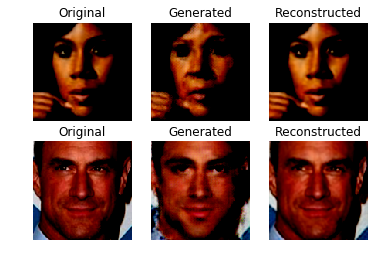

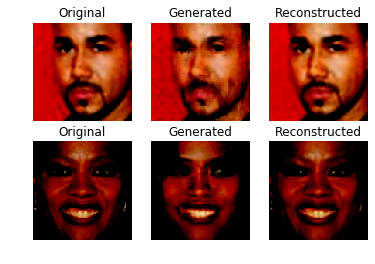

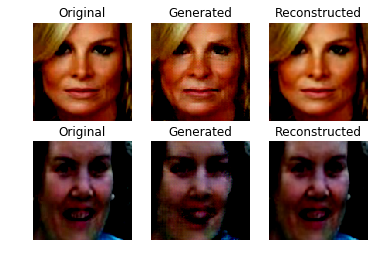

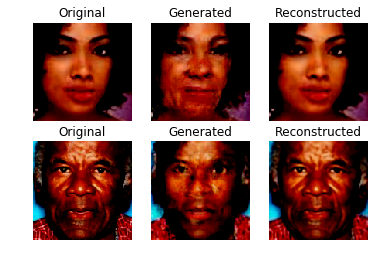

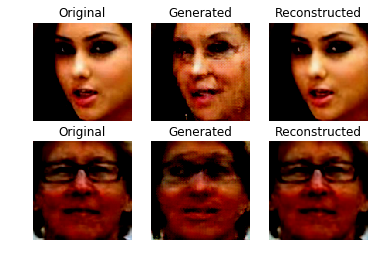

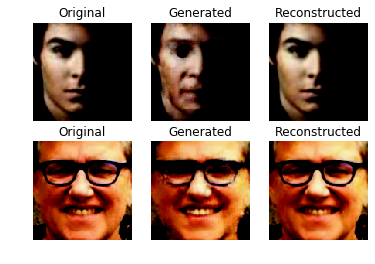

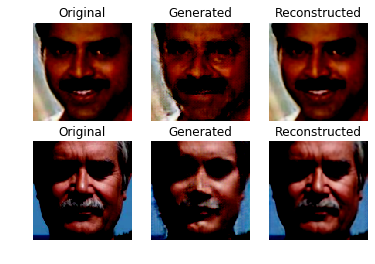

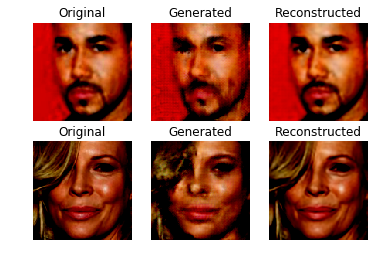

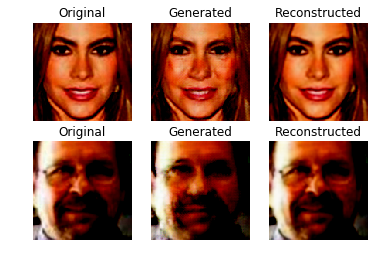

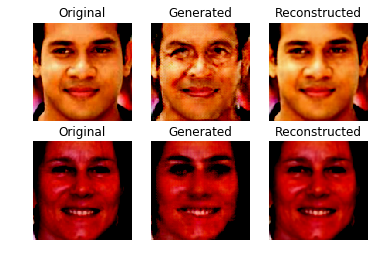

In [33]:
import warnings
import datetime
warnings.filterwarnings('ignore')
batch_size = 1
epochs = 100
mode = 'predict'
start_time = datetime.datetime.now()

if mode == 'train':
    """
    Load dataset
    """
    imagesA, imagesB = load_images(data_dir=data_dir)

    # Define the common optimizer
    common_optimizer = Adam(0.0002, 0.5)

    # Build and compile generator networks
    discriminatorA = build_discriminator()
    discriminatorB = build_discriminator()

    discriminatorA.compile(loss='mse', optimizer=common_optimizer, metrics=['accuracy'])
    discriminatorB.compile(loss='mse', optimizer=common_optimizer, metrics=['accuracy'])

    # Build generator networks
    generatorAToB = build_generator()
    generatorBToA = build_generator()

    """
    Create an adversarial network
    """
    inputA = Input(shape=(128, 128, 3))
    inputB = Input(shape=(128, 128, 3))

    # Generated images using both of the generator networks
    generatedB = generatorAToB(inputA)
    generatedA = generatorBToA(inputB)

    # Reconstruct images back to original images
    reconstructedA = generatorBToA(generatedB)
    reconstructedB = generatorAToB(generatedA)

    generatedAId = generatorBToA(inputA)
    generatedBId = generatorAToB(inputB)

    # Make both of the discriminator networks non-trainable
    discriminatorA.trainable = False
    discriminatorB.trainable = False

    probsA = discriminatorA(generatedA)
    probsB = discriminatorB(generatedB)

    adversarial_model = Model(inputs=[inputA, inputB],
                              outputs=[probsA, probsB, reconstructedA, reconstructedB,
                                       generatedAId, generatedBId])
    adversarial_model.compile(loss=['mse', 'mse', 'mae', 'mae', 'mae', 'mae'],
                              loss_weights=[1, 1, 10.0, 10.0, 1.0, 1.0],
                              optimizer=common_optimizer)

#     #tensorboard = TensorBoard(log_dir="logs/{}".format(time.time()), write_images=True, write_grads=True,
#                               write_graph=True)
#     tensorboard.set_model(generatorAToB)
#     tensorboard.set_model(generatorBToA)
#     tensorboard.set_model(discriminatorA)
#     tensorboard.set_model(discriminatorB)

    real_labels = np.ones((batch_size, 7, 7, 1))
    fake_labels = np.zeros((batch_size, 7, 7, 1))

    for epoch in range(epochs):
        print("Epoch:{}".format(epoch))

        dis_losses = []
        gen_losses = []

        num_batches = int(min(imagesA.shape[0], imagesB.shape[0]) / batch_size)
        print("Number of batches:{}".format(num_batches))

        for index in range(num_batches):
            print("Batch:{}".format(index))

            # Sample images
            batchA = imagesA[index * batch_size:(index + 1) * batch_size]
            batchB = imagesB[index * batch_size:(index + 1) * batch_size]

            # Translate images to opposite domain
            generatedB = generatorAToB.predict(batchA)
            generatedA = generatorBToA.predict(batchB)

            # Train the discriminator A on real and fake images
            dALoss1 = discriminatorA.train_on_batch(batchA, real_labels)
            dALoss2 = discriminatorA.train_on_batch(generatedA, fake_labels)

            # Train the discriminator B on ral and fake images
            dBLoss1 = discriminatorB.train_on_batch(batchB, real_labels)
            dbLoss2 = discriminatorB.train_on_batch(generatedB, fake_labels)

            # Calculate the total discriminator loss
            d_loss = 0.5 * np.add(0.5 * np.add(dALoss1, dALoss2), 0.5 * np.add(dBLoss1, dbLoss2))

            print("d_loss:{}".format(d_loss))

            """
            Train the generator networks
            """
            g_loss = adversarial_model.train_on_batch([batchA, batchB],
                                                      [real_labels, real_labels, batchA, batchB, batchA, batchB])

            print("g_loss:{}".format(g_loss))

            dis_losses.append(d_loss)
            gen_losses.append(g_loss)
            
        """
        Save losses to Tensorboard after each epoch
        """
        #write_log(tensorboard, 'discriminator_loss', np.mean(dis_losses), epoch)
        #write_log(tensorboard, 'generator_loss', np.mean(gen_losses), epoch)

        # Sample and save images after every 10 epochs
        if epoch % 10 == 0:
            # Get a batch of test data
            batchA, batchB = load_test_batch(data_dir=data_dir, batch_size=2)

            # Generate images
            generatedB = generatorAToB.predict(batchA)
            generatedA = generatorBToA.predict(batchB)

            # Get reconstructed images
            reconsA = generatorBToA.predict(generatedB)
            reconsB = generatorAToB.predict(generatedA)

            # Save original, generated and reconstructed images
            for i in range(len(generatedA)):
                save_images(originalA=batchA[i], generatedB=generatedB[i], recosntructedA=reconsA[i],
                            originalB=batchB[i], generatedA=generatedA[i], reconstructedB=reconsB[i],
                            path="/content/gdrive/My Drive/EIP2/GAN/gen_{}_{}".format(epoch, i))
                
    # Save models
    generatorAToB.save_weights("/content/gdrive/My Drive/EIP2/GAN/generatorAToB.h5")
    generatorBToA.save_weights("/content/gdrive/My Drive/EIP2/GAN/generatorBToB.h5")
    discriminatorA.save_weights("/content/gdrive/My Drive/EIP2/GAN/discriminatorA.h5")
    discriminatorB.save_weights("/content/gdrive/My Drive/EIP2/GAN/discriminatorB.h5")

elif mode == 'predict':
    # Build generator networks
    generatorAToB = build_generator()
    generatorBToA = build_generator()

    generatorAToB.load_weights("/content/gdrive/My Drive/Colab Notebooks/EIP phase 2/generatorAToB (1).h5")
    generatorBToA.load_weights("/content/gdrive/My Drive/Colab Notebooks/EIP phase 2/generatorBToB (1).h5")

    # Get a batch of test data
    for _ in range(10):
      batchA, batchB = load_test_batch(data_dir=data_dir, batch_size=1)

      # Save images
      generatedB = generatorAToB.predict(batchA)
      generatedA = generatorBToA.predict(batchB)

      reconsA = generatorBToA.predict(generatedB)
      reconsB = generatorAToB.predict(generatedA)

      for i in range(len(generatedA)):
          save_images(originalA=batchA[i], generatedB=generatedB[i], recosntructedA=reconsA[i],
                      originalB=batchB[i], generatedA=generatedA[i], reconstructedB=reconsB[i],
                      path="/content/gdrive/My Drive/EIP2/GAN/predict_{}".format(i))
